In [1]:
import cvxpy as cp
import numpy as np
import scipy as sp
import scipy.io as io
import matplotlib.pyplot as plt
%matplotlib inline
%load_ext autoreload
%autoreload 2
import trefide as tfd

# Load Data 

In [2]:
# Load data
data = io.loadmat("./data/post_demix.mat")
N, T = data['C'].shape

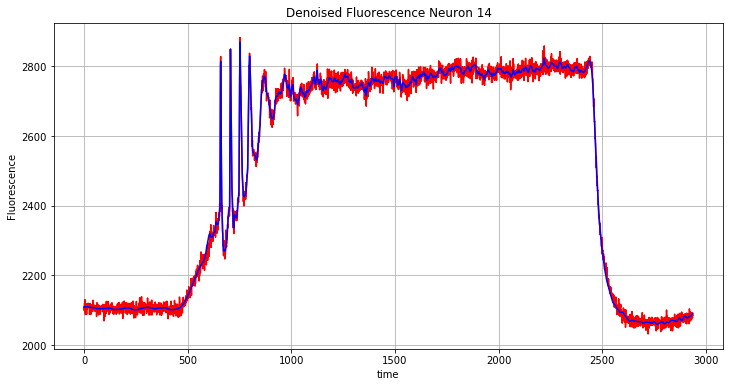

In [3]:
idx = np.random.randint(0, N)
signal = data['C'][idx,:]
trend_filtered = tfd.constrained_l1tf(signal)[0]

fig, ax = plt.subplots(figsize=(12, 6))
ax.plot(np.arange(T), signal, 'r')
ax.plot(np.arange(T), trend_filtered, 'b')

ax.set(xlabel='time', ylabel='Fluorescence',
       title='Denoised Fluorescence Neuron {}'.format(idx))
ax.grid()

plt.show()

In [4]:
import primal_dual as pd
import active_set
%autoreload 2

In [5]:
import scipy.ndimage.filters

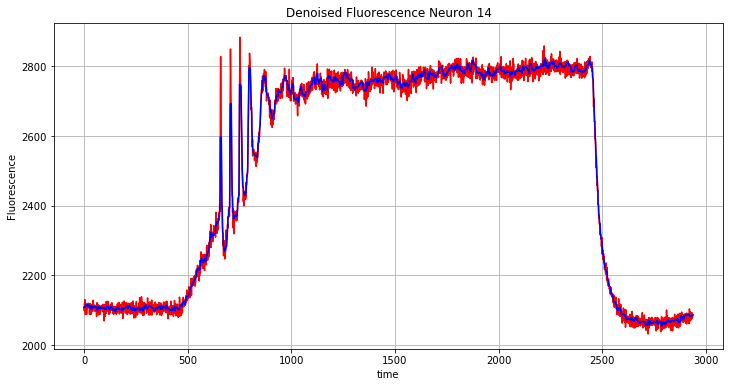

In [6]:
fig, ax = plt.subplots(figsize=(12, 6))
ax.plot(np.arange(T), signal, 'r')
ax.plot(np.arange(T), scipy.ndimage.filters.median_filter(signal, 10), 'b')

ax.set(xlabel='time', ylabel='Fluorescence',
       title='Denoised Fluorescence Neuron {}'.format(idx))
ax.grid()

plt.show()

In [364]:
x, y, results = pd.lagrangian_l1tf(signal, 
                                   warm_start=warm_start[0],
                                   lam=300, theta=1, maxiter=1e5, tol=1e-2, verbose=True)

||Iter:1||Obj: 6.902e-01||Dual: 6.226e-01||Gap: 6.758e-02||Delta Obj:       inf||Delta x: 4.442e-06||Delta y: 1.214e-01||CPU: 1.441e-03||
||Iter:2||Obj: 6.902e-01||Dual: 6.438e-01||Gap: 4.641e-02||Delta Obj:       inf||Delta x: 4.442e-06||Delta y: 7.785e-01||CPU: 2.898e-03||
||Iter:3||Obj: 6.902e-01||Dual: 6.493e-01||Gap: 4.090e-02||Delta Obj:       inf||Delta x: 4.442e-06||Delta y: 7.785e-01||CPU: 4.843e-03||
||Iter:4||Obj: 6.902e-01||Dual: 6.530e-01||Gap: 3.722e-02||Delta Obj:       inf||Delta x: 4.442e-06||Delta y: 7.785e-01||CPU: 6.928e-03||
||Iter:5||Obj: 6.902e-01||Dual: 6.560e-01||Gap: 3.420e-02||Delta Obj: 6.322e-05||Delta x: 4.442e-06||Delta y: 1.069e+00||CPU: 8.806e-03||
||Iter:6||Obj: 6.902e-01||Dual: 6.576e-01||Gap: 3.262e-02||Delta Obj: 1.549e-05||Delta x: 3.681e-06||Delta y: 5.525e+00||CPU: 1.048e-02||
||Iter:7||Obj: 6.902e-01||Dual: 6.586e-01||Gap: 3.161e-02||Delta Obj: 1.147e-05||Delta x: 3.455e-06||Delta y: 5.525e+00||CPU: 1.225e-02||
||Iter:8||Obj: 6.902e-01||Dual: 6.

||Iter:61||Obj: 6.901e-01||Dual: 6.681e-01||Gap: 2.200e-02||Delta Obj: 6.929e-06||Delta x: 2.521e-06||Delta y: 7.873e+00||CPU: 1.218e-01||
||Iter:62||Obj: 6.901e-01||Dual: 6.683e-01||Gap: 2.187e-02||Delta Obj: 6.312e-06||Delta x: 2.521e-06||Delta y: 7.873e+00||CPU: 1.242e-01||
||Iter:63||Obj: 6.901e-01||Dual: 6.684e-01||Gap: 2.170e-02||Delta Obj: 5.367e-06||Delta x: 2.521e-06||Delta y: 7.873e+00||CPU: 1.260e-01||
||Iter:64||Obj: 6.901e-01||Dual: 6.686e-01||Gap: 2.152e-02||Delta Obj: 4.993e-06||Delta x: 2.518e-06||Delta y: 7.603e+00||CPU: 1.277e-01||
||Iter:65||Obj: 6.901e-01||Dual: 6.688e-01||Gap: 2.134e-02||Delta Obj: 5.590e-06||Delta x: 2.513e-06||Delta y: 7.603e+00||CPU: 1.294e-01||
||Iter:66||Obj: 6.901e-01||Dual: 6.690e-01||Gap: 2.117e-02||Delta Obj: 5.953e-06||Delta x: 2.506e-06||Delta y: 7.603e+00||CPU: 1.316e-01||
||Iter:67||Obj: 6.901e-01||Dual: 6.691e-01||Gap: 2.102e-02||Delta Obj: 6.851e-06||Delta x: 2.498e-06||Delta y: 7.603e+00||CPU: 1.333e-01||
||Iter:68||Obj: 6.901e-01||

/Users/ikinsella/miniconda3/envs/caiman/lib/python3.5/site-packages/scipy/sparse/linalg/dsolve/linsolve.py:102: SparseEfficiencyWarning: spsolve requires A be CSC or CSR matrix format
  SparseEfficiencyWarning)
/Users/ikinsella/devel/voltagedenoising/primal_dual.py:347: RuntimeWarning: divide by zero encountered in true_divide
  delta_obj = np.max(np.abs((obj[itr % buff] - obj) / obj))


||Iter:100||Obj: 6.901e-01||Dual: 6.692e-01||Gap: 2.089e-02||Delta Obj: 1.086e-05||Delta x: 2.457e-06||Delta y: 1.356e+00||CPU: 1.988e-01||
||Iter:101||Obj: 6.901e-01||Dual: 6.692e-01||Gap: 2.087e-02||Delta Obj: 1.018e-05||Delta x: 2.457e-06||Delta y: 1.608e+01||CPU: 2.005e-01||
||Iter:102||Obj: 6.901e-01||Dual: 6.692e-01||Gap: 2.085e-02||Delta Obj: 9.236e-06||Delta x: 2.457e-06||Delta y: 1.608e+01||CPU: 2.027e-01||
||Iter:103||Obj: 6.901e-01||Dual: 6.692e-01||Gap: 2.082e-02||Delta Obj: 8.705e-06||Delta x: 2.457e-06||Delta y: 1.608e+01||CPU: 2.043e-01||
||Iter:104||Obj: 6.901e-01||Dual: 6.693e-01||Gap: 2.080e-02||Delta Obj: 8.435e-06||Delta x: 2.457e-06||Delta y: 1.608e+01||CPU: 2.078e-01||
||Iter:105||Obj: 6.901e-01||Dual: 6.693e-01||Gap: 2.078e-02||Delta Obj: 8.346e-06||Delta x: 2.456e-06||Delta y: 1.608e+01||CPU: 2.102e-01||
||Iter:106||Obj: 6.901e-01||Dual: 6.693e-01||Gap: 2.077e-02||Delta Obj: 8.297e-06||Delta x: 2.455e-06||Delta y: 2.380e+02||CPU: 2.120e-01||
||Iter:107||Obj: 6.9

||Iter:159||Obj: 6.900e-01||Dual: 6.709e-01||Gap: 1.913e-02||Delta Obj: 1.127e-05||Delta x: 2.360e-06||Delta y: 1.074e+01||CPU: 3.434e-01||
||Iter:160||Obj: 6.900e-01||Dual: 6.709e-01||Gap: 1.914e-02||Delta Obj: 1.067e-05||Delta x: 2.360e-06||Delta y: 8.670e+00||CPU: 3.448e-01||
||Iter:161||Obj: 6.900e-01||Dual: 6.709e-01||Gap: 1.910e-02||Delta Obj: 9.150e-06||Delta x: 2.360e-06||Delta y: 1.388e+02||CPU: 3.471e-01||
||Iter:162||Obj: 6.900e-01||Dual: 6.710e-01||Gap: 1.901e-02||Delta Obj: 6.605e-06||Delta x: 2.360e-06||Delta y: 1.824e+02||CPU: 3.506e-01||
||Iter:163||Obj: 6.900e-01||Dual: 6.711e-01||Gap: 1.892e-02||Delta Obj: 4.329e-06||Delta x: 2.360e-06||Delta y: 1.824e+02||CPU: 3.524e-01||
||Iter:164||Obj: 6.900e-01||Dual: 6.712e-01||Gap: 1.883e-02||Delta Obj: 2.771e-06||Delta x: 2.360e-06||Delta y: 1.824e+02||CPU: 3.546e-01||
||Iter:165||Obj: 6.900e-01||Dual: 6.712e-01||Gap: 1.876e-02||Delta Obj: 2.225e-06||Delta x: 2.358e-06||Delta y: 1.824e+02||CPU: 3.564e-01||
||Iter:166||Obj: 6.9

||Iter:218||Obj: 6.899e-01||Dual: 6.716e-01||Gap: 1.836e-02||Delta Obj: 6.286e-06||Delta x: 2.316e-06||Delta y: 1.638e+01||CPU: 4.743e-01||
||Iter:219||Obj: 6.899e-01||Dual: 6.716e-01||Gap: 1.831e-02||Delta Obj: 6.126e-06||Delta x: 2.315e-06||Delta y: 1.638e+01||CPU: 4.764e-01||
||Iter:220||Obj: 6.899e-01||Dual: 6.717e-01||Gap: 1.827e-02||Delta Obj: 5.345e-06||Delta x: 2.313e-06||Delta y: 1.638e+01||CPU: 4.786e-01||
||Iter:221||Obj: 6.899e-01||Dual: 6.717e-01||Gap: 1.822e-02||Delta Obj: 4.494e-06||Delta x: 2.311e-06||Delta y: 1.445e+01||CPU: 4.809e-01||
||Iter:222||Obj: 6.899e-01||Dual: 6.717e-01||Gap: 1.818e-02||Delta Obj: 3.561e-06||Delta x: 2.309e-06||Delta y: 5.731e+00||CPU: 4.830e-01||
||Iter:223||Obj: 6.899e-01||Dual: 6.718e-01||Gap: 1.813e-02||Delta Obj: 3.026e-06||Delta x: 2.306e-06||Delta y: 5.731e+00||CPU: 4.854e-01||
||Iter:224||Obj: 6.899e-01||Dual: 6.718e-01||Gap: 1.808e-02||Delta Obj: 3.112e-06||Delta x: 2.304e-06||Delta y: 5.731e+00||CPU: 4.870e-01||
||Iter:225||Obj: 6.8

||Iter:277||Obj: 6.898e-01||Dual: 6.719e-01||Gap: 1.796e-02||Delta Obj: 7.925e-06||Delta x: 2.288e-06||Delta y: 1.496e+00||CPU: 6.006e-01||
||Iter:278||Obj: 6.898e-01||Dual: 6.719e-01||Gap: 1.796e-02||Delta Obj: 8.051e-06||Delta x: 2.288e-06||Delta y: 1.880e+01||CPU: 6.028e-01||
||Iter:279||Obj: 6.898e-01||Dual: 6.719e-01||Gap: 1.797e-02||Delta Obj: 8.070e-06||Delta x: 2.289e-06||Delta y: 1.880e+01||CPU: 6.044e-01||
||Iter:280||Obj: 6.898e-01||Dual: 6.719e-01||Gap: 1.797e-02||Delta Obj: 7.833e-06||Delta x: 2.289e-06||Delta y: 5.480e+01||CPU: 6.060e-01||
||Iter:281||Obj: 6.898e-01||Dual: 6.719e-01||Gap: 1.797e-02||Delta Obj: 7.514e-06||Delta x: 2.289e-06||Delta y: 5.480e+01||CPU: 6.082e-01||
||Iter:282||Obj: 6.898e-01||Dual: 6.719e-01||Gap: 1.797e-02||Delta Obj: 6.907e-06||Delta x: 2.289e-06||Delta y: 5.480e+01||CPU: 6.100e-01||
||Iter:283||Obj: 6.898e-01||Dual: 6.719e-01||Gap: 1.796e-02||Delta Obj: 5.931e-06||Delta x: 2.289e-06||Delta y: 5.480e+01||CPU: 6.118e-01||
||Iter:284||Obj: 6.8

||Iter:336||Obj: 6.898e-01||Dual: 6.725e-01||Gap: 1.725e-02||Delta Obj: 8.587e-06||Delta x: 2.236e-06||Delta y: 4.383e+01||CPU: 7.253e-01||
||Iter:337||Obj: 6.898e-01||Dual: 6.725e-01||Gap: 1.726e-02||Delta Obj: 8.609e-06||Delta x: 2.237e-06||Delta y: 4.383e+01||CPU: 7.276e-01||
||Iter:338||Obj: 6.898e-01||Dual: 6.725e-01||Gap: 1.726e-02||Delta Obj: 8.635e-06||Delta x: 2.237e-06||Delta y: 4.244e+00||CPU: 7.300e-01||
||Iter:339||Obj: 6.898e-01||Dual: 6.725e-01||Gap: 1.727e-02||Delta Obj: 8.669e-06||Delta x: 2.237e-06||Delta y: 4.593e+00||CPU: 7.318e-01||
||Iter:340||Obj: 6.898e-01||Dual: 6.725e-01||Gap: 1.727e-02||Delta Obj: 8.703e-06||Delta x: 2.238e-06||Delta y: 1.262e+01||CPU: 7.348e-01||
||Iter:341||Obj: 6.898e-01||Dual: 6.725e-01||Gap: 1.728e-02||Delta Obj: 8.824e-06||Delta x: 2.238e-06||Delta y: 1.262e+01||CPU: 7.368e-01||
||Iter:342||Obj: 6.898e-01||Dual: 6.725e-01||Gap: 1.728e-02||Delta Obj: 8.964e-06||Delta x: 2.239e-06||Delta y: 1.262e+01||CPU: 7.384e-01||
||Iter:343||Obj: 6.8

||Iter:395||Obj: 6.897e-01||Dual: 6.724e-01||Gap: 1.734e-02||Delta Obj: 6.121e-06||Delta x: 2.249e-06||Delta y: 1.745e+02||CPU: 8.516e-01||
||Iter:396||Obj: 6.897e-01||Dual: 6.724e-01||Gap: 1.733e-02||Delta Obj: 6.150e-06||Delta x: 2.248e-06||Delta y: 1.745e+02||CPU: 8.533e-01||
||Iter:397||Obj: 6.897e-01||Dual: 6.724e-01||Gap: 1.732e-02||Delta Obj: 6.124e-06||Delta x: 2.247e-06||Delta y: 1.745e+02||CPU: 8.551e-01||
||Iter:398||Obj: 6.897e-01||Dual: 6.724e-01||Gap: 1.731e-02||Delta Obj: 6.143e-06||Delta x: 2.247e-06||Delta y: 1.745e+02||CPU: 8.576e-01||
||Iter:399||Obj: 6.897e-01||Dual: 6.724e-01||Gap: 1.730e-02||Delta Obj: 6.210e-06||Delta x: 2.246e-06||Delta y: 1.745e+02||CPU: 8.592e-01||
||Iter:400||Obj: 6.897e-01||Dual: 6.724e-01||Gap: 1.729e-02||Delta Obj: 6.310e-06||Delta x: 2.245e-06||Delta y: 1.027e+01||CPU: 8.610e-01||
||Iter:401||Obj: 6.897e-01||Dual: 6.724e-01||Gap: 1.728e-02||Delta Obj: 6.303e-06||Delta x: 2.244e-06||Delta y: 1.027e+01||CPU: 8.627e-01||
||Iter:402||Obj: 6.8

||Iter:454||Obj: 6.897e-01||Dual: 6.726e-01||Gap: 1.705e-02||Delta Obj: 6.090e-06||Delta x: 2.229e-06||Delta y: 1.055e+01||CPU: 9.816e-01||
||Iter:455||Obj: 6.897e-01||Dual: 6.726e-01||Gap: 1.705e-02||Delta Obj: 5.951e-06||Delta x: 2.229e-06||Delta y: 1.453e+01||CPU: 9.845e-01||
||Iter:456||Obj: 6.896e-01||Dual: 6.726e-01||Gap: 1.705e-02||Delta Obj: 5.861e-06||Delta x: 2.229e-06||Delta y: 1.909e+01||CPU: 9.864e-01||
||Iter:457||Obj: 6.896e-01||Dual: 6.726e-01||Gap: 1.704e-02||Delta Obj: 5.879e-06||Delta x: 2.228e-06||Delta y: 1.909e+01||CPU: 9.898e-01||
||Iter:458||Obj: 6.896e-01||Dual: 6.726e-01||Gap: 1.704e-02||Delta Obj: 5.925e-06||Delta x: 2.228e-06||Delta y: 1.909e+01||CPU: 9.920e-01||
||Iter:459||Obj: 6.896e-01||Dual: 6.726e-01||Gap: 1.704e-02||Delta Obj: 6.038e-06||Delta x: 2.227e-06||Delta y: 1.909e+01||CPU: 9.944e-01||
||Iter:460||Obj: 6.896e-01||Dual: 6.726e-01||Gap: 1.704e-02||Delta Obj: 6.139e-06||Delta x: 2.227e-06||Delta y: 1.909e+01||CPU: 9.963e-01||
||Iter:461||Obj: 6.8

||Iter:513||Obj: 6.896e-01||Dual: 6.727e-01||Gap: 1.688e-02||Delta Obj: 6.306e-06||Delta x: 2.217e-06||Delta y: 5.104e+00||CPU: 1.123e+00||
||Iter:514||Obj: 6.896e-01||Dual: 6.727e-01||Gap: 1.688e-02||Delta Obj: 6.125e-06||Delta x: 2.217e-06||Delta y: 5.104e+00||CPU: 1.125e+00||
||Iter:515||Obj: 6.896e-01||Dual: 6.727e-01||Gap: 1.688e-02||Delta Obj: 5.928e-06||Delta x: 2.217e-06||Delta y: 5.104e+00||CPU: 1.128e+00||
||Iter:516||Obj: 6.896e-01||Dual: 6.727e-01||Gap: 1.688e-02||Delta Obj: 5.920e-06||Delta x: 2.217e-06||Delta y: 5.104e+00||CPU: 1.130e+00||
||Iter:517||Obj: 6.896e-01||Dual: 6.727e-01||Gap: 1.688e-02||Delta Obj: 6.053e-06||Delta x: 2.217e-06||Delta y: 5.104e+00||CPU: 1.131e+00||
||Iter:518||Obj: 6.896e-01||Dual: 6.727e-01||Gap: 1.688e-02||Delta Obj: 6.103e-06||Delta x: 2.217e-06||Delta y: 3.613e+00||CPU: 1.133e+00||
||Iter:519||Obj: 6.896e-01||Dual: 6.727e-01||Gap: 1.688e-02||Delta Obj: 6.050e-06||Delta x: 2.217e-06||Delta y: 3.613e+00||CPU: 1.136e+00||
||Iter:520||Obj: 6.8

||Iter:572||Obj: 6.895e-01||Dual: 6.729e-01||Gap: 1.658e-02||Delta Obj: 6.886e-06||Delta x: 2.198e-06||Delta y: 4.868e+01||CPU: 1.255e+00||
||Iter:573||Obj: 6.895e-01||Dual: 6.730e-01||Gap: 1.657e-02||Delta Obj: 6.761e-06||Delta x: 2.197e-06||Delta y: 2.681e+00||CPU: 1.257e+00||
||Iter:574||Obj: 6.895e-01||Dual: 6.730e-01||Gap: 1.656e-02||Delta Obj: 6.699e-06||Delta x: 2.197e-06||Delta y: 2.681e+00||CPU: 1.261e+00||
||Iter:575||Obj: 6.895e-01||Dual: 6.730e-01||Gap: 1.655e-02||Delta Obj: 6.571e-06||Delta x: 2.196e-06||Delta y: 7.352e+00||CPU: 1.264e+00||
||Iter:576||Obj: 6.895e-01||Dual: 6.730e-01||Gap: 1.654e-02||Delta Obj: 6.461e-06||Delta x: 2.195e-06||Delta y: 7.352e+00||CPU: 1.266e+00||
||Iter:577||Obj: 6.895e-01||Dual: 6.730e-01||Gap: 1.654e-02||Delta Obj: 6.343e-06||Delta x: 2.195e-06||Delta y: 7.352e+00||CPU: 1.268e+00||
||Iter:578||Obj: 6.895e-01||Dual: 6.730e-01||Gap: 1.653e-02||Delta Obj: 6.216e-06||Delta x: 2.194e-06||Delta y: 7.352e+00||CPU: 1.271e+00||
||Iter:579||Obj: 6.8

||Iter:631||Obj: 6.895e-01||Dual: 6.730e-01||Gap: 1.651e-02||Delta Obj: 7.204e-06||Delta x: 2.191e-06||Delta y: 7.544e-01||CPU: 1.391e+00||
||Iter:632||Obj: 6.895e-01||Dual: 6.729e-01||Gap: 1.651e-02||Delta Obj: 7.179e-06||Delta x: 2.191e-06||Delta y: 1.380e+00||CPU: 1.393e+00||
||Iter:633||Obj: 6.895e-01||Dual: 6.729e-01||Gap: 1.652e-02||Delta Obj: 7.150e-06||Delta x: 2.191e-06||Delta y: 5.365e+00||CPU: 1.395e+00||
||Iter:634||Obj: 6.895e-01||Dual: 6.729e-01||Gap: 1.652e-02||Delta Obj: 7.172e-06||Delta x: 2.192e-06||Delta y: 5.365e+00||CPU: 1.398e+00||
||Iter:635||Obj: 6.895e-01||Dual: 6.729e-01||Gap: 1.652e-02||Delta Obj: 7.201e-06||Delta x: 2.192e-06||Delta y: 5.365e+00||CPU: 1.400e+00||
||Iter:636||Obj: 6.895e-01||Dual: 6.729e-01||Gap: 1.652e-02||Delta Obj: 7.257e-06||Delta x: 2.192e-06||Delta y: 5.365e+00||CPU: 1.402e+00||
||Iter:637||Obj: 6.895e-01||Dual: 6.729e-01||Gap: 1.652e-02||Delta Obj: 7.292e-06||Delta x: 2.192e-06||Delta y: 5.365e+00||CPU: 1.405e+00||
||Iter:638||Obj: 6.8

||Iter:690||Obj: 6.894e-01||Dual: 6.729e-01||Gap: 1.654e-02||Delta Obj: 6.555e-06||Delta x: 2.197e-06||Delta y: 2.560e+00||CPU: 1.529e+00||
||Iter:691||Obj: 6.894e-01||Dual: 6.729e-01||Gap: 1.653e-02||Delta Obj: 6.526e-06||Delta x: 2.197e-06||Delta y: 2.560e+00||CPU: 1.532e+00||
||Iter:692||Obj: 6.894e-01||Dual: 6.729e-01||Gap: 1.653e-02||Delta Obj: 6.482e-06||Delta x: 2.196e-06||Delta y: 2.939e+01||CPU: 1.535e+00||
||Iter:693||Obj: 6.894e-01||Dual: 6.729e-01||Gap: 1.652e-02||Delta Obj: 6.418e-06||Delta x: 2.196e-06||Delta y: 3.741e+01||CPU: 1.537e+00||
||Iter:694||Obj: 6.894e-01||Dual: 6.729e-01||Gap: 1.652e-02||Delta Obj: 6.350e-06||Delta x: 2.195e-06||Delta y: 3.741e+01||CPU: 1.539e+00||
||Iter:695||Obj: 6.894e-01||Dual: 6.729e-01||Gap: 1.651e-02||Delta Obj: 6.313e-06||Delta x: 2.195e-06||Delta y: 3.741e+01||CPU: 1.540e+00||
||Iter:696||Obj: 6.894e-01||Dual: 6.729e-01||Gap: 1.650e-02||Delta Obj: 6.205e-06||Delta x: 2.194e-06||Delta y: 3.741e+01||CPU: 1.542e+00||
||Iter:697||Obj: 6.8

||Iter:749||Obj: 6.893e-01||Dual: 6.731e-01||Gap: 1.627e-02||Delta Obj: 6.213e-06||Delta x: 2.175e-06||Delta y: 1.203e+01||CPU: 1.664e+00||
||Iter:750||Obj: 6.893e-01||Dual: 6.731e-01||Gap: 1.627e-02||Delta Obj: 6.351e-06||Delta x: 2.175e-06||Delta y: 1.203e+01||CPU: 1.666e+00||
||Iter:751||Obj: 6.893e-01||Dual: 6.731e-01||Gap: 1.627e-02||Delta Obj: 6.438e-06||Delta x: 2.175e-06||Delta y: 3.089e+00||CPU: 1.670e+00||
||Iter:752||Obj: 6.893e-01||Dual: 6.731e-01||Gap: 1.626e-02||Delta Obj: 6.483e-06||Delta x: 2.175e-06||Delta y: 2.579e+00||CPU: 1.672e+00||
||Iter:753||Obj: 6.893e-01||Dual: 6.731e-01||Gap: 1.626e-02||Delta Obj: 6.462e-06||Delta x: 2.174e-06||Delta y: 2.579e+00||CPU: 1.674e+00||
||Iter:754||Obj: 6.893e-01||Dual: 6.731e-01||Gap: 1.626e-02||Delta Obj: 6.472e-06||Delta x: 2.174e-06||Delta y: 2.579e+00||CPU: 1.677e+00||
||Iter:755||Obj: 6.893e-01||Dual: 6.731e-01||Gap: 1.626e-02||Delta Obj: 6.512e-06||Delta x: 2.174e-06||Delta y: 2.579e+00||CPU: 1.678e+00||
||Iter:756||Obj: 6.8

||Iter:808||Obj: 6.893e-01||Dual: 6.730e-01||Gap: 1.625e-02||Delta Obj: 5.636e-06||Delta x: 2.175e-06||Delta y: 4.873e+00||CPU: 1.800e+00||
||Iter:809||Obj: 6.893e-01||Dual: 6.730e-01||Gap: 1.624e-02||Delta Obj: 5.571e-06||Delta x: 2.175e-06||Delta y: 4.873e+00||CPU: 1.802e+00||
||Iter:810||Obj: 6.893e-01||Dual: 6.730e-01||Gap: 1.624e-02||Delta Obj: 5.638e-06||Delta x: 2.175e-06||Delta y: 4.873e+00||CPU: 1.804e+00||
||Iter:811||Obj: 6.893e-01||Dual: 6.730e-01||Gap: 1.624e-02||Delta Obj: 5.699e-06||Delta x: 2.174e-06||Delta y: 3.778e+00||CPU: 1.806e+00||
||Iter:812||Obj: 6.893e-01||Dual: 6.730e-01||Gap: 1.624e-02||Delta Obj: 5.770e-06||Delta x: 2.174e-06||Delta y: 3.778e+00||CPU: 1.808e+00||
||Iter:813||Obj: 6.893e-01||Dual: 6.730e-01||Gap: 1.624e-02||Delta Obj: 5.842e-06||Delta x: 2.174e-06||Delta y: 2.674e+00||CPU: 1.811e+00||
||Iter:814||Obj: 6.893e-01||Dual: 6.730e-01||Gap: 1.624e-02||Delta Obj: 5.904e-06||Delta x: 2.174e-06||Delta y: 2.674e+00||CPU: 1.813e+00||
||Iter:815||Obj: 6.8

||Iter:867||Obj: 6.892e-01||Dual: 6.730e-01||Gap: 1.619e-02||Delta Obj: 5.284e-06||Delta x: 2.172e-06||Delta y: 1.459e+00||CPU: 1.930e+00||
||Iter:868||Obj: 6.892e-01||Dual: 6.730e-01||Gap: 1.618e-02||Delta Obj: 5.261e-06||Delta x: 2.172e-06||Delta y: 7.724e+00||CPU: 1.933e+00||
||Iter:869||Obj: 6.892e-01||Dual: 6.730e-01||Gap: 1.618e-02||Delta Obj: 5.215e-06||Delta x: 2.172e-06||Delta y: 7.724e+00||CPU: 1.935e+00||
||Iter:870||Obj: 6.892e-01||Dual: 6.730e-01||Gap: 1.617e-02||Delta Obj: 5.193e-06||Delta x: 2.171e-06||Delta y: 7.724e+00||CPU: 1.936e+00||
||Iter:871||Obj: 6.892e-01||Dual: 6.730e-01||Gap: 1.616e-02||Delta Obj: 5.210e-06||Delta x: 2.171e-06||Delta y: 7.724e+00||CPU: 1.938e+00||
||Iter:872||Obj: 6.892e-01||Dual: 6.730e-01||Gap: 1.616e-02||Delta Obj: 5.239e-06||Delta x: 2.170e-06||Delta y: 7.724e+00||CPU: 1.940e+00||
||Iter:873||Obj: 6.892e-01||Dual: 6.731e-01||Gap: 1.615e-02||Delta Obj: 5.284e-06||Delta x: 2.170e-06||Delta y: 3.111e+00||CPU: 1.942e+00||
||Iter:874||Obj: 6.8

||Iter:925||Obj: 6.891e-01||Dual: 6.731e-01||Gap: 1.610e-02||Delta Obj: 6.538e-06||Delta x: 2.165e-06||Delta y: 8.881e-01||CPU: 2.067e+00||
||Iter:926||Obj: 6.891e-01||Dual: 6.730e-01||Gap: 1.610e-02||Delta Obj: 6.577e-06||Delta x: 2.165e-06||Delta y: 3.298e+00||CPU: 2.071e+00||
||Iter:927||Obj: 6.891e-01||Dual: 6.730e-01||Gap: 1.610e-02||Delta Obj: 6.631e-06||Delta x: 2.165e-06||Delta y: 3.298e+00||CPU: 2.073e+00||
||Iter:928||Obj: 6.891e-01||Dual: 6.730e-01||Gap: 1.610e-02||Delta Obj: 6.723e-06||Delta x: 2.165e-06||Delta y: 3.298e+00||CPU: 2.075e+00||
||Iter:929||Obj: 6.891e-01||Dual: 6.730e-01||Gap: 1.610e-02||Delta Obj: 6.797e-06||Delta x: 2.165e-06||Delta y: 8.043e+00||CPU: 2.078e+00||
||Iter:930||Obj: 6.891e-01||Dual: 6.730e-01||Gap: 1.610e-02||Delta Obj: 6.814e-06||Delta x: 2.165e-06||Delta y: 8.043e+00||CPU: 2.079e+00||
||Iter:931||Obj: 6.891e-01||Dual: 6.730e-01||Gap: 1.610e-02||Delta Obj: 6.809e-06||Delta x: 2.165e-06||Delta y: 8.043e+00||CPU: 2.082e+00||
||Iter:932||Obj: 6.8

||Iter:984||Obj: 6.891e-01||Dual: 6.732e-01||Gap: 1.588e-02||Delta Obj: 5.873e-06||Delta x: 2.150e-06||Delta y: 2.387e+01||CPU: 2.201e+00||
||Iter:985||Obj: 6.891e-01||Dual: 6.732e-01||Gap: 1.588e-02||Delta Obj: 5.803e-06||Delta x: 2.149e-06||Delta y: 2.387e+01||CPU: 2.203e+00||
||Iter:986||Obj: 6.891e-01||Dual: 6.732e-01||Gap: 1.588e-02||Delta Obj: 5.758e-06||Delta x: 2.149e-06||Delta y: 2.387e+01||CPU: 2.206e+00||
||Iter:987||Obj: 6.891e-01||Dual: 6.732e-01||Gap: 1.587e-02||Delta Obj: 5.720e-06||Delta x: 2.149e-06||Delta y: 2.387e+01||CPU: 2.208e+00||
||Iter:988||Obj: 6.891e-01||Dual: 6.732e-01||Gap: 1.587e-02||Delta Obj: 5.685e-06||Delta x: 2.148e-06||Delta y: 3.652e+00||CPU: 2.210e+00||
||Iter:989||Obj: 6.891e-01||Dual: 6.732e-01||Gap: 1.586e-02||Delta Obj: 5.734e-06||Delta x: 2.148e-06||Delta y: 1.003e+01||CPU: 2.212e+00||
||Iter:990||Obj: 6.891e-01||Dual: 6.732e-01||Gap: 1.586e-02||Delta Obj: 5.765e-06||Delta x: 2.148e-06||Delta y: 1.003e+01||CPU: 2.214e+00||
||Iter:991||Obj: 6.8

||Iter:1043||Obj: 6.890e-01||Dual: 6.733e-01||Gap: 1.576e-02||Delta Obj: 5.923e-06||Delta x: 2.141e-06||Delta y: 4.783e+00||CPU: 2.331e+00||
||Iter:1044||Obj: 6.890e-01||Dual: 6.733e-01||Gap: 1.576e-02||Delta Obj: 5.815e-06||Delta x: 2.141e-06||Delta y: 4.783e+00||CPU: 2.334e+00||
||Iter:1045||Obj: 6.890e-01||Dual: 6.733e-01||Gap: 1.576e-02||Delta Obj: 5.743e-06||Delta x: 2.141e-06||Delta y: 5.532e+00||CPU: 2.337e+00||
||Iter:1046||Obj: 6.890e-01||Dual: 6.733e-01||Gap: 1.576e-02||Delta Obj: 5.827e-06||Delta x: 2.140e-06||Delta y: 5.532e+00||CPU: 2.338e+00||
||Iter:1047||Obj: 6.890e-01||Dual: 6.733e-01||Gap: 1.576e-02||Delta Obj: 5.884e-06||Delta x: 2.140e-06||Delta y: 5.532e+00||CPU: 2.341e+00||
||Iter:1048||Obj: 6.890e-01||Dual: 6.733e-01||Gap: 1.576e-02||Delta Obj: 5.915e-06||Delta x: 2.140e-06||Delta y: 5.532e+00||CPU: 2.343e+00||
||Iter:1049||Obj: 6.890e-01||Dual: 6.733e-01||Gap: 1.576e-02||Delta Obj: 6.016e-06||Delta x: 2.140e-06||Delta y: 6.526e+00||CPU: 2.345e+00||
||Iter:1050||

||Iter:1101||Obj: 6.890e-01||Dual: 6.732e-01||Gap: 1.578e-02||Delta Obj: 6.665e-06||Delta x: 2.140e-06||Delta y: 7.702e+00||CPU: 2.472e+00||
||Iter:1102||Obj: 6.890e-01||Dual: 6.732e-01||Gap: 1.578e-02||Delta Obj: 6.696e-06||Delta x: 2.140e-06||Delta y: 7.702e+00||CPU: 2.475e+00||
||Iter:1103||Obj: 6.890e-01||Dual: 6.732e-01||Gap: 1.578e-02||Delta Obj: 6.734e-06||Delta x: 2.140e-06||Delta y: 7.702e+00||CPU: 2.478e+00||
||Iter:1104||Obj: 6.890e-01||Dual: 6.732e-01||Gap: 1.578e-02||Delta Obj: 6.764e-06||Delta x: 2.140e-06||Delta y: 6.106e+01||CPU: 2.482e+00||
||Iter:1105||Obj: 6.890e-01||Dual: 6.732e-01||Gap: 1.578e-02||Delta Obj: 6.791e-06||Delta x: 2.140e-06||Delta y: 6.106e+01||CPU: 2.484e+00||
||Iter:1106||Obj: 6.890e-01||Dual: 6.732e-01||Gap: 1.578e-02||Delta Obj: 6.803e-06||Delta x: 2.140e-06||Delta y: 6.106e+01||CPU: 2.487e+00||
||Iter:1107||Obj: 6.890e-01||Dual: 6.732e-01||Gap: 1.578e-02||Delta Obj: 6.829e-06||Delta x: 2.140e-06||Delta y: 6.106e+01||CPU: 2.490e+00||
||Iter:1108||

||Iter:1160||Obj: 6.889e-01||Dual: 6.732e-01||Gap: 1.566e-02||Delta Obj: 5.590e-06||Delta x: 2.133e-06||Delta y: 1.432e+01||CPU: 2.620e+00||
||Iter:1161||Obj: 6.889e-01||Dual: 6.733e-01||Gap: 1.565e-02||Delta Obj: 5.679e-06||Delta x: 2.133e-06||Delta y: 1.432e+01||CPU: 2.623e+00||
||Iter:1162||Obj: 6.889e-01||Dual: 6.733e-01||Gap: 1.565e-02||Delta Obj: 5.768e-06||Delta x: 2.132e-06||Delta y: 1.432e+01||CPU: 2.626e+00||
||Iter:1163||Obj: 6.889e-01||Dual: 6.733e-01||Gap: 1.565e-02||Delta Obj: 5.847e-06||Delta x: 2.132e-06||Delta y: 1.432e+01||CPU: 2.627e+00||
||Iter:1164||Obj: 6.889e-01||Dual: 6.733e-01||Gap: 1.564e-02||Delta Obj: 5.909e-06||Delta x: 2.132e-06||Delta y: 5.174e+00||CPU: 2.630e+00||
||Iter:1165||Obj: 6.889e-01||Dual: 6.733e-01||Gap: 1.564e-02||Delta Obj: 5.960e-06||Delta x: 2.131e-06||Delta y: 5.174e+00||CPU: 2.632e+00||
||Iter:1166||Obj: 6.889e-01||Dual: 6.733e-01||Gap: 1.563e-02||Delta Obj: 6.016e-06||Delta x: 2.131e-06||Delta y: 3.256e+00||CPU: 2.635e+00||
||Iter:1167||

||Iter:1219||Obj: 6.888e-01||Dual: 6.732e-01||Gap: 1.560e-02||Delta Obj: 5.702e-06||Delta x: 2.129e-06||Delta y: 2.896e+00||CPU: 2.749e+00||
||Iter:1220||Obj: 6.888e-01||Dual: 6.732e-01||Gap: 1.560e-02||Delta Obj: 5.753e-06||Delta x: 2.129e-06||Delta y: 1.563e+00||CPU: 2.752e+00||
||Iter:1221||Obj: 6.888e-01||Dual: 6.732e-01||Gap: 1.560e-02||Delta Obj: 5.761e-06||Delta x: 2.129e-06||Delta y: 2.273e+00||CPU: 2.754e+00||
||Iter:1222||Obj: 6.888e-01||Dual: 6.732e-01||Gap: 1.560e-02||Delta Obj: 5.715e-06||Delta x: 2.128e-06||Delta y: 4.411e+00||CPU: 2.756e+00||
||Iter:1223||Obj: 6.888e-01||Dual: 6.732e-01||Gap: 1.560e-02||Delta Obj: 5.651e-06||Delta x: 2.128e-06||Delta y: 4.411e+00||CPU: 2.758e+00||
||Iter:1224||Obj: 6.888e-01||Dual: 6.732e-01||Gap: 1.560e-02||Delta Obj: 5.585e-06||Delta x: 2.128e-06||Delta y: 4.411e+00||CPU: 2.759e+00||
||Iter:1225||Obj: 6.888e-01||Dual: 6.732e-01||Gap: 1.560e-02||Delta Obj: 5.510e-06||Delta x: 2.128e-06||Delta y: 4.411e+00||CPU: 2.762e+00||
||Iter:1226||

||Iter:1278||Obj: 6.888e-01||Dual: 6.733e-01||Gap: 1.549e-02||Delta Obj: 5.699e-06||Delta x: 2.120e-06||Delta y: 1.314e+00||CPU: 2.886e+00||
||Iter:1279||Obj: 6.888e-01||Dual: 6.733e-01||Gap: 1.548e-02||Delta Obj: 5.755e-06||Delta x: 2.120e-06||Delta y: 8.641e-01||CPU: 2.888e+00||
||Iter:1280||Obj: 6.888e-01||Dual: 6.733e-01||Gap: 1.548e-02||Delta Obj: 5.801e-06||Delta x: 2.120e-06||Delta y: 6.649e-01||CPU: 2.890e+00||
||Iter:1281||Obj: 6.888e-01||Dual: 6.733e-01||Gap: 1.548e-02||Delta Obj: 5.827e-06||Delta x: 2.120e-06||Delta y: 5.572e-01||CPU: 2.892e+00||
||Iter:1282||Obj: 6.888e-01||Dual: 6.733e-01||Gap: 1.548e-02||Delta Obj: 5.831e-06||Delta x: 2.120e-06||Delta y: 6.349e-01||CPU: 2.894e+00||
||Iter:1283||Obj: 6.888e-01||Dual: 6.733e-01||Gap: 1.548e-02||Delta Obj: 5.837e-06||Delta x: 2.120e-06||Delta y: 1.200e+00||CPU: 2.896e+00||
||Iter:1284||Obj: 6.888e-01||Dual: 6.733e-01||Gap: 1.547e-02||Delta Obj: 5.845e-06||Delta x: 2.120e-06||Delta y: 7.422e+00||CPU: 2.898e+00||
||Iter:1285||

||Iter:1337||Obj: 6.887e-01||Dual: 6.733e-01||Gap: 1.542e-02||Delta Obj: 5.888e-06||Delta x: 2.117e-06||Delta y: 4.224e+00||CPU: 3.013e+00||
||Iter:1338||Obj: 6.887e-01||Dual: 6.733e-01||Gap: 1.542e-02||Delta Obj: 5.815e-06||Delta x: 2.117e-06||Delta y: 4.447e+00||CPU: 3.015e+00||
||Iter:1339||Obj: 6.887e-01||Dual: 6.733e-01||Gap: 1.542e-02||Delta Obj: 5.810e-06||Delta x: 2.117e-06||Delta y: 4.447e+00||CPU: 3.018e+00||
||Iter:1340||Obj: 6.887e-01||Dual: 6.733e-01||Gap: 1.541e-02||Delta Obj: 5.839e-06||Delta x: 2.116e-06||Delta y: 4.447e+00||CPU: 3.019e+00||
||Iter:1341||Obj: 6.887e-01||Dual: 6.733e-01||Gap: 1.541e-02||Delta Obj: 5.873e-06||Delta x: 2.116e-06||Delta y: 4.447e+00||CPU: 3.021e+00||
||Iter:1342||Obj: 6.887e-01||Dual: 6.733e-01||Gap: 1.541e-02||Delta Obj: 5.882e-06||Delta x: 2.116e-06||Delta y: 4.447e+00||CPU: 3.024e+00||
||Iter:1343||Obj: 6.887e-01||Dual: 6.733e-01||Gap: 1.541e-02||Delta Obj: 5.875e-06||Delta x: 2.116e-06||Delta y: 1.884e+00||CPU: 3.025e+00||
||Iter:1344||

||Iter:1396||Obj: 6.887e-01||Dual: 6.733e-01||Gap: 1.535e-02||Delta Obj: 5.679e-06||Delta x: 2.113e-06||Delta y: 1.004e+00||CPU: 3.135e+00||
||Iter:1397||Obj: 6.887e-01||Dual: 6.733e-01||Gap: 1.535e-02||Delta Obj: 5.697e-06||Delta x: 2.113e-06||Delta y: 1.184e+01||CPU: 3.138e+00||
||Iter:1398||Obj: 6.887e-01||Dual: 6.733e-01||Gap: 1.535e-02||Delta Obj: 5.697e-06||Delta x: 2.113e-06||Delta y: 1.184e+01||CPU: 3.140e+00||
||Iter:1399||Obj: 6.887e-01||Dual: 6.733e-01||Gap: 1.534e-02||Delta Obj: 5.684e-06||Delta x: 2.113e-06||Delta y: 1.184e+01||CPU: 3.142e+00||
||Iter:1400||Obj: 6.887e-01||Dual: 6.733e-01||Gap: 1.534e-02||Delta Obj: 5.676e-06||Delta x: 2.113e-06||Delta y: 1.184e+01||CPU: 3.143e+00||
||Iter:1401||Obj: 6.887e-01||Dual: 6.733e-01||Gap: 1.534e-02||Delta Obj: 5.677e-06||Delta x: 2.113e-06||Delta y: 1.184e+01||CPU: 3.146e+00||
||Iter:1402||Obj: 6.887e-01||Dual: 6.733e-01||Gap: 1.534e-02||Delta Obj: 5.700e-06||Delta x: 2.112e-06||Delta y: 1.246e+00||CPU: 3.147e+00||
||Iter:1403||

||Iter:1455||Obj: 6.886e-01||Dual: 6.734e-01||Gap: 1.519e-02||Delta Obj: 5.310e-06||Delta x: 2.102e-06||Delta y: 1.622e+02||CPU: 3.264e+00||
||Iter:1456||Obj: 6.886e-01||Dual: 6.734e-01||Gap: 1.519e-02||Delta Obj: 5.335e-06||Delta x: 2.101e-06||Delta y: 1.622e+02||CPU: 3.266e+00||
||Iter:1457||Obj: 6.886e-01||Dual: 6.734e-01||Gap: 1.519e-02||Delta Obj: 5.368e-06||Delta x: 2.101e-06||Delta y: 1.622e+02||CPU: 3.268e+00||
||Iter:1458||Obj: 6.886e-01||Dual: 6.734e-01||Gap: 1.519e-02||Delta Obj: 5.400e-06||Delta x: 2.101e-06||Delta y: 1.622e+02||CPU: 3.270e+00||
||Iter:1459||Obj: 6.886e-01||Dual: 6.734e-01||Gap: 1.519e-02||Delta Obj: 5.421e-06||Delta x: 2.101e-06||Delta y: 1.622e+02||CPU: 3.272e+00||
||Iter:1460||Obj: 6.886e-01||Dual: 6.734e-01||Gap: 1.518e-02||Delta Obj: 5.412e-06||Delta x: 2.101e-06||Delta y: 2.620e+00||CPU: 3.273e+00||
||Iter:1461||Obj: 6.886e-01||Dual: 6.734e-01||Gap: 1.518e-02||Delta Obj: 5.419e-06||Delta x: 2.101e-06||Delta y: 2.620e+00||CPU: 3.276e+00||
||Iter:1462||

||Iter:1514||Obj: 6.885e-01||Dual: 6.733e-01||Gap: 1.528e-02||Delta Obj: 6.506e-06||Delta x: 2.107e-06||Delta y: 1.286e+00||CPU: 3.398e+00||
||Iter:1515||Obj: 6.885e-01||Dual: 6.733e-01||Gap: 1.528e-02||Delta Obj: 6.495e-06||Delta x: 2.107e-06||Delta y: 9.315e-01||CPU: 3.400e+00||
||Iter:1516||Obj: 6.885e-01||Dual: 6.733e-01||Gap: 1.528e-02||Delta Obj: 6.481e-06||Delta x: 2.107e-06||Delta y: 5.381e+00||CPU: 3.403e+00||
||Iter:1517||Obj: 6.885e-01||Dual: 6.733e-01||Gap: 1.528e-02||Delta Obj: 6.460e-06||Delta x: 2.107e-06||Delta y: 5.381e+00||CPU: 3.405e+00||
||Iter:1518||Obj: 6.885e-01||Dual: 6.733e-01||Gap: 1.528e-02||Delta Obj: 6.350e-06||Delta x: 2.107e-06||Delta y: 5.381e+00||CPU: 3.407e+00||
||Iter:1519||Obj: 6.885e-01||Dual: 6.733e-01||Gap: 1.528e-02||Delta Obj: 6.216e-06||Delta x: 2.107e-06||Delta y: 5.381e+00||CPU: 3.409e+00||
||Iter:1520||Obj: 6.885e-01||Dual: 6.733e-01||Gap: 1.528e-02||Delta Obj: 6.078e-06||Delta x: 2.107e-06||Delta y: 5.381e+00||CPU: 3.411e+00||
||Iter:1521||

||Iter:1573||Obj: 6.885e-01||Dual: 6.733e-01||Gap: 1.517e-02||Delta Obj: 6.420e-06||Delta x: 2.098e-06||Delta y: 1.558e+00||CPU: 3.523e+00||
||Iter:1574||Obj: 6.885e-01||Dual: 6.733e-01||Gap: 1.517e-02||Delta Obj: 6.400e-06||Delta x: 2.098e-06||Delta y: 3.025e+00||CPU: 3.526e+00||
||Iter:1575||Obj: 6.885e-01||Dual: 6.733e-01||Gap: 1.517e-02||Delta Obj: 6.318e-06||Delta x: 2.098e-06||Delta y: 3.025e+00||CPU: 3.527e+00||
||Iter:1576||Obj: 6.885e-01||Dual: 6.733e-01||Gap: 1.516e-02||Delta Obj: 6.229e-06||Delta x: 2.098e-06||Delta y: 3.025e+00||CPU: 3.529e+00||
||Iter:1577||Obj: 6.885e-01||Dual: 6.733e-01||Gap: 1.516e-02||Delta Obj: 6.162e-06||Delta x: 2.098e-06||Delta y: 3.025e+00||CPU: 3.532e+00||
||Iter:1578||Obj: 6.885e-01||Dual: 6.733e-01||Gap: 1.516e-02||Delta Obj: 6.095e-06||Delta x: 2.098e-06||Delta y: 3.025e+00||CPU: 3.534e+00||
||Iter:1579||Obj: 6.885e-01||Dual: 6.733e-01||Gap: 1.516e-02||Delta Obj: 6.074e-06||Delta x: 2.098e-06||Delta y: 3.640e+00||CPU: 3.537e+00||
||Iter:1580||

||Iter:1632||Obj: 6.884e-01||Dual: 6.734e-01||Gap: 1.504e-02||Delta Obj: 5.618e-06||Delta x: 2.091e-06||Delta y: 7.409e+00||CPU: 3.660e+00||
||Iter:1633||Obj: 6.884e-01||Dual: 6.734e-01||Gap: 1.504e-02||Delta Obj: 5.617e-06||Delta x: 2.091e-06||Delta y: 7.409e+00||CPU: 3.662e+00||
||Iter:1634||Obj: 6.884e-01||Dual: 6.734e-01||Gap: 1.504e-02||Delta Obj: 5.604e-06||Delta x: 2.091e-06||Delta y: 7.409e+00||CPU: 3.664e+00||
||Iter:1635||Obj: 6.884e-01||Dual: 6.734e-01||Gap: 1.503e-02||Delta Obj: 5.576e-06||Delta x: 2.091e-06||Delta y: 7.409e+00||CPU: 3.666e+00||
||Iter:1636||Obj: 6.884e-01||Dual: 6.734e-01||Gap: 1.503e-02||Delta Obj: 5.565e-06||Delta x: 2.090e-06||Delta y: 1.211e+00||CPU: 3.668e+00||
||Iter:1637||Obj: 6.884e-01||Dual: 6.734e-01||Gap: 1.503e-02||Delta Obj: 5.557e-06||Delta x: 2.090e-06||Delta y: 1.240e+00||CPU: 3.670e+00||
||Iter:1638||Obj: 6.884e-01||Dual: 6.734e-01||Gap: 1.503e-02||Delta Obj: 5.564e-06||Delta x: 2.090e-06||Delta y: 5.983e+01||CPU: 3.672e+00||
||Iter:1639||

||Iter:1691||Obj: 6.884e-01||Dual: 6.734e-01||Gap: 1.498e-02||Delta Obj: 6.223e-06||Delta x: 2.086e-06||Delta y: 3.469e+00||CPU: 3.787e+00||
||Iter:1692||Obj: 6.884e-01||Dual: 6.734e-01||Gap: 1.498e-02||Delta Obj: 6.276e-06||Delta x: 2.086e-06||Delta y: 2.870e+00||CPU: 3.790e+00||
||Iter:1693||Obj: 6.884e-01||Dual: 6.734e-01||Gap: 1.498e-02||Delta Obj: 6.333e-06||Delta x: 2.086e-06||Delta y: 2.870e+00||CPU: 3.792e+00||
||Iter:1694||Obj: 6.884e-01||Dual: 6.734e-01||Gap: 1.498e-02||Delta Obj: 6.388e-06||Delta x: 2.086e-06||Delta y: 2.870e+00||CPU: 3.795e+00||
||Iter:1695||Obj: 6.884e-01||Dual: 6.734e-01||Gap: 1.498e-02||Delta Obj: 6.429e-06||Delta x: 2.086e-06||Delta y: 2.870e+00||CPU: 3.797e+00||
||Iter:1696||Obj: 6.884e-01||Dual: 6.734e-01||Gap: 1.498e-02||Delta Obj: 6.452e-06||Delta x: 2.086e-06||Delta y: 2.870e+00||CPU: 3.799e+00||
||Iter:1697||Obj: 6.884e-01||Dual: 6.734e-01||Gap: 1.498e-02||Delta Obj: 6.465e-06||Delta x: 2.086e-06||Delta y: 2.510e+00||CPU: 3.802e+00||
||Iter:1698||

||Iter:1750||Obj: 6.883e-01||Dual: 6.734e-01||Gap: 1.489e-02||Delta Obj: 5.462e-06||Delta x: 2.081e-06||Delta y: 6.147e-01||CPU: 3.931e+00||
||Iter:1751||Obj: 6.883e-01||Dual: 6.734e-01||Gap: 1.488e-02||Delta Obj: 5.441e-06||Delta x: 2.080e-06||Delta y: 7.761e-01||CPU: 3.934e+00||
||Iter:1752||Obj: 6.883e-01||Dual: 6.734e-01||Gap: 1.488e-02||Delta Obj: 5.409e-06||Delta x: 2.080e-06||Delta y: 1.945e+00||CPU: 3.938e+00||
||Iter:1753||Obj: 6.883e-01||Dual: 6.734e-01||Gap: 1.488e-02||Delta Obj: 5.343e-06||Delta x: 2.080e-06||Delta y: 2.194e+00||CPU: 3.940e+00||
||Iter:1754||Obj: 6.883e-01||Dual: 6.734e-01||Gap: 1.488e-02||Delta Obj: 5.270e-06||Delta x: 2.080e-06||Delta y: 2.194e+00||CPU: 3.943e+00||
||Iter:1755||Obj: 6.883e-01||Dual: 6.734e-01||Gap: 1.488e-02||Delta Obj: 5.212e-06||Delta x: 2.080e-06||Delta y: 2.194e+00||CPU: 3.945e+00||
||Iter:1756||Obj: 6.883e-01||Dual: 6.734e-01||Gap: 1.488e-02||Delta Obj: 5.170e-06||Delta x: 2.080e-06||Delta y: 2.587e+00||CPU: 3.947e+00||
||Iter:1757||

||Iter:1808||Obj: 6.883e-01||Dual: 6.734e-01||Gap: 1.486e-02||Delta Obj: 5.474e-06||Delta x: 2.078e-06||Delta y: 4.421e+00||CPU: 4.066e+00||
||Iter:1809||Obj: 6.883e-01||Dual: 6.734e-01||Gap: 1.486e-02||Delta Obj: 5.528e-06||Delta x: 2.078e-06||Delta y: 4.421e+00||CPU: 4.068e+00||
||Iter:1810||Obj: 6.883e-01||Dual: 6.734e-01||Gap: 1.486e-02||Delta Obj: 5.570e-06||Delta x: 2.078e-06||Delta y: 2.253e+00||CPU: 4.070e+00||
||Iter:1811||Obj: 6.883e-01||Dual: 6.734e-01||Gap: 1.486e-02||Delta Obj: 5.600e-06||Delta x: 2.077e-06||Delta y: 9.511e-01||CPU: 4.072e+00||
||Iter:1812||Obj: 6.883e-01||Dual: 6.734e-01||Gap: 1.486e-02||Delta Obj: 5.617e-06||Delta x: 2.077e-06||Delta y: 6.561e-01||CPU: 4.076e+00||
||Iter:1813||Obj: 6.883e-01||Dual: 6.734e-01||Gap: 1.485e-02||Delta Obj: 5.591e-06||Delta x: 2.077e-06||Delta y: 5.507e-01||CPU: 4.078e+00||
||Iter:1814||Obj: 6.883e-01||Dual: 6.734e-01||Gap: 1.485e-02||Delta Obj: 5.583e-06||Delta x: 2.077e-06||Delta y: 8.260e-01||CPU: 4.080e+00||
||Iter:1815||

||Iter:1866||Obj: 6.882e-01||Dual: 6.734e-01||Gap: 1.478e-02||Delta Obj: 5.595e-06||Delta x: 2.072e-06||Delta y: 3.210e+00||CPU: 4.192e+00||
||Iter:1867||Obj: 6.882e-01||Dual: 6.734e-01||Gap: 1.478e-02||Delta Obj: 5.548e-06||Delta x: 2.072e-06||Delta y: 4.493e+00||CPU: 4.195e+00||
||Iter:1868||Obj: 6.882e-01||Dual: 6.734e-01||Gap: 1.477e-02||Delta Obj: 5.505e-06||Delta x: 2.072e-06||Delta y: 6.039e+00||CPU: 4.196e+00||
||Iter:1869||Obj: 6.882e-01||Dual: 6.734e-01||Gap: 1.477e-02||Delta Obj: 5.549e-06||Delta x: 2.072e-06||Delta y: 6.039e+00||CPU: 4.199e+00||
||Iter:1870||Obj: 6.882e-01||Dual: 6.734e-01||Gap: 1.477e-02||Delta Obj: 5.598e-06||Delta x: 2.072e-06||Delta y: 8.888e+00||CPU: 4.203e+00||
||Iter:1871||Obj: 6.882e-01||Dual: 6.734e-01||Gap: 1.477e-02||Delta Obj: 5.639e-06||Delta x: 2.072e-06||Delta y: 8.888e+00||CPU: 4.205e+00||
||Iter:1872||Obj: 6.882e-01||Dual: 6.734e-01||Gap: 1.477e-02||Delta Obj: 5.693e-06||Delta x: 2.072e-06||Delta y: 9.506e+02||CPU: 4.208e+00||
||Iter:1873||

||Iter:1925||Obj: 6.881e-01||Dual: 6.734e-01||Gap: 1.471e-02||Delta Obj: 5.720e-06||Delta x: 2.068e-06||Delta y: 5.423e+00||CPU: 4.324e+00||
||Iter:1926||Obj: 6.881e-01||Dual: 6.734e-01||Gap: 1.471e-02||Delta Obj: 5.723e-06||Delta x: 2.068e-06||Delta y: 5.423e+00||CPU: 4.327e+00||
||Iter:1927||Obj: 6.881e-01||Dual: 6.734e-01||Gap: 1.471e-02||Delta Obj: 5.734e-06||Delta x: 2.067e-06||Delta y: 5.423e+00||CPU: 4.328e+00||
||Iter:1928||Obj: 6.881e-01||Dual: 6.734e-01||Gap: 1.471e-02||Delta Obj: 5.837e-06||Delta x: 2.067e-06||Delta y: 5.423e+00||CPU: 4.330e+00||
||Iter:1929||Obj: 6.881e-01||Dual: 6.734e-01||Gap: 1.471e-02||Delta Obj: 5.901e-06||Delta x: 2.067e-06||Delta y: 2.305e+00||CPU: 4.333e+00||
||Iter:1930||Obj: 6.881e-01||Dual: 6.734e-01||Gap: 1.470e-02||Delta Obj: 5.941e-06||Delta x: 2.067e-06||Delta y: 1.012e+00||CPU: 4.335e+00||
||Iter:1931||Obj: 6.881e-01||Dual: 6.734e-01||Gap: 1.470e-02||Delta Obj: 5.962e-06||Delta x: 2.067e-06||Delta y: 6.879e-01||CPU: 4.337e+00||
||Iter:1932||

||Iter:1984||Obj: 6.881e-01||Dual: 6.734e-01||Gap: 1.469e-02||Delta Obj: 5.721e-06||Delta x: 2.066e-06||Delta y: 5.070e+00||CPU: 4.450e+00||
||Iter:1985||Obj: 6.881e-01||Dual: 6.734e-01||Gap: 1.469e-02||Delta Obj: 5.696e-06||Delta x: 2.066e-06||Delta y: 5.011e+00||CPU: 4.452e+00||
||Iter:1986||Obj: 6.881e-01||Dual: 6.734e-01||Gap: 1.469e-02||Delta Obj: 5.677e-06||Delta x: 2.066e-06||Delta y: 5.011e+00||CPU: 4.454e+00||
||Iter:1987||Obj: 6.881e-01||Dual: 6.734e-01||Gap: 1.469e-02||Delta Obj: 5.663e-06||Delta x: 2.066e-06||Delta y: 5.011e+00||CPU: 4.456e+00||
||Iter:1988||Obj: 6.881e-01||Dual: 6.734e-01||Gap: 1.469e-02||Delta Obj: 5.665e-06||Delta x: 2.065e-06||Delta y: 3.548e+00||CPU: 4.458e+00||
||Iter:1989||Obj: 6.881e-01||Dual: 6.734e-01||Gap: 1.469e-02||Delta Obj: 5.688e-06||Delta x: 2.065e-06||Delta y: 3.548e+00||CPU: 4.460e+00||
||Iter:1990||Obj: 6.881e-01||Dual: 6.734e-01||Gap: 1.468e-02||Delta Obj: 5.688e-06||Delta x: 2.065e-06||Delta y: 3.548e+00||CPU: 4.463e+00||
||Iter:1991||

||Iter:2043||Obj: 6.880e-01||Dual: 6.735e-01||Gap: 1.456e-02||Delta Obj: 5.098e-06||Delta x: 2.056e-06||Delta y: 1.092e+01||CPU: 4.576e+00||
||Iter:2044||Obj: 6.880e-01||Dual: 6.735e-01||Gap: 1.455e-02||Delta Obj: 5.101e-06||Delta x: 2.056e-06||Delta y: 1.092e+01||CPU: 4.578e+00||
||Iter:2045||Obj: 6.880e-01||Dual: 6.735e-01||Gap: 1.455e-02||Delta Obj: 5.117e-06||Delta x: 2.056e-06||Delta y: 1.092e+01||CPU: 4.581e+00||
||Iter:2046||Obj: 6.880e-01||Dual: 6.735e-01||Gap: 1.455e-02||Delta Obj: 5.131e-06||Delta x: 2.055e-06||Delta y: 1.092e+01||CPU: 4.584e+00||
||Iter:2047||Obj: 6.880e-01||Dual: 6.735e-01||Gap: 1.455e-02||Delta Obj: 5.159e-06||Delta x: 2.055e-06||Delta y: 1.032e+01||CPU: 4.586e+00||
||Iter:2048||Obj: 6.880e-01||Dual: 6.735e-01||Gap: 1.455e-02||Delta Obj: 5.185e-06||Delta x: 2.055e-06||Delta y: 2.673e+00||CPU: 4.588e+00||
||Iter:2049||Obj: 6.880e-01||Dual: 6.735e-01||Gap: 1.454e-02||Delta Obj: 5.217e-06||Delta x: 2.055e-06||Delta y: 2.673e+00||CPU: 4.590e+00||
||Iter:2050||

||Iter:2102||Obj: 6.880e-01||Dual: 6.735e-01||Gap: 1.451e-02||Delta Obj: 5.856e-06||Delta x: 2.052e-06||Delta y: 3.860e+00||CPU: 4.703e+00||
||Iter:2103||Obj: 6.880e-01||Dual: 6.735e-01||Gap: 1.451e-02||Delta Obj: 5.833e-06||Delta x: 2.052e-06||Delta y: 1.493e+00||CPU: 4.705e+00||
||Iter:2104||Obj: 6.880e-01||Dual: 6.735e-01||Gap: 1.451e-02||Delta Obj: 5.793e-06||Delta x: 2.052e-06||Delta y: 7.297e-01||CPU: 4.708e+00||
||Iter:2105||Obj: 6.880e-01||Dual: 6.735e-01||Gap: 1.450e-02||Delta Obj: 5.757e-06||Delta x: 2.052e-06||Delta y: 7.278e-01||CPU: 4.710e+00||
||Iter:2106||Obj: 6.880e-01||Dual: 6.735e-01||Gap: 1.450e-02||Delta Obj: 5.731e-06||Delta x: 2.052e-06||Delta y: 2.020e+00||CPU: 4.711e+00||
||Iter:2107||Obj: 6.880e-01||Dual: 6.735e-01||Gap: 1.450e-02||Delta Obj: 5.701e-06||Delta x: 2.052e-06||Delta y: 2.063e+00||CPU: 4.713e+00||
||Iter:2108||Obj: 6.880e-01||Dual: 6.735e-01||Gap: 1.450e-02||Delta Obj: 5.631e-06||Delta x: 2.052e-06||Delta y: 2.063e+00||CPU: 4.715e+00||
||Iter:2109||

||Iter:2161||Obj: 6.879e-01||Dual: 6.735e-01||Gap: 1.440e-02||Delta Obj: 4.916e-06||Delta x: 2.045e-06||Delta y: 2.339e+00||CPU: 4.831e+00||
||Iter:2162||Obj: 6.879e-01||Dual: 6.735e-01||Gap: 1.439e-02||Delta Obj: 4.907e-06||Delta x: 2.045e-06||Delta y: 2.339e+00||CPU: 4.833e+00||
||Iter:2163||Obj: 6.879e-01||Dual: 6.735e-01||Gap: 1.439e-02||Delta Obj: 4.893e-06||Delta x: 2.045e-06||Delta y: 2.339e+00||CPU: 4.835e+00||
||Iter:2164||Obj: 6.879e-01||Dual: 6.735e-01||Gap: 1.439e-02||Delta Obj: 4.884e-06||Delta x: 2.045e-06||Delta y: 2.339e+00||CPU: 4.838e+00||
||Iter:2165||Obj: 6.879e-01||Dual: 6.735e-01||Gap: 1.439e-02||Delta Obj: 4.872e-06||Delta x: 2.044e-06||Delta y: 5.926e+00||CPU: 4.840e+00||
||Iter:2166||Obj: 6.879e-01||Dual: 6.735e-01||Gap: 1.438e-02||Delta Obj: 4.873e-06||Delta x: 2.044e-06||Delta y: 5.926e+00||CPU: 4.842e+00||
||Iter:2167||Obj: 6.879e-01||Dual: 6.735e-01||Gap: 1.438e-02||Delta Obj: 4.865e-06||Delta x: 2.044e-06||Delta y: 5.926e+00||CPU: 4.844e+00||
||Iter:2168||

||Iter:2220||Obj: 6.879e-01||Dual: 6.735e-01||Gap: 1.434e-02||Delta Obj: 5.965e-06||Delta x: 2.040e-06||Delta y: 3.891e+00||CPU: 4.956e+00||
||Iter:2221||Obj: 6.879e-01||Dual: 6.735e-01||Gap: 1.434e-02||Delta Obj: 5.985e-06||Delta x: 2.040e-06||Delta y: 3.293e+00||CPU: 4.958e+00||
||Iter:2222||Obj: 6.879e-01||Dual: 6.735e-01||Gap: 1.435e-02||Delta Obj: 5.953e-06||Delta x: 2.040e-06||Delta y: 3.293e+00||CPU: 4.959e+00||
||Iter:2223||Obj: 6.879e-01||Dual: 6.735e-01||Gap: 1.435e-02||Delta Obj: 5.933e-06||Delta x: 2.040e-06||Delta y: 2.485e+00||CPU: 4.961e+00||
||Iter:2224||Obj: 6.879e-01||Dual: 6.735e-01||Gap: 1.435e-02||Delta Obj: 5.936e-06||Delta x: 2.040e-06||Delta y: 2.485e+00||CPU: 4.964e+00||
||Iter:2225||Obj: 6.879e-01||Dual: 6.735e-01||Gap: 1.435e-02||Delta Obj: 5.952e-06||Delta x: 2.040e-06||Delta y: 2.485e+00||CPU: 4.966e+00||
||Iter:2226||Obj: 6.879e-01||Dual: 6.735e-01||Gap: 1.435e-02||Delta Obj: 6.022e-06||Delta x: 2.041e-06||Delta y: 8.314e-01||CPU: 4.968e+00||
||Iter:2227||

||Iter:2279||Obj: 6.878e-01||Dual: 6.734e-01||Gap: 1.436e-02||Delta Obj: 4.940e-06||Delta x: 2.042e-06||Delta y: 3.556e+01||CPU: 5.081e+00||
||Iter:2280||Obj: 6.878e-01||Dual: 6.734e-01||Gap: 1.436e-02||Delta Obj: 4.944e-06||Delta x: 2.042e-06||Delta y: 3.556e+01||CPU: 5.084e+00||
||Iter:2281||Obj: 6.878e-01||Dual: 6.734e-01||Gap: 1.436e-02||Delta Obj: 4.953e-06||Delta x: 2.042e-06||Delta y: 3.556e+01||CPU: 5.087e+00||
||Iter:2282||Obj: 6.878e-01||Dual: 6.734e-01||Gap: 1.436e-02||Delta Obj: 4.954e-06||Delta x: 2.042e-06||Delta y: 3.556e+01||CPU: 5.089e+00||
||Iter:2283||Obj: 6.878e-01||Dual: 6.734e-01||Gap: 1.435e-02||Delta Obj: 4.946e-06||Delta x: 2.042e-06||Delta y: 3.556e+01||CPU: 5.091e+00||
||Iter:2284||Obj: 6.878e-01||Dual: 6.734e-01||Gap: 1.435e-02||Delta Obj: 4.943e-06||Delta x: 2.041e-06||Delta y: 1.116e+00||CPU: 5.093e+00||
||Iter:2285||Obj: 6.878e-01||Dual: 6.735e-01||Gap: 1.435e-02||Delta Obj: 4.937e-06||Delta x: 2.041e-06||Delta y: 1.279e+00||CPU: 5.095e+00||
||Iter:2286||

||Iter:2338||Obj: 6.878e-01||Dual: 6.735e-01||Gap: 1.423e-02||Delta Obj: 5.504e-06||Delta x: 2.034e-06||Delta y: 6.154e+00||CPU: 5.211e+00||
||Iter:2339||Obj: 6.878e-01||Dual: 6.735e-01||Gap: 1.423e-02||Delta Obj: 5.465e-06||Delta x: 2.033e-06||Delta y: 2.495e+00||CPU: 5.212e+00||
||Iter:2340||Obj: 6.877e-01||Dual: 6.735e-01||Gap: 1.423e-02||Delta Obj: 5.416e-06||Delta x: 2.033e-06||Delta y: 3.376e+00||CPU: 5.214e+00||
||Iter:2341||Obj: 6.877e-01||Dual: 6.735e-01||Gap: 1.423e-02||Delta Obj: 5.358e-06||Delta x: 2.033e-06||Delta y: 3.376e+00||CPU: 5.216e+00||
||Iter:2342||Obj: 6.877e-01||Dual: 6.735e-01||Gap: 1.423e-02||Delta Obj: 5.274e-06||Delta x: 2.033e-06||Delta y: 3.376e+00||CPU: 5.219e+00||
||Iter:2343||Obj: 6.877e-01||Dual: 6.735e-01||Gap: 1.423e-02||Delta Obj: 5.206e-06||Delta x: 2.033e-06||Delta y: 3.376e+00||CPU: 5.221e+00||
||Iter:2344||Obj: 6.877e-01||Dual: 6.735e-01||Gap: 1.422e-02||Delta Obj: 5.167e-06||Delta x: 2.033e-06||Delta y: 7.423e+00||CPU: 5.223e+00||
||Iter:2345||

||Iter:2397||Obj: 6.877e-01||Dual: 6.735e-01||Gap: 1.419e-02||Delta Obj: 5.348e-06||Delta x: 2.030e-06||Delta y: 1.114e+01||CPU: 5.345e+00||
||Iter:2398||Obj: 6.877e-01||Dual: 6.735e-01||Gap: 1.419e-02||Delta Obj: 5.347e-06||Delta x: 2.030e-06||Delta y: 1.114e+01||CPU: 5.346e+00||
||Iter:2399||Obj: 6.877e-01||Dual: 6.735e-01||Gap: 1.419e-02||Delta Obj: 5.338e-06||Delta x: 2.030e-06||Delta y: 1.114e+01||CPU: 5.349e+00||
||Iter:2400||Obj: 6.877e-01||Dual: 6.735e-01||Gap: 1.419e-02||Delta Obj: 5.317e-06||Delta x: 2.030e-06||Delta y: 1.114e+01||CPU: 5.351e+00||
||Iter:2401||Obj: 6.877e-01||Dual: 6.735e-01||Gap: 1.419e-02||Delta Obj: 5.307e-06||Delta x: 2.030e-06||Delta y: 1.252e+00||CPU: 5.353e+00||
||Iter:2402||Obj: 6.877e-01||Dual: 6.735e-01||Gap: 1.419e-02||Delta Obj: 5.316e-06||Delta x: 2.030e-06||Delta y: 1.394e+01||CPU: 5.355e+00||
||Iter:2403||Obj: 6.877e-01||Dual: 6.735e-01||Gap: 1.419e-02||Delta Obj: 5.307e-06||Delta x: 2.030e-06||Delta y: 1.394e+01||CPU: 5.357e+00||
||Iter:2404||

||Iter:2456||Obj: 6.876e-01||Dual: 6.735e-01||Gap: 1.412e-02||Delta Obj: 5.475e-06||Delta x: 2.025e-06||Delta y: 3.717e+00||CPU: 5.474e+00||
||Iter:2457||Obj: 6.876e-01||Dual: 6.735e-01||Gap: 1.412e-02||Delta Obj: 5.490e-06||Delta x: 2.025e-06||Delta y: 3.717e+00||CPU: 5.476e+00||
||Iter:2458||Obj: 6.876e-01||Dual: 6.735e-01||Gap: 1.412e-02||Delta Obj: 5.508e-06||Delta x: 2.025e-06||Delta y: 4.035e+00||CPU: 5.478e+00||
||Iter:2459||Obj: 6.876e-01||Dual: 6.735e-01||Gap: 1.412e-02||Delta Obj: 5.520e-06||Delta x: 2.025e-06||Delta y: 4.035e+00||CPU: 5.481e+00||
||Iter:2460||Obj: 6.876e-01||Dual: 6.735e-01||Gap: 1.411e-02||Delta Obj: 5.525e-06||Delta x: 2.025e-06||Delta y: 4.035e+00||CPU: 5.483e+00||
||Iter:2461||Obj: 6.876e-01||Dual: 6.735e-01||Gap: 1.411e-02||Delta Obj: 5.535e-06||Delta x: 2.024e-06||Delta y: 4.035e+00||CPU: 5.485e+00||
||Iter:2462||Obj: 6.876e-01||Dual: 6.735e-01||Gap: 1.411e-02||Delta Obj: 5.544e-06||Delta x: 2.024e-06||Delta y: 4.035e+00||CPU: 5.488e+00||
||Iter:2463||

||Iter:2515||Obj: 6.876e-01||Dual: 6.735e-01||Gap: 1.405e-02||Delta Obj: 5.714e-06||Delta x: 2.020e-06||Delta y: 2.549e+00||CPU: 5.608e+00||
||Iter:2516||Obj: 6.876e-01||Dual: 6.735e-01||Gap: 1.405e-02||Delta Obj: 5.708e-06||Delta x: 2.020e-06||Delta y: 6.062e+00||CPU: 5.610e+00||
||Iter:2517||Obj: 6.876e-01||Dual: 6.735e-01||Gap: 1.405e-02||Delta Obj: 5.709e-06||Delta x: 2.020e-06||Delta y: 6.062e+00||CPU: 5.613e+00||
||Iter:2518||Obj: 6.876e-01||Dual: 6.735e-01||Gap: 1.405e-02||Delta Obj: 5.714e-06||Delta x: 2.020e-06||Delta y: 6.062e+00||CPU: 5.614e+00||
||Iter:2519||Obj: 6.876e-01||Dual: 6.735e-01||Gap: 1.405e-02||Delta Obj: 5.721e-06||Delta x: 2.020e-06||Delta y: 6.062e+00||CPU: 5.617e+00||
||Iter:2520||Obj: 6.876e-01||Dual: 6.735e-01||Gap: 1.405e-02||Delta Obj: 5.729e-06||Delta x: 2.019e-06||Delta y: 1.787e+01||CPU: 5.619e+00||
||Iter:2521||Obj: 6.876e-01||Dual: 6.735e-01||Gap: 1.405e-02||Delta Obj: 5.733e-06||Delta x: 2.019e-06||Delta y: 1.787e+01||CPU: 5.621e+00||
||Iter:2522||

||Iter:2574||Obj: 6.875e-01||Dual: 6.735e-01||Gap: 1.400e-02||Delta Obj: 5.249e-06||Delta x: 2.016e-06||Delta y: 9.436e+00||CPU: 5.736e+00||
||Iter:2575||Obj: 6.875e-01||Dual: 6.735e-01||Gap: 1.399e-02||Delta Obj: 5.252e-06||Delta x: 2.016e-06||Delta y: 9.436e+00||CPU: 5.738e+00||
||Iter:2576||Obj: 6.875e-01||Dual: 6.735e-01||Gap: 1.399e-02||Delta Obj: 5.254e-06||Delta x: 2.015e-06||Delta y: 9.436e+00||CPU: 5.742e+00||
||Iter:2577||Obj: 6.875e-01||Dual: 6.735e-01||Gap: 1.399e-02||Delta Obj: 5.248e-06||Delta x: 2.015e-06||Delta y: 9.436e+00||CPU: 5.745e+00||
||Iter:2578||Obj: 6.875e-01||Dual: 6.735e-01||Gap: 1.399e-02||Delta Obj: 5.240e-06||Delta x: 2.015e-06||Delta y: 4.398e+00||CPU: 5.747e+00||
||Iter:2579||Obj: 6.875e-01||Dual: 6.735e-01||Gap: 1.399e-02||Delta Obj: 5.220e-06||Delta x: 2.015e-06||Delta y: 4.398e+00||CPU: 5.749e+00||
||Iter:2580||Obj: 6.875e-01||Dual: 6.735e-01||Gap: 1.399e-02||Delta Obj: 5.177e-06||Delta x: 2.015e-06||Delta y: 4.398e+00||CPU: 5.752e+00||
||Iter:2581||

||Iter:2632||Obj: 6.875e-01||Dual: 6.736e-01||Gap: 1.392e-02||Delta Obj: 5.796e-06||Delta x: 2.010e-06||Delta y: 3.614e+01||CPU: 5.873e+00||
||Iter:2633||Obj: 6.875e-01||Dual: 6.736e-01||Gap: 1.392e-02||Delta Obj: 5.823e-06||Delta x: 2.010e-06||Delta y: 3.614e+01||CPU: 5.876e+00||
||Iter:2634||Obj: 6.875e-01||Dual: 6.736e-01||Gap: 1.392e-02||Delta Obj: 5.841e-06||Delta x: 2.010e-06||Delta y: 3.614e+01||CPU: 5.878e+00||
||Iter:2635||Obj: 6.875e-01||Dual: 6.736e-01||Gap: 1.392e-02||Delta Obj: 5.856e-06||Delta x: 2.010e-06||Delta y: 3.614e+01||CPU: 5.880e+00||
||Iter:2636||Obj: 6.875e-01||Dual: 6.735e-01||Gap: 1.392e-02||Delta Obj: 5.862e-06||Delta x: 2.010e-06||Delta y: 3.614e+01||CPU: 5.882e+00||
||Iter:2637||Obj: 6.875e-01||Dual: 6.735e-01||Gap: 1.392e-02||Delta Obj: 5.860e-06||Delta x: 2.010e-06||Delta y: 6.637e+00||CPU: 5.885e+00||
||Iter:2638||Obj: 6.875e-01||Dual: 6.735e-01||Gap: 1.392e-02||Delta Obj: 5.847e-06||Delta x: 2.010e-06||Delta y: 6.637e+00||CPU: 5.888e+00||
||Iter:2639||

||Iter:2690||Obj: 6.874e-01||Dual: 6.735e-01||Gap: 1.390e-02||Delta Obj: 5.406e-06||Delta x: 2.009e-06||Delta y: 5.184e+00||CPU: 6.010e+00||
||Iter:2691||Obj: 6.874e-01||Dual: 6.735e-01||Gap: 1.390e-02||Delta Obj: 5.430e-06||Delta x: 2.009e-06||Delta y: 5.184e+00||CPU: 6.012e+00||
||Iter:2692||Obj: 6.874e-01||Dual: 6.735e-01||Gap: 1.390e-02||Delta Obj: 5.462e-06||Delta x: 2.009e-06||Delta y: 5.184e+00||CPU: 6.015e+00||
||Iter:2693||Obj: 6.874e-01||Dual: 6.735e-01||Gap: 1.390e-02||Delta Obj: 5.490e-06||Delta x: 2.009e-06||Delta y: 5.184e+00||CPU: 6.018e+00||
||Iter:2694||Obj: 6.874e-01||Dual: 6.735e-01||Gap: 1.390e-02||Delta Obj: 5.392e-06||Delta x: 2.009e-06||Delta y: 5.184e+00||CPU: 6.020e+00||
||Iter:2695||Obj: 6.874e-01||Dual: 6.735e-01||Gap: 1.389e-02||Delta Obj: 5.312e-06||Delta x: 2.008e-06||Delta y: 2.501e+00||CPU: 6.023e+00||
||Iter:2696||Obj: 6.874e-01||Dual: 6.735e-01||Gap: 1.389e-02||Delta Obj: 5.243e-06||Delta x: 2.008e-06||Delta y: 2.501e+00||CPU: 6.026e+00||
||Iter:2697||

||Iter:2749||Obj: 6.874e-01||Dual: 6.735e-01||Gap: 1.383e-02||Delta Obj: 5.174e-06||Delta x: 2.004e-06||Delta y: 6.937e+01||CPU: 6.149e+00||
||Iter:2750||Obj: 6.874e-01||Dual: 6.735e-01||Gap: 1.383e-02||Delta Obj: 5.123e-06||Delta x: 2.004e-06||Delta y: 1.841e+01||CPU: 6.151e+00||
||Iter:2751||Obj: 6.874e-01||Dual: 6.735e-01||Gap: 1.383e-02||Delta Obj: 5.079e-06||Delta x: 2.004e-06||Delta y: 5.836e+00||CPU: 6.154e+00||
||Iter:2752||Obj: 6.874e-01||Dual: 6.735e-01||Gap: 1.382e-02||Delta Obj: 5.072e-06||Delta x: 2.004e-06||Delta y: 5.836e+00||CPU: 6.157e+00||
||Iter:2753||Obj: 6.874e-01||Dual: 6.735e-01||Gap: 1.382e-02||Delta Obj: 5.070e-06||Delta x: 2.004e-06||Delta y: 5.836e+00||CPU: 6.160e+00||
||Iter:2754||Obj: 6.874e-01||Dual: 6.735e-01||Gap: 1.382e-02||Delta Obj: 5.065e-06||Delta x: 2.004e-06||Delta y: 5.836e+00||CPU: 6.162e+00||
||Iter:2755||Obj: 6.874e-01||Dual: 6.735e-01||Gap: 1.382e-02||Delta Obj: 5.054e-06||Delta x: 2.004e-06||Delta y: 5.836e+00||CPU: 6.165e+00||
||Iter:2756||

||Iter:2808||Obj: 6.873e-01||Dual: 6.736e-01||Gap: 1.376e-02||Delta Obj: 5.071e-06||Delta x: 1.999e-06||Delta y: 8.052e+00||CPU: 6.282e+00||
||Iter:2809||Obj: 6.873e-01||Dual: 6.736e-01||Gap: 1.376e-02||Delta Obj: 5.092e-06||Delta x: 1.998e-06||Delta y: 8.052e+00||CPU: 6.284e+00||
||Iter:2810||Obj: 6.873e-01||Dual: 6.736e-01||Gap: 1.376e-02||Delta Obj: 5.115e-06||Delta x: 1.998e-06||Delta y: 6.340e+01||CPU: 6.286e+00||
||Iter:2811||Obj: 6.873e-01||Dual: 6.736e-01||Gap: 1.376e-02||Delta Obj: 5.139e-06||Delta x: 1.998e-06||Delta y: 6.340e+01||CPU: 6.288e+00||
||Iter:2812||Obj: 6.873e-01||Dual: 6.736e-01||Gap: 1.376e-02||Delta Obj: 5.164e-06||Delta x: 1.998e-06||Delta y: 6.340e+01||CPU: 6.291e+00||
||Iter:2813||Obj: 6.873e-01||Dual: 6.736e-01||Gap: 1.375e-02||Delta Obj: 5.187e-06||Delta x: 1.998e-06||Delta y: 6.340e+01||CPU: 6.295e+00||
||Iter:2814||Obj: 6.873e-01||Dual: 6.736e-01||Gap: 1.375e-02||Delta Obj: 5.210e-06||Delta x: 1.998e-06||Delta y: 6.340e+01||CPU: 6.297e+00||
||Iter:2815||

||Iter:2867||Obj: 6.873e-01||Dual: 6.736e-01||Gap: 1.371e-02||Delta Obj: 4.971e-06||Delta x: 1.995e-06||Delta y: 4.596e+00||CPU: 6.419e+00||
||Iter:2868||Obj: 6.873e-01||Dual: 6.736e-01||Gap: 1.371e-02||Delta Obj: 4.938e-06||Delta x: 1.995e-06||Delta y: 4.596e+00||CPU: 6.421e+00||
||Iter:2869||Obj: 6.873e-01||Dual: 6.736e-01||Gap: 1.371e-02||Delta Obj: 4.904e-06||Delta x: 1.995e-06||Delta y: 2.140e+00||CPU: 6.423e+00||
||Iter:2870||Obj: 6.873e-01||Dual: 6.736e-01||Gap: 1.371e-02||Delta Obj: 4.871e-06||Delta x: 1.995e-06||Delta y: 2.140e+00||CPU: 6.425e+00||
||Iter:2871||Obj: 6.873e-01||Dual: 6.736e-01||Gap: 1.370e-02||Delta Obj: 4.859e-06||Delta x: 1.995e-06||Delta y: 2.140e+00||CPU: 6.428e+00||
||Iter:2872||Obj: 6.873e-01||Dual: 6.736e-01||Gap: 1.370e-02||Delta Obj: 4.871e-06||Delta x: 1.995e-06||Delta y: 2.140e+00||CPU: 6.430e+00||
||Iter:2873||Obj: 6.873e-01||Dual: 6.736e-01||Gap: 1.370e-02||Delta Obj: 4.885e-06||Delta x: 1.995e-06||Delta y: 1.928e+00||CPU: 6.433e+00||
||Iter:2874||

||Iter:2926||Obj: 6.872e-01||Dual: 6.736e-01||Gap: 1.363e-02||Delta Obj: 5.319e-06||Delta x: 1.989e-06||Delta y: 3.980e+00||CPU: 6.548e+00||
||Iter:2927||Obj: 6.872e-01||Dual: 6.736e-01||Gap: 1.363e-02||Delta Obj: 5.334e-06||Delta x: 1.989e-06||Delta y: 3.980e+00||CPU: 6.551e+00||
||Iter:2928||Obj: 6.872e-01||Dual: 6.736e-01||Gap: 1.363e-02||Delta Obj: 5.355e-06||Delta x: 1.989e-06||Delta y: 3.980e+00||CPU: 6.552e+00||
||Iter:2929||Obj: 6.872e-01||Dual: 6.736e-01||Gap: 1.363e-02||Delta Obj: 5.380e-06||Delta x: 1.989e-06||Delta y: 3.980e+00||CPU: 6.555e+00||
||Iter:2930||Obj: 6.872e-01||Dual: 6.736e-01||Gap: 1.363e-02||Delta Obj: 5.413e-06||Delta x: 1.989e-06||Delta y: 8.329e+00||CPU: 6.556e+00||
||Iter:2931||Obj: 6.872e-01||Dual: 6.736e-01||Gap: 1.362e-02||Delta Obj: 5.444e-06||Delta x: 1.989e-06||Delta y: 8.329e+00||CPU: 6.559e+00||
||Iter:2932||Obj: 6.872e-01||Dual: 6.736e-01||Gap: 1.362e-02||Delta Obj: 5.476e-06||Delta x: 1.989e-06||Delta y: 8.329e+00||CPU: 6.561e+00||
||Iter:2933||

||Iter:2985||Obj: 6.872e-01||Dual: 6.735e-01||Gap: 1.361e-02||Delta Obj: 5.508e-06||Delta x: 1.987e-06||Delta y: 6.147e+00||CPU: 6.696e+00||
||Iter:2986||Obj: 6.872e-01||Dual: 6.735e-01||Gap: 1.361e-02||Delta Obj: 5.512e-06||Delta x: 1.987e-06||Delta y: 6.147e+00||CPU: 6.699e+00||
||Iter:2987||Obj: 6.872e-01||Dual: 6.735e-01||Gap: 1.361e-02||Delta Obj: 5.519e-06||Delta x: 1.987e-06||Delta y: 6.147e+00||CPU: 6.700e+00||
||Iter:2988||Obj: 6.872e-01||Dual: 6.735e-01||Gap: 1.361e-02||Delta Obj: 5.534e-06||Delta x: 1.987e-06||Delta y: 8.753e+00||CPU: 6.703e+00||
||Iter:2989||Obj: 6.872e-01||Dual: 6.735e-01||Gap: 1.361e-02||Delta Obj: 5.486e-06||Delta x: 1.987e-06||Delta y: 8.753e+00||CPU: 6.705e+00||
||Iter:2990||Obj: 6.872e-01||Dual: 6.735e-01||Gap: 1.361e-02||Delta Obj: 5.444e-06||Delta x: 1.987e-06||Delta y: 8.753e+00||CPU: 6.708e+00||
||Iter:2991||Obj: 6.872e-01||Dual: 6.735e-01||Gap: 1.361e-02||Delta Obj: 5.418e-06||Delta x: 1.987e-06||Delta y: 8.753e+00||CPU: 6.712e+00||
||Iter:2992||

||Iter:3044||Obj: 6.871e-01||Dual: 6.736e-01||Gap: 1.354e-02||Delta Obj: 5.029e-06||Delta x: 1.983e-06||Delta y: 1.802e+01||CPU: 6.830e+00||
||Iter:3045||Obj: 6.871e-01||Dual: 6.736e-01||Gap: 1.354e-02||Delta Obj: 5.025e-06||Delta x: 1.983e-06||Delta y: 1.033e+00||CPU: 6.832e+00||
||Iter:3046||Obj: 6.871e-01||Dual: 6.736e-01||Gap: 1.353e-02||Delta Obj: 5.018e-06||Delta x: 1.983e-06||Delta y: 6.001e-01||CPU: 6.834e+00||
||Iter:3047||Obj: 6.871e-01||Dual: 6.736e-01||Gap: 1.353e-02||Delta Obj: 5.006e-06||Delta x: 1.982e-06||Delta y: 4.605e-01||CPU: 6.837e+00||
||Iter:3048||Obj: 6.871e-01||Dual: 6.736e-01||Gap: 1.353e-02||Delta Obj: 4.996e-06||Delta x: 1.982e-06||Delta y: 4.174e-01||CPU: 6.839e+00||
||Iter:3049||Obj: 6.871e-01||Dual: 6.736e-01||Gap: 1.353e-02||Delta Obj: 4.990e-06||Delta x: 1.982e-06||Delta y: 4.838e-01||CPU: 6.841e+00||
||Iter:3050||Obj: 6.871e-01||Dual: 6.736e-01||Gap: 1.353e-02||Delta Obj: 4.991e-06||Delta x: 1.982e-06||Delta y: 6.151e-01||CPU: 6.842e+00||
||Iter:3051||

||Iter:3103||Obj: 6.871e-01||Dual: 6.736e-01||Gap: 1.347e-02||Delta Obj: 5.507e-06||Delta x: 1.977e-06||Delta y: 4.987e-01||CPU: 6.958e+00||
||Iter:3104||Obj: 6.871e-01||Dual: 6.736e-01||Gap: 1.347e-02||Delta Obj: 5.541e-06||Delta x: 1.977e-06||Delta y: 6.891e-01||CPU: 6.960e+00||
||Iter:3105||Obj: 6.871e-01||Dual: 6.736e-01||Gap: 1.347e-02||Delta Obj: 5.575e-06||Delta x: 1.977e-06||Delta y: 1.318e+00||CPU: 6.962e+00||
||Iter:3106||Obj: 6.870e-01||Dual: 6.736e-01||Gap: 1.347e-02||Delta Obj: 5.601e-06||Delta x: 1.977e-06||Delta y: 8.844e+00||CPU: 6.964e+00||
||Iter:3107||Obj: 6.870e-01||Dual: 6.736e-01||Gap: 1.347e-02||Delta Obj: 5.619e-06||Delta x: 1.977e-06||Delta y: 8.844e+00||CPU: 6.966e+00||
||Iter:3108||Obj: 6.870e-01||Dual: 6.736e-01||Gap: 1.347e-02||Delta Obj: 5.623e-06||Delta x: 1.977e-06||Delta y: 8.844e+00||CPU: 6.969e+00||
||Iter:3109||Obj: 6.870e-01||Dual: 6.736e-01||Gap: 1.347e-02||Delta Obj: 5.629e-06||Delta x: 1.977e-06||Delta y: 8.844e+00||CPU: 6.972e+00||
||Iter:3110||

||Iter:3162||Obj: 6.870e-01||Dual: 6.735e-01||Gap: 1.345e-02||Delta Obj: 4.924e-06||Delta x: 1.976e-06||Delta y: 4.179e-01||CPU: 7.100e+00||
||Iter:3163||Obj: 6.870e-01||Dual: 6.735e-01||Gap: 1.345e-02||Delta Obj: 4.927e-06||Delta x: 1.976e-06||Delta y: 5.520e-01||CPU: 7.102e+00||
||Iter:3164||Obj: 6.870e-01||Dual: 6.735e-01||Gap: 1.345e-02||Delta Obj: 4.937e-06||Delta x: 1.976e-06||Delta y: 9.190e-01||CPU: 7.104e+00||
||Iter:3165||Obj: 6.870e-01||Dual: 6.735e-01||Gap: 1.345e-02||Delta Obj: 4.954e-06||Delta x: 1.976e-06||Delta y: 5.535e+00||CPU: 7.106e+00||
||Iter:3166||Obj: 6.870e-01||Dual: 6.735e-01||Gap: 1.345e-02||Delta Obj: 4.970e-06||Delta x: 1.976e-06||Delta y: 5.535e+00||CPU: 7.109e+00||
||Iter:3167||Obj: 6.870e-01||Dual: 6.735e-01||Gap: 1.345e-02||Delta Obj: 4.983e-06||Delta x: 1.976e-06||Delta y: 5.535e+00||CPU: 7.112e+00||
||Iter:3168||Obj: 6.870e-01||Dual: 6.735e-01||Gap: 1.345e-02||Delta Obj: 4.994e-06||Delta x: 1.976e-06||Delta y: 5.535e+00||CPU: 7.114e+00||
||Iter:3169||

||Iter:3221||Obj: 6.869e-01||Dual: 6.736e-01||Gap: 1.336e-02||Delta Obj: 4.955e-06||Delta x: 1.970e-06||Delta y: 6.185e+00||CPU: 7.227e+00||
||Iter:3222||Obj: 6.869e-01||Dual: 6.736e-01||Gap: 1.336e-02||Delta Obj: 4.931e-06||Delta x: 1.970e-06||Delta y: 5.505e+00||CPU: 7.229e+00||
||Iter:3223||Obj: 6.869e-01||Dual: 6.736e-01||Gap: 1.336e-02||Delta Obj: 4.904e-06||Delta x: 1.970e-06||Delta y: 5.505e+00||CPU: 7.232e+00||
||Iter:3224||Obj: 6.869e-01||Dual: 6.736e-01||Gap: 1.336e-02||Delta Obj: 4.875e-06||Delta x: 1.970e-06||Delta y: 5.505e+00||CPU: 7.233e+00||
||Iter:3225||Obj: 6.869e-01||Dual: 6.736e-01||Gap: 1.336e-02||Delta Obj: 4.869e-06||Delta x: 1.970e-06||Delta y: 5.505e+00||CPU: 7.235e+00||
||Iter:3226||Obj: 6.869e-01||Dual: 6.736e-01||Gap: 1.336e-02||Delta Obj: 4.876e-06||Delta x: 1.970e-06||Delta y: 4.148e+00||CPU: 7.237e+00||
||Iter:3227||Obj: 6.869e-01||Dual: 6.736e-01||Gap: 1.336e-02||Delta Obj: 4.844e-06||Delta x: 1.970e-06||Delta y: 4.148e+00||CPU: 7.239e+00||
||Iter:3228||

||Iter:3280||Obj: 6.869e-01||Dual: 6.736e-01||Gap: 1.332e-02||Delta Obj: 5.382e-06||Delta x: 1.967e-06||Delta y: 3.076e+00||CPU: 7.350e+00||
||Iter:3281||Obj: 6.869e-01||Dual: 6.736e-01||Gap: 1.332e-02||Delta Obj: 5.381e-06||Delta x: 1.966e-06||Delta y: 3.076e+00||CPU: 7.352e+00||
||Iter:3282||Obj: 6.869e-01||Dual: 6.736e-01||Gap: 1.332e-02||Delta Obj: 5.381e-06||Delta x: 1.966e-06||Delta y: 3.076e+00||CPU: 7.354e+00||
||Iter:3283||Obj: 6.869e-01||Dual: 6.736e-01||Gap: 1.332e-02||Delta Obj: 5.382e-06||Delta x: 1.966e-06||Delta y: 2.456e+01||CPU: 7.356e+00||
||Iter:3284||Obj: 6.869e-01||Dual: 6.736e-01||Gap: 1.331e-02||Delta Obj: 5.382e-06||Delta x: 1.966e-06||Delta y: 2.456e+01||CPU: 7.358e+00||
||Iter:3285||Obj: 6.869e-01||Dual: 6.736e-01||Gap: 1.331e-02||Delta Obj: 5.385e-06||Delta x: 1.966e-06||Delta y: 2.456e+01||CPU: 7.360e+00||
||Iter:3286||Obj: 6.869e-01||Dual: 6.736e-01||Gap: 1.331e-02||Delta Obj: 5.386e-06||Delta x: 1.966e-06||Delta y: 2.456e+01||CPU: 7.362e+00||
||Iter:3287||

||Iter:3339||Obj: 6.868e-01||Dual: 6.736e-01||Gap: 1.324e-02||Delta Obj: 4.402e-06||Delta x: 1.961e-06||Delta y: 3.463e+02||CPU: 7.472e+00||
||Iter:3340||Obj: 6.868e-01||Dual: 6.736e-01||Gap: 1.323e-02||Delta Obj: 4.424e-06||Delta x: 1.960e-06||Delta y: 3.463e+02||CPU: 7.474e+00||
||Iter:3341||Obj: 6.868e-01||Dual: 6.736e-01||Gap: 1.323e-02||Delta Obj: 4.447e-06||Delta x: 1.960e-06||Delta y: 3.463e+02||CPU: 7.476e+00||
||Iter:3342||Obj: 6.868e-01||Dual: 6.736e-01||Gap: 1.323e-02||Delta Obj: 4.475e-06||Delta x: 1.960e-06||Delta y: 3.463e+02||CPU: 7.478e+00||
||Iter:3343||Obj: 6.868e-01||Dual: 6.736e-01||Gap: 1.323e-02||Delta Obj: 4.507e-06||Delta x: 1.960e-06||Delta y: 3.463e+02||CPU: 7.479e+00||
||Iter:3344||Obj: 6.868e-01||Dual: 6.736e-01||Gap: 1.323e-02||Delta Obj: 4.540e-06||Delta x: 1.960e-06||Delta y: 5.041e+00||CPU: 7.482e+00||
||Iter:3345||Obj: 6.868e-01||Dual: 6.736e-01||Gap: 1.323e-02||Delta Obj: 4.570e-06||Delta x: 1.960e-06||Delta y: 3.797e+00||CPU: 7.484e+00||
||Iter:3346||

||Iter:3398||Obj: 6.868e-01||Dual: 6.736e-01||Gap: 1.319e-02||Delta Obj: 5.497e-06||Delta x: 1.956e-06||Delta y: 7.213e-01||CPU: 7.594e+00||
||Iter:3399||Obj: 6.868e-01||Dual: 6.736e-01||Gap: 1.319e-02||Delta Obj: 5.505e-06||Delta x: 1.956e-06||Delta y: 1.723e+00||CPU: 7.596e+00||
||Iter:3400||Obj: 6.868e-01||Dual: 6.736e-01||Gap: 1.319e-02||Delta Obj: 5.513e-06||Delta x: 1.956e-06||Delta y: 2.451e+00||CPU: 7.598e+00||
||Iter:3401||Obj: 6.868e-01||Dual: 6.736e-01||Gap: 1.319e-02||Delta Obj: 5.520e-06||Delta x: 1.956e-06||Delta y: 2.451e+00||CPU: 7.600e+00||
||Iter:3402||Obj: 6.868e-01||Dual: 6.736e-01||Gap: 1.319e-02||Delta Obj: 5.527e-06||Delta x: 1.956e-06||Delta y: 2.451e+00||CPU: 7.602e+00||
||Iter:3403||Obj: 6.868e-01||Dual: 6.736e-01||Gap: 1.319e-02||Delta Obj: 5.536e-06||Delta x: 1.956e-06||Delta y: 2.451e+00||CPU: 7.604e+00||
||Iter:3404||Obj: 6.868e-01||Dual: 6.736e-01||Gap: 1.319e-02||Delta Obj: 5.543e-06||Delta x: 1.956e-06||Delta y: 6.705e+00||CPU: 7.606e+00||
||Iter:3405||

||Iter:3457||Obj: 6.867e-01||Dual: 6.736e-01||Gap: 1.315e-02||Delta Obj: 5.170e-06||Delta x: 1.953e-06||Delta y: 4.955e+00||CPU: 7.721e+00||
||Iter:3458||Obj: 6.867e-01||Dual: 6.736e-01||Gap: 1.314e-02||Delta Obj: 5.184e-06||Delta x: 1.953e-06||Delta y: 4.955e+00||CPU: 7.725e+00||
||Iter:3459||Obj: 6.867e-01||Dual: 6.736e-01||Gap: 1.314e-02||Delta Obj: 5.194e-06||Delta x: 1.953e-06||Delta y: 4.955e+00||CPU: 7.728e+00||
||Iter:3460||Obj: 6.867e-01||Dual: 6.736e-01||Gap: 1.314e-02||Delta Obj: 5.204e-06||Delta x: 1.953e-06||Delta y: 1.036e+01||CPU: 7.731e+00||
||Iter:3461||Obj: 6.867e-01||Dual: 6.736e-01||Gap: 1.314e-02||Delta Obj: 5.216e-06||Delta x: 1.953e-06||Delta y: 1.036e+01||CPU: 7.734e+00||
||Iter:3462||Obj: 6.867e-01||Dual: 6.736e-01||Gap: 1.314e-02||Delta Obj: 5.229e-06||Delta x: 1.953e-06||Delta y: 1.036e+01||CPU: 7.737e+00||
||Iter:3463||Obj: 6.867e-01||Dual: 6.736e-01||Gap: 1.314e-02||Delta Obj: 5.239e-06||Delta x: 1.953e-06||Delta y: 1.036e+01||CPU: 7.740e+00||
||Iter:3464||

||Iter:3515||Obj: 6.867e-01||Dual: 6.736e-01||Gap: 1.308e-02||Delta Obj: 5.154e-06||Delta x: 1.948e-06||Delta y: 1.314e+00||CPU: 7.869e+00||
||Iter:3516||Obj: 6.867e-01||Dual: 6.736e-01||Gap: 1.307e-02||Delta Obj: 5.174e-06||Delta x: 1.948e-06||Delta y: 1.526e+01||CPU: 7.872e+00||
||Iter:3517||Obj: 6.867e-01||Dual: 6.736e-01||Gap: 1.307e-02||Delta Obj: 5.193e-06||Delta x: 1.948e-06||Delta y: 1.526e+01||CPU: 7.874e+00||
||Iter:3518||Obj: 6.867e-01||Dual: 6.736e-01||Gap: 1.307e-02||Delta Obj: 5.208e-06||Delta x: 1.948e-06||Delta y: 1.526e+01||CPU: 7.877e+00||
||Iter:3519||Obj: 6.867e-01||Dual: 6.736e-01||Gap: 1.307e-02||Delta Obj: 5.215e-06||Delta x: 1.948e-06||Delta y: 1.526e+01||CPU: 7.879e+00||
||Iter:3520||Obj: 6.867e-01||Dual: 6.736e-01||Gap: 1.307e-02||Delta Obj: 5.216e-06||Delta x: 1.948e-06||Delta y: 1.526e+01||CPU: 7.881e+00||
||Iter:3521||Obj: 6.867e-01||Dual: 6.736e-01||Gap: 1.307e-02||Delta Obj: 5.216e-06||Delta x: 1.948e-06||Delta y: 8.556e+00||CPU: 7.883e+00||
||Iter:3522||

||Iter:3574||Obj: 6.866e-01||Dual: 6.736e-01||Gap: 1.306e-02||Delta Obj: 4.983e-06||Delta x: 1.947e-06||Delta y: 6.348e+01||CPU: 8.001e+00||
||Iter:3575||Obj: 6.866e-01||Dual: 6.736e-01||Gap: 1.306e-02||Delta Obj: 4.985e-06||Delta x: 1.947e-06||Delta y: 6.348e+01||CPU: 8.003e+00||
||Iter:3576||Obj: 6.866e-01||Dual: 6.736e-01||Gap: 1.306e-02||Delta Obj: 4.992e-06||Delta x: 1.947e-06||Delta y: 6.348e+01||CPU: 8.005e+00||
||Iter:3577||Obj: 6.866e-01||Dual: 6.736e-01||Gap: 1.306e-02||Delta Obj: 4.998e-06||Delta x: 1.947e-06||Delta y: 6.348e+01||CPU: 8.007e+00||
||Iter:3578||Obj: 6.866e-01||Dual: 6.736e-01||Gap: 1.306e-02||Delta Obj: 5.012e-06||Delta x: 1.947e-06||Delta y: 6.348e+01||CPU: 8.009e+00||
||Iter:3579||Obj: 6.866e-01||Dual: 6.736e-01||Gap: 1.306e-02||Delta Obj: 5.031e-06||Delta x: 1.947e-06||Delta y: 1.002e+00||CPU: 8.012e+00||
||Iter:3580||Obj: 6.866e-01||Dual: 6.736e-01||Gap: 1.306e-02||Delta Obj: 5.037e-06||Delta x: 1.947e-06||Delta y: 5.302e-01||CPU: 8.014e+00||
||Iter:3581||

||Iter:3633||Obj: 6.866e-01||Dual: 6.736e-01||Gap: 1.299e-02||Delta Obj: 4.922e-06||Delta x: 1.942e-06||Delta y: 3.233e+00||CPU: 8.133e+00||
||Iter:3634||Obj: 6.866e-01||Dual: 6.736e-01||Gap: 1.298e-02||Delta Obj: 4.917e-06||Delta x: 1.942e-06||Delta y: 3.233e+00||CPU: 8.136e+00||
||Iter:3635||Obj: 6.866e-01||Dual: 6.736e-01||Gap: 1.298e-02||Delta Obj: 4.913e-06||Delta x: 1.942e-06||Delta y: 3.233e+00||CPU: 8.138e+00||
||Iter:3636||Obj: 6.866e-01||Dual: 6.736e-01||Gap: 1.298e-02||Delta Obj: 4.911e-06||Delta x: 1.942e-06||Delta y: 2.532e+00||CPU: 8.141e+00||
||Iter:3637||Obj: 6.866e-01||Dual: 6.736e-01||Gap: 1.298e-02||Delta Obj: 4.914e-06||Delta x: 1.942e-06||Delta y: 9.323e-01||CPU: 8.143e+00||
||Iter:3638||Obj: 6.866e-01||Dual: 6.736e-01||Gap: 1.298e-02||Delta Obj: 4.917e-06||Delta x: 1.941e-06||Delta y: 5.938e-01||CPU: 8.145e+00||
||Iter:3639||Obj: 6.866e-01||Dual: 6.736e-01||Gap: 1.298e-02||Delta Obj: 4.926e-06||Delta x: 1.941e-06||Delta y: 4.515e-01||CPU: 8.148e+00||
||Iter:3640||

||Iter:3692||Obj: 6.865e-01||Dual: 6.736e-01||Gap: 1.293e-02||Delta Obj: 5.086e-06||Delta x: 1.937e-06||Delta y: 5.259e+00||CPU: 8.265e+00||
||Iter:3693||Obj: 6.865e-01||Dual: 6.736e-01||Gap: 1.293e-02||Delta Obj: 5.105e-06||Delta x: 1.937e-06||Delta y: 1.039e+01||CPU: 8.267e+00||
||Iter:3694||Obj: 6.865e-01||Dual: 6.736e-01||Gap: 1.293e-02||Delta Obj: 5.117e-06||Delta x: 1.937e-06||Delta y: 1.039e+01||CPU: 8.269e+00||
||Iter:3695||Obj: 6.865e-01||Dual: 6.736e-01||Gap: 1.292e-02||Delta Obj: 5.118e-06||Delta x: 1.937e-06||Delta y: 1.039e+01||CPU: 8.272e+00||
||Iter:3696||Obj: 6.865e-01||Dual: 6.736e-01||Gap: 1.292e-02||Delta Obj: 5.117e-06||Delta x: 1.937e-06||Delta y: 1.039e+01||CPU: 8.273e+00||
||Iter:3697||Obj: 6.865e-01||Dual: 6.736e-01||Gap: 1.292e-02||Delta Obj: 5.105e-06||Delta x: 1.937e-06||Delta y: 1.039e+01||CPU: 8.276e+00||
||Iter:3698||Obj: 6.865e-01||Dual: 6.736e-01||Gap: 1.292e-02||Delta Obj: 5.089e-06||Delta x: 1.937e-06||Delta y: 4.305e+00||CPU: 8.278e+00||
||Iter:3699||

||Iter:3751||Obj: 6.865e-01||Dual: 6.736e-01||Gap: 1.288e-02||Delta Obj: 4.857e-06||Delta x: 1.933e-06||Delta y: 2.453e+00||CPU: 8.393e+00||
||Iter:3752||Obj: 6.865e-01||Dual: 6.736e-01||Gap: 1.287e-02||Delta Obj: 4.863e-06||Delta x: 1.933e-06||Delta y: 2.453e+00||CPU: 8.396e+00||
||Iter:3753||Obj: 6.865e-01||Dual: 6.736e-01||Gap: 1.287e-02||Delta Obj: 4.863e-06||Delta x: 1.933e-06||Delta y: 2.453e+00||CPU: 8.398e+00||
||Iter:3754||Obj: 6.865e-01||Dual: 6.736e-01||Gap: 1.287e-02||Delta Obj: 4.862e-06||Delta x: 1.933e-06||Delta y: 2.453e+00||CPU: 8.400e+00||
||Iter:3755||Obj: 6.865e-01||Dual: 6.736e-01||Gap: 1.287e-02||Delta Obj: 4.862e-06||Delta x: 1.933e-06||Delta y: 1.468e+00||CPU: 8.402e+00||
||Iter:3756||Obj: 6.865e-01||Dual: 6.736e-01||Gap: 1.287e-02||Delta Obj: 4.859e-06||Delta x: 1.933e-06||Delta y: 3.364e+00||CPU: 8.404e+00||
||Iter:3757||Obj: 6.865e-01||Dual: 6.736e-01||Gap: 1.287e-02||Delta Obj: 4.860e-06||Delta x: 1.933e-06||Delta y: 3.364e+00||CPU: 8.406e+00||
||Iter:3758||

||Iter:3810||Obj: 6.864e-01||Dual: 6.736e-01||Gap: 1.282e-02||Delta Obj: 5.034e-06||Delta x: 1.929e-06||Delta y: 2.495e+02||CPU: 8.524e+00||
||Iter:3811||Obj: 6.864e-01||Dual: 6.736e-01||Gap: 1.282e-02||Delta Obj: 5.031e-06||Delta x: 1.929e-06||Delta y: 2.495e+02||CPU: 8.526e+00||
||Iter:3812||Obj: 6.864e-01||Dual: 6.736e-01||Gap: 1.281e-02||Delta Obj: 5.032e-06||Delta x: 1.929e-06||Delta y: 2.495e+02||CPU: 8.529e+00||
||Iter:3813||Obj: 6.864e-01||Dual: 6.736e-01||Gap: 1.281e-02||Delta Obj: 5.040e-06||Delta x: 1.929e-06||Delta y: 1.879e+00||CPU: 8.531e+00||
||Iter:3814||Obj: 6.864e-01||Dual: 6.736e-01||Gap: 1.281e-02||Delta Obj: 5.048e-06||Delta x: 1.929e-06||Delta y: 8.308e-01||CPU: 8.534e+00||
||Iter:3815||Obj: 6.864e-01||Dual: 6.736e-01||Gap: 1.281e-02||Delta Obj: 5.052e-06||Delta x: 1.929e-06||Delta y: 5.641e-01||CPU: 8.536e+00||
||Iter:3816||Obj: 6.864e-01||Dual: 6.736e-01||Gap: 1.281e-02||Delta Obj: 5.056e-06||Delta x: 1.929e-06||Delta y: 4.456e-01||CPU: 8.538e+00||
||Iter:3817||

||Iter:3869||Obj: 6.864e-01||Dual: 6.736e-01||Gap: 1.279e-02||Delta Obj: 5.212e-06||Delta x: 1.926e-06||Delta y: 3.421e+00||CPU: 8.653e+00||
||Iter:3870||Obj: 6.864e-01||Dual: 6.736e-01||Gap: 1.279e-02||Delta Obj: 5.215e-06||Delta x: 1.926e-06||Delta y: 2.468e+01||CPU: 8.655e+00||
||Iter:3871||Obj: 6.864e-01||Dual: 6.736e-01||Gap: 1.279e-02||Delta Obj: 5.214e-06||Delta x: 1.926e-06||Delta y: 2.468e+01||CPU: 8.657e+00||
||Iter:3872||Obj: 6.864e-01||Dual: 6.736e-01||Gap: 1.279e-02||Delta Obj: 5.178e-06||Delta x: 1.926e-06||Delta y: 2.468e+01||CPU: 8.659e+00||
||Iter:3873||Obj: 6.864e-01||Dual: 6.736e-01||Gap: 1.279e-02||Delta Obj: 5.139e-06||Delta x: 1.926e-06||Delta y: 2.468e+01||CPU: 8.660e+00||
||Iter:3874||Obj: 6.864e-01||Dual: 6.736e-01||Gap: 1.279e-02||Delta Obj: 5.101e-06||Delta x: 1.926e-06||Delta y: 2.468e+01||CPU: 8.662e+00||
||Iter:3875||Obj: 6.864e-01||Dual: 6.736e-01||Gap: 1.279e-02||Delta Obj: 5.070e-06||Delta x: 1.926e-06||Delta y: 3.838e+00||CPU: 8.664e+00||
||Iter:3876||

||Iter:3928||Obj: 6.863e-01||Dual: 6.736e-01||Gap: 1.271e-02||Delta Obj: 4.616e-06||Delta x: 1.921e-06||Delta y: 4.347e-01||CPU: 8.778e+00||
||Iter:3929||Obj: 6.863e-01||Dual: 6.736e-01||Gap: 1.271e-02||Delta Obj: 4.606e-06||Delta x: 1.921e-06||Delta y: 4.013e-01||CPU: 8.780e+00||
||Iter:3930||Obj: 6.863e-01||Dual: 6.736e-01||Gap: 1.271e-02||Delta Obj: 4.603e-06||Delta x: 1.921e-06||Delta y: 4.622e-01||CPU: 8.782e+00||
||Iter:3931||Obj: 6.863e-01||Dual: 6.736e-01||Gap: 1.271e-02||Delta Obj: 4.607e-06||Delta x: 1.921e-06||Delta y: 5.942e-01||CPU: 8.783e+00||
||Iter:3932||Obj: 6.863e-01||Dual: 6.736e-01||Gap: 1.271e-02||Delta Obj: 4.619e-06||Delta x: 1.921e-06||Delta y: 9.826e-01||CPU: 8.785e+00||
||Iter:3933||Obj: 6.863e-01||Dual: 6.736e-01||Gap: 1.271e-02||Delta Obj: 4.633e-06||Delta x: 1.920e-06||Delta y: 7.995e+00||CPU: 8.788e+00||
||Iter:3934||Obj: 6.863e-01||Dual: 6.736e-01||Gap: 1.270e-02||Delta Obj: 4.648e-06||Delta x: 1.920e-06||Delta y: 7.995e+00||CPU: 8.789e+00||
||Iter:3935||

||Iter:3987||Obj: 6.863e-01||Dual: 6.736e-01||Gap: 1.265e-02||Delta Obj: 4.908e-06||Delta x: 1.915e-06||Delta y: 7.876e+01||CPU: 8.908e+00||
||Iter:3988||Obj: 6.863e-01||Dual: 6.736e-01||Gap: 1.264e-02||Delta Obj: 4.903e-06||Delta x: 1.915e-06||Delta y: 7.340e+01||CPU: 8.912e+00||
||Iter:3989||Obj: 6.863e-01||Dual: 6.736e-01||Gap: 1.264e-02||Delta Obj: 4.901e-06||Delta x: 1.915e-06||Delta y: 7.340e+01||CPU: 8.915e+00||
||Iter:3990||Obj: 6.863e-01||Dual: 6.736e-01||Gap: 1.264e-02||Delta Obj: 4.903e-06||Delta x: 1.915e-06||Delta y: 7.340e+01||CPU: 8.917e+00||
||Iter:3991||Obj: 6.863e-01||Dual: 6.736e-01||Gap: 1.264e-02||Delta Obj: 4.910e-06||Delta x: 1.915e-06||Delta y: 2.985e+00||CPU: 8.919e+00||
||Iter:3992||Obj: 6.863e-01||Dual: 6.736e-01||Gap: 1.264e-02||Delta Obj: 4.916e-06||Delta x: 1.915e-06||Delta y: 2.985e+00||CPU: 8.921e+00||
||Iter:3993||Obj: 6.863e-01||Dual: 6.736e-01||Gap: 1.264e-02||Delta Obj: 4.918e-06||Delta x: 1.915e-06||Delta y: 1.374e+01||CPU: 8.924e+00||
||Iter:3994||

||Iter:4046||Obj: 6.862e-01||Dual: 6.736e-01||Gap: 1.261e-02||Delta Obj: 4.839e-06||Delta x: 1.913e-06||Delta y: 3.401e+02||CPU: 9.043e+00||
||Iter:4047||Obj: 6.862e-01||Dual: 6.736e-01||Gap: 1.260e-02||Delta Obj: 4.850e-06||Delta x: 1.912e-06||Delta y: 3.401e+02||CPU: 9.045e+00||
||Iter:4048||Obj: 6.862e-01||Dual: 6.736e-01||Gap: 1.260e-02||Delta Obj: 4.863e-06||Delta x: 1.912e-06||Delta y: 3.401e+02||CPU: 9.048e+00||
||Iter:4049||Obj: 6.862e-01||Dual: 6.736e-01||Gap: 1.260e-02||Delta Obj: 4.872e-06||Delta x: 1.912e-06||Delta y: 3.451e+00||CPU: 9.050e+00||
||Iter:4050||Obj: 6.862e-01||Dual: 6.736e-01||Gap: 1.260e-02||Delta Obj: 4.880e-06||Delta x: 1.912e-06||Delta y: 3.451e+00||CPU: 9.053e+00||
||Iter:4051||Obj: 6.862e-01||Dual: 6.736e-01||Gap: 1.260e-02||Delta Obj: 4.885e-06||Delta x: 1.912e-06||Delta y: 4.186e+00||CPU: 9.055e+00||
||Iter:4052||Obj: 6.862e-01||Dual: 6.736e-01||Gap: 1.260e-02||Delta Obj: 4.886e-06||Delta x: 1.912e-06||Delta y: 4.186e+00||CPU: 9.058e+00||
||Iter:4053||

||Iter:4105||Obj: 6.862e-01||Dual: 6.736e-01||Gap: 1.256e-02||Delta Obj: 4.994e-06||Delta x: 1.909e-06||Delta y: 6.818e-01||CPU: 9.174e+00||
||Iter:4106||Obj: 6.862e-01||Dual: 6.736e-01||Gap: 1.255e-02||Delta Obj: 4.984e-06||Delta x: 1.909e-06||Delta y: 5.111e-01||CPU: 9.176e+00||
||Iter:4107||Obj: 6.862e-01||Dual: 6.736e-01||Gap: 1.255e-02||Delta Obj: 4.974e-06||Delta x: 1.909e-06||Delta y: 4.292e-01||CPU: 9.178e+00||
||Iter:4108||Obj: 6.862e-01||Dual: 6.736e-01||Gap: 1.255e-02||Delta Obj: 4.972e-06||Delta x: 1.909e-06||Delta y: 3.825e-01||CPU: 9.180e+00||
||Iter:4109||Obj: 6.862e-01||Dual: 6.736e-01||Gap: 1.255e-02||Delta Obj: 4.973e-06||Delta x: 1.909e-06||Delta y: 3.543e-01||CPU: 9.182e+00||
||Iter:4110||Obj: 6.862e-01||Dual: 6.736e-01||Gap: 1.255e-02||Delta Obj: 4.980e-06||Delta x: 1.909e-06||Delta y: 3.886e-01||CPU: 9.185e+00||
||Iter:4111||Obj: 6.862e-01||Dual: 6.736e-01||Gap: 1.255e-02||Delta Obj: 4.988e-06||Delta x: 1.909e-06||Delta y: 4.695e-01||CPU: 9.187e+00||
||Iter:4112||

||Iter:4163||Obj: 6.861e-01||Dual: 6.736e-01||Gap: 1.252e-02||Delta Obj: 4.785e-06||Delta x: 1.906e-06||Delta y: 6.344e-01||CPU: 9.305e+00||
||Iter:4164||Obj: 6.861e-01||Dual: 6.736e-01||Gap: 1.251e-02||Delta Obj: 4.797e-06||Delta x: 1.906e-06||Delta y: 1.030e+00||CPU: 9.307e+00||
||Iter:4165||Obj: 6.861e-01||Dual: 6.736e-01||Gap: 1.251e-02||Delta Obj: 4.795e-06||Delta x: 1.906e-06||Delta y: 3.599e+00||CPU: 9.309e+00||
||Iter:4166||Obj: 6.861e-01||Dual: 6.736e-01||Gap: 1.251e-02||Delta Obj: 4.793e-06||Delta x: 1.906e-06||Delta y: 3.599e+00||CPU: 9.311e+00||
||Iter:4167||Obj: 6.861e-01||Dual: 6.736e-01||Gap: 1.251e-02||Delta Obj: 4.788e-06||Delta x: 1.906e-06||Delta y: 3.599e+00||CPU: 9.313e+00||
||Iter:4168||Obj: 6.861e-01||Dual: 6.736e-01||Gap: 1.251e-02||Delta Obj: 4.769e-06||Delta x: 1.906e-06||Delta y: 3.599e+00||CPU: 9.316e+00||
||Iter:4169||Obj: 6.861e-01||Dual: 6.736e-01||Gap: 1.251e-02||Delta Obj: 4.745e-06||Delta x: 1.906e-06||Delta y: 3.599e+00||CPU: 9.318e+00||
||Iter:4170||

||Iter:4222||Obj: 6.861e-01||Dual: 6.737e-01||Gap: 1.244e-02||Delta Obj: 4.912e-06||Delta x: 1.901e-06||Delta y: 5.560e-01||CPU: 9.431e+00||
||Iter:4223||Obj: 6.861e-01||Dual: 6.737e-01||Gap: 1.244e-02||Delta Obj: 4.934e-06||Delta x: 1.901e-06||Delta y: 4.130e-01||CPU: 9.434e+00||
||Iter:4224||Obj: 6.861e-01||Dual: 6.737e-01||Gap: 1.244e-02||Delta Obj: 4.939e-06||Delta x: 1.900e-06||Delta y: 3.453e-01||CPU: 9.437e+00||
||Iter:4225||Obj: 6.861e-01||Dual: 6.737e-01||Gap: 1.244e-02||Delta Obj: 4.928e-06||Delta x: 1.900e-06||Delta y: 3.066e-01||CPU: 9.440e+00||
||Iter:4226||Obj: 6.861e-01||Dual: 6.737e-01||Gap: 1.244e-02||Delta Obj: 4.870e-06||Delta x: 1.900e-06||Delta y: 2.826e-01||CPU: 9.441e+00||
||Iter:4227||Obj: 6.861e-01||Dual: 6.737e-01||Gap: 1.244e-02||Delta Obj: 4.795e-06||Delta x: 1.900e-06||Delta y: 2.812e-01||CPU: 9.443e+00||
||Iter:4228||Obj: 6.861e-01||Dual: 6.737e-01||Gap: 1.244e-02||Delta Obj: 4.731e-06||Delta x: 1.900e-06||Delta y: 2.994e-01||CPU: 9.445e+00||
||Iter:4229||

||Iter:4281||Obj: 6.860e-01||Dual: 6.736e-01||Gap: 1.241e-02||Delta Obj: 4.803e-06||Delta x: 1.898e-06||Delta y: 7.241e-01||CPU: 9.563e+00||
||Iter:4282||Obj: 6.860e-01||Dual: 6.736e-01||Gap: 1.241e-02||Delta Obj: 4.790e-06||Delta x: 1.898e-06||Delta y: 1.346e+00||CPU: 9.564e+00||
||Iter:4283||Obj: 6.860e-01||Dual: 6.736e-01||Gap: 1.241e-02||Delta Obj: 4.788e-06||Delta x: 1.897e-06||Delta y: 8.009e+00||CPU: 9.566e+00||
||Iter:4284||Obj: 6.860e-01||Dual: 6.736e-01||Gap: 1.241e-02||Delta Obj: 4.791e-06||Delta x: 1.897e-06||Delta y: 8.009e+00||CPU: 9.569e+00||
||Iter:4285||Obj: 6.860e-01||Dual: 6.736e-01||Gap: 1.241e-02||Delta Obj: 4.795e-06||Delta x: 1.897e-06||Delta y: 8.009e+00||CPU: 9.571e+00||
||Iter:4286||Obj: 6.860e-01||Dual: 6.736e-01||Gap: 1.241e-02||Delta Obj: 4.801e-06||Delta x: 1.897e-06||Delta y: 8.009e+00||CPU: 9.573e+00||
||Iter:4287||Obj: 6.860e-01||Dual: 6.736e-01||Gap: 1.241e-02||Delta Obj: 4.804e-06||Delta x: 1.897e-06||Delta y: 8.009e+00||CPU: 9.575e+00||
||Iter:4288||

||Iter:4340||Obj: 6.860e-01||Dual: 6.736e-01||Gap: 1.237e-02||Delta Obj: 4.654e-06||Delta x: 1.895e-06||Delta y: 3.452e+00||CPU: 9.693e+00||
||Iter:4341||Obj: 6.860e-01||Dual: 6.736e-01||Gap: 1.237e-02||Delta Obj: 4.652e-06||Delta x: 1.895e-06||Delta y: 3.452e+00||CPU: 9.695e+00||
||Iter:4342||Obj: 6.860e-01||Dual: 6.736e-01||Gap: 1.237e-02||Delta Obj: 4.646e-06||Delta x: 1.895e-06||Delta y: 2.905e+00||CPU: 9.697e+00||
||Iter:4343||Obj: 6.860e-01||Dual: 6.736e-01||Gap: 1.237e-02||Delta Obj: 4.643e-06||Delta x: 1.895e-06||Delta y: 2.905e+00||CPU: 9.699e+00||
||Iter:4344||Obj: 6.860e-01||Dual: 6.736e-01||Gap: 1.237e-02||Delta Obj: 4.641e-06||Delta x: 1.895e-06||Delta y: 2.905e+00||CPU: 9.701e+00||
||Iter:4345||Obj: 6.860e-01||Dual: 6.736e-01||Gap: 1.237e-02||Delta Obj: 4.638e-06||Delta x: 1.894e-06||Delta y: 2.905e+00||CPU: 9.703e+00||
||Iter:4346||Obj: 6.860e-01||Dual: 6.736e-01||Gap: 1.237e-02||Delta Obj: 4.642e-06||Delta x: 1.894e-06||Delta y: 2.905e+00||CPU: 9.705e+00||
||Iter:4347||

||Iter:4399||Obj: 6.859e-01||Dual: 6.736e-01||Gap: 1.230e-02||Delta Obj: 4.591e-06||Delta x: 1.889e-06||Delta y: 5.240e-01||CPU: 9.820e+00||
||Iter:4400||Obj: 6.859e-01||Dual: 6.736e-01||Gap: 1.230e-02||Delta Obj: 4.592e-06||Delta x: 1.889e-06||Delta y: 4.000e-01||CPU: 9.823e+00||
||Iter:4401||Obj: 6.859e-01||Dual: 6.736e-01||Gap: 1.230e-02||Delta Obj: 4.594e-06||Delta x: 1.889e-06||Delta y: 3.411e-01||CPU: 9.824e+00||
||Iter:4402||Obj: 6.859e-01||Dual: 6.736e-01||Gap: 1.230e-02||Delta Obj: 4.595e-06||Delta x: 1.889e-06||Delta y: 3.093e-01||CPU: 9.826e+00||
||Iter:4403||Obj: 6.859e-01||Dual: 6.736e-01||Gap: 1.230e-02||Delta Obj: 4.595e-06||Delta x: 1.889e-06||Delta y: 2.955e-01||CPU: 9.829e+00||
||Iter:4404||Obj: 6.859e-01||Dual: 6.736e-01||Gap: 1.230e-02||Delta Obj: 4.598e-06||Delta x: 1.889e-06||Delta y: 3.146e-01||CPU: 9.830e+00||
||Iter:4405||Obj: 6.859e-01||Dual: 6.737e-01||Gap: 1.229e-02||Delta Obj: 4.598e-06||Delta x: 1.889e-06||Delta y: 3.470e-01||CPU: 9.832e+00||
||Iter:4406||

||Iter:4458||Obj: 6.859e-01||Dual: 6.737e-01||Gap: 1.225e-02||Delta Obj: 4.623e-06||Delta x: 1.885e-06||Delta y: 8.889e-01||CPU: 9.960e+00||
||Iter:4459||Obj: 6.859e-01||Dual: 6.737e-01||Gap: 1.225e-02||Delta Obj: 4.643e-06||Delta x: 1.885e-06||Delta y: 5.292e-01||CPU: 9.962e+00||
||Iter:4460||Obj: 6.859e-01||Dual: 6.737e-01||Gap: 1.225e-02||Delta Obj: 4.660e-06||Delta x: 1.885e-06||Delta y: 4.132e-01||CPU: 9.964e+00||
||Iter:4461||Obj: 6.859e-01||Dual: 6.737e-01||Gap: 1.224e-02||Delta Obj: 4.677e-06||Delta x: 1.885e-06||Delta y: 4.430e-01||CPU: 9.966e+00||
||Iter:4462||Obj: 6.859e-01||Dual: 6.737e-01||Gap: 1.224e-02||Delta Obj: 4.693e-06||Delta x: 1.885e-06||Delta y: 5.501e-01||CPU: 9.968e+00||
||Iter:4463||Obj: 6.859e-01||Dual: 6.737e-01||Gap: 1.224e-02||Delta Obj: 4.711e-06||Delta x: 1.885e-06||Delta y: 7.853e-01||CPU: 9.970e+00||
||Iter:4464||Obj: 6.859e-01||Dual: 6.737e-01||Gap: 1.224e-02||Delta Obj: 4.720e-06||Delta x: 1.885e-06||Delta y: 1.633e+00||CPU: 9.972e+00||
||Iter:4465||

||Iter:4517||Obj: 6.859e-01||Dual: 6.737e-01||Gap: 1.220e-02||Delta Obj: 4.894e-06||Delta x: 1.882e-06||Delta y: 1.402e+00||CPU: 1.009e+01||
||Iter:4518||Obj: 6.859e-01||Dual: 6.737e-01||Gap: 1.220e-02||Delta Obj: 4.897e-06||Delta x: 1.882e-06||Delta y: 6.870e-01||CPU: 1.009e+01||
||Iter:4519||Obj: 6.859e-01||Dual: 6.737e-01||Gap: 1.220e-02||Delta Obj: 4.895e-06||Delta x: 1.882e-06||Delta y: 4.947e-01||CPU: 1.009e+01||
||Iter:4520||Obj: 6.859e-01||Dual: 6.737e-01||Gap: 1.220e-02||Delta Obj: 4.888e-06||Delta x: 1.881e-06||Delta y: 4.027e-01||CPU: 1.009e+01||
||Iter:4521||Obj: 6.859e-01||Dual: 6.737e-01||Gap: 1.220e-02||Delta Obj: 4.890e-06||Delta x: 1.881e-06||Delta y: 3.473e-01||CPU: 1.010e+01||
||Iter:4522||Obj: 6.859e-01||Dual: 6.737e-01||Gap: 1.220e-02||Delta Obj: 4.894e-06||Delta x: 1.881e-06||Delta y: 3.099e-01||CPU: 1.010e+01||
||Iter:4523||Obj: 6.858e-01||Dual: 6.737e-01||Gap: 1.220e-02||Delta Obj: 4.908e-06||Delta x: 1.881e-06||Delta y: 2.828e-01||CPU: 1.010e+01||
||Iter:4524||

||Iter:4576||Obj: 6.858e-01||Dual: 6.736e-01||Gap: 1.217e-02||Delta Obj: 4.765e-06||Delta x: 1.879e-06||Delta y: 3.135e-01||CPU: 1.022e+01||
||Iter:4577||Obj: 6.858e-01||Dual: 6.736e-01||Gap: 1.217e-02||Delta Obj: 4.773e-06||Delta x: 1.879e-06||Delta y: 3.390e-01||CPU: 1.022e+01||
||Iter:4578||Obj: 6.858e-01||Dual: 6.736e-01||Gap: 1.217e-02||Delta Obj: 4.783e-06||Delta x: 1.879e-06||Delta y: 3.820e-01||CPU: 1.022e+01||
||Iter:4579||Obj: 6.858e-01||Dual: 6.736e-01||Gap: 1.217e-02||Delta Obj: 4.792e-06||Delta x: 1.879e-06||Delta y: 4.612e-01||CPU: 1.022e+01||
||Iter:4580||Obj: 6.858e-01||Dual: 6.736e-01||Gap: 1.217e-02||Delta Obj: 4.801e-06||Delta x: 1.879e-06||Delta y: 6.402e-01||CPU: 1.023e+01||
||Iter:4581||Obj: 6.858e-01||Dual: 6.736e-01||Gap: 1.217e-02||Delta Obj: 4.814e-06||Delta x: 1.879e-06||Delta y: 1.327e+00||CPU: 1.023e+01||
||Iter:4582||Obj: 6.858e-01||Dual: 6.736e-01||Gap: 1.217e-02||Delta Obj: 4.829e-06||Delta x: 1.879e-06||Delta y: 4.408e+00||CPU: 1.023e+01||
||Iter:4583||

||Iter:4635||Obj: 6.858e-01||Dual: 6.736e-01||Gap: 1.212e-02||Delta Obj: 4.631e-06||Delta x: 1.876e-06||Delta y: 2.326e+00||CPU: 1.034e+01||
||Iter:4636||Obj: 6.858e-01||Dual: 6.736e-01||Gap: 1.212e-02||Delta Obj: 4.620e-06||Delta x: 1.876e-06||Delta y: 2.326e+00||CPU: 1.035e+01||
||Iter:4637||Obj: 6.858e-01||Dual: 6.736e-01||Gap: 1.212e-02||Delta Obj: 4.617e-06||Delta x: 1.876e-06||Delta y: 2.326e+00||CPU: 1.035e+01||
||Iter:4638||Obj: 6.858e-01||Dual: 6.736e-01||Gap: 1.212e-02||Delta Obj: 4.619e-06||Delta x: 1.876e-06||Delta y: 2.326e+00||CPU: 1.035e+01||
||Iter:4639||Obj: 6.858e-01||Dual: 6.736e-01||Gap: 1.212e-02||Delta Obj: 4.619e-06||Delta x: 1.876e-06||Delta y: 2.326e+00||CPU: 1.035e+01||
||Iter:4640||Obj: 6.858e-01||Dual: 6.736e-01||Gap: 1.212e-02||Delta Obj: 4.613e-06||Delta x: 1.876e-06||Delta y: 1.052e+00||CPU: 1.036e+01||
||Iter:4641||Obj: 6.858e-01||Dual: 6.736e-01||Gap: 1.212e-02||Delta Obj: 4.592e-06||Delta x: 1.876e-06||Delta y: 3.628e+00||CPU: 1.036e+01||
||Iter:4642||

||Iter:4693||Obj: 6.857e-01||Dual: 6.736e-01||Gap: 1.207e-02||Delta Obj: 4.414e-06||Delta x: 1.872e-06||Delta y: 1.469e+00||CPU: 1.047e+01||
||Iter:4694||Obj: 6.857e-01||Dual: 6.736e-01||Gap: 1.207e-02||Delta Obj: 4.416e-06||Delta x: 1.872e-06||Delta y: 3.449e+00||CPU: 1.047e+01||
||Iter:4695||Obj: 6.857e-01||Dual: 6.736e-01||Gap: 1.207e-02||Delta Obj: 4.422e-06||Delta x: 1.872e-06||Delta y: 3.449e+00||CPU: 1.047e+01||
||Iter:4696||Obj: 6.857e-01||Dual: 6.736e-01||Gap: 1.207e-02||Delta Obj: 4.426e-06||Delta x: 1.871e-06||Delta y: 3.449e+00||CPU: 1.048e+01||
||Iter:4697||Obj: 6.857e-01||Dual: 6.736e-01||Gap: 1.207e-02||Delta Obj: 4.430e-06||Delta x: 1.871e-06||Delta y: 3.449e+00||CPU: 1.048e+01||
||Iter:4698||Obj: 6.857e-01||Dual: 6.736e-01||Gap: 1.206e-02||Delta Obj: 4.442e-06||Delta x: 1.871e-06||Delta y: 3.449e+00||CPU: 1.048e+01||
||Iter:4699||Obj: 6.857e-01||Dual: 6.736e-01||Gap: 1.206e-02||Delta Obj: 4.458e-06||Delta x: 1.871e-06||Delta y: 2.952e+00||CPU: 1.048e+01||
||Iter:4700||

||Iter:4752||Obj: 6.857e-01||Dual: 6.736e-01||Gap: 1.202e-02||Delta Obj: 4.804e-06||Delta x: 1.868e-06||Delta y: 3.221e+00||CPU: 1.060e+01||
||Iter:4753||Obj: 6.857e-01||Dual: 6.736e-01||Gap: 1.202e-02||Delta Obj: 4.814e-06||Delta x: 1.868e-06||Delta y: 8.446e-01||CPU: 1.060e+01||
||Iter:4754||Obj: 6.857e-01||Dual: 6.736e-01||Gap: 1.202e-02||Delta Obj: 4.816e-06||Delta x: 1.868e-06||Delta y: 6.004e-01||CPU: 1.061e+01||
||Iter:4755||Obj: 6.857e-01||Dual: 6.736e-01||Gap: 1.202e-02||Delta Obj: 4.780e-06||Delta x: 1.868e-06||Delta y: 1.114e+00||CPU: 1.061e+01||
||Iter:4756||Obj: 6.857e-01||Dual: 6.736e-01||Gap: 1.202e-02||Delta Obj: 4.737e-06||Delta x: 1.868e-06||Delta y: 1.547e+01||CPU: 1.061e+01||
||Iter:4757||Obj: 6.857e-01||Dual: 6.736e-01||Gap: 1.202e-02||Delta Obj: 4.679e-06||Delta x: 1.867e-06||Delta y: 1.547e+01||CPU: 1.061e+01||
||Iter:4758||Obj: 6.857e-01||Dual: 6.736e-01||Gap: 1.202e-02||Delta Obj: 4.612e-06||Delta x: 1.867e-06||Delta y: 1.547e+01||CPU: 1.061e+01||
||Iter:4759||

||Iter:4811||Obj: 6.856e-01||Dual: 6.737e-01||Gap: 1.196e-02||Delta Obj: 4.545e-06||Delta x: 1.863e-06||Delta y: 7.010e-01||CPU: 1.073e+01||
||Iter:4812||Obj: 6.856e-01||Dual: 6.737e-01||Gap: 1.196e-02||Delta Obj: 4.551e-06||Delta x: 1.863e-06||Delta y: 1.302e+00||CPU: 1.073e+01||
||Iter:4813||Obj: 6.856e-01||Dual: 6.737e-01||Gap: 1.196e-02||Delta Obj: 4.556e-06||Delta x: 1.863e-06||Delta y: 6.990e+00||CPU: 1.073e+01||
||Iter:4814||Obj: 6.856e-01||Dual: 6.737e-01||Gap: 1.196e-02||Delta Obj: 4.564e-06||Delta x: 1.863e-06||Delta y: 6.990e+00||CPU: 1.074e+01||
||Iter:4815||Obj: 6.856e-01||Dual: 6.737e-01||Gap: 1.196e-02||Delta Obj: 4.569e-06||Delta x: 1.863e-06||Delta y: 6.990e+00||CPU: 1.074e+01||
||Iter:4816||Obj: 6.856e-01||Dual: 6.737e-01||Gap: 1.196e-02||Delta Obj: 4.569e-06||Delta x: 1.863e-06||Delta y: 6.990e+00||CPU: 1.074e+01||
||Iter:4817||Obj: 6.856e-01||Dual: 6.737e-01||Gap: 1.196e-02||Delta Obj: 4.566e-06||Delta x: 1.863e-06||Delta y: 6.990e+00||CPU: 1.074e+01||
||Iter:4818||

||Iter:4870||Obj: 6.856e-01||Dual: 6.737e-01||Gap: 1.189e-02||Delta Obj: 4.495e-06||Delta x: 1.857e-06||Delta y: 7.608e-01||CPU: 1.086e+01||
||Iter:4871||Obj: 6.856e-01||Dual: 6.737e-01||Gap: 1.189e-02||Delta Obj: 4.515e-06||Delta x: 1.857e-06||Delta y: 4.999e-01||CPU: 1.086e+01||
||Iter:4872||Obj: 6.856e-01||Dual: 6.737e-01||Gap: 1.189e-02||Delta Obj: 4.536e-06||Delta x: 1.857e-06||Delta y: 3.942e-01||CPU: 1.086e+01||
||Iter:4873||Obj: 6.856e-01||Dual: 6.737e-01||Gap: 1.189e-02||Delta Obj: 4.556e-06||Delta x: 1.857e-06||Delta y: 3.398e-01||CPU: 1.086e+01||
||Iter:4874||Obj: 6.856e-01||Dual: 6.737e-01||Gap: 1.188e-02||Delta Obj: 4.576e-06||Delta x: 1.857e-06||Delta y: 3.096e-01||CPU: 1.086e+01||
||Iter:4875||Obj: 6.856e-01||Dual: 6.737e-01||Gap: 1.188e-02||Delta Obj: 4.590e-06||Delta x: 1.857e-06||Delta y: 3.414e-01||CPU: 1.087e+01||
||Iter:4876||Obj: 6.856e-01||Dual: 6.737e-01||Gap: 1.188e-02||Delta Obj: 4.584e-06||Delta x: 1.857e-06||Delta y: 4.059e-01||CPU: 1.087e+01||
||Iter:4877||

||Iter:4929||Obj: 6.855e-01||Dual: 6.737e-01||Gap: 1.183e-02||Delta Obj: 4.532e-06||Delta x: 1.852e-06||Delta y: 4.549e+00||CPU: 1.098e+01||
||Iter:4930||Obj: 6.855e-01||Dual: 6.737e-01||Gap: 1.183e-02||Delta Obj: 4.549e-06||Delta x: 1.852e-06||Delta y: 4.549e+00||CPU: 1.098e+01||
||Iter:4931||Obj: 6.855e-01||Dual: 6.737e-01||Gap: 1.183e-02||Delta Obj: 4.573e-06||Delta x: 1.852e-06||Delta y: 9.041e-01||CPU: 1.099e+01||
||Iter:4932||Obj: 6.855e-01||Dual: 6.737e-01||Gap: 1.183e-02||Delta Obj: 4.594e-06||Delta x: 1.852e-06||Delta y: 5.604e-01||CPU: 1.099e+01||
||Iter:4933||Obj: 6.855e-01||Dual: 6.737e-01||Gap: 1.182e-02||Delta Obj: 4.614e-06||Delta x: 1.852e-06||Delta y: 4.325e-01||CPU: 1.099e+01||
||Iter:4934||Obj: 6.855e-01||Dual: 6.737e-01||Gap: 1.182e-02||Delta Obj: 4.633e-06||Delta x: 1.852e-06||Delta y: 3.655e-01||CPU: 1.099e+01||
||Iter:4935||Obj: 6.855e-01||Dual: 6.737e-01||Gap: 1.182e-02||Delta Obj: 4.647e-06||Delta x: 1.852e-06||Delta y: 3.246e-01||CPU: 1.099e+01||
||Iter:4936||

||Iter:4987||Obj: 6.855e-01||Dual: 6.737e-01||Gap: 1.180e-02||Delta Obj: 4.925e-06||Delta x: 1.850e-06||Delta y: 7.069e+00||CPU: 1.111e+01||
||Iter:4988||Obj: 6.855e-01||Dual: 6.737e-01||Gap: 1.180e-02||Delta Obj: 4.924e-06||Delta x: 1.850e-06||Delta y: 7.069e+00||CPU: 1.112e+01||
||Iter:4989||Obj: 6.855e-01||Dual: 6.737e-01||Gap: 1.180e-02||Delta Obj: 4.928e-06||Delta x: 1.850e-06||Delta y: 7.069e+00||CPU: 1.112e+01||
||Iter:4990||Obj: 6.855e-01||Dual: 6.737e-01||Gap: 1.180e-02||Delta Obj: 4.928e-06||Delta x: 1.850e-06||Delta y: 1.172e+00||CPU: 1.112e+01||
||Iter:4991||Obj: 6.855e-01||Dual: 6.737e-01||Gap: 1.180e-02||Delta Obj: 4.930e-06||Delta x: 1.850e-06||Delta y: 5.692e-01||CPU: 1.112e+01||
||Iter:4992||Obj: 6.855e-01||Dual: 6.737e-01||Gap: 1.180e-02||Delta Obj: 4.926e-06||Delta x: 1.850e-06||Delta y: 4.013e-01||CPU: 1.113e+01||
||Iter:4993||Obj: 6.855e-01||Dual: 6.737e-01||Gap: 1.180e-02||Delta Obj: 4.913e-06||Delta x: 1.850e-06||Delta y: 3.297e-01||CPU: 1.113e+01||
||Iter:4994||

||Iter:5046||Obj: 6.854e-01||Dual: 6.737e-01||Gap: 1.178e-02||Delta Obj: 4.524e-06||Delta x: 1.849e-06||Delta y: 2.074e+01||CPU: 1.125e+01||
||Iter:5047||Obj: 6.854e-01||Dual: 6.737e-01||Gap: 1.178e-02||Delta Obj: 4.526e-06||Delta x: 1.849e-06||Delta y: 2.074e+01||CPU: 1.125e+01||
||Iter:5048||Obj: 6.854e-01||Dual: 6.737e-01||Gap: 1.178e-02||Delta Obj: 4.549e-06||Delta x: 1.849e-06||Delta y: 6.979e+00||CPU: 1.125e+01||
||Iter:5049||Obj: 6.854e-01||Dual: 6.737e-01||Gap: 1.177e-02||Delta Obj: 4.600e-06||Delta x: 1.849e-06||Delta y: 6.979e+00||CPU: 1.125e+01||
||Iter:5050||Obj: 6.854e-01||Dual: 6.737e-01||Gap: 1.177e-02||Delta Obj: 4.620e-06||Delta x: 1.849e-06||Delta y: 6.979e+00||CPU: 1.126e+01||
||Iter:5051||Obj: 6.854e-01||Dual: 6.737e-01||Gap: 1.177e-02||Delta Obj: 4.579e-06||Delta x: 1.849e-06||Delta y: 6.979e+00||CPU: 1.126e+01||
||Iter:5052||Obj: 6.854e-01||Dual: 6.737e-01||Gap: 1.177e-02||Delta Obj: 4.513e-06||Delta x: 1.848e-06||Delta y: 1.325e+00||CPU: 1.126e+01||
||Iter:5053||

||Iter:5105||Obj: 6.854e-01||Dual: 6.737e-01||Gap: 1.171e-02||Delta Obj: 4.185e-06||Delta x: 1.843e-06||Delta y: 1.250e+01||CPU: 1.139e+01||
||Iter:5106||Obj: 6.854e-01||Dual: 6.737e-01||Gap: 1.171e-02||Delta Obj: 4.192e-06||Delta x: 1.843e-06||Delta y: 1.250e+01||CPU: 1.139e+01||
||Iter:5107||Obj: 6.854e-01||Dual: 6.737e-01||Gap: 1.171e-02||Delta Obj: 4.191e-06||Delta x: 1.843e-06||Delta y: 1.250e+01||CPU: 1.139e+01||
||Iter:5108||Obj: 6.854e-01||Dual: 6.737e-01||Gap: 1.171e-02||Delta Obj: 4.188e-06||Delta x: 1.843e-06||Delta y: 1.250e+01||CPU: 1.140e+01||
||Iter:5109||Obj: 6.854e-01||Dual: 6.737e-01||Gap: 1.171e-02||Delta Obj: 4.182e-06||Delta x: 1.843e-06||Delta y: 9.625e-01||CPU: 1.140e+01||
||Iter:5110||Obj: 6.854e-01||Dual: 6.737e-01||Gap: 1.171e-02||Delta Obj: 4.181e-06||Delta x: 1.843e-06||Delta y: 1.616e+00||CPU: 1.140e+01||
||Iter:5111||Obj: 6.854e-01||Dual: 6.737e-01||Gap: 1.170e-02||Delta Obj: 4.186e-06||Delta x: 1.843e-06||Delta y: 2.735e+00||CPU: 1.140e+01||
||Iter:5112||

||Iter:5163||Obj: 6.853e-01||Dual: 6.737e-01||Gap: 1.165e-02||Delta Obj: 4.636e-06||Delta x: 1.839e-06||Delta y: 3.008e-01||CPU: 1.152e+01||
||Iter:5164||Obj: 6.853e-01||Dual: 6.737e-01||Gap: 1.165e-02||Delta Obj: 4.623e-06||Delta x: 1.839e-06||Delta y: 3.255e-01||CPU: 1.152e+01||
||Iter:5165||Obj: 6.853e-01||Dual: 6.737e-01||Gap: 1.165e-02||Delta Obj: 4.617e-06||Delta x: 1.838e-06||Delta y: 3.625e-01||CPU: 1.152e+01||
||Iter:5166||Obj: 6.853e-01||Dual: 6.737e-01||Gap: 1.165e-02||Delta Obj: 4.617e-06||Delta x: 1.838e-06||Delta y: 4.190e-01||CPU: 1.152e+01||
||Iter:5167||Obj: 6.853e-01||Dual: 6.737e-01||Gap: 1.165e-02||Delta Obj: 4.629e-06||Delta x: 1.838e-06||Delta y: 5.121e-01||CPU: 1.153e+01||
||Iter:5168||Obj: 6.853e-01||Dual: 6.737e-01||Gap: 1.165e-02||Delta Obj: 4.641e-06||Delta x: 1.838e-06||Delta y: 6.896e-01||CPU: 1.153e+01||
||Iter:5169||Obj: 6.853e-01||Dual: 6.737e-01||Gap: 1.165e-02||Delta Obj: 4.645e-06||Delta x: 1.838e-06||Delta y: 1.154e+00||CPU: 1.153e+01||
||Iter:5170||

||Iter:5221||Obj: 6.853e-01||Dual: 6.737e-01||Gap: 1.161e-02||Delta Obj: 4.492e-06||Delta x: 1.835e-06||Delta y: 4.321e+00||CPU: 1.164e+01||
||Iter:5222||Obj: 6.853e-01||Dual: 6.737e-01||Gap: 1.161e-02||Delta Obj: 4.502e-06||Delta x: 1.835e-06||Delta y: 4.321e+00||CPU: 1.165e+01||
||Iter:5223||Obj: 6.853e-01||Dual: 6.737e-01||Gap: 1.161e-02||Delta Obj: 4.504e-06||Delta x: 1.835e-06||Delta y: 4.321e+00||CPU: 1.165e+01||
||Iter:5224||Obj: 6.853e-01||Dual: 6.737e-01||Gap: 1.161e-02||Delta Obj: 4.500e-06||Delta x: 1.835e-06||Delta y: 2.301e+00||CPU: 1.165e+01||
||Iter:5225||Obj: 6.853e-01||Dual: 6.737e-01||Gap: 1.161e-02||Delta Obj: 4.495e-06||Delta x: 1.835e-06||Delta y: 8.994e-01||CPU: 1.165e+01||
||Iter:5226||Obj: 6.853e-01||Dual: 6.737e-01||Gap: 1.161e-02||Delta Obj: 4.492e-06||Delta x: 1.835e-06||Delta y: 5.862e-01||CPU: 1.166e+01||
||Iter:5227||Obj: 6.853e-01||Dual: 6.737e-01||Gap: 1.160e-02||Delta Obj: 4.492e-06||Delta x: 1.835e-06||Delta y: 4.550e-01||CPU: 1.166e+01||
||Iter:5228||

||Iter:5280||Obj: 6.853e-01||Dual: 6.737e-01||Gap: 1.156e-02||Delta Obj: 4.622e-06||Delta x: 1.832e-06||Delta y: 4.085e-01||CPU: 1.177e+01||
||Iter:5281||Obj: 6.853e-01||Dual: 6.737e-01||Gap: 1.156e-02||Delta Obj: 4.620e-06||Delta x: 1.832e-06||Delta y: 5.095e-01||CPU: 1.177e+01||
||Iter:5282||Obj: 6.853e-01||Dual: 6.737e-01||Gap: 1.156e-02||Delta Obj: 4.618e-06||Delta x: 1.832e-06||Delta y: 7.970e-01||CPU: 1.178e+01||
||Iter:5283||Obj: 6.853e-01||Dual: 6.737e-01||Gap: 1.156e-02||Delta Obj: 4.615e-06||Delta x: 1.832e-06||Delta y: 2.932e+00||CPU: 1.178e+01||
||Iter:5284||Obj: 6.853e-01||Dual: 6.737e-01||Gap: 1.156e-02||Delta Obj: 4.613e-06||Delta x: 1.832e-06||Delta y: 2.932e+00||CPU: 1.178e+01||
||Iter:5285||Obj: 6.853e-01||Dual: 6.737e-01||Gap: 1.156e-02||Delta Obj: 4.615e-06||Delta x: 1.832e-06||Delta y: 2.932e+00||CPU: 1.179e+01||
||Iter:5286||Obj: 6.853e-01||Dual: 6.737e-01||Gap: 1.156e-02||Delta Obj: 4.622e-06||Delta x: 1.832e-06||Delta y: 2.932e+00||CPU: 1.179e+01||
||Iter:5287||

||Iter:5339||Obj: 6.852e-01||Dual: 6.737e-01||Gap: 1.151e-02||Delta Obj: 4.378e-06||Delta x: 1.828e-06||Delta y: 4.099e-01||CPU: 1.191e+01||
||Iter:5340||Obj: 6.852e-01||Dual: 6.737e-01||Gap: 1.151e-02||Delta Obj: 4.378e-06||Delta x: 1.828e-06||Delta y: 3.697e-01||CPU: 1.191e+01||
||Iter:5341||Obj: 6.852e-01||Dual: 6.737e-01||Gap: 1.151e-02||Delta Obj: 4.381e-06||Delta x: 1.828e-06||Delta y: 3.498e-01||CPU: 1.191e+01||
||Iter:5342||Obj: 6.852e-01||Dual: 6.737e-01||Gap: 1.151e-02||Delta Obj: 4.358e-06||Delta x: 1.828e-06||Delta y: 3.788e-01||CPU: 1.191e+01||
||Iter:5343||Obj: 6.852e-01||Dual: 6.737e-01||Gap: 1.151e-02||Delta Obj: 4.330e-06||Delta x: 1.828e-06||Delta y: 4.281e-01||CPU: 1.192e+01||
||Iter:5344||Obj: 6.852e-01||Dual: 6.737e-01||Gap: 1.151e-02||Delta Obj: 4.300e-06||Delta x: 1.828e-06||Delta y: 5.125e-01||CPU: 1.192e+01||
||Iter:5345||Obj: 6.852e-01||Dual: 6.737e-01||Gap: 1.151e-02||Delta Obj: 4.272e-06||Delta x: 1.828e-06||Delta y: 6.709e-01||CPU: 1.192e+01||
||Iter:5346||

||Iter:5398||Obj: 6.852e-01||Dual: 6.737e-01||Gap: 1.146e-02||Delta Obj: 4.410e-06||Delta x: 1.824e-06||Delta y: 2.995e+00||CPU: 1.206e+01||
||Iter:5399||Obj: 6.852e-01||Dual: 6.737e-01||Gap: 1.146e-02||Delta Obj: 4.412e-06||Delta x: 1.823e-06||Delta y: 2.995e+00||CPU: 1.206e+01||
||Iter:5400||Obj: 6.852e-01||Dual: 6.737e-01||Gap: 1.145e-02||Delta Obj: 4.412e-06||Delta x: 1.823e-06||Delta y: 7.643e+00||CPU: 1.206e+01||
||Iter:5401||Obj: 6.852e-01||Dual: 6.737e-01||Gap: 1.145e-02||Delta Obj: 4.402e-06||Delta x: 1.823e-06||Delta y: 7.643e+00||CPU: 1.206e+01||
||Iter:5402||Obj: 6.852e-01||Dual: 6.737e-01||Gap: 1.145e-02||Delta Obj: 4.407e-06||Delta x: 1.823e-06||Delta y: 7.643e+00||CPU: 1.206e+01||
||Iter:5403||Obj: 6.852e-01||Dual: 6.737e-01||Gap: 1.145e-02||Delta Obj: 4.413e-06||Delta x: 1.823e-06||Delta y: 7.643e+00||CPU: 1.207e+01||
||Iter:5404||Obj: 6.852e-01||Dual: 6.737e-01||Gap: 1.145e-02||Delta Obj: 4.423e-06||Delta x: 1.823e-06||Delta y: 7.643e+00||CPU: 1.207e+01||
||Iter:5405||

||Iter:5457||Obj: 6.851e-01||Dual: 6.737e-01||Gap: 1.143e-02||Delta Obj: 4.539e-06||Delta x: 1.821e-06||Delta y: 2.717e+01||CPU: 1.219e+01||
||Iter:5458||Obj: 6.851e-01||Dual: 6.737e-01||Gap: 1.142e-02||Delta Obj: 4.522e-06||Delta x: 1.821e-06||Delta y: 2.717e+01||CPU: 1.219e+01||
||Iter:5459||Obj: 6.851e-01||Dual: 6.737e-01||Gap: 1.142e-02||Delta Obj: 4.506e-06||Delta x: 1.821e-06||Delta y: 2.717e+01||CPU: 1.219e+01||
||Iter:5460||Obj: 6.851e-01||Dual: 6.737e-01||Gap: 1.142e-02||Delta Obj: 4.493e-06||Delta x: 1.821e-06||Delta y: 2.717e+01||CPU: 1.219e+01||
||Iter:5461||Obj: 6.851e-01||Dual: 6.737e-01||Gap: 1.142e-02||Delta Obj: 4.488e-06||Delta x: 1.821e-06||Delta y: 4.243e+00||CPU: 1.220e+01||
||Iter:5462||Obj: 6.851e-01||Dual: 6.737e-01||Gap: 1.142e-02||Delta Obj: 4.492e-06||Delta x: 1.820e-06||Delta y: 4.243e+00||CPU: 1.220e+01||
||Iter:5463||Obj: 6.851e-01||Dual: 6.737e-01||Gap: 1.142e-02||Delta Obj: 4.500e-06||Delta x: 1.820e-06||Delta y: 4.243e+00||CPU: 1.220e+01||
||Iter:5464||

||Iter:5516||Obj: 6.851e-01||Dual: 6.737e-01||Gap: 1.138e-02||Delta Obj: 4.187e-06||Delta x: 1.817e-06||Delta y: 3.968e+00||CPU: 1.232e+01||
||Iter:5517||Obj: 6.851e-01||Dual: 6.737e-01||Gap: 1.138e-02||Delta Obj: 4.200e-06||Delta x: 1.817e-06||Delta y: 1.542e+00||CPU: 1.232e+01||
||Iter:5518||Obj: 6.851e-01||Dual: 6.737e-01||Gap: 1.138e-02||Delta Obj: 4.216e-06||Delta x: 1.817e-06||Delta y: 7.651e-01||CPU: 1.232e+01||
||Iter:5519||Obj: 6.851e-01||Dual: 6.737e-01||Gap: 1.138e-02||Delta Obj: 4.228e-06||Delta x: 1.817e-06||Delta y: 5.507e-01||CPU: 1.232e+01||
||Iter:5520||Obj: 6.851e-01||Dual: 6.737e-01||Gap: 1.138e-02||Delta Obj: 4.236e-06||Delta x: 1.817e-06||Delta y: 5.006e-01||CPU: 1.233e+01||
||Iter:5521||Obj: 6.851e-01||Dual: 6.737e-01||Gap: 1.138e-02||Delta Obj: 4.241e-06||Delta x: 1.817e-06||Delta y: 7.725e-01||CPU: 1.233e+01||
||Iter:5522||Obj: 6.851e-01||Dual: 6.737e-01||Gap: 1.138e-02||Delta Obj: 4.247e-06||Delta x: 1.817e-06||Delta y: 2.703e+00||CPU: 1.233e+01||
||Iter:5523||

||Iter:5574||Obj: 6.850e-01||Dual: 6.737e-01||Gap: 1.133e-02||Delta Obj: 4.283e-06||Delta x: 1.813e-06||Delta y: 2.932e+00||CPU: 1.244e+01||
||Iter:5575||Obj: 6.850e-01||Dual: 6.737e-01||Gap: 1.133e-02||Delta Obj: 4.278e-06||Delta x: 1.813e-06||Delta y: 2.932e+00||CPU: 1.244e+01||
||Iter:5576||Obj: 6.850e-01||Dual: 6.737e-01||Gap: 1.133e-02||Delta Obj: 4.294e-06||Delta x: 1.813e-06||Delta y: 2.932e+00||CPU: 1.244e+01||
||Iter:5577||Obj: 6.850e-01||Dual: 6.737e-01||Gap: 1.133e-02||Delta Obj: 4.307e-06||Delta x: 1.813e-06||Delta y: 2.192e+00||CPU: 1.245e+01||
||Iter:5578||Obj: 6.850e-01||Dual: 6.737e-01||Gap: 1.133e-02||Delta Obj: 4.315e-06||Delta x: 1.813e-06||Delta y: 6.010e+00||CPU: 1.245e+01||
||Iter:5579||Obj: 6.850e-01||Dual: 6.737e-01||Gap: 1.133e-02||Delta Obj: 4.314e-06||Delta x: 1.813e-06||Delta y: 6.010e+00||CPU: 1.245e+01||
||Iter:5580||Obj: 6.850e-01||Dual: 6.737e-01||Gap: 1.133e-02||Delta Obj: 4.305e-06||Delta x: 1.813e-06||Delta y: 6.010e+00||CPU: 1.245e+01||
||Iter:5581||

||Iter:5633||Obj: 6.850e-01||Dual: 6.737e-01||Gap: 1.129e-02||Delta Obj: 4.428e-06||Delta x: 1.810e-06||Delta y: 4.068e-01||CPU: 1.257e+01||
||Iter:5634||Obj: 6.850e-01||Dual: 6.737e-01||Gap: 1.129e-02||Delta Obj: 4.395e-06||Delta x: 1.809e-06||Delta y: 3.295e-01||CPU: 1.257e+01||
||Iter:5635||Obj: 6.850e-01||Dual: 6.737e-01||Gap: 1.128e-02||Delta Obj: 4.362e-06||Delta x: 1.809e-06||Delta y: 2.854e-01||CPU: 1.258e+01||
||Iter:5636||Obj: 6.850e-01||Dual: 6.737e-01||Gap: 1.128e-02||Delta Obj: 4.335e-06||Delta x: 1.809e-06||Delta y: 2.575e-01||CPU: 1.258e+01||
||Iter:5637||Obj: 6.850e-01||Dual: 6.737e-01||Gap: 1.128e-02||Delta Obj: 4.317e-06||Delta x: 1.809e-06||Delta y: 2.387e-01||CPU: 1.258e+01||
||Iter:5638||Obj: 6.850e-01||Dual: 6.737e-01||Gap: 1.128e-02||Delta Obj: 4.324e-06||Delta x: 1.809e-06||Delta y: 2.257e-01||CPU: 1.258e+01||
||Iter:5639||Obj: 6.850e-01||Dual: 6.737e-01||Gap: 1.128e-02||Delta Obj: 4.330e-06||Delta x: 1.809e-06||Delta y: 2.167e-01||CPU: 1.259e+01||
||Iter:5640||

||Iter:5692||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.124e-02||Delta Obj: 4.374e-06||Delta x: 1.806e-06||Delta y: 2.740e-01||CPU: 1.271e+01||
||Iter:5693||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.123e-02||Delta Obj: 4.359e-06||Delta x: 1.805e-06||Delta y: 3.021e-01||CPU: 1.271e+01||
||Iter:5694||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.123e-02||Delta Obj: 4.352e-06||Delta x: 1.805e-06||Delta y: 3.540e-01||CPU: 1.271e+01||
||Iter:5695||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.123e-02||Delta Obj: 4.399e-06||Delta x: 1.805e-06||Delta y: 4.599e-01||CPU: 1.271e+01||
||Iter:5696||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.123e-02||Delta Obj: 4.436e-06||Delta x: 1.805e-06||Delta y: 7.367e-01||CPU: 1.272e+01||
||Iter:5697||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.123e-02||Delta Obj: 4.462e-06||Delta x: 1.805e-06||Delta y: 2.447e+00||CPU: 1.272e+01||
||Iter:5698||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.123e-02||Delta Obj: 4.482e-06||Delta x: 1.805e-06||Delta y: 2.447e+00||CPU: 1.272e+01||
||Iter:5699||

||Iter:5751||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.120e-02||Delta Obj: 4.357e-06||Delta x: 1.802e-06||Delta y: 6.194e+00||CPU: 1.285e+01||
||Iter:5752||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.120e-02||Delta Obj: 4.362e-06||Delta x: 1.802e-06||Delta y: 6.194e+00||CPU: 1.285e+01||
||Iter:5753||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.120e-02||Delta Obj: 4.368e-06||Delta x: 1.802e-06||Delta y: 4.896e+00||CPU: 1.285e+01||
||Iter:5754||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.119e-02||Delta Obj: 4.371e-06||Delta x: 1.802e-06||Delta y: 4.896e+00||CPU: 1.285e+01||
||Iter:5755||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.119e-02||Delta Obj: 4.379e-06||Delta x: 1.802e-06||Delta y: 4.896e+00||CPU: 1.286e+01||
||Iter:5756||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.119e-02||Delta Obj: 4.384e-06||Delta x: 1.802e-06||Delta y: 4.896e+00||CPU: 1.286e+01||
||Iter:5757||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.119e-02||Delta Obj: 4.392e-06||Delta x: 1.802e-06||Delta y: 4.896e+00||CPU: 1.286e+01||
||Iter:5758||

||Iter:5810||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.114e-02||Delta Obj: 4.076e-06||Delta x: 1.798e-06||Delta y: 3.669e+01||CPU: 1.297e+01||
||Iter:5811||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.114e-02||Delta Obj: 4.093e-06||Delta x: 1.798e-06||Delta y: 3.669e+01||CPU: 1.297e+01||
||Iter:5812||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.114e-02||Delta Obj: 4.110e-06||Delta x: 1.797e-06||Delta y: 3.669e+01||CPU: 1.298e+01||
||Iter:5813||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.114e-02||Delta Obj: 4.123e-06||Delta x: 1.797e-06||Delta y: 5.245e+00||CPU: 1.298e+01||
||Iter:5814||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.113e-02||Delta Obj: 4.131e-06||Delta x: 1.797e-06||Delta y: 5.245e+00||CPU: 1.298e+01||
||Iter:5815||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.113e-02||Delta Obj: 4.132e-06||Delta x: 1.797e-06||Delta y: 9.218e+00||CPU: 1.298e+01||
||Iter:5816||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.113e-02||Delta Obj: 4.133e-06||Delta x: 1.797e-06||Delta y: 1.666e+01||CPU: 1.298e+01||
||Iter:5817||

||Iter:5869||Obj: 6.848e-01||Dual: 6.737e-01||Gap: 1.109e-02||Delta Obj: 4.458e-06||Delta x: 1.794e-06||Delta y: 3.956e-01||CPU: 1.310e+01||
||Iter:5870||Obj: 6.848e-01||Dual: 6.737e-01||Gap: 1.109e-02||Delta Obj: 4.434e-06||Delta x: 1.794e-06||Delta y: 5.259e-01||CPU: 1.310e+01||
||Iter:5871||Obj: 6.848e-01||Dual: 6.737e-01||Gap: 1.109e-02||Delta Obj: 4.428e-06||Delta x: 1.794e-06||Delta y: 9.127e-01||CPU: 1.311e+01||
||Iter:5872||Obj: 6.848e-01||Dual: 6.737e-01||Gap: 1.109e-02||Delta Obj: 4.436e-06||Delta x: 1.794e-06||Delta y: 6.979e+00||CPU: 1.311e+01||
||Iter:5873||Obj: 6.848e-01||Dual: 6.737e-01||Gap: 1.109e-02||Delta Obj: 4.445e-06||Delta x: 1.793e-06||Delta y: 6.979e+00||CPU: 1.311e+01||
||Iter:5874||Obj: 6.848e-01||Dual: 6.737e-01||Gap: 1.109e-02||Delta Obj: 4.457e-06||Delta x: 1.793e-06||Delta y: 6.979e+00||CPU: 1.311e+01||
||Iter:5875||Obj: 6.848e-01||Dual: 6.737e-01||Gap: 1.109e-02||Delta Obj: 4.475e-06||Delta x: 1.793e-06||Delta y: 6.979e+00||CPU: 1.311e+01||
||Iter:5876||

||Iter:5928||Obj: 6.848e-01||Dual: 6.737e-01||Gap: 1.106e-02||Delta Obj: 4.389e-06||Delta x: 1.792e-06||Delta y: 1.600e+02||CPU: 1.323e+01||
||Iter:5929||Obj: 6.848e-01||Dual: 6.737e-01||Gap: 1.106e-02||Delta Obj: 4.359e-06||Delta x: 1.791e-06||Delta y: 1.600e+02||CPU: 1.324e+01||
||Iter:5930||Obj: 6.848e-01||Dual: 6.737e-01||Gap: 1.106e-02||Delta Obj: 4.326e-06||Delta x: 1.791e-06||Delta y: 1.600e+02||CPU: 1.324e+01||
||Iter:5931||Obj: 6.848e-01||Dual: 6.737e-01||Gap: 1.106e-02||Delta Obj: 4.284e-06||Delta x: 1.791e-06||Delta y: 1.600e+02||CPU: 1.324e+01||
||Iter:5932||Obj: 6.848e-01||Dual: 6.737e-01||Gap: 1.106e-02||Delta Obj: 4.238e-06||Delta x: 1.791e-06||Delta y: 4.270e+00||CPU: 1.324e+01||
||Iter:5933||Obj: 6.848e-01||Dual: 6.737e-01||Gap: 1.106e-02||Delta Obj: 4.209e-06||Delta x: 1.791e-06||Delta y: 4.270e+00||CPU: 1.324e+01||
||Iter:5934||Obj: 6.848e-01||Dual: 6.737e-01||Gap: 1.106e-02||Delta Obj: 4.189e-06||Delta x: 1.791e-06||Delta y: 4.270e+00||CPU: 1.325e+01||
||Iter:5935||

||Iter:5987||Obj: 6.847e-01||Dual: 6.737e-01||Gap: 1.101e-02||Delta Obj: 4.209e-06||Delta x: 1.787e-06||Delta y: 7.958e+00||CPU: 1.336e+01||
||Iter:5988||Obj: 6.847e-01||Dual: 6.737e-01||Gap: 1.101e-02||Delta Obj: 4.221e-06||Delta x: 1.787e-06||Delta y: 7.958e+00||CPU: 1.336e+01||
||Iter:5989||Obj: 6.847e-01||Dual: 6.737e-01||Gap: 1.100e-02||Delta Obj: 4.231e-06||Delta x: 1.787e-06||Delta y: 6.768e+00||CPU: 1.337e+01||
||Iter:5990||Obj: 6.847e-01||Dual: 6.737e-01||Gap: 1.100e-02||Delta Obj: 4.241e-06||Delta x: 1.787e-06||Delta y: 6.768e+00||CPU: 1.337e+01||
||Iter:5991||Obj: 6.847e-01||Dual: 6.737e-01||Gap: 1.100e-02||Delta Obj: 4.246e-06||Delta x: 1.787e-06||Delta y: 6.768e+00||CPU: 1.337e+01||
||Iter:5992||Obj: 6.847e-01||Dual: 6.737e-01||Gap: 1.100e-02||Delta Obj: 4.246e-06||Delta x: 1.787e-06||Delta y: 2.541e+00||CPU: 1.338e+01||
||Iter:5993||Obj: 6.847e-01||Dual: 6.737e-01||Gap: 1.100e-02||Delta Obj: 4.251e-06||Delta x: 1.787e-06||Delta y: 2.541e+00||CPU: 1.338e+01||
||Iter:5994||

||Iter:6046||Obj: 6.847e-01||Dual: 6.737e-01||Gap: 1.097e-02||Delta Obj: 4.416e-06||Delta x: 1.784e-06||Delta y: 2.173e-01||CPU: 1.351e+01||
||Iter:6047||Obj: 6.847e-01||Dual: 6.737e-01||Gap: 1.097e-02||Delta Obj: 4.420e-06||Delta x: 1.784e-06||Delta y: 1.998e-01||CPU: 1.351e+01||
||Iter:6048||Obj: 6.847e-01||Dual: 6.737e-01||Gap: 1.097e-02||Delta Obj: 4.421e-06||Delta x: 1.784e-06||Delta y: 1.887e-01||CPU: 1.351e+01||
||Iter:6049||Obj: 6.847e-01||Dual: 6.737e-01||Gap: 1.097e-02||Delta Obj: 4.419e-06||Delta x: 1.784e-06||Delta y: 1.818e-01||CPU: 1.352e+01||
||Iter:6050||Obj: 6.847e-01||Dual: 6.737e-01||Gap: 1.097e-02||Delta Obj: 4.421e-06||Delta x: 1.784e-06||Delta y: 1.822e-01||CPU: 1.352e+01||
||Iter:6051||Obj: 6.847e-01||Dual: 6.737e-01||Gap: 1.097e-02||Delta Obj: 4.421e-06||Delta x: 1.784e-06||Delta y: 1.876e-01||CPU: 1.352e+01||
||Iter:6052||Obj: 6.847e-01||Dual: 6.737e-01||Gap: 1.097e-02||Delta Obj: 4.425e-06||Delta x: 1.784e-06||Delta y: 1.951e-01||CPU: 1.352e+01||
||Iter:6053||

||Iter:6104||Obj: 6.846e-01||Dual: 6.737e-01||Gap: 1.093e-02||Delta Obj: 4.096e-06||Delta x: 1.781e-06||Delta y: 5.810e-01||CPU: 1.364e+01||
||Iter:6105||Obj: 6.846e-01||Dual: 6.737e-01||Gap: 1.093e-02||Delta Obj: 4.094e-06||Delta x: 1.781e-06||Delta y: 4.389e-01||CPU: 1.364e+01||
||Iter:6106||Obj: 6.846e-01||Dual: 6.737e-01||Gap: 1.093e-02||Delta Obj: 4.090e-06||Delta x: 1.781e-06||Delta y: 3.693e-01||CPU: 1.364e+01||
||Iter:6107||Obj: 6.846e-01||Dual: 6.737e-01||Gap: 1.092e-02||Delta Obj: 4.087e-06||Delta x: 1.781e-06||Delta y: 4.388e-01||CPU: 1.364e+01||
||Iter:6108||Obj: 6.846e-01||Dual: 6.737e-01||Gap: 1.092e-02||Delta Obj: 4.091e-06||Delta x: 1.781e-06||Delta y: 5.890e-01||CPU: 1.365e+01||
||Iter:6109||Obj: 6.846e-01||Dual: 6.737e-01||Gap: 1.092e-02||Delta Obj: 4.096e-06||Delta x: 1.780e-06||Delta y: 1.011e+00||CPU: 1.365e+01||
||Iter:6110||Obj: 6.846e-01||Dual: 6.737e-01||Gap: 1.092e-02||Delta Obj: 4.098e-06||Delta x: 1.780e-06||Delta y: 8.743e+00||CPU: 1.365e+01||
||Iter:6111||

||Iter:6163||Obj: 6.846e-01||Dual: 6.737e-01||Gap: 1.089e-02||Delta Obj: 4.367e-06||Delta x: 1.778e-06||Delta y: 3.101e-01||CPU: 1.377e+01||
||Iter:6164||Obj: 6.846e-01||Dual: 6.737e-01||Gap: 1.089e-02||Delta Obj: 4.357e-06||Delta x: 1.778e-06||Delta y: 3.669e-01||CPU: 1.377e+01||
||Iter:6165||Obj: 6.846e-01||Dual: 6.737e-01||Gap: 1.089e-02||Delta Obj: 4.345e-06||Delta x: 1.778e-06||Delta y: 4.664e-01||CPU: 1.377e+01||
||Iter:6166||Obj: 6.846e-01||Dual: 6.737e-01||Gap: 1.089e-02||Delta Obj: 4.338e-06||Delta x: 1.778e-06||Delta y: 6.838e-01||CPU: 1.377e+01||
||Iter:6167||Obj: 6.846e-01||Dual: 6.737e-01||Gap: 1.089e-02||Delta Obj: 4.326e-06||Delta x: 1.778e-06||Delta y: 1.551e+00||CPU: 1.377e+01||
||Iter:6168||Obj: 6.846e-01||Dual: 6.737e-01||Gap: 1.089e-02||Delta Obj: 4.307e-06||Delta x: 1.778e-06||Delta y: 3.105e+00||CPU: 1.378e+01||
||Iter:6169||Obj: 6.846e-01||Dual: 6.737e-01||Gap: 1.088e-02||Delta Obj: 4.292e-06||Delta x: 1.777e-06||Delta y: 3.105e+00||CPU: 1.378e+01||
||Iter:6170||

||Iter:6221||Obj: 6.846e-01||Dual: 6.737e-01||Gap: 1.085e-02||Delta Obj: 4.065e-06||Delta x: 1.774e-06||Delta y: 9.084e-01||CPU: 1.389e+01||
||Iter:6222||Obj: 6.846e-01||Dual: 6.737e-01||Gap: 1.084e-02||Delta Obj: 4.044e-06||Delta x: 1.774e-06||Delta y: 4.150e+00||CPU: 1.389e+01||
||Iter:6223||Obj: 6.846e-01||Dual: 6.737e-01||Gap: 1.084e-02||Delta Obj: 4.042e-06||Delta x: 1.774e-06||Delta y: 4.150e+00||CPU: 1.390e+01||
||Iter:6224||Obj: 6.846e-01||Dual: 6.737e-01||Gap: 1.084e-02||Delta Obj: 4.042e-06||Delta x: 1.774e-06||Delta y: 4.150e+00||CPU: 1.390e+01||
||Iter:6225||Obj: 6.846e-01||Dual: 6.737e-01||Gap: 1.084e-02||Delta Obj: 4.045e-06||Delta x: 1.774e-06||Delta y: 4.150e+00||CPU: 1.390e+01||
||Iter:6226||Obj: 6.846e-01||Dual: 6.737e-01||Gap: 1.084e-02||Delta Obj: 4.050e-06||Delta x: 1.774e-06||Delta y: 4.150e+00||CPU: 1.390e+01||
||Iter:6227||Obj: 6.846e-01||Dual: 6.737e-01||Gap: 1.084e-02||Delta Obj: 4.055e-06||Delta x: 1.774e-06||Delta y: 3.301e+00||CPU: 1.391e+01||
||Iter:6228||

||Iter:6279||Obj: 6.845e-01||Dual: 6.737e-01||Gap: 1.079e-02||Delta Obj: 3.899e-06||Delta x: 1.770e-06||Delta y: 7.053e+00||CPU: 1.402e+01||
||Iter:6280||Obj: 6.845e-01||Dual: 6.737e-01||Gap: 1.079e-02||Delta Obj: 3.862e-06||Delta x: 1.770e-06||Delta y: 7.053e+00||CPU: 1.402e+01||
||Iter:6281||Obj: 6.845e-01||Dual: 6.737e-01||Gap: 1.079e-02||Delta Obj: 3.831e-06||Delta x: 1.770e-06||Delta y: 7.053e+00||CPU: 1.403e+01||
||Iter:6282||Obj: 6.845e-01||Dual: 6.737e-01||Gap: 1.079e-02||Delta Obj: 3.828e-06||Delta x: 1.770e-06||Delta y: 7.053e+00||CPU: 1.403e+01||
||Iter:6283||Obj: 6.845e-01||Dual: 6.737e-01||Gap: 1.079e-02||Delta Obj: 3.858e-06||Delta x: 1.770e-06||Delta y: 7.053e+00||CPU: 1.403e+01||
||Iter:6284||Obj: 6.845e-01||Dual: 6.737e-01||Gap: 1.079e-02||Delta Obj: 3.880e-06||Delta x: 1.770e-06||Delta y: 9.070e-01||CPU: 1.403e+01||
||Iter:6285||Obj: 6.845e-01||Dual: 6.737e-01||Gap: 1.079e-02||Delta Obj: 3.897e-06||Delta x: 1.770e-06||Delta y: 5.176e-01||CPU: 1.403e+01||
||Iter:6286||

||Iter:6338||Obj: 6.845e-01||Dual: 6.737e-01||Gap: 1.075e-02||Delta Obj: 4.227e-06||Delta x: 1.766e-06||Delta y: 3.201e+00||CPU: 1.416e+01||
||Iter:6339||Obj: 6.845e-01||Dual: 6.737e-01||Gap: 1.075e-02||Delta Obj: 4.224e-06||Delta x: 1.766e-06||Delta y: 3.201e+00||CPU: 1.416e+01||
||Iter:6340||Obj: 6.845e-01||Dual: 6.737e-01||Gap: 1.075e-02||Delta Obj: 4.224e-06||Delta x: 1.766e-06||Delta y: 3.201e+00||CPU: 1.416e+01||
||Iter:6341||Obj: 6.845e-01||Dual: 6.737e-01||Gap: 1.075e-02||Delta Obj: 4.222e-06||Delta x: 1.766e-06||Delta y: 3.201e+00||CPU: 1.416e+01||
||Iter:6342||Obj: 6.845e-01||Dual: 6.737e-01||Gap: 1.075e-02||Delta Obj: 4.221e-06||Delta x: 1.766e-06||Delta y: 4.156e+00||CPU: 1.417e+01||
||Iter:6343||Obj: 6.845e-01||Dual: 6.737e-01||Gap: 1.075e-02||Delta Obj: 4.221e-06||Delta x: 1.766e-06||Delta y: 4.662e+00||CPU: 1.417e+01||
||Iter:6344||Obj: 6.845e-01||Dual: 6.737e-01||Gap: 1.075e-02||Delta Obj: 4.218e-06||Delta x: 1.766e-06||Delta y: 4.662e+00||CPU: 1.417e+01||
||Iter:6345||

||Iter:6397||Obj: 6.844e-01||Dual: 6.737e-01||Gap: 1.071e-02||Delta Obj: 4.286e-06||Delta x: 1.763e-06||Delta y: 7.924e+00||CPU: 1.429e+01||
||Iter:6398||Obj: 6.844e-01||Dual: 6.737e-01||Gap: 1.071e-02||Delta Obj: 4.157e-06||Delta x: 1.763e-06||Delta y: 6.087e+00||CPU: 1.429e+01||
||Iter:6399||Obj: 6.844e-01||Dual: 6.737e-01||Gap: 1.070e-02||Delta Obj: 4.060e-06||Delta x: 1.762e-06||Delta y: 1.898e+00||CPU: 1.430e+01||
||Iter:6400||Obj: 6.844e-01||Dual: 6.737e-01||Gap: 1.070e-02||Delta Obj: 3.965e-06||Delta x: 1.762e-06||Delta y: 4.009e+01||CPU: 1.430e+01||
||Iter:6401||Obj: 6.844e-01||Dual: 6.737e-01||Gap: 1.070e-02||Delta Obj: 3.910e-06||Delta x: 1.762e-06||Delta y: 4.009e+01||CPU: 1.430e+01||
||Iter:6402||Obj: 6.844e-01||Dual: 6.737e-01||Gap: 1.070e-02||Delta Obj: 3.953e-06||Delta x: 1.762e-06||Delta y: 4.009e+01||CPU: 1.430e+01||
||Iter:6403||Obj: 6.844e-01||Dual: 6.737e-01||Gap: 1.070e-02||Delta Obj: 3.982e-06||Delta x: 1.762e-06||Delta y: 4.009e+01||CPU: 1.430e+01||
||Iter:6404||

||Iter:6456||Obj: 6.844e-01||Dual: 6.737e-01||Gap: 1.065e-02||Delta Obj: 3.948e-06||Delta x: 1.758e-06||Delta y: 5.346e+00||CPU: 1.442e+01||
||Iter:6457||Obj: 6.844e-01||Dual: 6.737e-01||Gap: 1.065e-02||Delta Obj: 3.935e-06||Delta x: 1.758e-06||Delta y: 5.346e+00||CPU: 1.443e+01||
||Iter:6458||Obj: 6.844e-01||Dual: 6.737e-01||Gap: 1.065e-02||Delta Obj: 3.931e-06||Delta x: 1.758e-06||Delta y: 5.346e+00||CPU: 1.443e+01||
||Iter:6459||Obj: 6.844e-01||Dual: 6.737e-01||Gap: 1.065e-02||Delta Obj: 3.941e-06||Delta x: 1.758e-06||Delta y: 5.346e+00||CPU: 1.443e+01||
||Iter:6460||Obj: 6.844e-01||Dual: 6.737e-01||Gap: 1.065e-02||Delta Obj: 3.954e-06||Delta x: 1.758e-06||Delta y: 9.487e-01||CPU: 1.443e+01||
||Iter:6461||Obj: 6.844e-01||Dual: 6.737e-01||Gap: 1.065e-02||Delta Obj: 3.967e-06||Delta x: 1.758e-06||Delta y: 5.651e-01||CPU: 1.444e+01||
||Iter:6462||Obj: 6.844e-01||Dual: 6.737e-01||Gap: 1.065e-02||Delta Obj: 3.979e-06||Delta x: 1.758e-06||Delta y: 4.180e-01||CPU: 1.444e+01||
||Iter:6463||

||Iter:6515||Obj: 6.843e-01||Dual: 6.737e-01||Gap: 1.061e-02||Delta Obj: 4.016e-06||Delta x: 1.754e-06||Delta y: 3.284e-01||CPU: 1.457e+01||
||Iter:6516||Obj: 6.843e-01||Dual: 6.737e-01||Gap: 1.061e-02||Delta Obj: 3.983e-06||Delta x: 1.754e-06||Delta y: 2.723e-01||CPU: 1.458e+01||
||Iter:6517||Obj: 6.843e-01||Dual: 6.737e-01||Gap: 1.061e-02||Delta Obj: 3.946e-06||Delta x: 1.754e-06||Delta y: 2.380e-01||CPU: 1.458e+01||
||Iter:6518||Obj: 6.843e-01||Dual: 6.737e-01||Gap: 1.061e-02||Delta Obj: 3.914e-06||Delta x: 1.754e-06||Delta y: 2.154e-01||CPU: 1.458e+01||
||Iter:6519||Obj: 6.843e-01||Dual: 6.737e-01||Gap: 1.061e-02||Delta Obj: 3.892e-06||Delta x: 1.754e-06||Delta y: 1.998e-01||CPU: 1.458e+01||
||Iter:6520||Obj: 6.843e-01||Dual: 6.737e-01||Gap: 1.060e-02||Delta Obj: 3.887e-06||Delta x: 1.754e-06||Delta y: 1.888e-01||CPU: 1.458e+01||
||Iter:6521||Obj: 6.843e-01||Dual: 6.737e-01||Gap: 1.060e-02||Delta Obj: 3.891e-06||Delta x: 1.754e-06||Delta y: 1.811e-01||CPU: 1.459e+01||
||Iter:6522||

||Iter:6574||Obj: 6.843e-01||Dual: 6.737e-01||Gap: 1.057e-02||Delta Obj: 4.258e-06||Delta x: 1.751e-06||Delta y: 1.216e+00||CPU: 1.470e+01||
||Iter:6575||Obj: 6.843e-01||Dual: 6.737e-01||Gap: 1.057e-02||Delta Obj: 4.257e-06||Delta x: 1.751e-06||Delta y: 5.751e+00||CPU: 1.471e+01||
||Iter:6576||Obj: 6.843e-01||Dual: 6.737e-01||Gap: 1.057e-02||Delta Obj: 4.255e-06||Delta x: 1.751e-06||Delta y: 5.751e+00||CPU: 1.471e+01||
||Iter:6577||Obj: 6.843e-01||Dual: 6.737e-01||Gap: 1.057e-02||Delta Obj: 4.248e-06||Delta x: 1.751e-06||Delta y: 5.751e+00||CPU: 1.471e+01||
||Iter:6578||Obj: 6.843e-01||Dual: 6.737e-01||Gap: 1.057e-02||Delta Obj: 4.247e-06||Delta x: 1.751e-06||Delta y: 5.751e+00||CPU: 1.471e+01||
||Iter:6579||Obj: 6.843e-01||Dual: 6.737e-01||Gap: 1.057e-02||Delta Obj: 4.251e-06||Delta x: 1.751e-06||Delta y: 5.751e+00||CPU: 1.471e+01||
||Iter:6580||Obj: 6.843e-01||Dual: 6.737e-01||Gap: 1.056e-02||Delta Obj: 4.256e-06||Delta x: 1.751e-06||Delta y: 8.580e-01||CPU: 1.471e+01||
||Iter:6581||

||Iter:6632||Obj: 6.843e-01||Dual: 6.737e-01||Gap: 1.053e-02||Delta Obj: 4.065e-06||Delta x: 1.748e-06||Delta y: 2.762e-01||CPU: 1.483e+01||
||Iter:6633||Obj: 6.843e-01||Dual: 6.737e-01||Gap: 1.053e-02||Delta Obj: 4.013e-06||Delta x: 1.748e-06||Delta y: 2.531e-01||CPU: 1.483e+01||
||Iter:6634||Obj: 6.843e-01||Dual: 6.737e-01||Gap: 1.053e-02||Delta Obj: 3.982e-06||Delta x: 1.748e-06||Delta y: 2.648e-01||CPU: 1.484e+01||
||Iter:6635||Obj: 6.843e-01||Dual: 6.737e-01||Gap: 1.053e-02||Delta Obj: 3.991e-06||Delta x: 1.748e-06||Delta y: 2.928e-01||CPU: 1.484e+01||
||Iter:6636||Obj: 6.843e-01||Dual: 6.737e-01||Gap: 1.053e-02||Delta Obj: 4.017e-06||Delta x: 1.748e-06||Delta y: 3.397e-01||CPU: 1.484e+01||
||Iter:6637||Obj: 6.843e-01||Dual: 6.737e-01||Gap: 1.053e-02||Delta Obj: 4.033e-06||Delta x: 1.748e-06||Delta y: 4.257e-01||CPU: 1.484e+01||
||Iter:6638||Obj: 6.843e-01||Dual: 6.737e-01||Gap: 1.053e-02||Delta Obj: 4.039e-06||Delta x: 1.748e-06||Delta y: 6.181e-01||CPU: 1.484e+01||
||Iter:6639||

||Iter:6691||Obj: 6.842e-01||Dual: 6.737e-01||Gap: 1.048e-02||Delta Obj: 4.023e-06||Delta x: 1.744e-06||Delta y: 2.990e+00||CPU: 1.496e+01||
||Iter:6692||Obj: 6.842e-01||Dual: 6.737e-01||Gap: 1.048e-02||Delta Obj: 4.043e-06||Delta x: 1.744e-06||Delta y: 2.990e+00||CPU: 1.497e+01||
||Iter:6693||Obj: 6.842e-01||Dual: 6.737e-01||Gap: 1.048e-02||Delta Obj: 4.063e-06||Delta x: 1.744e-06||Delta y: 2.990e+00||CPU: 1.497e+01||
||Iter:6694||Obj: 6.842e-01||Dual: 6.737e-01||Gap: 1.048e-02||Delta Obj: 4.084e-06||Delta x: 1.744e-06||Delta y: 2.990e+00||CPU: 1.497e+01||
||Iter:6695||Obj: 6.842e-01||Dual: 6.737e-01||Gap: 1.048e-02||Delta Obj: 4.105e-06||Delta x: 1.744e-06||Delta y: 2.990e+00||CPU: 1.497e+01||
||Iter:6696||Obj: 6.842e-01||Dual: 6.737e-01||Gap: 1.048e-02||Delta Obj: 4.124e-06||Delta x: 1.744e-06||Delta y: 1.540e+00||CPU: 1.497e+01||
||Iter:6697||Obj: 6.842e-01||Dual: 6.737e-01||Gap: 1.048e-02||Delta Obj: 4.142e-06||Delta x: 1.744e-06||Delta y: 1.299e+00||CPU: 1.498e+01||
||Iter:6698||

||Iter:6750||Obj: 6.842e-01||Dual: 6.737e-01||Gap: 1.044e-02||Delta Obj: 4.004e-06||Delta x: 1.741e-06||Delta y: 4.616e+00||CPU: 1.509e+01||
||Iter:6751||Obj: 6.842e-01||Dual: 6.737e-01||Gap: 1.044e-02||Delta Obj: 4.002e-06||Delta x: 1.741e-06||Delta y: 4.616e+00||CPU: 1.510e+01||
||Iter:6752||Obj: 6.842e-01||Dual: 6.737e-01||Gap: 1.044e-02||Delta Obj: 4.003e-06||Delta x: 1.741e-06||Delta y: 4.616e+00||CPU: 1.510e+01||
||Iter:6753||Obj: 6.842e-01||Dual: 6.737e-01||Gap: 1.044e-02||Delta Obj: 4.008e-06||Delta x: 1.741e-06||Delta y: 4.616e+00||CPU: 1.510e+01||
||Iter:6754||Obj: 6.842e-01||Dual: 6.737e-01||Gap: 1.044e-02||Delta Obj: 3.987e-06||Delta x: 1.741e-06||Delta y: 4.616e+00||CPU: 1.511e+01||
||Iter:6755||Obj: 6.842e-01||Dual: 6.737e-01||Gap: 1.044e-02||Delta Obj: 3.972e-06||Delta x: 1.740e-06||Delta y: 1.329e+00||CPU: 1.511e+01||
||Iter:6756||Obj: 6.842e-01||Dual: 6.737e-01||Gap: 1.044e-02||Delta Obj: 3.955e-06||Delta x: 1.740e-06||Delta y: 9.127e+00||CPU: 1.511e+01||
||Iter:6757||

||Iter:6808||Obj: 6.841e-01||Dual: 6.737e-01||Gap: 1.041e-02||Delta Obj: 4.030e-06||Delta x: 1.738e-06||Delta y: 9.904e+00||CPU: 1.523e+01||
||Iter:6809||Obj: 6.841e-01||Dual: 6.737e-01||Gap: 1.041e-02||Delta Obj: 4.000e-06||Delta x: 1.738e-06||Delta y: 9.904e+00||CPU: 1.524e+01||
||Iter:6810||Obj: 6.841e-01||Dual: 6.737e-01||Gap: 1.041e-02||Delta Obj: 3.979e-06||Delta x: 1.738e-06||Delta y: 9.188e-01||CPU: 1.524e+01||
||Iter:6811||Obj: 6.841e-01||Dual: 6.737e-01||Gap: 1.041e-02||Delta Obj: 3.960e-06||Delta x: 1.738e-06||Delta y: 4.958e-01||CPU: 1.524e+01||
||Iter:6812||Obj: 6.841e-01||Dual: 6.737e-01||Gap: 1.041e-02||Delta Obj: 3.948e-06||Delta x: 1.738e-06||Delta y: 3.508e-01||CPU: 1.525e+01||
||Iter:6813||Obj: 6.841e-01||Dual: 6.737e-01||Gap: 1.041e-02||Delta Obj: 3.940e-06||Delta x: 1.738e-06||Delta y: 2.799e-01||CPU: 1.525e+01||
||Iter:6814||Obj: 6.841e-01||Dual: 6.737e-01||Gap: 1.041e-02||Delta Obj: 3.937e-06||Delta x: 1.738e-06||Delta y: 2.393e-01||CPU: 1.525e+01||
||Iter:6815||

||Iter:6867||Obj: 6.841e-01||Dual: 6.737e-01||Gap: 1.036e-02||Delta Obj: 3.824e-06||Delta x: 1.734e-06||Delta y: 4.277e+00||CPU: 1.537e+01||
||Iter:6868||Obj: 6.841e-01||Dual: 6.737e-01||Gap: 1.036e-02||Delta Obj: 3.832e-06||Delta x: 1.734e-06||Delta y: 4.277e+00||CPU: 1.537e+01||
||Iter:6869||Obj: 6.841e-01||Dual: 6.737e-01||Gap: 1.036e-02||Delta Obj: 3.838e-06||Delta x: 1.734e-06||Delta y: 3.520e+00||CPU: 1.538e+01||
||Iter:6870||Obj: 6.841e-01||Dual: 6.737e-01||Gap: 1.036e-02||Delta Obj: 3.842e-06||Delta x: 1.734e-06||Delta y: 3.520e+00||CPU: 1.538e+01||
||Iter:6871||Obj: 6.841e-01||Dual: 6.737e-01||Gap: 1.036e-02||Delta Obj: 3.846e-06||Delta x: 1.734e-06||Delta y: 1.467e+00||CPU: 1.538e+01||
||Iter:6872||Obj: 6.841e-01||Dual: 6.737e-01||Gap: 1.036e-02||Delta Obj: 3.850e-06||Delta x: 1.734e-06||Delta y: 6.849e-01||CPU: 1.538e+01||
||Iter:6873||Obj: 6.841e-01||Dual: 6.737e-01||Gap: 1.036e-02||Delta Obj: 3.854e-06||Delta x: 1.734e-06||Delta y: 4.858e-01||CPU: 1.539e+01||
||Iter:6874||

||Iter:6926||Obj: 6.841e-01||Dual: 6.737e-01||Gap: 1.032e-02||Delta Obj: 4.062e-06||Delta x: 1.730e-06||Delta y: 3.898e-01||CPU: 1.551e+01||
||Iter:6927||Obj: 6.841e-01||Dual: 6.737e-01||Gap: 1.032e-02||Delta Obj: 4.059e-06||Delta x: 1.730e-06||Delta y: 5.041e-01||CPU: 1.551e+01||
||Iter:6928||Obj: 6.841e-01||Dual: 6.737e-01||Gap: 1.032e-02||Delta Obj: 4.059e-06||Delta x: 1.730e-06||Delta y: 8.141e-01||CPU: 1.551e+01||
||Iter:6929||Obj: 6.841e-01||Dual: 6.737e-01||Gap: 1.032e-02||Delta Obj: 4.062e-06||Delta x: 1.730e-06||Delta y: 3.258e+00||CPU: 1.551e+01||
||Iter:6930||Obj: 6.841e-01||Dual: 6.737e-01||Gap: 1.032e-02||Delta Obj: 4.066e-06||Delta x: 1.730e-06||Delta y: 3.258e+00||CPU: 1.552e+01||
||Iter:6931||Obj: 6.841e-01||Dual: 6.737e-01||Gap: 1.032e-02||Delta Obj: 4.070e-06||Delta x: 1.730e-06||Delta y: 3.258e+00||CPU: 1.552e+01||
||Iter:6932||Obj: 6.841e-01||Dual: 6.737e-01||Gap: 1.032e-02||Delta Obj: 4.075e-06||Delta x: 1.730e-06||Delta y: 3.258e+00||CPU: 1.552e+01||
||Iter:6933||

||Iter:6984||Obj: 6.840e-01||Dual: 6.737e-01||Gap: 1.028e-02||Delta Obj: 4.056e-06||Delta x: 1.727e-06||Delta y: 3.744e-01||CPU: 1.564e+01||
||Iter:6985||Obj: 6.840e-01||Dual: 6.737e-01||Gap: 1.028e-02||Delta Obj: 4.051e-06||Delta x: 1.727e-06||Delta y: 4.530e-01||CPU: 1.564e+01||
||Iter:6986||Obj: 6.840e-01||Dual: 6.737e-01||Gap: 1.028e-02||Delta Obj: 4.048e-06||Delta x: 1.727e-06||Delta y: 5.974e-01||CPU: 1.565e+01||
||Iter:6987||Obj: 6.840e-01||Dual: 6.737e-01||Gap: 1.028e-02||Delta Obj: 4.049e-06||Delta x: 1.727e-06||Delta y: 9.414e-01||CPU: 1.565e+01||
||Iter:6988||Obj: 6.840e-01||Dual: 6.737e-01||Gap: 1.028e-02||Delta Obj: 4.052e-06||Delta x: 1.727e-06||Delta y: 3.103e+00||CPU: 1.565e+01||
||Iter:6989||Obj: 6.840e-01||Dual: 6.737e-01||Gap: 1.028e-02||Delta Obj: 4.060e-06||Delta x: 1.727e-06||Delta y: 6.490e+01||CPU: 1.565e+01||
||Iter:6990||Obj: 6.840e-01||Dual: 6.737e-01||Gap: 1.028e-02||Delta Obj: 4.070e-06||Delta x: 1.727e-06||Delta y: 6.490e+01||CPU: 1.565e+01||
||Iter:6991||

||Iter:7043||Obj: 6.840e-01||Dual: 6.737e-01||Gap: 1.024e-02||Delta Obj: 4.056e-06||Delta x: 1.724e-06||Delta y: 1.506e+00||CPU: 1.577e+01||
||Iter:7044||Obj: 6.840e-01||Dual: 6.737e-01||Gap: 1.024e-02||Delta Obj: 4.057e-06||Delta x: 1.724e-06||Delta y: 6.692e-01||CPU: 1.577e+01||
||Iter:7045||Obj: 6.840e-01||Dual: 6.737e-01||Gap: 1.024e-02||Delta Obj: 4.059e-06||Delta x: 1.724e-06||Delta y: 4.734e-01||CPU: 1.577e+01||
||Iter:7046||Obj: 6.840e-01||Dual: 6.737e-01||Gap: 1.024e-02||Delta Obj: 4.047e-06||Delta x: 1.724e-06||Delta y: 4.115e-01||CPU: 1.578e+01||
||Iter:7047||Obj: 6.840e-01||Dual: 6.737e-01||Gap: 1.024e-02||Delta Obj: 4.029e-06||Delta x: 1.724e-06||Delta y: 4.962e-01||CPU: 1.578e+01||
||Iter:7048||Obj: 6.840e-01||Dual: 6.737e-01||Gap: 1.024e-02||Delta Obj: 4.013e-06||Delta x: 1.724e-06||Delta y: 6.948e-01||CPU: 1.578e+01||
||Iter:7049||Obj: 6.840e-01||Dual: 6.737e-01||Gap: 1.024e-02||Delta Obj: 3.998e-06||Delta x: 1.724e-06||Delta y: 1.501e+00||CPU: 1.578e+01||
||Iter:7050||

||Iter:7101||Obj: 6.839e-01||Dual: 6.737e-01||Gap: 1.021e-02||Delta Obj: 3.814e-06||Delta x: 1.721e-06||Delta y: 1.510e+00||CPU: 1.591e+01||
||Iter:7102||Obj: 6.839e-01||Dual: 6.737e-01||Gap: 1.021e-02||Delta Obj: 3.802e-06||Delta x: 1.721e-06||Delta y: 3.051e+00||CPU: 1.591e+01||
||Iter:7103||Obj: 6.839e-01||Dual: 6.737e-01||Gap: 1.021e-02||Delta Obj: 3.796e-06||Delta x: 1.721e-06||Delta y: 3.051e+00||CPU: 1.591e+01||
||Iter:7104||Obj: 6.839e-01||Dual: 6.737e-01||Gap: 1.021e-02||Delta Obj: 3.786e-06||Delta x: 1.721e-06||Delta y: 3.051e+00||CPU: 1.592e+01||
||Iter:7105||Obj: 6.839e-01||Dual: 6.737e-01||Gap: 1.020e-02||Delta Obj: 3.772e-06||Delta x: 1.721e-06||Delta y: 3.051e+00||CPU: 1.592e+01||
||Iter:7106||Obj: 6.839e-01||Dual: 6.737e-01||Gap: 1.020e-02||Delta Obj: 3.758e-06||Delta x: 1.721e-06||Delta y: 3.051e+00||CPU: 1.592e+01||
||Iter:7107||Obj: 6.839e-01||Dual: 6.737e-01||Gap: 1.020e-02||Delta Obj: 3.743e-06||Delta x: 1.721e-06||Delta y: 7.866e-01||CPU: 1.592e+01||
||Iter:7108||

||Iter:7160||Obj: 6.839e-01||Dual: 6.737e-01||Gap: 1.016e-02||Delta Obj: 3.926e-06||Delta x: 1.717e-06||Delta y: 1.248e+00||CPU: 1.605e+01||
||Iter:7161||Obj: 6.839e-01||Dual: 6.737e-01||Gap: 1.016e-02||Delta Obj: 3.916e-06||Delta x: 1.717e-06||Delta y: 5.437e+00||CPU: 1.605e+01||
||Iter:7162||Obj: 6.839e-01||Dual: 6.737e-01||Gap: 1.016e-02||Delta Obj: 3.911e-06||Delta x: 1.717e-06||Delta y: 5.437e+00||CPU: 1.605e+01||
||Iter:7163||Obj: 6.839e-01||Dual: 6.737e-01||Gap: 1.016e-02||Delta Obj: 3.905e-06||Delta x: 1.716e-06||Delta y: 5.437e+00||CPU: 1.605e+01||
||Iter:7164||Obj: 6.839e-01||Dual: 6.737e-01||Gap: 1.016e-02||Delta Obj: 3.902e-06||Delta x: 1.716e-06||Delta y: 5.437e+00||CPU: 1.606e+01||
||Iter:7165||Obj: 6.839e-01||Dual: 6.737e-01||Gap: 1.015e-02||Delta Obj: 3.905e-06||Delta x: 1.716e-06||Delta y: 5.437e+00||CPU: 1.606e+01||
||Iter:7166||Obj: 6.839e-01||Dual: 6.737e-01||Gap: 1.015e-02||Delta Obj: 3.909e-06||Delta x: 1.716e-06||Delta y: 8.747e-01||CPU: 1.606e+01||
||Iter:7167||

||Iter:7219||Obj: 6.839e-01||Dual: 6.738e-01||Gap: 1.011e-02||Delta Obj: 4.000e-06||Delta x: 1.713e-06||Delta y: 6.071e+00||CPU: 1.617e+01||
||Iter:7220||Obj: 6.839e-01||Dual: 6.738e-01||Gap: 1.011e-02||Delta Obj: 4.006e-06||Delta x: 1.713e-06||Delta y: 6.071e+00||CPU: 1.618e+01||
||Iter:7221||Obj: 6.839e-01||Dual: 6.738e-01||Gap: 1.011e-02||Delta Obj: 4.011e-06||Delta x: 1.713e-06||Delta y: 6.071e+00||CPU: 1.618e+01||
||Iter:7222||Obj: 6.839e-01||Dual: 6.738e-01||Gap: 1.011e-02||Delta Obj: 4.017e-06||Delta x: 1.713e-06||Delta y: 6.071e+00||CPU: 1.618e+01||
||Iter:7223||Obj: 6.839e-01||Dual: 6.738e-01||Gap: 1.011e-02||Delta Obj: 4.022e-06||Delta x: 1.713e-06||Delta y: 1.276e+00||CPU: 1.618e+01||
||Iter:7224||Obj: 6.839e-01||Dual: 6.738e-01||Gap: 1.011e-02||Delta Obj: 4.028e-06||Delta x: 1.713e-06||Delta y: 6.489e-01||CPU: 1.618e+01||
||Iter:7225||Obj: 6.839e-01||Dual: 6.738e-01||Gap: 1.011e-02||Delta Obj: 4.034e-06||Delta x: 1.712e-06||Delta y: 4.690e-01||CPU: 1.619e+01||
||Iter:7226||

||Iter:7278||Obj: 6.838e-01||Dual: 6.738e-01||Gap: 1.007e-02||Delta Obj: 4.080e-06||Delta x: 1.709e-06||Delta y: 2.903e-01||CPU: 1.630e+01||
||Iter:7279||Obj: 6.838e-01||Dual: 6.738e-01||Gap: 1.007e-02||Delta Obj: 4.079e-06||Delta x: 1.709e-06||Delta y: 3.210e-01||CPU: 1.630e+01||
||Iter:7280||Obj: 6.838e-01||Dual: 6.738e-01||Gap: 1.007e-02||Delta Obj: 4.078e-06||Delta x: 1.709e-06||Delta y: 3.667e-01||CPU: 1.631e+01||
||Iter:7281||Obj: 6.838e-01||Dual: 6.738e-01||Gap: 1.007e-02||Delta Obj: 4.077e-06||Delta x: 1.709e-06||Delta y: 4.385e-01||CPU: 1.631e+01||
||Iter:7282||Obj: 6.838e-01||Dual: 6.738e-01||Gap: 1.007e-02||Delta Obj: 4.077e-06||Delta x: 1.709e-06||Delta y: 5.646e-01||CPU: 1.631e+01||
||Iter:7283||Obj: 6.838e-01||Dual: 6.738e-01||Gap: 1.007e-02||Delta Obj: 4.076e-06||Delta x: 1.709e-06||Delta y: 8.463e-01||CPU: 1.631e+01||
||Iter:7284||Obj: 6.838e-01||Dual: 6.738e-01||Gap: 1.007e-02||Delta Obj: 4.070e-06||Delta x: 1.709e-06||Delta y: 2.259e+00||CPU: 1.631e+01||
||Iter:7285||

||Iter:7337||Obj: 6.838e-01||Dual: 6.738e-01||Gap: 1.003e-02||Delta Obj: 3.810e-06||Delta x: 1.706e-06||Delta y: 3.276e-01||CPU: 1.644e+01||
||Iter:7338||Obj: 6.838e-01||Dual: 6.738e-01||Gap: 1.003e-02||Delta Obj: 3.805e-06||Delta x: 1.706e-06||Delta y: 4.177e-01||CPU: 1.644e+01||
||Iter:7339||Obj: 6.838e-01||Dual: 6.738e-01||Gap: 1.003e-02||Delta Obj: 3.804e-06||Delta x: 1.706e-06||Delta y: 6.039e-01||CPU: 1.644e+01||
||Iter:7340||Obj: 6.838e-01||Dual: 6.738e-01||Gap: 1.003e-02||Delta Obj: 3.799e-06||Delta x: 1.706e-06||Delta y: 1.226e+00||CPU: 1.644e+01||
||Iter:7341||Obj: 6.838e-01||Dual: 6.738e-01||Gap: 1.003e-02||Delta Obj: 3.791e-06||Delta x: 1.706e-06||Delta y: 6.773e+00||CPU: 1.645e+01||
||Iter:7342||Obj: 6.838e-01||Dual: 6.738e-01||Gap: 1.003e-02||Delta Obj: 3.781e-06||Delta x: 1.706e-06||Delta y: 6.773e+00||CPU: 1.645e+01||
||Iter:7343||Obj: 6.838e-01||Dual: 6.738e-01||Gap: 1.003e-02||Delta Obj: 3.772e-06||Delta x: 1.706e-06||Delta y: 9.795e+00||CPU: 1.645e+01||
||Iter:7344||

In [223]:
x, y, results = pd.lagrangian_l1tf(signal, 
                                   warm_start=scipy.ndimage.filters.median_filter(signal, 10),
                                   lam=500, theta=1, maxiter=1e5, tol=1e-4)

||Iter:1||Obj: 4.249e+00||Dual:-2.245e+03||Gap: 2.249e+03||Delta Obj:       inf||Delta x: 6.683e-04||Delta y: 1.031e+02||CPU: 1.358e-03||
||Iter:2||Obj: 4.177e+00||Dual:-1.767e+03||Gap: 1.771e+03||Delta Obj:       inf||Delta x: 6.683e-04||Delta y: 6.247e+02||CPU: 3.301e-03||
||Iter:3||Obj: 4.112e+00||Dual:-1.624e+03||Gap: 1.628e+03||Delta Obj:       inf||Delta x: 6.683e-04||Delta y: 3.605e+03||CPU: 5.218e-03||
||Iter:4||Obj: 4.053e+00||Dual:-1.515e+03||Gap: 1.520e+03||Delta Obj:       inf||Delta x: 6.683e-04||Delta y: 3.605e+03||CPU: 7.490e-03||
||Iter:5||Obj: 3.997e+00||Dual:-1.434e+03||Gap: 1.438e+03||Delta Obj: 5.936e-02||Delta x: 6.683e-04||Delta y: 3.605e+03||CPU: 9.834e-03||
||Iter:6||Obj: 3.943e+00||Dual:-1.369e+03||Gap: 1.373e+03||Delta Obj: 5.613e-02||Delta x: 5.918e-04||Delta y: 3.605e+03||CPU: 1.195e-02||
||Iter:7||Obj: 3.890e+00||Dual:-1.323e+03||Gap: 1.327e+03||Delta Obj: 5.401e-02||Delta x: 5.680e-04||Delta y: 3.605e+03||CPU: 1.397e-02||
||Iter:8||Obj: 3.839e+00||Dual:-1.

||Iter:61||Obj: 2.351e+00||Dual:-4.288e+02||Gap: 4.312e+02||Delta Obj: 2.864e-02||Delta x: 2.927e-04||Delta y: 7.228e+02||CPU: 1.292e-01||
||Iter:62||Obj: 2.334e+00||Dual:-4.233e+02||Gap: 4.256e+02||Delta Obj: 2.851e-02||Delta x: 2.905e-04||Delta y: 7.228e+02||CPU: 1.315e-01||
||Iter:63||Obj: 2.318e+00||Dual:-4.149e+02||Gap: 4.172e+02||Delta Obj: 2.832e-02||Delta x: 2.882e-04||Delta y: 7.228e+02||CPU: 1.335e-01||
||Iter:64||Obj: 2.302e+00||Dual:-4.085e+02||Gap: 4.108e+02||Delta Obj: 2.806e-02||Delta x: 2.863e-04||Delta y: 2.496e+03||CPU: 1.355e-01||
||Iter:65||Obj: 2.286e+00||Dual:-4.040e+02||Gap: 4.063e+02||Delta Obj: 2.782e-02||Delta x: 2.853e-04||Delta y: 2.496e+03||CPU: 1.370e-01||
||Iter:66||Obj: 2.270e+00||Dual:-3.989e+02||Gap: 4.012e+02||Delta Obj: 2.763e-02||Delta x: 2.832e-04||Delta y: 2.496e+03||CPU: 1.393e-01||
||Iter:67||Obj: 2.254e+00||Dual:-3.904e+02||Gap: 3.927e+02||Delta Obj: 2.742e-02||Delta x: 2.802e-04||Delta y: 2.496e+03||CPU: 1.412e-01||
||Iter:68||Obj: 2.239e+00||

/Users/ikinsella/devel/voltagedenoising/primal_dual.py:111: RuntimeWarning: divide by zero encountered in true_divide
  delta_obj = np.max(np.abs((obj[itr % buff] - obj) / obj))


||Iter:97||Obj: 1.895e+00||Dual:-2.359e+02||Gap: 2.378e+02||Delta Obj: 1.975e-02||Delta x: 2.183e-04||Delta y: 1.784e+02||CPU: 2.018e-01||
||Iter:98||Obj: 1.886e+00||Dual:-2.331e+02||Gap: 2.350e+02||Delta Obj: 1.959e-02||Delta x: 2.162e-04||Delta y: 4.553e+02||CPU: 2.044e-01||
||Iter:99||Obj: 1.877e+00||Dual:-2.275e+02||Gap: 2.293e+02||Delta Obj: 1.940e-02||Delta x: 2.144e-04||Delta y: 4.553e+02||CPU: 2.076e-01||
||Iter:100||Obj: 1.868e+00||Dual:-2.232e+02||Gap: 2.250e+02||Delta Obj: 1.917e-02||Delta x: 2.129e-04||Delta y: 4.553e+02||CPU: 2.105e-01||
||Iter:101||Obj: 1.859e+00||Dual:-2.199e+02||Gap: 2.218e+02||Delta Obj: 1.891e-02||Delta x: 2.117e-04||Delta y: 4.553e+02||CPU: 2.129e-01||
||Iter:102||Obj: 1.851e+00||Dual:-2.171e+02||Gap: 2.190e+02||Delta Obj: 1.864e-02||Delta x: 2.104e-04||Delta y: 4.553e+02||CPU: 2.155e-01||
||Iter:103||Obj: 1.842e+00||Dual:-2.143e+02||Gap: 2.162e+02||Delta Obj: 1.841e-02||Delta x: 2.077e-04||Delta y: 3.121e+02||CPU: 2.184e-01||
||Iter:104||Obj: 1.834e

||Iter:155||Obj: 1.524e+00||Dual:-1.131e+02||Gap: 1.147e+02||Delta Obj: 1.181e-02||Delta x: 1.511e-04||Delta y: 3.400e+02||CPU: 3.288e-01||
||Iter:156||Obj: 1.519e+00||Dual:-1.122e+02||Gap: 1.137e+02||Delta Obj: 1.171e-02||Delta x: 1.502e-04||Delta y: 1.113e+02||CPU: 3.307e-01||
||Iter:157||Obj: 1.515e+00||Dual:-1.100e+02||Gap: 1.115e+02||Delta Obj: 1.159e-02||Delta x: 1.489e-04||Delta y: 1.113e+02||CPU: 3.323e-01||
||Iter:158||Obj: 1.511e+00||Dual:-1.068e+02||Gap: 1.084e+02||Delta Obj: 1.144e-02||Delta x: 1.479e-04||Delta y: 1.113e+02||CPU: 3.340e-01||
||Iter:159||Obj: 1.506e+00||Dual:-1.056e+02||Gap: 1.071e+02||Delta Obj: 1.130e-02||Delta x: 1.471e-04||Delta y: 1.273e+02||CPU: 3.377e-01||
||Iter:160||Obj: 1.502e+00||Dual:-1.038e+02||Gap: 1.053e+02||Delta Obj: 1.108e-02||Delta x: 1.464e-04||Delta y: 1.273e+02||CPU: 3.408e-01||
||Iter:161||Obj: 1.498e+00||Dual:-1.014e+02||Gap: 1.029e+02||Delta Obj: 1.087e-02||Delta x: 1.448e-04||Delta y: 1.273e+02||CPU: 3.433e-01||
||Iter:162||Obj: 1.4

||Iter:214||Obj: 1.337e+00||Dual:-5.785e+01||Gap: 5.919e+01||Delta Obj: 6.910e-03||Delta x: 1.059e-04||Delta y: 1.279e+02||CPU: 4.549e-01||
||Iter:215||Obj: 1.335e+00||Dual:-5.759e+01||Gap: 5.892e+01||Delta Obj: 6.923e-03||Delta x: 1.054e-04||Delta y: 1.279e+02||CPU: 4.564e-01||
||Iter:216||Obj: 1.332e+00||Dual:-5.735e+01||Gap: 5.868e+01||Delta Obj: 6.925e-03||Delta x: 1.051e-04||Delta y: 1.279e+02||CPU: 4.587e-01||
||Iter:217||Obj: 1.330e+00||Dual:-5.710e+01||Gap: 5.843e+01||Delta Obj: 6.924e-03||Delta x: 1.048e-04||Delta y: 1.279e+02||CPU: 4.602e-01||
||Iter:218||Obj: 1.328e+00||Dual:-5.679e+01||Gap: 5.812e+01||Delta Obj: 6.897e-03||Delta x: 1.046e-04||Delta y: 2.410e+02||CPU: 4.624e-01||
||Iter:219||Obj: 1.325e+00||Dual:-5.648e+01||Gap: 5.780e+01||Delta Obj: 6.856e-03||Delta x: 1.043e-04||Delta y: 2.410e+02||CPU: 4.639e-01||
||Iter:220||Obj: 1.323e+00||Dual:-5.618e+01||Gap: 5.750e+01||Delta Obj: 6.804e-03||Delta x: 1.041e-04||Delta y: 2.410e+02||CPU: 4.658e-01||
||Iter:221||Obj: 1.3

||Iter:273||Obj: 1.224e+00||Dual:-3.726e+01||Gap: 3.849e+01||Delta Obj: 4.932e-03||Delta x: 8.491e-05||Delta y: 9.727e+02||CPU: 5.915e-01||
||Iter:274||Obj: 1.223e+00||Dual:-3.719e+01||Gap: 3.841e+01||Delta Obj: 4.947e-03||Delta x: 8.470e-05||Delta y: 9.727e+02||CPU: 5.949e-01||
||Iter:275||Obj: 1.221e+00||Dual:-3.713e+01||Gap: 3.835e+01||Delta Obj: 4.954e-03||Delta x: 8.453e-05||Delta y: 9.727e+02||CPU: 5.972e-01||
||Iter:276||Obj: 1.220e+00||Dual:-3.707e+01||Gap: 3.829e+01||Delta Obj: 4.957e-03||Delta x: 8.438e-05||Delta y: 4.242e+02||CPU: 5.992e-01||
||Iter:277||Obj: 1.218e+00||Dual:-3.702e+01||Gap: 3.824e+01||Delta Obj: 4.964e-03||Delta x: 8.426e-05||Delta y: 4.242e+02||CPU: 6.010e-01||
||Iter:278||Obj: 1.217e+00||Dual:-3.693e+01||Gap: 3.815e+01||Delta Obj: 4.962e-03||Delta x: 8.417e-05||Delta y: 4.242e+02||CPU: 6.038e-01||
||Iter:279||Obj: 1.215e+00||Dual:-3.677e+01||Gap: 3.798e+01||Delta Obj: 4.940e-03||Delta x: 8.410e-05||Delta y: 6.533e+01||CPU: 6.059e-01||
||Iter:280||Obj: 1.2

||Iter:332||Obj: 1.149e+00||Dual:-2.492e+01||Gap: 2.607e+01||Delta Obj: 3.531e-03||Delta x: 6.957e-05||Delta y: 1.134e+02||CPU: 7.347e-01||
||Iter:333||Obj: 1.148e+00||Dual:-2.487e+01||Gap: 2.601e+01||Delta Obj: 3.543e-03||Delta x: 6.916e-05||Delta y: 1.134e+02||CPU: 7.364e-01||
||Iter:334||Obj: 1.147e+00||Dual:-2.468e+01||Gap: 2.582e+01||Delta Obj: 3.520e-03||Delta x: 6.902e-05||Delta y: 1.134e+02||CPU: 7.384e-01||
||Iter:335||Obj: 1.146e+00||Dual:-2.446e+01||Gap: 2.561e+01||Delta Obj: 3.486e-03||Delta x: 6.893e-05||Delta y: 1.134e+02||CPU: 7.410e-01||
||Iter:336||Obj: 1.145e+00||Dual:-2.425e+01||Gap: 2.539e+01||Delta Obj: 3.438e-03||Delta x: 6.884e-05||Delta y: 6.986e+01||CPU: 7.431e-01||
||Iter:337||Obj: 1.144e+00||Dual:-2.405e+01||Gap: 2.519e+01||Delta Obj: 3.395e-03||Delta x: 6.877e-05||Delta y: 7.362e+01||CPU: 7.458e-01||
||Iter:338||Obj: 1.143e+00||Dual:-2.388e+01||Gap: 2.502e+01||Delta Obj: 3.377e-03||Delta x: 6.854e-05||Delta y: 7.362e+01||CPU: 7.480e-01||
||Iter:339||Obj: 1.1

||Iter:391||Obj: 1.097e+00||Dual:-1.932e+01||Gap: 2.041e+01||Delta Obj: 2.928e-03||Delta x: 6.075e-05||Delta y: 1.647e+03||CPU: 8.607e-01||
||Iter:392||Obj: 1.096e+00||Dual:-1.925e+01||Gap: 2.035e+01||Delta Obj: 2.908e-03||Delta x: 6.073e-05||Delta y: 1.647e+03||CPU: 8.628e-01||
||Iter:393||Obj: 1.095e+00||Dual:-1.918e+01||Gap: 2.028e+01||Delta Obj: 2.893e-03||Delta x: 6.067e-05||Delta y: 1.647e+03||CPU: 8.654e-01||
||Iter:394||Obj: 1.094e+00||Dual:-1.912e+01||Gap: 2.022e+01||Delta Obj: 2.888e-03||Delta x: 6.057e-05||Delta y: 1.647e+03||CPU: 8.676e-01||
||Iter:395||Obj: 1.093e+00||Dual:-1.909e+01||Gap: 2.018e+01||Delta Obj: 2.889e-03||Delta x: 6.046e-05||Delta y: 1.647e+03||CPU: 8.692e-01||
||Iter:396||Obj: 1.093e+00||Dual:-1.907e+01||Gap: 2.016e+01||Delta Obj: 2.905e-03||Delta x: 6.034e-05||Delta y: 5.901e+02||CPU: 8.709e-01||
||Iter:397||Obj: 1.092e+00||Dual:-1.905e+01||Gap: 2.014e+01||Delta Obj: 2.921e-03||Delta x: 6.022e-05||Delta y: 5.901e+02||CPU: 8.730e-01||
||Iter:398||Obj: 1.0

||Iter:450||Obj: 1.056e+00||Dual:-1.370e+01||Gap: 1.476e+01||Delta Obj: 2.174e-03||Delta x: 5.180e-05||Delta y: 1.316e+02||CPU: 9.822e-01||
||Iter:451||Obj: 1.055e+00||Dual:-1.366e+01||Gap: 1.472e+01||Delta Obj: 2.167e-03||Delta x: 5.161e-05||Delta y: 6.754e+01||CPU: 9.841e-01||
||Iter:452||Obj: 1.055e+00||Dual:-1.364e+01||Gap: 1.469e+01||Delta Obj: 2.181e-03||Delta x: 5.142e-05||Delta y: 6.754e+01||CPU: 9.857e-01||
||Iter:453||Obj: 1.054e+00||Dual:-1.362e+01||Gap: 1.467e+01||Delta Obj: 2.198e-03||Delta x: 5.127e-05||Delta y: 5.434e+01||CPU: 9.878e-01||
||Iter:454||Obj: 1.053e+00||Dual:-1.360e+01||Gap: 1.465e+01||Delta Obj: 2.200e-03||Delta x: 5.117e-05||Delta y: 4.707e+01||CPU: 9.903e-01||
||Iter:455||Obj: 1.053e+00||Dual:-1.358e+01||Gap: 1.464e+01||Delta Obj: 2.206e-03||Delta x: 5.110e-05||Delta y: 4.707e+01||CPU: 9.924e-01||
||Iter:456||Obj: 1.052e+00||Dual:-1.357e+01||Gap: 1.462e+01||Delta Obj: 2.200e-03||Delta x: 5.106e-05||Delta y: 4.707e+01||CPU: 9.942e-01||
||Iter:457||Obj: 1.0

||Iter:509||Obj: 1.023e+00||Dual:-1.214e+01||Gap: 1.317e+01||Delta Obj: 2.036e-03||Delta x: 4.836e-05||Delta y: 3.305e+01||CPU: 1.108e+00||
||Iter:510||Obj: 1.023e+00||Dual:-1.213e+01||Gap: 1.315e+01||Delta Obj: 2.047e-03||Delta x: 4.829e-05||Delta y: 1.991e+02||CPU: 1.110e+00||
||Iter:511||Obj: 1.022e+00||Dual:-1.212e+01||Gap: 1.315e+01||Delta Obj: 2.053e-03||Delta x: 4.824e-05||Delta y: 1.991e+02||CPU: 1.112e+00||
||Iter:512||Obj: 1.022e+00||Dual:-1.212e+01||Gap: 1.314e+01||Delta Obj: 2.053e-03||Delta x: 4.821e-05||Delta y: 1.991e+02||CPU: 1.114e+00||
||Iter:513||Obj: 1.021e+00||Dual:-1.211e+01||Gap: 1.313e+01||Delta Obj: 2.052e-03||Delta x: 4.819e-05||Delta y: 1.991e+02||CPU: 1.116e+00||
||Iter:514||Obj: 1.021e+00||Dual:-1.210e+01||Gap: 1.312e+01||Delta Obj: 2.050e-03||Delta x: 4.817e-05||Delta y: 1.991e+02||CPU: 1.118e+00||
||Iter:515||Obj: 1.020e+00||Dual:-1.209e+01||Gap: 1.311e+01||Delta Obj: 2.045e-03||Delta x: 4.816e-05||Delta y: 1.003e+02||CPU: 1.120e+00||
||Iter:516||Obj: 1.0

||Iter:568||Obj: 9.948e-01||Dual:-1.070e+01||Gap: 1.170e+01||Delta Obj: 1.808e-03||Delta x: 4.561e-05||Delta y: 1.312e+02||CPU: 1.234e+00||
||Iter:569||Obj: 9.943e-01||Dual:-1.067e+01||Gap: 1.166e+01||Delta Obj: 1.806e-03||Delta x: 4.552e-05||Delta y: 1.312e+02||CPU: 1.236e+00||
||Iter:570||Obj: 9.939e-01||Dual:-1.064e+01||Gap: 1.164e+01||Delta Obj: 1.804e-03||Delta x: 4.544e-05||Delta y: 5.541e+01||CPU: 1.238e+00||
||Iter:571||Obj: 9.934e-01||Dual:-1.062e+01||Gap: 1.161e+01||Delta Obj: 1.803e-03||Delta x: 4.537e-05||Delta y: 5.541e+01||CPU: 1.240e+00||
||Iter:572||Obj: 9.930e-01||Dual:-1.060e+01||Gap: 1.159e+01||Delta Obj: 1.809e-03||Delta x: 4.530e-05||Delta y: 5.541e+01||CPU: 1.242e+00||
||Iter:573||Obj: 9.925e-01||Dual:-1.057e+01||Gap: 1.157e+01||Delta Obj: 1.814e-03||Delta x: 4.524e-05||Delta y: 7.342e+01||CPU: 1.245e+00||
||Iter:574||Obj: 9.920e-01||Dual:-1.055e+01||Gap: 1.154e+01||Delta Obj: 1.818e-03||Delta x: 4.519e-05||Delta y: 3.254e+02||CPU: 1.247e+00||
||Iter:575||Obj: 9.9

||Iter:627||Obj: 9.691e-01||Dual:-9.698e+00||Gap: 1.067e+01||Delta Obj: 1.727e-03||Delta x: 4.343e-05||Delta y: 1.130e+02||CPU: 1.372e+00||
||Iter:628||Obj: 9.687e-01||Dual:-9.678e+00||Gap: 1.065e+01||Delta Obj: 1.728e-03||Delta x: 4.340e-05||Delta y: 1.734e+02||CPU: 1.374e+00||
||Iter:629||Obj: 9.683e-01||Dual:-9.639e+00||Gap: 1.061e+01||Delta Obj: 1.713e-03||Delta x: 4.337e-05||Delta y: 1.734e+02||CPU: 1.376e+00||
||Iter:630||Obj: 9.679e-01||Dual:-9.599e+00||Gap: 1.057e+01||Delta Obj: 1.695e-03||Delta x: 4.334e-05||Delta y: 1.734e+02||CPU: 1.379e+00||
||Iter:631||Obj: 9.675e-01||Dual:-9.567e+00||Gap: 1.053e+01||Delta Obj: 1.688e-03||Delta x: 4.330e-05||Delta y: 6.845e+03||CPU: 1.381e+00||
||Iter:632||Obj: 9.671e-01||Dual:-9.543e+00||Gap: 1.051e+01||Delta Obj: 1.687e-03||Delta x: 4.326e-05||Delta y: 6.845e+03||CPU: 1.383e+00||
||Iter:633||Obj: 9.666e-01||Dual:-9.521e+00||Gap: 1.049e+01||Delta Obj: 1.698e-03||Delta x: 4.319e-05||Delta y: 6.845e+03||CPU: 1.386e+00||
||Iter:634||Obj: 9.6

||Iter:685||Obj: 9.467e-01||Dual:-8.347e+00||Gap: 9.294e+00||Delta Obj: 1.527e-03||Delta x: 4.065e-05||Delta y: 8.151e+01||CPU: 1.515e+00||
||Iter:686||Obj: 9.463e-01||Dual:-8.334e+00||Gap: 9.280e+00||Delta Obj: 1.536e-03||Delta x: 4.061e-05||Delta y: 8.151e+01||CPU: 1.518e+00||
||Iter:687||Obj: 9.460e-01||Dual:-8.322e+00||Gap: 9.268e+00||Delta Obj: 1.546e-03||Delta x: 4.056e-05||Delta y: 8.151e+01||CPU: 1.521e+00||
||Iter:688||Obj: 9.456e-01||Dual:-8.313e+00||Gap: 9.259e+00||Delta Obj: 1.550e-03||Delta x: 4.052e-05||Delta y: 8.151e+01||CPU: 1.523e+00||
||Iter:689||Obj: 9.452e-01||Dual:-8.306e+00||Gap: 9.251e+00||Delta Obj: 1.554e-03||Delta x: 4.048e-05||Delta y: 8.151e+01||CPU: 1.525e+00||
||Iter:690||Obj: 9.448e-01||Dual:-8.302e+00||Gap: 9.247e+00||Delta Obj: 1.557e-03||Delta x: 4.045e-05||Delta y: 2.632e+01||CPU: 1.528e+00||
||Iter:691||Obj: 9.445e-01||Dual:-8.299e+00||Gap: 9.243e+00||Delta Obj: 1.561e-03||Delta x: 4.043e-05||Delta y: 2.632e+01||CPU: 1.530e+00||
||Iter:692||Obj: 9.4

||Iter:744||Obj: 9.258e-01||Dual:-7.777e+00||Gap: 8.703e+00||Delta Obj: 1.456e-03||Delta x: 3.926e-05||Delta y: 4.029e+02||CPU: 1.651e+00||
||Iter:745||Obj: 9.255e-01||Dual:-7.759e+00||Gap: 8.684e+00||Delta Obj: 1.457e-03||Delta x: 3.923e-05||Delta y: 4.029e+02||CPU: 1.654e+00||
||Iter:746||Obj: 9.251e-01||Dual:-7.745e+00||Gap: 8.670e+00||Delta Obj: 1.463e-03||Delta x: 3.919e-05||Delta y: 4.029e+02||CPU: 1.656e+00||
||Iter:747||Obj: 9.248e-01||Dual:-7.730e+00||Gap: 8.655e+00||Delta Obj: 1.461e-03||Delta x: 3.916e-05||Delta y: 4.029e+02||CPU: 1.658e+00||
||Iter:748||Obj: 9.245e-01||Dual:-7.717e+00||Gap: 8.641e+00||Delta Obj: 1.464e-03||Delta x: 3.911e-05||Delta y: 4.029e+02||CPU: 1.660e+00||
||Iter:749||Obj: 9.241e-01||Dual:-7.705e+00||Gap: 8.629e+00||Delta Obj: 1.465e-03||Delta x: 3.907e-05||Delta y: 3.581e+01||CPU: 1.662e+00||
||Iter:750||Obj: 9.238e-01||Dual:-7.698e+00||Gap: 8.621e+00||Delta Obj: 1.463e-03||Delta x: 3.904e-05||Delta y: 8.693e+01||CPU: 1.664e+00||
||Iter:751||Obj: 9.2

||Iter:803||Obj: 9.067e-01||Dual:-6.928e+00||Gap: 7.835e+00||Delta Obj: 1.367e-03||Delta x: 3.723e-05||Delta y: 7.823e+01||CPU: 1.776e+00||
||Iter:804||Obj: 9.064e-01||Dual:-6.920e+00||Gap: 7.826e+00||Delta Obj: 1.365e-03||Delta x: 3.721e-05||Delta y: 7.823e+01||CPU: 1.778e+00||
||Iter:805||Obj: 9.061e-01||Dual:-6.909e+00||Gap: 7.815e+00||Delta Obj: 1.360e-03||Delta x: 3.719e-05||Delta y: 7.823e+01||CPU: 1.780e+00||
||Iter:806||Obj: 9.058e-01||Dual:-6.898e+00||Gap: 7.804e+00||Delta Obj: 1.350e-03||Delta x: 3.717e-05||Delta y: 7.823e+01||CPU: 1.782e+00||
||Iter:807||Obj: 9.055e-01||Dual:-6.890e+00||Gap: 7.796e+00||Delta Obj: 1.342e-03||Delta x: 3.714e-05||Delta y: 7.823e+01||CPU: 1.785e+00||
||Iter:808||Obj: 9.052e-01||Dual:-6.875e+00||Gap: 7.780e+00||Delta Obj: 1.329e-03||Delta x: 3.712e-05||Delta y: 4.045e+01||CPU: 1.788e+00||
||Iter:809||Obj: 9.049e-01||Dual:-6.856e+00||Gap: 7.761e+00||Delta Obj: 1.321e-03||Delta x: 3.709e-05||Delta y: 4.045e+01||CPU: 1.792e+00||
||Iter:810||Obj: 9.0

||Iter:861||Obj: 8.907e-01||Dual:-5.640e+00||Gap: 6.531e+00||Delta Obj: 1.144e-03||Delta x: 3.419e-05||Delta y: 1.049e+02||CPU: 1.910e+00||
||Iter:862||Obj: 8.904e-01||Dual:-5.631e+00||Gap: 6.521e+00||Delta Obj: 1.152e-03||Delta x: 3.415e-05||Delta y: 2.025e+01||CPU: 1.912e+00||
||Iter:863||Obj: 8.902e-01||Dual:-5.621e+00||Gap: 6.511e+00||Delta Obj: 1.159e-03||Delta x: 3.410e-05||Delta y: 2.887e+01||CPU: 1.914e+00||
||Iter:864||Obj: 8.899e-01||Dual:-5.612e+00||Gap: 6.502e+00||Delta Obj: 1.166e-03||Delta x: 3.406e-05||Delta y: 2.887e+01||CPU: 1.917e+00||
||Iter:865||Obj: 8.897e-01||Dual:-5.605e+00||Gap: 6.494e+00||Delta Obj: 1.171e-03||Delta x: 3.403e-05||Delta y: 2.887e+01||CPU: 1.919e+00||
||Iter:866||Obj: 8.894e-01||Dual:-5.597e+00||Gap: 6.486e+00||Delta Obj: 1.173e-03||Delta x: 3.400e-05||Delta y: 3.742e+01||CPU: 1.922e+00||
||Iter:867||Obj: 8.891e-01||Dual:-5.588e+00||Gap: 6.477e+00||Delta Obj: 1.172e-03||Delta x: 3.398e-05||Delta y: 3.742e+01||CPU: 1.924e+00||
||Iter:868||Obj: 8.8

||Iter:919||Obj: 8.768e-01||Dual:-4.765e+00||Gap: 5.642e+00||Delta Obj: 9.923e-04||Delta x: 3.171e-05||Delta y: 3.792e+01||CPU: 2.044e+00||
||Iter:920||Obj: 8.766e-01||Dual:-4.748e+00||Gap: 5.625e+00||Delta Obj: 9.853e-04||Delta x: 3.170e-05||Delta y: 1.014e+02||CPU: 2.047e+00||
||Iter:921||Obj: 8.764e-01||Dual:-4.732e+00||Gap: 5.608e+00||Delta Obj: 9.796e-04||Delta x: 3.169e-05||Delta y: 1.014e+02||CPU: 2.050e+00||
||Iter:922||Obj: 8.762e-01||Dual:-4.717e+00||Gap: 5.594e+00||Delta Obj: 9.778e-04||Delta x: 3.167e-05||Delta y: 1.014e+02||CPU: 2.053e+00||
||Iter:923||Obj: 8.760e-01||Dual:-4.706e+00||Gap: 5.582e+00||Delta Obj: 9.784e-04||Delta x: 3.165e-05||Delta y: 1.014e+02||CPU: 2.055e+00||
||Iter:924||Obj: 8.758e-01||Dual:-4.696e+00||Gap: 5.572e+00||Delta Obj: 9.885e-04||Delta x: 3.161e-05||Delta y: 1.014e+02||CPU: 2.058e+00||
||Iter:925||Obj: 8.755e-01||Dual:-4.688e+00||Gap: 5.563e+00||Delta Obj: 9.966e-04||Delta x: 3.157e-05||Delta y: 4.194e+01||CPU: 2.060e+00||
||Iter:926||Obj: 8.7

||Iter:978||Obj: 8.649e-01||Dual:-4.020e+00||Gap: 4.885e+00||Delta Obj: 8.995e-04||Delta x: 2.948e-05||Delta y: 3.384e+01||CPU: 2.207e+00||
||Iter:979||Obj: 8.647e-01||Dual:-4.012e+00||Gap: 4.877e+00||Delta Obj: 8.974e-04||Delta x: 2.948e-05||Delta y: 3.384e+01||CPU: 2.209e+00||
||Iter:980||Obj: 8.645e-01||Dual:-4.005e+00||Gap: 4.870e+00||Delta Obj: 8.946e-04||Delta x: 2.947e-05||Delta y: 9.194e+01||CPU: 2.211e+00||
||Iter:981||Obj: 8.643e-01||Dual:-4.000e+00||Gap: 4.864e+00||Delta Obj: 8.902e-04||Delta x: 2.946e-05||Delta y: 9.194e+01||CPU: 2.213e+00||
||Iter:982||Obj: 8.642e-01||Dual:-3.994e+00||Gap: 4.858e+00||Delta Obj: 8.856e-04||Delta x: 2.945e-05||Delta y: 9.194e+01||CPU: 2.215e+00||
||Iter:983||Obj: 8.640e-01||Dual:-3.987e+00||Gap: 4.851e+00||Delta Obj: 8.845e-04||Delta x: 2.943e-05||Delta y: 9.194e+01||CPU: 2.217e+00||
||Iter:984||Obj: 8.638e-01||Dual:-3.979e+00||Gap: 4.842e+00||Delta Obj: 8.771e-04||Delta x: 2.941e-05||Delta y: 9.194e+01||CPU: 2.219e+00||
||Iter:985||Obj: 8.6

||Iter:1037||Obj: 8.541e-01||Dual:-3.682e+00||Gap: 4.536e+00||Delta Obj: 8.131e-04||Delta x: 2.858e-05||Delta y: 7.203e+01||CPU: 2.343e+00||
||Iter:1038||Obj: 8.539e-01||Dual:-3.670e+00||Gap: 4.524e+00||Delta Obj: 8.102e-04||Delta x: 2.855e-05||Delta y: 7.203e+01||CPU: 2.345e+00||
||Iter:1039||Obj: 8.537e-01||Dual:-3.657e+00||Gap: 4.511e+00||Delta Obj: 8.100e-04||Delta x: 2.852e-05||Delta y: 8.122e+01||CPU: 2.347e+00||
||Iter:1040||Obj: 8.536e-01||Dual:-3.647e+00||Gap: 4.500e+00||Delta Obj: 8.092e-04||Delta x: 2.849e-05||Delta y: 8.122e+01||CPU: 2.349e+00||
||Iter:1041||Obj: 8.534e-01||Dual:-3.640e+00||Gap: 4.493e+00||Delta Obj: 8.118e-04||Delta x: 2.846e-05||Delta y: 7.203e+02||CPU: 2.351e+00||
||Iter:1042||Obj: 8.532e-01||Dual:-3.636e+00||Gap: 4.489e+00||Delta Obj: 8.168e-04||Delta x: 2.842e-05||Delta y: 7.203e+02||CPU: 2.354e+00||
||Iter:1043||Obj: 8.530e-01||Dual:-3.634e+00||Gap: 4.487e+00||Delta Obj: 8.192e-04||Delta x: 2.838e-05||Delta y: 7.203e+02||CPU: 2.356e+00||
||Iter:1044||

||Iter:1096||Obj: 8.440e-01||Dual:-3.392e+00||Gap: 4.237e+00||Delta Obj: 7.880e-04||Delta x: 2.757e-05||Delta y: 2.855e+01||CPU: 2.467e+00||
||Iter:1097||Obj: 8.439e-01||Dual:-3.391e+00||Gap: 4.235e+00||Delta Obj: 7.894e-04||Delta x: 2.757e-05||Delta y: 2.855e+01||CPU: 2.468e+00||
||Iter:1098||Obj: 8.437e-01||Dual:-3.390e+00||Gap: 4.233e+00||Delta Obj: 7.934e-04||Delta x: 2.756e-05||Delta y: 2.333e+01||CPU: 2.471e+00||
||Iter:1099||Obj: 8.435e-01||Dual:-3.388e+00||Gap: 4.232e+00||Delta Obj: 7.956e-04||Delta x: 2.756e-05||Delta y: 2.333e+01||CPU: 2.474e+00||
||Iter:1100||Obj: 8.434e-01||Dual:-3.387e+00||Gap: 4.230e+00||Delta Obj: 7.991e-04||Delta x: 2.755e-05||Delta y: 2.333e+01||CPU: 2.475e+00||
||Iter:1101||Obj: 8.432e-01||Dual:-3.386e+00||Gap: 4.229e+00||Delta Obj: 8.016e-04||Delta x: 2.754e-05||Delta y: 7.527e+02||CPU: 2.478e+00||
||Iter:1102||Obj: 8.430e-01||Dual:-3.384e+00||Gap: 4.227e+00||Delta Obj: 8.001e-04||Delta x: 2.754e-05||Delta y: 7.527e+02||CPU: 2.479e+00||
||Iter:1103||

||Iter:1155||Obj: 8.345e-01||Dual:-3.197e+00||Gap: 4.031e+00||Delta Obj: 7.811e-04||Delta x: 2.693e-05||Delta y: 2.317e+01||CPU: 2.588e+00||
||Iter:1156||Obj: 8.343e-01||Dual:-3.197e+00||Gap: 4.031e+00||Delta Obj: 7.825e-04||Delta x: 2.692e-05||Delta y: 2.317e+01||CPU: 2.590e+00||
||Iter:1157||Obj: 8.341e-01||Dual:-3.197e+00||Gap: 4.031e+00||Delta Obj: 7.821e-04||Delta x: 2.691e-05||Delta y: 2.317e+01||CPU: 2.592e+00||
||Iter:1158||Obj: 8.340e-01||Dual:-3.197e+00||Gap: 4.031e+00||Delta Obj: 7.801e-04||Delta x: 2.691e-05||Delta y: 2.317e+01||CPU: 2.594e+00||
||Iter:1159||Obj: 8.338e-01||Dual:-3.197e+00||Gap: 4.031e+00||Delta Obj: 7.782e-04||Delta x: 2.691e-05||Delta y: 6.488e+01||CPU: 2.596e+00||
||Iter:1160||Obj: 8.337e-01||Dual:-3.197e+00||Gap: 4.030e+00||Delta Obj: 7.757e-04||Delta x: 2.691e-05||Delta y: 6.488e+01||CPU: 2.599e+00||
||Iter:1161||Obj: 8.335e-01||Dual:-3.196e+00||Gap: 4.029e+00||Delta Obj: 7.751e-04||Delta x: 2.690e-05||Delta y: 6.488e+01||CPU: 2.601e+00||
||Iter:1162||

||Iter:1214||Obj: 8.253e-01||Dual:-3.003e+00||Gap: 3.829e+00||Delta Obj: 7.334e-04||Delta x: 2.627e-05||Delta y: 1.827e+01||CPU: 2.713e+00||
||Iter:1215||Obj: 8.252e-01||Dual:-2.988e+00||Gap: 3.813e+00||Delta Obj: 7.231e-04||Delta x: 2.626e-05||Delta y: 9.317e+00||CPU: 2.716e+00||
||Iter:1216||Obj: 8.250e-01||Dual:-2.973e+00||Gap: 3.798e+00||Delta Obj: 7.153e-04||Delta x: 2.626e-05||Delta y: 1.616e+01||CPU: 2.719e+00||
||Iter:1217||Obj: 8.249e-01||Dual:-2.953e+00||Gap: 3.778e+00||Delta Obj: 7.036e-04||Delta x: 2.626e-05||Delta y: 1.616e+01||CPU: 2.721e+00||
||Iter:1218||Obj: 8.247e-01||Dual:-2.932e+00||Gap: 3.756e+00||Delta Obj: 6.941e-04||Delta x: 2.623e-05||Delta y: 1.616e+01||CPU: 2.724e+00||
||Iter:1219||Obj: 8.246e-01||Dual:-2.912e+00||Gap: 3.737e+00||Delta Obj: 6.888e-04||Delta x: 2.618e-05||Delta y: 1.616e+01||CPU: 2.727e+00||
||Iter:1220||Obj: 8.245e-01||Dual:-2.894e+00||Gap: 3.718e+00||Delta Obj: 6.789e-04||Delta x: 2.613e-05||Delta y: 3.956e+01||CPU: 2.730e+00||
||Iter:1221||

||Iter:1273||Obj: 8.172e-01||Dual:-2.628e+00||Gap: 3.445e+00||Delta Obj: 6.709e-04||Delta x: 2.499e-05||Delta y: 8.162e+01||CPU: 2.850e+00||
||Iter:1274||Obj: 8.170e-01||Dual:-2.629e+00||Gap: 3.446e+00||Delta Obj: 6.729e-04||Delta x: 2.499e-05||Delta y: 8.162e+01||CPU: 2.852e+00||
||Iter:1275||Obj: 8.169e-01||Dual:-2.628e+00||Gap: 3.445e+00||Delta Obj: 6.746e-04||Delta x: 2.499e-05||Delta y: 8.162e+01||CPU: 2.854e+00||
||Iter:1276||Obj: 8.168e-01||Dual:-2.627e+00||Gap: 3.444e+00||Delta Obj: 6.744e-04||Delta x: 2.499e-05||Delta y: 8.162e+01||CPU: 2.857e+00||
||Iter:1277||Obj: 8.166e-01||Dual:-2.624e+00||Gap: 3.440e+00||Delta Obj: 6.688e-04||Delta x: 2.499e-05||Delta y: 7.278e+01||CPU: 2.859e+00||
||Iter:1278||Obj: 8.165e-01||Dual:-2.620e+00||Gap: 3.436e+00||Delta Obj: 6.613e-04||Delta x: 2.499e-05||Delta y: 1.149e+02||CPU: 2.861e+00||
||Iter:1279||Obj: 8.164e-01||Dual:-2.615e+00||Gap: 3.432e+00||Delta Obj: 6.543e-04||Delta x: 2.499e-05||Delta y: 1.149e+02||CPU: 2.864e+00||
||Iter:1280||

||Iter:1331||Obj: 8.095e-01||Dual:-2.473e+00||Gap: 3.283e+00||Delta Obj: 6.199e-04||Delta x: 2.455e-05||Delta y: 4.082e+02||CPU: 2.975e+00||
||Iter:1332||Obj: 8.093e-01||Dual:-2.461e+00||Gap: 3.270e+00||Delta Obj: 6.147e-04||Delta x: 2.453e-05||Delta y: 6.089e+01||CPU: 2.978e+00||
||Iter:1333||Obj: 8.092e-01||Dual:-2.445e+00||Gap: 3.254e+00||Delta Obj: 6.063e-04||Delta x: 2.450e-05||Delta y: 3.925e+01||CPU: 2.980e+00||
||Iter:1334||Obj: 8.091e-01||Dual:-2.429e+00||Gap: 3.238e+00||Delta Obj: 6.013e-04||Delta x: 2.447e-05||Delta y: 3.925e+01||CPU: 2.982e+00||
||Iter:1335||Obj: 8.090e-01||Dual:-2.414e+00||Gap: 3.223e+00||Delta Obj: 5.994e-04||Delta x: 2.443e-05||Delta y: 3.925e+01||CPU: 2.984e+00||
||Iter:1336||Obj: 8.089e-01||Dual:-2.401e+00||Gap: 3.210e+00||Delta Obj: 5.995e-04||Delta x: 2.439e-05||Delta y: 3.317e+01||CPU: 2.987e+00||
||Iter:1337||Obj: 8.087e-01||Dual:-2.390e+00||Gap: 3.199e+00||Delta Obj: 6.043e-04||Delta x: 2.433e-05||Delta y: 3.842e+02||CPU: 2.988e+00||
||Iter:1338||

||Iter:1390||Obj: 8.023e-01||Dual:-2.242e+00||Gap: 3.045e+00||Delta Obj: 5.877e-04||Delta x: 2.357e-05||Delta y: 2.336e+01||CPU: 3.103e+00||
||Iter:1391||Obj: 8.022e-01||Dual:-2.240e+00||Gap: 3.042e+00||Delta Obj: 5.869e-04||Delta x: 2.356e-05||Delta y: 7.806e+01||CPU: 3.105e+00||
||Iter:1392||Obj: 8.021e-01||Dual:-2.235e+00||Gap: 3.037e+00||Delta Obj: 5.851e-04||Delta x: 2.356e-05||Delta y: 7.806e+01||CPU: 3.107e+00||
||Iter:1393||Obj: 8.019e-01||Dual:-2.230e+00||Gap: 3.032e+00||Delta Obj: 5.854e-04||Delta x: 2.355e-05||Delta y: 7.806e+01||CPU: 3.109e+00||
||Iter:1394||Obj: 8.018e-01||Dual:-2.226e+00||Gap: 3.028e+00||Delta Obj: 5.864e-04||Delta x: 2.354e-05||Delta y: 7.806e+01||CPU: 3.111e+00||
||Iter:1395||Obj: 8.017e-01||Dual:-2.223e+00||Gap: 3.025e+00||Delta Obj: 5.896e-04||Delta x: 2.353e-05||Delta y: 7.806e+01||CPU: 3.113e+00||
||Iter:1396||Obj: 8.016e-01||Dual:-2.221e+00||Gap: 3.023e+00||Delta Obj: 5.958e-04||Delta x: 2.351e-05||Delta y: 4.190e+01||CPU: 3.114e+00||
||Iter:1397||

||Iter:1449||Obj: 7.955e-01||Dual:-2.103e+00||Gap: 2.899e+00||Delta Obj: 5.806e-04||Delta x: 2.293e-05||Delta y: 8.435e+00||CPU: 3.231e+00||
||Iter:1450||Obj: 7.953e-01||Dual:-2.104e+00||Gap: 2.899e+00||Delta Obj: 5.824e-04||Delta x: 2.293e-05||Delta y: 8.435e+00||CPU: 3.233e+00||
||Iter:1451||Obj: 7.952e-01||Dual:-2.104e+00||Gap: 2.899e+00||Delta Obj: 5.832e-04||Delta x: 2.293e-05||Delta y: 1.613e+02||CPU: 3.235e+00||
||Iter:1452||Obj: 7.951e-01||Dual:-2.103e+00||Gap: 2.899e+00||Delta Obj: 5.835e-04||Delta x: 2.293e-05||Delta y: 1.613e+02||CPU: 3.236e+00||
||Iter:1453||Obj: 7.950e-01||Dual:-2.103e+00||Gap: 2.898e+00||Delta Obj: 5.842e-04||Delta x: 2.293e-05||Delta y: 1.613e+02||CPU: 3.238e+00||
||Iter:1454||Obj: 7.949e-01||Dual:-2.102e+00||Gap: 2.897e+00||Delta Obj: 5.828e-04||Delta x: 2.293e-05||Delta y: 1.613e+02||CPU: 3.240e+00||
||Iter:1455||Obj: 7.948e-01||Dual:-2.101e+00||Gap: 2.896e+00||Delta Obj: 5.804e-04||Delta x: 2.293e-05||Delta y: 1.613e+02||CPU: 3.243e+00||
||Iter:1456||

||Iter:1508||Obj: 7.889e-01||Dual:-2.011e+00||Gap: 2.800e+00||Delta Obj: 5.562e-04||Delta x: 2.255e-05||Delta y: 2.309e+01||CPU: 3.366e+00||
||Iter:1509||Obj: 7.888e-01||Dual:-2.008e+00||Gap: 2.797e+00||Delta Obj: 5.522e-04||Delta x: 2.254e-05||Delta y: 1.764e+01||CPU: 3.368e+00||
||Iter:1510||Obj: 7.887e-01||Dual:-2.005e+00||Gap: 2.794e+00||Delta Obj: 5.450e-04||Delta x: 2.254e-05||Delta y: 1.764e+01||CPU: 3.371e+00||
||Iter:1511||Obj: 7.886e-01||Dual:-2.003e+00||Gap: 2.791e+00||Delta Obj: 5.402e-04||Delta x: 2.253e-05||Delta y: 1.493e+01||CPU: 3.372e+00||
||Iter:1512||Obj: 7.885e-01||Dual:-2.000e+00||Gap: 2.789e+00||Delta Obj: 5.370e-04||Delta x: 2.253e-05||Delta y: 1.493e+01||CPU: 3.374e+00||
||Iter:1513||Obj: 7.883e-01||Dual:-1.998e+00||Gap: 2.786e+00||Delta Obj: 5.379e-04||Delta x: 2.252e-05||Delta y: 2.144e+03||CPU: 3.376e+00||
||Iter:1514||Obj: 7.882e-01||Dual:-1.996e+00||Gap: 2.784e+00||Delta Obj: 5.419e-04||Delta x: 2.251e-05||Delta y: 2.144e+03||CPU: 3.379e+00||
||Iter:1515||

||Iter:1566||Obj: 7.827e-01||Dual:-1.866e+00||Gap: 2.649e+00||Delta Obj: 5.199e-04||Delta x: 2.199e-05||Delta y: 6.027e+01||CPU: 3.511e+00||
||Iter:1567||Obj: 7.826e-01||Dual:-1.864e+00||Gap: 2.647e+00||Delta Obj: 5.210e-04||Delta x: 2.197e-05||Delta y: 6.027e+01||CPU: 3.514e+00||
||Iter:1568||Obj: 7.825e-01||Dual:-1.862e+00||Gap: 2.645e+00||Delta Obj: 5.237e-04||Delta x: 2.195e-05||Delta y: 6.027e+01||CPU: 3.517e+00||
||Iter:1569||Obj: 7.824e-01||Dual:-1.861e+00||Gap: 2.644e+00||Delta Obj: 5.270e-04||Delta x: 2.194e-05||Delta y: 2.953e+01||CPU: 3.519e+00||
||Iter:1570||Obj: 7.823e-01||Dual:-1.860e+00||Gap: 2.643e+00||Delta Obj: 5.298e-04||Delta x: 2.192e-05||Delta y: 2.953e+01||CPU: 3.523e+00||
||Iter:1571||Obj: 7.822e-01||Dual:-1.860e+00||Gap: 2.642e+00||Delta Obj: 5.323e-04||Delta x: 2.191e-05||Delta y: 2.953e+01||CPU: 3.526e+00||
||Iter:1572||Obj: 7.821e-01||Dual:-1.860e+00||Gap: 2.642e+00||Delta Obj: 5.344e-04||Delta x: 2.191e-05||Delta y: 2.953e+01||CPU: 3.529e+00||
||Iter:1573||

||Iter:1625||Obj: 7.768e-01||Dual:-1.723e+00||Gap: 2.500e+00||Delta Obj: 4.937e-04||Delta x: 2.134e-05||Delta y: 3.173e+03||CPU: 3.649e+00||
||Iter:1626||Obj: 7.767e-01||Dual:-1.720e+00||Gap: 2.496e+00||Delta Obj: 4.914e-04||Delta x: 2.133e-05||Delta y: 3.173e+03||CPU: 3.651e+00||
||Iter:1627||Obj: 7.766e-01||Dual:-1.716e+00||Gap: 2.492e+00||Delta Obj: 4.877e-04||Delta x: 2.132e-05||Delta y: 4.741e+01||CPU: 3.653e+00||
||Iter:1628||Obj: 7.765e-01||Dual:-1.713e+00||Gap: 2.490e+00||Delta Obj: 4.864e-04||Delta x: 2.131e-05||Delta y: 4.741e+01||CPU: 3.655e+00||
||Iter:1629||Obj: 7.764e-01||Dual:-1.711e+00||Gap: 2.488e+00||Delta Obj: 4.908e-04||Delta x: 2.129e-05||Delta y: 4.741e+01||CPU: 3.657e+00||
||Iter:1630||Obj: 7.763e-01||Dual:-1.710e+00||Gap: 2.487e+00||Delta Obj: 4.949e-04||Delta x: 2.128e-05||Delta y: 4.741e+01||CPU: 3.659e+00||
||Iter:1631||Obj: 7.762e-01||Dual:-1.710e+00||Gap: 2.486e+00||Delta Obj: 4.998e-04||Delta x: 2.127e-05||Delta y: 1.821e+01||CPU: 3.661e+00||
||Iter:1632||

||Iter:1684||Obj: 7.711e-01||Dual:-1.659e+00||Gap: 2.430e+00||Delta Obj: 4.881e-04||Delta x: 2.104e-05||Delta y: 1.237e+01||CPU: 3.773e+00||
||Iter:1685||Obj: 7.710e-01||Dual:-1.657e+00||Gap: 2.428e+00||Delta Obj: 4.858e-04||Delta x: 2.103e-05||Delta y: 1.702e+01||CPU: 3.776e+00||
||Iter:1686||Obj: 7.709e-01||Dual:-1.655e+00||Gap: 2.426e+00||Delta Obj: 4.831e-04||Delta x: 2.102e-05||Delta y: 1.702e+01||CPU: 3.778e+00||
||Iter:1687||Obj: 7.708e-01||Dual:-1.653e+00||Gap: 2.423e+00||Delta Obj: 4.823e-04||Delta x: 2.101e-05||Delta y: 1.702e+01||CPU: 3.780e+00||
||Iter:1688||Obj: 7.707e-01||Dual:-1.651e+00||Gap: 2.421e+00||Delta Obj: 4.829e-04||Delta x: 2.100e-05||Delta y: 2.292e+01||CPU: 3.782e+00||
||Iter:1689||Obj: 7.706e-01||Dual:-1.649e+00||Gap: 2.419e+00||Delta Obj: 4.841e-04||Delta x: 2.099e-05||Delta y: 2.292e+01||CPU: 3.784e+00||
||Iter:1690||Obj: 7.705e-01||Dual:-1.647e+00||Gap: 2.417e+00||Delta Obj: 4.861e-04||Delta x: 2.098e-05||Delta y: 2.292e+01||CPU: 3.787e+00||
||Iter:1691||

||Iter:1743||Obj: 7.656e-01||Dual:-1.563e+00||Gap: 2.328e+00||Delta Obj: 4.801e-04||Delta x: 2.061e-05||Delta y: 9.938e+01||CPU: 3.901e+00||
||Iter:1744||Obj: 7.655e-01||Dual:-1.562e+00||Gap: 2.327e+00||Delta Obj: 4.828e-04||Delta x: 2.060e-05||Delta y: 9.938e+01||CPU: 3.904e+00||
||Iter:1745||Obj: 7.654e-01||Dual:-1.561e+00||Gap: 2.326e+00||Delta Obj: 4.846e-04||Delta x: 2.060e-05||Delta y: 9.938e+01||CPU: 3.905e+00||
||Iter:1746||Obj: 7.653e-01||Dual:-1.560e+00||Gap: 2.325e+00||Delta Obj: 4.855e-04||Delta x: 2.059e-05||Delta y: 9.938e+01||CPU: 3.907e+00||
||Iter:1747||Obj: 7.652e-01||Dual:-1.558e+00||Gap: 2.324e+00||Delta Obj: 4.842e-04||Delta x: 2.058e-05||Delta y: 2.208e+01||CPU: 3.910e+00||
||Iter:1748||Obj: 7.651e-01||Dual:-1.556e+00||Gap: 2.321e+00||Delta Obj: 4.813e-04||Delta x: 2.058e-05||Delta y: 2.381e+01||CPU: 3.912e+00||
||Iter:1749||Obj: 7.650e-01||Dual:-1.554e+00||Gap: 2.319e+00||Delta Obj: 4.796e-04||Delta x: 2.058e-05||Delta y: 2.381e+01||CPU: 3.914e+00||
||Iter:1750||

||Iter:1802||Obj: 7.604e-01||Dual:-1.414e+00||Gap: 2.175e+00||Delta Obj: 4.622e-04||Delta x: 1.996e-05||Delta y: 2.310e+01||CPU: 4.027e+00||
||Iter:1803||Obj: 7.603e-01||Dual:-1.414e+00||Gap: 2.174e+00||Delta Obj: 4.602e-04||Delta x: 1.996e-05||Delta y: 2.310e+01||CPU: 4.029e+00||
||Iter:1804||Obj: 7.602e-01||Dual:-1.412e+00||Gap: 2.173e+00||Delta Obj: 4.559e-04||Delta x: 1.996e-05||Delta y: 2.310e+01||CPU: 4.031e+00||
||Iter:1805||Obj: 7.601e-01||Dual:-1.411e+00||Gap: 2.172e+00||Delta Obj: 4.515e-04||Delta x: 1.996e-05||Delta y: 2.310e+01||CPU: 4.033e+00||
||Iter:1806||Obj: 7.600e-01||Dual:-1.410e+00||Gap: 2.170e+00||Delta Obj: 4.484e-04||Delta x: 1.995e-05||Delta y: 7.809e+01||CPU: 4.035e+00||
||Iter:1807||Obj: 7.599e-01||Dual:-1.409e+00||Gap: 2.169e+00||Delta Obj: 4.461e-04||Delta x: 1.995e-05||Delta y: 7.809e+01||CPU: 4.038e+00||
||Iter:1808||Obj: 7.599e-01||Dual:-1.408e+00||Gap: 2.168e+00||Delta Obj: 4.449e-04||Delta x: 1.994e-05||Delta y: 7.809e+01||CPU: 4.040e+00||
||Iter:1809||

||Iter:1861||Obj: 7.554e-01||Dual:-1.349e+00||Gap: 2.105e+00||Delta Obj: 4.472e-04||Delta x: 1.965e-05||Delta y: 5.296e+01||CPU: 4.159e+00||
||Iter:1862||Obj: 7.553e-01||Dual:-1.348e+00||Gap: 2.104e+00||Delta Obj: 4.468e-04||Delta x: 1.965e-05||Delta y: 1.763e+02||CPU: 4.161e+00||
||Iter:1863||Obj: 7.553e-01||Dual:-1.348e+00||Gap: 2.103e+00||Delta Obj: 4.473e-04||Delta x: 1.965e-05||Delta y: 1.763e+02||CPU: 4.164e+00||
||Iter:1864||Obj: 7.552e-01||Dual:-1.347e+00||Gap: 2.103e+00||Delta Obj: 4.479e-04||Delta x: 1.965e-05||Delta y: 1.763e+02||CPU: 4.168e+00||
||Iter:1865||Obj: 7.551e-01||Dual:-1.347e+00||Gap: 2.102e+00||Delta Obj: 4.476e-04||Delta x: 1.965e-05||Delta y: 1.763e+02||CPU: 4.170e+00||
||Iter:1866||Obj: 7.550e-01||Dual:-1.347e+00||Gap: 2.102e+00||Delta Obj: 4.476e-04||Delta x: 1.964e-05||Delta y: 1.763e+02||CPU: 4.172e+00||
||Iter:1867||Obj: 7.549e-01||Dual:-1.347e+00||Gap: 2.102e+00||Delta Obj: 4.452e-04||Delta x: 1.964e-05||Delta y: 1.314e+01||CPU: 4.174e+00||
||Iter:1868||

||Iter:1920||Obj: 7.507e-01||Dual:-1.261e+00||Gap: 2.012e+00||Delta Obj: 4.194e-04||Delta x: 1.926e-05||Delta y: 7.197e+01||CPU: 4.294e+00||
||Iter:1921||Obj: 7.506e-01||Dual:-1.261e+00||Gap: 2.011e+00||Delta Obj: 4.196e-04||Delta x: 1.926e-05||Delta y: 1.521e+01||CPU: 4.295e+00||
||Iter:1922||Obj: 7.505e-01||Dual:-1.260e+00||Gap: 2.011e+00||Delta Obj: 4.187e-04||Delta x: 1.925e-05||Delta y: 1.521e+01||CPU: 4.298e+00||
||Iter:1923||Obj: 7.504e-01||Dual:-1.260e+00||Gap: 2.010e+00||Delta Obj: 4.190e-04||Delta x: 1.925e-05||Delta y: 1.521e+01||CPU: 4.300e+00||
||Iter:1924||Obj: 7.504e-01||Dual:-1.259e+00||Gap: 2.010e+00||Delta Obj: 4.196e-04||Delta x: 1.925e-05||Delta y: 1.521e+01||CPU: 4.303e+00||
||Iter:1925||Obj: 7.503e-01||Dual:-1.259e+00||Gap: 2.009e+00||Delta Obj: 4.204e-04||Delta x: 1.925e-05||Delta y: 5.303e+01||CPU: 4.305e+00||
||Iter:1926||Obj: 7.502e-01||Dual:-1.258e+00||Gap: 2.008e+00||Delta Obj: 4.200e-04||Delta x: 1.925e-05||Delta y: 5.303e+01||CPU: 4.307e+00||
||Iter:1927||

||Iter:1978||Obj: 7.462e-01||Dual:-1.210e+00||Gap: 1.956e+00||Delta Obj: 4.284e-04||Delta x: 1.900e-05||Delta y: 5.502e+01||CPU: 4.420e+00||
||Iter:1979||Obj: 7.461e-01||Dual:-1.209e+00||Gap: 1.955e+00||Delta Obj: 4.266e-04||Delta x: 1.900e-05||Delta y: 5.502e+01||CPU: 4.422e+00||
||Iter:1980||Obj: 7.460e-01||Dual:-1.209e+00||Gap: 1.955e+00||Delta Obj: 4.239e-04||Delta x: 1.900e-05||Delta y: 1.044e+01||CPU: 4.424e+00||
||Iter:1981||Obj: 7.460e-01||Dual:-1.208e+00||Gap: 1.954e+00||Delta Obj: 4.214e-04||Delta x: 1.900e-05||Delta y: 1.619e+02||CPU: 4.426e+00||
||Iter:1982||Obj: 7.459e-01||Dual:-1.207e+00||Gap: 1.953e+00||Delta Obj: 4.184e-04||Delta x: 1.900e-05||Delta y: 1.619e+02||CPU: 4.428e+00||
||Iter:1983||Obj: 7.458e-01||Dual:-1.206e+00||Gap: 1.952e+00||Delta Obj: 4.166e-04||Delta x: 1.900e-05||Delta y: 1.619e+02||CPU: 4.430e+00||
||Iter:1984||Obj: 7.457e-01||Dual:-1.205e+00||Gap: 1.951e+00||Delta Obj: 4.157e-04||Delta x: 1.900e-05||Delta y: 1.619e+02||CPU: 4.433e+00||
||Iter:1985||

||Iter:2037||Obj: 7.417e-01||Dual:-1.166e+00||Gap: 1.908e+00||Delta Obj: 4.040e-04||Delta x: 1.877e-05||Delta y: 1.925e+01||CPU: 4.544e+00||
||Iter:2038||Obj: 7.417e-01||Dual:-1.166e+00||Gap: 1.908e+00||Delta Obj: 4.027e-04||Delta x: 1.877e-05||Delta y: 1.925e+01||CPU: 4.546e+00||
||Iter:2039||Obj: 7.416e-01||Dual:-1.166e+00||Gap: 1.907e+00||Delta Obj: 4.005e-04||Delta x: 1.877e-05||Delta y: 1.925e+01||CPU: 4.548e+00||
||Iter:2040||Obj: 7.415e-01||Dual:-1.165e+00||Gap: 1.907e+00||Delta Obj: 3.992e-04||Delta x: 1.877e-05||Delta y: 2.006e+01||CPU: 4.550e+00||
||Iter:2041||Obj: 7.414e-01||Dual:-1.164e+00||Gap: 1.906e+00||Delta Obj: 3.989e-04||Delta x: 1.877e-05||Delta y: 2.991e+02||CPU: 4.552e+00||
||Iter:2042||Obj: 7.414e-01||Dual:-1.164e+00||Gap: 1.905e+00||Delta Obj: 3.988e-04||Delta x: 1.877e-05||Delta y: 2.991e+02||CPU: 4.553e+00||
||Iter:2043||Obj: 7.413e-01||Dual:-1.163e+00||Gap: 1.904e+00||Delta Obj: 3.985e-04||Delta x: 1.877e-05||Delta y: 2.991e+02||CPU: 4.555e+00||
||Iter:2044||

||Iter:2096||Obj: 7.374e-01||Dual:-1.036e+00||Gap: 1.773e+00||Delta Obj: 3.852e-04||Delta x: 1.810e-05||Delta y: 2.017e+01||CPU: 4.662e+00||
||Iter:2097||Obj: 7.373e-01||Dual:-1.036e+00||Gap: 1.774e+00||Delta Obj: 3.893e-04||Delta x: 1.811e-05||Delta y: 2.342e+01||CPU: 4.664e+00||
||Iter:2098||Obj: 7.373e-01||Dual:-1.035e+00||Gap: 1.772e+00||Delta Obj: 3.894e-04||Delta x: 1.811e-05||Delta y: 2.342e+01||CPU: 4.666e+00||
||Iter:2099||Obj: 7.372e-01||Dual:-1.032e+00||Gap: 1.769e+00||Delta Obj: 3.858e-04||Delta x: 1.811e-05||Delta y: 2.342e+01||CPU: 4.668e+00||
||Iter:2100||Obj: 7.371e-01||Dual:-1.029e+00||Gap: 1.766e+00||Delta Obj: 3.807e-04||Delta x: 1.811e-05||Delta y: 2.342e+01||CPU: 4.670e+00||
||Iter:2101||Obj: 7.371e-01||Dual:-1.027e+00||Gap: 1.764e+00||Delta Obj: 3.758e-04||Delta x: 1.811e-05||Delta y: 2.342e+01||CPU: 4.672e+00||
||Iter:2102||Obj: 7.370e-01||Dual:-1.027e+00||Gap: 1.764e+00||Delta Obj: 3.737e-04||Delta x: 1.810e-05||Delta y: 2.038e+01||CPU: 4.673e+00||
||Iter:2103||

||Iter:2155||Obj: 7.333e-01||Dual:-1.002e+00||Gap: 1.736e+00||Delta Obj: 3.737e-04||Delta x: 1.791e-05||Delta y: 7.567e+02||CPU: 4.789e+00||
||Iter:2156||Obj: 7.333e-01||Dual:-1.002e+00||Gap: 1.735e+00||Delta Obj: 3.736e-04||Delta x: 1.790e-05||Delta y: 7.567e+02||CPU: 4.792e+00||
||Iter:2157||Obj: 7.332e-01||Dual:-1.001e+00||Gap: 1.734e+00||Delta Obj: 3.737e-04||Delta x: 1.790e-05||Delta y: 1.079e+01||CPU: 4.794e+00||
||Iter:2158||Obj: 7.331e-01||Dual:-1.000e+00||Gap: 1.733e+00||Delta Obj: 3.714e-04||Delta x: 1.789e-05||Delta y: 1.079e+01||CPU: 4.797e+00||
||Iter:2159||Obj: 7.331e-01||Dual:-9.987e-01||Gap: 1.732e+00||Delta Obj: 3.678e-04||Delta x: 1.789e-05||Delta y: 7.874e+00||CPU: 4.800e+00||
||Iter:2160||Obj: 7.330e-01||Dual:-9.976e-01||Gap: 1.731e+00||Delta Obj: 3.642e-04||Delta x: 1.789e-05||Delta y: 5.492e+01||CPU: 4.802e+00||
||Iter:2161||Obj: 7.329e-01||Dual:-9.965e-01||Gap: 1.729e+00||Delta Obj: 3.620e-04||Delta x: 1.789e-05||Delta y: 5.492e+01||CPU: 4.804e+00||
||Iter:2162||

||Iter:2214||Obj: 7.300e-01||Dual:-4.948e-01||Gap: 1.225e+00||Delta Obj: 2.607e-04||Delta x: 1.504e-05||Delta y: 5.126e+01||CPU: 4.924e+00||
||Iter:2215||Obj: 7.300e-01||Dual:-4.940e-01||Gap: 1.224e+00||Delta Obj: 2.611e-04||Delta x: 1.503e-05||Delta y: 5.126e+01||CPU: 4.926e+00||
||Iter:2216||Obj: 7.299e-01||Dual:-4.928e-01||Gap: 1.223e+00||Delta Obj: 2.608e-04||Delta x: 1.503e-05||Delta y: 5.126e+01||CPU: 4.928e+00||
||Iter:2217||Obj: 7.299e-01||Dual:-4.916e-01||Gap: 1.221e+00||Delta Obj: 2.614e-04||Delta x: 1.502e-05||Delta y: 2.151e+01||CPU: 4.930e+00||
||Iter:2218||Obj: 7.298e-01||Dual:-4.904e-01||Gap: 1.220e+00||Delta Obj: 2.622e-04||Delta x: 1.502e-05||Delta y: 2.151e+01||CPU: 4.933e+00||
||Iter:2219||Obj: 7.298e-01||Dual:-4.860e-01||Gap: 1.216e+00||Delta Obj: 2.590e-04||Delta x: 1.501e-05||Delta y: 1.293e+01||CPU: 4.935e+00||
||Iter:2220||Obj: 7.298e-01||Dual:-4.781e-01||Gap: 1.208e+00||Delta Obj: 2.528e-04||Delta x: 1.500e-05||Delta y: 2.222e+01||CPU: 4.937e+00||
||Iter:2221||

||Iter:2272||Obj: 7.274e-01||Dual:-4.303e-01||Gap: 1.158e+00||Delta Obj: 2.445e-04||Delta x: 1.463e-05||Delta y: 1.888e+01||CPU: 5.045e+00||
||Iter:2273||Obj: 7.273e-01||Dual:-4.298e-01||Gap: 1.157e+00||Delta Obj: 2.460e-04||Delta x: 1.463e-05||Delta y: 2.275e+01||CPU: 5.047e+00||
||Iter:2274||Obj: 7.273e-01||Dual:-4.292e-01||Gap: 1.157e+00||Delta Obj: 2.465e-04||Delta x: 1.463e-05||Delta y: 3.500e+01||CPU: 5.049e+00||
||Iter:2275||Obj: 7.272e-01||Dual:-4.287e-01||Gap: 1.156e+00||Delta Obj: 2.469e-04||Delta x: 1.462e-05||Delta y: 3.500e+01||CPU: 5.051e+00||
||Iter:2276||Obj: 7.272e-01||Dual:-4.280e-01||Gap: 1.155e+00||Delta Obj: 2.459e-04||Delta x: 1.462e-05||Delta y: 3.500e+01||CPU: 5.053e+00||
||Iter:2277||Obj: 7.272e-01||Dual:-4.273e-01||Gap: 1.154e+00||Delta Obj: 2.445e-04||Delta x: 1.461e-05||Delta y: 3.500e+01||CPU: 5.054e+00||
||Iter:2278||Obj: 7.271e-01||Dual:-4.266e-01||Gap: 1.154e+00||Delta Obj: 2.438e-04||Delta x: 1.461e-05||Delta y: 3.500e+01||CPU: 5.056e+00||
||Iter:2279||

||Iter:2331||Obj: 7.247e-01||Dual:-3.957e-01||Gap: 1.120e+00||Delta Obj: 2.363e-04||Delta x: 1.441e-05||Delta y: 1.495e+01||CPU: 5.172e+00||
||Iter:2332||Obj: 7.247e-01||Dual:-3.952e-01||Gap: 1.120e+00||Delta Obj: 2.369e-04||Delta x: 1.441e-05||Delta y: 7.779e+01||CPU: 5.173e+00||
||Iter:2333||Obj: 7.247e-01||Dual:-3.949e-01||Gap: 1.120e+00||Delta Obj: 2.381e-04||Delta x: 1.440e-05||Delta y: 7.779e+01||CPU: 5.175e+00||
||Iter:2334||Obj: 7.246e-01||Dual:-3.947e-01||Gap: 1.119e+00||Delta Obj: 2.405e-04||Delta x: 1.440e-05||Delta y: 7.779e+01||CPU: 5.177e+00||
||Iter:2335||Obj: 7.246e-01||Dual:-3.945e-01||Gap: 1.119e+00||Delta Obj: 2.441e-04||Delta x: 1.440e-05||Delta y: 7.779e+01||CPU: 5.179e+00||
||Iter:2336||Obj: 7.245e-01||Dual:-3.942e-01||Gap: 1.119e+00||Delta Obj: 2.458e-04||Delta x: 1.439e-05||Delta y: 7.779e+01||CPU: 5.181e+00||
||Iter:2337||Obj: 7.245e-01||Dual:-3.938e-01||Gap: 1.118e+00||Delta Obj: 2.463e-04||Delta x: 1.439e-05||Delta y: 1.375e+01||CPU: 5.183e+00||
||Iter:2338||

||Iter:2390||Obj: 7.222e-01||Dual:-3.797e-01||Gap: 1.102e+00||Delta Obj: 2.358e-04||Delta x: 1.429e-05||Delta y: 1.935e+01||CPU: 5.297e+00||
||Iter:2391||Obj: 7.221e-01||Dual:-3.791e-01||Gap: 1.101e+00||Delta Obj: 2.365e-04||Delta x: 1.428e-05||Delta y: 1.935e+01||CPU: 5.300e+00||
||Iter:2392||Obj: 7.221e-01||Dual:-3.785e-01||Gap: 1.101e+00||Delta Obj: 2.352e-04||Delta x: 1.428e-05||Delta y: 9.507e+00||CPU: 5.302e+00||
||Iter:2393||Obj: 7.220e-01||Dual:-3.780e-01||Gap: 1.100e+00||Delta Obj: 2.344e-04||Delta x: 1.428e-05||Delta y: 3.013e+01||CPU: 5.304e+00||
||Iter:2394||Obj: 7.220e-01||Dual:-3.776e-01||Gap: 1.100e+00||Delta Obj: 2.354e-04||Delta x: 1.427e-05||Delta y: 3.013e+01||CPU: 5.306e+00||
||Iter:2395||Obj: 7.220e-01||Dual:-3.772e-01||Gap: 1.099e+00||Delta Obj: 2.368e-04||Delta x: 1.427e-05||Delta y: 3.013e+01||CPU: 5.308e+00||
||Iter:2396||Obj: 7.219e-01||Dual:-3.767e-01||Gap: 1.099e+00||Delta Obj: 2.378e-04||Delta x: 1.426e-05||Delta y: 3.013e+01||CPU: 5.310e+00||
||Iter:2397||

||Iter:2449||Obj: 7.197e-01||Dual:-3.574e-01||Gap: 1.077e+00||Delta Obj: 2.393e-04||Delta x: 1.412e-05||Delta y: 4.953e+01||CPU: 5.424e+00||
||Iter:2450||Obj: 7.196e-01||Dual:-3.574e-01||Gap: 1.077e+00||Delta Obj: 2.392e-04||Delta x: 1.411e-05||Delta y: 4.953e+01||CPU: 5.426e+00||
||Iter:2451||Obj: 7.196e-01||Dual:-3.575e-01||Gap: 1.077e+00||Delta Obj: 2.397e-04||Delta x: 1.411e-05||Delta y: 3.722e+01||CPU: 5.428e+00||
||Iter:2452||Obj: 7.195e-01||Dual:-3.576e-01||Gap: 1.077e+00||Delta Obj: 2.398e-04||Delta x: 1.411e-05||Delta y: 3.722e+01||CPU: 5.430e+00||
||Iter:2453||Obj: 7.195e-01||Dual:-3.577e-01||Gap: 1.077e+00||Delta Obj: 2.406e-04||Delta x: 1.411e-05||Delta y: 2.081e+01||CPU: 5.432e+00||
||Iter:2454||Obj: 7.194e-01||Dual:-3.578e-01||Gap: 1.077e+00||Delta Obj: 2.414e-04||Delta x: 1.411e-05||Delta y: 2.081e+01||CPU: 5.434e+00||
||Iter:2455||Obj: 7.194e-01||Dual:-3.579e-01||Gap: 1.077e+00||Delta Obj: 2.420e-04||Delta x: 1.411e-05||Delta y: 2.081e+01||CPU: 5.436e+00||
||Iter:2456||

||Iter:2508||Obj: 7.172e-01||Dual:-3.431e-01||Gap: 1.060e+00||Delta Obj: 2.402e-04||Delta x: 1.400e-05||Delta y: 2.250e+01||CPU: 5.567e+00||
||Iter:2509||Obj: 7.171e-01||Dual:-3.430e-01||Gap: 1.060e+00||Delta Obj: 2.397e-04||Delta x: 1.400e-05||Delta y: 2.250e+01||CPU: 5.569e+00||
||Iter:2510||Obj: 7.171e-01||Dual:-3.423e-01||Gap: 1.059e+00||Delta Obj: 2.371e-04||Delta x: 1.400e-05||Delta y: 2.250e+01||CPU: 5.572e+00||
||Iter:2511||Obj: 7.171e-01||Dual:-3.414e-01||Gap: 1.058e+00||Delta Obj: 2.344e-04||Delta x: 1.400e-05||Delta y: 2.250e+01||CPU: 5.575e+00||
||Iter:2512||Obj: 7.170e-01||Dual:-3.406e-01||Gap: 1.058e+00||Delta Obj: 2.308e-04||Delta x: 1.400e-05||Delta y: 1.382e+01||CPU: 5.577e+00||
||Iter:2513||Obj: 7.170e-01||Dual:-3.398e-01||Gap: 1.057e+00||Delta Obj: 2.282e-04||Delta x: 1.400e-05||Delta y: 1.479e+01||CPU: 5.579e+00||
||Iter:2514||Obj: 7.169e-01||Dual:-3.393e-01||Gap: 1.056e+00||Delta Obj: 2.283e-04||Delta x: 1.399e-05||Delta y: 1.479e+01||CPU: 5.582e+00||
||Iter:2515||

||Iter:2567||Obj: 7.148e-01||Dual:-3.235e-01||Gap: 1.038e+00||Delta Obj: 2.364e-04||Delta x: 1.386e-05||Delta y: 5.378e+01||CPU: 5.704e+00||
||Iter:2568||Obj: 7.147e-01||Dual:-3.235e-01||Gap: 1.038e+00||Delta Obj: 2.360e-04||Delta x: 1.386e-05||Delta y: 5.378e+01||CPU: 5.707e+00||
||Iter:2569||Obj: 7.147e-01||Dual:-3.234e-01||Gap: 1.038e+00||Delta Obj: 2.354e-04||Delta x: 1.386e-05||Delta y: 5.378e+01||CPU: 5.708e+00||
||Iter:2570||Obj: 7.146e-01||Dual:-3.234e-01||Gap: 1.038e+00||Delta Obj: 2.349e-04||Delta x: 1.386e-05||Delta y: 5.378e+01||CPU: 5.711e+00||
||Iter:2571||Obj: 7.146e-01||Dual:-3.233e-01||Gap: 1.038e+00||Delta Obj: 2.340e-04||Delta x: 1.386e-05||Delta y: 1.939e+01||CPU: 5.714e+00||
||Iter:2572||Obj: 7.145e-01||Dual:-3.232e-01||Gap: 1.038e+00||Delta Obj: 2.336e-04||Delta x: 1.386e-05||Delta y: 1.939e+01||CPU: 5.716e+00||
||Iter:2573||Obj: 7.145e-01||Dual:-3.231e-01||Gap: 1.038e+00||Delta Obj: 2.330e-04||Delta x: 1.385e-05||Delta y: 1.939e+01||CPU: 5.718e+00||
||Iter:2574||

||Iter:2626||Obj: 7.124e-01||Dual:-3.118e-01||Gap: 1.024e+00||Delta Obj: 2.317e-04||Delta x: 1.377e-05||Delta y: 5.166e+01||CPU: 5.845e+00||
||Iter:2627||Obj: 7.123e-01||Dual:-3.117e-01||Gap: 1.024e+00||Delta Obj: 2.310e-04||Delta x: 1.377e-05||Delta y: 5.166e+01||CPU: 5.848e+00||
||Iter:2628||Obj: 7.123e-01||Dual:-3.115e-01||Gap: 1.024e+00||Delta Obj: 2.296e-04||Delta x: 1.377e-05||Delta y: 2.399e+01||CPU: 5.850e+00||
||Iter:2629||Obj: 7.122e-01||Dual:-3.113e-01||Gap: 1.024e+00||Delta Obj: 2.279e-04||Delta x: 1.377e-05||Delta y: 2.399e+01||CPU: 5.853e+00||
||Iter:2630||Obj: 7.122e-01||Dual:-3.112e-01||Gap: 1.023e+00||Delta Obj: 2.272e-04||Delta x: 1.377e-05||Delta y: 4.282e+02||CPU: 5.854e+00||
||Iter:2631||Obj: 7.122e-01||Dual:-3.110e-01||Gap: 1.023e+00||Delta Obj: 2.261e-04||Delta x: 1.377e-05||Delta y: 4.282e+02||CPU: 5.857e+00||
||Iter:2632||Obj: 7.121e-01||Dual:-3.109e-01||Gap: 1.023e+00||Delta Obj: 2.251e-04||Delta x: 1.376e-05||Delta y: 4.282e+02||CPU: 5.860e+00||
||Iter:2633||

||Iter:2684||Obj: 7.101e-01||Dual:-2.919e-01||Gap: 1.002e+00||Delta Obj: 2.265e-04||Delta x: 1.363e-05||Delta y: 2.183e+02||CPU: 5.973e+00||
||Iter:2685||Obj: 7.100e-01||Dual:-2.919e-01||Gap: 1.002e+00||Delta Obj: 2.265e-04||Delta x: 1.363e-05||Delta y: 2.183e+02||CPU: 5.975e+00||
||Iter:2686||Obj: 7.100e-01||Dual:-2.919e-01||Gap: 1.002e+00||Delta Obj: 2.269e-04||Delta x: 1.363e-05||Delta y: 2.183e+02||CPU: 5.977e+00||
||Iter:2687||Obj: 7.099e-01||Dual:-2.919e-01||Gap: 1.002e+00||Delta Obj: 2.266e-04||Delta x: 1.362e-05||Delta y: 2.183e+02||CPU: 5.979e+00||
||Iter:2688||Obj: 7.099e-01||Dual:-2.920e-01||Gap: 1.002e+00||Delta Obj: 2.265e-04||Delta x: 1.362e-05||Delta y: 2.183e+02||CPU: 5.981e+00||
||Iter:2689||Obj: 7.099e-01||Dual:-2.921e-01||Gap: 1.002e+00||Delta Obj: 2.267e-04||Delta x: 1.363e-05||Delta y: 3.208e+01||CPU: 5.984e+00||
||Iter:2690||Obj: 7.098e-01||Dual:-2.922e-01||Gap: 1.002e+00||Delta Obj: 2.268e-04||Delta x: 1.363e-05||Delta y: 3.208e+01||CPU: 5.986e+00||
||Iter:2691||

||Iter:2743||Obj: 7.078e-01||Dual:-2.809e-01||Gap: 9.886e-01||Delta Obj: 2.183e-04||Delta x: 1.354e-05||Delta y: 8.883e+00||CPU: 6.099e+00||
||Iter:2744||Obj: 7.077e-01||Dual:-2.805e-01||Gap: 9.883e-01||Delta Obj: 2.177e-04||Delta x: 1.354e-05||Delta y: 1.782e+02||CPU: 6.101e+00||
||Iter:2745||Obj: 7.077e-01||Dual:-2.802e-01||Gap: 9.879e-01||Delta Obj: 2.169e-04||Delta x: 1.353e-05||Delta y: 1.782e+02||CPU: 6.103e+00||
||Iter:2746||Obj: 7.076e-01||Dual:-2.798e-01||Gap: 9.875e-01||Delta Obj: 2.163e-04||Delta x: 1.353e-05||Delta y: 1.782e+02||CPU: 6.106e+00||
||Iter:2747||Obj: 7.076e-01||Dual:-2.795e-01||Gap: 9.871e-01||Delta Obj: 2.154e-04||Delta x: 1.353e-05||Delta y: 1.782e+02||CPU: 6.108e+00||
||Iter:2748||Obj: 7.076e-01||Dual:-2.791e-01||Gap: 9.867e-01||Delta Obj: 2.148e-04||Delta x: 1.353e-05||Delta y: 1.782e+02||CPU: 6.110e+00||
||Iter:2749||Obj: 7.075e-01||Dual:-2.788e-01||Gap: 9.863e-01||Delta Obj: 2.148e-04||Delta x: 1.352e-05||Delta y: 1.123e+01||CPU: 6.113e+00||
||Iter:2750||

||Iter:2802||Obj: 7.055e-01||Dual:-2.675e-01||Gap: 9.730e-01||Delta Obj: 2.109e-04||Delta x: 1.343e-05||Delta y: 4.763e+01||CPU: 6.232e+00||
||Iter:2803||Obj: 7.054e-01||Dual:-2.673e-01||Gap: 9.727e-01||Delta Obj: 2.114e-04||Delta x: 1.343e-05||Delta y: 6.296e+00||CPU: 6.235e+00||
||Iter:2804||Obj: 7.054e-01||Dual:-2.671e-01||Gap: 9.725e-01||Delta Obj: 2.122e-04||Delta x: 1.342e-05||Delta y: 1.314e+01||CPU: 6.238e+00||
||Iter:2805||Obj: 7.054e-01||Dual:-2.669e-01||Gap: 9.723e-01||Delta Obj: 2.133e-04||Delta x: 1.342e-05||Delta y: 1.314e+01||CPU: 6.239e+00||
||Iter:2806||Obj: 7.053e-01||Dual:-2.669e-01||Gap: 9.722e-01||Delta Obj: 2.140e-04||Delta x: 1.342e-05||Delta y: 1.314e+01||CPU: 6.241e+00||
||Iter:2807||Obj: 7.053e-01||Dual:-2.669e-01||Gap: 9.722e-01||Delta Obj: 2.147e-04||Delta x: 1.342e-05||Delta y: 1.314e+01||CPU: 6.243e+00||
||Iter:2808||Obj: 7.052e-01||Dual:-2.669e-01||Gap: 9.722e-01||Delta Obj: 2.155e-04||Delta x: 1.341e-05||Delta y: 1.314e+01||CPU: 6.245e+00||
||Iter:2809||

||Iter:2861||Obj: 7.032e-01||Dual:-2.596e-01||Gap: 9.628e-01||Delta Obj: 2.133e-04||Delta x: 1.336e-05||Delta y: 2.870e+02||CPU: 6.359e+00||
||Iter:2862||Obj: 7.032e-01||Dual:-2.596e-01||Gap: 9.628e-01||Delta Obj: 2.148e-04||Delta x: 1.336e-05||Delta y: 2.870e+02||CPU: 6.361e+00||
||Iter:2863||Obj: 7.032e-01||Dual:-2.596e-01||Gap: 9.628e-01||Delta Obj: 2.159e-04||Delta x: 1.336e-05||Delta y: 2.870e+02||CPU: 6.364e+00||
||Iter:2864||Obj: 7.031e-01||Dual:-2.596e-01||Gap: 9.628e-01||Delta Obj: 2.170e-04||Delta x: 1.335e-05||Delta y: 1.762e+01||CPU: 6.366e+00||
||Iter:2865||Obj: 7.031e-01||Dual:-2.597e-01||Gap: 9.627e-01||Delta Obj: 2.183e-04||Delta x: 1.335e-05||Delta y: 1.762e+01||CPU: 6.368e+00||
||Iter:2866||Obj: 7.030e-01||Dual:-2.596e-01||Gap: 9.627e-01||Delta Obj: 2.190e-04||Delta x: 1.335e-05||Delta y: 1.762e+01||CPU: 6.371e+00||
||Iter:2867||Obj: 7.030e-01||Dual:-2.596e-01||Gap: 9.626e-01||Delta Obj: 2.196e-04||Delta x: 1.335e-05||Delta y: 1.762e+01||CPU: 6.373e+00||
||Iter:2868||

||Iter:2920||Obj: 7.010e-01||Dual:-2.418e-01||Gap: 9.428e-01||Delta Obj: 2.038e-04||Delta x: 1.323e-05||Delta y: 1.021e+01||CPU: 6.492e+00||
||Iter:2921||Obj: 7.010e-01||Dual:-2.412e-01||Gap: 9.422e-01||Delta Obj: 2.017e-04||Delta x: 1.323e-05||Delta y: 1.021e+01||CPU: 6.495e+00||
||Iter:2922||Obj: 7.010e-01||Dual:-2.407e-01||Gap: 9.417e-01||Delta Obj: 2.037e-04||Delta x: 1.322e-05||Delta y: 2.516e+01||CPU: 6.498e+00||
||Iter:2923||Obj: 7.009e-01||Dual:-2.403e-01||Gap: 9.412e-01||Delta Obj: 2.057e-04||Delta x: 1.322e-05||Delta y: 2.516e+01||CPU: 6.500e+00||
||Iter:2924||Obj: 7.009e-01||Dual:-2.397e-01||Gap: 9.406e-01||Delta Obj: 2.076e-04||Delta x: 1.321e-05||Delta y: 2.516e+01||CPU: 6.502e+00||
||Iter:2925||Obj: 7.009e-01||Dual:-2.392e-01||Gap: 9.400e-01||Delta Obj: 2.089e-04||Delta x: 1.321e-05||Delta y: 2.516e+01||CPU: 6.504e+00||
||Iter:2926||Obj: 7.008e-01||Dual:-2.386e-01||Gap: 9.395e-01||Delta Obj: 2.102e-04||Delta x: 1.320e-05||Delta y: 2.516e+01||CPU: 6.507e+00||
||Iter:2927||

||Iter:2979||Obj: 6.989e-01||Dual:-2.287e-01||Gap: 9.276e-01||Delta Obj: 2.063e-04||Delta x: 1.311e-05||Delta y: 2.594e+01||CPU: 6.622e+00||
||Iter:2980||Obj: 6.988e-01||Dual:-2.285e-01||Gap: 9.273e-01||Delta Obj: 2.063e-04||Delta x: 1.311e-05||Delta y: 5.458e+01||CPU: 6.625e+00||
||Iter:2981||Obj: 6.988e-01||Dual:-2.284e-01||Gap: 9.272e-01||Delta Obj: 2.062e-04||Delta x: 1.311e-05||Delta y: 5.458e+01||CPU: 6.628e+00||
||Iter:2982||Obj: 6.988e-01||Dual:-2.282e-01||Gap: 9.270e-01||Delta Obj: 2.065e-04||Delta x: 1.311e-05||Delta y: 5.458e+01||CPU: 6.631e+00||
||Iter:2983||Obj: 6.987e-01||Dual:-2.281e-01||Gap: 9.268e-01||Delta Obj: 2.063e-04||Delta x: 1.311e-05||Delta y: 5.458e+01||CPU: 6.633e+00||
||Iter:2984||Obj: 6.987e-01||Dual:-2.280e-01||Gap: 9.267e-01||Delta Obj: 2.065e-04||Delta x: 1.310e-05||Delta y: 6.482e+03||CPU: 6.635e+00||
||Iter:2985||Obj: 6.986e-01||Dual:-2.280e-01||Gap: 9.266e-01||Delta Obj: 2.062e-04||Delta x: 1.310e-05||Delta y: 6.482e+03||CPU: 6.637e+00||
||Iter:2986||

||Iter:3038||Obj: 6.967e-01||Dual:-2.217e-01||Gap: 9.184e-01||Delta Obj: 2.100e-04||Delta x: 1.305e-05||Delta y: 7.819e+00||CPU: 6.753e+00||
||Iter:3039||Obj: 6.967e-01||Dual:-2.218e-01||Gap: 9.185e-01||Delta Obj: 2.096e-04||Delta x: 1.305e-05||Delta y: 7.819e+00||CPU: 6.756e+00||
||Iter:3040||Obj: 6.966e-01||Dual:-2.219e-01||Gap: 9.185e-01||Delta Obj: 2.087e-04||Delta x: 1.305e-05||Delta y: 7.819e+00||CPU: 6.758e+00||
||Iter:3041||Obj: 6.966e-01||Dual:-2.218e-01||Gap: 9.184e-01||Delta Obj: 2.070e-04||Delta x: 1.305e-05||Delta y: 8.522e+00||CPU: 6.759e+00||
||Iter:3042||Obj: 6.966e-01||Dual:-2.217e-01||Gap: 9.183e-01||Delta Obj: 2.058e-04||Delta x: 1.305e-05||Delta y: 8.522e+00||CPU: 6.761e+00||
||Iter:3043||Obj: 6.965e-01||Dual:-2.215e-01||Gap: 9.181e-01||Delta Obj: 2.045e-04||Delta x: 1.305e-05||Delta y: 8.522e+00||CPU: 6.764e+00||
||Iter:3044||Obj: 6.965e-01||Dual:-2.214e-01||Gap: 9.179e-01||Delta Obj: 2.044e-04||Delta x: 1.305e-05||Delta y: 8.522e+00||CPU: 6.766e+00||
||Iter:3045||

||Iter:3097||Obj: 6.946e-01||Dual:-2.137e-01||Gap: 9.083e-01||Delta Obj: 2.181e-04||Delta x: 1.298e-05||Delta y: 1.910e+01||CPU: 6.882e+00||
||Iter:3098||Obj: 6.945e-01||Dual:-2.136e-01||Gap: 9.081e-01||Delta Obj: 2.179e-04||Delta x: 1.298e-05||Delta y: 1.910e+01||CPU: 6.884e+00||
||Iter:3099||Obj: 6.945e-01||Dual:-2.135e-01||Gap: 9.080e-01||Delta Obj: 2.170e-04||Delta x: 1.298e-05||Delta y: 1.910e+01||CPU: 6.886e+00||
||Iter:3100||Obj: 6.945e-01||Dual:-2.134e-01||Gap: 9.079e-01||Delta Obj: 2.152e-04||Delta x: 1.298e-05||Delta y: 1.910e+01||CPU: 6.888e+00||
||Iter:3101||Obj: 6.944e-01||Dual:-2.134e-01||Gap: 9.078e-01||Delta Obj: 2.138e-04||Delta x: 1.298e-05||Delta y: 1.910e+01||CPU: 6.889e+00||
||Iter:3102||Obj: 6.944e-01||Dual:-2.132e-01||Gap: 9.076e-01||Delta Obj: 2.121e-04||Delta x: 1.298e-05||Delta y: 7.576e+00||CPU: 6.892e+00||
||Iter:3103||Obj: 6.944e-01||Dual:-2.130e-01||Gap: 9.074e-01||Delta Obj: 2.100e-04||Delta x: 1.298e-05||Delta y: 7.576e+00||CPU: 6.894e+00||
||Iter:3104||

||Iter:3156||Obj: 6.925e-01||Dual:-2.054e-01||Gap: 8.979e-01||Delta Obj: 2.036e-04||Delta x: 1.290e-05||Delta y: 2.185e+02||CPU: 7.014e+00||
||Iter:3157||Obj: 6.924e-01||Dual:-2.052e-01||Gap: 8.976e-01||Delta Obj: 2.036e-04||Delta x: 1.290e-05||Delta y: 3.666e+02||CPU: 7.016e+00||
||Iter:3158||Obj: 6.924e-01||Dual:-2.049e-01||Gap: 8.974e-01||Delta Obj: 2.025e-04||Delta x: 1.290e-05||Delta y: 3.666e+02||CPU: 7.019e+00||
||Iter:3159||Obj: 6.924e-01||Dual:-2.047e-01||Gap: 8.970e-01||Delta Obj: 2.002e-04||Delta x: 1.290e-05||Delta y: 3.666e+02||CPU: 7.020e+00||
||Iter:3160||Obj: 6.923e-01||Dual:-2.044e-01||Gap: 8.967e-01||Delta Obj: 1.983e-04||Delta x: 1.290e-05||Delta y: 3.666e+02||CPU: 7.024e+00||
||Iter:3161||Obj: 6.923e-01||Dual:-2.041e-01||Gap: 8.964e-01||Delta Obj: 1.968e-04||Delta x: 1.289e-05||Delta y: 3.666e+02||CPU: 7.026e+00||
||Iter:3162||Obj: 6.923e-01||Dual:-2.039e-01||Gap: 8.962e-01||Delta Obj: 1.964e-04||Delta x: 1.289e-05||Delta y: 1.832e+01||CPU: 7.028e+00||
||Iter:3163||

||Iter:3214||Obj: 6.905e-01||Dual:-1.919e-01||Gap: 8.824e-01||Delta Obj: 1.977e-04||Delta x: 1.280e-05||Delta y: 1.021e+01||CPU: 7.143e+00||
||Iter:3215||Obj: 6.904e-01||Dual:-1.916e-01||Gap: 8.821e-01||Delta Obj: 1.979e-04||Delta x: 1.279e-05||Delta y: 1.021e+01||CPU: 7.145e+00||
||Iter:3216||Obj: 6.904e-01||Dual:-1.913e-01||Gap: 8.817e-01||Delta Obj: 1.985e-04||Delta x: 1.279e-05||Delta y: 1.021e+01||CPU: 7.147e+00||
||Iter:3217||Obj: 6.904e-01||Dual:-1.910e-01||Gap: 8.813e-01||Delta Obj: 1.987e-04||Delta x: 1.279e-05||Delta y: 2.262e+01||CPU: 7.150e+00||
||Iter:3218||Obj: 6.903e-01||Dual:-1.907e-01||Gap: 8.810e-01||Delta Obj: 1.990e-04||Delta x: 1.279e-05||Delta y: 2.262e+01||CPU: 7.154e+00||
||Iter:3219||Obj: 6.903e-01||Dual:-1.904e-01||Gap: 8.807e-01||Delta Obj: 1.991e-04||Delta x: 1.278e-05||Delta y: 2.262e+01||CPU: 7.157e+00||
||Iter:3220||Obj: 6.903e-01||Dual:-1.901e-01||Gap: 8.804e-01||Delta Obj: 1.996e-04||Delta x: 1.278e-05||Delta y: 2.262e+01||CPU: 7.160e+00||
||Iter:3221||

||Iter:3272||Obj: 6.885e-01||Dual:-1.751e-01||Gap: 8.636e-01||Delta Obj: 1.913e-04||Delta x: 1.267e-05||Delta y: 5.580e+00||CPU: 7.277e+00||
||Iter:3273||Obj: 6.885e-01||Dual:-1.749e-01||Gap: 8.633e-01||Delta Obj: 1.896e-04||Delta x: 1.267e-05||Delta y: 6.594e+01||CPU: 7.278e+00||
||Iter:3274||Obj: 6.884e-01||Dual:-1.747e-01||Gap: 8.631e-01||Delta Obj: 1.897e-04||Delta x: 1.267e-05||Delta y: 6.594e+01||CPU: 7.281e+00||
||Iter:3275||Obj: 6.884e-01||Dual:-1.744e-01||Gap: 8.628e-01||Delta Obj: 1.906e-04||Delta x: 1.267e-05||Delta y: 7.003e+01||CPU: 7.284e+00||
||Iter:3276||Obj: 6.884e-01||Dual:-1.741e-01||Gap: 8.625e-01||Delta Obj: 1.914e-04||Delta x: 1.266e-05||Delta y: 7.003e+01||CPU: 7.285e+00||
||Iter:3277||Obj: 6.883e-01||Dual:-1.738e-01||Gap: 8.621e-01||Delta Obj: 1.920e-04||Delta x: 1.266e-05||Delta y: 7.003e+01||CPU: 7.288e+00||
||Iter:3278||Obj: 6.883e-01||Dual:-1.735e-01||Gap: 8.618e-01||Delta Obj: 1.926e-04||Delta x: 1.266e-05||Delta y: 7.003e+01||CPU: 7.291e+00||
||Iter:3279||

||Iter:3331||Obj: 6.866e-01||Dual:-1.565e-01||Gap: 8.430e-01||Delta Obj: 1.876e-04||Delta x: 1.251e-05||Delta y: 1.102e+01||CPU: 7.404e+00||
||Iter:3332||Obj: 6.865e-01||Dual:-1.562e-01||Gap: 8.427e-01||Delta Obj: 1.889e-04||Delta x: 1.250e-05||Delta y: 1.006e+01||CPU: 7.406e+00||
||Iter:3333||Obj: 6.865e-01||Dual:-1.559e-01||Gap: 8.424e-01||Delta Obj: 1.899e-04||Delta x: 1.250e-05||Delta y: 1.006e+01||CPU: 7.408e+00||
||Iter:3334||Obj: 6.865e-01||Dual:-1.556e-01||Gap: 8.421e-01||Delta Obj: 1.905e-04||Delta x: 1.250e-05||Delta y: 1.604e+01||CPU: 7.410e+00||
||Iter:3335||Obj: 6.864e-01||Dual:-1.554e-01||Gap: 8.418e-01||Delta Obj: 1.904e-04||Delta x: 1.249e-05||Delta y: 1.604e+01||CPU: 7.413e+00||
||Iter:3336||Obj: 6.864e-01||Dual:-1.552e-01||Gap: 8.416e-01||Delta Obj: 1.904e-04||Delta x: 1.249e-05||Delta y: 1.604e+01||CPU: 7.415e+00||
||Iter:3337||Obj: 6.864e-01||Dual:-1.550e-01||Gap: 8.413e-01||Delta Obj: 1.908e-04||Delta x: 1.249e-05||Delta y: 1.604e+01||CPU: 7.418e+00||
||Iter:3338||

||Iter:3390||Obj: 6.846e-01||Dual:-1.407e-01||Gap: 8.253e-01||Delta Obj: 1.862e-04||Delta x: 1.237e-05||Delta y: 1.151e+01||CPU: 7.536e+00||
||Iter:3391||Obj: 6.846e-01||Dual:-1.405e-01||Gap: 8.251e-01||Delta Obj: 1.875e-04||Delta x: 1.236e-05||Delta y: 1.151e+01||CPU: 7.538e+00||
||Iter:3392||Obj: 6.846e-01||Dual:-1.404e-01||Gap: 8.250e-01||Delta Obj: 1.890e-04||Delta x: 1.236e-05||Delta y: 4.606e+02||CPU: 7.540e+00||
||Iter:3393||Obj: 6.845e-01||Dual:-1.403e-01||Gap: 8.248e-01||Delta Obj: 1.901e-04||Delta x: 1.236e-05||Delta y: 4.606e+02||CPU: 7.542e+00||
||Iter:3394||Obj: 6.845e-01||Dual:-1.403e-01||Gap: 8.247e-01||Delta Obj: 1.912e-04||Delta x: 1.236e-05||Delta y: 4.606e+02||CPU: 7.544e+00||
||Iter:3395||Obj: 6.845e-01||Dual:-1.402e-01||Gap: 8.247e-01||Delta Obj: 1.926e-04||Delta x: 1.236e-05||Delta y: 4.606e+02||CPU: 7.547e+00||
||Iter:3396||Obj: 6.844e-01||Dual:-1.402e-01||Gap: 8.246e-01||Delta Obj: 1.939e-04||Delta x: 1.236e-05||Delta y: 4.606e+02||CPU: 7.549e+00||
||Iter:3397||

||Iter:3449||Obj: 6.827e-01||Dual:-1.338e-01||Gap: 8.165e-01||Delta Obj: 1.895e-04||Delta x: 1.230e-05||Delta y: 3.232e+01||CPU: 7.663e+00||
||Iter:3450||Obj: 6.827e-01||Dual:-1.337e-01||Gap: 8.164e-01||Delta Obj: 1.906e-04||Delta x: 1.230e-05||Delta y: 3.232e+01||CPU: 7.665e+00||
||Iter:3451||Obj: 6.826e-01||Dual:-1.336e-01||Gap: 8.162e-01||Delta Obj: 1.916e-04||Delta x: 1.229e-05||Delta y: 3.611e+01||CPU: 7.667e+00||
||Iter:3452||Obj: 6.826e-01||Dual:-1.335e-01||Gap: 8.161e-01||Delta Obj: 1.930e-04||Delta x: 1.229e-05||Delta y: 3.611e+01||CPU: 7.669e+00||
||Iter:3453||Obj: 6.826e-01||Dual:-1.333e-01||Gap: 8.159e-01||Delta Obj: 1.937e-04||Delta x: 1.229e-05||Delta y: 3.611e+01||CPU: 7.671e+00||
||Iter:3454||Obj: 6.825e-01||Dual:-1.065e-01||Gap: 7.891e-01||Delta Obj: 1.823e-04||Delta x: 1.229e-05||Delta y: 3.611e+01||CPU: 7.674e+00||
||Iter:3455||Obj: 6.825e-01||Dual:-7.151e-02||Gap: 7.540e-01||Delta Obj: 1.674e-04||Delta x: 1.229e-05||Delta y: 3.611e+01||CPU: 7.677e+00||
||Iter:3456||

||Iter:3508||Obj: 6.811e-01||Dual:-1.359e-02||Gap: 6.947e-01||Delta Obj: 1.593e-04||Delta x: 1.132e-05||Delta y: 1.803e+01||CPU: 7.792e+00||
||Iter:3509||Obj: 6.810e-01||Dual:-1.337e-02||Gap: 6.944e-01||Delta Obj: 1.590e-04||Delta x: 1.132e-05||Delta y: 3.582e+01||CPU: 7.794e+00||
||Iter:3510||Obj: 6.810e-01||Dual:-1.317e-02||Gap: 6.942e-01||Delta Obj: 1.591e-04||Delta x: 1.132e-05||Delta y: 3.582e+01||CPU: 7.796e+00||
||Iter:3511||Obj: 6.810e-01||Dual:-1.299e-02||Gap: 6.940e-01||Delta Obj: 1.596e-04||Delta x: 1.132e-05||Delta y: 3.582e+01||CPU: 7.798e+00||
||Iter:3512||Obj: 6.810e-01||Dual:-1.283e-02||Gap: 6.938e-01||Delta Obj: 1.600e-04||Delta x: 1.132e-05||Delta y: 3.582e+01||CPU: 7.800e+00||
||Iter:3513||Obj: 6.809e-01||Dual:-1.270e-02||Gap: 6.936e-01||Delta Obj: 1.603e-04||Delta x: 1.132e-05||Delta y: 3.582e+01||CPU: 7.803e+00||
||Iter:3514||Obj: 6.809e-01||Dual:-1.261e-02||Gap: 6.935e-01||Delta Obj: 1.603e-04||Delta x: 1.131e-05||Delta y: 8.737e+00||CPU: 7.806e+00||
||Iter:3515||

||Iter:3567||Obj: 6.795e-01||Dual:-6.374e-03||Gap: 6.858e-01||Delta Obj: 1.578e-04||Delta x: 1.124e-05||Delta y: 5.239e+01||CPU: 7.927e+00||
||Iter:3568||Obj: 6.794e-01||Dual:-6.254e-03||Gap: 6.857e-01||Delta Obj: 1.567e-04||Delta x: 1.124e-05||Delta y: 1.429e+01||CPU: 7.929e+00||
||Iter:3569||Obj: 6.794e-01||Dual:-6.137e-03||Gap: 6.856e-01||Delta Obj: 1.558e-04||Delta x: 1.124e-05||Delta y: 1.626e+01||CPU: 7.933e+00||
||Iter:3570||Obj: 6.794e-01||Dual:-6.019e-03||Gap: 6.854e-01||Delta Obj: 1.557e-04||Delta x: 1.124e-05||Delta y: 1.626e+01||CPU: 7.936e+00||
||Iter:3571||Obj: 6.794e-01||Dual:-5.898e-03||Gap: 6.853e-01||Delta Obj: 1.563e-04||Delta x: 1.124e-05||Delta y: 2.044e+01||CPU: 7.938e+00||
||Iter:3572||Obj: 6.793e-01||Dual:-5.774e-03||Gap: 6.851e-01||Delta Obj: 1.574e-04||Delta x: 1.124e-05||Delta y: 2.044e+01||CPU: 7.939e+00||
||Iter:3573||Obj: 6.793e-01||Dual:-5.650e-03||Gap: 6.850e-01||Delta Obj: 1.585e-04||Delta x: 1.124e-05||Delta y: 3.341e+01||CPU: 7.942e+00||
||Iter:3574||

||Iter:3626||Obj: 6.779e-01||Dual:-1.891e-04||Gap: 6.781e-01||Delta Obj: 1.561e-04||Delta x: 1.119e-05||Delta y: 8.771e+01||CPU: 8.054e+00||
||Iter:3627||Obj: 6.779e-01||Dual:-5.712e-05||Gap: 6.779e-01||Delta Obj: 1.565e-04||Delta x: 1.119e-05||Delta y: 8.771e+01||CPU: 8.057e+00||
||Iter:3628||Obj: 6.778e-01||Dual: 7.386e-05||Gap: 6.778e-01||Delta Obj: 1.567e-04||Delta x: 1.118e-05||Delta y: 8.771e+01||CPU: 8.059e+00||
||Iter:3629||Obj: 6.778e-01||Dual: 2.037e-04||Gap: 6.776e-01||Delta Obj: 1.571e-04||Delta x: 1.118e-05||Delta y: 8.771e+01||CPU: 8.061e+00||
||Iter:3630||Obj: 6.778e-01||Dual: 3.223e-04||Gap: 6.775e-01||Delta Obj: 1.571e-04||Delta x: 1.118e-05||Delta y: 2.071e+01||CPU: 8.063e+00||
||Iter:3631||Obj: 6.777e-01||Dual: 4.264e-04||Gap: 6.773e-01||Delta Obj: 1.568e-04||Delta x: 1.118e-05||Delta y: 9.657e+01||CPU: 8.065e+00||
||Iter:3632||Obj: 6.777e-01||Dual: 5.960e-04||Gap: 6.771e-01||Delta Obj: 1.558e-04||Delta x: 1.118e-05||Delta y: 9.657e+01||CPU: 8.067e+00||
||Iter:3633||

||Iter:3685||Obj: 6.763e-01||Dual: 3.846e-03||Gap: 6.725e-01||Delta Obj: 1.584e-04||Delta x: 1.113e-05||Delta y: 7.334e+00||CPU: 8.182e+00||
||Iter:3686||Obj: 6.763e-01||Dual: 3.871e-03||Gap: 6.724e-01||Delta Obj: 1.589e-04||Delta x: 1.113e-05||Delta y: 7.334e+00||CPU: 8.184e+00||
||Iter:3687||Obj: 6.763e-01||Dual: 3.886e-03||Gap: 6.724e-01||Delta Obj: 1.595e-04||Delta x: 1.113e-05||Delta y: 1.009e+01||CPU: 8.186e+00||
||Iter:3688||Obj: 6.762e-01||Dual: 3.888e-03||Gap: 6.723e-01||Delta Obj: 1.603e-04||Delta x: 1.113e-05||Delta y: 3.216e+03||CPU: 8.188e+00||
||Iter:3689||Obj: 6.762e-01||Dual: 3.874e-03||Gap: 6.723e-01||Delta Obj: 1.609e-04||Delta x: 1.113e-05||Delta y: 3.216e+03||CPU: 8.190e+00||
||Iter:3690||Obj: 6.762e-01||Dual: 3.855e-03||Gap: 6.723e-01||Delta Obj: 1.613e-04||Delta x: 1.113e-05||Delta y: 3.216e+03||CPU: 8.192e+00||
||Iter:3691||Obj: 6.762e-01||Dual: 3.837e-03||Gap: 6.723e-01||Delta Obj: 1.617e-04||Delta x: 1.113e-05||Delta y: 3.216e+03||CPU: 8.194e+00||
||Iter:3692||

||Iter:3744||Obj: 6.748e-01||Dual: 8.198e-03||Gap: 6.666e-01||Delta Obj: 1.609e-04||Delta x: 1.108e-05||Delta y: 1.454e+01||CPU: 8.313e+00||
||Iter:3745||Obj: 6.747e-01||Dual: 8.219e-03||Gap: 6.665e-01||Delta Obj: 1.610e-04||Delta x: 1.108e-05||Delta y: 1.454e+01||CPU: 8.315e+00||
||Iter:3746||Obj: 6.747e-01||Dual: 8.242e-03||Gap: 6.665e-01||Delta Obj: 1.602e-04||Delta x: 1.108e-05||Delta y: 1.454e+01||CPU: 8.317e+00||
||Iter:3747||Obj: 6.747e-01||Dual: 8.287e-03||Gap: 6.664e-01||Delta Obj: 1.590e-04||Delta x: 1.108e-05||Delta y: 4.244e+01||CPU: 8.319e+00||
||Iter:3748||Obj: 6.747e-01||Dual: 8.332e-03||Gap: 6.663e-01||Delta Obj: 1.580e-04||Delta x: 1.108e-05||Delta y: 4.244e+01||CPU: 8.322e+00||
||Iter:3749||Obj: 6.746e-01||Dual: 8.374e-03||Gap: 6.663e-01||Delta Obj: 1.576e-04||Delta x: 1.108e-05||Delta y: 4.244e+01||CPU: 8.324e+00||
||Iter:3750||Obj: 6.746e-01||Dual: 8.415e-03||Gap: 6.662e-01||Delta Obj: 1.580e-04||Delta x: 1.108e-05||Delta y: 4.244e+01||CPU: 8.327e+00||
||Iter:3751||

||Iter:3803||Obj: 6.732e-01||Dual: 1.501e-02||Gap: 6.582e-01||Delta Obj: 1.523e-04||Delta x: 1.101e-05||Delta y: 3.721e+01||CPU: 8.444e+00||
||Iter:3804||Obj: 6.732e-01||Dual: 1.514e-02||Gap: 6.581e-01||Delta Obj: 1.530e-04||Delta x: 1.101e-05||Delta y: 3.713e+01||CPU: 8.446e+00||
||Iter:3805||Obj: 6.732e-01||Dual: 1.526e-02||Gap: 6.579e-01||Delta Obj: 1.534e-04||Delta x: 1.101e-05||Delta y: 3.713e+01||CPU: 8.448e+00||
||Iter:3806||Obj: 6.731e-01||Dual: 1.539e-02||Gap: 6.578e-01||Delta Obj: 1.535e-04||Delta x: 1.100e-05||Delta y: 3.713e+01||CPU: 8.450e+00||
||Iter:3807||Obj: 6.731e-01||Dual: 1.551e-02||Gap: 6.576e-01||Delta Obj: 1.533e-04||Delta x: 1.100e-05||Delta y: 8.352e+00||CPU: 8.452e+00||
||Iter:3808||Obj: 6.731e-01||Dual: 1.564e-02||Gap: 6.575e-01||Delta Obj: 1.528e-04||Delta x: 1.100e-05||Delta y: 8.352e+00||CPU: 8.455e+00||
||Iter:3809||Obj: 6.731e-01||Dual: 1.574e-02||Gap: 6.573e-01||Delta Obj: 1.530e-04||Delta x: 1.100e-05||Delta y: 1.136e+01||CPU: 8.457e+00||
||Iter:3810||

||Iter:3862||Obj: 6.717e-01||Dual: 2.050e-02||Gap: 6.512e-01||Delta Obj: 1.549e-04||Delta x: 1.095e-05||Delta y: 2.674e+02||CPU: 8.574e+00||
||Iter:3863||Obj: 6.717e-01||Dual: 2.059e-02||Gap: 6.511e-01||Delta Obj: 1.543e-04||Delta x: 1.095e-05||Delta y: 2.674e+02||CPU: 8.577e+00||
||Iter:3864||Obj: 6.716e-01||Dual: 2.067e-02||Gap: 6.510e-01||Delta Obj: 1.538e-04||Delta x: 1.094e-05||Delta y: 4.377e+01||CPU: 8.579e+00||
||Iter:3865||Obj: 6.716e-01||Dual: 2.075e-02||Gap: 6.509e-01||Delta Obj: 1.536e-04||Delta x: 1.094e-05||Delta y: 4.632e+00||CPU: 8.582e+00||
||Iter:3866||Obj: 6.716e-01||Dual: 2.081e-02||Gap: 6.508e-01||Delta Obj: 1.537e-04||Delta x: 1.094e-05||Delta y: 4.632e+00||CPU: 8.584e+00||
||Iter:3867||Obj: 6.716e-01||Dual: 2.087e-02||Gap: 6.507e-01||Delta Obj: 1.533e-04||Delta x: 1.094e-05||Delta y: 4.433e+00||CPU: 8.586e+00||
||Iter:3868||Obj: 6.715e-01||Dual: 2.093e-02||Gap: 6.506e-01||Delta Obj: 1.530e-04||Delta x: 1.094e-05||Delta y: 5.756e+00||CPU: 8.587e+00||
||Iter:3869||

||Iter:3921||Obj: 6.702e-01||Dual: 2.364e-02||Gap: 6.466e-01||Delta Obj: 1.561e-04||Delta x: 1.089e-05||Delta y: 2.678e+01||CPU: 8.708e+00||
||Iter:3922||Obj: 6.702e-01||Dual: 2.360e-02||Gap: 6.466e-01||Delta Obj: 1.569e-04||Delta x: 1.089e-05||Delta y: 2.678e+01||CPU: 8.710e+00||
||Iter:3923||Obj: 6.701e-01||Dual: 2.356e-02||Gap: 6.466e-01||Delta Obj: 1.579e-04||Delta x: 1.089e-05||Delta y: 2.678e+01||CPU: 8.713e+00||
||Iter:3924||Obj: 6.701e-01||Dual: 2.353e-02||Gap: 6.466e-01||Delta Obj: 1.586e-04||Delta x: 1.089e-05||Delta y: 2.678e+01||CPU: 8.714e+00||
||Iter:3925||Obj: 6.701e-01||Dual: 2.351e-02||Gap: 6.466e-01||Delta Obj: 1.588e-04||Delta x: 1.089e-05||Delta y: 7.667e+00||CPU: 8.717e+00||
||Iter:3926||Obj: 6.701e-01||Dual: 2.349e-02||Gap: 6.466e-01||Delta Obj: 1.587e-04||Delta x: 1.089e-05||Delta y: 7.667e+00||CPU: 8.719e+00||
||Iter:3927||Obj: 6.700e-01||Dual: 2.345e-02||Gap: 6.466e-01||Delta Obj: 1.581e-04||Delta x: 1.089e-05||Delta y: 3.338e+02||CPU: 8.721e+00||
||Iter:3928||

||Iter:3980||Obj: 6.687e-01||Dual: 2.897e-02||Gap: 6.397e-01||Delta Obj: 1.480e-04||Delta x: 1.084e-05||Delta y: 1.813e+01||CPU: 8.836e+00||
||Iter:3981||Obj: 6.687e-01||Dual: 2.900e-02||Gap: 6.397e-01||Delta Obj: 1.488e-04||Delta x: 1.084e-05||Delta y: 2.168e+01||CPU: 8.838e+00||
||Iter:3982||Obj: 6.686e-01||Dual: 2.900e-02||Gap: 6.396e-01||Delta Obj: 1.507e-04||Delta x: 1.084e-05||Delta y: 2.168e+01||CPU: 8.841e+00||
||Iter:3983||Obj: 6.686e-01||Dual: 2.897e-02||Gap: 6.396e-01||Delta Obj: 1.526e-04||Delta x: 1.084e-05||Delta y: 2.168e+01||CPU: 8.843e+00||
||Iter:3984||Obj: 6.686e-01||Dual: 2.893e-02||Gap: 6.397e-01||Delta Obj: 1.542e-04||Delta x: 1.084e-05||Delta y: 2.168e+01||CPU: 8.845e+00||
||Iter:3985||Obj: 6.686e-01||Dual: 2.888e-02||Gap: 6.397e-01||Delta Obj: 1.556e-04||Delta x: 1.084e-05||Delta y: 2.168e+01||CPU: 8.847e+00||
||Iter:3986||Obj: 6.685e-01||Dual: 2.882e-02||Gap: 6.397e-01||Delta Obj: 1.567e-04||Delta x: 1.084e-05||Delta y: 7.490e+00||CPU: 8.849e+00||
||Iter:3987||

||Iter:4039||Obj: 6.672e-01||Dual: 3.221e-02||Gap: 6.350e-01||Delta Obj: 1.514e-04||Delta x: 1.079e-05||Delta y: 3.224e+01||CPU: 8.967e+00||
||Iter:4040||Obj: 6.672e-01||Dual: 3.225e-02||Gap: 6.349e-01||Delta Obj: 1.502e-04||Delta x: 1.079e-05||Delta y: 3.224e+01||CPU: 8.969e+00||
||Iter:4041||Obj: 6.671e-01||Dual: 3.233e-02||Gap: 6.348e-01||Delta Obj: 1.488e-04||Delta x: 1.079e-05||Delta y: 2.336e+01||CPU: 8.971e+00||
||Iter:4042||Obj: 6.671e-01||Dual: 3.242e-02||Gap: 6.347e-01||Delta Obj: 1.475e-04||Delta x: 1.079e-05||Delta y: 7.078e+00||CPU: 8.974e+00||
||Iter:4043||Obj: 6.671e-01||Dual: 3.254e-02||Gap: 6.346e-01||Delta Obj: 1.466e-04||Delta x: 1.079e-05||Delta y: 7.078e+00||CPU: 8.977e+00||
||Iter:4044||Obj: 6.671e-01||Dual: 3.266e-02||Gap: 6.344e-01||Delta Obj: 1.461e-04||Delta x: 1.079e-05||Delta y: 2.752e+01||CPU: 8.979e+00||
||Iter:4045||Obj: 6.670e-01||Dual: 3.278e-02||Gap: 6.343e-01||Delta Obj: 1.462e-04||Delta x: 1.079e-05||Delta y: 2.752e+01||CPU: 8.981e+00||
||Iter:4046||

||Iter:4098||Obj: 6.657e-01||Dual: 4.259e-02||Gap: 6.232e-01||Delta Obj: 1.478e-04||Delta x: 1.069e-05||Delta y: 5.247e+01||CPU: 9.102e+00||
||Iter:4099||Obj: 6.657e-01||Dual: 4.248e-02||Gap: 6.232e-01||Delta Obj: 1.478e-04||Delta x: 1.069e-05||Delta y: 5.247e+01||CPU: 9.104e+00||
||Iter:4100||Obj: 6.657e-01||Dual: 4.235e-02||Gap: 6.233e-01||Delta Obj: 1.484e-04||Delta x: 1.069e-05||Delta y: 1.082e+01||CPU: 9.106e+00||
||Iter:4101||Obj: 6.657e-01||Dual: 4.222e-02||Gap: 6.234e-01||Delta Obj: 1.494e-04||Delta x: 1.069e-05||Delta y: 1.431e+01||CPU: 9.108e+00||
||Iter:4102||Obj: 6.656e-01||Dual: 4.210e-02||Gap: 6.235e-01||Delta Obj: 1.505e-04||Delta x: 1.069e-05||Delta y: 1.431e+01||CPU: 9.110e+00||
||Iter:4103||Obj: 6.656e-01||Dual: 4.200e-02||Gap: 6.236e-01||Delta Obj: 1.516e-04||Delta x: 1.069e-05||Delta y: 8.416e+01||CPU: 9.112e+00||
||Iter:4104||Obj: 6.656e-01||Dual: 4.193e-02||Gap: 6.237e-01||Delta Obj: 1.525e-04||Delta x: 1.069e-05||Delta y: 1.218e+02||CPU: 9.114e+00||
||Iter:4105||

||Iter:4156||Obj: 6.643e-01||Dual: 4.765e-02||Gap: 6.167e-01||Delta Obj: 1.434e-04||Delta x: 1.062e-05||Delta y: 3.168e+01||CPU: 9.224e+00||
||Iter:4157||Obj: 6.643e-01||Dual: 4.773e-02||Gap: 6.166e-01||Delta Obj: 1.444e-04||Delta x: 1.062e-05||Delta y: 3.168e+01||CPU: 9.228e+00||
||Iter:4158||Obj: 6.643e-01||Dual: 4.780e-02||Gap: 6.165e-01||Delta Obj: 1.454e-04||Delta x: 1.062e-05||Delta y: 3.168e+01||CPU: 9.229e+00||
||Iter:4159||Obj: 6.643e-01||Dual: 4.788e-02||Gap: 6.164e-01||Delta Obj: 1.462e-04||Delta x: 1.062e-05||Delta y: 2.270e+01||CPU: 9.231e+00||
||Iter:4160||Obj: 6.642e-01||Dual: 4.797e-02||Gap: 6.163e-01||Delta Obj: 1.471e-04||Delta x: 1.061e-05||Delta y: 2.270e+01||CPU: 9.233e+00||
||Iter:4161||Obj: 6.642e-01||Dual: 4.808e-02||Gap: 6.161e-01||Delta Obj: 1.478e-04||Delta x: 1.061e-05||Delta y: 2.270e+01||CPU: 9.235e+00||
||Iter:4162||Obj: 6.642e-01||Dual: 4.822e-02||Gap: 6.160e-01||Delta Obj: 1.469e-04||Delta x: 1.061e-05||Delta y: 2.270e+01||CPU: 9.238e+00||
||Iter:4163||

||Iter:4215||Obj: 6.629e-01||Dual: 6.030e-02||Gap: 6.026e-01||Delta Obj: 1.394e-04||Delta x: 1.048e-05||Delta y: 7.218e+00||CPU: 9.362e+00||
||Iter:4216||Obj: 6.629e-01||Dual: 6.037e-02||Gap: 6.025e-01||Delta Obj: 1.388e-04||Delta x: 1.047e-05||Delta y: 1.658e+01||CPU: 9.364e+00||
||Iter:4217||Obj: 6.629e-01||Dual: 6.051e-02||Gap: 6.024e-01||Delta Obj: 1.379e-04||Delta x: 1.047e-05||Delta y: 1.658e+01||CPU: 9.367e+00||
||Iter:4218||Obj: 6.629e-01||Dual: 6.064e-02||Gap: 6.022e-01||Delta Obj: 1.376e-04||Delta x: 1.047e-05||Delta y: 1.658e+01||CPU: 9.369e+00||
||Iter:4219||Obj: 6.628e-01||Dual: 6.079e-02||Gap: 6.021e-01||Delta Obj: 1.370e-04||Delta x: 1.047e-05||Delta y: 1.658e+01||CPU: 9.371e+00||
||Iter:4220||Obj: 6.628e-01||Dual: 6.099e-02||Gap: 6.018e-01||Delta Obj: 1.364e-04||Delta x: 1.047e-05||Delta y: 3.315e+01||CPU: 9.373e+00||
||Iter:4221||Obj: 6.628e-01||Dual: 6.119e-02||Gap: 6.016e-01||Delta Obj: 1.364e-04||Delta x: 1.047e-05||Delta y: 5.045e+01||CPU: 9.375e+00||
||Iter:4222||

||Iter:4274||Obj: 6.615e-01||Dual: 6.457e-02||Gap: 5.970e-01||Delta Obj: 1.424e-04||Delta x: 1.041e-05||Delta y: 7.145e+00||CPU: 9.492e+00||
||Iter:4275||Obj: 6.615e-01||Dual: 6.461e-02||Gap: 5.969e-01||Delta Obj: 1.424e-04||Delta x: 1.041e-05||Delta y: 7.180e+00||CPU: 9.494e+00||
||Iter:4276||Obj: 6.615e-01||Dual: 6.465e-02||Gap: 5.968e-01||Delta Obj: 1.422e-04||Delta x: 1.041e-05||Delta y: 7.180e+00||CPU: 9.496e+00||
||Iter:4277||Obj: 6.615e-01||Dual: 6.469e-02||Gap: 5.968e-01||Delta Obj: 1.419e-04||Delta x: 1.041e-05||Delta y: 7.180e+00||CPU: 9.499e+00||
||Iter:4278||Obj: 6.614e-01||Dual: 6.473e-02||Gap: 5.967e-01||Delta Obj: 1.416e-04||Delta x: 1.041e-05||Delta y: 7.180e+00||CPU: 9.501e+00||
||Iter:4279||Obj: 6.614e-01||Dual: 6.476e-02||Gap: 5.967e-01||Delta Obj: 1.416e-04||Delta x: 1.041e-05||Delta y: 7.180e+00||CPU: 9.503e+00||
||Iter:4280||Obj: 6.614e-01||Dual: 6.479e-02||Gap: 5.966e-01||Delta Obj: 1.416e-04||Delta x: 1.041e-05||Delta y: 4.803e+00||CPU: 9.505e+00||
||Iter:4281||

||Iter:4332||Obj: 6.602e-01||Dual: 6.852e-02||Gap: 5.917e-01||Delta Obj: 1.411e-04||Delta x: 1.036e-05||Delta y: 9.395e+00||CPU: 9.618e+00||
||Iter:4333||Obj: 6.602e-01||Dual: 6.860e-02||Gap: 5.916e-01||Delta Obj: 1.407e-04||Delta x: 1.036e-05||Delta y: 6.798e+02||CPU: 9.621e+00||
||Iter:4334||Obj: 6.601e-01||Dual: 6.869e-02||Gap: 5.914e-01||Delta Obj: 1.407e-04||Delta x: 1.036e-05||Delta y: 6.798e+02||CPU: 9.624e+00||
||Iter:4335||Obj: 6.601e-01||Dual: 6.878e-02||Gap: 5.913e-01||Delta Obj: 1.408e-04||Delta x: 1.036e-05||Delta y: 6.798e+02||CPU: 9.625e+00||
||Iter:4336||Obj: 6.601e-01||Dual: 6.887e-02||Gap: 5.912e-01||Delta Obj: 1.409e-04||Delta x: 1.036e-05||Delta y: 6.798e+02||CPU: 9.627e+00||
||Iter:4337||Obj: 6.601e-01||Dual: 6.895e-02||Gap: 5.911e-01||Delta Obj: 1.409e-04||Delta x: 1.036e-05||Delta y: 6.798e+02||CPU: 9.629e+00||
||Iter:4338||Obj: 6.600e-01||Dual: 6.903e-02||Gap: 5.910e-01||Delta Obj: 1.410e-04||Delta x: 1.036e-05||Delta y: 3.292e+01||CPU: 9.632e+00||
||Iter:4339||

||Iter:4391||Obj: 6.588e-01||Dual: 7.206e-02||Gap: 5.867e-01||Delta Obj: 1.410e-04||Delta x: 1.032e-05||Delta y: 1.366e+02||CPU: 9.747e+00||
||Iter:4392||Obj: 6.588e-01||Dual: 7.211e-02||Gap: 5.867e-01||Delta Obj: 1.413e-04||Delta x: 1.032e-05||Delta y: 7.234e+00||CPU: 9.749e+00||
||Iter:4393||Obj: 6.588e-01||Dual: 7.223e-02||Gap: 5.865e-01||Delta Obj: 1.410e-04||Delta x: 1.032e-05||Delta y: 2.217e+01||CPU: 9.752e+00||
||Iter:4394||Obj: 6.587e-01||Dual: 7.235e-02||Gap: 5.864e-01||Delta Obj: 1.412e-04||Delta x: 1.032e-05||Delta y: 2.217e+01||CPU: 9.755e+00||
||Iter:4395||Obj: 6.587e-01||Dual: 7.240e-02||Gap: 5.863e-01||Delta Obj: 1.413e-04||Delta x: 1.032e-05||Delta y: 2.217e+01||CPU: 9.758e+00||
||Iter:4396||Obj: 6.587e-01||Dual: 7.238e-02||Gap: 5.863e-01||Delta Obj: 1.419e-04||Delta x: 1.032e-05||Delta y: 2.217e+01||CPU: 9.760e+00||
||Iter:4397||Obj: 6.587e-01||Dual: 7.232e-02||Gap: 5.863e-01||Delta Obj: 1.431e-04||Delta x: 1.032e-05||Delta y: 2.217e+01||CPU: 9.762e+00||
||Iter:4398||

||Iter:4450||Obj: 6.574e-01||Dual: 7.438e-02||Gap: 5.830e-01||Delta Obj: 1.354e-04||Delta x: 1.029e-05||Delta y: 3.383e+01||CPU: 9.877e+00||
||Iter:4451||Obj: 6.574e-01||Dual: 7.446e-02||Gap: 5.829e-01||Delta Obj: 1.353e-04||Delta x: 1.029e-05||Delta y: 3.383e+01||CPU: 9.878e+00||
||Iter:4452||Obj: 6.574e-01||Dual: 7.453e-02||Gap: 5.829e-01||Delta Obj: 1.354e-04||Delta x: 1.029e-05||Delta y: 3.383e+01||CPU: 9.881e+00||
||Iter:4453||Obj: 6.574e-01||Dual: 7.460e-02||Gap: 5.828e-01||Delta Obj: 1.353e-04||Delta x: 1.028e-05||Delta y: 1.068e+01||CPU: 9.883e+00||
||Iter:4454||Obj: 6.573e-01||Dual: 7.468e-02||Gap: 5.827e-01||Delta Obj: 1.353e-04||Delta x: 1.028e-05||Delta y: 7.213e+00||CPU: 9.886e+00||
||Iter:4455||Obj: 6.573e-01||Dual: 7.475e-02||Gap: 5.826e-01||Delta Obj: 1.356e-04||Delta x: 1.028e-05||Delta y: 7.213e+00||CPU: 9.888e+00||
||Iter:4456||Obj: 6.573e-01||Dual: 7.482e-02||Gap: 5.825e-01||Delta Obj: 1.358e-04||Delta x: 1.028e-05||Delta y: 7.213e+00||CPU: 9.890e+00||
||Iter:4457||

||Iter:4509||Obj: 6.561e-01||Dual: 7.641e-02||Gap: 5.797e-01||Delta Obj: 1.434e-04||Delta x: 1.025e-05||Delta y: 1.017e+01||CPU: 1.001e+01||
||Iter:4510||Obj: 6.561e-01||Dual: 7.641e-02||Gap: 5.797e-01||Delta Obj: 1.436e-04||Delta x: 1.025e-05||Delta y: 4.112e+00||CPU: 1.001e+01||
||Iter:4511||Obj: 6.560e-01||Dual: 7.642e-02||Gap: 5.796e-01||Delta Obj: 1.436e-04||Delta x: 1.025e-05||Delta y: 1.067e+01||CPU: 1.001e+01||
||Iter:4512||Obj: 6.560e-01||Dual: 7.644e-02||Gap: 5.796e-01||Delta Obj: 1.432e-04||Delta x: 1.025e-05||Delta y: 1.067e+01||CPU: 1.002e+01||
||Iter:4513||Obj: 6.560e-01||Dual: 7.646e-02||Gap: 5.795e-01||Delta Obj: 1.427e-04||Delta x: 1.025e-05||Delta y: 1.067e+01||CPU: 1.002e+01||
||Iter:4514||Obj: 6.560e-01||Dual: 7.648e-02||Gap: 5.795e-01||Delta Obj: 1.422e-04||Delta x: 1.025e-05||Delta y: 1.067e+01||CPU: 1.002e+01||
||Iter:4515||Obj: 6.559e-01||Dual: 7.650e-02||Gap: 5.794e-01||Delta Obj: 1.417e-04||Delta x: 1.025e-05||Delta y: 3.848e+01||CPU: 1.002e+01||
||Iter:4516||

||Iter:4568||Obj: 6.547e-01||Dual: 8.101e-02||Gap: 5.737e-01||Delta Obj: 1.366e-04||Delta x: 1.020e-05||Delta y: 2.944e+02||CPU: 1.014e+01||
||Iter:4569||Obj: 6.547e-01||Dual: 8.108e-02||Gap: 5.736e-01||Delta Obj: 1.366e-04||Delta x: 1.020e-05||Delta y: 2.944e+02||CPU: 1.014e+01||
||Iter:4570||Obj: 6.547e-01||Dual: 8.114e-02||Gap: 5.736e-01||Delta Obj: 1.374e-04||Delta x: 1.020e-05||Delta y: 2.944e+02||CPU: 1.015e+01||
||Iter:4571||Obj: 6.547e-01||Dual: 8.119e-02||Gap: 5.735e-01||Delta Obj: 1.380e-04||Delta x: 1.019e-05||Delta y: 2.944e+02||CPU: 1.015e+01||
||Iter:4572||Obj: 6.547e-01||Dual: 8.124e-02||Gap: 5.734e-01||Delta Obj: 1.384e-04||Delta x: 1.019e-05||Delta y: 6.197e+01||CPU: 1.015e+01||
||Iter:4573||Obj: 6.546e-01||Dual: 8.129e-02||Gap: 5.733e-01||Delta Obj: 1.384e-04||Delta x: 1.019e-05||Delta y: 8.135e+00||CPU: 1.015e+01||
||Iter:4574||Obj: 6.546e-01||Dual: 8.133e-02||Gap: 5.733e-01||Delta Obj: 1.386e-04||Delta x: 1.019e-05||Delta y: 3.136e+00||CPU: 1.016e+01||
||Iter:4575||

||Iter:4627||Obj: 6.534e-01||Dual: 1.117e-01||Gap: 5.418e-01||Delta Obj: 1.270e-04||Delta x: 9.927e-06||Delta y: 9.328e+01||CPU: 1.027e+01||
||Iter:4628||Obj: 6.534e-01||Dual: 1.123e-01||Gap: 5.412e-01||Delta Obj: 1.284e-04||Delta x: 9.919e-06||Delta y: 2.453e+01||CPU: 1.027e+01||
||Iter:4629||Obj: 6.534e-01||Dual: 1.125e-01||Gap: 5.409e-01||Delta Obj: 1.299e-04||Delta x: 9.910e-06||Delta y: 2.453e+01||CPU: 1.028e+01||
||Iter:4630||Obj: 6.534e-01||Dual: 1.123e-01||Gap: 5.410e-01||Delta Obj: 1.315e-04||Delta x: 9.901e-06||Delta y: 2.453e+01||CPU: 1.028e+01||
||Iter:4631||Obj: 6.534e-01||Dual: 1.120e-01||Gap: 5.414e-01||Delta Obj: 1.330e-04||Delta x: 9.899e-06||Delta y: 2.453e+01||CPU: 1.028e+01||
||Iter:4632||Obj: 6.533e-01||Dual: 1.115e-01||Gap: 5.418e-01||Delta Obj: 1.342e-04||Delta x: 9.905e-06||Delta y: 2.453e+01||CPU: 1.028e+01||
||Iter:4633||Obj: 6.533e-01||Dual: 1.111e-01||Gap: 5.422e-01||Delta Obj: 1.351e-04||Delta x: 9.910e-06||Delta y: 1.168e+01||CPU: 1.029e+01||
||Iter:4634||

||Iter:4685||Obj: 6.522e-01||Dual: 1.181e-01||Gap: 5.341e-01||Delta Obj: 1.283e-04||Delta x: 9.824e-06||Delta y: 2.849e+01||CPU: 1.040e+01||
||Iter:4686||Obj: 6.522e-01||Dual: 1.181e-01||Gap: 5.341e-01||Delta Obj: 1.286e-04||Delta x: 9.824e-06||Delta y: 2.849e+01||CPU: 1.040e+01||
||Iter:4687||Obj: 6.522e-01||Dual: 1.181e-01||Gap: 5.341e-01||Delta Obj: 1.288e-04||Delta x: 9.824e-06||Delta y: 2.849e+01||CPU: 1.041e+01||
||Iter:4688||Obj: 6.522e-01||Dual: 1.180e-01||Gap: 5.341e-01||Delta Obj: 1.291e-04||Delta x: 9.824e-06||Delta y: 2.849e+01||CPU: 1.041e+01||
||Iter:4689||Obj: 6.521e-01||Dual: 1.180e-01||Gap: 5.341e-01||Delta Obj: 1.295e-04||Delta x: 9.824e-06||Delta y: 1.211e+01||CPU: 1.041e+01||
||Iter:4690||Obj: 6.521e-01||Dual: 1.180e-01||Gap: 5.341e-01||Delta Obj: 1.297e-04||Delta x: 9.824e-06||Delta y: 1.063e+01||CPU: 1.041e+01||
||Iter:4691||Obj: 6.521e-01||Dual: 1.181e-01||Gap: 5.340e-01||Delta Obj: 1.299e-04||Delta x: 9.824e-06||Delta y: 1.063e+01||CPU: 1.041e+01||
||Iter:4692||

||Iter:4743||Obj: 6.510e-01||Dual: 1.220e-01||Gap: 5.290e-01||Delta Obj: 1.266e-04||Delta x: 9.779e-06||Delta y: 9.110e+00||CPU: 1.054e+01||
||Iter:4744||Obj: 6.510e-01||Dual: 1.221e-01||Gap: 5.289e-01||Delta Obj: 1.273e-04||Delta x: 9.777e-06||Delta y: 9.110e+00||CPU: 1.054e+01||
||Iter:4745||Obj: 6.510e-01||Dual: 1.223e-01||Gap: 5.287e-01||Delta Obj: 1.275e-04||Delta x: 9.775e-06||Delta y: 9.110e+00||CPU: 1.054e+01||
||Iter:4746||Obj: 6.509e-01||Dual: 1.224e-01||Gap: 5.286e-01||Delta Obj: 1.272e-04||Delta x: 9.774e-06||Delta y: 9.110e+00||CPU: 1.055e+01||
||Iter:4747||Obj: 6.509e-01||Dual: 1.225e-01||Gap: 5.284e-01||Delta Obj: 1.266e-04||Delta x: 9.773e-06||Delta y: 8.690e+00||CPU: 1.055e+01||
||Iter:4748||Obj: 6.509e-01||Dual: 1.227e-01||Gap: 5.282e-01||Delta Obj: 1.258e-04||Delta x: 9.771e-06||Delta y: 1.629e+01||CPU: 1.055e+01||
||Iter:4749||Obj: 6.509e-01||Dual: 1.230e-01||Gap: 5.279e-01||Delta Obj: 1.246e-04||Delta x: 9.770e-06||Delta y: 1.629e+01||CPU: 1.055e+01||
||Iter:4750||

||Iter:4802||Obj: 6.498e-01||Dual: 1.426e-01||Gap: 5.072e-01||Delta Obj: 1.211e-04||Delta x: 9.548e-06||Delta y: 7.059e+00||CPU: 1.068e+01||
||Iter:4803||Obj: 6.498e-01||Dual: 1.437e-01||Gap: 5.061e-01||Delta Obj: 1.178e-04||Delta x: 9.548e-06||Delta y: 3.076e+01||CPU: 1.069e+01||
||Iter:4804||Obj: 6.498e-01||Dual: 1.448e-01||Gap: 5.049e-01||Delta Obj: 1.156e-04||Delta x: 9.547e-06||Delta y: 3.076e+01||CPU: 1.069e+01||
||Iter:4805||Obj: 6.498e-01||Dual: 1.460e-01||Gap: 5.038e-01||Delta Obj: 1.152e-04||Delta x: 9.542e-06||Delta y: 3.076e+01||CPU: 1.069e+01||
||Iter:4806||Obj: 6.497e-01||Dual: 1.471e-01||Gap: 5.027e-01||Delta Obj: 1.156e-04||Delta x: 9.534e-06||Delta y: 3.076e+01||CPU: 1.069e+01||
||Iter:4807||Obj: 6.497e-01||Dual: 1.479e-01||Gap: 5.018e-01||Delta Obj: 1.161e-04||Delta x: 9.524e-06||Delta y: 3.076e+01||CPU: 1.070e+01||
||Iter:4808||Obj: 6.497e-01||Dual: 1.485e-01||Gap: 5.012e-01||Delta Obj: 1.168e-04||Delta x: 9.513e-06||Delta y: 2.399e+01||CPU: 1.070e+01||
||Iter:4809||

||Iter:4861||Obj: 6.487e-01||Dual: 1.509e-01||Gap: 4.977e-01||Delta Obj: 1.247e-04||Delta x: 9.455e-06||Delta y: 1.135e+01||CPU: 1.082e+01||
||Iter:4862||Obj: 6.486e-01||Dual: 1.512e-01||Gap: 4.975e-01||Delta Obj: 1.227e-04||Delta x: 9.455e-06||Delta y: 1.037e+01||CPU: 1.082e+01||
||Iter:4863||Obj: 6.486e-01||Dual: 1.514e-01||Gap: 4.972e-01||Delta Obj: 1.209e-04||Delta x: 9.454e-06||Delta y: 3.191e+00||CPU: 1.082e+01||
||Iter:4864||Obj: 6.486e-01||Dual: 1.517e-01||Gap: 4.969e-01||Delta Obj: 1.202e-04||Delta x: 9.453e-06||Delta y: 9.556e+00||CPU: 1.083e+01||
||Iter:4865||Obj: 6.486e-01||Dual: 1.520e-01||Gap: 4.965e-01||Delta Obj: 1.199e-04||Delta x: 9.451e-06||Delta y: 9.556e+00||CPU: 1.083e+01||
||Iter:4866||Obj: 6.486e-01||Dual: 1.523e-01||Gap: 4.962e-01||Delta Obj: 1.194e-04||Delta x: 9.448e-06||Delta y: 9.556e+00||CPU: 1.083e+01||
||Iter:4867||Obj: 6.485e-01||Dual: 1.526e-01||Gap: 4.960e-01||Delta Obj: 1.188e-04||Delta x: 9.445e-06||Delta y: 9.556e+00||CPU: 1.083e+01||
||Iter:4868||

||Iter:4920||Obj: 6.475e-01||Dual: 1.548e-01||Gap: 4.927e-01||Delta Obj: 1.231e-04||Delta x: 9.394e-06||Delta y: 1.765e+02||CPU: 1.096e+01||
||Iter:4921||Obj: 6.475e-01||Dual: 1.549e-01||Gap: 4.926e-01||Delta Obj: 1.215e-04||Delta x: 9.394e-06||Delta y: 1.765e+02||CPU: 1.096e+01||
||Iter:4922||Obj: 6.475e-01||Dual: 1.550e-01||Gap: 4.925e-01||Delta Obj: 1.197e-04||Delta x: 9.394e-06||Delta y: 1.765e+02||CPU: 1.096e+01||
||Iter:4923||Obj: 6.475e-01||Dual: 1.551e-01||Gap: 4.923e-01||Delta Obj: 1.180e-04||Delta x: 9.394e-06||Delta y: 1.765e+02||CPU: 1.096e+01||
||Iter:4924||Obj: 6.474e-01||Dual: 1.553e-01||Gap: 4.922e-01||Delta Obj: 1.172e-04||Delta x: 9.393e-06||Delta y: 6.113e+00||CPU: 1.097e+01||
||Iter:4925||Obj: 6.474e-01||Dual: 1.554e-01||Gap: 4.920e-01||Delta Obj: 1.174e-04||Delta x: 9.392e-06||Delta y: 1.267e+01||CPU: 1.097e+01||
||Iter:4926||Obj: 6.474e-01||Dual: 1.555e-01||Gap: 4.919e-01||Delta Obj: 1.180e-04||Delta x: 9.390e-06||Delta y: 1.267e+01||CPU: 1.097e+01||
||Iter:4927||

||Iter:4979||Obj: 6.464e-01||Dual: 1.578e-01||Gap: 4.886e-01||Delta Obj: 1.167e-04||Delta x: 9.359e-06||Delta y: 7.886e+02||CPU: 1.109e+01||
||Iter:4980||Obj: 6.464e-01||Dual: 1.579e-01||Gap: 4.885e-01||Delta Obj: 1.165e-04||Delta x: 9.358e-06||Delta y: 7.886e+02||CPU: 1.109e+01||
||Iter:4981||Obj: 6.463e-01||Dual: 1.580e-01||Gap: 4.884e-01||Delta Obj: 1.156e-04||Delta x: 9.357e-06||Delta y: 7.886e+02||CPU: 1.109e+01||
||Iter:4982||Obj: 6.463e-01||Dual: 1.581e-01||Gap: 4.882e-01||Delta Obj: 1.146e-04||Delta x: 9.356e-06||Delta y: 1.237e+01||CPU: 1.109e+01||
||Iter:4983||Obj: 6.463e-01||Dual: 1.581e-01||Gap: 4.881e-01||Delta Obj: 1.138e-04||Delta x: 9.355e-06||Delta y: 1.237e+01||CPU: 1.110e+01||
||Iter:4984||Obj: 6.463e-01||Dual: 1.582e-01||Gap: 4.881e-01||Delta Obj: 1.137e-04||Delta x: 9.354e-06||Delta y: 1.071e+01||CPU: 1.110e+01||
||Iter:4985||Obj: 6.463e-01||Dual: 1.583e-01||Gap: 4.880e-01||Delta Obj: 1.144e-04||Delta x: 9.353e-06||Delta y: 1.071e+01||CPU: 1.110e+01||
||Iter:4986||

||Iter:5038||Obj: 6.452e-01||Dual: 1.618e-01||Gap: 4.835e-01||Delta Obj: 1.213e-04||Delta x: 9.304e-06||Delta y: 1.373e+01||CPU: 1.121e+01||
||Iter:5039||Obj: 6.452e-01||Dual: 1.619e-01||Gap: 4.834e-01||Delta Obj: 1.219e-04||Delta x: 9.303e-06||Delta y: 1.373e+01||CPU: 1.121e+01||
||Iter:5040||Obj: 6.452e-01||Dual: 1.619e-01||Gap: 4.833e-01||Delta Obj: 1.222e-04||Delta x: 9.302e-06||Delta y: 1.373e+01||CPU: 1.121e+01||
||Iter:5041||Obj: 6.452e-01||Dual: 1.620e-01||Gap: 4.832e-01||Delta Obj: 1.221e-04||Delta x: 9.301e-06||Delta y: 1.343e+01||CPU: 1.121e+01||
||Iter:5042||Obj: 6.452e-01||Dual: 1.621e-01||Gap: 4.831e-01||Delta Obj: 1.216e-04||Delta x: 9.300e-06||Delta y: 1.161e+01||CPU: 1.121e+01||
||Iter:5043||Obj: 6.451e-01||Dual: 1.621e-01||Gap: 4.830e-01||Delta Obj: 1.208e-04||Delta x: 9.299e-06||Delta y: 4.119e+00||CPU: 1.122e+01||
||Iter:5044||Obj: 6.451e-01||Dual: 1.622e-01||Gap: 4.830e-01||Delta Obj: 1.202e-04||Delta x: 9.299e-06||Delta y: 5.583e+00||CPU: 1.122e+01||
||Iter:5045||

||Iter:5097||Obj: 6.441e-01||Dual: 1.634e-01||Gap: 4.807e-01||Delta Obj: 1.165e-04||Delta x: 9.273e-06||Delta y: 1.749e+01||CPU: 1.133e+01||
||Iter:5098||Obj: 6.441e-01||Dual: 1.634e-01||Gap: 4.807e-01||Delta Obj: 1.164e-04||Delta x: 9.273e-06||Delta y: 1.749e+01||CPU: 1.134e+01||
||Iter:5099||Obj: 6.441e-01||Dual: 1.634e-01||Gap: 4.807e-01||Delta Obj: 1.161e-04||Delta x: 9.272e-06||Delta y: 3.860e+00||CPU: 1.134e+01||
||Iter:5100||Obj: 6.441e-01||Dual: 1.635e-01||Gap: 4.806e-01||Delta Obj: 1.154e-04||Delta x: 9.272e-06||Delta y: 3.860e+00||CPU: 1.134e+01||
||Iter:5101||Obj: 6.440e-01||Dual: 1.636e-01||Gap: 4.805e-01||Delta Obj: 1.140e-04||Delta x: 9.271e-06||Delta y: 5.255e+00||CPU: 1.134e+01||
||Iter:5102||Obj: 6.440e-01||Dual: 1.637e-01||Gap: 4.803e-01||Delta Obj: 1.130e-04||Delta x: 9.271e-06||Delta y: 8.630e+00||CPU: 1.135e+01||
||Iter:5103||Obj: 6.440e-01||Dual: 1.638e-01||Gap: 4.802e-01||Delta Obj: 1.124e-04||Delta x: 9.270e-06||Delta y: 5.877e+01||CPU: 1.135e+01||
||Iter:5104||

||Iter:5156||Obj: 6.430e-01||Dual: 1.659e-01||Gap: 4.771e-01||Delta Obj: 1.172e-04||Delta x: 9.242e-06||Delta y: 2.654e+01||CPU: 1.148e+01||
||Iter:5157||Obj: 6.430e-01||Dual: 1.660e-01||Gap: 4.770e-01||Delta Obj: 1.171e-04||Delta x: 9.241e-06||Delta y: 2.654e+01||CPU: 1.148e+01||
||Iter:5158||Obj: 6.430e-01||Dual: 1.660e-01||Gap: 4.769e-01||Delta Obj: 1.170e-04||Delta x: 9.240e-06||Delta y: 2.654e+01||CPU: 1.148e+01||
||Iter:5159||Obj: 6.429e-01||Dual: 1.661e-01||Gap: 4.769e-01||Delta Obj: 1.170e-04||Delta x: 9.239e-06||Delta y: 2.654e+01||CPU: 1.148e+01||
||Iter:5160||Obj: 6.429e-01||Dual: 1.661e-01||Gap: 4.768e-01||Delta Obj: 1.172e-04||Delta x: 9.237e-06||Delta y: 4.230e+01||CPU: 1.149e+01||
||Iter:5161||Obj: 6.429e-01||Dual: 1.661e-01||Gap: 4.768e-01||Delta Obj: 1.174e-04||Delta x: 9.236e-06||Delta y: 4.230e+01||CPU: 1.149e+01||
||Iter:5162||Obj: 6.429e-01||Dual: 1.661e-01||Gap: 4.768e-01||Delta Obj: 1.171e-04||Delta x: 9.235e-06||Delta y: 4.230e+01||CPU: 1.149e+01||
||Iter:5163||

||Iter:5215||Obj: 6.419e-01||Dual: 1.685e-01||Gap: 4.734e-01||Delta Obj: 1.198e-04||Delta x: 9.200e-06||Delta y: 5.269e+01||CPU: 1.161e+01||
||Iter:5216||Obj: 6.419e-01||Dual: 1.684e-01||Gap: 4.735e-01||Delta Obj: 1.195e-04||Delta x: 9.200e-06||Delta y: 5.269e+01||CPU: 1.162e+01||
||Iter:5217||Obj: 6.419e-01||Dual: 1.684e-01||Gap: 4.735e-01||Delta Obj: 1.190e-04||Delta x: 9.200e-06||Delta y: 5.269e+01||CPU: 1.162e+01||
||Iter:5218||Obj: 6.418e-01||Dual: 1.683e-01||Gap: 4.735e-01||Delta Obj: 1.186e-04||Delta x: 9.200e-06||Delta y: 5.269e+01||CPU: 1.162e+01||
||Iter:5219||Obj: 6.418e-01||Dual: 1.683e-01||Gap: 4.735e-01||Delta Obj: 1.184e-04||Delta x: 9.201e-06||Delta y: 3.829e+01||CPU: 1.162e+01||
||Iter:5220||Obj: 6.418e-01||Dual: 1.682e-01||Gap: 4.736e-01||Delta Obj: 1.186e-04||Delta x: 9.201e-06||Delta y: 3.829e+01||CPU: 1.163e+01||
||Iter:5221||Obj: 6.418e-01||Dual: 1.682e-01||Gap: 4.736e-01||Delta Obj: 1.192e-04||Delta x: 9.201e-06||Delta y: 3.829e+01||CPU: 1.163e+01||
||Iter:5222||

||Iter:5274||Obj: 6.408e-01||Dual: 1.687e-01||Gap: 4.721e-01||Delta Obj: 1.174e-04||Delta x: 9.188e-06||Delta y: 1.132e+01||CPU: 1.174e+01||
||Iter:5275||Obj: 6.408e-01||Dual: 1.686e-01||Gap: 4.721e-01||Delta Obj: 1.170e-04||Delta x: 9.187e-06||Delta y: 1.132e+01||CPU: 1.174e+01||
||Iter:5276||Obj: 6.407e-01||Dual: 1.686e-01||Gap: 4.721e-01||Delta Obj: 1.167e-04||Delta x: 9.187e-06||Delta y: 1.132e+01||CPU: 1.175e+01||
||Iter:5277||Obj: 6.407e-01||Dual: 1.686e-01||Gap: 4.721e-01||Delta Obj: 1.166e-04||Delta x: 9.187e-06||Delta y: 1.132e+01||CPU: 1.175e+01||
||Iter:5278||Obj: 6.407e-01||Dual: 1.686e-01||Gap: 4.721e-01||Delta Obj: 1.166e-04||Delta x: 9.187e-06||Delta y: 1.132e+01||CPU: 1.175e+01||
||Iter:5279||Obj: 6.407e-01||Dual: 1.686e-01||Gap: 4.721e-01||Delta Obj: 1.167e-04||Delta x: 9.187e-06||Delta y: 6.163e+00||CPU: 1.175e+01||
||Iter:5280||Obj: 6.407e-01||Dual: 1.686e-01||Gap: 4.721e-01||Delta Obj: 1.165e-04||Delta x: 9.186e-06||Delta y: 2.950e+01||CPU: 1.175e+01||
||Iter:5281||

||Iter:5333||Obj: 6.397e-01||Dual: 1.700e-01||Gap: 4.697e-01||Delta Obj: 1.148e-04||Delta x: 9.163e-06||Delta y: 1.235e+01||CPU: 1.186e+01||
||Iter:5334||Obj: 6.397e-01||Dual: 1.701e-01||Gap: 4.696e-01||Delta Obj: 1.155e-04||Delta x: 9.162e-06||Delta y: 1.235e+01||CPU: 1.187e+01||
||Iter:5335||Obj: 6.396e-01||Dual: 1.702e-01||Gap: 4.695e-01||Delta Obj: 1.157e-04||Delta x: 9.160e-06||Delta y: 2.573e+01||CPU: 1.187e+01||
||Iter:5336||Obj: 6.396e-01||Dual: 1.703e-01||Gap: 4.694e-01||Delta Obj: 1.159e-04||Delta x: 9.159e-06||Delta y: 2.573e+01||CPU: 1.187e+01||
||Iter:5337||Obj: 6.396e-01||Dual: 1.703e-01||Gap: 4.693e-01||Delta Obj: 1.159e-04||Delta x: 9.158e-06||Delta y: 2.573e+01||CPU: 1.187e+01||
||Iter:5338||Obj: 6.396e-01||Dual: 1.704e-01||Gap: 4.692e-01||Delta Obj: 1.159e-04||Delta x: 9.156e-06||Delta y: 2.573e+01||CPU: 1.187e+01||
||Iter:5339||Obj: 6.396e-01||Dual: 1.705e-01||Gap: 4.691e-01||Delta Obj: 1.162e-04||Delta x: 9.155e-06||Delta y: 2.573e+01||CPU: 1.188e+01||
||Iter:5340||

||Iter:5392||Obj: 6.386e-01||Dual: 1.723e-01||Gap: 4.663e-01||Delta Obj: 1.127e-04||Delta x: 9.128e-06||Delta y: 6.095e+01||CPU: 1.199e+01||
||Iter:5393||Obj: 6.386e-01||Dual: 1.724e-01||Gap: 4.662e-01||Delta Obj: 1.129e-04||Delta x: 9.126e-06||Delta y: 6.095e+01||CPU: 1.199e+01||
||Iter:5394||Obj: 6.386e-01||Dual: 1.725e-01||Gap: 4.661e-01||Delta Obj: 1.130e-04||Delta x: 9.124e-06||Delta y: 1.352e+01||CPU: 1.199e+01||
||Iter:5395||Obj: 6.385e-01||Dual: 1.726e-01||Gap: 4.660e-01||Delta Obj: 1.133e-04||Delta x: 9.122e-06||Delta y: 1.352e+01||CPU: 1.200e+01||
||Iter:5396||Obj: 6.385e-01||Dual: 1.726e-01||Gap: 4.659e-01||Delta Obj: 1.141e-04||Delta x: 9.121e-06||Delta y: 1.352e+01||CPU: 1.200e+01||
||Iter:5397||Obj: 6.385e-01||Dual: 1.727e-01||Gap: 4.658e-01||Delta Obj: 1.148e-04||Delta x: 9.119e-06||Delta y: 3.891e+01||CPU: 1.200e+01||
||Iter:5398||Obj: 6.385e-01||Dual: 1.728e-01||Gap: 4.657e-01||Delta Obj: 1.154e-04||Delta x: 9.118e-06||Delta y: 3.891e+01||CPU: 1.200e+01||
||Iter:5399||

||Iter:5451||Obj: 6.375e-01||Dual: 1.732e-01||Gap: 4.643e-01||Delta Obj: 1.139e-04||Delta x: 9.099e-06||Delta y: 8.073e+00||CPU: 1.212e+01||
||Iter:5452||Obj: 6.375e-01||Dual: 1.732e-01||Gap: 4.643e-01||Delta Obj: 1.143e-04||Delta x: 9.099e-06||Delta y: 8.073e+00||CPU: 1.212e+01||
||Iter:5453||Obj: 6.375e-01||Dual: 1.732e-01||Gap: 4.643e-01||Delta Obj: 1.146e-04||Delta x: 9.099e-06||Delta y: 8.196e+00||CPU: 1.213e+01||
||Iter:5454||Obj: 6.375e-01||Dual: 1.732e-01||Gap: 4.643e-01||Delta Obj: 1.148e-04||Delta x: 9.099e-06||Delta y: 8.196e+00||CPU: 1.213e+01||
||Iter:5455||Obj: 6.374e-01||Dual: 1.732e-01||Gap: 4.642e-01||Delta Obj: 1.148e-04||Delta x: 9.099e-06||Delta y: 1.810e+01||CPU: 1.213e+01||
||Iter:5456||Obj: 6.374e-01||Dual: 1.733e-01||Gap: 4.642e-01||Delta Obj: 1.146e-04||Delta x: 9.098e-06||Delta y: 1.810e+01||CPU: 1.213e+01||
||Iter:5457||Obj: 6.374e-01||Dual: 1.733e-01||Gap: 4.641e-01||Delta Obj: 1.142e-04||Delta x: 9.098e-06||Delta y: 1.810e+01||CPU: 1.214e+01||
||Iter:5458||

||Iter:5510||Obj: 6.364e-01||Dual: 1.741e-01||Gap: 4.623e-01||Delta Obj: 1.152e-04||Delta x: 9.078e-06||Delta y: 1.086e+01||CPU: 1.226e+01||
||Iter:5511||Obj: 6.364e-01||Dual: 1.741e-01||Gap: 4.623e-01||Delta Obj: 1.150e-04||Delta x: 9.077e-06||Delta y: 1.086e+01||CPU: 1.226e+01||
||Iter:5512||Obj: 6.364e-01||Dual: 1.741e-01||Gap: 4.622e-01||Delta Obj: 1.148e-04||Delta x: 9.077e-06||Delta y: 2.743e+01||CPU: 1.226e+01||
||Iter:5513||Obj: 6.364e-01||Dual: 1.742e-01||Gap: 4.622e-01||Delta Obj: 1.148e-04||Delta x: 9.077e-06||Delta y: 2.743e+01||CPU: 1.226e+01||
||Iter:5514||Obj: 6.363e-01||Dual: 1.742e-01||Gap: 4.622e-01||Delta Obj: 1.151e-04||Delta x: 9.077e-06||Delta y: 2.743e+01||CPU: 1.227e+01||
||Iter:5515||Obj: 6.363e-01||Dual: 1.742e-01||Gap: 4.621e-01||Delta Obj: 1.152e-04||Delta x: 9.077e-06||Delta y: 2.743e+01||CPU: 1.227e+01||
||Iter:5516||Obj: 6.363e-01||Dual: 1.742e-01||Gap: 4.621e-01||Delta Obj: 1.151e-04||Delta x: 9.076e-06||Delta y: 6.862e+02||CPU: 1.227e+01||
||Iter:5517||

||Iter:5569||Obj: 6.354e-01||Dual: 1.808e-01||Gap: 4.546e-01||Delta Obj: 1.120e-04||Delta x: 9.001e-06||Delta y: 3.378e+01||CPU: 1.238e+01||
||Iter:5570||Obj: 6.353e-01||Dual: 1.810e-01||Gap: 4.543e-01||Delta Obj: 1.121e-04||Delta x: 8.998e-06||Delta y: 3.378e+01||CPU: 1.239e+01||
||Iter:5571||Obj: 6.353e-01||Dual: 1.812e-01||Gap: 4.541e-01||Delta Obj: 1.123e-04||Delta x: 8.995e-06||Delta y: 3.378e+01||CPU: 1.239e+01||
||Iter:5572||Obj: 6.353e-01||Dual: 1.814e-01||Gap: 4.539e-01||Delta Obj: 1.125e-04||Delta x: 8.992e-06||Delta y: 3.378e+01||CPU: 1.239e+01||
||Iter:5573||Obj: 6.353e-01||Dual: 1.817e-01||Gap: 4.536e-01||Delta Obj: 1.128e-04||Delta x: 8.989e-06||Delta y: 3.378e+01||CPU: 1.239e+01||
||Iter:5574||Obj: 6.353e-01||Dual: 1.819e-01||Gap: 4.534e-01||Delta Obj: 1.132e-04||Delta x: 8.986e-06||Delta y: 6.761e+00||CPU: 1.239e+01||
||Iter:5575||Obj: 6.353e-01||Dual: 1.821e-01||Gap: 4.532e-01||Delta Obj: 1.134e-04||Delta x: 8.983e-06||Delta y: 6.761e+00||CPU: 1.240e+01||
||Iter:5576||

||Iter:5628||Obj: 6.343e-01||Dual: 1.886e-01||Gap: 4.458e-01||Delta Obj: 1.113e-04||Delta x: 8.892e-06||Delta y: 4.768e+00||CPU: 1.252e+01||
||Iter:5629||Obj: 6.343e-01||Dual: 1.885e-01||Gap: 4.458e-01||Delta Obj: 1.112e-04||Delta x: 8.891e-06||Delta y: 5.074e+00||CPU: 1.252e+01||
||Iter:5630||Obj: 6.343e-01||Dual: 1.885e-01||Gap: 4.458e-01||Delta Obj: 1.110e-04||Delta x: 8.891e-06||Delta y: 5.074e+00||CPU: 1.252e+01||
||Iter:5631||Obj: 6.343e-01||Dual: 1.885e-01||Gap: 4.458e-01||Delta Obj: 1.107e-04||Delta x: 8.891e-06||Delta y: 5.074e+00||CPU: 1.252e+01||
||Iter:5632||Obj: 6.343e-01||Dual: 1.885e-01||Gap: 4.457e-01||Delta Obj: 1.105e-04||Delta x: 8.891e-06||Delta y: 5.074e+00||CPU: 1.252e+01||
||Iter:5633||Obj: 6.342e-01||Dual: 1.885e-01||Gap: 4.457e-01||Delta Obj: 1.104e-04||Delta x: 8.890e-06||Delta y: 5.074e+00||CPU: 1.253e+01||
||Iter:5634||Obj: 6.342e-01||Dual: 1.885e-01||Gap: 4.457e-01||Delta Obj: 1.105e-04||Delta x: 8.890e-06||Delta y: 3.645e+00||CPU: 1.253e+01||
||Iter:5635||

||Iter:5687||Obj: 6.333e-01||Dual: 1.916e-01||Gap: 4.417e-01||Delta Obj: 1.107e-04||Delta x: 8.850e-06||Delta y: 4.908e+00||CPU: 1.265e+01||
||Iter:5688||Obj: 6.333e-01||Dual: 1.917e-01||Gap: 4.416e-01||Delta Obj: 1.102e-04||Delta x: 8.849e-06||Delta y: 4.908e+00||CPU: 1.265e+01||
||Iter:5689||Obj: 6.333e-01||Dual: 1.918e-01||Gap: 4.414e-01||Delta Obj: 1.094e-04||Delta x: 8.848e-06||Delta y: 4.908e+00||CPU: 1.266e+01||
||Iter:5690||Obj: 6.332e-01||Dual: 1.919e-01||Gap: 4.413e-01||Delta Obj: 1.085e-04||Delta x: 8.847e-06||Delta y: 4.908e+00||CPU: 1.266e+01||
||Iter:5691||Obj: 6.332e-01||Dual: 1.920e-01||Gap: 4.412e-01||Delta Obj: 1.077e-04||Delta x: 8.845e-06||Delta y: 4.908e+00||CPU: 1.266e+01||
||Iter:5692||Obj: 6.332e-01||Dual: 1.922e-01||Gap: 4.411e-01||Delta Obj: 1.072e-04||Delta x: 8.844e-06||Delta y: 3.627e+00||CPU: 1.266e+01||
||Iter:5693||Obj: 6.332e-01||Dual: 1.923e-01||Gap: 4.409e-01||Delta Obj: 1.068e-04||Delta x: 8.843e-06||Delta y: 3.627e+00||CPU: 1.266e+01||
||Iter:5694||

||Iter:5745||Obj: 6.323e-01||Dual: 1.948e-01||Gap: 4.375e-01||Delta Obj: 1.081e-04||Delta x: 8.799e-06||Delta y: 2.595e+01||CPU: 1.279e+01||
||Iter:5746||Obj: 6.323e-01||Dual: 1.948e-01||Gap: 4.374e-01||Delta Obj: 1.080e-04||Delta x: 8.799e-06||Delta y: 2.595e+01||CPU: 1.279e+01||
||Iter:5747||Obj: 6.323e-01||Dual: 1.949e-01||Gap: 4.374e-01||Delta Obj: 1.079e-04||Delta x: 8.798e-06||Delta y: 2.595e+01||CPU: 1.279e+01||
||Iter:5748||Obj: 6.322e-01||Dual: 1.949e-01||Gap: 4.373e-01||Delta Obj: 1.078e-04||Delta x: 8.797e-06||Delta y: 1.786e+02||CPU: 1.280e+01||
||Iter:5749||Obj: 6.322e-01||Dual: 1.950e-01||Gap: 4.372e-01||Delta Obj: 1.080e-04||Delta x: 8.796e-06||Delta y: 1.786e+02||CPU: 1.280e+01||
||Iter:5750||Obj: 6.322e-01||Dual: 1.950e-01||Gap: 4.372e-01||Delta Obj: 1.080e-04||Delta x: 8.795e-06||Delta y: 1.786e+02||CPU: 1.280e+01||
||Iter:5751||Obj: 6.322e-01||Dual: 1.951e-01||Gap: 4.371e-01||Delta Obj: 1.082e-04||Delta x: 8.794e-06||Delta y: 1.786e+02||CPU: 1.280e+01||
||Iter:5752||

||Iter:5804||Obj: 6.313e-01||Dual: 1.983e-01||Gap: 4.330e-01||Delta Obj: 1.073e-04||Delta x: 8.747e-06||Delta y: 8.649e+00||CPU: 1.294e+01||
||Iter:5805||Obj: 6.313e-01||Dual: 1.984e-01||Gap: 4.329e-01||Delta Obj: 1.070e-04||Delta x: 8.746e-06||Delta y: 1.736e+01||CPU: 1.294e+01||
||Iter:5806||Obj: 6.313e-01||Dual: 1.984e-01||Gap: 4.328e-01||Delta Obj: 1.074e-04||Delta x: 8.745e-06||Delta y: 1.736e+01||CPU: 1.294e+01||
||Iter:5807||Obj: 6.312e-01||Dual: 1.985e-01||Gap: 4.328e-01||Delta Obj: 1.081e-04||Delta x: 8.743e-06||Delta y: 1.736e+01||CPU: 1.294e+01||
||Iter:5808||Obj: 6.312e-01||Dual: 1.985e-01||Gap: 4.327e-01||Delta Obj: 1.087e-04||Delta x: 8.742e-06||Delta y: 1.736e+01||CPU: 1.295e+01||
||Iter:5809||Obj: 6.312e-01||Dual: 1.985e-01||Gap: 4.327e-01||Delta Obj: 1.093e-04||Delta x: 8.741e-06||Delta y: 1.736e+01||CPU: 1.295e+01||
||Iter:5810||Obj: 6.312e-01||Dual: 1.986e-01||Gap: 4.326e-01||Delta Obj: 1.096e-04||Delta x: 8.740e-06||Delta y: 1.168e+01||CPU: 1.295e+01||
||Iter:5811||

||Iter:5863||Obj: 6.303e-01||Dual: 1.995e-01||Gap: 4.308e-01||Delta Obj: 1.071e-04||Delta x: 8.725e-06||Delta y: 3.464e+01||CPU: 1.307e+01||
||Iter:5864||Obj: 6.303e-01||Dual: 1.995e-01||Gap: 4.307e-01||Delta Obj: 1.073e-04||Delta x: 8.724e-06||Delta y: 3.464e+01||CPU: 1.307e+01||
||Iter:5865||Obj: 6.302e-01||Dual: 1.996e-01||Gap: 4.307e-01||Delta Obj: 1.075e-04||Delta x: 8.724e-06||Delta y: 3.464e+01||CPU: 1.307e+01||
||Iter:5866||Obj: 6.302e-01||Dual: 1.996e-01||Gap: 4.307e-01||Delta Obj: 1.077e-04||Delta x: 8.723e-06||Delta y: 3.464e+01||CPU: 1.307e+01||
||Iter:5867||Obj: 6.302e-01||Dual: 1.995e-01||Gap: 4.307e-01||Delta Obj: 1.079e-04||Delta x: 8.723e-06||Delta y: 1.079e+01||CPU: 1.308e+01||
||Iter:5868||Obj: 6.302e-01||Dual: 1.995e-01||Gap: 4.307e-01||Delta Obj: 1.080e-04||Delta x: 8.722e-06||Delta y: 2.597e+01||CPU: 1.308e+01||
||Iter:5869||Obj: 6.302e-01||Dual: 1.995e-01||Gap: 4.307e-01||Delta Obj: 1.077e-04||Delta x: 8.722e-06||Delta y: 2.597e+01||CPU: 1.308e+01||
||Iter:5870||

||Iter:5922||Obj: 6.293e-01||Dual: 2.007e-01||Gap: 4.286e-01||Delta Obj: 1.105e-04||Delta x: 8.698e-06||Delta y: 4.330e+02||CPU: 1.320e+01||
||Iter:5923||Obj: 6.293e-01||Dual: 2.007e-01||Gap: 4.285e-01||Delta Obj: 1.102e-04||Delta x: 8.698e-06||Delta y: 4.330e+02||CPU: 1.321e+01||
||Iter:5924||Obj: 6.292e-01||Dual: 2.007e-01||Gap: 4.285e-01||Delta Obj: 1.094e-04||Delta x: 8.698e-06||Delta y: 4.330e+02||CPU: 1.321e+01||
||Iter:5925||Obj: 6.292e-01||Dual: 2.008e-01||Gap: 4.285e-01||Delta Obj: 1.085e-04||Delta x: 8.698e-06||Delta y: 4.330e+02||CPU: 1.321e+01||
||Iter:5926||Obj: 6.292e-01||Dual: 2.008e-01||Gap: 4.284e-01||Delta Obj: 1.077e-04||Delta x: 8.698e-06||Delta y: 8.317e+00||CPU: 1.321e+01||
||Iter:5927||Obj: 6.292e-01||Dual: 2.008e-01||Gap: 4.284e-01||Delta Obj: 1.070e-04||Delta x: 8.698e-06||Delta y: 1.838e+01||CPU: 1.321e+01||
||Iter:5928||Obj: 6.292e-01||Dual: 2.008e-01||Gap: 4.284e-01||Delta Obj: 1.069e-04||Delta x: 8.697e-06||Delta y: 1.838e+01||CPU: 1.322e+01||
||Iter:5929||

||Iter:5981||Obj: 6.283e-01||Dual: 2.019e-01||Gap: 4.264e-01||Delta Obj: 1.070e-04||Delta x: 8.676e-06||Delta y: 4.621e+00||CPU: 1.332e+01||
||Iter:5982||Obj: 6.283e-01||Dual: 2.019e-01||Gap: 4.264e-01||Delta Obj: 1.077e-04||Delta x: 8.675e-06||Delta y: 4.621e+00||CPU: 1.333e+01||
||Iter:5983||Obj: 6.282e-01||Dual: 2.019e-01||Gap: 4.264e-01||Delta Obj: 1.081e-04||Delta x: 8.675e-06||Delta y: 1.517e+01||CPU: 1.333e+01||
||Iter:5984||Obj: 6.282e-01||Dual: 2.019e-01||Gap: 4.263e-01||Delta Obj: 1.086e-04||Delta x: 8.675e-06||Delta y: 1.517e+01||CPU: 1.333e+01||
||Iter:5985||Obj: 6.282e-01||Dual: 2.019e-01||Gap: 4.263e-01||Delta Obj: 1.091e-04||Delta x: 8.674e-06||Delta y: 1.517e+01||CPU: 1.333e+01||
||Iter:5986||Obj: 6.282e-01||Dual: 2.019e-01||Gap: 4.263e-01||Delta Obj: 1.094e-04||Delta x: 8.674e-06||Delta y: 1.517e+01||CPU: 1.334e+01||
||Iter:5987||Obj: 6.282e-01||Dual: 2.019e-01||Gap: 4.263e-01||Delta Obj: 1.099e-04||Delta x: 8.674e-06||Delta y: 1.517e+01||CPU: 1.334e+01||
||Iter:5988||

||Iter:6040||Obj: 6.273e-01||Dual: 2.046e-01||Gap: 4.227e-01||Delta Obj: 1.076e-04||Delta x: 8.638e-06||Delta y: 8.572e+00||CPU: 1.346e+01||
||Iter:6041||Obj: 6.273e-01||Dual: 2.046e-01||Gap: 4.227e-01||Delta Obj: 1.076e-04||Delta x: 8.638e-06||Delta y: 8.572e+00||CPU: 1.346e+01||
||Iter:6042||Obj: 6.273e-01||Dual: 2.046e-01||Gap: 4.227e-01||Delta Obj: 1.073e-04||Delta x: 8.638e-06||Delta y: 8.572e+00||CPU: 1.346e+01||
||Iter:6043||Obj: 6.272e-01||Dual: 2.046e-01||Gap: 4.226e-01||Delta Obj: 1.068e-04||Delta x: 8.638e-06||Delta y: 8.572e+00||CPU: 1.347e+01||
||Iter:6044||Obj: 6.272e-01||Dual: 2.046e-01||Gap: 4.226e-01||Delta Obj: 1.065e-04||Delta x: 8.637e-06||Delta y: 4.315e+00||CPU: 1.347e+01||
||Iter:6045||Obj: 6.272e-01||Dual: 2.047e-01||Gap: 4.225e-01||Delta Obj: 1.066e-04||Delta x: 8.637e-06||Delta y: 4.315e+00||CPU: 1.347e+01||
||Iter:6046||Obj: 6.272e-01||Dual: 2.047e-01||Gap: 4.225e-01||Delta Obj: 1.072e-04||Delta x: 8.636e-06||Delta y: 9.944e+00||CPU: 1.347e+01||
||Iter:6047||

||Iter:6099||Obj: 6.263e-01||Dual: 2.040e-01||Gap: 4.223e-01||Delta Obj: 1.060e-04||Delta x: 8.632e-06||Delta y: 2.005e+01||CPU: 1.358e+01||
||Iter:6100||Obj: 6.263e-01||Dual: 2.040e-01||Gap: 4.223e-01||Delta Obj: 1.060e-04||Delta x: 8.631e-06||Delta y: 4.493e+01||CPU: 1.358e+01||
||Iter:6101||Obj: 6.263e-01||Dual: 2.040e-01||Gap: 4.222e-01||Delta Obj: 1.061e-04||Delta x: 8.631e-06||Delta y: 4.493e+01||CPU: 1.358e+01||
||Iter:6102||Obj: 6.262e-01||Dual: 2.040e-01||Gap: 4.222e-01||Delta Obj: 1.061e-04||Delta x: 8.631e-06||Delta y: 4.493e+01||CPU: 1.359e+01||
||Iter:6103||Obj: 6.262e-01||Dual: 2.041e-01||Gap: 4.222e-01||Delta Obj: 1.060e-04||Delta x: 8.631e-06||Delta y: 4.493e+01||CPU: 1.359e+01||
||Iter:6104||Obj: 6.262e-01||Dual: 2.041e-01||Gap: 4.221e-01||Delta Obj: 1.055e-04||Delta x: 8.630e-06||Delta y: 4.493e+01||CPU: 1.359e+01||
||Iter:6105||Obj: 6.262e-01||Dual: 2.042e-01||Gap: 4.220e-01||Delta Obj: 1.047e-04||Delta x: 8.630e-06||Delta y: 1.961e+01||CPU: 1.360e+01||
||Iter:6106||

||Iter:6158||Obj: 6.253e-01||Dual: 2.062e-01||Gap: 4.191e-01||Delta Obj: 1.060e-04||Delta x: 8.604e-06||Delta y: 1.487e+01||CPU: 1.372e+01||
||Iter:6159||Obj: 6.253e-01||Dual: 2.062e-01||Gap: 4.191e-01||Delta Obj: 1.060e-04||Delta x: 8.603e-06||Delta y: 9.438e+00||CPU: 1.372e+01||
||Iter:6160||Obj: 6.253e-01||Dual: 2.063e-01||Gap: 4.190e-01||Delta Obj: 1.059e-04||Delta x: 8.603e-06||Delta y: 9.438e+00||CPU: 1.372e+01||
||Iter:6161||Obj: 6.253e-01||Dual: 2.063e-01||Gap: 4.190e-01||Delta Obj: 1.055e-04||Delta x: 8.602e-06||Delta y: 9.438e+00||CPU: 1.372e+01||
||Iter:6162||Obj: 6.253e-01||Dual: 2.064e-01||Gap: 4.189e-01||Delta Obj: 1.048e-04||Delta x: 8.601e-06||Delta y: 9.438e+00||CPU: 1.373e+01||
||Iter:6163||Obj: 6.252e-01||Dual: 2.064e-01||Gap: 4.188e-01||Delta Obj: 1.039e-04||Delta x: 8.601e-06||Delta y: 9.438e+00||CPU: 1.373e+01||
||Iter:6164||Obj: 6.252e-01||Dual: 2.065e-01||Gap: 4.187e-01||Delta Obj: 1.031e-04||Delta x: 8.600e-06||Delta y: 5.915e+00||CPU: 1.373e+01||
||Iter:6165||

||Iter:6216||Obj: 6.244e-01||Dual: 2.093e-01||Gap: 4.151e-01||Delta Obj: 1.058e-04||Delta x: 8.559e-06||Delta y: 2.303e+01||CPU: 1.385e+01||
||Iter:6217||Obj: 6.244e-01||Dual: 2.094e-01||Gap: 4.150e-01||Delta Obj: 1.060e-04||Delta x: 8.559e-06||Delta y: 2.303e+01||CPU: 1.385e+01||
||Iter:6218||Obj: 6.244e-01||Dual: 2.094e-01||Gap: 4.150e-01||Delta Obj: 1.061e-04||Delta x: 8.558e-06||Delta y: 2.303e+01||CPU: 1.386e+01||
||Iter:6219||Obj: 6.243e-01||Dual: 2.094e-01||Gap: 4.149e-01||Delta Obj: 1.061e-04||Delta x: 8.558e-06||Delta y: 2.303e+01||CPU: 1.386e+01||
||Iter:6220||Obj: 6.243e-01||Dual: 2.095e-01||Gap: 4.148e-01||Delta Obj: 1.060e-04||Delta x: 8.558e-06||Delta y: 2.303e+01||CPU: 1.386e+01||
||Iter:6221||Obj: 6.243e-01||Dual: 2.095e-01||Gap: 4.148e-01||Delta Obj: 1.057e-04||Delta x: 8.557e-06||Delta y: 4.338e+00||CPU: 1.386e+01||
||Iter:6222||Obj: 6.243e-01||Dual: 2.096e-01||Gap: 4.147e-01||Delta Obj: 1.054e-04||Delta x: 8.557e-06||Delta y: 4.942e+00||CPU: 1.387e+01||
||Iter:6223||

||Iter:6275||Obj: 6.234e-01||Dual: 2.120e-01||Gap: 4.115e-01||Delta Obj: 1.039e-04||Delta x: 8.525e-06||Delta y: 2.986e+01||CPU: 1.398e+01||
||Iter:6276||Obj: 6.234e-01||Dual: 2.120e-01||Gap: 4.114e-01||Delta Obj: 1.029e-04||Delta x: 8.524e-06||Delta y: 2.986e+01||CPU: 1.398e+01||
||Iter:6277||Obj: 6.234e-01||Dual: 2.121e-01||Gap: 4.113e-01||Delta Obj: 1.023e-04||Delta x: 8.523e-06||Delta y: 2.986e+01||CPU: 1.399e+01||
||Iter:6278||Obj: 6.234e-01||Dual: 2.121e-01||Gap: 4.112e-01||Delta Obj: 1.017e-04||Delta x: 8.523e-06||Delta y: 1.149e+01||CPU: 1.399e+01||
||Iter:6279||Obj: 6.234e-01||Dual: 2.122e-01||Gap: 4.112e-01||Delta Obj: 1.016e-04||Delta x: 8.522e-06||Delta y: 1.531e+01||CPU: 1.399e+01||
||Iter:6280||Obj: 6.233e-01||Dual: 2.123e-01||Gap: 4.111e-01||Delta Obj: 1.017e-04||Delta x: 8.521e-06||Delta y: 1.531e+01||CPU: 1.399e+01||
||Iter:6281||Obj: 6.233e-01||Dual: 2.124e-01||Gap: 4.110e-01||Delta Obj: 1.016e-04||Delta x: 8.520e-06||Delta y: 1.531e+01||CPU: 1.400e+01||
||Iter:6282||

||Iter:6334||Obj: 6.225e-01||Dual: 2.140e-01||Gap: 4.085e-01||Delta Obj: 1.043e-04||Delta x: 8.496e-06||Delta y: 4.543e+01||CPU: 1.411e+01||
||Iter:6335||Obj: 6.224e-01||Dual: 2.140e-01||Gap: 4.085e-01||Delta Obj: 1.041e-04||Delta x: 8.496e-06||Delta y: 4.543e+01||CPU: 1.411e+01||
||Iter:6336||Obj: 6.224e-01||Dual: 2.140e-01||Gap: 4.084e-01||Delta Obj: 1.040e-04||Delta x: 8.495e-06||Delta y: 4.543e+01||CPU: 1.411e+01||
||Iter:6337||Obj: 6.224e-01||Dual: 2.140e-01||Gap: 4.084e-01||Delta Obj: 1.040e-04||Delta x: 8.495e-06||Delta y: 4.543e+01||CPU: 1.411e+01||
||Iter:6338||Obj: 6.224e-01||Dual: 2.140e-01||Gap: 4.084e-01||Delta Obj: 1.039e-04||Delta x: 8.495e-06||Delta y: 4.543e+01||CPU: 1.412e+01||
||Iter:6339||Obj: 6.224e-01||Dual: 2.141e-01||Gap: 4.083e-01||Delta Obj: 1.038e-04||Delta x: 8.495e-06||Delta y: 6.790e+00||CPU: 1.412e+01||
||Iter:6340||Obj: 6.224e-01||Dual: 2.141e-01||Gap: 4.083e-01||Delta Obj: 1.038e-04||Delta x: 8.495e-06||Delta y: 6.790e+00||CPU: 1.412e+01||
||Iter:6341||

||Iter:6393||Obj: 6.215e-01||Dual: 2.146e-01||Gap: 4.069e-01||Delta Obj: 1.006e-04||Delta x: 8.479e-06||Delta y: 1.854e+01||CPU: 1.424e+01||
||Iter:6394||Obj: 6.215e-01||Dual: 2.146e-01||Gap: 4.069e-01||Delta Obj: 1.014e-04||Delta x: 8.479e-06||Delta y: 1.854e+01||CPU: 1.425e+01||
||Iter:6395||Obj: 6.215e-01||Dual: 2.147e-01||Gap: 4.068e-01||Delta Obj: 1.021e-04||Delta x: 8.478e-06||Delta y: 1.854e+01||CPU: 1.425e+01||
||Iter:6396||Obj: 6.215e-01||Dual: 2.147e-01||Gap: 4.068e-01||Delta Obj: 1.026e-04||Delta x: 8.478e-06||Delta y: 1.031e+01||CPU: 1.425e+01||
||Iter:6397||Obj: 6.214e-01||Dual: 2.147e-01||Gap: 4.068e-01||Delta Obj: 1.030e-04||Delta x: 8.477e-06||Delta y: 3.827e+01||CPU: 1.425e+01||
||Iter:6398||Obj: 6.214e-01||Dual: 2.147e-01||Gap: 4.067e-01||Delta Obj: 1.031e-04||Delta x: 8.477e-06||Delta y: 3.827e+01||CPU: 1.426e+01||
||Iter:6399||Obj: 6.214e-01||Dual: 2.147e-01||Gap: 4.067e-01||Delta Obj: 1.030e-04||Delta x: 8.477e-06||Delta y: 3.827e+01||CPU: 1.426e+01||
||Iter:6400||

||Iter:6452||Obj: 6.206e-01||Dual: 2.153e-01||Gap: 4.053e-01||Delta Obj: 1.041e-04||Delta x: 8.460e-06||Delta y: 6.002e+00||CPU: 1.438e+01||
||Iter:6453||Obj: 6.206e-01||Dual: 2.153e-01||Gap: 4.053e-01||Delta Obj: 1.039e-04||Delta x: 8.460e-06||Delta y: 7.555e+00||CPU: 1.438e+01||
||Iter:6454||Obj: 6.205e-01||Dual: 2.153e-01||Gap: 4.052e-01||Delta Obj: 1.038e-04||Delta x: 8.459e-06||Delta y: 1.091e+01||CPU: 1.438e+01||
||Iter:6455||Obj: 6.205e-01||Dual: 2.153e-01||Gap: 4.052e-01||Delta Obj: 1.037e-04||Delta x: 8.459e-06||Delta y: 1.091e+01||CPU: 1.438e+01||
||Iter:6456||Obj: 6.205e-01||Dual: 2.154e-01||Gap: 4.051e-01||Delta Obj: 1.035e-04||Delta x: 8.458e-06||Delta y: 1.091e+01||CPU: 1.438e+01||
||Iter:6457||Obj: 6.205e-01||Dual: 2.154e-01||Gap: 4.051e-01||Delta Obj: 1.032e-04||Delta x: 8.458e-06||Delta y: 1.124e+01||CPU: 1.439e+01||
||Iter:6458||Obj: 6.205e-01||Dual: 2.154e-01||Gap: 4.051e-01||Delta Obj: 1.028e-04||Delta x: 8.458e-06||Delta y: 1.124e+01||CPU: 1.439e+01||
||Iter:6459||

||Iter:6511||Obj: 6.196e-01||Dual: 2.158e-01||Gap: 4.038e-01||Delta Obj: 1.015e-04||Delta x: 8.446e-06||Delta y: 5.370e+01||CPU: 1.451e+01||
||Iter:6512||Obj: 6.196e-01||Dual: 2.159e-01||Gap: 4.037e-01||Delta Obj: 1.011e-04||Delta x: 8.445e-06||Delta y: 5.370e+01||CPU: 1.451e+01||
||Iter:6513||Obj: 6.196e-01||Dual: 2.159e-01||Gap: 4.037e-01||Delta Obj: 1.008e-04||Delta x: 8.445e-06||Delta y: 5.370e+01||CPU: 1.451e+01||
||Iter:6514||Obj: 6.196e-01||Dual: 2.160e-01||Gap: 4.036e-01||Delta Obj: 1.007e-04||Delta x: 8.444e-06||Delta y: 5.370e+01||CPU: 1.452e+01||
||Iter:6515||Obj: 6.196e-01||Dual: 2.160e-01||Gap: 4.035e-01||Delta Obj: 1.006e-04||Delta x: 8.443e-06||Delta y: 5.370e+01||CPU: 1.452e+01||
||Iter:6516||Obj: 6.195e-01||Dual: 2.161e-01||Gap: 4.034e-01||Delta Obj: 1.006e-04||Delta x: 8.442e-06||Delta y: 6.109e+00||CPU: 1.452e+01||
||Iter:6517||Obj: 6.195e-01||Dual: 2.162e-01||Gap: 4.034e-01||Delta Obj: 1.008e-04||Delta x: 8.442e-06||Delta y: 6.109e+00||CPU: 1.452e+01||
||Iter:6518||

||Iter:6570||Obj: 6.187e-01||Dual: 2.174e-01||Gap: 4.013e-01||Delta Obj: 1.036e-04||Delta x: 8.418e-06||Delta y: 1.081e+01||CPU: 1.466e+01||
||Iter:6571||Obj: 6.187e-01||Dual: 2.174e-01||Gap: 4.013e-01||Delta Obj: 1.031e-04||Delta x: 8.418e-06||Delta y: 1.081e+01||CPU: 1.466e+01||
||Iter:6572||Obj: 6.187e-01||Dual: 2.174e-01||Gap: 4.013e-01||Delta Obj: 1.027e-04||Delta x: 8.418e-06||Delta y: 1.081e+01||CPU: 1.466e+01||
||Iter:6573||Obj: 6.186e-01||Dual: 2.174e-01||Gap: 4.013e-01||Delta Obj: 1.024e-04||Delta x: 8.417e-06||Delta y: 1.081e+01||CPU: 1.466e+01||
||Iter:6574||Obj: 6.186e-01||Dual: 2.174e-01||Gap: 4.013e-01||Delta Obj: 1.023e-04||Delta x: 8.417e-06||Delta y: 2.809e+01||CPU: 1.466e+01||
||Iter:6575||Obj: 6.186e-01||Dual: 2.174e-01||Gap: 4.012e-01||Delta Obj: 1.023e-04||Delta x: 8.417e-06||Delta y: 2.809e+01||CPU: 1.467e+01||
||Iter:6576||Obj: 6.186e-01||Dual: 2.174e-01||Gap: 4.012e-01||Delta Obj: 1.023e-04||Delta x: 8.417e-06||Delta y: 2.809e+01||CPU: 1.467e+01||
||Iter:6577||

||Iter:6629||Obj: 6.178e-01||Dual: 2.180e-01||Gap: 3.997e-01||Delta Obj: 1.040e-04||Delta x: 8.401e-06||Delta y: 5.961e+00||CPU: 1.480e+01||
||Iter:6630||Obj: 6.177e-01||Dual: 2.180e-01||Gap: 3.997e-01||Delta Obj: 1.041e-04||Delta x: 8.400e-06||Delta y: 1.230e+01||CPU: 1.480e+01||
||Iter:6631||Obj: 6.177e-01||Dual: 2.181e-01||Gap: 3.997e-01||Delta Obj: 1.041e-04||Delta x: 8.400e-06||Delta y: 1.230e+01||CPU: 1.480e+01||
||Iter:6632||Obj: 6.177e-01||Dual: 2.181e-01||Gap: 3.996e-01||Delta Obj: 1.042e-04||Delta x: 8.399e-06||Delta y: 1.230e+01||CPU: 1.480e+01||
||Iter:6633||Obj: 6.177e-01||Dual: 2.181e-01||Gap: 3.996e-01||Delta Obj: 1.042e-04||Delta x: 8.399e-06||Delta y: 1.230e+01||CPU: 1.481e+01||
||Iter:6634||Obj: 6.177e-01||Dual: 2.181e-01||Gap: 3.996e-01||Delta Obj: 1.043e-04||Delta x: 8.398e-06||Delta y: 1.230e+01||CPU: 1.481e+01||
||Iter:6635||Obj: 6.177e-01||Dual: 2.181e-01||Gap: 3.995e-01||Delta Obj: 1.045e-04||Delta x: 8.398e-06||Delta y: 1.104e+01||CPU: 1.481e+01||
||Iter:6636||

||Iter:6687||Obj: 6.168e-01||Dual: 2.190e-01||Gap: 3.978e-01||Delta Obj: 1.036e-04||Delta x: 8.381e-06||Delta y: 2.698e+03||CPU: 1.493e+01||
||Iter:6688||Obj: 6.168e-01||Dual: 2.190e-01||Gap: 3.978e-01||Delta Obj: 1.036e-04||Delta x: 8.381e-06||Delta y: 2.698e+03||CPU: 1.493e+01||
||Iter:6689||Obj: 6.168e-01||Dual: 2.190e-01||Gap: 3.978e-01||Delta Obj: 1.040e-04||Delta x: 8.381e-06||Delta y: 2.698e+03||CPU: 1.493e+01||
||Iter:6690||Obj: 6.168e-01||Dual: 2.189e-01||Gap: 3.979e-01||Delta Obj: 1.043e-04||Delta x: 8.381e-06||Delta y: 2.698e+03||CPU: 1.494e+01||
||Iter:6691||Obj: 6.168e-01||Dual: 2.189e-01||Gap: 3.979e-01||Delta Obj: 1.047e-04||Delta x: 8.381e-06||Delta y: 1.453e+01||CPU: 1.494e+01||
||Iter:6692||Obj: 6.167e-01||Dual: 2.189e-01||Gap: 3.979e-01||Delta Obj: 1.050e-04||Delta x: 8.382e-06||Delta y: 1.035e+01||CPU: 1.494e+01||
||Iter:6693||Obj: 6.167e-01||Dual: 2.188e-01||Gap: 3.979e-01||Delta Obj: 1.051e-04||Delta x: 8.382e-06||Delta y: 1.035e+01||CPU: 1.494e+01||
||Iter:6694||

||Iter:6746||Obj: 6.159e-01||Dual: 2.200e-01||Gap: 3.959e-01||Delta Obj: 1.000e-04||Delta x: 8.363e-06||Delta y: 6.722e+00||CPU: 1.506e+01||
||Iter:6747||Obj: 6.159e-01||Dual: 2.200e-01||Gap: 3.959e-01||Delta Obj: 1.004e-04||Delta x: 8.362e-06||Delta y: 6.722e+00||CPU: 1.506e+01||
||Iter:6748||Obj: 6.159e-01||Dual: 2.201e-01||Gap: 3.958e-01||Delta Obj: 1.004e-04||Delta x: 8.361e-06||Delta y: 6.722e+00||CPU: 1.506e+01||
||Iter:6749||Obj: 6.159e-01||Dual: 2.201e-01||Gap: 3.957e-01||Delta Obj: 1.001e-04||Delta x: 8.361e-06||Delta y: 1.344e+01||CPU: 1.506e+01||
||Iter:6750||Obj: 6.158e-01||Dual: 2.202e-01||Gap: 3.957e-01||Delta Obj: 9.986e-05||Delta x: 8.360e-06||Delta y: 1.344e+01||CPU: 1.507e+01||
||Iter:6751||Obj: 6.158e-01||Dual: 2.203e-01||Gap: 3.956e-01||Delta Obj: 9.996e-05||Delta x: 8.360e-06||Delta y: 1.344e+01||CPU: 1.507e+01||
||Iter:6752||Obj: 6.158e-01||Dual: 2.204e-01||Gap: 3.955e-01||Delta Obj: 1.001e-04||Delta x: 8.359e-06||Delta y: 1.344e+01||CPU: 1.507e+01||
||Iter:6753||

||Iter:6805||Obj: 6.150e-01||Dual: 2.228e-01||Gap: 3.922e-01||Delta Obj: 1.013e-04||Delta x: 8.323e-06||Delta y: 1.202e+01||CPU: 1.519e+01||
||Iter:6806||Obj: 6.150e-01||Dual: 2.228e-01||Gap: 3.921e-01||Delta Obj: 1.018e-04||Delta x: 8.322e-06||Delta y: 1.202e+01||CPU: 1.520e+01||
||Iter:6807||Obj: 6.150e-01||Dual: 2.229e-01||Gap: 3.921e-01||Delta Obj: 1.021e-04||Delta x: 8.321e-06||Delta y: 1.147e+01||CPU: 1.520e+01||
||Iter:6808||Obj: 6.149e-01||Dual: 2.228e-01||Gap: 3.921e-01||Delta Obj: 1.023e-04||Delta x: 8.320e-06||Delta y: 1.708e+01||CPU: 1.520e+01||
||Iter:6809||Obj: 6.149e-01||Dual: 2.228e-01||Gap: 3.921e-01||Delta Obj: 1.024e-04||Delta x: 8.320e-06||Delta y: 1.708e+01||CPU: 1.520e+01||
||Iter:6810||Obj: 6.149e-01||Dual: 2.228e-01||Gap: 3.921e-01||Delta Obj: 1.025e-04||Delta x: 8.319e-06||Delta y: 1.708e+01||CPU: 1.520e+01||
||Iter:6811||Obj: 6.149e-01||Dual: 2.228e-01||Gap: 3.921e-01||Delta Obj: 1.026e-04||Delta x: 8.319e-06||Delta y: 1.708e+01||CPU: 1.521e+01||
||Iter:6812||

||Iter:6864||Obj: 6.141e-01||Dual: 2.235e-01||Gap: 3.905e-01||Delta Obj: 1.017e-04||Delta x: 8.303e-06||Delta y: 6.180e+00||CPU: 1.534e+01||
||Iter:6865||Obj: 6.141e-01||Dual: 2.235e-01||Gap: 3.905e-01||Delta Obj: 1.017e-04||Delta x: 8.303e-06||Delta y: 4.130e+00||CPU: 1.534e+01||
||Iter:6866||Obj: 6.140e-01||Dual: 2.235e-01||Gap: 3.905e-01||Delta Obj: 1.017e-04||Delta x: 8.303e-06||Delta y: 5.772e+00||CPU: 1.534e+01||
||Iter:6867||Obj: 6.140e-01||Dual: 2.235e-01||Gap: 3.905e-01||Delta Obj: 1.017e-04||Delta x: 8.303e-06||Delta y: 5.772e+00||CPU: 1.535e+01||
||Iter:6868||Obj: 6.140e-01||Dual: 2.235e-01||Gap: 3.906e-01||Delta Obj: 1.017e-04||Delta x: 8.303e-06||Delta y: 4.290e+01||CPU: 1.535e+01||
||Iter:6869||Obj: 6.140e-01||Dual: 2.234e-01||Gap: 3.906e-01||Delta Obj: 1.016e-04||Delta x: 8.304e-06||Delta y: 4.290e+01||CPU: 1.535e+01||
||Iter:6870||Obj: 6.140e-01||Dual: 2.234e-01||Gap: 3.906e-01||Delta Obj: 1.015e-04||Delta x: 8.304e-06||Delta y: 4.290e+01||CPU: 1.535e+01||
||Iter:6871||

||Iter:6923||Obj: 6.132e-01||Dual: 2.239e-01||Gap: 3.892e-01||Delta Obj: 9.934e-05||Delta x: 8.290e-06||Delta y: 3.243e+01||CPU: 1.547e+01||
||Iter:6924||Obj: 6.132e-01||Dual: 2.240e-01||Gap: 3.892e-01||Delta Obj: 9.906e-05||Delta x: 8.289e-06||Delta y: 3.243e+01||CPU: 1.547e+01||
||Iter:6925||Obj: 6.131e-01||Dual: 2.240e-01||Gap: 3.892e-01||Delta Obj: 9.910e-05||Delta x: 8.288e-06||Delta y: 3.243e+01||CPU: 1.547e+01||
||Iter:6926||Obj: 6.131e-01||Dual: 2.240e-01||Gap: 3.891e-01||Delta Obj: 9.926e-05||Delta x: 8.288e-06||Delta y: 3.243e+01||CPU: 1.548e+01||
||Iter:6927||Obj: 6.131e-01||Dual: 2.240e-01||Gap: 3.891e-01||Delta Obj: 9.949e-05||Delta x: 8.287e-06||Delta y: 3.243e+01||CPU: 1.548e+01||
||Iter:6928||Obj: 6.131e-01||Dual: 2.241e-01||Gap: 3.890e-01||Delta Obj: 9.985e-05||Delta x: 8.286e-06||Delta y: 6.051e+00||CPU: 1.548e+01||
||Iter:6929||Obj: 6.131e-01||Dual: 2.241e-01||Gap: 3.890e-01||Delta Obj: 1.002e-04||Delta x: 8.286e-06||Delta y: 6.051e+00||CPU: 1.548e+01||
||Iter:6930||

||Iter:6982||Obj: 6.123e-01||Dual: 2.259e-01||Gap: 3.864e-01||Delta Obj: 1.014e-04||Delta x: 8.254e-06||Delta y: 1.148e+01||CPU: 1.560e+01||
||Iter:6983||Obj: 6.123e-01||Dual: 2.259e-01||Gap: 3.864e-01||Delta Obj: 1.014e-04||Delta x: 8.254e-06||Delta y: 1.148e+01||CPU: 1.560e+01||
||Iter:6984||Obj: 6.122e-01||Dual: 2.259e-01||Gap: 3.864e-01||Delta Obj: 1.013e-04||Delta x: 8.254e-06||Delta y: 1.148e+01||CPU: 1.560e+01||
||Iter:6985||Obj: 6.122e-01||Dual: 2.259e-01||Gap: 3.863e-01||Delta Obj: 1.011e-04||Delta x: 8.253e-06||Delta y: 1.238e+01||CPU: 1.560e+01||
||Iter:6986||Obj: 6.122e-01||Dual: 2.259e-01||Gap: 3.863e-01||Delta Obj: 1.005e-04||Delta x: 8.253e-06||Delta y: 1.238e+01||CPU: 1.561e+01||
||Iter:6987||Obj: 6.122e-01||Dual: 2.259e-01||Gap: 3.863e-01||Delta Obj: 1.001e-04||Delta x: 8.253e-06||Delta y: 1.238e+01||CPU: 1.561e+01||
||Iter:6988||Obj: 6.122e-01||Dual: 2.259e-01||Gap: 3.862e-01||Delta Obj: 9.991e-05||Delta x: 8.253e-06||Delta y: 1.238e+01||CPU: 1.561e+01||
||Iter:6989||

||Iter:7041||Obj: 6.114e-01||Dual: 2.262e-01||Gap: 3.851e-01||Delta Obj: 1.026e-04||Delta x: 8.236e-06||Delta y: 3.290e+00||CPU: 1.573e+01||
||Iter:7042||Obj: 6.113e-01||Dual: 2.262e-01||Gap: 3.851e-01||Delta Obj: 1.027e-04||Delta x: 8.236e-06||Delta y: 7.062e+00||CPU: 1.573e+01||
||Iter:7043||Obj: 6.113e-01||Dual: 2.262e-01||Gap: 3.852e-01||Delta Obj: 1.029e-04||Delta x: 8.237e-06||Delta y: 7.062e+00||CPU: 1.574e+01||
||Iter:7044||Obj: 6.113e-01||Dual: 2.261e-01||Gap: 3.852e-01||Delta Obj: 1.030e-04||Delta x: 8.237e-06||Delta y: 8.119e+01||CPU: 1.574e+01||
||Iter:7045||Obj: 6.113e-01||Dual: 2.261e-01||Gap: 3.852e-01||Delta Obj: 1.030e-04||Delta x: 8.237e-06||Delta y: 8.119e+01||CPU: 1.574e+01||
||Iter:7046||Obj: 6.113e-01||Dual: 2.260e-01||Gap: 3.852e-01||Delta Obj: 1.030e-04||Delta x: 8.238e-06||Delta y: 8.119e+01||CPU: 1.575e+01||
||Iter:7047||Obj: 6.113e-01||Dual: 2.260e-01||Gap: 3.853e-01||Delta Obj: 1.029e-04||Delta x: 8.238e-06||Delta y: 8.119e+01||CPU: 1.575e+01||
||Iter:7048||

||Iter:7100||Obj: 6.105e-01||Dual: 2.268e-01||Gap: 3.837e-01||Delta Obj: 9.663e-05||Delta x: 8.223e-06||Delta y: 6.527e+00||CPU: 1.588e+01||
||Iter:7101||Obj: 6.104e-01||Dual: 2.268e-01||Gap: 3.837e-01||Delta Obj: 9.615e-05||Delta x: 8.223e-06||Delta y: 1.405e+01||CPU: 1.588e+01||
||Iter:7102||Obj: 6.104e-01||Dual: 2.268e-01||Gap: 3.836e-01||Delta Obj: 9.577e-05||Delta x: 8.222e-06||Delta y: 1.405e+01||CPU: 1.588e+01||
||Iter:7103||Obj: 6.104e-01||Dual: 2.269e-01||Gap: 3.835e-01||Delta Obj: 9.543e-05||Delta x: 8.222e-06||Delta y: 9.741e+02||CPU: 1.589e+01||
||Iter:7104||Obj: 6.104e-01||Dual: 2.269e-01||Gap: 3.835e-01||Delta Obj: 9.497e-05||Delta x: 8.221e-06||Delta y: 9.741e+02||CPU: 1.589e+01||
||Iter:7105||Obj: 6.104e-01||Dual: 2.270e-01||Gap: 3.834e-01||Delta Obj: 9.465e-05||Delta x: 8.221e-06||Delta y: 9.741e+02||CPU: 1.589e+01||
||Iter:7106||Obj: 6.104e-01||Dual: 2.270e-01||Gap: 3.834e-01||Delta Obj: 9.446e-05||Delta x: 8.220e-06||Delta y: 9.741e+02||CPU: 1.589e+01||
||Iter:7107||

||Iter:7159||Obj: 6.096e-01||Dual: 2.291e-01||Gap: 3.804e-01||Delta Obj: 9.880e-05||Delta x: 8.187e-06||Delta y: 6.410e+01||CPU: 1.601e+01||
||Iter:7160||Obj: 6.096e-01||Dual: 2.292e-01||Gap: 3.804e-01||Delta Obj: 9.906e-05||Delta x: 8.186e-06||Delta y: 6.410e+01||CPU: 1.601e+01||
||Iter:7161||Obj: 6.096e-01||Dual: 2.292e-01||Gap: 3.804e-01||Delta Obj: 9.927e-05||Delta x: 8.186e-06||Delta y: 6.410e+01||CPU: 1.602e+01||
||Iter:7162||Obj: 6.095e-01||Dual: 2.292e-01||Gap: 3.803e-01||Delta Obj: 9.928e-05||Delta x: 8.185e-06||Delta y: 6.410e+01||CPU: 1.602e+01||
||Iter:7163||Obj: 6.095e-01||Dual: 2.292e-01||Gap: 3.803e-01||Delta Obj: 9.917e-05||Delta x: 8.184e-06||Delta y: 6.410e+01||CPU: 1.602e+01||
||Iter:7164||Obj: 6.095e-01||Dual: 2.293e-01||Gap: 3.802e-01||Delta Obj: 9.885e-05||Delta x: 8.184e-06||Delta y: 5.100e+01||CPU: 1.603e+01||
||Iter:7165||Obj: 6.095e-01||Dual: 2.293e-01||Gap: 3.802e-01||Delta Obj: 9.877e-05||Delta x: 8.183e-06||Delta y: 5.100e+01||CPU: 1.603e+01||
||Iter:7166||

||Iter:7218||Obj: 6.087e-01||Dual: 2.296e-01||Gap: 3.791e-01||Delta Obj: 9.848e-05||Delta x: 8.171e-06||Delta y: 4.967e+00||CPU: 1.615e+01||
||Iter:7219||Obj: 6.087e-01||Dual: 2.297e-01||Gap: 3.789e-01||Delta Obj: 9.733e-05||Delta x: 8.171e-06||Delta y: 3.098e+01||CPU: 1.615e+01||
||Iter:7220||Obj: 6.087e-01||Dual: 2.298e-01||Gap: 3.788e-01||Delta Obj: 9.631e-05||Delta x: 8.171e-06||Delta y: 3.098e+01||CPU: 1.615e+01||
||Iter:7221||Obj: 6.086e-01||Dual: 2.299e-01||Gap: 3.787e-01||Delta Obj: 9.629e-05||Delta x: 8.170e-06||Delta y: 3.098e+01||CPU: 1.615e+01||
||Iter:7222||Obj: 6.086e-01||Dual: 2.300e-01||Gap: 3.786e-01||Delta Obj: 9.647e-05||Delta x: 8.168e-06||Delta y: 3.098e+01||CPU: 1.616e+01||
||Iter:7223||Obj: 6.086e-01||Dual: 2.301e-01||Gap: 3.785e-01||Delta Obj: 9.642e-05||Delta x: 8.167e-06||Delta y: 3.098e+01||CPU: 1.616e+01||
||Iter:7224||Obj: 6.086e-01||Dual: 2.302e-01||Gap: 3.784e-01||Delta Obj: 9.642e-05||Delta x: 8.166e-06||Delta y: 3.432e+00||CPU: 1.616e+01||
||Iter:7225||

||Iter:7277||Obj: 6.078e-01||Dual: 2.316e-01||Gap: 3.762e-01||Delta Obj: 9.635e-05||Delta x: 8.139e-06||Delta y: 2.745e+00||CPU: 1.627e+01||
||Iter:7278||Obj: 6.078e-01||Dual: 2.316e-01||Gap: 3.762e-01||Delta Obj: 9.618e-05||Delta x: 8.138e-06||Delta y: 3.431e+00||CPU: 1.628e+01||
||Iter:7279||Obj: 6.078e-01||Dual: 2.316e-01||Gap: 3.761e-01||Delta Obj: 9.604e-05||Delta x: 8.138e-06||Delta y: 4.885e+00||CPU: 1.628e+01||
||Iter:7280||Obj: 6.078e-01||Dual: 2.317e-01||Gap: 3.761e-01||Delta Obj: 9.588e-05||Delta x: 8.138e-06||Delta y: 4.885e+00||CPU: 1.628e+01||
||Iter:7281||Obj: 6.078e-01||Dual: 2.317e-01||Gap: 3.760e-01||Delta Obj: 9.556e-05||Delta x: 8.137e-06||Delta y: 4.885e+00||CPU: 1.628e+01||
||Iter:7282||Obj: 6.077e-01||Dual: 2.318e-01||Gap: 3.759e-01||Delta Obj: 9.498e-05||Delta x: 8.137e-06||Delta y: 4.885e+00||CPU: 1.628e+01||
||Iter:7283||Obj: 6.077e-01||Dual: 2.318e-01||Gap: 3.759e-01||Delta Obj: 9.445e-05||Delta x: 8.136e-06||Delta y: 1.335e+01||CPU: 1.629e+01||
||Iter:7284||

||Iter:7336||Obj: 6.069e-01||Dual: 2.333e-01||Gap: 3.737e-01||Delta Obj: 9.671e-05||Delta x: 8.114e-06||Delta y: 6.327e+00||CPU: 1.640e+01||
||Iter:7337||Obj: 6.069e-01||Dual: 2.333e-01||Gap: 3.736e-01||Delta Obj: 9.648e-05||Delta x: 8.113e-06||Delta y: 6.327e+00||CPU: 1.640e+01||
||Iter:7338||Obj: 6.069e-01||Dual: 2.333e-01||Gap: 3.736e-01||Delta Obj: 9.606e-05||Delta x: 8.113e-06||Delta y: 1.765e+01||CPU: 1.641e+01||
||Iter:7339||Obj: 6.069e-01||Dual: 2.334e-01||Gap: 3.735e-01||Delta Obj: 9.578e-05||Delta x: 8.112e-06||Delta y: 1.765e+01||CPU: 1.641e+01||
||Iter:7340||Obj: 6.069e-01||Dual: 2.334e-01||Gap: 3.735e-01||Delta Obj: 9.567e-05||Delta x: 8.112e-06||Delta y: 1.765e+01||CPU: 1.641e+01||
||Iter:7341||Obj: 6.069e-01||Dual: 2.334e-01||Gap: 3.735e-01||Delta Obj: 9.573e-05||Delta x: 8.111e-06||Delta y: 1.765e+01||CPU: 1.641e+01||
||Iter:7342||Obj: 6.069e-01||Dual: 2.334e-01||Gap: 3.734e-01||Delta Obj: 9.586e-05||Delta x: 8.111e-06||Delta y: 1.765e+01||CPU: 1.641e+01||
||Iter:7343||

||Iter:7395||Obj: 6.061e-01||Dual: 2.336e-01||Gap: 3.725e-01||Delta Obj: 9.331e-05||Delta x: 8.100e-06||Delta y: 4.810e+01||CPU: 1.653e+01||
||Iter:7396||Obj: 6.061e-01||Dual: 2.336e-01||Gap: 3.724e-01||Delta Obj: 9.249e-05||Delta x: 8.099e-06||Delta y: 9.480e+00||CPU: 1.654e+01||
||Iter:7397||Obj: 6.061e-01||Dual: 2.337e-01||Gap: 3.724e-01||Delta Obj: 9.161e-05||Delta x: 8.099e-06||Delta y: 9.480e+00||CPU: 1.654e+01||
||Iter:7398||Obj: 6.060e-01||Dual: 2.337e-01||Gap: 3.723e-01||Delta Obj: 9.096e-05||Delta x: 8.098e-06||Delta y: 9.480e+00||CPU: 1.654e+01||
||Iter:7399||Obj: 6.060e-01||Dual: 2.338e-01||Gap: 3.722e-01||Delta Obj: 9.068e-05||Delta x: 8.098e-06||Delta y: 9.480e+00||CPU: 1.654e+01||
||Iter:7400||Obj: 6.060e-01||Dual: 2.339e-01||Gap: 3.721e-01||Delta Obj: 9.093e-05||Delta x: 8.097e-06||Delta y: 9.480e+00||CPU: 1.655e+01||
||Iter:7401||Obj: 6.060e-01||Dual: 2.339e-01||Gap: 3.721e-01||Delta Obj: 9.119e-05||Delta x: 8.096e-06||Delta y: 9.121e+00||CPU: 1.655e+01||
||Iter:7402||

||Iter:7454||Obj: 6.052e-01||Dual: 2.375e-01||Gap: 3.677e-01||Delta Obj: 9.599e-05||Delta x: 8.049e-06||Delta y: 2.215e+03||CPU: 1.667e+01||
||Iter:7455||Obj: 6.052e-01||Dual: 2.376e-01||Gap: 3.676e-01||Delta Obj: 9.582e-05||Delta x: 8.049e-06||Delta y: 2.215e+03||CPU: 1.668e+01||
||Iter:7456||Obj: 6.052e-01||Dual: 2.376e-01||Gap: 3.676e-01||Delta Obj: 9.564e-05||Delta x: 8.048e-06||Delta y: 2.215e+03||CPU: 1.668e+01||
||Iter:7457||Obj: 6.052e-01||Dual: 2.377e-01||Gap: 3.675e-01||Delta Obj: 9.552e-05||Delta x: 8.047e-06||Delta y: 2.215e+03||CPU: 1.668e+01||
||Iter:7458||Obj: 6.052e-01||Dual: 2.378e-01||Gap: 3.674e-01||Delta Obj: 9.547e-05||Delta x: 8.046e-06||Delta y: 2.215e+03||CPU: 1.668e+01||
||Iter:7459||Obj: 6.052e-01||Dual: 2.378e-01||Gap: 3.673e-01||Delta Obj: 9.547e-05||Delta x: 8.045e-06||Delta y: 7.028e+00||CPU: 1.668e+01||
||Iter:7460||Obj: 6.051e-01||Dual: 2.379e-01||Gap: 3.672e-01||Delta Obj: 9.547e-05||Delta x: 8.044e-06||Delta y: 7.028e+00||CPU: 1.669e+01||
||Iter:7461||

||Iter:7513||Obj: 6.044e-01||Dual: 2.401e-01||Gap: 3.643e-01||Delta Obj: 9.528e-05||Delta x: 8.011e-06||Delta y: 5.811e+00||CPU: 1.681e+01||
||Iter:7514||Obj: 6.043e-01||Dual: 2.401e-01||Gap: 3.642e-01||Delta Obj: 9.491e-05||Delta x: 8.011e-06||Delta y: 8.450e+00||CPU: 1.681e+01||
||Iter:7515||Obj: 6.043e-01||Dual: 2.402e-01||Gap: 3.642e-01||Delta Obj: 9.417e-05||Delta x: 8.010e-06||Delta y: 8.450e+00||CPU: 1.681e+01||
||Iter:7516||Obj: 6.043e-01||Dual: 2.402e-01||Gap: 3.641e-01||Delta Obj: 9.383e-05||Delta x: 8.010e-06||Delta y: 1.552e+01||CPU: 1.681e+01||
||Iter:7517||Obj: 6.043e-01||Dual: 2.403e-01||Gap: 3.640e-01||Delta Obj: 9.365e-05||Delta x: 8.009e-06||Delta y: 2.901e+01||CPU: 1.682e+01||
||Iter:7518||Obj: 6.043e-01||Dual: 2.403e-01||Gap: 3.640e-01||Delta Obj: 9.345e-05||Delta x: 8.009e-06||Delta y: 2.901e+01||CPU: 1.682e+01||
||Iter:7519||Obj: 6.043e-01||Dual: 2.403e-01||Gap: 3.640e-01||Delta Obj: 9.376e-05||Delta x: 8.008e-06||Delta y: 2.901e+01||CPU: 1.682e+01||
||Iter:7520||

||Iter:7572||Obj: 6.035e-01||Dual: 2.416e-01||Gap: 3.619e-01||Delta Obj: 9.316e-05||Delta x: 7.984e-06||Delta y: 5.436e+00||CPU: 1.694e+01||
||Iter:7573||Obj: 6.035e-01||Dual: 2.417e-01||Gap: 3.618e-01||Delta Obj: 9.302e-05||Delta x: 7.983e-06||Delta y: 5.436e+00||CPU: 1.694e+01||
||Iter:7574||Obj: 6.035e-01||Dual: 2.417e-01||Gap: 3.618e-01||Delta Obj: 9.315e-05||Delta x: 7.982e-06||Delta y: 5.436e+00||CPU: 1.694e+01||
||Iter:7575||Obj: 6.035e-01||Dual: 2.417e-01||Gap: 3.618e-01||Delta Obj: 9.353e-05||Delta x: 7.982e-06||Delta y: 6.059e+00||CPU: 1.694e+01||
||Iter:7576||Obj: 6.035e-01||Dual: 2.417e-01||Gap: 3.617e-01||Delta Obj: 9.404e-05||Delta x: 7.981e-06||Delta y: 3.734e+01||CPU: 1.694e+01||
||Iter:7577||Obj: 6.035e-01||Dual: 2.418e-01||Gap: 3.617e-01||Delta Obj: 9.441e-05||Delta x: 7.980e-06||Delta y: 3.734e+01||CPU: 1.695e+01||
||Iter:7578||Obj: 6.034e-01||Dual: 2.418e-01||Gap: 3.617e-01||Delta Obj: 9.453e-05||Delta x: 7.980e-06||Delta y: 3.734e+01||CPU: 1.695e+01||
||Iter:7579||

||Iter:7631||Obj: 6.027e-01||Dual: 2.428e-01||Gap: 3.599e-01||Delta Obj: 9.180e-05||Delta x: 7.962e-06||Delta y: 9.703e+00||CPU: 1.706e+01||
||Iter:7632||Obj: 6.027e-01||Dual: 2.428e-01||Gap: 3.599e-01||Delta Obj: 9.182e-05||Delta x: 7.962e-06||Delta y: 9.703e+00||CPU: 1.706e+01||
||Iter:7633||Obj: 6.027e-01||Dual: 2.428e-01||Gap: 3.598e-01||Delta Obj: 9.173e-05||Delta x: 7.961e-06||Delta y: 1.072e+01||CPU: 1.706e+01||
||Iter:7634||Obj: 6.026e-01||Dual: 2.429e-01||Gap: 3.598e-01||Delta Obj: 9.144e-05||Delta x: 7.960e-06||Delta y: 1.072e+01||CPU: 1.707e+01||
||Iter:7635||Obj: 6.026e-01||Dual: 2.429e-01||Gap: 3.597e-01||Delta Obj: 9.110e-05||Delta x: 7.960e-06||Delta y: 1.072e+01||CPU: 1.707e+01||
||Iter:7636||Obj: 6.026e-01||Dual: 2.429e-01||Gap: 3.597e-01||Delta Obj: 9.074e-05||Delta x: 7.959e-06||Delta y: 1.072e+01||CPU: 1.707e+01||
||Iter:7637||Obj: 6.026e-01||Dual: 2.430e-01||Gap: 3.596e-01||Delta Obj: 9.051e-05||Delta x: 7.958e-06||Delta y: 1.072e+01||CPU: 1.707e+01||
||Iter:7638||

||Iter:7690||Obj: 6.019e-01||Dual: 2.436e-01||Gap: 3.583e-01||Delta Obj: 9.439e-05||Delta x: 7.942e-06||Delta y: 1.026e+01||CPU: 1.719e+01||
||Iter:7691||Obj: 6.018e-01||Dual: 2.436e-01||Gap: 3.583e-01||Delta Obj: 9.444e-05||Delta x: 7.942e-06||Delta y: 1.026e+01||CPU: 1.719e+01||
||Iter:7692||Obj: 6.018e-01||Dual: 2.436e-01||Gap: 3.582e-01||Delta Obj: 9.453e-05||Delta x: 7.942e-06||Delta y: 6.414e+00||CPU: 1.720e+01||
||Iter:7693||Obj: 6.018e-01||Dual: 2.436e-01||Gap: 3.582e-01||Delta Obj: 9.440e-05||Delta x: 7.941e-06||Delta y: 6.414e+00||CPU: 1.720e+01||
||Iter:7694||Obj: 6.018e-01||Dual: 2.436e-01||Gap: 3.582e-01||Delta Obj: 9.418e-05||Delta x: 7.941e-06||Delta y: 6.414e+00||CPU: 1.720e+01||
||Iter:7695||Obj: 6.018e-01||Dual: 2.436e-01||Gap: 3.581e-01||Delta Obj: 9.375e-05||Delta x: 7.940e-06||Delta y: 5.966e+00||CPU: 1.720e+01||
||Iter:7696||Obj: 6.018e-01||Dual: 2.436e-01||Gap: 3.581e-01||Delta Obj: 9.361e-05||Delta x: 7.940e-06||Delta y: 3.516e+00||CPU: 1.721e+01||
||Iter:7697||

||Iter:7748||Obj: 6.010e-01||Dual: 2.443e-01||Gap: 3.567e-01||Delta Obj: 9.506e-05||Delta x: 7.923e-06||Delta y: 8.242e+00||CPU: 1.732e+01||
||Iter:7749||Obj: 6.010e-01||Dual: 2.443e-01||Gap: 3.567e-01||Delta Obj: 9.532e-05||Delta x: 7.923e-06||Delta y: 8.242e+00||CPU: 1.732e+01||
||Iter:7750||Obj: 6.010e-01||Dual: 2.443e-01||Gap: 3.567e-01||Delta Obj: 9.556e-05||Delta x: 7.923e-06||Delta y: 1.572e+03||CPU: 1.733e+01||
||Iter:7751||Obj: 6.010e-01||Dual: 2.443e-01||Gap: 3.567e-01||Delta Obj: 9.572e-05||Delta x: 7.923e-06||Delta y: 1.572e+03||CPU: 1.733e+01||
||Iter:7752||Obj: 6.010e-01||Dual: 2.443e-01||Gap: 3.567e-01||Delta Obj: 9.586e-05||Delta x: 7.923e-06||Delta y: 1.572e+03||CPU: 1.733e+01||
||Iter:7753||Obj: 6.010e-01||Dual: 2.443e-01||Gap: 3.567e-01||Delta Obj: 9.592e-05||Delta x: 7.923e-06||Delta y: 1.572e+03||CPU: 1.733e+01||
||Iter:7754||Obj: 6.009e-01||Dual: 2.443e-01||Gap: 3.566e-01||Delta Obj: 9.586e-05||Delta x: 7.923e-06||Delta y: 1.572e+03||CPU: 1.734e+01||
||Iter:7755||

||Iter:7807||Obj: 6.002e-01||Dual: 2.449e-01||Gap: 3.553e-01||Delta Obj: 9.296e-05||Delta x: 7.909e-06||Delta y: 2.029e+01||CPU: 1.746e+01||
||Iter:7808||Obj: 6.002e-01||Dual: 2.449e-01||Gap: 3.553e-01||Delta Obj: 9.317e-05||Delta x: 7.909e-06||Delta y: 2.029e+01||CPU: 1.747e+01||
||Iter:7809||Obj: 6.002e-01||Dual: 2.449e-01||Gap: 3.553e-01||Delta Obj: 9.334e-05||Delta x: 7.908e-06||Delta y: 2.029e+01||CPU: 1.747e+01||
||Iter:7810||Obj: 6.002e-01||Dual: 2.449e-01||Gap: 3.552e-01||Delta Obj: 9.344e-05||Delta x: 7.908e-06||Delta y: 2.046e+01||CPU: 1.747e+01||
||Iter:7811||Obj: 6.001e-01||Dual: 2.449e-01||Gap: 3.552e-01||Delta Obj: 9.353e-05||Delta x: 7.907e-06||Delta y: 2.046e+01||CPU: 1.747e+01||
||Iter:7812||Obj: 6.001e-01||Dual: 2.449e-01||Gap: 3.552e-01||Delta Obj: 9.362e-05||Delta x: 7.907e-06||Delta y: 2.046e+01||CPU: 1.748e+01||
||Iter:7813||Obj: 6.001e-01||Dual: 2.450e-01||Gap: 3.552e-01||Delta Obj: 9.362e-05||Delta x: 7.907e-06||Delta y: 2.046e+01||CPU: 1.748e+01||
||Iter:7814||

||Iter:7866||Obj: 5.994e-01||Dual: 2.459e-01||Gap: 3.535e-01||Delta Obj: 9.621e-05||Delta x: 7.887e-06||Delta y: 7.897e+00||CPU: 1.760e+01||
||Iter:7867||Obj: 5.993e-01||Dual: 2.459e-01||Gap: 3.534e-01||Delta Obj: 9.612e-05||Delta x: 7.886e-06||Delta y: 7.897e+00||CPU: 1.760e+01||
||Iter:7868||Obj: 5.993e-01||Dual: 2.459e-01||Gap: 3.534e-01||Delta Obj: 9.592e-05||Delta x: 7.886e-06||Delta y: 7.897e+00||CPU: 1.760e+01||
||Iter:7869||Obj: 5.993e-01||Dual: 2.459e-01||Gap: 3.534e-01||Delta Obj: 9.558e-05||Delta x: 7.886e-06||Delta y: 7.897e+00||CPU: 1.760e+01||
||Iter:7870||Obj: 5.993e-01||Dual: 2.459e-01||Gap: 3.534e-01||Delta Obj: 9.522e-05||Delta x: 7.886e-06||Delta y: 4.794e+00||CPU: 1.760e+01||
||Iter:7871||Obj: 5.993e-01||Dual: 2.459e-01||Gap: 3.534e-01||Delta Obj: 9.496e-05||Delta x: 7.886e-06||Delta y: 4.794e+00||CPU: 1.761e+01||
||Iter:7872||Obj: 5.993e-01||Dual: 2.459e-01||Gap: 3.534e-01||Delta Obj: 9.488e-05||Delta x: 7.886e-06||Delta y: 1.785e+01||CPU: 1.761e+01||
||Iter:7873||

||Iter:7925||Obj: 5.985e-01||Dual: 2.475e-01||Gap: 3.511e-01||Delta Obj: 8.963e-05||Delta x: 7.864e-06||Delta y: 1.749e+01||CPU: 1.772e+01||
||Iter:7926||Obj: 5.985e-01||Dual: 2.475e-01||Gap: 3.510e-01||Delta Obj: 8.920e-05||Delta x: 7.863e-06||Delta y: 1.749e+01||CPU: 1.772e+01||
||Iter:7927||Obj: 5.985e-01||Dual: 2.476e-01||Gap: 3.509e-01||Delta Obj: 8.880e-05||Delta x: 7.862e-06||Delta y: 1.749e+01||CPU: 1.773e+01||
||Iter:7928||Obj: 5.985e-01||Dual: 2.477e-01||Gap: 3.508e-01||Delta Obj: 8.841e-05||Delta x: 7.861e-06||Delta y: 1.749e+01||CPU: 1.773e+01||
||Iter:7929||Obj: 5.985e-01||Dual: 2.478e-01||Gap: 3.507e-01||Delta Obj: 8.868e-05||Delta x: 7.860e-06||Delta y: 1.749e+01||CPU: 1.773e+01||
||Iter:7930||Obj: 5.985e-01||Dual: 2.478e-01||Gap: 3.507e-01||Delta Obj: 8.905e-05||Delta x: 7.859e-06||Delta y: 9.823e+00||CPU: 1.773e+01||
||Iter:7931||Obj: 5.985e-01||Dual: 2.479e-01||Gap: 3.506e-01||Delta Obj: 8.928e-05||Delta x: 7.859e-06||Delta y: 9.823e+00||CPU: 1.773e+01||
||Iter:7932||

||Iter:7984||Obj: 5.978e-01||Dual: 2.541e-01||Gap: 3.436e-01||Delta Obj: 8.842e-05||Delta x: 7.784e-06||Delta y: 4.300e+00||CPU: 1.785e+01||
||Iter:7985||Obj: 5.977e-01||Dual: 2.543e-01||Gap: 3.435e-01||Delta Obj: 8.833e-05||Delta x: 7.782e-06||Delta y: 1.429e+01||CPU: 1.785e+01||
||Iter:7986||Obj: 5.977e-01||Dual: 2.544e-01||Gap: 3.433e-01||Delta Obj: 8.809e-05||Delta x: 7.781e-06||Delta y: 1.429e+01||CPU: 1.786e+01||
||Iter:7987||Obj: 5.977e-01||Dual: 2.546e-01||Gap: 3.431e-01||Delta Obj: 8.787e-05||Delta x: 7.779e-06||Delta y: 1.429e+01||CPU: 1.786e+01||
||Iter:7988||Obj: 5.977e-01||Dual: 2.547e-01||Gap: 3.430e-01||Delta Obj: 8.766e-05||Delta x: 7.777e-06||Delta y: 1.429e+01||CPU: 1.786e+01||
||Iter:7989||Obj: 5.977e-01||Dual: 2.549e-01||Gap: 3.428e-01||Delta Obj: 8.742e-05||Delta x: 7.775e-06||Delta y: 1.429e+01||CPU: 1.786e+01||
||Iter:7990||Obj: 5.977e-01||Dual: 2.550e-01||Gap: 3.427e-01||Delta Obj: 8.719e-05||Delta x: 7.773e-06||Delta y: 7.991e+00||CPU: 1.787e+01||
||Iter:7991||

||Iter:8043||Obj: 5.970e-01||Dual: 2.573e-01||Gap: 3.397e-01||Delta Obj: 8.975e-05||Delta x: 7.732e-06||Delta y: 1.002e+01||CPU: 1.798e+01||
||Iter:8044||Obj: 5.970e-01||Dual: 2.573e-01||Gap: 3.397e-01||Delta Obj: 9.027e-05||Delta x: 7.731e-06||Delta y: 6.814e+00||CPU: 1.799e+01||
||Iter:8045||Obj: 5.969e-01||Dual: 2.573e-01||Gap: 3.397e-01||Delta Obj: 9.053e-05||Delta x: 7.731e-06||Delta y: 6.814e+00||CPU: 1.799e+01||
||Iter:8046||Obj: 5.969e-01||Dual: 2.573e-01||Gap: 3.396e-01||Delta Obj: 9.025e-05||Delta x: 7.731e-06||Delta y: 1.885e+01||CPU: 1.799e+01||
||Iter:8047||Obj: 5.969e-01||Dual: 2.573e-01||Gap: 3.396e-01||Delta Obj: 8.975e-05||Delta x: 7.731e-06||Delta y: 4.811e+01||CPU: 1.799e+01||
||Iter:8048||Obj: 5.969e-01||Dual: 2.573e-01||Gap: 3.396e-01||Delta Obj: 8.961e-05||Delta x: 7.730e-06||Delta y: 4.811e+01||CPU: 1.799e+01||
||Iter:8049||Obj: 5.969e-01||Dual: 2.574e-01||Gap: 3.395e-01||Delta Obj: 8.890e-05||Delta x: 7.730e-06||Delta y: 4.811e+01||CPU: 1.800e+01||
||Iter:8050||

||Iter:8102||Obj: 5.962e-01||Dual: 2.575e-01||Gap: 3.387e-01||Delta Obj: 9.013e-05||Delta x: 7.724e-06||Delta y: 1.548e+01||CPU: 1.812e+01||
||Iter:8103||Obj: 5.962e-01||Dual: 2.575e-01||Gap: 3.387e-01||Delta Obj: 9.058e-05||Delta x: 7.723e-06||Delta y: 1.316e+01||CPU: 1.812e+01||
||Iter:8104||Obj: 5.961e-01||Dual: 2.574e-01||Gap: 3.387e-01||Delta Obj: 9.111e-05||Delta x: 7.723e-06||Delta y: 1.316e+01||CPU: 1.813e+01||
||Iter:8105||Obj: 5.961e-01||Dual: 2.575e-01||Gap: 3.387e-01||Delta Obj: 9.099e-05||Delta x: 7.723e-06||Delta y: 2.113e+01||CPU: 1.813e+01||
||Iter:8106||Obj: 5.961e-01||Dual: 2.575e-01||Gap: 3.386e-01||Delta Obj: 9.038e-05||Delta x: 7.723e-06||Delta y: 6.079e+01||CPU: 1.813e+01||
||Iter:8107||Obj: 5.961e-01||Dual: 2.576e-01||Gap: 3.385e-01||Delta Obj: 8.987e-05||Delta x: 7.723e-06||Delta y: 6.079e+01||CPU: 1.813e+01||
||Iter:8108||Obj: 5.961e-01||Dual: 2.576e-01||Gap: 3.385e-01||Delta Obj: 8.945e-05||Delta x: 7.723e-06||Delta y: 6.079e+01||CPU: 1.814e+01||
||Iter:8109||

||Iter:8160||Obj: 5.954e-01||Dual: 2.588e-01||Gap: 3.366e-01||Delta Obj: 9.029e-05||Delta x: 7.698e-06||Delta y: 4.772e+02||CPU: 1.826e+01||
||Iter:8161||Obj: 5.954e-01||Dual: 2.588e-01||Gap: 3.366e-01||Delta Obj: 9.055e-05||Delta x: 7.697e-06||Delta y: 8.536e+00||CPU: 1.827e+01||
||Iter:8162||Obj: 5.954e-01||Dual: 2.588e-01||Gap: 3.366e-01||Delta Obj: 9.081e-05||Delta x: 7.697e-06||Delta y: 6.092e+00||CPU: 1.827e+01||
||Iter:8163||Obj: 5.954e-01||Dual: 2.588e-01||Gap: 3.365e-01||Delta Obj: 9.113e-05||Delta x: 7.697e-06||Delta y: 6.622e+00||CPU: 1.827e+01||
||Iter:8164||Obj: 5.953e-01||Dual: 2.588e-01||Gap: 3.365e-01||Delta Obj: 9.139e-05||Delta x: 7.697e-06||Delta y: 6.622e+00||CPU: 1.827e+01||
||Iter:8165||Obj: 5.953e-01||Dual: 2.588e-01||Gap: 3.365e-01||Delta Obj: 9.150e-05||Delta x: 7.697e-06||Delta y: 8.342e+00||CPU: 1.828e+01||
||Iter:8166||Obj: 5.953e-01||Dual: 2.589e-01||Gap: 3.365e-01||Delta Obj: 9.134e-05||Delta x: 7.696e-06||Delta y: 8.342e+00||CPU: 1.828e+01||
||Iter:8167||

||Iter:8219||Obj: 5.946e-01||Dual: 2.597e-01||Gap: 3.350e-01||Delta Obj: 8.997e-05||Delta x: 7.680e-06||Delta y: 2.967e+01||CPU: 1.840e+01||
||Iter:8220||Obj: 5.946e-01||Dual: 2.597e-01||Gap: 3.349e-01||Delta Obj: 8.918e-05||Delta x: 7.679e-06||Delta y: 4.727e+00||CPU: 1.840e+01||
||Iter:8221||Obj: 5.946e-01||Dual: 2.597e-01||Gap: 3.349e-01||Delta Obj: 8.855e-05||Delta x: 7.679e-06||Delta y: 4.727e+00||CPU: 1.840e+01||
||Iter:8222||Obj: 5.946e-01||Dual: 2.598e-01||Gap: 3.348e-01||Delta Obj: 8.851e-05||Delta x: 7.679e-06||Delta y: 1.414e+01||CPU: 1.841e+01||
||Iter:8223||Obj: 5.946e-01||Dual: 2.598e-01||Gap: 3.348e-01||Delta Obj: 8.844e-05||Delta x: 7.678e-06||Delta y: 1.414e+01||CPU: 1.841e+01||
||Iter:8224||Obj: 5.946e-01||Dual: 2.598e-01||Gap: 3.348e-01||Delta Obj: 8.903e-05||Delta x: 7.678e-06||Delta y: 1.414e+01||CPU: 1.841e+01||
||Iter:8225||Obj: 5.945e-01||Dual: 2.598e-01||Gap: 3.348e-01||Delta Obj: 8.948e-05||Delta x: 7.677e-06||Delta y: 1.414e+01||CPU: 1.841e+01||
||Iter:8226||

||Iter:8277||Obj: 5.939e-01||Dual: 2.608e-01||Gap: 3.330e-01||Delta Obj: 8.764e-05||Delta x: 7.661e-06||Delta y: 2.510e+01||CPU: 1.853e+01||
||Iter:8278||Obj: 5.938e-01||Dual: 2.609e-01||Gap: 3.330e-01||Delta Obj: 8.797e-05||Delta x: 7.660e-06||Delta y: 2.510e+01||CPU: 1.853e+01||
||Iter:8279||Obj: 5.938e-01||Dual: 2.609e-01||Gap: 3.329e-01||Delta Obj: 8.814e-05||Delta x: 7.659e-06||Delta y: 2.510e+01||CPU: 1.853e+01||
||Iter:8280||Obj: 5.938e-01||Dual: 2.610e-01||Gap: 3.329e-01||Delta Obj: 8.834e-05||Delta x: 7.658e-06||Delta y: 1.373e+01||CPU: 1.854e+01||
||Iter:8281||Obj: 5.938e-01||Dual: 2.610e-01||Gap: 3.328e-01||Delta Obj: 8.857e-05||Delta x: 7.657e-06||Delta y: 1.373e+01||CPU: 1.854e+01||
||Iter:8282||Obj: 5.938e-01||Dual: 2.610e-01||Gap: 3.328e-01||Delta Obj: 8.897e-05||Delta x: 7.657e-06||Delta y: 7.469e+00||CPU: 1.854e+01||
||Iter:8283||Obj: 5.938e-01||Dual: 2.611e-01||Gap: 3.327e-01||Delta Obj: 8.928e-05||Delta x: 7.656e-06||Delta y: 7.469e+00||CPU: 1.854e+01||
||Iter:8284||

||Iter:8336||Obj: 5.931e-01||Dual: 2.619e-01||Gap: 3.311e-01||Delta Obj: 8.839e-05||Delta x: 7.635e-06||Delta y: 4.251e+00||CPU: 1.866e+01||
||Iter:8337||Obj: 5.931e-01||Dual: 2.619e-01||Gap: 3.311e-01||Delta Obj: 8.868e-05||Delta x: 7.635e-06||Delta y: 3.631e+00||CPU: 1.866e+01||
||Iter:8338||Obj: 5.930e-01||Dual: 2.619e-01||Gap: 3.311e-01||Delta Obj: 8.865e-05||Delta x: 7.635e-06||Delta y: 2.232e+00||CPU: 1.866e+01||
||Iter:8339||Obj: 5.930e-01||Dual: 2.619e-01||Gap: 3.311e-01||Delta Obj: 8.842e-05||Delta x: 7.635e-06||Delta y: 2.232e+00||CPU: 1.866e+01||
||Iter:8340||Obj: 5.930e-01||Dual: 2.619e-01||Gap: 3.311e-01||Delta Obj: 8.805e-05||Delta x: 7.634e-06||Delta y: 2.098e+00||CPU: 1.867e+01||
||Iter:8341||Obj: 5.930e-01||Dual: 2.620e-01||Gap: 3.311e-01||Delta Obj: 8.776e-05||Delta x: 7.634e-06||Delta y: 2.874e+00||CPU: 1.867e+01||
||Iter:8342||Obj: 5.930e-01||Dual: 2.620e-01||Gap: 3.310e-01||Delta Obj: 8.763e-05||Delta x: 7.634e-06||Delta y: 2.874e+00||CPU: 1.867e+01||
||Iter:8343||

||Iter:8395||Obj: 5.923e-01||Dual: 2.646e-01||Gap: 3.278e-01||Delta Obj: 8.549e-05||Delta x: 7.598e-06||Delta y: 1.572e+02||CPU: 1.879e+01||
||Iter:8396||Obj: 5.923e-01||Dual: 2.646e-01||Gap: 3.277e-01||Delta Obj: 8.598e-05||Delta x: 7.598e-06||Delta y: 1.167e+01||CPU: 1.879e+01||
||Iter:8397||Obj: 5.923e-01||Dual: 2.646e-01||Gap: 3.277e-01||Delta Obj: 8.642e-05||Delta x: 7.597e-06||Delta y: 1.167e+01||CPU: 1.879e+01||
||Iter:8398||Obj: 5.923e-01||Dual: 2.646e-01||Gap: 3.277e-01||Delta Obj: 8.683e-05||Delta x: 7.597e-06||Delta y: 1.241e+01||CPU: 1.880e+01||
||Iter:8399||Obj: 5.923e-01||Dual: 2.646e-01||Gap: 3.277e-01||Delta Obj: 8.714e-05||Delta x: 7.596e-06||Delta y: 1.241e+01||CPU: 1.880e+01||
||Iter:8400||Obj: 5.923e-01||Dual: 2.646e-01||Gap: 3.277e-01||Delta Obj: 8.725e-05||Delta x: 7.596e-06||Delta y: 1.241e+01||CPU: 1.880e+01||
||Iter:8401||Obj: 5.922e-01||Dual: 2.646e-01||Gap: 3.276e-01||Delta Obj: 8.712e-05||Delta x: 7.596e-06||Delta y: 1.241e+01||CPU: 1.880e+01||
||Iter:8402||

||Iter:8454||Obj: 5.916e-01||Dual: 2.654e-01||Gap: 3.262e-01||Delta Obj: 9.152e-05||Delta x: 7.576e-06||Delta y: 1.644e+02||CPU: 1.893e+01||
||Iter:8455||Obj: 5.916e-01||Dual: 2.654e-01||Gap: 3.261e-01||Delta Obj: 9.075e-05||Delta x: 7.576e-06||Delta y: 3.083e+00||CPU: 1.893e+01||
||Iter:8456||Obj: 5.915e-01||Dual: 2.654e-01||Gap: 3.261e-01||Delta Obj: 8.967e-05||Delta x: 7.576e-06||Delta y: 3.083e+00||CPU: 1.893e+01||
||Iter:8457||Obj: 5.915e-01||Dual: 2.655e-01||Gap: 3.261e-01||Delta Obj: 8.861e-05||Delta x: 7.576e-06||Delta y: 4.968e+01||CPU: 1.894e+01||
||Iter:8458||Obj: 5.915e-01||Dual: 2.655e-01||Gap: 3.260e-01||Delta Obj: 8.745e-05||Delta x: 7.576e-06||Delta y: 4.968e+01||CPU: 1.894e+01||
||Iter:8459||Obj: 5.915e-01||Dual: 2.655e-01||Gap: 3.260e-01||Delta Obj: 8.710e-05||Delta x: 7.575e-06||Delta y: 4.968e+01||CPU: 1.894e+01||
||Iter:8460||Obj: 5.915e-01||Dual: 2.655e-01||Gap: 3.260e-01||Delta Obj: 8.723e-05||Delta x: 7.575e-06||Delta y: 4.968e+01||CPU: 1.894e+01||
||Iter:8461||

||Iter:8513||Obj: 5.908e-01||Dual: 2.662e-01||Gap: 3.246e-01||Delta Obj: 8.916e-05||Delta x: 7.560e-06||Delta y: 1.192e+01||CPU: 1.907e+01||
||Iter:8514||Obj: 5.908e-01||Dual: 2.662e-01||Gap: 3.246e-01||Delta Obj: 8.925e-05||Delta x: 7.560e-06||Delta y: 1.192e+01||CPU: 1.907e+01||
||Iter:8515||Obj: 5.908e-01||Dual: 2.662e-01||Gap: 3.245e-01||Delta Obj: 8.930e-05||Delta x: 7.560e-06||Delta y: 1.192e+01||CPU: 1.907e+01||
||Iter:8516||Obj: 5.908e-01||Dual: 2.662e-01||Gap: 3.245e-01||Delta Obj: 8.927e-05||Delta x: 7.559e-06||Delta y: 1.192e+01||CPU: 1.908e+01||
||Iter:8517||Obj: 5.908e-01||Dual: 2.663e-01||Gap: 3.245e-01||Delta Obj: 8.928e-05||Delta x: 7.559e-06||Delta y: 1.192e+01||CPU: 1.908e+01||
||Iter:8518||Obj: 5.907e-01||Dual: 2.663e-01||Gap: 3.245e-01||Delta Obj: 8.934e-05||Delta x: 7.559e-06||Delta y: 9.890e+00||CPU: 1.908e+01||
||Iter:8519||Obj: 5.907e-01||Dual: 2.663e-01||Gap: 3.245e-01||Delta Obj: 8.934e-05||Delta x: 7.559e-06||Delta y: 1.287e+01||CPU: 1.908e+01||
||Iter:8520||

||Iter:8572||Obj: 5.900e-01||Dual: 2.672e-01||Gap: 3.229e-01||Delta Obj: 8.421e-05||Delta x: 7.538e-06||Delta y: 5.584e+00||CPU: 1.921e+01||
||Iter:8573||Obj: 5.900e-01||Dual: 2.672e-01||Gap: 3.228e-01||Delta Obj: 8.440e-05||Delta x: 7.538e-06||Delta y: 5.584e+00||CPU: 1.921e+01||
||Iter:8574||Obj: 5.900e-01||Dual: 2.672e-01||Gap: 3.228e-01||Delta Obj: 8.462e-05||Delta x: 7.538e-06||Delta y: 2.081e+01||CPU: 1.921e+01||
||Iter:8575||Obj: 5.900e-01||Dual: 2.672e-01||Gap: 3.228e-01||Delta Obj: 8.487e-05||Delta x: 7.538e-06||Delta y: 2.081e+01||CPU: 1.921e+01||
||Iter:8576||Obj: 5.900e-01||Dual: 2.672e-01||Gap: 3.228e-01||Delta Obj: 8.508e-05||Delta x: 7.538e-06||Delta y: 2.081e+01||CPU: 1.922e+01||
||Iter:8577||Obj: 5.900e-01||Dual: 2.672e-01||Gap: 3.228e-01||Delta Obj: 8.546e-05||Delta x: 7.537e-06||Delta y: 2.081e+01||CPU: 1.922e+01||
||Iter:8578||Obj: 5.900e-01||Dual: 2.672e-01||Gap: 3.228e-01||Delta Obj: 8.588e-05||Delta x: 7.537e-06||Delta y: 2.081e+01||CPU: 1.922e+01||
||Iter:8579||

||Iter:8631||Obj: 5.893e-01||Dual: 2.675e-01||Gap: 3.218e-01||Delta Obj: 9.014e-05||Delta x: 7.524e-06||Delta y: 5.839e+03||CPU: 1.934e+01||
||Iter:8632||Obj: 5.893e-01||Dual: 2.675e-01||Gap: 3.218e-01||Delta Obj: 8.977e-05||Delta x: 7.524e-06||Delta y: 5.839e+03||CPU: 1.934e+01||
||Iter:8633||Obj: 5.893e-01||Dual: 2.675e-01||Gap: 3.218e-01||Delta Obj: 8.956e-05||Delta x: 7.524e-06||Delta y: 5.839e+03||CPU: 1.934e+01||
||Iter:8634||Obj: 5.892e-01||Dual: 2.675e-01||Gap: 3.218e-01||Delta Obj: 8.930e-05||Delta x: 7.524e-06||Delta y: 5.839e+03||CPU: 1.934e+01||
||Iter:8635||Obj: 5.892e-01||Dual: 2.675e-01||Gap: 3.218e-01||Delta Obj: 8.907e-05||Delta x: 7.524e-06||Delta y: 7.461e+00||CPU: 1.935e+01||
||Iter:8636||Obj: 5.892e-01||Dual: 2.675e-01||Gap: 3.218e-01||Delta Obj: 8.893e-05||Delta x: 7.524e-06||Delta y: 7.461e+00||CPU: 1.935e+01||
||Iter:8637||Obj: 5.892e-01||Dual: 2.675e-01||Gap: 3.217e-01||Delta Obj: 8.871e-05||Delta x: 7.524e-06||Delta y: 7.461e+00||CPU: 1.935e+01||
||Iter:8638||

||Iter:8690||Obj: 5.885e-01||Dual: 2.692e-01||Gap: 3.194e-01||Delta Obj: 8.649e-05||Delta x: 7.496e-06||Delta y: 1.031e+01||CPU: 1.947e+01||
||Iter:8691||Obj: 5.885e-01||Dual: 2.692e-01||Gap: 3.193e-01||Delta Obj: 8.642e-05||Delta x: 7.495e-06||Delta y: 1.031e+01||CPU: 1.947e+01||
||Iter:8692||Obj: 5.885e-01||Dual: 2.692e-01||Gap: 3.193e-01||Delta Obj: 8.642e-05||Delta x: 7.495e-06||Delta y: 1.031e+01||CPU: 1.947e+01||
||Iter:8693||Obj: 5.885e-01||Dual: 2.692e-01||Gap: 3.193e-01||Delta Obj: 8.639e-05||Delta x: 7.495e-06||Delta y: 1.031e+01||CPU: 1.947e+01||
||Iter:8694||Obj: 5.885e-01||Dual: 2.692e-01||Gap: 3.193e-01||Delta Obj: 8.639e-05||Delta x: 7.494e-06||Delta y: 1.636e+01||CPU: 1.947e+01||
||Iter:8695||Obj: 5.885e-01||Dual: 2.692e-01||Gap: 3.192e-01||Delta Obj: 8.668e-05||Delta x: 7.494e-06||Delta y: 1.636e+01||CPU: 1.948e+01||
||Iter:8696||Obj: 5.885e-01||Dual: 2.692e-01||Gap: 3.192e-01||Delta Obj: 8.714e-05||Delta x: 7.494e-06||Delta y: 4.319e+01||CPU: 1.948e+01||
||Iter:8697||

||Iter:8749||Obj: 5.878e-01||Dual: 2.852e-01||Gap: 3.026e-01||Delta Obj: 8.038e-05||Delta x: 7.352e-06||Delta y: 2.250e+01||CPU: 1.960e+01||
||Iter:8750||Obj: 5.878e-01||Dual: 2.859e-01||Gap: 3.019e-01||Delta Obj: 8.099e-05||Delta x: 7.339e-06||Delta y: 2.250e+01||CPU: 1.960e+01||
||Iter:8751||Obj: 5.878e-01||Dual: 2.860e-01||Gap: 3.017e-01||Delta Obj: 8.157e-05||Delta x: 7.326e-06||Delta y: 6.447e+01||CPU: 1.961e+01||
||Iter:8752||Obj: 5.878e-01||Dual: 2.856e-01||Gap: 3.022e-01||Delta Obj: 8.189e-05||Delta x: 7.310e-06||Delta y: 6.447e+01||CPU: 1.961e+01||
||Iter:8753||Obj: 5.878e-01||Dual: 2.847e-01||Gap: 3.031e-01||Delta Obj: 8.194e-05||Delta x: 7.294e-06||Delta y: 6.447e+01||CPU: 1.961e+01||
||Iter:8754||Obj: 5.878e-01||Dual: 2.837e-01||Gap: 3.041e-01||Delta Obj: 8.202e-05||Delta x: 7.304e-06||Delta y: 6.447e+01||CPU: 1.961e+01||
||Iter:8755||Obj: 5.877e-01||Dual: 2.827e-01||Gap: 3.051e-01||Delta Obj: 8.217e-05||Delta x: 7.315e-06||Delta y: 6.447e+01||CPU: 1.961e+01||
||Iter:8756||

||Iter:8808||Obj: 5.871e-01||Dual: 2.861e-01||Gap: 3.010e-01||Delta Obj: 8.048e-05||Delta x: 7.281e-06||Delta y: 3.886e+00||CPU: 1.973e+01||
||Iter:8809||Obj: 5.871e-01||Dual: 2.862e-01||Gap: 3.009e-01||Delta Obj: 8.104e-05||Delta x: 7.278e-06||Delta y: 3.886e+00||CPU: 1.973e+01||
||Iter:8810||Obj: 5.871e-01||Dual: 2.862e-01||Gap: 3.009e-01||Delta Obj: 8.160e-05||Delta x: 7.275e-06||Delta y: 3.886e+00||CPU: 1.973e+01||
||Iter:8811||Obj: 5.871e-01||Dual: 2.862e-01||Gap: 3.009e-01||Delta Obj: 8.211e-05||Delta x: 7.272e-06||Delta y: 5.879e+00||CPU: 1.973e+01||
||Iter:8812||Obj: 5.871e-01||Dual: 2.860e-01||Gap: 3.010e-01||Delta Obj: 8.272e-05||Delta x: 7.274e-06||Delta y: 6.808e+00||CPU: 1.973e+01||
||Iter:8813||Obj: 5.870e-01||Dual: 2.859e-01||Gap: 3.012e-01||Delta Obj: 8.326e-05||Delta x: 7.277e-06||Delta y: 6.808e+00||CPU: 1.974e+01||
||Iter:8814||Obj: 5.870e-01||Dual: 2.856e-01||Gap: 3.014e-01||Delta Obj: 8.382e-05||Delta x: 7.280e-06||Delta y: 7.551e+00||CPU: 1.974e+01||
||Iter:8815||

||Iter:8867||Obj: 5.864e-01||Dual: 2.873e-01||Gap: 2.991e-01||Delta Obj: 7.862e-05||Delta x: 7.258e-06||Delta y: 1.136e+01||CPU: 1.986e+01||
||Iter:8868||Obj: 5.864e-01||Dual: 2.874e-01||Gap: 2.990e-01||Delta Obj: 7.919e-05||Delta x: 7.256e-06||Delta y: 4.009e+00||CPU: 1.986e+01||
||Iter:8869||Obj: 5.864e-01||Dual: 2.874e-01||Gap: 2.990e-01||Delta Obj: 7.976e-05||Delta x: 7.255e-06||Delta y: 4.009e+00||CPU: 1.986e+01||
||Iter:8870||Obj: 5.864e-01||Dual: 2.874e-01||Gap: 2.990e-01||Delta Obj: 8.029e-05||Delta x: 7.253e-06||Delta y: 4.009e+00||CPU: 1.986e+01||
||Iter:8871||Obj: 5.864e-01||Dual: 2.874e-01||Gap: 2.990e-01||Delta Obj: 8.075e-05||Delta x: 7.252e-06||Delta y: 4.009e+00||CPU: 1.986e+01||
||Iter:8872||Obj: 5.864e-01||Dual: 2.873e-01||Gap: 2.990e-01||Delta Obj: 8.112e-05||Delta x: 7.251e-06||Delta y: 4.009e+00||CPU: 1.987e+01||
||Iter:8873||Obj: 5.863e-01||Dual: 2.873e-01||Gap: 2.991e-01||Delta Obj: 8.137e-05||Delta x: 7.250e-06||Delta y: 2.241e+00||CPU: 1.987e+01||
||Iter:8874||

||Iter:8926||Obj: 5.857e-01||Dual: 2.885e-01||Gap: 2.972e-01||Delta Obj: 7.933e-05||Delta x: 7.229e-06||Delta y: 1.538e+01||CPU: 2.000e+01||
||Iter:8927||Obj: 5.857e-01||Dual: 2.886e-01||Gap: 2.971e-01||Delta Obj: 7.944e-05||Delta x: 7.229e-06||Delta y: 2.438e+00||CPU: 2.000e+01||
||Iter:8928||Obj: 5.857e-01||Dual: 2.886e-01||Gap: 2.971e-01||Delta Obj: 7.959e-05||Delta x: 7.228e-06||Delta y: 8.561e+00||CPU: 2.000e+01||
||Iter:8929||Obj: 5.857e-01||Dual: 2.886e-01||Gap: 2.971e-01||Delta Obj: 7.984e-05||Delta x: 7.228e-06||Delta y: 2.234e+01||CPU: 2.000e+01||
||Iter:8930||Obj: 5.857e-01||Dual: 2.886e-01||Gap: 2.971e-01||Delta Obj: 8.006e-05||Delta x: 7.228e-06||Delta y: 2.234e+01||CPU: 2.001e+01||
||Iter:8931||Obj: 5.857e-01||Dual: 2.886e-01||Gap: 2.970e-01||Delta Obj: 8.018e-05||Delta x: 7.227e-06||Delta y: 2.234e+01||CPU: 2.001e+01||
||Iter:8932||Obj: 5.857e-01||Dual: 2.886e-01||Gap: 2.970e-01||Delta Obj: 8.019e-05||Delta x: 7.227e-06||Delta y: 4.224e+01||CPU: 2.001e+01||
||Iter:8933||

||Iter:8985||Obj: 5.850e-01||Dual: 2.896e-01||Gap: 2.954e-01||Delta Obj: 7.963e-05||Delta x: 7.209e-06||Delta y: 1.318e+01||CPU: 2.013e+01||
||Iter:8986||Obj: 5.850e-01||Dual: 2.896e-01||Gap: 2.954e-01||Delta Obj: 7.970e-05||Delta x: 7.209e-06||Delta y: 1.318e+01||CPU: 2.013e+01||
||Iter:8987||Obj: 5.850e-01||Dual: 2.896e-01||Gap: 2.954e-01||Delta Obj: 8.024e-05||Delta x: 7.208e-06||Delta y: 1.318e+01||CPU: 2.014e+01||
||Iter:8988||Obj: 5.850e-01||Dual: 2.896e-01||Gap: 2.953e-01||Delta Obj: 8.076e-05||Delta x: 7.208e-06||Delta y: 1.318e+01||CPU: 2.014e+01||
||Iter:8989||Obj: 5.850e-01||Dual: 2.897e-01||Gap: 2.953e-01||Delta Obj: 8.118e-05||Delta x: 7.207e-06||Delta y: 4.468e+00||CPU: 2.014e+01||
||Iter:8990||Obj: 5.850e-01||Dual: 2.897e-01||Gap: 2.953e-01||Delta Obj: 8.156e-05||Delta x: 7.207e-06||Delta y: 4.728e+00||CPU: 2.014e+01||
||Iter:8991||Obj: 5.850e-01||Dual: 2.897e-01||Gap: 2.953e-01||Delta Obj: 8.182e-05||Delta x: 7.206e-06||Delta y: 4.728e+00||CPU: 2.015e+01||
||Iter:8992||

||Iter:9044||Obj: 5.844e-01||Dual: 3.063e-01||Gap: 2.781e-01||Delta Obj: 7.961e-05||Delta x: 6.989e-06||Delta y: 8.189e+00||CPU: 2.028e+01||
||Iter:9045||Obj: 5.844e-01||Dual: 3.061e-01||Gap: 2.782e-01||Delta Obj: 7.922e-05||Delta x: 6.990e-06||Delta y: 5.661e+00||CPU: 2.029e+01||
||Iter:9046||Obj: 5.844e-01||Dual: 3.061e-01||Gap: 2.783e-01||Delta Obj: 7.842e-05||Delta x: 6.990e-06||Delta y: 4.783e+00||CPU: 2.029e+01||
||Iter:9047||Obj: 5.843e-01||Dual: 3.061e-01||Gap: 2.782e-01||Delta Obj: 7.730e-05||Delta x: 6.990e-06||Delta y: 4.783e+00||CPU: 2.029e+01||
||Iter:9048||Obj: 5.843e-01||Dual: 3.063e-01||Gap: 2.780e-01||Delta Obj: 7.539e-05||Delta x: 6.990e-06||Delta y: 4.783e+00||CPU: 2.029e+01||
||Iter:9049||Obj: 5.843e-01||Dual: 3.065e-01||Gap: 2.778e-01||Delta Obj: 7.329e-05||Delta x: 6.990e-06||Delta y: 3.387e+00||CPU: 2.030e+01||
||Iter:9050||Obj: 5.843e-01||Dual: 3.069e-01||Gap: 2.775e-01||Delta Obj: 7.153e-05||Delta x: 6.990e-06||Delta y: 4.226e+00||CPU: 2.030e+01||
||Iter:9051||

||Iter:9103||Obj: 5.837e-01||Dual: 3.088e-01||Gap: 2.750e-01||Delta Obj: 7.580e-05||Delta x: 6.950e-06||Delta y: 9.747e+00||CPU: 2.042e+01||
||Iter:9104||Obj: 5.837e-01||Dual: 3.089e-01||Gap: 2.749e-01||Delta Obj: 7.428e-05||Delta x: 6.950e-06||Delta y: 9.747e+00||CPU: 2.042e+01||
||Iter:9105||Obj: 5.837e-01||Dual: 3.090e-01||Gap: 2.747e-01||Delta Obj: 7.319e-05||Delta x: 6.950e-06||Delta y: 9.747e+00||CPU: 2.042e+01||
||Iter:9106||Obj: 5.837e-01||Dual: 3.092e-01||Gap: 2.745e-01||Delta Obj: 7.339e-05||Delta x: 6.949e-06||Delta y: 5.729e+00||CPU: 2.043e+01||
||Iter:9107||Obj: 5.837e-01||Dual: 3.094e-01||Gap: 2.743e-01||Delta Obj: 7.343e-05||Delta x: 6.948e-06||Delta y: 4.184e+00||CPU: 2.043e+01||
||Iter:9108||Obj: 5.837e-01||Dual: 3.095e-01||Gap: 2.742e-01||Delta Obj: 7.354e-05||Delta x: 6.947e-06||Delta y: 4.184e+00||CPU: 2.043e+01||
||Iter:9109||Obj: 5.837e-01||Dual: 3.097e-01||Gap: 2.740e-01||Delta Obj: 7.378e-05||Delta x: 6.945e-06||Delta y: 4.184e+00||CPU: 2.043e+01||
||Iter:9110||

||Iter:9162||Obj: 5.831e-01||Dual: 3.102e-01||Gap: 2.729e-01||Delta Obj: 7.140e-05||Delta x: 6.925e-06||Delta y: 5.944e+00||CPU: 2.056e+01||
||Iter:9163||Obj: 5.831e-01||Dual: 3.103e-01||Gap: 2.727e-01||Delta Obj: 7.167e-05||Delta x: 6.923e-06||Delta y: 3.684e+00||CPU: 2.056e+01||
||Iter:9164||Obj: 5.831e-01||Dual: 3.105e-01||Gap: 2.726e-01||Delta Obj: 7.194e-05||Delta x: 6.922e-06||Delta y: 7.680e+01||CPU: 2.056e+01||
||Iter:9165||Obj: 5.831e-01||Dual: 3.105e-01||Gap: 2.725e-01||Delta Obj: 7.227e-05||Delta x: 6.920e-06||Delta y: 7.680e+01||CPU: 2.056e+01||
||Iter:9166||Obj: 5.831e-01||Dual: 3.106e-01||Gap: 2.724e-01||Delta Obj: 7.254e-05||Delta x: 6.918e-06||Delta y: 7.680e+01||CPU: 2.057e+01||
||Iter:9167||Obj: 5.831e-01||Dual: 3.107e-01||Gap: 2.724e-01||Delta Obj: 7.281e-05||Delta x: 6.916e-06||Delta y: 7.680e+01||CPU: 2.057e+01||
||Iter:9168||Obj: 5.830e-01||Dual: 3.107e-01||Gap: 2.723e-01||Delta Obj: 7.315e-05||Delta x: 6.915e-06||Delta y: 7.680e+01||CPU: 2.057e+01||
||Iter:9169||

||Iter:9221||Obj: 5.825e-01||Dual: 3.111e-01||Gap: 2.714e-01||Delta Obj: 7.429e-05||Delta x: 6.899e-06||Delta y: 4.019e+00||CPU: 2.069e+01||
||Iter:9222||Obj: 5.825e-01||Dual: 3.111e-01||Gap: 2.713e-01||Delta Obj: 7.453e-05||Delta x: 6.898e-06||Delta y: 4.019e+00||CPU: 2.069e+01||
||Iter:9223||Obj: 5.824e-01||Dual: 3.111e-01||Gap: 2.713e-01||Delta Obj: 7.456e-05||Delta x: 6.897e-06||Delta y: 1.059e+00||CPU: 2.070e+01||
||Iter:9224||Obj: 5.824e-01||Dual: 3.111e-01||Gap: 2.713e-01||Delta Obj: 7.431e-05||Delta x: 6.897e-06||Delta y: 3.962e+00||CPU: 2.070e+01||
||Iter:9225||Obj: 5.824e-01||Dual: 3.111e-01||Gap: 2.713e-01||Delta Obj: 7.409e-05||Delta x: 6.896e-06||Delta y: 3.962e+00||CPU: 2.070e+01||
||Iter:9226||Obj: 5.824e-01||Dual: 3.111e-01||Gap: 2.713e-01||Delta Obj: 7.372e-05||Delta x: 6.896e-06||Delta y: 3.962e+00||CPU: 2.070e+01||
||Iter:9227||Obj: 5.824e-01||Dual: 3.111e-01||Gap: 2.713e-01||Delta Obj: 7.281e-05||Delta x: 6.896e-06||Delta y: 3.962e+00||CPU: 2.070e+01||
||Iter:9228||

||Iter:9280||Obj: 5.819e-01||Dual: 3.223e-01||Gap: 2.596e-01||Delta Obj: 7.224e-05||Delta x: 6.739e-06||Delta y: 8.181e+00||CPU: 2.082e+01||
||Iter:9281||Obj: 5.818e-01||Dual: 3.221e-01||Gap: 2.598e-01||Delta Obj: 7.322e-05||Delta x: 6.742e-06||Delta y: 8.181e+00||CPU: 2.082e+01||
||Iter:9282||Obj: 5.818e-01||Dual: 3.219e-01||Gap: 2.599e-01||Delta Obj: 7.408e-05||Delta x: 6.744e-06||Delta y: 3.100e+00||CPU: 2.083e+01||
||Iter:9283||Obj: 5.818e-01||Dual: 3.219e-01||Gap: 2.599e-01||Delta Obj: 7.464e-05||Delta x: 6.744e-06||Delta y: 3.100e+00||CPU: 2.083e+01||
||Iter:9284||Obj: 5.818e-01||Dual: 3.220e-01||Gap: 2.599e-01||Delta Obj: 7.368e-05||Delta x: 6.744e-06||Delta y: 5.572e+00||CPU: 2.083e+01||
||Iter:9285||Obj: 5.818e-01||Dual: 3.221e-01||Gap: 2.597e-01||Delta Obj: 7.217e-05||Delta x: 6.744e-06||Delta y: 5.572e+00||CPU: 2.083e+01||
||Iter:9286||Obj: 5.818e-01||Dual: 3.223e-01||Gap: 2.595e-01||Delta Obj: 7.054e-05||Delta x: 6.744e-06||Delta y: 5.572e+00||CPU: 2.083e+01||
||Iter:9287||

||Iter:9339||Obj: 5.813e-01||Dual: 3.236e-01||Gap: 2.577e-01||Delta Obj: 6.983e-05||Delta x: 6.712e-06||Delta y: 2.289e+00||CPU: 2.095e+01||
||Iter:9340||Obj: 5.812e-01||Dual: 3.236e-01||Gap: 2.577e-01||Delta Obj: 6.965e-05||Delta x: 6.712e-06||Delta y: 1.982e+00||CPU: 2.095e+01||
||Iter:9341||Obj: 5.812e-01||Dual: 3.236e-01||Gap: 2.577e-01||Delta Obj: 6.943e-05||Delta x: 6.712e-06||Delta y: 1.124e+00||CPU: 2.095e+01||
||Iter:9342||Obj: 5.812e-01||Dual: 3.236e-01||Gap: 2.576e-01||Delta Obj: 6.935e-05||Delta x: 6.712e-06||Delta y: 2.424e+00||CPU: 2.095e+01||
||Iter:9343||Obj: 5.812e-01||Dual: 3.236e-01||Gap: 2.576e-01||Delta Obj: 6.938e-05||Delta x: 6.712e-06||Delta y: 2.229e+01||CPU: 2.096e+01||
||Iter:9344||Obj: 5.812e-01||Dual: 3.236e-01||Gap: 2.576e-01||Delta Obj: 6.943e-05||Delta x: 6.711e-06||Delta y: 2.229e+01||CPU: 2.096e+01||
||Iter:9345||Obj: 5.812e-01||Dual: 3.236e-01||Gap: 2.576e-01||Delta Obj: 6.970e-05||Delta x: 6.711e-06||Delta y: 2.229e+01||CPU: 2.096e+01||
||Iter:9346||

||Iter:9398||Obj: 5.807e-01||Dual: 3.239e-01||Gap: 2.567e-01||Delta Obj: 7.034e-05||Delta x: 6.701e-06||Delta y: 2.872e+01||CPU: 2.107e+01||
||Iter:9399||Obj: 5.806e-01||Dual: 3.239e-01||Gap: 2.567e-01||Delta Obj: 7.028e-05||Delta x: 6.700e-06||Delta y: 2.872e+01||CPU: 2.107e+01||
||Iter:9400||Obj: 5.806e-01||Dual: 3.240e-01||Gap: 2.567e-01||Delta Obj: 7.019e-05||Delta x: 6.700e-06||Delta y: 2.872e+01||CPU: 2.108e+01||
||Iter:9401||Obj: 5.806e-01||Dual: 3.240e-01||Gap: 2.566e-01||Delta Obj: 6.997e-05||Delta x: 6.699e-06||Delta y: 2.872e+01||CPU: 2.108e+01||
||Iter:9402||Obj: 5.806e-01||Dual: 3.240e-01||Gap: 2.566e-01||Delta Obj: 6.940e-05||Delta x: 6.698e-06||Delta y: 7.293e+00||CPU: 2.108e+01||
||Iter:9403||Obj: 5.806e-01||Dual: 3.241e-01||Gap: 2.565e-01||Delta Obj: 6.880e-05||Delta x: 6.698e-06||Delta y: 7.293e+00||CPU: 2.108e+01||
||Iter:9404||Obj: 5.806e-01||Dual: 3.241e-01||Gap: 2.565e-01||Delta Obj: 6.815e-05||Delta x: 6.697e-06||Delta y: 7.293e+00||CPU: 2.108e+01||
||Iter:9405||

||Iter:9457||Obj: 5.800e-01||Dual: 3.240e-01||Gap: 2.560e-01||Delta Obj: 7.113e-05||Delta x: 6.690e-06||Delta y: 3.781e+00||CPU: 2.119e+01||
||Iter:9458||Obj: 5.800e-01||Dual: 3.240e-01||Gap: 2.560e-01||Delta Obj: 7.070e-05||Delta x: 6.690e-06||Delta y: 3.781e+00||CPU: 2.120e+01||
||Iter:9459||Obj: 5.800e-01||Dual: 3.240e-01||Gap: 2.560e-01||Delta Obj: 7.054e-05||Delta x: 6.690e-06||Delta y: 3.119e+00||CPU: 2.120e+01||
||Iter:9460||Obj: 5.800e-01||Dual: 3.240e-01||Gap: 2.560e-01||Delta Obj: 7.031e-05||Delta x: 6.689e-06||Delta y: 3.119e+00||CPU: 2.120e+01||
||Iter:9461||Obj: 5.800e-01||Dual: 3.240e-01||Gap: 2.560e-01||Delta Obj: 7.015e-05||Delta x: 6.689e-06||Delta y: 3.262e+00||CPU: 2.120e+01||
||Iter:9462||Obj: 5.800e-01||Dual: 3.241e-01||Gap: 2.559e-01||Delta Obj: 6.997e-05||Delta x: 6.689e-06||Delta y: 3.262e+00||CPU: 2.121e+01||
||Iter:9463||Obj: 5.800e-01||Dual: 3.241e-01||Gap: 2.559e-01||Delta Obj: 6.983e-05||Delta x: 6.688e-06||Delta y: 3.262e+00||CPU: 2.121e+01||
||Iter:9464||

||Iter:9516||Obj: 5.795e-01||Dual: 3.252e-01||Gap: 2.542e-01||Delta Obj: 6.958e-05||Delta x: 6.667e-06||Delta y: 8.809e+00||CPU: 2.133e+01||
||Iter:9517||Obj: 5.794e-01||Dual: 3.252e-01||Gap: 2.542e-01||Delta Obj: 6.960e-05||Delta x: 6.667e-06||Delta y: 8.809e+00||CPU: 2.133e+01||
||Iter:9518||Obj: 5.794e-01||Dual: 3.253e-01||Gap: 2.542e-01||Delta Obj: 6.960e-05||Delta x: 6.666e-06||Delta y: 2.186e+00||CPU: 2.133e+01||
||Iter:9519||Obj: 5.794e-01||Dual: 3.253e-01||Gap: 2.542e-01||Delta Obj: 6.970e-05||Delta x: 6.666e-06||Delta y: 9.665e-01||CPU: 2.134e+01||
||Iter:9520||Obj: 5.794e-01||Dual: 3.253e-01||Gap: 2.541e-01||Delta Obj: 6.981e-05||Delta x: 6.666e-06||Delta y: 1.819e+00||CPU: 2.134e+01||
||Iter:9521||Obj: 5.794e-01||Dual: 3.253e-01||Gap: 2.541e-01||Delta Obj: 6.991e-05||Delta x: 6.666e-06||Delta y: 2.792e+00||CPU: 2.134e+01||
||Iter:9522||Obj: 5.794e-01||Dual: 3.253e-01||Gap: 2.541e-01||Delta Obj: 6.997e-05||Delta x: 6.665e-06||Delta y: 9.024e+00||CPU: 2.134e+01||
||Iter:9523||

||Iter:9575||Obj: 5.789e-01||Dual: 3.255e-01||Gap: 2.533e-01||Delta Obj: 6.840e-05||Delta x: 6.655e-06||Delta y: 1.074e+01||CPU: 2.145e+01||
||Iter:9576||Obj: 5.788e-01||Dual: 3.255e-01||Gap: 2.533e-01||Delta Obj: 6.831e-05||Delta x: 6.655e-06||Delta y: 1.074e+01||CPU: 2.146e+01||
||Iter:9577||Obj: 5.788e-01||Dual: 3.256e-01||Gap: 2.533e-01||Delta Obj: 6.828e-05||Delta x: 6.654e-06||Delta y: 1.074e+01||CPU: 2.146e+01||
||Iter:9578||Obj: 5.788e-01||Dual: 3.256e-01||Gap: 2.533e-01||Delta Obj: 6.840e-05||Delta x: 6.654e-06||Delta y: 8.267e+00||CPU: 2.146e+01||
||Iter:9579||Obj: 5.788e-01||Dual: 3.256e-01||Gap: 2.532e-01||Delta Obj: 6.864e-05||Delta x: 6.653e-06||Delta y: 8.267e+00||CPU: 2.146e+01||
||Iter:9580||Obj: 5.788e-01||Dual: 3.256e-01||Gap: 2.532e-01||Delta Obj: 6.898e-05||Delta x: 6.653e-06||Delta y: 1.387e+01||CPU: 2.146e+01||
||Iter:9581||Obj: 5.788e-01||Dual: 3.256e-01||Gap: 2.532e-01||Delta Obj: 6.932e-05||Delta x: 6.652e-06||Delta y: 1.387e+01||CPU: 2.147e+01||
||Iter:9582||

||Iter:9634||Obj: 5.783e-01||Dual: 3.264e-01||Gap: 2.519e-01||Delta Obj: 6.680e-05||Delta x: 6.634e-06||Delta y: 2.632e+00||CPU: 2.158e+01||
||Iter:9635||Obj: 5.783e-01||Dual: 3.264e-01||Gap: 2.519e-01||Delta Obj: 6.677e-05||Delta x: 6.634e-06||Delta y: 2.281e+01||CPU: 2.158e+01||
||Iter:9636||Obj: 5.783e-01||Dual: 3.264e-01||Gap: 2.519e-01||Delta Obj: 6.673e-05||Delta x: 6.634e-06||Delta y: 2.281e+01||CPU: 2.159e+01||
||Iter:9637||Obj: 5.782e-01||Dual: 3.264e-01||Gap: 2.519e-01||Delta Obj: 6.671e-05||Delta x: 6.634e-06||Delta y: 2.281e+01||CPU: 2.159e+01||
||Iter:9638||Obj: 5.782e-01||Dual: 3.264e-01||Gap: 2.518e-01||Delta Obj: 6.667e-05||Delta x: 6.634e-06||Delta y: 2.281e+01||CPU: 2.159e+01||
||Iter:9639||Obj: 5.782e-01||Dual: 3.264e-01||Gap: 2.518e-01||Delta Obj: 6.662e-05||Delta x: 6.634e-06||Delta y: 2.281e+01||CPU: 2.159e+01||
||Iter:9640||Obj: 5.782e-01||Dual: 3.264e-01||Gap: 2.518e-01||Delta Obj: 6.661e-05||Delta x: 6.634e-06||Delta y: 2.030e+01||CPU: 2.159e+01||
||Iter:9641||

||Iter:9693||Obj: 5.777e-01||Dual: 3.264e-01||Gap: 2.513e-01||Delta Obj: 7.092e-05||Delta x: 6.626e-06||Delta y: 6.521e+00||CPU: 2.170e+01||
||Iter:9694||Obj: 5.777e-01||Dual: 3.264e-01||Gap: 2.513e-01||Delta Obj: 7.102e-05||Delta x: 6.626e-06||Delta y: 6.521e+00||CPU: 2.171e+01||
||Iter:9695||Obj: 5.777e-01||Dual: 3.264e-01||Gap: 2.513e-01||Delta Obj: 7.117e-05||Delta x: 6.626e-06||Delta y: 6.521e+00||CPU: 2.171e+01||
||Iter:9696||Obj: 5.777e-01||Dual: 3.264e-01||Gap: 2.513e-01||Delta Obj: 7.125e-05||Delta x: 6.626e-06||Delta y: 6.521e+00||CPU: 2.171e+01||
||Iter:9697||Obj: 5.777e-01||Dual: 3.264e-01||Gap: 2.513e-01||Delta Obj: 7.136e-05||Delta x: 6.626e-06||Delta y: 1.472e+01||CPU: 2.171e+01||
||Iter:9698||Obj: 5.776e-01||Dual: 3.263e-01||Gap: 2.513e-01||Delta Obj: 7.145e-05||Delta x: 6.626e-06||Delta y: 1.472e+01||CPU: 2.172e+01||
||Iter:9699||Obj: 5.776e-01||Dual: 3.263e-01||Gap: 2.513e-01||Delta Obj: 7.156e-05||Delta x: 6.626e-06||Delta y: 1.472e+01||CPU: 2.172e+01||
||Iter:9700||

||Iter:9752||Obj: 5.771e-01||Dual: 3.269e-01||Gap: 2.502e-01||Delta Obj: 6.900e-05||Delta x: 6.613e-06||Delta y: 7.463e-01||CPU: 2.183e+01||
||Iter:9753||Obj: 5.771e-01||Dual: 3.269e-01||Gap: 2.502e-01||Delta Obj: 6.894e-05||Delta x: 6.613e-06||Delta y: 7.547e-01||CPU: 2.183e+01||
||Iter:9754||Obj: 5.771e-01||Dual: 3.270e-01||Gap: 2.501e-01||Delta Obj: 6.881e-05||Delta x: 6.612e-06||Delta y: 1.228e+00||CPU: 2.183e+01||
||Iter:9755||Obj: 5.771e-01||Dual: 3.270e-01||Gap: 2.501e-01||Delta Obj: 6.868e-05||Delta x: 6.612e-06||Delta y: 1.575e+01||CPU: 2.184e+01||
||Iter:9756||Obj: 5.771e-01||Dual: 3.270e-01||Gap: 2.501e-01||Delta Obj: 6.854e-05||Delta x: 6.612e-06||Delta y: 1.575e+01||CPU: 2.184e+01||
||Iter:9757||Obj: 5.771e-01||Dual: 3.270e-01||Gap: 2.500e-01||Delta Obj: 6.822e-05||Delta x: 6.611e-06||Delta y: 2.586e+01||CPU: 2.184e+01||
||Iter:9758||Obj: 5.770e-01||Dual: 3.271e-01||Gap: 2.500e-01||Delta Obj: 6.806e-05||Delta x: 6.611e-06||Delta y: 2.586e+01||CPU: 2.184e+01||
||Iter:9759||

||Iter:9811||Obj: 5.765e-01||Dual: 3.274e-01||Gap: 2.492e-01||Delta Obj: 6.740e-05||Delta x: 6.599e-06||Delta y: 2.405e+00||CPU: 2.196e+01||
||Iter:9812||Obj: 5.765e-01||Dual: 3.274e-01||Gap: 2.491e-01||Delta Obj: 6.664e-05||Delta x: 6.599e-06||Delta y: 4.870e+00||CPU: 2.196e+01||
||Iter:9813||Obj: 5.765e-01||Dual: 3.274e-01||Gap: 2.491e-01||Delta Obj: 6.606e-05||Delta x: 6.599e-06||Delta y: 4.870e+00||CPU: 2.196e+01||
||Iter:9814||Obj: 5.765e-01||Dual: 3.275e-01||Gap: 2.490e-01||Delta Obj: 6.571e-05||Delta x: 6.598e-06||Delta y: 2.940e+01||CPU: 2.196e+01||
||Iter:9815||Obj: 5.765e-01||Dual: 3.275e-01||Gap: 2.490e-01||Delta Obj: 6.602e-05||Delta x: 6.598e-06||Delta y: 2.940e+01||CPU: 2.197e+01||
||Iter:9816||Obj: 5.765e-01||Dual: 3.275e-01||Gap: 2.489e-01||Delta Obj: 6.622e-05||Delta x: 6.597e-06||Delta y: 2.940e+01||CPU: 2.197e+01||
||Iter:9817||Obj: 5.765e-01||Dual: 3.276e-01||Gap: 2.489e-01||Delta Obj: 6.634e-05||Delta x: 6.597e-06||Delta y: 3.151e+01||CPU: 2.197e+01||
||Iter:9818||

||Iter:9870||Obj: 5.759e-01||Dual: 3.279e-01||Gap: 2.480e-01||Delta Obj: 6.855e-05||Delta x: 6.581e-06||Delta y: 1.240e+01||CPU: 2.209e+01||
||Iter:9871||Obj: 5.759e-01||Dual: 3.279e-01||Gap: 2.480e-01||Delta Obj: 6.883e-05||Delta x: 6.581e-06||Delta y: 1.240e+01||CPU: 2.209e+01||
||Iter:9872||Obj: 5.759e-01||Dual: 3.279e-01||Gap: 2.480e-01||Delta Obj: 6.913e-05||Delta x: 6.581e-06||Delta y: 7.949e+00||CPU: 2.209e+01||
||Iter:9873||Obj: 5.759e-01||Dual: 3.279e-01||Gap: 2.480e-01||Delta Obj: 6.939e-05||Delta x: 6.581e-06||Delta y: 4.835e+00||CPU: 2.210e+01||
||Iter:9874||Obj: 5.759e-01||Dual: 3.279e-01||Gap: 2.480e-01||Delta Obj: 6.957e-05||Delta x: 6.581e-06||Delta y: 4.835e+00||CPU: 2.210e+01||
||Iter:9875||Obj: 5.759e-01||Dual: 3.279e-01||Gap: 2.480e-01||Delta Obj: 6.967e-05||Delta x: 6.581e-06||Delta y: 1.907e+00||CPU: 2.210e+01||
||Iter:9876||Obj: 5.759e-01||Dual: 3.279e-01||Gap: 2.480e-01||Delta Obj: 6.978e-05||Delta x: 6.581e-06||Delta y: 9.940e-01||CPU: 2.210e+01||
||Iter:9877||

||Iter:9929||Obj: 5.754e-01||Dual: 3.287e-01||Gap: 2.466e-01||Delta Obj: 6.708e-05||Delta x: 6.561e-06||Delta y: 8.672e+00||CPU: 2.221e+01||
||Iter:9930||Obj: 5.754e-01||Dual: 3.287e-01||Gap: 2.466e-01||Delta Obj: 6.709e-05||Delta x: 6.560e-06||Delta y: 4.124e+00||CPU: 2.222e+01||
||Iter:9931||Obj: 5.754e-01||Dual: 3.288e-01||Gap: 2.466e-01||Delta Obj: 6.731e-05||Delta x: 6.560e-06||Delta y: 4.124e+00||CPU: 2.222e+01||
||Iter:9932||Obj: 5.753e-01||Dual: 3.288e-01||Gap: 2.465e-01||Delta Obj: 6.758e-05||Delta x: 6.559e-06||Delta y: 4.124e+00||CPU: 2.222e+01||
||Iter:9933||Obj: 5.753e-01||Dual: 3.288e-01||Gap: 2.465e-01||Delta Obj: 6.779e-05||Delta x: 6.559e-06||Delta y: 2.118e+00||CPU: 2.222e+01||
||Iter:9934||Obj: 5.753e-01||Dual: 3.289e-01||Gap: 2.464e-01||Delta Obj: 6.740e-05||Delta x: 6.558e-06||Delta y: 5.431e+00||CPU: 2.223e+01||
||Iter:9935||Obj: 5.753e-01||Dual: 3.290e-01||Gap: 2.463e-01||Delta Obj: 6.688e-05||Delta x: 6.558e-06||Delta y: 5.431e+00||CPU: 2.223e+01||
||Iter:9936||

||Iter:9988||Obj: 5.748e-01||Dual: 3.315e-01||Gap: 2.434e-01||Delta Obj: 6.627e-05||Delta x: 6.513e-06||Delta y: 6.183e+00||CPU: 2.234e+01||
||Iter:9989||Obj: 5.748e-01||Dual: 3.315e-01||Gap: 2.433e-01||Delta Obj: 6.603e-05||Delta x: 6.513e-06||Delta y: 8.116e+00||CPU: 2.234e+01||
||Iter:9990||Obj: 5.748e-01||Dual: 3.315e-01||Gap: 2.433e-01||Delta Obj: 6.562e-05||Delta x: 6.512e-06||Delta y: 8.116e+00||CPU: 2.234e+01||
||Iter:9991||Obj: 5.748e-01||Dual: 3.315e-01||Gap: 2.433e-01||Delta Obj: 6.523e-05||Delta x: 6.512e-06||Delta y: 8.116e+00||CPU: 2.234e+01||
||Iter:9992||Obj: 5.748e-01||Dual: 3.315e-01||Gap: 2.432e-01||Delta Obj: 6.485e-05||Delta x: 6.512e-06||Delta y: 8.116e+00||CPU: 2.234e+01||
||Iter:9993||Obj: 5.748e-01||Dual: 3.316e-01||Gap: 2.432e-01||Delta Obj: 6.440e-05||Delta x: 6.511e-06||Delta y: 8.116e+00||CPU: 2.235e+01||
||Iter:9994||Obj: 5.747e-01||Dual: 3.316e-01||Gap: 2.431e-01||Delta Obj: 6.402e-05||Delta x: 6.511e-06||Delta y: 3.967e+00||CPU: 2.235e+01||
||Iter:9995||

||Iter:10046||Obj: 5.743e-01||Dual: 3.329e-01||Gap: 2.414e-01||Delta Obj: 6.891e-05||Delta x: 6.482e-06||Delta y: 4.387e+00||CPU: 2.246e+01||
||Iter:10047||Obj: 5.742e-01||Dual: 3.329e-01||Gap: 2.414e-01||Delta Obj: 6.928e-05||Delta x: 6.481e-06||Delta y: 4.387e+00||CPU: 2.246e+01||
||Iter:10048||Obj: 5.742e-01||Dual: 3.329e-01||Gap: 2.414e-01||Delta Obj: 6.952e-05||Delta x: 6.481e-06||Delta y: 3.399e+00||CPU: 2.246e+01||
||Iter:10049||Obj: 5.742e-01||Dual: 3.329e-01||Gap: 2.414e-01||Delta Obj: 6.963e-05||Delta x: 6.481e-06||Delta y: 3.399e+00||CPU: 2.246e+01||
||Iter:10050||Obj: 5.742e-01||Dual: 3.328e-01||Gap: 2.414e-01||Delta Obj: 6.968e-05||Delta x: 6.480e-06||Delta y: 4.757e+00||CPU: 2.247e+01||
||Iter:10051||Obj: 5.742e-01||Dual: 3.329e-01||Gap: 2.413e-01||Delta Obj: 6.888e-05||Delta x: 6.480e-06||Delta y: 1.079e+01||CPU: 2.247e+01||
||Iter:10052||Obj: 5.742e-01||Dual: 3.330e-01||Gap: 2.412e-01||Delta Obj: 6.821e-05||Delta x: 6.480e-06||Delta y: 1.079e+01||CPU: 2.247e+01||
||Iter

||Iter:10104||Obj: 5.737e-01||Dual: 3.338e-01||Gap: 2.399e-01||Delta Obj: 6.726e-05||Delta x: 6.460e-06||Delta y: 5.313e+01||CPU: 2.258e+01||
||Iter:10105||Obj: 5.737e-01||Dual: 3.338e-01||Gap: 2.399e-01||Delta Obj: 6.730e-05||Delta x: 6.460e-06||Delta y: 5.313e+01||CPU: 2.258e+01||
||Iter:10106||Obj: 5.737e-01||Dual: 3.338e-01||Gap: 2.399e-01||Delta Obj: 6.752e-05||Delta x: 6.460e-06||Delta y: 5.313e+01||CPU: 2.258e+01||
||Iter:10107||Obj: 5.737e-01||Dual: 3.338e-01||Gap: 2.399e-01||Delta Obj: 6.782e-05||Delta x: 6.460e-06||Delta y: 5.313e+01||CPU: 2.259e+01||
||Iter:10108||Obj: 5.737e-01||Dual: 3.338e-01||Gap: 2.399e-01||Delta Obj: 6.782e-05||Delta x: 6.460e-06||Delta y: 5.313e+01||CPU: 2.259e+01||
||Iter:10109||Obj: 5.737e-01||Dual: 3.338e-01||Gap: 2.399e-01||Delta Obj: 6.770e-05||Delta x: 6.460e-06||Delta y: 4.063e+01||CPU: 2.259e+01||
||Iter:10110||Obj: 5.736e-01||Dual: 3.338e-01||Gap: 2.398e-01||Delta Obj: 6.734e-05||Delta x: 6.460e-06||Delta y: 8.423e+00||CPU: 2.259e+01||
||Iter

||Iter:10162||Obj: 5.731e-01||Dual: 3.339e-01||Gap: 2.393e-01||Delta Obj: 6.368e-05||Delta x: 6.454e-06||Delta y: 9.678e+00||CPU: 2.271e+01||
||Iter:10163||Obj: 5.731e-01||Dual: 3.339e-01||Gap: 2.392e-01||Delta Obj: 6.332e-05||Delta x: 6.453e-06||Delta y: 9.678e+00||CPU: 2.271e+01||
||Iter:10164||Obj: 5.731e-01||Dual: 3.339e-01||Gap: 2.392e-01||Delta Obj: 6.315e-05||Delta x: 6.453e-06||Delta y: 9.678e+00||CPU: 2.271e+01||
||Iter:10165||Obj: 5.731e-01||Dual: 3.340e-01||Gap: 2.392e-01||Delta Obj: 6.316e-05||Delta x: 6.452e-06||Delta y: 9.678e+00||CPU: 2.272e+01||
||Iter:10166||Obj: 5.731e-01||Dual: 3.340e-01||Gap: 2.391e-01||Delta Obj: 6.335e-05||Delta x: 6.452e-06||Delta y: 9.249e+00||CPU: 2.272e+01||
||Iter:10167||Obj: 5.731e-01||Dual: 3.340e-01||Gap: 2.391e-01||Delta Obj: 6.350e-05||Delta x: 6.451e-06||Delta y: 9.249e+00||CPU: 2.272e+01||
||Iter:10168||Obj: 5.731e-01||Dual: 3.340e-01||Gap: 2.391e-01||Delta Obj: 6.354e-05||Delta x: 6.451e-06||Delta y: 9.249e+00||CPU: 2.273e+01||
||Iter

||Iter:10220||Obj: 5.726e-01||Dual: 3.342e-01||Gap: 2.384e-01||Delta Obj: 6.595e-05||Delta x: 6.439e-06||Delta y: 8.358e+00||CPU: 2.284e+01||
||Iter:10221||Obj: 5.726e-01||Dual: 3.342e-01||Gap: 2.384e-01||Delta Obj: 6.582e-05||Delta x: 6.438e-06||Delta y: 1.949e+01||CPU: 2.284e+01||
||Iter:10222||Obj: 5.726e-01||Dual: 3.342e-01||Gap: 2.384e-01||Delta Obj: 6.587e-05||Delta x: 6.438e-06||Delta y: 1.949e+01||CPU: 2.284e+01||
||Iter:10223||Obj: 5.726e-01||Dual: 3.342e-01||Gap: 2.384e-01||Delta Obj: 6.594e-05||Delta x: 6.438e-06||Delta y: 1.949e+01||CPU: 2.284e+01||
||Iter:10224||Obj: 5.726e-01||Dual: 3.342e-01||Gap: 2.383e-01||Delta Obj: 6.595e-05||Delta x: 6.438e-06||Delta y: 1.949e+01||CPU: 2.285e+01||
||Iter:10225||Obj: 5.726e-01||Dual: 3.342e-01||Gap: 2.383e-01||Delta Obj: 6.601e-05||Delta x: 6.437e-06||Delta y: 1.949e+01||CPU: 2.285e+01||
||Iter:10226||Obj: 5.725e-01||Dual: 3.342e-01||Gap: 2.383e-01||Delta Obj: 6.615e-05||Delta x: 6.437e-06||Delta y: 1.350e+00||CPU: 2.285e+01||
||Iter

||Iter:10278||Obj: 5.721e-01||Dual: 3.350e-01||Gap: 2.370e-01||Delta Obj: 6.348e-05||Delta x: 6.420e-06||Delta y: 6.057e+01||CPU: 2.296e+01||
||Iter:10279||Obj: 5.720e-01||Dual: 3.351e-01||Gap: 2.370e-01||Delta Obj: 6.347e-05||Delta x: 6.419e-06||Delta y: 6.057e+01||CPU: 2.296e+01||
||Iter:10280||Obj: 5.720e-01||Dual: 3.351e-01||Gap: 2.369e-01||Delta Obj: 6.340e-05||Delta x: 6.418e-06||Delta y: 6.057e+01||CPU: 2.297e+01||
||Iter:10281||Obj: 5.720e-01||Dual: 3.352e-01||Gap: 2.369e-01||Delta Obj: 6.327e-05||Delta x: 6.418e-06||Delta y: 6.057e+01||CPU: 2.297e+01||
||Iter:10282||Obj: 5.720e-01||Dual: 3.352e-01||Gap: 2.368e-01||Delta Obj: 6.322e-05||Delta x: 6.417e-06||Delta y: 6.057e+01||CPU: 2.297e+01||
||Iter:10283||Obj: 5.720e-01||Dual: 3.352e-01||Gap: 2.368e-01||Delta Obj: 6.314e-05||Delta x: 6.416e-06||Delta y: 1.202e+01||CPU: 2.297e+01||
||Iter:10284||Obj: 5.720e-01||Dual: 3.353e-01||Gap: 2.367e-01||Delta Obj: 6.319e-05||Delta x: 6.416e-06||Delta y: 4.672e+00||CPU: 2.297e+01||
||Iter

||Iter:10336||Obj: 5.715e-01||Dual: 3.367e-01||Gap: 2.348e-01||Delta Obj: 6.405e-05||Delta x: 6.387e-06||Delta y: 2.088e+01||CPU: 2.309e+01||
||Iter:10337||Obj: 5.715e-01||Dual: 3.367e-01||Gap: 2.348e-01||Delta Obj: 6.424e-05||Delta x: 6.386e-06||Delta y: 2.088e+01||CPU: 2.309e+01||
||Iter:10338||Obj: 5.715e-01||Dual: 3.367e-01||Gap: 2.348e-01||Delta Obj: 6.449e-05||Delta x: 6.386e-06||Delta y: 2.088e+01||CPU: 2.309e+01||
||Iter:10339||Obj: 5.715e-01||Dual: 3.368e-01||Gap: 2.347e-01||Delta Obj: 6.472e-05||Delta x: 6.386e-06||Delta y: 8.077e+00||CPU: 2.310e+01||
||Iter:10340||Obj: 5.715e-01||Dual: 3.368e-01||Gap: 2.347e-01||Delta Obj: 6.488e-05||Delta x: 6.386e-06||Delta y: 8.077e+00||CPU: 2.310e+01||
||Iter:10341||Obj: 5.715e-01||Dual: 3.368e-01||Gap: 2.347e-01||Delta Obj: 6.502e-05||Delta x: 6.386e-06||Delta y: 2.020e+01||CPU: 2.310e+01||
||Iter:10342||Obj: 5.715e-01||Dual: 3.368e-01||Gap: 2.347e-01||Delta Obj: 6.521e-05||Delta x: 6.385e-06||Delta y: 2.517e+01||CPU: 2.310e+01||
||Iter

||Iter:10394||Obj: 5.710e-01||Dual: 3.370e-01||Gap: 2.340e-01||Delta Obj: 6.530e-05||Delta x: 6.375e-06||Delta y: 5.378e+00||CPU: 2.322e+01||
||Iter:10395||Obj: 5.710e-01||Dual: 3.370e-01||Gap: 2.340e-01||Delta Obj: 6.533e-05||Delta x: 6.375e-06||Delta y: 5.378e+00||CPU: 2.322e+01||
||Iter:10396||Obj: 5.710e-01||Dual: 3.370e-01||Gap: 2.340e-01||Delta Obj: 6.521e-05||Delta x: 6.375e-06||Delta y: 5.378e+00||CPU: 2.322e+01||
||Iter:10397||Obj: 5.710e-01||Dual: 3.370e-01||Gap: 2.339e-01||Delta Obj: 6.503e-05||Delta x: 6.375e-06||Delta y: 4.981e+00||CPU: 2.322e+01||
||Iter:10398||Obj: 5.709e-01||Dual: 3.370e-01||Gap: 2.339e-01||Delta Obj: 6.489e-05||Delta x: 6.375e-06||Delta y: 1.452e+01||CPU: 2.323e+01||
||Iter:10399||Obj: 5.709e-01||Dual: 3.370e-01||Gap: 2.339e-01||Delta Obj: 6.471e-05||Delta x: 6.375e-06||Delta y: 1.452e+01||CPU: 2.323e+01||
||Iter:10400||Obj: 5.709e-01||Dual: 3.370e-01||Gap: 2.339e-01||Delta Obj: 6.466e-05||Delta x: 6.374e-06||Delta y: 1.452e+01||CPU: 2.323e+01||
||Iter

||Iter:10452||Obj: 5.705e-01||Dual: 3.383e-01||Gap: 2.321e-01||Delta Obj: 6.335e-05||Delta x: 6.353e-06||Delta y: 3.106e+00||CPU: 2.335e+01||
||Iter:10453||Obj: 5.704e-01||Dual: 3.384e-01||Gap: 2.321e-01||Delta Obj: 6.345e-05||Delta x: 6.353e-06||Delta y: 3.846e+00||CPU: 2.335e+01||
||Iter:10454||Obj: 5.704e-01||Dual: 3.384e-01||Gap: 2.320e-01||Delta Obj: 6.347e-05||Delta x: 6.352e-06||Delta y: 3.846e+00||CPU: 2.335e+01||
||Iter:10455||Obj: 5.704e-01||Dual: 3.384e-01||Gap: 2.320e-01||Delta Obj: 6.352e-05||Delta x: 6.351e-06||Delta y: 3.846e+00||CPU: 2.335e+01||
||Iter:10456||Obj: 5.704e-01||Dual: 3.384e-01||Gap: 2.320e-01||Delta Obj: 6.366e-05||Delta x: 6.351e-06||Delta y: 3.846e+00||CPU: 2.336e+01||
||Iter:10457||Obj: 5.704e-01||Dual: 3.385e-01||Gap: 2.320e-01||Delta Obj: 6.386e-05||Delta x: 6.350e-06||Delta y: 3.846e+00||CPU: 2.336e+01||
||Iter:10458||Obj: 5.704e-01||Dual: 3.385e-01||Gap: 2.319e-01||Delta Obj: 6.407e-05||Delta x: 6.350e-06||Delta y: 8.227e+00||CPU: 2.336e+01||
||Iter

||Iter:10510||Obj: 5.699e-01||Dual: 3.387e-01||Gap: 2.312e-01||Delta Obj: 6.617e-05||Delta x: 6.339e-06||Delta y: 6.431e+00||CPU: 2.349e+01||
||Iter:10511||Obj: 5.699e-01||Dual: 3.387e-01||Gap: 2.313e-01||Delta Obj: 6.605e-05||Delta x: 6.339e-06||Delta y: 9.108e+00||CPU: 2.349e+01||
||Iter:10512||Obj: 5.699e-01||Dual: 3.387e-01||Gap: 2.312e-01||Delta Obj: 6.599e-05||Delta x: 6.339e-06||Delta y: 9.108e+00||CPU: 2.349e+01||
||Iter:10513||Obj: 5.699e-01||Dual: 3.386e-01||Gap: 2.312e-01||Delta Obj: 6.575e-05||Delta x: 6.339e-06||Delta y: 9.108e+00||CPU: 2.349e+01||
||Iter:10514||Obj: 5.699e-01||Dual: 3.386e-01||Gap: 2.312e-01||Delta Obj: 6.544e-05||Delta x: 6.339e-06||Delta y: 9.108e+00||CPU: 2.350e+01||
||Iter:10515||Obj: 5.699e-01||Dual: 3.386e-01||Gap: 2.312e-01||Delta Obj: 6.526e-05||Delta x: 6.339e-06||Delta y: 9.108e+00||CPU: 2.350e+01||
||Iter:10516||Obj: 5.699e-01||Dual: 3.386e-01||Gap: 2.312e-01||Delta Obj: 6.517e-05||Delta x: 6.339e-06||Delta y: 7.526e+00||CPU: 2.350e+01||
||Iter

||Iter:10568||Obj: 5.694e-01||Dual: 3.385e-01||Gap: 2.309e-01||Delta Obj: 6.487e-05||Delta x: 6.334e-06||Delta y: 9.779e-01||CPU: 2.362e+01||
||Iter:10569||Obj: 5.694e-01||Dual: 3.385e-01||Gap: 2.309e-01||Delta Obj: 6.472e-05||Delta x: 6.334e-06||Delta y: 3.325e+00||CPU: 2.362e+01||
||Iter:10570||Obj: 5.694e-01||Dual: 3.385e-01||Gap: 2.309e-01||Delta Obj: 6.421e-05||Delta x: 6.334e-06||Delta y: 3.325e+00||CPU: 2.362e+01||
||Iter:10571||Obj: 5.694e-01||Dual: 3.385e-01||Gap: 2.308e-01||Delta Obj: 6.360e-05||Delta x: 6.334e-06||Delta y: 3.723e+00||CPU: 2.362e+01||
||Iter:10572||Obj: 5.694e-01||Dual: 3.385e-01||Gap: 2.308e-01||Delta Obj: 6.288e-05||Delta x: 6.334e-06||Delta y: 3.723e+00||CPU: 2.363e+01||
||Iter:10573||Obj: 5.693e-01||Dual: 3.385e-01||Gap: 2.308e-01||Delta Obj: 6.239e-05||Delta x: 6.334e-06||Delta y: 3.723e+00||CPU: 2.363e+01||
||Iter:10574||Obj: 5.693e-01||Dual: 3.386e-01||Gap: 2.308e-01||Delta Obj: 6.219e-05||Delta x: 6.333e-06||Delta y: 3.723e+00||CPU: 2.363e+01||
||Iter

||Iter:10626||Obj: 5.689e-01||Dual: 3.688e-01||Gap: 2.001e-01||Delta Obj: 5.057e-05||Delta x: 5.901e-06||Delta y: 5.050e+01||CPU: 2.374e+01||
||Iter:10627||Obj: 5.689e-01||Dual: 3.687e-01||Gap: 2.002e-01||Delta Obj: 5.148e-05||Delta x: 5.896e-06||Delta y: 5.050e+01||CPU: 2.374e+01||
||Iter:10628||Obj: 5.689e-01||Dual: 3.685e-01||Gap: 2.004e-01||Delta Obj: 5.264e-05||Delta x: 5.900e-06||Delta y: 6.447e+02||CPU: 2.375e+01||
||Iter:10629||Obj: 5.689e-01||Dual: 3.683e-01||Gap: 2.006e-01||Delta Obj: 5.375e-05||Delta x: 5.905e-06||Delta y: 6.447e+02||CPU: 2.375e+01||
||Iter:10630||Obj: 5.689e-01||Dual: 3.681e-01||Gap: 2.008e-01||Delta Obj: 5.450e-05||Delta x: 5.909e-06||Delta y: 6.447e+02||CPU: 2.375e+01||
||Iter:10631||Obj: 5.689e-01||Dual: 3.679e-01||Gap: 2.010e-01||Delta Obj: 5.510e-05||Delta x: 5.912e-06||Delta y: 6.447e+02||CPU: 2.375e+01||
||Iter:10632||Obj: 5.689e-01||Dual: 3.679e-01||Gap: 2.010e-01||Delta Obj: 5.565e-05||Delta x: 5.912e-06||Delta y: 6.447e+02||CPU: 2.376e+01||
||Iter

||Iter:10684||Obj: 5.685e-01||Dual: 3.699e-01||Gap: 1.986e-01||Delta Obj: 5.278e-05||Delta x: 5.874e-06||Delta y: 1.153e+01||CPU: 2.387e+01||
||Iter:10685||Obj: 5.685e-01||Dual: 3.699e-01||Gap: 1.986e-01||Delta Obj: 5.305e-05||Delta x: 5.874e-06||Delta y: 1.153e+01||CPU: 2.387e+01||
||Iter:10686||Obj: 5.685e-01||Dual: 3.699e-01||Gap: 1.985e-01||Delta Obj: 5.331e-05||Delta x: 5.874e-06||Delta y: 1.153e+01||CPU: 2.387e+01||
||Iter:10687||Obj: 5.685e-01||Dual: 3.699e-01||Gap: 1.985e-01||Delta Obj: 5.373e-05||Delta x: 5.874e-06||Delta y: 1.172e+01||CPU: 2.388e+01||
||Iter:10688||Obj: 5.684e-01||Dual: 3.700e-01||Gap: 1.985e-01||Delta Obj: 5.406e-05||Delta x: 5.873e-06||Delta y: 1.172e+01||CPU: 2.388e+01||
||Iter:10689||Obj: 5.684e-01||Dual: 3.700e-01||Gap: 1.984e-01||Delta Obj: 5.428e-05||Delta x: 5.873e-06||Delta y: 1.172e+01||CPU: 2.388e+01||
||Iter:10690||Obj: 5.684e-01||Dual: 3.700e-01||Gap: 1.984e-01||Delta Obj: 5.440e-05||Delta x: 5.873e-06||Delta y: 1.172e+01||CPU: 2.388e+01||
||Iter

||Iter:10742||Obj: 5.680e-01||Dual: 3.707e-01||Gap: 1.974e-01||Delta Obj: 5.610e-05||Delta x: 5.852e-06||Delta y: 1.077e+01||CPU: 2.400e+01||
||Iter:10743||Obj: 5.680e-01||Dual: 3.706e-01||Gap: 1.974e-01||Delta Obj: 5.562e-05||Delta x: 5.852e-06||Delta y: 9.340e+00||CPU: 2.400e+01||
||Iter:10744||Obj: 5.680e-01||Dual: 3.706e-01||Gap: 1.974e-01||Delta Obj: 5.537e-05||Delta x: 5.852e-06||Delta y: 9.340e+00||CPU: 2.400e+01||
||Iter:10745||Obj: 5.680e-01||Dual: 3.706e-01||Gap: 1.974e-01||Delta Obj: 5.529e-05||Delta x: 5.852e-06||Delta y: 7.280e+00||CPU: 2.400e+01||
||Iter:10746||Obj: 5.680e-01||Dual: 3.706e-01||Gap: 1.974e-01||Delta Obj: 5.541e-05||Delta x: 5.853e-06||Delta y: 7.280e+00||CPU: 2.401e+01||
||Iter:10747||Obj: 5.680e-01||Dual: 3.706e-01||Gap: 1.974e-01||Delta Obj: 5.573e-05||Delta x: 5.853e-06||Delta y: 7.951e+00||CPU: 2.401e+01||
||Iter:10748||Obj: 5.680e-01||Dual: 3.706e-01||Gap: 1.974e-01||Delta Obj: 5.614e-05||Delta x: 5.853e-06||Delta y: 7.951e+00||CPU: 2.401e+01||
||Iter

||Iter:10799||Obj: 5.676e-01||Dual: 3.713e-01||Gap: 1.963e-01||Delta Obj: 5.206e-05||Delta x: 5.839e-06||Delta y: 3.117e+01||CPU: 2.411e+01||
||Iter:10800||Obj: 5.676e-01||Dual: 3.713e-01||Gap: 1.963e-01||Delta Obj: 5.216e-05||Delta x: 5.839e-06||Delta y: 7.484e+00||CPU: 2.412e+01||
||Iter:10801||Obj: 5.676e-01||Dual: 3.713e-01||Gap: 1.962e-01||Delta Obj: 5.226e-05||Delta x: 5.839e-06||Delta y: 7.484e+00||CPU: 2.412e+01||
||Iter:10802||Obj: 5.676e-01||Dual: 3.713e-01||Gap: 1.962e-01||Delta Obj: 5.245e-05||Delta x: 5.838e-06||Delta y: 1.600e+01||CPU: 2.412e+01||
||Iter:10803||Obj: 5.676e-01||Dual: 3.714e-01||Gap: 1.962e-01||Delta Obj: 5.285e-05||Delta x: 5.838e-06||Delta y: 1.634e+01||CPU: 2.412e+01||
||Iter:10804||Obj: 5.675e-01||Dual: 3.714e-01||Gap: 1.962e-01||Delta Obj: 5.322e-05||Delta x: 5.837e-06||Delta y: 1.634e+01||CPU: 2.412e+01||
||Iter:10805||Obj: 5.675e-01||Dual: 3.714e-01||Gap: 1.962e-01||Delta Obj: 5.363e-05||Delta x: 5.837e-06||Delta y: 1.634e+01||CPU: 2.413e+01||
||Iter

||Iter:10857||Obj: 5.671e-01||Dual: 3.712e-01||Gap: 1.960e-01||Delta Obj: 5.355e-05||Delta x: 5.831e-06||Delta y: 9.921e+00||CPU: 2.423e+01||
||Iter:10858||Obj: 5.671e-01||Dual: 3.712e-01||Gap: 1.960e-01||Delta Obj: 5.398e-05||Delta x: 5.831e-06||Delta y: 6.067e+00||CPU: 2.424e+01||
||Iter:10859||Obj: 5.671e-01||Dual: 3.712e-01||Gap: 1.959e-01||Delta Obj: 5.429e-05||Delta x: 5.830e-06||Delta y: 6.067e+00||CPU: 2.424e+01||
||Iter:10860||Obj: 5.671e-01||Dual: 3.712e-01||Gap: 1.959e-01||Delta Obj: 5.456e-05||Delta x: 5.830e-06||Delta y: 6.067e+00||CPU: 2.424e+01||
||Iter:10861||Obj: 5.671e-01||Dual: 3.712e-01||Gap: 1.959e-01||Delta Obj: 5.490e-05||Delta x: 5.830e-06||Delta y: 6.067e+00||CPU: 2.424e+01||
||Iter:10862||Obj: 5.671e-01||Dual: 3.712e-01||Gap: 1.959e-01||Delta Obj: 5.513e-05||Delta x: 5.829e-06||Delta y: 5.160e+01||CPU: 2.425e+01||
||Iter:10863||Obj: 5.671e-01||Dual: 3.712e-01||Gap: 1.959e-01||Delta Obj: 5.514e-05||Delta x: 5.829e-06||Delta y: 5.160e+01||CPU: 2.425e+01||
||Iter

||Iter:10915||Obj: 5.667e-01||Dual: 3.758e-01||Gap: 1.909e-01||Delta Obj: 5.638e-05||Delta x: 5.768e-06||Delta y: 4.899e+00||CPU: 2.435e+01||
||Iter:10916||Obj: 5.667e-01||Dual: 3.759e-01||Gap: 1.908e-01||Delta Obj: 5.596e-05||Delta x: 5.765e-06||Delta y: 4.899e+00||CPU: 2.435e+01||
||Iter:10917||Obj: 5.667e-01||Dual: 3.759e-01||Gap: 1.907e-01||Delta Obj: 5.583e-05||Delta x: 5.761e-06||Delta y: 4.899e+00||CPU: 2.435e+01||
||Iter:10918||Obj: 5.667e-01||Dual: 3.759e-01||Gap: 1.908e-01||Delta Obj: 5.578e-05||Delta x: 5.758e-06||Delta y: 3.310e+00||CPU: 2.435e+01||
||Iter:10919||Obj: 5.667e-01||Dual: 3.758e-01||Gap: 1.909e-01||Delta Obj: 5.558e-05||Delta x: 5.755e-06||Delta y: 3.310e+00||CPU: 2.436e+01||
||Iter:10920||Obj: 5.666e-01||Dual: 3.756e-01||Gap: 1.910e-01||Delta Obj: 5.546e-05||Delta x: 5.755e-06||Delta y: 2.638e+01||CPU: 2.436e+01||
||Iter:10921||Obj: 5.666e-01||Dual: 3.754e-01||Gap: 1.912e-01||Delta Obj: 5.522e-05||Delta x: 5.757e-06||Delta y: 2.638e+01||CPU: 2.436e+01||
||Iter

||Iter:10973||Obj: 5.662e-01||Dual: 3.755e-01||Gap: 1.908e-01||Delta Obj: 5.015e-05||Delta x: 5.758e-06||Delta y: 3.276e+01||CPU: 2.446e+01||
||Iter:10974||Obj: 5.662e-01||Dual: 3.755e-01||Gap: 1.907e-01||Delta Obj: 4.980e-05||Delta x: 5.757e-06||Delta y: 3.276e+01||CPU: 2.446e+01||
||Iter:10975||Obj: 5.662e-01||Dual: 3.757e-01||Gap: 1.906e-01||Delta Obj: 4.983e-05||Delta x: 5.756e-06||Delta y: 3.276e+01||CPU: 2.447e+01||
||Iter:10976||Obj: 5.662e-01||Dual: 3.758e-01||Gap: 1.905e-01||Delta Obj: 4.996e-05||Delta x: 5.755e-06||Delta y: 3.276e+01||CPU: 2.447e+01||
||Iter:10977||Obj: 5.662e-01||Dual: 3.759e-01||Gap: 1.903e-01||Delta Obj: 4.987e-05||Delta x: 5.753e-06||Delta y: 3.276e+01||CPU: 2.447e+01||
||Iter:10978||Obj: 5.662e-01||Dual: 3.760e-01||Gap: 1.902e-01||Delta Obj: 4.979e-05||Delta x: 5.752e-06||Delta y: 1.022e+01||CPU: 2.447e+01||
||Iter:10979||Obj: 5.662e-01||Dual: 3.762e-01||Gap: 1.900e-01||Delta Obj: 4.979e-05||Delta x: 5.750e-06||Delta y: 1.022e+01||CPU: 2.447e+01||
||Iter

||Iter:11031||Obj: 5.658e-01||Dual: 3.764e-01||Gap: 1.894e-01||Delta Obj: 5.444e-05||Delta x: 5.731e-06||Delta y: 1.186e+01||CPU: 2.458e+01||
||Iter:11032||Obj: 5.658e-01||Dual: 3.763e-01||Gap: 1.895e-01||Delta Obj: 5.451e-05||Delta x: 5.732e-06||Delta y: 1.616e+01||CPU: 2.459e+01||
||Iter:11033||Obj: 5.658e-01||Dual: 3.762e-01||Gap: 1.896e-01||Delta Obj: 5.459e-05||Delta x: 5.733e-06||Delta y: 1.616e+01||CPU: 2.459e+01||
||Iter:11034||Obj: 5.658e-01||Dual: 3.762e-01||Gap: 1.896e-01||Delta Obj: 5.469e-05||Delta x: 5.734e-06||Delta y: 1.616e+01||CPU: 2.459e+01||
||Iter:11035||Obj: 5.658e-01||Dual: 3.761e-01||Gap: 1.896e-01||Delta Obj: 5.466e-05||Delta x: 5.734e-06||Delta y: 1.616e+01||CPU: 2.459e+01||
||Iter:11036||Obj: 5.658e-01||Dual: 3.761e-01||Gap: 1.897e-01||Delta Obj: 5.462e-05||Delta x: 5.735e-06||Delta y: 1.616e+01||CPU: 2.459e+01||
||Iter:11037||Obj: 5.658e-01||Dual: 3.761e-01||Gap: 1.897e-01||Delta Obj: 5.456e-05||Delta x: 5.735e-06||Delta y: 4.959e+00||CPU: 2.460e+01||
||Iter

||Iter:11089||Obj: 5.654e-01||Dual: 3.776e-01||Gap: 1.878e-01||Delta Obj: 5.007e-05||Delta x: 5.706e-06||Delta y: 7.787e+00||CPU: 2.472e+01||
||Iter:11090||Obj: 5.654e-01||Dual: 3.777e-01||Gap: 1.877e-01||Delta Obj: 5.015e-05||Delta x: 5.705e-06||Delta y: 7.787e+00||CPU: 2.472e+01||
||Iter:11091||Obj: 5.654e-01||Dual: 3.777e-01||Gap: 1.877e-01||Delta Obj: 5.023e-05||Delta x: 5.705e-06||Delta y: 7.787e+00||CPU: 2.472e+01||
||Iter:11092||Obj: 5.654e-01||Dual: 3.777e-01||Gap: 1.876e-01||Delta Obj: 5.038e-05||Delta x: 5.704e-06||Delta y: 7.244e+00||CPU: 2.472e+01||
||Iter:11093||Obj: 5.654e-01||Dual: 3.778e-01||Gap: 1.876e-01||Delta Obj: 5.046e-05||Delta x: 5.703e-06||Delta y: 7.244e+00||CPU: 2.473e+01||
||Iter:11094||Obj: 5.654e-01||Dual: 3.778e-01||Gap: 1.876e-01||Delta Obj: 5.038e-05||Delta x: 5.703e-06||Delta y: 7.244e+00||CPU: 2.473e+01||
||Iter:11095||Obj: 5.653e-01||Dual: 3.778e-01||Gap: 1.875e-01||Delta Obj: 5.046e-05||Delta x: 5.702e-06||Delta y: 7.244e+00||CPU: 2.473e+01||
||Iter

||Iter:11147||Obj: 5.650e-01||Dual: 3.773e-01||Gap: 1.876e-01||Delta Obj: 5.410e-05||Delta x: 5.701e-06||Delta y: 5.387e+01||CPU: 2.485e+01||
||Iter:11148||Obj: 5.649e-01||Dual: 3.773e-01||Gap: 1.876e-01||Delta Obj: 5.368e-05||Delta x: 5.701e-06||Delta y: 4.348e+00||CPU: 2.486e+01||
||Iter:11149||Obj: 5.649e-01||Dual: 3.773e-01||Gap: 1.876e-01||Delta Obj: 5.291e-05||Delta x: 5.701e-06||Delta y: 4.688e+00||CPU: 2.486e+01||
||Iter:11150||Obj: 5.649e-01||Dual: 3.773e-01||Gap: 1.876e-01||Delta Obj: 5.204e-05||Delta x: 5.701e-06||Delta y: 4.688e+00||CPU: 2.486e+01||
||Iter:11151||Obj: 5.649e-01||Dual: 3.774e-01||Gap: 1.876e-01||Delta Obj: 5.110e-05||Delta x: 5.700e-06||Delta y: 4.688e+00||CPU: 2.486e+01||
||Iter:11152||Obj: 5.649e-01||Dual: 3.774e-01||Gap: 1.875e-01||Delta Obj: 5.056e-05||Delta x: 5.700e-06||Delta y: 4.688e+00||CPU: 2.487e+01||
||Iter:11153||Obj: 5.649e-01||Dual: 3.774e-01||Gap: 1.875e-01||Delta Obj: 5.031e-05||Delta x: 5.700e-06||Delta y: 4.688e+00||CPU: 2.487e+01||
||Iter

||Iter:11205||Obj: 5.646e-01||Dual: 4.057e-01||Gap: 1.589e-01||Delta Obj: 4.495e-05||Delta x: 5.241e-06||Delta y: 3.075e+02||CPU: 2.498e+01||
||Iter:11206||Obj: 5.646e-01||Dual: 4.061e-01||Gap: 1.584e-01||Delta Obj: 4.263e-05||Delta x: 5.241e-06||Delta y: 2.159e+01||CPU: 2.498e+01||
||Iter:11207||Obj: 5.646e-01||Dual: 4.066e-01||Gap: 1.580e-01||Delta Obj: 4.103e-05||Delta x: 5.240e-06||Delta y: 2.159e+01||CPU: 2.498e+01||
||Iter:11208||Obj: 5.646e-01||Dual: 4.069e-01||Gap: 1.576e-01||Delta Obj: 4.211e-05||Delta x: 5.236e-06||Delta y: 2.159e+01||CPU: 2.499e+01||
||Iter:11209||Obj: 5.646e-01||Dual: 4.071e-01||Gap: 1.574e-01||Delta Obj: 4.327e-05||Delta x: 5.230e-06||Delta y: 1.854e+01||CPU: 2.499e+01||
||Iter:11210||Obj: 5.646e-01||Dual: 4.071e-01||Gap: 1.574e-01||Delta Obj: 4.443e-05||Delta x: 5.223e-06||Delta y: 1.854e+01||CPU: 2.499e+01||
||Iter:11211||Obj: 5.645e-01||Dual: 4.070e-01||Gap: 1.575e-01||Delta Obj: 4.560e-05||Delta x: 5.217e-06||Delta y: 1.854e+01||CPU: 2.499e+01||
||Iter

||Iter:11263||Obj: 5.642e-01||Dual: 4.094e-01||Gap: 1.548e-01||Delta Obj: 4.187e-05||Delta x: 5.175e-06||Delta y: 7.641e+00||CPU: 2.511e+01||
||Iter:11264||Obj: 5.642e-01||Dual: 4.093e-01||Gap: 1.549e-01||Delta Obj: 4.205e-05||Delta x: 5.178e-06||Delta y: 7.641e+00||CPU: 2.511e+01||
||Iter:11265||Obj: 5.642e-01||Dual: 4.092e-01||Gap: 1.550e-01||Delta Obj: 4.241e-05||Delta x: 5.180e-06||Delta y: 2.414e+00||CPU: 2.511e+01||
||Iter:11266||Obj: 5.642e-01||Dual: 4.091e-01||Gap: 1.551e-01||Delta Obj: 4.289e-05||Delta x: 5.182e-06||Delta y: 2.430e+00||CPU: 2.511e+01||
||Iter:11267||Obj: 5.642e-01||Dual: 4.090e-01||Gap: 1.552e-01||Delta Obj: 4.344e-05||Delta x: 5.184e-06||Delta y: 2.430e+00||CPU: 2.511e+01||
||Iter:11268||Obj: 5.642e-01||Dual: 4.090e-01||Gap: 1.552e-01||Delta Obj: 4.398e-05||Delta x: 5.186e-06||Delta y: 2.430e+00||CPU: 2.512e+01||
||Iter:11269||Obj: 5.642e-01||Dual: 4.089e-01||Gap: 1.553e-01||Delta Obj: 4.431e-05||Delta x: 5.187e-06||Delta y: 4.554e+00||CPU: 2.512e+01||
||Iter

||Iter:11321||Obj: 5.639e-01||Dual: 4.096e-01||Gap: 1.542e-01||Delta Obj: 4.455e-05||Delta x: 5.165e-06||Delta y: 5.924e+00||CPU: 2.524e+01||
||Iter:11322||Obj: 5.639e-01||Dual: 4.096e-01||Gap: 1.543e-01||Delta Obj: 4.458e-05||Delta x: 5.166e-06||Delta y: 5.924e+00||CPU: 2.524e+01||
||Iter:11323||Obj: 5.639e-01||Dual: 4.096e-01||Gap: 1.543e-01||Delta Obj: 4.470e-05||Delta x: 5.167e-06||Delta y: 1.320e+01||CPU: 2.524e+01||
||Iter:11324||Obj: 5.638e-01||Dual: 4.095e-01||Gap: 1.543e-01||Delta Obj: 4.476e-05||Delta x: 5.167e-06||Delta y: 1.320e+01||CPU: 2.525e+01||
||Iter:11325||Obj: 5.638e-01||Dual: 4.095e-01||Gap: 1.543e-01||Delta Obj: 4.480e-05||Delta x: 5.167e-06||Delta y: 1.320e+01||CPU: 2.525e+01||
||Iter:11326||Obj: 5.638e-01||Dual: 4.096e-01||Gap: 1.543e-01||Delta Obj: 4.464e-05||Delta x: 5.167e-06||Delta y: 1.320e+01||CPU: 2.525e+01||
||Iter:11327||Obj: 5.638e-01||Dual: 4.096e-01||Gap: 1.542e-01||Delta Obj: 4.332e-05||Delta x: 5.167e-06||Delta y: 1.320e+01||CPU: 2.525e+01||
||Iter

||Iter:11379||Obj: 5.635e-01||Dual: 4.111e-01||Gap: 1.524e-01||Delta Obj: 4.286e-05||Delta x: 5.131e-06||Delta y: 1.850e+01||CPU: 2.536e+01||
||Iter:11380||Obj: 5.635e-01||Dual: 4.111e-01||Gap: 1.524e-01||Delta Obj: 4.322e-05||Delta x: 5.131e-06||Delta y: 1.253e+01||CPU: 2.537e+01||
||Iter:11381||Obj: 5.635e-01||Dual: 4.111e-01||Gap: 1.524e-01||Delta Obj: 4.323e-05||Delta x: 5.131e-06||Delta y: 1.253e+01||CPU: 2.537e+01||
||Iter:11382||Obj: 5.635e-01||Dual: 4.111e-01||Gap: 1.524e-01||Delta Obj: 4.288e-05||Delta x: 5.131e-06||Delta y: 1.253e+01||CPU: 2.537e+01||
||Iter:11383||Obj: 5.635e-01||Dual: 4.111e-01||Gap: 1.523e-01||Delta Obj: 4.250e-05||Delta x: 5.131e-06||Delta y: 1.253e+01||CPU: 2.537e+01||
||Iter:11384||Obj: 5.635e-01||Dual: 4.112e-01||Gap: 1.523e-01||Delta Obj: 4.208e-05||Delta x: 5.131e-06||Delta y: 4.176e+00||CPU: 2.538e+01||
||Iter:11385||Obj: 5.635e-01||Dual: 4.112e-01||Gap: 1.523e-01||Delta Obj: 4.194e-05||Delta x: 5.131e-06||Delta y: 2.971e+00||CPU: 2.538e+01||
||Iter

||Iter:11437||Obj: 5.632e-01||Dual: 4.111e-01||Gap: 1.520e-01||Delta Obj: 4.169e-05||Delta x: 5.125e-06||Delta y: 1.956e+01||CPU: 2.550e+01||
||Iter:11438||Obj: 5.632e-01||Dual: 4.112e-01||Gap: 1.520e-01||Delta Obj: 4.116e-05||Delta x: 5.125e-06||Delta y: 1.956e+01||CPU: 2.550e+01||
||Iter:11439||Obj: 5.632e-01||Dual: 4.112e-01||Gap: 1.520e-01||Delta Obj: 4.068e-05||Delta x: 5.124e-06||Delta y: 1.956e+01||CPU: 2.550e+01||
||Iter:11440||Obj: 5.632e-01||Dual: 4.112e-01||Gap: 1.519e-01||Delta Obj: 4.084e-05||Delta x: 5.124e-06||Delta y: 1.143e+01||CPU: 2.551e+01||
||Iter:11441||Obj: 5.631e-01||Dual: 4.112e-01||Gap: 1.519e-01||Delta Obj: 4.118e-05||Delta x: 5.124e-06||Delta y: 3.363e+01||CPU: 2.551e+01||
||Iter:11442||Obj: 5.631e-01||Dual: 4.113e-01||Gap: 1.519e-01||Delta Obj: 4.147e-05||Delta x: 5.123e-06||Delta y: 3.363e+01||CPU: 2.551e+01||
||Iter:11443||Obj: 5.631e-01||Dual: 4.113e-01||Gap: 1.519e-01||Delta Obj: 4.172e-05||Delta x: 5.123e-06||Delta y: 1.006e+02||CPU: 2.551e+01||
||Iter

||Iter:11495||Obj: 5.628e-01||Dual: 4.117e-01||Gap: 1.511e-01||Delta Obj: 4.135e-05||Delta x: 5.110e-06||Delta y: 1.215e+00||CPU: 2.564e+01||
||Iter:11496||Obj: 5.628e-01||Dual: 4.117e-01||Gap: 1.511e-01||Delta Obj: 4.098e-05||Delta x: 5.110e-06||Delta y: 2.816e+00||CPU: 2.564e+01||
||Iter:11497||Obj: 5.628e-01||Dual: 4.117e-01||Gap: 1.511e-01||Delta Obj: 4.097e-05||Delta x: 5.109e-06||Delta y: 3.830e+00||CPU: 2.564e+01||
||Iter:11498||Obj: 5.628e-01||Dual: 4.118e-01||Gap: 1.511e-01||Delta Obj: 4.113e-05||Delta x: 5.109e-06||Delta y: 1.269e+01||CPU: 2.564e+01||
||Iter:11499||Obj: 5.628e-01||Dual: 4.118e-01||Gap: 1.510e-01||Delta Obj: 4.148e-05||Delta x: 5.108e-06||Delta y: 1.269e+01||CPU: 2.564e+01||
||Iter:11500||Obj: 5.628e-01||Dual: 4.118e-01||Gap: 1.510e-01||Delta Obj: 4.197e-05||Delta x: 5.108e-06||Delta y: 2.039e+01||CPU: 2.565e+01||
||Iter:11501||Obj: 5.628e-01||Dual: 4.118e-01||Gap: 1.510e-01||Delta Obj: 4.241e-05||Delta x: 5.107e-06||Delta y: 2.039e+01||CPU: 2.565e+01||
||Iter

||Iter:11553||Obj: 5.625e-01||Dual: 4.120e-01||Gap: 1.505e-01||Delta Obj: 4.133e-05||Delta x: 5.098e-06||Delta y: 6.444e+01||CPU: 2.576e+01||
||Iter:11554||Obj: 5.625e-01||Dual: 4.120e-01||Gap: 1.505e-01||Delta Obj: 4.143e-05||Delta x: 5.098e-06||Delta y: 6.444e+01||CPU: 2.576e+01||
||Iter:11555||Obj: 5.625e-01||Dual: 4.120e-01||Gap: 1.505e-01||Delta Obj: 4.159e-05||Delta x: 5.098e-06||Delta y: 6.444e+01||CPU: 2.576e+01||
||Iter:11556||Obj: 5.625e-01||Dual: 4.120e-01||Gap: 1.505e-01||Delta Obj: 4.178e-05||Delta x: 5.098e-06||Delta y: 3.105e+00||CPU: 2.576e+01||
||Iter:11557||Obj: 5.625e-01||Dual: 4.120e-01||Gap: 1.505e-01||Delta Obj: 4.199e-05||Delta x: 5.098e-06||Delta y: 3.105e+00||CPU: 2.577e+01||
||Iter:11558||Obj: 5.625e-01||Dual: 4.120e-01||Gap: 1.505e-01||Delta Obj: 4.224e-05||Delta x: 5.097e-06||Delta y: 3.105e+00||CPU: 2.577e+01||
||Iter:11559||Obj: 5.624e-01||Dual: 4.120e-01||Gap: 1.505e-01||Delta Obj: 4.251e-05||Delta x: 5.097e-06||Delta y: 3.279e+00||CPU: 2.577e+01||
||Iter

||Iter:11611||Obj: 5.621e-01||Dual: 4.126e-01||Gap: 1.495e-01||Delta Obj: 4.327e-05||Delta x: 5.081e-06||Delta y: 3.273e+00||CPU: 2.588e+01||
||Iter:11612||Obj: 5.621e-01||Dual: 4.126e-01||Gap: 1.495e-01||Delta Obj: 4.335e-05||Delta x: 5.082e-06||Delta y: 3.273e+00||CPU: 2.589e+01||
||Iter:11613||Obj: 5.621e-01||Dual: 4.126e-01||Gap: 1.495e-01||Delta Obj: 4.347e-05||Delta x: 5.082e-06||Delta y: 3.273e+00||CPU: 2.589e+01||
||Iter:11614||Obj: 5.621e-01||Dual: 4.126e-01||Gap: 1.495e-01||Delta Obj: 4.358e-05||Delta x: 5.082e-06||Delta y: 3.273e+00||CPU: 2.589e+01||
||Iter:11615||Obj: 5.621e-01||Dual: 4.126e-01||Gap: 1.495e-01||Delta Obj: 4.367e-05||Delta x: 5.082e-06||Delta y: 3.273e+00||CPU: 2.589e+01||
||Iter:11616||Obj: 5.621e-01||Dual: 4.126e-01||Gap: 1.495e-01||Delta Obj: 4.363e-05||Delta x: 5.082e-06||Delta y: 8.427e+00||CPU: 2.589e+01||
||Iter:11617||Obj: 5.621e-01||Dual: 4.125e-01||Gap: 1.495e-01||Delta Obj: 4.354e-05||Delta x: 5.082e-06||Delta y: 8.427e+00||CPU: 2.590e+01||
||Iter

||Iter:11669||Obj: 5.618e-01||Dual: 4.143e-01||Gap: 1.475e-01||Delta Obj: 3.579e-05||Delta x: 5.055e-06||Delta y: 1.280e+00||CPU: 2.601e+01||
||Iter:11670||Obj: 5.618e-01||Dual: 4.144e-01||Gap: 1.474e-01||Delta Obj: 3.635e-05||Delta x: 5.053e-06||Delta y: 5.542e+00||CPU: 2.601e+01||
||Iter:11671||Obj: 5.618e-01||Dual: 4.145e-01||Gap: 1.473e-01||Delta Obj: 3.741e-05||Delta x: 5.049e-06||Delta y: 5.542e+00||CPU: 2.602e+01||
||Iter:11672||Obj: 5.618e-01||Dual: 4.145e-01||Gap: 1.473e-01||Delta Obj: 3.827e-05||Delta x: 5.046e-06||Delta y: 5.542e+00||CPU: 2.602e+01||
||Iter:11673||Obj: 5.618e-01||Dual: 4.146e-01||Gap: 1.472e-01||Delta Obj: 3.904e-05||Delta x: 5.044e-06||Delta y: 5.746e+00||CPU: 2.602e+01||
||Iter:11674||Obj: 5.618e-01||Dual: 4.146e-01||Gap: 1.471e-01||Delta Obj: 3.963e-05||Delta x: 5.042e-06||Delta y: 9.344e+01||CPU: 2.602e+01||
||Iter:11675||Obj: 5.618e-01||Dual: 4.147e-01||Gap: 1.471e-01||Delta Obj: 4.005e-05||Delta x: 5.041e-06||Delta y: 9.344e+01||CPU: 2.602e+01||
||Iter

||Iter:11727||Obj: 5.615e-01||Dual: 4.153e-01||Gap: 1.461e-01||Delta Obj: 4.116e-05||Delta x: 5.026e-06||Delta y: 7.802e+01||CPU: 2.613e+01||
||Iter:11728||Obj: 5.615e-01||Dual: 4.153e-01||Gap: 1.461e-01||Delta Obj: 4.081e-05||Delta x: 5.026e-06||Delta y: 9.606e+01||CPU: 2.613e+01||
||Iter:11729||Obj: 5.615e-01||Dual: 4.154e-01||Gap: 1.461e-01||Delta Obj: 4.048e-05||Delta x: 5.025e-06||Delta y: 9.606e+01||CPU: 2.614e+01||
||Iter:11730||Obj: 5.615e-01||Dual: 4.154e-01||Gap: 1.461e-01||Delta Obj: 4.011e-05||Delta x: 5.024e-06||Delta y: 9.606e+01||CPU: 2.614e+01||
||Iter:11731||Obj: 5.614e-01||Dual: 4.154e-01||Gap: 1.460e-01||Delta Obj: 3.997e-05||Delta x: 5.024e-06||Delta y: 9.606e+01||CPU: 2.614e+01||
||Iter:11732||Obj: 5.614e-01||Dual: 4.154e-01||Gap: 1.460e-01||Delta Obj: 4.002e-05||Delta x: 5.023e-06||Delta y: 9.606e+01||CPU: 2.614e+01||
||Iter:11733||Obj: 5.614e-01||Dual: 4.154e-01||Gap: 1.460e-01||Delta Obj: 4.009e-05||Delta x: 5.023e-06||Delta y: 7.019e+00||CPU: 2.614e+01||
||Iter

||Iter:11785||Obj: 5.611e-01||Dual: 4.153e-01||Gap: 1.458e-01||Delta Obj: 4.144e-05||Delta x: 5.018e-06||Delta y: 1.452e+01||CPU: 2.626e+01||
||Iter:11786||Obj: 5.611e-01||Dual: 4.153e-01||Gap: 1.458e-01||Delta Obj: 4.144e-05||Delta x: 5.018e-06||Delta y: 1.452e+01||CPU: 2.626e+01||
||Iter:11787||Obj: 5.611e-01||Dual: 4.153e-01||Gap: 1.458e-01||Delta Obj: 4.143e-05||Delta x: 5.019e-06||Delta y: 6.113e+00||CPU: 2.627e+01||
||Iter:11788||Obj: 5.611e-01||Dual: 4.153e-01||Gap: 1.458e-01||Delta Obj: 4.114e-05||Delta x: 5.019e-06||Delta y: 6.113e+00||CPU: 2.627e+01||
||Iter:11789||Obj: 5.611e-01||Dual: 4.153e-01||Gap: 1.459e-01||Delta Obj: 4.101e-05||Delta x: 5.019e-06||Delta y: 6.817e+00||CPU: 2.627e+01||
||Iter:11790||Obj: 5.611e-01||Dual: 4.152e-01||Gap: 1.459e-01||Delta Obj: 4.089e-05||Delta x: 5.019e-06||Delta y: 6.817e+00||CPU: 2.627e+01||
||Iter:11791||Obj: 5.611e-01||Dual: 4.152e-01||Gap: 1.459e-01||Delta Obj: 4.082e-05||Delta x: 5.020e-06||Delta y: 6.817e+00||CPU: 2.628e+01||
||Iter

||Iter:11843||Obj: 5.608e-01||Dual: 4.154e-01||Gap: 1.454e-01||Delta Obj: 4.213e-05||Delta x: 5.012e-06||Delta y: 3.493e+01||CPU: 2.639e+01||
||Iter:11844||Obj: 5.608e-01||Dual: 4.154e-01||Gap: 1.454e-01||Delta Obj: 4.235e-05||Delta x: 5.012e-06||Delta y: 1.009e+01||CPU: 2.640e+01||
||Iter:11845||Obj: 5.608e-01||Dual: 4.154e-01||Gap: 1.454e-01||Delta Obj: 4.245e-05||Delta x: 5.012e-06||Delta y: 1.009e+01||CPU: 2.640e+01||
||Iter:11846||Obj: 5.608e-01||Dual: 4.154e-01||Gap: 1.454e-01||Delta Obj: 4.240e-05||Delta x: 5.012e-06||Delta y: 1.009e+01||CPU: 2.640e+01||
||Iter:11847||Obj: 5.608e-01||Dual: 4.154e-01||Gap: 1.454e-01||Delta Obj: 4.231e-05||Delta x: 5.012e-06||Delta y: 1.266e+01||CPU: 2.641e+01||
||Iter:11848||Obj: 5.608e-01||Dual: 4.154e-01||Gap: 1.454e-01||Delta Obj: 4.221e-05||Delta x: 5.012e-06||Delta y: 2.956e+01||CPU: 2.641e+01||
||Iter:11849||Obj: 5.608e-01||Dual: 4.154e-01||Gap: 1.454e-01||Delta Obj: 4.216e-05||Delta x: 5.011e-06||Delta y: 2.956e+01||CPU: 2.641e+01||
||Iter

||Iter:11901||Obj: 5.605e-01||Dual: 4.152e-01||Gap: 1.452e-01||Delta Obj: 3.688e-05||Delta x: 5.012e-06||Delta y: 2.638e+00||CPU: 2.657e+01||
||Iter:11902||Obj: 5.605e-01||Dual: 4.153e-01||Gap: 1.452e-01||Delta Obj: 3.643e-05||Delta x: 5.012e-06||Delta y: 1.781e+00||CPU: 2.657e+01||
||Iter:11903||Obj: 5.605e-01||Dual: 4.153e-01||Gap: 1.451e-01||Delta Obj: 3.628e-05||Delta x: 5.011e-06||Delta y: 5.400e+00||CPU: 2.657e+01||
||Iter:11904||Obj: 5.604e-01||Dual: 4.154e-01||Gap: 1.451e-01||Delta Obj: 3.639e-05||Delta x: 5.011e-06||Delta y: 5.400e+00||CPU: 2.657e+01||
||Iter:11905||Obj: 5.604e-01||Dual: 4.154e-01||Gap: 1.450e-01||Delta Obj: 3.629e-05||Delta x: 5.010e-06||Delta y: 5.400e+00||CPU: 2.658e+01||
||Iter:11906||Obj: 5.604e-01||Dual: 4.155e-01||Gap: 1.450e-01||Delta Obj: 3.602e-05||Delta x: 5.009e-06||Delta y: 5.400e+00||CPU: 2.658e+01||
||Iter:11907||Obj: 5.604e-01||Dual: 4.155e-01||Gap: 1.449e-01||Delta Obj: 3.576e-05||Delta x: 5.008e-06||Delta y: 5.400e+00||CPU: 2.658e+01||
||Iter

||Iter:11959||Obj: 5.602e-01||Dual: 4.193e-01||Gap: 1.408e-01||Delta Obj: 4.007e-05||Delta x: 4.943e-06||Delta y: 9.072e+00||CPU: 2.673e+01||
||Iter:11960||Obj: 5.601e-01||Dual: 4.194e-01||Gap: 1.407e-01||Delta Obj: 3.992e-05||Delta x: 4.942e-06||Delta y: 9.072e+00||CPU: 2.673e+01||
||Iter:11961||Obj: 5.601e-01||Dual: 4.195e-01||Gap: 1.406e-01||Delta Obj: 3.982e-05||Delta x: 4.940e-06||Delta y: 3.547e+00||CPU: 2.674e+01||
||Iter:11962||Obj: 5.601e-01||Dual: 4.196e-01||Gap: 1.405e-01||Delta Obj: 3.974e-05||Delta x: 4.939e-06||Delta y: 8.125e+00||CPU: 2.674e+01||
||Iter:11963||Obj: 5.601e-01||Dual: 4.197e-01||Gap: 1.404e-01||Delta Obj: 3.991e-05||Delta x: 4.937e-06||Delta y: 8.795e+00||CPU: 2.674e+01||
||Iter:11964||Obj: 5.601e-01||Dual: 4.198e-01||Gap: 1.404e-01||Delta Obj: 4.022e-05||Delta x: 4.936e-06||Delta y: 8.795e+00||CPU: 2.674e+01||
||Iter:11965||Obj: 5.601e-01||Dual: 4.198e-01||Gap: 1.403e-01||Delta Obj: 4.048e-05||Delta x: 4.935e-06||Delta y: 8.795e+00||CPU: 2.674e+01||
||Iter

||Iter:12017||Obj: 5.598e-01||Dual: 4.207e-01||Gap: 1.391e-01||Delta Obj: 3.822e-05||Delta x: 4.908e-06||Delta y: 3.274e+00||CPU: 2.689e+01||
||Iter:12018||Obj: 5.598e-01||Dual: 4.206e-01||Gap: 1.392e-01||Delta Obj: 3.826e-05||Delta x: 4.909e-06||Delta y: 9.630e-01||CPU: 2.690e+01||
||Iter:12019||Obj: 5.598e-01||Dual: 4.205e-01||Gap: 1.393e-01||Delta Obj: 3.818e-05||Delta x: 4.910e-06||Delta y: 3.886e+00||CPU: 2.690e+01||
||Iter:12020||Obj: 5.598e-01||Dual: 4.204e-01||Gap: 1.394e-01||Delta Obj: 3.810e-05||Delta x: 4.911e-06||Delta y: 3.886e+00||CPU: 2.690e+01||
||Iter:12021||Obj: 5.598e-01||Dual: 4.203e-01||Gap: 1.395e-01||Delta Obj: 3.791e-05||Delta x: 4.913e-06||Delta y: 3.886e+00||CPU: 2.690e+01||
||Iter:12022||Obj: 5.598e-01||Dual: 4.203e-01||Gap: 1.395e-01||Delta Obj: 3.746e-05||Delta x: 4.913e-06||Delta y: 3.886e+00||CPU: 2.691e+01||
||Iter:12023||Obj: 5.598e-01||Dual: 4.204e-01||Gap: 1.394e-01||Delta Obj: 3.653e-05||Delta x: 4.913e-06||Delta y: 3.886e+00||CPU: 2.691e+01||
||Iter

||Iter:12075||Obj: 5.595e-01||Dual: 4.218e-01||Gap: 1.377e-01||Delta Obj: 3.661e-05||Delta x: 4.886e-06||Delta y: 2.100e+01||CPU: 2.705e+01||
||Iter:12076||Obj: 5.595e-01||Dual: 4.218e-01||Gap: 1.377e-01||Delta Obj: 3.625e-05||Delta x: 4.886e-06||Delta y: 1.676e+01||CPU: 2.705e+01||
||Iter:12077||Obj: 5.595e-01||Dual: 4.218e-01||Gap: 1.377e-01||Delta Obj: 3.608e-05||Delta x: 4.886e-06||Delta y: 1.676e+01||CPU: 2.705e+01||
||Iter:12078||Obj: 5.595e-01||Dual: 4.219e-01||Gap: 1.377e-01||Delta Obj: 3.595e-05||Delta x: 4.885e-06||Delta y: 1.676e+01||CPU: 2.706e+01||
||Iter:12079||Obj: 5.595e-01||Dual: 4.219e-01||Gap: 1.376e-01||Delta Obj: 3.592e-05||Delta x: 4.885e-06||Delta y: 1.676e+01||CPU: 2.706e+01||
||Iter:12080||Obj: 5.595e-01||Dual: 4.219e-01||Gap: 1.376e-01||Delta Obj: 3.594e-05||Delta x: 4.884e-06||Delta y: 7.551e+00||CPU: 2.706e+01||
||Iter:12081||Obj: 5.595e-01||Dual: 4.220e-01||Gap: 1.375e-01||Delta Obj: 3.593e-05||Delta x: 4.884e-06||Delta y: 7.551e+00||CPU: 2.706e+01||
||Iter

||Iter:12133||Obj: 5.592e-01||Dual: 4.224e-01||Gap: 1.368e-01||Delta Obj: 3.802e-05||Delta x: 4.869e-06||Delta y: 2.665e+00||CPU: 2.717e+01||
||Iter:12134||Obj: 5.592e-01||Dual: 4.224e-01||Gap: 1.368e-01||Delta Obj: 3.814e-05||Delta x: 4.869e-06||Delta y: 2.665e+00||CPU: 2.717e+01||
||Iter:12135||Obj: 5.592e-01||Dual: 4.224e-01||Gap: 1.368e-01||Delta Obj: 3.819e-05||Delta x: 4.869e-06||Delta y: 1.354e+02||CPU: 2.717e+01||
||Iter:12136||Obj: 5.592e-01||Dual: 4.224e-01||Gap: 1.368e-01||Delta Obj: 3.821e-05||Delta x: 4.869e-06||Delta y: 1.354e+02||CPU: 2.717e+01||
||Iter:12137||Obj: 5.592e-01||Dual: 4.224e-01||Gap: 1.368e-01||Delta Obj: 3.824e-05||Delta x: 4.869e-06||Delta y: 1.354e+02||CPU: 2.717e+01||
||Iter:12138||Obj: 5.592e-01||Dual: 4.224e-01||Gap: 1.368e-01||Delta Obj: 3.826e-05||Delta x: 4.868e-06||Delta y: 1.354e+02||CPU: 2.718e+01||
||Iter:12139||Obj: 5.592e-01||Dual: 4.224e-01||Gap: 1.368e-01||Delta Obj: 3.830e-05||Delta x: 4.868e-06||Delta y: 1.354e+02||CPU: 2.718e+01||
||Iter

||Iter:12191||Obj: 5.589e-01||Dual: 4.226e-01||Gap: 1.363e-01||Delta Obj: 3.833e-05||Delta x: 4.860e-06||Delta y: 1.622e+01||CPU: 2.728e+01||
||Iter:12192||Obj: 5.589e-01||Dual: 4.226e-01||Gap: 1.363e-01||Delta Obj: 3.830e-05||Delta x: 4.860e-06||Delta y: 4.430e+00||CPU: 2.728e+01||
||Iter:12193||Obj: 5.589e-01||Dual: 4.226e-01||Gap: 1.363e-01||Delta Obj: 3.827e-05||Delta x: 4.859e-06||Delta y: 4.430e+00||CPU: 2.728e+01||
||Iter:12194||Obj: 5.589e-01||Dual: 4.226e-01||Gap: 1.363e-01||Delta Obj: 3.825e-05||Delta x: 4.859e-06||Delta y: 4.753e+00||CPU: 2.728e+01||
||Iter:12195||Obj: 5.589e-01||Dual: 4.226e-01||Gap: 1.363e-01||Delta Obj: 3.828e-05||Delta x: 4.859e-06||Delta y: 5.003e+01||CPU: 2.729e+01||
||Iter:12196||Obj: 5.589e-01||Dual: 4.226e-01||Gap: 1.363e-01||Delta Obj: 3.832e-05||Delta x: 4.859e-06||Delta y: 5.003e+01||CPU: 2.729e+01||
||Iter:12197||Obj: 5.589e-01||Dual: 4.226e-01||Gap: 1.363e-01||Delta Obj: 3.838e-05||Delta x: 4.859e-06||Delta y: 5.003e+01||CPU: 2.729e+01||
||Iter

||Iter:12249||Obj: 5.586e-01||Dual: 4.223e-01||Gap: 1.363e-01||Delta Obj: 4.010e-05||Delta x: 4.860e-06||Delta y: 2.599e+01||CPU: 2.739e+01||
||Iter:12250||Obj: 5.586e-01||Dual: 4.223e-01||Gap: 1.363e-01||Delta Obj: 4.008e-05||Delta x: 4.860e-06||Delta y: 2.599e+01||CPU: 2.739e+01||
||Iter:12251||Obj: 5.586e-01||Dual: 4.223e-01||Gap: 1.363e-01||Delta Obj: 4.007e-05||Delta x: 4.860e-06||Delta y: 7.585e+00||CPU: 2.740e+01||
||Iter:12252||Obj: 5.586e-01||Dual: 4.223e-01||Gap: 1.363e-01||Delta Obj: 4.002e-05||Delta x: 4.860e-06||Delta y: 7.585e+00||CPU: 2.740e+01||
||Iter:12253||Obj: 5.586e-01||Dual: 4.223e-01||Gap: 1.363e-01||Delta Obj: 3.994e-05||Delta x: 4.860e-06||Delta y: 3.806e+00||CPU: 2.740e+01||
||Iter:12254||Obj: 5.586e-01||Dual: 4.223e-01||Gap: 1.363e-01||Delta Obj: 3.984e-05||Delta x: 4.860e-06||Delta y: 3.806e+00||CPU: 2.740e+01||
||Iter:12255||Obj: 5.586e-01||Dual: 4.223e-01||Gap: 1.363e-01||Delta Obj: 3.976e-05||Delta x: 4.860e-06||Delta y: 3.806e+00||CPU: 2.740e+01||
||Iter

||Iter:12307||Obj: 5.583e-01||Dual: 4.226e-01||Gap: 1.357e-01||Delta Obj: 3.621e-05||Delta x: 4.849e-06||Delta y: 4.849e+00||CPU: 2.751e+01||
||Iter:12308||Obj: 5.583e-01||Dual: 4.226e-01||Gap: 1.357e-01||Delta Obj: 3.636e-05||Delta x: 4.848e-06||Delta y: 1.821e+01||CPU: 2.751e+01||
||Iter:12309||Obj: 5.583e-01||Dual: 4.226e-01||Gap: 1.357e-01||Delta Obj: 3.653e-05||Delta x: 4.848e-06||Delta y: 1.821e+01||CPU: 2.751e+01||
||Iter:12310||Obj: 5.583e-01||Dual: 4.226e-01||Gap: 1.356e-01||Delta Obj: 3.669e-05||Delta x: 4.847e-06||Delta y: 1.821e+01||CPU: 2.751e+01||
||Iter:12311||Obj: 5.583e-01||Dual: 4.227e-01||Gap: 1.356e-01||Delta Obj: 3.631e-05||Delta x: 4.847e-06||Delta y: 2.119e+01||CPU: 2.751e+01||
||Iter:12312||Obj: 5.583e-01||Dual: 4.227e-01||Gap: 1.355e-01||Delta Obj: 3.586e-05||Delta x: 4.846e-06||Delta y: 2.119e+01||CPU: 2.752e+01||
||Iter:12313||Obj: 5.583e-01||Dual: 4.228e-01||Gap: 1.355e-01||Delta Obj: 3.547e-05||Delta x: 4.846e-06||Delta y: 2.119e+01||CPU: 2.752e+01||
||Iter

||Iter:12365||Obj: 5.580e-01||Dual: 4.236e-01||Gap: 1.344e-01||Delta Obj: 3.935e-05||Delta x: 4.825e-06||Delta y: 5.166e+01||CPU: 2.762e+01||
||Iter:12366||Obj: 5.580e-01||Dual: 4.236e-01||Gap: 1.344e-01||Delta Obj: 3.925e-05||Delta x: 4.825e-06||Delta y: 5.166e+01||CPU: 2.763e+01||
||Iter:12367||Obj: 5.580e-01||Dual: 4.236e-01||Gap: 1.344e-01||Delta Obj: 3.914e-05||Delta x: 4.825e-06||Delta y: 6.097e+01||CPU: 2.763e+01||
||Iter:12368||Obj: 5.580e-01||Dual: 4.236e-01||Gap: 1.344e-01||Delta Obj: 3.905e-05||Delta x: 4.825e-06||Delta y: 6.097e+01||CPU: 2.763e+01||
||Iter:12369||Obj: 5.580e-01||Dual: 4.236e-01||Gap: 1.344e-01||Delta Obj: 3.899e-05||Delta x: 4.824e-06||Delta y: 6.097e+01||CPU: 2.763e+01||
||Iter:12370||Obj: 5.580e-01||Dual: 4.236e-01||Gap: 1.344e-01||Delta Obj: 3.898e-05||Delta x: 4.824e-06||Delta y: 6.097e+01||CPU: 2.764e+01||
||Iter:12371||Obj: 5.579e-01||Dual: 4.236e-01||Gap: 1.343e-01||Delta Obj: 3.905e-05||Delta x: 4.824e-06||Delta y: 6.097e+01||CPU: 2.764e+01||
||Iter

||Iter:12423||Obj: 5.577e-01||Dual: 4.237e-01||Gap: 1.339e-01||Delta Obj: 3.639e-05||Delta x: 4.815e-06||Delta y: 2.512e+01||CPU: 2.774e+01||
||Iter:12424||Obj: 5.577e-01||Dual: 4.237e-01||Gap: 1.339e-01||Delta Obj: 3.620e-05||Delta x: 4.815e-06||Delta y: 2.512e+01||CPU: 2.775e+01||
||Iter:12425||Obj: 5.577e-01||Dual: 4.237e-01||Gap: 1.339e-01||Delta Obj: 3.614e-05||Delta x: 4.815e-06||Delta y: 2.842e+02||CPU: 2.775e+01||
||Iter:12426||Obj: 5.577e-01||Dual: 4.237e-01||Gap: 1.339e-01||Delta Obj: 3.628e-05||Delta x: 4.815e-06||Delta y: 2.842e+02||CPU: 2.775e+01||
||Iter:12427||Obj: 5.577e-01||Dual: 4.237e-01||Gap: 1.339e-01||Delta Obj: 3.647e-05||Delta x: 4.815e-06||Delta y: 2.842e+02||CPU: 2.775e+01||
||Iter:12428||Obj: 5.577e-01||Dual: 4.237e-01||Gap: 1.339e-01||Delta Obj: 3.658e-05||Delta x: 4.814e-06||Delta y: 2.842e+02||CPU: 2.775e+01||
||Iter:12429||Obj: 5.576e-01||Dual: 4.238e-01||Gap: 1.339e-01||Delta Obj: 3.669e-05||Delta x: 4.814e-06||Delta y: 2.842e+02||CPU: 2.775e+01||
||Iter

||Iter:12481||Obj: 5.574e-01||Dual: 4.242e-01||Gap: 1.331e-01||Delta Obj: 3.685e-05||Delta x: 4.800e-06||Delta y: 2.527e+01||CPU: 2.786e+01||
||Iter:12482||Obj: 5.574e-01||Dual: 4.243e-01||Gap: 1.331e-01||Delta Obj: 3.691e-05||Delta x: 4.799e-06||Delta y: 2.527e+01||CPU: 2.786e+01||
||Iter:12483||Obj: 5.574e-01||Dual: 4.243e-01||Gap: 1.331e-01||Delta Obj: 3.706e-05||Delta x: 4.799e-06||Delta y: 2.527e+01||CPU: 2.786e+01||
||Iter:12484||Obj: 5.574e-01||Dual: 4.243e-01||Gap: 1.330e-01||Delta Obj: 3.715e-05||Delta x: 4.798e-06||Delta y: 2.527e+01||CPU: 2.786e+01||
||Iter:12485||Obj: 5.574e-01||Dual: 4.243e-01||Gap: 1.330e-01||Delta Obj: 3.723e-05||Delta x: 4.798e-06||Delta y: 5.329e+00||CPU: 2.787e+01||
||Iter:12486||Obj: 5.573e-01||Dual: 4.244e-01||Gap: 1.330e-01||Delta Obj: 3.725e-05||Delta x: 4.797e-06||Delta y: 1.115e+01||CPU: 2.787e+01||
||Iter:12487||Obj: 5.573e-01||Dual: 4.244e-01||Gap: 1.330e-01||Delta Obj: 3.721e-05||Delta x: 4.797e-06||Delta y: 1.115e+01||CPU: 2.787e+01||
||Iter

||Iter:12539||Obj: 5.571e-01||Dual: 4.253e-01||Gap: 1.318e-01||Delta Obj: 3.531e-05||Delta x: 4.775e-06||Delta y: 2.322e+01||CPU: 2.799e+01||
||Iter:12540||Obj: 5.571e-01||Dual: 4.253e-01||Gap: 1.318e-01||Delta Obj: 3.535e-05||Delta x: 4.775e-06||Delta y: 2.322e+01||CPU: 2.799e+01||
||Iter:12541||Obj: 5.571e-01||Dual: 4.253e-01||Gap: 1.318e-01||Delta Obj: 3.542e-05||Delta x: 4.774e-06||Delta y: 2.322e+01||CPU: 2.800e+01||
||Iter:12542||Obj: 5.571e-01||Dual: 4.253e-01||Gap: 1.317e-01||Delta Obj: 3.544e-05||Delta x: 4.774e-06||Delta y: 2.322e+01||CPU: 2.800e+01||
||Iter:12543||Obj: 5.571e-01||Dual: 4.253e-01||Gap: 1.317e-01||Delta Obj: 3.546e-05||Delta x: 4.773e-06||Delta y: 2.322e+01||CPU: 2.800e+01||
||Iter:12544||Obj: 5.571e-01||Dual: 4.254e-01||Gap: 1.317e-01||Delta Obj: 3.531e-05||Delta x: 4.773e-06||Delta y: 1.631e+01||CPU: 2.800e+01||
||Iter:12545||Obj: 5.570e-01||Dual: 4.254e-01||Gap: 1.317e-01||Delta Obj: 3.520e-05||Delta x: 4.772e-06||Delta y: 8.283e+00||CPU: 2.800e+01||
||Iter

||Iter:12597||Obj: 5.568e-01||Dual: 4.256e-01||Gap: 1.312e-01||Delta Obj: 3.856e-05||Delta x: 4.761e-06||Delta y: 6.489e+01||CPU: 2.811e+01||
||Iter:12598||Obj: 5.568e-01||Dual: 4.256e-01||Gap: 1.312e-01||Delta Obj: 3.861e-05||Delta x: 4.760e-06||Delta y: 4.532e+01||CPU: 2.811e+01||
||Iter:12599||Obj: 5.568e-01||Dual: 4.256e-01||Gap: 1.312e-01||Delta Obj: 3.859e-05||Delta x: 4.760e-06||Delta y: 1.448e+01||CPU: 2.811e+01||
||Iter:12600||Obj: 5.568e-01||Dual: 4.256e-01||Gap: 1.312e-01||Delta Obj: 3.856e-05||Delta x: 4.760e-06||Delta y: 2.627e+01||CPU: 2.811e+01||
||Iter:12601||Obj: 5.568e-01||Dual: 4.256e-01||Gap: 1.312e-01||Delta Obj: 3.864e-05||Delta x: 4.760e-06||Delta y: 2.627e+01||CPU: 2.811e+01||
||Iter:12602||Obj: 5.568e-01||Dual: 4.255e-01||Gap: 1.312e-01||Delta Obj: 3.876e-05||Delta x: 4.761e-06||Delta y: 2.627e+01||CPU: 2.812e+01||
||Iter:12603||Obj: 5.567e-01||Dual: 4.255e-01||Gap: 1.312e-01||Delta Obj: 3.885e-05||Delta x: 4.761e-06||Delta y: 2.627e+01||CPU: 2.812e+01||
||Iter

||Iter:12655||Obj: 5.565e-01||Dual: 4.254e-01||Gap: 1.310e-01||Delta Obj: 3.686e-05||Delta x: 4.759e-06||Delta y: 6.766e+00||CPU: 2.822e+01||
||Iter:12656||Obj: 5.565e-01||Dual: 4.254e-01||Gap: 1.310e-01||Delta Obj: 3.678e-05||Delta x: 4.758e-06||Delta y: 6.766e+00||CPU: 2.822e+01||
||Iter:12657||Obj: 5.565e-01||Dual: 4.255e-01||Gap: 1.310e-01||Delta Obj: 3.671e-05||Delta x: 4.758e-06||Delta y: 6.766e+00||CPU: 2.823e+01||
||Iter:12658||Obj: 5.565e-01||Dual: 4.255e-01||Gap: 1.310e-01||Delta Obj: 3.671e-05||Delta x: 4.758e-06||Delta y: 6.766e+00||CPU: 2.823e+01||
||Iter:12659||Obj: 5.565e-01||Dual: 4.255e-01||Gap: 1.310e-01||Delta Obj: 3.671e-05||Delta x: 4.758e-06||Delta y: 5.942e+01||CPU: 2.823e+01||
||Iter:12660||Obj: 5.564e-01||Dual: 4.255e-01||Gap: 1.310e-01||Delta Obj: 3.664e-05||Delta x: 4.757e-06||Delta y: 5.942e+01||CPU: 2.823e+01||
||Iter:12661||Obj: 5.564e-01||Dual: 4.255e-01||Gap: 1.309e-01||Delta Obj: 3.648e-05||Delta x: 4.757e-06||Delta y: 5.942e+01||CPU: 2.823e+01||
||Iter

||Iter:12713||Obj: 5.562e-01||Dual: 4.346e-01||Gap: 1.216e-01||Delta Obj: 3.035e-05||Delta x: 4.601e-06||Delta y: 2.227e+00||CPU: 2.834e+01||
||Iter:12714||Obj: 5.562e-01||Dual: 4.349e-01||Gap: 1.213e-01||Delta Obj: 2.977e-05||Delta x: 4.599e-06||Delta y: 7.719e+01||CPU: 2.834e+01||
||Iter:12715||Obj: 5.562e-01||Dual: 4.352e-01||Gap: 1.210e-01||Delta Obj: 3.012e-05||Delta x: 4.596e-06||Delta y: 7.719e+01||CPU: 2.834e+01||
||Iter:12716||Obj: 5.562e-01||Dual: 4.355e-01||Gap: 1.207e-01||Delta Obj: 3.062e-05||Delta x: 4.590e-06||Delta y: 7.719e+01||CPU: 2.834e+01||
||Iter:12717||Obj: 5.562e-01||Dual: 4.357e-01||Gap: 1.205e-01||Delta Obj: 3.129e-05||Delta x: 4.584e-06||Delta y: 7.719e+01||CPU: 2.834e+01||
||Iter:12718||Obj: 5.562e-01||Dual: 4.359e-01||Gap: 1.203e-01||Delta Obj: 3.193e-05||Delta x: 4.577e-06||Delta y: 7.719e+01||CPU: 2.835e+01||
||Iter:12719||Obj: 5.562e-01||Dual: 4.359e-01||Gap: 1.202e-01||Delta Obj: 3.247e-05||Delta x: 4.570e-06||Delta y: 5.406e+00||CPU: 2.835e+01||
||Iter

||Iter:12771||Obj: 5.559e-01||Dual: 4.352e-01||Gap: 1.207e-01||Delta Obj: 3.210e-05||Delta x: 4.565e-06||Delta y: 1.216e+01||CPU: 2.845e+01||
||Iter:12772||Obj: 5.559e-01||Dual: 4.353e-01||Gap: 1.206e-01||Delta Obj: 3.110e-05||Delta x: 4.565e-06||Delta y: 1.216e+01||CPU: 2.845e+01||
||Iter:12773||Obj: 5.559e-01||Dual: 4.354e-01||Gap: 1.205e-01||Delta Obj: 3.048e-05||Delta x: 4.565e-06||Delta y: 1.216e+01||CPU: 2.846e+01||
||Iter:12774||Obj: 5.559e-01||Dual: 4.355e-01||Gap: 1.204e-01||Delta Obj: 3.076e-05||Delta x: 4.564e-06||Delta y: 7.316e+00||CPU: 2.846e+01||
||Iter:12775||Obj: 5.559e-01||Dual: 4.355e-01||Gap: 1.204e-01||Delta Obj: 3.117e-05||Delta x: 4.563e-06||Delta y: 2.978e+00||CPU: 2.846e+01||
||Iter:12776||Obj: 5.559e-01||Dual: 4.356e-01||Gap: 1.203e-01||Delta Obj: 3.162e-05||Delta x: 4.561e-06||Delta y: 2.144e+01||CPU: 2.846e+01||
||Iter:12777||Obj: 5.559e-01||Dual: 4.357e-01||Gap: 1.202e-01||Delta Obj: 3.208e-05||Delta x: 4.560e-06||Delta y: 2.144e+01||CPU: 2.846e+01||
||Iter

||Iter:12829||Obj: 5.557e-01||Dual: 4.365e-01||Gap: 1.191e-01||Delta Obj: 3.461e-05||Delta x: 4.533e-06||Delta y: 3.734e+00||CPU: 2.856e+01||
||Iter:12830||Obj: 5.557e-01||Dual: 4.365e-01||Gap: 1.191e-01||Delta Obj: 3.410e-05||Delta x: 4.533e-06||Delta y: 3.734e+00||CPU: 2.857e+01||
||Iter:12831||Obj: 5.557e-01||Dual: 4.365e-01||Gap: 1.191e-01||Delta Obj: 3.373e-05||Delta x: 4.533e-06||Delta y: 1.301e+01||CPU: 2.857e+01||
||Iter:12832||Obj: 5.557e-01||Dual: 4.366e-01||Gap: 1.191e-01||Delta Obj: 3.330e-05||Delta x: 4.533e-06||Delta y: 1.301e+01||CPU: 2.857e+01||
||Iter:12833||Obj: 5.556e-01||Dual: 4.366e-01||Gap: 1.191e-01||Delta Obj: 3.299e-05||Delta x: 4.532e-06||Delta y: 1.301e+01||CPU: 2.857e+01||
||Iter:12834||Obj: 5.556e-01||Dual: 4.366e-01||Gap: 1.191e-01||Delta Obj: 3.308e-05||Delta x: 4.532e-06||Delta y: 1.301e+01||CPU: 2.857e+01||
||Iter:12835||Obj: 5.556e-01||Dual: 4.366e-01||Gap: 1.190e-01||Delta Obj: 3.320e-05||Delta x: 4.532e-06||Delta y: 1.301e+01||CPU: 2.858e+01||
||Iter

||Iter:12887||Obj: 5.554e-01||Dual: 4.366e-01||Gap: 1.188e-01||Delta Obj: 3.459e-05||Delta x: 4.524e-06||Delta y: 1.594e+01||CPU: 2.869e+01||
||Iter:12888||Obj: 5.554e-01||Dual: 4.366e-01||Gap: 1.188e-01||Delta Obj: 3.467e-05||Delta x: 4.524e-06||Delta y: 1.594e+01||CPU: 2.869e+01||
||Iter:12889||Obj: 5.554e-01||Dual: 4.366e-01||Gap: 1.188e-01||Delta Obj: 3.483e-05||Delta x: 4.524e-06||Delta y: 1.378e+01||CPU: 2.869e+01||
||Iter:12890||Obj: 5.554e-01||Dual: 4.365e-01||Gap: 1.188e-01||Delta Obj: 3.485e-05||Delta x: 4.524e-06||Delta y: 1.378e+01||CPU: 2.869e+01||
||Iter:12891||Obj: 5.554e-01||Dual: 4.365e-01||Gap: 1.188e-01||Delta Obj: 3.488e-05||Delta x: 4.524e-06||Delta y: 1.378e+01||CPU: 2.869e+01||
||Iter:12892||Obj: 5.554e-01||Dual: 4.365e-01||Gap: 1.188e-01||Delta Obj: 3.495e-05||Delta x: 4.524e-06||Delta y: 1.378e+01||CPU: 2.870e+01||
||Iter:12893||Obj: 5.554e-01||Dual: 4.365e-01||Gap: 1.188e-01||Delta Obj: 3.501e-05||Delta x: 4.524e-06||Delta y: 1.378e+01||CPU: 2.870e+01||
||Iter

||Iter:12945||Obj: 5.551e-01||Dual: 4.366e-01||Gap: 1.185e-01||Delta Obj: 3.408e-05||Delta x: 4.517e-06||Delta y: 7.130e+00||CPU: 2.880e+01||
||Iter:12946||Obj: 5.551e-01||Dual: 4.366e-01||Gap: 1.185e-01||Delta Obj: 3.389e-05||Delta x: 4.517e-06||Delta y: 7.130e+00||CPU: 2.880e+01||
||Iter:12947||Obj: 5.551e-01||Dual: 4.366e-01||Gap: 1.185e-01||Delta Obj: 3.374e-05||Delta x: 4.516e-06||Delta y: 7.130e+00||CPU: 2.880e+01||
||Iter:12948||Obj: 5.551e-01||Dual: 4.366e-01||Gap: 1.185e-01||Delta Obj: 3.360e-05||Delta x: 4.516e-06||Delta y: 7.130e+00||CPU: 2.881e+01||
||Iter:12949||Obj: 5.551e-01||Dual: 4.367e-01||Gap: 1.184e-01||Delta Obj: 3.336e-05||Delta x: 4.516e-06||Delta y: 2.249e+00||CPU: 2.881e+01||
||Iter:12950||Obj: 5.551e-01||Dual: 4.367e-01||Gap: 1.184e-01||Delta Obj: 3.277e-05||Delta x: 4.516e-06||Delta y: 2.249e+00||CPU: 2.881e+01||
||Iter:12951||Obj: 5.551e-01||Dual: 4.367e-01||Gap: 1.184e-01||Delta Obj: 3.222e-05||Delta x: 4.515e-06||Delta y: 1.427e+01||CPU: 2.881e+01||
||Iter

||Iter:13003||Obj: 5.549e-01||Dual: 4.379e-01||Gap: 1.170e-01||Delta Obj: 3.204e-05||Delta x: 4.490e-06||Delta y: 4.815e+00||CPU: 2.892e+01||
||Iter:13004||Obj: 5.548e-01||Dual: 4.379e-01||Gap: 1.170e-01||Delta Obj: 3.259e-05||Delta x: 4.489e-06||Delta y: 6.362e+00||CPU: 2.892e+01||
||Iter:13005||Obj: 5.548e-01||Dual: 4.379e-01||Gap: 1.170e-01||Delta Obj: 3.317e-05||Delta x: 4.489e-06||Delta y: 6.362e+00||CPU: 2.892e+01||
||Iter:13006||Obj: 5.548e-01||Dual: 4.379e-01||Gap: 1.170e-01||Delta Obj: 3.396e-05||Delta x: 4.488e-06||Delta y: 6.362e+00||CPU: 2.892e+01||
||Iter:13007||Obj: 5.548e-01||Dual: 4.379e-01||Gap: 1.169e-01||Delta Obj: 3.458e-05||Delta x: 4.488e-06||Delta y: 6.362e+00||CPU: 2.892e+01||
||Iter:13008||Obj: 5.548e-01||Dual: 4.379e-01||Gap: 1.169e-01||Delta Obj: 3.467e-05||Delta x: 4.488e-06||Delta y: 6.362e+00||CPU: 2.893e+01||
||Iter:13009||Obj: 5.548e-01||Dual: 4.379e-01||Gap: 1.169e-01||Delta Obj: 3.435e-05||Delta x: 4.487e-06||Delta y: 5.239e+00||CPU: 2.893e+01||
||Iter

||Iter:13061||Obj: 5.546e-01||Dual: 4.382e-01||Gap: 1.164e-01||Delta Obj: 3.178e-05||Delta x: 4.478e-06||Delta y: 1.288e+00||CPU: 2.904e+01||
||Iter:13062||Obj: 5.546e-01||Dual: 4.382e-01||Gap: 1.164e-01||Delta Obj: 3.199e-05||Delta x: 4.478e-06||Delta y: 4.688e+00||CPU: 2.904e+01||
||Iter:13063||Obj: 5.546e-01||Dual: 4.382e-01||Gap: 1.164e-01||Delta Obj: 3.218e-05||Delta x: 4.478e-06||Delta y: 4.688e+00||CPU: 2.904e+01||
||Iter:13064||Obj: 5.546e-01||Dual: 4.382e-01||Gap: 1.164e-01||Delta Obj: 3.185e-05||Delta x: 4.477e-06||Delta y: 4.688e+00||CPU: 2.904e+01||
||Iter:13065||Obj: 5.546e-01||Dual: 4.382e-01||Gap: 1.164e-01||Delta Obj: 3.123e-05||Delta x: 4.477e-06||Delta y: 4.688e+00||CPU: 2.905e+01||
||Iter:13066||Obj: 5.546e-01||Dual: 4.382e-01||Gap: 1.163e-01||Delta Obj: 3.072e-05||Delta x: 4.477e-06||Delta y: 4.688e+00||CPU: 2.905e+01||
||Iter:13067||Obj: 5.546e-01||Dual: 4.382e-01||Gap: 1.163e-01||Delta Obj: 3.034e-05||Delta x: 4.477e-06||Delta y: 4.263e+00||CPU: 2.905e+01||
||Iter

||Iter:13119||Obj: 5.543e-01||Dual: 4.389e-01||Gap: 1.155e-01||Delta Obj: 3.054e-05||Delta x: 4.458e-06||Delta y: 2.111e+02||CPU: 2.916e+01||
||Iter:13120||Obj: 5.543e-01||Dual: 4.389e-01||Gap: 1.155e-01||Delta Obj: 3.032e-05||Delta x: 4.457e-06||Delta y: 2.111e+02||CPU: 2.916e+01||
||Iter:13121||Obj: 5.543e-01||Dual: 4.389e-01||Gap: 1.154e-01||Delta Obj: 3.014e-05||Delta x: 4.457e-06||Delta y: 2.111e+02||CPU: 2.916e+01||
||Iter:13122||Obj: 5.543e-01||Dual: 4.389e-01||Gap: 1.154e-01||Delta Obj: 3.009e-05||Delta x: 4.456e-06||Delta y: 2.111e+02||CPU: 2.916e+01||
||Iter:13123||Obj: 5.543e-01||Dual: 4.389e-01||Gap: 1.154e-01||Delta Obj: 3.000e-05||Delta x: 4.456e-06||Delta y: 3.287e+00||CPU: 2.917e+01||
||Iter:13124||Obj: 5.543e-01||Dual: 4.390e-01||Gap: 1.153e-01||Delta Obj: 3.005e-05||Delta x: 4.455e-06||Delta y: 3.287e+00||CPU: 2.917e+01||
||Iter:13125||Obj: 5.543e-01||Dual: 4.390e-01||Gap: 1.153e-01||Delta Obj: 2.973e-05||Delta x: 4.454e-06||Delta y: 1.216e+01||CPU: 2.917e+01||
||Iter

||Iter:13177||Obj: 5.541e-01||Dual: 4.397e-01||Gap: 1.144e-01||Delta Obj: 3.153e-05||Delta x: 4.434e-06||Delta y: 1.095e+01||CPU: 2.928e+01||
||Iter:13178||Obj: 5.541e-01||Dual: 4.397e-01||Gap: 1.144e-01||Delta Obj: 3.175e-05||Delta x: 4.434e-06||Delta y: 1.095e+01||CPU: 2.928e+01||
||Iter:13179||Obj: 5.541e-01||Dual: 4.397e-01||Gap: 1.143e-01||Delta Obj: 3.190e-05||Delta x: 4.433e-06||Delta y: 1.095e+01||CPU: 2.928e+01||
||Iter:13180||Obj: 5.541e-01||Dual: 4.398e-01||Gap: 1.143e-01||Delta Obj: 3.201e-05||Delta x: 4.433e-06||Delta y: 1.095e+01||CPU: 2.928e+01||
||Iter:13181||Obj: 5.541e-01||Dual: 4.398e-01||Gap: 1.143e-01||Delta Obj: 3.211e-05||Delta x: 4.433e-06||Delta y: 1.095e+01||CPU: 2.929e+01||
||Iter:13182||Obj: 5.541e-01||Dual: 4.398e-01||Gap: 1.143e-01||Delta Obj: 3.224e-05||Delta x: 4.432e-06||Delta y: 8.193e+00||CPU: 2.929e+01||
||Iter:13183||Obj: 5.541e-01||Dual: 4.398e-01||Gap: 1.143e-01||Delta Obj: 3.266e-05||Delta x: 4.432e-06||Delta y: 3.175e+01||CPU: 2.929e+01||
||Iter

||Iter:13235||Obj: 5.538e-01||Dual: 4.399e-01||Gap: 1.139e-01||Delta Obj: 3.347e-05||Delta x: 4.424e-06||Delta y: 6.249e+00||CPU: 2.940e+01||
||Iter:13236||Obj: 5.538e-01||Dual: 4.399e-01||Gap: 1.139e-01||Delta Obj: 3.346e-05||Delta x: 4.424e-06||Delta y: 2.013e+01||CPU: 2.940e+01||
||Iter:13237||Obj: 5.538e-01||Dual: 4.399e-01||Gap: 1.139e-01||Delta Obj: 3.345e-05||Delta x: 4.424e-06||Delta y: 2.013e+01||CPU: 2.940e+01||
||Iter:13238||Obj: 5.538e-01||Dual: 4.399e-01||Gap: 1.139e-01||Delta Obj: 3.341e-05||Delta x: 4.424e-06||Delta y: 2.013e+01||CPU: 2.941e+01||
||Iter:13239||Obj: 5.538e-01||Dual: 4.399e-01||Gap: 1.139e-01||Delta Obj: 3.329e-05||Delta x: 4.424e-06||Delta y: 2.013e+01||CPU: 2.941e+01||
||Iter:13240||Obj: 5.538e-01||Dual: 4.399e-01||Gap: 1.139e-01||Delta Obj: 3.319e-05||Delta x: 4.424e-06||Delta y: 2.013e+01||CPU: 2.941e+01||
||Iter:13241||Obj: 5.538e-01||Dual: 4.399e-01||Gap: 1.139e-01||Delta Obj: 3.321e-05||Delta x: 4.424e-06||Delta y: 1.140e+01||CPU: 2.941e+01||
||Iter

||Iter:13293||Obj: 5.536e-01||Dual: 4.403e-01||Gap: 1.133e-01||Delta Obj: 2.999e-05||Delta x: 4.409e-06||Delta y: 9.472e+00||CPU: 2.952e+01||
||Iter:13294||Obj: 5.536e-01||Dual: 4.403e-01||Gap: 1.133e-01||Delta Obj: 2.985e-05||Delta x: 4.409e-06||Delta y: 2.366e+00||CPU: 2.952e+01||
||Iter:13295||Obj: 5.536e-01||Dual: 4.403e-01||Gap: 1.132e-01||Delta Obj: 2.970e-05||Delta x: 4.409e-06||Delta y: 2.366e+00||CPU: 2.953e+01||
||Iter:13296||Obj: 5.535e-01||Dual: 4.403e-01||Gap: 1.132e-01||Delta Obj: 2.969e-05||Delta x: 4.408e-06||Delta y: 1.297e+01||CPU: 2.953e+01||
||Iter:13297||Obj: 5.535e-01||Dual: 4.403e-01||Gap: 1.132e-01||Delta Obj: 2.980e-05||Delta x: 4.408e-06||Delta y: 1.297e+01||CPU: 2.953e+01||
||Iter:13298||Obj: 5.535e-01||Dual: 4.404e-01||Gap: 1.132e-01||Delta Obj: 2.988e-05||Delta x: 4.408e-06||Delta y: 1.297e+01||CPU: 2.953e+01||
||Iter:13299||Obj: 5.535e-01||Dual: 4.404e-01||Gap: 1.132e-01||Delta Obj: 2.999e-05||Delta x: 4.407e-06||Delta y: 1.297e+01||CPU: 2.953e+01||
||Iter

||Iter:13351||Obj: 5.533e-01||Dual: 4.416e-01||Gap: 1.117e-01||Delta Obj: 3.153e-05||Delta x: 4.380e-06||Delta y: 9.013e+00||CPU: 2.964e+01||
||Iter:13352||Obj: 5.533e-01||Dual: 4.416e-01||Gap: 1.117e-01||Delta Obj: 3.155e-05||Delta x: 4.379e-06||Delta y: 9.013e+00||CPU: 2.964e+01||
||Iter:13353||Obj: 5.533e-01||Dual: 4.416e-01||Gap: 1.117e-01||Delta Obj: 3.170e-05||Delta x: 4.379e-06||Delta y: 1.805e+01||CPU: 2.965e+01||
||Iter:13354||Obj: 5.533e-01||Dual: 4.416e-01||Gap: 1.117e-01||Delta Obj: 3.178e-05||Delta x: 4.378e-06||Delta y: 1.805e+01||CPU: 2.965e+01||
||Iter:13355||Obj: 5.533e-01||Dual: 4.416e-01||Gap: 1.117e-01||Delta Obj: 3.165e-05||Delta x: 4.378e-06||Delta y: 1.805e+01||CPU: 2.965e+01||
||Iter:13356||Obj: 5.533e-01||Dual: 4.417e-01||Gap: 1.116e-01||Delta Obj: 3.147e-05||Delta x: 4.377e-06||Delta y: 1.805e+01||CPU: 2.965e+01||
||Iter:13357||Obj: 5.533e-01||Dual: 4.417e-01||Gap: 1.116e-01||Delta Obj: 3.130e-05||Delta x: 4.377e-06||Delta y: 1.805e+01||CPU: 2.966e+01||
||Iter

||Iter:13408||Obj: 5.531e-01||Dual: 4.415e-01||Gap: 1.116e-01||Delta Obj: 3.109e-05||Delta x: 4.371e-06||Delta y: 6.198e-01||CPU: 2.976e+01||
||Iter:13409||Obj: 5.531e-01||Dual: 4.415e-01||Gap: 1.116e-01||Delta Obj: 3.123e-05||Delta x: 4.371e-06||Delta y: 8.852e-01||CPU: 2.976e+01||
||Iter:13410||Obj: 5.531e-01||Dual: 4.415e-01||Gap: 1.116e-01||Delta Obj: 3.127e-05||Delta x: 4.371e-06||Delta y: 3.633e+00||CPU: 2.976e+01||
||Iter:13411||Obj: 5.531e-01||Dual: 4.415e-01||Gap: 1.116e-01||Delta Obj: 3.128e-05||Delta x: 4.371e-06||Delta y: 3.633e+00||CPU: 2.976e+01||
||Iter:13412||Obj: 5.530e-01||Dual: 4.415e-01||Gap: 1.116e-01||Delta Obj: 3.125e-05||Delta x: 4.371e-06||Delta y: 3.633e+00||CPU: 2.976e+01||
||Iter:13413||Obj: 5.530e-01||Dual: 4.415e-01||Gap: 1.116e-01||Delta Obj: 3.128e-05||Delta x: 4.371e-06||Delta y: 3.633e+00||CPU: 2.977e+01||
||Iter:13414||Obj: 5.530e-01||Dual: 4.415e-01||Gap: 1.116e-01||Delta Obj: 3.142e-05||Delta x: 4.371e-06||Delta y: 3.633e+00||CPU: 2.977e+01||
||Iter

||Iter:13466||Obj: 5.528e-01||Dual: 4.436e-01||Gap: 1.092e-01||Delta Obj: 3.077e-05||Delta x: 4.319e-06||Delta y: 7.412e+00||CPU: 2.988e+01||
||Iter:13467||Obj: 5.528e-01||Dual: 4.436e-01||Gap: 1.092e-01||Delta Obj: 3.071e-05||Delta x: 4.319e-06||Delta y: 7.412e+00||CPU: 2.988e+01||
||Iter:13468||Obj: 5.528e-01||Dual: 4.436e-01||Gap: 1.093e-01||Delta Obj: 3.063e-05||Delta x: 4.319e-06||Delta y: 2.846e+01||CPU: 2.988e+01||
||Iter:13469||Obj: 5.528e-01||Dual: 4.436e-01||Gap: 1.092e-01||Delta Obj: 3.062e-05||Delta x: 4.319e-06||Delta y: 2.846e+01||CPU: 2.988e+01||
||Iter:13470||Obj: 5.528e-01||Dual: 4.436e-01||Gap: 1.092e-01||Delta Obj: 3.093e-05||Delta x: 4.319e-06||Delta y: 2.846e+01||CPU: 2.988e+01||
||Iter:13471||Obj: 5.528e-01||Dual: 4.436e-01||Gap: 1.092e-01||Delta Obj: 3.111e-05||Delta x: 4.319e-06||Delta y: 2.846e+01||CPU: 2.989e+01||
||Iter:13472||Obj: 5.528e-01||Dual: 4.436e-01||Gap: 1.092e-01||Delta Obj: 3.092e-05||Delta x: 4.318e-06||Delta y: 2.846e+01||CPU: 2.989e+01||
||Iter

||Iter:13524||Obj: 5.526e-01||Dual: 4.452e-01||Gap: 1.073e-01||Delta Obj: 3.067e-05||Delta x: 4.292e-06||Delta y: 5.375e+01||CPU: 3.000e+01||
||Iter:13525||Obj: 5.526e-01||Dual: 4.452e-01||Gap: 1.074e-01||Delta Obj: 3.080e-05||Delta x: 4.291e-06||Delta y: 5.375e+01||CPU: 3.000e+01||
||Iter:13526||Obj: 5.526e-01||Dual: 4.452e-01||Gap: 1.074e-01||Delta Obj: 3.098e-05||Delta x: 4.290e-06||Delta y: 5.375e+01||CPU: 3.000e+01||
||Iter:13527||Obj: 5.526e-01||Dual: 4.452e-01||Gap: 1.074e-01||Delta Obj: 3.116e-05||Delta x: 4.290e-06||Delta y: 5.375e+01||CPU: 3.000e+01||
||Iter:13528||Obj: 5.526e-01||Dual: 4.452e-01||Gap: 1.074e-01||Delta Obj: 3.092e-05||Delta x: 4.290e-06||Delta y: 4.881e+00||CPU: 3.000e+01||
||Iter:13529||Obj: 5.526e-01||Dual: 4.451e-01||Gap: 1.074e-01||Delta Obj: 3.081e-05||Delta x: 4.290e-06||Delta y: 4.881e+00||CPU: 3.001e+01||
||Iter:13530||Obj: 5.526e-01||Dual: 4.451e-01||Gap: 1.075e-01||Delta Obj: 3.081e-05||Delta x: 4.291e-06||Delta y: 4.881e+00||CPU: 3.001e+01||
||Iter

||Iter:13582||Obj: 5.523e-01||Dual: 4.461e-01||Gap: 1.062e-01||Delta Obj: 2.898e-05||Delta x: 4.277e-06||Delta y: 3.485e+00||CPU: 3.012e+01||
||Iter:13583||Obj: 5.523e-01||Dual: 4.462e-01||Gap: 1.062e-01||Delta Obj: 2.910e-05||Delta x: 4.276e-06||Delta y: 8.496e+00||CPU: 3.012e+01||
||Iter:13584||Obj: 5.523e-01||Dual: 4.462e-01||Gap: 1.061e-01||Delta Obj: 2.919e-05||Delta x: 4.275e-06||Delta y: 9.974e+00||CPU: 3.012e+01||
||Iter:13585||Obj: 5.523e-01||Dual: 4.463e-01||Gap: 1.060e-01||Delta Obj: 2.917e-05||Delta x: 4.273e-06||Delta y: 9.974e+00||CPU: 3.012e+01||
||Iter:13586||Obj: 5.523e-01||Dual: 4.464e-01||Gap: 1.059e-01||Delta Obj: 2.895e-05||Delta x: 4.272e-06||Delta y: 9.974e+00||CPU: 3.013e+01||
||Iter:13587||Obj: 5.523e-01||Dual: 4.465e-01||Gap: 1.059e-01||Delta Obj: 2.877e-05||Delta x: 4.271e-06||Delta y: 9.974e+00||CPU: 3.013e+01||
||Iter:13588||Obj: 5.523e-01||Dual: 4.465e-01||Gap: 1.058e-01||Delta Obj: 2.862e-05||Delta x: 4.269e-06||Delta y: 9.974e+00||CPU: 3.013e+01||
||Iter

||Iter:13640||Obj: 5.521e-01||Dual: 4.472e-01||Gap: 1.049e-01||Delta Obj: 3.034e-05||Delta x: 4.246e-06||Delta y: 5.150e+00||CPU: 3.024e+01||
||Iter:13641||Obj: 5.521e-01||Dual: 4.471e-01||Gap: 1.050e-01||Delta Obj: 3.091e-05||Delta x: 4.247e-06||Delta y: 5.150e+00||CPU: 3.025e+01||
||Iter:13642||Obj: 5.521e-01||Dual: 4.471e-01||Gap: 1.050e-01||Delta Obj: 3.132e-05||Delta x: 4.248e-06||Delta y: 5.150e+00||CPU: 3.025e+01||
||Iter:13643||Obj: 5.521e-01||Dual: 4.470e-01||Gap: 1.051e-01||Delta Obj: 3.109e-05||Delta x: 4.249e-06||Delta y: 5.150e+00||CPU: 3.025e+01||
||Iter:13644||Obj: 5.521e-01||Dual: 4.470e-01||Gap: 1.051e-01||Delta Obj: 3.066e-05||Delta x: 4.249e-06||Delta y: 5.150e+00||CPU: 3.025e+01||
||Iter:13645||Obj: 5.521e-01||Dual: 4.469e-01||Gap: 1.051e-01||Delta Obj: 3.022e-05||Delta x: 4.250e-06||Delta y: 4.524e+00||CPU: 3.025e+01||
||Iter:13646||Obj: 5.521e-01||Dual: 4.469e-01||Gap: 1.052e-01||Delta Obj: 2.990e-05||Delta x: 4.250e-06||Delta y: 1.224e+01||CPU: 3.026e+01||
||Iter

||Iter:13698||Obj: 5.518e-01||Dual: 4.463e-01||Gap: 1.056e-01||Delta Obj: 2.829e-05||Delta x: 4.256e-06||Delta y: 2.621e+00||CPU: 3.036e+01||
||Iter:13699||Obj: 5.518e-01||Dual: 4.463e-01||Gap: 1.056e-01||Delta Obj: 2.839e-05||Delta x: 4.255e-06||Delta y: 2.621e+00||CPU: 3.036e+01||
||Iter:13700||Obj: 5.518e-01||Dual: 4.463e-01||Gap: 1.055e-01||Delta Obj: 2.862e-05||Delta x: 4.255e-06||Delta y: 2.234e+00||CPU: 3.037e+01||
||Iter:13701||Obj: 5.518e-01||Dual: 4.463e-01||Gap: 1.055e-01||Delta Obj: 2.873e-05||Delta x: 4.255e-06||Delta y: 2.234e+00||CPU: 3.037e+01||
||Iter:13702||Obj: 5.518e-01||Dual: 4.463e-01||Gap: 1.055e-01||Delta Obj: 2.895e-05||Delta x: 4.254e-06||Delta y: 2.026e+00||CPU: 3.037e+01||
||Iter:13703||Obj: 5.518e-01||Dual: 4.463e-01||Gap: 1.055e-01||Delta Obj: 2.902e-05||Delta x: 4.254e-06||Delta y: 4.688e+00||CPU: 3.037e+01||
||Iter:13704||Obj: 5.518e-01||Dual: 4.463e-01||Gap: 1.055e-01||Delta Obj: 2.908e-05||Delta x: 4.254e-06||Delta y: 4.688e+00||CPU: 3.038e+01||
||Iter

||Iter:13756||Obj: 5.516e-01||Dual: 4.475e-01||Gap: 1.041e-01||Delta Obj: 2.884e-05||Delta x: 4.226e-06||Delta y: 7.621e+00||CPU: 3.048e+01||
||Iter:13757||Obj: 5.516e-01||Dual: 4.475e-01||Gap: 1.041e-01||Delta Obj: 2.842e-05||Delta x: 4.225e-06||Delta y: 7.621e+00||CPU: 3.048e+01||
||Iter:13758||Obj: 5.516e-01||Dual: 4.476e-01||Gap: 1.040e-01||Delta Obj: 2.804e-05||Delta x: 4.225e-06||Delta y: 7.621e+00||CPU: 3.049e+01||
||Iter:13759||Obj: 5.516e-01||Dual: 4.476e-01||Gap: 1.040e-01||Delta Obj: 2.779e-05||Delta x: 4.224e-06||Delta y: 3.246e+00||CPU: 3.049e+01||
||Iter:13760||Obj: 5.516e-01||Dual: 4.476e-01||Gap: 1.040e-01||Delta Obj: 2.787e-05||Delta x: 4.223e-06||Delta y: 6.361e+00||CPU: 3.049e+01||
||Iter:13761||Obj: 5.516e-01||Dual: 4.477e-01||Gap: 1.039e-01||Delta Obj: 2.792e-05||Delta x: 4.222e-06||Delta y: 6.361e+00||CPU: 3.049e+01||
||Iter:13762||Obj: 5.516e-01||Dual: 4.477e-01||Gap: 1.039e-01||Delta Obj: 2.788e-05||Delta x: 4.222e-06||Delta y: 6.361e+00||CPU: 3.049e+01||
||Iter

||Iter:13814||Obj: 5.514e-01||Dual: 4.480e-01||Gap: 1.034e-01||Delta Obj: 3.068e-05||Delta x: 4.209e-06||Delta y: 4.937e+00||CPU: 3.060e+01||
||Iter:13815||Obj: 5.514e-01||Dual: 4.480e-01||Gap: 1.034e-01||Delta Obj: 3.045e-05||Delta x: 4.209e-06||Delta y: 3.154e+00||CPU: 3.060e+01||
||Iter:13816||Obj: 5.514e-01||Dual: 4.480e-01||Gap: 1.034e-01||Delta Obj: 3.020e-05||Delta x: 4.209e-06||Delta y: 4.103e+00||CPU: 3.061e+01||
||Iter:13817||Obj: 5.514e-01||Dual: 4.480e-01||Gap: 1.034e-01||Delta Obj: 2.999e-05||Delta x: 4.209e-06||Delta y: 9.846e+00||CPU: 3.061e+01||
||Iter:13818||Obj: 5.514e-01||Dual: 4.480e-01||Gap: 1.034e-01||Delta Obj: 2.991e-05||Delta x: 4.209e-06||Delta y: 9.846e+00||CPU: 3.061e+01||
||Iter:13819||Obj: 5.514e-01||Dual: 4.480e-01||Gap: 1.034e-01||Delta Obj: 2.997e-05||Delta x: 4.209e-06||Delta y: 9.846e+00||CPU: 3.061e+01||
||Iter:13820||Obj: 5.514e-01||Dual: 4.479e-01||Gap: 1.034e-01||Delta Obj: 3.013e-05||Delta x: 4.209e-06||Delta y: 9.846e+00||CPU: 3.061e+01||
||Iter

||Iter:13872||Obj: 5.511e-01||Dual: 4.478e-01||Gap: 1.034e-01||Delta Obj: 3.040e-05||Delta x: 4.209e-06||Delta y: 3.907e+00||CPU: 3.072e+01||
||Iter:13873||Obj: 5.511e-01||Dual: 4.478e-01||Gap: 1.033e-01||Delta Obj: 2.965e-05||Delta x: 4.209e-06||Delta y: 4.692e+00||CPU: 3.072e+01||
||Iter:13874||Obj: 5.511e-01||Dual: 4.478e-01||Gap: 1.033e-01||Delta Obj: 2.912e-05||Delta x: 4.209e-06||Delta y: 4.808e+00||CPU: 3.073e+01||
||Iter:13875||Obj: 5.511e-01||Dual: 4.478e-01||Gap: 1.033e-01||Delta Obj: 2.880e-05||Delta x: 4.209e-06||Delta y: 1.714e+01||CPU: 3.073e+01||
||Iter:13876||Obj: 5.511e-01||Dual: 4.479e-01||Gap: 1.033e-01||Delta Obj: 2.867e-05||Delta x: 4.209e-06||Delta y: 1.714e+01||CPU: 3.073e+01||
||Iter:13877||Obj: 5.511e-01||Dual: 4.479e-01||Gap: 1.032e-01||Delta Obj: 2.889e-05||Delta x: 4.208e-06||Delta y: 1.714e+01||CPU: 3.073e+01||
||Iter:13878||Obj: 5.511e-01||Dual: 4.479e-01||Gap: 1.032e-01||Delta Obj: 2.894e-05||Delta x: 4.207e-06||Delta y: 2.869e+01||CPU: 3.073e+01||
||Iter

||Iter:13930||Obj: 5.509e-01||Dual: 4.486e-01||Gap: 1.023e-01||Delta Obj: 2.842e-05||Delta x: 4.190e-06||Delta y: 3.242e+00||CPU: 3.084e+01||
||Iter:13931||Obj: 5.509e-01||Dual: 4.486e-01||Gap: 1.023e-01||Delta Obj: 2.848e-05||Delta x: 4.189e-06||Delta y: 7.665e+00||CPU: 3.084e+01||
||Iter:13932||Obj: 5.509e-01||Dual: 4.486e-01||Gap: 1.023e-01||Delta Obj: 2.858e-05||Delta x: 4.189e-06||Delta y: 7.665e+00||CPU: 3.085e+01||
||Iter:13933||Obj: 5.509e-01||Dual: 4.486e-01||Gap: 1.023e-01||Delta Obj: 2.880e-05||Delta x: 4.189e-06||Delta y: 7.665e+00||CPU: 3.085e+01||
||Iter:13934||Obj: 5.509e-01||Dual: 4.487e-01||Gap: 1.022e-01||Delta Obj: 2.870e-05||Delta x: 4.188e-06||Delta y: 7.665e+00||CPU: 3.085e+01||
||Iter:13935||Obj: 5.509e-01||Dual: 4.487e-01||Gap: 1.022e-01||Delta Obj: 2.860e-05||Delta x: 4.188e-06||Delta y: 7.665e+00||CPU: 3.085e+01||
||Iter:13936||Obj: 5.509e-01||Dual: 4.487e-01||Gap: 1.022e-01||Delta Obj: 2.842e-05||Delta x: 4.188e-06||Delta y: 2.515e+00||CPU: 3.086e+01||
||Iter

||Iter:13988||Obj: 5.507e-01||Dual: 4.486e-01||Gap: 1.021e-01||Delta Obj: 3.131e-05||Delta x: 4.183e-06||Delta y: 6.713e+00||CPU: 3.096e+01||
||Iter:13989||Obj: 5.507e-01||Dual: 4.486e-01||Gap: 1.021e-01||Delta Obj: 3.129e-05||Delta x: 4.183e-06||Delta y: 6.960e+00||CPU: 3.096e+01||
||Iter:13990||Obj: 5.507e-01||Dual: 4.486e-01||Gap: 1.021e-01||Delta Obj: 3.130e-05||Delta x: 4.184e-06||Delta y: 6.960e+00||CPU: 3.097e+01||
||Iter:13991||Obj: 5.507e-01||Dual: 4.486e-01||Gap: 1.021e-01||Delta Obj: 3.136e-05||Delta x: 4.184e-06||Delta y: 9.884e+00||CPU: 3.097e+01||
||Iter:13992||Obj: 5.507e-01||Dual: 4.486e-01||Gap: 1.021e-01||Delta Obj: 3.150e-05||Delta x: 4.184e-06||Delta y: 9.884e+00||CPU: 3.097e+01||
||Iter:13993||Obj: 5.507e-01||Dual: 4.486e-01||Gap: 1.021e-01||Delta Obj: 3.162e-05||Delta x: 4.184e-06||Delta y: 9.884e+00||CPU: 3.097e+01||
||Iter:13994||Obj: 5.506e-01||Dual: 4.485e-01||Gap: 1.021e-01||Delta Obj: 3.160e-05||Delta x: 4.184e-06||Delta y: 9.884e+00||CPU: 3.098e+01||
||Iter

||Iter:14046||Obj: 5.504e-01||Dual: 4.486e-01||Gap: 1.019e-01||Delta Obj: 2.705e-05||Delta x: 4.182e-06||Delta y: 3.334e+00||CPU: 3.108e+01||
||Iter:14047||Obj: 5.504e-01||Dual: 4.486e-01||Gap: 1.019e-01||Delta Obj: 2.722e-05||Delta x: 4.181e-06||Delta y: 3.334e+00||CPU: 3.108e+01||
||Iter:14048||Obj: 5.504e-01||Dual: 4.486e-01||Gap: 1.018e-01||Delta Obj: 2.750e-05||Delta x: 4.181e-06||Delta y: 3.334e+00||CPU: 3.108e+01||
||Iter:14049||Obj: 5.504e-01||Dual: 4.486e-01||Gap: 1.018e-01||Delta Obj: 2.782e-05||Delta x: 4.180e-06||Delta y: 3.969e+01||CPU: 3.108e+01||
||Iter:14050||Obj: 5.504e-01||Dual: 4.486e-01||Gap: 1.018e-01||Delta Obj: 2.802e-05||Delta x: 4.180e-06||Delta y: 3.969e+01||CPU: 3.109e+01||
||Iter:14051||Obj: 5.504e-01||Dual: 4.486e-01||Gap: 1.018e-01||Delta Obj: 2.820e-05||Delta x: 4.179e-06||Delta y: 3.969e+01||CPU: 3.109e+01||
||Iter:14052||Obj: 5.504e-01||Dual: 4.486e-01||Gap: 1.018e-01||Delta Obj: 2.836e-05||Delta x: 4.179e-06||Delta y: 3.969e+01||CPU: 3.109e+01||
||Iter

||Iter:14104||Obj: 5.502e-01||Dual: 4.488e-01||Gap: 1.015e-01||Delta Obj: 2.953e-05||Delta x: 4.171e-06||Delta y: 2.623e+01||CPU: 3.120e+01||
||Iter:14105||Obj: 5.502e-01||Dual: 4.488e-01||Gap: 1.014e-01||Delta Obj: 2.957e-05||Delta x: 4.171e-06||Delta y: 2.623e+01||CPU: 3.120e+01||
||Iter:14106||Obj: 5.502e-01||Dual: 4.488e-01||Gap: 1.014e-01||Delta Obj: 2.959e-05||Delta x: 4.171e-06||Delta y: 2.623e+01||CPU: 3.120e+01||
||Iter:14107||Obj: 5.502e-01||Dual: 4.488e-01||Gap: 1.014e-01||Delta Obj: 2.970e-05||Delta x: 4.171e-06||Delta y: 2.623e+01||CPU: 3.121e+01||
||Iter:14108||Obj: 5.502e-01||Dual: 4.488e-01||Gap: 1.014e-01||Delta Obj: 2.976e-05||Delta x: 4.171e-06||Delta y: 2.774e+00||CPU: 3.121e+01||
||Iter:14109||Obj: 5.502e-01||Dual: 4.488e-01||Gap: 1.014e-01||Delta Obj: 2.986e-05||Delta x: 4.171e-06||Delta y: 2.585e+00||CPU: 3.121e+01||
||Iter:14110||Obj: 5.502e-01||Dual: 4.488e-01||Gap: 1.014e-01||Delta Obj: 2.995e-05||Delta x: 4.171e-06||Delta y: 2.585e+00||CPU: 3.121e+01||
||Iter

||Iter:14162||Obj: 5.500e-01||Dual: 4.490e-01||Gap: 1.010e-01||Delta Obj: 2.788e-05||Delta x: 4.162e-06||Delta y: 3.281e+01||CPU: 3.132e+01||
||Iter:14163||Obj: 5.500e-01||Dual: 4.490e-01||Gap: 1.010e-01||Delta Obj: 2.783e-05||Delta x: 4.161e-06||Delta y: 3.281e+01||CPU: 3.132e+01||
||Iter:14164||Obj: 5.500e-01||Dual: 4.490e-01||Gap: 1.010e-01||Delta Obj: 2.787e-05||Delta x: 4.161e-06||Delta y: 3.281e+01||CPU: 3.132e+01||
||Iter:14165||Obj: 5.500e-01||Dual: 4.490e-01||Gap: 1.009e-01||Delta Obj: 2.788e-05||Delta x: 4.161e-06||Delta y: 3.281e+01||CPU: 3.132e+01||
||Iter:14166||Obj: 5.500e-01||Dual: 4.490e-01||Gap: 1.009e-01||Delta Obj: 2.790e-05||Delta x: 4.160e-06||Delta y: 5.256e+00||CPU: 3.132e+01||
||Iter:14167||Obj: 5.500e-01||Dual: 4.490e-01||Gap: 1.009e-01||Delta Obj: 2.792e-05||Delta x: 4.160e-06||Delta y: 5.256e+00||CPU: 3.133e+01||
||Iter:14168||Obj: 5.500e-01||Dual: 4.491e-01||Gap: 1.009e-01||Delta Obj: 2.792e-05||Delta x: 4.160e-06||Delta y: 5.256e+00||CPU: 3.133e+01||
||Iter

||Iter:14220||Obj: 5.498e-01||Dual: 4.500e-01||Gap: 9.971e-02||Delta Obj: 2.842e-05||Delta x: 4.136e-06||Delta y: 1.143e+01||CPU: 3.144e+01||
||Iter:14221||Obj: 5.498e-01||Dual: 4.501e-01||Gap: 9.971e-02||Delta Obj: 2.865e-05||Delta x: 4.135e-06||Delta y: 1.143e+01||CPU: 3.144e+01||
||Iter:14222||Obj: 5.498e-01||Dual: 4.501e-01||Gap: 9.970e-02||Delta Obj: 2.890e-05||Delta x: 4.135e-06||Delta y: 1.143e+01||CPU: 3.144e+01||
||Iter:14223||Obj: 5.498e-01||Dual: 4.501e-01||Gap: 9.970e-02||Delta Obj: 2.924e-05||Delta x: 4.135e-06||Delta y: 1.143e+01||CPU: 3.145e+01||
||Iter:14224||Obj: 5.497e-01||Dual: 4.501e-01||Gap: 9.969e-02||Delta Obj: 2.963e-05||Delta x: 4.135e-06||Delta y: 1.434e+01||CPU: 3.145e+01||
||Iter:14225||Obj: 5.497e-01||Dual: 4.501e-01||Gap: 9.969e-02||Delta Obj: 2.992e-05||Delta x: 4.135e-06||Delta y: 1.434e+01||CPU: 3.145e+01||
||Iter:14226||Obj: 5.497e-01||Dual: 4.501e-01||Gap: 9.968e-02||Delta Obj: 3.009e-05||Delta x: 4.135e-06||Delta y: 1.434e+01||CPU: 3.146e+01||
||Iter

||Iter:14278||Obj: 5.495e-01||Dual: 4.495e-01||Gap: 1.000e-01||Delta Obj: 3.012e-05||Delta x: 4.140e-06||Delta y: 5.189e+00||CPU: 3.156e+01||
||Iter:14279||Obj: 5.495e-01||Dual: 4.495e-01||Gap: 1.000e-01||Delta Obj: 3.022e-05||Delta x: 4.141e-06||Delta y: 1.605e+01||CPU: 3.156e+01||
||Iter:14280||Obj: 5.495e-01||Dual: 4.495e-01||Gap: 1.000e-01||Delta Obj: 3.027e-05||Delta x: 4.141e-06||Delta y: 1.605e+01||CPU: 3.157e+01||
||Iter:14281||Obj: 5.495e-01||Dual: 4.494e-01||Gap: 1.001e-01||Delta Obj: 3.034e-05||Delta x: 4.141e-06||Delta y: 1.605e+01||CPU: 3.157e+01||
||Iter:14282||Obj: 5.495e-01||Dual: 4.494e-01||Gap: 1.001e-01||Delta Obj: 3.034e-05||Delta x: 4.142e-06||Delta y: 1.605e+01||CPU: 3.157e+01||
||Iter:14283||Obj: 5.495e-01||Dual: 4.494e-01||Gap: 1.001e-01||Delta Obj: 3.024e-05||Delta x: 4.142e-06||Delta y: 1.605e+01||CPU: 3.157e+01||
||Iter:14284||Obj: 5.495e-01||Dual: 4.494e-01||Gap: 1.001e-01||Delta Obj: 3.005e-05||Delta x: 4.142e-06||Delta y: 3.042e+00||CPU: 3.158e+01||
||Iter

||Iter:14336||Obj: 5.493e-01||Dual: 4.501e-01||Gap: 9.925e-02||Delta Obj: 2.728e-05||Delta x: 4.126e-06||Delta y: 6.900e+00||CPU: 3.169e+01||
||Iter:14337||Obj: 5.493e-01||Dual: 4.501e-01||Gap: 9.922e-02||Delta Obj: 2.703e-05||Delta x: 4.126e-06||Delta y: 5.981e+00||CPU: 3.169e+01||
||Iter:14338||Obj: 5.493e-01||Dual: 4.501e-01||Gap: 9.920e-02||Delta Obj: 2.707e-05||Delta x: 4.125e-06||Delta y: 5.981e+00||CPU: 3.169e+01||
||Iter:14339||Obj: 5.493e-01||Dual: 4.501e-01||Gap: 9.918e-02||Delta Obj: 2.727e-05||Delta x: 4.124e-06||Delta y: 5.981e+00||CPU: 3.169e+01||
||Iter:14340||Obj: 5.493e-01||Dual: 4.501e-01||Gap: 9.916e-02||Delta Obj: 2.757e-05||Delta x: 4.124e-06||Delta y: 1.396e+00||CPU: 3.169e+01||
||Iter:14341||Obj: 5.493e-01||Dual: 4.501e-01||Gap: 9.914e-02||Delta Obj: 2.791e-05||Delta x: 4.123e-06||Delta y: 1.401e+00||CPU: 3.170e+01||
||Iter:14342||Obj: 5.493e-01||Dual: 4.502e-01||Gap: 9.912e-02||Delta Obj: 2.825e-05||Delta x: 4.123e-06||Delta y: 1.213e+01||CPU: 3.170e+01||
||Iter

||Iter:14394||Obj: 5.491e-01||Dual: 4.506e-01||Gap: 9.847e-02||Delta Obj: 2.789e-05||Delta x: 4.109e-06||Delta y: 5.704e+00||CPU: 3.180e+01||
||Iter:14395||Obj: 5.491e-01||Dual: 4.506e-01||Gap: 9.846e-02||Delta Obj: 2.801e-05||Delta x: 4.109e-06||Delta y: 5.704e+00||CPU: 3.181e+01||
||Iter:14396||Obj: 5.491e-01||Dual: 4.506e-01||Gap: 9.846e-02||Delta Obj: 2.805e-05||Delta x: 4.109e-06||Delta y: 5.704e+00||CPU: 3.181e+01||
||Iter:14397||Obj: 5.491e-01||Dual: 4.506e-01||Gap: 9.845e-02||Delta Obj: 2.792e-05||Delta x: 4.109e-06||Delta y: 5.704e+00||CPU: 3.181e+01||
||Iter:14398||Obj: 5.491e-01||Dual: 4.506e-01||Gap: 9.845e-02||Delta Obj: 2.771e-05||Delta x: 4.108e-06||Delta y: 4.519e+00||CPU: 3.181e+01||
||Iter:14399||Obj: 5.491e-01||Dual: 4.506e-01||Gap: 9.845e-02||Delta Obj: 2.749e-05||Delta x: 4.108e-06||Delta y: 4.519e+00||CPU: 3.181e+01||
||Iter:14400||Obj: 5.491e-01||Dual: 4.506e-01||Gap: 9.845e-02||Delta Obj: 2.735e-05||Delta x: 4.108e-06||Delta y: 4.519e+00||CPU: 3.182e+01||
||Iter

||Iter:14452||Obj: 5.488e-01||Dual: 4.501e-01||Gap: 9.871e-02||Delta Obj: 2.883e-05||Delta x: 4.112e-06||Delta y: 7.567e+00||CPU: 3.192e+01||
||Iter:14453||Obj: 5.488e-01||Dual: 4.501e-01||Gap: 9.871e-02||Delta Obj: 2.861e-05||Delta x: 4.112e-06||Delta y: 1.820e+00||CPU: 3.193e+01||
||Iter:14454||Obj: 5.488e-01||Dual: 4.501e-01||Gap: 9.871e-02||Delta Obj: 2.847e-05||Delta x: 4.112e-06||Delta y: 3.228e+00||CPU: 3.193e+01||
||Iter:14455||Obj: 5.488e-01||Dual: 4.501e-01||Gap: 9.871e-02||Delta Obj: 2.841e-05||Delta x: 4.112e-06||Delta y: 3.228e+00||CPU: 3.193e+01||
||Iter:14456||Obj: 5.488e-01||Dual: 4.501e-01||Gap: 9.871e-02||Delta Obj: 2.850e-05||Delta x: 4.112e-06||Delta y: 3.228e+00||CPU: 3.193e+01||
||Iter:14457||Obj: 5.488e-01||Dual: 4.501e-01||Gap: 9.871e-02||Delta Obj: 2.865e-05||Delta x: 4.112e-06||Delta y: 3.228e+00||CPU: 3.193e+01||
||Iter:14458||Obj: 5.488e-01||Dual: 4.501e-01||Gap: 9.870e-02||Delta Obj: 2.876e-05||Delta x: 4.112e-06||Delta y: 3.228e+00||CPU: 3.194e+01||
||Iter

||Iter:14510||Obj: 5.486e-01||Dual: 4.507e-01||Gap: 9.791e-02||Delta Obj: 2.719e-05||Delta x: 4.098e-06||Delta y: 3.061e+01||CPU: 3.204e+01||
||Iter:14511||Obj: 5.486e-01||Dual: 4.507e-01||Gap: 9.789e-02||Delta Obj: 2.730e-05||Delta x: 4.098e-06||Delta y: 2.028e+01||CPU: 3.205e+01||
||Iter:14512||Obj: 5.486e-01||Dual: 4.507e-01||Gap: 9.787e-02||Delta Obj: 2.740e-05||Delta x: 4.097e-06||Delta y: 2.028e+01||CPU: 3.205e+01||
||Iter:14513||Obj: 5.486e-01||Dual: 4.508e-01||Gap: 9.785e-02||Delta Obj: 2.747e-05||Delta x: 4.097e-06||Delta y: 2.028e+01||CPU: 3.205e+01||
||Iter:14514||Obj: 5.486e-01||Dual: 4.508e-01||Gap: 9.784e-02||Delta Obj: 2.748e-05||Delta x: 4.097e-06||Delta y: 2.028e+01||CPU: 3.205e+01||
||Iter:14515||Obj: 5.486e-01||Dual: 4.508e-01||Gap: 9.782e-02||Delta Obj: 2.745e-05||Delta x: 4.096e-06||Delta y: 2.028e+01||CPU: 3.205e+01||
||Iter:14516||Obj: 5.486e-01||Dual: 4.508e-01||Gap: 9.780e-02||Delta Obj: 2.746e-05||Delta x: 4.096e-06||Delta y: 4.397e+00||CPU: 3.206e+01||
||Iter

||Iter:14568||Obj: 5.484e-01||Dual: 4.508e-01||Gap: 9.764e-02||Delta Obj: 2.956e-05||Delta x: 4.090e-06||Delta y: 1.137e+01||CPU: 3.217e+01||
||Iter:14569||Obj: 5.484e-01||Dual: 4.508e-01||Gap: 9.764e-02||Delta Obj: 2.950e-05||Delta x: 4.090e-06||Delta y: 1.137e+01||CPU: 3.217e+01||
||Iter:14570||Obj: 5.484e-01||Dual: 4.508e-01||Gap: 9.764e-02||Delta Obj: 2.942e-05||Delta x: 4.090e-06||Delta y: 1.229e+02||CPU: 3.217e+01||
||Iter:14571||Obj: 5.484e-01||Dual: 4.507e-01||Gap: 9.764e-02||Delta Obj: 2.924e-05||Delta x: 4.090e-06||Delta y: 1.229e+02||CPU: 3.218e+01||
||Iter:14572||Obj: 5.484e-01||Dual: 4.507e-01||Gap: 9.764e-02||Delta Obj: 2.915e-05||Delta x: 4.090e-06||Delta y: 1.229e+02||CPU: 3.218e+01||
||Iter:14573||Obj: 5.484e-01||Dual: 4.507e-01||Gap: 9.764e-02||Delta Obj: 2.912e-05||Delta x: 4.090e-06||Delta y: 1.229e+02||CPU: 3.218e+01||
||Iter:14574||Obj: 5.484e-01||Dual: 4.507e-01||Gap: 9.764e-02||Delta Obj: 2.910e-05||Delta x: 4.090e-06||Delta y: 1.229e+02||CPU: 3.218e+01||
||Iter

||Iter:14626||Obj: 5.482e-01||Dual: 4.508e-01||Gap: 9.739e-02||Delta Obj: 2.757e-05||Delta x: 4.086e-06||Delta y: 6.114e+00||CPU: 3.229e+01||
||Iter:14627||Obj: 5.482e-01||Dual: 4.508e-01||Gap: 9.738e-02||Delta Obj: 2.747e-05||Delta x: 4.086e-06||Delta y: 2.096e+00||CPU: 3.229e+01||
||Iter:14628||Obj: 5.482e-01||Dual: 4.508e-01||Gap: 9.737e-02||Delta Obj: 2.746e-05||Delta x: 4.086e-06||Delta y: 2.096e+00||CPU: 3.229e+01||
||Iter:14629||Obj: 5.482e-01||Dual: 4.508e-01||Gap: 9.736e-02||Delta Obj: 2.753e-05||Delta x: 4.086e-06||Delta y: 2.096e+00||CPU: 3.229e+01||
||Iter:14630||Obj: 5.482e-01||Dual: 4.508e-01||Gap: 9.735e-02||Delta Obj: 2.764e-05||Delta x: 4.085e-06||Delta y: 2.096e+00||CPU: 3.230e+01||
||Iter:14631||Obj: 5.482e-01||Dual: 4.508e-01||Gap: 9.734e-02||Delta Obj: 2.781e-05||Delta x: 4.085e-06||Delta y: 2.026e+00||CPU: 3.230e+01||
||Iter:14632||Obj: 5.482e-01||Dual: 4.508e-01||Gap: 9.733e-02||Delta Obj: 2.799e-05||Delta x: 4.085e-06||Delta y: 1.626e+00||CPU: 3.230e+01||
||Iter

||Iter:14684||Obj: 5.480e-01||Dual: 4.507e-01||Gap: 9.722e-02||Delta Obj: 2.815e-05||Delta x: 4.082e-06||Delta y: 4.893e+00||CPU: 3.240e+01||
||Iter:14685||Obj: 5.479e-01||Dual: 4.507e-01||Gap: 9.722e-02||Delta Obj: 2.824e-05||Delta x: 4.082e-06||Delta y: 4.893e+00||CPU: 3.240e+01||
||Iter:14686||Obj: 5.479e-01||Dual: 4.507e-01||Gap: 9.722e-02||Delta Obj: 2.836e-05||Delta x: 4.082e-06||Delta y: 4.893e+00||CPU: 3.241e+01||
||Iter:14687||Obj: 5.479e-01||Dual: 4.507e-01||Gap: 9.722e-02||Delta Obj: 2.850e-05||Delta x: 4.082e-06||Delta y: 4.893e+00||CPU: 3.241e+01||
||Iter:14688||Obj: 5.479e-01||Dual: 4.507e-01||Gap: 9.722e-02||Delta Obj: 2.864e-05||Delta x: 4.082e-06||Delta y: 5.645e+00||CPU: 3.241e+01||
||Iter:14689||Obj: 5.479e-01||Dual: 4.507e-01||Gap: 9.722e-02||Delta Obj: 2.875e-05||Delta x: 4.082e-06||Delta y: 5.645e+00||CPU: 3.241e+01||
||Iter:14690||Obj: 5.479e-01||Dual: 4.507e-01||Gap: 9.722e-02||Delta Obj: 2.888e-05||Delta x: 4.082e-06||Delta y: 5.892e+00||CPU: 3.241e+01||
||Iter

||Iter:14742||Obj: 5.477e-01||Dual: 4.509e-01||Gap: 9.679e-02||Delta Obj: 2.715e-05||Delta x: 4.073e-06||Delta y: 4.485e+00||CPU: 3.252e+01||
||Iter:14743||Obj: 5.477e-01||Dual: 4.509e-01||Gap: 9.678e-02||Delta Obj: 2.726e-05||Delta x: 4.073e-06||Delta y: 1.583e+01||CPU: 3.252e+01||
||Iter:14744||Obj: 5.477e-01||Dual: 4.510e-01||Gap: 9.677e-02||Delta Obj: 2.735e-05||Delta x: 4.072e-06||Delta y: 1.583e+01||CPU: 3.252e+01||
||Iter:14745||Obj: 5.477e-01||Dual: 4.510e-01||Gap: 9.676e-02||Delta Obj: 2.745e-05||Delta x: 4.072e-06||Delta y: 1.583e+01||CPU: 3.252e+01||
||Iter:14746||Obj: 5.477e-01||Dual: 4.510e-01||Gap: 9.675e-02||Delta Obj: 2.754e-05||Delta x: 4.072e-06||Delta y: 1.583e+01||CPU: 3.252e+01||
||Iter:14747||Obj: 5.477e-01||Dual: 4.510e-01||Gap: 9.674e-02||Delta Obj: 2.758e-05||Delta x: 4.072e-06||Delta y: 1.583e+01||CPU: 3.253e+01||
||Iter:14748||Obj: 5.477e-01||Dual: 4.510e-01||Gap: 9.673e-02||Delta Obj: 2.753e-05||Delta x: 4.072e-06||Delta y: 2.309e+00||CPU: 3.253e+01||
||Iter

||Iter:14800||Obj: 5.475e-01||Dual: 4.512e-01||Gap: 9.633e-02||Delta Obj: 2.856e-05||Delta x: 4.063e-06||Delta y: 4.986e+00||CPU: 3.263e+01||
||Iter:14801||Obj: 5.475e-01||Dual: 4.512e-01||Gap: 9.633e-02||Delta Obj: 2.857e-05||Delta x: 4.063e-06||Delta y: 8.880e+00||CPU: 3.263e+01||
||Iter:14802||Obj: 5.475e-01||Dual: 4.512e-01||Gap: 9.633e-02||Delta Obj: 2.852e-05||Delta x: 4.063e-06||Delta y: 2.175e+01||CPU: 3.264e+01||
||Iter:14803||Obj: 5.475e-01||Dual: 4.512e-01||Gap: 9.632e-02||Delta Obj: 2.849e-05||Delta x: 4.063e-06||Delta y: 2.175e+01||CPU: 3.264e+01||
||Iter:14804||Obj: 5.475e-01||Dual: 4.512e-01||Gap: 9.632e-02||Delta Obj: 2.849e-05||Delta x: 4.063e-06||Delta y: 2.175e+01||CPU: 3.264e+01||
||Iter:14805||Obj: 5.475e-01||Dual: 4.512e-01||Gap: 9.632e-02||Delta Obj: 2.850e-05||Delta x: 4.063e-06||Delta y: 2.175e+01||CPU: 3.264e+01||
||Iter:14806||Obj: 5.475e-01||Dual: 4.512e-01||Gap: 9.632e-02||Delta Obj: 2.854e-05||Delta x: 4.063e-06||Delta y: 2.175e+01||CPU: 3.264e+01||
||Iter

||Iter:14858||Obj: 5.473e-01||Dual: 4.510e-01||Gap: 9.624e-02||Delta Obj: 2.609e-05||Delta x: 4.062e-06||Delta y: 7.825e+00||CPU: 3.275e+01||
||Iter:14859||Obj: 5.473e-01||Dual: 4.510e-01||Gap: 9.624e-02||Delta Obj: 2.620e-05||Delta x: 4.062e-06||Delta y: 1.660e+02||CPU: 3.275e+01||
||Iter:14860||Obj: 5.473e-01||Dual: 4.510e-01||Gap: 9.624e-02||Delta Obj: 2.628e-05||Delta x: 4.062e-06||Delta y: 1.660e+02||CPU: 3.275e+01||
||Iter:14861||Obj: 5.473e-01||Dual: 4.510e-01||Gap: 9.623e-02||Delta Obj: 2.637e-05||Delta x: 4.061e-06||Delta y: 1.660e+02||CPU: 3.275e+01||
||Iter:14862||Obj: 5.473e-01||Dual: 4.510e-01||Gap: 9.622e-02||Delta Obj: 2.627e-05||Delta x: 4.061e-06||Delta y: 1.660e+02||CPU: 3.276e+01||
||Iter:14863||Obj: 5.473e-01||Dual: 4.511e-01||Gap: 9.622e-02||Delta Obj: 2.624e-05||Delta x: 4.061e-06||Delta y: 1.660e+02||CPU: 3.276e+01||
||Iter:14864||Obj: 5.473e-01||Dual: 4.511e-01||Gap: 9.621e-02||Delta Obj: 2.631e-05||Delta x: 4.061e-06||Delta y: 1.251e+00||CPU: 3.276e+01||
||Iter

||Iter:14915||Obj: 5.471e-01||Dual: 4.514e-01||Gap: 9.564e-02||Delta Obj: 2.785e-05||Delta x: 4.050e-06||Delta y: 1.986e+01||CPU: 3.287e+01||
||Iter:14916||Obj: 5.471e-01||Dual: 4.514e-01||Gap: 9.564e-02||Delta Obj: 2.793e-05||Delta x: 4.050e-06||Delta y: 1.986e+01||CPU: 3.287e+01||
||Iter:14917||Obj: 5.471e-01||Dual: 4.514e-01||Gap: 9.563e-02||Delta Obj: 2.801e-05||Delta x: 4.050e-06||Delta y: 2.544e+01||CPU: 3.288e+01||
||Iter:14918||Obj: 5.471e-01||Dual: 4.514e-01||Gap: 9.562e-02||Delta Obj: 2.807e-05||Delta x: 4.050e-06||Delta y: 2.544e+01||CPU: 3.288e+01||
||Iter:14919||Obj: 5.471e-01||Dual: 4.514e-01||Gap: 9.561e-02||Delta Obj: 2.812e-05||Delta x: 4.050e-06||Delta y: 4.416e+01||CPU: 3.288e+01||
||Iter:14920||Obj: 5.471e-01||Dual: 4.515e-01||Gap: 9.561e-02||Delta Obj: 2.811e-05||Delta x: 4.049e-06||Delta y: 4.416e+01||CPU: 3.288e+01||
||Iter:14921||Obj: 5.471e-01||Dual: 4.515e-01||Gap: 9.560e-02||Delta Obj: 2.808e-05||Delta x: 4.049e-06||Delta y: 4.416e+01||CPU: 3.289e+01||
||Iter

||Iter:14973||Obj: 5.469e-01||Dual: 4.589e-01||Gap: 8.794e-02||Delta Obj: 2.387e-05||Delta x: 3.896e-06||Delta y: 4.310e+01||CPU: 3.299e+01||
||Iter:14974||Obj: 5.469e-01||Dual: 4.591e-01||Gap: 8.779e-02||Delta Obj: 2.403e-05||Delta x: 3.894e-06||Delta y: 4.310e+01||CPU: 3.299e+01||
||Iter:14975||Obj: 5.469e-01||Dual: 4.592e-01||Gap: 8.767e-02||Delta Obj: 2.419e-05||Delta x: 3.892e-06||Delta y: 4.310e+01||CPU: 3.300e+01||
||Iter:14976||Obj: 5.469e-01||Dual: 4.593e-01||Gap: 8.757e-02||Delta Obj: 2.417e-05||Delta x: 3.890e-06||Delta y: 4.310e+01||CPU: 3.300e+01||
||Iter:14977||Obj: 5.469e-01||Dual: 4.594e-01||Gap: 8.750e-02||Delta Obj: 2.385e-05||Delta x: 3.888e-06||Delta y: 4.310e+01||CPU: 3.300e+01||
||Iter:14978||Obj: 5.469e-01||Dual: 4.594e-01||Gap: 8.746e-02||Delta Obj: 2.366e-05||Delta x: 3.886e-06||Delta y: 1.551e+01||CPU: 3.300e+01||
||Iter:14979||Obj: 5.469e-01||Dual: 4.594e-01||Gap: 8.746e-02||Delta Obj: 2.357e-05||Delta x: 3.885e-06||Delta y: 1.551e+01||CPU: 3.300e+01||
||Iter

||Iter:15031||Obj: 5.467e-01||Dual: 4.598e-01||Gap: 8.687e-02||Delta Obj: 2.455e-05||Delta x: 3.874e-06||Delta y: 2.233e+00||CPU: 3.310e+01||
||Iter:15032||Obj: 5.467e-01||Dual: 4.599e-01||Gap: 8.680e-02||Delta Obj: 2.476e-05||Delta x: 3.873e-06||Delta y: 1.129e+00||CPU: 3.311e+01||
||Iter:15033||Obj: 5.467e-01||Dual: 4.599e-01||Gap: 8.672e-02||Delta Obj: 2.502e-05||Delta x: 3.872e-06||Delta y: 1.698e+01||CPU: 3.311e+01||
||Iter:15034||Obj: 5.467e-01||Dual: 4.600e-01||Gap: 8.665e-02||Delta Obj: 2.490e-05||Delta x: 3.871e-06||Delta y: 1.698e+01||CPU: 3.311e+01||
||Iter:15035||Obj: 5.467e-01||Dual: 4.601e-01||Gap: 8.658e-02||Delta Obj: 2.462e-05||Delta x: 3.869e-06||Delta y: 1.698e+01||CPU: 3.311e+01||
||Iter:15036||Obj: 5.467e-01||Dual: 4.601e-01||Gap: 8.652e-02||Delta Obj: 2.432e-05||Delta x: 3.867e-06||Delta y: 1.698e+01||CPU: 3.311e+01||
||Iter:15037||Obj: 5.467e-01||Dual: 4.602e-01||Gap: 8.647e-02||Delta Obj: 2.410e-05||Delta x: 3.864e-06||Delta y: 1.698e+01||CPU: 3.312e+01||
||Iter

||Iter:15089||Obj: 5.465e-01||Dual: 4.606e-01||Gap: 8.585e-02||Delta Obj: 2.263e-05||Delta x: 3.844e-06||Delta y: 3.259e+00||CPU: 3.322e+01||
||Iter:15090||Obj: 5.465e-01||Dual: 4.607e-01||Gap: 8.581e-02||Delta Obj: 2.229e-05||Delta x: 3.843e-06||Delta y: 3.259e+00||CPU: 3.322e+01||
||Iter:15091||Obj: 5.465e-01||Dual: 4.607e-01||Gap: 8.578e-02||Delta Obj: 2.228e-05||Delta x: 3.842e-06||Delta y: 3.259e+00||CPU: 3.322e+01||
||Iter:15092||Obj: 5.465e-01||Dual: 4.607e-01||Gap: 8.575e-02||Delta Obj: 2.236e-05||Delta x: 3.841e-06||Delta y: 3.014e+00||CPU: 3.322e+01||
||Iter:15093||Obj: 5.465e-01||Dual: 4.608e-01||Gap: 8.572e-02||Delta Obj: 2.243e-05||Delta x: 3.840e-06||Delta y: 3.014e+00||CPU: 3.323e+01||
||Iter:15094||Obj: 5.465e-01||Dual: 4.608e-01||Gap: 8.569e-02||Delta Obj: 2.256e-05||Delta x: 3.839e-06||Delta y: 3.014e+00||CPU: 3.323e+01||
||Iter:15095||Obj: 5.465e-01||Dual: 4.608e-01||Gap: 8.567e-02||Delta Obj: 2.272e-05||Delta x: 3.839e-06||Delta y: 1.365e+01||CPU: 3.323e+01||
||Iter

||Iter:15147||Obj: 5.463e-01||Dual: 4.606e-01||Gap: 8.570e-02||Delta Obj: 2.508e-05||Delta x: 3.838e-06||Delta y: 1.439e+01||CPU: 3.333e+01||
||Iter:15148||Obj: 5.463e-01||Dual: 4.606e-01||Gap: 8.570e-02||Delta Obj: 2.495e-05||Delta x: 3.837e-06||Delta y: 1.439e+01||CPU: 3.333e+01||
||Iter:15149||Obj: 5.463e-01||Dual: 4.606e-01||Gap: 8.570e-02||Delta Obj: 2.482e-05||Delta x: 3.837e-06||Delta y: 1.439e+01||CPU: 3.334e+01||
||Iter:15150||Obj: 5.463e-01||Dual: 4.606e-01||Gap: 8.570e-02||Delta Obj: 2.474e-05||Delta x: 3.837e-06||Delta y: 1.439e+01||CPU: 3.334e+01||
||Iter:15151||Obj: 5.463e-01||Dual: 4.606e-01||Gap: 8.570e-02||Delta Obj: 2.489e-05||Delta x: 3.837e-06||Delta y: 1.439e+01||CPU: 3.334e+01||
||Iter:15152||Obj: 5.463e-01||Dual: 4.606e-01||Gap: 8.571e-02||Delta Obj: 2.500e-05||Delta x: 3.837e-06||Delta y: 2.521e+00||CPU: 3.334e+01||
||Iter:15153||Obj: 5.463e-01||Dual: 4.606e-01||Gap: 8.571e-02||Delta Obj: 2.505e-05||Delta x: 3.838e-06||Delta y: 1.399e+00||CPU: 3.334e+01||
||Iter

||Iter:15205||Obj: 5.461e-01||Dual: 4.607e-01||Gap: 8.538e-02||Delta Obj: 2.536e-05||Delta x: 3.829e-06||Delta y: 2.488e+00||CPU: 3.345e+01||
||Iter:15206||Obj: 5.461e-01||Dual: 4.607e-01||Gap: 8.538e-02||Delta Obj: 2.546e-05||Delta x: 3.829e-06||Delta y: 4.340e+00||CPU: 3.345e+01||
||Iter:15207||Obj: 5.461e-01||Dual: 4.607e-01||Gap: 8.538e-02||Delta Obj: 2.541e-05||Delta x: 3.829e-06||Delta y: 1.799e+01||CPU: 3.345e+01||
||Iter:15208||Obj: 5.461e-01||Dual: 4.607e-01||Gap: 8.539e-02||Delta Obj: 2.531e-05||Delta x: 3.829e-06||Delta y: 1.799e+01||CPU: 3.345e+01||
||Iter:15209||Obj: 5.461e-01||Dual: 4.607e-01||Gap: 8.539e-02||Delta Obj: 2.521e-05||Delta x: 3.829e-06||Delta y: 1.799e+01||CPU: 3.345e+01||
||Iter:15210||Obj: 5.461e-01||Dual: 4.607e-01||Gap: 8.540e-02||Delta Obj: 2.515e-05||Delta x: 3.829e-06||Delta y: 1.799e+01||CPU: 3.346e+01||
||Iter:15211||Obj: 5.461e-01||Dual: 4.607e-01||Gap: 8.540e-02||Delta Obj: 2.526e-05||Delta x: 3.829e-06||Delta y: 1.799e+01||CPU: 3.346e+01||
||Iter

||Iter:15263||Obj: 5.459e-01||Dual: 4.609e-01||Gap: 8.495e-02||Delta Obj: 2.372e-05||Delta x: 3.822e-06||Delta y: 2.860e+00||CPU: 3.357e+01||
||Iter:15264||Obj: 5.459e-01||Dual: 4.609e-01||Gap: 8.495e-02||Delta Obj: 2.382e-05||Delta x: 3.822e-06||Delta y: 8.599e+00||CPU: 3.357e+01||
||Iter:15265||Obj: 5.459e-01||Dual: 4.609e-01||Gap: 8.495e-02||Delta Obj: 2.396e-05||Delta x: 3.822e-06||Delta y: 8.599e+00||CPU: 3.357e+01||
||Iter:15266||Obj: 5.459e-01||Dual: 4.609e-01||Gap: 8.494e-02||Delta Obj: 2.409e-05||Delta x: 3.822e-06||Delta y: 8.599e+00||CPU: 3.358e+01||
||Iter:15267||Obj: 5.459e-01||Dual: 4.609e-01||Gap: 8.494e-02||Delta Obj: 2.427e-05||Delta x: 3.822e-06||Delta y: 8.599e+00||CPU: 3.358e+01||
||Iter:15268||Obj: 5.459e-01||Dual: 4.609e-01||Gap: 8.494e-02||Delta Obj: 2.442e-05||Delta x: 3.822e-06||Delta y: 8.599e+00||CPU: 3.358e+01||
||Iter:15269||Obj: 5.459e-01||Dual: 4.609e-01||Gap: 8.494e-02||Delta Obj: 2.456e-05||Delta x: 3.822e-06||Delta y: 3.773e+00||CPU: 3.358e+01||
||Iter

||Iter:15321||Obj: 5.457e-01||Dual: 4.611e-01||Gap: 8.458e-02||Delta Obj: 2.487e-05||Delta x: 3.813e-06||Delta y: 2.531e+00||CPU: 3.368e+01||
||Iter:15322||Obj: 5.457e-01||Dual: 4.611e-01||Gap: 8.456e-02||Delta Obj: 2.491e-05||Delta x: 3.813e-06||Delta y: 2.531e+00||CPU: 3.369e+01||
||Iter:15323||Obj: 5.457e-01||Dual: 4.612e-01||Gap: 8.454e-02||Delta Obj: 2.476e-05||Delta x: 3.813e-06||Delta y: 2.531e+00||CPU: 3.369e+01||
||Iter:15324||Obj: 5.457e-01||Dual: 4.612e-01||Gap: 8.452e-02||Delta Obj: 2.445e-05||Delta x: 3.812e-06||Delta y: 1.779e+00||CPU: 3.369e+01||
||Iter:15325||Obj: 5.457e-01||Dual: 4.612e-01||Gap: 8.450e-02||Delta Obj: 2.408e-05||Delta x: 3.812e-06||Delta y: 2.824e+00||CPU: 3.369e+01||
||Iter:15326||Obj: 5.457e-01||Dual: 4.612e-01||Gap: 8.448e-02||Delta Obj: 2.367e-05||Delta x: 3.812e-06||Delta y: 3.374e+00||CPU: 3.369e+01||
||Iter:15327||Obj: 5.457e-01||Dual: 4.612e-01||Gap: 8.446e-02||Delta Obj: 2.325e-05||Delta x: 3.811e-06||Delta y: 3.374e+00||CPU: 3.370e+01||
||Iter

||Iter:15379||Obj: 5.455e-01||Dual: 4.613e-01||Gap: 8.423e-02||Delta Obj: 2.451e-05||Delta x: 3.806e-06||Delta y: 8.261e+01||CPU: 3.380e+01||
||Iter:15380||Obj: 5.455e-01||Dual: 4.613e-01||Gap: 8.422e-02||Delta Obj: 2.448e-05||Delta x: 3.806e-06||Delta y: 8.261e+01||CPU: 3.380e+01||
||Iter:15381||Obj: 5.455e-01||Dual: 4.613e-01||Gap: 8.422e-02||Delta Obj: 2.445e-05||Delta x: 3.806e-06||Delta y: 8.261e+01||CPU: 3.380e+01||
||Iter:15382||Obj: 5.455e-01||Dual: 4.613e-01||Gap: 8.422e-02||Delta Obj: 2.440e-05||Delta x: 3.806e-06||Delta y: 8.261e+01||CPU: 3.380e+01||
||Iter:15383||Obj: 5.455e-01||Dual: 4.613e-01||Gap: 8.421e-02||Delta Obj: 2.434e-05||Delta x: 3.806e-06||Delta y: 4.574e+00||CPU: 3.381e+01||
||Iter:15384||Obj: 5.455e-01||Dual: 4.613e-01||Gap: 8.421e-02||Delta Obj: 2.428e-05||Delta x: 3.806e-06||Delta y: 4.574e+00||CPU: 3.381e+01||
||Iter:15385||Obj: 5.455e-01||Dual: 4.613e-01||Gap: 8.421e-02||Delta Obj: 2.425e-05||Delta x: 3.805e-06||Delta y: 4.574e+00||CPU: 3.381e+01||
||Iter

||Iter:15437||Obj: 5.453e-01||Dual: 4.610e-01||Gap: 8.434e-02||Delta Obj: 2.434e-05||Delta x: 3.808e-06||Delta y: 3.310e+00||CPU: 3.391e+01||
||Iter:15438||Obj: 5.453e-01||Dual: 4.610e-01||Gap: 8.433e-02||Delta Obj: 2.433e-05||Delta x: 3.808e-06||Delta y: 3.310e+00||CPU: 3.392e+01||
||Iter:15439||Obj: 5.453e-01||Dual: 4.610e-01||Gap: 8.432e-02||Delta Obj: 2.432e-05||Delta x: 3.807e-06||Delta y: 3.878e+00||CPU: 3.392e+01||
||Iter:15440||Obj: 5.453e-01||Dual: 4.610e-01||Gap: 8.430e-02||Delta Obj: 2.431e-05||Delta x: 3.807e-06||Delta y: 3.878e+00||CPU: 3.392e+01||
||Iter:15441||Obj: 5.453e-01||Dual: 4.610e-01||Gap: 8.429e-02||Delta Obj: 2.426e-05||Delta x: 3.807e-06||Delta y: 3.878e+00||CPU: 3.392e+01||
||Iter:15442||Obj: 5.453e-01||Dual: 4.610e-01||Gap: 8.428e-02||Delta Obj: 2.418e-05||Delta x: 3.806e-06||Delta y: 3.878e+00||CPU: 3.393e+01||
||Iter:15443||Obj: 5.453e-01||Dual: 4.610e-01||Gap: 8.427e-02||Delta Obj: 2.412e-05||Delta x: 3.806e-06||Delta y: 3.878e+00||CPU: 3.393e+01||
||Iter

||Iter:15495||Obj: 5.451e-01||Dual: 4.615e-01||Gap: 8.363e-02||Delta Obj: 2.280e-05||Delta x: 3.793e-06||Delta y: 2.477e+00||CPU: 3.408e+01||
||Iter:15496||Obj: 5.451e-01||Dual: 4.615e-01||Gap: 8.362e-02||Delta Obj: 2.290e-05||Delta x: 3.792e-06||Delta y: 2.477e+00||CPU: 3.409e+01||
||Iter:15497||Obj: 5.451e-01||Dual: 4.615e-01||Gap: 8.361e-02||Delta Obj: 2.298e-05||Delta x: 3.792e-06||Delta y: 5.309e+00||CPU: 3.409e+01||
||Iter:15498||Obj: 5.451e-01||Dual: 4.615e-01||Gap: 8.360e-02||Delta Obj: 2.305e-05||Delta x: 3.792e-06||Delta y: 5.309e+00||CPU: 3.409e+01||
||Iter:15499||Obj: 5.451e-01||Dual: 4.615e-01||Gap: 8.359e-02||Delta Obj: 2.311e-05||Delta x: 3.791e-06||Delta y: 5.309e+00||CPU: 3.410e+01||
||Iter:15500||Obj: 5.451e-01||Dual: 4.615e-01||Gap: 8.359e-02||Delta Obj: 2.320e-05||Delta x: 3.791e-06||Delta y: 5.309e+00||CPU: 3.410e+01||
||Iter:15501||Obj: 5.451e-01||Dual: 4.615e-01||Gap: 8.358e-02||Delta Obj: 2.331e-05||Delta x: 3.791e-06||Delta y: 5.309e+00||CPU: 3.411e+01||
||Iter

||Iter:15553||Obj: 5.450e-01||Dual: 4.666e-01||Gap: 7.832e-02||Delta Obj: 2.098e-05||Delta x: 3.673e-06||Delta y: 4.472e+00||CPU: 3.427e+01||
||Iter:15554||Obj: 5.450e-01||Dual: 4.668e-01||Gap: 7.815e-02||Delta Obj: 2.092e-05||Delta x: 3.671e-06||Delta y: 4.472e+00||CPU: 3.428e+01||
||Iter:15555||Obj: 5.449e-01||Dual: 4.669e-01||Gap: 7.800e-02||Delta Obj: 2.095e-05||Delta x: 3.668e-06||Delta y: 2.221e+01||CPU: 3.428e+01||
||Iter:15556||Obj: 5.449e-01||Dual: 4.670e-01||Gap: 7.790e-02||Delta Obj: 2.141e-05||Delta x: 3.664e-06||Delta y: 2.221e+01||CPU: 3.429e+01||
||Iter:15557||Obj: 5.449e-01||Dual: 4.671e-01||Gap: 7.783e-02||Delta Obj: 2.199e-05||Delta x: 3.660e-06||Delta y: 2.221e+01||CPU: 3.429e+01||
||Iter:15558||Obj: 5.449e-01||Dual: 4.671e-01||Gap: 7.782e-02||Delta Obj: 2.260e-05||Delta x: 3.656e-06||Delta y: 2.221e+01||CPU: 3.429e+01||
||Iter:15559||Obj: 5.449e-01||Dual: 4.671e-01||Gap: 7.785e-02||Delta Obj: 2.312e-05||Delta x: 3.653e-06||Delta y: 2.221e+01||CPU: 3.430e+01||
||Iter

||Iter:15611||Obj: 5.448e-01||Dual: 4.672e-01||Gap: 7.754e-02||Delta Obj: 2.082e-05||Delta x: 3.647e-06||Delta y: 4.771e+00||CPU: 3.443e+01||
||Iter:15612||Obj: 5.448e-01||Dual: 4.673e-01||Gap: 7.750e-02||Delta Obj: 2.049e-05||Delta x: 3.647e-06||Delta y: 4.771e+00||CPU: 3.443e+01||
||Iter:15613||Obj: 5.448e-01||Dual: 4.673e-01||Gap: 7.746e-02||Delta Obj: 2.054e-05||Delta x: 3.646e-06||Delta y: 1.205e+01||CPU: 3.443e+01||
||Iter:15614||Obj: 5.448e-01||Dual: 4.673e-01||Gap: 7.742e-02||Delta Obj: 2.066e-05||Delta x: 3.646e-06||Delta y: 1.205e+01||CPU: 3.444e+01||
||Iter:15615||Obj: 5.448e-01||Dual: 4.674e-01||Gap: 7.739e-02||Delta Obj: 2.105e-05||Delta x: 3.644e-06||Delta y: 1.205e+01||CPU: 3.444e+01||
||Iter:15616||Obj: 5.448e-01||Dual: 4.674e-01||Gap: 7.737e-02||Delta Obj: 2.122e-05||Delta x: 3.643e-06||Delta y: 1.205e+01||CPU: 3.444e+01||
||Iter:15617||Obj: 5.448e-01||Dual: 4.674e-01||Gap: 7.736e-02||Delta Obj: 2.137e-05||Delta x: 3.642e-06||Delta y: 1.205e+01||CPU: 3.444e+01||
||Iter

||Iter:15669||Obj: 5.446e-01||Dual: 4.677e-01||Gap: 7.695e-02||Delta Obj: 2.298e-05||Delta x: 3.629e-06||Delta y: 6.499e+00||CPU: 3.459e+01||
||Iter:15670||Obj: 5.446e-01||Dual: 4.677e-01||Gap: 7.694e-02||Delta Obj: 2.258e-05||Delta x: 3.629e-06||Delta y: 6.499e+00||CPU: 3.459e+01||
||Iter:15671||Obj: 5.446e-01||Dual: 4.677e-01||Gap: 7.693e-02||Delta Obj: 2.193e-05||Delta x: 3.629e-06||Delta y: 6.499e+00||CPU: 3.459e+01||
||Iter:15672||Obj: 5.446e-01||Dual: 4.677e-01||Gap: 7.692e-02||Delta Obj: 2.160e-05||Delta x: 3.629e-06||Delta y: 1.142e+00||CPU: 3.459e+01||
||Iter:15673||Obj: 5.446e-01||Dual: 4.677e-01||Gap: 7.691e-02||Delta Obj: 2.141e-05||Delta x: 3.629e-06||Delta y: 2.153e+00||CPU: 3.460e+01||
||Iter:15674||Obj: 5.446e-01||Dual: 4.677e-01||Gap: 7.691e-02||Delta Obj: 2.133e-05||Delta x: 3.628e-06||Delta y: 3.038e+00||CPU: 3.460e+01||
||Iter:15675||Obj: 5.446e-01||Dual: 4.677e-01||Gap: 7.690e-02||Delta Obj: 2.156e-05||Delta x: 3.628e-06||Delta y: 1.267e+01||CPU: 3.460e+01||
||Iter

||Iter:15727||Obj: 5.444e-01||Dual: 4.674e-01||Gap: 7.704e-02||Delta Obj: 2.312e-05||Delta x: 3.631e-06||Delta y: 1.645e+00||CPU: 3.471e+01||
||Iter:15728||Obj: 5.444e-01||Dual: 4.674e-01||Gap: 7.703e-02||Delta Obj: 2.298e-05||Delta x: 3.631e-06||Delta y: 8.895e-01||CPU: 3.471e+01||
||Iter:15729||Obj: 5.444e-01||Dual: 4.674e-01||Gap: 7.703e-02||Delta Obj: 2.288e-05||Delta x: 3.631e-06||Delta y: 1.285e+00||CPU: 3.471e+01||
||Iter:15730||Obj: 5.444e-01||Dual: 4.674e-01||Gap: 7.702e-02||Delta Obj: 2.278e-05||Delta x: 3.631e-06||Delta y: 5.612e+00||CPU: 3.471e+01||
||Iter:15731||Obj: 5.444e-01||Dual: 4.674e-01||Gap: 7.702e-02||Delta Obj: 2.263e-05||Delta x: 3.631e-06||Delta y: 5.612e+00||CPU: 3.472e+01||
||Iter:15732||Obj: 5.444e-01||Dual: 4.674e-01||Gap: 7.701e-02||Delta Obj: 2.264e-05||Delta x: 3.631e-06||Delta y: 5.612e+00||CPU: 3.472e+01||
||Iter:15733||Obj: 5.444e-01||Dual: 4.674e-01||Gap: 7.700e-02||Delta Obj: 2.263e-05||Delta x: 3.631e-06||Delta y: 5.612e+00||CPU: 3.472e+01||
||Iter

||Iter:15785||Obj: 5.442e-01||Dual: 4.677e-01||Gap: 7.656e-02||Delta Obj: 2.171e-05||Delta x: 3.621e-06||Delta y: 9.100e+00||CPU: 3.484e+01||
||Iter:15786||Obj: 5.442e-01||Dual: 4.677e-01||Gap: 7.655e-02||Delta Obj: 2.182e-05||Delta x: 3.621e-06||Delta y: 9.100e+00||CPU: 3.484e+01||
||Iter:15787||Obj: 5.442e-01||Dual: 4.677e-01||Gap: 7.655e-02||Delta Obj: 2.193e-05||Delta x: 3.620e-06||Delta y: 8.916e+00||CPU: 3.484e+01||
||Iter:15788||Obj: 5.442e-01||Dual: 4.677e-01||Gap: 7.654e-02||Delta Obj: 2.193e-05||Delta x: 3.620e-06||Delta y: 8.916e+00||CPU: 3.485e+01||
||Iter:15789||Obj: 5.442e-01||Dual: 4.677e-01||Gap: 7.654e-02||Delta Obj: 2.187e-05||Delta x: 3.620e-06||Delta y: 5.211e+00||CPU: 3.485e+01||
||Iter:15790||Obj: 5.442e-01||Dual: 4.677e-01||Gap: 7.653e-02||Delta Obj: 2.176e-05||Delta x: 3.620e-06||Delta y: 5.211e+00||CPU: 3.485e+01||
||Iter:15791||Obj: 5.442e-01||Dual: 4.677e-01||Gap: 7.653e-02||Delta Obj: 2.167e-05||Delta x: 3.620e-06||Delta y: 4.544e+00||CPU: 3.485e+01||
||Iter

||Iter:15843||Obj: 5.441e-01||Dual: 4.675e-01||Gap: 7.658e-02||Delta Obj: 2.267e-05||Delta x: 3.621e-06||Delta y: 3.505e+01||CPU: 3.498e+01||
||Iter:15844||Obj: 5.441e-01||Dual: 4.675e-01||Gap: 7.658e-02||Delta Obj: 2.261e-05||Delta x: 3.621e-06||Delta y: 3.505e+01||CPU: 3.499e+01||
||Iter:15845||Obj: 5.441e-01||Dual: 4.675e-01||Gap: 7.658e-02||Delta Obj: 2.251e-05||Delta x: 3.621e-06||Delta y: 3.505e+01||CPU: 3.499e+01||
||Iter:15846||Obj: 5.441e-01||Dual: 4.675e-01||Gap: 7.657e-02||Delta Obj: 2.245e-05||Delta x: 3.621e-06||Delta y: 3.505e+01||CPU: 3.499e+01||
||Iter:15847||Obj: 5.441e-01||Dual: 4.675e-01||Gap: 7.657e-02||Delta Obj: 2.237e-05||Delta x: 3.621e-06||Delta y: 3.505e+01||CPU: 3.499e+01||
||Iter:15848||Obj: 5.441e-01||Dual: 4.675e-01||Gap: 7.656e-02||Delta Obj: 2.230e-05||Delta x: 3.621e-06||Delta y: 1.386e+00||CPU: 3.499e+01||
||Iter:15849||Obj: 5.440e-01||Dual: 4.675e-01||Gap: 7.655e-02||Delta Obj: 2.220e-05||Delta x: 3.621e-06||Delta y: 9.212e-01||CPU: 3.500e+01||
||Iter

||Iter:15901||Obj: 5.439e-01||Dual: 4.681e-01||Gap: 7.580e-02||Delta Obj: 2.092e-05||Delta x: 3.603e-06||Delta y: 8.767e+00||CPU: 3.511e+01||
||Iter:15902||Obj: 5.439e-01||Dual: 4.681e-01||Gap: 7.579e-02||Delta Obj: 2.110e-05||Delta x: 3.603e-06||Delta y: 3.949e+01||CPU: 3.511e+01||
||Iter:15903||Obj: 5.439e-01||Dual: 4.681e-01||Gap: 7.578e-02||Delta Obj: 2.129e-05||Delta x: 3.602e-06||Delta y: 3.949e+01||CPU: 3.511e+01||
||Iter:15904||Obj: 5.439e-01||Dual: 4.681e-01||Gap: 7.577e-02||Delta Obj: 2.150e-05||Delta x: 3.602e-06||Delta y: 3.949e+01||CPU: 3.511e+01||
||Iter:15905||Obj: 5.439e-01||Dual: 4.681e-01||Gap: 7.576e-02||Delta Obj: 2.168e-05||Delta x: 3.602e-06||Delta y: 3.949e+01||CPU: 3.512e+01||
||Iter:15906||Obj: 5.439e-01||Dual: 4.681e-01||Gap: 7.575e-02||Delta Obj: 2.182e-05||Delta x: 3.601e-06||Delta y: 3.949e+01||CPU: 3.512e+01||
||Iter:15907||Obj: 5.439e-01||Dual: 4.681e-01||Gap: 7.574e-02||Delta Obj: 2.193e-05||Delta x: 3.601e-06||Delta y: 6.461e+00||CPU: 3.512e+01||
||Iter

||Iter:15959||Obj: 5.437e-01||Dual: 4.682e-01||Gap: 7.553e-02||Delta Obj: 2.232e-05||Delta x: 3.596e-06||Delta y: 1.908e+02||CPU: 3.524e+01||
||Iter:15960||Obj: 5.437e-01||Dual: 4.682e-01||Gap: 7.553e-02||Delta Obj: 2.230e-05||Delta x: 3.596e-06||Delta y: 5.451e+00||CPU: 3.524e+01||
||Iter:15961||Obj: 5.437e-01||Dual: 4.682e-01||Gap: 7.553e-02||Delta Obj: 2.226e-05||Delta x: 3.596e-06||Delta y: 5.451e+00||CPU: 3.525e+01||
||Iter:15962||Obj: 5.437e-01||Dual: 4.682e-01||Gap: 7.554e-02||Delta Obj: 2.223e-05||Delta x: 3.596e-06||Delta y: 4.033e+00||CPU: 3.525e+01||
||Iter:15963||Obj: 5.437e-01||Dual: 4.682e-01||Gap: 7.554e-02||Delta Obj: 2.218e-05||Delta x: 3.596e-06||Delta y: 1.583e+01||CPU: 3.525e+01||
||Iter:15964||Obj: 5.437e-01||Dual: 4.682e-01||Gap: 7.554e-02||Delta Obj: 2.215e-05||Delta x: 3.596e-06||Delta y: 1.583e+01||CPU: 3.526e+01||
||Iter:15965||Obj: 5.437e-01||Dual: 4.682e-01||Gap: 7.554e-02||Delta Obj: 2.215e-05||Delta x: 3.596e-06||Delta y: 1.583e+01||CPU: 3.526e+01||
||Iter

||Iter:16017||Obj: 5.436e-01||Dual: 4.681e-01||Gap: 7.541e-02||Delta Obj: 2.204e-05||Delta x: 3.591e-06||Delta y: 1.302e+01||CPU: 3.539e+01||
||Iter:16018||Obj: 5.436e-01||Dual: 4.681e-01||Gap: 7.540e-02||Delta Obj: 2.186e-05||Delta x: 3.591e-06||Delta y: 1.302e+01||CPU: 3.540e+01||
||Iter:16019||Obj: 5.435e-01||Dual: 4.682e-01||Gap: 7.539e-02||Delta Obj: 2.161e-05||Delta x: 3.591e-06||Delta y: 1.302e+01||CPU: 3.540e+01||
||Iter:16020||Obj: 5.435e-01||Dual: 4.682e-01||Gap: 7.539e-02||Delta Obj: 2.132e-05||Delta x: 3.591e-06||Delta y: 9.818e+01||CPU: 3.540e+01||
||Iter:16021||Obj: 5.435e-01||Dual: 4.682e-01||Gap: 7.538e-02||Delta Obj: 2.117e-05||Delta x: 3.591e-06||Delta y: 9.818e+01||CPU: 3.540e+01||
||Iter:16022||Obj: 5.435e-01||Dual: 4.682e-01||Gap: 7.537e-02||Delta Obj: 2.113e-05||Delta x: 3.591e-06||Delta y: 9.818e+01||CPU: 3.541e+01||
||Iter:16023||Obj: 5.435e-01||Dual: 4.682e-01||Gap: 7.536e-02||Delta Obj: 2.114e-05||Delta x: 3.590e-06||Delta y: 9.818e+01||CPU: 3.541e+01||
||Iter

||Iter:16075||Obj: 5.434e-01||Dual: 4.684e-01||Gap: 7.494e-02||Delta Obj: 2.204e-05||Delta x: 3.581e-06||Delta y: 2.594e+00||CPU: 3.555e+01||
||Iter:16076||Obj: 5.434e-01||Dual: 4.684e-01||Gap: 7.493e-02||Delta Obj: 2.212e-05||Delta x: 3.581e-06||Delta y: 2.267e+00||CPU: 3.555e+01||
||Iter:16077||Obj: 5.434e-01||Dual: 4.684e-01||Gap: 7.493e-02||Delta Obj: 2.224e-05||Delta x: 3.580e-06||Delta y: 2.267e+00||CPU: 3.556e+01||
||Iter:16078||Obj: 5.434e-01||Dual: 4.685e-01||Gap: 7.493e-02||Delta Obj: 2.231e-05||Delta x: 3.580e-06||Delta y: 5.389e+00||CPU: 3.556e+01||
||Iter:16079||Obj: 5.434e-01||Dual: 4.685e-01||Gap: 7.492e-02||Delta Obj: 2.239e-05||Delta x: 3.580e-06||Delta y: 6.222e+00||CPU: 3.556e+01||
||Iter:16080||Obj: 5.434e-01||Dual: 4.685e-01||Gap: 7.492e-02||Delta Obj: 2.242e-05||Delta x: 3.580e-06||Delta y: 6.222e+00||CPU: 3.557e+01||
||Iter:16081||Obj: 5.434e-01||Dual: 4.685e-01||Gap: 7.492e-02||Delta Obj: 2.239e-05||Delta x: 3.580e-06||Delta y: 2.466e+01||CPU: 3.557e+01||
||Iter

||Iter:16133||Obj: 5.432e-01||Dual: 4.684e-01||Gap: 7.485e-02||Delta Obj: 2.241e-05||Delta x: 3.577e-06||Delta y: 4.560e+00||CPU: 3.572e+01||
||Iter:16134||Obj: 5.432e-01||Dual: 4.684e-01||Gap: 7.485e-02||Delta Obj: 2.237e-05||Delta x: 3.577e-06||Delta y: 3.400e+00||CPU: 3.572e+01||
||Iter:16135||Obj: 5.432e-01||Dual: 4.684e-01||Gap: 7.486e-02||Delta Obj: 2.232e-05||Delta x: 3.577e-06||Delta y: 3.400e+00||CPU: 3.572e+01||
||Iter:16136||Obj: 5.432e-01||Dual: 4.683e-01||Gap: 7.486e-02||Delta Obj: 2.230e-05||Delta x: 3.577e-06||Delta y: 2.503e+01||CPU: 3.573e+01||
||Iter:16137||Obj: 5.432e-01||Dual: 4.683e-01||Gap: 7.486e-02||Delta Obj: 2.231e-05||Delta x: 3.577e-06||Delta y: 3.708e+01||CPU: 3.573e+01||
||Iter:16138||Obj: 5.432e-01||Dual: 4.683e-01||Gap: 7.487e-02||Delta Obj: 2.239e-05||Delta x: 3.577e-06||Delta y: 3.708e+01||CPU: 3.573e+01||
||Iter:16139||Obj: 5.432e-01||Dual: 4.683e-01||Gap: 7.487e-02||Delta Obj: 2.254e-05||Delta x: 3.578e-06||Delta y: 3.708e+01||CPU: 3.574e+01||
||Iter

||Iter:16191||Obj: 5.430e-01||Dual: 4.683e-01||Gap: 7.472e-02||Delta Obj: 2.182e-05||Delta x: 3.576e-06||Delta y: 1.898e+00||CPU: 3.588e+01||
||Iter:16192||Obj: 5.430e-01||Dual: 4.683e-01||Gap: 7.471e-02||Delta Obj: 2.174e-05||Delta x: 3.575e-06||Delta y: 2.886e+01||CPU: 3.588e+01||
||Iter:16193||Obj: 5.430e-01||Dual: 4.683e-01||Gap: 7.469e-02||Delta Obj: 2.159e-05||Delta x: 3.575e-06||Delta y: 2.886e+01||CPU: 3.589e+01||
||Iter:16194||Obj: 5.430e-01||Dual: 4.684e-01||Gap: 7.468e-02||Delta Obj: 2.146e-05||Delta x: 3.575e-06||Delta y: 2.886e+01||CPU: 3.589e+01||
||Iter:16195||Obj: 5.430e-01||Dual: 4.684e-01||Gap: 7.467e-02||Delta Obj: 2.131e-05||Delta x: 3.575e-06||Delta y: 2.886e+01||CPU: 3.589e+01||
||Iter:16196||Obj: 5.430e-01||Dual: 4.684e-01||Gap: 7.465e-02||Delta Obj: 2.116e-05||Delta x: 3.574e-06||Delta y: 2.886e+01||CPU: 3.589e+01||
||Iter:16197||Obj: 5.430e-01||Dual: 4.684e-01||Gap: 7.464e-02||Delta Obj: 2.108e-05||Delta x: 3.574e-06||Delta y: 6.240e+00||CPU: 3.590e+01||
||Iter

||Iter:16249||Obj: 5.429e-01||Dual: 4.687e-01||Gap: 7.415e-02||Delta Obj: 2.207e-05||Delta x: 3.562e-06||Delta y: 7.965e+00||CPU: 3.604e+01||
||Iter:16250||Obj: 5.429e-01||Dual: 4.687e-01||Gap: 7.415e-02||Delta Obj: 2.216e-05||Delta x: 3.562e-06||Delta y: 7.965e+00||CPU: 3.604e+01||
||Iter:16251||Obj: 5.429e-01||Dual: 4.687e-01||Gap: 7.415e-02||Delta Obj: 2.227e-05||Delta x: 3.562e-06||Delta y: 1.654e+01||CPU: 3.604e+01||
||Iter:16252||Obj: 5.429e-01||Dual: 4.687e-01||Gap: 7.415e-02||Delta Obj: 2.237e-05||Delta x: 3.562e-06||Delta y: 1.654e+01||CPU: 3.605e+01||
||Iter:16253||Obj: 5.429e-01||Dual: 4.687e-01||Gap: 7.415e-02||Delta Obj: 2.242e-05||Delta x: 3.562e-06||Delta y: 1.654e+01||CPU: 3.605e+01||
||Iter:16254||Obj: 5.429e-01||Dual: 4.687e-01||Gap: 7.415e-02||Delta Obj: 2.247e-05||Delta x: 3.562e-06||Delta y: 1.654e+01||CPU: 3.605e+01||
||Iter:16255||Obj: 5.429e-01||Dual: 4.687e-01||Gap: 7.415e-02||Delta Obj: 2.253e-05||Delta x: 3.562e-06||Delta y: 1.654e+01||CPU: 3.605e+01||
||Iter

||Iter:16307||Obj: 5.427e-01||Dual: 4.686e-01||Gap: 7.415e-02||Delta Obj: 2.102e-05||Delta x: 3.562e-06||Delta y: 1.314e+01||CPU: 3.615e+01||
||Iter:16308||Obj: 5.427e-01||Dual: 4.686e-01||Gap: 7.415e-02||Delta Obj: 2.096e-05||Delta x: 3.562e-06||Delta y: 1.314e+01||CPU: 3.616e+01||
||Iter:16309||Obj: 5.427e-01||Dual: 4.686e-01||Gap: 7.414e-02||Delta Obj: 2.088e-05||Delta x: 3.562e-06||Delta y: 1.603e+01||CPU: 3.616e+01||
||Iter:16310||Obj: 5.427e-01||Dual: 4.686e-01||Gap: 7.414e-02||Delta Obj: 2.083e-05||Delta x: 3.562e-06||Delta y: 1.603e+01||CPU: 3.616e+01||
||Iter:16311||Obj: 5.427e-01||Dual: 4.686e-01||Gap: 7.413e-02||Delta Obj: 2.078e-05||Delta x: 3.562e-06||Delta y: 1.603e+01||CPU: 3.616e+01||
||Iter:16312||Obj: 5.427e-01||Dual: 4.686e-01||Gap: 7.412e-02||Delta Obj: 2.073e-05||Delta x: 3.562e-06||Delta y: 8.224e+01||CPU: 3.616e+01||
||Iter:16313||Obj: 5.427e-01||Dual: 4.686e-01||Gap: 7.412e-02||Delta Obj: 2.070e-05||Delta x: 3.562e-06||Delta y: 8.224e+01||CPU: 3.616e+01||
||Iter

||Iter:16365||Obj: 5.425e-01||Dual: 4.688e-01||Gap: 7.378e-02||Delta Obj: 2.208e-05||Delta x: 3.553e-06||Delta y: 3.162e+00||CPU: 3.627e+01||
||Iter:16366||Obj: 5.425e-01||Dual: 4.688e-01||Gap: 7.378e-02||Delta Obj: 2.211e-05||Delta x: 3.553e-06||Delta y: 3.162e+00||CPU: 3.627e+01||
||Iter:16367||Obj: 5.425e-01||Dual: 4.687e-01||Gap: 7.378e-02||Delta Obj: 2.209e-05||Delta x: 3.553e-06||Delta y: 3.938e+01||CPU: 3.628e+01||
||Iter:16368||Obj: 5.425e-01||Dual: 4.687e-01||Gap: 7.378e-02||Delta Obj: 2.207e-05||Delta x: 3.553e-06||Delta y: 3.938e+01||CPU: 3.628e+01||
||Iter:16369||Obj: 5.425e-01||Dual: 4.687e-01||Gap: 7.378e-02||Delta Obj: 2.209e-05||Delta x: 3.553e-06||Delta y: 3.938e+01||CPU: 3.628e+01||
||Iter:16370||Obj: 5.425e-01||Dual: 4.687e-01||Gap: 7.378e-02||Delta Obj: 2.215e-05||Delta x: 3.553e-06||Delta y: 3.938e+01||CPU: 3.628e+01||
||Iter:16371||Obj: 5.425e-01||Dual: 4.687e-01||Gap: 7.378e-02||Delta Obj: 2.226e-05||Delta x: 3.553e-06||Delta y: 3.938e+01||CPU: 3.628e+01||
||Iter

||Iter:16423||Obj: 5.424e-01||Dual: 4.688e-01||Gap: 7.360e-02||Delta Obj: 2.151e-05||Delta x: 3.549e-06||Delta y: 2.868e+00||CPU: 3.640e+01||
||Iter:16424||Obj: 5.424e-01||Dual: 4.688e-01||Gap: 7.359e-02||Delta Obj: 2.127e-05||Delta x: 3.549e-06||Delta y: 9.662e+00||CPU: 3.640e+01||
||Iter:16425||Obj: 5.424e-01||Dual: 4.688e-01||Gap: 7.358e-02||Delta Obj: 2.107e-05||Delta x: 3.548e-06||Delta y: 9.662e+00||CPU: 3.641e+01||
||Iter:16426||Obj: 5.424e-01||Dual: 4.688e-01||Gap: 7.357e-02||Delta Obj: 2.095e-05||Delta x: 3.548e-06||Delta y: 9.662e+00||CPU: 3.641e+01||
||Iter:16427||Obj: 5.424e-01||Dual: 4.688e-01||Gap: 7.356e-02||Delta Obj: 2.105e-05||Delta x: 3.548e-06||Delta y: 9.662e+00||CPU: 3.641e+01||
||Iter:16428||Obj: 5.423e-01||Dual: 4.688e-01||Gap: 7.355e-02||Delta Obj: 2.104e-05||Delta x: 3.548e-06||Delta y: 9.662e+00||CPU: 3.641e+01||
||Iter:16429||Obj: 5.423e-01||Dual: 4.688e-01||Gap: 7.354e-02||Delta Obj: 2.098e-05||Delta x: 3.548e-06||Delta y: 1.835e+00||CPU: 3.641e+01||
||Iter

||Iter:16481||Obj: 5.422e-01||Dual: 4.691e-01||Gap: 7.309e-02||Delta Obj: 1.978e-05||Delta x: 3.536e-06||Delta y: 1.050e+00||CPU: 3.653e+01||
||Iter:16482||Obj: 5.422e-01||Dual: 4.691e-01||Gap: 7.308e-02||Delta Obj: 1.970e-05||Delta x: 3.536e-06||Delta y: 7.477e-01||CPU: 3.653e+01||
||Iter:16483||Obj: 5.422e-01||Dual: 4.691e-01||Gap: 7.306e-02||Delta Obj: 1.969e-05||Delta x: 3.536e-06||Delta y: 1.196e+00||CPU: 3.653e+01||
||Iter:16484||Obj: 5.422e-01||Dual: 4.691e-01||Gap: 7.305e-02||Delta Obj: 1.968e-05||Delta x: 3.535e-06||Delta y: 1.256e+01||CPU: 3.653e+01||
||Iter:16485||Obj: 5.422e-01||Dual: 4.691e-01||Gap: 7.304e-02||Delta Obj: 1.967e-05||Delta x: 3.535e-06||Delta y: 1.256e+01||CPU: 3.654e+01||
||Iter:16486||Obj: 5.422e-01||Dual: 4.692e-01||Gap: 7.303e-02||Delta Obj: 1.968e-05||Delta x: 3.535e-06||Delta y: 1.256e+01||CPU: 3.654e+01||
||Iter:16487||Obj: 5.422e-01||Dual: 4.692e-01||Gap: 7.302e-02||Delta Obj: 1.969e-05||Delta x: 3.535e-06||Delta y: 1.256e+01||CPU: 3.654e+01||
||Iter

||Iter:16539||Obj: 5.420e-01||Dual: 4.693e-01||Gap: 7.275e-02||Delta Obj: 2.159e-05||Delta x: 3.527e-06||Delta y: 8.231e+00||CPU: 3.665e+01||
||Iter:16540||Obj: 5.420e-01||Dual: 4.693e-01||Gap: 7.275e-02||Delta Obj: 2.150e-05||Delta x: 3.527e-06||Delta y: 8.231e+00||CPU: 3.666e+01||
||Iter:16541||Obj: 5.420e-01||Dual: 4.693e-01||Gap: 7.275e-02||Delta Obj: 2.148e-05||Delta x: 3.527e-06||Delta y: 1.900e+01||CPU: 3.666e+01||
||Iter:16542||Obj: 5.420e-01||Dual: 4.693e-01||Gap: 7.275e-02||Delta Obj: 2.151e-05||Delta x: 3.527e-06||Delta y: 1.900e+01||CPU: 3.666e+01||
||Iter:16543||Obj: 5.420e-01||Dual: 4.693e-01||Gap: 7.275e-02||Delta Obj: 2.154e-05||Delta x: 3.527e-06||Delta y: 1.900e+01||CPU: 3.666e+01||
||Iter:16544||Obj: 5.420e-01||Dual: 4.693e-01||Gap: 7.275e-02||Delta Obj: 2.156e-05||Delta x: 3.527e-06||Delta y: 1.900e+01||CPU: 3.666e+01||
||Iter:16545||Obj: 5.420e-01||Dual: 4.693e-01||Gap: 7.275e-02||Delta Obj: 2.152e-05||Delta x: 3.527e-06||Delta y: 1.900e+01||CPU: 3.667e+01||
||Iter

||Iter:16597||Obj: 5.419e-01||Dual: 4.691e-01||Gap: 7.279e-02||Delta Obj: 2.085e-05||Delta x: 3.528e-06||Delta y: 7.588e+00||CPU: 3.677e+01||
||Iter:16598||Obj: 5.419e-01||Dual: 4.691e-01||Gap: 7.278e-02||Delta Obj: 2.081e-05||Delta x: 3.528e-06||Delta y: 7.588e+00||CPU: 3.678e+01||
||Iter:16599||Obj: 5.419e-01||Dual: 4.691e-01||Gap: 7.278e-02||Delta Obj: 2.080e-05||Delta x: 3.528e-06||Delta y: 1.719e+01||CPU: 3.678e+01||
||Iter:16600||Obj: 5.419e-01||Dual: 4.691e-01||Gap: 7.277e-02||Delta Obj: 2.083e-05||Delta x: 3.528e-06||Delta y: 1.719e+01||CPU: 3.678e+01||
||Iter:16601||Obj: 5.419e-01||Dual: 4.691e-01||Gap: 7.277e-02||Delta Obj: 2.089e-05||Delta x: 3.528e-06||Delta y: 1.719e+01||CPU: 3.678e+01||
||Iter:16602||Obj: 5.419e-01||Dual: 4.691e-01||Gap: 7.276e-02||Delta Obj: 2.096e-05||Delta x: 3.528e-06||Delta y: 1.719e+01||CPU: 3.678e+01||
||Iter:16603||Obj: 5.418e-01||Dual: 4.691e-01||Gap: 7.276e-02||Delta Obj: 2.101e-05||Delta x: 3.528e-06||Delta y: 1.719e+01||CPU: 3.679e+01||
||Iter

||Iter:16655||Obj: 5.417e-01||Dual: 4.693e-01||Gap: 7.244e-02||Delta Obj: 2.134e-05||Delta x: 3.521e-06||Delta y: 3.761e+00||CPU: 3.689e+01||
||Iter:16656||Obj: 5.417e-01||Dual: 4.693e-01||Gap: 7.244e-02||Delta Obj: 2.130e-05||Delta x: 3.521e-06||Delta y: 3.761e+00||CPU: 3.689e+01||
||Iter:16657||Obj: 5.417e-01||Dual: 4.693e-01||Gap: 7.243e-02||Delta Obj: 2.129e-05||Delta x: 3.521e-06||Delta y: 3.761e+00||CPU: 3.689e+01||
||Iter:16658||Obj: 5.417e-01||Dual: 4.693e-01||Gap: 7.243e-02||Delta Obj: 2.128e-05||Delta x: 3.521e-06||Delta y: 3.739e+01||CPU: 3.689e+01||
||Iter:16659||Obj: 5.417e-01||Dual: 4.693e-01||Gap: 7.243e-02||Delta Obj: 2.126e-05||Delta x: 3.520e-06||Delta y: 3.739e+01||CPU: 3.690e+01||
||Iter:16660||Obj: 5.417e-01||Dual: 4.693e-01||Gap: 7.242e-02||Delta Obj: 2.125e-05||Delta x: 3.520e-06||Delta y: 3.739e+01||CPU: 3.690e+01||
||Iter:16661||Obj: 5.417e-01||Dual: 4.693e-01||Gap: 7.242e-02||Delta Obj: 2.117e-05||Delta x: 3.520e-06||Delta y: 3.739e+01||CPU: 3.690e+01||
||Iter

||Iter:16713||Obj: 5.415e-01||Dual: 4.692e-01||Gap: 7.229e-02||Delta Obj: 2.149e-05||Delta x: 3.517e-06||Delta y: 2.235e+00||CPU: 3.701e+01||
||Iter:16714||Obj: 5.415e-01||Dual: 4.692e-01||Gap: 7.229e-02||Delta Obj: 2.154e-05||Delta x: 3.517e-06||Delta y: 2.235e+00||CPU: 3.701e+01||
||Iter:16715||Obj: 5.415e-01||Dual: 4.692e-01||Gap: 7.229e-02||Delta Obj: 2.155e-05||Delta x: 3.517e-06||Delta y: 2.235e+00||CPU: 3.701e+01||
||Iter:16716||Obj: 5.415e-01||Dual: 4.692e-01||Gap: 7.229e-02||Delta Obj: 2.156e-05||Delta x: 3.517e-06||Delta y: 9.520e+00||CPU: 3.701e+01||
||Iter:16717||Obj: 5.415e-01||Dual: 4.692e-01||Gap: 7.229e-02||Delta Obj: 2.158e-05||Delta x: 3.517e-06||Delta y: 9.520e+00||CPU: 3.701e+01||
||Iter:16718||Obj: 5.415e-01||Dual: 4.692e-01||Gap: 7.228e-02||Delta Obj: 2.162e-05||Delta x: 3.517e-06||Delta y: 9.520e+00||CPU: 3.702e+01||
||Iter:16719||Obj: 5.415e-01||Dual: 4.692e-01||Gap: 7.228e-02||Delta Obj: 2.166e-05||Delta x: 3.517e-06||Delta y: 9.520e+00||CPU: 3.702e+01||
||Iter

||Iter:16771||Obj: 5.414e-01||Dual: 4.693e-01||Gap: 7.203e-02||Delta Obj: 1.987e-05||Delta x: 3.512e-06||Delta y: 4.201e+00||CPU: 3.712e+01||
||Iter:16772||Obj: 5.414e-01||Dual: 4.693e-01||Gap: 7.202e-02||Delta Obj: 1.985e-05||Delta x: 3.512e-06||Delta y: 4.201e+00||CPU: 3.713e+01||
||Iter:16773||Obj: 5.414e-01||Dual: 4.694e-01||Gap: 7.202e-02||Delta Obj: 1.986e-05||Delta x: 3.512e-06||Delta y: 2.164e+00||CPU: 3.713e+01||
||Iter:16774||Obj: 5.414e-01||Dual: 4.694e-01||Gap: 7.201e-02||Delta Obj: 1.990e-05||Delta x: 3.512e-06||Delta y: 2.164e+00||CPU: 3.713e+01||
||Iter:16775||Obj: 5.414e-01||Dual: 4.694e-01||Gap: 7.200e-02||Delta Obj: 1.998e-05||Delta x: 3.512e-06||Delta y: 6.121e+00||CPU: 3.713e+01||
||Iter:16776||Obj: 5.414e-01||Dual: 4.694e-01||Gap: 7.199e-02||Delta Obj: 1.996e-05||Delta x: 3.512e-06||Delta y: 6.121e+00||CPU: 3.713e+01||
||Iter:16777||Obj: 5.414e-01||Dual: 4.694e-01||Gap: 7.198e-02||Delta Obj: 1.992e-05||Delta x: 3.511e-06||Delta y: 6.121e+00||CPU: 3.714e+01||
||Iter

||Iter:16829||Obj: 5.412e-01||Dual: 4.745e-01||Gap: 6.673e-02||Delta Obj: 2.011e-05||Delta x: 3.375e-06||Delta y: 6.037e+00||CPU: 3.724e+01||
||Iter:16830||Obj: 5.412e-01||Dual: 4.744e-01||Gap: 6.680e-02||Delta Obj: 2.037e-05||Delta x: 3.376e-06||Delta y: 6.037e+00||CPU: 3.725e+01||
||Iter:16831||Obj: 5.412e-01||Dual: 4.744e-01||Gap: 6.684e-02||Delta Obj: 2.062e-05||Delta x: 3.377e-06||Delta y: 6.037e+00||CPU: 3.725e+01||
||Iter:16832||Obj: 5.412e-01||Dual: 4.743e-01||Gap: 6.689e-02||Delta Obj: 2.089e-05||Delta x: 3.377e-06||Delta y: 2.407e+00||CPU: 3.725e+01||
||Iter:16833||Obj: 5.412e-01||Dual: 4.742e-01||Gap: 6.696e-02||Delta Obj: 2.133e-05||Delta x: 3.379e-06||Delta y: 5.617e+00||CPU: 3.725e+01||
||Iter:16834||Obj: 5.412e-01||Dual: 4.742e-01||Gap: 6.705e-02||Delta Obj: 2.159e-05||Delta x: 3.381e-06||Delta y: 5.617e+00||CPU: 3.725e+01||
||Iter:16835||Obj: 5.412e-01||Dual: 4.741e-01||Gap: 6.715e-02||Delta Obj: 2.221e-05||Delta x: 3.383e-06||Delta y: 5.617e+00||CPU: 3.726e+01||
||Iter

||Iter:16887||Obj: 5.411e-01||Dual: 4.760e-01||Gap: 6.511e-02||Delta Obj: 1.836e-05||Delta x: 3.350e-06||Delta y: 8.550e+00||CPU: 3.737e+01||
||Iter:16888||Obj: 5.411e-01||Dual: 4.760e-01||Gap: 6.504e-02||Delta Obj: 1.858e-05||Delta x: 3.347e-06||Delta y: 1.897e+01||CPU: 3.737e+01||
||Iter:16889||Obj: 5.411e-01||Dual: 4.761e-01||Gap: 6.499e-02||Delta Obj: 1.880e-05||Delta x: 3.343e-06||Delta y: 1.897e+01||CPU: 3.737e+01||
||Iter:16890||Obj: 5.411e-01||Dual: 4.761e-01||Gap: 6.496e-02||Delta Obj: 1.897e-05||Delta x: 3.340e-06||Delta y: 1.897e+01||CPU: 3.737e+01||
||Iter:16891||Obj: 5.411e-01||Dual: 4.761e-01||Gap: 6.495e-02||Delta Obj: 1.910e-05||Delta x: 3.338e-06||Delta y: 1.897e+01||CPU: 3.738e+01||
||Iter:16892||Obj: 5.411e-01||Dual: 4.761e-01||Gap: 6.495e-02||Delta Obj: 1.918e-05||Delta x: 3.335e-06||Delta y: 1.897e+01||CPU: 3.738e+01||
||Iter:16893||Obj: 5.410e-01||Dual: 4.761e-01||Gap: 6.497e-02||Delta Obj: 1.918e-05||Delta x: 3.334e-06||Delta y: 5.143e+00||CPU: 3.738e+01||
||Iter

||Iter:16945||Obj: 5.409e-01||Dual: 4.756e-01||Gap: 6.531e-02||Delta Obj: 2.038e-05||Delta x: 3.346e-06||Delta y: 3.373e+00||CPU: 3.748e+01||
||Iter:16946||Obj: 5.409e-01||Dual: 4.756e-01||Gap: 6.528e-02||Delta Obj: 1.932e-05||Delta x: 3.346e-06||Delta y: 3.818e+00||CPU: 3.749e+01||
||Iter:16947||Obj: 5.409e-01||Dual: 4.757e-01||Gap: 6.524e-02||Delta Obj: 1.831e-05||Delta x: 3.346e-06||Delta y: 3.818e+00||CPU: 3.749e+01||
||Iter:16948||Obj: 5.409e-01||Dual: 4.757e-01||Gap: 6.519e-02||Delta Obj: 1.736e-05||Delta x: 3.346e-06||Delta y: 8.712e+01||CPU: 3.749e+01||
||Iter:16949||Obj: 5.409e-01||Dual: 4.758e-01||Gap: 6.513e-02||Delta Obj: 1.706e-05||Delta x: 3.346e-06||Delta y: 8.712e+01||CPU: 3.749e+01||
||Iter:16950||Obj: 5.409e-01||Dual: 4.758e-01||Gap: 6.506e-02||Delta Obj: 1.711e-05||Delta x: 3.345e-06||Delta y: 8.712e+01||CPU: 3.750e+01||
||Iter:16951||Obj: 5.409e-01||Dual: 4.759e-01||Gap: 6.499e-02||Delta Obj: 1.719e-05||Delta x: 3.344e-06||Delta y: 8.712e+01||CPU: 3.750e+01||
||Iter

||Iter:17003||Obj: 5.408e-01||Dual: 4.765e-01||Gap: 6.433e-02||Delta Obj: 1.944e-05||Delta x: 3.317e-06||Delta y: 4.417e+00||CPU: 3.762e+01||
||Iter:17004||Obj: 5.408e-01||Dual: 4.764e-01||Gap: 6.437e-02||Delta Obj: 1.963e-05||Delta x: 3.318e-06||Delta y: 4.417e+00||CPU: 3.762e+01||
||Iter:17005||Obj: 5.408e-01||Dual: 4.764e-01||Gap: 6.441e-02||Delta Obj: 1.987e-05||Delta x: 3.319e-06||Delta y: 4.417e+00||CPU: 3.763e+01||
||Iter:17006||Obj: 5.408e-01||Dual: 4.763e-01||Gap: 6.445e-02||Delta Obj: 2.003e-05||Delta x: 3.321e-06||Delta y: 2.779e+00||CPU: 3.763e+01||
||Iter:17007||Obj: 5.408e-01||Dual: 4.763e-01||Gap: 6.449e-02||Delta Obj: 2.015e-05||Delta x: 3.322e-06||Delta y: 2.779e+00||CPU: 3.763e+01||
||Iter:17008||Obj: 5.408e-01||Dual: 4.762e-01||Gap: 6.454e-02||Delta Obj: 2.022e-05||Delta x: 3.323e-06||Delta y: 2.866e+00||CPU: 3.764e+01||
||Iter:17009||Obj: 5.408e-01||Dual: 4.762e-01||Gap: 6.458e-02||Delta Obj: 2.030e-05||Delta x: 3.324e-06||Delta y: 3.197e+00||CPU: 3.764e+01||
||Iter

||Iter:17061||Obj: 5.406e-01||Dual: 4.762e-01||Gap: 6.445e-02||Delta Obj: 1.736e-05||Delta x: 3.319e-06||Delta y: 7.526e+01||CPU: 3.782e+01||
||Iter:17062||Obj: 5.406e-01||Dual: 4.762e-01||Gap: 6.442e-02||Delta Obj: 1.739e-05||Delta x: 3.318e-06||Delta y: 7.526e+01||CPU: 3.783e+01||
||Iter:17063||Obj: 5.406e-01||Dual: 4.762e-01||Gap: 6.439e-02||Delta Obj: 1.741e-05||Delta x: 3.318e-06||Delta y: 7.526e+01||CPU: 3.783e+01||
||Iter:17064||Obj: 5.406e-01||Dual: 4.763e-01||Gap: 6.436e-02||Delta Obj: 1.739e-05||Delta x: 3.317e-06||Delta y: 7.526e+01||CPU: 3.783e+01||
||Iter:17065||Obj: 5.406e-01||Dual: 4.763e-01||Gap: 6.434e-02||Delta Obj: 1.737e-05||Delta x: 3.316e-06||Delta y: 7.526e+01||CPU: 3.784e+01||
||Iter:17066||Obj: 5.406e-01||Dual: 4.763e-01||Gap: 6.432e-02||Delta Obj: 1.746e-05||Delta x: 3.316e-06||Delta y: 5.521e+00||CPU: 3.784e+01||
||Iter:17067||Obj: 5.406e-01||Dual: 4.763e-01||Gap: 6.430e-02||Delta Obj: 1.756e-05||Delta x: 3.315e-06||Delta y: 5.521e+00||CPU: 3.784e+01||
||Iter

||Iter:17119||Obj: 5.405e-01||Dual: 4.763e-01||Gap: 6.418e-02||Delta Obj: 1.942e-05||Delta x: 3.310e-06||Delta y: 8.753e+00||CPU: 3.800e+01||
||Iter:17120||Obj: 5.405e-01||Dual: 4.763e-01||Gap: 6.419e-02||Delta Obj: 1.948e-05||Delta x: 3.310e-06||Delta y: 8.753e+00||CPU: 3.800e+01||
||Iter:17121||Obj: 5.405e-01||Dual: 4.763e-01||Gap: 6.419e-02||Delta Obj: 1.948e-05||Delta x: 3.310e-06||Delta y: 8.753e+00||CPU: 3.801e+01||
||Iter:17122||Obj: 5.405e-01||Dual: 4.763e-01||Gap: 6.419e-02||Delta Obj: 1.946e-05||Delta x: 3.310e-06||Delta y: 4.162e+00||CPU: 3.801e+01||
||Iter:17123||Obj: 5.405e-01||Dual: 4.763e-01||Gap: 6.419e-02||Delta Obj: 1.920e-05||Delta x: 3.310e-06||Delta y: 4.162e+00||CPU: 3.801e+01||
||Iter:17124||Obj: 5.405e-01||Dual: 4.763e-01||Gap: 6.418e-02||Delta Obj: 1.868e-05||Delta x: 3.310e-06||Delta y: 4.162e+00||CPU: 3.802e+01||
||Iter:17125||Obj: 5.405e-01||Dual: 4.763e-01||Gap: 6.417e-02||Delta Obj: 1.821e-05||Delta x: 3.310e-06||Delta y: 4.162e+00||CPU: 3.802e+01||
||Iter

||Iter:17177||Obj: 5.403e-01||Dual: 4.764e-01||Gap: 6.389e-02||Delta Obj: 1.916e-05||Delta x: 3.306e-06||Delta y: 5.394e+00||CPU: 3.816e+01||
||Iter:17178||Obj: 5.403e-01||Dual: 4.764e-01||Gap: 6.389e-02||Delta Obj: 1.927e-05||Delta x: 3.305e-06||Delta y: 8.303e+00||CPU: 3.817e+01||
||Iter:17179||Obj: 5.403e-01||Dual: 4.764e-01||Gap: 6.389e-02||Delta Obj: 1.934e-05||Delta x: 3.305e-06||Delta y: 8.303e+00||CPU: 3.817e+01||
||Iter:17180||Obj: 5.403e-01||Dual: 4.764e-01||Gap: 6.389e-02||Delta Obj: 1.936e-05||Delta x: 3.305e-06||Delta y: 8.303e+00||CPU: 3.817e+01||
||Iter:17181||Obj: 5.403e-01||Dual: 4.764e-01||Gap: 6.389e-02||Delta Obj: 1.937e-05||Delta x: 3.304e-06||Delta y: 8.303e+00||CPU: 3.818e+01||
||Iter:17182||Obj: 5.403e-01||Dual: 4.764e-01||Gap: 6.390e-02||Delta Obj: 1.940e-05||Delta x: 3.304e-06||Delta y: 8.303e+00||CPU: 3.818e+01||
||Iter:17183||Obj: 5.403e-01||Dual: 4.764e-01||Gap: 6.390e-02||Delta Obj: 1.946e-05||Delta x: 3.304e-06||Delta y: 1.171e+00||CPU: 3.818e+01||
||Iter

||Iter:17235||Obj: 5.402e-01||Dual: 4.766e-01||Gap: 6.363e-02||Delta Obj: 1.815e-05||Delta x: 3.300e-06||Delta y: 1.916e+01||CPU: 3.830e+01||
||Iter:17236||Obj: 5.402e-01||Dual: 4.766e-01||Gap: 6.362e-02||Delta Obj: 1.815e-05||Delta x: 3.300e-06||Delta y: 1.916e+01||CPU: 3.830e+01||
||Iter:17237||Obj: 5.402e-01||Dual: 4.766e-01||Gap: 6.361e-02||Delta Obj: 1.815e-05||Delta x: 3.299e-06||Delta y: 1.916e+01||CPU: 3.830e+01||
||Iter:17238||Obj: 5.402e-01||Dual: 4.766e-01||Gap: 6.360e-02||Delta Obj: 1.817e-05||Delta x: 3.299e-06||Delta y: 1.916e+01||CPU: 3.831e+01||
||Iter:17239||Obj: 5.402e-01||Dual: 4.766e-01||Gap: 6.359e-02||Delta Obj: 1.819e-05||Delta x: 3.299e-06||Delta y: 1.614e+00||CPU: 3.831e+01||
||Iter:17240||Obj: 5.402e-01||Dual: 4.766e-01||Gap: 6.358e-02||Delta Obj: 1.820e-05||Delta x: 3.298e-06||Delta y: 1.042e+00||CPU: 3.831e+01||
||Iter:17241||Obj: 5.402e-01||Dual: 4.766e-01||Gap: 6.357e-02||Delta Obj: 1.821e-05||Delta x: 3.298e-06||Delta y: 2.689e+00||CPU: 3.832e+01||
||Iter

||Iter:17292||Obj: 5.400e-01||Dual: 4.766e-01||Gap: 6.342e-02||Delta Obj: 1.920e-05||Delta x: 3.292e-06||Delta y: 2.450e+01||CPU: 3.843e+01||
||Iter:17293||Obj: 5.400e-01||Dual: 4.766e-01||Gap: 6.342e-02||Delta Obj: 1.928e-05||Delta x: 3.292e-06||Delta y: 2.298e+00||CPU: 3.843e+01||
||Iter:17294||Obj: 5.400e-01||Dual: 4.766e-01||Gap: 6.343e-02||Delta Obj: 1.933e-05||Delta x: 3.293e-06||Delta y: 2.298e+00||CPU: 3.843e+01||
||Iter:17295||Obj: 5.400e-01||Dual: 4.766e-01||Gap: 6.343e-02||Delta Obj: 1.938e-05||Delta x: 3.293e-06||Delta y: 4.367e+00||CPU: 3.844e+01||
||Iter:17296||Obj: 5.400e-01||Dual: 4.766e-01||Gap: 6.344e-02||Delta Obj: 1.943e-05||Delta x: 3.293e-06||Delta y: 4.367e+00||CPU: 3.844e+01||
||Iter:17297||Obj: 5.400e-01||Dual: 4.766e-01||Gap: 6.344e-02||Delta Obj: 1.947e-05||Delta x: 3.293e-06||Delta y: 7.394e+00||CPU: 3.844e+01||
||Iter:17298||Obj: 5.400e-01||Dual: 4.766e-01||Gap: 6.344e-02||Delta Obj: 1.953e-05||Delta x: 3.293e-06||Delta y: 7.394e+00||CPU: 3.844e+01||
||Iter

||Iter:17350||Obj: 5.399e-01||Dual: 4.765e-01||Gap: 6.344e-02||Delta Obj: 1.704e-05||Delta x: 3.291e-06||Delta y: 4.255e+00||CPU: 3.856e+01||
||Iter:17351||Obj: 5.399e-01||Dual: 4.765e-01||Gap: 6.343e-02||Delta Obj: 1.698e-05||Delta x: 3.291e-06||Delta y: 4.255e+00||CPU: 3.856e+01||
||Iter:17352||Obj: 5.399e-01||Dual: 4.765e-01||Gap: 6.342e-02||Delta Obj: 1.696e-05||Delta x: 3.291e-06||Delta y: 1.004e+01||CPU: 3.857e+01||
||Iter:17353||Obj: 5.399e-01||Dual: 4.765e-01||Gap: 6.342e-02||Delta Obj: 1.701e-05||Delta x: 3.291e-06||Delta y: 1.308e+01||CPU: 3.857e+01||
||Iter:17354||Obj: 5.399e-01||Dual: 4.765e-01||Gap: 6.341e-02||Delta Obj: 1.711e-05||Delta x: 3.291e-06||Delta y: 1.308e+01||CPU: 3.857e+01||
||Iter:17355||Obj: 5.399e-01||Dual: 4.765e-01||Gap: 6.340e-02||Delta Obj: 1.720e-05||Delta x: 3.291e-06||Delta y: 1.308e+01||CPU: 3.857e+01||
||Iter:17356||Obj: 5.399e-01||Dual: 4.765e-01||Gap: 6.340e-02||Delta Obj: 1.730e-05||Delta x: 3.291e-06||Delta y: 1.308e+01||CPU: 3.858e+01||
||Iter

||Iter:17408||Obj: 5.398e-01||Dual: 4.768e-01||Gap: 6.298e-02||Delta Obj: 1.728e-05||Delta x: 3.279e-06||Delta y: 2.912e+00||CPU: 3.870e+01||
||Iter:17409||Obj: 5.398e-01||Dual: 4.768e-01||Gap: 6.298e-02||Delta Obj: 1.718e-05||Delta x: 3.279e-06||Delta y: 2.912e+00||CPU: 3.870e+01||
||Iter:17410||Obj: 5.398e-01||Dual: 4.768e-01||Gap: 6.297e-02||Delta Obj: 1.705e-05||Delta x: 3.278e-06||Delta y: 7.198e+00||CPU: 3.871e+01||
||Iter:17411||Obj: 5.397e-01||Dual: 4.768e-01||Gap: 6.296e-02||Delta Obj: 1.695e-05||Delta x: 3.278e-06||Delta y: 7.198e+00||CPU: 3.871e+01||
||Iter:17412||Obj: 5.397e-01||Dual: 4.768e-01||Gap: 6.295e-02||Delta Obj: 1.688e-05||Delta x: 3.278e-06||Delta y: 7.198e+00||CPU: 3.871e+01||
||Iter:17413||Obj: 5.397e-01||Dual: 4.768e-01||Gap: 6.294e-02||Delta Obj: 1.691e-05||Delta x: 3.278e-06||Delta y: 7.198e+00||CPU: 3.871e+01||
||Iter:17414||Obj: 5.397e-01||Dual: 4.768e-01||Gap: 6.292e-02||Delta Obj: 1.656e-05||Delta x: 3.277e-06||Delta y: 7.198e+00||CPU: 3.872e+01||
||Iter

||Iter:17466||Obj: 5.396e-01||Dual: 4.771e-01||Gap: 6.256e-02||Delta Obj: 1.908e-05||Delta x: 3.268e-06||Delta y: 3.803e+00||CPU: 3.885e+01||
||Iter:17467||Obj: 5.396e-01||Dual: 4.771e-01||Gap: 6.255e-02||Delta Obj: 1.928e-05||Delta x: 3.268e-06||Delta y: 3.803e+00||CPU: 3.885e+01||
||Iter:17468||Obj: 5.396e-01||Dual: 4.771e-01||Gap: 6.255e-02||Delta Obj: 1.932e-05||Delta x: 3.268e-06||Delta y: 1.521e+00||CPU: 3.885e+01||
||Iter:17469||Obj: 5.396e-01||Dual: 4.771e-01||Gap: 6.254e-02||Delta Obj: 1.939e-05||Delta x: 3.267e-06||Delta y: 2.160e+00||CPU: 3.886e+01||
||Iter:17470||Obj: 5.396e-01||Dual: 4.771e-01||Gap: 6.254e-02||Delta Obj: 1.942e-05||Delta x: 3.267e-06||Delta y: 2.166e+02||CPU: 3.886e+01||
||Iter:17471||Obj: 5.396e-01||Dual: 4.771e-01||Gap: 6.253e-02||Delta Obj: 1.941e-05||Delta x: 3.267e-06||Delta y: 2.166e+02||CPU: 3.886e+01||
||Iter:17472||Obj: 5.396e-01||Dual: 4.771e-01||Gap: 6.252e-02||Delta Obj: 1.943e-05||Delta x: 3.267e-06||Delta y: 2.166e+02||CPU: 3.886e+01||
||Iter

||Iter:17524||Obj: 5.395e-01||Dual: 4.772e-01||Gap: 6.229e-02||Delta Obj: 1.797e-05||Delta x: 3.262e-06||Delta y: 5.457e+01||CPU: 3.897e+01||
||Iter:17525||Obj: 5.395e-01||Dual: 4.772e-01||Gap: 6.229e-02||Delta Obj: 1.814e-05||Delta x: 3.262e-06||Delta y: 9.601e+00||CPU: 3.898e+01||
||Iter:17526||Obj: 5.395e-01||Dual: 4.772e-01||Gap: 6.228e-02||Delta Obj: 1.840e-05||Delta x: 3.262e-06||Delta y: 9.601e+00||CPU: 3.898e+01||
||Iter:17527||Obj: 5.395e-01||Dual: 4.772e-01||Gap: 6.228e-02||Delta Obj: 1.862e-05||Delta x: 3.261e-06||Delta y: 9.601e+00||CPU: 3.898e+01||
||Iter:17528||Obj: 5.395e-01||Dual: 4.772e-01||Gap: 6.228e-02||Delta Obj: 1.876e-05||Delta x: 3.261e-06||Delta y: 6.982e+01||CPU: 3.898e+01||
||Iter:17529||Obj: 5.395e-01||Dual: 4.772e-01||Gap: 6.227e-02||Delta Obj: 1.884e-05||Delta x: 3.261e-06||Delta y: 6.982e+01||CPU: 3.899e+01||
||Iter:17530||Obj: 5.395e-01||Dual: 4.772e-01||Gap: 6.227e-02||Delta Obj: 1.886e-05||Delta x: 3.261e-06||Delta y: 6.982e+01||CPU: 3.899e+01||
||Iter

||Iter:17582||Obj: 5.393e-01||Dual: 4.773e-01||Gap: 6.207e-02||Delta Obj: 1.812e-05||Delta x: 3.256e-06||Delta y: 1.887e+01||CPU: 3.910e+01||
||Iter:17583||Obj: 5.393e-01||Dual: 4.773e-01||Gap: 6.206e-02||Delta Obj: 1.806e-05||Delta x: 3.256e-06||Delta y: 6.676e+00||CPU: 3.910e+01||
||Iter:17584||Obj: 5.393e-01||Dual: 4.773e-01||Gap: 6.206e-02||Delta Obj: 1.805e-05||Delta x: 3.256e-06||Delta y: 1.412e+01||CPU: 3.910e+01||
||Iter:17585||Obj: 5.393e-01||Dual: 4.773e-01||Gap: 6.206e-02||Delta Obj: 1.814e-05||Delta x: 3.256e-06||Delta y: 2.899e+02||CPU: 3.910e+01||
||Iter:17586||Obj: 5.393e-01||Dual: 4.773e-01||Gap: 6.205e-02||Delta Obj: 1.812e-05||Delta x: 3.256e-06||Delta y: 2.899e+02||CPU: 3.911e+01||
||Iter:17587||Obj: 5.393e-01||Dual: 4.773e-01||Gap: 6.204e-02||Delta Obj: 1.804e-05||Delta x: 3.256e-06||Delta y: 2.899e+02||CPU: 3.911e+01||
||Iter:17588||Obj: 5.393e-01||Dual: 4.773e-01||Gap: 6.204e-02||Delta Obj: 1.795e-05||Delta x: 3.256e-06||Delta y: 2.899e+02||CPU: 3.911e+01||
||Iter

||Iter:17640||Obj: 5.392e-01||Dual: 4.774e-01||Gap: 6.175e-02||Delta Obj: 1.747e-05||Delta x: 3.248e-06||Delta y: 3.565e+01||CPU: 3.922e+01||
||Iter:17641||Obj: 5.392e-01||Dual: 4.774e-01||Gap: 6.175e-02||Delta Obj: 1.755e-05||Delta x: 3.248e-06||Delta y: 3.565e+01||CPU: 3.922e+01||
||Iter:17642||Obj: 5.392e-01||Dual: 4.774e-01||Gap: 6.174e-02||Delta Obj: 1.762e-05||Delta x: 3.247e-06||Delta y: 3.565e+01||CPU: 3.922e+01||
||Iter:17643||Obj: 5.392e-01||Dual: 4.774e-01||Gap: 6.174e-02||Delta Obj: 1.765e-05||Delta x: 3.247e-06||Delta y: 4.999e+00||CPU: 3.922e+01||
||Iter:17644||Obj: 5.392e-01||Dual: 4.774e-01||Gap: 6.173e-02||Delta Obj: 1.767e-05||Delta x: 3.247e-06||Delta y: 4.999e+00||CPU: 3.922e+01||
||Iter:17645||Obj: 5.392e-01||Dual: 4.774e-01||Gap: 6.173e-02||Delta Obj: 1.765e-05||Delta x: 3.247e-06||Delta y: 4.999e+00||CPU: 3.923e+01||
||Iter:17646||Obj: 5.392e-01||Dual: 4.775e-01||Gap: 6.172e-02||Delta Obj: 1.765e-05||Delta x: 3.247e-06||Delta y: 4.999e+00||CPU: 3.923e+01||
||Iter

||Iter:17697||Obj: 5.391e-01||Dual: 4.776e-01||Gap: 6.144e-02||Delta Obj: 1.723e-05||Delta x: 3.240e-06||Delta y: 8.044e-01||CPU: 3.934e+01||
||Iter:17698||Obj: 5.390e-01||Dual: 4.776e-01||Gap: 6.144e-02||Delta Obj: 1.722e-05||Delta x: 3.240e-06||Delta y: 1.428e+00||CPU: 3.934e+01||
||Iter:17699||Obj: 5.390e-01||Dual: 4.776e-01||Gap: 6.143e-02||Delta Obj: 1.724e-05||Delta x: 3.240e-06||Delta y: 5.339e+00||CPU: 3.934e+01||
||Iter:17700||Obj: 5.390e-01||Dual: 4.776e-01||Gap: 6.142e-02||Delta Obj: 1.727e-05||Delta x: 3.240e-06||Delta y: 1.289e+01||CPU: 3.935e+01||
||Iter:17701||Obj: 5.390e-01||Dual: 4.776e-01||Gap: 6.142e-02||Delta Obj: 1.733e-05||Delta x: 3.240e-06||Delta y: 1.289e+01||CPU: 3.935e+01||
||Iter:17702||Obj: 5.390e-01||Dual: 4.776e-01||Gap: 6.141e-02||Delta Obj: 1.740e-05||Delta x: 3.240e-06||Delta y: 1.289e+01||CPU: 3.935e+01||
||Iter:17703||Obj: 5.390e-01||Dual: 4.776e-01||Gap: 6.140e-02||Delta Obj: 1.746e-05||Delta x: 3.240e-06||Delta y: 1.289e+01||CPU: 3.935e+01||
||Iter

||Iter:17755||Obj: 5.389e-01||Dual: 4.776e-01||Gap: 6.129e-02||Delta Obj: 1.785e-05||Delta x: 3.235e-06||Delta y: 2.564e+01||CPU: 3.946e+01||
||Iter:17756||Obj: 5.389e-01||Dual: 4.776e-01||Gap: 6.130e-02||Delta Obj: 1.785e-05||Delta x: 3.235e-06||Delta y: 2.171e+00||CPU: 3.947e+01||
||Iter:17757||Obj: 5.389e-01||Dual: 4.776e-01||Gap: 6.130e-02||Delta Obj: 1.788e-05||Delta x: 3.235e-06||Delta y: 2.607e+01||CPU: 3.947e+01||
||Iter:17758||Obj: 5.389e-01||Dual: 4.776e-01||Gap: 6.130e-02||Delta Obj: 1.794e-05||Delta x: 3.235e-06||Delta y: 5.435e+02||CPU: 3.947e+01||
||Iter:17759||Obj: 5.389e-01||Dual: 4.776e-01||Gap: 6.130e-02||Delta Obj: 1.799e-05||Delta x: 3.235e-06||Delta y: 5.435e+02||CPU: 3.947e+01||
||Iter:17760||Obj: 5.389e-01||Dual: 4.776e-01||Gap: 6.130e-02||Delta Obj: 1.803e-05||Delta x: 3.235e-06||Delta y: 5.435e+02||CPU: 3.947e+01||
||Iter:17761||Obj: 5.389e-01||Dual: 4.776e-01||Gap: 6.130e-02||Delta Obj: 1.804e-05||Delta x: 3.235e-06||Delta y: 5.435e+02||CPU: 3.948e+01||
||Iter

||Iter:17813||Obj: 5.388e-01||Dual: 4.776e-01||Gap: 6.115e-02||Delta Obj: 1.774e-05||Delta x: 3.231e-06||Delta y: 6.657e+00||CPU: 3.959e+01||
||Iter:17814||Obj: 5.388e-01||Dual: 4.776e-01||Gap: 6.115e-02||Delta Obj: 1.773e-05||Delta x: 3.231e-06||Delta y: 6.657e+00||CPU: 3.959e+01||
||Iter:17815||Obj: 5.388e-01||Dual: 4.776e-01||Gap: 6.114e-02||Delta Obj: 1.772e-05||Delta x: 3.231e-06||Delta y: 6.657e+00||CPU: 3.959e+01||
||Iter:17816||Obj: 5.388e-01||Dual: 4.776e-01||Gap: 6.114e-02||Delta Obj: 1.766e-05||Delta x: 3.231e-06||Delta y: 6.657e+00||CPU: 3.960e+01||
||Iter:17817||Obj: 5.388e-01||Dual: 4.776e-01||Gap: 6.113e-02||Delta Obj: 1.756e-05||Delta x: 3.230e-06||Delta y: 9.101e+01||CPU: 3.960e+01||
||Iter:17818||Obj: 5.388e-01||Dual: 4.776e-01||Gap: 6.113e-02||Delta Obj: 1.750e-05||Delta x: 3.230e-06||Delta y: 9.101e+01||CPU: 3.960e+01||
||Iter:17819||Obj: 5.388e-01||Dual: 4.776e-01||Gap: 6.112e-02||Delta Obj: 1.749e-05||Delta x: 3.230e-06||Delta y: 9.101e+01||CPU: 3.960e+01||
||Iter

||Iter:17871||Obj: 5.386e-01||Dual: 4.777e-01||Gap: 6.097e-02||Delta Obj: 1.827e-05||Delta x: 3.225e-06||Delta y: 2.212e+00||CPU: 3.971e+01||
||Iter:17872||Obj: 5.386e-01||Dual: 4.777e-01||Gap: 6.097e-02||Delta Obj: 1.840e-05||Delta x: 3.225e-06||Delta y: 2.212e+00||CPU: 3.972e+01||
||Iter:17873||Obj: 5.386e-01||Dual: 4.777e-01||Gap: 6.097e-02||Delta Obj: 1.849e-05||Delta x: 3.225e-06||Delta y: 1.202e+01||CPU: 3.972e+01||
||Iter:17874||Obj: 5.386e-01||Dual: 4.777e-01||Gap: 6.096e-02||Delta Obj: 1.856e-05||Delta x: 3.225e-06||Delta y: 1.202e+01||CPU: 3.972e+01||
||Iter:17875||Obj: 5.386e-01||Dual: 4.777e-01||Gap: 6.096e-02||Delta Obj: 1.859e-05||Delta x: 3.225e-06||Delta y: 1.202e+01||CPU: 3.972e+01||
||Iter:17876||Obj: 5.386e-01||Dual: 4.777e-01||Gap: 6.096e-02||Delta Obj: 1.859e-05||Delta x: 3.225e-06||Delta y: 1.202e+01||CPU: 3.973e+01||
||Iter:17877||Obj: 5.386e-01||Dual: 4.777e-01||Gap: 6.096e-02||Delta Obj: 1.852e-05||Delta x: 3.225e-06||Delta y: 1.202e+01||CPU: 3.973e+01||
||Iter

||Iter:17929||Obj: 5.385e-01||Dual: 4.776e-01||Gap: 6.087e-02||Delta Obj: 1.684e-05||Delta x: 3.223e-06||Delta y: 3.780e+00||CPU: 3.984e+01||
||Iter:17930||Obj: 5.385e-01||Dual: 4.776e-01||Gap: 6.086e-02||Delta Obj: 1.691e-05||Delta x: 3.222e-06||Delta y: 3.780e+00||CPU: 3.984e+01||
||Iter:17931||Obj: 5.385e-01||Dual: 4.776e-01||Gap: 6.085e-02||Delta Obj: 1.698e-05||Delta x: 3.222e-06||Delta y: 3.780e+00||CPU: 3.984e+01||
||Iter:17932||Obj: 5.385e-01||Dual: 4.776e-01||Gap: 6.085e-02||Delta Obj: 1.693e-05||Delta x: 3.222e-06||Delta y: 3.780e+00||CPU: 3.984e+01||
||Iter:17933||Obj: 5.385e-01||Dual: 4.776e-01||Gap: 6.084e-02||Delta Obj: 1.685e-05||Delta x: 3.222e-06||Delta y: 3.780e+00||CPU: 3.985e+01||
||Iter:17934||Obj: 5.385e-01||Dual: 4.776e-01||Gap: 6.084e-02||Delta Obj: 1.671e-05||Delta x: 3.222e-06||Delta y: 2.377e+00||CPU: 3.985e+01||
||Iter:17935||Obj: 5.385e-01||Dual: 4.777e-01||Gap: 6.083e-02||Delta Obj: 1.659e-05||Delta x: 3.222e-06||Delta y: 2.377e+00||CPU: 3.985e+01||
||Iter

||Iter:17987||Obj: 5.384e-01||Dual: 4.778e-01||Gap: 6.053e-02||Delta Obj: 1.771e-05||Delta x: 3.214e-06||Delta y: 1.719e+01||CPU: 3.998e+01||
||Iter:17988||Obj: 5.384e-01||Dual: 4.778e-01||Gap: 6.053e-02||Delta Obj: 1.774e-05||Delta x: 3.214e-06||Delta y: 1.719e+01||CPU: 3.999e+01||
||Iter:17989||Obj: 5.384e-01||Dual: 4.778e-01||Gap: 6.053e-02||Delta Obj: 1.778e-05||Delta x: 3.214e-06||Delta y: 1.719e+01||CPU: 3.999e+01||
||Iter:17990||Obj: 5.384e-01||Dual: 4.778e-01||Gap: 6.053e-02||Delta Obj: 1.787e-05||Delta x: 3.214e-06||Delta y: 1.719e+01||CPU: 3.999e+01||
||Iter:17991||Obj: 5.383e-01||Dual: 4.778e-01||Gap: 6.052e-02||Delta Obj: 1.795e-05||Delta x: 3.214e-06||Delta y: 1.719e+01||CPU: 4.000e+01||
||Iter:17992||Obj: 5.383e-01||Dual: 4.778e-01||Gap: 6.052e-02||Delta Obj: 1.801e-05||Delta x: 3.214e-06||Delta y: 7.943e+00||CPU: 4.000e+01||
||Iter:17993||Obj: 5.383e-01||Dual: 4.778e-01||Gap: 6.052e-02||Delta Obj: 1.807e-05||Delta x: 3.214e-06||Delta y: 6.895e+01||CPU: 4.001e+01||
||Iter

||Iter:18045||Obj: 5.382e-01||Dual: 4.778e-01||Gap: 6.044e-02||Delta Obj: 1.741e-05||Delta x: 3.213e-06||Delta y: 2.253e+00||CPU: 4.018e+01||
||Iter:18046||Obj: 5.382e-01||Dual: 4.778e-01||Gap: 6.044e-02||Delta Obj: 1.740e-05||Delta x: 3.213e-06||Delta y: 2.253e+00||CPU: 4.018e+01||
||Iter:18047||Obj: 5.382e-01||Dual: 4.778e-01||Gap: 6.043e-02||Delta Obj: 1.736e-05||Delta x: 3.213e-06||Delta y: 2.253e+00||CPU: 4.019e+01||
||Iter:18048||Obj: 5.382e-01||Dual: 4.778e-01||Gap: 6.042e-02||Delta Obj: 1.732e-05||Delta x: 3.213e-06||Delta y: 1.202e+00||CPU: 4.019e+01||
||Iter:18049||Obj: 5.382e-01||Dual: 4.778e-01||Gap: 6.042e-02||Delta Obj: 1.727e-05||Delta x: 3.212e-06||Delta y: 1.137e+01||CPU: 4.019e+01||
||Iter:18050||Obj: 5.382e-01||Dual: 4.778e-01||Gap: 6.041e-02||Delta Obj: 1.721e-05||Delta x: 3.212e-06||Delta y: 1.137e+01||CPU: 4.019e+01||
||Iter:18051||Obj: 5.382e-01||Dual: 4.778e-01||Gap: 6.040e-02||Delta Obj: 1.714e-05||Delta x: 3.212e-06||Delta y: 1.137e+01||CPU: 4.019e+01||
||Iter

||Iter:18103||Obj: 5.381e-01||Dual: 4.782e-01||Gap: 5.991e-02||Delta Obj: 1.660e-05||Delta x: 3.199e-06||Delta y: 1.238e+01||CPU: 4.029e+01||
||Iter:18104||Obj: 5.381e-01||Dual: 4.782e-01||Gap: 5.990e-02||Delta Obj: 1.653e-05||Delta x: 3.199e-06||Delta y: 2.090e+00||CPU: 4.030e+01||
||Iter:18105||Obj: 5.381e-01||Dual: 4.782e-01||Gap: 5.989e-02||Delta Obj: 1.648e-05||Delta x: 3.198e-06||Delta y: 1.074e+01||CPU: 4.030e+01||
||Iter:18106||Obj: 5.381e-01||Dual: 4.782e-01||Gap: 5.988e-02||Delta Obj: 1.648e-05||Delta x: 3.198e-06||Delta y: 1.074e+01||CPU: 4.030e+01||
||Iter:18107||Obj: 5.381e-01||Dual: 4.782e-01||Gap: 5.987e-02||Delta Obj: 1.657e-05||Delta x: 3.198e-06||Delta y: 1.074e+01||CPU: 4.030e+01||
||Iter:18108||Obj: 5.381e-01||Dual: 4.782e-01||Gap: 5.986e-02||Delta Obj: 1.667e-05||Delta x: 3.198e-06||Delta y: 1.074e+01||CPU: 4.031e+01||
||Iter:18109||Obj: 5.381e-01||Dual: 4.782e-01||Gap: 5.985e-02||Delta Obj: 1.675e-05||Delta x: 3.197e-06||Delta y: 1.074e+01||CPU: 4.031e+01||
||Iter

||Iter:18161||Obj: 5.379e-01||Dual: 4.784e-01||Gap: 5.959e-02||Delta Obj: 1.815e-05||Delta x: 3.189e-06||Delta y: 2.381e+00||CPU: 4.041e+01||
||Iter:18162||Obj: 5.379e-01||Dual: 4.784e-01||Gap: 5.959e-02||Delta Obj: 1.820e-05||Delta x: 3.189e-06||Delta y: 2.381e+00||CPU: 4.041e+01||
||Iter:18163||Obj: 5.379e-01||Dual: 4.784e-01||Gap: 5.959e-02||Delta Obj: 1.825e-05||Delta x: 3.189e-06||Delta y: 1.914e+00||CPU: 4.042e+01||
||Iter:18164||Obj: 5.379e-01||Dual: 4.783e-01||Gap: 5.959e-02||Delta Obj: 1.825e-05||Delta x: 3.189e-06||Delta y: 1.610e+00||CPU: 4.042e+01||
||Iter:18165||Obj: 5.379e-01||Dual: 4.783e-01||Gap: 5.959e-02||Delta Obj: 1.817e-05||Delta x: 3.189e-06||Delta y: 3.158e+00||CPU: 4.042e+01||
||Iter:18166||Obj: 5.379e-01||Dual: 4.783e-01||Gap: 5.959e-02||Delta Obj: 1.805e-05||Delta x: 3.189e-06||Delta y: 3.158e+00||CPU: 4.042e+01||
||Iter:18167||Obj: 5.379e-01||Dual: 4.783e-01||Gap: 5.959e-02||Delta Obj: 1.790e-05||Delta x: 3.189e-06||Delta y: 3.512e+00||CPU: 4.042e+01||
||Iter

||Iter:18219||Obj: 5.378e-01||Dual: 4.785e-01||Gap: 5.935e-02||Delta Obj: 1.827e-05||Delta x: 3.183e-06||Delta y: 4.700e+02||CPU: 4.053e+01||
||Iter:18220||Obj: 5.378e-01||Dual: 4.785e-01||Gap: 5.935e-02||Delta Obj: 1.834e-05||Delta x: 3.183e-06||Delta y: 5.503e+00||CPU: 4.053e+01||
||Iter:18221||Obj: 5.378e-01||Dual: 4.785e-01||Gap: 5.935e-02||Delta Obj: 1.840e-05||Delta x: 3.183e-06||Delta y: 5.503e+00||CPU: 4.053e+01||
||Iter:18222||Obj: 5.378e-01||Dual: 4.784e-01||Gap: 5.936e-02||Delta Obj: 1.844e-05||Delta x: 3.183e-06||Delta y: 5.503e+00||CPU: 4.053e+01||
||Iter:18223||Obj: 5.378e-01||Dual: 4.784e-01||Gap: 5.936e-02||Delta Obj: 1.842e-05||Delta x: 3.183e-06||Delta y: 5.503e+00||CPU: 4.053e+01||
||Iter:18224||Obj: 5.378e-01||Dual: 4.784e-01||Gap: 5.936e-02||Delta Obj: 1.835e-05||Delta x: 3.183e-06||Delta y: 3.205e+00||CPU: 4.054e+01||
||Iter:18225||Obj: 5.378e-01||Dual: 4.784e-01||Gap: 5.936e-02||Delta Obj: 1.829e-05||Delta x: 3.183e-06||Delta y: 2.439e+00||CPU: 4.054e+01||
||Iter

||Iter:18277||Obj: 5.377e-01||Dual: 4.786e-01||Gap: 5.911e-02||Delta Obj: 1.697e-05||Delta x: 3.177e-06||Delta y: 3.055e+00||CPU: 4.064e+01||
||Iter:18278||Obj: 5.377e-01||Dual: 4.786e-01||Gap: 5.911e-02||Delta Obj: 1.697e-05||Delta x: 3.177e-06||Delta y: 5.440e+00||CPU: 4.065e+01||
||Iter:18279||Obj: 5.377e-01||Dual: 4.786e-01||Gap: 5.910e-02||Delta Obj: 1.690e-05||Delta x: 3.177e-06||Delta y: 5.440e+00||CPU: 4.065e+01||
||Iter:18280||Obj: 5.377e-01||Dual: 4.786e-01||Gap: 5.910e-02||Delta Obj: 1.685e-05||Delta x: 3.177e-06||Delta y: 5.440e+00||CPU: 4.065e+01||
||Iter:18281||Obj: 5.377e-01||Dual: 4.786e-01||Gap: 5.909e-02||Delta Obj: 1.677e-05||Delta x: 3.177e-06||Delta y: 5.440e+00||CPU: 4.065e+01||
||Iter:18282||Obj: 5.377e-01||Dual: 4.786e-01||Gap: 5.908e-02||Delta Obj: 1.667e-05||Delta x: 3.177e-06||Delta y: 5.440e+00||CPU: 4.065e+01||
||Iter:18283||Obj: 5.377e-01||Dual: 4.786e-01||Gap: 5.908e-02||Delta Obj: 1.661e-05||Delta x: 3.177e-06||Delta y: 2.987e+00||CPU: 4.066e+01||
||Iter

||Iter:18335||Obj: 5.375e-01||Dual: 4.789e-01||Gap: 5.866e-02||Delta Obj: 1.629e-05||Delta x: 3.166e-06||Delta y: 3.912e+00||CPU: 4.078e+01||
||Iter:18336||Obj: 5.375e-01||Dual: 4.789e-01||Gap: 5.865e-02||Delta Obj: 1.630e-05||Delta x: 3.166e-06||Delta y: 3.912e+00||CPU: 4.078e+01||
||Iter:18337||Obj: 5.375e-01||Dual: 4.789e-01||Gap: 5.864e-02||Delta Obj: 1.629e-05||Delta x: 3.165e-06||Delta y: 2.367e+00||CPU: 4.078e+01||
||Iter:18338||Obj: 5.375e-01||Dual: 4.789e-01||Gap: 5.863e-02||Delta Obj: 1.623e-05||Delta x: 3.165e-06||Delta y: 8.515e+00||CPU: 4.078e+01||
||Iter:18339||Obj: 5.375e-01||Dual: 4.789e-01||Gap: 5.862e-02||Delta Obj: 1.602e-05||Delta x: 3.165e-06||Delta y: 8.515e+00||CPU: 4.078e+01||
||Iter:18340||Obj: 5.375e-01||Dual: 4.789e-01||Gap: 5.860e-02||Delta Obj: 1.585e-05||Delta x: 3.165e-06||Delta y: 8.515e+00||CPU: 4.079e+01||
||Iter:18341||Obj: 5.375e-01||Dual: 4.789e-01||Gap: 5.859e-02||Delta Obj: 1.572e-05||Delta x: 3.164e-06||Delta y: 8.515e+00||CPU: 4.079e+01||
||Iter

||Iter:18393||Obj: 5.374e-01||Dual: 4.789e-01||Gap: 5.850e-02||Delta Obj: 1.800e-05||Delta x: 3.161e-06||Delta y: 3.308e+00||CPU: 4.090e+01||
||Iter:18394||Obj: 5.374e-01||Dual: 4.789e-01||Gap: 5.850e-02||Delta Obj: 1.797e-05||Delta x: 3.161e-06||Delta y: 5.507e+01||CPU: 4.090e+01||
||Iter:18395||Obj: 5.374e-01||Dual: 4.789e-01||Gap: 5.850e-02||Delta Obj: 1.794e-05||Delta x: 3.161e-06||Delta y: 5.507e+01||CPU: 4.090e+01||
||Iter:18396||Obj: 5.374e-01||Dual: 4.789e-01||Gap: 5.850e-02||Delta Obj: 1.790e-05||Delta x: 3.161e-06||Delta y: 5.507e+01||CPU: 4.091e+01||
||Iter:18397||Obj: 5.374e-01||Dual: 4.789e-01||Gap: 5.850e-02||Delta Obj: 1.789e-05||Delta x: 3.161e-06||Delta y: 5.507e+01||CPU: 4.091e+01||
||Iter:18398||Obj: 5.374e-01||Dual: 4.789e-01||Gap: 5.851e-02||Delta Obj: 1.790e-05||Delta x: 3.161e-06||Delta y: 5.507e+01||CPU: 4.091e+01||
||Iter:18399||Obj: 5.374e-01||Dual: 4.789e-01||Gap: 5.851e-02||Delta Obj: 1.791e-05||Delta x: 3.161e-06||Delta y: 3.875e+01||CPU: 4.091e+01||
||Iter

||Iter:18451||Obj: 5.373e-01||Dual: 4.788e-01||Gap: 5.844e-02||Delta Obj: 1.809e-05||Delta x: 3.160e-06||Delta y: 3.340e+00||CPU: 4.102e+01||
||Iter:18452||Obj: 5.373e-01||Dual: 4.788e-01||Gap: 5.844e-02||Delta Obj: 1.795e-05||Delta x: 3.160e-06||Delta y: 3.340e+00||CPU: 4.103e+01||
||Iter:18453||Obj: 5.373e-01||Dual: 4.788e-01||Gap: 5.843e-02||Delta Obj: 1.791e-05||Delta x: 3.160e-06||Delta y: 3.340e+00||CPU: 4.103e+01||
||Iter:18454||Obj: 5.373e-01||Dual: 4.788e-01||Gap: 5.843e-02||Delta Obj: 1.788e-05||Delta x: 3.160e-06||Delta y: 3.340e+00||CPU: 4.103e+01||
||Iter:18455||Obj: 5.373e-01||Dual: 4.788e-01||Gap: 5.842e-02||Delta Obj: 1.787e-05||Delta x: 3.160e-06||Delta y: 3.340e+00||CPU: 4.103e+01||
||Iter:18456||Obj: 5.373e-01||Dual: 4.789e-01||Gap: 5.842e-02||Delta Obj: 1.790e-05||Delta x: 3.160e-06||Delta y: 1.700e+00||CPU: 4.103e+01||
||Iter:18457||Obj: 5.373e-01||Dual: 4.789e-01||Gap: 5.841e-02||Delta Obj: 1.793e-05||Delta x: 3.160e-06||Delta y: 8.320e-01||CPU: 4.104e+01||
||Iter

||Iter:18509||Obj: 5.371e-01||Dual: 4.789e-01||Gap: 5.828e-02||Delta Obj: 1.811e-05||Delta x: 3.156e-06||Delta y: 2.390e+01||CPU: 4.114e+01||
||Iter:18510||Obj: 5.371e-01||Dual: 4.789e-01||Gap: 5.828e-02||Delta Obj: 1.809e-05||Delta x: 3.156e-06||Delta y: 2.390e+01||CPU: 4.114e+01||
||Iter:18511||Obj: 5.371e-01||Dual: 4.789e-01||Gap: 5.828e-02||Delta Obj: 1.800e-05||Delta x: 3.156e-06||Delta y: 3.694e+00||CPU: 4.115e+01||
||Iter:18512||Obj: 5.371e-01||Dual: 4.789e-01||Gap: 5.828e-02||Delta Obj: 1.783e-05||Delta x: 3.156e-06||Delta y: 3.694e+00||CPU: 4.115e+01||
||Iter:18513||Obj: 5.371e-01||Dual: 4.789e-01||Gap: 5.827e-02||Delta Obj: 1.762e-05||Delta x: 3.156e-06||Delta y: 1.144e+00||CPU: 4.115e+01||
||Iter:18514||Obj: 5.371e-01||Dual: 4.789e-01||Gap: 5.827e-02||Delta Obj: 1.735e-05||Delta x: 3.156e-06||Delta y: 7.501e-01||CPU: 4.115e+01||
||Iter:18515||Obj: 5.371e-01||Dual: 4.789e-01||Gap: 5.827e-02||Delta Obj: 1.711e-05||Delta x: 3.156e-06||Delta y: 5.957e-01||CPU: 4.115e+01||
||Iter

||Iter:18567||Obj: 5.370e-01||Dual: 4.789e-01||Gap: 5.815e-02||Delta Obj: 1.732e-05||Delta x: 3.153e-06||Delta y: 8.512e-01||CPU: 4.126e+01||
||Iter:18568||Obj: 5.370e-01||Dual: 4.789e-01||Gap: 5.815e-02||Delta Obj: 1.739e-05||Delta x: 3.153e-06||Delta y: 2.127e+00||CPU: 4.126e+01||
||Iter:18569||Obj: 5.370e-01||Dual: 4.789e-01||Gap: 5.815e-02||Delta Obj: 1.743e-05||Delta x: 3.153e-06||Delta y: 2.127e+00||CPU: 4.127e+01||
||Iter:18570||Obj: 5.370e-01||Dual: 4.788e-01||Gap: 5.815e-02||Delta Obj: 1.745e-05||Delta x: 3.153e-06||Delta y: 2.127e+00||CPU: 4.127e+01||
||Iter:18571||Obj: 5.370e-01||Dual: 4.788e-01||Gap: 5.815e-02||Delta Obj: 1.746e-05||Delta x: 3.153e-06||Delta y: 7.890e+00||CPU: 4.127e+01||
||Iter:18572||Obj: 5.370e-01||Dual: 4.788e-01||Gap: 5.815e-02||Delta Obj: 1.746e-05||Delta x: 3.153e-06||Delta y: 7.890e+00||CPU: 4.127e+01||
||Iter:18573||Obj: 5.370e-01||Dual: 4.788e-01||Gap: 5.815e-02||Delta Obj: 1.747e-05||Delta x: 3.153e-06||Delta y: 7.890e+00||CPU: 4.127e+01||
||Iter

||Iter:18625||Obj: 5.369e-01||Dual: 4.788e-01||Gap: 5.807e-02||Delta Obj: 1.743e-05||Delta x: 3.150e-06||Delta y: 5.552e+00||CPU: 4.139e+01||
||Iter:18626||Obj: 5.369e-01||Dual: 4.788e-01||Gap: 5.807e-02||Delta Obj: 1.734e-05||Delta x: 3.150e-06||Delta y: 5.552e+00||CPU: 4.139e+01||
||Iter:18627||Obj: 5.369e-01||Dual: 4.788e-01||Gap: 5.807e-02||Delta Obj: 1.722e-05||Delta x: 3.150e-06||Delta y: 5.552e+00||CPU: 4.139e+01||
||Iter:18628||Obj: 5.369e-01||Dual: 4.788e-01||Gap: 5.806e-02||Delta Obj: 1.697e-05||Delta x: 3.150e-06||Delta y: 4.029e+00||CPU: 4.140e+01||
||Iter:18629||Obj: 5.369e-01||Dual: 4.788e-01||Gap: 5.806e-02||Delta Obj: 1.670e-05||Delta x: 3.150e-06||Delta y: 4.029e+00||CPU: 4.140e+01||
||Iter:18630||Obj: 5.369e-01||Dual: 4.788e-01||Gap: 5.805e-02||Delta Obj: 1.641e-05||Delta x: 3.150e-06||Delta y: 4.029e+00||CPU: 4.140e+01||
||Iter:18631||Obj: 5.369e-01||Dual: 4.788e-01||Gap: 5.804e-02||Delta Obj: 1.621e-05||Delta x: 3.150e-06||Delta y: 1.932e+01||CPU: 4.141e+01||
||Iter

||Iter:18682||Obj: 5.367e-01||Dual: 4.789e-01||Gap: 5.786e-02||Delta Obj: 1.733e-05||Delta x: 3.144e-06||Delta y: 2.558e+00||CPU: 4.158e+01||
||Iter:18683||Obj: 5.367e-01||Dual: 4.789e-01||Gap: 5.786e-02||Delta Obj: 1.725e-05||Delta x: 3.144e-06||Delta y: 2.558e+00||CPU: 4.159e+01||
||Iter:18684||Obj: 5.367e-01||Dual: 4.789e-01||Gap: 5.786e-02||Delta Obj: 1.718e-05||Delta x: 3.144e-06||Delta y: 2.558e+00||CPU: 4.159e+01||
||Iter:18685||Obj: 5.367e-01||Dual: 4.789e-01||Gap: 5.786e-02||Delta Obj: 1.712e-05||Delta x: 3.144e-06||Delta y: 2.558e+00||CPU: 4.159e+01||
||Iter:18686||Obj: 5.367e-01||Dual: 4.789e-01||Gap: 5.785e-02||Delta Obj: 1.712e-05||Delta x: 3.144e-06||Delta y: 2.410e+00||CPU: 4.160e+01||
||Iter:18687||Obj: 5.367e-01||Dual: 4.789e-01||Gap: 5.785e-02||Delta Obj: 1.714e-05||Delta x: 3.144e-06||Delta y: 2.410e+00||CPU: 4.160e+01||
||Iter:18688||Obj: 5.367e-01||Dual: 4.789e-01||Gap: 5.785e-02||Delta Obj: 1.714e-05||Delta x: 3.144e-06||Delta y: 2.410e+00||CPU: 4.160e+01||
||Iter

||Iter:18740||Obj: 5.366e-01||Dual: 4.790e-01||Gap: 5.758e-02||Delta Obj: 1.683e-05||Delta x: 3.137e-06||Delta y: 1.252e+00||CPU: 4.174e+01||
||Iter:18741||Obj: 5.366e-01||Dual: 4.790e-01||Gap: 5.757e-02||Delta Obj: 1.691e-05||Delta x: 3.137e-06||Delta y: 2.456e+01||CPU: 4.174e+01||
||Iter:18742||Obj: 5.366e-01||Dual: 4.791e-01||Gap: 5.756e-02||Delta Obj: 1.691e-05||Delta x: 3.137e-06||Delta y: 2.456e+01||CPU: 4.174e+01||
||Iter:18743||Obj: 5.366e-01||Dual: 4.791e-01||Gap: 5.756e-02||Delta Obj: 1.690e-05||Delta x: 3.137e-06||Delta y: 2.456e+01||CPU: 4.174e+01||
||Iter:18744||Obj: 5.366e-01||Dual: 4.791e-01||Gap: 5.755e-02||Delta Obj: 1.687e-05||Delta x: 3.136e-06||Delta y: 2.456e+01||CPU: 4.175e+01||
||Iter:18745||Obj: 5.366e-01||Dual: 4.791e-01||Gap: 5.754e-02||Delta Obj: 1.680e-05||Delta x: 3.136e-06||Delta y: 2.456e+01||CPU: 4.175e+01||
||Iter:18746||Obj: 5.366e-01||Dual: 4.791e-01||Gap: 5.754e-02||Delta Obj: 1.676e-05||Delta x: 3.136e-06||Delta y: 1.954e+00||CPU: 4.175e+01||
||Iter

||Iter:18798||Obj: 5.365e-01||Dual: 4.793e-01||Gap: 5.718e-02||Delta Obj: 1.733e-05||Delta x: 3.126e-06||Delta y: 6.856e+00||CPU: 4.186e+01||
||Iter:18799||Obj: 5.365e-01||Dual: 4.793e-01||Gap: 5.717e-02||Delta Obj: 1.729e-05||Delta x: 3.126e-06||Delta y: 6.856e+00||CPU: 4.186e+01||
||Iter:18800||Obj: 5.365e-01||Dual: 4.793e-01||Gap: 5.717e-02||Delta Obj: 1.727e-05||Delta x: 3.126e-06||Delta y: 6.856e+00||CPU: 4.186e+01||
||Iter:18801||Obj: 5.365e-01||Dual: 4.793e-01||Gap: 5.717e-02||Delta Obj: 1.730e-05||Delta x: 3.126e-06||Delta y: 6.856e+00||CPU: 4.187e+01||
||Iter:18802||Obj: 5.365e-01||Dual: 4.793e-01||Gap: 5.717e-02||Delta Obj: 1.734e-05||Delta x: 3.126e-06||Delta y: 4.317e+00||CPU: 4.187e+01||
||Iter:18803||Obj: 5.365e-01||Dual: 4.793e-01||Gap: 5.716e-02||Delta Obj: 1.738e-05||Delta x: 3.126e-06||Delta y: 4.317e+00||CPU: 4.187e+01||
||Iter:18804||Obj: 5.365e-01||Dual: 4.793e-01||Gap: 5.716e-02||Delta Obj: 1.744e-05||Delta x: 3.126e-06||Delta y: 4.317e+00||CPU: 4.187e+01||
||Iter

||Iter:18856||Obj: 5.364e-01||Dual: 4.792e-01||Gap: 5.714e-02||Delta Obj: 1.757e-05||Delta x: 3.125e-06||Delta y: 4.666e+00||CPU: 4.198e+01||
||Iter:18857||Obj: 5.364e-01||Dual: 4.792e-01||Gap: 5.714e-02||Delta Obj: 1.759e-05||Delta x: 3.125e-06||Delta y: 4.666e+00||CPU: 4.198e+01||
||Iter:18858||Obj: 5.364e-01||Dual: 4.792e-01||Gap: 5.714e-02||Delta Obj: 1.762e-05||Delta x: 3.124e-06||Delta y: 1.189e+00||CPU: 4.199e+01||
||Iter:18859||Obj: 5.363e-01||Dual: 4.792e-01||Gap: 5.714e-02||Delta Obj: 1.762e-05||Delta x: 3.124e-06||Delta y: 9.140e-01||CPU: 4.199e+01||
||Iter:18860||Obj: 5.363e-01||Dual: 4.792e-01||Gap: 5.714e-02||Delta Obj: 1.758e-05||Delta x: 3.124e-06||Delta y: 1.803e+00||CPU: 4.199e+01||
||Iter:18861||Obj: 5.363e-01||Dual: 4.792e-01||Gap: 5.714e-02||Delta Obj: 1.750e-05||Delta x: 3.124e-06||Delta y: 4.081e+00||CPU: 4.199e+01||
||Iter:18862||Obj: 5.363e-01||Dual: 4.792e-01||Gap: 5.714e-02||Delta Obj: 1.742e-05||Delta x: 3.124e-06||Delta y: 4.081e+00||CPU: 4.199e+01||
||Iter

||Iter:18914||Obj: 5.362e-01||Dual: 4.792e-01||Gap: 5.700e-02||Delta Obj: 1.671e-05||Delta x: 3.121e-06||Delta y: 3.952e+00||CPU: 4.211e+01||
||Iter:18915||Obj: 5.362e-01||Dual: 4.792e-01||Gap: 5.699e-02||Delta Obj: 1.667e-05||Delta x: 3.121e-06||Delta y: 2.165e+00||CPU: 4.211e+01||
||Iter:18916||Obj: 5.362e-01||Dual: 4.792e-01||Gap: 5.699e-02||Delta Obj: 1.667e-05||Delta x: 3.121e-06||Delta y: 3.155e+00||CPU: 4.211e+01||
||Iter:18917||Obj: 5.362e-01||Dual: 4.792e-01||Gap: 5.698e-02||Delta Obj: 1.669e-05||Delta x: 3.121e-06||Delta y: 3.155e+00||CPU: 4.211e+01||
||Iter:18918||Obj: 5.362e-01||Dual: 4.792e-01||Gap: 5.698e-02||Delta Obj: 1.675e-05||Delta x: 3.121e-06||Delta y: 3.155e+00||CPU: 4.211e+01||
||Iter:18919||Obj: 5.362e-01||Dual: 4.792e-01||Gap: 5.698e-02||Delta Obj: 1.676e-05||Delta x: 3.121e-06||Delta y: 3.155e+00||CPU: 4.211e+01||
||Iter:18920||Obj: 5.362e-01||Dual: 4.792e-01||Gap: 5.697e-02||Delta Obj: 1.656e-05||Delta x: 3.121e-06||Delta y: 3.155e+00||CPU: 4.212e+01||
||Iter

||Iter:18972||Obj: 5.361e-01||Dual: 4.792e-01||Gap: 5.690e-02||Delta Obj: 1.761e-05||Delta x: 3.119e-06||Delta y: 1.047e+01||CPU: 4.224e+01||
||Iter:18973||Obj: 5.361e-01||Dual: 4.792e-01||Gap: 5.690e-02||Delta Obj: 1.749e-05||Delta x: 3.119e-06||Delta y: 1.047e+01||CPU: 4.224e+01||
||Iter:18974||Obj: 5.361e-01||Dual: 4.792e-01||Gap: 5.690e-02||Delta Obj: 1.727e-05||Delta x: 3.119e-06||Delta y: 1.047e+01||CPU: 4.224e+01||
||Iter:18975||Obj: 5.361e-01||Dual: 4.792e-01||Gap: 5.690e-02||Delta Obj: 1.702e-05||Delta x: 3.119e-06||Delta y: 1.047e+01||CPU: 4.224e+01||
||Iter:18976||Obj: 5.361e-01||Dual: 4.792e-01||Gap: 5.690e-02||Delta Obj: 1.679e-05||Delta x: 3.119e-06||Delta y: 1.047e+01||CPU: 4.224e+01||
||Iter:18977||Obj: 5.361e-01||Dual: 4.792e-01||Gap: 5.690e-02||Delta Obj: 1.666e-05||Delta x: 3.119e-06||Delta y: 1.244e+00||CPU: 4.225e+01||
||Iter:18978||Obj: 5.361e-01||Dual: 4.792e-01||Gap: 5.690e-02||Delta Obj: 1.663e-05||Delta x: 3.119e-06||Delta y: 6.858e+00||CPU: 4.225e+01||
||Iter

||Iter:19030||Obj: 5.360e-01||Dual: 4.792e-01||Gap: 5.673e-02||Delta Obj: 1.634e-05||Delta x: 3.114e-06||Delta y: 7.405e+00||CPU: 4.236e+01||
||Iter:19031||Obj: 5.360e-01||Dual: 4.792e-01||Gap: 5.672e-02||Delta Obj: 1.632e-05||Delta x: 3.114e-06||Delta y: 4.939e+01||CPU: 4.236e+01||
||Iter:19032||Obj: 5.360e-01||Dual: 4.792e-01||Gap: 5.672e-02||Delta Obj: 1.629e-05||Delta x: 3.114e-06||Delta y: 4.939e+01||CPU: 4.237e+01||
||Iter:19033||Obj: 5.360e-01||Dual: 4.792e-01||Gap: 5.672e-02||Delta Obj: 1.627e-05||Delta x: 3.114e-06||Delta y: 4.939e+01||CPU: 4.237e+01||
||Iter:19034||Obj: 5.360e-01||Dual: 4.792e-01||Gap: 5.671e-02||Delta Obj: 1.632e-05||Delta x: 3.114e-06||Delta y: 4.939e+01||CPU: 4.237e+01||
||Iter:19035||Obj: 5.360e-01||Dual: 4.792e-01||Gap: 5.671e-02||Delta Obj: 1.638e-05||Delta x: 3.114e-06||Delta y: 4.939e+01||CPU: 4.238e+01||
||Iter:19036||Obj: 5.360e-01||Dual: 4.792e-01||Gap: 5.670e-02||Delta Obj: 1.645e-05||Delta x: 3.114e-06||Delta y: 3.171e+00||CPU: 4.238e+01||
||Iter

||Iter:19088||Obj: 5.358e-01||Dual: 4.792e-01||Gap: 5.661e-02||Delta Obj: 1.686e-05||Delta x: 3.110e-06||Delta y: 1.514e+02||CPU: 4.255e+01||
||Iter:19089||Obj: 5.358e-01||Dual: 4.792e-01||Gap: 5.661e-02||Delta Obj: 1.686e-05||Delta x: 3.110e-06||Delta y: 1.514e+02||CPU: 4.255e+01||
||Iter:19090||Obj: 5.358e-01||Dual: 4.792e-01||Gap: 5.661e-02||Delta Obj: 1.685e-05||Delta x: 3.110e-06||Delta y: 1.514e+02||CPU: 4.256e+01||
||Iter:19091||Obj: 5.358e-01||Dual: 4.792e-01||Gap: 5.660e-02||Delta Obj: 1.684e-05||Delta x: 3.110e-06||Delta y: 1.514e+02||CPU: 4.256e+01||
||Iter:19092||Obj: 5.358e-01||Dual: 4.792e-01||Gap: 5.660e-02||Delta Obj: 1.687e-05||Delta x: 3.110e-06||Delta y: 1.514e+02||CPU: 4.256e+01||
||Iter:19093||Obj: 5.358e-01||Dual: 4.792e-01||Gap: 5.660e-02||Delta Obj: 1.692e-05||Delta x: 3.110e-06||Delta y: 4.797e+00||CPU: 4.256e+01||
||Iter:19094||Obj: 5.358e-01||Dual: 4.792e-01||Gap: 5.660e-02||Delta Obj: 1.699e-05||Delta x: 3.110e-06||Delta y: 4.797e+00||CPU: 4.257e+01||
||Iter

||Iter:19146||Obj: 5.357e-01||Dual: 4.793e-01||Gap: 5.638e-02||Delta Obj: 1.575e-05||Delta x: 3.104e-06||Delta y: 3.113e+00||CPU: 4.273e+01||
||Iter:19147||Obj: 5.357e-01||Dual: 4.793e-01||Gap: 5.638e-02||Delta Obj: 1.569e-05||Delta x: 3.104e-06||Delta y: 3.113e+00||CPU: 4.273e+01||
||Iter:19148||Obj: 5.357e-01||Dual: 4.793e-01||Gap: 5.637e-02||Delta Obj: 1.563e-05||Delta x: 3.104e-06||Delta y: 6.858e+00||CPU: 4.273e+01||
||Iter:19149||Obj: 5.357e-01||Dual: 4.793e-01||Gap: 5.636e-02||Delta Obj: 1.559e-05||Delta x: 3.104e-06||Delta y: 6.858e+00||CPU: 4.273e+01||
||Iter:19150||Obj: 5.357e-01||Dual: 4.793e-01||Gap: 5.636e-02||Delta Obj: 1.557e-05||Delta x: 3.104e-06||Delta y: 6.858e+00||CPU: 4.274e+01||
||Iter:19151||Obj: 5.357e-01||Dual: 4.793e-01||Gap: 5.635e-02||Delta Obj: 1.561e-05||Delta x: 3.103e-06||Delta y: 6.858e+00||CPU: 4.274e+01||
||Iter:19152||Obj: 5.357e-01||Dual: 4.793e-01||Gap: 5.634e-02||Delta Obj: 1.566e-05||Delta x: 3.103e-06||Delta y: 6.858e+00||CPU: 4.274e+01||
||Iter

||Iter:19204||Obj: 5.356e-01||Dual: 4.795e-01||Gap: 5.606e-02||Delta Obj: 1.611e-05||Delta x: 3.095e-06||Delta y: 4.660e-01||CPU: 4.285e+01||
||Iter:19205||Obj: 5.356e-01||Dual: 4.795e-01||Gap: 5.606e-02||Delta Obj: 1.610e-05||Delta x: 3.094e-06||Delta y: 5.090e-01||CPU: 4.285e+01||
||Iter:19206||Obj: 5.356e-01||Dual: 4.795e-01||Gap: 5.606e-02||Delta Obj: 1.608e-05||Delta x: 3.094e-06||Delta y: 7.168e-01||CPU: 4.286e+01||
||Iter:19207||Obj: 5.356e-01||Dual: 4.795e-01||Gap: 5.605e-02||Delta Obj: 1.601e-05||Delta x: 3.094e-06||Delta y: 1.702e+00||CPU: 4.286e+01||
||Iter:19208||Obj: 5.356e-01||Dual: 4.795e-01||Gap: 5.605e-02||Delta Obj: 1.588e-05||Delta x: 3.094e-06||Delta y: 2.613e+00||CPU: 4.286e+01||
||Iter:19209||Obj: 5.356e-01||Dual: 4.795e-01||Gap: 5.604e-02||Delta Obj: 1.580e-05||Delta x: 3.094e-06||Delta y: 2.613e+00||CPU: 4.287e+01||
||Iter:19210||Obj: 5.356e-01||Dual: 4.795e-01||Gap: 5.604e-02||Delta Obj: 1.576e-05||Delta x: 3.094e-06||Delta y: 3.067e+00||CPU: 4.287e+01||
||Iter

||Iter:19262||Obj: 5.355e-01||Dual: 4.795e-01||Gap: 5.595e-02||Delta Obj: 1.733e-05||Delta x: 3.092e-06||Delta y: 3.961e+00||CPU: 4.302e+01||
||Iter:19263||Obj: 5.355e-01||Dual: 4.795e-01||Gap: 5.595e-02||Delta Obj: 1.733e-05||Delta x: 3.092e-06||Delta y: 1.737e+02||CPU: 4.303e+01||
||Iter:19264||Obj: 5.354e-01||Dual: 4.795e-01||Gap: 5.595e-02||Delta Obj: 1.732e-05||Delta x: 3.092e-06||Delta y: 1.737e+02||CPU: 4.303e+01||
||Iter:19265||Obj: 5.354e-01||Dual: 4.795e-01||Gap: 5.595e-02||Delta Obj: 1.731e-05||Delta x: 3.092e-06||Delta y: 1.737e+02||CPU: 4.303e+01||
||Iter:19266||Obj: 5.354e-01||Dual: 4.795e-01||Gap: 5.595e-02||Delta Obj: 1.731e-05||Delta x: 3.092e-06||Delta y: 1.737e+02||CPU: 4.304e+01||
||Iter:19267||Obj: 5.354e-01||Dual: 4.795e-01||Gap: 5.595e-02||Delta Obj: 1.728e-05||Delta x: 3.092e-06||Delta y: 1.737e+02||CPU: 4.304e+01||
||Iter:19268||Obj: 5.354e-01||Dual: 4.795e-01||Gap: 5.595e-02||Delta Obj: 1.728e-05||Delta x: 3.092e-06||Delta y: 4.488e+00||CPU: 4.304e+01||
||Iter

||Iter:19320||Obj: 5.353e-01||Dual: 4.795e-01||Gap: 5.586e-02||Delta Obj: 1.614e-05||Delta x: 3.090e-06||Delta y: 3.164e+01||CPU: 4.320e+01||
||Iter:19321||Obj: 5.353e-01||Dual: 4.795e-01||Gap: 5.586e-02||Delta Obj: 1.613e-05||Delta x: 3.090e-06||Delta y: 3.554e+00||CPU: 4.321e+01||
||Iter:19322||Obj: 5.353e-01||Dual: 4.795e-01||Gap: 5.585e-02||Delta Obj: 1.616e-05||Delta x: 3.089e-06||Delta y: 3.554e+00||CPU: 4.321e+01||
||Iter:19323||Obj: 5.353e-01||Dual: 4.795e-01||Gap: 5.585e-02||Delta Obj: 1.622e-05||Delta x: 3.089e-06||Delta y: 3.554e+00||CPU: 4.321e+01||
||Iter:19324||Obj: 5.353e-01||Dual: 4.795e-01||Gap: 5.585e-02||Delta Obj: 1.628e-05||Delta x: 3.089e-06||Delta y: 3.739e+01||CPU: 4.322e+01||
||Iter:19325||Obj: 5.353e-01||Dual: 4.795e-01||Gap: 5.585e-02||Delta Obj: 1.634e-05||Delta x: 3.089e-06||Delta y: 3.739e+01||CPU: 4.322e+01||
||Iter:19326||Obj: 5.353e-01||Dual: 4.795e-01||Gap: 5.585e-02||Delta Obj: 1.638e-05||Delta x: 3.089e-06||Delta y: 3.739e+01||CPU: 4.322e+01||
||Iter

||Iter:19378||Obj: 5.352e-01||Dual: 4.795e-01||Gap: 5.572e-02||Delta Obj: 1.606e-05||Delta x: 3.085e-06||Delta y: 3.764e+00||CPU: 4.337e+01||
||Iter:19379||Obj: 5.352e-01||Dual: 4.795e-01||Gap: 5.571e-02||Delta Obj: 1.605e-05||Delta x: 3.085e-06||Delta y: 3.764e+00||CPU: 4.337e+01||
||Iter:19380||Obj: 5.352e-01||Dual: 4.795e-01||Gap: 5.571e-02||Delta Obj: 1.603e-05||Delta x: 3.085e-06||Delta y: 3.764e+00||CPU: 4.337e+01||
||Iter:19381||Obj: 5.352e-01||Dual: 4.795e-01||Gap: 5.571e-02||Delta Obj: 1.604e-05||Delta x: 3.085e-06||Delta y: 2.748e+00||CPU: 4.337e+01||
||Iter:19382||Obj: 5.352e-01||Dual: 4.795e-01||Gap: 5.570e-02||Delta Obj: 1.605e-05||Delta x: 3.085e-06||Delta y: 1.330e+01||CPU: 4.337e+01||
||Iter:19383||Obj: 5.352e-01||Dual: 4.795e-01||Gap: 5.570e-02||Delta Obj: 1.605e-05||Delta x: 3.085e-06||Delta y: 1.330e+01||CPU: 4.338e+01||
||Iter:19384||Obj: 5.352e-01||Dual: 4.795e-01||Gap: 5.570e-02||Delta Obj: 1.607e-05||Delta x: 3.085e-06||Delta y: 1.330e+01||CPU: 4.338e+01||
||Iter

||Iter:19436||Obj: 5.351e-01||Dual: 4.796e-01||Gap: 5.550e-02||Delta Obj: 1.522e-05||Delta x: 3.080e-06||Delta y: 2.430e+01||CPU: 4.348e+01||
||Iter:19437||Obj: 5.351e-01||Dual: 4.796e-01||Gap: 5.549e-02||Delta Obj: 1.519e-05||Delta x: 3.079e-06||Delta y: 2.430e+01||CPU: 4.348e+01||
||Iter:19438||Obj: 5.351e-01||Dual: 4.796e-01||Gap: 5.548e-02||Delta Obj: 1.528e-05||Delta x: 3.079e-06||Delta y: 2.430e+01||CPU: 4.348e+01||
||Iter:19439||Obj: 5.351e-01||Dual: 4.796e-01||Gap: 5.547e-02||Delta Obj: 1.537e-05||Delta x: 3.079e-06||Delta y: 2.430e+01||CPU: 4.349e+01||
||Iter:19440||Obj: 5.351e-01||Dual: 4.796e-01||Gap: 5.546e-02||Delta Obj: 1.546e-05||Delta x: 3.079e-06||Delta y: 2.385e+01||CPU: 4.349e+01||
||Iter:19441||Obj: 5.351e-01||Dual: 4.796e-01||Gap: 5.545e-02||Delta Obj: 1.551e-05||Delta x: 3.078e-06||Delta y: 1.099e+01||CPU: 4.349e+01||
||Iter:19442||Obj: 5.351e-01||Dual: 4.796e-01||Gap: 5.544e-02||Delta Obj: 1.553e-05||Delta x: 3.078e-06||Delta y: 2.760e+00||CPU: 4.349e+01||
||Iter

||Iter:19494||Obj: 5.350e-01||Dual: 4.800e-01||Gap: 5.495e-02||Delta Obj: 1.481e-05||Delta x: 3.065e-06||Delta y: 1.802e+02||CPU: 4.361e+01||
||Iter:19495||Obj: 5.350e-01||Dual: 4.800e-01||Gap: 5.494e-02||Delta Obj: 1.486e-05||Delta x: 3.064e-06||Delta y: 1.911e+01||CPU: 4.362e+01||
||Iter:19496||Obj: 5.350e-01||Dual: 4.800e-01||Gap: 5.493e-02||Delta Obj: 1.488e-05||Delta x: 3.064e-06||Delta y: 1.911e+01||CPU: 4.362e+01||
||Iter:19497||Obj: 5.349e-01||Dual: 4.800e-01||Gap: 5.493e-02||Delta Obj: 1.489e-05||Delta x: 3.064e-06||Delta y: 1.911e+01||CPU: 4.362e+01||
||Iter:19498||Obj: 5.349e-01||Dual: 4.800e-01||Gap: 5.492e-02||Delta Obj: 1.494e-05||Delta x: 3.064e-06||Delta y: 1.911e+01||CPU: 4.363e+01||
||Iter:19499||Obj: 5.349e-01||Dual: 4.800e-01||Gap: 5.491e-02||Delta Obj: 1.498e-05||Delta x: 3.063e-06||Delta y: 1.911e+01||CPU: 4.363e+01||
||Iter:19500||Obj: 5.349e-01||Dual: 4.800e-01||Gap: 5.490e-02||Delta Obj: 1.503e-05||Delta x: 3.063e-06||Delta y: 3.876e+00||CPU: 4.363e+01||
||Iter

||Iter:19552||Obj: 5.348e-01||Dual: 4.802e-01||Gap: 5.461e-02||Delta Obj: 1.606e-05||Delta x: 3.055e-06||Delta y: 6.155e+00||CPU: 4.380e+01||
||Iter:19553||Obj: 5.348e-01||Dual: 4.802e-01||Gap: 5.460e-02||Delta Obj: 1.605e-05||Delta x: 3.054e-06||Delta y: 1.409e+02||CPU: 4.380e+01||
||Iter:19554||Obj: 5.348e-01||Dual: 4.802e-01||Gap: 5.460e-02||Delta Obj: 1.605e-05||Delta x: 3.054e-06||Delta y: 1.409e+02||CPU: 4.381e+01||
||Iter:19555||Obj: 5.348e-01||Dual: 4.802e-01||Gap: 5.459e-02||Delta Obj: 1.612e-05||Delta x: 3.054e-06||Delta y: 1.409e+02||CPU: 4.381e+01||
||Iter:19556||Obj: 5.348e-01||Dual: 4.802e-01||Gap: 5.459e-02||Delta Obj: 1.620e-05||Delta x: 3.054e-06||Delta y: 1.409e+02||CPU: 4.381e+01||
||Iter:19557||Obj: 5.348e-01||Dual: 4.802e-01||Gap: 5.459e-02||Delta Obj: 1.627e-05||Delta x: 3.054e-06||Delta y: 1.409e+02||CPU: 4.381e+01||
||Iter:19558||Obj: 5.348e-01||Dual: 4.802e-01||Gap: 5.458e-02||Delta Obj: 1.633e-05||Delta x: 3.054e-06||Delta y: 3.823e+00||CPU: 4.381e+01||
||Iter

||Iter:19610||Obj: 5.347e-01||Dual: 4.802e-01||Gap: 5.446e-02||Delta Obj: 1.665e-05||Delta x: 3.049e-06||Delta y: 8.736e+00||CPU: 4.392e+01||
||Iter:19611||Obj: 5.347e-01||Dual: 4.802e-01||Gap: 5.446e-02||Delta Obj: 1.661e-05||Delta x: 3.049e-06||Delta y: 8.736e+00||CPU: 4.393e+01||
||Iter:19612||Obj: 5.347e-01||Dual: 4.802e-01||Gap: 5.446e-02||Delta Obj: 1.654e-05||Delta x: 3.049e-06||Delta y: 4.180e+01||CPU: 4.393e+01||
||Iter:19613||Obj: 5.347e-01||Dual: 4.802e-01||Gap: 5.446e-02||Delta Obj: 1.647e-05||Delta x: 3.049e-06||Delta y: 4.180e+01||CPU: 4.393e+01||
||Iter:19614||Obj: 5.347e-01||Dual: 4.802e-01||Gap: 5.446e-02||Delta Obj: 1.641e-05||Delta x: 3.049e-06||Delta y: 4.180e+01||CPU: 4.393e+01||
||Iter:19615||Obj: 5.347e-01||Dual: 4.802e-01||Gap: 5.446e-02||Delta Obj: 1.638e-05||Delta x: 3.049e-06||Delta y: 4.180e+01||CPU: 4.393e+01||
||Iter:19616||Obj: 5.347e-01||Dual: 4.802e-01||Gap: 5.446e-02||Delta Obj: 1.640e-05||Delta x: 3.049e-06||Delta y: 4.180e+01||CPU: 4.394e+01||
||Iter

||Iter:19668||Obj: 5.346e-01||Dual: 4.802e-01||Gap: 5.437e-02||Delta Obj: 1.607e-05||Delta x: 3.045e-06||Delta y: 5.857e+00||CPU: 4.406e+01||
||Iter:19669||Obj: 5.346e-01||Dual: 4.802e-01||Gap: 5.437e-02||Delta Obj: 1.620e-05||Delta x: 3.045e-06||Delta y: 5.857e+00||CPU: 4.406e+01||
||Iter:19670||Obj: 5.346e-01||Dual: 4.802e-01||Gap: 5.437e-02||Delta Obj: 1.631e-05||Delta x: 3.045e-06||Delta y: 5.857e+00||CPU: 4.406e+01||
||Iter:19671||Obj: 5.346e-01||Dual: 4.802e-01||Gap: 5.436e-02||Delta Obj: 1.643e-05||Delta x: 3.045e-06||Delta y: 5.857e+00||CPU: 4.407e+01||
||Iter:19672||Obj: 5.346e-01||Dual: 4.802e-01||Gap: 5.436e-02||Delta Obj: 1.653e-05||Delta x: 3.045e-06||Delta y: 4.322e+00||CPU: 4.407e+01||
||Iter:19673||Obj: 5.346e-01||Dual: 4.802e-01||Gap: 5.436e-02||Delta Obj: 1.657e-05||Delta x: 3.045e-06||Delta y: 6.195e+00||CPU: 4.407e+01||
||Iter:19674||Obj: 5.346e-01||Dual: 4.802e-01||Gap: 5.436e-02||Delta Obj: 1.661e-05||Delta x: 3.045e-06||Delta y: 6.195e+00||CPU: 4.407e+01||
||Iter

||Iter:19726||Obj: 5.345e-01||Dual: 4.801e-01||Gap: 5.436e-02||Delta Obj: 1.686e-05||Delta x: 3.045e-06||Delta y: 1.105e+02||CPU: 4.419e+01||
||Iter:19727||Obj: 5.344e-01||Dual: 4.801e-01||Gap: 5.436e-02||Delta Obj: 1.683e-05||Delta x: 3.045e-06||Delta y: 1.105e+02||CPU: 4.419e+01||
||Iter:19728||Obj: 5.344e-01||Dual: 4.801e-01||Gap: 5.436e-02||Delta Obj: 1.678e-05||Delta x: 3.045e-06||Delta y: 1.105e+02||CPU: 4.419e+01||
||Iter:19729||Obj: 5.344e-01||Dual: 4.801e-01||Gap: 5.435e-02||Delta Obj: 1.669e-05||Delta x: 3.045e-06||Delta y: 1.105e+02||CPU: 4.419e+01||
||Iter:19730||Obj: 5.344e-01||Dual: 4.801e-01||Gap: 5.435e-02||Delta Obj: 1.653e-05||Delta x: 3.045e-06||Delta y: 1.105e+02||CPU: 4.420e+01||
||Iter:19731||Obj: 5.344e-01||Dual: 4.801e-01||Gap: 5.435e-02||Delta Obj: 1.632e-05||Delta x: 3.045e-06||Delta y: 8.784e+00||CPU: 4.420e+01||
||Iter:19732||Obj: 5.344e-01||Dual: 4.801e-01||Gap: 5.434e-02||Delta Obj: 1.598e-05||Delta x: 3.045e-06||Delta y: 8.784e+00||CPU: 4.420e+01||
||Iter

||Iter:19784||Obj: 5.343e-01||Dual: 4.801e-01||Gap: 5.422e-02||Delta Obj: 1.578e-05||Delta x: 3.042e-06||Delta y: 2.968e+01||CPU: 4.431e+01||
||Iter:19785||Obj: 5.343e-01||Dual: 4.801e-01||Gap: 5.422e-02||Delta Obj: 1.581e-05||Delta x: 3.042e-06||Delta y: 2.968e+01||CPU: 4.431e+01||
||Iter:19786||Obj: 5.343e-01||Dual: 4.801e-01||Gap: 5.422e-02||Delta Obj: 1.584e-05||Delta x: 3.042e-06||Delta y: 5.653e+01||CPU: 4.432e+01||
||Iter:19787||Obj: 5.343e-01||Dual: 4.801e-01||Gap: 5.422e-02||Delta Obj: 1.587e-05||Delta x: 3.042e-06||Delta y: 5.653e+01||CPU: 4.432e+01||
||Iter:19788||Obj: 5.343e-01||Dual: 4.801e-01||Gap: 5.421e-02||Delta Obj: 1.590e-05||Delta x: 3.042e-06||Delta y: 5.653e+01||CPU: 4.432e+01||
||Iter:19789||Obj: 5.343e-01||Dual: 4.801e-01||Gap: 5.421e-02||Delta Obj: 1.594e-05||Delta x: 3.042e-06||Delta y: 5.653e+01||CPU: 4.432e+01||
||Iter:19790||Obj: 5.343e-01||Dual: 4.801e-01||Gap: 5.421e-02||Delta Obj: 1.599e-05||Delta x: 3.042e-06||Delta y: 5.653e+01||CPU: 4.432e+01||
||Iter

||Iter:19841||Obj: 5.342e-01||Dual: 4.800e-01||Gap: 5.418e-02||Delta Obj: 1.559e-05||Delta x: 3.042e-06||Delta y: 9.079e+02||CPU: 4.443e+01||
||Iter:19842||Obj: 5.342e-01||Dual: 4.800e-01||Gap: 5.417e-02||Delta Obj: 1.540e-05||Delta x: 3.042e-06||Delta y: 9.079e+02||CPU: 4.444e+01||
||Iter:19843||Obj: 5.342e-01||Dual: 4.800e-01||Gap: 5.416e-02||Delta Obj: 1.520e-05||Delta x: 3.042e-06||Delta y: 9.079e+02||CPU: 4.444e+01||
||Iter:19844||Obj: 5.342e-01||Dual: 4.800e-01||Gap: 5.416e-02||Delta Obj: 1.525e-05||Delta x: 3.042e-06||Delta y: 9.079e+02||CPU: 4.444e+01||
||Iter:19845||Obj: 5.342e-01||Dual: 4.800e-01||Gap: 5.416e-02||Delta Obj: 1.543e-05||Delta x: 3.041e-06||Delta y: 9.079e+02||CPU: 4.444e+01||
||Iter:19846||Obj: 5.342e-01||Dual: 4.800e-01||Gap: 5.415e-02||Delta Obj: 1.556e-05||Delta x: 3.041e-06||Delta y: 3.675e+00||CPU: 4.445e+01||
||Iter:19847||Obj: 5.342e-01||Dual: 4.800e-01||Gap: 5.415e-02||Delta Obj: 1.569e-05||Delta x: 3.041e-06||Delta y: 3.675e+00||CPU: 4.445e+01||
||Iter

||Iter:19899||Obj: 5.341e-01||Dual: 4.801e-01||Gap: 5.395e-02||Delta Obj: 1.573e-05||Delta x: 3.036e-06||Delta y: 2.172e+00||CPU: 4.456e+01||
||Iter:19900||Obj: 5.341e-01||Dual: 4.801e-01||Gap: 5.395e-02||Delta Obj: 1.574e-05||Delta x: 3.036e-06||Delta y: 2.172e+00||CPU: 4.456e+01||
||Iter:19901||Obj: 5.341e-01||Dual: 4.801e-01||Gap: 5.394e-02||Delta Obj: 1.573e-05||Delta x: 3.036e-06||Delta y: 4.806e+00||CPU: 4.456e+01||
||Iter:19902||Obj: 5.341e-01||Dual: 4.801e-01||Gap: 5.393e-02||Delta Obj: 1.566e-05||Delta x: 3.036e-06||Delta y: 4.806e+00||CPU: 4.457e+01||
||Iter:19903||Obj: 5.341e-01||Dual: 4.801e-01||Gap: 5.393e-02||Delta Obj: 1.561e-05||Delta x: 3.036e-06||Delta y: 4.806e+00||CPU: 4.457e+01||
||Iter:19904||Obj: 5.341e-01||Dual: 4.802e-01||Gap: 5.392e-02||Delta Obj: 1.558e-05||Delta x: 3.035e-06||Delta y: 4.806e+00||CPU: 4.457e+01||
||Iter:19905||Obj: 5.341e-01||Dual: 4.802e-01||Gap: 5.391e-02||Delta Obj: 1.557e-05||Delta x: 3.035e-06||Delta y: 4.806e+00||CPU: 4.457e+01||
||Iter

||Iter:19957||Obj: 5.340e-01||Dual: 4.803e-01||Gap: 5.365e-02||Delta Obj: 1.481e-05||Delta x: 3.028e-06||Delta y: 3.265e+01||CPU: 4.468e+01||
||Iter:19958||Obj: 5.340e-01||Dual: 4.803e-01||Gap: 5.365e-02||Delta Obj: 1.473e-05||Delta x: 3.028e-06||Delta y: 3.265e+01||CPU: 4.469e+01||
||Iter:19959||Obj: 5.340e-01||Dual: 4.803e-01||Gap: 5.364e-02||Delta Obj: 1.458e-05||Delta x: 3.027e-06||Delta y: 3.265e+01||CPU: 4.469e+01||
||Iter:19960||Obj: 5.340e-01||Dual: 4.803e-01||Gap: 5.363e-02||Delta Obj: 1.455e-05||Delta x: 3.027e-06||Delta y: 3.265e+01||CPU: 4.469e+01||
||Iter:19961||Obj: 5.340e-01||Dual: 4.803e-01||Gap: 5.362e-02||Delta Obj: 1.458e-05||Delta x: 3.027e-06||Delta y: 1.206e+00||CPU: 4.469e+01||
||Iter:19962||Obj: 5.340e-01||Dual: 4.803e-01||Gap: 5.361e-02||Delta Obj: 1.468e-05||Delta x: 3.027e-06||Delta y: 1.553e+00||CPU: 4.470e+01||
||Iter:19963||Obj: 5.340e-01||Dual: 4.803e-01||Gap: 5.361e-02||Delta Obj: 1.489e-05||Delta x: 3.027e-06||Delta y: 5.818e+00||CPU: 4.470e+01||
||Iter

||Iter:20015||Obj: 5.338e-01||Dual: 4.805e-01||Gap: 5.338e-02||Delta Obj: 1.611e-05||Delta x: 3.019e-06||Delta y: 5.973e+01||CPU: 4.481e+01||
||Iter:20016||Obj: 5.338e-01||Dual: 4.805e-01||Gap: 5.338e-02||Delta Obj: 1.599e-05||Delta x: 3.019e-06||Delta y: 5.973e+01||CPU: 4.482e+01||
||Iter:20017||Obj: 5.338e-01||Dual: 4.805e-01||Gap: 5.338e-02||Delta Obj: 1.591e-05||Delta x: 3.019e-06||Delta y: 3.360e+00||CPU: 4.482e+01||
||Iter:20018||Obj: 5.338e-01||Dual: 4.805e-01||Gap: 5.337e-02||Delta Obj: 1.590e-05||Delta x: 3.019e-06||Delta y: 3.523e+00||CPU: 4.482e+01||
||Iter:20019||Obj: 5.338e-01||Dual: 4.805e-01||Gap: 5.337e-02||Delta Obj: 1.600e-05||Delta x: 3.019e-06||Delta y: 3.523e+00||CPU: 4.482e+01||
||Iter:20020||Obj: 5.338e-01||Dual: 4.805e-01||Gap: 5.337e-02||Delta Obj: 1.610e-05||Delta x: 3.019e-06||Delta y: 5.002e+01||CPU: 4.482e+01||
||Iter:20021||Obj: 5.338e-01||Dual: 4.805e-01||Gap: 5.337e-02||Delta Obj: 1.616e-05||Delta x: 3.019e-06||Delta y: 5.002e+01||CPU: 4.483e+01||
||Iter

||Iter:20073||Obj: 5.337e-01||Dual: 4.805e-01||Gap: 5.323e-02||Delta Obj: 1.581e-05||Delta x: 3.014e-06||Delta y: 2.010e+01||CPU: 4.495e+01||
||Iter:20074||Obj: 5.337e-01||Dual: 4.805e-01||Gap: 5.323e-02||Delta Obj: 1.573e-05||Delta x: 3.014e-06||Delta y: 2.010e+01||CPU: 4.495e+01||
||Iter:20075||Obj: 5.337e-01||Dual: 4.805e-01||Gap: 5.323e-02||Delta Obj: 1.570e-05||Delta x: 3.014e-06||Delta y: 2.010e+01||CPU: 4.495e+01||
||Iter:20076||Obj: 5.337e-01||Dual: 4.805e-01||Gap: 5.323e-02||Delta Obj: 1.567e-05||Delta x: 3.014e-06||Delta y: 2.010e+01||CPU: 4.496e+01||
||Iter:20077||Obj: 5.337e-01||Dual: 4.805e-01||Gap: 5.322e-02||Delta Obj: 1.565e-05||Delta x: 3.014e-06||Delta y: 1.842e+01||CPU: 4.496e+01||
||Iter:20078||Obj: 5.337e-01||Dual: 4.805e-01||Gap: 5.322e-02||Delta Obj: 1.563e-05||Delta x: 3.014e-06||Delta y: 1.842e+01||CPU: 4.496e+01||
||Iter:20079||Obj: 5.337e-01||Dual: 4.805e-01||Gap: 5.322e-02||Delta Obj: 1.560e-05||Delta x: 3.014e-06||Delta y: 1.842e+01||CPU: 4.496e+01||
||Iter

||Iter:20131||Obj: 5.336e-01||Dual: 4.804e-01||Gap: 5.322e-02||Delta Obj: 1.583e-05||Delta x: 3.014e-06||Delta y: 2.760e+00||CPU: 4.507e+01||
||Iter:20132||Obj: 5.336e-01||Dual: 4.804e-01||Gap: 5.322e-02||Delta Obj: 1.589e-05||Delta x: 3.014e-06||Delta y: 2.760e+00||CPU: 4.508e+01||
||Iter:20133||Obj: 5.336e-01||Dual: 4.804e-01||Gap: 5.322e-02||Delta Obj: 1.591e-05||Delta x: 3.014e-06||Delta y: 2.760e+00||CPU: 4.508e+01||
||Iter:20134||Obj: 5.336e-01||Dual: 4.804e-01||Gap: 5.322e-02||Delta Obj: 1.595e-05||Delta x: 3.014e-06||Delta y: 2.760e+00||CPU: 4.508e+01||
||Iter:20135||Obj: 5.336e-01||Dual: 4.804e-01||Gap: 5.322e-02||Delta Obj: 1.596e-05||Delta x: 3.014e-06||Delta y: 3.036e+01||CPU: 4.508e+01||
||Iter:20136||Obj: 5.336e-01||Dual: 4.804e-01||Gap: 5.322e-02||Delta Obj: 1.599e-05||Delta x: 3.014e-06||Delta y: 3.036e+01||CPU: 4.508e+01||
||Iter:20137||Obj: 5.336e-01||Dual: 4.804e-01||Gap: 5.322e-02||Delta Obj: 1.600e-05||Delta x: 3.014e-06||Delta y: 3.036e+01||CPU: 4.509e+01||
||Iter

||Iter:20189||Obj: 5.335e-01||Dual: 4.804e-01||Gap: 5.309e-02||Delta Obj: 1.486e-05||Delta x: 3.012e-06||Delta y: 2.140e+00||CPU: 4.520e+01||
||Iter:20190||Obj: 5.335e-01||Dual: 4.804e-01||Gap: 5.308e-02||Delta Obj: 1.482e-05||Delta x: 3.012e-06||Delta y: 2.140e+00||CPU: 4.520e+01||
||Iter:20191||Obj: 5.335e-01||Dual: 4.804e-01||Gap: 5.307e-02||Delta Obj: 1.478e-05||Delta x: 3.011e-06||Delta y: 3.415e+00||CPU: 4.520e+01||
||Iter:20192||Obj: 5.335e-01||Dual: 4.804e-01||Gap: 5.307e-02||Delta Obj: 1.484e-05||Delta x: 3.011e-06||Delta y: 3.733e+00||CPU: 4.521e+01||
||Iter:20193||Obj: 5.335e-01||Dual: 4.804e-01||Gap: 5.306e-02||Delta Obj: 1.489e-05||Delta x: 3.011e-06||Delta y: 3.733e+00||CPU: 4.521e+01||
||Iter:20194||Obj: 5.335e-01||Dual: 4.804e-01||Gap: 5.306e-02||Delta Obj: 1.493e-05||Delta x: 3.011e-06||Delta y: 3.733e+00||CPU: 4.521e+01||
||Iter:20195||Obj: 5.335e-01||Dual: 4.804e-01||Gap: 5.305e-02||Delta Obj: 1.496e-05||Delta x: 3.011e-06||Delta y: 3.733e+00||CPU: 4.521e+01||
||Iter

||Iter:20247||Obj: 5.334e-01||Dual: 4.805e-01||Gap: 5.287e-02||Delta Obj: 1.579e-05||Delta x: 3.006e-06||Delta y: 2.288e+01||CPU: 4.532e+01||
||Iter:20248||Obj: 5.334e-01||Dual: 4.805e-01||Gap: 5.287e-02||Delta Obj: 1.585e-05||Delta x: 3.006e-06||Delta y: 2.288e+01||CPU: 4.532e+01||
||Iter:20249||Obj: 5.334e-01||Dual: 4.805e-01||Gap: 5.287e-02||Delta Obj: 1.591e-05||Delta x: 3.006e-06||Delta y: 2.288e+01||CPU: 4.533e+01||
||Iter:20250||Obj: 5.334e-01||Dual: 4.805e-01||Gap: 5.288e-02||Delta Obj: 1.595e-05||Delta x: 3.006e-06||Delta y: 2.288e+01||CPU: 4.533e+01||
||Iter:20251||Obj: 5.333e-01||Dual: 4.805e-01||Gap: 5.288e-02||Delta Obj: 1.598e-05||Delta x: 3.006e-06||Delta y: 2.060e+00||CPU: 4.533e+01||
||Iter:20252||Obj: 5.333e-01||Dual: 4.805e-01||Gap: 5.288e-02||Delta Obj: 1.602e-05||Delta x: 3.006e-06||Delta y: 5.016e+00||CPU: 4.533e+01||
||Iter:20253||Obj: 5.333e-01||Dual: 4.805e-01||Gap: 5.288e-02||Delta Obj: 1.604e-05||Delta x: 3.006e-06||Delta y: 5.016e+00||CPU: 4.533e+01||
||Iter

||Iter:20305||Obj: 5.332e-01||Dual: 4.803e-01||Gap: 5.295e-02||Delta Obj: 1.618e-05||Delta x: 3.008e-06||Delta y: 1.047e+01||CPU: 4.545e+01||
||Iter:20306||Obj: 5.332e-01||Dual: 4.803e-01||Gap: 5.295e-02||Delta Obj: 1.611e-05||Delta x: 3.008e-06||Delta y: 1.047e+01||CPU: 4.545e+01||
||Iter:20307||Obj: 5.332e-01||Dual: 4.803e-01||Gap: 5.295e-02||Delta Obj: 1.603e-05||Delta x: 3.008e-06||Delta y: 1.047e+01||CPU: 4.545e+01||
||Iter:20308||Obj: 5.332e-01||Dual: 4.803e-01||Gap: 5.295e-02||Delta Obj: 1.601e-05||Delta x: 3.008e-06||Delta y: 7.701e+00||CPU: 4.546e+01||
||Iter:20309||Obj: 5.332e-01||Dual: 4.803e-01||Gap: 5.295e-02||Delta Obj: 1.602e-05||Delta x: 3.008e-06||Delta y: 7.701e+00||CPU: 4.546e+01||
||Iter:20310||Obj: 5.332e-01||Dual: 4.803e-01||Gap: 5.295e-02||Delta Obj: 1.601e-05||Delta x: 3.008e-06||Delta y: 6.109e+00||CPU: 4.546e+01||
||Iter:20311||Obj: 5.332e-01||Dual: 4.803e-01||Gap: 5.295e-02||Delta Obj: 1.601e-05||Delta x: 3.008e-06||Delta y: 1.779e+01||CPU: 4.546e+01||
||Iter

||Iter:20363||Obj: 5.331e-01||Dual: 4.803e-01||Gap: 5.282e-02||Delta Obj: 1.496e-05||Delta x: 3.005e-06||Delta y: 5.582e+01||CPU: 4.557e+01||
||Iter:20364||Obj: 5.331e-01||Dual: 4.803e-01||Gap: 5.281e-02||Delta Obj: 1.490e-05||Delta x: 3.005e-06||Delta y: 2.135e+01||CPU: 4.557e+01||
||Iter:20365||Obj: 5.331e-01||Dual: 4.803e-01||Gap: 5.281e-02||Delta Obj: 1.484e-05||Delta x: 3.005e-06||Delta y: 2.135e+01||CPU: 4.557e+01||
||Iter:20366||Obj: 5.331e-01||Dual: 4.803e-01||Gap: 5.280e-02||Delta Obj: 1.481e-05||Delta x: 3.005e-06||Delta y: 2.135e+01||CPU: 4.557e+01||
||Iter:20367||Obj: 5.331e-01||Dual: 4.803e-01||Gap: 5.280e-02||Delta Obj: 1.483e-05||Delta x: 3.005e-06||Delta y: 1.245e+01||CPU: 4.558e+01||
||Iter:20368||Obj: 5.331e-01||Dual: 4.803e-01||Gap: 5.279e-02||Delta Obj: 1.484e-05||Delta x: 3.004e-06||Delta y: 1.235e+00||CPU: 4.558e+01||
||Iter:20369||Obj: 5.331e-01||Dual: 4.803e-01||Gap: 5.279e-02||Delta Obj: 1.487e-05||Delta x: 3.004e-06||Delta y: 1.125e+00||CPU: 4.558e+01||
||Iter

||Iter:20421||Obj: 5.330e-01||Dual: 4.807e-01||Gap: 5.227e-02||Delta Obj: 1.518e-05||Delta x: 2.990e-06||Delta y: 7.440e+00||CPU: 4.569e+01||
||Iter:20422||Obj: 5.330e-01||Dual: 4.807e-01||Gap: 5.227e-02||Delta Obj: 1.515e-05||Delta x: 2.990e-06||Delta y: 7.440e+00||CPU: 4.569e+01||
||Iter:20423||Obj: 5.330e-01||Dual: 4.807e-01||Gap: 5.226e-02||Delta Obj: 1.514e-05||Delta x: 2.989e-06||Delta y: 7.440e+00||CPU: 4.569e+01||
||Iter:20424||Obj: 5.330e-01||Dual: 4.807e-01||Gap: 5.226e-02||Delta Obj: 1.512e-05||Delta x: 2.989e-06||Delta y: 7.440e+00||CPU: 4.569e+01||
||Iter:20425||Obj: 5.330e-01||Dual: 4.807e-01||Gap: 5.225e-02||Delta Obj: 1.515e-05||Delta x: 2.989e-06||Delta y: 7.440e+00||CPU: 4.569e+01||
||Iter:20426||Obj: 5.330e-01||Dual: 4.807e-01||Gap: 5.225e-02||Delta Obj: 1.519e-05||Delta x: 2.989e-06||Delta y: 4.082e+00||CPU: 4.570e+01||
||Iter:20427||Obj: 5.330e-01||Dual: 4.807e-01||Gap: 5.225e-02||Delta Obj: 1.521e-05||Delta x: 2.989e-06||Delta y: 3.005e+01||CPU: 4.570e+01||
||Iter

||Iter:20479||Obj: 5.329e-01||Dual: 4.807e-01||Gap: 5.214e-02||Delta Obj: 1.569e-05||Delta x: 2.984e-06||Delta y: 1.617e+01||CPU: 4.580e+01||
||Iter:20480||Obj: 5.329e-01||Dual: 4.807e-01||Gap: 5.214e-02||Delta Obj: 1.569e-05||Delta x: 2.984e-06||Delta y: 1.617e+01||CPU: 4.580e+01||
||Iter:20481||Obj: 5.329e-01||Dual: 4.807e-01||Gap: 5.213e-02||Delta Obj: 1.566e-05||Delta x: 2.984e-06||Delta y: 2.208e+00||CPU: 4.580e+01||
||Iter:20482||Obj: 5.329e-01||Dual: 4.807e-01||Gap: 5.213e-02||Delta Obj: 1.558e-05||Delta x: 2.984e-06||Delta y: 2.175e+00||CPU: 4.580e+01||
||Iter:20483||Obj: 5.329e-01||Dual: 4.807e-01||Gap: 5.213e-02||Delta Obj: 1.548e-05||Delta x: 2.984e-06||Delta y: 2.339e+00||CPU: 4.581e+01||
||Iter:20484||Obj: 5.329e-01||Dual: 4.807e-01||Gap: 5.212e-02||Delta Obj: 1.532e-05||Delta x: 2.984e-06||Delta y: 2.339e+00||CPU: 4.581e+01||
||Iter:20485||Obj: 5.329e-01||Dual: 4.807e-01||Gap: 5.212e-02||Delta Obj: 1.507e-05||Delta x: 2.984e-06||Delta y: 2.339e+00||CPU: 4.581e+01||
||Iter

||Iter:20537||Obj: 5.328e-01||Dual: 4.810e-01||Gap: 5.177e-02||Delta Obj: 1.438e-05||Delta x: 2.973e-06||Delta y: 5.103e-01||CPU: 4.592e+01||
||Iter:20538||Obj: 5.328e-01||Dual: 4.810e-01||Gap: 5.177e-02||Delta Obj: 1.447e-05||Delta x: 2.973e-06||Delta y: 6.663e-01||CPU: 4.592e+01||
||Iter:20539||Obj: 5.328e-01||Dual: 4.810e-01||Gap: 5.177e-02||Delta Obj: 1.456e-05||Delta x: 2.973e-06||Delta y: 1.250e+00||CPU: 4.592e+01||
||Iter:20540||Obj: 5.328e-01||Dual: 4.810e-01||Gap: 5.176e-02||Delta Obj: 1.464e-05||Delta x: 2.973e-06||Delta y: 6.569e+00||CPU: 4.593e+01||
||Iter:20541||Obj: 5.328e-01||Dual: 4.810e-01||Gap: 5.176e-02||Delta Obj: 1.469e-05||Delta x: 2.973e-06||Delta y: 6.569e+00||CPU: 4.593e+01||
||Iter:20542||Obj: 5.328e-01||Dual: 4.810e-01||Gap: 5.176e-02||Delta Obj: 1.468e-05||Delta x: 2.973e-06||Delta y: 6.569e+00||CPU: 4.593e+01||
||Iter:20543||Obj: 5.328e-01||Dual: 4.810e-01||Gap: 5.176e-02||Delta Obj: 1.466e-05||Delta x: 2.973e-06||Delta y: 6.569e+00||CPU: 4.593e+01||
||Iter

||Iter:20595||Obj: 5.326e-01||Dual: 4.811e-01||Gap: 5.159e-02||Delta Obj: 1.598e-05||Delta x: 2.968e-06||Delta y: 6.056e+02||CPU: 4.604e+01||
||Iter:20596||Obj: 5.326e-01||Dual: 4.811e-01||Gap: 5.159e-02||Delta Obj: 1.597e-05||Delta x: 2.968e-06||Delta y: 6.056e+02||CPU: 4.604e+01||
||Iter:20597||Obj: 5.326e-01||Dual: 4.811e-01||Gap: 5.159e-02||Delta Obj: 1.590e-05||Delta x: 2.968e-06||Delta y: 1.699e+01||CPU: 4.605e+01||
||Iter:20598||Obj: 5.326e-01||Dual: 4.811e-01||Gap: 5.158e-02||Delta Obj: 1.579e-05||Delta x: 2.968e-06||Delta y: 1.699e+01||CPU: 4.605e+01||
||Iter:20599||Obj: 5.326e-01||Dual: 4.811e-01||Gap: 5.158e-02||Delta Obj: 1.570e-05||Delta x: 2.968e-06||Delta y: 1.699e+01||CPU: 4.605e+01||
||Iter:20600||Obj: 5.326e-01||Dual: 4.811e-01||Gap: 5.157e-02||Delta Obj: 1.558e-05||Delta x: 2.968e-06||Delta y: 1.699e+01||CPU: 4.605e+01||
||Iter:20601||Obj: 5.326e-01||Dual: 4.811e-01||Gap: 5.157e-02||Delta Obj: 1.550e-05||Delta x: 2.968e-06||Delta y: 1.213e+00||CPU: 4.606e+01||
||Iter

||Iter:20652||Obj: 5.325e-01||Dual: 4.813e-01||Gap: 5.123e-02||Delta Obj: 1.525e-05||Delta x: 2.958e-06||Delta y: 8.358e-01||CPU: 4.617e+01||
||Iter:20653||Obj: 5.325e-01||Dual: 4.813e-01||Gap: 5.123e-02||Delta Obj: 1.526e-05||Delta x: 2.958e-06||Delta y: 1.389e+00||CPU: 4.617e+01||
||Iter:20654||Obj: 5.325e-01||Dual: 4.813e-01||Gap: 5.122e-02||Delta Obj: 1.523e-05||Delta x: 2.958e-06||Delta y: 2.091e+01||CPU: 4.618e+01||
||Iter:20655||Obj: 5.325e-01||Dual: 4.813e-01||Gap: 5.122e-02||Delta Obj: 1.519e-05||Delta x: 2.958e-06||Delta y: 2.091e+01||CPU: 4.618e+01||
||Iter:20656||Obj: 5.325e-01||Dual: 4.813e-01||Gap: 5.121e-02||Delta Obj: 1.515e-05||Delta x: 2.958e-06||Delta y: 2.091e+01||CPU: 4.618e+01||
||Iter:20657||Obj: 5.325e-01||Dual: 4.813e-01||Gap: 5.121e-02||Delta Obj: 1.510e-05||Delta x: 2.958e-06||Delta y: 2.091e+01||CPU: 4.618e+01||
||Iter:20658||Obj: 5.325e-01||Dual: 4.813e-01||Gap: 5.121e-02||Delta Obj: 1.509e-05||Delta x: 2.958e-06||Delta y: 2.091e+01||CPU: 4.618e+01||
||Iter

||Iter:20710||Obj: 5.324e-01||Dual: 4.812e-01||Gap: 5.118e-02||Delta Obj: 1.627e-05||Delta x: 2.956e-06||Delta y: 1.709e+02||CPU: 4.629e+01||
||Iter:20711||Obj: 5.324e-01||Dual: 4.812e-01||Gap: 5.118e-02||Delta Obj: 1.628e-05||Delta x: 2.956e-06||Delta y: 1.709e+02||CPU: 4.629e+01||
||Iter:20712||Obj: 5.324e-01||Dual: 4.812e-01||Gap: 5.118e-02||Delta Obj: 1.628e-05||Delta x: 2.956e-06||Delta y: 1.709e+02||CPU: 4.629e+01||
||Iter:20713||Obj: 5.324e-01||Dual: 4.812e-01||Gap: 5.118e-02||Delta Obj: 1.628e-05||Delta x: 2.956e-06||Delta y: 3.928e+00||CPU: 4.630e+01||
||Iter:20714||Obj: 5.324e-01||Dual: 4.812e-01||Gap: 5.118e-02||Delta Obj: 1.628e-05||Delta x: 2.956e-06||Delta y: 3.928e+00||CPU: 4.630e+01||
||Iter:20715||Obj: 5.324e-01||Dual: 4.812e-01||Gap: 5.119e-02||Delta Obj: 1.631e-05||Delta x: 2.956e-06||Delta y: 4.101e+00||CPU: 4.630e+01||
||Iter:20716||Obj: 5.324e-01||Dual: 4.812e-01||Gap: 5.119e-02||Delta Obj: 1.633e-05||Delta x: 2.956e-06||Delta y: 4.101e+00||CPU: 4.630e+01||
||Iter

||Iter:20768||Obj: 5.323e-01||Dual: 4.811e-01||Gap: 5.116e-02||Delta Obj: 1.454e-05||Delta x: 2.956e-06||Delta y: 1.353e+01||CPU: 4.641e+01||
||Iter:20769||Obj: 5.323e-01||Dual: 4.811e-01||Gap: 5.116e-02||Delta Obj: 1.439e-05||Delta x: 2.956e-06||Delta y: 1.353e+01||CPU: 4.641e+01||
||Iter:20770||Obj: 5.323e-01||Dual: 4.811e-01||Gap: 5.116e-02||Delta Obj: 1.432e-05||Delta x: 2.956e-06||Delta y: 1.353e+01||CPU: 4.641e+01||
||Iter:20771||Obj: 5.323e-01||Dual: 4.811e-01||Gap: 5.116e-02||Delta Obj: 1.433e-05||Delta x: 2.956e-06||Delta y: 1.240e+01||CPU: 4.641e+01||
||Iter:20772||Obj: 5.323e-01||Dual: 4.811e-01||Gap: 5.115e-02||Delta Obj: 1.437e-05||Delta x: 2.956e-06||Delta y: 1.240e+01||CPU: 4.641e+01||
||Iter:20773||Obj: 5.323e-01||Dual: 4.811e-01||Gap: 5.115e-02||Delta Obj: 1.438e-05||Delta x: 2.956e-06||Delta y: 1.240e+01||CPU: 4.642e+01||
||Iter:20774||Obj: 5.323e-01||Dual: 4.811e-01||Gap: 5.115e-02||Delta Obj: 1.433e-05||Delta x: 2.956e-06||Delta y: 1.240e+01||CPU: 4.642e+01||
||Iter

||Iter:20826||Obj: 5.322e-01||Dual: 4.811e-01||Gap: 5.107e-02||Delta Obj: 1.501e-05||Delta x: 2.953e-06||Delta y: 4.442e+00||CPU: 4.652e+01||
||Iter:20827||Obj: 5.322e-01||Dual: 4.811e-01||Gap: 5.107e-02||Delta Obj: 1.492e-05||Delta x: 2.953e-06||Delta y: 4.142e+00||CPU: 4.653e+01||
||Iter:20828||Obj: 5.322e-01||Dual: 4.811e-01||Gap: 5.107e-02||Delta Obj: 1.481e-05||Delta x: 2.953e-06||Delta y: 6.380e+00||CPU: 4.653e+01||
||Iter:20829||Obj: 5.322e-01||Dual: 4.811e-01||Gap: 5.107e-02||Delta Obj: 1.470e-05||Delta x: 2.953e-06||Delta y: 6.380e+00||CPU: 4.653e+01||
||Iter:20830||Obj: 5.322e-01||Dual: 4.811e-01||Gap: 5.107e-02||Delta Obj: 1.460e-05||Delta x: 2.953e-06||Delta y: 6.380e+00||CPU: 4.653e+01||
||Iter:20831||Obj: 5.322e-01||Dual: 4.811e-01||Gap: 5.107e-02||Delta Obj: 1.455e-05||Delta x: 2.953e-06||Delta y: 6.380e+00||CPU: 4.653e+01||
||Iter:20832||Obj: 5.322e-01||Dual: 4.811e-01||Gap: 5.107e-02||Delta Obj: 1.447e-05||Delta x: 2.953e-06||Delta y: 6.380e+00||CPU: 4.654e+01||
||Iter

||Iter:20884||Obj: 5.321e-01||Dual: 4.811e-01||Gap: 5.098e-02||Delta Obj: 1.579e-05||Delta x: 2.949e-06||Delta y: 3.248e+00||CPU: 4.664e+01||
||Iter:20885||Obj: 5.321e-01||Dual: 4.811e-01||Gap: 5.098e-02||Delta Obj: 1.573e-05||Delta x: 2.949e-06||Delta y: 1.421e+01||CPU: 4.664e+01||
||Iter:20886||Obj: 5.321e-01||Dual: 4.811e-01||Gap: 5.098e-02||Delta Obj: 1.566e-05||Delta x: 2.949e-06||Delta y: 1.421e+01||CPU: 4.665e+01||
||Iter:20887||Obj: 5.321e-01||Dual: 4.811e-01||Gap: 5.098e-02||Delta Obj: 1.557e-05||Delta x: 2.949e-06||Delta y: 1.421e+01||CPU: 4.665e+01||
||Iter:20888||Obj: 5.321e-01||Dual: 4.811e-01||Gap: 5.098e-02||Delta Obj: 1.548e-05||Delta x: 2.949e-06||Delta y: 1.421e+01||CPU: 4.665e+01||
||Iter:20889||Obj: 5.320e-01||Dual: 4.811e-01||Gap: 5.098e-02||Delta Obj: 1.543e-05||Delta x: 2.949e-06||Delta y: 1.421e+01||CPU: 4.665e+01||
||Iter:20890||Obj: 5.320e-01||Dual: 4.811e-01||Gap: 5.098e-02||Delta Obj: 1.541e-05||Delta x: 2.949e-06||Delta y: 1.148e+01||CPU: 4.665e+01||
||Iter

||Iter:20942||Obj: 5.319e-01||Dual: 4.812e-01||Gap: 5.077e-02||Delta Obj: 1.458e-05||Delta x: 2.944e-06||Delta y: 3.940e+00||CPU: 4.676e+01||
||Iter:20943||Obj: 5.319e-01||Dual: 4.812e-01||Gap: 5.076e-02||Delta Obj: 1.455e-05||Delta x: 2.944e-06||Delta y: 3.940e+00||CPU: 4.676e+01||
||Iter:20944||Obj: 5.319e-01||Dual: 4.812e-01||Gap: 5.076e-02||Delta Obj: 1.453e-05||Delta x: 2.944e-06||Delta y: 3.940e+00||CPU: 4.676e+01||
||Iter:20945||Obj: 5.319e-01||Dual: 4.812e-01||Gap: 5.075e-02||Delta Obj: 1.457e-05||Delta x: 2.943e-06||Delta y: 3.940e+00||CPU: 4.676e+01||
||Iter:20946||Obj: 5.319e-01||Dual: 4.812e-01||Gap: 5.075e-02||Delta Obj: 1.461e-05||Delta x: 2.943e-06||Delta y: 1.404e+00||CPU: 4.677e+01||
||Iter:20947||Obj: 5.319e-01||Dual: 4.812e-01||Gap: 5.074e-02||Delta Obj: 1.462e-05||Delta x: 2.943e-06||Delta y: 6.798e-01||CPU: 4.677e+01||
||Iter:20948||Obj: 5.319e-01||Dual: 4.812e-01||Gap: 5.074e-02||Delta Obj: 1.462e-05||Delta x: 2.943e-06||Delta y: 4.994e-01||CPU: 4.677e+01||
||Iter

||Iter:21000||Obj: 5.318e-01||Dual: 4.813e-01||Gap: 5.050e-02||Delta Obj: 1.470e-05||Delta x: 2.936e-06||Delta y: 8.651e+00||CPU: 4.689e+01||
||Iter:21001||Obj: 5.318e-01||Dual: 4.813e-01||Gap: 5.050e-02||Delta Obj: 1.466e-05||Delta x: 2.936e-06||Delta y: 1.783e+00||CPU: 4.690e+01||
||Iter:21002||Obj: 5.318e-01||Dual: 4.813e-01||Gap: 5.050e-02||Delta Obj: 1.463e-05||Delta x: 2.936e-06||Delta y: 1.134e+00||CPU: 4.690e+01||
||Iter:21003||Obj: 5.318e-01||Dual: 4.813e-01||Gap: 5.049e-02||Delta Obj: 1.460e-05||Delta x: 2.936e-06||Delta y: 4.420e+01||CPU: 4.690e+01||
||Iter:21004||Obj: 5.318e-01||Dual: 4.813e-01||Gap: 5.049e-02||Delta Obj: 1.460e-05||Delta x: 2.936e-06||Delta y: 4.420e+01||CPU: 4.690e+01||
||Iter:21005||Obj: 5.318e-01||Dual: 4.813e-01||Gap: 5.049e-02||Delta Obj: 1.461e-05||Delta x: 2.936e-06||Delta y: 4.420e+01||CPU: 4.690e+01||
||Iter:21006||Obj: 5.318e-01||Dual: 4.813e-01||Gap: 5.048e-02||Delta Obj: 1.460e-05||Delta x: 2.936e-06||Delta y: 4.420e+01||CPU: 4.690e+01||
||Iter

||Iter:21058||Obj: 5.317e-01||Dual: 4.815e-01||Gap: 5.026e-02||Delta Obj: 1.430e-05||Delta x: 2.930e-06||Delta y: 3.101e+02||CPU: 4.701e+01||
||Iter:21059||Obj: 5.317e-01||Dual: 4.815e-01||Gap: 5.026e-02||Delta Obj: 1.429e-05||Delta x: 2.930e-06||Delta y: 3.101e+02||CPU: 4.701e+01||
||Iter:21060||Obj: 5.317e-01||Dual: 4.815e-01||Gap: 5.026e-02||Delta Obj: 1.431e-05||Delta x: 2.930e-06||Delta y: 3.101e+02||CPU: 4.702e+01||
||Iter:21061||Obj: 5.317e-01||Dual: 4.815e-01||Gap: 5.025e-02||Delta Obj: 1.433e-05||Delta x: 2.930e-06||Delta y: 3.101e+02||CPU: 4.702e+01||
||Iter:21062||Obj: 5.317e-01||Dual: 4.815e-01||Gap: 5.025e-02||Delta Obj: 1.435e-05||Delta x: 2.930e-06||Delta y: 3.101e+02||CPU: 4.702e+01||
||Iter:21063||Obj: 5.317e-01||Dual: 4.815e-01||Gap: 5.024e-02||Delta Obj: 1.437e-05||Delta x: 2.930e-06||Delta y: 1.176e+01||CPU: 4.702e+01||
||Iter:21064||Obj: 5.317e-01||Dual: 4.815e-01||Gap: 5.024e-02||Delta Obj: 1.438e-05||Delta x: 2.929e-06||Delta y: 1.241e+02||CPU: 4.702e+01||
||Iter

||Iter:21116||Obj: 5.316e-01||Dual: 4.815e-01||Gap: 5.013e-02||Delta Obj: 1.502e-05||Delta x: 2.926e-06||Delta y: 3.913e+01||CPU: 4.713e+01||
||Iter:21117||Obj: 5.316e-01||Dual: 4.815e-01||Gap: 5.013e-02||Delta Obj: 1.504e-05||Delta x: 2.926e-06||Delta y: 3.913e+01||CPU: 4.713e+01||
||Iter:21118||Obj: 5.316e-01||Dual: 4.815e-01||Gap: 5.013e-02||Delta Obj: 1.500e-05||Delta x: 2.926e-06||Delta y: 3.913e+01||CPU: 4.713e+01||
||Iter:21119||Obj: 5.316e-01||Dual: 4.815e-01||Gap: 5.013e-02||Delta Obj: 1.492e-05||Delta x: 2.926e-06||Delta y: 5.884e+00||CPU: 4.714e+01||
||Iter:21120||Obj: 5.316e-01||Dual: 4.815e-01||Gap: 5.011e-02||Delta Obj: 1.452e-05||Delta x: 2.926e-06||Delta y: 5.884e+00||CPU: 4.714e+01||
||Iter:21121||Obj: 5.316e-01||Dual: 4.815e-01||Gap: 5.010e-02||Delta Obj: 1.420e-05||Delta x: 2.926e-06||Delta y: 5.884e+00||CPU: 4.714e+01||
||Iter:21122||Obj: 5.316e-01||Dual: 4.815e-01||Gap: 5.010e-02||Delta Obj: 1.401e-05||Delta x: 2.926e-06||Delta y: 1.416e+00||CPU: 4.714e+01||
||Iter

||Iter:21174||Obj: 5.315e-01||Dual: 4.815e-01||Gap: 5.002e-02||Delta Obj: 1.538e-05||Delta x: 2.923e-06||Delta y: 1.039e+00||CPU: 4.724e+01||
||Iter:21175||Obj: 5.315e-01||Dual: 4.815e-01||Gap: 5.002e-02||Delta Obj: 1.531e-05||Delta x: 2.923e-06||Delta y: 2.326e+00||CPU: 4.725e+01||
||Iter:21176||Obj: 5.315e-01||Dual: 4.815e-01||Gap: 5.002e-02||Delta Obj: 1.524e-05||Delta x: 2.923e-06||Delta y: 7.393e+01||CPU: 4.725e+01||
||Iter:21177||Obj: 5.315e-01||Dual: 4.815e-01||Gap: 5.002e-02||Delta Obj: 1.516e-05||Delta x: 2.923e-06||Delta y: 7.393e+01||CPU: 4.725e+01||
||Iter:21178||Obj: 5.315e-01||Dual: 4.815e-01||Gap: 5.002e-02||Delta Obj: 1.508e-05||Delta x: 2.923e-06||Delta y: 7.393e+01||CPU: 4.725e+01||
||Iter:21179||Obj: 5.315e-01||Dual: 4.815e-01||Gap: 5.001e-02||Delta Obj: 1.502e-05||Delta x: 2.923e-06||Delta y: 7.393e+01||CPU: 4.726e+01||
||Iter:21180||Obj: 5.315e-01||Dual: 4.815e-01||Gap: 5.001e-02||Delta Obj: 1.496e-05||Delta x: 2.923e-06||Delta y: 7.393e+01||CPU: 4.726e+01||
||Iter

||Iter:21232||Obj: 5.314e-01||Dual: 4.816e-01||Gap: 4.975e-02||Delta Obj: 1.411e-05||Delta x: 2.916e-06||Delta y: 2.363e+01||CPU: 4.736e+01||
||Iter:21233||Obj: 5.314e-01||Dual: 4.816e-01||Gap: 4.975e-02||Delta Obj: 1.405e-05||Delta x: 2.916e-06||Delta y: 2.363e+01||CPU: 4.736e+01||
||Iter:21234||Obj: 5.314e-01||Dual: 4.816e-01||Gap: 4.974e-02||Delta Obj: 1.399e-05||Delta x: 2.916e-06||Delta y: 2.363e+01||CPU: 4.737e+01||
||Iter:21235||Obj: 5.314e-01||Dual: 4.816e-01||Gap: 4.974e-02||Delta Obj: 1.390e-05||Delta x: 2.916e-06||Delta y: 2.363e+01||CPU: 4.737e+01||
||Iter:21236||Obj: 5.314e-01||Dual: 4.816e-01||Gap: 4.973e-02||Delta Obj: 1.386e-05||Delta x: 2.915e-06||Delta y: 1.298e+00||CPU: 4.737e+01||
||Iter:21237||Obj: 5.314e-01||Dual: 4.816e-01||Gap: 4.973e-02||Delta Obj: 1.384e-05||Delta x: 2.915e-06||Delta y: 7.402e-01||CPU: 4.737e+01||
||Iter:21238||Obj: 5.314e-01||Dual: 4.816e-01||Gap: 4.972e-02||Delta Obj: 1.382e-05||Delta x: 2.915e-06||Delta y: 5.597e-01||CPU: 4.737e+01||
||Iter

||Iter:21290||Obj: 5.313e-01||Dual: 4.818e-01||Gap: 4.952e-02||Delta Obj: 1.538e-05||Delta x: 2.909e-06||Delta y: 1.437e+01||CPU: 4.748e+01||
||Iter:21291||Obj: 5.313e-01||Dual: 4.817e-01||Gap: 4.952e-02||Delta Obj: 1.543e-05||Delta x: 2.909e-06||Delta y: 1.437e+01||CPU: 4.748e+01||
||Iter:21292||Obj: 5.313e-01||Dual: 4.817e-01||Gap: 4.951e-02||Delta Obj: 1.543e-05||Delta x: 2.909e-06||Delta y: 1.437e+01||CPU: 4.748e+01||
||Iter:21293||Obj: 5.313e-01||Dual: 4.817e-01||Gap: 4.951e-02||Delta Obj: 1.541e-05||Delta x: 2.909e-06||Delta y: 4.406e+00||CPU: 4.749e+01||
||Iter:21294||Obj: 5.313e-01||Dual: 4.817e-01||Gap: 4.951e-02||Delta Obj: 1.537e-05||Delta x: 2.909e-06||Delta y: 4.406e+00||CPU: 4.749e+01||
||Iter:21295||Obj: 5.313e-01||Dual: 4.817e-01||Gap: 4.951e-02||Delta Obj: 1.534e-05||Delta x: 2.909e-06||Delta y: 4.406e+00||CPU: 4.749e+01||
||Iter:21296||Obj: 5.313e-01||Dual: 4.817e-01||Gap: 4.951e-02||Delta Obj: 1.536e-05||Delta x: 2.908e-06||Delta y: 4.406e+00||CPU: 4.749e+01||
||Iter

||Iter:21348||Obj: 5.312e-01||Dual: 4.817e-01||Gap: 4.948e-02||Delta Obj: 1.532e-05||Delta x: 2.908e-06||Delta y: 2.028e+00||CPU: 4.760e+01||
||Iter:21349||Obj: 5.311e-01||Dual: 4.817e-01||Gap: 4.948e-02||Delta Obj: 1.532e-05||Delta x: 2.908e-06||Delta y: 1.201e+00||CPU: 4.760e+01||
||Iter:21350||Obj: 5.311e-01||Dual: 4.817e-01||Gap: 4.948e-02||Delta Obj: 1.536e-05||Delta x: 2.908e-06||Delta y: 2.405e+00||CPU: 4.761e+01||
||Iter:21351||Obj: 5.311e-01||Dual: 4.817e-01||Gap: 4.948e-02||Delta Obj: 1.541e-05||Delta x: 2.908e-06||Delta y: 1.591e+01||CPU: 4.761e+01||
||Iter:21352||Obj: 5.311e-01||Dual: 4.817e-01||Gap: 4.948e-02||Delta Obj: 1.545e-05||Delta x: 2.908e-06||Delta y: 6.696e+01||CPU: 4.761e+01||
||Iter:21353||Obj: 5.311e-01||Dual: 4.817e-01||Gap: 4.948e-02||Delta Obj: 1.544e-05||Delta x: 2.908e-06||Delta y: 6.696e+01||CPU: 4.761e+01||
||Iter:21354||Obj: 5.311e-01||Dual: 4.817e-01||Gap: 4.948e-02||Delta Obj: 1.539e-05||Delta x: 2.908e-06||Delta y: 6.696e+01||CPU: 4.761e+01||
||Iter

||Iter:21406||Obj: 5.310e-01||Dual: 4.816e-01||Gap: 4.942e-02||Delta Obj: 1.516e-05||Delta x: 2.907e-06||Delta y: 1.274e+00||CPU: 4.772e+01||
||Iter:21407||Obj: 5.310e-01||Dual: 4.816e-01||Gap: 4.941e-02||Delta Obj: 1.503e-05||Delta x: 2.907e-06||Delta y: 5.830e+00||CPU: 4.772e+01||
||Iter:21408||Obj: 5.310e-01||Dual: 4.816e-01||Gap: 4.941e-02||Delta Obj: 1.494e-05||Delta x: 2.907e-06||Delta y: 5.830e+00||CPU: 4.772e+01||
||Iter:21409||Obj: 5.310e-01||Dual: 4.816e-01||Gap: 4.941e-02||Delta Obj: 1.492e-05||Delta x: 2.907e-06||Delta y: 5.830e+00||CPU: 4.772e+01||
||Iter:21410||Obj: 5.310e-01||Dual: 4.816e-01||Gap: 4.941e-02||Delta Obj: 1.492e-05||Delta x: 2.906e-06||Delta y: 5.830e+00||CPU: 4.773e+01||
||Iter:21411||Obj: 5.310e-01||Dual: 4.816e-01||Gap: 4.940e-02||Delta Obj: 1.492e-05||Delta x: 2.906e-06||Delta y: 5.830e+00||CPU: 4.773e+01||
||Iter:21412||Obj: 5.310e-01||Dual: 4.816e-01||Gap: 4.940e-02||Delta Obj: 1.491e-05||Delta x: 2.906e-06||Delta y: 1.527e+00||CPU: 4.773e+01||
||Iter

||Iter:21464||Obj: 5.309e-01||Dual: 4.816e-01||Gap: 4.929e-02||Delta Obj: 1.391e-05||Delta x: 2.903e-06||Delta y: 2.613e+01||CPU: 4.783e+01||
||Iter:21465||Obj: 5.309e-01||Dual: 4.816e-01||Gap: 4.929e-02||Delta Obj: 1.377e-05||Delta x: 2.903e-06||Delta y: 2.613e+01||CPU: 4.783e+01||
||Iter:21466||Obj: 5.309e-01||Dual: 4.816e-01||Gap: 4.928e-02||Delta Obj: 1.372e-05||Delta x: 2.903e-06||Delta y: 2.613e+01||CPU: 4.784e+01||
||Iter:21467||Obj: 5.309e-01||Dual: 4.818e-01||Gap: 4.915e-02||Delta Obj: 1.245e-05||Delta x: 2.903e-06||Delta y: 2.154e+01||CPU: 4.784e+01||
||Iter:21468||Obj: 5.309e-01||Dual: 4.819e-01||Gap: 4.900e-02||Delta Obj: 1.124e-05||Delta x: 2.903e-06||Delta y: 2.154e+01||CPU: 4.784e+01||
||Iter:21469||Obj: 5.309e-01||Dual: 4.820e-01||Gap: 4.887e-02||Delta Obj: 1.031e-05||Delta x: 2.903e-06||Delta y: 1.355e+01||CPU: 4.784e+01||
||Iter:21470||Obj: 5.309e-01||Dual: 4.821e-01||Gap: 4.878e-02||Delta Obj: 9.556e-06||Delta x: 2.903e-06||Delta y: 1.355e+01||CPU: 4.784e+01||
||Iter

||Iter:21522||Obj: 5.308e-01||Dual: 4.827e-01||Gap: 4.807e-02||Delta Obj: 1.356e-05||Delta x: 2.877e-06||Delta y: 8.737e+02||CPU: 4.795e+01||
||Iter:21523||Obj: 5.308e-01||Dual: 4.828e-01||Gap: 4.803e-02||Delta Obj: 1.339e-05||Delta x: 2.875e-06||Delta y: 8.737e+02||CPU: 4.795e+01||
||Iter:21524||Obj: 5.308e-01||Dual: 4.828e-01||Gap: 4.799e-02||Delta Obj: 1.324e-05||Delta x: 2.874e-06||Delta y: 8.737e+02||CPU: 4.796e+01||
||Iter:21525||Obj: 5.308e-01||Dual: 4.828e-01||Gap: 4.796e-02||Delta Obj: 1.315e-05||Delta x: 2.873e-06||Delta y: 8.737e+02||CPU: 4.796e+01||
||Iter:21526||Obj: 5.308e-01||Dual: 4.829e-01||Gap: 4.793e-02||Delta Obj: 1.306e-05||Delta x: 2.871e-06||Delta y: 5.001e+00||CPU: 4.796e+01||
||Iter:21527||Obj: 5.308e-01||Dual: 4.829e-01||Gap: 4.791e-02||Delta Obj: 1.295e-05||Delta x: 2.870e-06||Delta y: 5.001e+00||CPU: 4.796e+01||
||Iter:21528||Obj: 5.308e-01||Dual: 4.829e-01||Gap: 4.789e-02||Delta Obj: 1.284e-05||Delta x: 2.869e-06||Delta y: 5.001e+00||CPU: 4.797e+01||
||Iter

||Iter:21580||Obj: 5.307e-01||Dual: 4.833e-01||Gap: 4.742e-02||Delta Obj: 1.358e-05||Delta x: 2.851e-06||Delta y: 1.743e+01||CPU: 4.807e+01||
||Iter:21581||Obj: 5.307e-01||Dual: 4.833e-01||Gap: 4.742e-02||Delta Obj: 1.366e-05||Delta x: 2.851e-06||Delta y: 1.743e+01||CPU: 4.807e+01||
||Iter:21582||Obj: 5.307e-01||Dual: 4.833e-01||Gap: 4.742e-02||Delta Obj: 1.376e-05||Delta x: 2.851e-06||Delta y: 3.835e+01||CPU: 4.807e+01||
||Iter:21583||Obj: 5.307e-01||Dual: 4.833e-01||Gap: 4.743e-02||Delta Obj: 1.390e-05||Delta x: 2.851e-06||Delta y: 3.835e+01||CPU: 4.807e+01||
||Iter:21584||Obj: 5.307e-01||Dual: 4.833e-01||Gap: 4.744e-02||Delta Obj: 1.414e-05||Delta x: 2.852e-06||Delta y: 3.835e+01||CPU: 4.808e+01||
||Iter:21585||Obj: 5.307e-01||Dual: 4.833e-01||Gap: 4.745e-02||Delta Obj: 1.439e-05||Delta x: 2.852e-06||Delta y: 3.835e+01||CPU: 4.808e+01||
||Iter:21586||Obj: 5.307e-01||Dual: 4.832e-01||Gap: 4.746e-02||Delta Obj: 1.459e-05||Delta x: 2.853e-06||Delta y: 3.835e+01||CPU: 4.808e+01||
||Iter

||Iter:21638||Obj: 5.306e-01||Dual: 4.833e-01||Gap: 4.735e-02||Delta Obj: 1.428e-05||Delta x: 2.847e-06||Delta y: 8.614e-01||CPU: 4.819e+01||
||Iter:21639||Obj: 5.306e-01||Dual: 4.833e-01||Gap: 4.735e-02||Delta Obj: 1.438e-05||Delta x: 2.847e-06||Delta y: 1.423e+00||CPU: 4.819e+01||
||Iter:21640||Obj: 5.306e-01||Dual: 4.832e-01||Gap: 4.736e-02||Delta Obj: 1.447e-05||Delta x: 2.847e-06||Delta y: 3.619e+00||CPU: 4.819e+01||
||Iter:21641||Obj: 5.306e-01||Dual: 4.832e-01||Gap: 4.736e-02||Delta Obj: 1.455e-05||Delta x: 2.847e-06||Delta y: 3.619e+00||CPU: 4.820e+01||
||Iter:21642||Obj: 5.306e-01||Dual: 4.832e-01||Gap: 4.736e-02||Delta Obj: 1.460e-05||Delta x: 2.847e-06||Delta y: 3.619e+00||CPU: 4.820e+01||
||Iter:21643||Obj: 5.306e-01||Dual: 4.832e-01||Gap: 4.737e-02||Delta Obj: 1.459e-05||Delta x: 2.847e-06||Delta y: 3.619e+00||CPU: 4.820e+01||
||Iter:21644||Obj: 5.306e-01||Dual: 4.832e-01||Gap: 4.737e-02||Delta Obj: 1.457e-05||Delta x: 2.847e-06||Delta y: 3.619e+00||CPU: 4.820e+01||
||Iter

||Iter:21696||Obj: 5.305e-01||Dual: 4.835e-01||Gap: 4.700e-02||Delta Obj: 1.304e-05||Delta x: 2.841e-06||Delta y: 1.356e+00||CPU: 4.831e+01||
||Iter:21697||Obj: 5.305e-01||Dual: 4.835e-01||Gap: 4.699e-02||Delta Obj: 1.281e-05||Delta x: 2.841e-06||Delta y: 1.426e+00||CPU: 4.832e+01||
||Iter:21698||Obj: 5.305e-01||Dual: 4.835e-01||Gap: 4.698e-02||Delta Obj: 1.279e-05||Delta x: 2.841e-06||Delta y: 5.063e+00||CPU: 4.832e+01||
||Iter:21699||Obj: 5.305e-01||Dual: 4.835e-01||Gap: 4.696e-02||Delta Obj: 1.279e-05||Delta x: 2.840e-06||Delta y: 7.477e+00||CPU: 4.832e+01||
||Iter:21700||Obj: 5.305e-01||Dual: 4.835e-01||Gap: 4.695e-02||Delta Obj: 1.280e-05||Delta x: 2.840e-06||Delta y: 7.477e+00||CPU: 4.832e+01||
||Iter:21701||Obj: 5.305e-01||Dual: 4.836e-01||Gap: 4.693e-02||Delta Obj: 1.284e-05||Delta x: 2.840e-06||Delta y: 7.477e+00||CPU: 4.833e+01||
||Iter:21702||Obj: 5.305e-01||Dual: 4.836e-01||Gap: 4.692e-02||Delta Obj: 1.291e-05||Delta x: 2.839e-06||Delta y: 7.477e+00||CPU: 4.833e+01||
||Iter

||Iter:21754||Obj: 5.304e-01||Dual: 4.839e-01||Gap: 4.653e-02||Delta Obj: 1.370e-05||Delta x: 2.823e-06||Delta y: 2.660e+01||CPU: 4.844e+01||
||Iter:21755||Obj: 5.304e-01||Dual: 4.839e-01||Gap: 4.652e-02||Delta Obj: 1.376e-05||Delta x: 2.823e-06||Delta y: 4.311e+01||CPU: 4.844e+01||
||Iter:21756||Obj: 5.304e-01||Dual: 4.839e-01||Gap: 4.651e-02||Delta Obj: 1.380e-05||Delta x: 2.823e-06||Delta y: 4.311e+01||CPU: 4.844e+01||
||Iter:21757||Obj: 5.304e-01||Dual: 4.839e-01||Gap: 4.651e-02||Delta Obj: 1.385e-05||Delta x: 2.823e-06||Delta y: 4.311e+01||CPU: 4.844e+01||
||Iter:21758||Obj: 5.304e-01||Dual: 4.839e-01||Gap: 4.650e-02||Delta Obj: 1.390e-05||Delta x: 2.822e-06||Delta y: 4.311e+01||CPU: 4.844e+01||
||Iter:21759||Obj: 5.304e-01||Dual: 4.839e-01||Gap: 4.650e-02||Delta Obj: 1.396e-05||Delta x: 2.822e-06||Delta y: 4.311e+01||CPU: 4.844e+01||
||Iter:21760||Obj: 5.304e-01||Dual: 4.839e-01||Gap: 4.650e-02||Delta Obj: 1.403e-05||Delta x: 2.822e-06||Delta y: 8.766e+00||CPU: 4.845e+01||
||Iter

||Iter:21812||Obj: 5.303e-01||Dual: 4.840e-01||Gap: 4.633e-02||Delta Obj: 1.373e-05||Delta x: 2.817e-06||Delta y: 8.810e+00||CPU: 4.855e+01||
||Iter:21813||Obj: 5.303e-01||Dual: 4.840e-01||Gap: 4.633e-02||Delta Obj: 1.384e-05||Delta x: 2.817e-06||Delta y: 8.810e+00||CPU: 4.855e+01||
||Iter:21814||Obj: 5.303e-01||Dual: 4.840e-01||Gap: 4.633e-02||Delta Obj: 1.395e-05||Delta x: 2.816e-06||Delta y: 2.268e+00||CPU: 4.856e+01||
||Iter:21815||Obj: 5.303e-01||Dual: 4.840e-01||Gap: 4.633e-02||Delta Obj: 1.404e-05||Delta x: 2.816e-06||Delta y: 2.268e+00||CPU: 4.856e+01||
||Iter:21816||Obj: 5.303e-01||Dual: 4.840e-01||Gap: 4.633e-02||Delta Obj: 1.413e-05||Delta x: 2.816e-06||Delta y: 2.691e+01||CPU: 4.856e+01||
||Iter:21817||Obj: 5.303e-01||Dual: 4.840e-01||Gap: 4.633e-02||Delta Obj: 1.420e-05||Delta x: 2.816e-06||Delta y: 2.691e+01||CPU: 4.856e+01||
||Iter:21818||Obj: 5.303e-01||Dual: 4.840e-01||Gap: 4.633e-02||Delta Obj: 1.427e-05||Delta x: 2.816e-06||Delta y: 2.691e+01||CPU: 4.856e+01||
||Iter

||Iter:21870||Obj: 5.302e-01||Dual: 4.838e-01||Gap: 4.643e-02||Delta Obj: 1.495e-05||Delta x: 2.820e-06||Delta y: 2.150e+02||CPU: 4.867e+01||
||Iter:21871||Obj: 5.302e-01||Dual: 4.837e-01||Gap: 4.644e-02||Delta Obj: 1.510e-05||Delta x: 2.820e-06||Delta y: 2.150e+02||CPU: 4.867e+01||
||Iter:21872||Obj: 5.302e-01||Dual: 4.837e-01||Gap: 4.644e-02||Delta Obj: 1.524e-05||Delta x: 2.821e-06||Delta y: 2.515e+00||CPU: 4.867e+01||
||Iter:21873||Obj: 5.302e-01||Dual: 4.837e-01||Gap: 4.645e-02||Delta Obj: 1.535e-05||Delta x: 2.821e-06||Delta y: 3.006e+00||CPU: 4.867e+01||
||Iter:21874||Obj: 5.302e-01||Dual: 4.837e-01||Gap: 4.646e-02||Delta Obj: 1.528e-05||Delta x: 2.821e-06||Delta y: 3.971e+00||CPU: 4.868e+01||
||Iter:21875||Obj: 5.302e-01||Dual: 4.837e-01||Gap: 4.646e-02||Delta Obj: 1.511e-05||Delta x: 2.821e-06||Delta y: 5.181e+00||CPU: 4.868e+01||
||Iter:21876||Obj: 5.302e-01||Dual: 4.837e-01||Gap: 4.647e-02||Delta Obj: 1.490e-05||Delta x: 2.821e-06||Delta y: 5.181e+00||CPU: 4.868e+01||
||Iter

||Iter:21928||Obj: 5.301e-01||Dual: 4.835e-01||Gap: 4.655e-02||Delta Obj: 1.225e-05||Delta x: 2.821e-06||Delta y: 1.218e+00||CPU: 4.878e+01||
||Iter:21929||Obj: 5.301e-01||Dual: 4.835e-01||Gap: 4.655e-02||Delta Obj: 1.221e-05||Delta x: 2.821e-06||Delta y: 7.046e-01||CPU: 4.879e+01||
||Iter:21930||Obj: 5.301e-01||Dual: 4.835e-01||Gap: 4.655e-02||Delta Obj: 1.224e-05||Delta x: 2.821e-06||Delta y: 5.410e-01||CPU: 4.879e+01||
||Iter:21931||Obj: 5.301e-01||Dual: 4.835e-01||Gap: 4.654e-02||Delta Obj: 1.234e-05||Delta x: 2.821e-06||Delta y: 7.945e-01||CPU: 4.879e+01||
||Iter:21932||Obj: 5.301e-01||Dual: 4.835e-01||Gap: 4.654e-02||Delta Obj: 1.238e-05||Delta x: 2.821e-06||Delta y: 2.540e+00||CPU: 4.879e+01||
||Iter:21933||Obj: 5.301e-01||Dual: 4.835e-01||Gap: 4.654e-02||Delta Obj: 1.241e-05||Delta x: 2.821e-06||Delta y: 2.540e+00||CPU: 4.879e+01||
||Iter:21934||Obj: 5.301e-01||Dual: 4.835e-01||Gap: 4.653e-02||Delta Obj: 1.246e-05||Delta x: 2.821e-06||Delta y: 2.540e+00||CPU: 4.880e+01||
||Iter

||Iter:21986||Obj: 5.300e-01||Dual: 4.836e-01||Gap: 4.640e-02||Delta Obj: 1.294e-05||Delta x: 2.818e-06||Delta y: 1.186e+01||CPU: 4.890e+01||
||Iter:21987||Obj: 5.300e-01||Dual: 4.836e-01||Gap: 4.640e-02||Delta Obj: 1.297e-05||Delta x: 2.818e-06||Delta y: 1.186e+01||CPU: 4.891e+01||
||Iter:21988||Obj: 5.300e-01||Dual: 4.836e-01||Gap: 4.639e-02||Delta Obj: 1.296e-05||Delta x: 2.817e-06||Delta y: 1.186e+01||CPU: 4.891e+01||
||Iter:21989||Obj: 5.300e-01||Dual: 4.836e-01||Gap: 4.639e-02||Delta Obj: 1.285e-05||Delta x: 2.817e-06||Delta y: 3.887e+00||CPU: 4.891e+01||
||Iter:21990||Obj: 5.300e-01||Dual: 4.836e-01||Gap: 4.638e-02||Delta Obj: 1.253e-05||Delta x: 2.817e-06||Delta y: 3.887e+00||CPU: 4.891e+01||
||Iter:21991||Obj: 5.300e-01||Dual: 4.836e-01||Gap: 4.637e-02||Delta Obj: 1.231e-05||Delta x: 2.817e-06||Delta y: 3.887e+00||CPU: 4.891e+01||
||Iter:21992||Obj: 5.300e-01||Dual: 4.836e-01||Gap: 4.636e-02||Delta Obj: 1.219e-05||Delta x: 2.817e-06||Delta y: 3.146e+00||CPU: 4.892e+01||
||Iter

||Iter:22044||Obj: 5.299e-01||Dual: 4.837e-01||Gap: 4.618e-02||Delta Obj: 1.414e-05||Delta x: 2.812e-06||Delta y: 1.343e+00||CPU: 4.903e+01||
||Iter:22045||Obj: 5.299e-01||Dual: 4.837e-01||Gap: 4.618e-02||Delta Obj: 1.418e-05||Delta x: 2.812e-06||Delta y: 7.258e+00||CPU: 4.903e+01||
||Iter:22046||Obj: 5.299e-01||Dual: 4.837e-01||Gap: 4.618e-02||Delta Obj: 1.422e-05||Delta x: 2.812e-06||Delta y: 7.258e+00||CPU: 4.903e+01||
||Iter:22047||Obj: 5.299e-01||Dual: 4.837e-01||Gap: 4.617e-02||Delta Obj: 1.427e-05||Delta x: 2.812e-06||Delta y: 7.258e+00||CPU: 4.903e+01||
||Iter:22048||Obj: 5.299e-01||Dual: 4.837e-01||Gap: 4.617e-02||Delta Obj: 1.426e-05||Delta x: 2.812e-06||Delta y: 1.929e+01||CPU: 4.903e+01||
||Iter:22049||Obj: 5.299e-01||Dual: 4.837e-01||Gap: 4.616e-02||Delta Obj: 1.401e-05||Delta x: 2.812e-06||Delta y: 1.929e+01||CPU: 4.904e+01||
||Iter:22050||Obj: 5.299e-01||Dual: 4.837e-01||Gap: 4.615e-02||Delta Obj: 1.383e-05||Delta x: 2.812e-06||Delta y: 2.029e+01||CPU: 4.904e+01||
||Iter

||Iter:22102||Obj: 5.298e-01||Dual: 4.840e-01||Gap: 4.579e-02||Delta Obj: 1.288e-05||Delta x: 2.801e-06||Delta y: 5.316e+00||CPU: 4.914e+01||
||Iter:22103||Obj: 5.298e-01||Dual: 4.840e-01||Gap: 4.579e-02||Delta Obj: 1.269e-05||Delta x: 2.801e-06||Delta y: 5.316e+00||CPU: 4.914e+01||
||Iter:22104||Obj: 5.298e-01||Dual: 4.840e-01||Gap: 4.578e-02||Delta Obj: 1.256e-05||Delta x: 2.800e-06||Delta y: 1.110e+01||CPU: 4.915e+01||
||Iter:22105||Obj: 5.298e-01||Dual: 4.840e-01||Gap: 4.577e-02||Delta Obj: 1.246e-05||Delta x: 2.800e-06||Delta y: 1.110e+01||CPU: 4.915e+01||
||Iter:22106||Obj: 5.298e-01||Dual: 4.840e-01||Gap: 4.576e-02||Delta Obj: 1.241e-05||Delta x: 2.800e-06||Delta y: 1.110e+01||CPU: 4.915e+01||
||Iter:22107||Obj: 5.298e-01||Dual: 4.840e-01||Gap: 4.575e-02||Delta Obj: 1.234e-05||Delta x: 2.800e-06||Delta y: 1.110e+01||CPU: 4.915e+01||
||Iter:22108||Obj: 5.298e-01||Dual: 4.840e-01||Gap: 4.574e-02||Delta Obj: 1.229e-05||Delta x: 2.800e-06||Delta y: 1.110e+01||CPU: 4.915e+01||
||Iter

||Iter:22160||Obj: 5.297e-01||Dual: 4.847e-01||Gap: 4.500e-02||Delta Obj: 1.321e-05||Delta x: 2.781e-06||Delta y: 7.051e+00||CPU: 4.925e+01||
||Iter:22161||Obj: 5.297e-01||Dual: 4.847e-01||Gap: 4.499e-02||Delta Obj: 1.327e-05||Delta x: 2.781e-06||Delta y: 7.051e+00||CPU: 4.926e+01||
||Iter:22162||Obj: 5.297e-01||Dual: 4.847e-01||Gap: 4.498e-02||Delta Obj: 1.330e-05||Delta x: 2.780e-06||Delta y: 4.309e+00||CPU: 4.926e+01||
||Iter:22163||Obj: 5.297e-01||Dual: 4.847e-01||Gap: 4.498e-02||Delta Obj: 1.338e-05||Delta x: 2.780e-06||Delta y: 4.309e+00||CPU: 4.926e+01||
||Iter:22164||Obj: 5.297e-01||Dual: 4.847e-01||Gap: 4.497e-02||Delta Obj: 1.333e-05||Delta x: 2.780e-06||Delta y: 4.309e+00||CPU: 4.926e+01||
||Iter:22165||Obj: 5.297e-01||Dual: 4.847e-01||Gap: 4.496e-02||Delta Obj: 1.323e-05||Delta x: 2.779e-06||Delta y: 3.520e+00||CPU: 4.926e+01||
||Iter:22166||Obj: 5.297e-01||Dual: 4.847e-01||Gap: 4.495e-02||Delta Obj: 1.319e-05||Delta x: 2.779e-06||Delta y: 1.760e+00||CPU: 4.927e+01||
||Iter

||Iter:22218||Obj: 5.296e-01||Dual: 4.847e-01||Gap: 4.481e-02||Delta Obj: 1.315e-05||Delta x: 2.773e-06||Delta y: 1.205e+01||CPU: 4.937e+01||
||Iter:22219||Obj: 5.296e-01||Dual: 4.847e-01||Gap: 4.482e-02||Delta Obj: 1.314e-05||Delta x: 2.773e-06||Delta y: 1.205e+01||CPU: 4.937e+01||
||Iter:22220||Obj: 5.296e-01||Dual: 4.847e-01||Gap: 4.483e-02||Delta Obj: 1.311e-05||Delta x: 2.773e-06||Delta y: 1.205e+01||CPU: 4.937e+01||
||Iter:22221||Obj: 5.296e-01||Dual: 4.847e-01||Gap: 4.483e-02||Delta Obj: 1.315e-05||Delta x: 2.773e-06||Delta y: 1.205e+01||CPU: 4.938e+01||
||Iter:22222||Obj: 5.296e-01||Dual: 4.847e-01||Gap: 4.484e-02||Delta Obj: 1.313e-05||Delta x: 2.773e-06||Delta y: 3.889e+00||CPU: 4.938e+01||
||Iter:22223||Obj: 5.296e-01||Dual: 4.847e-01||Gap: 4.484e-02||Delta Obj: 1.316e-05||Delta x: 2.774e-06||Delta y: 3.889e+00||CPU: 4.938e+01||
||Iter:22224||Obj: 5.295e-01||Dual: 4.847e-01||Gap: 4.484e-02||Delta Obj: 1.322e-05||Delta x: 2.774e-06||Delta y: 1.279e+01||CPU: 4.938e+01||
||Iter

||Iter:22276||Obj: 5.295e-01||Dual: 4.846e-01||Gap: 4.485e-02||Delta Obj: 1.349e-05||Delta x: 2.773e-06||Delta y: 4.419e+00||CPU: 4.948e+01||
||Iter:22277||Obj: 5.295e-01||Dual: 4.846e-01||Gap: 4.484e-02||Delta Obj: 1.346e-05||Delta x: 2.773e-06||Delta y: 4.419e+00||CPU: 4.948e+01||
||Iter:22278||Obj: 5.295e-01||Dual: 4.846e-01||Gap: 4.484e-02||Delta Obj: 1.351e-05||Delta x: 2.772e-06||Delta y: 4.419e+00||CPU: 4.948e+01||
||Iter:22279||Obj: 5.294e-01||Dual: 4.846e-01||Gap: 4.484e-02||Delta Obj: 1.368e-05||Delta x: 2.772e-06||Delta y: 4.419e+00||CPU: 4.949e+01||
||Iter:22280||Obj: 5.294e-01||Dual: 4.846e-01||Gap: 4.484e-02||Delta Obj: 1.383e-05||Delta x: 2.772e-06||Delta y: 4.419e+00||CPU: 4.949e+01||
||Iter:22281||Obj: 5.294e-01||Dual: 4.846e-01||Gap: 4.484e-02||Delta Obj: 1.390e-05||Delta x: 2.772e-06||Delta y: 4.227e+00||CPU: 4.949e+01||
||Iter:22282||Obj: 5.294e-01||Dual: 4.846e-01||Gap: 4.484e-02||Delta Obj: 1.391e-05||Delta x: 2.772e-06||Delta y: 4.227e+00||CPU: 4.949e+01||
||Iter

||Iter:22334||Obj: 5.293e-01||Dual: 4.843e-01||Gap: 4.502e-02||Delta Obj: 1.353e-05||Delta x: 2.779e-06||Delta y: 4.044e-01||CPU: 4.960e+01||
||Iter:22335||Obj: 5.293e-01||Dual: 4.843e-01||Gap: 4.502e-02||Delta Obj: 1.360e-05||Delta x: 2.779e-06||Delta y: 4.681e-01||CPU: 4.960e+01||
||Iter:22336||Obj: 5.293e-01||Dual: 4.843e-01||Gap: 4.502e-02||Delta Obj: 1.367e-05||Delta x: 2.779e-06||Delta y: 6.093e-01||CPU: 4.960e+01||
||Iter:22337||Obj: 5.293e-01||Dual: 4.843e-01||Gap: 4.502e-02||Delta Obj: 1.375e-05||Delta x: 2.779e-06||Delta y: 1.080e+00||CPU: 4.961e+01||
||Iter:22338||Obj: 5.293e-01||Dual: 4.843e-01||Gap: 4.503e-02||Delta Obj: 1.382e-05||Delta x: 2.779e-06||Delta y: 6.119e+01||CPU: 4.961e+01||
||Iter:22339||Obj: 5.293e-01||Dual: 4.843e-01||Gap: 4.503e-02||Delta Obj: 1.389e-05||Delta x: 2.779e-06||Delta y: 6.119e+01||CPU: 4.961e+01||
||Iter:22340||Obj: 5.293e-01||Dual: 4.843e-01||Gap: 4.503e-02||Delta Obj: 1.397e-05||Delta x: 2.779e-06||Delta y: 6.119e+01||CPU: 4.961e+01||
||Iter

||Iter:22392||Obj: 5.292e-01||Dual: 4.845e-01||Gap: 4.475e-02||Delta Obj: 1.252e-05||Delta x: 2.772e-06||Delta y: 3.700e-01||CPU: 4.972e+01||
||Iter:22393||Obj: 5.292e-01||Dual: 4.845e-01||Gap: 4.474e-02||Delta Obj: 1.258e-05||Delta x: 2.771e-06||Delta y: 4.554e-01||CPU: 4.972e+01||
||Iter:22394||Obj: 5.292e-01||Dual: 4.845e-01||Gap: 4.473e-02||Delta Obj: 1.265e-05||Delta x: 2.771e-06||Delta y: 6.722e-01||CPU: 4.973e+01||
||Iter:22395||Obj: 5.292e-01||Dual: 4.845e-01||Gap: 4.472e-02||Delta Obj: 1.274e-05||Delta x: 2.771e-06||Delta y: 1.690e+00||CPU: 4.973e+01||
||Iter:22396||Obj: 5.292e-01||Dual: 4.845e-01||Gap: 4.471e-02||Delta Obj: 1.283e-05||Delta x: 2.770e-06||Delta y: 2.652e+00||CPU: 4.973e+01||
||Iter:22397||Obj: 5.292e-01||Dual: 4.845e-01||Gap: 4.470e-02||Delta Obj: 1.294e-05||Delta x: 2.770e-06||Delta y: 2.652e+00||CPU: 4.973e+01||
||Iter:22398||Obj: 5.292e-01||Dual: 4.845e-01||Gap: 4.469e-02||Delta Obj: 1.306e-05||Delta x: 2.770e-06||Delta y: 2.652e+00||CPU: 4.973e+01||
||Iter

||Iter:22450||Obj: 5.291e-01||Dual: 4.846e-01||Gap: 4.458e-02||Delta Obj: 1.325e-05||Delta x: 2.765e-06||Delta y: 4.361e+00||CPU: 4.984e+01||
||Iter:22451||Obj: 5.291e-01||Dual: 4.846e-01||Gap: 4.458e-02||Delta Obj: 1.326e-05||Delta x: 2.765e-06||Delta y: 4.361e+00||CPU: 4.984e+01||
||Iter:22452||Obj: 5.291e-01||Dual: 4.846e-01||Gap: 4.458e-02||Delta Obj: 1.325e-05||Delta x: 2.765e-06||Delta y: 6.034e+00||CPU: 4.985e+01||
||Iter:22453||Obj: 5.291e-01||Dual: 4.846e-01||Gap: 4.458e-02||Delta Obj: 1.325e-05||Delta x: 2.765e-06||Delta y: 6.034e+00||CPU: 4.985e+01||
||Iter:22454||Obj: 5.291e-01||Dual: 4.846e-01||Gap: 4.459e-02||Delta Obj: 1.324e-05||Delta x: 2.765e-06||Delta y: 6.034e+00||CPU: 4.985e+01||
||Iter:22455||Obj: 5.291e-01||Dual: 4.846e-01||Gap: 4.459e-02||Delta Obj: 1.324e-05||Delta x: 2.765e-06||Delta y: 6.034e+00||CPU: 4.985e+01||
||Iter:22456||Obj: 5.291e-01||Dual: 4.845e-01||Gap: 4.459e-02||Delta Obj: 1.323e-05||Delta x: 2.765e-06||Delta y: 6.034e+00||CPU: 4.985e+01||
||Iter

||Iter:22508||Obj: 5.290e-01||Dual: 4.847e-01||Gap: 4.435e-02||Delta Obj: 1.287e-05||Delta x: 2.760e-06||Delta y: 7.049e+01||CPU: 5.003e+01||
||Iter:22509||Obj: 5.290e-01||Dual: 4.847e-01||Gap: 4.434e-02||Delta Obj: 1.289e-05||Delta x: 2.760e-06||Delta y: 7.049e+01||CPU: 5.003e+01||
||Iter:22510||Obj: 5.290e-01||Dual: 4.847e-01||Gap: 4.434e-02||Delta Obj: 1.291e-05||Delta x: 2.760e-06||Delta y: 7.049e+01||CPU: 5.003e+01||
||Iter:22511||Obj: 5.290e-01||Dual: 4.847e-01||Gap: 4.433e-02||Delta Obj: 1.295e-05||Delta x: 2.760e-06||Delta y: 7.049e+01||CPU: 5.004e+01||
||Iter:22512||Obj: 5.290e-01||Dual: 4.847e-01||Gap: 4.432e-02||Delta Obj: 1.298e-05||Delta x: 2.760e-06||Delta y: 3.070e+00||CPU: 5.004e+01||
||Iter:22513||Obj: 5.290e-01||Dual: 4.847e-01||Gap: 4.432e-02||Delta Obj: 1.301e-05||Delta x: 2.759e-06||Delta y: 1.780e+00||CPU: 5.005e+01||
||Iter:22514||Obj: 5.290e-01||Dual: 4.847e-01||Gap: 4.431e-02||Delta Obj: 1.307e-05||Delta x: 2.759e-06||Delta y: 2.513e+00||CPU: 5.005e+01||
||Iter

||Iter:22566||Obj: 5.289e-01||Dual: 4.847e-01||Gap: 4.428e-02||Delta Obj: 1.305e-05||Delta x: 2.758e-06||Delta y: 1.862e+01||CPU: 5.019e+01||
||Iter:22567||Obj: 5.289e-01||Dual: 4.847e-01||Gap: 4.428e-02||Delta Obj: 1.308e-05||Delta x: 2.758e-06||Delta y: 1.862e+01||CPU: 5.019e+01||
||Iter:22568||Obj: 5.289e-01||Dual: 4.847e-01||Gap: 4.428e-02||Delta Obj: 1.306e-05||Delta x: 2.758e-06||Delta y: 1.862e+01||CPU: 5.019e+01||
||Iter:22569||Obj: 5.289e-01||Dual: 4.847e-01||Gap: 4.427e-02||Delta Obj: 1.301e-05||Delta x: 2.758e-06||Delta y: 1.862e+01||CPU: 5.020e+01||
||Iter:22570||Obj: 5.289e-01||Dual: 4.847e-01||Gap: 4.427e-02||Delta Obj: 1.297e-05||Delta x: 2.758e-06||Delta y: 1.862e+01||CPU: 5.020e+01||
||Iter:22571||Obj: 5.289e-01||Dual: 4.847e-01||Gap: 4.427e-02||Delta Obj: 1.296e-05||Delta x: 2.758e-06||Delta y: 2.132e+00||CPU: 5.020e+01||
||Iter:22572||Obj: 5.289e-01||Dual: 4.847e-01||Gap: 4.426e-02||Delta Obj: 1.300e-05||Delta x: 2.758e-06||Delta y: 2.132e+00||CPU: 5.020e+01||
||Iter

||Iter:22623||Obj: 5.288e-01||Dual: 4.848e-01||Gap: 4.408e-02||Delta Obj: 1.249e-05||Delta x: 2.752e-06||Delta y: 3.925e+00||CPU: 5.031e+01||
||Iter:22624||Obj: 5.288e-01||Dual: 4.848e-01||Gap: 4.408e-02||Delta Obj: 1.246e-05||Delta x: 2.752e-06||Delta y: 1.858e+02||CPU: 5.031e+01||
||Iter:22625||Obj: 5.288e-01||Dual: 4.848e-01||Gap: 4.405e-02||Delta Obj: 1.190e-05||Delta x: 2.752e-06||Delta y: 1.858e+02||CPU: 5.031e+01||
||Iter:22626||Obj: 5.288e-01||Dual: 4.848e-01||Gap: 4.402e-02||Delta Obj: 1.149e-05||Delta x: 2.752e-06||Delta y: 1.858e+02||CPU: 5.031e+01||
||Iter:22627||Obj: 5.288e-01||Dual: 4.848e-01||Gap: 4.400e-02||Delta Obj: 1.119e-05||Delta x: 2.752e-06||Delta y: 1.858e+02||CPU: 5.031e+01||
||Iter:22628||Obj: 5.288e-01||Dual: 4.849e-01||Gap: 4.399e-02||Delta Obj: 1.102e-05||Delta x: 2.751e-06||Delta y: 1.858e+02||CPU: 5.032e+01||
||Iter:22629||Obj: 5.288e-01||Dual: 4.849e-01||Gap: 4.397e-02||Delta Obj: 1.147e-05||Delta x: 2.751e-06||Delta y: 4.322e+00||CPU: 5.032e+01||
||Iter

||Iter:22681||Obj: 5.287e-01||Dual: 4.850e-01||Gap: 4.370e-02||Delta Obj: 1.339e-05||Delta x: 2.740e-06||Delta y: 1.346e+01||CPU: 5.042e+01||
||Iter:22682||Obj: 5.287e-01||Dual: 4.850e-01||Gap: 4.370e-02||Delta Obj: 1.341e-05||Delta x: 2.740e-06||Delta y: 1.346e+01||CPU: 5.043e+01||
||Iter:22683||Obj: 5.287e-01||Dual: 4.850e-01||Gap: 4.371e-02||Delta Obj: 1.343e-05||Delta x: 2.740e-06||Delta y: 1.346e+01||CPU: 5.043e+01||
||Iter:22684||Obj: 5.287e-01||Dual: 4.850e-01||Gap: 4.371e-02||Delta Obj: 1.344e-05||Delta x: 2.740e-06||Delta y: 1.346e+01||CPU: 5.043e+01||
||Iter:22685||Obj: 5.287e-01||Dual: 4.850e-01||Gap: 4.371e-02||Delta Obj: 1.346e-05||Delta x: 2.740e-06||Delta y: 1.346e+01||CPU: 5.043e+01||
||Iter:22686||Obj: 5.287e-01||Dual: 4.850e-01||Gap: 4.371e-02||Delta Obj: 1.347e-05||Delta x: 2.740e-06||Delta y: 1.361e+00||CPU: 5.043e+01||
||Iter:22687||Obj: 5.287e-01||Dual: 4.850e-01||Gap: 4.371e-02||Delta Obj: 1.348e-05||Delta x: 2.740e-06||Delta y: 7.997e-01||CPU: 5.043e+01||
||Iter

||Iter:22739||Obj: 5.287e-01||Dual: 4.852e-01||Gap: 4.345e-02||Delta Obj: 1.235e-05||Delta x: 2.732e-06||Delta y: 1.950e+01||CPU: 5.054e+01||
||Iter:22740||Obj: 5.287e-01||Dual: 4.852e-01||Gap: 4.345e-02||Delta Obj: 1.231e-05||Delta x: 2.732e-06||Delta y: 1.950e+01||CPU: 5.054e+01||
||Iter:22741||Obj: 5.286e-01||Dual: 4.852e-01||Gap: 4.345e-02||Delta Obj: 1.229e-05||Delta x: 2.732e-06||Delta y: 1.950e+01||CPU: 5.055e+01||
||Iter:22742||Obj: 5.286e-01||Dual: 4.852e-01||Gap: 4.345e-02||Delta Obj: 1.231e-05||Delta x: 2.732e-06||Delta y: 6.825e+00||CPU: 5.055e+01||
||Iter:22743||Obj: 5.286e-01||Dual: 4.852e-01||Gap: 4.345e-02||Delta Obj: 1.222e-05||Delta x: 2.732e-06||Delta y: 3.903e+00||CPU: 5.055e+01||
||Iter:22744||Obj: 5.286e-01||Dual: 4.852e-01||Gap: 4.345e-02||Delta Obj: 1.215e-05||Delta x: 2.732e-06||Delta y: 3.903e+00||CPU: 5.055e+01||
||Iter:22745||Obj: 5.286e-01||Dual: 4.852e-01||Gap: 4.345e-02||Delta Obj: 1.213e-05||Delta x: 2.732e-06||Delta y: 2.163e+01||CPU: 5.055e+01||
||Iter

||Iter:22797||Obj: 5.286e-01||Dual: 4.852e-01||Gap: 4.339e-02||Delta Obj: 1.323e-05||Delta x: 2.730e-06||Delta y: 1.639e+01||CPU: 5.068e+01||
||Iter:22798||Obj: 5.286e-01||Dual: 4.852e-01||Gap: 4.339e-02||Delta Obj: 1.334e-05||Delta x: 2.730e-06||Delta y: 1.639e+01||CPU: 5.069e+01||
||Iter:22799||Obj: 5.286e-01||Dual: 4.852e-01||Gap: 4.339e-02||Delta Obj: 1.346e-05||Delta x: 2.730e-06||Delta y: 1.639e+01||CPU: 5.069e+01||
||Iter:22800||Obj: 5.285e-01||Dual: 4.852e-01||Gap: 4.339e-02||Delta Obj: 1.358e-05||Delta x: 2.730e-06||Delta y: 1.639e+01||CPU: 5.069e+01||
||Iter:22801||Obj: 5.285e-01||Dual: 4.852e-01||Gap: 4.339e-02||Delta Obj: 1.372e-05||Delta x: 2.730e-06||Delta y: 1.117e+01||CPU: 5.070e+01||
||Iter:22802||Obj: 5.285e-01||Dual: 4.852e-01||Gap: 4.339e-02||Delta Obj: 1.389e-05||Delta x: 2.730e-06||Delta y: 1.117e+01||CPU: 5.070e+01||
||Iter:22803||Obj: 5.285e-01||Dual: 4.852e-01||Gap: 4.339e-02||Delta Obj: 1.400e-05||Delta x: 2.730e-06||Delta y: 1.117e+01||CPU: 5.070e+01||
||Iter

||Iter:22854||Obj: 5.285e-01||Dual: 4.852e-01||Gap: 4.324e-02||Delta Obj: 1.281e-05||Delta x: 2.725e-06||Delta y: 5.624e+00||CPU: 5.087e+01||
||Iter:22855||Obj: 5.285e-01||Dual: 4.852e-01||Gap: 4.324e-02||Delta Obj: 1.282e-05||Delta x: 2.725e-06||Delta y: 3.378e+00||CPU: 5.088e+01||
||Iter:22856||Obj: 5.285e-01||Dual: 4.852e-01||Gap: 4.324e-02||Delta Obj: 1.282e-05||Delta x: 2.725e-06||Delta y: 3.378e+00||CPU: 5.088e+01||
||Iter:22857||Obj: 5.284e-01||Dual: 4.852e-01||Gap: 4.323e-02||Delta Obj: 1.285e-05||Delta x: 2.725e-06||Delta y: 3.378e+00||CPU: 5.089e+01||
||Iter:22858||Obj: 5.284e-01||Dual: 4.852e-01||Gap: 4.323e-02||Delta Obj: 1.289e-05||Delta x: 2.724e-06||Delta y: 3.551e+00||CPU: 5.089e+01||
||Iter:22859||Obj: 5.284e-01||Dual: 4.852e-01||Gap: 4.323e-02||Delta Obj: 1.293e-05||Delta x: 2.724e-06||Delta y: 5.232e+00||CPU: 5.089e+01||
||Iter:22860||Obj: 5.284e-01||Dual: 4.852e-01||Gap: 4.322e-02||Delta Obj: 1.296e-05||Delta x: 2.724e-06||Delta y: 5.232e+00||CPU: 5.089e+01||
||Iter

||Iter:22912||Obj: 5.284e-01||Dual: 4.852e-01||Gap: 4.316e-02||Delta Obj: 1.251e-05||Delta x: 2.721e-06||Delta y: 2.336e+01||CPU: 5.101e+01||
||Iter:22913||Obj: 5.284e-01||Dual: 4.852e-01||Gap: 4.316e-02||Delta Obj: 1.250e-05||Delta x: 2.721e-06||Delta y: 2.336e+01||CPU: 5.101e+01||
||Iter:22914||Obj: 5.284e-01||Dual: 4.852e-01||Gap: 4.315e-02||Delta Obj: 1.243e-05||Delta x: 2.721e-06||Delta y: 1.283e+01||CPU: 5.101e+01||
||Iter:22915||Obj: 5.283e-01||Dual: 4.852e-01||Gap: 4.315e-02||Delta Obj: 1.235e-05||Delta x: 2.721e-06||Delta y: 1.283e+01||CPU: 5.101e+01||
||Iter:22916||Obj: 5.283e-01||Dual: 4.852e-01||Gap: 4.314e-02||Delta Obj: 1.228e-05||Delta x: 2.721e-06||Delta y: 1.283e+01||CPU: 5.101e+01||
||Iter:22917||Obj: 5.283e-01||Dual: 4.852e-01||Gap: 4.314e-02||Delta Obj: 1.222e-05||Delta x: 2.721e-06||Delta y: 1.283e+01||CPU: 5.102e+01||
||Iter:22918||Obj: 5.283e-01||Dual: 4.852e-01||Gap: 4.313e-02||Delta Obj: 1.224e-05||Delta x: 2.721e-06||Delta y: 4.073e+00||CPU: 5.102e+01||
||Iter

||Iter:22970||Obj: 5.283e-01||Dual: 4.852e-01||Gap: 4.304e-02||Delta Obj: 1.314e-05||Delta x: 2.718e-06||Delta y: 5.900e+02||CPU: 5.112e+01||
||Iter:22971||Obj: 5.283e-01||Dual: 4.852e-01||Gap: 4.304e-02||Delta Obj: 1.326e-05||Delta x: 2.718e-06||Delta y: 5.900e+02||CPU: 5.112e+01||
||Iter:22972||Obj: 5.282e-01||Dual: 4.852e-01||Gap: 4.305e-02||Delta Obj: 1.337e-05||Delta x: 2.718e-06||Delta y: 5.900e+02||CPU: 5.113e+01||
||Iter:22973||Obj: 5.282e-01||Dual: 4.852e-01||Gap: 4.305e-02||Delta Obj: 1.346e-05||Delta x: 2.718e-06||Delta y: 2.622e+00||CPU: 5.113e+01||
||Iter:22974||Obj: 5.282e-01||Dual: 4.852e-01||Gap: 4.305e-02||Delta Obj: 1.350e-05||Delta x: 2.718e-06||Delta y: 2.622e+00||CPU: 5.113e+01||
||Iter:22975||Obj: 5.282e-01||Dual: 4.852e-01||Gap: 4.306e-02||Delta Obj: 1.354e-05||Delta x: 2.718e-06||Delta y: 1.619e+01||CPU: 5.113e+01||
||Iter:22976||Obj: 5.282e-01||Dual: 4.852e-01||Gap: 4.306e-02||Delta Obj: 1.354e-05||Delta x: 2.718e-06||Delta y: 1.619e+01||CPU: 5.113e+01||
||Iter

||Iter:23028||Obj: 5.282e-01||Dual: 4.851e-01||Gap: 4.309e-02||Delta Obj: 1.201e-05||Delta x: 2.720e-06||Delta y: 4.560e+00||CPU: 5.123e+01||
||Iter:23029||Obj: 5.281e-01||Dual: 4.851e-01||Gap: 4.308e-02||Delta Obj: 1.207e-05||Delta x: 2.720e-06||Delta y: 4.560e+00||CPU: 5.124e+01||
||Iter:23030||Obj: 5.281e-01||Dual: 4.851e-01||Gap: 4.308e-02||Delta Obj: 1.212e-05||Delta x: 2.720e-06||Delta y: 8.498e+00||CPU: 5.124e+01||
||Iter:23031||Obj: 5.281e-01||Dual: 4.851e-01||Gap: 4.307e-02||Delta Obj: 1.220e-05||Delta x: 2.720e-06||Delta y: 8.498e+00||CPU: 5.124e+01||
||Iter:23032||Obj: 5.281e-01||Dual: 4.851e-01||Gap: 4.307e-02||Delta Obj: 1.228e-05||Delta x: 2.720e-06||Delta y: 8.498e+00||CPU: 5.124e+01||
||Iter:23033||Obj: 5.281e-01||Dual: 4.851e-01||Gap: 4.306e-02||Delta Obj: 1.234e-05||Delta x: 2.720e-06||Delta y: 8.498e+00||CPU: 5.124e+01||
||Iter:23034||Obj: 5.281e-01||Dual: 4.851e-01||Gap: 4.306e-02||Delta Obj: 1.238e-05||Delta x: 2.720e-06||Delta y: 8.498e+00||CPU: 5.125e+01||
||Iter

||Iter:23086||Obj: 5.281e-01||Dual: 4.852e-01||Gap: 4.281e-02||Delta Obj: 1.241e-05||Delta x: 2.711e-06||Delta y: 9.655e+00||CPU: 5.135e+01||
||Iter:23087||Obj: 5.281e-01||Dual: 4.852e-01||Gap: 4.281e-02||Delta Obj: 1.235e-05||Delta x: 2.711e-06||Delta y: 9.655e+00||CPU: 5.135e+01||
||Iter:23088||Obj: 5.281e-01||Dual: 4.852e-01||Gap: 4.281e-02||Delta Obj: 1.231e-05||Delta x: 2.711e-06||Delta y: 9.655e+00||CPU: 5.135e+01||
||Iter:23089||Obj: 5.281e-01||Dual: 4.852e-01||Gap: 4.280e-02||Delta Obj: 1.228e-05||Delta x: 2.711e-06||Delta y: 9.655e+00||CPU: 5.136e+01||
||Iter:23090||Obj: 5.280e-01||Dual: 4.852e-01||Gap: 4.280e-02||Delta Obj: 1.227e-05||Delta x: 2.711e-06||Delta y: 9.655e+00||CPU: 5.136e+01||
||Iter:23091||Obj: 5.280e-01||Dual: 4.853e-01||Gap: 4.280e-02||Delta Obj: 1.227e-05||Delta x: 2.711e-06||Delta y: 7.861e+00||CPU: 5.136e+01||
||Iter:23092||Obj: 5.280e-01||Dual: 4.853e-01||Gap: 4.279e-02||Delta Obj: 1.228e-05||Delta x: 2.710e-06||Delta y: 7.861e+00||CPU: 5.136e+01||
||Iter

||Iter:23144||Obj: 5.280e-01||Dual: 4.854e-01||Gap: 4.254e-02||Delta Obj: 1.210e-05||Delta x: 2.703e-06||Delta y: 1.199e+01||CPU: 5.147e+01||
||Iter:23145||Obj: 5.280e-01||Dual: 4.854e-01||Gap: 4.253e-02||Delta Obj: 1.221e-05||Delta x: 2.703e-06||Delta y: 1.199e+01||CPU: 5.148e+01||
||Iter:23146||Obj: 5.280e-01||Dual: 4.854e-01||Gap: 4.252e-02||Delta Obj: 1.231e-05||Delta x: 2.703e-06||Delta y: 1.199e+01||CPU: 5.148e+01||
||Iter:23147||Obj: 5.280e-01||Dual: 4.854e-01||Gap: 4.252e-02||Delta Obj: 1.241e-05||Delta x: 2.703e-06||Delta y: 3.220e+00||CPU: 5.148e+01||
||Iter:23148||Obj: 5.280e-01||Dual: 4.854e-01||Gap: 4.251e-02||Delta Obj: 1.250e-05||Delta x: 2.702e-06||Delta y: 3.220e+00||CPU: 5.148e+01||
||Iter:23149||Obj: 5.280e-01||Dual: 4.854e-01||Gap: 4.251e-02||Delta Obj: 1.258e-05||Delta x: 2.702e-06||Delta y: 3.220e+00||CPU: 5.149e+01||
||Iter:23150||Obj: 5.280e-01||Dual: 4.855e-01||Gap: 4.250e-02||Delta Obj: 1.265e-05||Delta x: 2.702e-06||Delta y: 2.765e+01||CPU: 5.149e+01||
||Iter

||Iter:23202||Obj: 5.279e-01||Dual: 4.855e-01||Gap: 4.237e-02||Delta Obj: 1.321e-05||Delta x: 2.698e-06||Delta y: 2.640e+00||CPU: 5.160e+01||
||Iter:23203||Obj: 5.279e-01||Dual: 4.855e-01||Gap: 4.238e-02||Delta Obj: 1.320e-05||Delta x: 2.698e-06||Delta y: 4.019e+00||CPU: 5.160e+01||
||Iter:23204||Obj: 5.279e-01||Dual: 4.855e-01||Gap: 4.238e-02||Delta Obj: 1.320e-05||Delta x: 2.698e-06||Delta y: 4.019e+00||CPU: 5.161e+01||
||Iter:23205||Obj: 5.279e-01||Dual: 4.855e-01||Gap: 4.238e-02||Delta Obj: 1.320e-05||Delta x: 2.698e-06||Delta y: 4.019e+00||CPU: 5.161e+01||
||Iter:23206||Obj: 5.279e-01||Dual: 4.855e-01||Gap: 4.239e-02||Delta Obj: 1.320e-05||Delta x: 2.698e-06||Delta y: 5.063e+00||CPU: 5.161e+01||
||Iter:23207||Obj: 5.279e-01||Dual: 4.855e-01||Gap: 4.239e-02||Delta Obj: 1.320e-05||Delta x: 2.698e-06||Delta y: 5.063e+00||CPU: 5.161e+01||
||Iter:23208||Obj: 5.279e-01||Dual: 4.855e-01||Gap: 4.239e-02||Delta Obj: 1.319e-05||Delta x: 2.698e-06||Delta y: 5.063e+00||CPU: 5.161e+01||
||Iter

||Iter:23260||Obj: 5.278e-01||Dual: 4.854e-01||Gap: 4.238e-02||Delta Obj: 1.258e-05||Delta x: 2.698e-06||Delta y: 2.551e+00||CPU: 5.172e+01||
||Iter:23261||Obj: 5.278e-01||Dual: 4.854e-01||Gap: 4.238e-02||Delta Obj: 1.260e-05||Delta x: 2.698e-06||Delta y: 4.925e+00||CPU: 5.172e+01||
||Iter:23262||Obj: 5.278e-01||Dual: 4.854e-01||Gap: 4.238e-02||Delta Obj: 1.260e-05||Delta x: 2.697e-06||Delta y: 4.925e+00||CPU: 5.172e+01||
||Iter:23263||Obj: 5.278e-01||Dual: 4.854e-01||Gap: 4.237e-02||Delta Obj: 1.259e-05||Delta x: 2.697e-06||Delta y: 4.925e+00||CPU: 5.173e+01||
||Iter:23264||Obj: 5.278e-01||Dual: 4.854e-01||Gap: 4.237e-02||Delta Obj: 1.257e-05||Delta x: 2.697e-06||Delta y: 4.925e+00||CPU: 5.173e+01||
||Iter:23265||Obj: 5.278e-01||Dual: 4.854e-01||Gap: 4.236e-02||Delta Obj: 1.255e-05||Delta x: 2.697e-06||Delta y: 4.925e+00||CPU: 5.173e+01||
||Iter:23266||Obj: 5.278e-01||Dual: 4.854e-01||Gap: 4.236e-02||Delta Obj: 1.254e-05||Delta x: 2.697e-06||Delta y: 9.749e-01||CPU: 5.173e+01||
||Iter

||Iter:23318||Obj: 5.277e-01||Dual: 4.854e-01||Gap: 4.230e-02||Delta Obj: 1.235e-05||Delta x: 2.694e-06||Delta y: 3.638e+00||CPU: 5.184e+01||
||Iter:23319||Obj: 5.277e-01||Dual: 4.854e-01||Gap: 4.230e-02||Delta Obj: 1.234e-05||Delta x: 2.694e-06||Delta y: 3.638e+00||CPU: 5.184e+01||
||Iter:23320||Obj: 5.277e-01||Dual: 4.854e-01||Gap: 4.231e-02||Delta Obj: 1.233e-05||Delta x: 2.694e-06||Delta y: 3.149e+01||CPU: 5.184e+01||
||Iter:23321||Obj: 5.277e-01||Dual: 4.854e-01||Gap: 4.231e-02||Delta Obj: 1.232e-05||Delta x: 2.694e-06||Delta y: 3.149e+01||CPU: 5.184e+01||
||Iter:23322||Obj: 5.277e-01||Dual: 4.854e-01||Gap: 4.231e-02||Delta Obj: 1.230e-05||Delta x: 2.694e-06||Delta y: 3.149e+01||CPU: 5.184e+01||
||Iter:23323||Obj: 5.277e-01||Dual: 4.854e-01||Gap: 4.231e-02||Delta Obj: 1.230e-05||Delta x: 2.694e-06||Delta y: 3.149e+01||CPU: 5.185e+01||
||Iter:23324||Obj: 5.277e-01||Dual: 4.854e-01||Gap: 4.231e-02||Delta Obj: 1.229e-05||Delta x: 2.694e-06||Delta y: 3.149e+01||CPU: 5.185e+01||
||Iter

||Iter:23376||Obj: 5.276e-01||Dual: 4.853e-01||Gap: 4.224e-02||Delta Obj: 1.281e-05||Delta x: 2.692e-06||Delta y: 1.842e+01||CPU: 5.195e+01||
||Iter:23377||Obj: 5.276e-01||Dual: 4.853e-01||Gap: 4.223e-02||Delta Obj: 1.266e-05||Delta x: 2.692e-06||Delta y: 1.842e+01||CPU: 5.195e+01||
||Iter:23378||Obj: 5.276e-01||Dual: 4.853e-01||Gap: 4.223e-02||Delta Obj: 1.251e-05||Delta x: 2.692e-06||Delta y: 1.842e+01||CPU: 5.195e+01||
||Iter:23379||Obj: 5.276e-01||Dual: 4.853e-01||Gap: 4.222e-02||Delta Obj: 1.238e-05||Delta x: 2.692e-06||Delta y: 1.842e+01||CPU: 5.196e+01||
||Iter:23380||Obj: 5.276e-01||Dual: 4.853e-01||Gap: 4.222e-02||Delta Obj: 1.237e-05||Delta x: 2.692e-06||Delta y: 1.842e+01||CPU: 5.196e+01||
||Iter:23381||Obj: 5.276e-01||Dual: 4.853e-01||Gap: 4.222e-02||Delta Obj: 1.238e-05||Delta x: 2.691e-06||Delta y: 3.881e+00||CPU: 5.196e+01||
||Iter:23382||Obj: 5.276e-01||Dual: 4.854e-01||Gap: 4.221e-02||Delta Obj: 1.238e-05||Delta x: 2.691e-06||Delta y: 3.881e+00||CPU: 5.196e+01||
||Iter

||Iter:23434||Obj: 5.275e-01||Dual: 4.854e-01||Gap: 4.206e-02||Delta Obj: 1.304e-05||Delta x: 2.687e-06||Delta y: 4.249e+00||CPU: 5.206e+01||
||Iter:23435||Obj: 5.275e-01||Dual: 4.854e-01||Gap: 4.206e-02||Delta Obj: 1.306e-05||Delta x: 2.687e-06||Delta y: 4.249e+00||CPU: 5.206e+01||
||Iter:23436||Obj: 5.275e-01||Dual: 4.854e-01||Gap: 4.206e-02||Delta Obj: 1.307e-05||Delta x: 2.687e-06||Delta y: 1.615e+01||CPU: 5.207e+01||
||Iter:23437||Obj: 5.275e-01||Dual: 4.854e-01||Gap: 4.206e-02||Delta Obj: 1.307e-05||Delta x: 2.687e-06||Delta y: 1.615e+01||CPU: 5.207e+01||
||Iter:23438||Obj: 5.275e-01||Dual: 4.854e-01||Gap: 4.206e-02||Delta Obj: 1.308e-05||Delta x: 2.687e-06||Delta y: 1.615e+01||CPU: 5.207e+01||
||Iter:23439||Obj: 5.275e-01||Dual: 4.854e-01||Gap: 4.206e-02||Delta Obj: 1.312e-05||Delta x: 2.687e-06||Delta y: 1.615e+01||CPU: 5.207e+01||
||Iter:23440||Obj: 5.275e-01||Dual: 4.854e-01||Gap: 4.206e-02||Delta Obj: 1.315e-05||Delta x: 2.687e-06||Delta y: 1.615e+01||CPU: 5.207e+01||
||Iter

||Iter:23492||Obj: 5.274e-01||Dual: 4.855e-01||Gap: 4.191e-02||Delta Obj: 1.231e-05||Delta x: 2.683e-06||Delta y: 1.441e+01||CPU: 5.219e+01||
||Iter:23493||Obj: 5.274e-01||Dual: 4.855e-01||Gap: 4.191e-02||Delta Obj: 1.232e-05||Delta x: 2.683e-06||Delta y: 1.441e+01||CPU: 5.219e+01||
||Iter:23494||Obj: 5.274e-01||Dual: 4.855e-01||Gap: 4.190e-02||Delta Obj: 1.234e-05||Delta x: 2.683e-06||Delta y: 1.694e+01||CPU: 5.219e+01||
||Iter:23495||Obj: 5.274e-01||Dual: 4.855e-01||Gap: 4.190e-02||Delta Obj: 1.235e-05||Delta x: 2.682e-06||Delta y: 1.694e+01||CPU: 5.219e+01||
||Iter:23496||Obj: 5.274e-01||Dual: 4.855e-01||Gap: 4.189e-02||Delta Obj: 1.236e-05||Delta x: 2.682e-06||Delta y: 1.694e+01||CPU: 5.219e+01||
||Iter:23497||Obj: 5.274e-01||Dual: 4.855e-01||Gap: 4.189e-02||Delta Obj: 1.236e-05||Delta x: 2.682e-06||Delta y: 1.694e+01||CPU: 5.220e+01||
||Iter:23498||Obj: 5.274e-01||Dual: 4.855e-01||Gap: 4.188e-02||Delta Obj: 1.236e-05||Delta x: 2.682e-06||Delta y: 1.694e+01||CPU: 5.220e+01||
||Iter

||Iter:23550||Obj: 5.273e-01||Dual: 4.855e-01||Gap: 4.176e-02||Delta Obj: 1.265e-05||Delta x: 2.677e-06||Delta y: 6.455e+01||CPU: 5.231e+01||
||Iter:23551||Obj: 5.273e-01||Dual: 4.855e-01||Gap: 4.176e-02||Delta Obj: 1.238e-05||Delta x: 2.677e-06||Delta y: 6.455e+01||CPU: 5.231e+01||
||Iter:23552||Obj: 5.273e-01||Dual: 4.855e-01||Gap: 4.176e-02||Delta Obj: 1.238e-05||Delta x: 2.677e-06||Delta y: 6.455e+01||CPU: 5.231e+01||
||Iter:23553||Obj: 5.273e-01||Dual: 4.855e-01||Gap: 4.175e-02||Delta Obj: 1.250e-05||Delta x: 2.677e-06||Delta y: 1.058e+00||CPU: 5.231e+01||
||Iter:23554||Obj: 5.273e-01||Dual: 4.855e-01||Gap: 4.175e-02||Delta Obj: 1.259e-05||Delta x: 2.677e-06||Delta y: 5.987e-01||CPU: 5.231e+01||
||Iter:23555||Obj: 5.273e-01||Dual: 4.855e-01||Gap: 4.175e-02||Delta Obj: 1.268e-05||Delta x: 2.677e-06||Delta y: 8.016e-01||CPU: 5.231e+01||
||Iter:23556||Obj: 5.273e-01||Dual: 4.855e-01||Gap: 4.175e-02||Delta Obj: 1.275e-05||Delta x: 2.677e-06||Delta y: 2.640e+00||CPU: 5.232e+01||
||Iter

||Iter:23608||Obj: 5.272e-01||Dual: 4.855e-01||Gap: 4.166e-02||Delta Obj: 1.210e-05||Delta x: 2.674e-06||Delta y: 6.436e+00||CPU: 5.242e+01||
||Iter:23609||Obj: 5.272e-01||Dual: 4.855e-01||Gap: 4.166e-02||Delta Obj: 1.211e-05||Delta x: 2.674e-06||Delta y: 6.436e+00||CPU: 5.242e+01||
||Iter:23610||Obj: 5.272e-01||Dual: 4.855e-01||Gap: 4.165e-02||Delta Obj: 1.213e-05||Delta x: 2.674e-06||Delta y: 6.436e+00||CPU: 5.242e+01||
||Iter:23611||Obj: 5.272e-01||Dual: 4.855e-01||Gap: 4.165e-02||Delta Obj: 1.215e-05||Delta x: 2.674e-06||Delta y: 3.637e+00||CPU: 5.243e+01||
||Iter:23612||Obj: 5.272e-01||Dual: 4.855e-01||Gap: 4.165e-02||Delta Obj: 1.218e-05||Delta x: 2.674e-06||Delta y: 3.637e+00||CPU: 5.243e+01||
||Iter:23613||Obj: 5.272e-01||Dual: 4.855e-01||Gap: 4.164e-02||Delta Obj: 1.220e-05||Delta x: 2.674e-06||Delta y: 1.500e+00||CPU: 5.243e+01||
||Iter:23614||Obj: 5.272e-01||Dual: 4.855e-01||Gap: 4.164e-02||Delta Obj: 1.223e-05||Delta x: 2.674e-06||Delta y: 7.584e-01||CPU: 5.243e+01||
||Iter

||Iter:23666||Obj: 5.271e-01||Dual: 4.855e-01||Gap: 4.159e-02||Delta Obj: 1.294e-05||Delta x: 2.672e-06||Delta y: 9.938e+00||CPU: 5.253e+01||
||Iter:23667||Obj: 5.271e-01||Dual: 4.855e-01||Gap: 4.159e-02||Delta Obj: 1.295e-05||Delta x: 2.672e-06||Delta y: 9.938e+00||CPU: 5.254e+01||
||Iter:23668||Obj: 5.271e-01||Dual: 4.855e-01||Gap: 4.159e-02||Delta Obj: 1.298e-05||Delta x: 2.672e-06||Delta y: 1.043e+01||CPU: 5.254e+01||
||Iter:23669||Obj: 5.271e-01||Dual: 4.855e-01||Gap: 4.159e-02||Delta Obj: 1.300e-05||Delta x: 2.672e-06||Delta y: 1.043e+01||CPU: 5.254e+01||
||Iter:23670||Obj: 5.271e-01||Dual: 4.855e-01||Gap: 4.159e-02||Delta Obj: 1.304e-05||Delta x: 2.672e-06||Delta y: 2.238e+01||CPU: 5.254e+01||
||Iter:23671||Obj: 5.271e-01||Dual: 4.855e-01||Gap: 4.159e-02||Delta Obj: 1.307e-05||Delta x: 2.672e-06||Delta y: 2.238e+01||CPU: 5.254e+01||
||Iter:23672||Obj: 5.271e-01||Dual: 4.855e-01||Gap: 4.159e-02||Delta Obj: 1.310e-05||Delta x: 2.672e-06||Delta y: 2.238e+01||CPU: 5.255e+01||
||Iter

||Iter:23724||Obj: 5.270e-01||Dual: 4.855e-01||Gap: 4.150e-02||Delta Obj: 1.267e-05||Delta x: 2.669e-06||Delta y: 6.662e+00||CPU: 5.265e+01||
||Iter:23725||Obj: 5.270e-01||Dual: 4.855e-01||Gap: 4.149e-02||Delta Obj: 1.235e-05||Delta x: 2.669e-06||Delta y: 6.662e+00||CPU: 5.265e+01||
||Iter:23726||Obj: 5.270e-01||Dual: 4.855e-01||Gap: 4.149e-02||Delta Obj: 1.200e-05||Delta x: 2.669e-06||Delta y: 6.662e+00||CPU: 5.265e+01||
||Iter:23727||Obj: 5.270e-01||Dual: 4.855e-01||Gap: 4.148e-02||Delta Obj: 1.174e-05||Delta x: 2.669e-06||Delta y: 5.655e+00||CPU: 5.265e+01||
||Iter:23728||Obj: 5.270e-01||Dual: 4.855e-01||Gap: 4.148e-02||Delta Obj: 1.155e-05||Delta x: 2.669e-06||Delta y: 4.334e+00||CPU: 5.266e+01||
||Iter:23729||Obj: 5.270e-01||Dual: 4.855e-01||Gap: 4.147e-02||Delta Obj: 1.174e-05||Delta x: 2.669e-06||Delta y: 1.675e+00||CPU: 5.266e+01||
||Iter:23730||Obj: 5.270e-01||Dual: 4.855e-01||Gap: 4.147e-02||Delta Obj: 1.199e-05||Delta x: 2.668e-06||Delta y: 6.945e+00||CPU: 5.266e+01||
||Iter

||Iter:23782||Obj: 5.269e-01||Dual: 4.856e-01||Gap: 4.133e-02||Delta Obj: 1.211e-05||Delta x: 2.664e-06||Delta y: 4.779e+01||CPU: 5.276e+01||
||Iter:23783||Obj: 5.269e-01||Dual: 4.856e-01||Gap: 4.133e-02||Delta Obj: 1.203e-05||Delta x: 2.664e-06||Delta y: 4.779e+01||CPU: 5.276e+01||
||Iter:23784||Obj: 5.269e-01||Dual: 4.856e-01||Gap: 4.132e-02||Delta Obj: 1.197e-05||Delta x: 2.664e-06||Delta y: 1.135e+00||CPU: 5.276e+01||
||Iter:23785||Obj: 5.269e-01||Dual: 4.856e-01||Gap: 4.132e-02||Delta Obj: 1.195e-05||Delta x: 2.663e-06||Delta y: 1.389e+00||CPU: 5.277e+01||
||Iter:23786||Obj: 5.269e-01||Dual: 4.856e-01||Gap: 4.132e-02||Delta Obj: 1.195e-05||Delta x: 2.663e-06||Delta y: 4.761e+00||CPU: 5.277e+01||
||Iter:23787||Obj: 5.269e-01||Dual: 4.856e-01||Gap: 4.131e-02||Delta Obj: 1.190e-05||Delta x: 2.663e-06||Delta y: 4.761e+00||CPU: 5.277e+01||
||Iter:23788||Obj: 5.269e-01||Dual: 4.856e-01||Gap: 4.131e-02||Delta Obj: 1.184e-05||Delta x: 2.663e-06||Delta y: 4.761e+00||CPU: 5.277e+01||
||Iter

||Iter:23840||Obj: 5.268e-01||Dual: 4.857e-01||Gap: 4.110e-02||Delta Obj: 1.209e-05||Delta x: 2.657e-06||Delta y: 1.278e+01||CPU: 5.288e+01||
||Iter:23841||Obj: 5.268e-01||Dual: 4.857e-01||Gap: 4.109e-02||Delta Obj: 1.215e-05||Delta x: 2.657e-06||Delta y: 1.278e+01||CPU: 5.289e+01||
||Iter:23842||Obj: 5.268e-01||Dual: 4.857e-01||Gap: 4.109e-02||Delta Obj: 1.221e-05||Delta x: 2.657e-06||Delta y: 1.278e+01||CPU: 5.289e+01||
||Iter:23843||Obj: 5.268e-01||Dual: 4.857e-01||Gap: 4.109e-02||Delta Obj: 1.227e-05||Delta x: 2.657e-06||Delta y: 1.278e+01||CPU: 5.289e+01||
||Iter:23844||Obj: 5.268e-01||Dual: 4.857e-01||Gap: 4.109e-02||Delta Obj: 1.230e-05||Delta x: 2.657e-06||Delta y: 3.305e+00||CPU: 5.290e+01||
||Iter:23845||Obj: 5.268e-01||Dual: 4.857e-01||Gap: 4.108e-02||Delta Obj: 1.232e-05||Delta x: 2.656e-06||Delta y: 1.118e+00||CPU: 5.290e+01||
||Iter:23846||Obj: 5.268e-01||Dual: 4.857e-01||Gap: 4.108e-02||Delta Obj: 1.232e-05||Delta x: 2.656e-06||Delta y: 1.992e+00||CPU: 5.290e+01||
||Iter

||Iter:23898||Obj: 5.267e-01||Dual: 4.857e-01||Gap: 4.104e-02||Delta Obj: 1.291e-05||Delta x: 2.655e-06||Delta y: 1.718e+02||CPU: 5.301e+01||
||Iter:23899||Obj: 5.267e-01||Dual: 4.857e-01||Gap: 4.104e-02||Delta Obj: 1.277e-05||Delta x: 2.655e-06||Delta y: 4.997e+00||CPU: 5.301e+01||
||Iter:23900||Obj: 5.267e-01||Dual: 4.857e-01||Gap: 4.104e-02||Delta Obj: 1.259e-05||Delta x: 2.655e-06||Delta y: 4.997e+00||CPU: 5.301e+01||
||Iter:23901||Obj: 5.267e-01||Dual: 4.857e-01||Gap: 4.104e-02||Delta Obj: 1.242e-05||Delta x: 2.655e-06||Delta y: 4.997e+00||CPU: 5.301e+01||
||Iter:23902||Obj: 5.267e-01||Dual: 4.857e-01||Gap: 4.104e-02||Delta Obj: 1.230e-05||Delta x: 2.655e-06||Delta y: 4.997e+00||CPU: 5.302e+01||
||Iter:23903||Obj: 5.267e-01||Dual: 4.857e-01||Gap: 4.103e-02||Delta Obj: 1.221e-05||Delta x: 2.655e-06||Delta y: 4.997e+00||CPU: 5.302e+01||
||Iter:23904||Obj: 5.267e-01||Dual: 4.857e-01||Gap: 4.103e-02||Delta Obj: 1.217e-05||Delta x: 2.655e-06||Delta y: 3.826e+00||CPU: 5.302e+01||
||Iter

||Iter:23956||Obj: 5.266e-01||Dual: 4.856e-01||Gap: 4.101e-02||Delta Obj: 1.261e-05||Delta x: 2.653e-06||Delta y: 1.200e+01||CPU: 5.312e+01||
||Iter:23957||Obj: 5.266e-01||Dual: 4.856e-01||Gap: 4.102e-02||Delta Obj: 1.262e-05||Delta x: 2.653e-06||Delta y: 1.200e+01||CPU: 5.312e+01||
||Iter:23958||Obj: 5.266e-01||Dual: 4.856e-01||Gap: 4.102e-02||Delta Obj: 1.265e-05||Delta x: 2.653e-06||Delta y: 1.583e+01||CPU: 5.313e+01||
||Iter:23959||Obj: 5.266e-01||Dual: 4.856e-01||Gap: 4.102e-02||Delta Obj: 1.270e-05||Delta x: 2.653e-06||Delta y: 1.583e+01||CPU: 5.313e+01||
||Iter:23960||Obj: 5.266e-01||Dual: 4.856e-01||Gap: 4.102e-02||Delta Obj: 1.274e-05||Delta x: 2.653e-06||Delta y: 1.583e+01||CPU: 5.313e+01||
||Iter:23961||Obj: 5.266e-01||Dual: 4.856e-01||Gap: 4.102e-02||Delta Obj: 1.279e-05||Delta x: 2.653e-06||Delta y: 1.583e+01||CPU: 5.313e+01||
||Iter:23962||Obj: 5.266e-01||Dual: 4.856e-01||Gap: 4.102e-02||Delta Obj: 1.285e-05||Delta x: 2.653e-06||Delta y: 1.583e+01||CPU: 5.313e+01||
||Iter

||Iter:24014||Obj: 5.265e-01||Dual: 4.855e-01||Gap: 4.104e-02||Delta Obj: 1.183e-05||Delta x: 2.653e-06||Delta y: 1.924e+01||CPU: 5.324e+01||
||Iter:24015||Obj: 5.265e-01||Dual: 4.855e-01||Gap: 4.103e-02||Delta Obj: 1.178e-05||Delta x: 2.653e-06||Delta y: 1.924e+01||CPU: 5.324e+01||
||Iter:24016||Obj: 5.265e-01||Dual: 4.855e-01||Gap: 4.103e-02||Delta Obj: 1.176e-05||Delta x: 2.653e-06||Delta y: 1.924e+01||CPU: 5.324e+01||
||Iter:24017||Obj: 5.265e-01||Dual: 4.855e-01||Gap: 4.103e-02||Delta Obj: 1.174e-05||Delta x: 2.653e-06||Delta y: 1.816e+00||CPU: 5.324e+01||
||Iter:24018||Obj: 5.265e-01||Dual: 4.855e-01||Gap: 4.103e-02||Delta Obj: 1.172e-05||Delta x: 2.653e-06||Delta y: 9.678e-01||CPU: 5.324e+01||
||Iter:24019||Obj: 5.265e-01||Dual: 4.855e-01||Gap: 4.102e-02||Delta Obj: 1.173e-05||Delta x: 2.653e-06||Delta y: 6.942e-01||CPU: 5.325e+01||
||Iter:24020||Obj: 5.265e-01||Dual: 4.855e-01||Gap: 4.102e-02||Delta Obj: 1.173e-05||Delta x: 2.653e-06||Delta y: 5.676e-01||CPU: 5.325e+01||
||Iter

||Iter:24072||Obj: 5.264e-01||Dual: 4.856e-01||Gap: 4.086e-02||Delta Obj: 1.191e-05||Delta x: 2.648e-06||Delta y: 1.919e+00||CPU: 5.335e+01||
||Iter:24073||Obj: 5.264e-01||Dual: 4.856e-01||Gap: 4.086e-02||Delta Obj: 1.196e-05||Delta x: 2.648e-06||Delta y: 2.046e+00||CPU: 5.335e+01||
||Iter:24074||Obj: 5.264e-01||Dual: 4.856e-01||Gap: 4.085e-02||Delta Obj: 1.201e-05||Delta x: 2.648e-06||Delta y: 2.046e+00||CPU: 5.336e+01||
||Iter:24075||Obj: 5.264e-01||Dual: 4.856e-01||Gap: 4.085e-02||Delta Obj: 1.206e-05||Delta x: 2.648e-06||Delta y: 2.046e+00||CPU: 5.336e+01||
||Iter:24076||Obj: 5.264e-01||Dual: 4.856e-01||Gap: 4.085e-02||Delta Obj: 1.204e-05||Delta x: 2.647e-06||Delta y: 2.046e+00||CPU: 5.336e+01||
||Iter:24077||Obj: 5.264e-01||Dual: 4.856e-01||Gap: 4.085e-02||Delta Obj: 1.202e-05||Delta x: 2.647e-06||Delta y: 2.046e+00||CPU: 5.336e+01||
||Iter:24078||Obj: 5.264e-01||Dual: 4.856e-01||Gap: 4.084e-02||Delta Obj: 1.203e-05||Delta x: 2.647e-06||Delta y: 6.816e-01||CPU: 5.336e+01||
||Iter

||Iter:24130||Obj: 5.263e-01||Dual: 4.857e-01||Gap: 4.062e-02||Delta Obj: 1.165e-05||Delta x: 2.643e-06||Delta y: 2.151e+01||CPU: 5.347e+01||
||Iter:24131||Obj: 5.263e-01||Dual: 4.868e-01||Gap: 3.958e-02||Delta Obj: 7.808e-06||Delta x: 2.643e-06||Delta y: 2.151e+01||CPU: 5.347e+01||
||Iter:24132||Obj: 5.263e-01||Dual: 4.877e-01||Gap: 3.865e-02||Delta Obj: 4.986e-06||Delta x: 2.643e-06||Delta y: 2.151e+01||CPU: 5.347e+01||
||Iter:24133||Obj: 5.263e-01||Dual: 4.884e-01||Gap: 3.793e-02||Delta Obj: 2.619e-06||Delta x: 2.643e-06||Delta y: 2.151e+01||CPU: 5.347e+01||
||Iter:24134||Obj: 5.263e-01||Dual: 4.889e-01||Gap: 3.742e-02||Delta Obj: 1.926e-06||Delta x: 2.640e-06||Delta y: 2.151e+01||CPU: 5.348e+01||
||Iter:24135||Obj: 5.263e-01||Dual: 4.893e-01||Gap: 3.703e-02||Delta Obj: 3.864e-06||Delta x: 2.610e-06||Delta y: 5.023e+00||CPU: 5.348e+01||
||Iter:24136||Obj: 5.263e-01||Dual: 4.896e-01||Gap: 3.673e-02||Delta Obj: 6.167e-06||Delta x: 2.583e-06||Delta y: 5.023e+00||CPU: 5.348e+01||
||Iter

||Iter:24188||Obj: 5.263e-01||Dual: 4.903e-01||Gap: 3.596e-02||Delta Obj: 7.887e-06||Delta x: 2.508e-06||Delta y: 4.212e+00||CPU: 5.360e+01||
||Iter:24189||Obj: 5.263e-01||Dual: 4.904e-01||Gap: 3.582e-02||Delta Obj: 7.081e-06||Delta x: 2.507e-06||Delta y: 4.212e+00||CPU: 5.360e+01||
||Iter:24190||Obj: 5.263e-01||Dual: 4.906e-01||Gap: 3.566e-02||Delta Obj: 6.934e-06||Delta x: 2.505e-06||Delta y: 4.206e+00||CPU: 5.360e+01||
||Iter:24191||Obj: 5.263e-01||Dual: 4.908e-01||Gap: 3.550e-02||Delta Obj: 6.990e-06||Delta x: 2.501e-06||Delta y: 4.984e+00||CPU: 5.360e+01||
||Iter:24192||Obj: 5.263e-01||Dual: 4.909e-01||Gap: 3.534e-02||Delta Obj: 7.242e-06||Delta x: 2.497e-06||Delta y: 9.671e+00||CPU: 5.360e+01||
||Iter:24193||Obj: 5.263e-01||Dual: 4.911e-01||Gap: 3.519e-02||Delta Obj: 7.541e-06||Delta x: 2.492e-06||Delta y: 9.671e+00||CPU: 5.361e+01||
||Iter:24194||Obj: 5.263e-01||Dual: 4.912e-01||Gap: 3.505e-02||Delta Obj: 7.911e-06||Delta x: 2.486e-06||Delta y: 2.858e+01||CPU: 5.361e+01||
||Iter

||Iter:24246||Obj: 5.262e-01||Dual: 4.913e-01||Gap: 3.493e-02||Delta Obj: 8.505e-06||Delta x: 2.470e-06||Delta y: 6.968e+00||CPU: 5.371e+01||
||Iter:24247||Obj: 5.262e-01||Dual: 4.913e-01||Gap: 3.485e-02||Delta Obj: 8.636e-06||Delta x: 2.468e-06||Delta y: 6.968e+00||CPU: 5.371e+01||
||Iter:24248||Obj: 5.262e-01||Dual: 4.914e-01||Gap: 3.478e-02||Delta Obj: 8.792e-06||Delta x: 2.465e-06||Delta y: 6.968e+00||CPU: 5.372e+01||
||Iter:24249||Obj: 5.262e-01||Dual: 4.915e-01||Gap: 3.472e-02||Delta Obj: 8.985e-06||Delta x: 2.462e-06||Delta y: 6.968e+00||CPU: 5.372e+01||
||Iter:24250||Obj: 5.262e-01||Dual: 4.915e-01||Gap: 3.467e-02||Delta Obj: 9.187e-06||Delta x: 2.458e-06||Delta y: 2.283e+00||CPU: 5.372e+01||
||Iter:24251||Obj: 5.262e-01||Dual: 4.915e-01||Gap: 3.463e-02||Delta Obj: 9.415e-06||Delta x: 2.455e-06||Delta y: 5.817e+00||CPU: 5.372e+01||
||Iter:24252||Obj: 5.262e-01||Dual: 4.916e-01||Gap: 3.461e-02||Delta Obj: 9.651e-06||Delta x: 2.452e-06||Delta y: 5.817e+00||CPU: 5.372e+01||
||Iter

||Iter:24304||Obj: 5.261e-01||Dual: 4.915e-01||Gap: 3.456e-02||Delta Obj: 1.011e-05||Delta x: 2.450e-06||Delta y: 3.630e+00||CPU: 5.383e+01||
||Iter:24305||Obj: 5.261e-01||Dual: 4.916e-01||Gap: 3.454e-02||Delta Obj: 1.026e-05||Delta x: 2.448e-06||Delta y: 3.894e+01||CPU: 5.383e+01||
||Iter:24306||Obj: 5.261e-01||Dual: 4.916e-01||Gap: 3.453e-02||Delta Obj: 1.041e-05||Delta x: 2.447e-06||Delta y: 3.894e+01||CPU: 5.383e+01||
||Iter:24307||Obj: 5.261e-01||Dual: 4.916e-01||Gap: 3.452e-02||Delta Obj: 1.052e-05||Delta x: 2.446e-06||Delta y: 3.894e+01||CPU: 5.383e+01||
||Iter:24308||Obj: 5.261e-01||Dual: 4.916e-01||Gap: 3.453e-02||Delta Obj: 1.056e-05||Delta x: 2.444e-06||Delta y: 3.894e+01||CPU: 5.384e+01||
||Iter:24309||Obj: 5.261e-01||Dual: 4.916e-01||Gap: 3.454e-02||Delta Obj: 1.062e-05||Delta x: 2.443e-06||Delta y: 3.894e+01||CPU: 5.384e+01||
||Iter:24310||Obj: 5.261e-01||Dual: 4.915e-01||Gap: 3.455e-02||Delta Obj: 1.070e-05||Delta x: 2.443e-06||Delta y: 5.368e+00||CPU: 5.384e+01||
||Iter

||Iter:24362||Obj: 5.260e-01||Dual: 4.916e-01||Gap: 3.447e-02||Delta Obj: 1.048e-05||Delta x: 2.442e-06||Delta y: 1.727e+01||CPU: 5.394e+01||
||Iter:24363||Obj: 5.260e-01||Dual: 4.916e-01||Gap: 3.447e-02||Delta Obj: 1.054e-05||Delta x: 2.441e-06||Delta y: 7.623e+00||CPU: 5.394e+01||
||Iter:24364||Obj: 5.260e-01||Dual: 4.915e-01||Gap: 3.447e-02||Delta Obj: 1.059e-05||Delta x: 2.441e-06||Delta y: 7.623e+00||CPU: 5.395e+01||
||Iter:24365||Obj: 5.260e-01||Dual: 4.915e-01||Gap: 3.448e-02||Delta Obj: 1.065e-05||Delta x: 2.441e-06||Delta y: 7.623e+00||CPU: 5.395e+01||
||Iter:24366||Obj: 5.260e-01||Dual: 4.915e-01||Gap: 3.449e-02||Delta Obj: 1.072e-05||Delta x: 2.440e-06||Delta y: 7.623e+00||CPU: 5.395e+01||
||Iter:24367||Obj: 5.260e-01||Dual: 4.915e-01||Gap: 3.450e-02||Delta Obj: 1.078e-05||Delta x: 2.441e-06||Delta y: 2.489e+00||CPU: 5.395e+01||
||Iter:24368||Obj: 5.260e-01||Dual: 4.915e-01||Gap: 3.452e-02||Delta Obj: 1.084e-05||Delta x: 2.441e-06||Delta y: 2.489e+00||CPU: 5.395e+01||
||Iter

||Iter:24420||Obj: 5.259e-01||Dual: 4.916e-01||Gap: 3.439e-02||Delta Obj: 9.929e-06||Delta x: 2.437e-06||Delta y: 3.766e-01||CPU: 5.406e+01||
||Iter:24421||Obj: 5.259e-01||Dual: 4.916e-01||Gap: 3.439e-02||Delta Obj: 1.005e-05||Delta x: 2.436e-06||Delta y: 3.909e-01||CPU: 5.406e+01||
||Iter:24422||Obj: 5.259e-01||Dual: 4.915e-01||Gap: 3.440e-02||Delta Obj: 1.015e-05||Delta x: 2.436e-06||Delta y: 4.520e-01||CPU: 5.406e+01||
||Iter:24423||Obj: 5.259e-01||Dual: 4.915e-01||Gap: 3.440e-02||Delta Obj: 1.024e-05||Delta x: 2.436e-06||Delta y: 5.966e-01||CPU: 5.406e+01||
||Iter:24424||Obj: 5.259e-01||Dual: 4.915e-01||Gap: 3.440e-02||Delta Obj: 1.033e-05||Delta x: 2.436e-06||Delta y: 1.103e+00||CPU: 5.407e+01||
||Iter:24425||Obj: 5.259e-01||Dual: 4.915e-01||Gap: 3.441e-02||Delta Obj: 1.041e-05||Delta x: 2.436e-06||Delta y: 1.981e+01||CPU: 5.407e+01||
||Iter:24426||Obj: 5.259e-01||Dual: 4.915e-01||Gap: 3.441e-02||Delta Obj: 1.051e-05||Delta x: 2.436e-06||Delta y: 1.981e+01||CPU: 5.407e+01||
||Iter

||Iter:24478||Obj: 5.259e-01||Dual: 4.916e-01||Gap: 3.426e-02||Delta Obj: 1.028e-05||Delta x: 2.432e-06||Delta y: 1.197e+01||CPU: 5.418e+01||
||Iter:24479||Obj: 5.259e-01||Dual: 4.916e-01||Gap: 3.426e-02||Delta Obj: 1.031e-05||Delta x: 2.432e-06||Delta y: 1.197e+01||CPU: 5.418e+01||
||Iter:24480||Obj: 5.259e-01||Dual: 4.916e-01||Gap: 3.426e-02||Delta Obj: 1.032e-05||Delta x: 2.432e-06||Delta y: 1.197e+01||CPU: 5.418e+01||
||Iter:24481||Obj: 5.259e-01||Dual: 4.916e-01||Gap: 3.426e-02||Delta Obj: 1.032e-05||Delta x: 2.432e-06||Delta y: 1.197e+01||CPU: 5.419e+01||
||Iter:24482||Obj: 5.259e-01||Dual: 4.916e-01||Gap: 3.426e-02||Delta Obj: 1.033e-05||Delta x: 2.432e-06||Delta y: 1.197e+01||CPU: 5.419e+01||
||Iter:24483||Obj: 5.259e-01||Dual: 4.916e-01||Gap: 3.426e-02||Delta Obj: 1.035e-05||Delta x: 2.432e-06||Delta y: 1.042e+00||CPU: 5.419e+01||
||Iter:24484||Obj: 5.259e-01||Dual: 4.916e-01||Gap: 3.425e-02||Delta Obj: 1.036e-05||Delta x: 2.432e-06||Delta y: 6.669e-01||CPU: 5.420e+01||
||Iter

||Iter:24536||Obj: 5.258e-01||Dual: 4.917e-01||Gap: 3.411e-02||Delta Obj: 1.055e-05||Delta x: 2.427e-06||Delta y: 2.448e+00||CPU: 5.432e+01||
||Iter:24537||Obj: 5.258e-01||Dual: 4.917e-01||Gap: 3.411e-02||Delta Obj: 1.056e-05||Delta x: 2.427e-06||Delta y: 4.196e+00||CPU: 5.433e+01||
||Iter:24538||Obj: 5.258e-01||Dual: 4.917e-01||Gap: 3.411e-02||Delta Obj: 1.057e-05||Delta x: 2.427e-06||Delta y: 4.196e+00||CPU: 5.433e+01||
||Iter:24539||Obj: 5.258e-01||Dual: 4.917e-01||Gap: 3.411e-02||Delta Obj: 1.050e-05||Delta x: 2.427e-06||Delta y: 4.196e+00||CPU: 5.433e+01||
||Iter:24540||Obj: 5.258e-01||Dual: 4.917e-01||Gap: 3.410e-02||Delta Obj: 1.037e-05||Delta x: 2.427e-06||Delta y: 4.196e+00||CPU: 5.433e+01||
||Iter:24541||Obj: 5.258e-01||Dual: 4.917e-01||Gap: 3.410e-02||Delta Obj: 1.024e-05||Delta x: 2.427e-06||Delta y: 4.196e+00||CPU: 5.433e+01||
||Iter:24542||Obj: 5.258e-01||Dual: 4.917e-01||Gap: 3.410e-02||Delta Obj: 1.011e-05||Delta x: 2.427e-06||Delta y: 2.294e+00||CPU: 5.434e+01||
||Iter

||Iter:24594||Obj: 5.257e-01||Dual: 4.918e-01||Gap: 3.392e-02||Delta Obj: 9.750e-06||Delta x: 2.421e-06||Delta y: 8.728e+00||CPU: 5.445e+01||
||Iter:24595||Obj: 5.257e-01||Dual: 4.918e-01||Gap: 3.392e-02||Delta Obj: 9.649e-06||Delta x: 2.421e-06||Delta y: 1.807e+00||CPU: 5.445e+01||
||Iter:24596||Obj: 5.257e-01||Dual: 4.918e-01||Gap: 3.391e-02||Delta Obj: 9.550e-06||Delta x: 2.420e-06||Delta y: 8.675e-01||CPU: 5.446e+01||
||Iter:24597||Obj: 5.257e-01||Dual: 4.918e-01||Gap: 3.391e-02||Delta Obj: 9.474e-06||Delta x: 2.420e-06||Delta y: 6.818e-01||CPU: 5.446e+01||
||Iter:24598||Obj: 5.257e-01||Dual: 4.918e-01||Gap: 3.391e-02||Delta Obj: 9.499e-06||Delta x: 2.420e-06||Delta y: 1.188e+00||CPU: 5.446e+01||
||Iter:24599||Obj: 5.257e-01||Dual: 4.918e-01||Gap: 3.390e-02||Delta Obj: 9.528e-06||Delta x: 2.420e-06||Delta y: 1.278e+01||CPU: 5.446e+01||
||Iter:24600||Obj: 5.257e-01||Dual: 4.918e-01||Gap: 3.390e-02||Delta Obj: 9.567e-06||Delta x: 2.420e-06||Delta y: 1.278e+01||CPU: 5.447e+01||
||Iter

||Iter:24652||Obj: 5.256e-01||Dual: 4.922e-01||Gap: 3.349e-02||Delta Obj: 1.009e-05||Delta x: 2.405e-06||Delta y: 2.652e+00||CPU: 5.458e+01||
||Iter:24653||Obj: 5.256e-01||Dual: 4.922e-01||Gap: 3.348e-02||Delta Obj: 1.014e-05||Delta x: 2.405e-06||Delta y: 2.261e+01||CPU: 5.458e+01||
||Iter:24654||Obj: 5.256e-01||Dual: 4.922e-01||Gap: 3.348e-02||Delta Obj: 1.015e-05||Delta x: 2.405e-06||Delta y: 2.261e+01||CPU: 5.458e+01||
||Iter:24655||Obj: 5.256e-01||Dual: 4.922e-01||Gap: 3.347e-02||Delta Obj: 1.013e-05||Delta x: 2.405e-06||Delta y: 2.261e+01||CPU: 5.458e+01||
||Iter:24656||Obj: 5.256e-01||Dual: 4.922e-01||Gap: 3.347e-02||Delta Obj: 1.007e-05||Delta x: 2.405e-06||Delta y: 2.261e+01||CPU: 5.458e+01||
||Iter:24657||Obj: 5.256e-01||Dual: 4.922e-01||Gap: 3.346e-02||Delta Obj: 9.982e-06||Delta x: 2.404e-06||Delta y: 2.261e+01||CPU: 5.459e+01||
||Iter:24658||Obj: 5.256e-01||Dual: 4.922e-01||Gap: 3.346e-02||Delta Obj: 9.913e-06||Delta x: 2.404e-06||Delta y: 1.342e+01||CPU: 5.459e+01||
||Iter

||Iter:24710||Obj: 5.256e-01||Dual: 4.923e-01||Gap: 3.326e-02||Delta Obj: 1.045e-05||Delta x: 2.396e-06||Delta y: 1.594e+01||CPU: 5.470e+01||
||Iter:24711||Obj: 5.256e-01||Dual: 4.923e-01||Gap: 3.326e-02||Delta Obj: 1.044e-05||Delta x: 2.396e-06||Delta y: 1.594e+01||CPU: 5.471e+01||
||Iter:24712||Obj: 5.256e-01||Dual: 4.923e-01||Gap: 3.325e-02||Delta Obj: 1.042e-05||Delta x: 2.396e-06||Delta y: 1.594e+01||CPU: 5.471e+01||
||Iter:24713||Obj: 5.256e-01||Dual: 4.923e-01||Gap: 3.325e-02||Delta Obj: 1.040e-05||Delta x: 2.396e-06||Delta y: 8.855e+00||CPU: 5.471e+01||
||Iter:24714||Obj: 5.256e-01||Dual: 4.923e-01||Gap: 3.325e-02||Delta Obj: 1.036e-05||Delta x: 2.396e-06||Delta y: 8.855e+00||CPU: 5.471e+01||
||Iter:24715||Obj: 5.256e-01||Dual: 4.923e-01||Gap: 3.325e-02||Delta Obj: 1.033e-05||Delta x: 2.396e-06||Delta y: 8.855e+00||CPU: 5.471e+01||
||Iter:24716||Obj: 5.256e-01||Dual: 4.923e-01||Gap: 3.325e-02||Delta Obj: 1.034e-05||Delta x: 2.396e-06||Delta y: 4.784e+00||CPU: 5.472e+01||
||Iter

||Iter:24768||Obj: 5.255e-01||Dual: 4.923e-01||Gap: 3.315e-02||Delta Obj: 9.851e-06||Delta x: 2.394e-06||Delta y: 2.557e+00||CPU: 5.483e+01||
||Iter:24769||Obj: 5.255e-01||Dual: 4.923e-01||Gap: 3.315e-02||Delta Obj: 9.940e-06||Delta x: 2.393e-06||Delta y: 4.906e+00||CPU: 5.483e+01||
||Iter:24770||Obj: 5.255e-01||Dual: 4.923e-01||Gap: 3.315e-02||Delta Obj: 1.004e-05||Delta x: 2.393e-06||Delta y: 4.906e+00||CPU: 5.483e+01||
||Iter:24771||Obj: 5.255e-01||Dual: 4.923e-01||Gap: 3.315e-02||Delta Obj: 1.014e-05||Delta x: 2.393e-06||Delta y: 8.338e+01||CPU: 5.483e+01||
||Iter:24772||Obj: 5.255e-01||Dual: 4.923e-01||Gap: 3.314e-02||Delta Obj: 1.021e-05||Delta x: 2.393e-06||Delta y: 8.338e+01||CPU: 5.483e+01||
||Iter:24773||Obj: 5.255e-01||Dual: 4.923e-01||Gap: 3.314e-02||Delta Obj: 1.028e-05||Delta x: 2.393e-06||Delta y: 8.338e+01||CPU: 5.484e+01||
||Iter:24774||Obj: 5.255e-01||Dual: 4.923e-01||Gap: 3.314e-02||Delta Obj: 1.035e-05||Delta x: 2.393e-06||Delta y: 8.338e+01||CPU: 5.484e+01||
||Iter

||Iter:24826||Obj: 5.254e-01||Dual: 4.922e-01||Gap: 3.324e-02||Delta Obj: 1.019e-05||Delta x: 2.397e-06||Delta y: 4.172e+00||CPU: 5.495e+01||
||Iter:24827||Obj: 5.254e-01||Dual: 4.922e-01||Gap: 3.324e-02||Delta Obj: 1.021e-05||Delta x: 2.397e-06||Delta y: 4.172e+00||CPU: 5.496e+01||
||Iter:24828||Obj: 5.254e-01||Dual: 4.922e-01||Gap: 3.324e-02||Delta Obj: 1.022e-05||Delta x: 2.397e-06||Delta y: 4.172e+00||CPU: 5.496e+01||
||Iter:24829||Obj: 5.254e-01||Dual: 4.922e-01||Gap: 3.325e-02||Delta Obj: 1.024e-05||Delta x: 2.397e-06||Delta y: 4.172e+00||CPU: 5.496e+01||
||Iter:24830||Obj: 5.254e-01||Dual: 4.922e-01||Gap: 3.325e-02||Delta Obj: 1.023e-05||Delta x: 2.397e-06||Delta y: 2.344e+00||CPU: 5.496e+01||
||Iter:24831||Obj: 5.254e-01||Dual: 4.921e-01||Gap: 3.326e-02||Delta Obj: 1.024e-05||Delta x: 2.397e-06||Delta y: 2.344e+00||CPU: 5.497e+01||
||Iter:24832||Obj: 5.254e-01||Dual: 4.921e-01||Gap: 3.326e-02||Delta Obj: 1.024e-05||Delta x: 2.398e-06||Delta y: 2.344e+00||CPU: 5.497e+01||
||Iter

||Iter:24884||Obj: 5.253e-01||Dual: 4.920e-01||Gap: 3.332e-02||Delta Obj: 1.019e-05||Delta x: 2.400e-06||Delta y: 2.142e+00||CPU: 5.508e+01||
||Iter:24885||Obj: 5.253e-01||Dual: 4.920e-01||Gap: 3.332e-02||Delta Obj: 1.024e-05||Delta x: 2.400e-06||Delta y: 8.311e-01||CPU: 5.509e+01||
||Iter:24886||Obj: 5.253e-01||Dual: 4.920e-01||Gap: 3.332e-02||Delta Obj: 1.027e-05||Delta x: 2.400e-06||Delta y: 5.884e-01||CPU: 5.509e+01||
||Iter:24887||Obj: 5.253e-01||Dual: 4.920e-01||Gap: 3.332e-02||Delta Obj: 1.031e-05||Delta x: 2.400e-06||Delta y: 5.047e-01||CPU: 5.509e+01||
||Iter:24888||Obj: 5.253e-01||Dual: 4.920e-01||Gap: 3.332e-02||Delta Obj: 1.042e-05||Delta x: 2.400e-06||Delta y: 5.896e-01||CPU: 5.509e+01||
||Iter:24889||Obj: 5.253e-01||Dual: 4.920e-01||Gap: 3.332e-02||Delta Obj: 1.055e-05||Delta x: 2.400e-06||Delta y: 7.803e-01||CPU: 5.510e+01||
||Iter:24890||Obj: 5.253e-01||Dual: 4.920e-01||Gap: 3.332e-02||Delta Obj: 1.067e-05||Delta x: 2.400e-06||Delta y: 1.449e+00||CPU: 5.510e+01||
||Iter

||Iter:24942||Obj: 5.253e-01||Dual: 4.920e-01||Gap: 3.323e-02||Delta Obj: 1.022e-05||Delta x: 2.396e-06||Delta y: 2.526e+01||CPU: 5.521e+01||
||Iter:24943||Obj: 5.253e-01||Dual: 4.920e-01||Gap: 3.323e-02||Delta Obj: 1.027e-05||Delta x: 2.396e-06||Delta y: 2.526e+01||CPU: 5.521e+01||
||Iter:24944||Obj: 5.253e-01||Dual: 4.920e-01||Gap: 3.323e-02||Delta Obj: 1.031e-05||Delta x: 2.396e-06||Delta y: 2.918e+00||CPU: 5.521e+01||
||Iter:24945||Obj: 5.253e-01||Dual: 4.920e-01||Gap: 3.324e-02||Delta Obj: 1.033e-05||Delta x: 2.396e-06||Delta y: 2.918e+00||CPU: 5.522e+01||
||Iter:24946||Obj: 5.253e-01||Dual: 4.920e-01||Gap: 3.324e-02||Delta Obj: 1.032e-05||Delta x: 2.396e-06||Delta y: 2.918e+00||CPU: 5.522e+01||
||Iter:24947||Obj: 5.252e-01||Dual: 4.920e-01||Gap: 3.324e-02||Delta Obj: 1.027e-05||Delta x: 2.396e-06||Delta y: 1.625e+01||CPU: 5.522e+01||
||Iter:24948||Obj: 5.252e-01||Dual: 4.920e-01||Gap: 3.324e-02||Delta Obj: 1.019e-05||Delta x: 2.396e-06||Delta y: 1.625e+01||CPU: 5.522e+01||
||Iter

||Iter:25000||Obj: 5.252e-01||Dual: 4.920e-01||Gap: 3.316e-02||Delta Obj: 1.046e-05||Delta x: 2.393e-06||Delta y: 4.979e+00||CPU: 5.533e+01||
||Iter:25001||Obj: 5.252e-01||Dual: 4.920e-01||Gap: 3.316e-02||Delta Obj: 1.047e-05||Delta x: 2.393e-06||Delta y: 4.979e+00||CPU: 5.534e+01||
||Iter:25002||Obj: 5.252e-01||Dual: 4.920e-01||Gap: 3.316e-02||Delta Obj: 1.047e-05||Delta x: 2.393e-06||Delta y: 5.346e+00||CPU: 5.534e+01||
||Iter:25003||Obj: 5.252e-01||Dual: 4.920e-01||Gap: 3.316e-02||Delta Obj: 1.049e-05||Delta x: 2.393e-06||Delta y: 5.346e+00||CPU: 5.534e+01||
||Iter:25004||Obj: 5.252e-01||Dual: 4.920e-01||Gap: 3.316e-02||Delta Obj: 1.050e-05||Delta x: 2.393e-06||Delta y: 4.175e+02||CPU: 5.534e+01||
||Iter:25005||Obj: 5.252e-01||Dual: 4.920e-01||Gap: 3.316e-02||Delta Obj: 1.050e-05||Delta x: 2.393e-06||Delta y: 4.175e+02||CPU: 5.534e+01||
||Iter:25006||Obj: 5.252e-01||Dual: 4.920e-01||Gap: 3.316e-02||Delta Obj: 1.048e-05||Delta x: 2.393e-06||Delta y: 4.175e+02||CPU: 5.535e+01||
||Iter

||Iter:25058||Obj: 5.251e-01||Dual: 4.921e-01||Gap: 3.304e-02||Delta Obj: 9.981e-06||Delta x: 2.389e-06||Delta y: 8.938e-01||CPU: 5.546e+01||
||Iter:25059||Obj: 5.251e-01||Dual: 4.921e-01||Gap: 3.303e-02||Delta Obj: 9.982e-06||Delta x: 2.389e-06||Delta y: 1.986e+00||CPU: 5.546e+01||
||Iter:25060||Obj: 5.251e-01||Dual: 4.921e-01||Gap: 3.303e-02||Delta Obj: 9.990e-06||Delta x: 2.388e-06||Delta y: 1.177e+01||CPU: 5.546e+01||
||Iter:25061||Obj: 5.251e-01||Dual: 4.921e-01||Gap: 3.303e-02||Delta Obj: 9.990e-06||Delta x: 2.388e-06||Delta y: 1.177e+01||CPU: 5.547e+01||
||Iter:25062||Obj: 5.251e-01||Dual: 4.921e-01||Gap: 3.303e-02||Delta Obj: 9.976e-06||Delta x: 2.388e-06||Delta y: 1.177e+01||CPU: 5.547e+01||
||Iter:25063||Obj: 5.251e-01||Dual: 4.921e-01||Gap: 3.302e-02||Delta Obj: 9.969e-06||Delta x: 2.388e-06||Delta y: 1.177e+01||CPU: 5.547e+01||
||Iter:25064||Obj: 5.251e-01||Dual: 4.921e-01||Gap: 3.302e-02||Delta Obj: 9.963e-06||Delta x: 2.388e-06||Delta y: 1.177e+01||CPU: 5.547e+01||
||Iter

||Iter:25116||Obj: 5.250e-01||Dual: 4.921e-01||Gap: 3.297e-02||Delta Obj: 8.822e-06||Delta x: 2.387e-06||Delta y: 3.762e+00||CPU: 5.558e+01||
||Iter:25117||Obj: 5.250e-01||Dual: 4.921e-01||Gap: 3.297e-02||Delta Obj: 8.780e-06||Delta x: 2.387e-06||Delta y: 3.762e+00||CPU: 5.558e+01||
||Iter:25118||Obj: 5.250e-01||Dual: 4.921e-01||Gap: 3.296e-02||Delta Obj: 8.754e-06||Delta x: 2.387e-06||Delta y: 3.762e+00||CPU: 5.558e+01||
||Iter:25119||Obj: 5.250e-01||Dual: 4.921e-01||Gap: 3.296e-02||Delta Obj: 8.756e-06||Delta x: 2.386e-06||Delta y: 4.096e+00||CPU: 5.559e+01||
||Iter:25120||Obj: 5.250e-01||Dual: 4.921e-01||Gap: 3.295e-02||Delta Obj: 8.747e-06||Delta x: 2.386e-06||Delta y: 4.096e+00||CPU: 5.559e+01||
||Iter:25121||Obj: 5.250e-01||Dual: 4.921e-01||Gap: 3.295e-02||Delta Obj: 8.756e-06||Delta x: 2.386e-06||Delta y: 4.096e+00||CPU: 5.559e+01||
||Iter:25122||Obj: 5.250e-01||Dual: 4.921e-01||Gap: 3.294e-02||Delta Obj: 8.765e-06||Delta x: 2.386e-06||Delta y: 4.096e+00||CPU: 5.559e+01||
||Iter

||Iter:25174||Obj: 5.250e-01||Dual: 4.922e-01||Gap: 3.273e-02||Delta Obj: 8.709e-06||Delta x: 2.380e-06||Delta y: 8.377e-01||CPU: 5.571e+01||
||Iter:25175||Obj: 5.250e-01||Dual: 4.922e-01||Gap: 3.272e-02||Delta Obj: 8.532e-06||Delta x: 2.379e-06||Delta y: 2.986e+00||CPU: 5.571e+01||
||Iter:25176||Obj: 5.250e-01||Dual: 4.923e-01||Gap: 3.271e-02||Delta Obj: 8.376e-06||Delta x: 2.379e-06||Delta y: 2.986e+00||CPU: 5.571e+01||
||Iter:25177||Obj: 5.250e-01||Dual: 4.923e-01||Gap: 3.270e-02||Delta Obj: 8.556e-06||Delta x: 2.379e-06||Delta y: 2.986e+00||CPU: 5.572e+01||
||Iter:25178||Obj: 5.250e-01||Dual: 4.923e-01||Gap: 3.269e-02||Delta Obj: 8.864e-06||Delta x: 2.378e-06||Delta y: 2.986e+00||CPU: 5.572e+01||
||Iter:25179||Obj: 5.250e-01||Dual: 4.923e-01||Gap: 3.268e-02||Delta Obj: 9.093e-06||Delta x: 2.378e-06||Delta y: 6.440e+00||CPU: 5.572e+01||
||Iter:25180||Obj: 5.250e-01||Dual: 4.923e-01||Gap: 3.268e-02||Delta Obj: 9.245e-06||Delta x: 2.377e-06||Delta y: 6.440e+00||CPU: 5.572e+01||
||Iter

||Iter:25232||Obj: 5.249e-01||Dual: 4.925e-01||Gap: 3.242e-02||Delta Obj: 9.476e-06||Delta x: 2.367e-06||Delta y: 1.032e+01||CPU: 5.583e+01||
||Iter:25233||Obj: 5.249e-01||Dual: 4.925e-01||Gap: 3.242e-02||Delta Obj: 9.435e-06||Delta x: 2.367e-06||Delta y: 1.032e+01||CPU: 5.583e+01||
||Iter:25234||Obj: 5.249e-01||Dual: 4.925e-01||Gap: 3.242e-02||Delta Obj: 9.403e-06||Delta x: 2.367e-06||Delta y: 1.032e+01||CPU: 5.584e+01||
||Iter:25235||Obj: 5.249e-01||Dual: 4.925e-01||Gap: 3.241e-02||Delta Obj: 9.390e-06||Delta x: 2.367e-06||Delta y: 1.032e+01||CPU: 5.584e+01||
||Iter:25236||Obj: 5.249e-01||Dual: 4.925e-01||Gap: 3.241e-02||Delta Obj: 9.406e-06||Delta x: 2.367e-06||Delta y: 6.539e+00||CPU: 5.584e+01||
||Iter:25237||Obj: 5.249e-01||Dual: 4.925e-01||Gap: 3.240e-02||Delta Obj: 9.415e-06||Delta x: 2.367e-06||Delta y: 6.539e+00||CPU: 5.584e+01||
||Iter:25238||Obj: 5.249e-01||Dual: 4.925e-01||Gap: 3.240e-02||Delta Obj: 9.419e-06||Delta x: 2.367e-06||Delta y: 6.539e+00||CPU: 5.584e+01||
||Iter

||Iter:25289||Obj: 5.248e-01||Dual: 4.925e-01||Gap: 3.228e-02||Delta Obj: 1.049e-05||Delta x: 2.362e-06||Delta y: 1.119e+01||CPU: 5.595e+01||
||Iter:25290||Obj: 5.248e-01||Dual: 4.925e-01||Gap: 3.228e-02||Delta Obj: 1.044e-05||Delta x: 2.362e-06||Delta y: 1.119e+01||CPU: 5.595e+01||
||Iter:25291||Obj: 5.248e-01||Dual: 4.925e-01||Gap: 3.227e-02||Delta Obj: 1.038e-05||Delta x: 2.362e-06||Delta y: 1.119e+01||CPU: 5.595e+01||
||Iter:25292||Obj: 5.248e-01||Dual: 4.925e-01||Gap: 3.227e-02||Delta Obj: 1.034e-05||Delta x: 2.362e-06||Delta y: 1.119e+01||CPU: 5.595e+01||
||Iter:25293||Obj: 5.248e-01||Dual: 4.925e-01||Gap: 3.227e-02||Delta Obj: 1.029e-05||Delta x: 2.362e-06||Delta y: 1.119e+01||CPU: 5.596e+01||
||Iter:25294||Obj: 5.248e-01||Dual: 4.925e-01||Gap: 3.227e-02||Delta Obj: 1.027e-05||Delta x: 2.362e-06||Delta y: 6.723e+00||CPU: 5.596e+01||
||Iter:25295||Obj: 5.248e-01||Dual: 4.925e-01||Gap: 3.227e-02||Delta Obj: 1.026e-05||Delta x: 2.362e-06||Delta y: 6.723e+00||CPU: 5.596e+01||
||Iter

||Iter:25346||Obj: 5.247e-01||Dual: 4.925e-01||Gap: 3.229e-02||Delta Obj: 1.048e-05||Delta x: 2.363e-06||Delta y: 2.635e+00||CPU: 5.606e+01||
||Iter:25347||Obj: 5.247e-01||Dual: 4.925e-01||Gap: 3.229e-02||Delta Obj: 1.043e-05||Delta x: 2.363e-06||Delta y: 2.635e+00||CPU: 5.607e+01||
||Iter:25348||Obj: 5.247e-01||Dual: 4.924e-01||Gap: 3.229e-02||Delta Obj: 1.035e-05||Delta x: 2.363e-06||Delta y: 2.635e+00||CPU: 5.607e+01||
||Iter:25349||Obj: 5.247e-01||Dual: 4.924e-01||Gap: 3.229e-02||Delta Obj: 1.028e-05||Delta x: 2.363e-06||Delta y: 2.635e+00||CPU: 5.607e+01||
||Iter:25350||Obj: 5.247e-01||Dual: 4.924e-01||Gap: 3.230e-02||Delta Obj: 1.020e-05||Delta x: 2.363e-06||Delta y: 4.329e+00||CPU: 5.607e+01||
||Iter:25351||Obj: 5.247e-01||Dual: 4.924e-01||Gap: 3.230e-02||Delta Obj: 1.016e-05||Delta x: 2.364e-06||Delta y: 4.329e+00||CPU: 5.607e+01||
||Iter:25352||Obj: 5.247e-01||Dual: 4.924e-01||Gap: 3.230e-02||Delta Obj: 1.012e-05||Delta x: 2.364e-06||Delta y: 4.329e+00||CPU: 5.607e+01||
||Iter

||Iter:25404||Obj: 5.247e-01||Dual: 4.924e-01||Gap: 3.226e-02||Delta Obj: 9.718e-06||Delta x: 2.362e-06||Delta y: 2.400e+01||CPU: 5.618e+01||
||Iter:25405||Obj: 5.247e-01||Dual: 4.924e-01||Gap: 3.226e-02||Delta Obj: 9.742e-06||Delta x: 2.362e-06||Delta y: 2.400e+01||CPU: 5.618e+01||
||Iter:25406||Obj: 5.247e-01||Dual: 4.924e-01||Gap: 3.226e-02||Delta Obj: 9.763e-06||Delta x: 2.362e-06||Delta y: 2.400e+01||CPU: 5.619e+01||
||Iter:25407||Obj: 5.247e-01||Dual: 4.924e-01||Gap: 3.226e-02||Delta Obj: 9.785e-06||Delta x: 2.362e-06||Delta y: 9.987e+00||CPU: 5.619e+01||
||Iter:25408||Obj: 5.247e-01||Dual: 4.924e-01||Gap: 3.226e-02||Delta Obj: 9.781e-06||Delta x: 2.362e-06||Delta y: 9.987e+00||CPU: 5.619e+01||
||Iter:25409||Obj: 5.247e-01||Dual: 4.924e-01||Gap: 3.226e-02||Delta Obj: 9.778e-06||Delta x: 2.362e-06||Delta y: 6.047e+00||CPU: 5.619e+01||
||Iter:25410||Obj: 5.247e-01||Dual: 4.924e-01||Gap: 3.226e-02||Delta Obj: 9.771e-06||Delta x: 2.362e-06||Delta y: 6.047e+00||CPU: 5.619e+01||
||Iter

||Iter:25462||Obj: 5.246e-01||Dual: 4.924e-01||Gap: 3.216e-02||Delta Obj: 9.540e-06||Delta x: 2.357e-06||Delta y: 3.870e+00||CPU: 5.631e+01||
||Iter:25463||Obj: 5.246e-01||Dual: 4.924e-01||Gap: 3.216e-02||Delta Obj: 9.556e-06||Delta x: 2.357e-06||Delta y: 3.870e+00||CPU: 5.631e+01||
||Iter:25464||Obj: 5.246e-01||Dual: 4.924e-01||Gap: 3.216e-02||Delta Obj: 9.576e-06||Delta x: 2.357e-06||Delta y: 3.870e+00||CPU: 5.631e+01||
||Iter:25465||Obj: 5.246e-01||Dual: 4.924e-01||Gap: 3.215e-02||Delta Obj: 9.602e-06||Delta x: 2.357e-06||Delta y: 3.870e+00||CPU: 5.631e+01||
||Iter:25466||Obj: 5.246e-01||Dual: 4.924e-01||Gap: 3.215e-02||Delta Obj: 9.634e-06||Delta x: 2.357e-06||Delta y: 3.708e+00||CPU: 5.631e+01||
||Iter:25467||Obj: 5.246e-01||Dual: 4.924e-01||Gap: 3.215e-02||Delta Obj: 9.665e-06||Delta x: 2.357e-06||Delta y: 3.708e+00||CPU: 5.632e+01||
||Iter:25468||Obj: 5.246e-01||Dual: 4.924e-01||Gap: 3.215e-02||Delta Obj: 9.701e-06||Delta x: 2.357e-06||Delta y: 3.132e+01||CPU: 5.632e+01||
||Iter

||Iter:25519||Obj: 5.245e-01||Dual: 4.924e-01||Gap: 3.211e-02||Delta Obj: 9.201e-06||Delta x: 2.354e-06||Delta y: 5.101e+00||CPU: 5.644e+01||
||Iter:25520||Obj: 5.245e-01||Dual: 4.924e-01||Gap: 3.211e-02||Delta Obj: 9.220e-06||Delta x: 2.354e-06||Delta y: 5.101e+00||CPU: 5.645e+01||
||Iter:25521||Obj: 5.245e-01||Dual: 4.924e-01||Gap: 3.211e-02||Delta Obj: 9.289e-06||Delta x: 2.354e-06||Delta y: 7.791e+01||CPU: 5.645e+01||
||Iter:25522||Obj: 5.245e-01||Dual: 4.924e-01||Gap: 3.211e-02||Delta Obj: 9.348e-06||Delta x: 2.354e-06||Delta y: 7.791e+01||CPU: 5.645e+01||
||Iter:25523||Obj: 5.245e-01||Dual: 4.924e-01||Gap: 3.211e-02||Delta Obj: 9.377e-06||Delta x: 2.354e-06||Delta y: 7.791e+01||CPU: 5.645e+01||
||Iter:25524||Obj: 5.245e-01||Dual: 4.924e-01||Gap: 3.211e-02||Delta Obj: 9.365e-06||Delta x: 2.354e-06||Delta y: 7.791e+01||CPU: 5.646e+01||
||Iter:25525||Obj: 5.245e-01||Dual: 4.924e-01||Gap: 3.211e-02||Delta Obj: 9.377e-06||Delta x: 2.354e-06||Delta y: 7.791e+01||CPU: 5.646e+01||
||Iter

||Iter:25577||Obj: 5.245e-01||Dual: 4.924e-01||Gap: 3.209e-02||Delta Obj: 9.890e-06||Delta x: 2.353e-06||Delta y: 5.124e+00||CPU: 5.657e+01||
||Iter:25578||Obj: 5.245e-01||Dual: 4.924e-01||Gap: 3.209e-02||Delta Obj: 9.898e-06||Delta x: 2.353e-06||Delta y: 5.124e+00||CPU: 5.657e+01||
||Iter:25579||Obj: 5.244e-01||Dual: 4.924e-01||Gap: 3.209e-02||Delta Obj: 9.905e-06||Delta x: 2.353e-06||Delta y: 5.124e+00||CPU: 5.657e+01||
||Iter:25580||Obj: 5.244e-01||Dual: 4.924e-01||Gap: 3.209e-02||Delta Obj: 9.905e-06||Delta x: 2.353e-06||Delta y: 5.989e+00||CPU: 5.657e+01||
||Iter:25581||Obj: 5.244e-01||Dual: 4.924e-01||Gap: 3.209e-02||Delta Obj: 9.907e-06||Delta x: 2.353e-06||Delta y: 1.744e+01||CPU: 5.658e+01||
||Iter:25582||Obj: 5.244e-01||Dual: 4.924e-01||Gap: 3.209e-02||Delta Obj: 9.897e-06||Delta x: 2.353e-06||Delta y: 1.744e+01||CPU: 5.658e+01||
||Iter:25583||Obj: 5.244e-01||Dual: 4.924e-01||Gap: 3.209e-02||Delta Obj: 9.878e-06||Delta x: 2.353e-06||Delta y: 1.744e+01||CPU: 5.658e+01||
||Iter

||Iter:25635||Obj: 5.244e-01||Dual: 4.926e-01||Gap: 3.179e-02||Delta Obj: 9.636e-06||Delta x: 2.343e-06||Delta y: 5.182e+01||CPU: 5.669e+01||
||Iter:25636||Obj: 5.244e-01||Dual: 4.926e-01||Gap: 3.179e-02||Delta Obj: 9.592e-06||Delta x: 2.344e-06||Delta y: 5.182e+01||CPU: 5.669e+01||
||Iter:25637||Obj: 5.244e-01||Dual: 4.926e-01||Gap: 3.180e-02||Delta Obj: 9.534e-06||Delta x: 2.344e-06||Delta y: 1.887e+01||CPU: 5.670e+01||
||Iter:25638||Obj: 5.244e-01||Dual: 4.926e-01||Gap: 3.180e-02||Delta Obj: 9.533e-06||Delta x: 2.344e-06||Delta y: 2.496e+00||CPU: 5.670e+01||
||Iter:25639||Obj: 5.244e-01||Dual: 4.926e-01||Gap: 3.180e-02||Delta Obj: 9.547e-06||Delta x: 2.344e-06||Delta y: 2.496e+00||CPU: 5.670e+01||
||Iter:25640||Obj: 5.244e-01||Dual: 4.926e-01||Gap: 3.180e-02||Delta Obj: 9.559e-06||Delta x: 2.344e-06||Delta y: 2.496e+00||CPU: 5.670e+01||
||Iter:25641||Obj: 5.244e-01||Dual: 4.926e-01||Gap: 3.180e-02||Delta Obj: 9.588e-06||Delta x: 2.344e-06||Delta y: 1.786e+00||CPU: 5.671e+01||
||Iter

||Iter:25693||Obj: 5.243e-01||Dual: 4.927e-01||Gap: 3.161e-02||Delta Obj: 9.901e-06||Delta x: 2.334e-06||Delta y: 4.605e-01||CPU: 5.682e+01||
||Iter:25694||Obj: 5.243e-01||Dual: 4.927e-01||Gap: 3.162e-02||Delta Obj: 9.941e-06||Delta x: 2.334e-06||Delta y: 5.634e-01||CPU: 5.682e+01||
||Iter:25695||Obj: 5.243e-01||Dual: 4.927e-01||Gap: 3.162e-02||Delta Obj: 9.991e-06||Delta x: 2.334e-06||Delta y: 8.010e-01||CPU: 5.682e+01||
||Iter:25696||Obj: 5.243e-01||Dual: 4.927e-01||Gap: 3.163e-02||Delta Obj: 1.004e-05||Delta x: 2.334e-06||Delta y: 1.981e+00||CPU: 5.682e+01||
||Iter:25697||Obj: 5.243e-01||Dual: 4.927e-01||Gap: 3.163e-02||Delta Obj: 1.010e-05||Delta x: 2.334e-06||Delta y: 2.266e+00||CPU: 5.683e+01||
||Iter:25698||Obj: 5.243e-01||Dual: 4.927e-01||Gap: 3.163e-02||Delta Obj: 1.013e-05||Delta x: 2.334e-06||Delta y: 2.266e+00||CPU: 5.683e+01||
||Iter:25699||Obj: 5.243e-01||Dual: 4.927e-01||Gap: 3.163e-02||Delta Obj: 1.014e-05||Delta x: 2.334e-06||Delta y: 2.652e+00||CPU: 5.683e+01||
||Iter

||Iter:25751||Obj: 5.242e-01||Dual: 4.929e-01||Gap: 3.135e-02||Delta Obj: 9.694e-06||Delta x: 2.327e-06||Delta y: 4.127e+00||CPU: 5.694e+01||
||Iter:25752||Obj: 5.242e-01||Dual: 4.929e-01||Gap: 3.135e-02||Delta Obj: 9.721e-06||Delta x: 2.327e-06||Delta y: 3.172e+00||CPU: 5.694e+01||
||Iter:25753||Obj: 5.242e-01||Dual: 4.929e-01||Gap: 3.136e-02||Delta Obj: 9.737e-06||Delta x: 2.328e-06||Delta y: 3.172e+00||CPU: 5.695e+01||
||Iter:25754||Obj: 5.242e-01||Dual: 4.929e-01||Gap: 3.136e-02||Delta Obj: 9.751e-06||Delta x: 2.328e-06||Delta y: 1.290e+00||CPU: 5.695e+01||
||Iter:25755||Obj: 5.242e-01||Dual: 4.929e-01||Gap: 3.136e-02||Delta Obj: 9.768e-06||Delta x: 2.328e-06||Delta y: 9.235e+00||CPU: 5.695e+01||
||Iter:25756||Obj: 5.242e-01||Dual: 4.929e-01||Gap: 3.136e-02||Delta Obj: 9.799e-06||Delta x: 2.328e-06||Delta y: 4.504e+01||CPU: 5.695e+01||
||Iter:25757||Obj: 5.242e-01||Dual: 4.929e-01||Gap: 3.136e-02||Delta Obj: 9.848e-06||Delta x: 2.328e-06||Delta y: 4.504e+01||CPU: 5.695e+01||
||Iter

||Iter:25809||Obj: 5.242e-01||Dual: 4.930e-01||Gap: 3.114e-02||Delta Obj: 9.324e-06||Delta x: 2.318e-06||Delta y: 4.331e+01||CPU: 5.708e+01||
||Iter:25810||Obj: 5.242e-01||Dual: 4.930e-01||Gap: 3.114e-02||Delta Obj: 9.379e-06||Delta x: 2.318e-06||Delta y: 5.562e+01||CPU: 5.708e+01||
||Iter:25811||Obj: 5.242e-01||Dual: 4.930e-01||Gap: 3.114e-02||Delta Obj: 9.425e-06||Delta x: 2.318e-06||Delta y: 5.562e+01||CPU: 5.708e+01||
||Iter:25812||Obj: 5.242e-01||Dual: 4.930e-01||Gap: 3.114e-02||Delta Obj: 9.477e-06||Delta x: 2.318e-06||Delta y: 5.562e+01||CPU: 5.708e+01||
||Iter:25813||Obj: 5.242e-01||Dual: 4.930e-01||Gap: 3.114e-02||Delta Obj: 9.511e-06||Delta x: 2.318e-06||Delta y: 5.562e+01||CPU: 5.708e+01||
||Iter:25814||Obj: 5.242e-01||Dual: 4.930e-01||Gap: 3.114e-02||Delta Obj: 9.525e-06||Delta x: 2.318e-06||Delta y: 5.562e+01||CPU: 5.709e+01||
||Iter:25815||Obj: 5.242e-01||Dual: 4.930e-01||Gap: 3.114e-02||Delta Obj: 9.537e-06||Delta x: 2.318e-06||Delta y: 3.430e+00||CPU: 5.709e+01||
||Iter

||Iter:25867||Obj: 5.241e-01||Dual: 4.930e-01||Gap: 3.106e-02||Delta Obj: 9.825e-06||Delta x: 2.319e-06||Delta y: 1.416e+01||CPU: 5.721e+01||
||Iter:25868||Obj: 5.241e-01||Dual: 4.930e-01||Gap: 3.106e-02||Delta Obj: 9.809e-06||Delta x: 2.319e-06||Delta y: 7.194e+00||CPU: 5.721e+01||
||Iter:25869||Obj: 5.241e-01||Dual: 4.930e-01||Gap: 3.106e-02||Delta Obj: 9.787e-06||Delta x: 2.319e-06||Delta y: 7.194e+00||CPU: 5.721e+01||
||Iter:25870||Obj: 5.241e-01||Dual: 4.930e-01||Gap: 3.106e-02||Delta Obj: 9.765e-06||Delta x: 2.319e-06||Delta y: 7.194e+00||CPU: 5.721e+01||
||Iter:25871||Obj: 5.241e-01||Dual: 4.930e-01||Gap: 3.106e-02||Delta Obj: 9.728e-06||Delta x: 2.319e-06||Delta y: 7.194e+00||CPU: 5.721e+01||
||Iter:25872||Obj: 5.241e-01||Dual: 4.930e-01||Gap: 3.106e-02||Delta Obj: 9.706e-06||Delta x: 2.319e-06||Delta y: 7.194e+00||CPU: 5.722e+01||
||Iter:25873||Obj: 5.241e-01||Dual: 4.930e-01||Gap: 3.106e-02||Delta Obj: 9.629e-06||Delta x: 2.319e-06||Delta y: 5.570e+00||CPU: 5.722e+01||
||Iter

||Iter:25925||Obj: 5.240e-01||Dual: 4.931e-01||Gap: 3.098e-02||Delta Obj: 1.029e-05||Delta x: 2.313e-06||Delta y: 5.230e+00||CPU: 5.733e+01||
||Iter:25926||Obj: 5.240e-01||Dual: 4.930e-01||Gap: 3.098e-02||Delta Obj: 1.034e-05||Delta x: 2.313e-06||Delta y: 1.324e+00||CPU: 5.733e+01||
||Iter:25927||Obj: 5.240e-01||Dual: 4.930e-01||Gap: 3.098e-02||Delta Obj: 1.038e-05||Delta x: 2.313e-06||Delta y: 7.189e-01||CPU: 5.733e+01||
||Iter:25928||Obj: 5.240e-01||Dual: 4.930e-01||Gap: 3.098e-02||Delta Obj: 1.041e-05||Delta x: 2.313e-06||Delta y: 8.389e-01||CPU: 5.734e+01||
||Iter:25929||Obj: 5.240e-01||Dual: 4.930e-01||Gap: 3.098e-02||Delta Obj: 1.045e-05||Delta x: 2.313e-06||Delta y: 2.721e+00||CPU: 5.734e+01||
||Iter:25930||Obj: 5.240e-01||Dual: 4.930e-01||Gap: 3.098e-02||Delta Obj: 1.041e-05||Delta x: 2.313e-06||Delta y: 2.721e+00||CPU: 5.734e+01||
||Iter:25931||Obj: 5.240e-01||Dual: 4.930e-01||Gap: 3.098e-02||Delta Obj: 1.023e-05||Delta x: 2.313e-06||Delta y: 2.721e+00||CPU: 5.734e+01||
||Iter

||Iter:25983||Obj: 5.240e-01||Dual: 4.930e-01||Gap: 3.094e-02||Delta Obj: 1.013e-05||Delta x: 2.313e-06||Delta y: 1.132e+00||CPU: 5.748e+01||
||Iter:25984||Obj: 5.240e-01||Dual: 4.930e-01||Gap: 3.094e-02||Delta Obj: 1.009e-05||Delta x: 2.313e-06||Delta y: 1.866e+01||CPU: 5.748e+01||
||Iter:25985||Obj: 5.239e-01||Dual: 4.930e-01||Gap: 3.094e-02||Delta Obj: 1.004e-05||Delta x: 2.313e-06||Delta y: 1.866e+01||CPU: 5.748e+01||
||Iter:25986||Obj: 5.239e-01||Dual: 4.930e-01||Gap: 3.094e-02||Delta Obj: 9.904e-06||Delta x: 2.313e-06||Delta y: 1.866e+01||CPU: 5.749e+01||
||Iter:25987||Obj: 5.239e-01||Dual: 4.930e-01||Gap: 3.094e-02||Delta Obj: 9.690e-06||Delta x: 2.313e-06||Delta y: 1.866e+01||CPU: 5.749e+01||
||Iter:25988||Obj: 5.239e-01||Dual: 4.930e-01||Gap: 3.093e-02||Delta Obj: 9.475e-06||Delta x: 2.313e-06||Delta y: 1.866e+01||CPU: 5.749e+01||
||Iter:25989||Obj: 5.239e-01||Dual: 4.930e-01||Gap: 3.093e-02||Delta Obj: 9.248e-06||Delta x: 2.313e-06||Delta y: 5.423e+00||CPU: 5.749e+01||
||Iter

||Iter:26041||Obj: 5.239e-01||Dual: 4.929e-01||Gap: 3.093e-02||Delta Obj: 9.964e-06||Delta x: 2.311e-06||Delta y: 1.071e+01||CPU: 5.760e+01||
||Iter:26042||Obj: 5.239e-01||Dual: 4.929e-01||Gap: 3.093e-02||Delta Obj: 9.853e-06||Delta x: 2.311e-06||Delta y: 1.071e+01||CPU: 5.760e+01||
||Iter:26043||Obj: 5.239e-01||Dual: 4.929e-01||Gap: 3.093e-02||Delta Obj: 9.686e-06||Delta x: 2.311e-06||Delta y: 1.071e+01||CPU: 5.761e+01||
||Iter:26044||Obj: 5.239e-01||Dual: 4.929e-01||Gap: 3.093e-02||Delta Obj: 9.520e-06||Delta x: 2.311e-06||Delta y: 2.798e+00||CPU: 5.761e+01||
||Iter:26045||Obj: 5.239e-01||Dual: 4.929e-01||Gap: 3.093e-02||Delta Obj: 9.350e-06||Delta x: 2.311e-06||Delta y: 2.798e+00||CPU: 5.761e+01||
||Iter:26046||Obj: 5.239e-01||Dual: 4.929e-01||Gap: 3.093e-02||Delta Obj: 9.282e-06||Delta x: 2.311e-06||Delta y: 8.663e+00||CPU: 5.761e+01||
||Iter:26047||Obj: 5.239e-01||Dual: 4.929e-01||Gap: 3.093e-02||Delta Obj: 9.291e-06||Delta x: 2.311e-06||Delta y: 8.663e+00||CPU: 5.762e+01||
||Iter

||Iter:26099||Obj: 5.238e-01||Dual: 4.929e-01||Gap: 3.095e-02||Delta Obj: 9.733e-06||Delta x: 2.314e-06||Delta y: 2.955e+00||CPU: 5.773e+01||
||Iter:26100||Obj: 5.238e-01||Dual: 4.929e-01||Gap: 3.095e-02||Delta Obj: 9.595e-06||Delta x: 2.314e-06||Delta y: 2.955e+00||CPU: 5.773e+01||
||Iter:26101||Obj: 5.238e-01||Dual: 4.929e-01||Gap: 3.094e-02||Delta Obj: 9.459e-06||Delta x: 2.314e-06||Delta y: 2.955e+00||CPU: 5.773e+01||
||Iter:26102||Obj: 5.238e-01||Dual: 4.929e-01||Gap: 3.094e-02||Delta Obj: 9.416e-06||Delta x: 2.314e-06||Delta y: 1.678e+00||CPU: 5.773e+01||
||Iter:26103||Obj: 5.238e-01||Dual: 4.929e-01||Gap: 3.094e-02||Delta Obj: 9.415e-06||Delta x: 2.314e-06||Delta y: 9.020e-01||CPU: 5.774e+01||
||Iter:26104||Obj: 5.238e-01||Dual: 4.929e-01||Gap: 3.094e-02||Delta Obj: 9.410e-06||Delta x: 2.314e-06||Delta y: 2.851e+00||CPU: 5.774e+01||
||Iter:26105||Obj: 5.238e-01||Dual: 4.929e-01||Gap: 3.094e-02||Delta Obj: 9.390e-06||Delta x: 2.314e-06||Delta y: 2.851e+00||CPU: 5.774e+01||
||Iter

||Iter:26157||Obj: 5.237e-01||Dual: 4.928e-01||Gap: 3.090e-02||Delta Obj: 8.878e-06||Delta x: 2.310e-06||Delta y: 7.439e+00||CPU: 5.785e+01||
||Iter:26158||Obj: 5.237e-01||Dual: 4.928e-01||Gap: 3.090e-02||Delta Obj: 8.881e-06||Delta x: 2.310e-06||Delta y: 1.070e+01||CPU: 5.785e+01||
||Iter:26159||Obj: 5.237e-01||Dual: 4.928e-01||Gap: 3.090e-02||Delta Obj: 8.905e-06||Delta x: 2.310e-06||Delta y: 1.518e+01||CPU: 5.785e+01||
||Iter:26160||Obj: 5.237e-01||Dual: 4.928e-01||Gap: 3.090e-02||Delta Obj: 8.929e-06||Delta x: 2.310e-06||Delta y: 1.518e+01||CPU: 5.785e+01||
||Iter:26161||Obj: 5.237e-01||Dual: 4.928e-01||Gap: 3.090e-02||Delta Obj: 8.952e-06||Delta x: 2.310e-06||Delta y: 1.518e+01||CPU: 5.785e+01||
||Iter:26162||Obj: 5.237e-01||Dual: 4.928e-01||Gap: 3.089e-02||Delta Obj: 8.978e-06||Delta x: 2.310e-06||Delta y: 1.518e+01||CPU: 5.786e+01||
||Iter:26163||Obj: 5.237e-01||Dual: 4.928e-01||Gap: 3.089e-02||Delta Obj: 9.005e-06||Delta x: 2.310e-06||Delta y: 1.518e+01||CPU: 5.786e+01||
||Iter

||Iter:26215||Obj: 5.237e-01||Dual: 4.928e-01||Gap: 3.082e-02||Delta Obj: 9.030e-06||Delta x: 2.308e-06||Delta y: 5.015e+00||CPU: 5.797e+01||
||Iter:26216||Obj: 5.237e-01||Dual: 4.928e-01||Gap: 3.081e-02||Delta Obj: 9.034e-06||Delta x: 2.308e-06||Delta y: 5.015e+00||CPU: 5.797e+01||
||Iter:26217||Obj: 5.237e-01||Dual: 4.929e-01||Gap: 3.081e-02||Delta Obj: 9.032e-06||Delta x: 2.308e-06||Delta y: 8.486e+01||CPU: 5.797e+01||
||Iter:26218||Obj: 5.237e-01||Dual: 4.929e-01||Gap: 3.081e-02||Delta Obj: 9.032e-06||Delta x: 2.308e-06||Delta y: 8.486e+01||CPU: 5.798e+01||
||Iter:26219||Obj: 5.237e-01||Dual: 4.929e-01||Gap: 3.081e-02||Delta Obj: 9.031e-06||Delta x: 2.308e-06||Delta y: 8.486e+01||CPU: 5.798e+01||
||Iter:26220||Obj: 5.237e-01||Dual: 4.929e-01||Gap: 3.080e-02||Delta Obj: 9.029e-06||Delta x: 2.307e-06||Delta y: 8.486e+01||CPU: 5.798e+01||
||Iter:26221||Obj: 5.237e-01||Dual: 4.929e-01||Gap: 3.080e-02||Delta Obj: 9.040e-06||Delta x: 2.307e-06||Delta y: 8.486e+01||CPU: 5.798e+01||
||Iter

||Iter:26273||Obj: 5.236e-01||Dual: 4.929e-01||Gap: 3.070e-02||Delta Obj: 8.626e-06||Delta x: 2.302e-06||Delta y: 4.304e+00||CPU: 5.809e+01||
||Iter:26274||Obj: 5.236e-01||Dual: 4.929e-01||Gap: 3.070e-02||Delta Obj: 8.637e-06||Delta x: 2.302e-06||Delta y: 4.304e+00||CPU: 5.809e+01||
||Iter:26275||Obj: 5.236e-01||Dual: 4.929e-01||Gap: 3.069e-02||Delta Obj: 8.636e-06||Delta x: 2.302e-06||Delta y: 2.559e+00||CPU: 5.809e+01||
||Iter:26276||Obj: 5.236e-01||Dual: 4.929e-01||Gap: 3.069e-02||Delta Obj: 8.638e-06||Delta x: 2.302e-06||Delta y: 1.282e+01||CPU: 5.810e+01||
||Iter:26277||Obj: 5.236e-01||Dual: 4.929e-01||Gap: 3.069e-02||Delta Obj: 8.639e-06||Delta x: 2.302e-06||Delta y: 1.282e+01||CPU: 5.810e+01||
||Iter:26278||Obj: 5.236e-01||Dual: 4.929e-01||Gap: 3.068e-02||Delta Obj: 8.639e-06||Delta x: 2.302e-06||Delta y: 1.282e+01||CPU: 5.810e+01||
||Iter:26279||Obj: 5.236e-01||Dual: 4.929e-01||Gap: 3.068e-02||Delta Obj: 8.648e-06||Delta x: 2.302e-06||Delta y: 1.282e+01||CPU: 5.810e+01||
||Iter

||Iter:26331||Obj: 5.235e-01||Dual: 4.930e-01||Gap: 3.053e-02||Delta Obj: 8.934e-06||Delta x: 2.298e-06||Delta y: 7.591e-01||CPU: 5.821e+01||
||Iter:26332||Obj: 5.235e-01||Dual: 4.930e-01||Gap: 3.052e-02||Delta Obj: 8.949e-06||Delta x: 2.298e-06||Delta y: 5.891e-01||CPU: 5.822e+01||
||Iter:26333||Obj: 5.235e-01||Dual: 4.930e-01||Gap: 3.052e-02||Delta Obj: 8.970e-06||Delta x: 2.298e-06||Delta y: 5.104e-01||CPU: 5.822e+01||
||Iter:26334||Obj: 5.235e-01||Dual: 4.930e-01||Gap: 3.052e-02||Delta Obj: 8.986e-06||Delta x: 2.298e-06||Delta y: 4.676e-01||CPU: 5.822e+01||
||Iter:26335||Obj: 5.235e-01||Dual: 4.930e-01||Gap: 3.051e-02||Delta Obj: 9.007e-06||Delta x: 2.298e-06||Delta y: 4.888e-01||CPU: 5.822e+01||
||Iter:26336||Obj: 5.235e-01||Dual: 4.930e-01||Gap: 3.051e-02||Delta Obj: 9.029e-06||Delta x: 2.297e-06||Delta y: 5.612e-01||CPU: 5.822e+01||
||Iter:26337||Obj: 5.235e-01||Dual: 4.930e-01||Gap: 3.050e-02||Delta Obj: 9.051e-06||Delta x: 2.297e-06||Delta y: 7.326e-01||CPU: 5.823e+01||
||Iter

||Iter:26389||Obj: 5.235e-01||Dual: 4.931e-01||Gap: 3.040e-02||Delta Obj: 9.115e-06||Delta x: 2.292e-06||Delta y: 2.657e+01||CPU: 5.834e+01||
||Iter:26390||Obj: 5.235e-01||Dual: 4.931e-01||Gap: 3.040e-02||Delta Obj: 9.129e-06||Delta x: 2.292e-06||Delta y: 2.974e+00||CPU: 5.834e+01||
||Iter:26391||Obj: 5.235e-01||Dual: 4.931e-01||Gap: 3.040e-02||Delta Obj: 9.140e-06||Delta x: 2.292e-06||Delta y: 1.084e+00||CPU: 5.834e+01||
||Iter:26392||Obj: 5.235e-01||Dual: 4.931e-01||Gap: 3.039e-02||Delta Obj: 9.149e-06||Delta x: 2.292e-06||Delta y: 3.435e+00||CPU: 5.834e+01||
||Iter:26393||Obj: 5.235e-01||Dual: 4.931e-01||Gap: 3.039e-02||Delta Obj: 9.164e-06||Delta x: 2.292e-06||Delta y: 3.435e+00||CPU: 5.834e+01||
||Iter:26394||Obj: 5.235e-01||Dual: 4.931e-01||Gap: 3.039e-02||Delta Obj: 9.177e-06||Delta x: 2.292e-06||Delta y: 3.435e+00||CPU: 5.835e+01||
||Iter:26395||Obj: 5.235e-01||Dual: 4.931e-01||Gap: 3.039e-02||Delta Obj: 9.185e-06||Delta x: 2.292e-06||Delta y: 3.435e+00||CPU: 5.835e+01||
||Iter

||Iter:26447||Obj: 5.234e-01||Dual: 4.931e-01||Gap: 3.032e-02||Delta Obj: 8.906e-06||Delta x: 2.290e-06||Delta y: 6.407e+00||CPU: 5.846e+01||
||Iter:26448||Obj: 5.234e-01||Dual: 4.931e-01||Gap: 3.032e-02||Delta Obj: 8.951e-06||Delta x: 2.290e-06||Delta y: 6.407e+00||CPU: 5.846e+01||
||Iter:26449||Obj: 5.234e-01||Dual: 4.931e-01||Gap: 3.032e-02||Delta Obj: 8.992e-06||Delta x: 2.290e-06||Delta y: 6.407e+00||CPU: 5.846e+01||
||Iter:26450||Obj: 5.234e-01||Dual: 4.931e-01||Gap: 3.031e-02||Delta Obj: 9.025e-06||Delta x: 2.290e-06||Delta y: 6.407e+00||CPU: 5.847e+01||
||Iter:26451||Obj: 5.234e-01||Dual: 4.931e-01||Gap: 3.031e-02||Delta Obj: 9.056e-06||Delta x: 2.289e-06||Delta y: 2.241e+00||CPU: 5.847e+01||
||Iter:26452||Obj: 5.234e-01||Dual: 4.931e-01||Gap: 3.031e-02||Delta Obj: 9.087e-06||Delta x: 2.289e-06||Delta y: 4.382e+00||CPU: 5.847e+01||
||Iter:26453||Obj: 5.234e-01||Dual: 4.931e-01||Gap: 3.031e-02||Delta Obj: 9.089e-06||Delta x: 2.289e-06||Delta y: 4.382e+00||CPU: 5.847e+01||
||Iter

||Iter:26505||Obj: 5.233e-01||Dual: 4.931e-01||Gap: 3.027e-02||Delta Obj: 9.192e-06||Delta x: 2.287e-06||Delta y: 2.951e-01||CPU: 5.859e+01||
||Iter:26506||Obj: 5.233e-01||Dual: 4.931e-01||Gap: 3.027e-02||Delta Obj: 9.177e-06||Delta x: 2.287e-06||Delta y: 3.154e-01||CPU: 5.859e+01||
||Iter:26507||Obj: 5.233e-01||Dual: 4.930e-01||Gap: 3.027e-02||Delta Obj: 9.166e-06||Delta x: 2.287e-06||Delta y: 3.485e-01||CPU: 5.860e+01||
||Iter:26508||Obj: 5.233e-01||Dual: 4.930e-01||Gap: 3.027e-02||Delta Obj: 9.175e-06||Delta x: 2.287e-06||Delta y: 4.039e-01||CPU: 5.860e+01||
||Iter:26509||Obj: 5.233e-01||Dual: 4.930e-01||Gap: 3.027e-02||Delta Obj: 9.195e-06||Delta x: 2.287e-06||Delta y: 5.055e-01||CPU: 5.860e+01||
||Iter:26510||Obj: 5.233e-01||Dual: 4.930e-01||Gap: 3.027e-02||Delta Obj: 9.221e-06||Delta x: 2.287e-06||Delta y: 7.355e-01||CPU: 5.861e+01||
||Iter:26511||Obj: 5.233e-01||Dual: 4.930e-01||Gap: 3.027e-02||Delta Obj: 9.252e-06||Delta x: 2.287e-06||Delta y: 1.710e+00||CPU: 5.861e+01||
||Iter

||Iter:26563||Obj: 5.233e-01||Dual: 4.930e-01||Gap: 3.023e-02||Delta Obj: 9.202e-06||Delta x: 2.287e-06||Delta y: 4.600e+00||CPU: 5.872e+01||
||Iter:26564||Obj: 5.233e-01||Dual: 4.930e-01||Gap: 3.023e-02||Delta Obj: 9.210e-06||Delta x: 2.287e-06||Delta y: 1.247e+00||CPU: 5.872e+01||
||Iter:26565||Obj: 5.232e-01||Dual: 4.930e-01||Gap: 3.022e-02||Delta Obj: 9.211e-06||Delta x: 2.287e-06||Delta y: 7.392e-01||CPU: 5.873e+01||
||Iter:26566||Obj: 5.232e-01||Dual: 4.930e-01||Gap: 3.022e-02||Delta Obj: 9.214e-06||Delta x: 2.286e-06||Delta y: 1.707e+00||CPU: 5.873e+01||
||Iter:26567||Obj: 5.232e-01||Dual: 4.930e-01||Gap: 3.022e-02||Delta Obj: 9.221e-06||Delta x: 2.286e-06||Delta y: 2.446e+00||CPU: 5.873e+01||
||Iter:26568||Obj: 5.232e-01||Dual: 4.930e-01||Gap: 3.022e-02||Delta Obj: 9.218e-06||Delta x: 2.286e-06||Delta y: 2.446e+00||CPU: 5.873e+01||
||Iter:26569||Obj: 5.232e-01||Dual: 4.930e-01||Gap: 3.022e-02||Delta Obj: 9.217e-06||Delta x: 2.286e-06||Delta y: 7.664e+00||CPU: 5.873e+01||
||Iter

||Iter:26621||Obj: 5.232e-01||Dual: 4.930e-01||Gap: 3.017e-02||Delta Obj: 8.645e-06||Delta x: 2.284e-06||Delta y: 2.905e+00||CPU: 5.885e+01||
||Iter:26622||Obj: 5.232e-01||Dual: 4.930e-01||Gap: 3.017e-02||Delta Obj: 8.634e-06||Delta x: 2.284e-06||Delta y: 2.905e+00||CPU: 5.885e+01||
||Iter:26623||Obj: 5.232e-01||Dual: 4.930e-01||Gap: 3.017e-02||Delta Obj: 8.639e-06||Delta x: 2.284e-06||Delta y: 2.192e+01||CPU: 5.885e+01||
||Iter:26624||Obj: 5.232e-01||Dual: 4.930e-01||Gap: 3.017e-02||Delta Obj: 8.650e-06||Delta x: 2.284e-06||Delta y: 2.192e+01||CPU: 5.885e+01||
||Iter:26625||Obj: 5.232e-01||Dual: 4.930e-01||Gap: 3.017e-02||Delta Obj: 8.660e-06||Delta x: 2.284e-06||Delta y: 2.192e+01||CPU: 5.886e+01||
||Iter:26626||Obj: 5.232e-01||Dual: 4.930e-01||Gap: 3.017e-02||Delta Obj: 8.678e-06||Delta x: 2.284e-06||Delta y: 2.192e+01||CPU: 5.886e+01||
||Iter:26627||Obj: 5.232e-01||Dual: 4.930e-01||Gap: 3.016e-02||Delta Obj: 8.700e-06||Delta x: 2.284e-06||Delta y: 2.192e+01||CPU: 5.886e+01||
||Iter

||Iter:26679||Obj: 5.231e-01||Dual: 4.930e-01||Gap: 3.011e-02||Delta Obj: 9.135e-06||Delta x: 2.282e-06||Delta y: 4.627e+01||CPU: 5.897e+01||
||Iter:26680||Obj: 5.231e-01||Dual: 4.930e-01||Gap: 3.011e-02||Delta Obj: 9.147e-06||Delta x: 2.281e-06||Delta y: 4.627e+01||CPU: 5.897e+01||
||Iter:26681||Obj: 5.231e-01||Dual: 4.930e-01||Gap: 3.011e-02||Delta Obj: 9.135e-06||Delta x: 2.281e-06||Delta y: 9.047e+00||CPU: 5.897e+01||
||Iter:26682||Obj: 5.231e-01||Dual: 4.930e-01||Gap: 3.011e-02||Delta Obj: 9.116e-06||Delta x: 2.281e-06||Delta y: 2.472e+00||CPU: 5.897e+01||
||Iter:26683||Obj: 5.231e-01||Dual: 4.930e-01||Gap: 3.010e-02||Delta Obj: 9.098e-06||Delta x: 2.281e-06||Delta y: 3.053e+00||CPU: 5.898e+01||
||Iter:26684||Obj: 5.231e-01||Dual: 4.930e-01||Gap: 3.010e-02||Delta Obj: 9.077e-06||Delta x: 2.281e-06||Delta y: 3.053e+00||CPU: 5.898e+01||
||Iter:26685||Obj: 5.231e-01||Dual: 4.930e-01||Gap: 3.010e-02||Delta Obj: 9.065e-06||Delta x: 2.281e-06||Delta y: 3.053e+00||CPU: 5.898e+01||
||Iter

||Iter:26737||Obj: 5.230e-01||Dual: 4.930e-01||Gap: 3.005e-02||Delta Obj: 8.598e-06||Delta x: 2.278e-06||Delta y: 1.312e+00||CPU: 5.909e+01||
||Iter:26738||Obj: 5.230e-01||Dual: 4.930e-01||Gap: 3.004e-02||Delta Obj: 8.624e-06||Delta x: 2.278e-06||Delta y: 4.804e+00||CPU: 5.909e+01||
||Iter:26739||Obj: 5.230e-01||Dual: 4.930e-01||Gap: 3.004e-02||Delta Obj: 8.632e-06||Delta x: 2.278e-06||Delta y: 4.804e+00||CPU: 5.909e+01||
||Iter:26740||Obj: 5.230e-01||Dual: 4.930e-01||Gap: 3.004e-02||Delta Obj: 8.635e-06||Delta x: 2.278e-06||Delta y: 4.804e+00||CPU: 5.909e+01||
||Iter:26741||Obj: 5.230e-01||Dual: 4.930e-01||Gap: 3.004e-02||Delta Obj: 8.638e-06||Delta x: 2.278e-06||Delta y: 4.804e+00||CPU: 5.909e+01||
||Iter:26742||Obj: 5.230e-01||Dual: 4.930e-01||Gap: 3.004e-02||Delta Obj: 8.645e-06||Delta x: 2.278e-06||Delta y: 4.804e+00||CPU: 5.910e+01||
||Iter:26743||Obj: 5.230e-01||Dual: 4.930e-01||Gap: 3.004e-02||Delta Obj: 8.647e-06||Delta x: 2.278e-06||Delta y: 8.813e-01||CPU: 5.910e+01||
||Iter

||Iter:26795||Obj: 5.230e-01||Dual: 4.930e-01||Gap: 2.994e-02||Delta Obj: 9.339e-06||Delta x: 2.274e-06||Delta y: 2.350e-01||CPU: 5.920e+01||
||Iter:26796||Obj: 5.230e-01||Dual: 4.930e-01||Gap: 2.994e-02||Delta Obj: 9.350e-06||Delta x: 2.274e-06||Delta y: 2.283e-01||CPU: 5.921e+01||
||Iter:26797||Obj: 5.230e-01||Dual: 4.930e-01||Gap: 2.993e-02||Delta Obj: 9.367e-06||Delta x: 2.274e-06||Delta y: 2.232e-01||CPU: 5.921e+01||
||Iter:26798||Obj: 5.230e-01||Dual: 4.930e-01||Gap: 2.993e-02||Delta Obj: 9.349e-06||Delta x: 2.274e-06||Delta y: 2.195e-01||CPU: 5.921e+01||
||Iter:26799||Obj: 5.230e-01||Dual: 4.930e-01||Gap: 2.993e-02||Delta Obj: 9.319e-06||Delta x: 2.274e-06||Delta y: 2.184e-01||CPU: 5.921e+01||
||Iter:26800||Obj: 5.230e-01||Dual: 4.930e-01||Gap: 2.993e-02||Delta Obj: 9.287e-06||Delta x: 2.274e-06||Delta y: 2.221e-01||CPU: 5.921e+01||
||Iter:26801||Obj: 5.230e-01||Dual: 4.930e-01||Gap: 2.993e-02||Delta Obj: 9.264e-06||Delta x: 2.274e-06||Delta y: 2.274e-01||CPU: 5.922e+01||
||Iter

||Iter:26853||Obj: 5.229e-01||Dual: 4.931e-01||Gap: 2.985e-02||Delta Obj: 9.333e-06||Delta x: 2.271e-06||Delta y: 1.806e+01||CPU: 5.932e+01||
||Iter:26854||Obj: 5.229e-01||Dual: 4.931e-01||Gap: 2.985e-02||Delta Obj: 9.300e-06||Delta x: 2.271e-06||Delta y: 1.806e+01||CPU: 5.932e+01||
||Iter:26855||Obj: 5.229e-01||Dual: 4.931e-01||Gap: 2.985e-02||Delta Obj: 9.265e-06||Delta x: 2.271e-06||Delta y: 1.806e+01||CPU: 5.933e+01||
||Iter:26856||Obj: 5.229e-01||Dual: 4.931e-01||Gap: 2.985e-02||Delta Obj: 9.241e-06||Delta x: 2.271e-06||Delta y: 1.806e+01||CPU: 5.933e+01||
||Iter:26857||Obj: 5.229e-01||Dual: 4.931e-01||Gap: 2.985e-02||Delta Obj: 9.232e-06||Delta x: 2.271e-06||Delta y: 1.160e+00||CPU: 5.933e+01||
||Iter:26858||Obj: 5.229e-01||Dual: 4.931e-01||Gap: 2.985e-02||Delta Obj: 9.232e-06||Delta x: 2.271e-06||Delta y: 6.672e-01||CPU: 5.933e+01||
||Iter:26859||Obj: 5.229e-01||Dual: 4.931e-01||Gap: 2.984e-02||Delta Obj: 9.218e-06||Delta x: 2.271e-06||Delta y: 5.100e-01||CPU: 5.933e+01||
||Iter

||Iter:26911||Obj: 5.228e-01||Dual: 4.954e-01||Gap: 2.740e-02||Delta Obj: 7.166e-06||Delta x: 2.184e-06||Delta y: 3.066e+00||CPU: 5.944e+01||
||Iter:26912||Obj: 5.228e-01||Dual: 4.954e-01||Gap: 2.741e-02||Delta Obj: 7.383e-06||Delta x: 2.184e-06||Delta y: 3.066e+00||CPU: 5.944e+01||
||Iter:26913||Obj: 5.228e-01||Dual: 4.954e-01||Gap: 2.744e-02||Delta Obj: 7.883e-06||Delta x: 2.183e-06||Delta y: 3.752e+00||CPU: 5.944e+01||
||Iter:26914||Obj: 5.228e-01||Dual: 4.954e-01||Gap: 2.748e-02||Delta Obj: 8.452e-06||Delta x: 2.184e-06||Delta y: 3.752e+00||CPU: 5.944e+01||
||Iter:26915||Obj: 5.228e-01||Dual: 4.953e-01||Gap: 2.752e-02||Delta Obj: 9.153e-06||Delta x: 2.185e-06||Delta y: 3.752e+00||CPU: 5.944e+01||
||Iter:26916||Obj: 5.228e-01||Dual: 4.953e-01||Gap: 2.756e-02||Delta Obj: 9.804e-06||Delta x: 2.187e-06||Delta y: 3.752e+00||CPU: 5.945e+01||
||Iter:26917||Obj: 5.228e-01||Dual: 4.953e-01||Gap: 2.758e-02||Delta Obj: 1.037e-05||Delta x: 2.187e-06||Delta y: 3.752e+00||CPU: 5.945e+01||
||Iter

||Iter:26969||Obj: 5.228e-01||Dual: 4.959e-01||Gap: 2.688e-02||Delta Obj: 7.742e-06||Delta x: 2.165e-06||Delta y: 5.830e-01||CPU: 5.956e+01||
||Iter:26970||Obj: 5.228e-01||Dual: 4.959e-01||Gap: 2.686e-02||Delta Obj: 7.451e-06||Delta x: 2.164e-06||Delta y: 7.238e-01||CPU: 5.956e+01||
||Iter:26971||Obj: 5.228e-01||Dual: 4.959e-01||Gap: 2.684e-02||Delta Obj: 7.170e-06||Delta x: 2.163e-06||Delta y: 1.099e+00||CPU: 5.957e+01||
||Iter:26972||Obj: 5.228e-01||Dual: 4.960e-01||Gap: 2.682e-02||Delta Obj: 6.897e-06||Delta x: 2.163e-06||Delta y: 5.582e+00||CPU: 5.957e+01||
||Iter:26973||Obj: 5.228e-01||Dual: 4.960e-01||Gap: 2.680e-02||Delta Obj: 6.673e-06||Delta x: 2.162e-06||Delta y: 5.582e+00||CPU: 5.957e+01||
||Iter:26974||Obj: 5.228e-01||Dual: 4.960e-01||Gap: 2.678e-02||Delta Obj: 6.680e-06||Delta x: 2.161e-06||Delta y: 5.582e+00||CPU: 5.957e+01||
||Iter:26975||Obj: 5.228e-01||Dual: 4.960e-01||Gap: 2.675e-02||Delta Obj: 6.782e-06||Delta x: 2.160e-06||Delta y: 5.582e+00||CPU: 5.957e+01||
||Iter

||Iter:27027||Obj: 5.227e-01||Dual: 4.962e-01||Gap: 2.654e-02||Delta Obj: 7.969e-06||Delta x: 2.149e-06||Delta y: 3.203e+00||CPU: 5.969e+01||
||Iter:27028||Obj: 5.227e-01||Dual: 4.962e-01||Gap: 2.653e-02||Delta Obj: 8.018e-06||Delta x: 2.149e-06||Delta y: 7.433e+00||CPU: 5.969e+01||
||Iter:27029||Obj: 5.227e-01||Dual: 4.962e-01||Gap: 2.652e-02||Delta Obj: 8.064e-06||Delta x: 2.148e-06||Delta y: 7.433e+00||CPU: 5.969e+01||
||Iter:27030||Obj: 5.227e-01||Dual: 4.962e-01||Gap: 2.652e-02||Delta Obj: 8.099e-06||Delta x: 2.148e-06||Delta y: 7.433e+00||CPU: 5.969e+01||
||Iter:27031||Obj: 5.227e-01||Dual: 4.962e-01||Gap: 2.652e-02||Delta Obj: 8.141e-06||Delta x: 2.147e-06||Delta y: 7.433e+00||CPU: 5.969e+01||
||Iter:27032||Obj: 5.227e-01||Dual: 4.962e-01||Gap: 2.653e-02||Delta Obj: 8.191e-06||Delta x: 2.147e-06||Delta y: 7.433e+00||CPU: 5.970e+01||
||Iter:27033||Obj: 5.227e-01||Dual: 4.962e-01||Gap: 2.653e-02||Delta Obj: 8.241e-06||Delta x: 2.148e-06||Delta y: 7.246e+00||CPU: 5.970e+01||
||Iter

||Iter:27085||Obj: 5.227e-01||Dual: 4.961e-01||Gap: 2.658e-02||Delta Obj: 8.377e-06||Delta x: 2.150e-06||Delta y: 5.296e+00||CPU: 5.980e+01||
||Iter:27086||Obj: 5.227e-01||Dual: 4.961e-01||Gap: 2.660e-02||Delta Obj: 8.439e-06||Delta x: 2.150e-06||Delta y: 5.296e+00||CPU: 5.980e+01||
||Iter:27087||Obj: 5.227e-01||Dual: 4.961e-01||Gap: 2.661e-02||Delta Obj: 8.500e-06||Delta x: 2.151e-06||Delta y: 5.296e+00||CPU: 5.980e+01||
||Iter:27088||Obj: 5.227e-01||Dual: 4.960e-01||Gap: 2.662e-02||Delta Obj: 8.560e-06||Delta x: 2.151e-06||Delta y: 3.477e+00||CPU: 5.981e+01||
||Iter:27089||Obj: 5.227e-01||Dual: 4.960e-01||Gap: 2.663e-02||Delta Obj: 8.616e-06||Delta x: 2.152e-06||Delta y: 2.708e+00||CPU: 5.981e+01||
||Iter:27090||Obj: 5.227e-01||Dual: 4.960e-01||Gap: 2.664e-02||Delta Obj: 8.663e-06||Delta x: 2.152e-06||Delta y: 4.932e+00||CPU: 5.981e+01||
||Iter:27091||Obj: 5.227e-01||Dual: 4.960e-01||Gap: 2.665e-02||Delta Obj: 8.703e-06||Delta x: 2.153e-06||Delta y: 4.932e+00||CPU: 5.981e+01||
||Iter

||Iter:27143||Obj: 5.226e-01||Dual: 4.960e-01||Gap: 2.660e-02||Delta Obj: 8.662e-06||Delta x: 2.151e-06||Delta y: 7.705e+01||CPU: 5.992e+01||
||Iter:27144||Obj: 5.226e-01||Dual: 4.960e-01||Gap: 2.660e-02||Delta Obj: 8.317e-06||Delta x: 2.151e-06||Delta y: 7.705e+01||CPU: 5.992e+01||
||Iter:27145||Obj: 5.226e-01||Dual: 4.960e-01||Gap: 2.659e-02||Delta Obj: 7.971e-06||Delta x: 2.151e-06||Delta y: 7.705e+01||CPU: 5.993e+01||
||Iter:27146||Obj: 5.226e-01||Dual: 4.960e-01||Gap: 2.659e-02||Delta Obj: 7.632e-06||Delta x: 2.151e-06||Delta y: 7.705e+01||CPU: 5.993e+01||
||Iter:27147||Obj: 5.226e-01||Dual: 4.960e-01||Gap: 2.658e-02||Delta Obj: 7.349e-06||Delta x: 2.151e-06||Delta y: 7.705e+01||CPU: 5.993e+01||
||Iter:27148||Obj: 5.226e-01||Dual: 4.960e-01||Gap: 2.657e-02||Delta Obj: 7.385e-06||Delta x: 2.151e-06||Delta y: 3.467e+00||CPU: 5.993e+01||
||Iter:27149||Obj: 5.226e-01||Dual: 4.960e-01||Gap: 2.656e-02||Delta Obj: 7.430e-06||Delta x: 2.151e-06||Delta y: 3.467e+00||CPU: 5.993e+01||
||Iter

||Iter:27201||Obj: 5.225e-01||Dual: 4.962e-01||Gap: 2.632e-02||Delta Obj: 7.070e-06||Delta x: 2.141e-06||Delta y: 4.279e+00||CPU: 6.004e+01||
||Iter:27202||Obj: 5.225e-01||Dual: 4.962e-01||Gap: 2.631e-02||Delta Obj: 7.161e-06||Delta x: 2.141e-06||Delta y: 4.279e+00||CPU: 6.004e+01||
||Iter:27203||Obj: 5.225e-01||Dual: 4.962e-01||Gap: 2.630e-02||Delta Obj: 7.241e-06||Delta x: 2.140e-06||Delta y: 4.279e+00||CPU: 6.004e+01||
||Iter:27204||Obj: 5.225e-01||Dual: 4.963e-01||Gap: 2.629e-02||Delta Obj: 7.281e-06||Delta x: 2.140e-06||Delta y: 4.464e+00||CPU: 6.004e+01||
||Iter:27205||Obj: 5.225e-01||Dual: 4.963e-01||Gap: 2.628e-02||Delta Obj: 7.306e-06||Delta x: 2.139e-06||Delta y: 4.464e+00||CPU: 6.004e+01||
||Iter:27206||Obj: 5.225e-01||Dual: 4.963e-01||Gap: 2.627e-02||Delta Obj: 7.315e-06||Delta x: 2.139e-06||Delta y: 4.464e+00||CPU: 6.004e+01||
||Iter:27207||Obj: 5.225e-01||Dual: 4.963e-01||Gap: 2.627e-02||Delta Obj: 7.325e-06||Delta x: 2.139e-06||Delta y: 4.464e+00||CPU: 6.005e+01||
||Iter

||Iter:27259||Obj: 5.225e-01||Dual: 4.969e-01||Gap: 2.555e-02||Delta Obj: 7.505e-06||Delta x: 2.112e-06||Delta y: 1.045e+01||CPU: 6.015e+01||
||Iter:27260||Obj: 5.225e-01||Dual: 4.970e-01||Gap: 2.553e-02||Delta Obj: 7.526e-06||Delta x: 2.111e-06||Delta y: 1.045e+01||CPU: 6.015e+01||
||Iter:27261||Obj: 5.225e-01||Dual: 4.970e-01||Gap: 2.551e-02||Delta Obj: 7.615e-06||Delta x: 2.110e-06||Delta y: 1.045e+01||CPU: 6.016e+01||
||Iter:27262||Obj: 5.225e-01||Dual: 4.970e-01||Gap: 2.550e-02||Delta Obj: 7.718e-06||Delta x: 2.109e-06||Delta y: 1.045e+01||CPU: 6.016e+01||
||Iter:27263||Obj: 5.225e-01||Dual: 4.970e-01||Gap: 2.549e-02||Delta Obj: 7.808e-06||Delta x: 2.108e-06||Delta y: 2.350e+00||CPU: 6.016e+01||
||Iter:27264||Obj: 5.225e-01||Dual: 4.970e-01||Gap: 2.549e-02||Delta Obj: 7.881e-06||Delta x: 2.107e-06||Delta y: 2.350e+00||CPU: 6.016e+01||
||Iter:27265||Obj: 5.225e-01||Dual: 4.970e-01||Gap: 2.549e-02||Delta Obj: 7.935e-06||Delta x: 2.106e-06||Delta y: 2.350e+00||CPU: 6.017e+01||
||Iter

||Iter:27317||Obj: 5.224e-01||Dual: 4.969e-01||Gap: 2.554e-02||Delta Obj: 8.130e-06||Delta x: 2.107e-06||Delta y: 5.094e+00||CPU: 6.028e+01||
||Iter:27318||Obj: 5.224e-01||Dual: 4.969e-01||Gap: 2.553e-02||Delta Obj: 8.176e-06||Delta x: 2.106e-06||Delta y: 2.771e+00||CPU: 6.028e+01||
||Iter:27319||Obj: 5.224e-01||Dual: 4.969e-01||Gap: 2.553e-02||Delta Obj: 8.176e-06||Delta x: 2.106e-06||Delta y: 2.771e+00||CPU: 6.028e+01||
||Iter:27320||Obj: 5.224e-01||Dual: 4.969e-01||Gap: 2.552e-02||Delta Obj: 8.155e-06||Delta x: 2.106e-06||Delta y: 2.771e+00||CPU: 6.028e+01||
||Iter:27321||Obj: 5.224e-01||Dual: 4.969e-01||Gap: 2.552e-02||Delta Obj: 8.111e-06||Delta x: 2.106e-06||Delta y: 6.976e+00||CPU: 6.028e+01||
||Iter:27322||Obj: 5.224e-01||Dual: 4.969e-01||Gap: 2.552e-02||Delta Obj: 8.040e-06||Delta x: 2.106e-06||Delta y: 6.976e+00||CPU: 6.029e+01||
||Iter:27323||Obj: 5.224e-01||Dual: 4.969e-01||Gap: 2.552e-02||Delta Obj: 8.003e-06||Delta x: 2.106e-06||Delta y: 6.976e+00||CPU: 6.029e+01||
||Iter

||Iter:27375||Obj: 5.224e-01||Dual: 4.968e-01||Gap: 2.562e-02||Delta Obj: 6.889e-06||Delta x: 2.112e-06||Delta y: 2.888e+01||CPU: 6.039e+01||
||Iter:27376||Obj: 5.224e-01||Dual: 4.968e-01||Gap: 2.561e-02||Delta Obj: 6.842e-06||Delta x: 2.112e-06||Delta y: 2.888e+01||CPU: 6.040e+01||
||Iter:27377||Obj: 5.224e-01||Dual: 4.968e-01||Gap: 2.560e-02||Delta Obj: 6.814e-06||Delta x: 2.112e-06||Delta y: 4.625e+00||CPU: 6.040e+01||
||Iter:27378||Obj: 5.224e-01||Dual: 4.968e-01||Gap: 2.559e-02||Delta Obj: 6.835e-06||Delta x: 2.112e-06||Delta y: 9.970e-01||CPU: 6.040e+01||
||Iter:27379||Obj: 5.224e-01||Dual: 4.968e-01||Gap: 2.558e-02||Delta Obj: 6.873e-06||Delta x: 2.111e-06||Delta y: 6.297e-01||CPU: 6.040e+01||
||Iter:27380||Obj: 5.224e-01||Dual: 4.968e-01||Gap: 2.557e-02||Delta Obj: 6.905e-06||Delta x: 2.111e-06||Delta y: 4.945e-01||CPU: 6.041e+01||
||Iter:27381||Obj: 5.224e-01||Dual: 4.968e-01||Gap: 2.556e-02||Delta Obj: 6.930e-06||Delta x: 2.110e-06||Delta y: 4.298e-01||CPU: 6.041e+01||
||Iter

||Iter:27433||Obj: 5.223e-01||Dual: 4.967e-01||Gap: 2.557e-02||Delta Obj: 7.445e-06||Delta x: 2.107e-06||Delta y: 3.691e+00||CPU: 6.052e+01||
||Iter:27434||Obj: 5.223e-01||Dual: 4.967e-01||Gap: 2.557e-02||Delta Obj: 7.221e-06||Delta x: 2.107e-06||Delta y: 3.691e+00||CPU: 6.052e+01||
||Iter:27435||Obj: 5.223e-01||Dual: 4.967e-01||Gap: 2.556e-02||Delta Obj: 7.043e-06||Delta x: 2.107e-06||Delta y: 5.676e+00||CPU: 6.052e+01||
||Iter:27436||Obj: 5.223e-01||Dual: 4.968e-01||Gap: 2.556e-02||Delta Obj: 7.004e-06||Delta x: 2.107e-06||Delta y: 5.676e+00||CPU: 6.052e+01||
||Iter:27437||Obj: 5.223e-01||Dual: 4.968e-01||Gap: 2.555e-02||Delta Obj: 7.009e-06||Delta x: 2.107e-06||Delta y: 5.676e+00||CPU: 6.052e+01||
||Iter:27438||Obj: 5.223e-01||Dual: 4.968e-01||Gap: 2.555e-02||Delta Obj: 7.006e-06||Delta x: 2.106e-06||Delta y: 5.676e+00||CPU: 6.053e+01||
||Iter:27439||Obj: 5.223e-01||Dual: 4.968e-01||Gap: 2.554e-02||Delta Obj: 7.015e-06||Delta x: 2.106e-06||Delta y: 5.676e+00||CPU: 6.053e+01||
||Iter

||Iter:27491||Obj: 5.223e-01||Dual: 4.969e-01||Gap: 2.541e-02||Delta Obj: 7.528e-06||Delta x: 2.103e-06||Delta y: 5.827e-01||CPU: 6.063e+01||
||Iter:27492||Obj: 5.223e-01||Dual: 4.968e-01||Gap: 2.541e-02||Delta Obj: 7.600e-06||Delta x: 2.103e-06||Delta y: 4.571e-01||CPU: 6.063e+01||
||Iter:27493||Obj: 5.223e-01||Dual: 4.968e-01||Gap: 2.541e-02||Delta Obj: 7.680e-06||Delta x: 2.103e-06||Delta y: 5.210e-01||CPU: 6.063e+01||
||Iter:27494||Obj: 5.223e-01||Dual: 4.968e-01||Gap: 2.541e-02||Delta Obj: 7.757e-06||Delta x: 2.104e-06||Delta y: 7.750e-01||CPU: 6.064e+01||
||Iter:27495||Obj: 5.223e-01||Dual: 4.968e-01||Gap: 2.542e-02||Delta Obj: 7.828e-06||Delta x: 2.104e-06||Delta y: 2.356e+00||CPU: 6.064e+01||
||Iter:27496||Obj: 5.223e-01||Dual: 4.968e-01||Gap: 2.542e-02||Delta Obj: 7.881e-06||Delta x: 2.104e-06||Delta y: 2.356e+00||CPU: 6.064e+01||
||Iter:27497||Obj: 5.223e-01||Dual: 4.968e-01||Gap: 2.542e-02||Delta Obj: 7.927e-06||Delta x: 2.104e-06||Delta y: 2.356e+00||CPU: 6.064e+01||
||Iter

||Iter:27549||Obj: 5.222e-01||Dual: 4.969e-01||Gap: 2.525e-02||Delta Obj: 8.005e-06||Delta x: 2.095e-06||Delta y: 2.470e+00||CPU: 6.075e+01||
||Iter:27550||Obj: 5.222e-01||Dual: 4.969e-01||Gap: 2.526e-02||Delta Obj: 7.994e-06||Delta x: 2.095e-06||Delta y: 2.470e+00||CPU: 6.075e+01||
||Iter:27551||Obj: 5.222e-01||Dual: 4.969e-01||Gap: 2.526e-02||Delta Obj: 7.888e-06||Delta x: 2.095e-06||Delta y: 2.470e+00||CPU: 6.075e+01||
||Iter:27552||Obj: 5.222e-01||Dual: 4.969e-01||Gap: 2.526e-02||Delta Obj: 7.783e-06||Delta x: 2.095e-06||Delta y: 2.854e+00||CPU: 6.075e+01||
||Iter:27553||Obj: 5.222e-01||Dual: 4.969e-01||Gap: 2.527e-02||Delta Obj: 7.671e-06||Delta x: 2.095e-06||Delta y: 3.125e+00||CPU: 6.076e+01||
||Iter:27554||Obj: 5.222e-01||Dual: 4.969e-01||Gap: 2.527e-02||Delta Obj: 7.592e-06||Delta x: 2.095e-06||Delta y: 3.125e+00||CPU: 6.076e+01||
||Iter:27555||Obj: 5.222e-01||Dual: 4.969e-01||Gap: 2.527e-02||Delta Obj: 7.605e-06||Delta x: 2.095e-06||Delta y: 4.825e+00||CPU: 6.076e+01||
||Iter

||Iter:27607||Obj: 5.221e-01||Dual: 4.970e-01||Gap: 2.511e-02||Delta Obj: 7.511e-06||Delta x: 2.091e-06||Delta y: 1.555e+01||CPU: 6.087e+01||
||Iter:27608||Obj: 5.221e-01||Dual: 4.970e-01||Gap: 2.511e-02||Delta Obj: 7.556e-06||Delta x: 2.091e-06||Delta y: 1.555e+01||CPU: 6.087e+01||
||Iter:27609||Obj: 5.221e-01||Dual: 4.970e-01||Gap: 2.511e-02||Delta Obj: 7.592e-06||Delta x: 2.091e-06||Delta y: 6.834e+00||CPU: 6.087e+01||
||Iter:27610||Obj: 5.221e-01||Dual: 4.970e-01||Gap: 2.511e-02||Delta Obj: 7.629e-06||Delta x: 2.092e-06||Delta y: 6.834e+00||CPU: 6.087e+01||
||Iter:27611||Obj: 5.221e-01||Dual: 4.970e-01||Gap: 2.511e-02||Delta Obj: 7.665e-06||Delta x: 2.092e-06||Delta y: 6.834e+00||CPU: 6.088e+01||
||Iter:27612||Obj: 5.221e-01||Dual: 4.970e-01||Gap: 2.511e-02||Delta Obj: 7.702e-06||Delta x: 2.092e-06||Delta y: 6.834e+00||CPU: 6.088e+01||
||Iter:27613||Obj: 5.221e-01||Dual: 4.970e-01||Gap: 2.512e-02||Delta Obj: 7.734e-06||Delta x: 2.092e-06||Delta y: 6.490e+00||CPU: 6.088e+01||
||Iter

||Iter:27665||Obj: 5.221e-01||Dual: 4.971e-01||Gap: 2.494e-02||Delta Obj: 6.901e-06||Delta x: 2.085e-06||Delta y: 4.613e-01||CPU: 6.100e+01||
||Iter:27666||Obj: 5.221e-01||Dual: 4.971e-01||Gap: 2.494e-02||Delta Obj: 6.927e-06||Delta x: 2.085e-06||Delta y: 3.840e-01||CPU: 6.100e+01||
||Iter:27667||Obj: 5.221e-01||Dual: 4.972e-01||Gap: 2.494e-02||Delta Obj: 6.986e-06||Delta x: 2.085e-06||Delta y: 3.400e-01||CPU: 6.100e+01||
||Iter:27668||Obj: 5.221e-01||Dual: 4.972e-01||Gap: 2.493e-02||Delta Obj: 7.056e-06||Delta x: 2.084e-06||Delta y: 3.132e-01||CPU: 6.100e+01||
||Iter:27669||Obj: 5.221e-01||Dual: 4.972e-01||Gap: 2.493e-02||Delta Obj: 7.122e-06||Delta x: 2.084e-06||Delta y: 2.971e-01||CPU: 6.100e+01||
||Iter:27670||Obj: 5.221e-01||Dual: 4.972e-01||Gap: 2.493e-02||Delta Obj: 7.194e-06||Delta x: 2.084e-06||Delta y: 3.109e-01||CPU: 6.101e+01||
||Iter:27671||Obj: 5.221e-01||Dual: 4.972e-01||Gap: 2.493e-02||Delta Obj: 7.133e-06||Delta x: 2.084e-06||Delta y: 3.356e-01||CPU: 6.101e+01||
||Iter

||Iter:27723||Obj: 5.220e-01||Dual: 4.972e-01||Gap: 2.480e-02||Delta Obj: 6.921e-06||Delta x: 2.077e-06||Delta y: 7.884e+00||CPU: 6.112e+01||
||Iter:27724||Obj: 5.220e-01||Dual: 4.972e-01||Gap: 2.479e-02||Delta Obj: 6.821e-06||Delta x: 2.077e-06||Delta y: 5.273e+00||CPU: 6.112e+01||
||Iter:27725||Obj: 5.220e-01||Dual: 4.973e-01||Gap: 2.478e-02||Delta Obj: 6.753e-06||Delta x: 2.076e-06||Delta y: 5.273e+00||CPU: 6.112e+01||
||Iter:27726||Obj: 5.220e-01||Dual: 4.973e-01||Gap: 2.477e-02||Delta Obj: 6.742e-06||Delta x: 2.076e-06||Delta y: 5.273e+00||CPU: 6.112e+01||
||Iter:27727||Obj: 5.220e-01||Dual: 4.973e-01||Gap: 2.477e-02||Delta Obj: 6.850e-06||Delta x: 2.076e-06||Delta y: 5.273e+00||CPU: 6.113e+01||
||Iter:27728||Obj: 5.220e-01||Dual: 4.973e-01||Gap: 2.476e-02||Delta Obj: 6.931e-06||Delta x: 2.076e-06||Delta y: 5.273e+00||CPU: 6.113e+01||
||Iter:27729||Obj: 5.220e-01||Dual: 4.973e-01||Gap: 2.476e-02||Delta Obj: 6.988e-06||Delta x: 2.075e-06||Delta y: 2.286e+00||CPU: 6.113e+01||
||Iter

||Iter:27781||Obj: 5.220e-01||Dual: 4.973e-01||Gap: 2.467e-02||Delta Obj: 6.894e-06||Delta x: 2.074e-06||Delta y: 2.208e+00||CPU: 6.124e+01||
||Iter:27782||Obj: 5.220e-01||Dual: 4.973e-01||Gap: 2.467e-02||Delta Obj: 6.951e-06||Delta x: 2.074e-06||Delta y: 2.208e+00||CPU: 6.124e+01||
||Iter:27783||Obj: 5.220e-01||Dual: 4.973e-01||Gap: 2.466e-02||Delta Obj: 7.005e-06||Delta x: 2.074e-06||Delta y: 2.276e+00||CPU: 6.124e+01||
||Iter:27784||Obj: 5.220e-01||Dual: 4.973e-01||Gap: 2.466e-02||Delta Obj: 7.051e-06||Delta x: 2.074e-06||Delta y: 2.276e+00||CPU: 6.125e+01||
||Iter:27785||Obj: 5.220e-01||Dual: 4.973e-01||Gap: 2.465e-02||Delta Obj: 7.088e-06||Delta x: 2.073e-06||Delta y: 2.276e+00||CPU: 6.125e+01||
||Iter:27786||Obj: 5.220e-01||Dual: 4.973e-01||Gap: 2.464e-02||Delta Obj: 7.115e-06||Delta x: 2.073e-06||Delta y: 2.276e+00||CPU: 6.125e+01||
||Iter:27787||Obj: 5.220e-01||Dual: 4.973e-01||Gap: 2.464e-02||Delta Obj: 7.142e-06||Delta x: 2.073e-06||Delta y: 2.523e+00||CPU: 6.125e+01||
||Iter

||Iter:27839||Obj: 5.219e-01||Dual: 4.973e-01||Gap: 2.460e-02||Delta Obj: 7.545e-06||Delta x: 2.068e-06||Delta y: 6.883e-01||CPU: 6.136e+01||
||Iter:27840||Obj: 5.219e-01||Dual: 4.973e-01||Gap: 2.460e-02||Delta Obj: 7.390e-06||Delta x: 2.068e-06||Delta y: 8.123e-01||CPU: 6.136e+01||
||Iter:27841||Obj: 5.219e-01||Dual: 4.973e-01||Gap: 2.460e-02||Delta Obj: 7.240e-06||Delta x: 2.068e-06||Delta y: 2.362e+00||CPU: 6.136e+01||
||Iter:27842||Obj: 5.219e-01||Dual: 4.973e-01||Gap: 2.460e-02||Delta Obj: 7.120e-06||Delta x: 2.068e-06||Delta y: 2.362e+00||CPU: 6.136e+01||
||Iter:27843||Obj: 5.219e-01||Dual: 4.973e-01||Gap: 2.460e-02||Delta Obj: 7.134e-06||Delta x: 2.068e-06||Delta y: 2.362e+00||CPU: 6.137e+01||
||Iter:27844||Obj: 5.219e-01||Dual: 4.973e-01||Gap: 2.460e-02||Delta Obj: 7.158e-06||Delta x: 2.068e-06||Delta y: 2.362e+00||CPU: 6.137e+01||
||Iter:27845||Obj: 5.219e-01||Dual: 4.973e-01||Gap: 2.460e-02||Delta Obj: 7.178e-06||Delta x: 2.068e-06||Delta y: 2.362e+00||CPU: 6.137e+01||
||Iter

||Iter:27897||Obj: 5.219e-01||Dual: 4.973e-01||Gap: 2.454e-02||Delta Obj: 7.378e-06||Delta x: 2.068e-06||Delta y: 1.060e+01||CPU: 6.147e+01||
||Iter:27898||Obj: 5.219e-01||Dual: 4.973e-01||Gap: 2.454e-02||Delta Obj: 7.394e-06||Delta x: 2.068e-06||Delta y: 1.060e+01||CPU: 6.147e+01||
||Iter:27899||Obj: 5.219e-01||Dual: 4.973e-01||Gap: 2.454e-02||Delta Obj: 7.443e-06||Delta x: 2.068e-06||Delta y: 1.060e+01||CPU: 6.148e+01||
||Iter:27900||Obj: 5.219e-01||Dual: 4.973e-01||Gap: 2.454e-02||Delta Obj: 7.480e-06||Delta x: 2.068e-06||Delta y: 1.060e+01||CPU: 6.148e+01||
||Iter:27901||Obj: 5.219e-01||Dual: 4.973e-01||Gap: 2.454e-02||Delta Obj: 7.497e-06||Delta x: 2.068e-06||Delta y: 1.060e+01||CPU: 6.148e+01||
||Iter:27902||Obj: 5.219e-01||Dual: 4.973e-01||Gap: 2.454e-02||Delta Obj: 7.518e-06||Delta x: 2.068e-06||Delta y: 3.675e+00||CPU: 6.148e+01||
||Iter:27903||Obj: 5.219e-01||Dual: 4.973e-01||Gap: 2.454e-02||Delta Obj: 7.541e-06||Delta x: 2.068e-06||Delta y: 3.675e+00||CPU: 6.149e+01||
||Iter

||Iter:27955||Obj: 5.218e-01||Dual: 4.973e-01||Gap: 2.448e-02||Delta Obj: 7.800e-06||Delta x: 2.062e-06||Delta y: 2.695e+01||CPU: 6.159e+01||
||Iter:27956||Obj: 5.218e-01||Dual: 4.973e-01||Gap: 2.448e-02||Delta Obj: 7.795e-06||Delta x: 2.062e-06||Delta y: 2.695e+01||CPU: 6.159e+01||
||Iter:27957||Obj: 5.218e-01||Dual: 4.973e-01||Gap: 2.448e-02||Delta Obj: 7.790e-06||Delta x: 2.062e-06||Delta y: 2.695e+01||CPU: 6.160e+01||
||Iter:27958||Obj: 5.218e-01||Dual: 4.973e-01||Gap: 2.448e-02||Delta Obj: 7.768e-06||Delta x: 2.062e-06||Delta y: 1.269e+00||CPU: 6.160e+01||
||Iter:27959||Obj: 5.218e-01||Dual: 4.973e-01||Gap: 2.448e-02||Delta Obj: 7.718e-06||Delta x: 2.062e-06||Delta y: 1.162e+03||CPU: 6.160e+01||
||Iter:27960||Obj: 5.218e-01||Dual: 4.973e-01||Gap: 2.448e-02||Delta Obj: 7.658e-06||Delta x: 2.062e-06||Delta y: 1.162e+03||CPU: 6.160e+01||
||Iter:27961||Obj: 5.218e-01||Dual: 4.973e-01||Gap: 2.448e-02||Delta Obj: 7.623e-06||Delta x: 2.062e-06||Delta y: 1.162e+03||CPU: 6.160e+01||
||Iter

||Iter:28013||Obj: 5.218e-01||Dual: 4.973e-01||Gap: 2.450e-02||Delta Obj: 7.249e-06||Delta x: 2.064e-06||Delta y: 1.083e+01||CPU: 6.172e+01||
||Iter:28014||Obj: 5.218e-01||Dual: 4.973e-01||Gap: 2.450e-02||Delta Obj: 7.292e-06||Delta x: 2.064e-06||Delta y: 1.083e+01||CPU: 6.172e+01||
||Iter:28015||Obj: 5.218e-01||Dual: 4.973e-01||Gap: 2.450e-02||Delta Obj: 7.334e-06||Delta x: 2.064e-06||Delta y: 1.083e+01||CPU: 6.172e+01||
||Iter:28016||Obj: 5.218e-01||Dual: 4.973e-01||Gap: 2.450e-02||Delta Obj: 7.382e-06||Delta x: 2.064e-06||Delta y: 3.542e+00||CPU: 6.172e+01||
||Iter:28017||Obj: 5.218e-01||Dual: 4.972e-01||Gap: 2.450e-02||Delta Obj: 7.419e-06||Delta x: 2.064e-06||Delta y: 3.542e+00||CPU: 6.172e+01||
||Iter:28018||Obj: 5.218e-01||Dual: 4.972e-01||Gap: 2.450e-02||Delta Obj: 7.440e-06||Delta x: 2.064e-06||Delta y: 3.542e+00||CPU: 6.173e+01||
||Iter:28019||Obj: 5.217e-01||Dual: 4.972e-01||Gap: 2.451e-02||Delta Obj: 7.463e-06||Delta x: 2.064e-06||Delta y: 3.542e+00||CPU: 6.173e+01||
||Iter

||Iter:28071||Obj: 5.217e-01||Dual: 4.972e-01||Gap: 2.446e-02||Delta Obj: 6.975e-06||Delta x: 2.063e-06||Delta y: 4.236e-01||CPU: 6.184e+01||
||Iter:28072||Obj: 5.217e-01||Dual: 4.972e-01||Gap: 2.446e-02||Delta Obj: 6.908e-06||Delta x: 2.063e-06||Delta y: 5.064e-01||CPU: 6.184e+01||
||Iter:28073||Obj: 5.217e-01||Dual: 4.972e-01||Gap: 2.446e-02||Delta Obj: 6.855e-06||Delta x: 2.063e-06||Delta y: 7.060e-01||CPU: 6.184e+01||
||Iter:28074||Obj: 5.217e-01||Dual: 4.972e-01||Gap: 2.446e-02||Delta Obj: 6.789e-06||Delta x: 2.063e-06||Delta y: 1.578e+00||CPU: 6.184e+01||
||Iter:28075||Obj: 5.217e-01||Dual: 4.972e-01||Gap: 2.446e-02||Delta Obj: 6.758e-06||Delta x: 2.063e-06||Delta y: 2.948e+00||CPU: 6.184e+01||
||Iter:28076||Obj: 5.217e-01||Dual: 4.972e-01||Gap: 2.446e-02||Delta Obj: 6.743e-06||Delta x: 2.063e-06||Delta y: 2.948e+00||CPU: 6.185e+01||
||Iter:28077||Obj: 5.217e-01||Dual: 4.972e-01||Gap: 2.446e-02||Delta Obj: 6.757e-06||Delta x: 2.062e-06||Delta y: 2.948e+00||CPU: 6.185e+01||
||Iter

||Iter:28129||Obj: 5.216e-01||Dual: 4.973e-01||Gap: 2.436e-02||Delta Obj: 7.147e-06||Delta x: 2.058e-06||Delta y: 1.586e+00||CPU: 6.195e+01||
||Iter:28130||Obj: 5.216e-01||Dual: 4.973e-01||Gap: 2.435e-02||Delta Obj: 6.855e-06||Delta x: 2.058e-06||Delta y: 1.802e+01||CPU: 6.196e+01||
||Iter:28131||Obj: 5.216e-01||Dual: 4.973e-01||Gap: 2.435e-02||Delta Obj: 6.662e-06||Delta x: 2.058e-06||Delta y: 1.802e+01||CPU: 6.196e+01||
||Iter:28132||Obj: 5.216e-01||Dual: 4.973e-01||Gap: 2.434e-02||Delta Obj: 6.587e-06||Delta x: 2.058e-06||Delta y: 1.802e+01||CPU: 6.196e+01||
||Iter:28133||Obj: 5.216e-01||Dual: 4.973e-01||Gap: 2.434e-02||Delta Obj: 6.634e-06||Delta x: 2.058e-06||Delta y: 1.802e+01||CPU: 6.196e+01||
||Iter:28134||Obj: 5.216e-01||Dual: 4.973e-01||Gap: 2.434e-02||Delta Obj: 6.796e-06||Delta x: 2.058e-06||Delta y: 1.802e+01||CPU: 6.196e+01||
||Iter:28135||Obj: 5.216e-01||Dual: 4.973e-01||Gap: 2.433e-02||Delta Obj: 6.932e-06||Delta x: 2.058e-06||Delta y: 4.355e+00||CPU: 6.196e+01||
||Iter

||Iter:28187||Obj: 5.216e-01||Dual: 4.974e-01||Gap: 2.423e-02||Delta Obj: 7.504e-06||Delta x: 2.054e-06||Delta y: 7.655e-01||CPU: 6.207e+01||
||Iter:28188||Obj: 5.216e-01||Dual: 4.974e-01||Gap: 2.423e-02||Delta Obj: 7.494e-06||Delta x: 2.054e-06||Delta y: 5.877e-01||CPU: 6.207e+01||
||Iter:28189||Obj: 5.216e-01||Dual: 4.974e-01||Gap: 2.423e-02||Delta Obj: 7.459e-06||Delta x: 2.054e-06||Delta y: 5.137e-01||CPU: 6.207e+01||
||Iter:28190||Obj: 5.216e-01||Dual: 4.974e-01||Gap: 2.422e-02||Delta Obj: 7.407e-06||Delta x: 2.053e-06||Delta y: 5.796e-01||CPU: 6.208e+01||
||Iter:28191||Obj: 5.216e-01||Dual: 4.974e-01||Gap: 2.422e-02||Delta Obj: 7.347e-06||Delta x: 2.053e-06||Delta y: 8.071e-01||CPU: 6.208e+01||
||Iter:28192||Obj: 5.216e-01||Dual: 4.974e-01||Gap: 2.422e-02||Delta Obj: 7.272e-06||Delta x: 2.053e-06||Delta y: 2.237e+00||CPU: 6.208e+01||
||Iter:28193||Obj: 5.216e-01||Dual: 4.974e-01||Gap: 2.422e-02||Delta Obj: 7.192e-06||Delta x: 2.053e-06||Delta y: 2.237e+00||CPU: 6.208e+01||
||Iter

||Iter:28245||Obj: 5.215e-01||Dual: 4.974e-01||Gap: 2.417e-02||Delta Obj: 7.551e-06||Delta x: 2.050e-06||Delta y: 3.217e+00||CPU: 6.219e+01||
||Iter:28246||Obj: 5.215e-01||Dual: 4.974e-01||Gap: 2.416e-02||Delta Obj: 7.457e-06||Delta x: 2.050e-06||Delta y: 3.217e+00||CPU: 6.219e+01||
||Iter:28247||Obj: 5.215e-01||Dual: 4.974e-01||Gap: 2.416e-02||Delta Obj: 7.358e-06||Delta x: 2.050e-06||Delta y: 3.217e+00||CPU: 6.219e+01||
||Iter:28248||Obj: 5.215e-01||Dual: 4.974e-01||Gap: 2.416e-02||Delta Obj: 7.253e-06||Delta x: 2.049e-06||Delta y: 3.217e+00||CPU: 6.219e+01||
||Iter:28249||Obj: 5.215e-01||Dual: 4.974e-01||Gap: 2.416e-02||Delta Obj: 7.252e-06||Delta x: 2.049e-06||Delta y: 6.241e+00||CPU: 6.219e+01||
||Iter:28250||Obj: 5.215e-01||Dual: 4.974e-01||Gap: 2.416e-02||Delta Obj: 7.237e-06||Delta x: 2.049e-06||Delta y: 6.241e+00||CPU: 6.220e+01||
||Iter:28251||Obj: 5.215e-01||Dual: 4.974e-01||Gap: 2.415e-02||Delta Obj: 7.173e-06||Delta x: 2.049e-06||Delta y: 6.241e+00||CPU: 6.220e+01||
||Iter

||Iter:28303||Obj: 5.215e-01||Dual: 4.974e-01||Gap: 2.406e-02||Delta Obj: 7.999e-06||Delta x: 2.047e-06||Delta y: 1.592e+01||CPU: 6.231e+01||
||Iter:28304||Obj: 5.215e-01||Dual: 4.974e-01||Gap: 2.406e-02||Delta Obj: 7.999e-06||Delta x: 2.047e-06||Delta y: 1.592e+01||CPU: 6.231e+01||
||Iter:28305||Obj: 5.215e-01||Dual: 4.974e-01||Gap: 2.405e-02||Delta Obj: 7.818e-06||Delta x: 2.047e-06||Delta y: 2.385e+00||CPU: 6.232e+01||
||Iter:28306||Obj: 5.215e-01||Dual: 4.974e-01||Gap: 2.405e-02||Delta Obj: 7.546e-06||Delta x: 2.047e-06||Delta y: 1.982e+00||CPU: 6.232e+01||
||Iter:28307||Obj: 5.215e-01||Dual: 4.974e-01||Gap: 2.404e-02||Delta Obj: 7.341e-06||Delta x: 2.047e-06||Delta y: 8.150e-01||CPU: 6.232e+01||
||Iter:28308||Obj: 5.215e-01||Dual: 4.974e-01||Gap: 2.403e-02||Delta Obj: 7.005e-06||Delta x: 2.047e-06||Delta y: 5.773e-01||CPU: 6.232e+01||
||Iter:28309||Obj: 5.215e-01||Dual: 4.974e-01||Gap: 2.403e-02||Delta Obj: 6.893e-06||Delta x: 2.047e-06||Delta y: 4.786e-01||CPU: 6.232e+01||
||Iter

||Iter:28361||Obj: 5.214e-01||Dual: 4.975e-01||Gap: 2.392e-02||Delta Obj: 7.554e-06||Delta x: 2.040e-06||Delta y: 9.314e+00||CPU: 6.243e+01||
||Iter:28362||Obj: 5.214e-01||Dual: 4.975e-01||Gap: 2.392e-02||Delta Obj: 7.587e-06||Delta x: 2.040e-06||Delta y: 5.957e+01||CPU: 6.244e+01||
||Iter:28363||Obj: 5.214e-01||Dual: 4.975e-01||Gap: 2.392e-02||Delta Obj: 7.621e-06||Delta x: 2.040e-06||Delta y: 5.957e+01||CPU: 6.244e+01||
||Iter:28364||Obj: 5.214e-01||Dual: 4.975e-01||Gap: 2.391e-02||Delta Obj: 7.628e-06||Delta x: 2.040e-06||Delta y: 5.957e+01||CPU: 6.244e+01||
||Iter:28365||Obj: 5.214e-01||Dual: 4.975e-01||Gap: 2.391e-02||Delta Obj: 7.643e-06||Delta x: 2.040e-06||Delta y: 5.957e+01||CPU: 6.244e+01||
||Iter:28366||Obj: 5.214e-01||Dual: 4.975e-01||Gap: 2.391e-02||Delta Obj: 7.593e-06||Delta x: 2.040e-06||Delta y: 5.957e+01||CPU: 6.244e+01||
||Iter:28367||Obj: 5.214e-01||Dual: 4.975e-01||Gap: 2.391e-02||Delta Obj: 7.501e-06||Delta x: 2.040e-06||Delta y: 1.293e+01||CPU: 6.245e+01||
||Iter

||Iter:28419||Obj: 5.214e-01||Dual: 4.976e-01||Gap: 2.382e-02||Delta Obj: 7.294e-06||Delta x: 2.036e-06||Delta y: 2.753e+01||CPU: 6.255e+01||
||Iter:28420||Obj: 5.214e-01||Dual: 4.976e-01||Gap: 2.382e-02||Delta Obj: 7.272e-06||Delta x: 2.036e-06||Delta y: 2.753e+01||CPU: 6.255e+01||
||Iter:28421||Obj: 5.214e-01||Dual: 4.976e-01||Gap: 2.381e-02||Delta Obj: 7.258e-06||Delta x: 2.036e-06||Delta y: 2.753e+01||CPU: 6.256e+01||
||Iter:28422||Obj: 5.214e-01||Dual: 4.976e-01||Gap: 2.381e-02||Delta Obj: 7.246e-06||Delta x: 2.036e-06||Delta y: 3.406e+01||CPU: 6.256e+01||
||Iter:28423||Obj: 5.214e-01||Dual: 4.976e-01||Gap: 2.381e-02||Delta Obj: 7.245e-06||Delta x: 2.036e-06||Delta y: 3.406e+01||CPU: 6.256e+01||
||Iter:28424||Obj: 5.214e-01||Dual: 4.976e-01||Gap: 2.381e-02||Delta Obj: 7.235e-06||Delta x: 2.036e-06||Delta y: 3.406e+01||CPU: 6.256e+01||
||Iter:28425||Obj: 5.214e-01||Dual: 4.976e-01||Gap: 2.381e-02||Delta Obj: 7.220e-06||Delta x: 2.036e-06||Delta y: 3.406e+01||CPU: 6.256e+01||
||Iter

||Iter:28477||Obj: 5.213e-01||Dual: 4.976e-01||Gap: 2.373e-02||Delta Obj: 7.503e-06||Delta x: 2.033e-06||Delta y: 2.017e+00||CPU: 6.267e+01||
||Iter:28478||Obj: 5.213e-01||Dual: 4.976e-01||Gap: 2.373e-02||Delta Obj: 7.479e-06||Delta x: 2.033e-06||Delta y: 9.785e-01||CPU: 6.267e+01||
||Iter:28479||Obj: 5.213e-01||Dual: 4.976e-01||Gap: 2.373e-02||Delta Obj: 7.434e-06||Delta x: 2.033e-06||Delta y: 7.527e-01||CPU: 6.267e+01||
||Iter:28480||Obj: 5.213e-01||Dual: 4.976e-01||Gap: 2.373e-02||Delta Obj: 7.385e-06||Delta x: 2.033e-06||Delta y: 1.971e+00||CPU: 6.267e+01||
||Iter:28481||Obj: 5.213e-01||Dual: 4.976e-01||Gap: 2.373e-02||Delta Obj: 7.354e-06||Delta x: 2.033e-06||Delta y: 2.040e+00||CPU: 6.267e+01||
||Iter:28482||Obj: 5.213e-01||Dual: 4.976e-01||Gap: 2.373e-02||Delta Obj: 7.371e-06||Delta x: 2.033e-06||Delta y: 2.040e+00||CPU: 6.268e+01||
||Iter:28483||Obj: 5.213e-01||Dual: 4.976e-01||Gap: 2.373e-02||Delta Obj: 7.403e-06||Delta x: 2.033e-06||Delta y: 2.040e+00||CPU: 6.268e+01||
||Iter

||Iter:28535||Obj: 5.213e-01||Dual: 4.975e-01||Gap: 2.377e-02||Delta Obj: 7.153e-06||Delta x: 2.034e-06||Delta y: 2.372e+01||CPU: 6.278e+01||
||Iter:28536||Obj: 5.213e-01||Dual: 4.975e-01||Gap: 2.377e-02||Delta Obj: 7.087e-06||Delta x: 2.034e-06||Delta y: 2.372e+01||CPU: 6.278e+01||
||Iter:28537||Obj: 5.213e-01||Dual: 4.975e-01||Gap: 2.377e-02||Delta Obj: 6.772e-06||Delta x: 2.034e-06||Delta y: 2.372e+01||CPU: 6.278e+01||
||Iter:28538||Obj: 5.213e-01||Dual: 4.975e-01||Gap: 2.376e-02||Delta Obj: 6.324e-06||Delta x: 2.034e-06||Delta y: 2.372e+01||CPU: 6.279e+01||
||Iter:28539||Obj: 5.213e-01||Dual: 4.975e-01||Gap: 2.375e-02||Delta Obj: 5.959e-06||Delta x: 2.034e-06||Delta y: 7.248e+01||CPU: 6.279e+01||
||Iter:28540||Obj: 5.213e-01||Dual: 4.975e-01||Gap: 2.374e-02||Delta Obj: 5.653e-06||Delta x: 2.034e-06||Delta y: 7.248e+01||CPU: 6.279e+01||
||Iter:28541||Obj: 5.213e-01||Dual: 4.975e-01||Gap: 2.374e-02||Delta Obj: 5.651e-06||Delta x: 2.034e-06||Delta y: 7.248e+01||CPU: 6.279e+01||
||Iter

||Iter:28593||Obj: 5.212e-01||Dual: 4.975e-01||Gap: 2.369e-02||Delta Obj: 7.487e-06||Delta x: 2.031e-06||Delta y: 5.325e+00||CPU: 6.289e+01||
||Iter:28594||Obj: 5.212e-01||Dual: 4.975e-01||Gap: 2.369e-02||Delta Obj: 7.522e-06||Delta x: 2.031e-06||Delta y: 4.296e+00||CPU: 6.290e+01||
||Iter:28595||Obj: 5.212e-01||Dual: 4.975e-01||Gap: 2.369e-02||Delta Obj: 7.531e-06||Delta x: 2.031e-06||Delta y: 4.296e+00||CPU: 6.290e+01||
||Iter:28596||Obj: 5.212e-01||Dual: 4.975e-01||Gap: 2.370e-02||Delta Obj: 7.495e-06||Delta x: 2.031e-06||Delta y: 4.296e+00||CPU: 6.290e+01||
||Iter:28597||Obj: 5.212e-01||Dual: 4.975e-01||Gap: 2.370e-02||Delta Obj: 7.433e-06||Delta x: 2.031e-06||Delta y: 4.296e+00||CPU: 6.290e+01||
||Iter:28598||Obj: 5.212e-01||Dual: 4.975e-01||Gap: 2.370e-02||Delta Obj: 7.365e-06||Delta x: 2.031e-06||Delta y: 4.296e+00||CPU: 6.290e+01||
||Iter:28599||Obj: 5.212e-01||Dual: 4.975e-01||Gap: 2.370e-02||Delta Obj: 7.308e-06||Delta x: 2.031e-06||Delta y: 6.133e+02||CPU: 6.291e+01||
||Iter

||Iter:28651||Obj: 5.212e-01||Dual: 4.974e-01||Gap: 2.370e-02||Delta Obj: 7.510e-06||Delta x: 2.030e-06||Delta y: 1.477e+01||CPU: 6.302e+01||
||Iter:28652||Obj: 5.212e-01||Dual: 4.974e-01||Gap: 2.370e-02||Delta Obj: 7.472e-06||Delta x: 2.030e-06||Delta y: 1.477e+01||CPU: 6.302e+01||
||Iter:28653||Obj: 5.211e-01||Dual: 4.974e-01||Gap: 2.370e-02||Delta Obj: 7.420e-06||Delta x: 2.030e-06||Delta y: 1.477e+01||CPU: 6.302e+01||
||Iter:28654||Obj: 5.211e-01||Dual: 4.974e-01||Gap: 2.370e-02||Delta Obj: 7.314e-06||Delta x: 2.030e-06||Delta y: 1.477e+01||CPU: 6.302e+01||
||Iter:28655||Obj: 5.211e-01||Dual: 4.974e-01||Gap: 2.370e-02||Delta Obj: 7.242e-06||Delta x: 2.030e-06||Delta y: 1.477e+01||CPU: 6.302e+01||
||Iter:28656||Obj: 5.211e-01||Dual: 4.975e-01||Gap: 2.370e-02||Delta Obj: 7.146e-06||Delta x: 2.030e-06||Delta y: 3.911e+00||CPU: 6.303e+01||
||Iter:28657||Obj: 5.211e-01||Dual: 4.975e-01||Gap: 2.369e-02||Delta Obj: 7.039e-06||Delta x: 2.030e-06||Delta y: 3.911e+00||CPU: 6.303e+01||
||Iter

||Iter:28709||Obj: 5.211e-01||Dual: 4.975e-01||Gap: 2.362e-02||Delta Obj: 7.513e-06||Delta x: 2.027e-06||Delta y: 2.271e+00||CPU: 6.313e+01||
||Iter:28710||Obj: 5.211e-01||Dual: 4.975e-01||Gap: 2.362e-02||Delta Obj: 7.523e-06||Delta x: 2.027e-06||Delta y: 2.271e+00||CPU: 6.314e+01||
||Iter:28711||Obj: 5.211e-01||Dual: 4.975e-01||Gap: 2.362e-02||Delta Obj: 7.528e-06||Delta x: 2.027e-06||Delta y: 2.271e+00||CPU: 6.314e+01||
||Iter:28712||Obj: 5.211e-01||Dual: 4.975e-01||Gap: 2.362e-02||Delta Obj: 7.511e-06||Delta x: 2.027e-06||Delta y: 1.811e+00||CPU: 6.314e+01||
||Iter:28713||Obj: 5.211e-01||Dual: 4.975e-01||Gap: 2.362e-02||Delta Obj: 7.412e-06||Delta x: 2.027e-06||Delta y: 6.863e-01||CPU: 6.314e+01||
||Iter:28714||Obj: 5.211e-01||Dual: 4.975e-01||Gap: 2.362e-02||Delta Obj: 7.302e-06||Delta x: 2.027e-06||Delta y: 4.630e-01||CPU: 6.314e+01||
||Iter:28715||Obj: 5.211e-01||Dual: 4.975e-01||Gap: 2.362e-02||Delta Obj: 7.189e-06||Delta x: 2.027e-06||Delta y: 3.938e-01||CPU: 6.315e+01||
||Iter

||Iter:28767||Obj: 5.210e-01||Dual: 4.975e-01||Gap: 2.352e-02||Delta Obj: 7.194e-06||Delta x: 2.023e-06||Delta y: 3.587e+00||CPU: 6.325e+01||
||Iter:28768||Obj: 5.210e-01||Dual: 4.975e-01||Gap: 2.352e-02||Delta Obj: 7.206e-06||Delta x: 2.022e-06||Delta y: 3.587e+00||CPU: 6.325e+01||
||Iter:28769||Obj: 5.210e-01||Dual: 4.975e-01||Gap: 2.352e-02||Delta Obj: 7.226e-06||Delta x: 2.022e-06||Delta y: 1.007e+01||CPU: 6.325e+01||
||Iter:28770||Obj: 5.210e-01||Dual: 4.975e-01||Gap: 2.352e-02||Delta Obj: 7.247e-06||Delta x: 2.022e-06||Delta y: 1.007e+01||CPU: 6.326e+01||
||Iter:28771||Obj: 5.210e-01||Dual: 4.975e-01||Gap: 2.352e-02||Delta Obj: 7.230e-06||Delta x: 2.022e-06||Delta y: 1.007e+01||CPU: 6.326e+01||
||Iter:28772||Obj: 5.210e-01||Dual: 4.975e-01||Gap: 2.352e-02||Delta Obj: 7.185e-06||Delta x: 2.022e-06||Delta y: 1.007e+01||CPU: 6.326e+01||
||Iter:28773||Obj: 5.210e-01||Dual: 4.975e-01||Gap: 2.352e-02||Delta Obj: 7.131e-06||Delta x: 2.022e-06||Delta y: 1.007e+01||CPU: 6.326e+01||
||Iter

||Iter:28825||Obj: 5.210e-01||Dual: 4.976e-01||Gap: 2.341e-02||Delta Obj: 7.220e-06||Delta x: 2.019e-06||Delta y: 2.538e+00||CPU: 6.336e+01||
||Iter:28826||Obj: 5.210e-01||Dual: 4.976e-01||Gap: 2.341e-02||Delta Obj: 7.230e-06||Delta x: 2.019e-06||Delta y: 2.538e+00||CPU: 6.337e+01||
||Iter:28827||Obj: 5.210e-01||Dual: 4.976e-01||Gap: 2.341e-02||Delta Obj: 7.230e-06||Delta x: 2.019e-06||Delta y: 2.538e+00||CPU: 6.337e+01||
||Iter:28828||Obj: 5.210e-01||Dual: 4.976e-01||Gap: 2.341e-02||Delta Obj: 7.229e-06||Delta x: 2.019e-06||Delta y: 2.538e+00||CPU: 6.337e+01||
||Iter:28829||Obj: 5.210e-01||Dual: 4.976e-01||Gap: 2.341e-02||Delta Obj: 7.235e-06||Delta x: 2.019e-06||Delta y: 2.538e+00||CPU: 6.337e+01||
||Iter:28830||Obj: 5.210e-01||Dual: 4.976e-01||Gap: 2.341e-02||Delta Obj: 7.203e-06||Delta x: 2.019e-06||Delta y: 1.691e+00||CPU: 6.337e+01||
||Iter:28831||Obj: 5.210e-01||Dual: 4.976e-01||Gap: 2.341e-02||Delta Obj: 7.178e-06||Delta x: 2.019e-06||Delta y: 1.869e+00||CPU: 6.338e+01||
||Iter

||Iter:28883||Obj: 5.209e-01||Dual: 4.976e-01||Gap: 2.333e-02||Delta Obj: 6.680e-06||Delta x: 2.016e-06||Delta y: 6.756e+01||CPU: 6.348e+01||
||Iter:28884||Obj: 5.209e-01||Dual: 4.976e-01||Gap: 2.333e-02||Delta Obj: 6.682e-06||Delta x: 2.016e-06||Delta y: 6.756e+01||CPU: 6.348e+01||
||Iter:28885||Obj: 5.209e-01||Dual: 4.976e-01||Gap: 2.333e-02||Delta Obj: 6.675e-06||Delta x: 2.016e-06||Delta y: 6.756e+01||CPU: 6.348e+01||
||Iter:28886||Obj: 5.209e-01||Dual: 4.976e-01||Gap: 2.332e-02||Delta Obj: 6.667e-06||Delta x: 2.015e-06||Delta y: 9.658e+00||CPU: 6.348e+01||
||Iter:28887||Obj: 5.209e-01||Dual: 4.976e-01||Gap: 2.332e-02||Delta Obj: 6.645e-06||Delta x: 2.015e-06||Delta y: 9.658e+00||CPU: 6.349e+01||
||Iter:28888||Obj: 5.209e-01||Dual: 4.976e-01||Gap: 2.332e-02||Delta Obj: 6.593e-06||Delta x: 2.015e-06||Delta y: 9.658e+00||CPU: 6.349e+01||
||Iter:28889||Obj: 5.209e-01||Dual: 4.976e-01||Gap: 2.332e-02||Delta Obj: 6.525e-06||Delta x: 2.015e-06||Delta y: 2.174e+00||CPU: 6.349e+01||
||Iter

||Iter:28941||Obj: 5.209e-01||Dual: 4.977e-01||Gap: 2.321e-02||Delta Obj: 6.699e-06||Delta x: 2.010e-06||Delta y: 1.355e+00||CPU: 6.359e+01||
||Iter:28942||Obj: 5.209e-01||Dual: 4.977e-01||Gap: 2.321e-02||Delta Obj: 6.771e-06||Delta x: 2.010e-06||Delta y: 5.175e+00||CPU: 6.359e+01||
||Iter:28943||Obj: 5.209e-01||Dual: 4.977e-01||Gap: 2.320e-02||Delta Obj: 6.835e-06||Delta x: 2.010e-06||Delta y: 5.175e+00||CPU: 6.360e+01||
||Iter:28944||Obj: 5.209e-01||Dual: 4.977e-01||Gap: 2.320e-02||Delta Obj: 6.877e-06||Delta x: 2.010e-06||Delta y: 5.175e+00||CPU: 6.360e+01||
||Iter:28945||Obj: 5.209e-01||Dual: 4.977e-01||Gap: 2.320e-02||Delta Obj: 6.918e-06||Delta x: 2.010e-06||Delta y: 5.175e+00||CPU: 6.360e+01||
||Iter:28946||Obj: 5.209e-01||Dual: 4.977e-01||Gap: 2.320e-02||Delta Obj: 6.956e-06||Delta x: 2.010e-06||Delta y: 5.175e+00||CPU: 6.360e+01||
||Iter:28947||Obj: 5.209e-01||Dual: 4.977e-01||Gap: 2.320e-02||Delta Obj: 6.940e-06||Delta x: 2.010e-06||Delta y: 3.241e+00||CPU: 6.360e+01||
||Iter

||Iter:28999||Obj: 5.208e-01||Dual: 4.977e-01||Gap: 2.309e-02||Delta Obj: 6.833e-06||Delta x: 2.006e-06||Delta y: 1.077e+00||CPU: 6.371e+01||
||Iter:29000||Obj: 5.208e-01||Dual: 4.977e-01||Gap: 2.309e-02||Delta Obj: 6.868e-06||Delta x: 2.006e-06||Delta y: 2.372e+00||CPU: 6.371e+01||
||Iter:29001||Obj: 5.208e-01||Dual: 4.977e-01||Gap: 2.309e-02||Delta Obj: 6.908e-06||Delta x: 2.006e-06||Delta y: 3.642e+00||CPU: 6.371e+01||
||Iter:29002||Obj: 5.208e-01||Dual: 4.977e-01||Gap: 2.309e-02||Delta Obj: 6.945e-06||Delta x: 2.006e-06||Delta y: 3.642e+00||CPU: 6.372e+01||
||Iter:29003||Obj: 5.208e-01||Dual: 4.977e-01||Gap: 2.309e-02||Delta Obj: 6.982e-06||Delta x: 2.006e-06||Delta y: 3.642e+00||CPU: 6.372e+01||
||Iter:29004||Obj: 5.208e-01||Dual: 4.977e-01||Gap: 2.309e-02||Delta Obj: 7.025e-06||Delta x: 2.005e-06||Delta y: 3.642e+00||CPU: 6.372e+01||
||Iter:29005||Obj: 5.208e-01||Dual: 4.977e-01||Gap: 2.309e-02||Delta Obj: 7.042e-06||Delta x: 2.005e-06||Delta y: 3.642e+00||CPU: 6.372e+01||
||Iter

||Iter:29057||Obj: 5.208e-01||Dual: 4.977e-01||Gap: 2.307e-02||Delta Obj: 7.468e-06||Delta x: 2.004e-06||Delta y: 6.123e-01||CPU: 6.383e+01||
||Iter:29058||Obj: 5.208e-01||Dual: 4.977e-01||Gap: 2.307e-02||Delta Obj: 7.423e-06||Delta x: 2.004e-06||Delta y: 9.550e-01||CPU: 6.383e+01||
||Iter:29059||Obj: 5.208e-01||Dual: 4.977e-01||Gap: 2.307e-02||Delta Obj: 7.352e-06||Delta x: 2.004e-06||Delta y: 5.313e+00||CPU: 6.383e+01||
||Iter:29060||Obj: 5.208e-01||Dual: 4.977e-01||Gap: 2.307e-02||Delta Obj: 7.280e-06||Delta x: 2.004e-06||Delta y: 5.313e+00||CPU: 6.383e+01||
||Iter:29061||Obj: 5.208e-01||Dual: 4.977e-01||Gap: 2.307e-02||Delta Obj: 7.261e-06||Delta x: 2.004e-06||Delta y: 5.313e+00||CPU: 6.384e+01||
||Iter:29062||Obj: 5.208e-01||Dual: 4.977e-01||Gap: 2.307e-02||Delta Obj: 7.248e-06||Delta x: 2.004e-06||Delta y: 2.263e+01||CPU: 6.384e+01||
||Iter:29063||Obj: 5.208e-01||Dual: 4.977e-01||Gap: 2.307e-02||Delta Obj: 7.261e-06||Delta x: 2.004e-06||Delta y: 2.263e+01||CPU: 6.384e+01||
||Iter

||Iter:29115||Obj: 5.207e-01||Dual: 4.977e-01||Gap: 2.305e-02||Delta Obj: 6.912e-06||Delta x: 2.004e-06||Delta y: 8.332e+00||CPU: 6.396e+01||
||Iter:29116||Obj: 5.207e-01||Dual: 4.977e-01||Gap: 2.305e-02||Delta Obj: 6.899e-06||Delta x: 2.004e-06||Delta y: 8.332e+00||CPU: 6.396e+01||
||Iter:29117||Obj: 5.207e-01||Dual: 4.977e-01||Gap: 2.305e-02||Delta Obj: 6.916e-06||Delta x: 2.004e-06||Delta y: 8.332e+00||CPU: 6.396e+01||
||Iter:29118||Obj: 5.207e-01||Dual: 4.977e-01||Gap: 2.305e-02||Delta Obj: 6.940e-06||Delta x: 2.004e-06||Delta y: 2.555e+00||CPU: 6.396e+01||
||Iter:29119||Obj: 5.207e-01||Dual: 4.977e-01||Gap: 2.305e-02||Delta Obj: 6.962e-06||Delta x: 2.004e-06||Delta y: 2.555e+00||CPU: 6.396e+01||
||Iter:29120||Obj: 5.207e-01||Dual: 4.977e-01||Gap: 2.305e-02||Delta Obj: 6.986e-06||Delta x: 2.004e-06||Delta y: 2.555e+00||CPU: 6.397e+01||
||Iter:29121||Obj: 5.207e-01||Dual: 4.977e-01||Gap: 2.305e-02||Delta Obj: 7.017e-06||Delta x: 2.004e-06||Delta y: 2.555e+00||CPU: 6.397e+01||
||Iter

||Iter:29173||Obj: 5.207e-01||Dual: 4.976e-01||Gap: 2.304e-02||Delta Obj: 7.420e-06||Delta x: 2.002e-06||Delta y: 7.322e+01||CPU: 6.407e+01||
||Iter:29174||Obj: 5.207e-01||Dual: 4.976e-01||Gap: 2.304e-02||Delta Obj: 7.377e-06||Delta x: 2.002e-06||Delta y: 1.159e+01||CPU: 6.408e+01||
||Iter:29175||Obj: 5.207e-01||Dual: 4.976e-01||Gap: 2.304e-02||Delta Obj: 7.358e-06||Delta x: 2.002e-06||Delta y: 1.159e+01||CPU: 6.408e+01||
||Iter:29176||Obj: 5.207e-01||Dual: 4.976e-01||Gap: 2.304e-02||Delta Obj: 7.337e-06||Delta x: 2.002e-06||Delta y: 1.159e+01||CPU: 6.408e+01||
||Iter:29177||Obj: 5.207e-01||Dual: 4.976e-01||Gap: 2.304e-02||Delta Obj: 7.319e-06||Delta x: 2.002e-06||Delta y: 1.159e+01||CPU: 6.408e+01||
||Iter:29178||Obj: 5.207e-01||Dual: 4.976e-01||Gap: 2.304e-02||Delta Obj: 7.284e-06||Delta x: 2.002e-06||Delta y: 1.019e+00||CPU: 6.408e+01||
||Iter:29179||Obj: 5.207e-01||Dual: 4.976e-01||Gap: 2.304e-02||Delta Obj: 7.240e-06||Delta x: 2.002e-06||Delta y: 9.080e-01||CPU: 6.409e+01||
||Iter

||Iter:29231||Obj: 5.206e-01||Dual: 4.976e-01||Gap: 2.298e-02||Delta Obj: 7.063e-06||Delta x: 2.000e-06||Delta y: 2.703e-01||CPU: 6.419e+01||
||Iter:29232||Obj: 5.206e-01||Dual: 4.976e-01||Gap: 2.298e-02||Delta Obj: 7.098e-06||Delta x: 2.000e-06||Delta y: 2.993e-01||CPU: 6.419e+01||
||Iter:29233||Obj: 5.206e-01||Dual: 4.976e-01||Gap: 2.298e-02||Delta Obj: 7.126e-06||Delta x: 2.000e-06||Delta y: 3.467e-01||CPU: 6.420e+01||
||Iter:29234||Obj: 5.206e-01||Dual: 4.976e-01||Gap: 2.298e-02||Delta Obj: 7.160e-06||Delta x: 2.000e-06||Delta y: 4.282e-01||CPU: 6.420e+01||
||Iter:29235||Obj: 5.206e-01||Dual: 4.976e-01||Gap: 2.298e-02||Delta Obj: 7.198e-06||Delta x: 2.000e-06||Delta y: 5.894e-01||CPU: 6.420e+01||
||Iter:29236||Obj: 5.206e-01||Dual: 4.976e-01||Gap: 2.298e-02||Delta Obj: 7.243e-06||Delta x: 2.000e-06||Delta y: 1.042e+00||CPU: 6.420e+01||
||Iter:29237||Obj: 5.206e-01||Dual: 4.976e-01||Gap: 2.298e-02||Delta Obj: 7.300e-06||Delta x: 2.000e-06||Delta y: 1.150e+01||CPU: 6.420e+01||
||Iter

||Iter:29289||Obj: 5.206e-01||Dual: 4.976e-01||Gap: 2.293e-02||Delta Obj: 6.722e-06||Delta x: 1.998e-06||Delta y: 1.022e+01||CPU: 6.431e+01||
||Iter:29290||Obj: 5.206e-01||Dual: 4.976e-01||Gap: 2.293e-02||Delta Obj: 6.729e-06||Delta x: 1.998e-06||Delta y: 2.572e+00||CPU: 6.431e+01||
||Iter:29291||Obj: 5.206e-01||Dual: 4.976e-01||Gap: 2.293e-02||Delta Obj: 6.741e-06||Delta x: 1.998e-06||Delta y: 2.312e+00||CPU: 6.431e+01||
||Iter:29292||Obj: 5.206e-01||Dual: 4.976e-01||Gap: 2.293e-02||Delta Obj: 6.743e-06||Delta x: 1.998e-06||Delta y: 2.312e+00||CPU: 6.431e+01||
||Iter:29293||Obj: 5.206e-01||Dual: 4.976e-01||Gap: 2.293e-02||Delta Obj: 6.740e-06||Delta x: 1.998e-06||Delta y: 5.776e+00||CPU: 6.432e+01||
||Iter:29294||Obj: 5.206e-01||Dual: 4.976e-01||Gap: 2.293e-02||Delta Obj: 6.738e-06||Delta x: 1.998e-06||Delta y: 1.819e+01||CPU: 6.432e+01||
||Iter:29295||Obj: 5.206e-01||Dual: 4.976e-01||Gap: 2.292e-02||Delta Obj: 6.693e-06||Delta x: 1.998e-06||Delta y: 1.819e+01||CPU: 6.432e+01||
||Iter

||Iter:29347||Obj: 5.205e-01||Dual: 4.977e-01||Gap: 2.285e-02||Delta Obj: 6.679e-06||Delta x: 1.994e-06||Delta y: 6.758e+00||CPU: 6.443e+01||
||Iter:29348||Obj: 5.205e-01||Dual: 4.977e-01||Gap: 2.284e-02||Delta Obj: 6.631e-06||Delta x: 1.994e-06||Delta y: 2.373e+00||CPU: 6.443e+01||
||Iter:29349||Obj: 5.205e-01||Dual: 4.977e-01||Gap: 2.284e-02||Delta Obj: 6.595e-06||Delta x: 1.994e-06||Delta y: 2.251e+00||CPU: 6.443e+01||
||Iter:29350||Obj: 5.205e-01||Dual: 4.977e-01||Gap: 2.284e-02||Delta Obj: 6.580e-06||Delta x: 1.994e-06||Delta y: 2.251e+00||CPU: 6.443e+01||
||Iter:29351||Obj: 5.205e-01||Dual: 4.977e-01||Gap: 2.284e-02||Delta Obj: 6.581e-06||Delta x: 1.994e-06||Delta y: 2.251e+00||CPU: 6.444e+01||
||Iter:29352||Obj: 5.205e-01||Dual: 4.977e-01||Gap: 2.283e-02||Delta Obj: 6.602e-06||Delta x: 1.994e-06||Delta y: 8.034e-01||CPU: 6.444e+01||
||Iter:29353||Obj: 5.205e-01||Dual: 4.977e-01||Gap: 2.283e-02||Delta Obj: 6.613e-06||Delta x: 1.994e-06||Delta y: 5.579e-01||CPU: 6.444e+01||
||Iter

||Iter:29405||Obj: 5.205e-01||Dual: 4.978e-01||Gap: 2.266e-02||Delta Obj: 6.588e-06||Delta x: 1.987e-06||Delta y: 3.956e+00||CPU: 6.455e+01||
||Iter:29406||Obj: 5.205e-01||Dual: 4.978e-01||Gap: 2.265e-02||Delta Obj: 6.631e-06||Delta x: 1.987e-06||Delta y: 3.956e+00||CPU: 6.455e+01||
||Iter:29407||Obj: 5.205e-01||Dual: 4.978e-01||Gap: 2.265e-02||Delta Obj: 6.679e-06||Delta x: 1.987e-06||Delta y: 1.796e+00||CPU: 6.455e+01||
||Iter:29408||Obj: 5.205e-01||Dual: 4.978e-01||Gap: 2.265e-02||Delta Obj: 6.731e-06||Delta x: 1.986e-06||Delta y: 8.891e-01||CPU: 6.455e+01||
||Iter:29409||Obj: 5.205e-01||Dual: 4.978e-01||Gap: 2.264e-02||Delta Obj: 6.779e-06||Delta x: 1.986e-06||Delta y: 1.507e+00||CPU: 6.455e+01||
||Iter:29410||Obj: 5.205e-01||Dual: 4.978e-01||Gap: 2.264e-02||Delta Obj: 6.816e-06||Delta x: 1.986e-06||Delta y: 4.562e+00||CPU: 6.456e+01||
||Iter:29411||Obj: 5.205e-01||Dual: 4.978e-01||Gap: 2.264e-02||Delta Obj: 6.850e-06||Delta x: 1.986e-06||Delta y: 4.562e+00||CPU: 6.456e+01||
||Iter

||Iter:29463||Obj: 5.204e-01||Dual: 4.980e-01||Gap: 2.247e-02||Delta Obj: 6.826e-06||Delta x: 1.979e-06||Delta y: 2.238e+01||CPU: 6.466e+01||
||Iter:29464||Obj: 5.204e-01||Dual: 4.980e-01||Gap: 2.246e-02||Delta Obj: 6.776e-06||Delta x: 1.979e-06||Delta y: 2.238e+01||CPU: 6.467e+01||
||Iter:29465||Obj: 5.204e-01||Dual: 4.980e-01||Gap: 2.246e-02||Delta Obj: 6.724e-06||Delta x: 1.979e-06||Delta y: 2.238e+01||CPU: 6.467e+01||
||Iter:29466||Obj: 5.204e-01||Dual: 4.980e-01||Gap: 2.245e-02||Delta Obj: 6.669e-06||Delta x: 1.979e-06||Delta y: 4.446e+00||CPU: 6.467e+01||
||Iter:29467||Obj: 5.204e-01||Dual: 4.980e-01||Gap: 2.245e-02||Delta Obj: 6.642e-06||Delta x: 1.978e-06||Delta y: 1.157e+00||CPU: 6.467e+01||
||Iter:29468||Obj: 5.204e-01||Dual: 4.980e-01||Gap: 2.245e-02||Delta Obj: 6.613e-06||Delta x: 1.978e-06||Delta y: 1.137e+00||CPU: 6.468e+01||
||Iter:29469||Obj: 5.204e-01||Dual: 4.980e-01||Gap: 2.244e-02||Delta Obj: 6.557e-06||Delta x: 1.978e-06||Delta y: 2.758e+01||CPU: 6.468e+01||
||Iter

||Iter:29521||Obj: 5.204e-01||Dual: 4.982e-01||Gap: 2.221e-02||Delta Obj: 6.570e-06||Delta x: 1.970e-06||Delta y: 5.286e+00||CPU: 6.479e+01||
||Iter:29522||Obj: 5.204e-01||Dual: 4.982e-01||Gap: 2.221e-02||Delta Obj: 6.507e-06||Delta x: 1.970e-06||Delta y: 5.286e+00||CPU: 6.479e+01||
||Iter:29523||Obj: 5.204e-01||Dual: 4.982e-01||Gap: 2.220e-02||Delta Obj: 6.461e-06||Delta x: 1.969e-06||Delta y: 5.286e+00||CPU: 6.479e+01||
||Iter:29524||Obj: 5.204e-01||Dual: 4.982e-01||Gap: 2.220e-02||Delta Obj: 6.443e-06||Delta x: 1.969e-06||Delta y: 5.286e+00||CPU: 6.479e+01||
||Iter:29525||Obj: 5.204e-01||Dual: 4.982e-01||Gap: 2.220e-02||Delta Obj: 6.440e-06||Delta x: 1.969e-06||Delta y: 5.286e+00||CPU: 6.480e+01||
||Iter:29526||Obj: 5.204e-01||Dual: 4.982e-01||Gap: 2.219e-02||Delta Obj: 6.446e-06||Delta x: 1.969e-06||Delta y: 5.230e+00||CPU: 6.480e+01||
||Iter:29527||Obj: 5.204e-01||Dual: 4.982e-01||Gap: 2.219e-02||Delta Obj: 6.456e-06||Delta x: 1.969e-06||Delta y: 4.450e+01||CPU: 6.480e+01||
||Iter

||Iter:29579||Obj: 5.203e-01||Dual: 4.984e-01||Gap: 2.196e-02||Delta Obj: 6.875e-06||Delta x: 1.959e-06||Delta y: 1.365e+01||CPU: 6.490e+01||
||Iter:29580||Obj: 5.203e-01||Dual: 4.984e-01||Gap: 2.195e-02||Delta Obj: 6.798e-06||Delta x: 1.959e-06||Delta y: 1.365e+01||CPU: 6.491e+01||
||Iter:29581||Obj: 5.203e-01||Dual: 4.984e-01||Gap: 2.195e-02||Delta Obj: 6.707e-06||Delta x: 1.959e-06||Delta y: 1.346e+01||CPU: 6.491e+01||
||Iter:29582||Obj: 5.203e-01||Dual: 4.984e-01||Gap: 2.195e-02||Delta Obj: 6.649e-06||Delta x: 1.959e-06||Delta y: 3.252e+00||CPU: 6.491e+01||
||Iter:29583||Obj: 5.203e-01||Dual: 4.984e-01||Gap: 2.194e-02||Delta Obj: 6.666e-06||Delta x: 1.959e-06||Delta y: 8.522e+00||CPU: 6.491e+01||
||Iter:29584||Obj: 5.203e-01||Dual: 4.984e-01||Gap: 2.194e-02||Delta Obj: 6.721e-06||Delta x: 1.959e-06||Delta y: 8.522e+00||CPU: 6.491e+01||
||Iter:29585||Obj: 5.203e-01||Dual: 4.984e-01||Gap: 2.194e-02||Delta Obj: 6.793e-06||Delta x: 1.958e-06||Delta y: 8.522e+00||CPU: 6.492e+01||
||Iter

||Iter:29637||Obj: 5.203e-01||Dual: 4.985e-01||Gap: 2.180e-02||Delta Obj: 6.487e-06||Delta x: 1.953e-06||Delta y: 7.597e+00||CPU: 6.502e+01||
||Iter:29638||Obj: 5.203e-01||Dual: 4.985e-01||Gap: 2.180e-02||Delta Obj: 6.455e-06||Delta x: 1.953e-06||Delta y: 4.397e+00||CPU: 6.502e+01||
||Iter:29639||Obj: 5.203e-01||Dual: 4.985e-01||Gap: 2.180e-02||Delta Obj: 6.440e-06||Delta x: 1.952e-06||Delta y: 5.708e+00||CPU: 6.502e+01||
||Iter:29640||Obj: 5.203e-01||Dual: 4.985e-01||Gap: 2.180e-02||Delta Obj: 6.431e-06||Delta x: 1.952e-06||Delta y: 5.708e+00||CPU: 6.503e+01||
||Iter:29641||Obj: 5.203e-01||Dual: 4.985e-01||Gap: 2.179e-02||Delta Obj: 6.430e-06||Delta x: 1.952e-06||Delta y: 5.708e+00||CPU: 6.503e+01||
||Iter:29642||Obj: 5.203e-01||Dual: 4.985e-01||Gap: 2.179e-02||Delta Obj: 6.438e-06||Delta x: 1.952e-06||Delta y: 5.708e+00||CPU: 6.503e+01||
||Iter:29643||Obj: 5.203e-01||Dual: 4.985e-01||Gap: 2.179e-02||Delta Obj: 6.438e-06||Delta x: 1.952e-06||Delta y: 5.708e+00||CPU: 6.503e+01||
||Iter

||Iter:29695||Obj: 5.202e-01||Dual: 4.984e-01||Gap: 2.182e-02||Delta Obj: 6.630e-06||Delta x: 1.952e-06||Delta y: 5.613e+00||CPU: 6.514e+01||
||Iter:29696||Obj: 5.202e-01||Dual: 4.984e-01||Gap: 2.182e-02||Delta Obj: 6.622e-06||Delta x: 1.952e-06||Delta y: 5.613e+00||CPU: 6.514e+01||
||Iter:29697||Obj: 5.202e-01||Dual: 4.984e-01||Gap: 2.182e-02||Delta Obj: 6.620e-06||Delta x: 1.952e-06||Delta y: 5.613e+00||CPU: 6.514e+01||
||Iter:29698||Obj: 5.202e-01||Dual: 4.984e-01||Gap: 2.182e-02||Delta Obj: 6.616e-06||Delta x: 1.952e-06||Delta y: 5.613e+00||CPU: 6.514e+01||
||Iter:29699||Obj: 5.202e-01||Dual: 4.984e-01||Gap: 2.182e-02||Delta Obj: 6.615e-06||Delta x: 1.952e-06||Delta y: 4.622e+00||CPU: 6.514e+01||
||Iter:29700||Obj: 5.202e-01||Dual: 4.984e-01||Gap: 2.183e-02||Delta Obj: 6.625e-06||Delta x: 1.952e-06||Delta y: 3.614e+00||CPU: 6.515e+01||
||Iter:29701||Obj: 5.202e-01||Dual: 4.984e-01||Gap: 2.183e-02||Delta Obj: 6.633e-06||Delta x: 1.952e-06||Delta y: 3.614e+00||CPU: 6.515e+01||
||Iter

||Iter:29753||Obj: 5.202e-01||Dual: 4.983e-01||Gap: 2.192e-02||Delta Obj: 6.767e-06||Delta x: 1.956e-06||Delta y: 6.360e-01||CPU: 6.525e+01||
||Iter:29754||Obj: 5.202e-01||Dual: 4.983e-01||Gap: 2.192e-02||Delta Obj: 6.827e-06||Delta x: 1.956e-06||Delta y: 1.411e+00||CPU: 6.525e+01||
||Iter:29755||Obj: 5.202e-01||Dual: 4.982e-01||Gap: 2.192e-02||Delta Obj: 6.880e-06||Delta x: 1.956e-06||Delta y: 3.592e+00||CPU: 6.525e+01||
||Iter:29756||Obj: 5.202e-01||Dual: 4.982e-01||Gap: 2.192e-02||Delta Obj: 6.892e-06||Delta x: 1.956e-06||Delta y: 3.592e+00||CPU: 6.526e+01||
||Iter:29757||Obj: 5.202e-01||Dual: 4.982e-01||Gap: 2.193e-02||Delta Obj: 6.845e-06||Delta x: 1.956e-06||Delta y: 3.592e+00||CPU: 6.526e+01||
||Iter:29758||Obj: 5.202e-01||Dual: 4.982e-01||Gap: 2.193e-02||Delta Obj: 6.810e-06||Delta x: 1.957e-06||Delta y: 3.592e+00||CPU: 6.526e+01||
||Iter:29759||Obj: 5.202e-01||Dual: 4.982e-01||Gap: 2.193e-02||Delta Obj: 6.790e-06||Delta x: 1.957e-06||Delta y: 3.592e+00||CPU: 6.526e+01||
||Iter

||Iter:29811||Obj: 5.201e-01||Dual: 4.981e-01||Gap: 2.201e-02||Delta Obj: 5.681e-06||Delta x: 1.960e-06||Delta y: 1.490e+00||CPU: 6.537e+01||
||Iter:29812||Obj: 5.201e-01||Dual: 4.981e-01||Gap: 2.201e-02||Delta Obj: 5.702e-06||Delta x: 1.960e-06||Delta y: 7.783e-01||CPU: 6.537e+01||
||Iter:29813||Obj: 5.201e-01||Dual: 4.981e-01||Gap: 2.200e-02||Delta Obj: 5.750e-06||Delta x: 1.960e-06||Delta y: 1.252e+00||CPU: 6.537e+01||
||Iter:29814||Obj: 5.201e-01||Dual: 4.981e-01||Gap: 2.200e-02||Delta Obj: 5.820e-06||Delta x: 1.960e-06||Delta y: 2.316e+01||CPU: 6.537e+01||
||Iter:29815||Obj: 5.201e-01||Dual: 4.981e-01||Gap: 2.200e-02||Delta Obj: 5.908e-06||Delta x: 1.960e-06||Delta y: 2.316e+01||CPU: 6.537e+01||
||Iter:29816||Obj: 5.201e-01||Dual: 4.981e-01||Gap: 2.200e-02||Delta Obj: 5.967e-06||Delta x: 1.960e-06||Delta y: 2.316e+01||CPU: 6.538e+01||
||Iter:29817||Obj: 5.201e-01||Dual: 4.981e-01||Gap: 2.200e-02||Delta Obj: 5.983e-06||Delta x: 1.960e-06||Delta y: 2.316e+01||CPU: 6.538e+01||
||Iter

||Iter:29869||Obj: 5.201e-01||Dual: 4.982e-01||Gap: 2.190e-02||Delta Obj: 5.813e-06||Delta x: 1.956e-06||Delta y: 4.354e-01||CPU: 6.549e+01||
||Iter:29870||Obj: 5.201e-01||Dual: 4.982e-01||Gap: 2.190e-02||Delta Obj: 5.793e-06||Delta x: 1.955e-06||Delta y: 3.711e-01||CPU: 6.549e+01||
||Iter:29871||Obj: 5.201e-01||Dual: 4.982e-01||Gap: 2.189e-02||Delta Obj: 5.760e-06||Delta x: 1.955e-06||Delta y: 4.033e-01||CPU: 6.549e+01||
||Iter:29872||Obj: 5.201e-01||Dual: 4.982e-01||Gap: 2.189e-02||Delta Obj: 5.728e-06||Delta x: 1.955e-06||Delta y: 4.943e-01||CPU: 6.549e+01||
||Iter:29873||Obj: 5.201e-01||Dual: 4.982e-01||Gap: 2.189e-02||Delta Obj: 5.684e-06||Delta x: 1.955e-06||Delta y: 7.154e-01||CPU: 6.549e+01||
||Iter:29874||Obj: 5.201e-01||Dual: 4.982e-01||Gap: 2.188e-02||Delta Obj: 5.572e-06||Delta x: 1.955e-06||Delta y: 1.735e+00||CPU: 6.550e+01||
||Iter:29875||Obj: 5.201e-01||Dual: 4.982e-01||Gap: 2.188e-02||Delta Obj: 5.458e-06||Delta x: 1.955e-06||Delta y: 2.540e+00||CPU: 6.550e+01||
||Iter

||Iter:29927||Obj: 5.200e-01||Dual: 4.984e-01||Gap: 2.165e-02||Delta Obj: 6.638e-06||Delta x: 1.945e-06||Delta y: 3.019e+01||CPU: 6.560e+01||
||Iter:29928||Obj: 5.200e-01||Dual: 4.984e-01||Gap: 2.164e-02||Delta Obj: 6.624e-06||Delta x: 1.945e-06||Delta y: 3.019e+01||CPU: 6.560e+01||
||Iter:29929||Obj: 5.200e-01||Dual: 4.984e-01||Gap: 2.164e-02||Delta Obj: 6.613e-06||Delta x: 1.945e-06||Delta y: 3.019e+01||CPU: 6.560e+01||
||Iter:29930||Obj: 5.200e-01||Dual: 4.984e-01||Gap: 2.163e-02||Delta Obj: 6.617e-06||Delta x: 1.945e-06||Delta y: 1.533e+01||CPU: 6.561e+01||
||Iter:29931||Obj: 5.200e-01||Dual: 4.984e-01||Gap: 2.163e-02||Delta Obj: 6.628e-06||Delta x: 1.944e-06||Delta y: 1.533e+01||CPU: 6.561e+01||
||Iter:29932||Obj: 5.200e-01||Dual: 4.984e-01||Gap: 2.162e-02||Delta Obj: 6.623e-06||Delta x: 1.944e-06||Delta y: 1.222e+00||CPU: 6.561e+01||
||Iter:29933||Obj: 5.200e-01||Dual: 4.984e-01||Gap: 2.162e-02||Delta Obj: 6.613e-06||Delta x: 1.944e-06||Delta y: 6.949e-01||CPU: 6.561e+01||
||Iter

||Iter:29985||Obj: 5.200e-01||Dual: 4.986e-01||Gap: 2.141e-02||Delta Obj: 6.265e-06||Delta x: 1.935e-06||Delta y: 1.275e+01||CPU: 6.571e+01||
||Iter:29986||Obj: 5.200e-01||Dual: 4.986e-01||Gap: 2.141e-02||Delta Obj: 6.262e-06||Delta x: 1.935e-06||Delta y: 2.934e+00||CPU: 6.572e+01||
||Iter:29987||Obj: 5.200e-01||Dual: 4.986e-01||Gap: 2.140e-02||Delta Obj: 6.273e-06||Delta x: 1.934e-06||Delta y: 2.934e+00||CPU: 6.572e+01||
||Iter:29988||Obj: 5.200e-01||Dual: 4.986e-01||Gap: 2.140e-02||Delta Obj: 6.290e-06||Delta x: 1.934e-06||Delta y: 2.934e+00||CPU: 6.572e+01||
||Iter:29989||Obj: 5.200e-01||Dual: 4.986e-01||Gap: 2.140e-02||Delta Obj: 6.264e-06||Delta x: 1.934e-06||Delta y: 2.934e+00||CPU: 6.572e+01||
||Iter:29990||Obj: 5.200e-01||Dual: 4.986e-01||Gap: 2.140e-02||Delta Obj: 6.248e-06||Delta x: 1.934e-06||Delta y: 1.911e+00||CPU: 6.572e+01||
||Iter:29991||Obj: 5.200e-01||Dual: 4.986e-01||Gap: 2.140e-02||Delta Obj: 6.217e-06||Delta x: 1.934e-06||Delta y: 1.491e+00||CPU: 6.573e+01||
||Iter

||Iter:30043||Obj: 5.199e-01||Dual: 4.985e-01||Gap: 2.139e-02||Delta Obj: 6.353e-06||Delta x: 1.934e-06||Delta y: 1.086e+01||CPU: 6.583e+01||
||Iter:30044||Obj: 5.199e-01||Dual: 4.985e-01||Gap: 2.139e-02||Delta Obj: 6.374e-06||Delta x: 1.934e-06||Delta y: 1.086e+01||CPU: 6.583e+01||
||Iter:30045||Obj: 5.199e-01||Dual: 4.985e-01||Gap: 2.139e-02||Delta Obj: 6.385e-06||Delta x: 1.934e-06||Delta y: 1.086e+01||CPU: 6.583e+01||
||Iter:30046||Obj: 5.199e-01||Dual: 4.985e-01||Gap: 2.139e-02||Delta Obj: 6.404e-06||Delta x: 1.934e-06||Delta y: 1.025e+01||CPU: 6.583e+01||
||Iter:30047||Obj: 5.199e-01||Dual: 4.985e-01||Gap: 2.139e-02||Delta Obj: 6.455e-06||Delta x: 1.934e-06||Delta y: 1.025e+01||CPU: 6.584e+01||
||Iter:30048||Obj: 5.199e-01||Dual: 4.985e-01||Gap: 2.139e-02||Delta Obj: 6.516e-06||Delta x: 1.934e-06||Delta y: 1.025e+01||CPU: 6.584e+01||
||Iter:30049||Obj: 5.199e-01||Dual: 4.985e-01||Gap: 2.140e-02||Delta Obj: 6.597e-06||Delta x: 1.934e-06||Delta y: 2.624e+00||CPU: 6.584e+01||
||Iter

||Iter:30101||Obj: 5.199e-01||Dual: 4.998e-01||Gap: 2.013e-02||Delta Obj: 6.318e-06||Delta x: 1.871e-06||Delta y: 8.739e+00||CPU: 6.594e+01||
||Iter:30102||Obj: 5.199e-01||Dual: 4.997e-01||Gap: 2.016e-02||Delta Obj: 6.555e-06||Delta x: 1.873e-06||Delta y: 8.739e+00||CPU: 6.594e+01||
||Iter:30103||Obj: 5.199e-01||Dual: 4.997e-01||Gap: 2.019e-02||Delta Obj: 6.697e-06||Delta x: 1.875e-06||Delta y: 8.739e+00||CPU: 6.595e+01||
||Iter:30104||Obj: 5.199e-01||Dual: 4.997e-01||Gap: 2.022e-02||Delta Obj: 6.830e-06||Delta x: 1.876e-06||Delta y: 8.739e+00||CPU: 6.595e+01||
||Iter:30105||Obj: 5.199e-01||Dual: 4.996e-01||Gap: 2.024e-02||Delta Obj: 7.000e-06||Delta x: 1.877e-06||Delta y: 8.739e+00||CPU: 6.595e+01||
||Iter:30106||Obj: 5.199e-01||Dual: 4.996e-01||Gap: 2.026e-02||Delta Obj: 7.140e-06||Delta x: 1.878e-06||Delta y: 2.693e+01||CPU: 6.595e+01||
||Iter:30107||Obj: 5.199e-01||Dual: 4.996e-01||Gap: 2.028e-02||Delta Obj: 7.111e-06||Delta x: 1.879e-06||Delta y: 2.693e+01||CPU: 6.595e+01||
||Iter

||Iter:30158||Obj: 5.199e-01||Dual: 5.000e-01||Gap: 1.990e-02||Delta Obj: 5.933e-06||Delta x: 1.858e-06||Delta y: 1.302e+01||CPU: 6.605e+01||
||Iter:30159||Obj: 5.199e-01||Dual: 4.999e-01||Gap: 1.991e-02||Delta Obj: 6.051e-06||Delta x: 1.859e-06||Delta y: 1.302e+01||CPU: 6.606e+01||
||Iter:30160||Obj: 5.199e-01||Dual: 4.999e-01||Gap: 1.993e-02||Delta Obj: 6.171e-06||Delta x: 1.860e-06||Delta y: 2.823e+00||CPU: 6.606e+01||
||Iter:30161||Obj: 5.199e-01||Dual: 4.999e-01||Gap: 1.994e-02||Delta Obj: 6.293e-06||Delta x: 1.860e-06||Delta y: 2.823e+00||CPU: 6.606e+01||
||Iter:30162||Obj: 5.199e-01||Dual: 4.999e-01||Gap: 1.995e-02||Delta Obj: 6.390e-06||Delta x: 1.861e-06||Delta y: 2.351e+00||CPU: 6.606e+01||
||Iter:30163||Obj: 5.198e-01||Dual: 4.999e-01||Gap: 1.996e-02||Delta Obj: 6.483e-06||Delta x: 1.861e-06||Delta y: 4.892e+00||CPU: 6.607e+01||
||Iter:30164||Obj: 5.198e-01||Dual: 4.999e-01||Gap: 1.997e-02||Delta Obj: 6.544e-06||Delta x: 1.861e-06||Delta y: 4.892e+00||CPU: 6.607e+01||
||Iter

||Iter:30216||Obj: 5.198e-01||Dual: 4.999e-01||Gap: 1.990e-02||Delta Obj: 6.170e-06||Delta x: 1.860e-06||Delta y: 2.556e+01||CPU: 6.617e+01||
||Iter:30217||Obj: 5.198e-01||Dual: 4.999e-01||Gap: 1.990e-02||Delta Obj: 6.111e-06||Delta x: 1.860e-06||Delta y: 3.135e+03||CPU: 6.618e+01||
||Iter:30218||Obj: 5.198e-01||Dual: 4.999e-01||Gap: 1.991e-02||Delta Obj: 6.079e-06||Delta x: 1.860e-06||Delta y: 3.135e+03||CPU: 6.618e+01||
||Iter:30219||Obj: 5.198e-01||Dual: 4.999e-01||Gap: 1.992e-02||Delta Obj: 6.067e-06||Delta x: 1.860e-06||Delta y: 3.135e+03||CPU: 6.618e+01||
||Iter:30220||Obj: 5.198e-01||Dual: 4.999e-01||Gap: 1.992e-02||Delta Obj: 6.092e-06||Delta x: 1.860e-06||Delta y: 3.135e+03||CPU: 6.618e+01||
||Iter:30221||Obj: 5.198e-01||Dual: 4.999e-01||Gap: 1.992e-02||Delta Obj: 6.130e-06||Delta x: 1.860e-06||Delta y: 3.135e+03||CPU: 6.619e+01||
||Iter:30222||Obj: 5.198e-01||Dual: 4.999e-01||Gap: 1.992e-02||Delta Obj: 6.164e-06||Delta x: 1.860e-06||Delta y: 1.235e+00||CPU: 6.619e+01||
||Iter

||Iter:30274||Obj: 5.198e-01||Dual: 5.000e-01||Gap: 1.980e-02||Delta Obj: 5.765e-06||Delta x: 1.854e-06||Delta y: 1.485e+01||CPU: 6.629e+01||
||Iter:30275||Obj: 5.198e-01||Dual: 5.000e-01||Gap: 1.980e-02||Delta Obj: 5.782e-06||Delta x: 1.854e-06||Delta y: 1.485e+01||CPU: 6.629e+01||
||Iter:30276||Obj: 5.198e-01||Dual: 5.000e-01||Gap: 1.980e-02||Delta Obj: 5.744e-06||Delta x: 1.854e-06||Delta y: 5.219e+00||CPU: 6.630e+01||
||Iter:30277||Obj: 5.198e-01||Dual: 5.000e-01||Gap: 1.979e-02||Delta Obj: 5.688e-06||Delta x: 1.854e-06||Delta y: 5.219e+00||CPU: 6.630e+01||
||Iter:30278||Obj: 5.198e-01||Dual: 5.000e-01||Gap: 1.979e-02||Delta Obj: 5.608e-06||Delta x: 1.854e-06||Delta y: 5.219e+00||CPU: 6.630e+01||
||Iter:30279||Obj: 5.198e-01||Dual: 5.000e-01||Gap: 1.978e-02||Delta Obj: 5.425e-06||Delta x: 1.854e-06||Delta y: 5.219e+00||CPU: 6.630e+01||
||Iter:30280||Obj: 5.198e-01||Dual: 5.000e-01||Gap: 1.978e-02||Delta Obj: 5.241e-06||Delta x: 1.854e-06||Delta y: 5.219e+00||CPU: 6.630e+01||
||Iter

||Iter:30332||Obj: 5.197e-01||Dual: 5.002e-01||Gap: 1.955e-02||Delta Obj: 5.786e-06||Delta x: 1.844e-06||Delta y: 3.684e+01||CPU: 6.640e+01||
||Iter:30333||Obj: 5.197e-01||Dual: 5.002e-01||Gap: 1.954e-02||Delta Obj: 5.849e-06||Delta x: 1.844e-06||Delta y: 3.684e+01||CPU: 6.640e+01||
||Iter:30334||Obj: 5.197e-01||Dual: 5.002e-01||Gap: 1.954e-02||Delta Obj: 5.932e-06||Delta x: 1.844e-06||Delta y: 3.684e+01||CPU: 6.641e+01||
||Iter:30335||Obj: 5.197e-01||Dual: 5.002e-01||Gap: 1.954e-02||Delta Obj: 6.022e-06||Delta x: 1.844e-06||Delta y: 3.684e+01||CPU: 6.641e+01||
||Iter:30336||Obj: 5.197e-01||Dual: 5.002e-01||Gap: 1.954e-02||Delta Obj: 6.108e-06||Delta x: 1.844e-06||Delta y: 3.363e+00||CPU: 6.641e+01||
||Iter:30337||Obj: 5.197e-01||Dual: 5.002e-01||Gap: 1.954e-02||Delta Obj: 6.198e-06||Delta x: 1.844e-06||Delta y: 3.392e+00||CPU: 6.641e+01||
||Iter:30338||Obj: 5.197e-01||Dual: 5.002e-01||Gap: 1.954e-02||Delta Obj: 6.287e-06||Delta x: 1.843e-06||Delta y: 6.340e+00||CPU: 6.641e+01||
||Iter

||Iter:30390||Obj: 5.197e-01||Dual: 5.002e-01||Gap: 1.951e-02||Delta Obj: 6.106e-06||Delta x: 1.842e-06||Delta y: 2.854e+01||CPU: 6.652e+01||
||Iter:30391||Obj: 5.197e-01||Dual: 5.002e-01||Gap: 1.951e-02||Delta Obj: 6.024e-06||Delta x: 1.842e-06||Delta y: 3.435e+00||CPU: 6.652e+01||
||Iter:30392||Obj: 5.197e-01||Dual: 5.002e-01||Gap: 1.951e-02||Delta Obj: 5.924e-06||Delta x: 1.842e-06||Delta y: 3.435e+00||CPU: 6.652e+01||
||Iter:30393||Obj: 5.197e-01||Dual: 5.002e-01||Gap: 1.951e-02||Delta Obj: 5.849e-06||Delta x: 1.842e-06||Delta y: 7.123e+00||CPU: 6.652e+01||
||Iter:30394||Obj: 5.197e-01||Dual: 5.002e-01||Gap: 1.952e-02||Delta Obj: 5.804e-06||Delta x: 1.842e-06||Delta y: 4.575e+01||CPU: 6.652e+01||
||Iter:30395||Obj: 5.197e-01||Dual: 5.002e-01||Gap: 1.952e-02||Delta Obj: 5.795e-06||Delta x: 1.842e-06||Delta y: 4.575e+01||CPU: 6.653e+01||
||Iter:30396||Obj: 5.197e-01||Dual: 5.002e-01||Gap: 1.952e-02||Delta Obj: 5.828e-06||Delta x: 1.842e-06||Delta y: 4.575e+01||CPU: 6.653e+01||
||Iter

||Iter:30448||Obj: 5.196e-01||Dual: 5.003e-01||Gap: 1.937e-02||Delta Obj: 6.053e-06||Delta x: 1.835e-06||Delta y: 5.974e+00||CPU: 6.663e+01||
||Iter:30449||Obj: 5.196e-01||Dual: 5.003e-01||Gap: 1.936e-02||Delta Obj: 6.047e-06||Delta x: 1.835e-06||Delta y: 3.641e+00||CPU: 6.663e+01||
||Iter:30450||Obj: 5.196e-01||Dual: 5.003e-01||Gap: 1.936e-02||Delta Obj: 6.051e-06||Delta x: 1.835e-06||Delta y: 3.641e+00||CPU: 6.663e+01||
||Iter:30451||Obj: 5.196e-01||Dual: 5.003e-01||Gap: 1.936e-02||Delta Obj: 6.045e-06||Delta x: 1.835e-06||Delta y: 3.641e+00||CPU: 6.663e+01||
||Iter:30452||Obj: 5.196e-01||Dual: 5.003e-01||Gap: 1.936e-02||Delta Obj: 6.050e-06||Delta x: 1.835e-06||Delta y: 2.606e+00||CPU: 6.664e+01||
||Iter:30453||Obj: 5.196e-01||Dual: 5.003e-01||Gap: 1.936e-02||Delta Obj: 6.068e-06||Delta x: 1.835e-06||Delta y: 2.606e+00||CPU: 6.664e+01||
||Iter:30454||Obj: 5.196e-01||Dual: 5.003e-01||Gap: 1.936e-02||Delta Obj: 6.073e-06||Delta x: 1.835e-06||Delta y: 2.287e+00||CPU: 6.664e+01||
||Iter

||Iter:30506||Obj: 5.196e-01||Dual: 5.003e-01||Gap: 1.930e-02||Delta Obj: 5.785e-06||Delta x: 1.833e-06||Delta y: 7.744e+01||CPU: 6.674e+01||
||Iter:30507||Obj: 5.196e-01||Dual: 5.003e-01||Gap: 1.930e-02||Delta Obj: 5.765e-06||Delta x: 1.833e-06||Delta y: 4.949e+00||CPU: 6.674e+01||
||Iter:30508||Obj: 5.196e-01||Dual: 5.003e-01||Gap: 1.929e-02||Delta Obj: 5.750e-06||Delta x: 1.833e-06||Delta y: 4.949e+00||CPU: 6.675e+01||
||Iter:30509||Obj: 5.196e-01||Dual: 5.003e-01||Gap: 1.929e-02||Delta Obj: 5.740e-06||Delta x: 1.833e-06||Delta y: 4.949e+00||CPU: 6.675e+01||
||Iter:30510||Obj: 5.196e-01||Dual: 5.003e-01||Gap: 1.929e-02||Delta Obj: 5.739e-06||Delta x: 1.833e-06||Delta y: 4.949e+00||CPU: 6.675e+01||
||Iter:30511||Obj: 5.196e-01||Dual: 5.003e-01||Gap: 1.929e-02||Delta Obj: 5.760e-06||Delta x: 1.833e-06||Delta y: 2.133e+00||CPU: 6.675e+01||
||Iter:30512||Obj: 5.196e-01||Dual: 5.003e-01||Gap: 1.929e-02||Delta Obj: 5.779e-06||Delta x: 1.833e-06||Delta y: 1.101e+00||CPU: 6.675e+01||
||Iter

||Iter:30564||Obj: 5.195e-01||Dual: 5.003e-01||Gap: 1.924e-02||Delta Obj: 6.238e-06||Delta x: 1.829e-06||Delta y: 1.944e+00||CPU: 6.686e+01||
||Iter:30565||Obj: 5.195e-01||Dual: 5.003e-01||Gap: 1.924e-02||Delta Obj: 6.298e-06||Delta x: 1.829e-06||Delta y: 1.809e+00||CPU: 6.686e+01||
||Iter:30566||Obj: 5.195e-01||Dual: 5.003e-01||Gap: 1.925e-02||Delta Obj: 6.299e-06||Delta x: 1.829e-06||Delta y: 7.059e+01||CPU: 6.687e+01||
||Iter:30567||Obj: 5.195e-01||Dual: 5.003e-01||Gap: 1.925e-02||Delta Obj: 6.181e-06||Delta x: 1.829e-06||Delta y: 7.059e+01||CPU: 6.687e+01||
||Iter:30568||Obj: 5.195e-01||Dual: 5.003e-01||Gap: 1.925e-02||Delta Obj: 6.075e-06||Delta x: 1.829e-06||Delta y: 7.059e+01||CPU: 6.687e+01||
||Iter:30569||Obj: 5.195e-01||Dual: 5.003e-01||Gap: 1.925e-02||Delta Obj: 5.951e-06||Delta x: 1.829e-06||Delta y: 7.059e+01||CPU: 6.687e+01||
||Iter:30570||Obj: 5.195e-01||Dual: 5.003e-01||Gap: 1.925e-02||Delta Obj: 5.854e-06||Delta x: 1.829e-06||Delta y: 7.059e+01||CPU: 6.687e+01||
||Iter

||Iter:30622||Obj: 5.195e-01||Dual: 5.002e-01||Gap: 1.926e-02||Delta Obj: 5.469e-06||Delta x: 1.831e-06||Delta y: 1.204e+01||CPU: 6.697e+01||
||Iter:30623||Obj: 5.195e-01||Dual: 5.002e-01||Gap: 1.926e-02||Delta Obj: 5.454e-06||Delta x: 1.831e-06||Delta y: 1.204e+01||CPU: 6.698e+01||
||Iter:30624||Obj: 5.195e-01||Dual: 5.002e-01||Gap: 1.925e-02||Delta Obj: 5.440e-06||Delta x: 1.831e-06||Delta y: 1.204e+01||CPU: 6.698e+01||
||Iter:30625||Obj: 5.195e-01||Dual: 5.002e-01||Gap: 1.925e-02||Delta Obj: 5.447e-06||Delta x: 1.831e-06||Delta y: 2.221e+00||CPU: 6.698e+01||
||Iter:30626||Obj: 5.195e-01||Dual: 5.002e-01||Gap: 1.925e-02||Delta Obj: 5.540e-06||Delta x: 1.831e-06||Delta y: 4.039e+00||CPU: 6.698e+01||
||Iter:30627||Obj: 5.195e-01||Dual: 5.003e-01||Gap: 1.924e-02||Delta Obj: 5.605e-06||Delta x: 1.830e-06||Delta y: 4.039e+00||CPU: 6.698e+01||
||Iter:30628||Obj: 5.195e-01||Dual: 5.003e-01||Gap: 1.924e-02||Delta Obj: 5.678e-06||Delta x: 1.830e-06||Delta y: 4.921e+00||CPU: 6.699e+01||
||Iter

||Iter:30680||Obj: 5.195e-01||Dual: 5.003e-01||Gap: 1.919e-02||Delta Obj: 5.127e-06||Delta x: 1.826e-06||Delta y: 7.383e-01||CPU: 6.709e+01||
||Iter:30681||Obj: 5.195e-01||Dual: 5.003e-01||Gap: 1.919e-02||Delta Obj: 5.103e-06||Delta x: 1.826e-06||Delta y: 1.588e+00||CPU: 6.709e+01||
||Iter:30682||Obj: 5.195e-01||Dual: 5.003e-01||Gap: 1.919e-02||Delta Obj: 5.092e-06||Delta x: 1.826e-06||Delta y: 3.004e+00||CPU: 6.709e+01||
||Iter:30683||Obj: 5.195e-01||Dual: 5.003e-01||Gap: 1.919e-02||Delta Obj: 5.099e-06||Delta x: 1.826e-06||Delta y: 3.004e+00||CPU: 6.709e+01||
||Iter:30684||Obj: 5.195e-01||Dual: 5.003e-01||Gap: 1.919e-02||Delta Obj: 5.116e-06||Delta x: 1.826e-06||Delta y: 3.004e+00||CPU: 6.710e+01||
||Iter:30685||Obj: 5.194e-01||Dual: 5.003e-01||Gap: 1.918e-02||Delta Obj: 5.159e-06||Delta x: 1.826e-06||Delta y: 3.004e+00||CPU: 6.710e+01||
||Iter:30686||Obj: 5.194e-01||Dual: 5.003e-01||Gap: 1.918e-02||Delta Obj: 5.210e-06||Delta x: 1.826e-06||Delta y: 3.004e+00||CPU: 6.710e+01||
||Iter

||Iter:30738||Obj: 5.194e-01||Dual: 5.003e-01||Gap: 1.916e-02||Delta Obj: 5.264e-06||Delta x: 1.825e-06||Delta y: 6.160e+00||CPU: 6.720e+01||
||Iter:30739||Obj: 5.194e-01||Dual: 5.003e-01||Gap: 1.916e-02||Delta Obj: 5.336e-06||Delta x: 1.825e-06||Delta y: 9.113e+00||CPU: 6.720e+01||
||Iter:30740||Obj: 5.194e-01||Dual: 5.003e-01||Gap: 1.916e-02||Delta Obj: 5.389e-06||Delta x: 1.825e-06||Delta y: 9.113e+00||CPU: 6.720e+01||
||Iter:30741||Obj: 5.194e-01||Dual: 5.003e-01||Gap: 1.916e-02||Delta Obj: 5.446e-06||Delta x: 1.825e-06||Delta y: 9.113e+00||CPU: 6.721e+01||
||Iter:30742||Obj: 5.194e-01||Dual: 5.003e-01||Gap: 1.916e-02||Delta Obj: 5.504e-06||Delta x: 1.825e-06||Delta y: 9.113e+00||CPU: 6.721e+01||
||Iter:30743||Obj: 5.194e-01||Dual: 5.003e-01||Gap: 1.916e-02||Delta Obj: 5.554e-06||Delta x: 1.825e-06||Delta y: 9.113e+00||CPU: 6.721e+01||
||Iter:30744||Obj: 5.194e-01||Dual: 5.003e-01||Gap: 1.916e-02||Delta Obj: 5.608e-06||Delta x: 1.825e-06||Delta y: 9.603e-01||CPU: 6.721e+01||
||Iter

||Iter:30796||Obj: 5.194e-01||Dual: 5.002e-01||Gap: 1.919e-02||Delta Obj: 6.254e-06||Delta x: 1.826e-06||Delta y: 4.122e+00||CPU: 6.731e+01||
||Iter:30797||Obj: 5.194e-01||Dual: 5.002e-01||Gap: 1.918e-02||Delta Obj: 6.276e-06||Delta x: 1.826e-06||Delta y: 4.122e+00||CPU: 6.732e+01||
||Iter:30798||Obj: 5.194e-01||Dual: 5.002e-01||Gap: 1.918e-02||Delta Obj: 6.278e-06||Delta x: 1.826e-06||Delta y: 4.122e+00||CPU: 6.732e+01||
||Iter:30799||Obj: 5.194e-01||Dual: 5.002e-01||Gap: 1.918e-02||Delta Obj: 6.259e-06||Delta x: 1.826e-06||Delta y: 4.122e+00||CPU: 6.732e+01||
||Iter:30800||Obj: 5.194e-01||Dual: 5.002e-01||Gap: 1.918e-02||Delta Obj: 6.229e-06||Delta x: 1.826e-06||Delta y: 1.391e+00||CPU: 6.732e+01||
||Iter:30801||Obj: 5.194e-01||Dual: 5.002e-01||Gap: 1.918e-02||Delta Obj: 6.203e-06||Delta x: 1.826e-06||Delta y: 2.052e+00||CPU: 6.732e+01||
||Iter:30802||Obj: 5.194e-01||Dual: 5.002e-01||Gap: 1.918e-02||Delta Obj: 6.181e-06||Delta x: 1.826e-06||Delta y: 2.122e+01||CPU: 6.733e+01||
||Iter

||Iter:30854||Obj: 5.193e-01||Dual: 5.003e-01||Gap: 1.903e-02||Delta Obj: 5.242e-06||Delta x: 1.819e-06||Delta y: 3.098e-01||CPU: 6.743e+01||
||Iter:30855||Obj: 5.193e-01||Dual: 5.003e-01||Gap: 1.902e-02||Delta Obj: 5.282e-06||Delta x: 1.819e-06||Delta y: 3.660e-01||CPU: 6.743e+01||
||Iter:30856||Obj: 5.193e-01||Dual: 5.003e-01||Gap: 1.902e-02||Delta Obj: 5.311e-06||Delta x: 1.819e-06||Delta y: 4.793e-01||CPU: 6.743e+01||
||Iter:30857||Obj: 5.193e-01||Dual: 5.003e-01||Gap: 1.902e-02||Delta Obj: 5.341e-06||Delta x: 1.819e-06||Delta y: 7.826e-01||CPU: 6.743e+01||
||Iter:30858||Obj: 5.193e-01||Dual: 5.003e-01||Gap: 1.902e-02||Delta Obj: 5.364e-06||Delta x: 1.819e-06||Delta y: 3.016e+00||CPU: 6.743e+01||
||Iter:30859||Obj: 5.193e-01||Dual: 5.003e-01||Gap: 1.902e-02||Delta Obj: 5.386e-06||Delta x: 1.819e-06||Delta y: 3.016e+00||CPU: 6.744e+01||
||Iter:30860||Obj: 5.193e-01||Dual: 5.003e-01||Gap: 1.902e-02||Delta Obj: 5.412e-06||Delta x: 1.819e-06||Delta y: 3.016e+00||CPU: 6.744e+01||
||Iter

||Iter:30912||Obj: 5.193e-01||Dual: 5.002e-01||Gap: 1.904e-02||Delta Obj: 5.543e-06||Delta x: 1.819e-06||Delta y: 5.667e+00||CPU: 6.754e+01||
||Iter:30913||Obj: 5.193e-01||Dual: 5.002e-01||Gap: 1.904e-02||Delta Obj: 5.561e-06||Delta x: 1.819e-06||Delta y: 5.667e+00||CPU: 6.755e+01||
||Iter:30914||Obj: 5.193e-01||Dual: 5.002e-01||Gap: 1.904e-02||Delta Obj: 5.594e-06||Delta x: 1.819e-06||Delta y: 2.948e+00||CPU: 6.755e+01||
||Iter:30915||Obj: 5.193e-01||Dual: 5.002e-01||Gap: 1.904e-02||Delta Obj: 5.630e-06||Delta x: 1.820e-06||Delta y: 1.173e+02||CPU: 6.755e+01||
||Iter:30916||Obj: 5.193e-01||Dual: 5.002e-01||Gap: 1.904e-02||Delta Obj: 5.674e-06||Delta x: 1.820e-06||Delta y: 1.173e+02||CPU: 6.755e+01||
||Iter:30917||Obj: 5.193e-01||Dual: 5.002e-01||Gap: 1.905e-02||Delta Obj: 5.745e-06||Delta x: 1.820e-06||Delta y: 1.173e+02||CPU: 6.755e+01||
||Iter:30918||Obj: 5.193e-01||Dual: 5.002e-01||Gap: 1.905e-02||Delta Obj: 5.817e-06||Delta x: 1.820e-06||Delta y: 1.173e+02||CPU: 6.756e+01||
||Iter

||Iter:30970||Obj: 5.192e-01||Dual: 5.002e-01||Gap: 1.907e-02||Delta Obj: 5.956e-06||Delta x: 1.820e-06||Delta y: 2.870e+00||CPU: 6.766e+01||
||Iter:30971||Obj: 5.192e-01||Dual: 5.002e-01||Gap: 1.907e-02||Delta Obj: 5.968e-06||Delta x: 1.820e-06||Delta y: 2.870e+00||CPU: 6.766e+01||
||Iter:30972||Obj: 5.192e-01||Dual: 5.002e-01||Gap: 1.907e-02||Delta Obj: 5.963e-06||Delta x: 1.820e-06||Delta y: 1.567e+00||CPU: 6.766e+01||
||Iter:30973||Obj: 5.192e-01||Dual: 5.002e-01||Gap: 1.907e-02||Delta Obj: 5.966e-06||Delta x: 1.820e-06||Delta y: 8.451e-01||CPU: 6.766e+01||
||Iter:30974||Obj: 5.192e-01||Dual: 5.002e-01||Gap: 1.907e-02||Delta Obj: 5.961e-06||Delta x: 1.820e-06||Delta y: 2.830e+00||CPU: 6.767e+01||
||Iter:30975||Obj: 5.192e-01||Dual: 5.002e-01||Gap: 1.907e-02||Delta Obj: 5.935e-06||Delta x: 1.820e-06||Delta y: 2.830e+00||CPU: 6.767e+01||
||Iter:30976||Obj: 5.192e-01||Dual: 5.002e-01||Gap: 1.908e-02||Delta Obj: 5.920e-06||Delta x: 1.820e-06||Delta y: 2.830e+00||CPU: 6.767e+01||
||Iter

||Iter:31028||Obj: 5.192e-01||Dual: 5.002e-01||Gap: 1.902e-02||Delta Obj: 5.257e-06||Delta x: 1.818e-06||Delta y: 5.502e+01||CPU: 6.777e+01||
||Iter:31029||Obj: 5.192e-01||Dual: 5.002e-01||Gap: 1.902e-02||Delta Obj: 5.201e-06||Delta x: 1.818e-06||Delta y: 7.137e+00||CPU: 6.778e+01||
||Iter:31030||Obj: 5.192e-01||Dual: 5.002e-01||Gap: 1.902e-02||Delta Obj: 5.135e-06||Delta x: 1.818e-06||Delta y: 7.137e+00||CPU: 6.778e+01||
||Iter:31031||Obj: 5.192e-01||Dual: 5.002e-01||Gap: 1.901e-02||Delta Obj: 5.075e-06||Delta x: 1.818e-06||Delta y: 1.346e+01||CPU: 6.778e+01||
||Iter:31032||Obj: 5.192e-01||Dual: 5.002e-01||Gap: 1.901e-02||Delta Obj: 5.037e-06||Delta x: 1.818e-06||Delta y: 1.346e+01||CPU: 6.778e+01||
||Iter:31033||Obj: 5.192e-01||Dual: 5.002e-01||Gap: 1.901e-02||Delta Obj: 5.039e-06||Delta x: 1.818e-06||Delta y: 1.591e+01||CPU: 6.778e+01||
||Iter:31034||Obj: 5.192e-01||Dual: 5.002e-01||Gap: 1.901e-02||Delta Obj: 5.052e-06||Delta x: 1.818e-06||Delta y: 1.591e+01||CPU: 6.779e+01||
||Iter

||Iter:31086||Obj: 5.192e-01||Dual: 5.003e-01||Gap: 1.887e-02||Delta Obj: 5.172e-06||Delta x: 1.811e-06||Delta y: 1.149e+01||CPU: 6.789e+01||
||Iter:31087||Obj: 5.192e-01||Dual: 5.003e-01||Gap: 1.887e-02||Delta Obj: 5.207e-06||Delta x: 1.811e-06||Delta y: 1.149e+01||CPU: 6.789e+01||
||Iter:31088||Obj: 5.192e-01||Dual: 5.003e-01||Gap: 1.886e-02||Delta Obj: 5.230e-06||Delta x: 1.811e-06||Delta y: 1.149e+01||CPU: 6.789e+01||
||Iter:31089||Obj: 5.192e-01||Dual: 5.003e-01||Gap: 1.886e-02||Delta Obj: 5.242e-06||Delta x: 1.811e-06||Delta y: 4.142e+01||CPU: 6.790e+01||
||Iter:31090||Obj: 5.192e-01||Dual: 5.003e-01||Gap: 1.886e-02||Delta Obj: 5.250e-06||Delta x: 1.811e-06||Delta y: 4.142e+01||CPU: 6.790e+01||
||Iter:31091||Obj: 5.192e-01||Dual: 5.003e-01||Gap: 1.886e-02||Delta Obj: 5.247e-06||Delta x: 1.811e-06||Delta y: 4.142e+01||CPU: 6.790e+01||
||Iter:31092||Obj: 5.192e-01||Dual: 5.003e-01||Gap: 1.886e-02||Delta Obj: 5.249e-06||Delta x: 1.810e-06||Delta y: 4.142e+01||CPU: 6.790e+01||
||Iter

||Iter:31144||Obj: 5.191e-01||Dual: 5.003e-01||Gap: 1.879e-02||Delta Obj: 5.526e-06||Delta x: 1.807e-06||Delta y: 2.870e+00||CPU: 6.800e+01||
||Iter:31145||Obj: 5.191e-01||Dual: 5.003e-01||Gap: 1.878e-02||Delta Obj: 5.507e-06||Delta x: 1.807e-06||Delta y: 2.337e+00||CPU: 6.801e+01||
||Iter:31146||Obj: 5.191e-01||Dual: 5.003e-01||Gap: 1.878e-02||Delta Obj: 5.530e-06||Delta x: 1.807e-06||Delta y: 2.337e+00||CPU: 6.801e+01||
||Iter:31147||Obj: 5.191e-01||Dual: 5.003e-01||Gap: 1.878e-02||Delta Obj: 5.550e-06||Delta x: 1.807e-06||Delta y: 1.268e+01||CPU: 6.801e+01||
||Iter:31148||Obj: 5.191e-01||Dual: 5.003e-01||Gap: 1.878e-02||Delta Obj: 5.557e-06||Delta x: 1.807e-06||Delta y: 1.268e+01||CPU: 6.801e+01||
||Iter:31149||Obj: 5.191e-01||Dual: 5.003e-01||Gap: 1.878e-02||Delta Obj: 5.572e-06||Delta x: 1.807e-06||Delta y: 1.268e+01||CPU: 6.801e+01||
||Iter:31150||Obj: 5.191e-01||Dual: 5.003e-01||Gap: 1.878e-02||Delta Obj: 5.602e-06||Delta x: 1.807e-06||Delta y: 1.268e+01||CPU: 6.802e+01||
||Iter

||Iter:31202||Obj: 5.191e-01||Dual: 5.003e-01||Gap: 1.874e-02||Delta Obj: 5.490e-06||Delta x: 1.805e-06||Delta y: 7.592e+01||CPU: 6.812e+01||
||Iter:31203||Obj: 5.191e-01||Dual: 5.003e-01||Gap: 1.874e-02||Delta Obj: 5.362e-06||Delta x: 1.804e-06||Delta y: 7.592e+01||CPU: 6.812e+01||
||Iter:31204||Obj: 5.191e-01||Dual: 5.003e-01||Gap: 1.874e-02||Delta Obj: 5.267e-06||Delta x: 1.804e-06||Delta y: 3.386e+01||CPU: 6.812e+01||
||Iter:31205||Obj: 5.191e-01||Dual: 5.003e-01||Gap: 1.873e-02||Delta Obj: 5.216e-06||Delta x: 1.804e-06||Delta y: 3.386e+01||CPU: 6.813e+01||
||Iter:31206||Obj: 5.191e-01||Dual: 5.003e-01||Gap: 1.873e-02||Delta Obj: 5.177e-06||Delta x: 1.804e-06||Delta y: 3.386e+01||CPU: 6.813e+01||
||Iter:31207||Obj: 5.191e-01||Dual: 5.003e-01||Gap: 1.873e-02||Delta Obj: 5.172e-06||Delta x: 1.804e-06||Delta y: 3.386e+01||CPU: 6.813e+01||
||Iter:31208||Obj: 5.191e-01||Dual: 5.003e-01||Gap: 1.872e-02||Delta Obj: 5.197e-06||Delta x: 1.804e-06||Delta y: 1.426e+01||CPU: 6.813e+01||
||Iter

||Iter:31260||Obj: 5.190e-01||Dual: 5.004e-01||Gap: 1.860e-02||Delta Obj: 5.662e-06||Delta x: 1.798e-06||Delta y: 8.786e+01||CPU: 6.824e+01||
||Iter:31261||Obj: 5.190e-01||Dual: 5.004e-01||Gap: 1.859e-02||Delta Obj: 5.632e-06||Delta x: 1.798e-06||Delta y: 3.879e+00||CPU: 6.825e+01||
||Iter:31262||Obj: 5.190e-01||Dual: 5.004e-01||Gap: 1.859e-02||Delta Obj: 5.610e-06||Delta x: 1.798e-06||Delta y: 3.379e+00||CPU: 6.825e+01||
||Iter:31263||Obj: 5.190e-01||Dual: 5.004e-01||Gap: 1.859e-02||Delta Obj: 5.604e-06||Delta x: 1.798e-06||Delta y: 3.379e+00||CPU: 6.825e+01||
||Iter:31264||Obj: 5.190e-01||Dual: 5.004e-01||Gap: 1.859e-02||Delta Obj: 5.607e-06||Delta x: 1.798e-06||Delta y: 5.250e+00||CPU: 6.825e+01||
||Iter:31265||Obj: 5.190e-01||Dual: 5.004e-01||Gap: 1.859e-02||Delta Obj: 5.619e-06||Delta x: 1.798e-06||Delta y: 5.250e+00||CPU: 6.825e+01||
||Iter:31266||Obj: 5.190e-01||Dual: 5.004e-01||Gap: 1.859e-02||Delta Obj: 5.616e-06||Delta x: 1.798e-06||Delta y: 5.250e+00||CPU: 6.826e+01||
||Iter

||Iter:31318||Obj: 5.190e-01||Dual: 5.005e-01||Gap: 1.853e-02||Delta Obj: 5.754e-06||Delta x: 1.795e-06||Delta y: 5.889e+00||CPU: 6.836e+01||
||Iter:31319||Obj: 5.190e-01||Dual: 5.005e-01||Gap: 1.853e-02||Delta Obj: 5.748e-06||Delta x: 1.795e-06||Delta y: 5.889e+00||CPU: 6.837e+01||
||Iter:31320||Obj: 5.190e-01||Dual: 5.005e-01||Gap: 1.852e-02||Delta Obj: 5.753e-06||Delta x: 1.795e-06||Delta y: 5.889e+00||CPU: 6.837e+01||
||Iter:31321||Obj: 5.190e-01||Dual: 5.005e-01||Gap: 1.852e-02||Delta Obj: 5.774e-06||Delta x: 1.795e-06||Delta y: 5.889e+00||CPU: 6.837e+01||
||Iter:31322||Obj: 5.190e-01||Dual: 5.005e-01||Gap: 1.852e-02||Delta Obj: 5.798e-06||Delta x: 1.795e-06||Delta y: 5.889e+00||CPU: 6.837e+01||
||Iter:31323||Obj: 5.190e-01||Dual: 5.005e-01||Gap: 1.852e-02||Delta Obj: 5.810e-06||Delta x: 1.795e-06||Delta y: 6.137e+01||CPU: 6.838e+01||
||Iter:31324||Obj: 5.190e-01||Dual: 5.005e-01||Gap: 1.852e-02||Delta Obj: 5.823e-06||Delta x: 1.795e-06||Delta y: 6.137e+01||CPU: 6.838e+01||
||Iter

||Iter:31376||Obj: 5.189e-01||Dual: 5.004e-01||Gap: 1.852e-02||Delta Obj: 6.039e-06||Delta x: 1.795e-06||Delta y: 7.755e+01||CPU: 6.848e+01||
||Iter:31377||Obj: 5.189e-01||Dual: 5.004e-01||Gap: 1.852e-02||Delta Obj: 6.013e-06||Delta x: 1.795e-06||Delta y: 7.755e+01||CPU: 6.848e+01||
||Iter:31378||Obj: 5.189e-01||Dual: 5.004e-01||Gap: 1.852e-02||Delta Obj: 5.997e-06||Delta x: 1.795e-06||Delta y: 7.755e+01||CPU: 6.849e+01||
||Iter:31379||Obj: 5.189e-01||Dual: 5.004e-01||Gap: 1.852e-02||Delta Obj: 6.001e-06||Delta x: 1.795e-06||Delta y: 7.755e+01||CPU: 6.849e+01||
||Iter:31380||Obj: 5.189e-01||Dual: 5.004e-01||Gap: 1.852e-02||Delta Obj: 6.011e-06||Delta x: 1.795e-06||Delta y: 7.755e+01||CPU: 6.849e+01||
||Iter:31381||Obj: 5.189e-01||Dual: 5.004e-01||Gap: 1.852e-02||Delta Obj: 6.025e-06||Delta x: 1.795e-06||Delta y: 2.987e+00||CPU: 6.849e+01||
||Iter:31382||Obj: 5.189e-01||Dual: 5.004e-01||Gap: 1.852e-02||Delta Obj: 6.045e-06||Delta x: 1.795e-06||Delta y: 1.537e+01||CPU: 6.849e+01||
||Iter

||Iter:31434||Obj: 5.189e-01||Dual: 5.004e-01||Gap: 1.855e-02||Delta Obj: 5.728e-06||Delta x: 1.796e-06||Delta y: 2.270e+00||CPU: 6.860e+01||
||Iter:31435||Obj: 5.189e-01||Dual: 5.004e-01||Gap: 1.855e-02||Delta Obj: 5.709e-06||Delta x: 1.796e-06||Delta y: 2.270e+00||CPU: 6.860e+01||
||Iter:31436||Obj: 5.189e-01||Dual: 5.004e-01||Gap: 1.855e-02||Delta Obj: 5.679e-06||Delta x: 1.796e-06||Delta y: 2.270e+00||CPU: 6.860e+01||
||Iter:31437||Obj: 5.189e-01||Dual: 5.004e-01||Gap: 1.855e-02||Delta Obj: 5.662e-06||Delta x: 1.796e-06||Delta y: 7.962e-01||CPU: 6.860e+01||
||Iter:31438||Obj: 5.189e-01||Dual: 5.003e-01||Gap: 1.855e-02||Delta Obj: 5.649e-06||Delta x: 1.796e-06||Delta y: 8.581e-01||CPU: 6.861e+01||
||Iter:31439||Obj: 5.189e-01||Dual: 5.003e-01||Gap: 1.855e-02||Delta Obj: 5.623e-06||Delta x: 1.796e-06||Delta y: 2.286e+00||CPU: 6.861e+01||
||Iter:31440||Obj: 5.189e-01||Dual: 5.003e-01||Gap: 1.855e-02||Delta Obj: 5.611e-06||Delta x: 1.796e-06||Delta y: 2.286e+00||CPU: 6.861e+01||
||Iter

||Iter:31492||Obj: 5.189e-01||Dual: 5.002e-01||Gap: 1.863e-02||Delta Obj: 5.627e-06||Delta x: 1.799e-06||Delta y: 2.630e+00||CPU: 6.871e+01||
||Iter:31493||Obj: 5.189e-01||Dual: 5.002e-01||Gap: 1.863e-02||Delta Obj: 5.619e-06||Delta x: 1.799e-06||Delta y: 2.630e+00||CPU: 6.872e+01||
||Iter:31494||Obj: 5.189e-01||Dual: 5.002e-01||Gap: 1.863e-02||Delta Obj: 5.622e-06||Delta x: 1.799e-06||Delta y: 2.630e+00||CPU: 6.872e+01||
||Iter:31495||Obj: 5.189e-01||Dual: 5.002e-01||Gap: 1.863e-02||Delta Obj: 5.626e-06||Delta x: 1.799e-06||Delta y: 2.630e+00||CPU: 6.872e+01||
||Iter:31496||Obj: 5.189e-01||Dual: 5.002e-01||Gap: 1.863e-02||Delta Obj: 5.631e-06||Delta x: 1.800e-06||Delta y: 2.630e+00||CPU: 6.872e+01||
||Iter:31497||Obj: 5.189e-01||Dual: 5.002e-01||Gap: 1.864e-02||Delta Obj: 5.637e-06||Delta x: 1.800e-06||Delta y: 4.629e+00||CPU: 6.872e+01||
||Iter:31498||Obj: 5.189e-01||Dual: 5.002e-01||Gap: 1.864e-02||Delta Obj: 5.638e-06||Delta x: 1.800e-06||Delta y: 4.629e+00||CPU: 6.873e+01||
||Iter

||Iter:31550||Obj: 5.188e-01||Dual: 5.002e-01||Gap: 1.864e-02||Delta Obj: 5.122e-06||Delta x: 1.800e-06||Delta y: 3.609e+00||CPU: 6.883e+01||
||Iter:31551||Obj: 5.188e-01||Dual: 5.002e-01||Gap: 1.863e-02||Delta Obj: 5.154e-06||Delta x: 1.800e-06||Delta y: 6.653e+00||CPU: 6.883e+01||
||Iter:31552||Obj: 5.188e-01||Dual: 5.002e-01||Gap: 1.863e-02||Delta Obj: 5.186e-06||Delta x: 1.800e-06||Delta y: 6.653e+00||CPU: 6.883e+01||
||Iter:31553||Obj: 5.188e-01||Dual: 5.002e-01||Gap: 1.863e-02||Delta Obj: 5.216e-06||Delta x: 1.800e-06||Delta y: 6.653e+00||CPU: 6.883e+01||
||Iter:31554||Obj: 5.188e-01||Dual: 5.002e-01||Gap: 1.863e-02||Delta Obj: 5.238e-06||Delta x: 1.800e-06||Delta y: 6.653e+00||CPU: 6.884e+01||
||Iter:31555||Obj: 5.188e-01||Dual: 5.002e-01||Gap: 1.863e-02||Delta Obj: 5.265e-06||Delta x: 1.799e-06||Delta y: 6.653e+00||CPU: 6.884e+01||
||Iter:31556||Obj: 5.188e-01||Dual: 5.002e-01||Gap: 1.862e-02||Delta Obj: 5.287e-06||Delta x: 1.799e-06||Delta y: 4.115e+00||CPU: 6.884e+01||
||Iter

||Iter:31608||Obj: 5.188e-01||Dual: 5.003e-01||Gap: 1.850e-02||Delta Obj: 5.086e-06||Delta x: 1.794e-06||Delta y: 1.156e+01||CPU: 6.895e+01||
||Iter:31609||Obj: 5.188e-01||Dual: 5.003e-01||Gap: 1.849e-02||Delta Obj: 5.139e-06||Delta x: 1.793e-06||Delta y: 1.156e+01||CPU: 6.895e+01||
||Iter:31610||Obj: 5.188e-01||Dual: 5.003e-01||Gap: 1.849e-02||Delta Obj: 5.177e-06||Delta x: 1.793e-06||Delta y: 1.156e+01||CPU: 6.896e+01||
||Iter:31611||Obj: 5.188e-01||Dual: 5.003e-01||Gap: 1.849e-02||Delta Obj: 5.200e-06||Delta x: 1.793e-06||Delta y: 4.415e+00||CPU: 6.896e+01||
||Iter:31612||Obj: 5.188e-01||Dual: 5.003e-01||Gap: 1.848e-02||Delta Obj: 5.204e-06||Delta x: 1.793e-06||Delta y: 7.449e+00||CPU: 6.896e+01||
||Iter:31613||Obj: 5.188e-01||Dual: 5.003e-01||Gap: 1.848e-02||Delta Obj: 5.203e-06||Delta x: 1.793e-06||Delta y: 7.449e+00||CPU: 6.896e+01||
||Iter:31614||Obj: 5.188e-01||Dual: 5.003e-01||Gap: 1.848e-02||Delta Obj: 5.207e-06||Delta x: 1.793e-06||Delta y: 7.449e+00||CPU: 6.897e+01||
||Iter

||Iter:31666||Obj: 5.187e-01||Dual: 5.004e-01||Gap: 1.829e-02||Delta Obj: 5.125e-06||Delta x: 1.785e-06||Delta y: 4.251e+00||CPU: 6.907e+01||
||Iter:31667||Obj: 5.187e-01||Dual: 5.005e-01||Gap: 1.829e-02||Delta Obj: 5.145e-06||Delta x: 1.784e-06||Delta y: 4.251e+00||CPU: 6.907e+01||
||Iter:31668||Obj: 5.187e-01||Dual: 5.005e-01||Gap: 1.829e-02||Delta Obj: 5.164e-06||Delta x: 1.784e-06||Delta y: 4.251e+00||CPU: 6.907e+01||
||Iter:31669||Obj: 5.187e-01||Dual: 5.005e-01||Gap: 1.828e-02||Delta Obj: 5.186e-06||Delta x: 1.784e-06||Delta y: 5.076e+00||CPU: 6.907e+01||
||Iter:31670||Obj: 5.187e-01||Dual: 5.005e-01||Gap: 1.828e-02||Delta Obj: 5.205e-06||Delta x: 1.784e-06||Delta y: 5.076e+00||CPU: 6.907e+01||
||Iter:31671||Obj: 5.187e-01||Dual: 5.005e-01||Gap: 1.828e-02||Delta Obj: 5.226e-06||Delta x: 1.784e-06||Delta y: 5.076e+00||CPU: 6.908e+01||
||Iter:31672||Obj: 5.187e-01||Dual: 5.005e-01||Gap: 1.827e-02||Delta Obj: 5.249e-06||Delta x: 1.784e-06||Delta y: 5.076e+00||CPU: 6.908e+01||
||Iter

||Iter:31724||Obj: 5.187e-01||Dual: 5.005e-01||Gap: 1.815e-02||Delta Obj: 5.525e-06||Delta x: 1.778e-06||Delta y: 1.820e+01||CPU: 6.918e+01||
||Iter:31725||Obj: 5.187e-01||Dual: 5.005e-01||Gap: 1.815e-02||Delta Obj: 5.542e-06||Delta x: 1.778e-06||Delta y: 2.559e+00||CPU: 6.919e+01||
||Iter:31726||Obj: 5.187e-01||Dual: 5.005e-01||Gap: 1.815e-02||Delta Obj: 5.560e-06||Delta x: 1.778e-06||Delta y: 8.603e+01||CPU: 6.919e+01||
||Iter:31727||Obj: 5.187e-01||Dual: 5.005e-01||Gap: 1.815e-02||Delta Obj: 5.577e-06||Delta x: 1.778e-06||Delta y: 8.603e+01||CPU: 6.919e+01||
||Iter:31728||Obj: 5.187e-01||Dual: 5.005e-01||Gap: 1.815e-02||Delta Obj: 5.602e-06||Delta x: 1.778e-06||Delta y: 8.603e+01||CPU: 6.919e+01||
||Iter:31729||Obj: 5.187e-01||Dual: 5.006e-01||Gap: 1.815e-02||Delta Obj: 5.622e-06||Delta x: 1.778e-06||Delta y: 8.603e+01||CPU: 6.919e+01||
||Iter:31730||Obj: 5.187e-01||Dual: 5.006e-01||Gap: 1.815e-02||Delta Obj: 5.634e-06||Delta x: 1.778e-06||Delta y: 8.603e+01||CPU: 6.919e+01||
||Iter

||Iter:31782||Obj: 5.187e-01||Dual: 5.006e-01||Gap: 1.808e-02||Delta Obj: 5.519e-06||Delta x: 1.775e-06||Delta y: 8.893e+00||CPU: 6.930e+01||
||Iter:31783||Obj: 5.187e-01||Dual: 5.006e-01||Gap: 1.808e-02||Delta Obj: 5.517e-06||Delta x: 1.775e-06||Delta y: 8.893e+00||CPU: 6.930e+01||
||Iter:31784||Obj: 5.187e-01||Dual: 5.006e-01||Gap: 1.808e-02||Delta Obj: 5.518e-06||Delta x: 1.775e-06||Delta y: 8.893e+00||CPU: 6.930e+01||
||Iter:31785||Obj: 5.187e-01||Dual: 5.006e-01||Gap: 1.808e-02||Delta Obj: 5.519e-06||Delta x: 1.775e-06||Delta y: 8.893e+00||CPU: 6.930e+01||
||Iter:31786||Obj: 5.187e-01||Dual: 5.006e-01||Gap: 1.808e-02||Delta Obj: 5.524e-06||Delta x: 1.775e-06||Delta y: 8.893e+00||CPU: 6.931e+01||
||Iter:31787||Obj: 5.187e-01||Dual: 5.006e-01||Gap: 1.808e-02||Delta Obj: 5.533e-06||Delta x: 1.775e-06||Delta y: 7.505e+00||CPU: 6.931e+01||
||Iter:31788||Obj: 5.187e-01||Dual: 5.006e-01||Gap: 1.808e-02||Delta Obj: 5.543e-06||Delta x: 1.775e-06||Delta y: 7.505e+00||CPU: 6.931e+01||
||Iter

||Iter:31840||Obj: 5.186e-01||Dual: 5.006e-01||Gap: 1.797e-02||Delta Obj: 5.178e-06||Delta x: 1.770e-06||Delta y: 2.788e+00||CPU: 6.941e+01||
||Iter:31841||Obj: 5.186e-01||Dual: 5.006e-01||Gap: 1.797e-02||Delta Obj: 5.189e-06||Delta x: 1.770e-06||Delta y: 2.788e+00||CPU: 6.942e+01||
||Iter:31842||Obj: 5.186e-01||Dual: 5.006e-01||Gap: 1.797e-02||Delta Obj: 5.191e-06||Delta x: 1.770e-06||Delta y: 2.236e+00||CPU: 6.942e+01||
||Iter:31843||Obj: 5.186e-01||Dual: 5.006e-01||Gap: 1.797e-02||Delta Obj: 5.197e-06||Delta x: 1.770e-06||Delta y: 2.236e+00||CPU: 6.942e+01||
||Iter:31844||Obj: 5.186e-01||Dual: 5.006e-01||Gap: 1.797e-02||Delta Obj: 5.210e-06||Delta x: 1.770e-06||Delta y: 2.236e+00||CPU: 6.942e+01||
||Iter:31845||Obj: 5.186e-01||Dual: 5.006e-01||Gap: 1.797e-02||Delta Obj: 5.235e-06||Delta x: 1.770e-06||Delta y: 2.236e+00||CPU: 6.942e+01||
||Iter:31846||Obj: 5.186e-01||Dual: 5.007e-01||Gap: 1.796e-02||Delta Obj: 5.270e-06||Delta x: 1.770e-06||Delta y: 1.913e+00||CPU: 6.943e+01||
||Iter

||Iter:31898||Obj: 5.186e-01||Dual: 5.006e-01||Gap: 1.793e-02||Delta Obj: 5.799e-06||Delta x: 1.768e-06||Delta y: 5.531e+00||CPU: 6.953e+01||
||Iter:31899||Obj: 5.186e-01||Dual: 5.006e-01||Gap: 1.793e-02||Delta Obj: 5.780e-06||Delta x: 1.768e-06||Delta y: 6.215e+00||CPU: 6.953e+01||
||Iter:31900||Obj: 5.186e-01||Dual: 5.006e-01||Gap: 1.793e-02||Delta Obj: 5.764e-06||Delta x: 1.768e-06||Delta y: 6.215e+00||CPU: 6.953e+01||
||Iter:31901||Obj: 5.186e-01||Dual: 5.006e-01||Gap: 1.793e-02||Delta Obj: 5.751e-06||Delta x: 1.768e-06||Delta y: 1.393e+01||CPU: 6.953e+01||
||Iter:31902||Obj: 5.186e-01||Dual: 5.006e-01||Gap: 1.793e-02||Delta Obj: 5.765e-06||Delta x: 1.768e-06||Delta y: 1.393e+01||CPU: 6.954e+01||
||Iter:31903||Obj: 5.186e-01||Dual: 5.006e-01||Gap: 1.794e-02||Delta Obj: 5.813e-06||Delta x: 1.768e-06||Delta y: 1.393e+01||CPU: 6.954e+01||
||Iter:31904||Obj: 5.186e-01||Dual: 5.006e-01||Gap: 1.794e-02||Delta Obj: 5.838e-06||Delta x: 1.768e-06||Delta y: 1.393e+01||CPU: 6.954e+01||
||Iter

||Iter:31956||Obj: 5.185e-01||Dual: 5.006e-01||Gap: 1.794e-02||Delta Obj: 5.669e-06||Delta x: 1.768e-06||Delta y: 9.322e-01||CPU: 6.965e+01||
||Iter:31957||Obj: 5.185e-01||Dual: 5.006e-01||Gap: 1.794e-02||Delta Obj: 5.651e-06||Delta x: 1.768e-06||Delta y: 7.135e-01||CPU: 6.965e+01||
||Iter:31958||Obj: 5.185e-01||Dual: 5.006e-01||Gap: 1.794e-02||Delta Obj: 5.619e-06||Delta x: 1.768e-06||Delta y: 6.274e-01||CPU: 6.965e+01||
||Iter:31959||Obj: 5.185e-01||Dual: 5.006e-01||Gap: 1.794e-02||Delta Obj: 5.575e-06||Delta x: 1.768e-06||Delta y: 7.767e-01||CPU: 6.965e+01||
||Iter:31960||Obj: 5.185e-01||Dual: 5.006e-01||Gap: 1.794e-02||Delta Obj: 5.529e-06||Delta x: 1.768e-06||Delta y: 1.197e+00||CPU: 6.966e+01||
||Iter:31961||Obj: 5.185e-01||Dual: 5.006e-01||Gap: 1.794e-02||Delta Obj: 5.486e-06||Delta x: 1.768e-06||Delta y: 4.759e+00||CPU: 6.966e+01||
||Iter:31962||Obj: 5.185e-01||Dual: 5.006e-01||Gap: 1.794e-02||Delta Obj: 5.439e-06||Delta x: 1.768e-06||Delta y: 4.759e+00||CPU: 6.966e+01||
||Iter

||Iter:32014||Obj: 5.185e-01||Dual: 5.005e-01||Gap: 1.796e-02||Delta Obj: 5.688e-06||Delta x: 1.768e-06||Delta y: 2.168e+01||CPU: 6.976e+01||
||Iter:32015||Obj: 5.185e-01||Dual: 5.005e-01||Gap: 1.796e-02||Delta Obj: 5.696e-06||Delta x: 1.768e-06||Delta y: 2.168e+01||CPU: 6.976e+01||
||Iter:32016||Obj: 5.185e-01||Dual: 5.005e-01||Gap: 1.796e-02||Delta Obj: 5.697e-06||Delta x: 1.768e-06||Delta y: 1.179e+01||CPU: 6.977e+01||
||Iter:32017||Obj: 5.185e-01||Dual: 5.005e-01||Gap: 1.796e-02||Delta Obj: 5.705e-06||Delta x: 1.768e-06||Delta y: 1.179e+01||CPU: 6.977e+01||
||Iter:32018||Obj: 5.185e-01||Dual: 5.005e-01||Gap: 1.796e-02||Delta Obj: 5.701e-06||Delta x: 1.768e-06||Delta y: 1.179e+01||CPU: 6.977e+01||
||Iter:32019||Obj: 5.185e-01||Dual: 5.005e-01||Gap: 1.796e-02||Delta Obj: 5.686e-06||Delta x: 1.768e-06||Delta y: 7.102e+00||CPU: 6.977e+01||
||Iter:32020||Obj: 5.185e-01||Dual: 5.005e-01||Gap: 1.796e-02||Delta Obj: 5.665e-06||Delta x: 1.768e-06||Delta y: 4.936e+00||CPU: 6.977e+01||
||Iter

||Iter:32072||Obj: 5.185e-01||Dual: 5.004e-01||Gap: 1.802e-02||Delta Obj: 5.629e-06||Delta x: 1.771e-06||Delta y: 1.852e+00||CPU: 6.988e+01||
||Iter:32073||Obj: 5.185e-01||Dual: 5.004e-01||Gap: 1.802e-02||Delta Obj: 5.664e-06||Delta x: 1.771e-06||Delta y: 3.488e+00||CPU: 6.988e+01||
||Iter:32074||Obj: 5.185e-01||Dual: 5.004e-01||Gap: 1.802e-02||Delta Obj: 5.697e-06||Delta x: 1.771e-06||Delta y: 3.488e+00||CPU: 6.988e+01||
||Iter:32075||Obj: 5.185e-01||Dual: 5.004e-01||Gap: 1.802e-02||Delta Obj: 5.733e-06||Delta x: 1.771e-06||Delta y: 3.488e+00||CPU: 6.988e+01||
||Iter:32076||Obj: 5.185e-01||Dual: 5.004e-01||Gap: 1.802e-02||Delta Obj: 5.759e-06||Delta x: 1.771e-06||Delta y: 5.048e+00||CPU: 6.988e+01||
||Iter:32077||Obj: 5.185e-01||Dual: 5.004e-01||Gap: 1.802e-02||Delta Obj: 5.780e-06||Delta x: 1.771e-06||Delta y: 5.048e+00||CPU: 6.989e+01||
||Iter:32078||Obj: 5.184e-01||Dual: 5.004e-01||Gap: 1.802e-02||Delta Obj: 5.795e-06||Delta x: 1.771e-06||Delta y: 5.048e+00||CPU: 6.989e+01||
||Iter

||Iter:32130||Obj: 5.184e-01||Dual: 5.004e-01||Gap: 1.797e-02||Delta Obj: 4.956e-06||Delta x: 1.769e-06||Delta y: 4.944e+00||CPU: 6.999e+01||
||Iter:32131||Obj: 5.184e-01||Dual: 5.004e-01||Gap: 1.797e-02||Delta Obj: 4.937e-06||Delta x: 1.769e-06||Delta y: 4.944e+00||CPU: 6.999e+01||
||Iter:32132||Obj: 5.184e-01||Dual: 5.004e-01||Gap: 1.797e-02||Delta Obj: 4.924e-06||Delta x: 1.768e-06||Delta y: 5.824e+00||CPU: 7.000e+01||
||Iter:32133||Obj: 5.184e-01||Dual: 5.004e-01||Gap: 1.797e-02||Delta Obj: 4.927e-06||Delta x: 1.768e-06||Delta y: 5.824e+00||CPU: 7.000e+01||
||Iter:32134||Obj: 5.184e-01||Dual: 5.004e-01||Gap: 1.797e-02||Delta Obj: 4.943e-06||Delta x: 1.768e-06||Delta y: 5.824e+00||CPU: 7.000e+01||
||Iter:32135||Obj: 5.184e-01||Dual: 5.004e-01||Gap: 1.796e-02||Delta Obj: 4.961e-06||Delta x: 1.768e-06||Delta y: 5.824e+00||CPU: 7.000e+01||
||Iter:32136||Obj: 5.184e-01||Dual: 5.004e-01||Gap: 1.796e-02||Delta Obj: 4.977e-06||Delta x: 1.768e-06||Delta y: 5.824e+00||CPU: 7.000e+01||
||Iter

||Iter:32188||Obj: 5.184e-01||Dual: 5.005e-01||Gap: 1.783e-02||Delta Obj: 4.955e-06||Delta x: 1.762e-06||Delta y: 8.216e+00||CPU: 7.010e+01||
||Iter:32189||Obj: 5.184e-01||Dual: 5.005e-01||Gap: 1.783e-02||Delta Obj: 4.961e-06||Delta x: 1.762e-06||Delta y: 6.780e+00||CPU: 7.011e+01||
||Iter:32190||Obj: 5.184e-01||Dual: 5.006e-01||Gap: 1.782e-02||Delta Obj: 4.976e-06||Delta x: 1.762e-06||Delta y: 3.448e+00||CPU: 7.011e+01||
||Iter:32191||Obj: 5.184e-01||Dual: 5.006e-01||Gap: 1.782e-02||Delta Obj: 4.999e-06||Delta x: 1.762e-06||Delta y: 2.497e+00||CPU: 7.011e+01||
||Iter:32192||Obj: 5.184e-01||Dual: 5.006e-01||Gap: 1.782e-02||Delta Obj: 5.020e-06||Delta x: 1.762e-06||Delta y: 2.497e+00||CPU: 7.011e+01||
||Iter:32193||Obj: 5.184e-01||Dual: 5.006e-01||Gap: 1.782e-02||Delta Obj: 5.035e-06||Delta x: 1.762e-06||Delta y: 3.990e+00||CPU: 7.011e+01||
||Iter:32194||Obj: 5.184e-01||Dual: 5.006e-01||Gap: 1.781e-02||Delta Obj: 5.040e-06||Delta x: 1.761e-06||Delta y: 3.990e+00||CPU: 7.012e+01||
||Iter

||Iter:32246||Obj: 5.183e-01||Dual: 5.006e-01||Gap: 1.771e-02||Delta Obj: 5.549e-06||Delta x: 1.757e-06||Delta y: 2.139e+00||CPU: 7.022e+01||
||Iter:32247||Obj: 5.183e-01||Dual: 5.006e-01||Gap: 1.771e-02||Delta Obj: 5.529e-06||Delta x: 1.757e-06||Delta y: 2.139e+00||CPU: 7.022e+01||
||Iter:32248||Obj: 5.183e-01||Dual: 5.006e-01||Gap: 1.771e-02||Delta Obj: 5.520e-06||Delta x: 1.757e-06||Delta y: 8.039e-01||CPU: 7.022e+01||
||Iter:32249||Obj: 5.183e-01||Dual: 5.006e-01||Gap: 1.770e-02||Delta Obj: 5.519e-06||Delta x: 1.757e-06||Delta y: 5.856e-01||CPU: 7.023e+01||
||Iter:32250||Obj: 5.183e-01||Dual: 5.006e-01||Gap: 1.770e-02||Delta Obj: 5.513e-06||Delta x: 1.757e-06||Delta y: 6.174e-01||CPU: 7.023e+01||
||Iter:32251||Obj: 5.183e-01||Dual: 5.006e-01||Gap: 1.770e-02||Delta Obj: 5.512e-06||Delta x: 1.757e-06||Delta y: 7.970e-01||CPU: 7.023e+01||
||Iter:32252||Obj: 5.183e-01||Dual: 5.006e-01||Gap: 1.770e-02||Delta Obj: 5.506e-06||Delta x: 1.756e-06||Delta y: 1.449e+00||CPU: 7.023e+01||
||Iter

||Iter:32304||Obj: 5.183e-01||Dual: 5.006e-01||Gap: 1.766e-02||Delta Obj: 5.574e-06||Delta x: 1.755e-06||Delta y: 2.517e+00||CPU: 7.034e+01||
||Iter:32305||Obj: 5.183e-01||Dual: 5.006e-01||Gap: 1.766e-02||Delta Obj: 5.576e-06||Delta x: 1.755e-06||Delta y: 2.517e+00||CPU: 7.035e+01||
||Iter:32306||Obj: 5.183e-01||Dual: 5.006e-01||Gap: 1.766e-02||Delta Obj: 5.563e-06||Delta x: 1.755e-06||Delta y: 2.370e+00||CPU: 7.035e+01||
||Iter:32307||Obj: 5.183e-01||Dual: 5.006e-01||Gap: 1.766e-02||Delta Obj: 5.554e-06||Delta x: 1.755e-06||Delta y: 3.464e+00||CPU: 7.035e+01||
||Iter:32308||Obj: 5.183e-01||Dual: 5.006e-01||Gap: 1.766e-02||Delta Obj: 5.533e-06||Delta x: 1.755e-06||Delta y: 3.464e+00||CPU: 7.035e+01||
||Iter:32309||Obj: 5.183e-01||Dual: 5.006e-01||Gap: 1.766e-02||Delta Obj: 5.510e-06||Delta x: 1.754e-06||Delta y: 5.066e+00||CPU: 7.035e+01||
||Iter:32310||Obj: 5.183e-01||Dual: 5.006e-01||Gap: 1.766e-02||Delta Obj: 5.499e-06||Delta x: 1.754e-06||Delta y: 5.066e+00||CPU: 7.036e+01||
||Iter

||Iter:32362||Obj: 5.183e-01||Dual: 5.006e-01||Gap: 1.765e-02||Delta Obj: 5.427e-06||Delta x: 1.753e-06||Delta y: 9.939e+01||CPU: 7.046e+01||
||Iter:32363||Obj: 5.183e-01||Dual: 5.006e-01||Gap: 1.765e-02||Delta Obj: 5.409e-06||Delta x: 1.753e-06||Delta y: 9.939e+01||CPU: 7.046e+01||
||Iter:32364||Obj: 5.183e-01||Dual: 5.006e-01||Gap: 1.765e-02||Delta Obj: 5.387e-06||Delta x: 1.753e-06||Delta y: 9.939e+01||CPU: 7.046e+01||
||Iter:32365||Obj: 5.183e-01||Dual: 5.006e-01||Gap: 1.765e-02||Delta Obj: 5.361e-06||Delta x: 1.753e-06||Delta y: 9.939e+01||CPU: 7.047e+01||
||Iter:32366||Obj: 5.183e-01||Dual: 5.006e-01||Gap: 1.765e-02||Delta Obj: 5.335e-06||Delta x: 1.753e-06||Delta y: 4.682e+01||CPU: 7.047e+01||
||Iter:32367||Obj: 5.183e-01||Dual: 5.006e-01||Gap: 1.765e-02||Delta Obj: 5.313e-06||Delta x: 1.753e-06||Delta y: 4.682e+01||CPU: 7.047e+01||
||Iter:32368||Obj: 5.182e-01||Dual: 5.006e-01||Gap: 1.765e-02||Delta Obj: 5.284e-06||Delta x: 1.753e-06||Delta y: 4.342e+00||CPU: 7.047e+01||
||Iter

||Iter:32420||Obj: 5.182e-01||Dual: 5.006e-01||Gap: 1.764e-02||Delta Obj: 5.074e-06||Delta x: 1.752e-06||Delta y: 2.752e+00||CPU: 7.058e+01||
||Iter:32421||Obj: 5.182e-01||Dual: 5.006e-01||Gap: 1.764e-02||Delta Obj: 5.087e-06||Delta x: 1.752e-06||Delta y: 2.752e+00||CPU: 7.058e+01||
||Iter:32422||Obj: 5.182e-01||Dual: 5.006e-01||Gap: 1.765e-02||Delta Obj: 5.107e-06||Delta x: 1.752e-06||Delta y: 1.360e+01||CPU: 7.058e+01||
||Iter:32423||Obj: 5.182e-01||Dual: 5.006e-01||Gap: 1.765e-02||Delta Obj: 5.131e-06||Delta x: 1.752e-06||Delta y: 1.360e+01||CPU: 7.058e+01||
||Iter:32424||Obj: 5.182e-01||Dual: 5.006e-01||Gap: 1.765e-02||Delta Obj: 5.154e-06||Delta x: 1.752e-06||Delta y: 1.360e+01||CPU: 7.058e+01||
||Iter:32425||Obj: 5.182e-01||Dual: 5.006e-01||Gap: 1.765e-02||Delta Obj: 5.178e-06||Delta x: 1.752e-06||Delta y: 1.360e+01||CPU: 7.059e+01||
||Iter:32426||Obj: 5.182e-01||Dual: 5.006e-01||Gap: 1.765e-02||Delta Obj: 5.199e-06||Delta x: 1.752e-06||Delta y: 1.360e+01||CPU: 7.059e+01||
||Iter

||Iter:32478||Obj: 5.182e-01||Dual: 5.005e-01||Gap: 1.766e-02||Delta Obj: 5.362e-06||Delta x: 1.753e-06||Delta y: 5.817e+00||CPU: 7.070e+01||
||Iter:32479||Obj: 5.182e-01||Dual: 5.005e-01||Gap: 1.766e-02||Delta Obj: 5.370e-06||Delta x: 1.753e-06||Delta y: 5.817e+00||CPU: 7.070e+01||
||Iter:32480||Obj: 5.182e-01||Dual: 5.005e-01||Gap: 1.766e-02||Delta Obj: 5.373e-06||Delta x: 1.753e-06||Delta y: 6.001e+00||CPU: 7.070e+01||
||Iter:32481||Obj: 5.182e-01||Dual: 5.005e-01||Gap: 1.766e-02||Delta Obj: 5.373e-06||Delta x: 1.753e-06||Delta y: 1.985e+01||CPU: 7.070e+01||
||Iter:32482||Obj: 5.182e-01||Dual: 5.005e-01||Gap: 1.766e-02||Delta Obj: 5.372e-06||Delta x: 1.753e-06||Delta y: 1.985e+01||CPU: 7.070e+01||
||Iter:32483||Obj: 5.182e-01||Dual: 5.005e-01||Gap: 1.766e-02||Delta Obj: 5.363e-06||Delta x: 1.753e-06||Delta y: 1.985e+01||CPU: 7.070e+01||
||Iter:32484||Obj: 5.182e-01||Dual: 5.005e-01||Gap: 1.766e-02||Delta Obj: 5.355e-06||Delta x: 1.753e-06||Delta y: 1.985e+01||CPU: 7.071e+01||
||Iter

||Iter:32536||Obj: 5.181e-01||Dual: 5.005e-01||Gap: 1.761e-02||Delta Obj: 5.367e-06||Delta x: 1.751e-06||Delta y: 2.280e+01||CPU: 7.081e+01||
||Iter:32537||Obj: 5.181e-01||Dual: 5.005e-01||Gap: 1.761e-02||Delta Obj: 5.372e-06||Delta x: 1.751e-06||Delta y: 2.280e+01||CPU: 7.081e+01||
||Iter:32538||Obj: 5.181e-01||Dual: 5.005e-01||Gap: 1.761e-02||Delta Obj: 5.364e-06||Delta x: 1.751e-06||Delta y: 2.280e+01||CPU: 7.081e+01||
||Iter:32539||Obj: 5.181e-01||Dual: 5.005e-01||Gap: 1.761e-02||Delta Obj: 5.347e-06||Delta x: 1.751e-06||Delta y: 2.661e+00||CPU: 7.082e+01||
||Iter:32540||Obj: 5.181e-01||Dual: 5.005e-01||Gap: 1.760e-02||Delta Obj: 5.333e-06||Delta x: 1.751e-06||Delta y: 3.803e+00||CPU: 7.082e+01||
||Iter:32541||Obj: 5.181e-01||Dual: 5.005e-01||Gap: 1.760e-02||Delta Obj: 5.317e-06||Delta x: 1.751e-06||Delta y: 6.278e+00||CPU: 7.082e+01||
||Iter:32542||Obj: 5.181e-01||Dual: 5.005e-01||Gap: 1.760e-02||Delta Obj: 5.313e-06||Delta x: 1.751e-06||Delta y: 6.278e+00||CPU: 7.082e+01||
||Iter

||Iter:32594||Obj: 5.181e-01||Dual: 5.006e-01||Gap: 1.751e-02||Delta Obj: 5.330e-06||Delta x: 1.746e-06||Delta y: 1.242e+01||CPU: 7.093e+01||
||Iter:32595||Obj: 5.181e-01||Dual: 5.006e-01||Gap: 1.751e-02||Delta Obj: 5.343e-06||Delta x: 1.746e-06||Delta y: 1.242e+01||CPU: 7.093e+01||
||Iter:32596||Obj: 5.181e-01||Dual: 5.006e-01||Gap: 1.751e-02||Delta Obj: 5.349e-06||Delta x: 1.746e-06||Delta y: 1.242e+01||CPU: 7.093e+01||
||Iter:32597||Obj: 5.181e-01||Dual: 5.006e-01||Gap: 1.751e-02||Delta Obj: 5.350e-06||Delta x: 1.746e-06||Delta y: 1.242e+01||CPU: 7.093e+01||
||Iter:32598||Obj: 5.181e-01||Dual: 5.006e-01||Gap: 1.751e-02||Delta Obj: 5.345e-06||Delta x: 1.746e-06||Delta y: 6.312e+00||CPU: 7.094e+01||
||Iter:32599||Obj: 5.181e-01||Dual: 5.006e-01||Gap: 1.751e-02||Delta Obj: 5.337e-06||Delta x: 1.746e-06||Delta y: 6.312e+00||CPU: 7.094e+01||
||Iter:32600||Obj: 5.181e-01||Dual: 5.006e-01||Gap: 1.751e-02||Delta Obj: 5.332e-06||Delta x: 1.746e-06||Delta y: 6.312e+00||CPU: 7.094e+01||
||Iter

||Iter:32652||Obj: 5.181e-01||Dual: 5.006e-01||Gap: 1.743e-02||Delta Obj: 5.023e-06||Delta x: 1.742e-06||Delta y: 1.528e+01||CPU: 7.105e+01||
||Iter:32653||Obj: 5.181e-01||Dual: 5.006e-01||Gap: 1.743e-02||Delta Obj: 5.033e-06||Delta x: 1.742e-06||Delta y: 1.528e+01||CPU: 7.105e+01||
||Iter:32654||Obj: 5.181e-01||Dual: 5.006e-01||Gap: 1.743e-02||Delta Obj: 5.035e-06||Delta x: 1.741e-06||Delta y: 1.528e+01||CPU: 7.105e+01||
||Iter:32655||Obj: 5.181e-01||Dual: 5.006e-01||Gap: 1.743e-02||Delta Obj: 5.036e-06||Delta x: 1.741e-06||Delta y: 3.262e+00||CPU: 7.105e+01||
||Iter:32656||Obj: 5.181e-01||Dual: 5.006e-01||Gap: 1.743e-02||Delta Obj: 5.007e-06||Delta x: 1.741e-06||Delta y: 3.262e+00||CPU: 7.105e+01||
||Iter:32657||Obj: 5.181e-01||Dual: 5.006e-01||Gap: 1.743e-02||Delta Obj: 4.978e-06||Delta x: 1.741e-06||Delta y: 3.262e+00||CPU: 7.106e+01||
||Iter:32658||Obj: 5.181e-01||Dual: 5.006e-01||Gap: 1.742e-02||Delta Obj: 4.955e-06||Delta x: 1.741e-06||Delta y: 2.449e+00||CPU: 7.106e+01||
||Iter

||Iter:32710||Obj: 5.180e-01||Dual: 5.007e-01||Gap: 1.734e-02||Delta Obj: 5.349e-06||Delta x: 1.736e-06||Delta y: 2.672e+00||CPU: 7.116e+01||
||Iter:32711||Obj: 5.180e-01||Dual: 5.007e-01||Gap: 1.734e-02||Delta Obj: 5.361e-06||Delta x: 1.736e-06||Delta y: 3.658e+00||CPU: 7.116e+01||
||Iter:32712||Obj: 5.180e-01||Dual: 5.007e-01||Gap: 1.734e-02||Delta Obj: 5.361e-06||Delta x: 1.736e-06||Delta y: 1.426e+01||CPU: 7.117e+01||
||Iter:32713||Obj: 5.180e-01||Dual: 5.007e-01||Gap: 1.733e-02||Delta Obj: 5.352e-06||Delta x: 1.736e-06||Delta y: 1.426e+01||CPU: 7.117e+01||
||Iter:32714||Obj: 5.180e-01||Dual: 5.007e-01||Gap: 1.733e-02||Delta Obj: 5.331e-06||Delta x: 1.736e-06||Delta y: 1.426e+01||CPU: 7.117e+01||
||Iter:32715||Obj: 5.180e-01||Dual: 5.007e-01||Gap: 1.733e-02||Delta Obj: 5.317e-06||Delta x: 1.736e-06||Delta y: 1.426e+01||CPU: 7.117e+01||
||Iter:32716||Obj: 5.180e-01||Dual: 5.007e-01||Gap: 1.733e-02||Delta Obj: 5.306e-06||Delta x: 1.736e-06||Delta y: 1.426e+01||CPU: 7.117e+01||
||Iter

||Iter:32768||Obj: 5.180e-01||Dual: 5.007e-01||Gap: 1.725e-02||Delta Obj: 4.818e-06||Delta x: 1.732e-06||Delta y: 2.195e+00||CPU: 7.128e+01||
||Iter:32769||Obj: 5.180e-01||Dual: 5.007e-01||Gap: 1.725e-02||Delta Obj: 4.813e-06||Delta x: 1.732e-06||Delta y: 7.503e-01||CPU: 7.128e+01||
||Iter:32770||Obj: 5.180e-01||Dual: 5.007e-01||Gap: 1.725e-02||Delta Obj: 4.812e-06||Delta x: 1.732e-06||Delta y: 5.095e-01||CPU: 7.128e+01||
||Iter:32771||Obj: 5.180e-01||Dual: 5.007e-01||Gap: 1.725e-02||Delta Obj: 4.812e-06||Delta x: 1.732e-06||Delta y: 4.256e-01||CPU: 7.128e+01||
||Iter:32772||Obj: 5.180e-01||Dual: 5.007e-01||Gap: 1.725e-02||Delta Obj: 4.813e-06||Delta x: 1.732e-06||Delta y: 4.854e-01||CPU: 7.129e+01||
||Iter:32773||Obj: 5.180e-01||Dual: 5.007e-01||Gap: 1.724e-02||Delta Obj: 4.817e-06||Delta x: 1.732e-06||Delta y: 6.143e-01||CPU: 7.129e+01||
||Iter:32774||Obj: 5.180e-01||Dual: 5.007e-01||Gap: 1.724e-02||Delta Obj: 4.822e-06||Delta x: 1.732e-06||Delta y: 1.004e+00||CPU: 7.129e+01||
||Iter

||Iter:32826||Obj: 5.179e-01||Dual: 5.008e-01||Gap: 1.719e-02||Delta Obj: 5.176e-06||Delta x: 1.729e-06||Delta y: 9.358e+00||CPU: 7.140e+01||
||Iter:32827||Obj: 5.179e-01||Dual: 5.008e-01||Gap: 1.719e-02||Delta Obj: 5.175e-06||Delta x: 1.729e-06||Delta y: 9.358e+00||CPU: 7.140e+01||
||Iter:32828||Obj: 5.179e-01||Dual: 5.008e-01||Gap: 1.719e-02||Delta Obj: 5.191e-06||Delta x: 1.729e-06||Delta y: 9.358e+00||CPU: 7.140e+01||
||Iter:32829||Obj: 5.179e-01||Dual: 5.008e-01||Gap: 1.719e-02||Delta Obj: 5.217e-06||Delta x: 1.729e-06||Delta y: 1.292e+00||CPU: 7.140e+01||
||Iter:32830||Obj: 5.179e-01||Dual: 5.008e-01||Gap: 1.719e-02||Delta Obj: 5.243e-06||Delta x: 1.729e-06||Delta y: 1.915e+00||CPU: 7.140e+01||
||Iter:32831||Obj: 5.179e-01||Dual: 5.008e-01||Gap: 1.719e-02||Delta Obj: 5.264e-06||Delta x: 1.729e-06||Delta y: 2.265e+00||CPU: 7.141e+01||
||Iter:32832||Obj: 5.179e-01||Dual: 5.008e-01||Gap: 1.719e-02||Delta Obj: 5.266e-06||Delta x: 1.729e-06||Delta y: 2.265e+00||CPU: 7.141e+01||
||Iter

||Iter:32884||Obj: 5.179e-01||Dual: 5.007e-01||Gap: 1.719e-02||Delta Obj: 5.522e-06||Delta x: 1.729e-06||Delta y: 6.463e+00||CPU: 7.151e+01||
||Iter:32885||Obj: 5.179e-01||Dual: 5.007e-01||Gap: 1.719e-02||Delta Obj: 5.544e-06||Delta x: 1.729e-06||Delta y: 6.463e+00||CPU: 7.151e+01||
||Iter:32886||Obj: 5.179e-01||Dual: 5.007e-01||Gap: 1.719e-02||Delta Obj: 5.563e-06||Delta x: 1.729e-06||Delta y: 3.939e+00||CPU: 7.151e+01||
||Iter:32887||Obj: 5.179e-01||Dual: 5.007e-01||Gap: 1.719e-02||Delta Obj: 5.579e-06||Delta x: 1.729e-06||Delta y: 3.939e+00||CPU: 7.152e+01||
||Iter:32888||Obj: 5.179e-01||Dual: 5.007e-01||Gap: 1.720e-02||Delta Obj: 5.591e-06||Delta x: 1.729e-06||Delta y: 3.939e+00||CPU: 7.152e+01||
||Iter:32889||Obj: 5.179e-01||Dual: 5.007e-01||Gap: 1.720e-02||Delta Obj: 5.606e-06||Delta x: 1.729e-06||Delta y: 4.174e+00||CPU: 7.152e+01||
||Iter:32890||Obj: 5.179e-01||Dual: 5.007e-01||Gap: 1.720e-02||Delta Obj: 5.622e-06||Delta x: 1.729e-06||Delta y: 4.174e+00||CPU: 7.152e+01||
||Iter

||Iter:32942||Obj: 5.179e-01||Dual: 5.006e-01||Gap: 1.729e-02||Delta Obj: 5.548e-06||Delta x: 1.733e-06||Delta y: 2.939e+00||CPU: 7.163e+01||
||Iter:32943||Obj: 5.179e-01||Dual: 5.006e-01||Gap: 1.729e-02||Delta Obj: 5.560e-06||Delta x: 1.733e-06||Delta y: 2.088e+00||CPU: 7.163e+01||
||Iter:32944||Obj: 5.179e-01||Dual: 5.006e-01||Gap: 1.729e-02||Delta Obj: 5.575e-06||Delta x: 1.733e-06||Delta y: 2.088e+00||CPU: 7.163e+01||
||Iter:32945||Obj: 5.179e-01||Dual: 5.006e-01||Gap: 1.729e-02||Delta Obj: 5.594e-06||Delta x: 1.733e-06||Delta y: 2.088e+00||CPU: 7.164e+01||
||Iter:32946||Obj: 5.179e-01||Dual: 5.006e-01||Gap: 1.729e-02||Delta Obj: 5.618e-06||Delta x: 1.733e-06||Delta y: 2.088e+00||CPU: 7.164e+01||
||Iter:32947||Obj: 5.179e-01||Dual: 5.006e-01||Gap: 1.729e-02||Delta Obj: 5.635e-06||Delta x: 1.733e-06||Delta y: 2.088e+00||CPU: 7.164e+01||
||Iter:32948||Obj: 5.179e-01||Dual: 5.006e-01||Gap: 1.729e-02||Delta Obj: 5.637e-06||Delta x: 1.733e-06||Delta y: 1.980e+00||CPU: 7.164e+01||
||Iter

||Iter:33000||Obj: 5.178e-01||Dual: 5.005e-01||Gap: 1.734e-02||Delta Obj: 5.511e-06||Delta x: 1.735e-06||Delta y: 1.602e+02||CPU: 7.175e+01||
||Iter:33001||Obj: 5.178e-01||Dual: 5.005e-01||Gap: 1.734e-02||Delta Obj: 5.508e-06||Delta x: 1.735e-06||Delta y: 1.602e+02||CPU: 7.175e+01||
||Iter:33002||Obj: 5.178e-01||Dual: 5.005e-01||Gap: 1.734e-02||Delta Obj: 5.504e-06||Delta x: 1.735e-06||Delta y: 1.602e+02||CPU: 7.175e+01||
||Iter:33003||Obj: 5.178e-01||Dual: 5.005e-01||Gap: 1.734e-02||Delta Obj: 5.498e-06||Delta x: 1.735e-06||Delta y: 9.183e+00||CPU: 7.176e+01||
||Iter:33004||Obj: 5.178e-01||Dual: 5.005e-01||Gap: 1.734e-02||Delta Obj: 5.495e-06||Delta x: 1.735e-06||Delta y: 9.183e+00||CPU: 7.176e+01||
||Iter:33005||Obj: 5.178e-01||Dual: 5.005e-01||Gap: 1.734e-02||Delta Obj: 5.473e-06||Delta x: 1.735e-06||Delta y: 9.183e+00||CPU: 7.176e+01||
||Iter:33006||Obj: 5.178e-01||Dual: 5.005e-01||Gap: 1.734e-02||Delta Obj: 5.441e-06||Delta x: 1.735e-06||Delta y: 9.183e+00||CPU: 7.176e+01||
||Iter

||Iter:33058||Obj: 5.178e-01||Dual: 5.005e-01||Gap: 1.730e-02||Delta Obj: 4.762e-06||Delta x: 1.734e-06||Delta y: 6.211e-01||CPU: 7.187e+01||
||Iter:33059||Obj: 5.178e-01||Dual: 5.005e-01||Gap: 1.730e-02||Delta Obj: 4.759e-06||Delta x: 1.734e-06||Delta y: 1.070e+00||CPU: 7.187e+01||
||Iter:33060||Obj: 5.178e-01||Dual: 5.005e-01||Gap: 1.730e-02||Delta Obj: 4.766e-06||Delta x: 1.734e-06||Delta y: 1.039e+02||CPU: 7.187e+01||
||Iter:33061||Obj: 5.178e-01||Dual: 5.005e-01||Gap: 1.729e-02||Delta Obj: 4.773e-06||Delta x: 1.734e-06||Delta y: 1.039e+02||CPU: 7.187e+01||
||Iter:33062||Obj: 5.178e-01||Dual: 5.005e-01||Gap: 1.729e-02||Delta Obj: 4.709e-06||Delta x: 1.734e-06||Delta y: 1.039e+02||CPU: 7.188e+01||
||Iter:33063||Obj: 5.178e-01||Dual: 5.005e-01||Gap: 1.729e-02||Delta Obj: 4.610e-06||Delta x: 1.733e-06||Delta y: 1.039e+02||CPU: 7.188e+01||
||Iter:33064||Obj: 5.178e-01||Dual: 5.005e-01||Gap: 1.729e-02||Delta Obj: 4.528e-06||Delta x: 1.733e-06||Delta y: 1.039e+02||CPU: 7.188e+01||
||Iter

||Iter:33116||Obj: 5.177e-01||Dual: 5.006e-01||Gap: 1.716e-02||Delta Obj: 5.082e-06||Delta x: 1.728e-06||Delta y: 3.804e+00||CPU: 7.199e+01||
||Iter:33117||Obj: 5.177e-01||Dual: 5.006e-01||Gap: 1.715e-02||Delta Obj: 5.080e-06||Delta x: 1.727e-06||Delta y: 3.804e+00||CPU: 7.199e+01||
||Iter:33118||Obj: 5.177e-01||Dual: 5.006e-01||Gap: 1.715e-02||Delta Obj: 5.069e-06||Delta x: 1.727e-06||Delta y: 3.804e+00||CPU: 7.200e+01||
||Iter:33119||Obj: 5.177e-01||Dual: 5.006e-01||Gap: 1.715e-02||Delta Obj: 5.050e-06||Delta x: 1.727e-06||Delta y: 3.804e+00||CPU: 7.200e+01||
||Iter:33120||Obj: 5.177e-01||Dual: 5.006e-01||Gap: 1.714e-02||Delta Obj: 5.032e-06||Delta x: 1.727e-06||Delta y: 3.804e+00||CPU: 7.200e+01||
||Iter:33121||Obj: 5.177e-01||Dual: 5.006e-01||Gap: 1.714e-02||Delta Obj: 5.019e-06||Delta x: 1.727e-06||Delta y: 8.858e-01||CPU: 7.200e+01||
||Iter:33122||Obj: 5.177e-01||Dual: 5.006e-01||Gap: 1.714e-02||Delta Obj: 5.009e-06||Delta x: 1.727e-06||Delta y: 1.367e+00||CPU: 7.200e+01||
||Iter

||Iter:33174||Obj: 5.177e-01||Dual: 5.007e-01||Gap: 1.698e-02||Delta Obj: 5.013e-06||Delta x: 1.719e-06||Delta y: 5.504e+00||CPU: 7.211e+01||
||Iter:33175||Obj: 5.177e-01||Dual: 5.007e-01||Gap: 1.697e-02||Delta Obj: 5.000e-06||Delta x: 1.719e-06||Delta y: 5.504e+00||CPU: 7.211e+01||
||Iter:33176||Obj: 5.177e-01||Dual: 5.007e-01||Gap: 1.697e-02||Delta Obj: 4.980e-06||Delta x: 1.719e-06||Delta y: 5.504e+00||CPU: 7.212e+01||
||Iter:33177||Obj: 5.177e-01||Dual: 5.007e-01||Gap: 1.697e-02||Delta Obj: 4.956e-06||Delta x: 1.719e-06||Delta y: 5.504e+00||CPU: 7.212e+01||
||Iter:33178||Obj: 5.177e-01||Dual: 5.007e-01||Gap: 1.696e-02||Delta Obj: 4.936e-06||Delta x: 1.718e-06||Delta y: 5.504e+00||CPU: 7.212e+01||
||Iter:33179||Obj: 5.177e-01||Dual: 5.009e-01||Gap: 1.681e-02||Delta Obj: 3.375e-06||Delta x: 1.718e-06||Delta y: 2.715e+00||CPU: 7.212e+01||
||Iter:33180||Obj: 5.177e-01||Dual: 5.010e-01||Gap: 1.666e-02||Delta Obj: 2.203e-06||Delta x: 1.718e-06||Delta y: 2.715e+00||CPU: 7.212e+01||
||Iter

||Iter:33232||Obj: 5.177e-01||Dual: 5.017e-01||Gap: 1.593e-02||Delta Obj: 4.461e-06||Delta x: 1.669e-06||Delta y: 7.382e+00||CPU: 7.222e+01||
||Iter:33233||Obj: 5.177e-01||Dual: 5.017e-01||Gap: 1.595e-02||Delta Obj: 4.544e-06||Delta x: 1.670e-06||Delta y: 7.382e+00||CPU: 7.223e+01||
||Iter:33234||Obj: 5.177e-01||Dual: 5.017e-01||Gap: 1.598e-02||Delta Obj: 4.626e-06||Delta x: 1.671e-06||Delta y: 1.139e+00||CPU: 7.223e+01||
||Iter:33235||Obj: 5.177e-01||Dual: 5.017e-01||Gap: 1.599e-02||Delta Obj: 4.647e-06||Delta x: 1.672e-06||Delta y: 7.588e-01||CPU: 7.223e+01||
||Iter:33236||Obj: 5.177e-01||Dual: 5.017e-01||Gap: 1.601e-02||Delta Obj: 4.568e-06||Delta x: 1.673e-06||Delta y: 1.014e+00||CPU: 7.223e+01||
||Iter:33237||Obj: 5.177e-01||Dual: 5.016e-01||Gap: 1.602e-02||Delta Obj: 4.405e-06||Delta x: 1.674e-06||Delta y: 2.093e+00||CPU: 7.223e+01||
||Iter:33238||Obj: 5.177e-01||Dual: 5.016e-01||Gap: 1.604e-02||Delta Obj: 4.234e-06||Delta x: 1.674e-06||Delta y: 1.444e+01||CPU: 7.224e+01||
||Iter

||Iter:33290||Obj: 5.176e-01||Dual: 5.018e-01||Gap: 1.579e-02||Delta Obj: 3.885e-06||Delta x: 1.662e-06||Delta y: 8.838e+00||CPU: 7.234e+01||
||Iter:33291||Obj: 5.176e-01||Dual: 5.019e-01||Gap: 1.579e-02||Delta Obj: 3.856e-06||Delta x: 1.662e-06||Delta y: 8.838e+00||CPU: 7.234e+01||
||Iter:33292||Obj: 5.176e-01||Dual: 5.019e-01||Gap: 1.579e-02||Delta Obj: 3.860e-06||Delta x: 1.662e-06||Delta y: 8.838e+00||CPU: 7.234e+01||
||Iter:33293||Obj: 5.176e-01||Dual: 5.019e-01||Gap: 1.578e-02||Delta Obj: 3.895e-06||Delta x: 1.662e-06||Delta y: 2.061e+00||CPU: 7.234e+01||
||Iter:33294||Obj: 5.176e-01||Dual: 5.019e-01||Gap: 1.578e-02||Delta Obj: 3.949e-06||Delta x: 1.662e-06||Delta y: 9.541e-01||CPU: 7.235e+01||
||Iter:33295||Obj: 5.176e-01||Dual: 5.019e-01||Gap: 1.577e-02||Delta Obj: 4.004e-06||Delta x: 1.662e-06||Delta y: 1.719e+00||CPU: 7.235e+01||
||Iter:33296||Obj: 5.176e-01||Dual: 5.019e-01||Gap: 1.576e-02||Delta Obj: 4.043e-06||Delta x: 1.662e-06||Delta y: 3.016e+00||CPU: 7.235e+01||
||Iter

||Iter:33348||Obj: 5.176e-01||Dual: 5.017e-01||Gap: 1.594e-02||Delta Obj: 4.185e-06||Delta x: 1.671e-06||Delta y: 2.835e+02||CPU: 7.245e+01||
||Iter:33349||Obj: 5.176e-01||Dual: 5.017e-01||Gap: 1.593e-02||Delta Obj: 3.988e-06||Delta x: 1.671e-06||Delta y: 2.835e+02||CPU: 7.245e+01||
||Iter:33350||Obj: 5.176e-01||Dual: 5.017e-01||Gap: 1.593e-02||Delta Obj: 3.826e-06||Delta x: 1.671e-06||Delta y: 2.835e+02||CPU: 7.246e+01||
||Iter:33351||Obj: 5.176e-01||Dual: 5.017e-01||Gap: 1.592e-02||Delta Obj: 3.727e-06||Delta x: 1.670e-06||Delta y: 2.835e+02||CPU: 7.246e+01||
||Iter:33352||Obj: 5.176e-01||Dual: 5.017e-01||Gap: 1.591e-02||Delta Obj: 3.710e-06||Delta x: 1.670e-06||Delta y: 1.119e+00||CPU: 7.246e+01||
||Iter:33353||Obj: 5.176e-01||Dual: 5.017e-01||Gap: 1.590e-02||Delta Obj: 3.715e-06||Delta x: 1.670e-06||Delta y: 1.084e+00||CPU: 7.246e+01||
||Iter:33354||Obj: 5.176e-01||Dual: 5.017e-01||Gap: 1.589e-02||Delta Obj: 3.706e-06||Delta x: 1.669e-06||Delta y: 1.181e+02||CPU: 7.246e+01||
||Iter

||Iter:33406||Obj: 5.176e-01||Dual: 5.018e-01||Gap: 1.581e-02||Delta Obj: 4.677e-06||Delta x: 1.661e-06||Delta y: 9.241e+00||CPU: 7.257e+01||
||Iter:33407||Obj: 5.176e-01||Dual: 5.018e-01||Gap: 1.581e-02||Delta Obj: 4.697e-06||Delta x: 1.662e-06||Delta y: 9.241e+00||CPU: 7.257e+01||
||Iter:33408||Obj: 5.176e-01||Dual: 5.018e-01||Gap: 1.582e-02||Delta Obj: 4.702e-06||Delta x: 1.662e-06||Delta y: 7.200e+00||CPU: 7.257e+01||
||Iter:33409||Obj: 5.176e-01||Dual: 5.017e-01||Gap: 1.583e-02||Delta Obj: 4.695e-06||Delta x: 1.662e-06||Delta y: 7.200e+00||CPU: 7.257e+01||
||Iter:33410||Obj: 5.176e-01||Dual: 5.017e-01||Gap: 1.583e-02||Delta Obj: 4.687e-06||Delta x: 1.663e-06||Delta y: 7.200e+00||CPU: 7.258e+01||
||Iter:33411||Obj: 5.176e-01||Dual: 5.017e-01||Gap: 1.584e-02||Delta Obj: 4.680e-06||Delta x: 1.663e-06||Delta y: 2.560e+01||CPU: 7.258e+01||
||Iter:33412||Obj: 5.176e-01||Dual: 5.017e-01||Gap: 1.584e-02||Delta Obj: 4.680e-06||Delta x: 1.663e-06||Delta y: 2.560e+01||CPU: 7.258e+01||
||Iter

||Iter:33464||Obj: 5.175e-01||Dual: 5.020e-01||Gap: 1.559e-02||Delta Obj: 4.502e-06||Delta x: 1.651e-06||Delta y: 9.027e+00||CPU: 7.270e+01||
||Iter:33465||Obj: 5.175e-01||Dual: 5.019e-01||Gap: 1.559e-02||Delta Obj: 4.509e-06||Delta x: 1.651e-06||Delta y: 9.027e+00||CPU: 7.270e+01||
||Iter:33466||Obj: 5.175e-01||Dual: 5.019e-01||Gap: 1.560e-02||Delta Obj: 4.514e-06||Delta x: 1.651e-06||Delta y: 9.027e+00||CPU: 7.270e+01||
||Iter:33467||Obj: 5.175e-01||Dual: 5.019e-01||Gap: 1.560e-02||Delta Obj: 4.522e-06||Delta x: 1.651e-06||Delta y: 9.027e+00||CPU: 7.271e+01||
||Iter:33468||Obj: 5.175e-01||Dual: 5.019e-01||Gap: 1.560e-02||Delta Obj: 4.545e-06||Delta x: 1.651e-06||Delta y: 6.098e+00||CPU: 7.271e+01||
||Iter:33469||Obj: 5.175e-01||Dual: 5.019e-01||Gap: 1.561e-02||Delta Obj: 4.595e-06||Delta x: 1.652e-06||Delta y: 3.926e+00||CPU: 7.271e+01||
||Iter:33470||Obj: 5.175e-01||Dual: 5.019e-01||Gap: 1.561e-02||Delta Obj: 4.654e-06||Delta x: 1.652e-06||Delta y: 3.926e+00||CPU: 7.271e+01||
||Iter

||Iter:33522||Obj: 5.175e-01||Dual: 5.018e-01||Gap: 1.566e-02||Delta Obj: 4.099e-06||Delta x: 1.657e-06||Delta y: 4.106e+01||CPU: 7.282e+01||
||Iter:33523||Obj: 5.175e-01||Dual: 5.019e-01||Gap: 1.565e-02||Delta Obj: 4.162e-06||Delta x: 1.656e-06||Delta y: 4.106e+01||CPU: 7.283e+01||
||Iter:33524||Obj: 5.175e-01||Dual: 5.019e-01||Gap: 1.564e-02||Delta Obj: 4.209e-06||Delta x: 1.656e-06||Delta y: 4.106e+01||CPU: 7.283e+01||
||Iter:33525||Obj: 5.175e-01||Dual: 5.019e-01||Gap: 1.563e-02||Delta Obj: 4.243e-06||Delta x: 1.655e-06||Delta y: 4.106e+01||CPU: 7.283e+01||
||Iter:33526||Obj: 5.175e-01||Dual: 5.019e-01||Gap: 1.563e-02||Delta Obj: 4.268e-06||Delta x: 1.655e-06||Delta y: 4.106e+01||CPU: 7.283e+01||
||Iter:33527||Obj: 5.175e-01||Dual: 5.019e-01||Gap: 1.562e-02||Delta Obj: 4.287e-06||Delta x: 1.654e-06||Delta y: 7.347e+00||CPU: 7.283e+01||
||Iter:33528||Obj: 5.175e-01||Dual: 5.019e-01||Gap: 1.561e-02||Delta Obj: 4.305e-06||Delta x: 1.654e-06||Delta y: 7.347e+00||CPU: 7.284e+01||
||Iter

||Iter:33580||Obj: 5.175e-01||Dual: 5.018e-01||Gap: 1.569e-02||Delta Obj: 4.587e-06||Delta x: 1.655e-06||Delta y: 3.604e+00||CPU: 7.295e+01||
||Iter:33581||Obj: 5.175e-01||Dual: 5.018e-01||Gap: 1.569e-02||Delta Obj: 4.483e-06||Delta x: 1.655e-06||Delta y: 3.604e+00||CPU: 7.295e+01||
||Iter:33582||Obj: 5.175e-01||Dual: 5.018e-01||Gap: 1.569e-02||Delta Obj: 4.378e-06||Delta x: 1.655e-06||Delta y: 3.487e+00||CPU: 7.295e+01||
||Iter:33583||Obj: 5.175e-01||Dual: 5.018e-01||Gap: 1.569e-02||Delta Obj: 4.263e-06||Delta x: 1.655e-06||Delta y: 2.477e+00||CPU: 7.295e+01||
||Iter:33584||Obj: 5.175e-01||Dual: 5.018e-01||Gap: 1.569e-02||Delta Obj: 4.131e-06||Delta x: 1.655e-06||Delta y: 2.070e+00||CPU: 7.295e+01||
||Iter:33585||Obj: 5.175e-01||Dual: 5.018e-01||Gap: 1.568e-02||Delta Obj: 3.976e-06||Delta x: 1.655e-06||Delta y: 3.942e+00||CPU: 7.295e+01||
||Iter:33586||Obj: 5.175e-01||Dual: 5.018e-01||Gap: 1.568e-02||Delta Obj: 3.843e-06||Delta x: 1.655e-06||Delta y: 3.942e+00||CPU: 7.296e+01||
||Iter

||Iter:33638||Obj: 5.174e-01||Dual: 5.020e-01||Gap: 1.544e-02||Delta Obj: 5.129e-06||Delta x: 1.643e-06||Delta y: 9.551e-01||CPU: 7.306e+01||
||Iter:33639||Obj: 5.174e-01||Dual: 5.020e-01||Gap: 1.544e-02||Delta Obj: 5.119e-06||Delta x: 1.644e-06||Delta y: 1.733e+00||CPU: 7.306e+01||
||Iter:33640||Obj: 5.174e-01||Dual: 5.020e-01||Gap: 1.545e-02||Delta Obj: 5.117e-06||Delta x: 1.644e-06||Delta y: 3.217e+00||CPU: 7.306e+01||
||Iter:33641||Obj: 5.174e-01||Dual: 5.020e-01||Gap: 1.545e-02||Delta Obj: 5.122e-06||Delta x: 1.644e-06||Delta y: 6.311e+00||CPU: 7.307e+01||
||Iter:33642||Obj: 5.174e-01||Dual: 5.020e-01||Gap: 1.545e-02||Delta Obj: 5.132e-06||Delta x: 1.644e-06||Delta y: 6.311e+00||CPU: 7.307e+01||
||Iter:33643||Obj: 5.174e-01||Dual: 5.020e-01||Gap: 1.546e-02||Delta Obj: 5.145e-06||Delta x: 1.644e-06||Delta y: 6.311e+00||CPU: 7.307e+01||
||Iter:33644||Obj: 5.174e-01||Dual: 5.020e-01||Gap: 1.546e-02||Delta Obj: 5.159e-06||Delta x: 1.645e-06||Delta y: 6.311e+00||CPU: 7.307e+01||
||Iter

||Iter:33696||Obj: 5.174e-01||Dual: 5.022e-01||Gap: 1.525e-02||Delta Obj: 4.202e-06||Delta x: 1.635e-06||Delta y: 4.161e+00||CPU: 7.317e+01||
||Iter:33697||Obj: 5.174e-01||Dual: 5.022e-01||Gap: 1.524e-02||Delta Obj: 4.209e-06||Delta x: 1.634e-06||Delta y: 2.655e+00||CPU: 7.318e+01||
||Iter:33698||Obj: 5.174e-01||Dual: 5.022e-01||Gap: 1.524e-02||Delta Obj: 4.212e-06||Delta x: 1.634e-06||Delta y: 5.309e+00||CPU: 7.318e+01||
||Iter:33699||Obj: 5.174e-01||Dual: 5.022e-01||Gap: 1.523e-02||Delta Obj: 4.223e-06||Delta x: 1.634e-06||Delta y: 5.309e+00||CPU: 7.318e+01||
||Iter:33700||Obj: 5.174e-01||Dual: 5.022e-01||Gap: 1.523e-02||Delta Obj: 4.238e-06||Delta x: 1.633e-06||Delta y: 5.309e+00||CPU: 7.318e+01||
||Iter:33701||Obj: 5.174e-01||Dual: 5.022e-01||Gap: 1.522e-02||Delta Obj: 4.265e-06||Delta x: 1.633e-06||Delta y: 5.309e+00||CPU: 7.318e+01||
||Iter:33702||Obj: 5.174e-01||Dual: 5.022e-01||Gap: 1.522e-02||Delta Obj: 4.300e-06||Delta x: 1.633e-06||Delta y: 5.309e+00||CPU: 7.319e+01||
||Iter

||Iter:33754||Obj: 5.174e-01||Dual: 5.021e-01||Gap: 1.522e-02||Delta Obj: 4.031e-06||Delta x: 1.633e-06||Delta y: 2.888e+00||CPU: 7.329e+01||
||Iter:33755||Obj: 5.174e-01||Dual: 5.021e-01||Gap: 1.522e-02||Delta Obj: 4.005e-06||Delta x: 1.632e-06||Delta y: 3.237e+00||CPU: 7.329e+01||
||Iter:33756||Obj: 5.174e-01||Dual: 5.022e-01||Gap: 1.521e-02||Delta Obj: 3.990e-06||Delta x: 1.632e-06||Delta y: 3.237e+00||CPU: 7.329e+01||
||Iter:33757||Obj: 5.174e-01||Dual: 5.022e-01||Gap: 1.521e-02||Delta Obj: 3.984e-06||Delta x: 1.632e-06||Delta y: 1.357e+01||CPU: 7.329e+01||
||Iter:33758||Obj: 5.174e-01||Dual: 5.022e-01||Gap: 1.520e-02||Delta Obj: 3.997e-06||Delta x: 1.632e-06||Delta y: 1.357e+01||CPU: 7.329e+01||
||Iter:33759||Obj: 5.174e-01||Dual: 5.022e-01||Gap: 1.520e-02||Delta Obj: 4.011e-06||Delta x: 1.631e-06||Delta y: 1.357e+01||CPU: 7.330e+01||
||Iter:33760||Obj: 5.174e-01||Dual: 5.022e-01||Gap: 1.519e-02||Delta Obj: 4.009e-06||Delta x: 1.631e-06||Delta y: 1.357e+01||CPU: 7.330e+01||
||Iter

||Iter:33812||Obj: 5.173e-01||Dual: 5.021e-01||Gap: 1.519e-02||Delta Obj: 4.760e-06||Delta x: 1.632e-06||Delta y: 2.326e+00||CPU: 7.341e+01||
||Iter:33813||Obj: 5.173e-01||Dual: 5.021e-01||Gap: 1.519e-02||Delta Obj: 4.786e-06||Delta x: 1.632e-06||Delta y: 2.326e+00||CPU: 7.341e+01||
||Iter:33814||Obj: 5.173e-01||Dual: 5.021e-01||Gap: 1.520e-02||Delta Obj: 4.817e-06||Delta x: 1.632e-06||Delta y: 2.326e+00||CPU: 7.341e+01||
||Iter:33815||Obj: 5.173e-01||Dual: 5.021e-01||Gap: 1.520e-02||Delta Obj: 4.848e-06||Delta x: 1.632e-06||Delta y: 2.326e+00||CPU: 7.341e+01||
||Iter:33816||Obj: 5.173e-01||Dual: 5.021e-01||Gap: 1.520e-02||Delta Obj: 4.876e-06||Delta x: 1.632e-06||Delta y: 4.249e+00||CPU: 7.342e+01||
||Iter:33817||Obj: 5.173e-01||Dual: 5.021e-01||Gap: 1.521e-02||Delta Obj: 4.905e-06||Delta x: 1.633e-06||Delta y: 4.249e+00||CPU: 7.342e+01||
||Iter:33818||Obj: 5.173e-01||Dual: 5.021e-01||Gap: 1.521e-02||Delta Obj: 4.927e-06||Delta x: 1.633e-06||Delta y: 4.249e+00||CPU: 7.342e+01||
||Iter

||Iter:33870||Obj: 5.173e-01||Dual: 5.022e-01||Gap: 1.512e-02||Delta Obj: 5.002e-06||Delta x: 1.627e-06||Delta y: 4.432e+01||CPU: 7.353e+01||
||Iter:33871||Obj: 5.173e-01||Dual: 5.022e-01||Gap: 1.512e-02||Delta Obj: 5.026e-06||Delta x: 1.627e-06||Delta y: 4.432e+01||CPU: 7.353e+01||
||Iter:33872||Obj: 5.173e-01||Dual: 5.022e-01||Gap: 1.513e-02||Delta Obj: 5.055e-06||Delta x: 1.627e-06||Delta y: 4.432e+01||CPU: 7.353e+01||
||Iter:33873||Obj: 5.173e-01||Dual: 5.022e-01||Gap: 1.513e-02||Delta Obj: 5.080e-06||Delta x: 1.627e-06||Delta y: 3.813e+00||CPU: 7.353e+01||
||Iter:33874||Obj: 5.173e-01||Dual: 5.022e-01||Gap: 1.513e-02||Delta Obj: 5.105e-06||Delta x: 1.627e-06||Delta y: 3.087e+00||CPU: 7.353e+01||
||Iter:33875||Obj: 5.173e-01||Dual: 5.022e-01||Gap: 1.514e-02||Delta Obj: 5.132e-06||Delta x: 1.627e-06||Delta y: 3.087e+00||CPU: 7.354e+01||
||Iter:33876||Obj: 5.173e-01||Dual: 5.022e-01||Gap: 1.514e-02||Delta Obj: 5.147e-06||Delta x: 1.627e-06||Delta y: 1.768e+01||CPU: 7.354e+01||
||Iter

||Iter:33928||Obj: 5.173e-01||Dual: 5.021e-01||Gap: 1.515e-02||Delta Obj: 4.645e-06||Delta x: 1.628e-06||Delta y: 2.094e+00||CPU: 7.364e+01||
||Iter:33929||Obj: 5.173e-01||Dual: 5.021e-01||Gap: 1.515e-02||Delta Obj: 4.628e-06||Delta x: 1.628e-06||Delta y: 6.527e+00||CPU: 7.364e+01||
||Iter:33930||Obj: 5.173e-01||Dual: 5.021e-01||Gap: 1.514e-02||Delta Obj: 4.612e-06||Delta x: 1.628e-06||Delta y: 6.527e+00||CPU: 7.365e+01||
||Iter:33931||Obj: 5.173e-01||Dual: 5.021e-01||Gap: 1.514e-02||Delta Obj: 4.626e-06||Delta x: 1.628e-06||Delta y: 6.527e+00||CPU: 7.365e+01||
||Iter:33932||Obj: 5.173e-01||Dual: 5.021e-01||Gap: 1.514e-02||Delta Obj: 4.629e-06||Delta x: 1.628e-06||Delta y: 2.865e+01||CPU: 7.365e+01||
||Iter:33933||Obj: 5.173e-01||Dual: 5.021e-01||Gap: 1.513e-02||Delta Obj: 4.625e-06||Delta x: 1.628e-06||Delta y: 2.865e+01||CPU: 7.365e+01||
||Iter:33934||Obj: 5.173e-01||Dual: 5.021e-01||Gap: 1.513e-02||Delta Obj: 4.626e-06||Delta x: 1.627e-06||Delta y: 2.865e+01||CPU: 7.365e+01||
||Iter

||Iter:33986||Obj: 5.172e-01||Dual: 5.020e-01||Gap: 1.520e-02||Delta Obj: 4.508e-06||Delta x: 1.632e-06||Delta y: 1.967e+00||CPU: 7.376e+01||
||Iter:33987||Obj: 5.172e-01||Dual: 5.020e-01||Gap: 1.520e-02||Delta Obj: 4.330e-06||Delta x: 1.632e-06||Delta y: 2.399e+00||CPU: 7.376e+01||
||Iter:33988||Obj: 5.172e-01||Dual: 5.020e-01||Gap: 1.520e-02||Delta Obj: 4.161e-06||Delta x: 1.632e-06||Delta y: 8.255e+00||CPU: 7.376e+01||
||Iter:33989||Obj: 5.172e-01||Dual: 5.020e-01||Gap: 1.519e-02||Delta Obj: 4.117e-06||Delta x: 1.632e-06||Delta y: 8.255e+00||CPU: 7.376e+01||
||Iter:33990||Obj: 5.172e-01||Dual: 5.020e-01||Gap: 1.519e-02||Delta Obj: 4.125e-06||Delta x: 1.632e-06||Delta y: 8.255e+00||CPU: 7.376e+01||
||Iter:33991||Obj: 5.172e-01||Dual: 5.020e-01||Gap: 1.519e-02||Delta Obj: 4.134e-06||Delta x: 1.632e-06||Delta y: 8.255e+00||CPU: 7.377e+01||
||Iter:33992||Obj: 5.172e-01||Dual: 5.020e-01||Gap: 1.519e-02||Delta Obj: 4.147e-06||Delta x: 1.632e-06||Delta y: 8.255e+00||CPU: 7.377e+01||
||Iter

||Iter:34044||Obj: 5.172e-01||Dual: 5.021e-01||Gap: 1.513e-02||Delta Obj: 4.670e-06||Delta x: 1.627e-06||Delta y: 3.935e+00||CPU: 7.387e+01||
||Iter:34045||Obj: 5.172e-01||Dual: 5.021e-01||Gap: 1.513e-02||Delta Obj: 4.698e-06||Delta x: 1.627e-06||Delta y: 3.935e+00||CPU: 7.387e+01||
||Iter:34046||Obj: 5.172e-01||Dual: 5.021e-01||Gap: 1.513e-02||Delta Obj: 4.725e-06||Delta x: 1.627e-06||Delta y: 3.935e+00||CPU: 7.388e+01||
||Iter:34047||Obj: 5.172e-01||Dual: 5.021e-01||Gap: 1.514e-02||Delta Obj: 4.750e-06||Delta x: 1.627e-06||Delta y: 3.935e+00||CPU: 7.388e+01||
||Iter:34048||Obj: 5.172e-01||Dual: 5.021e-01||Gap: 1.514e-02||Delta Obj: 4.773e-06||Delta x: 1.627e-06||Delta y: 4.284e+00||CPU: 7.388e+01||
||Iter:34049||Obj: 5.172e-01||Dual: 5.021e-01||Gap: 1.514e-02||Delta Obj: 4.798e-06||Delta x: 1.628e-06||Delta y: 4.284e+00||CPU: 7.388e+01||
||Iter:34050||Obj: 5.172e-01||Dual: 5.020e-01||Gap: 1.515e-02||Delta Obj: 4.829e-06||Delta x: 1.628e-06||Delta y: 4.284e+00||CPU: 7.388e+01||
||Iter

||Iter:34102||Obj: 5.172e-01||Dual: 5.021e-01||Gap: 1.507e-02||Delta Obj: 4.078e-06||Delta x: 1.624e-06||Delta y: 2.440e+01||CPU: 7.399e+01||
||Iter:34103||Obj: 5.172e-01||Dual: 5.021e-01||Gap: 1.507e-02||Delta Obj: 4.115e-06||Delta x: 1.624e-06||Delta y: 8.514e+00||CPU: 7.399e+01||
||Iter:34104||Obj: 5.172e-01||Dual: 5.021e-01||Gap: 1.507e-02||Delta Obj: 4.153e-06||Delta x: 1.624e-06||Delta y: 8.514e+00||CPU: 7.399e+01||
||Iter:34105||Obj: 5.172e-01||Dual: 5.021e-01||Gap: 1.507e-02||Delta Obj: 4.235e-06||Delta x: 1.624e-06||Delta y: 8.175e+00||CPU: 7.399e+01||
||Iter:34106||Obj: 5.172e-01||Dual: 5.021e-01||Gap: 1.507e-02||Delta Obj: 4.328e-06||Delta x: 1.624e-06||Delta y: 8.175e+00||CPU: 7.399e+01||
||Iter:34107||Obj: 5.172e-01||Dual: 5.021e-01||Gap: 1.506e-02||Delta Obj: 4.376e-06||Delta x: 1.624e-06||Delta y: 8.175e+00||CPU: 7.400e+01||
||Iter:34108||Obj: 5.172e-01||Dual: 5.021e-01||Gap: 1.506e-02||Delta Obj: 4.420e-06||Delta x: 1.624e-06||Delta y: 8.175e+00||CPU: 7.400e+01||
||Iter

||Iter:34160||Obj: 5.171e-01||Dual: 5.021e-01||Gap: 1.506e-02||Delta Obj: 4.377e-06||Delta x: 1.625e-06||Delta y: 8.375e+00||CPU: 7.411e+01||
||Iter:34161||Obj: 5.171e-01||Dual: 5.021e-01||Gap: 1.506e-02||Delta Obj: 4.405e-06||Delta x: 1.624e-06||Delta y: 8.375e+00||CPU: 7.411e+01||
||Iter:34162||Obj: 5.171e-01||Dual: 5.021e-01||Gap: 1.506e-02||Delta Obj: 4.440e-06||Delta x: 1.624e-06||Delta y: 1.734e+01||CPU: 7.411e+01||
||Iter:34163||Obj: 5.171e-01||Dual: 5.021e-01||Gap: 1.505e-02||Delta Obj: 4.459e-06||Delta x: 1.624e-06||Delta y: 1.734e+01||CPU: 7.411e+01||
||Iter:34164||Obj: 5.171e-01||Dual: 5.021e-01||Gap: 1.505e-02||Delta Obj: 4.479e-06||Delta x: 1.624e-06||Delta y: 1.734e+01||CPU: 7.412e+01||
||Iter:34165||Obj: 5.171e-01||Dual: 5.021e-01||Gap: 1.505e-02||Delta Obj: 4.481e-06||Delta x: 1.624e-06||Delta y: 1.734e+01||CPU: 7.412e+01||
||Iter:34166||Obj: 5.171e-01||Dual: 5.021e-01||Gap: 1.504e-02||Delta Obj: 4.466e-06||Delta x: 1.624e-06||Delta y: 1.734e+01||CPU: 7.412e+01||
||Iter

||Iter:34218||Obj: 5.171e-01||Dual: 5.021e-01||Gap: 1.499e-02||Delta Obj: 4.837e-06||Delta x: 1.619e-06||Delta y: 5.755e+00||CPU: 7.423e+01||
||Iter:34219||Obj: 5.171e-01||Dual: 5.021e-01||Gap: 1.499e-02||Delta Obj: 4.864e-06||Delta x: 1.619e-06||Delta y: 2.384e+01||CPU: 7.423e+01||
||Iter:34220||Obj: 5.171e-01||Dual: 5.021e-01||Gap: 1.499e-02||Delta Obj: 4.880e-06||Delta x: 1.619e-06||Delta y: 2.384e+01||CPU: 7.423e+01||
||Iter:34221||Obj: 5.171e-01||Dual: 5.021e-01||Gap: 1.499e-02||Delta Obj: 4.893e-06||Delta x: 1.619e-06||Delta y: 2.384e+01||CPU: 7.423e+01||
||Iter:34222||Obj: 5.171e-01||Dual: 5.021e-01||Gap: 1.499e-02||Delta Obj: 4.912e-06||Delta x: 1.619e-06||Delta y: 2.384e+01||CPU: 7.424e+01||
||Iter:34223||Obj: 5.171e-01||Dual: 5.021e-01||Gap: 1.499e-02||Delta Obj: 4.928e-06||Delta x: 1.619e-06||Delta y: 2.384e+01||CPU: 7.424e+01||
||Iter:34224||Obj: 5.171e-01||Dual: 5.021e-01||Gap: 1.499e-02||Delta Obj: 4.943e-06||Delta x: 1.619e-06||Delta y: 3.786e+00||CPU: 7.424e+01||
||Iter

||Iter:34276||Obj: 5.171e-01||Dual: 5.022e-01||Gap: 1.485e-02||Delta Obj: 4.298e-06||Delta x: 1.613e-06||Delta y: 6.653e+00||CPU: 7.434e+01||
||Iter:34277||Obj: 5.171e-01||Dual: 5.022e-01||Gap: 1.485e-02||Delta Obj: 4.305e-06||Delta x: 1.613e-06||Delta y: 6.653e+00||CPU: 7.434e+01||
||Iter:34278||Obj: 5.171e-01||Dual: 5.022e-01||Gap: 1.485e-02||Delta Obj: 4.303e-06||Delta x: 1.613e-06||Delta y: 2.854e+00||CPU: 7.435e+01||
||Iter:34279||Obj: 5.171e-01||Dual: 5.022e-01||Gap: 1.485e-02||Delta Obj: 4.281e-06||Delta x: 1.613e-06||Delta y: 2.854e+00||CPU: 7.435e+01||
||Iter:34280||Obj: 5.171e-01||Dual: 5.022e-01||Gap: 1.485e-02||Delta Obj: 4.249e-06||Delta x: 1.613e-06||Delta y: 5.696e+00||CPU: 7.435e+01||
||Iter:34281||Obj: 5.171e-01||Dual: 5.022e-01||Gap: 1.485e-02||Delta Obj: 4.221e-06||Delta x: 1.613e-06||Delta y: 1.186e+01||CPU: 7.435e+01||
||Iter:34282||Obj: 5.171e-01||Dual: 5.022e-01||Gap: 1.485e-02||Delta Obj: 4.202e-06||Delta x: 1.614e-06||Delta y: 1.186e+01||CPU: 7.435e+01||
||Iter

||Iter:34334||Obj: 5.170e-01||Dual: 5.022e-01||Gap: 1.483e-02||Delta Obj: 4.537e-06||Delta x: 1.613e-06||Delta y: 3.050e-01||CPU: 7.446e+01||
||Iter:34335||Obj: 5.170e-01||Dual: 5.022e-01||Gap: 1.482e-02||Delta Obj: 4.567e-06||Delta x: 1.612e-06||Delta y: 3.259e-01||CPU: 7.446e+01||
||Iter:34336||Obj: 5.170e-01||Dual: 5.022e-01||Gap: 1.482e-02||Delta Obj: 4.579e-06||Delta x: 1.612e-06||Delta y: 3.540e-01||CPU: 7.446e+01||
||Iter:34337||Obj: 5.170e-01||Dual: 5.022e-01||Gap: 1.482e-02||Delta Obj: 4.583e-06||Delta x: 1.612e-06||Delta y: 3.932e-01||CPU: 7.446e+01||
||Iter:34338||Obj: 5.170e-01||Dual: 5.022e-01||Gap: 1.482e-02||Delta Obj: 4.597e-06||Delta x: 1.612e-06||Delta y: 4.511e-01||CPU: 7.446e+01||
||Iter:34339||Obj: 5.170e-01||Dual: 5.022e-01||Gap: 1.482e-02||Delta Obj: 4.613e-06||Delta x: 1.612e-06||Delta y: 5.465e-01||CPU: 7.447e+01||
||Iter:34340||Obj: 5.170e-01||Dual: 5.022e-01||Gap: 1.482e-02||Delta Obj: 4.604e-06||Delta x: 1.612e-06||Delta y: 7.420e-01||CPU: 7.447e+01||
||Iter

||Iter:34392||Obj: 5.170e-01||Dual: 5.021e-01||Gap: 1.488e-02||Delta Obj: 4.246e-06||Delta x: 1.614e-06||Delta y: 8.578e-01||CPU: 7.457e+01||
||Iter:34393||Obj: 5.170e-01||Dual: 5.021e-01||Gap: 1.488e-02||Delta Obj: 4.256e-06||Delta x: 1.614e-06||Delta y: 6.107e-01||CPU: 7.457e+01||
||Iter:34394||Obj: 5.170e-01||Dual: 5.021e-01||Gap: 1.488e-02||Delta Obj: 4.274e-06||Delta x: 1.614e-06||Delta y: 5.026e-01||CPU: 7.457e+01||
||Iter:34395||Obj: 5.170e-01||Dual: 5.021e-01||Gap: 1.488e-02||Delta Obj: 4.300e-06||Delta x: 1.615e-06||Delta y: 4.569e-01||CPU: 7.458e+01||
||Iter:34396||Obj: 5.170e-01||Dual: 5.021e-01||Gap: 1.488e-02||Delta Obj: 4.319e-06||Delta x: 1.615e-06||Delta y: 5.280e-01||CPU: 7.458e+01||
||Iter:34397||Obj: 5.170e-01||Dual: 5.021e-01||Gap: 1.488e-02||Delta Obj: 4.146e-06||Delta x: 1.615e-06||Delta y: 6.929e-01||CPU: 7.458e+01||
||Iter:34398||Obj: 5.170e-01||Dual: 5.021e-01||Gap: 1.488e-02||Delta Obj: 4.007e-06||Delta x: 1.615e-06||Delta y: 1.299e+00||CPU: 7.458e+01||
||Iter

||Iter:34450||Obj: 5.170e-01||Dual: 5.020e-01||Gap: 1.493e-02||Delta Obj: 4.511e-06||Delta x: 1.617e-06||Delta y: 2.909e+00||CPU: 7.468e+01||
||Iter:34451||Obj: 5.170e-01||Dual: 5.020e-01||Gap: 1.493e-02||Delta Obj: 4.522e-06||Delta x: 1.618e-06||Delta y: 2.909e+00||CPU: 7.469e+01||
||Iter:34452||Obj: 5.170e-01||Dual: 5.020e-01||Gap: 1.494e-02||Delta Obj: 4.525e-06||Delta x: 1.618e-06||Delta y: 8.472e-01||CPU: 7.469e+01||
||Iter:34453||Obj: 5.170e-01||Dual: 5.020e-01||Gap: 1.494e-02||Delta Obj: 4.541e-06||Delta x: 1.618e-06||Delta y: 5.653e-01||CPU: 7.469e+01||
||Iter:34454||Obj: 5.170e-01||Dual: 5.020e-01||Gap: 1.494e-02||Delta Obj: 4.571e-06||Delta x: 1.618e-06||Delta y: 4.600e-01||CPU: 7.469e+01||
||Iter:34455||Obj: 5.170e-01||Dual: 5.020e-01||Gap: 1.495e-02||Delta Obj: 4.604e-06||Delta x: 1.618e-06||Delta y: 4.088e-01||CPU: 7.469e+01||
||Iter:34456||Obj: 5.170e-01||Dual: 5.020e-01||Gap: 1.495e-02||Delta Obj: 4.646e-06||Delta x: 1.619e-06||Delta y: 4.592e-01||CPU: 7.470e+01||
||Iter

||Iter:34508||Obj: 5.169e-01||Dual: 5.019e-01||Gap: 1.499e-02||Delta Obj: 4.620e-06||Delta x: 1.620e-06||Delta y: 1.453e+02||CPU: 7.480e+01||
||Iter:34509||Obj: 5.169e-01||Dual: 5.019e-01||Gap: 1.499e-02||Delta Obj: 4.578e-06||Delta x: 1.620e-06||Delta y: 1.453e+02||CPU: 7.480e+01||
||Iter:34510||Obj: 5.169e-01||Dual: 5.019e-01||Gap: 1.499e-02||Delta Obj: 4.537e-06||Delta x: 1.620e-06||Delta y: 1.453e+02||CPU: 7.480e+01||
||Iter:34511||Obj: 5.169e-01||Dual: 5.019e-01||Gap: 1.499e-02||Delta Obj: 4.505e-06||Delta x: 1.620e-06||Delta y: 1.453e+02||CPU: 7.480e+01||
||Iter:34512||Obj: 5.169e-01||Dual: 5.019e-01||Gap: 1.499e-02||Delta Obj: 4.492e-06||Delta x: 1.620e-06||Delta y: 4.141e+01||CPU: 7.481e+01||
||Iter:34513||Obj: 5.169e-01||Dual: 5.019e-01||Gap: 1.499e-02||Delta Obj: 4.486e-06||Delta x: 1.620e-06||Delta y: 2.205e+00||CPU: 7.481e+01||
||Iter:34514||Obj: 5.169e-01||Dual: 5.019e-01||Gap: 1.499e-02||Delta Obj: 4.474e-06||Delta x: 1.620e-06||Delta y: 2.205e+00||CPU: 7.481e+01||
||Iter

||Iter:34566||Obj: 5.169e-01||Dual: 5.020e-01||Gap: 1.492e-02||Delta Obj: 3.517e-06||Delta x: 1.616e-06||Delta y: 2.772e+00||CPU: 7.492e+01||
||Iter:34567||Obj: 5.169e-01||Dual: 5.020e-01||Gap: 1.491e-02||Delta Obj: 3.517e-06||Delta x: 1.616e-06||Delta y: 3.027e+00||CPU: 7.492e+01||
||Iter:34568||Obj: 5.169e-01||Dual: 5.020e-01||Gap: 1.491e-02||Delta Obj: 3.527e-06||Delta x: 1.616e-06||Delta y: 3.027e+00||CPU: 7.492e+01||
||Iter:34569||Obj: 5.169e-01||Dual: 5.020e-01||Gap: 1.490e-02||Delta Obj: 3.556e-06||Delta x: 1.615e-06||Delta y: 3.027e+00||CPU: 7.492e+01||
||Iter:34570||Obj: 5.169e-01||Dual: 5.020e-01||Gap: 1.490e-02||Delta Obj: 3.585e-06||Delta x: 1.615e-06||Delta y: 3.027e+00||CPU: 7.492e+01||
||Iter:34571||Obj: 5.169e-01||Dual: 5.020e-01||Gap: 1.489e-02||Delta Obj: 3.614e-06||Delta x: 1.615e-06||Delta y: 3.027e+00||CPU: 7.493e+01||
||Iter:34572||Obj: 5.169e-01||Dual: 5.020e-01||Gap: 1.489e-02||Delta Obj: 3.626e-06||Delta x: 1.615e-06||Delta y: 1.491e+00||CPU: 7.493e+01||
||Iter

||Iter:34624||Obj: 5.169e-01||Dual: 5.022e-01||Gap: 1.470e-02||Delta Obj: 4.023e-06||Delta x: 1.606e-06||Delta y: 8.495e+00||CPU: 7.503e+01||
||Iter:34625||Obj: 5.169e-01||Dual: 5.022e-01||Gap: 1.470e-02||Delta Obj: 3.997e-06||Delta x: 1.605e-06||Delta y: 8.495e+00||CPU: 7.503e+01||
||Iter:34626||Obj: 5.169e-01||Dual: 5.022e-01||Gap: 1.469e-02||Delta Obj: 3.972e-06||Delta x: 1.605e-06||Delta y: 9.629e-01||CPU: 7.503e+01||
||Iter:34627||Obj: 5.169e-01||Dual: 5.022e-01||Gap: 1.469e-02||Delta Obj: 3.923e-06||Delta x: 1.605e-06||Delta y: 7.119e+00||CPU: 7.503e+01||
||Iter:34628||Obj: 5.169e-01||Dual: 5.022e-01||Gap: 1.469e-02||Delta Obj: 3.833e-06||Delta x: 1.605e-06||Delta y: 7.119e+00||CPU: 7.504e+01||
||Iter:34629||Obj: 5.169e-01||Dual: 5.022e-01||Gap: 1.468e-02||Delta Obj: 3.741e-06||Delta x: 1.605e-06||Delta y: 7.119e+00||CPU: 7.504e+01||
||Iter:34630||Obj: 5.169e-01||Dual: 5.022e-01||Gap: 1.468e-02||Delta Obj: 3.563e-06||Delta x: 1.604e-06||Delta y: 7.119e+00||CPU: 7.504e+01||
||Iter

||Iter:34682||Obj: 5.168e-01||Dual: 5.024e-01||Gap: 1.442e-02||Delta Obj: 4.482e-06||Delta x: 1.590e-06||Delta y: 6.767e+01||CPU: 7.514e+01||
||Iter:34683||Obj: 5.168e-01||Dual: 5.024e-01||Gap: 1.442e-02||Delta Obj: 4.536e-06||Delta x: 1.590e-06||Delta y: 6.767e+01||CPU: 7.514e+01||
||Iter:34684||Obj: 5.168e-01||Dual: 5.024e-01||Gap: 1.442e-02||Delta Obj: 4.587e-06||Delta x: 1.590e-06||Delta y: 6.767e+01||CPU: 7.514e+01||
||Iter:34685||Obj: 5.168e-01||Dual: 5.024e-01||Gap: 1.442e-02||Delta Obj: 4.633e-06||Delta x: 1.590e-06||Delta y: 6.767e+01||CPU: 7.515e+01||
||Iter:34686||Obj: 5.168e-01||Dual: 5.024e-01||Gap: 1.442e-02||Delta Obj: 4.681e-06||Delta x: 1.590e-06||Delta y: 6.767e+01||CPU: 7.515e+01||
||Iter:34687||Obj: 5.168e-01||Dual: 5.024e-01||Gap: 1.442e-02||Delta Obj: 4.722e-06||Delta x: 1.590e-06||Delta y: 1.266e+00||CPU: 7.515e+01||
||Iter:34688||Obj: 5.168e-01||Dual: 5.024e-01||Gap: 1.442e-02||Delta Obj: 4.758e-06||Delta x: 1.590e-06||Delta y: 7.072e-01||CPU: 7.515e+01||
||Iter

||Iter:34740||Obj: 5.168e-01||Dual: 5.024e-01||Gap: 1.437e-02||Delta Obj: 4.426e-06||Delta x: 1.587e-06||Delta y: 2.415e+00||CPU: 7.525e+01||
||Iter:34741||Obj: 5.168e-01||Dual: 5.024e-01||Gap: 1.437e-02||Delta Obj: 4.457e-06||Delta x: 1.587e-06||Delta y: 4.701e+00||CPU: 7.526e+01||
||Iter:34742||Obj: 5.168e-01||Dual: 5.024e-01||Gap: 1.437e-02||Delta Obj: 4.483e-06||Delta x: 1.587e-06||Delta y: 4.276e+01||CPU: 7.526e+01||
||Iter:34743||Obj: 5.168e-01||Dual: 5.024e-01||Gap: 1.437e-02||Delta Obj: 4.517e-06||Delta x: 1.587e-06||Delta y: 4.276e+01||CPU: 7.526e+01||
||Iter:34744||Obj: 5.168e-01||Dual: 5.024e-01||Gap: 1.437e-02||Delta Obj: 4.562e-06||Delta x: 1.587e-06||Delta y: 4.276e+01||CPU: 7.526e+01||
||Iter:34745||Obj: 5.168e-01||Dual: 5.024e-01||Gap: 1.437e-02||Delta Obj: 4.616e-06||Delta x: 1.587e-06||Delta y: 4.276e+01||CPU: 7.526e+01||
||Iter:34746||Obj: 5.168e-01||Dual: 5.024e-01||Gap: 1.437e-02||Delta Obj: 4.675e-06||Delta x: 1.587e-06||Delta y: 4.276e+01||CPU: 7.527e+01||
||Iter

||Iter:34798||Obj: 5.168e-01||Dual: 5.023e-01||Gap: 1.446e-02||Delta Obj: 4.410e-06||Delta x: 1.592e-06||Delta y: 3.184e+00||CPU: 7.537e+01||
||Iter:34799||Obj: 5.168e-01||Dual: 5.023e-01||Gap: 1.446e-02||Delta Obj: 4.447e-06||Delta x: 1.592e-06||Delta y: 3.184e+00||CPU: 7.537e+01||
||Iter:34800||Obj: 5.168e-01||Dual: 5.023e-01||Gap: 1.446e-02||Delta Obj: 4.476e-06||Delta x: 1.592e-06||Delta y: 3.184e+00||CPU: 7.537e+01||
||Iter:34801||Obj: 5.168e-01||Dual: 5.023e-01||Gap: 1.446e-02||Delta Obj: 4.286e-06||Delta x: 1.592e-06||Delta y: 2.992e+00||CPU: 7.537e+01||
||Iter:34802||Obj: 5.168e-01||Dual: 5.023e-01||Gap: 1.445e-02||Delta Obj: 4.126e-06||Delta x: 1.592e-06||Delta y: 2.992e+00||CPU: 7.537e+01||
||Iter:34803||Obj: 5.168e-01||Dual: 5.023e-01||Gap: 1.445e-02||Delta Obj: 4.049e-06||Delta x: 1.592e-06||Delta y: 2.787e+00||CPU: 7.538e+01||
||Iter:34804||Obj: 5.168e-01||Dual: 5.023e-01||Gap: 1.445e-02||Delta Obj: 3.993e-06||Delta x: 1.592e-06||Delta y: 2.787e+00||CPU: 7.538e+01||
||Iter

||Iter:34856||Obj: 5.167e-01||Dual: 5.022e-01||Gap: 1.449e-02||Delta Obj: 4.518e-06||Delta x: 1.593e-06||Delta y: 1.608e+00||CPU: 7.548e+01||
||Iter:34857||Obj: 5.167e-01||Dual: 5.022e-01||Gap: 1.450e-02||Delta Obj: 4.528e-06||Delta x: 1.593e-06||Delta y: 3.150e+01||CPU: 7.548e+01||
||Iter:34858||Obj: 5.167e-01||Dual: 5.022e-01||Gap: 1.450e-02||Delta Obj: 4.542e-06||Delta x: 1.593e-06||Delta y: 3.150e+01||CPU: 7.549e+01||
||Iter:34859||Obj: 5.167e-01||Dual: 5.022e-01||Gap: 1.450e-02||Delta Obj: 4.568e-06||Delta x: 1.593e-06||Delta y: 3.150e+01||CPU: 7.549e+01||
||Iter:34860||Obj: 5.167e-01||Dual: 5.022e-01||Gap: 1.450e-02||Delta Obj: 4.595e-06||Delta x: 1.593e-06||Delta y: 3.150e+01||CPU: 7.549e+01||
||Iter:34861||Obj: 5.167e-01||Dual: 5.022e-01||Gap: 1.450e-02||Delta Obj: 4.621e-06||Delta x: 1.593e-06||Delta y: 3.150e+01||CPU: 7.549e+01||
||Iter:34862||Obj: 5.167e-01||Dual: 5.022e-01||Gap: 1.450e-02||Delta Obj: 4.649e-06||Delta x: 1.593e-06||Delta y: 3.439e+00||CPU: 7.549e+01||
||Iter

||Iter:34914||Obj: 5.167e-01||Dual: 5.023e-01||Gap: 1.442e-02||Delta Obj: 4.141e-06||Delta x: 1.589e-06||Delta y: 6.857e+01||CPU: 7.560e+01||
||Iter:34915||Obj: 5.167e-01||Dual: 5.023e-01||Gap: 1.441e-02||Delta Obj: 4.099e-06||Delta x: 1.589e-06||Delta y: 6.857e+01||CPU: 7.560e+01||
||Iter:34916||Obj: 5.167e-01||Dual: 5.023e-01||Gap: 1.441e-02||Delta Obj: 4.070e-06||Delta x: 1.589e-06||Delta y: 6.857e+01||CPU: 7.560e+01||
||Iter:34917||Obj: 5.167e-01||Dual: 5.023e-01||Gap: 1.441e-02||Delta Obj: 4.061e-06||Delta x: 1.589e-06||Delta y: 6.857e+01||CPU: 7.561e+01||
||Iter:34918||Obj: 5.167e-01||Dual: 5.023e-01||Gap: 1.441e-02||Delta Obj: 4.066e-06||Delta x: 1.589e-06||Delta y: 8.457e+00||CPU: 7.561e+01||
||Iter:34919||Obj: 5.167e-01||Dual: 5.023e-01||Gap: 1.441e-02||Delta Obj: 4.077e-06||Delta x: 1.589e-06||Delta y: 8.457e+00||CPU: 7.561e+01||
||Iter:34920||Obj: 5.167e-01||Dual: 5.023e-01||Gap: 1.440e-02||Delta Obj: 4.093e-06||Delta x: 1.589e-06||Delta y: 8.457e+00||CPU: 7.561e+01||
||Iter

||Iter:34972||Obj: 5.167e-01||Dual: 5.023e-01||Gap: 1.436e-02||Delta Obj: 4.454e-06||Delta x: 1.586e-06||Delta y: 1.036e+01||CPU: 7.572e+01||
||Iter:34973||Obj: 5.167e-01||Dual: 5.023e-01||Gap: 1.436e-02||Delta Obj: 4.467e-06||Delta x: 1.586e-06||Delta y: 1.036e+01||CPU: 7.572e+01||
||Iter:34974||Obj: 5.167e-01||Dual: 5.023e-01||Gap: 1.435e-02||Delta Obj: 4.459e-06||Delta x: 1.586e-06||Delta y: 1.036e+01||CPU: 7.572e+01||
||Iter:34975||Obj: 5.167e-01||Dual: 5.023e-01||Gap: 1.435e-02||Delta Obj: 4.427e-06||Delta x: 1.586e-06||Delta y: 1.036e+01||CPU: 7.572e+01||
||Iter:34976||Obj: 5.167e-01||Dual: 5.023e-01||Gap: 1.435e-02||Delta Obj: 4.390e-06||Delta x: 1.586e-06||Delta y: 1.036e+01||CPU: 7.572e+01||
||Iter:34977||Obj: 5.167e-01||Dual: 5.023e-01||Gap: 1.435e-02||Delta Obj: 4.357e-06||Delta x: 1.586e-06||Delta y: 4.968e+00||CPU: 7.573e+01||
||Iter:34978||Obj: 5.167e-01||Dual: 5.023e-01||Gap: 1.435e-02||Delta Obj: 4.349e-06||Delta x: 1.586e-06||Delta y: 4.475e+00||CPU: 7.573e+01||
||Iter

||Iter:35030||Obj: 5.166e-01||Dual: 5.022e-01||Gap: 1.439e-02||Delta Obj: 3.981e-06||Delta x: 1.587e-06||Delta y: 7.940e+01||CPU: 7.583e+01||
||Iter:35031||Obj: 5.166e-01||Dual: 5.022e-01||Gap: 1.439e-02||Delta Obj: 3.924e-06||Delta x: 1.587e-06||Delta y: 1.173e+00||CPU: 7.583e+01||
||Iter:35032||Obj: 5.166e-01||Dual: 5.022e-01||Gap: 1.439e-02||Delta Obj: 3.905e-06||Delta x: 1.587e-06||Delta y: 7.007e-01||CPU: 7.583e+01||
||Iter:35033||Obj: 5.166e-01||Dual: 5.023e-01||Gap: 1.439e-02||Delta Obj: 3.819e-06||Delta x: 1.587e-06||Delta y: 5.437e-01||CPU: 7.583e+01||
||Iter:35034||Obj: 5.166e-01||Dual: 5.023e-01||Gap: 1.439e-02||Delta Obj: 3.775e-06||Delta x: 1.587e-06||Delta y: 4.683e-01||CPU: 7.583e+01||
||Iter:35035||Obj: 5.166e-01||Dual: 5.023e-01||Gap: 1.439e-02||Delta Obj: 3.759e-06||Delta x: 1.586e-06||Delta y: 4.274e-01||CPU: 7.584e+01||
||Iter:35036||Obj: 5.166e-01||Dual: 5.023e-01||Gap: 1.439e-02||Delta Obj: 3.749e-06||Delta x: 1.586e-06||Delta y: 4.547e-01||CPU: 7.584e+01||
||Iter

||Iter:35088||Obj: 5.166e-01||Dual: 5.023e-01||Gap: 1.433e-02||Delta Obj: 4.811e-06||Delta x: 1.584e-06||Delta y: 1.764e+01||CPU: 7.594e+01||
||Iter:35089||Obj: 5.166e-01||Dual: 5.023e-01||Gap: 1.433e-02||Delta Obj: 4.835e-06||Delta x: 1.584e-06||Delta y: 1.764e+01||CPU: 7.594e+01||
||Iter:35090||Obj: 5.166e-01||Dual: 5.023e-01||Gap: 1.433e-02||Delta Obj: 4.862e-06||Delta x: 1.584e-06||Delta y: 1.764e+01||CPU: 7.595e+01||
||Iter:35091||Obj: 5.166e-01||Dual: 5.023e-01||Gap: 1.432e-02||Delta Obj: 4.907e-06||Delta x: 1.584e-06||Delta y: 1.764e+01||CPU: 7.595e+01||
||Iter:35092||Obj: 5.166e-01||Dual: 5.023e-01||Gap: 1.432e-02||Delta Obj: 4.945e-06||Delta x: 1.584e-06||Delta y: 1.764e+01||CPU: 7.595e+01||
||Iter:35093||Obj: 5.166e-01||Dual: 5.023e-01||Gap: 1.432e-02||Delta Obj: 4.970e-06||Delta x: 1.583e-06||Delta y: 1.166e+00||CPU: 7.595e+01||
||Iter:35094||Obj: 5.166e-01||Dual: 5.023e-01||Gap: 1.432e-02||Delta Obj: 4.977e-06||Delta x: 1.583e-06||Delta y: 8.930e-01||CPU: 7.595e+01||
||Iter

||Iter:35146||Obj: 5.166e-01||Dual: 5.023e-01||Gap: 1.429e-02||Delta Obj: 4.641e-06||Delta x: 1.581e-06||Delta y: 1.192e+01||CPU: 7.606e+01||
||Iter:35147||Obj: 5.166e-01||Dual: 5.023e-01||Gap: 1.429e-02||Delta Obj: 4.674e-06||Delta x: 1.581e-06||Delta y: 4.179e+00||CPU: 7.606e+01||
||Iter:35148||Obj: 5.166e-01||Dual: 5.023e-01||Gap: 1.429e-02||Delta Obj: 4.700e-06||Delta x: 1.581e-06||Delta y: 4.179e+00||CPU: 7.606e+01||
||Iter:35149||Obj: 5.166e-01||Dual: 5.023e-01||Gap: 1.429e-02||Delta Obj: 4.727e-06||Delta x: 1.581e-06||Delta y: 4.179e+00||CPU: 7.606e+01||
||Iter:35150||Obj: 5.166e-01||Dual: 5.023e-01||Gap: 1.429e-02||Delta Obj: 4.755e-06||Delta x: 1.581e-06||Delta y: 7.945e+00||CPU: 7.606e+01||
||Iter:35151||Obj: 5.166e-01||Dual: 5.023e-01||Gap: 1.429e-02||Delta Obj: 4.755e-06||Delta x: 1.581e-06||Delta y: 7.945e+00||CPU: 7.607e+01||
||Iter:35152||Obj: 5.166e-01||Dual: 5.023e-01||Gap: 1.429e-02||Delta Obj: 4.713e-06||Delta x: 1.581e-06||Delta y: 7.945e+00||CPU: 7.607e+01||
||Iter

||Iter:35204||Obj: 5.165e-01||Dual: 5.023e-01||Gap: 1.426e-02||Delta Obj: 3.731e-06||Delta x: 1.580e-06||Delta y: 2.864e+00||CPU: 7.617e+01||
||Iter:35205||Obj: 5.165e-01||Dual: 5.023e-01||Gap: 1.425e-02||Delta Obj: 3.663e-06||Delta x: 1.580e-06||Delta y: 2.864e+00||CPU: 7.618e+01||
||Iter:35206||Obj: 5.165e-01||Dual: 5.023e-01||Gap: 1.425e-02||Delta Obj: 3.601e-06||Delta x: 1.580e-06||Delta y: 2.951e+00||CPU: 7.618e+01||
||Iter:35207||Obj: 5.165e-01||Dual: 5.023e-01||Gap: 1.425e-02||Delta Obj: 3.517e-06||Delta x: 1.580e-06||Delta y: 2.951e+00||CPU: 7.618e+01||
||Iter:35208||Obj: 5.165e-01||Dual: 5.023e-01||Gap: 1.425e-02||Delta Obj: 3.445e-06||Delta x: 1.580e-06||Delta y: 2.951e+00||CPU: 7.618e+01||
||Iter:35209||Obj: 5.165e-01||Dual: 5.023e-01||Gap: 1.424e-02||Delta Obj: 3.408e-06||Delta x: 1.579e-06||Delta y: 2.951e+00||CPU: 7.618e+01||
||Iter:35210||Obj: 5.165e-01||Dual: 5.023e-01||Gap: 1.424e-02||Delta Obj: 3.412e-06||Delta x: 1.579e-06||Delta y: 5.843e+01||CPU: 7.619e+01||
||Iter

||Iter:35262||Obj: 5.165e-01||Dual: 5.024e-01||Gap: 1.416e-02||Delta Obj: 3.902e-06||Delta x: 1.575e-06||Delta y: 2.931e+00||CPU: 7.629e+01||
||Iter:35263||Obj: 5.165e-01||Dual: 5.024e-01||Gap: 1.416e-02||Delta Obj: 3.904e-06||Delta x: 1.575e-06||Delta y: 2.595e+01||CPU: 7.630e+01||
||Iter:35264||Obj: 5.165e-01||Dual: 5.024e-01||Gap: 1.416e-02||Delta Obj: 3.911e-06||Delta x: 1.575e-06||Delta y: 2.595e+01||CPU: 7.630e+01||
||Iter:35265||Obj: 5.165e-01||Dual: 5.024e-01||Gap: 1.416e-02||Delta Obj: 3.907e-06||Delta x: 1.575e-06||Delta y: 2.595e+01||CPU: 7.630e+01||
||Iter:35266||Obj: 5.165e-01||Dual: 5.024e-01||Gap: 1.415e-02||Delta Obj: 3.900e-06||Delta x: 1.575e-06||Delta y: 2.595e+01||CPU: 7.630e+01||
||Iter:35267||Obj: 5.165e-01||Dual: 5.024e-01||Gap: 1.415e-02||Delta Obj: 3.896e-06||Delta x: 1.575e-06||Delta y: 2.595e+01||CPU: 7.630e+01||
||Iter:35268||Obj: 5.165e-01||Dual: 5.024e-01||Gap: 1.415e-02||Delta Obj: 3.902e-06||Delta x: 1.575e-06||Delta y: 9.583e+00||CPU: 7.630e+01||
||Iter

||Iter:35320||Obj: 5.165e-01||Dual: 5.024e-01||Gap: 1.411e-02||Delta Obj: 3.601e-06||Delta x: 1.572e-06||Delta y: 2.093e+01||CPU: 7.641e+01||
||Iter:35321||Obj: 5.165e-01||Dual: 5.024e-01||Gap: 1.410e-02||Delta Obj: 3.540e-06||Delta x: 1.572e-06||Delta y: 2.093e+01||CPU: 7.641e+01||
||Iter:35322||Obj: 5.165e-01||Dual: 5.024e-01||Gap: 1.410e-02||Delta Obj: 3.515e-06||Delta x: 1.572e-06||Delta y: 2.093e+01||CPU: 7.641e+01||
||Iter:35323||Obj: 5.165e-01||Dual: 5.024e-01||Gap: 1.410e-02||Delta Obj: 3.584e-06||Delta x: 1.572e-06||Delta y: 2.093e+01||CPU: 7.641e+01||
||Iter:35324||Obj: 5.165e-01||Dual: 5.024e-01||Gap: 1.410e-02||Delta Obj: 3.669e-06||Delta x: 1.572e-06||Delta y: 5.071e+00||CPU: 7.641e+01||
||Iter:35325||Obj: 5.165e-01||Dual: 5.024e-01||Gap: 1.410e-02||Delta Obj: 3.745e-06||Delta x: 1.572e-06||Delta y: 5.071e+00||CPU: 7.642e+01||
||Iter:35326||Obj: 5.165e-01||Dual: 5.024e-01||Gap: 1.410e-02||Delta Obj: 3.805e-06||Delta x: 1.572e-06||Delta y: 5.071e+00||CPU: 7.642e+01||
||Iter

||Iter:35378||Obj: 5.165e-01||Dual: 5.024e-01||Gap: 1.407e-02||Delta Obj: 4.384e-06||Delta x: 1.570e-06||Delta y: 8.567e-01||CPU: 7.652e+01||
||Iter:35379||Obj: 5.165e-01||Dual: 5.024e-01||Gap: 1.407e-02||Delta Obj: 4.386e-06||Delta x: 1.570e-06||Delta y: 1.581e+00||CPU: 7.652e+01||
||Iter:35380||Obj: 5.165e-01||Dual: 5.024e-01||Gap: 1.407e-02||Delta Obj: 4.394e-06||Delta x: 1.570e-06||Delta y: 4.668e+00||CPU: 7.652e+01||
||Iter:35381||Obj: 5.165e-01||Dual: 5.024e-01||Gap: 1.407e-02||Delta Obj: 4.400e-06||Delta x: 1.570e-06||Delta y: 4.668e+00||CPU: 7.652e+01||
||Iter:35382||Obj: 5.165e-01||Dual: 5.024e-01||Gap: 1.407e-02||Delta Obj: 4.412e-06||Delta x: 1.570e-06||Delta y: 4.668e+00||CPU: 7.653e+01||
||Iter:35383||Obj: 5.165e-01||Dual: 5.024e-01||Gap: 1.407e-02||Delta Obj: 4.440e-06||Delta x: 1.570e-06||Delta y: 4.668e+00||CPU: 7.653e+01||
||Iter:35384||Obj: 5.165e-01||Dual: 5.024e-01||Gap: 1.406e-02||Delta Obj: 4.266e-06||Delta x: 1.570e-06||Delta y: 4.668e+00||CPU: 7.653e+01||
||Iter

||Iter:35436||Obj: 5.164e-01||Dual: 5.024e-01||Gap: 1.403e-02||Delta Obj: 4.524e-06||Delta x: 1.568e-06||Delta y: 2.999e+01||CPU: 7.663e+01||
||Iter:35437||Obj: 5.164e-01||Dual: 5.024e-01||Gap: 1.403e-02||Delta Obj: 4.527e-06||Delta x: 1.568e-06||Delta y: 2.999e+01||CPU: 7.663e+01||
||Iter:35438||Obj: 5.164e-01||Dual: 5.024e-01||Gap: 1.403e-02||Delta Obj: 4.529e-06||Delta x: 1.568e-06||Delta y: 2.999e+01||CPU: 7.664e+01||
||Iter:35439||Obj: 5.164e-01||Dual: 5.024e-01||Gap: 1.403e-02||Delta Obj: 4.539e-06||Delta x: 1.568e-06||Delta y: 2.999e+01||CPU: 7.664e+01||
||Iter:35440||Obj: 5.164e-01||Dual: 5.024e-01||Gap: 1.403e-02||Delta Obj: 4.582e-06||Delta x: 1.568e-06||Delta y: 1.113e+00||CPU: 7.664e+01||
||Iter:35441||Obj: 5.164e-01||Dual: 5.024e-01||Gap: 1.403e-02||Delta Obj: 4.597e-06||Delta x: 1.568e-06||Delta y: 6.292e-01||CPU: 7.664e+01||
||Iter:35442||Obj: 5.164e-01||Dual: 5.024e-01||Gap: 1.403e-02||Delta Obj: 4.588e-06||Delta x: 1.568e-06||Delta y: 5.339e-01||CPU: 7.664e+01||
||Iter

||Iter:35494||Obj: 5.164e-01||Dual: 5.025e-01||Gap: 1.394e-02||Delta Obj: 4.240e-06||Delta x: 1.563e-06||Delta y: 7.544e+00||CPU: 7.674e+01||
||Iter:35495||Obj: 5.164e-01||Dual: 5.025e-01||Gap: 1.394e-02||Delta Obj: 4.224e-06||Delta x: 1.563e-06||Delta y: 7.544e+00||CPU: 7.675e+01||
||Iter:35496||Obj: 5.164e-01||Dual: 5.025e-01||Gap: 1.394e-02||Delta Obj: 4.209e-06||Delta x: 1.563e-06||Delta y: 7.544e+00||CPU: 7.675e+01||
||Iter:35497||Obj: 5.164e-01||Dual: 5.025e-01||Gap: 1.394e-02||Delta Obj: 4.181e-06||Delta x: 1.563e-06||Delta y: 7.544e+00||CPU: 7.675e+01||
||Iter:35498||Obj: 5.164e-01||Dual: 5.025e-01||Gap: 1.393e-02||Delta Obj: 4.134e-06||Delta x: 1.563e-06||Delta y: 7.544e+00||CPU: 7.675e+01||
||Iter:35499||Obj: 5.164e-01||Dual: 5.025e-01||Gap: 1.393e-02||Delta Obj: 4.077e-06||Delta x: 1.563e-06||Delta y: 1.235e+00||CPU: 7.675e+01||
||Iter:35500||Obj: 5.164e-01||Dual: 5.025e-01||Gap: 1.393e-02||Delta Obj: 4.017e-06||Delta x: 1.563e-06||Delta y: 1.145e+00||CPU: 7.676e+01||
||Iter

||Iter:35552||Obj: 5.164e-01||Dual: 5.025e-01||Gap: 1.386e-02||Delta Obj: 4.314e-06||Delta x: 1.558e-06||Delta y: 5.967e+00||CPU: 7.686e+01||
||Iter:35553||Obj: 5.164e-01||Dual: 5.025e-01||Gap: 1.386e-02||Delta Obj: 4.357e-06||Delta x: 1.558e-06||Delta y: 5.967e+00||CPU: 7.686e+01||
||Iter:35554||Obj: 5.164e-01||Dual: 5.025e-01||Gap: 1.386e-02||Delta Obj: 4.397e-06||Delta x: 1.558e-06||Delta y: 5.967e+00||CPU: 7.687e+01||
||Iter:35555||Obj: 5.164e-01||Dual: 5.025e-01||Gap: 1.386e-02||Delta Obj: 4.438e-06||Delta x: 1.558e-06||Delta y: 5.967e+00||CPU: 7.687e+01||
||Iter:35556||Obj: 5.164e-01||Dual: 5.025e-01||Gap: 1.386e-02||Delta Obj: 4.477e-06||Delta x: 1.558e-06||Delta y: 1.332e+00||CPU: 7.687e+01||
||Iter:35557||Obj: 5.164e-01||Dual: 5.025e-01||Gap: 1.386e-02||Delta Obj: 4.510e-06||Delta x: 1.558e-06||Delta y: 7.331e-01||CPU: 7.687e+01||
||Iter:35558||Obj: 5.164e-01||Dual: 5.025e-01||Gap: 1.386e-02||Delta Obj: 4.541e-06||Delta x: 1.558e-06||Delta y: 8.057e-01||CPU: 7.687e+01||
||Iter

||Iter:35610||Obj: 5.163e-01||Dual: 5.025e-01||Gap: 1.384e-02||Delta Obj: 4.312e-06||Delta x: 1.558e-06||Delta y: 1.863e+00||CPU: 7.698e+01||
||Iter:35611||Obj: 5.163e-01||Dual: 5.025e-01||Gap: 1.384e-02||Delta Obj: 4.302e-06||Delta x: 1.558e-06||Delta y: 8.959e-01||CPU: 7.699e+01||
||Iter:35612||Obj: 5.163e-01||Dual: 5.025e-01||Gap: 1.384e-02||Delta Obj: 4.292e-06||Delta x: 1.558e-06||Delta y: 1.306e+00||CPU: 7.699e+01||
||Iter:35613||Obj: 5.163e-01||Dual: 5.025e-01||Gap: 1.384e-02||Delta Obj: 4.290e-06||Delta x: 1.558e-06||Delta y: 9.003e+00||CPU: 7.699e+01||
||Iter:35614||Obj: 5.163e-01||Dual: 5.025e-01||Gap: 1.384e-02||Delta Obj: 4.295e-06||Delta x: 1.558e-06||Delta y: 9.003e+00||CPU: 7.699e+01||
||Iter:35615||Obj: 5.163e-01||Dual: 5.025e-01||Gap: 1.384e-02||Delta Obj: 4.299e-06||Delta x: 1.557e-06||Delta y: 1.003e+01||CPU: 7.700e+01||
||Iter:35616||Obj: 5.163e-01||Dual: 5.025e-01||Gap: 1.384e-02||Delta Obj: 4.313e-06||Delta x: 1.557e-06||Delta y: 1.003e+01||CPU: 7.700e+01||
||Iter

||Iter:35668||Obj: 5.163e-01||Dual: 5.024e-01||Gap: 1.386e-02||Delta Obj: 4.531e-06||Delta x: 1.558e-06||Delta y: 7.311e-01||CPU: 7.710e+01||
||Iter:35669||Obj: 5.163e-01||Dual: 5.024e-01||Gap: 1.386e-02||Delta Obj: 4.544e-06||Delta x: 1.558e-06||Delta y: 2.171e+00||CPU: 7.711e+01||
||Iter:35670||Obj: 5.163e-01||Dual: 5.024e-01||Gap: 1.386e-02||Delta Obj: 4.555e-06||Delta x: 1.558e-06||Delta y: 2.171e+00||CPU: 7.711e+01||
||Iter:35671||Obj: 5.163e-01||Dual: 5.024e-01||Gap: 1.386e-02||Delta Obj: 4.568e-06||Delta x: 1.558e-06||Delta y: 2.171e+00||CPU: 7.711e+01||
||Iter:35672||Obj: 5.163e-01||Dual: 5.024e-01||Gap: 1.387e-02||Delta Obj: 4.578e-06||Delta x: 1.558e-06||Delta y: 2.171e+00||CPU: 7.711e+01||
||Iter:35673||Obj: 5.163e-01||Dual: 5.024e-01||Gap: 1.387e-02||Delta Obj: 4.588e-06||Delta x: 1.558e-06||Delta y: 2.171e+00||CPU: 7.711e+01||
||Iter:35674||Obj: 5.163e-01||Dual: 5.024e-01||Gap: 1.387e-02||Delta Obj: 4.598e-06||Delta x: 1.559e-06||Delta y: 1.884e+00||CPU: 7.712e+01||
||Iter

||Iter:35726||Obj: 5.163e-01||Dual: 5.023e-01||Gap: 1.392e-02||Delta Obj: 4.270e-06||Delta x: 1.562e-06||Delta y: 2.772e+00||CPU: 7.722e+01||
||Iter:35727||Obj: 5.163e-01||Dual: 5.023e-01||Gap: 1.392e-02||Delta Obj: 4.268e-06||Delta x: 1.562e-06||Delta y: 2.772e+00||CPU: 7.722e+01||
||Iter:35728||Obj: 5.163e-01||Dual: 5.023e-01||Gap: 1.392e-02||Delta Obj: 4.270e-06||Delta x: 1.562e-06||Delta y: 2.772e+00||CPU: 7.723e+01||
||Iter:35729||Obj: 5.163e-01||Dual: 5.023e-01||Gap: 1.392e-02||Delta Obj: 4.274e-06||Delta x: 1.562e-06||Delta y: 3.785e+00||CPU: 7.723e+01||
||Iter:35730||Obj: 5.163e-01||Dual: 5.023e-01||Gap: 1.392e-02||Delta Obj: 4.275e-06||Delta x: 1.562e-06||Delta y: 3.785e+00||CPU: 7.723e+01||
||Iter:35731||Obj: 5.163e-01||Dual: 5.023e-01||Gap: 1.393e-02||Delta Obj: 4.274e-06||Delta x: 1.562e-06||Delta y: 3.785e+00||CPU: 7.723e+01||
||Iter:35732||Obj: 5.163e-01||Dual: 5.023e-01||Gap: 1.393e-02||Delta Obj: 4.267e-06||Delta x: 1.562e-06||Delta y: 3.785e+00||CPU: 7.723e+01||
||Iter

||Iter:35784||Obj: 5.162e-01||Dual: 5.024e-01||Gap: 1.387e-02||Delta Obj: 3.573e-06||Delta x: 1.560e-06||Delta y: 2.222e+01||CPU: 7.734e+01||
||Iter:35785||Obj: 5.162e-01||Dual: 5.024e-01||Gap: 1.387e-02||Delta Obj: 3.591e-06||Delta x: 1.559e-06||Delta y: 2.222e+01||CPU: 7.734e+01||
||Iter:35786||Obj: 5.162e-01||Dual: 5.024e-01||Gap: 1.387e-02||Delta Obj: 3.644e-06||Delta x: 1.559e-06||Delta y: 1.647e+01||CPU: 7.734e+01||
||Iter:35787||Obj: 5.162e-01||Dual: 5.024e-01||Gap: 1.386e-02||Delta Obj: 3.724e-06||Delta x: 1.559e-06||Delta y: 1.647e+01||CPU: 7.734e+01||
||Iter:35788||Obj: 5.162e-01||Dual: 5.024e-01||Gap: 1.386e-02||Delta Obj: 3.813e-06||Delta x: 1.559e-06||Delta y: 1.647e+01||CPU: 7.735e+01||
||Iter:35789||Obj: 5.162e-01||Dual: 5.024e-01||Gap: 1.386e-02||Delta Obj: 3.880e-06||Delta x: 1.559e-06||Delta y: 1.647e+01||CPU: 7.735e+01||
||Iter:35790||Obj: 5.162e-01||Dual: 5.024e-01||Gap: 1.386e-02||Delta Obj: 3.892e-06||Delta x: 1.559e-06||Delta y: 2.940e+00||CPU: 7.735e+01||
||Iter

||Iter:35842||Obj: 5.162e-01||Dual: 5.024e-01||Gap: 1.379e-02||Delta Obj: 4.065e-06||Delta x: 1.555e-06||Delta y: 7.357e+00||CPU: 7.745e+01||
||Iter:35843||Obj: 5.162e-01||Dual: 5.024e-01||Gap: 1.379e-02||Delta Obj: 4.038e-06||Delta x: 1.555e-06||Delta y: 7.357e+00||CPU: 7.746e+01||
||Iter:35844||Obj: 5.162e-01||Dual: 5.024e-01||Gap: 1.379e-02||Delta Obj: 4.015e-06||Delta x: 1.555e-06||Delta y: 7.357e+00||CPU: 7.746e+01||
||Iter:35845||Obj: 5.162e-01||Dual: 5.024e-01||Gap: 1.379e-02||Delta Obj: 3.990e-06||Delta x: 1.555e-06||Delta y: 4.132e+00||CPU: 7.746e+01||
||Iter:35846||Obj: 5.162e-01||Dual: 5.024e-01||Gap: 1.379e-02||Delta Obj: 3.966e-06||Delta x: 1.554e-06||Delta y: 4.132e+00||CPU: 7.746e+01||
||Iter:35847||Obj: 5.162e-01||Dual: 5.024e-01||Gap: 1.378e-02||Delta Obj: 3.946e-06||Delta x: 1.554e-06||Delta y: 4.132e+00||CPU: 7.746e+01||
||Iter:35848||Obj: 5.162e-01||Dual: 5.024e-01||Gap: 1.378e-02||Delta Obj: 3.923e-06||Delta x: 1.554e-06||Delta y: 4.132e+00||CPU: 7.747e+01||
||Iter

||Iter:35900||Obj: 5.162e-01||Dual: 5.024e-01||Gap: 1.372e-02||Delta Obj: 3.368e-06||Delta x: 1.551e-06||Delta y: 1.528e+00||CPU: 7.757e+01||
||Iter:35901||Obj: 5.162e-01||Dual: 5.024e-01||Gap: 1.372e-02||Delta Obj: 3.391e-06||Delta x: 1.551e-06||Delta y: 3.623e+00||CPU: 7.757e+01||
||Iter:35902||Obj: 5.162e-01||Dual: 5.025e-01||Gap: 1.372e-02||Delta Obj: 3.414e-06||Delta x: 1.550e-06||Delta y: 3.623e+00||CPU: 7.758e+01||
||Iter:35903||Obj: 5.162e-01||Dual: 5.025e-01||Gap: 1.372e-02||Delta Obj: 3.429e-06||Delta x: 1.550e-06||Delta y: 3.623e+00||CPU: 7.758e+01||
||Iter:35904||Obj: 5.162e-01||Dual: 5.025e-01||Gap: 1.371e-02||Delta Obj: 3.438e-06||Delta x: 1.550e-06||Delta y: 3.623e+00||CPU: 7.758e+01||
||Iter:35905||Obj: 5.162e-01||Dual: 5.025e-01||Gap: 1.371e-02||Delta Obj: 3.438e-06||Delta x: 1.550e-06||Delta y: 3.623e+00||CPU: 7.758e+01||
||Iter:35906||Obj: 5.162e-01||Dual: 5.025e-01||Gap: 1.371e-02||Delta Obj: 3.442e-06||Delta x: 1.550e-06||Delta y: 3.009e+00||CPU: 7.759e+01||
||Iter

||Iter:35958||Obj: 5.161e-01||Dual: 5.024e-01||Gap: 1.370e-02||Delta Obj: 4.275e-06||Delta x: 1.549e-06||Delta y: 1.322e+00||CPU: 7.769e+01||
||Iter:35959||Obj: 5.161e-01||Dual: 5.024e-01||Gap: 1.370e-02||Delta Obj: 4.295e-06||Delta x: 1.549e-06||Delta y: 6.671e-01||CPU: 7.770e+01||
||Iter:35960||Obj: 5.161e-01||Dual: 5.024e-01||Gap: 1.370e-02||Delta Obj: 4.320e-06||Delta x: 1.549e-06||Delta y: 8.433e-01||CPU: 7.770e+01||
||Iter:35961||Obj: 5.161e-01||Dual: 5.024e-01||Gap: 1.369e-02||Delta Obj: 4.347e-06||Delta x: 1.549e-06||Delta y: 2.194e+00||CPU: 7.770e+01||
||Iter:35962||Obj: 5.161e-01||Dual: 5.024e-01||Gap: 1.369e-02||Delta Obj: 4.368e-06||Delta x: 1.549e-06||Delta y: 2.341e+00||CPU: 7.770e+01||
||Iter:35963||Obj: 5.161e-01||Dual: 5.024e-01||Gap: 1.369e-02||Delta Obj: 4.387e-06||Delta x: 1.548e-06||Delta y: 4.230e+00||CPU: 7.770e+01||
||Iter:35964||Obj: 5.161e-01||Dual: 5.024e-01||Gap: 1.369e-02||Delta Obj: 4.400e-06||Delta x: 1.548e-06||Delta y: 4.230e+00||CPU: 7.771e+01||
||Iter

||Iter:36016||Obj: 5.161e-01||Dual: 5.024e-01||Gap: 1.366e-02||Delta Obj: 3.698e-06||Delta x: 1.547e-06||Delta y: 2.680e+01||CPU: 7.781e+01||
||Iter:36017||Obj: 5.161e-01||Dual: 5.024e-01||Gap: 1.366e-02||Delta Obj: 3.656e-06||Delta x: 1.547e-06||Delta y: 2.680e+01||CPU: 7.781e+01||
||Iter:36018||Obj: 5.161e-01||Dual: 5.024e-01||Gap: 1.366e-02||Delta Obj: 3.606e-06||Delta x: 1.547e-06||Delta y: 2.680e+01||CPU: 7.781e+01||
||Iter:36019||Obj: 5.161e-01||Dual: 5.024e-01||Gap: 1.366e-02||Delta Obj: 3.555e-06||Delta x: 1.547e-06||Delta y: 2.680e+01||CPU: 7.781e+01||
||Iter:36020||Obj: 5.161e-01||Dual: 5.024e-01||Gap: 1.366e-02||Delta Obj: 3.511e-06||Delta x: 1.547e-06||Delta y: 2.680e+01||CPU: 7.782e+01||
||Iter:36021||Obj: 5.161e-01||Dual: 5.024e-01||Gap: 1.366e-02||Delta Obj: 3.482e-06||Delta x: 1.547e-06||Delta y: 4.290e+00||CPU: 7.782e+01||
||Iter:36022||Obj: 5.161e-01||Dual: 5.024e-01||Gap: 1.365e-02||Delta Obj: 3.492e-06||Delta x: 1.547e-06||Delta y: 4.290e+00||CPU: 7.782e+01||
||Iter

||Iter:36074||Obj: 5.161e-01||Dual: 5.025e-01||Gap: 1.359e-02||Delta Obj: 4.048e-06||Delta x: 1.544e-06||Delta y: 8.988e+00||CPU: 7.792e+01||
||Iter:36075||Obj: 5.161e-01||Dual: 5.025e-01||Gap: 1.359e-02||Delta Obj: 4.029e-06||Delta x: 1.544e-06||Delta y: 1.289e+00||CPU: 7.792e+01||
||Iter:36076||Obj: 5.161e-01||Dual: 5.025e-01||Gap: 1.359e-02||Delta Obj: 4.021e-06||Delta x: 1.544e-06||Delta y: 8.016e-01||CPU: 7.793e+01||
||Iter:36077||Obj: 5.161e-01||Dual: 5.025e-01||Gap: 1.359e-02||Delta Obj: 4.048e-06||Delta x: 1.544e-06||Delta y: 1.376e+00||CPU: 7.793e+01||
||Iter:36078||Obj: 5.161e-01||Dual: 5.025e-01||Gap: 1.359e-02||Delta Obj: 4.077e-06||Delta x: 1.544e-06||Delta y: 8.591e+00||CPU: 7.793e+01||
||Iter:36079||Obj: 5.161e-01||Dual: 5.025e-01||Gap: 1.359e-02||Delta Obj: 4.122e-06||Delta x: 1.544e-06||Delta y: 8.591e+00||CPU: 7.793e+01||
||Iter:36080||Obj: 5.161e-01||Dual: 5.025e-01||Gap: 1.358e-02||Delta Obj: 4.146e-06||Delta x: 1.544e-06||Delta y: 8.591e+00||CPU: 7.793e+01||
||Iter

||Iter:36132||Obj: 5.160e-01||Dual: 5.026e-01||Gap: 1.349e-02||Delta Obj: 3.976e-06||Delta x: 1.538e-06||Delta y: 6.400e-01||CPU: 7.804e+01||
||Iter:36133||Obj: 5.160e-01||Dual: 5.026e-01||Gap: 1.349e-02||Delta Obj: 4.003e-06||Delta x: 1.538e-06||Delta y: 8.337e-01||CPU: 7.804e+01||
||Iter:36134||Obj: 5.160e-01||Dual: 5.026e-01||Gap: 1.348e-02||Delta Obj: 4.034e-06||Delta x: 1.538e-06||Delta y: 1.413e+00||CPU: 7.804e+01||
||Iter:36135||Obj: 5.160e-01||Dual: 5.026e-01||Gap: 1.348e-02||Delta Obj: 4.072e-06||Delta x: 1.538e-06||Delta y: 1.705e+01||CPU: 7.804e+01||
||Iter:36136||Obj: 5.160e-01||Dual: 5.026e-01||Gap: 1.348e-02||Delta Obj: 4.108e-06||Delta x: 1.538e-06||Delta y: 1.705e+01||CPU: 7.804e+01||
||Iter:36137||Obj: 5.160e-01||Dual: 5.026e-01||Gap: 1.348e-02||Delta Obj: 4.137e-06||Delta x: 1.538e-06||Delta y: 1.705e+01||CPU: 7.805e+01||
||Iter:36138||Obj: 5.160e-01||Dual: 5.026e-01||Gap: 1.348e-02||Delta Obj: 4.157e-06||Delta x: 1.538e-06||Delta y: 1.705e+01||CPU: 7.805e+01||
||Iter

||Iter:36190||Obj: 5.160e-01||Dual: 5.026e-01||Gap: 1.343e-02||Delta Obj: 4.358e-06||Delta x: 1.535e-06||Delta y: 3.234e+00||CPU: 7.815e+01||
||Iter:36191||Obj: 5.160e-01||Dual: 5.026e-01||Gap: 1.343e-02||Delta Obj: 4.352e-06||Delta x: 1.535e-06||Delta y: 7.822e+00||CPU: 7.815e+01||
||Iter:36192||Obj: 5.160e-01||Dual: 5.026e-01||Gap: 1.343e-02||Delta Obj: 4.352e-06||Delta x: 1.535e-06||Delta y: 7.822e+00||CPU: 7.815e+01||
||Iter:36193||Obj: 5.160e-01||Dual: 5.026e-01||Gap: 1.343e-02||Delta Obj: 4.355e-06||Delta x: 1.535e-06||Delta y: 7.822e+00||CPU: 7.816e+01||
||Iter:36194||Obj: 5.160e-01||Dual: 5.026e-01||Gap: 1.343e-02||Delta Obj: 4.355e-06||Delta x: 1.535e-06||Delta y: 7.822e+00||CPU: 7.816e+01||
||Iter:36195||Obj: 5.160e-01||Dual: 5.026e-01||Gap: 1.343e-02||Delta Obj: 4.357e-06||Delta x: 1.535e-06||Delta y: 7.822e+00||CPU: 7.816e+01||
||Iter:36196||Obj: 5.160e-01||Dual: 5.026e-01||Gap: 1.343e-02||Delta Obj: 4.359e-06||Delta x: 1.535e-06||Delta y: 1.049e+00||CPU: 7.816e+01||
||Iter

||Iter:36248||Obj: 5.160e-01||Dual: 5.025e-01||Gap: 1.346e-02||Delta Obj: 4.043e-06||Delta x: 1.536e-06||Delta y: 1.021e+01||CPU: 7.827e+01||
||Iter:36249||Obj: 5.160e-01||Dual: 5.025e-01||Gap: 1.346e-02||Delta Obj: 4.061e-06||Delta x: 1.537e-06||Delta y: 1.021e+01||CPU: 7.827e+01||
||Iter:36250||Obj: 5.160e-01||Dual: 5.025e-01||Gap: 1.346e-02||Delta Obj: 4.089e-06||Delta x: 1.537e-06||Delta y: 2.740e+00||CPU: 7.827e+01||
||Iter:36251||Obj: 5.160e-01||Dual: 5.025e-01||Gap: 1.346e-02||Delta Obj: 4.124e-06||Delta x: 1.537e-06||Delta y: 2.740e+00||CPU: 7.827e+01||
||Iter:36252||Obj: 5.160e-01||Dual: 5.025e-01||Gap: 1.346e-02||Delta Obj: 4.145e-06||Delta x: 1.537e-06||Delta y: 2.740e+00||CPU: 7.828e+01||
||Iter:36253||Obj: 5.160e-01||Dual: 5.025e-01||Gap: 1.346e-02||Delta Obj: 4.154e-06||Delta x: 1.537e-06||Delta y: 2.740e+00||CPU: 7.828e+01||
||Iter:36254||Obj: 5.160e-01||Dual: 5.025e-01||Gap: 1.346e-02||Delta Obj: 4.166e-06||Delta x: 1.537e-06||Delta y: 2.198e+00||CPU: 7.828e+01||
||Iter

||Iter:36305||Obj: 5.160e-01||Dual: 5.025e-01||Gap: 1.343e-02||Delta Obj: 3.784e-06||Delta x: 1.535e-06||Delta y: 2.020e+01||CPU: 7.839e+01||
||Iter:36306||Obj: 5.160e-01||Dual: 5.025e-01||Gap: 1.343e-02||Delta Obj: 3.786e-06||Delta x: 1.535e-06||Delta y: 2.020e+01||CPU: 7.839e+01||
||Iter:36307||Obj: 5.160e-01||Dual: 5.025e-01||Gap: 1.343e-02||Delta Obj: 3.772e-06||Delta x: 1.535e-06||Delta y: 2.020e+01||CPU: 7.839e+01||
||Iter:36308||Obj: 5.160e-01||Dual: 5.025e-01||Gap: 1.343e-02||Delta Obj: 3.750e-06||Delta x: 1.534e-06||Delta y: 2.020e+01||CPU: 7.840e+01||
||Iter:36309||Obj: 5.160e-01||Dual: 5.025e-01||Gap: 1.343e-02||Delta Obj: 3.727e-06||Delta x: 1.534e-06||Delta y: 1.234e+00||CPU: 7.840e+01||
||Iter:36310||Obj: 5.160e-01||Dual: 5.025e-01||Gap: 1.342e-02||Delta Obj: 3.718e-06||Delta x: 1.534e-06||Delta y: 7.302e-01||CPU: 7.840e+01||
||Iter:36311||Obj: 5.160e-01||Dual: 5.025e-01||Gap: 1.342e-02||Delta Obj: 3.724e-06||Delta x: 1.534e-06||Delta y: 5.688e-01||CPU: 7.840e+01||
||Iter

||Iter:36363||Obj: 5.159e-01||Dual: 5.026e-01||Gap: 1.337e-02||Delta Obj: 3.973e-06||Delta x: 1.531e-06||Delta y: 2.929e+01||CPU: 7.851e+01||
||Iter:36364||Obj: 5.159e-01||Dual: 5.026e-01||Gap: 1.336e-02||Delta Obj: 3.958e-06||Delta x: 1.531e-06||Delta y: 1.126e+00||CPU: 7.851e+01||
||Iter:36365||Obj: 5.159e-01||Dual: 5.026e-01||Gap: 1.336e-02||Delta Obj: 3.934e-06||Delta x: 1.531e-06||Delta y: 3.278e+00||CPU: 7.851e+01||
||Iter:36366||Obj: 5.159e-01||Dual: 5.026e-01||Gap: 1.336e-02||Delta Obj: 3.919e-06||Delta x: 1.531e-06||Delta y: 3.278e+00||CPU: 7.852e+01||
||Iter:36367||Obj: 5.159e-01||Dual: 5.026e-01||Gap: 1.336e-02||Delta Obj: 3.908e-06||Delta x: 1.531e-06||Delta y: 3.278e+00||CPU: 7.852e+01||
||Iter:36368||Obj: 5.159e-01||Dual: 5.026e-01||Gap: 1.336e-02||Delta Obj: 3.911e-06||Delta x: 1.531e-06||Delta y: 3.278e+00||CPU: 7.852e+01||
||Iter:36369||Obj: 5.159e-01||Dual: 5.026e-01||Gap: 1.336e-02||Delta Obj: 3.922e-06||Delta x: 1.531e-06||Delta y: 3.278e+00||CPU: 7.852e+01||
||Iter

||Iter:36421||Obj: 5.159e-01||Dual: 5.026e-01||Gap: 1.330e-02||Delta Obj: 3.952e-06||Delta x: 1.528e-06||Delta y: 3.737e+00||CPU: 7.862e+01||
||Iter:36422||Obj: 5.159e-01||Dual: 5.026e-01||Gap: 1.330e-02||Delta Obj: 3.945e-06||Delta x: 1.527e-06||Delta y: 3.737e+00||CPU: 7.863e+01||
||Iter:36423||Obj: 5.159e-01||Dual: 5.026e-01||Gap: 1.330e-02||Delta Obj: 3.956e-06||Delta x: 1.527e-06||Delta y: 3.737e+00||CPU: 7.863e+01||
||Iter:36424||Obj: 5.159e-01||Dual: 5.026e-01||Gap: 1.330e-02||Delta Obj: 3.969e-06||Delta x: 1.527e-06||Delta y: 3.737e+00||CPU: 7.863e+01||
||Iter:36425||Obj: 5.159e-01||Dual: 5.026e-01||Gap: 1.330e-02||Delta Obj: 3.985e-06||Delta x: 1.527e-06||Delta y: 3.737e+00||CPU: 7.863e+01||
||Iter:36426||Obj: 5.159e-01||Dual: 5.026e-01||Gap: 1.330e-02||Delta Obj: 4.000e-06||Delta x: 1.527e-06||Delta y: 3.256e+00||CPU: 7.863e+01||
||Iter:36427||Obj: 5.159e-01||Dual: 5.026e-01||Gap: 1.330e-02||Delta Obj: 4.007e-06||Delta x: 1.527e-06||Delta y: 3.256e+00||CPU: 7.863e+01||
||Iter

||Iter:36479||Obj: 5.159e-01||Dual: 5.026e-01||Gap: 1.329e-02||Delta Obj: 4.192e-06||Delta x: 1.527e-06||Delta y: 2.445e+00||CPU: 7.874e+01||
||Iter:36480||Obj: 5.159e-01||Dual: 5.026e-01||Gap: 1.329e-02||Delta Obj: 4.181e-06||Delta x: 1.527e-06||Delta y: 2.445e+00||CPU: 7.874e+01||
||Iter:36481||Obj: 5.159e-01||Dual: 5.026e-01||Gap: 1.329e-02||Delta Obj: 4.174e-06||Delta x: 1.527e-06||Delta y: 2.445e+00||CPU: 7.874e+01||
||Iter:36482||Obj: 5.159e-01||Dual: 5.026e-01||Gap: 1.329e-02||Delta Obj: 4.170e-06||Delta x: 1.527e-06||Delta y: 3.016e+00||CPU: 7.874e+01||
||Iter:36483||Obj: 5.159e-01||Dual: 5.026e-01||Gap: 1.329e-02||Delta Obj: 4.149e-06||Delta x: 1.527e-06||Delta y: 3.016e+00||CPU: 7.874e+01||
||Iter:36484||Obj: 5.159e-01||Dual: 5.026e-01||Gap: 1.329e-02||Delta Obj: 4.115e-06||Delta x: 1.527e-06||Delta y: 3.016e+00||CPU: 7.875e+01||
||Iter:36485||Obj: 5.159e-01||Dual: 5.026e-01||Gap: 1.329e-02||Delta Obj: 4.080e-06||Delta x: 1.527e-06||Delta y: 4.080e+00||CPU: 7.875e+01||
||Iter

||Iter:36537||Obj: 5.158e-01||Dual: 5.025e-01||Gap: 1.331e-02||Delta Obj: 4.027e-06||Delta x: 1.528e-06||Delta y: 2.538e+01||CPU: 7.885e+01||
||Iter:36538||Obj: 5.158e-01||Dual: 5.025e-01||Gap: 1.331e-02||Delta Obj: 4.038e-06||Delta x: 1.528e-06||Delta y: 2.538e+01||CPU: 7.885e+01||
||Iter:36539||Obj: 5.158e-01||Dual: 5.025e-01||Gap: 1.331e-02||Delta Obj: 4.055e-06||Delta x: 1.528e-06||Delta y: 2.818e+00||CPU: 7.885e+01||
||Iter:36540||Obj: 5.158e-01||Dual: 5.025e-01||Gap: 1.331e-02||Delta Obj: 4.066e-06||Delta x: 1.528e-06||Delta y: 2.818e+00||CPU: 7.886e+01||
||Iter:36541||Obj: 5.158e-01||Dual: 5.025e-01||Gap: 1.332e-02||Delta Obj: 4.078e-06||Delta x: 1.528e-06||Delta y: 2.818e+00||CPU: 7.886e+01||
||Iter:36542||Obj: 5.158e-01||Dual: 5.025e-01||Gap: 1.332e-02||Delta Obj: 4.090e-06||Delta x: 1.528e-06||Delta y: 2.818e+00||CPU: 7.886e+01||
||Iter:36543||Obj: 5.158e-01||Dual: 5.025e-01||Gap: 1.332e-02||Delta Obj: 4.096e-06||Delta x: 1.528e-06||Delta y: 2.240e+00||CPU: 7.886e+01||
||Iter

||Iter:36595||Obj: 5.158e-01||Dual: 5.025e-01||Gap: 1.331e-02||Delta Obj: 4.416e-06||Delta x: 1.527e-06||Delta y: 6.402e-01||CPU: 7.897e+01||
||Iter:36596||Obj: 5.158e-01||Dual: 5.025e-01||Gap: 1.331e-02||Delta Obj: 4.433e-06||Delta x: 1.527e-06||Delta y: 4.919e-01||CPU: 7.897e+01||
||Iter:36597||Obj: 5.158e-01||Dual: 5.025e-01||Gap: 1.331e-02||Delta Obj: 4.450e-06||Delta x: 1.527e-06||Delta y: 5.247e-01||CPU: 7.897e+01||
||Iter:36598||Obj: 5.158e-01||Dual: 5.025e-01||Gap: 1.331e-02||Delta Obj: 4.465e-06||Delta x: 1.527e-06||Delta y: 7.840e-01||CPU: 7.898e+01||
||Iter:36599||Obj: 5.158e-01||Dual: 5.025e-01||Gap: 1.331e-02||Delta Obj: 4.478e-06||Delta x: 1.527e-06||Delta y: 2.522e+00||CPU: 7.898e+01||
||Iter:36600||Obj: 5.158e-01||Dual: 5.025e-01||Gap: 1.331e-02||Delta Obj: 4.486e-06||Delta x: 1.527e-06||Delta y: 2.522e+00||CPU: 7.898e+01||
||Iter:36601||Obj: 5.158e-01||Dual: 5.025e-01||Gap: 1.331e-02||Delta Obj: 4.486e-06||Delta x: 1.527e-06||Delta y: 2.522e+00||CPU: 7.898e+01||
||Iter

||Iter:36653||Obj: 5.158e-01||Dual: 5.025e-01||Gap: 1.328e-02||Delta Obj: 3.560e-06||Delta x: 1.525e-06||Delta y: 4.645e+00||CPU: 7.909e+01||
||Iter:36654||Obj: 5.158e-01||Dual: 5.025e-01||Gap: 1.328e-02||Delta Obj: 3.562e-06||Delta x: 1.525e-06||Delta y: 4.645e+00||CPU: 7.909e+01||
||Iter:36655||Obj: 5.158e-01||Dual: 5.025e-01||Gap: 1.328e-02||Delta Obj: 3.564e-06||Delta x: 1.525e-06||Delta y: 4.645e+00||CPU: 7.909e+01||
||Iter:36656||Obj: 5.158e-01||Dual: 5.025e-01||Gap: 1.328e-02||Delta Obj: 3.567e-06||Delta x: 1.525e-06||Delta y: 4.645e+00||CPU: 7.909e+01||
||Iter:36657||Obj: 5.158e-01||Dual: 5.025e-01||Gap: 1.328e-02||Delta Obj: 3.573e-06||Delta x: 1.525e-06||Delta y: 4.645e+00||CPU: 7.909e+01||
||Iter:36658||Obj: 5.158e-01||Dual: 5.025e-01||Gap: 1.328e-02||Delta Obj: 3.573e-06||Delta x: 1.525e-06||Delta y: 6.088e+00||CPU: 7.909e+01||
||Iter:36659||Obj: 5.158e-01||Dual: 5.025e-01||Gap: 1.328e-02||Delta Obj: 3.575e-06||Delta x: 1.525e-06||Delta y: 6.088e+00||CPU: 7.910e+01||
||Iter

||Iter:36711||Obj: 5.157e-01||Dual: 5.025e-01||Gap: 1.320e-02||Delta Obj: 4.006e-06||Delta x: 1.520e-06||Delta y: 1.706e+03||CPU: 7.920e+01||
||Iter:36712||Obj: 5.157e-01||Dual: 5.025e-01||Gap: 1.320e-02||Delta Obj: 4.024e-06||Delta x: 1.520e-06||Delta y: 1.706e+03||CPU: 7.920e+01||
||Iter:36713||Obj: 5.157e-01||Dual: 5.025e-01||Gap: 1.320e-02||Delta Obj: 4.042e-06||Delta x: 1.520e-06||Delta y: 1.706e+03||CPU: 7.920e+01||
||Iter:36714||Obj: 5.157e-01||Dual: 5.025e-01||Gap: 1.320e-02||Delta Obj: 4.060e-06||Delta x: 1.520e-06||Delta y: 1.706e+03||CPU: 7.921e+01||
||Iter:36715||Obj: 5.157e-01||Dual: 5.025e-01||Gap: 1.320e-02||Delta Obj: 4.076e-06||Delta x: 1.520e-06||Delta y: 1.706e+03||CPU: 7.921e+01||
||Iter:36716||Obj: 5.157e-01||Dual: 5.025e-01||Gap: 1.320e-02||Delta Obj: 4.093e-06||Delta x: 1.520e-06||Delta y: 2.278e+01||CPU: 7.921e+01||
||Iter:36717||Obj: 5.157e-01||Dual: 5.026e-01||Gap: 1.319e-02||Delta Obj: 4.114e-06||Delta x: 1.520e-06||Delta y: 2.037e+01||CPU: 7.921e+01||
||Iter

||Iter:36769||Obj: 5.157e-01||Dual: 5.026e-01||Gap: 1.315e-02||Delta Obj: 3.675e-06||Delta x: 1.517e-06||Delta y: 2.213e+01||CPU: 7.933e+01||
||Iter:36770||Obj: 5.157e-01||Dual: 5.026e-01||Gap: 1.315e-02||Delta Obj: 3.639e-06||Delta x: 1.517e-06||Delta y: 2.213e+01||CPU: 7.933e+01||
||Iter:36771||Obj: 5.157e-01||Dual: 5.026e-01||Gap: 1.315e-02||Delta Obj: 3.608e-06||Delta x: 1.517e-06||Delta y: 2.213e+01||CPU: 7.933e+01||
||Iter:36772||Obj: 5.157e-01||Dual: 5.026e-01||Gap: 1.315e-02||Delta Obj: 3.581e-06||Delta x: 1.517e-06||Delta y: 2.213e+01||CPU: 7.933e+01||
||Iter:36773||Obj: 5.157e-01||Dual: 5.026e-01||Gap: 1.314e-02||Delta Obj: 3.570e-06||Delta x: 1.517e-06||Delta y: 3.102e+00||CPU: 7.934e+01||
||Iter:36774||Obj: 5.157e-01||Dual: 5.026e-01||Gap: 1.314e-02||Delta Obj: 3.552e-06||Delta x: 1.516e-06||Delta y: 3.102e+00||CPU: 7.934e+01||
||Iter:36775||Obj: 5.157e-01||Dual: 5.026e-01||Gap: 1.314e-02||Delta Obj: 3.535e-06||Delta x: 1.516e-06||Delta y: 3.102e+00||CPU: 7.934e+01||
||Iter

||Iter:36827||Obj: 5.157e-01||Dual: 5.026e-01||Gap: 1.312e-02||Delta Obj: 3.976e-06||Delta x: 1.514e-06||Delta y: 2.886e+00||CPU: 7.944e+01||
||Iter:36828||Obj: 5.157e-01||Dual: 5.026e-01||Gap: 1.312e-02||Delta Obj: 3.962e-06||Delta x: 1.514e-06||Delta y: 5.794e+00||CPU: 7.944e+01||
||Iter:36829||Obj: 5.157e-01||Dual: 5.026e-01||Gap: 1.311e-02||Delta Obj: 3.942e-06||Delta x: 1.514e-06||Delta y: 5.794e+00||CPU: 7.945e+01||
||Iter:36830||Obj: 5.157e-01||Dual: 5.026e-01||Gap: 1.311e-02||Delta Obj: 3.914e-06||Delta x: 1.514e-06||Delta y: 5.794e+00||CPU: 7.945e+01||
||Iter:36831||Obj: 5.157e-01||Dual: 5.026e-01||Gap: 1.311e-02||Delta Obj: 3.894e-06||Delta x: 1.514e-06||Delta y: 5.794e+00||CPU: 7.945e+01||
||Iter:36832||Obj: 5.157e-01||Dual: 5.026e-01||Gap: 1.311e-02||Delta Obj: 3.896e-06||Delta x: 1.514e-06||Delta y: 5.794e+00||CPU: 7.945e+01||
||Iter:36833||Obj: 5.157e-01||Dual: 5.026e-01||Gap: 1.311e-02||Delta Obj: 3.903e-06||Delta x: 1.514e-06||Delta y: 4.560e+01||CPU: 7.945e+01||
||Iter

||Iter:36885||Obj: 5.157e-01||Dual: 5.026e-01||Gap: 1.307e-02||Delta Obj: 4.127e-06||Delta x: 1.512e-06||Delta y: 6.032e+00||CPU: 7.956e+01||
||Iter:36886||Obj: 5.157e-01||Dual: 5.026e-01||Gap: 1.307e-02||Delta Obj: 4.078e-06||Delta x: 1.512e-06||Delta y: 2.416e+00||CPU: 7.956e+01||
||Iter:36887||Obj: 5.157e-01||Dual: 5.026e-01||Gap: 1.307e-02||Delta Obj: 4.026e-06||Delta x: 1.512e-06||Delta y: 1.055e+00||CPU: 7.956e+01||
||Iter:36888||Obj: 5.157e-01||Dual: 5.026e-01||Gap: 1.306e-02||Delta Obj: 3.984e-06||Delta x: 1.512e-06||Delta y: 2.159e+00||CPU: 7.956e+01||
||Iter:36889||Obj: 5.157e-01||Dual: 5.026e-01||Gap: 1.306e-02||Delta Obj: 3.948e-06||Delta x: 1.512e-06||Delta y: 4.203e+00||CPU: 7.957e+01||
||Iter:36890||Obj: 5.157e-01||Dual: 5.026e-01||Gap: 1.306e-02||Delta Obj: 3.909e-06||Delta x: 1.512e-06||Delta y: 4.203e+00||CPU: 7.957e+01||
||Iter:36891||Obj: 5.157e-01||Dual: 5.026e-01||Gap: 1.306e-02||Delta Obj: 3.866e-06||Delta x: 1.512e-06||Delta y: 4.203e+00||CPU: 7.957e+01||
||Iter

||Iter:36943||Obj: 5.156e-01||Dual: 5.027e-01||Gap: 1.298e-02||Delta Obj: 4.174e-06||Delta x: 1.508e-06||Delta y: 5.835e-01||CPU: 7.967e+01||
||Iter:36944||Obj: 5.156e-01||Dual: 5.027e-01||Gap: 1.298e-02||Delta Obj: 4.193e-06||Delta x: 1.508e-06||Delta y: 8.322e-01||CPU: 7.967e+01||
||Iter:36945||Obj: 5.156e-01||Dual: 5.027e-01||Gap: 1.298e-02||Delta Obj: 4.209e-06||Delta x: 1.508e-06||Delta y: 2.221e+00||CPU: 7.967e+01||
||Iter:36946||Obj: 5.156e-01||Dual: 5.027e-01||Gap: 1.298e-02||Delta Obj: 4.225e-06||Delta x: 1.508e-06||Delta y: 2.276e+00||CPU: 7.968e+01||
||Iter:36947||Obj: 5.156e-01||Dual: 5.027e-01||Gap: 1.297e-02||Delta Obj: 4.241e-06||Delta x: 1.508e-06||Delta y: 5.927e+00||CPU: 7.968e+01||
||Iter:36948||Obj: 5.156e-01||Dual: 5.027e-01||Gap: 1.297e-02||Delta Obj: 4.258e-06||Delta x: 1.508e-06||Delta y: 5.927e+00||CPU: 7.968e+01||
||Iter:36949||Obj: 5.156e-01||Dual: 5.027e-01||Gap: 1.297e-02||Delta Obj: 4.273e-06||Delta x: 1.508e-06||Delta y: 5.927e+00||CPU: 7.968e+01||
||Iter

||Iter:37001||Obj: 5.156e-01||Dual: 5.027e-01||Gap: 1.290e-02||Delta Obj: 3.999e-06||Delta x: 1.504e-06||Delta y: 4.410e+01||CPU: 7.978e+01||
||Iter:37002||Obj: 5.156e-01||Dual: 5.027e-01||Gap: 1.290e-02||Delta Obj: 3.983e-06||Delta x: 1.504e-06||Delta y: 4.410e+01||CPU: 7.979e+01||
||Iter:37003||Obj: 5.156e-01||Dual: 5.027e-01||Gap: 1.290e-02||Delta Obj: 3.964e-06||Delta x: 1.504e-06||Delta y: 1.227e+00||CPU: 7.979e+01||
||Iter:37004||Obj: 5.156e-01||Dual: 5.027e-01||Gap: 1.290e-02||Delta Obj: 3.936e-06||Delta x: 1.504e-06||Delta y: 2.174e+00||CPU: 7.979e+01||
||Iter:37005||Obj: 5.156e-01||Dual: 5.027e-01||Gap: 1.290e-02||Delta Obj: 3.917e-06||Delta x: 1.504e-06||Delta y: 2.174e+00||CPU: 7.979e+01||
||Iter:37006||Obj: 5.156e-01||Dual: 5.027e-01||Gap: 1.290e-02||Delta Obj: 3.905e-06||Delta x: 1.504e-06||Delta y: 2.174e+00||CPU: 7.979e+01||
||Iter:37007||Obj: 5.156e-01||Dual: 5.027e-01||Gap: 1.290e-02||Delta Obj: 3.884e-06||Delta x: 1.504e-06||Delta y: 2.174e+00||CPU: 7.979e+01||
||Iter

||Iter:37059||Obj: 5.156e-01||Dual: 5.027e-01||Gap: 1.287e-02||Delta Obj: 3.891e-06||Delta x: 1.502e-06||Delta y: 1.673e+01||CPU: 7.990e+01||
||Iter:37060||Obj: 5.156e-01||Dual: 5.027e-01||Gap: 1.287e-02||Delta Obj: 3.875e-06||Delta x: 1.502e-06||Delta y: 1.673e+01||CPU: 7.990e+01||
||Iter:37061||Obj: 5.156e-01||Dual: 5.027e-01||Gap: 1.287e-02||Delta Obj: 3.854e-06||Delta x: 1.502e-06||Delta y: 1.673e+01||CPU: 7.990e+01||
||Iter:37062||Obj: 5.156e-01||Dual: 5.027e-01||Gap: 1.287e-02||Delta Obj: 3.840e-06||Delta x: 1.502e-06||Delta y: 1.673e+01||CPU: 7.990e+01||
||Iter:37063||Obj: 5.156e-01||Dual: 5.027e-01||Gap: 1.287e-02||Delta Obj: 3.831e-06||Delta x: 1.502e-06||Delta y: 1.002e+00||CPU: 7.991e+01||
||Iter:37064||Obj: 5.156e-01||Dual: 5.027e-01||Gap: 1.287e-02||Delta Obj: 3.838e-06||Delta x: 1.502e-06||Delta y: 1.539e+00||CPU: 7.991e+01||
||Iter:37065||Obj: 5.156e-01||Dual: 5.027e-01||Gap: 1.287e-02||Delta Obj: 3.854e-06||Delta x: 1.502e-06||Delta y: 4.506e+00||CPU: 7.991e+01||
||Iter

||Iter:37117||Obj: 5.155e-01||Dual: 5.026e-01||Gap: 1.289e-02||Delta Obj: 4.284e-06||Delta x: 1.503e-06||Delta y: 8.331e+00||CPU: 8.001e+01||
||Iter:37118||Obj: 5.155e-01||Dual: 5.026e-01||Gap: 1.289e-02||Delta Obj: 4.292e-06||Delta x: 1.503e-06||Delta y: 8.331e+00||CPU: 8.002e+01||
||Iter:37119||Obj: 5.155e-01||Dual: 5.026e-01||Gap: 1.289e-02||Delta Obj: 4.299e-06||Delta x: 1.503e-06||Delta y: 8.331e+00||CPU: 8.002e+01||
||Iter:37120||Obj: 5.155e-01||Dual: 5.026e-01||Gap: 1.289e-02||Delta Obj: 4.305e-06||Delta x: 1.503e-06||Delta y: 7.016e+00||CPU: 8.002e+01||
||Iter:37121||Obj: 5.155e-01||Dual: 5.026e-01||Gap: 1.290e-02||Delta Obj: 4.314e-06||Delta x: 1.503e-06||Delta y: 7.016e+00||CPU: 8.002e+01||
||Iter:37122||Obj: 5.155e-01||Dual: 5.026e-01||Gap: 1.290e-02||Delta Obj: 4.318e-06||Delta x: 1.503e-06||Delta y: 7.016e+00||CPU: 8.003e+01||
||Iter:37123||Obj: 5.155e-01||Dual: 5.026e-01||Gap: 1.290e-02||Delta Obj: 4.324e-06||Delta x: 1.503e-06||Delta y: 7.016e+00||CPU: 8.003e+01||
||Iter

||Iter:37175||Obj: 5.155e-01||Dual: 5.026e-01||Gap: 1.292e-02||Delta Obj: 4.051e-06||Delta x: 1.504e-06||Delta y: 4.829e+00||CPU: 8.013e+01||
||Iter:37176||Obj: 5.155e-01||Dual: 5.026e-01||Gap: 1.292e-02||Delta Obj: 4.053e-06||Delta x: 1.504e-06||Delta y: 4.829e+00||CPU: 8.013e+01||
||Iter:37177||Obj: 5.155e-01||Dual: 5.026e-01||Gap: 1.292e-02||Delta Obj: 4.053e-06||Delta x: 1.504e-06||Delta y: 2.772e+00||CPU: 8.014e+01||
||Iter:37178||Obj: 5.155e-01||Dual: 5.026e-01||Gap: 1.292e-02||Delta Obj: 4.050e-06||Delta x: 1.504e-06||Delta y: 2.772e+00||CPU: 8.014e+01||
||Iter:37179||Obj: 5.155e-01||Dual: 5.026e-01||Gap: 1.292e-02||Delta Obj: 4.048e-06||Delta x: 1.504e-06||Delta y: 2.772e+00||CPU: 8.014e+01||
||Iter:37180||Obj: 5.155e-01||Dual: 5.026e-01||Gap: 1.292e-02||Delta Obj: 4.042e-06||Delta x: 1.504e-06||Delta y: 1.720e+00||CPU: 8.014e+01||
||Iter:37181||Obj: 5.155e-01||Dual: 5.026e-01||Gap: 1.292e-02||Delta Obj: 4.037e-06||Delta x: 1.504e-06||Delta y: 7.762e-01||CPU: 8.015e+01||
||Iter

||Iter:37233||Obj: 5.155e-01||Dual: 5.026e-01||Gap: 1.293e-02||Delta Obj: 3.931e-06||Delta x: 1.504e-06||Delta y: 3.895e+00||CPU: 8.025e+01||
||Iter:37234||Obj: 5.155e-01||Dual: 5.025e-01||Gap: 1.293e-02||Delta Obj: 3.933e-06||Delta x: 1.504e-06||Delta y: 3.895e+00||CPU: 8.025e+01||
||Iter:37235||Obj: 5.155e-01||Dual: 5.025e-01||Gap: 1.293e-02||Delta Obj: 3.940e-06||Delta x: 1.504e-06||Delta y: 3.895e+00||CPU: 8.025e+01||
||Iter:37236||Obj: 5.155e-01||Dual: 5.025e-01||Gap: 1.293e-02||Delta Obj: 3.948e-06||Delta x: 1.504e-06||Delta y: 3.895e+00||CPU: 8.025e+01||
||Iter:37237||Obj: 5.155e-01||Dual: 5.025e-01||Gap: 1.293e-02||Delta Obj: 3.961e-06||Delta x: 1.504e-06||Delta y: 1.003e+00||CPU: 8.025e+01||
||Iter:37238||Obj: 5.155e-01||Dual: 5.025e-01||Gap: 1.293e-02||Delta Obj: 3.977e-06||Delta x: 1.504e-06||Delta y: 1.451e+01||CPU: 8.026e+01||
||Iter:37239||Obj: 5.155e-01||Dual: 5.025e-01||Gap: 1.293e-02||Delta Obj: 3.985e-06||Delta x: 1.504e-06||Delta y: 1.451e+01||CPU: 8.026e+01||
||Iter

||Iter:37291||Obj: 5.155e-01||Dual: 5.025e-01||Gap: 1.291e-02||Delta Obj: 3.908e-06||Delta x: 1.503e-06||Delta y: 2.508e+01||CPU: 8.036e+01||
||Iter:37292||Obj: 5.155e-01||Dual: 5.025e-01||Gap: 1.291e-02||Delta Obj: 3.910e-06||Delta x: 1.503e-06||Delta y: 2.508e+01||CPU: 8.036e+01||
||Iter:37293||Obj: 5.155e-01||Dual: 5.025e-01||Gap: 1.291e-02||Delta Obj: 3.924e-06||Delta x: 1.503e-06||Delta y: 2.508e+01||CPU: 8.037e+01||
||Iter:37294||Obj: 5.155e-01||Dual: 5.025e-01||Gap: 1.291e-02||Delta Obj: 3.936e-06||Delta x: 1.503e-06||Delta y: 2.508e+01||CPU: 8.037e+01||
||Iter:37295||Obj: 5.155e-01||Dual: 5.025e-01||Gap: 1.291e-02||Delta Obj: 3.941e-06||Delta x: 1.503e-06||Delta y: 4.566e+00||CPU: 8.037e+01||
||Iter:37296||Obj: 5.155e-01||Dual: 5.025e-01||Gap: 1.291e-02||Delta Obj: 3.945e-06||Delta x: 1.503e-06||Delta y: 4.566e+00||CPU: 8.037e+01||
||Iter:37297||Obj: 5.154e-01||Dual: 5.025e-01||Gap: 1.291e-02||Delta Obj: 3.948e-06||Delta x: 1.503e-06||Delta y: 4.566e+00||CPU: 8.037e+01||
||Iter

||Iter:37349||Obj: 5.154e-01||Dual: 5.026e-01||Gap: 1.286e-02||Delta Obj: 3.514e-06||Delta x: 1.501e-06||Delta y: 4.010e+00||CPU: 8.048e+01||
||Iter:37350||Obj: 5.154e-01||Dual: 5.026e-01||Gap: 1.285e-02||Delta Obj: 3.586e-06||Delta x: 1.500e-06||Delta y: 8.208e+00||CPU: 8.049e+01||
||Iter:37351||Obj: 5.154e-01||Dual: 5.026e-01||Gap: 1.285e-02||Delta Obj: 3.615e-06||Delta x: 1.500e-06||Delta y: 8.208e+00||CPU: 8.049e+01||
||Iter:37352||Obj: 5.154e-01||Dual: 5.026e-01||Gap: 1.285e-02||Delta Obj: 3.636e-06||Delta x: 1.500e-06||Delta y: 8.208e+00||CPU: 8.049e+01||
||Iter:37353||Obj: 5.154e-01||Dual: 5.026e-01||Gap: 1.285e-02||Delta Obj: 3.647e-06||Delta x: 1.500e-06||Delta y: 8.208e+00||CPU: 8.049e+01||
||Iter:37354||Obj: 5.154e-01||Dual: 5.026e-01||Gap: 1.285e-02||Delta Obj: 3.658e-06||Delta x: 1.500e-06||Delta y: 8.208e+00||CPU: 8.050e+01||
||Iter:37355||Obj: 5.154e-01||Dual: 5.026e-01||Gap: 1.284e-02||Delta Obj: 3.703e-06||Delta x: 1.500e-06||Delta y: 2.214e+00||CPU: 8.050e+01||
||Iter

||Iter:37407||Obj: 5.154e-01||Dual: 5.026e-01||Gap: 1.280e-02||Delta Obj: 3.779e-06||Delta x: 1.497e-06||Delta y: 5.580e+00||CPU: 8.060e+01||
||Iter:37408||Obj: 5.154e-01||Dual: 5.026e-01||Gap: 1.279e-02||Delta Obj: 3.764e-06||Delta x: 1.497e-06||Delta y: 5.580e+00||CPU: 8.060e+01||
||Iter:37409||Obj: 5.154e-01||Dual: 5.026e-01||Gap: 1.279e-02||Delta Obj: 3.764e-06||Delta x: 1.497e-06||Delta y: 5.580e+00||CPU: 8.060e+01||
||Iter:37410||Obj: 5.154e-01||Dual: 5.026e-01||Gap: 1.279e-02||Delta Obj: 3.777e-06||Delta x: 1.497e-06||Delta y: 5.580e+00||CPU: 8.061e+01||
||Iter:37411||Obj: 5.154e-01||Dual: 5.026e-01||Gap: 1.279e-02||Delta Obj: 3.804e-06||Delta x: 1.496e-06||Delta y: 5.580e+00||CPU: 8.061e+01||
||Iter:37412||Obj: 5.154e-01||Dual: 5.026e-01||Gap: 1.279e-02||Delta Obj: 3.826e-06||Delta x: 1.496e-06||Delta y: 1.134e+00||CPU: 8.061e+01||
||Iter:37413||Obj: 5.154e-01||Dual: 5.026e-01||Gap: 1.278e-02||Delta Obj: 3.840e-06||Delta x: 1.496e-06||Delta y: 1.604e+01||CPU: 8.061e+01||
||Iter

||Iter:37465||Obj: 5.154e-01||Dual: 5.027e-01||Gap: 1.271e-02||Delta Obj: 3.846e-06||Delta x: 1.492e-06||Delta y: 1.571e+01||CPU: 8.073e+01||
||Iter:37466||Obj: 5.154e-01||Dual: 5.027e-01||Gap: 1.271e-02||Delta Obj: 3.853e-06||Delta x: 1.492e-06||Delta y: 3.538e+02||CPU: 8.073e+01||
||Iter:37467||Obj: 5.154e-01||Dual: 5.027e-01||Gap: 1.271e-02||Delta Obj: 3.849e-06||Delta x: 1.492e-06||Delta y: 3.538e+02||CPU: 8.073e+01||
||Iter:37468||Obj: 5.154e-01||Dual: 5.027e-01||Gap: 1.271e-02||Delta Obj: 3.843e-06||Delta x: 1.491e-06||Delta y: 3.538e+02||CPU: 8.073e+01||
||Iter:37469||Obj: 5.154e-01||Dual: 5.027e-01||Gap: 1.270e-02||Delta Obj: 3.822e-06||Delta x: 1.491e-06||Delta y: 3.538e+02||CPU: 8.073e+01||
||Iter:37470||Obj: 5.154e-01||Dual: 5.027e-01||Gap: 1.270e-02||Delta Obj: 3.795e-06||Delta x: 1.491e-06||Delta y: 3.538e+02||CPU: 8.074e+01||
||Iter:37471||Obj: 5.154e-01||Dual: 5.027e-01||Gap: 1.270e-02||Delta Obj: 3.776e-06||Delta x: 1.491e-06||Delta y: 2.909e+00||CPU: 8.074e+01||
||Iter

||Iter:37523||Obj: 5.153e-01||Dual: 5.027e-01||Gap: 1.259e-02||Delta Obj: 3.306e-06||Delta x: 1.485e-06||Delta y: 6.149e+00||CPU: 8.084e+01||
||Iter:37524||Obj: 5.153e-01||Dual: 5.028e-01||Gap: 1.259e-02||Delta Obj: 3.282e-06||Delta x: 1.484e-06||Delta y: 6.602e+00||CPU: 8.084e+01||
||Iter:37525||Obj: 5.153e-01||Dual: 5.028e-01||Gap: 1.259e-02||Delta Obj: 3.266e-06||Delta x: 1.484e-06||Delta y: 6.602e+00||CPU: 8.084e+01||
||Iter:37526||Obj: 5.153e-01||Dual: 5.028e-01||Gap: 1.258e-02||Delta Obj: 3.260e-06||Delta x: 1.484e-06||Delta y: 6.602e+00||CPU: 8.084e+01||
||Iter:37527||Obj: 5.153e-01||Dual: 5.028e-01||Gap: 1.258e-02||Delta Obj: 3.263e-06||Delta x: 1.484e-06||Delta y: 6.602e+00||CPU: 8.085e+01||
||Iter:37528||Obj: 5.153e-01||Dual: 5.028e-01||Gap: 1.258e-02||Delta Obj: 3.281e-06||Delta x: 1.484e-06||Delta y: 6.602e+00||CPU: 8.085e+01||
||Iter:37529||Obj: 5.153e-01||Dual: 5.028e-01||Gap: 1.258e-02||Delta Obj: 3.301e-06||Delta x: 1.484e-06||Delta y: 1.252e+00||CPU: 8.085e+01||
||Iter

||Iter:37581||Obj: 5.153e-01||Dual: 5.029e-01||Gap: 1.245e-02||Delta Obj: 3.232e-06||Delta x: 1.477e-06||Delta y: 4.316e-01||CPU: 8.095e+01||
||Iter:37582||Obj: 5.153e-01||Dual: 5.029e-01||Gap: 1.245e-02||Delta Obj: 3.117e-06||Delta x: 1.476e-06||Delta y: 5.368e-01||CPU: 8.095e+01||
||Iter:37583||Obj: 5.153e-01||Dual: 5.029e-01||Gap: 1.245e-02||Delta Obj: 2.987e-06||Delta x: 1.476e-06||Delta y: 8.365e-01||CPU: 8.096e+01||
||Iter:37584||Obj: 5.153e-01||Dual: 5.029e-01||Gap: 1.244e-02||Delta Obj: 3.003e-06||Delta x: 1.476e-06||Delta y: 3.336e+00||CPU: 8.096e+01||
||Iter:37585||Obj: 5.153e-01||Dual: 5.029e-01||Gap: 1.244e-02||Delta Obj: 3.025e-06||Delta x: 1.476e-06||Delta y: 3.336e+00||CPU: 8.096e+01||
||Iter:37586||Obj: 5.153e-01||Dual: 5.029e-01||Gap: 1.244e-02||Delta Obj: 3.075e-06||Delta x: 1.476e-06||Delta y: 3.336e+00||CPU: 8.096e+01||
||Iter:37587||Obj: 5.153e-01||Dual: 5.029e-01||Gap: 1.244e-02||Delta Obj: 3.175e-06||Delta x: 1.476e-06||Delta y: 3.336e+00||CPU: 8.097e+01||
||Iter

||Iter:37639||Obj: 5.153e-01||Dual: 5.029e-01||Gap: 1.240e-02||Delta Obj: 3.834e-06||Delta x: 1.473e-06||Delta y: 1.196e+00||CPU: 8.106e+01||
||Iter:37640||Obj: 5.153e-01||Dual: 5.029e-01||Gap: 1.240e-02||Delta Obj: 3.871e-06||Delta x: 1.473e-06||Delta y: 1.171e+01||CPU: 8.107e+01||
||Iter:37641||Obj: 5.153e-01||Dual: 5.029e-01||Gap: 1.240e-02||Delta Obj: 3.898e-06||Delta x: 1.473e-06||Delta y: 1.171e+01||CPU: 8.107e+01||
||Iter:37642||Obj: 5.153e-01||Dual: 5.029e-01||Gap: 1.240e-02||Delta Obj: 3.922e-06||Delta x: 1.473e-06||Delta y: 1.171e+01||CPU: 8.107e+01||
||Iter:37643||Obj: 5.153e-01||Dual: 5.029e-01||Gap: 1.240e-02||Delta Obj: 3.945e-06||Delta x: 1.473e-06||Delta y: 1.171e+01||CPU: 8.107e+01||
||Iter:37644||Obj: 5.153e-01||Dual: 5.029e-01||Gap: 1.240e-02||Delta Obj: 3.972e-06||Delta x: 1.473e-06||Delta y: 1.171e+01||CPU: 8.107e+01||
||Iter:37645||Obj: 5.153e-01||Dual: 5.029e-01||Gap: 1.240e-02||Delta Obj: 4.005e-06||Delta x: 1.473e-06||Delta y: 1.655e+01||CPU: 8.108e+01||
||Iter

||Iter:37697||Obj: 5.153e-01||Dual: 5.028e-01||Gap: 1.241e-02||Delta Obj: 4.114e-06||Delta x: 1.474e-06||Delta y: 7.485e+01||CPU: 8.118e+01||
||Iter:37698||Obj: 5.153e-01||Dual: 5.028e-01||Gap: 1.241e-02||Delta Obj: 4.111e-06||Delta x: 1.474e-06||Delta y: 7.485e+01||CPU: 8.118e+01||
||Iter:37699||Obj: 5.153e-01||Dual: 5.028e-01||Gap: 1.241e-02||Delta Obj: 4.110e-06||Delta x: 1.474e-06||Delta y: 1.581e+01||CPU: 8.118e+01||
||Iter:37700||Obj: 5.153e-01||Dual: 5.028e-01||Gap: 1.241e-02||Delta Obj: 4.118e-06||Delta x: 1.474e-06||Delta y: 1.581e+01||CPU: 8.118e+01||
||Iter:37701||Obj: 5.153e-01||Dual: 5.028e-01||Gap: 1.241e-02||Delta Obj: 4.133e-06||Delta x: 1.474e-06||Delta y: 1.581e+01||CPU: 8.118e+01||
||Iter:37702||Obj: 5.153e-01||Dual: 5.028e-01||Gap: 1.241e-02||Delta Obj: 4.148e-06||Delta x: 1.474e-06||Delta y: 1.581e+01||CPU: 8.119e+01||
||Iter:37703||Obj: 5.153e-01||Dual: 5.028e-01||Gap: 1.242e-02||Delta Obj: 4.163e-06||Delta x: 1.474e-06||Delta y: 8.612e+00||CPU: 8.119e+01||
||Iter

||Iter:37755||Obj: 5.152e-01||Dual: 5.028e-01||Gap: 1.246e-02||Delta Obj: 3.985e-06||Delta x: 1.477e-06||Delta y: 2.502e+01||CPU: 8.129e+01||
||Iter:37756||Obj: 5.152e-01||Dual: 5.028e-01||Gap: 1.246e-02||Delta Obj: 3.992e-06||Delta x: 1.477e-06||Delta y: 2.502e+01||CPU: 8.129e+01||
||Iter:37757||Obj: 5.152e-01||Dual: 5.028e-01||Gap: 1.247e-02||Delta Obj: 4.000e-06||Delta x: 1.477e-06||Delta y: 2.502e+01||CPU: 8.129e+01||
||Iter:37758||Obj: 5.152e-01||Dual: 5.028e-01||Gap: 1.247e-02||Delta Obj: 4.009e-06||Delta x: 1.477e-06||Delta y: 2.502e+01||CPU: 8.129e+01||
||Iter:37759||Obj: 5.152e-01||Dual: 5.028e-01||Gap: 1.247e-02||Delta Obj: 4.016e-06||Delta x: 1.477e-06||Delta y: 5.685e+00||CPU: 8.130e+01||
||Iter:37760||Obj: 5.152e-01||Dual: 5.028e-01||Gap: 1.247e-02||Delta Obj: 4.022e-06||Delta x: 1.477e-06||Delta y: 1.555e+01||CPU: 8.130e+01||
||Iter:37761||Obj: 5.152e-01||Dual: 5.028e-01||Gap: 1.247e-02||Delta Obj: 4.033e-06||Delta x: 1.477e-06||Delta y: 1.555e+01||CPU: 8.130e+01||
||Iter

||Iter:37813||Obj: 5.152e-01||Dual: 5.027e-01||Gap: 1.246e-02||Delta Obj: 3.793e-06||Delta x: 1.477e-06||Delta y: 3.298e+01||CPU: 8.141e+01||
||Iter:37814||Obj: 5.152e-01||Dual: 5.027e-01||Gap: 1.246e-02||Delta Obj: 3.810e-06||Delta x: 1.477e-06||Delta y: 3.298e+01||CPU: 8.141e+01||
||Iter:37815||Obj: 5.152e-01||Dual: 5.027e-01||Gap: 1.246e-02||Delta Obj: 3.829e-06||Delta x: 1.477e-06||Delta y: 3.298e+01||CPU: 8.141e+01||
||Iter:37816||Obj: 5.152e-01||Dual: 5.027e-01||Gap: 1.246e-02||Delta Obj: 3.846e-06||Delta x: 1.477e-06||Delta y: 3.298e+01||CPU: 8.142e+01||
||Iter:37817||Obj: 5.152e-01||Dual: 5.027e-01||Gap: 1.246e-02||Delta Obj: 3.863e-06||Delta x: 1.477e-06||Delta y: 1.847e+00||CPU: 8.142e+01||
||Iter:37818||Obj: 5.152e-01||Dual: 5.027e-01||Gap: 1.246e-02||Delta Obj: 3.882e-06||Delta x: 1.477e-06||Delta y: 9.714e-01||CPU: 8.142e+01||
||Iter:37819||Obj: 5.152e-01||Dual: 5.027e-01||Gap: 1.246e-02||Delta Obj: 3.899e-06||Delta x: 1.477e-06||Delta y: 2.375e+00||CPU: 8.142e+01||
||Iter

||Iter:37871||Obj: 5.152e-01||Dual: 5.027e-01||Gap: 1.247e-02||Delta Obj: 3.671e-06||Delta x: 1.478e-06||Delta y: 5.363e-01||CPU: 8.152e+01||
||Iter:37872||Obj: 5.152e-01||Dual: 5.027e-01||Gap: 1.247e-02||Delta Obj: 3.516e-06||Delta x: 1.478e-06||Delta y: 6.857e-01||CPU: 8.152e+01||
||Iter:37873||Obj: 5.152e-01||Dual: 5.027e-01||Gap: 1.247e-02||Delta Obj: 3.412e-06||Delta x: 1.478e-06||Delta y: 1.191e+00||CPU: 8.153e+01||
||Iter:37874||Obj: 5.152e-01||Dual: 5.027e-01||Gap: 1.247e-02||Delta Obj: 3.521e-06||Delta x: 1.478e-06||Delta y: 1.460e+01||CPU: 8.153e+01||
||Iter:37875||Obj: 5.152e-01||Dual: 5.027e-01||Gap: 1.247e-02||Delta Obj: 3.606e-06||Delta x: 1.478e-06||Delta y: 1.460e+01||CPU: 8.153e+01||
||Iter:37876||Obj: 5.152e-01||Dual: 5.027e-01||Gap: 1.247e-02||Delta Obj: 3.679e-06||Delta x: 1.478e-06||Delta y: 1.460e+01||CPU: 8.153e+01||
||Iter:37877||Obj: 5.152e-01||Dual: 5.027e-01||Gap: 1.247e-02||Delta Obj: 3.712e-06||Delta x: 1.478e-06||Delta y: 1.460e+01||CPU: 8.153e+01||
||Iter

||Iter:37929||Obj: 5.151e-01||Dual: 5.027e-01||Gap: 1.246e-02||Delta Obj: 3.752e-06||Delta x: 1.477e-06||Delta y: 3.301e-01||CPU: 8.164e+01||
||Iter:37930||Obj: 5.151e-01||Dual: 5.027e-01||Gap: 1.246e-02||Delta Obj: 3.750e-06||Delta x: 1.477e-06||Delta y: 3.575e-01||CPU: 8.164e+01||
||Iter:37931||Obj: 5.151e-01||Dual: 5.027e-01||Gap: 1.246e-02||Delta Obj: 3.764e-06||Delta x: 1.477e-06||Delta y: 4.096e-01||CPU: 8.164e+01||
||Iter:37932||Obj: 5.151e-01||Dual: 5.027e-01||Gap: 1.246e-02||Delta Obj: 3.786e-06||Delta x: 1.477e-06||Delta y: 5.182e-01||CPU: 8.164e+01||
||Iter:37933||Obj: 5.151e-01||Dual: 5.027e-01||Gap: 1.246e-02||Delta Obj: 3.807e-06||Delta x: 1.477e-06||Delta y: 8.158e-01||CPU: 8.164e+01||
||Iter:37934||Obj: 5.151e-01||Dual: 5.027e-01||Gap: 1.246e-02||Delta Obj: 3.828e-06||Delta x: 1.477e-06||Delta y: 3.112e+00||CPU: 8.165e+01||
||Iter:37935||Obj: 5.151e-01||Dual: 5.027e-01||Gap: 1.246e-02||Delta Obj: 3.847e-06||Delta x: 1.477e-06||Delta y: 3.112e+00||CPU: 8.165e+01||
||Iter

||Iter:37987||Obj: 5.151e-01||Dual: 5.027e-01||Gap: 1.244e-02||Delta Obj: 3.744e-06||Delta x: 1.476e-06||Delta y: 1.348e+00||CPU: 8.175e+01||
||Iter:37988||Obj: 5.151e-01||Dual: 5.027e-01||Gap: 1.244e-02||Delta Obj: 3.685e-06||Delta x: 1.476e-06||Delta y: 9.463e-01||CPU: 8.175e+01||
||Iter:37989||Obj: 5.151e-01||Dual: 5.027e-01||Gap: 1.244e-02||Delta Obj: 3.641e-06||Delta x: 1.476e-06||Delta y: 2.295e+00||CPU: 8.175e+01||
||Iter:37990||Obj: 5.151e-01||Dual: 5.027e-01||Gap: 1.244e-02||Delta Obj: 3.612e-06||Delta x: 1.476e-06||Delta y: 4.017e+00||CPU: 8.176e+01||
||Iter:37991||Obj: 5.151e-01||Dual: 5.027e-01||Gap: 1.244e-02||Delta Obj: 3.607e-06||Delta x: 1.476e-06||Delta y: 4.017e+00||CPU: 8.176e+01||
||Iter:37992||Obj: 5.151e-01||Dual: 5.027e-01||Gap: 1.244e-02||Delta Obj: 3.648e-06||Delta x: 1.476e-06||Delta y: 4.017e+00||CPU: 8.176e+01||
||Iter:37993||Obj: 5.151e-01||Dual: 5.027e-01||Gap: 1.244e-02||Delta Obj: 3.685e-06||Delta x: 1.476e-06||Delta y: 4.017e+00||CPU: 8.176e+01||
||Iter

||Iter:38045||Obj: 5.151e-01||Dual: 5.027e-01||Gap: 1.240e-02||Delta Obj: 3.678e-06||Delta x: 1.474e-06||Delta y: 2.149e+01||CPU: 8.186e+01||
||Iter:38046||Obj: 5.151e-01||Dual: 5.027e-01||Gap: 1.240e-02||Delta Obj: 3.644e-06||Delta x: 1.474e-06||Delta y: 1.667e+01||CPU: 8.186e+01||
||Iter:38047||Obj: 5.151e-01||Dual: 5.027e-01||Gap: 1.239e-02||Delta Obj: 3.620e-06||Delta x: 1.474e-06||Delta y: 1.138e+00||CPU: 8.187e+01||
||Iter:38048||Obj: 5.151e-01||Dual: 5.027e-01||Gap: 1.239e-02||Delta Obj: 3.608e-06||Delta x: 1.474e-06||Delta y: 6.951e-01||CPU: 8.187e+01||
||Iter:38049||Obj: 5.151e-01||Dual: 5.027e-01||Gap: 1.239e-02||Delta Obj: 3.616e-06||Delta x: 1.474e-06||Delta y: 6.695e-01||CPU: 8.187e+01||
||Iter:38050||Obj: 5.151e-01||Dual: 5.027e-01||Gap: 1.239e-02||Delta Obj: 3.625e-06||Delta x: 1.474e-06||Delta y: 1.463e+00||CPU: 8.187e+01||
||Iter:38051||Obj: 5.151e-01||Dual: 5.027e-01||Gap: 1.239e-02||Delta Obj: 3.633e-06||Delta x: 1.474e-06||Delta y: 3.367e+00||CPU: 8.187e+01||
||Iter

||Iter:38103||Obj: 5.151e-01||Dual: 5.027e-01||Gap: 1.232e-02||Delta Obj: 3.500e-06||Delta x: 1.469e-06||Delta y: 6.580e-01||CPU: 8.198e+01||
||Iter:38104||Obj: 5.151e-01||Dual: 5.027e-01||Gap: 1.232e-02||Delta Obj: 3.489e-06||Delta x: 1.469e-06||Delta y: 4.357e-01||CPU: 8.198e+01||
||Iter:38105||Obj: 5.151e-01||Dual: 5.027e-01||Gap: 1.232e-02||Delta Obj: 3.494e-06||Delta x: 1.469e-06||Delta y: 3.449e-01||CPU: 8.198e+01||
||Iter:38106||Obj: 5.151e-01||Dual: 5.027e-01||Gap: 1.231e-02||Delta Obj: 3.507e-06||Delta x: 1.469e-06||Delta y: 2.990e-01||CPU: 8.198e+01||
||Iter:38107||Obj: 5.151e-01||Dual: 5.027e-01||Gap: 1.231e-02||Delta Obj: 3.518e-06||Delta x: 1.469e-06||Delta y: 2.737e-01||CPU: 8.198e+01||
||Iter:38108||Obj: 5.151e-01||Dual: 5.027e-01||Gap: 1.231e-02||Delta Obj: 3.529e-06||Delta x: 1.469e-06||Delta y: 2.596e-01||CPU: 8.199e+01||
||Iter:38109||Obj: 5.151e-01||Dual: 5.027e-01||Gap: 1.231e-02||Delta Obj: 3.533e-06||Delta x: 1.468e-06||Delta y: 2.697e-01||CPU: 8.199e+01||
||Iter

||Iter:38161||Obj: 5.150e-01||Dual: 5.028e-01||Gap: 1.224e-02||Delta Obj: 3.513e-06||Delta x: 1.464e-06||Delta y: 1.086e+00||CPU: 8.209e+01||
||Iter:38162||Obj: 5.150e-01||Dual: 5.028e-01||Gap: 1.223e-02||Delta Obj: 3.496e-06||Delta x: 1.464e-06||Delta y: 3.235e+00||CPU: 8.210e+01||
||Iter:38163||Obj: 5.150e-01||Dual: 5.028e-01||Gap: 1.223e-02||Delta Obj: 3.482e-06||Delta x: 1.464e-06||Delta y: 3.235e+00||CPU: 8.210e+01||
||Iter:38164||Obj: 5.150e-01||Dual: 5.028e-01||Gap: 1.223e-02||Delta Obj: 3.473e-06||Delta x: 1.464e-06||Delta y: 6.122e+00||CPU: 8.210e+01||
||Iter:38165||Obj: 5.150e-01||Dual: 5.028e-01||Gap: 1.223e-02||Delta Obj: 3.467e-06||Delta x: 1.464e-06||Delta y: 6.122e+00||CPU: 8.210e+01||
||Iter:38166||Obj: 5.150e-01||Dual: 5.028e-01||Gap: 1.223e-02||Delta Obj: 3.455e-06||Delta x: 1.464e-06||Delta y: 1.051e+01||CPU: 8.210e+01||
||Iter:38167||Obj: 5.150e-01||Dual: 5.028e-01||Gap: 1.223e-02||Delta Obj: 3.439e-06||Delta x: 1.464e-06||Delta y: 1.051e+01||CPU: 8.211e+01||
||Iter

||Iter:38219||Obj: 5.150e-01||Dual: 5.028e-01||Gap: 1.216e-02||Delta Obj: 3.593e-06||Delta x: 1.460e-06||Delta y: 3.968e-01||CPU: 8.221e+01||
||Iter:38220||Obj: 5.150e-01||Dual: 5.028e-01||Gap: 1.216e-02||Delta Obj: 3.608e-06||Delta x: 1.460e-06||Delta y: 3.553e-01||CPU: 8.221e+01||
||Iter:38221||Obj: 5.150e-01||Dual: 5.028e-01||Gap: 1.216e-02||Delta Obj: 3.625e-06||Delta x: 1.460e-06||Delta y: 3.287e-01||CPU: 8.221e+01||
||Iter:38222||Obj: 5.150e-01||Dual: 5.028e-01||Gap: 1.216e-02||Delta Obj: 3.631e-06||Delta x: 1.460e-06||Delta y: 3.114e-01||CPU: 8.221e+01||
||Iter:38223||Obj: 5.150e-01||Dual: 5.028e-01||Gap: 1.216e-02||Delta Obj: 3.632e-06||Delta x: 1.460e-06||Delta y: 3.019e-01||CPU: 8.222e+01||
||Iter:38224||Obj: 5.150e-01||Dual: 5.028e-01||Gap: 1.216e-02||Delta Obj: 3.635e-06||Delta x: 1.460e-06||Delta y: 3.127e-01||CPU: 8.222e+01||
||Iter:38225||Obj: 5.150e-01||Dual: 5.028e-01||Gap: 1.216e-02||Delta Obj: 3.627e-06||Delta x: 1.460e-06||Delta y: 3.292e-01||CPU: 8.222e+01||
||Iter

||Iter:38277||Obj: 5.150e-01||Dual: 5.028e-01||Gap: 1.215e-02||Delta Obj: 3.858e-06||Delta x: 1.459e-06||Delta y: 2.240e+00||CPU: 8.232e+01||
||Iter:38278||Obj: 5.150e-01||Dual: 5.028e-01||Gap: 1.215e-02||Delta Obj: 3.870e-06||Delta x: 1.459e-06||Delta y: 2.240e+00||CPU: 8.232e+01||
||Iter:38279||Obj: 5.150e-01||Dual: 5.028e-01||Gap: 1.215e-02||Delta Obj: 3.871e-06||Delta x: 1.459e-06||Delta y: 2.240e+00||CPU: 8.232e+01||
||Iter:38280||Obj: 5.150e-01||Dual: 5.028e-01||Gap: 1.215e-02||Delta Obj: 3.871e-06||Delta x: 1.459e-06||Delta y: 2.240e+00||CPU: 8.233e+01||
||Iter:38281||Obj: 5.150e-01||Dual: 5.028e-01||Gap: 1.215e-02||Delta Obj: 3.872e-06||Delta x: 1.459e-06||Delta y: 2.240e+00||CPU: 8.233e+01||
||Iter:38282||Obj: 5.150e-01||Dual: 5.028e-01||Gap: 1.215e-02||Delta Obj: 3.878e-06||Delta x: 1.459e-06||Delta y: 2.737e+00||CPU: 8.233e+01||
||Iter:38283||Obj: 5.150e-01||Dual: 5.028e-01||Gap: 1.215e-02||Delta Obj: 3.897e-06||Delta x: 1.459e-06||Delta y: 2.737e+00||CPU: 8.233e+01||
||Iter

||Iter:38335||Obj: 5.149e-01||Dual: 5.028e-01||Gap: 1.216e-02||Delta Obj: 3.822e-06||Delta x: 1.459e-06||Delta y: 1.828e+00||CPU: 8.243e+01||
||Iter:38336||Obj: 5.149e-01||Dual: 5.028e-01||Gap: 1.216e-02||Delta Obj: 3.825e-06||Delta x: 1.459e-06||Delta y: 7.446e+00||CPU: 8.244e+01||
||Iter:38337||Obj: 5.149e-01||Dual: 5.028e-01||Gap: 1.216e-02||Delta Obj: 3.833e-06||Delta x: 1.459e-06||Delta y: 7.446e+00||CPU: 8.244e+01||
||Iter:38338||Obj: 5.149e-01||Dual: 5.028e-01||Gap: 1.216e-02||Delta Obj: 3.838e-06||Delta x: 1.459e-06||Delta y: 7.446e+00||CPU: 8.244e+01||
||Iter:38339||Obj: 5.149e-01||Dual: 5.028e-01||Gap: 1.216e-02||Delta Obj: 3.842e-06||Delta x: 1.459e-06||Delta y: 7.446e+00||CPU: 8.244e+01||
||Iter:38340||Obj: 5.149e-01||Dual: 5.028e-01||Gap: 1.216e-02||Delta Obj: 3.842e-06||Delta x: 1.459e-06||Delta y: 7.446e+00||CPU: 8.244e+01||
||Iter:38341||Obj: 5.149e-01||Dual: 5.028e-01||Gap: 1.216e-02||Delta Obj: 3.842e-06||Delta x: 1.459e-06||Delta y: 1.189e+00||CPU: 8.245e+01||
||Iter

||Iter:38393||Obj: 5.149e-01||Dual: 5.028e-01||Gap: 1.216e-02||Delta Obj: 3.659e-06||Delta x: 1.459e-06||Delta y: 3.409e+00||CPU: 8.255e+01||
||Iter:38394||Obj: 5.149e-01||Dual: 5.028e-01||Gap: 1.216e-02||Delta Obj: 3.643e-06||Delta x: 1.459e-06||Delta y: 1.060e+01||CPU: 8.255e+01||
||Iter:38395||Obj: 5.149e-01||Dual: 5.028e-01||Gap: 1.216e-02||Delta Obj: 3.629e-06||Delta x: 1.459e-06||Delta y: 1.060e+01||CPU: 8.255e+01||
||Iter:38396||Obj: 5.149e-01||Dual: 5.028e-01||Gap: 1.215e-02||Delta Obj: 3.617e-06||Delta x: 1.459e-06||Delta y: 1.308e+01||CPU: 8.255e+01||
||Iter:38397||Obj: 5.149e-01||Dual: 5.028e-01||Gap: 1.215e-02||Delta Obj: 3.608e-06||Delta x: 1.459e-06||Delta y: 1.308e+01||CPU: 8.255e+01||
||Iter:38398||Obj: 5.149e-01||Dual: 5.028e-01||Gap: 1.215e-02||Delta Obj: 3.597e-06||Delta x: 1.459e-06||Delta y: 1.308e+01||CPU: 8.256e+01||
||Iter:38399||Obj: 5.149e-01||Dual: 5.028e-01||Gap: 1.215e-02||Delta Obj: 3.585e-06||Delta x: 1.459e-06||Delta y: 1.308e+01||CPU: 8.256e+01||
||Iter

||Iter:38451||Obj: 5.149e-01||Dual: 5.028e-01||Gap: 1.213e-02||Delta Obj: 3.683e-06||Delta x: 1.457e-06||Delta y: 3.531e+00||CPU: 8.266e+01||
||Iter:38452||Obj: 5.149e-01||Dual: 5.028e-01||Gap: 1.213e-02||Delta Obj: 3.744e-06||Delta x: 1.457e-06||Delta y: 3.531e+00||CPU: 8.266e+01||
||Iter:38453||Obj: 5.149e-01||Dual: 5.028e-01||Gap: 1.213e-02||Delta Obj: 3.788e-06||Delta x: 1.457e-06||Delta y: 3.531e+00||CPU: 8.266e+01||
||Iter:38454||Obj: 5.149e-01||Dual: 5.028e-01||Gap: 1.213e-02||Delta Obj: 3.817e-06||Delta x: 1.457e-06||Delta y: 3.531e+00||CPU: 8.267e+01||
||Iter:38455||Obj: 5.149e-01||Dual: 5.028e-01||Gap: 1.213e-02||Delta Obj: 3.834e-06||Delta x: 1.457e-06||Delta y: 3.257e+00||CPU: 8.267e+01||
||Iter:38456||Obj: 5.149e-01||Dual: 5.028e-01||Gap: 1.213e-02||Delta Obj: 3.842e-06||Delta x: 1.457e-06||Delta y: 3.257e+00||CPU: 8.267e+01||
||Iter:38457||Obj: 5.149e-01||Dual: 5.028e-01||Gap: 1.213e-02||Delta Obj: 3.840e-06||Delta x: 1.457e-06||Delta y: 3.257e+00||CPU: 8.267e+01||
||Iter

||Iter:38509||Obj: 5.149e-01||Dual: 5.028e-01||Gap: 1.209e-02||Delta Obj: 3.706e-06||Delta x: 1.455e-06||Delta y: 2.969e+00||CPU: 8.278e+01||
||Iter:38510||Obj: 5.149e-01||Dual: 5.028e-01||Gap: 1.209e-02||Delta Obj: 3.707e-06||Delta x: 1.455e-06||Delta y: 2.969e+00||CPU: 8.278e+01||
||Iter:38511||Obj: 5.149e-01||Dual: 5.028e-01||Gap: 1.209e-02||Delta Obj: 3.706e-06||Delta x: 1.455e-06||Delta y: 2.969e+00||CPU: 8.278e+01||
||Iter:38512||Obj: 5.149e-01||Dual: 5.028e-01||Gap: 1.209e-02||Delta Obj: 3.700e-06||Delta x: 1.455e-06||Delta y: 1.427e+00||CPU: 8.279e+01||
||Iter:38513||Obj: 5.149e-01||Dual: 5.028e-01||Gap: 1.208e-02||Delta Obj: 3.692e-06||Delta x: 1.455e-06||Delta y: 1.239e+02||CPU: 8.279e+01||
||Iter:38514||Obj: 5.149e-01||Dual: 5.028e-01||Gap: 1.208e-02||Delta Obj: 3.684e-06||Delta x: 1.455e-06||Delta y: 1.239e+02||CPU: 8.279e+01||
||Iter:38515||Obj: 5.149e-01||Dual: 5.028e-01||Gap: 1.208e-02||Delta Obj: 3.676e-06||Delta x: 1.455e-06||Delta y: 1.239e+02||CPU: 8.279e+01||
||Iter

||Iter:38567||Obj: 5.148e-01||Dual: 5.028e-01||Gap: 1.204e-02||Delta Obj: 3.500e-06||Delta x: 1.452e-06||Delta y: 4.026e+01||CPU: 8.289e+01||
||Iter:38568||Obj: 5.148e-01||Dual: 5.028e-01||Gap: 1.204e-02||Delta Obj: 3.525e-06||Delta x: 1.452e-06||Delta y: 4.026e+01||CPU: 8.289e+01||
||Iter:38569||Obj: 5.148e-01||Dual: 5.028e-01||Gap: 1.204e-02||Delta Obj: 3.541e-06||Delta x: 1.452e-06||Delta y: 4.026e+01||CPU: 8.290e+01||
||Iter:38570||Obj: 5.148e-01||Dual: 5.028e-01||Gap: 1.204e-02||Delta Obj: 3.522e-06||Delta x: 1.452e-06||Delta y: 4.026e+01||CPU: 8.290e+01||
||Iter:38571||Obj: 5.148e-01||Dual: 5.028e-01||Gap: 1.204e-02||Delta Obj: 3.512e-06||Delta x: 1.452e-06||Delta y: 2.969e+00||CPU: 8.290e+01||
||Iter:38572||Obj: 5.148e-01||Dual: 5.028e-01||Gap: 1.204e-02||Delta Obj: 3.502e-06||Delta x: 1.452e-06||Delta y: 1.495e+00||CPU: 8.290e+01||
||Iter:38573||Obj: 5.148e-01||Dual: 5.028e-01||Gap: 1.204e-02||Delta Obj: 3.499e-06||Delta x: 1.452e-06||Delta y: 3.215e+00||CPU: 8.290e+01||
||Iter

||Iter:38625||Obj: 5.148e-01||Dual: 5.028e-01||Gap: 1.202e-02||Delta Obj: 3.779e-06||Delta x: 1.451e-06||Delta y: 8.255e+00||CPU: 8.301e+01||
||Iter:38626||Obj: 5.148e-01||Dual: 5.028e-01||Gap: 1.202e-02||Delta Obj: 3.787e-06||Delta x: 1.451e-06||Delta y: 8.255e+00||CPU: 8.301e+01||
||Iter:38627||Obj: 5.148e-01||Dual: 5.028e-01||Gap: 1.202e-02||Delta Obj: 3.790e-06||Delta x: 1.451e-06||Delta y: 8.255e+00||CPU: 8.301e+01||
||Iter:38628||Obj: 5.148e-01||Dual: 5.028e-01||Gap: 1.202e-02||Delta Obj: 3.785e-06||Delta x: 1.451e-06||Delta y: 1.217e+00||CPU: 8.301e+01||
||Iter:38629||Obj: 5.148e-01||Dual: 5.028e-01||Gap: 1.202e-02||Delta Obj: 3.778e-06||Delta x: 1.451e-06||Delta y: 6.480e-01||CPU: 8.302e+01||
||Iter:38630||Obj: 5.148e-01||Dual: 5.028e-01||Gap: 1.202e-02||Delta Obj: 3.772e-06||Delta x: 1.451e-06||Delta y: 4.841e-01||CPU: 8.302e+01||
||Iter:38631||Obj: 5.148e-01||Dual: 5.028e-01||Gap: 1.202e-02||Delta Obj: 3.768e-06||Delta x: 1.451e-06||Delta y: 4.093e-01||CPU: 8.302e+01||
||Iter

||Iter:38683||Obj: 5.148e-01||Dual: 5.028e-01||Gap: 1.200e-02||Delta Obj: 3.650e-06||Delta x: 1.451e-06||Delta y: 2.482e+00||CPU: 8.312e+01||
||Iter:38684||Obj: 5.148e-01||Dual: 5.028e-01||Gap: 1.200e-02||Delta Obj: 3.619e-06||Delta x: 1.451e-06||Delta y: 2.482e+00||CPU: 8.312e+01||
||Iter:38685||Obj: 5.148e-01||Dual: 5.028e-01||Gap: 1.200e-02||Delta Obj: 3.589e-06||Delta x: 1.451e-06||Delta y: 7.276e+00||CPU: 8.312e+01||
||Iter:38686||Obj: 5.148e-01||Dual: 5.028e-01||Gap: 1.200e-02||Delta Obj: 3.594e-06||Delta x: 1.450e-06||Delta y: 7.276e+00||CPU: 8.312e+01||
||Iter:38687||Obj: 5.148e-01||Dual: 5.028e-01||Gap: 1.200e-02||Delta Obj: 3.613e-06||Delta x: 1.450e-06||Delta y: 7.276e+00||CPU: 8.313e+01||
||Iter:38688||Obj: 5.148e-01||Dual: 5.028e-01||Gap: 1.200e-02||Delta Obj: 3.631e-06||Delta x: 1.450e-06||Delta y: 7.276e+00||CPU: 8.313e+01||
||Iter:38689||Obj: 5.148e-01||Dual: 5.028e-01||Gap: 1.200e-02||Delta Obj: 3.649e-06||Delta x: 1.450e-06||Delta y: 7.276e+00||CPU: 8.313e+01||
||Iter

||Iter:38741||Obj: 5.148e-01||Dual: 5.028e-01||Gap: 1.195e-02||Delta Obj: 3.631e-06||Delta x: 1.448e-06||Delta y: 5.575e-01||CPU: 8.323e+01||
||Iter:38742||Obj: 5.148e-01||Dual: 5.028e-01||Gap: 1.195e-02||Delta Obj: 3.620e-06||Delta x: 1.448e-06||Delta y: 7.926e-01||CPU: 8.323e+01||
||Iter:38743||Obj: 5.148e-01||Dual: 5.028e-01||Gap: 1.195e-02||Delta Obj: 3.627e-06||Delta x: 1.448e-06||Delta y: 1.924e+00||CPU: 8.324e+01||
||Iter:38744||Obj: 5.148e-01||Dual: 5.028e-01||Gap: 1.195e-02||Delta Obj: 3.637e-06||Delta x: 1.448e-06||Delta y: 2.405e+00||CPU: 8.324e+01||
||Iter:38745||Obj: 5.148e-01||Dual: 5.028e-01||Gap: 1.195e-02||Delta Obj: 3.650e-06||Delta x: 1.448e-06||Delta y: 2.253e+01||CPU: 8.324e+01||
||Iter:38746||Obj: 5.148e-01||Dual: 5.028e-01||Gap: 1.195e-02||Delta Obj: 3.661e-06||Delta x: 1.448e-06||Delta y: 2.253e+01||CPU: 8.324e+01||
||Iter:38747||Obj: 5.148e-01||Dual: 5.028e-01||Gap: 1.195e-02||Delta Obj: 3.671e-06||Delta x: 1.448e-06||Delta y: 2.253e+01||CPU: 8.324e+01||
||Iter

||Iter:38799||Obj: 5.147e-01||Dual: 5.028e-01||Gap: 1.189e-02||Delta Obj: 3.471e-06||Delta x: 1.445e-06||Delta y: 7.630e+00||CPU: 8.334e+01||
||Iter:38800||Obj: 5.147e-01||Dual: 5.028e-01||Gap: 1.189e-02||Delta Obj: 3.476e-06||Delta x: 1.445e-06||Delta y: 1.077e+01||CPU: 8.335e+01||
||Iter:38801||Obj: 5.147e-01||Dual: 5.028e-01||Gap: 1.189e-02||Delta Obj: 3.487e-06||Delta x: 1.445e-06||Delta y: 1.077e+01||CPU: 8.335e+01||
||Iter:38802||Obj: 5.147e-01||Dual: 5.028e-01||Gap: 1.189e-02||Delta Obj: 3.499e-06||Delta x: 1.444e-06||Delta y: 1.077e+01||CPU: 8.335e+01||
||Iter:38803||Obj: 5.147e-01||Dual: 5.028e-01||Gap: 1.189e-02||Delta Obj: 3.513e-06||Delta x: 1.444e-06||Delta y: 1.077e+01||CPU: 8.335e+01||
||Iter:38804||Obj: 5.147e-01||Dual: 5.028e-01||Gap: 1.189e-02||Delta Obj: 3.518e-06||Delta x: 1.444e-06||Delta y: 2.197e+02||CPU: 8.336e+01||
||Iter:38805||Obj: 5.147e-01||Dual: 5.028e-01||Gap: 1.189e-02||Delta Obj: 3.519e-06||Delta x: 1.444e-06||Delta y: 2.197e+02||CPU: 8.336e+01||
||Iter

||Iter:38857||Obj: 5.147e-01||Dual: 5.028e-01||Gap: 1.187e-02||Delta Obj: 3.672e-06||Delta x: 1.443e-06||Delta y: 1.035e+00||CPU: 8.346e+01||
||Iter:38858||Obj: 5.147e-01||Dual: 5.028e-01||Gap: 1.187e-02||Delta Obj: 3.684e-06||Delta x: 1.443e-06||Delta y: 1.807e+00||CPU: 8.346e+01||
||Iter:38859||Obj: 5.147e-01||Dual: 5.028e-01||Gap: 1.187e-02||Delta Obj: 3.694e-06||Delta x: 1.443e-06||Delta y: 1.979e+01||CPU: 8.347e+01||
||Iter:38860||Obj: 5.147e-01||Dual: 5.028e-01||Gap: 1.187e-02||Delta Obj: 3.693e-06||Delta x: 1.443e-06||Delta y: 1.979e+01||CPU: 8.347e+01||
||Iter:38861||Obj: 5.147e-01||Dual: 5.028e-01||Gap: 1.187e-02||Delta Obj: 3.690e-06||Delta x: 1.443e-06||Delta y: 1.979e+01||CPU: 8.347e+01||
||Iter:38862||Obj: 5.147e-01||Dual: 5.028e-01||Gap: 1.187e-02||Delta Obj: 3.687e-06||Delta x: 1.443e-06||Delta y: 1.979e+01||CPU: 8.347e+01||
||Iter:38863||Obj: 5.147e-01||Dual: 5.028e-01||Gap: 1.187e-02||Delta Obj: 3.678e-06||Delta x: 1.443e-06||Delta y: 1.979e+01||CPU: 8.347e+01||
||Iter

||Iter:38915||Obj: 5.147e-01||Dual: 5.028e-01||Gap: 1.188e-02||Delta Obj: 3.616e-06||Delta x: 1.443e-06||Delta y: 4.195e+00||CPU: 8.358e+01||
||Iter:38916||Obj: 5.147e-01||Dual: 5.028e-01||Gap: 1.188e-02||Delta Obj: 3.631e-06||Delta x: 1.443e-06||Delta y: 4.195e+00||CPU: 8.358e+01||
||Iter:38917||Obj: 5.147e-01||Dual: 5.028e-01||Gap: 1.188e-02||Delta Obj: 3.649e-06||Delta x: 1.443e-06||Delta y: 3.584e+00||CPU: 8.359e+01||
||Iter:38918||Obj: 5.147e-01||Dual: 5.028e-01||Gap: 1.187e-02||Delta Obj: 3.669e-06||Delta x: 1.443e-06||Delta y: 3.584e+00||CPU: 8.359e+01||
||Iter:38919||Obj: 5.147e-01||Dual: 5.028e-01||Gap: 1.187e-02||Delta Obj: 3.686e-06||Delta x: 1.443e-06||Delta y: 3.584e+00||CPU: 8.359e+01||
||Iter:38920||Obj: 5.147e-01||Dual: 5.028e-01||Gap: 1.187e-02||Delta Obj: 3.694e-06||Delta x: 1.443e-06||Delta y: 3.584e+00||CPU: 8.359e+01||
||Iter:38921||Obj: 5.147e-01||Dual: 5.028e-01||Gap: 1.187e-02||Delta Obj: 3.690e-06||Delta x: 1.443e-06||Delta y: 1.874e+00||CPU: 8.359e+01||
||Iter

||Iter:38973||Obj: 5.147e-01||Dual: 5.028e-01||Gap: 1.184e-02||Delta Obj: 3.672e-06||Delta x: 1.441e-06||Delta y: 4.022e+00||CPU: 8.369e+01||
||Iter:38974||Obj: 5.147e-01||Dual: 5.028e-01||Gap: 1.184e-02||Delta Obj: 3.670e-06||Delta x: 1.441e-06||Delta y: 1.429e+00||CPU: 8.370e+01||
||Iter:38975||Obj: 5.146e-01||Dual: 5.028e-01||Gap: 1.184e-02||Delta Obj: 3.671e-06||Delta x: 1.441e-06||Delta y: 7.267e-01||CPU: 8.370e+01||
||Iter:38976||Obj: 5.146e-01||Dual: 5.028e-01||Gap: 1.184e-02||Delta Obj: 3.671e-06||Delta x: 1.441e-06||Delta y: 5.504e-01||CPU: 8.370e+01||
||Iter:38977||Obj: 5.146e-01||Dual: 5.028e-01||Gap: 1.184e-02||Delta Obj: 3.664e-06||Delta x: 1.441e-06||Delta y: 5.391e-01||CPU: 8.370e+01||
||Iter:38978||Obj: 5.146e-01||Dual: 5.028e-01||Gap: 1.184e-02||Delta Obj: 3.653e-06||Delta x: 1.441e-06||Delta y: 6.996e-01||CPU: 8.371e+01||
||Iter:38979||Obj: 5.146e-01||Dual: 5.028e-01||Gap: 1.184e-02||Delta Obj: 3.626e-06||Delta x: 1.441e-06||Delta y: 1.164e+00||CPU: 8.371e+01||
||Iter

||Iter:39031||Obj: 5.146e-01||Dual: 5.028e-01||Gap: 1.181e-02||Delta Obj: 3.626e-06||Delta x: 1.439e-06||Delta y: 6.784e+00||CPU: 8.381e+01||
||Iter:39032||Obj: 5.146e-01||Dual: 5.028e-01||Gap: 1.181e-02||Delta Obj: 3.631e-06||Delta x: 1.439e-06||Delta y: 6.784e+00||CPU: 8.381e+01||
||Iter:39033||Obj: 5.146e-01||Dual: 5.028e-01||Gap: 1.181e-02||Delta Obj: 3.627e-06||Delta x: 1.439e-06||Delta y: 6.784e+00||CPU: 8.381e+01||
||Iter:39034||Obj: 5.146e-01||Dual: 5.028e-01||Gap: 1.180e-02||Delta Obj: 3.614e-06||Delta x: 1.439e-06||Delta y: 1.330e+00||CPU: 8.382e+01||
||Iter:39035||Obj: 5.146e-01||Dual: 5.028e-01||Gap: 1.180e-02||Delta Obj: 3.597e-06||Delta x: 1.439e-06||Delta y: 7.515e-01||CPU: 8.382e+01||
||Iter:39036||Obj: 5.146e-01||Dual: 5.028e-01||Gap: 1.180e-02||Delta Obj: 3.565e-06||Delta x: 1.439e-06||Delta y: 5.367e-01||CPU: 8.382e+01||
||Iter:39037||Obj: 5.146e-01||Dual: 5.028e-01||Gap: 1.180e-02||Delta Obj: 3.539e-06||Delta x: 1.439e-06||Delta y: 4.316e-01||CPU: 8.382e+01||
||Iter

||Iter:39089||Obj: 5.146e-01||Dual: 5.029e-01||Gap: 1.173e-02||Delta Obj: 3.189e-06||Delta x: 1.434e-06||Delta y: 1.149e+00||CPU: 8.393e+01||
||Iter:39090||Obj: 5.146e-01||Dual: 5.029e-01||Gap: 1.173e-02||Delta Obj: 3.201e-06||Delta x: 1.434e-06||Delta y: 6.204e-01||CPU: 8.393e+01||
||Iter:39091||Obj: 5.146e-01||Dual: 5.029e-01||Gap: 1.173e-02||Delta Obj: 3.216e-06||Delta x: 1.434e-06||Delta y: 4.886e-01||CPU: 8.393e+01||
||Iter:39092||Obj: 5.146e-01||Dual: 5.029e-01||Gap: 1.173e-02||Delta Obj: 3.232e-06||Delta x: 1.434e-06||Delta y: 7.224e-01||CPU: 8.394e+01||
||Iter:39093||Obj: 5.146e-01||Dual: 5.029e-01||Gap: 1.172e-02||Delta Obj: 3.250e-06||Delta x: 1.434e-06||Delta y: 2.042e+00||CPU: 8.394e+01||
||Iter:39094||Obj: 5.146e-01||Dual: 5.029e-01||Gap: 1.172e-02||Delta Obj: 3.268e-06||Delta x: 1.434e-06||Delta y: 2.042e+00||CPU: 8.394e+01||
||Iter:39095||Obj: 5.146e-01||Dual: 5.029e-01||Gap: 1.172e-02||Delta Obj: 3.283e-06||Delta x: 1.434e-06||Delta y: 2.042e+00||CPU: 8.394e+01||
||Iter

||Iter:39147||Obj: 5.146e-01||Dual: 5.029e-01||Gap: 1.167e-02||Delta Obj: 3.485e-06||Delta x: 1.430e-06||Delta y: 5.238e+00||CPU: 8.405e+01||
||Iter:39148||Obj: 5.146e-01||Dual: 5.029e-01||Gap: 1.167e-02||Delta Obj: 3.496e-06||Delta x: 1.430e-06||Delta y: 5.238e+00||CPU: 8.405e+01||
||Iter:39149||Obj: 5.146e-01||Dual: 5.029e-01||Gap: 1.167e-02||Delta Obj: 3.508e-06||Delta x: 1.430e-06||Delta y: 5.238e+00||CPU: 8.405e+01||
||Iter:39150||Obj: 5.146e-01||Dual: 5.029e-01||Gap: 1.167e-02||Delta Obj: 3.514e-06||Delta x: 1.430e-06||Delta y: 1.239e+00||CPU: 8.406e+01||
||Iter:39151||Obj: 5.146e-01||Dual: 5.029e-01||Gap: 1.167e-02||Delta Obj: 3.515e-06||Delta x: 1.430e-06||Delta y: 6.050e-01||CPU: 8.406e+01||
||Iter:39152||Obj: 5.146e-01||Dual: 5.029e-01||Gap: 1.167e-02||Delta Obj: 3.519e-06||Delta x: 1.430e-06||Delta y: 5.693e-01||CPU: 8.406e+01||
||Iter:39153||Obj: 5.146e-01||Dual: 5.029e-01||Gap: 1.167e-02||Delta Obj: 3.515e-06||Delta x: 1.430e-06||Delta y: 8.604e-01||CPU: 8.406e+01||
||Iter

||Iter:39205||Obj: 5.145e-01||Dual: 5.029e-01||Gap: 1.163e-02||Delta Obj: 3.459e-06||Delta x: 1.428e-06||Delta y: 3.141e+00||CPU: 8.418e+01||
||Iter:39206||Obj: 5.145e-01||Dual: 5.029e-01||Gap: 1.163e-02||Delta Obj: 3.473e-06||Delta x: 1.428e-06||Delta y: 3.470e+00||CPU: 8.418e+01||
||Iter:39207||Obj: 5.145e-01||Dual: 5.029e-01||Gap: 1.163e-02||Delta Obj: 3.485e-06||Delta x: 1.428e-06||Delta y: 3.470e+00||CPU: 8.418e+01||
||Iter:39208||Obj: 5.145e-01||Dual: 5.029e-01||Gap: 1.163e-02||Delta Obj: 3.495e-06||Delta x: 1.428e-06||Delta y: 4.825e+00||CPU: 8.418e+01||
||Iter:39209||Obj: 5.145e-01||Dual: 5.029e-01||Gap: 1.163e-02||Delta Obj: 3.506e-06||Delta x: 1.428e-06||Delta y: 4.825e+00||CPU: 8.418e+01||
||Iter:39210||Obj: 5.145e-01||Dual: 5.029e-01||Gap: 1.163e-02||Delta Obj: 3.514e-06||Delta x: 1.428e-06||Delta y: 4.825e+00||CPU: 8.419e+01||
||Iter:39211||Obj: 5.145e-01||Dual: 5.029e-01||Gap: 1.163e-02||Delta Obj: 3.524e-06||Delta x: 1.428e-06||Delta y: 4.825e+00||CPU: 8.419e+01||
||Iter

||Iter:39263||Obj: 5.145e-01||Dual: 5.029e-01||Gap: 1.162e-02||Delta Obj: 3.763e-06||Delta x: 1.427e-06||Delta y: 5.083e+01||CPU: 8.430e+01||
||Iter:39264||Obj: 5.145e-01||Dual: 5.029e-01||Gap: 1.162e-02||Delta Obj: 3.774e-06||Delta x: 1.427e-06||Delta y: 5.083e+01||CPU: 8.430e+01||
||Iter:39265||Obj: 5.145e-01||Dual: 5.029e-01||Gap: 1.162e-02||Delta Obj: 3.786e-06||Delta x: 1.427e-06||Delta y: 5.083e+01||CPU: 8.430e+01||
||Iter:39266||Obj: 5.145e-01||Dual: 5.029e-01||Gap: 1.162e-02||Delta Obj: 3.728e-06||Delta x: 1.427e-06||Delta y: 5.083e+01||CPU: 8.430e+01||
||Iter:39267||Obj: 5.145e-01||Dual: 5.029e-01||Gap: 1.162e-02||Delta Obj: 3.630e-06||Delta x: 1.427e-06||Delta y: 5.083e+01||CPU: 8.430e+01||
||Iter:39268||Obj: 5.145e-01||Dual: 5.029e-01||Gap: 1.162e-02||Delta Obj: 3.542e-06||Delta x: 1.427e-06||Delta y: 1.865e+00||CPU: 8.431e+01||
||Iter:39269||Obj: 5.145e-01||Dual: 5.029e-01||Gap: 1.162e-02||Delta Obj: 3.459e-06||Delta x: 1.427e-06||Delta y: 2.292e+00||CPU: 8.431e+01||
||Iter

||Iter:39321||Obj: 5.145e-01||Dual: 5.029e-01||Gap: 1.159e-02||Delta Obj: 3.569e-06||Delta x: 1.425e-06||Delta y: 5.719e+00||CPU: 8.442e+01||
||Iter:39322||Obj: 5.145e-01||Dual: 5.029e-01||Gap: 1.159e-02||Delta Obj: 3.584e-06||Delta x: 1.425e-06||Delta y: 5.719e+00||CPU: 8.442e+01||
||Iter:39323||Obj: 5.145e-01||Dual: 5.029e-01||Gap: 1.159e-02||Delta Obj: 3.606e-06||Delta x: 1.425e-06||Delta y: 5.719e+00||CPU: 8.442e+01||
||Iter:39324||Obj: 5.145e-01||Dual: 5.029e-01||Gap: 1.159e-02||Delta Obj: 3.631e-06||Delta x: 1.425e-06||Delta y: 5.692e+00||CPU: 8.442e+01||
||Iter:39325||Obj: 5.145e-01||Dual: 5.029e-01||Gap: 1.159e-02||Delta Obj: 3.657e-06||Delta x: 1.425e-06||Delta y: 5.692e+00||CPU: 8.443e+01||
||Iter:39326||Obj: 5.145e-01||Dual: 5.029e-01||Gap: 1.158e-02||Delta Obj: 3.685e-06||Delta x: 1.425e-06||Delta y: 5.692e+00||CPU: 8.443e+01||
||Iter:39327||Obj: 5.145e-01||Dual: 5.029e-01||Gap: 1.158e-02||Delta Obj: 3.713e-06||Delta x: 1.425e-06||Delta y: 7.279e+00||CPU: 8.443e+01||
||Iter

||Iter:39379||Obj: 5.145e-01||Dual: 5.029e-01||Gap: 1.157e-02||Delta Obj: 3.583e-06||Delta x: 1.424e-06||Delta y: 2.509e+00||CPU: 8.454e+01||
||Iter:39380||Obj: 5.145e-01||Dual: 5.029e-01||Gap: 1.157e-02||Delta Obj: 3.590e-06||Delta x: 1.424e-06||Delta y: 2.509e+00||CPU: 8.454e+01||
||Iter:39381||Obj: 5.145e-01||Dual: 5.029e-01||Gap: 1.157e-02||Delta Obj: 3.602e-06||Delta x: 1.424e-06||Delta y: 1.725e+00||CPU: 8.454e+01||
||Iter:39382||Obj: 5.145e-01||Dual: 5.029e-01||Gap: 1.158e-02||Delta Obj: 3.612e-06||Delta x: 1.424e-06||Delta y: 7.200e-01||CPU: 8.455e+01||
||Iter:39383||Obj: 5.145e-01||Dual: 5.029e-01||Gap: 1.158e-02||Delta Obj: 3.622e-06||Delta x: 1.424e-06||Delta y: 5.154e-01||CPU: 8.455e+01||
||Iter:39384||Obj: 5.145e-01||Dual: 5.029e-01||Gap: 1.158e-02||Delta Obj: 3.635e-06||Delta x: 1.424e-06||Delta y: 5.983e-01||CPU: 8.455e+01||
||Iter:39385||Obj: 5.145e-01||Dual: 5.029e-01||Gap: 1.158e-02||Delta Obj: 3.648e-06||Delta x: 1.424e-06||Delta y: 8.830e-01||CPU: 8.455e+01||
||Iter

||Iter:39437||Obj: 5.144e-01||Dual: 5.028e-01||Gap: 1.160e-02||Delta Obj: 3.403e-06||Delta x: 1.425e-06||Delta y: 6.092e+00||CPU: 8.466e+01||
||Iter:39438||Obj: 5.144e-01||Dual: 5.028e-01||Gap: 1.160e-02||Delta Obj: 3.372e-06||Delta x: 1.425e-06||Delta y: 6.092e+00||CPU: 8.466e+01||
||Iter:39439||Obj: 5.144e-01||Dual: 5.028e-01||Gap: 1.160e-02||Delta Obj: 3.350e-06||Delta x: 1.426e-06||Delta y: 2.223e+00||CPU: 8.466e+01||
||Iter:39440||Obj: 5.144e-01||Dual: 5.028e-01||Gap: 1.160e-02||Delta Obj: 3.340e-06||Delta x: 1.426e-06||Delta y: 2.223e+00||CPU: 8.466e+01||
||Iter:39441||Obj: 5.144e-01||Dual: 5.028e-01||Gap: 1.160e-02||Delta Obj: 3.341e-06||Delta x: 1.426e-06||Delta y: 2.223e+00||CPU: 8.467e+01||
||Iter:39442||Obj: 5.144e-01||Dual: 5.028e-01||Gap: 1.160e-02||Delta Obj: 3.350e-06||Delta x: 1.426e-06||Delta y: 1.904e+00||CPU: 8.467e+01||
||Iter:39443||Obj: 5.144e-01||Dual: 5.028e-01||Gap: 1.160e-02||Delta Obj: 3.365e-06||Delta x: 1.426e-06||Delta y: 7.673e-01||CPU: 8.467e+01||
||Iter

||Iter:39495||Obj: 5.144e-01||Dual: 5.028e-01||Gap: 1.159e-02||Delta Obj: 3.266e-06||Delta x: 1.424e-06||Delta y: 5.734e+00||CPU: 8.478e+01||
||Iter:39496||Obj: 5.144e-01||Dual: 5.028e-01||Gap: 1.159e-02||Delta Obj: 3.277e-06||Delta x: 1.424e-06||Delta y: 5.183e+00||CPU: 8.478e+01||
||Iter:39497||Obj: 5.144e-01||Dual: 5.028e-01||Gap: 1.159e-02||Delta Obj: 3.285e-06||Delta x: 1.424e-06||Delta y: 5.183e+00||CPU: 8.478e+01||
||Iter:39498||Obj: 5.144e-01||Dual: 5.028e-01||Gap: 1.158e-02||Delta Obj: 3.295e-06||Delta x: 1.424e-06||Delta y: 5.183e+00||CPU: 8.479e+01||
||Iter:39499||Obj: 5.144e-01||Dual: 5.028e-01||Gap: 1.158e-02||Delta Obj: 3.307e-06||Delta x: 1.424e-06||Delta y: 5.183e+00||CPU: 8.479e+01||
||Iter:39500||Obj: 5.144e-01||Dual: 5.028e-01||Gap: 1.158e-02||Delta Obj: 3.327e-06||Delta x: 1.424e-06||Delta y: 5.183e+00||CPU: 8.479e+01||
||Iter:39501||Obj: 5.144e-01||Dual: 5.028e-01||Gap: 1.158e-02||Delta Obj: 3.351e-06||Delta x: 1.424e-06||Delta y: 3.069e+00||CPU: 8.479e+01||
||Iter

||Iter:39553||Obj: 5.144e-01||Dual: 5.030e-01||Gap: 1.139e-02||Delta Obj: 3.571e-06||Delta x: 1.414e-06||Delta y: 8.195e-01||CPU: 8.490e+01||
||Iter:39554||Obj: 5.144e-01||Dual: 5.030e-01||Gap: 1.139e-02||Delta Obj: 3.509e-06||Delta x: 1.414e-06||Delta y: 5.285e-01||CPU: 8.490e+01||
||Iter:39555||Obj: 5.144e-01||Dual: 5.030e-01||Gap: 1.139e-02||Delta Obj: 3.406e-06||Delta x: 1.414e-06||Delta y: 4.939e-01||CPU: 8.490e+01||
||Iter:39556||Obj: 5.144e-01||Dual: 5.030e-01||Gap: 1.138e-02||Delta Obj: 3.339e-06||Delta x: 1.414e-06||Delta y: 7.199e-01||CPU: 8.490e+01||
||Iter:39557||Obj: 5.144e-01||Dual: 5.030e-01||Gap: 1.138e-02||Delta Obj: 3.247e-06||Delta x: 1.414e-06||Delta y: 1.897e+00||CPU: 8.491e+01||
||Iter:39558||Obj: 5.144e-01||Dual: 5.030e-01||Gap: 1.138e-02||Delta Obj: 3.186e-06||Delta x: 1.414e-06||Delta y: 2.229e+00||CPU: 8.491e+01||
||Iter:39559||Obj: 5.144e-01||Dual: 5.030e-01||Gap: 1.137e-02||Delta Obj: 3.191e-06||Delta x: 1.414e-06||Delta y: 2.229e+00||CPU: 8.491e+01||
||Iter

||Iter:39611||Obj: 5.144e-01||Dual: 5.030e-01||Gap: 1.132e-02||Delta Obj: 3.328e-06||Delta x: 1.410e-06||Delta y: 4.499e+00||CPU: 8.502e+01||
||Iter:39612||Obj: 5.144e-01||Dual: 5.030e-01||Gap: 1.133e-02||Delta Obj: 3.296e-06||Delta x: 1.410e-06||Delta y: 4.499e+00||CPU: 8.502e+01||
||Iter:39613||Obj: 5.144e-01||Dual: 5.030e-01||Gap: 1.133e-02||Delta Obj: 3.275e-06||Delta x: 1.410e-06||Delta y: 8.555e+00||CPU: 8.502e+01||
||Iter:39614||Obj: 5.144e-01||Dual: 5.030e-01||Gap: 1.133e-02||Delta Obj: 3.248e-06||Delta x: 1.410e-06||Delta y: 8.555e+00||CPU: 8.502e+01||
||Iter:39615||Obj: 5.144e-01||Dual: 5.030e-01||Gap: 1.134e-02||Delta Obj: 3.237e-06||Delta x: 1.410e-06||Delta y: 8.555e+00||CPU: 8.503e+01||
||Iter:39616||Obj: 5.144e-01||Dual: 5.030e-01||Gap: 1.134e-02||Delta Obj: 3.212e-06||Delta x: 1.410e-06||Delta y: 8.555e+00||CPU: 8.503e+01||
||Iter:39617||Obj: 5.144e-01||Dual: 5.030e-01||Gap: 1.134e-02||Delta Obj: 3.160e-06||Delta x: 1.411e-06||Delta y: 8.555e+00||CPU: 8.503e+01||
||Iter

||Iter:39669||Obj: 5.143e-01||Dual: 5.031e-01||Gap: 1.128e-02||Delta Obj: 3.191e-06||Delta x: 1.407e-06||Delta y: 1.340e+01||CPU: 8.514e+01||
||Iter:39670||Obj: 5.143e-01||Dual: 5.031e-01||Gap: 1.127e-02||Delta Obj: 3.149e-06||Delta x: 1.407e-06||Delta y: 1.046e+01||CPU: 8.514e+01||
||Iter:39671||Obj: 5.143e-01||Dual: 5.031e-01||Gap: 1.127e-02||Delta Obj: 3.084e-06||Delta x: 1.407e-06||Delta y: 1.398e+00||CPU: 8.514e+01||
||Iter:39672||Obj: 5.143e-01||Dual: 5.031e-01||Gap: 1.126e-02||Delta Obj: 2.983e-06||Delta x: 1.407e-06||Delta y: 3.727e+01||CPU: 8.514e+01||
||Iter:39673||Obj: 5.143e-01||Dual: 5.031e-01||Gap: 1.126e-02||Delta Obj: 2.871e-06||Delta x: 1.407e-06||Delta y: 3.727e+01||CPU: 8.514e+01||
||Iter:39674||Obj: 5.143e-01||Dual: 5.031e-01||Gap: 1.125e-02||Delta Obj: 2.801e-06||Delta x: 1.406e-06||Delta y: 3.727e+01||CPU: 8.515e+01||
||Iter:39675||Obj: 5.143e-01||Dual: 5.031e-01||Gap: 1.125e-02||Delta Obj: 2.765e-06||Delta x: 1.406e-06||Delta y: 3.727e+01||CPU: 8.515e+01||
||Iter

||Iter:39727||Obj: 5.143e-01||Dual: 5.032e-01||Gap: 1.111e-02||Delta Obj: 3.196e-06||Delta x: 1.398e-06||Delta y: 3.225e+00||CPU: 8.526e+01||
||Iter:39728||Obj: 5.143e-01||Dual: 5.032e-01||Gap: 1.111e-02||Delta Obj: 3.221e-06||Delta x: 1.398e-06||Delta y: 3.225e+00||CPU: 8.526e+01||
||Iter:39729||Obj: 5.143e-01||Dual: 5.032e-01||Gap: 1.111e-02||Delta Obj: 3.240e-06||Delta x: 1.397e-06||Delta y: 3.225e+00||CPU: 8.526e+01||
||Iter:39730||Obj: 5.143e-01||Dual: 5.032e-01||Gap: 1.111e-02||Delta Obj: 3.257e-06||Delta x: 1.397e-06||Delta y: 3.225e+00||CPU: 8.526e+01||
||Iter:39731||Obj: 5.143e-01||Dual: 5.032e-01||Gap: 1.111e-02||Delta Obj: 3.272e-06||Delta x: 1.397e-06||Delta y: 1.485e+00||CPU: 8.526e+01||
||Iter:39732||Obj: 5.143e-01||Dual: 5.032e-01||Gap: 1.111e-02||Delta Obj: 3.292e-06||Delta x: 1.397e-06||Delta y: 6.521e-01||CPU: 8.527e+01||
||Iter:39733||Obj: 5.143e-01||Dual: 5.032e-01||Gap: 1.111e-02||Delta Obj: 3.310e-06||Delta x: 1.397e-06||Delta y: 4.561e-01||CPU: 8.527e+01||
||Iter

||Iter:39785||Obj: 5.143e-01||Dual: 5.032e-01||Gap: 1.109e-02||Delta Obj: 3.519e-06||Delta x: 1.396e-06||Delta y: 3.122e+00||CPU: 8.538e+01||
||Iter:39786||Obj: 5.143e-01||Dual: 5.032e-01||Gap: 1.109e-02||Delta Obj: 3.492e-06||Delta x: 1.396e-06||Delta y: 3.122e+00||CPU: 8.538e+01||
||Iter:39787||Obj: 5.143e-01||Dual: 5.032e-01||Gap: 1.109e-02||Delta Obj: 3.501e-06||Delta x: 1.396e-06||Delta y: 3.122e+00||CPU: 8.538e+01||
||Iter:39788||Obj: 5.143e-01||Dual: 5.032e-01||Gap: 1.109e-02||Delta Obj: 3.519e-06||Delta x: 1.396e-06||Delta y: 3.122e+00||CPU: 8.538e+01||
||Iter:39789||Obj: 5.143e-01||Dual: 5.032e-01||Gap: 1.109e-02||Delta Obj: 3.526e-06||Delta x: 1.396e-06||Delta y: 8.297e-01||CPU: 8.538e+01||
||Iter:39790||Obj: 5.143e-01||Dual: 5.032e-01||Gap: 1.109e-02||Delta Obj: 3.533e-06||Delta x: 1.396e-06||Delta y: 2.020e+00||CPU: 8.539e+01||
||Iter:39791||Obj: 5.143e-01||Dual: 5.032e-01||Gap: 1.109e-02||Delta Obj: 3.535e-06||Delta x: 1.396e-06||Delta y: 2.139e+00||CPU: 8.539e+01||
||Iter

||Iter:39843||Obj: 5.143e-01||Dual: 5.032e-01||Gap: 1.102e-02||Delta Obj: 3.570e-06||Delta x: 1.392e-06||Delta y: 1.800e+01||CPU: 8.550e+01||
||Iter:39844||Obj: 5.143e-01||Dual: 5.032e-01||Gap: 1.103e-02||Delta Obj: 3.615e-06||Delta x: 1.392e-06||Delta y: 1.800e+01||CPU: 8.550e+01||
||Iter:39845||Obj: 5.143e-01||Dual: 5.032e-01||Gap: 1.103e-02||Delta Obj: 3.647e-06||Delta x: 1.392e-06||Delta y: 1.800e+01||CPU: 8.550e+01||
||Iter:39846||Obj: 5.143e-01||Dual: 5.032e-01||Gap: 1.103e-02||Delta Obj: 3.664e-06||Delta x: 1.392e-06||Delta y: 1.800e+01||CPU: 8.550e+01||
||Iter:39847||Obj: 5.143e-01||Dual: 5.032e-01||Gap: 1.103e-02||Delta Obj: 3.659e-06||Delta x: 1.392e-06||Delta y: 1.800e+01||CPU: 8.551e+01||
||Iter:39848||Obj: 5.143e-01||Dual: 5.032e-01||Gap: 1.103e-02||Delta Obj: 3.642e-06||Delta x: 1.392e-06||Delta y: 2.554e+00||CPU: 8.551e+01||
||Iter:39849||Obj: 5.143e-01||Dual: 5.032e-01||Gap: 1.103e-02||Delta Obj: 3.634e-06||Delta x: 1.392e-06||Delta y: 2.554e+00||CPU: 8.551e+01||
||Iter

||Iter:39901||Obj: 5.142e-01||Dual: 5.032e-01||Gap: 1.105e-02||Delta Obj: 3.256e-06||Delta x: 1.394e-06||Delta y: 1.003e+01||CPU: 8.562e+01||
||Iter:39902||Obj: 5.142e-01||Dual: 5.032e-01||Gap: 1.105e-02||Delta Obj: 3.178e-06||Delta x: 1.394e-06||Delta y: 1.003e+01||CPU: 8.562e+01||
||Iter:39903||Obj: 5.142e-01||Dual: 5.032e-01||Gap: 1.105e-02||Delta Obj: 3.081e-06||Delta x: 1.394e-06||Delta y: 4.350e+00||CPU: 8.562e+01||
||Iter:39904||Obj: 5.142e-01||Dual: 5.032e-01||Gap: 1.105e-02||Delta Obj: 3.013e-06||Delta x: 1.394e-06||Delta y: 4.350e+00||CPU: 8.563e+01||
||Iter:39905||Obj: 5.142e-01||Dual: 5.032e-01||Gap: 1.105e-02||Delta Obj: 2.983e-06||Delta x: 1.394e-06||Delta y: 4.350e+00||CPU: 8.563e+01||
||Iter:39906||Obj: 5.142e-01||Dual: 5.032e-01||Gap: 1.104e-02||Delta Obj: 2.955e-06||Delta x: 1.394e-06||Delta y: 4.350e+00||CPU: 8.563e+01||
||Iter:39907||Obj: 5.142e-01||Dual: 5.032e-01||Gap: 1.104e-02||Delta Obj: 2.975e-06||Delta x: 1.393e-06||Delta y: 3.452e+00||CPU: 8.563e+01||
||Iter

||Iter:39959||Obj: 5.142e-01||Dual: 5.033e-01||Gap: 1.093e-02||Delta Obj: 3.277e-06||Delta x: 1.387e-06||Delta y: 5.044e+00||CPU: 8.574e+01||
||Iter:39960||Obj: 5.142e-01||Dual: 5.033e-01||Gap: 1.093e-02||Delta Obj: 3.285e-06||Delta x: 1.387e-06||Delta y: 5.044e+00||CPU: 8.575e+01||
||Iter:39961||Obj: 5.142e-01||Dual: 5.033e-01||Gap: 1.093e-02||Delta Obj: 3.297e-06||Delta x: 1.387e-06||Delta y: 5.044e+00||CPU: 8.575e+01||
||Iter:39962||Obj: 5.142e-01||Dual: 5.033e-01||Gap: 1.093e-02||Delta Obj: 3.306e-06||Delta x: 1.387e-06||Delta y: 5.044e+00||CPU: 8.575e+01||
||Iter:39963||Obj: 5.142e-01||Dual: 5.033e-01||Gap: 1.093e-02||Delta Obj: 3.309e-06||Delta x: 1.387e-06||Delta y: 9.678e-01||CPU: 8.575e+01||
||Iter:39964||Obj: 5.142e-01||Dual: 5.033e-01||Gap: 1.093e-02||Delta Obj: 3.313e-06||Delta x: 1.387e-06||Delta y: 6.034e-01||CPU: 8.575e+01||
||Iter:39965||Obj: 5.142e-01||Dual: 5.033e-01||Gap: 1.093e-02||Delta Obj: 3.318e-06||Delta x: 1.387e-06||Delta y: 4.695e-01||CPU: 8.576e+01||
||Iter

||Iter:40017||Obj: 5.142e-01||Dual: 5.032e-01||Gap: 1.101e-02||Delta Obj: 3.888e-06||Delta x: 1.391e-06||Delta y: 7.216e+00||CPU: 8.587e+01||
||Iter:40018||Obj: 5.142e-01||Dual: 5.032e-01||Gap: 1.101e-02||Delta Obj: 3.896e-06||Delta x: 1.391e-06||Delta y: 1.024e+01||CPU: 8.587e+01||
||Iter:40019||Obj: 5.142e-01||Dual: 5.032e-01||Gap: 1.101e-02||Delta Obj: 3.898e-06||Delta x: 1.392e-06||Delta y: 1.024e+01||CPU: 8.587e+01||
||Iter:40020||Obj: 5.142e-01||Dual: 5.032e-01||Gap: 1.101e-02||Delta Obj: 3.905e-06||Delta x: 1.392e-06||Delta y: 1.024e+01||CPU: 8.588e+01||
||Iter:40021||Obj: 5.142e-01||Dual: 5.032e-01||Gap: 1.102e-02||Delta Obj: 3.906e-06||Delta x: 1.392e-06||Delta y: 1.024e+01||CPU: 8.588e+01||
||Iter:40022||Obj: 5.142e-01||Dual: 5.032e-01||Gap: 1.102e-02||Delta Obj: 3.895e-06||Delta x: 1.392e-06||Delta y: 1.024e+01||CPU: 8.588e+01||
||Iter:40023||Obj: 5.142e-01||Dual: 5.032e-01||Gap: 1.102e-02||Delta Obj: 3.874e-06||Delta x: 1.392e-06||Delta y: 8.001e+00||CPU: 8.588e+01||
||Iter

||Iter:40075||Obj: 5.142e-01||Dual: 5.032e-01||Gap: 1.098e-02||Delta Obj: 2.656e-06||Delta x: 1.390e-06||Delta y: 6.267e-01||CPU: 8.599e+01||
||Iter:40076||Obj: 5.142e-01||Dual: 5.032e-01||Gap: 1.098e-02||Delta Obj: 2.672e-06||Delta x: 1.390e-06||Delta y: 4.899e-01||CPU: 8.599e+01||
||Iter:40077||Obj: 5.142e-01||Dual: 5.032e-01||Gap: 1.098e-02||Delta Obj: 2.687e-06||Delta x: 1.389e-06||Delta y: 4.193e-01||CPU: 8.599e+01||
||Iter:40078||Obj: 5.142e-01||Dual: 5.032e-01||Gap: 1.097e-02||Delta Obj: 2.701e-06||Delta x: 1.389e-06||Delta y: 3.786e-01||CPU: 8.600e+01||
||Iter:40079||Obj: 5.142e-01||Dual: 5.032e-01||Gap: 1.097e-02||Delta Obj: 2.717e-06||Delta x: 1.389e-06||Delta y: 3.669e-01||CPU: 8.600e+01||
||Iter:40080||Obj: 5.142e-01||Dual: 5.032e-01||Gap: 1.097e-02||Delta Obj: 2.733e-06||Delta x: 1.389e-06||Delta y: 4.048e-01||CPU: 8.600e+01||
||Iter:40081||Obj: 5.142e-01||Dual: 5.032e-01||Gap: 1.097e-02||Delta Obj: 2.757e-06||Delta x: 1.389e-06||Delta y: 4.775e-01||CPU: 8.600e+01||
||Iter

||Iter:40133||Obj: 5.141e-01||Dual: 5.031e-01||Gap: 1.100e-02||Delta Obj: 3.952e-06||Delta x: 1.390e-06||Delta y: 5.677e+00||CPU: 8.611e+01||
||Iter:40134||Obj: 5.141e-01||Dual: 5.031e-01||Gap: 1.100e-02||Delta Obj: 3.945e-06||Delta x: 1.390e-06||Delta y: 5.677e+00||CPU: 8.612e+01||
||Iter:40135||Obj: 5.141e-01||Dual: 5.031e-01||Gap: 1.100e-02||Delta Obj: 3.941e-06||Delta x: 1.390e-06||Delta y: 5.677e+00||CPU: 8.612e+01||
||Iter:40136||Obj: 5.141e-01||Dual: 5.031e-01||Gap: 1.100e-02||Delta Obj: 3.939e-06||Delta x: 1.390e-06||Delta y: 3.787e+00||CPU: 8.612e+01||
||Iter:40137||Obj: 5.141e-01||Dual: 5.031e-01||Gap: 1.100e-02||Delta Obj: 3.939e-06||Delta x: 1.391e-06||Delta y: 2.537e+00||CPU: 8.612e+01||
||Iter:40138||Obj: 5.141e-01||Dual: 5.031e-01||Gap: 1.100e-02||Delta Obj: 3.939e-06||Delta x: 1.391e-06||Delta y: 2.537e+00||CPU: 8.612e+01||
||Iter:40139||Obj: 5.141e-01||Dual: 5.031e-01||Gap: 1.101e-02||Delta Obj: 3.936e-06||Delta x: 1.391e-06||Delta y: 2.537e+00||CPU: 8.613e+01||
||Iter

||Iter:40191||Obj: 5.141e-01||Dual: 5.032e-01||Gap: 1.096e-02||Delta Obj: 2.886e-06||Delta x: 1.389e-06||Delta y: 3.722e+00||CPU: 8.624e+01||
||Iter:40192||Obj: 5.141e-01||Dual: 5.032e-01||Gap: 1.096e-02||Delta Obj: 2.808e-06||Delta x: 1.389e-06||Delta y: 3.722e+00||CPU: 8.624e+01||
||Iter:40193||Obj: 5.141e-01||Dual: 5.032e-01||Gap: 1.096e-02||Delta Obj: 2.754e-06||Delta x: 1.388e-06||Delta y: 3.722e+00||CPU: 8.624e+01||
||Iter:40194||Obj: 5.141e-01||Dual: 5.032e-01||Gap: 1.095e-02||Delta Obj: 2.718e-06||Delta x: 1.388e-06||Delta y: 3.762e+00||CPU: 8.624e+01||
||Iter:40195||Obj: 5.141e-01||Dual: 5.032e-01||Gap: 1.095e-02||Delta Obj: 2.730e-06||Delta x: 1.388e-06||Delta y: 3.762e+00||CPU: 8.625e+01||
||Iter:40196||Obj: 5.141e-01||Dual: 5.032e-01||Gap: 1.095e-02||Delta Obj: 2.820e-06||Delta x: 1.388e-06||Delta y: 3.762e+00||CPU: 8.625e+01||
||Iter:40197||Obj: 5.141e-01||Dual: 5.032e-01||Gap: 1.095e-02||Delta Obj: 2.886e-06||Delta x: 1.388e-06||Delta y: 3.762e+00||CPU: 8.625e+01||
||Iter

||Iter:40249||Obj: 5.141e-01||Dual: 5.032e-01||Gap: 1.087e-02||Delta Obj: 3.129e-06||Delta x: 1.383e-06||Delta y: 2.437e+00||CPU: 8.636e+01||
||Iter:40250||Obj: 5.141e-01||Dual: 5.032e-01||Gap: 1.087e-02||Delta Obj: 3.125e-06||Delta x: 1.383e-06||Delta y: 2.437e+00||CPU: 8.636e+01||
||Iter:40251||Obj: 5.141e-01||Dual: 5.032e-01||Gap: 1.087e-02||Delta Obj: 3.120e-06||Delta x: 1.383e-06||Delta y: 2.437e+00||CPU: 8.636e+01||
||Iter:40252||Obj: 5.141e-01||Dual: 5.032e-01||Gap: 1.087e-02||Delta Obj: 3.118e-06||Delta x: 1.383e-06||Delta y: 2.437e+00||CPU: 8.637e+01||
||Iter:40253||Obj: 5.141e-01||Dual: 5.032e-01||Gap: 1.087e-02||Delta Obj: 3.120e-06||Delta x: 1.383e-06||Delta y: 2.745e+00||CPU: 8.637e+01||
||Iter:40254||Obj: 5.141e-01||Dual: 5.032e-01||Gap: 1.087e-02||Delta Obj: 3.126e-06||Delta x: 1.382e-06||Delta y: 2.745e+00||CPU: 8.637e+01||
||Iter:40255||Obj: 5.141e-01||Dual: 5.032e-01||Gap: 1.087e-02||Delta Obj: 3.134e-06||Delta x: 1.382e-06||Delta y: 2.745e+00||CPU: 8.637e+01||
||Iter

||Iter:40307||Obj: 5.141e-01||Dual: 5.033e-01||Gap: 1.082e-02||Delta Obj: 2.800e-06||Delta x: 1.380e-06||Delta y: 7.837e-01||CPU: 8.648e+01||
||Iter:40308||Obj: 5.141e-01||Dual: 5.033e-01||Gap: 1.082e-02||Delta Obj: 2.812e-06||Delta x: 1.380e-06||Delta y: 9.170e-01||CPU: 8.648e+01||
||Iter:40309||Obj: 5.141e-01||Dual: 5.033e-01||Gap: 1.081e-02||Delta Obj: 2.843e-06||Delta x: 1.380e-06||Delta y: 4.402e+00||CPU: 8.649e+01||
||Iter:40310||Obj: 5.141e-01||Dual: 5.033e-01||Gap: 1.081e-02||Delta Obj: 2.878e-06||Delta x: 1.379e-06||Delta y: 4.402e+00||CPU: 8.649e+01||
||Iter:40311||Obj: 5.141e-01||Dual: 5.033e-01||Gap: 1.081e-02||Delta Obj: 2.911e-06||Delta x: 1.379e-06||Delta y: 4.402e+00||CPU: 8.649e+01||
||Iter:40312||Obj: 5.141e-01||Dual: 5.033e-01||Gap: 1.081e-02||Delta Obj: 2.946e-06||Delta x: 1.379e-06||Delta y: 6.480e+00||CPU: 8.649e+01||
||Iter:40313||Obj: 5.141e-01||Dual: 5.033e-01||Gap: 1.080e-02||Delta Obj: 2.978e-06||Delta x: 1.379e-06||Delta y: 6.480e+00||CPU: 8.650e+01||
||Iter

||Iter:40365||Obj: 5.140e-01||Dual: 5.033e-01||Gap: 1.073e-02||Delta Obj: 3.253e-06||Delta x: 1.373e-06||Delta y: 5.491e-01||CPU: 8.661e+01||
||Iter:40366||Obj: 5.140e-01||Dual: 5.033e-01||Gap: 1.073e-02||Delta Obj: 3.239e-06||Delta x: 1.373e-06||Delta y: 4.476e-01||CPU: 8.661e+01||
||Iter:40367||Obj: 5.140e-01||Dual: 5.033e-01||Gap: 1.073e-02||Delta Obj: 3.243e-06||Delta x: 1.373e-06||Delta y: 3.859e-01||CPU: 8.662e+01||
||Iter:40368||Obj: 5.140e-01||Dual: 5.033e-01||Gap: 1.073e-02||Delta Obj: 3.260e-06||Delta x: 1.373e-06||Delta y: 3.452e-01||CPU: 8.662e+01||
||Iter:40369||Obj: 5.140e-01||Dual: 5.033e-01||Gap: 1.073e-02||Delta Obj: 3.287e-06||Delta x: 1.373e-06||Delta y: 3.171e-01||CPU: 8.662e+01||
||Iter:40370||Obj: 5.140e-01||Dual: 5.033e-01||Gap: 1.073e-02||Delta Obj: 3.317e-06||Delta x: 1.374e-06||Delta y: 2.973e-01||CPU: 8.662e+01||
||Iter:40371||Obj: 5.140e-01||Dual: 5.033e-01||Gap: 1.073e-02||Delta Obj: 3.347e-06||Delta x: 1.374e-06||Delta y: 2.835e-01||CPU: 8.662e+01||
||Iter

||Iter:40423||Obj: 5.140e-01||Dual: 5.033e-01||Gap: 1.072e-02||Delta Obj: 2.805e-06||Delta x: 1.373e-06||Delta y: 6.578e+00||CPU: 8.674e+01||
||Iter:40424||Obj: 5.140e-01||Dual: 5.033e-01||Gap: 1.072e-02||Delta Obj: 2.763e-06||Delta x: 1.373e-06||Delta y: 6.578e+00||CPU: 8.674e+01||
||Iter:40425||Obj: 5.140e-01||Dual: 5.033e-01||Gap: 1.071e-02||Delta Obj: 2.742e-06||Delta x: 1.373e-06||Delta y: 4.832e+00||CPU: 8.674e+01||
||Iter:40426||Obj: 5.140e-01||Dual: 5.033e-01||Gap: 1.071e-02||Delta Obj: 2.731e-06||Delta x: 1.373e-06||Delta y: 4.832e+00||CPU: 8.674e+01||
||Iter:40427||Obj: 5.140e-01||Dual: 5.033e-01||Gap: 1.071e-02||Delta Obj: 2.728e-06||Delta x: 1.373e-06||Delta y: 4.832e+00||CPU: 8.674e+01||
||Iter:40428||Obj: 5.140e-01||Dual: 5.033e-01||Gap: 1.071e-02||Delta Obj: 2.724e-06||Delta x: 1.372e-06||Delta y: 4.832e+00||CPU: 8.675e+01||
||Iter:40429||Obj: 5.140e-01||Dual: 5.033e-01||Gap: 1.070e-02||Delta Obj: 2.724e-06||Delta x: 1.372e-06||Delta y: 4.832e+00||CPU: 8.675e+01||
||Iter

||Iter:40481||Obj: 5.140e-01||Dual: 5.034e-01||Gap: 1.061e-02||Delta Obj: 3.303e-06||Delta x: 1.366e-06||Delta y: 9.283e+01||CPU: 8.686e+01||
||Iter:40482||Obj: 5.140e-01||Dual: 5.034e-01||Gap: 1.061e-02||Delta Obj: 3.315e-06||Delta x: 1.366e-06||Delta y: 9.283e+01||CPU: 8.686e+01||
||Iter:40483||Obj: 5.140e-01||Dual: 5.034e-01||Gap: 1.061e-02||Delta Obj: 3.326e-06||Delta x: 1.366e-06||Delta y: 9.283e+01||CPU: 8.686e+01||
||Iter:40484||Obj: 5.140e-01||Dual: 5.034e-01||Gap: 1.061e-02||Delta Obj: 3.330e-06||Delta x: 1.366e-06||Delta y: 9.283e+01||CPU: 8.686e+01||
||Iter:40485||Obj: 5.140e-01||Dual: 5.034e-01||Gap: 1.061e-02||Delta Obj: 3.331e-06||Delta x: 1.366e-06||Delta y: 9.283e+01||CPU: 8.687e+01||
||Iter:40486||Obj: 5.140e-01||Dual: 5.034e-01||Gap: 1.061e-02||Delta Obj: 3.330e-06||Delta x: 1.366e-06||Delta y: 1.224e+00||CPU: 8.687e+01||
||Iter:40487||Obj: 5.140e-01||Dual: 5.034e-01||Gap: 1.061e-02||Delta Obj: 3.327e-06||Delta x: 1.366e-06||Delta y: 9.071e-01||CPU: 8.687e+01||
||Iter

||Iter:40539||Obj: 5.140e-01||Dual: 5.034e-01||Gap: 1.061e-02||Delta Obj: 2.934e-06||Delta x: 1.366e-06||Delta y: 2.218e+00||CPU: 8.698e+01||
||Iter:40540||Obj: 5.140e-01||Dual: 5.034e-01||Gap: 1.061e-02||Delta Obj: 2.834e-06||Delta x: 1.366e-06||Delta y: 2.218e+00||CPU: 8.698e+01||
||Iter:40541||Obj: 5.140e-01||Dual: 5.034e-01||Gap: 1.061e-02||Delta Obj: 2.772e-06||Delta x: 1.366e-06||Delta y: 2.218e+00||CPU: 8.698e+01||
||Iter:40542||Obj: 5.140e-01||Dual: 5.034e-01||Gap: 1.061e-02||Delta Obj: 2.754e-06||Delta x: 1.366e-06||Delta y: 2.218e+00||CPU: 8.699e+01||
||Iter:40543||Obj: 5.140e-01||Dual: 5.034e-01||Gap: 1.060e-02||Delta Obj: 2.749e-06||Delta x: 1.366e-06||Delta y: 1.868e+00||CPU: 8.699e+01||
||Iter:40544||Obj: 5.140e-01||Dual: 5.034e-01||Gap: 1.060e-02||Delta Obj: 2.760e-06||Delta x: 1.366e-06||Delta y: 1.343e+00||CPU: 8.699e+01||
||Iter:40545||Obj: 5.140e-01||Dual: 5.034e-01||Gap: 1.060e-02||Delta Obj: 2.761e-06||Delta x: 1.366e-06||Delta y: 7.481e+00||CPU: 8.699e+01||
||Iter

||Iter:40597||Obj: 5.140e-01||Dual: 5.034e-01||Gap: 1.052e-02||Delta Obj: 3.425e-06||Delta x: 1.361e-06||Delta y: 1.240e+01||CPU: 8.710e+01||
||Iter:40598||Obj: 5.140e-01||Dual: 5.034e-01||Gap: 1.052e-02||Delta Obj: 3.424e-06||Delta x: 1.361e-06||Delta y: 1.012e+00||CPU: 8.710e+01||
||Iter:40599||Obj: 5.140e-01||Dual: 5.034e-01||Gap: 1.052e-02||Delta Obj: 3.424e-06||Delta x: 1.361e-06||Delta y: 8.604e-01||CPU: 8.710e+01||
||Iter:40600||Obj: 5.140e-01||Dual: 5.034e-01||Gap: 1.052e-02||Delta Obj: 3.428e-06||Delta x: 1.361e-06||Delta y: 1.763e+00||CPU: 8.711e+01||
||Iter:40601||Obj: 5.140e-01||Dual: 5.034e-01||Gap: 1.052e-02||Delta Obj: 3.432e-06||Delta x: 1.361e-06||Delta y: 4.492e+00||CPU: 8.711e+01||
||Iter:40602||Obj: 5.140e-01||Dual: 5.034e-01||Gap: 1.052e-02||Delta Obj: 3.438e-06||Delta x: 1.361e-06||Delta y: 4.492e+00||CPU: 8.711e+01||
||Iter:40603||Obj: 5.139e-01||Dual: 5.034e-01||Gap: 1.052e-02||Delta Obj: 3.448e-06||Delta x: 1.361e-06||Delta y: 4.492e+00||CPU: 8.711e+01||
||Iter

||Iter:40655||Obj: 5.139e-01||Dual: 5.034e-01||Gap: 1.056e-02||Delta Obj: 3.681e-06||Delta x: 1.363e-06||Delta y: 7.669e+00||CPU: 8.722e+01||
||Iter:40656||Obj: 5.139e-01||Dual: 5.034e-01||Gap: 1.056e-02||Delta Obj: 3.690e-06||Delta x: 1.363e-06||Delta y: 7.669e+00||CPU: 8.722e+01||
||Iter:40657||Obj: 5.139e-01||Dual: 5.034e-01||Gap: 1.056e-02||Delta Obj: 3.690e-06||Delta x: 1.363e-06||Delta y: 7.669e+00||CPU: 8.723e+01||
||Iter:40658||Obj: 5.139e-01||Dual: 5.034e-01||Gap: 1.056e-02||Delta Obj: 3.691e-06||Delta x: 1.363e-06||Delta y: 2.748e+01||CPU: 8.723e+01||
||Iter:40659||Obj: 5.139e-01||Dual: 5.034e-01||Gap: 1.056e-02||Delta Obj: 3.689e-06||Delta x: 1.363e-06||Delta y: 2.748e+01||CPU: 8.723e+01||
||Iter:40660||Obj: 5.139e-01||Dual: 5.034e-01||Gap: 1.057e-02||Delta Obj: 3.683e-06||Delta x: 1.363e-06||Delta y: 2.748e+01||CPU: 8.723e+01||
||Iter:40661||Obj: 5.139e-01||Dual: 5.034e-01||Gap: 1.057e-02||Delta Obj: 3.682e-06||Delta x: 1.363e-06||Delta y: 2.748e+01||CPU: 8.724e+01||
||Iter

||Iter:40713||Obj: 5.139e-01||Dual: 5.033e-01||Gap: 1.055e-02||Delta Obj: 3.465e-06||Delta x: 1.363e-06||Delta y: 3.762e+00||CPU: 8.735e+01||
||Iter:40714||Obj: 5.139e-01||Dual: 5.033e-01||Gap: 1.055e-02||Delta Obj: 3.471e-06||Delta x: 1.363e-06||Delta y: 3.762e+00||CPU: 8.735e+01||
||Iter:40715||Obj: 5.139e-01||Dual: 5.033e-01||Gap: 1.055e-02||Delta Obj: 3.448e-06||Delta x: 1.363e-06||Delta y: 3.762e+00||CPU: 8.735e+01||
||Iter:40716||Obj: 5.139e-01||Dual: 5.033e-01||Gap: 1.055e-02||Delta Obj: 3.425e-06||Delta x: 1.362e-06||Delta y: 3.762e+00||CPU: 8.735e+01||
||Iter:40717||Obj: 5.139e-01||Dual: 5.033e-01||Gap: 1.055e-02||Delta Obj: 3.409e-06||Delta x: 1.362e-06||Delta y: 2.090e+00||CPU: 8.736e+01||
||Iter:40718||Obj: 5.139e-01||Dual: 5.033e-01||Gap: 1.055e-02||Delta Obj: 3.393e-06||Delta x: 1.362e-06||Delta y: 2.090e+00||CPU: 8.736e+01||
||Iter:40719||Obj: 5.139e-01||Dual: 5.033e-01||Gap: 1.055e-02||Delta Obj: 3.393e-06||Delta x: 1.362e-06||Delta y: 2.090e+00||CPU: 8.736e+01||
||Iter

||Iter:40771||Obj: 5.139e-01||Dual: 5.033e-01||Gap: 1.058e-02||Delta Obj: 2.967e-06||Delta x: 1.365e-06||Delta y: 1.414e+01||CPU: 8.747e+01||
||Iter:40772||Obj: 5.139e-01||Dual: 5.033e-01||Gap: 1.058e-02||Delta Obj: 2.988e-06||Delta x: 1.365e-06||Delta y: 4.975e+00||CPU: 8.747e+01||
||Iter:40773||Obj: 5.139e-01||Dual: 5.033e-01||Gap: 1.058e-02||Delta Obj: 3.011e-06||Delta x: 1.365e-06||Delta y: 4.975e+00||CPU: 8.747e+01||
||Iter:40774||Obj: 5.139e-01||Dual: 5.033e-01||Gap: 1.058e-02||Delta Obj: 3.029e-06||Delta x: 1.365e-06||Delta y: 1.114e+00||CPU: 8.747e+01||
||Iter:40775||Obj: 5.139e-01||Dual: 5.033e-01||Gap: 1.058e-02||Delta Obj: 3.042e-06||Delta x: 1.365e-06||Delta y: 3.467e+00||CPU: 8.747e+01||
||Iter:40776||Obj: 5.139e-01||Dual: 5.033e-01||Gap: 1.058e-02||Delta Obj: 3.058e-06||Delta x: 1.365e-06||Delta y: 3.467e+00||CPU: 8.748e+01||
||Iter:40777||Obj: 5.139e-01||Dual: 5.033e-01||Gap: 1.058e-02||Delta Obj: 3.081e-06||Delta x: 1.365e-06||Delta y: 3.467e+00||CPU: 8.748e+01||
||Iter

||Iter:40829||Obj: 5.139e-01||Dual: 5.033e-01||Gap: 1.057e-02||Delta Obj: 2.782e-06||Delta x: 1.364e-06||Delta y: 1.159e+01||CPU: 8.759e+01||
||Iter:40830||Obj: 5.139e-01||Dual: 5.033e-01||Gap: 1.057e-02||Delta Obj: 2.800e-06||Delta x: 1.364e-06||Delta y: 1.737e+01||CPU: 8.759e+01||
||Iter:40831||Obj: 5.139e-01||Dual: 5.033e-01||Gap: 1.057e-02||Delta Obj: 2.826e-06||Delta x: 1.364e-06||Delta y: 1.737e+01||CPU: 8.759e+01||
||Iter:40832||Obj: 5.139e-01||Dual: 5.033e-01||Gap: 1.057e-02||Delta Obj: 2.853e-06||Delta x: 1.364e-06||Delta y: 1.737e+01||CPU: 8.759e+01||
||Iter:40833||Obj: 5.139e-01||Dual: 5.033e-01||Gap: 1.057e-02||Delta Obj: 2.873e-06||Delta x: 1.364e-06||Delta y: 1.737e+01||CPU: 8.759e+01||
||Iter:40834||Obj: 5.139e-01||Dual: 5.033e-01||Gap: 1.057e-02||Delta Obj: 2.895e-06||Delta x: 1.364e-06||Delta y: 1.737e+01||CPU: 8.760e+01||
||Iter:40835||Obj: 5.139e-01||Dual: 5.033e-01||Gap: 1.057e-02||Delta Obj: 2.914e-06||Delta x: 1.364e-06||Delta y: 4.668e+00||CPU: 8.760e+01||
||Iter

||Iter:40887||Obj: 5.138e-01||Dual: 5.033e-01||Gap: 1.058e-02||Delta Obj: 3.548e-06||Delta x: 1.364e-06||Delta y: 2.390e+01||CPU: 8.770e+01||
||Iter:40888||Obj: 5.138e-01||Dual: 5.033e-01||Gap: 1.058e-02||Delta Obj: 3.533e-06||Delta x: 1.364e-06||Delta y: 2.390e+01||CPU: 8.771e+01||
||Iter:40889||Obj: 5.138e-01||Dual: 5.032e-01||Gap: 1.058e-02||Delta Obj: 3.490e-06||Delta x: 1.364e-06||Delta y: 3.800e+00||CPU: 8.771e+01||
||Iter:40890||Obj: 5.138e-01||Dual: 5.032e-01||Gap: 1.058e-02||Delta Obj: 3.429e-06||Delta x: 1.364e-06||Delta y: 3.800e+00||CPU: 8.771e+01||
||Iter:40891||Obj: 5.138e-01||Dual: 5.032e-01||Gap: 1.058e-02||Delta Obj: 3.373e-06||Delta x: 1.364e-06||Delta y: 3.800e+00||CPU: 8.771e+01||
||Iter:40892||Obj: 5.138e-01||Dual: 5.032e-01||Gap: 1.058e-02||Delta Obj: 3.315e-06||Delta x: 1.364e-06||Delta y: 3.800e+00||CPU: 8.772e+01||
||Iter:40893||Obj: 5.138e-01||Dual: 5.032e-01||Gap: 1.058e-02||Delta Obj: 3.280e-06||Delta x: 1.364e-06||Delta y: 2.838e+00||CPU: 8.772e+01||
||Iter

||Iter:40945||Obj: 5.138e-01||Dual: 5.033e-01||Gap: 1.054e-02||Delta Obj: 2.812e-06||Delta x: 1.362e-06||Delta y: 1.587e+01||CPU: 8.782e+01||
||Iter:40946||Obj: 5.138e-01||Dual: 5.033e-01||Gap: 1.053e-02||Delta Obj: 2.813e-06||Delta x: 1.362e-06||Delta y: 1.587e+01||CPU: 8.783e+01||
||Iter:40947||Obj: 5.138e-01||Dual: 5.033e-01||Gap: 1.053e-02||Delta Obj: 2.812e-06||Delta x: 1.362e-06||Delta y: 1.587e+01||CPU: 8.783e+01||
||Iter:40948||Obj: 5.138e-01||Dual: 5.033e-01||Gap: 1.053e-02||Delta Obj: 2.821e-06||Delta x: 1.361e-06||Delta y: 1.587e+01||CPU: 8.783e+01||
||Iter:40949||Obj: 5.138e-01||Dual: 5.033e-01||Gap: 1.053e-02||Delta Obj: 2.835e-06||Delta x: 1.361e-06||Delta y: 6.957e+00||CPU: 8.783e+01||
||Iter:40950||Obj: 5.138e-01||Dual: 5.033e-01||Gap: 1.053e-02||Delta Obj: 2.838e-06||Delta x: 1.361e-06||Delta y: 6.957e+00||CPU: 8.783e+01||
||Iter:40951||Obj: 5.138e-01||Dual: 5.033e-01||Gap: 1.053e-02||Delta Obj: 2.842e-06||Delta x: 1.361e-06||Delta y: 6.957e+00||CPU: 8.784e+01||
||Iter

||Iter:41003||Obj: 5.138e-01||Dual: 5.033e-01||Gap: 1.048e-02||Delta Obj: 3.042e-06||Delta x: 1.358e-06||Delta y: 2.684e+01||CPU: 8.795e+01||
||Iter:41004||Obj: 5.138e-01||Dual: 5.033e-01||Gap: 1.048e-02||Delta Obj: 3.058e-06||Delta x: 1.358e-06||Delta y: 2.684e+01||CPU: 8.795e+01||
||Iter:41005||Obj: 5.138e-01||Dual: 5.033e-01||Gap: 1.048e-02||Delta Obj: 3.072e-06||Delta x: 1.358e-06||Delta y: 1.089e+00||CPU: 8.795e+01||
||Iter:41006||Obj: 5.138e-01||Dual: 5.033e-01||Gap: 1.048e-02||Delta Obj: 3.084e-06||Delta x: 1.358e-06||Delta y: 2.733e+00||CPU: 8.795e+01||
||Iter:41007||Obj: 5.138e-01||Dual: 5.033e-01||Gap: 1.048e-02||Delta Obj: 3.097e-06||Delta x: 1.358e-06||Delta y: 2.733e+00||CPU: 8.795e+01||
||Iter:41008||Obj: 5.138e-01||Dual: 5.033e-01||Gap: 1.048e-02||Delta Obj: 3.104e-06||Delta x: 1.358e-06||Delta y: 2.733e+00||CPU: 8.796e+01||
||Iter:41009||Obj: 5.138e-01||Dual: 5.033e-01||Gap: 1.048e-02||Delta Obj: 3.109e-06||Delta x: 1.358e-06||Delta y: 2.733e+00||CPU: 8.796e+01||
||Iter

||Iter:41061||Obj: 5.138e-01||Dual: 5.033e-01||Gap: 1.045e-02||Delta Obj: 3.031e-06||Delta x: 1.356e-06||Delta y: 4.034e+00||CPU: 8.807e+01||
||Iter:41062||Obj: 5.138e-01||Dual: 5.033e-01||Gap: 1.045e-02||Delta Obj: 3.034e-06||Delta x: 1.356e-06||Delta y: 2.264e+00||CPU: 8.807e+01||
||Iter:41063||Obj: 5.138e-01||Dual: 5.033e-01||Gap: 1.044e-02||Delta Obj: 3.029e-06||Delta x: 1.356e-06||Delta y: 2.720e+00||CPU: 8.807e+01||
||Iter:41064||Obj: 5.138e-01||Dual: 5.033e-01||Gap: 1.044e-02||Delta Obj: 3.026e-06||Delta x: 1.355e-06||Delta y: 3.224e+00||CPU: 8.807e+01||
||Iter:41065||Obj: 5.138e-01||Dual: 5.033e-01||Gap: 1.044e-02||Delta Obj: 3.022e-06||Delta x: 1.355e-06||Delta y: 3.224e+00||CPU: 8.807e+01||
||Iter:41066||Obj: 5.138e-01||Dual: 5.033e-01||Gap: 1.044e-02||Delta Obj: 3.020e-06||Delta x: 1.355e-06||Delta y: 3.224e+00||CPU: 8.808e+01||
||Iter:41067||Obj: 5.138e-01||Dual: 5.033e-01||Gap: 1.044e-02||Delta Obj: 3.020e-06||Delta x: 1.355e-06||Delta y: 3.224e+00||CPU: 8.808e+01||
||Iter

||Iter:41119||Obj: 5.137e-01||Dual: 5.034e-01||Gap: 1.037e-02||Delta Obj: 3.037e-06||Delta x: 1.350e-06||Delta y: 4.207e+00||CPU: 8.819e+01||
||Iter:41120||Obj: 5.137e-01||Dual: 5.034e-01||Gap: 1.037e-02||Delta Obj: 2.983e-06||Delta x: 1.350e-06||Delta y: 4.207e+00||CPU: 8.819e+01||
||Iter:41121||Obj: 5.137e-01||Dual: 5.034e-01||Gap: 1.037e-02||Delta Obj: 2.923e-06||Delta x: 1.350e-06||Delta y: 4.207e+00||CPU: 8.819e+01||
||Iter:41122||Obj: 5.137e-01||Dual: 5.034e-01||Gap: 1.037e-02||Delta Obj: 2.888e-06||Delta x: 1.350e-06||Delta y: 4.207e+00||CPU: 8.819e+01||
||Iter:41123||Obj: 5.137e-01||Dual: 5.034e-01||Gap: 1.037e-02||Delta Obj: 2.866e-06||Delta x: 1.350e-06||Delta y: 4.207e+00||CPU: 8.819e+01||
||Iter:41124||Obj: 5.137e-01||Dual: 5.034e-01||Gap: 1.036e-02||Delta Obj: 2.861e-06||Delta x: 1.350e-06||Delta y: 3.022e+00||CPU: 8.820e+01||
||Iter:41125||Obj: 5.137e-01||Dual: 5.034e-01||Gap: 1.036e-02||Delta Obj: 2.867e-06||Delta x: 1.350e-06||Delta y: 2.231e+00||CPU: 8.820e+01||
||Iter

||Iter:41177||Obj: 5.137e-01||Dual: 5.034e-01||Gap: 1.031e-02||Delta Obj: 3.052e-06||Delta x: 1.347e-06||Delta y: 3.751e+00||CPU: 8.830e+01||
||Iter:41178||Obj: 5.137e-01||Dual: 5.034e-01||Gap: 1.031e-02||Delta Obj: 3.051e-06||Delta x: 1.347e-06||Delta y: 3.751e+00||CPU: 8.831e+01||
||Iter:41179||Obj: 5.137e-01||Dual: 5.034e-01||Gap: 1.031e-02||Delta Obj: 3.050e-06||Delta x: 1.347e-06||Delta y: 3.751e+00||CPU: 8.831e+01||
||Iter:41180||Obj: 5.137e-01||Dual: 5.034e-01||Gap: 1.031e-02||Delta Obj: 3.041e-06||Delta x: 1.347e-06||Delta y: 4.792e+00||CPU: 8.831e+01||
||Iter:41181||Obj: 5.137e-01||Dual: 5.034e-01||Gap: 1.031e-02||Delta Obj: 3.019e-06||Delta x: 1.347e-06||Delta y: 4.792e+00||CPU: 8.831e+01||
||Iter:41182||Obj: 5.137e-01||Dual: 5.034e-01||Gap: 1.031e-02||Delta Obj: 2.991e-06||Delta x: 1.347e-06||Delta y: 4.792e+00||CPU: 8.832e+01||
||Iter:41183||Obj: 5.137e-01||Dual: 5.034e-01||Gap: 1.031e-02||Delta Obj: 2.960e-06||Delta x: 1.346e-06||Delta y: 4.792e+00||CPU: 8.832e+01||
||Iter

||Iter:41235||Obj: 5.137e-01||Dual: 5.034e-01||Gap: 1.025e-02||Delta Obj: 2.932e-06||Delta x: 1.343e-06||Delta y: 2.698e+00||CPU: 8.843e+01||
||Iter:41236||Obj: 5.137e-01||Dual: 5.034e-01||Gap: 1.025e-02||Delta Obj: 2.926e-06||Delta x: 1.343e-06||Delta y: 2.698e+00||CPU: 8.843e+01||
||Iter:41237||Obj: 5.137e-01||Dual: 5.034e-01||Gap: 1.025e-02||Delta Obj: 2.922e-06||Delta x: 1.343e-06||Delta y: 1.150e+01||CPU: 8.843e+01||
||Iter:41238||Obj: 5.137e-01||Dual: 5.034e-01||Gap: 1.025e-02||Delta Obj: 2.921e-06||Delta x: 1.343e-06||Delta y: 1.150e+01||CPU: 8.843e+01||
||Iter:41239||Obj: 5.137e-01||Dual: 5.034e-01||Gap: 1.025e-02||Delta Obj: 2.923e-06||Delta x: 1.342e-06||Delta y: 1.150e+01||CPU: 8.844e+01||
||Iter:41240||Obj: 5.137e-01||Dual: 5.034e-01||Gap: 1.025e-02||Delta Obj: 2.929e-06||Delta x: 1.342e-06||Delta y: 1.150e+01||CPU: 8.844e+01||
||Iter:41241||Obj: 5.137e-01||Dual: 5.034e-01||Gap: 1.025e-02||Delta Obj: 2.937e-06||Delta x: 1.342e-06||Delta y: 1.150e+01||CPU: 8.844e+01||
||Iter

||Iter:41293||Obj: 5.137e-01||Dual: 5.035e-01||Gap: 1.022e-02||Delta Obj: 3.138e-06||Delta x: 1.341e-06||Delta y: 1.412e+00||CPU: 8.855e+01||
||Iter:41294||Obj: 5.137e-01||Dual: 5.035e-01||Gap: 1.022e-02||Delta Obj: 3.089e-06||Delta x: 1.341e-06||Delta y: 5.091e+00||CPU: 8.855e+01||
||Iter:41295||Obj: 5.137e-01||Dual: 5.035e-01||Gap: 1.022e-02||Delta Obj: 3.042e-06||Delta x: 1.340e-06||Delta y: 5.959e+00||CPU: 8.855e+01||
||Iter:41296||Obj: 5.137e-01||Dual: 5.035e-01||Gap: 1.022e-02||Delta Obj: 3.015e-06||Delta x: 1.340e-06||Delta y: 5.959e+00||CPU: 8.855e+01||
||Iter:41297||Obj: 5.137e-01||Dual: 5.035e-01||Gap: 1.022e-02||Delta Obj: 3.000e-06||Delta x: 1.340e-06||Delta y: 5.959e+00||CPU: 8.856e+01||
||Iter:41298||Obj: 5.137e-01||Dual: 5.035e-01||Gap: 1.022e-02||Delta Obj: 2.999e-06||Delta x: 1.340e-06||Delta y: 5.959e+00||CPU: 8.856e+01||
||Iter:41299||Obj: 5.137e-01||Dual: 5.035e-01||Gap: 1.021e-02||Delta Obj: 2.981e-06||Delta x: 1.340e-06||Delta y: 7.652e+00||CPU: 8.856e+01||
||Iter

||Iter:41351||Obj: 5.136e-01||Dual: 5.035e-01||Gap: 1.018e-02||Delta Obj: 3.490e-06||Delta x: 1.338e-06||Delta y: 5.009e+00||CPU: 8.867e+01||
||Iter:41352||Obj: 5.136e-01||Dual: 5.035e-01||Gap: 1.018e-02||Delta Obj: 3.498e-06||Delta x: 1.338e-06||Delta y: 5.009e+00||CPU: 8.867e+01||
||Iter:41353||Obj: 5.136e-01||Dual: 5.035e-01||Gap: 1.018e-02||Delta Obj: 3.484e-06||Delta x: 1.338e-06||Delta y: 5.009e+00||CPU: 8.867e+01||
||Iter:41354||Obj: 5.136e-01||Dual: 5.035e-01||Gap: 1.018e-02||Delta Obj: 3.450e-06||Delta x: 1.338e-06||Delta y: 1.154e+00||CPU: 8.868e+01||
||Iter:41355||Obj: 5.136e-01||Dual: 5.035e-01||Gap: 1.018e-02||Delta Obj: 3.410e-06||Delta x: 1.338e-06||Delta y: 8.836e+00||CPU: 8.868e+01||
||Iter:41356||Obj: 5.136e-01||Dual: 5.035e-01||Gap: 1.018e-02||Delta Obj: 3.374e-06||Delta x: 1.338e-06||Delta y: 1.202e+02||CPU: 8.868e+01||
||Iter:41357||Obj: 5.136e-01||Dual: 5.035e-01||Gap: 1.018e-02||Delta Obj: 3.357e-06||Delta x: 1.338e-06||Delta y: 2.056e+02||CPU: 8.868e+01||
||Iter

||Iter:41409||Obj: 5.136e-01||Dual: 5.034e-01||Gap: 1.019e-02||Delta Obj: 3.145e-06||Delta x: 1.339e-06||Delta y: 2.272e+00||CPU: 8.879e+01||
||Iter:41410||Obj: 5.136e-01||Dual: 5.034e-01||Gap: 1.019e-02||Delta Obj: 3.145e-06||Delta x: 1.339e-06||Delta y: 2.272e+00||CPU: 8.879e+01||
||Iter:41411||Obj: 5.136e-01||Dual: 5.034e-01||Gap: 1.019e-02||Delta Obj: 3.143e-06||Delta x: 1.339e-06||Delta y: 2.272e+00||CPU: 8.880e+01||
||Iter:41412||Obj: 5.136e-01||Dual: 5.034e-01||Gap: 1.019e-02||Delta Obj: 3.146e-06||Delta x: 1.339e-06||Delta y: 2.272e+00||CPU: 8.880e+01||
||Iter:41413||Obj: 5.136e-01||Dual: 5.034e-01||Gap: 1.019e-02||Delta Obj: 3.154e-06||Delta x: 1.339e-06||Delta y: 2.272e+00||CPU: 8.880e+01||
||Iter:41414||Obj: 5.136e-01||Dual: 5.034e-01||Gap: 1.019e-02||Delta Obj: 3.163e-06||Delta x: 1.339e-06||Delta y: 1.833e+00||CPU: 8.880e+01||
||Iter:41415||Obj: 5.136e-01||Dual: 5.034e-01||Gap: 1.019e-02||Delta Obj: 3.172e-06||Delta x: 1.339e-06||Delta y: 7.404e-01||CPU: 8.880e+01||
||Iter

||Iter:41467||Obj: 5.136e-01||Dual: 5.034e-01||Gap: 1.016e-02||Delta Obj: 3.031e-06||Delta x: 1.337e-06||Delta y: 9.082e+00||CPU: 8.891e+01||
||Iter:41468||Obj: 5.136e-01||Dual: 5.034e-01||Gap: 1.015e-02||Delta Obj: 3.021e-06||Delta x: 1.337e-06||Delta y: 9.082e+00||CPU: 8.892e+01||
||Iter:41469||Obj: 5.136e-01||Dual: 5.034e-01||Gap: 1.015e-02||Delta Obj: 3.020e-06||Delta x: 1.337e-06||Delta y: 9.082e+00||CPU: 8.892e+01||
||Iter:41470||Obj: 5.136e-01||Dual: 5.034e-01||Gap: 1.015e-02||Delta Obj: 3.023e-06||Delta x: 1.337e-06||Delta y: 9.082e+00||CPU: 8.892e+01||
||Iter:41471||Obj: 5.136e-01||Dual: 5.034e-01||Gap: 1.015e-02||Delta Obj: 3.026e-06||Delta x: 1.337e-06||Delta y: 9.082e+00||CPU: 8.892e+01||
||Iter:41472||Obj: 5.136e-01||Dual: 5.034e-01||Gap: 1.015e-02||Delta Obj: 3.032e-06||Delta x: 1.337e-06||Delta y: 1.304e+01||CPU: 8.893e+01||
||Iter:41473||Obj: 5.136e-01||Dual: 5.034e-01||Gap: 1.015e-02||Delta Obj: 3.040e-06||Delta x: 1.337e-06||Delta y: 1.304e+01||CPU: 8.893e+01||
||Iter

||Iter:41525||Obj: 5.136e-01||Dual: 5.034e-01||Gap: 1.014e-02||Delta Obj: 3.256e-06||Delta x: 1.336e-06||Delta y: 8.213e+00||CPU: 8.903e+01||
||Iter:41526||Obj: 5.136e-01||Dual: 5.034e-01||Gap: 1.014e-02||Delta Obj: 3.250e-06||Delta x: 1.336e-06||Delta y: 2.959e+00||CPU: 8.904e+01||
||Iter:41527||Obj: 5.136e-01||Dual: 5.034e-01||Gap: 1.014e-02||Delta Obj: 3.250e-06||Delta x: 1.336e-06||Delta y: 1.973e+01||CPU: 8.904e+01||
||Iter:41528||Obj: 5.136e-01||Dual: 5.034e-01||Gap: 1.014e-02||Delta Obj: 3.251e-06||Delta x: 1.336e-06||Delta y: 1.973e+01||CPU: 8.904e+01||
||Iter:41529||Obj: 5.136e-01||Dual: 5.034e-01||Gap: 1.014e-02||Delta Obj: 3.251e-06||Delta x: 1.336e-06||Delta y: 1.973e+01||CPU: 8.904e+01||
||Iter:41530||Obj: 5.136e-01||Dual: 5.034e-01||Gap: 1.014e-02||Delta Obj: 3.254e-06||Delta x: 1.336e-06||Delta y: 1.973e+01||CPU: 8.904e+01||
||Iter:41531||Obj: 5.136e-01||Dual: 5.035e-01||Gap: 1.005e-02||Delta Obj: 2.179e-06||Delta x: 1.336e-06||Delta y: 1.973e+01||CPU: 8.905e+01||
||Iter

||Iter:41583||Obj: 5.136e-01||Dual: 5.041e-01||Gap: 9.453e-03||Delta Obj: 2.980e-06||Delta x: 1.297e-06||Delta y: 3.515e+00||CPU: 8.915e+01||
||Iter:41584||Obj: 5.136e-01||Dual: 5.041e-01||Gap: 9.456e-03||Delta Obj: 3.026e-06||Delta x: 1.296e-06||Delta y: 3.515e+00||CPU: 8.915e+01||
||Iter:41585||Obj: 5.136e-01||Dual: 5.041e-01||Gap: 9.461e-03||Delta Obj: 3.020e-06||Delta x: 1.297e-06||Delta y: 3.515e+00||CPU: 8.916e+01||
||Iter:41586||Obj: 5.136e-01||Dual: 5.041e-01||Gap: 9.468e-03||Delta Obj: 2.982e-06||Delta x: 1.297e-06||Delta y: 2.085e+00||CPU: 8.916e+01||
||Iter:41587||Obj: 5.136e-01||Dual: 5.041e-01||Gap: 9.474e-03||Delta Obj: 2.932e-06||Delta x: 1.298e-06||Delta y: 8.675e-01||CPU: 8.916e+01||
||Iter:41588||Obj: 5.136e-01||Dual: 5.041e-01||Gap: 9.480e-03||Delta Obj: 2.837e-06||Delta x: 1.298e-06||Delta y: 7.008e-01||CPU: 8.916e+01||
||Iter:41589||Obj: 5.136e-01||Dual: 5.041e-01||Gap: 9.486e-03||Delta Obj: 2.722e-06||Delta x: 1.299e-06||Delta y: 1.272e+00||CPU: 8.916e+01||
||Iter

||Iter:41641||Obj: 5.135e-01||Dual: 5.041e-01||Gap: 9.475e-03||Delta Obj: 2.213e-06||Delta x: 1.300e-06||Delta y: 3.102e+00||CPU: 8.928e+01||
||Iter:41642||Obj: 5.135e-01||Dual: 5.041e-01||Gap: 9.467e-03||Delta Obj: 2.283e-06||Delta x: 1.299e-06||Delta y: 3.064e+00||CPU: 8.928e+01||
||Iter:41643||Obj: 5.135e-01||Dual: 5.041e-01||Gap: 9.459e-03||Delta Obj: 2.336e-06||Delta x: 1.299e-06||Delta y: 3.064e+00||CPU: 8.928e+01||
||Iter:41644||Obj: 5.135e-01||Dual: 5.041e-01||Gap: 9.454e-03||Delta Obj: 2.384e-06||Delta x: 1.298e-06||Delta y: 3.064e+00||CPU: 8.929e+01||
||Iter:41645||Obj: 5.135e-01||Dual: 5.041e-01||Gap: 9.449e-03||Delta Obj: 2.438e-06||Delta x: 1.297e-06||Delta y: 3.064e+00||CPU: 8.929e+01||
||Iter:41646||Obj: 5.135e-01||Dual: 5.041e-01||Gap: 9.446e-03||Delta Obj: 2.475e-06||Delta x: 1.297e-06||Delta y: 3.064e+00||CPU: 8.929e+01||
||Iter:41647||Obj: 5.135e-01||Dual: 5.041e-01||Gap: 9.444e-03||Delta Obj: 2.508e-06||Delta x: 1.296e-06||Delta y: 2.063e+00||CPU: 8.929e+01||
||Iter

||Iter:41699||Obj: 5.135e-01||Dual: 5.040e-01||Gap: 9.477e-03||Delta Obj: 2.746e-06||Delta x: 1.299e-06||Delta y: 6.095e-01||CPU: 8.941e+01||
||Iter:41700||Obj: 5.135e-01||Dual: 5.040e-01||Gap: 9.474e-03||Delta Obj: 2.782e-06||Delta x: 1.298e-06||Delta y: 5.399e-01||CPU: 8.941e+01||
||Iter:41701||Obj: 5.135e-01||Dual: 5.040e-01||Gap: 9.472e-03||Delta Obj: 2.798e-06||Delta x: 1.298e-06||Delta y: 7.983e-01||CPU: 8.941e+01||
||Iter:41702||Obj: 5.135e-01||Dual: 5.040e-01||Gap: 9.471e-03||Delta Obj: 2.810e-06||Delta x: 1.298e-06||Delta y: 2.565e+00||CPU: 8.941e+01||
||Iter:41703||Obj: 5.135e-01||Dual: 5.041e-01||Gap: 9.460e-03||Delta Obj: 2.591e-06||Delta x: 1.298e-06||Delta y: 2.565e+00||CPU: 8.942e+01||
||Iter:41704||Obj: 5.135e-01||Dual: 5.041e-01||Gap: 9.452e-03||Delta Obj: 2.408e-06||Delta x: 1.298e-06||Delta y: 2.565e+00||CPU: 8.942e+01||
||Iter:41705||Obj: 5.135e-01||Dual: 5.041e-01||Gap: 9.447e-03||Delta Obj: 2.285e-06||Delta x: 1.298e-06||Delta y: 2.565e+00||CPU: 8.942e+01||
||Iter

||Iter:41757||Obj: 5.135e-01||Dual: 5.041e-01||Gap: 9.359e-03||Delta Obj: 3.123e-06||Delta x: 1.290e-06||Delta y: 1.553e+00||CPU: 8.953e+01||
||Iter:41758||Obj: 5.135e-01||Dual: 5.041e-01||Gap: 9.356e-03||Delta Obj: 3.027e-06||Delta x: 1.290e-06||Delta y: 5.453e+01||CPU: 8.953e+01||
||Iter:41759||Obj: 5.135e-01||Dual: 5.041e-01||Gap: 9.353e-03||Delta Obj: 2.925e-06||Delta x: 1.290e-06||Delta y: 5.453e+01||CPU: 8.953e+01||
||Iter:41760||Obj: 5.135e-01||Dual: 5.041e-01||Gap: 9.350e-03||Delta Obj: 2.847e-06||Delta x: 1.290e-06||Delta y: 5.453e+01||CPU: 8.953e+01||
||Iter:41761||Obj: 5.135e-01||Dual: 5.041e-01||Gap: 9.348e-03||Delta Obj: 2.801e-06||Delta x: 1.290e-06||Delta y: 5.453e+01||CPU: 8.954e+01||
||Iter:41762||Obj: 5.135e-01||Dual: 5.041e-01||Gap: 9.347e-03||Delta Obj: 2.776e-06||Delta x: 1.290e-06||Delta y: 5.453e+01||CPU: 8.954e+01||
||Iter:41763||Obj: 5.135e-01||Dual: 5.041e-01||Gap: 9.346e-03||Delta Obj: 2.762e-06||Delta x: 1.289e-06||Delta y: 8.051e+00||CPU: 8.954e+01||
||Iter

||Iter:41815||Obj: 5.135e-01||Dual: 5.041e-01||Gap: 9.356e-03||Delta Obj: 2.928e-06||Delta x: 1.290e-06||Delta y: 2.270e+00||CPU: 8.964e+01||
||Iter:41816||Obj: 5.135e-01||Dual: 5.041e-01||Gap: 9.353e-03||Delta Obj: 2.978e-06||Delta x: 1.290e-06||Delta y: 2.270e+00||CPU: 8.964e+01||
||Iter:41817||Obj: 5.135e-01||Dual: 5.041e-01||Gap: 9.350e-03||Delta Obj: 3.017e-06||Delta x: 1.289e-06||Delta y: 9.426e+00||CPU: 8.965e+01||
||Iter:41818||Obj: 5.135e-01||Dual: 5.041e-01||Gap: 9.347e-03||Delta Obj: 3.005e-06||Delta x: 1.289e-06||Delta y: 9.426e+00||CPU: 8.965e+01||
||Iter:41819||Obj: 5.135e-01||Dual: 5.041e-01||Gap: 9.345e-03||Delta Obj: 2.977e-06||Delta x: 1.289e-06||Delta y: 2.805e+01||CPU: 8.965e+01||
||Iter:41820||Obj: 5.135e-01||Dual: 5.041e-01||Gap: 9.342e-03||Delta Obj: 2.948e-06||Delta x: 1.289e-06||Delta y: 2.805e+01||CPU: 8.965e+01||
||Iter:41821||Obj: 5.135e-01||Dual: 5.041e-01||Gap: 9.339e-03||Delta Obj: 2.925e-06||Delta x: 1.289e-06||Delta y: 2.805e+01||CPU: 8.966e+01||
||Iter

||Iter:41873||Obj: 5.135e-01||Dual: 5.041e-01||Gap: 9.323e-03||Delta Obj: 3.112e-06||Delta x: 1.287e-06||Delta y: 2.351e+00||CPU: 8.976e+01||
||Iter:41874||Obj: 5.135e-01||Dual: 5.041e-01||Gap: 9.325e-03||Delta Obj: 3.216e-06||Delta x: 1.287e-06||Delta y: 2.351e+00||CPU: 8.977e+01||
||Iter:41875||Obj: 5.135e-01||Dual: 5.041e-01||Gap: 9.326e-03||Delta Obj: 3.306e-06||Delta x: 1.287e-06||Delta y: 2.351e+00||CPU: 8.977e+01||
||Iter:41876||Obj: 5.135e-01||Dual: 5.041e-01||Gap: 9.328e-03||Delta Obj: 3.358e-06||Delta x: 1.287e-06||Delta y: 1.753e+00||CPU: 8.977e+01||
||Iter:41877||Obj: 5.135e-01||Dual: 5.041e-01||Gap: 9.329e-03||Delta Obj: 3.403e-06||Delta x: 1.287e-06||Delta y: 3.927e+00||CPU: 8.977e+01||
||Iter:41878||Obj: 5.134e-01||Dual: 5.041e-01||Gap: 9.330e-03||Delta Obj: 3.450e-06||Delta x: 1.287e-06||Delta y: 3.927e+00||CPU: 8.977e+01||
||Iter:41879||Obj: 5.134e-01||Dual: 5.041e-01||Gap: 9.331e-03||Delta Obj: 3.459e-06||Delta x: 1.287e-06||Delta y: 1.154e+01||CPU: 8.978e+01||
||Iter

||Iter:41931||Obj: 5.134e-01||Dual: 5.041e-01||Gap: 9.317e-03||Delta Obj: 2.673e-06||Delta x: 1.286e-06||Delta y: 3.123e+00||CPU: 8.988e+01||
||Iter:41932||Obj: 5.134e-01||Dual: 5.041e-01||Gap: 9.316e-03||Delta Obj: 2.694e-06||Delta x: 1.286e-06||Delta y: 3.123e+00||CPU: 8.988e+01||
||Iter:41933||Obj: 5.134e-01||Dual: 5.041e-01||Gap: 9.314e-03||Delta Obj: 2.701e-06||Delta x: 1.286e-06||Delta y: 3.123e+00||CPU: 8.989e+01||
||Iter:41934||Obj: 5.134e-01||Dual: 5.041e-01||Gap: 9.313e-03||Delta Obj: 2.700e-06||Delta x: 1.286e-06||Delta y: 3.123e+00||CPU: 8.989e+01||
||Iter:41935||Obj: 5.134e-01||Dual: 5.041e-01||Gap: 9.312e-03||Delta Obj: 2.691e-06||Delta x: 1.286e-06||Delta y: 3.123e+00||CPU: 8.989e+01||
||Iter:41936||Obj: 5.134e-01||Dual: 5.041e-01||Gap: 9.311e-03||Delta Obj: 2.683e-06||Delta x: 1.286e-06||Delta y: 9.067e-01||CPU: 8.989e+01||
||Iter:41937||Obj: 5.134e-01||Dual: 5.041e-01||Gap: 9.310e-03||Delta Obj: 2.695e-06||Delta x: 1.286e-06||Delta y: 5.921e-01||CPU: 8.989e+01||
||Iter

||Iter:41989||Obj: 5.134e-01||Dual: 5.041e-01||Gap: 9.283e-03||Delta Obj: 2.686e-06||Delta x: 1.284e-06||Delta y: 3.964e+00||CPU: 9.000e+01||
||Iter:41990||Obj: 5.134e-01||Dual: 5.041e-01||Gap: 9.283e-03||Delta Obj: 2.676e-06||Delta x: 1.284e-06||Delta y: 3.964e+00||CPU: 9.000e+01||
||Iter:41991||Obj: 5.134e-01||Dual: 5.041e-01||Gap: 9.282e-03||Delta Obj: 2.621e-06||Delta x: 1.284e-06||Delta y: 3.964e+00||CPU: 9.000e+01||
||Iter:41992||Obj: 5.134e-01||Dual: 5.041e-01||Gap: 9.282e-03||Delta Obj: 2.534e-06||Delta x: 1.284e-06||Delta y: 3.964e+00||CPU: 9.001e+01||
||Iter:41993||Obj: 5.134e-01||Dual: 5.041e-01||Gap: 9.281e-03||Delta Obj: 2.437e-06||Delta x: 1.284e-06||Delta y: 2.461e+00||CPU: 9.001e+01||
||Iter:41994||Obj: 5.134e-01||Dual: 5.041e-01||Gap: 9.281e-03||Delta Obj: 2.376e-06||Delta x: 1.284e-06||Delta y: 2.461e+00||CPU: 9.001e+01||
||Iter:41995||Obj: 5.134e-01||Dual: 5.041e-01||Gap: 9.280e-03||Delta Obj: 2.358e-06||Delta x: 1.284e-06||Delta y: 2.461e+00||CPU: 9.001e+01||
||Iter

||Iter:42047||Obj: 5.134e-01||Dual: 5.041e-01||Gap: 9.274e-03||Delta Obj: 3.059e-06||Delta x: 1.283e-06||Delta y: 2.122e+01||CPU: 9.012e+01||
||Iter:42048||Obj: 5.134e-01||Dual: 5.041e-01||Gap: 9.275e-03||Delta Obj: 3.038e-06||Delta x: 1.283e-06||Delta y: 2.122e+01||CPU: 9.012e+01||
||Iter:42049||Obj: 5.134e-01||Dual: 5.041e-01||Gap: 9.275e-03||Delta Obj: 2.986e-06||Delta x: 1.283e-06||Delta y: 2.122e+01||CPU: 9.013e+01||
||Iter:42050||Obj: 5.134e-01||Dual: 5.041e-01||Gap: 9.275e-03||Delta Obj: 2.927e-06||Delta x: 1.283e-06||Delta y: 3.073e+00||CPU: 9.013e+01||
||Iter:42051||Obj: 5.134e-01||Dual: 5.041e-01||Gap: 9.275e-03||Delta Obj: 2.869e-06||Delta x: 1.283e-06||Delta y: 1.014e+00||CPU: 9.013e+01||
||Iter:42052||Obj: 5.134e-01||Dual: 5.041e-01||Gap: 9.275e-03||Delta Obj: 2.811e-06||Delta x: 1.283e-06||Delta y: 6.576e-01||CPU: 9.013e+01||
||Iter:42053||Obj: 5.134e-01||Dual: 5.041e-01||Gap: 9.275e-03||Delta Obj: 2.781e-06||Delta x: 1.283e-06||Delta y: 5.039e-01||CPU: 9.013e+01||
||Iter

||Iter:42105||Obj: 5.134e-01||Dual: 5.041e-01||Gap: 9.258e-03||Delta Obj: 2.505e-06||Delta x: 1.282e-06||Delta y: 1.144e+02||CPU: 9.024e+01||
||Iter:42106||Obj: 5.134e-01||Dual: 5.041e-01||Gap: 9.257e-03||Delta Obj: 2.508e-06||Delta x: 1.282e-06||Delta y: 1.144e+02||CPU: 9.024e+01||
||Iter:42107||Obj: 5.134e-01||Dual: 5.041e-01||Gap: 9.256e-03||Delta Obj: 2.514e-06||Delta x: 1.282e-06||Delta y: 4.059e+00||CPU: 9.024e+01||
||Iter:42108||Obj: 5.134e-01||Dual: 5.041e-01||Gap: 9.254e-03||Delta Obj: 2.528e-06||Delta x: 1.282e-06||Delta y: 1.447e+00||CPU: 9.024e+01||
||Iter:42109||Obj: 5.134e-01||Dual: 5.041e-01||Gap: 9.253e-03||Delta Obj: 2.545e-06||Delta x: 1.282e-06||Delta y: 7.253e-01||CPU: 9.025e+01||
||Iter:42110||Obj: 5.134e-01||Dual: 5.041e-01||Gap: 9.252e-03||Delta Obj: 2.495e-06||Delta x: 1.282e-06||Delta y: 5.308e-01||CPU: 9.025e+01||
||Iter:42111||Obj: 5.134e-01||Dual: 5.041e-01||Gap: 9.251e-03||Delta Obj: 2.452e-06||Delta x: 1.282e-06||Delta y: 4.435e-01||CPU: 9.025e+01||
||Iter

||Iter:42163||Obj: 5.133e-01||Dual: 5.041e-01||Gap: 9.234e-03||Delta Obj: 2.930e-06||Delta x: 1.280e-06||Delta y: 6.940e+00||CPU: 9.036e+01||
||Iter:42164||Obj: 5.133e-01||Dual: 5.041e-01||Gap: 9.233e-03||Delta Obj: 2.920e-06||Delta x: 1.280e-06||Delta y: 3.873e+01||CPU: 9.036e+01||
||Iter:42165||Obj: 5.133e-01||Dual: 5.041e-01||Gap: 9.233e-03||Delta Obj: 2.904e-06||Delta x: 1.280e-06||Delta y: 3.873e+01||CPU: 9.036e+01||
||Iter:42166||Obj: 5.133e-01||Dual: 5.041e-01||Gap: 9.233e-03||Delta Obj: 2.878e-06||Delta x: 1.280e-06||Delta y: 3.873e+01||CPU: 9.036e+01||
||Iter:42167||Obj: 5.133e-01||Dual: 5.041e-01||Gap: 9.233e-03||Delta Obj: 2.854e-06||Delta x: 1.280e-06||Delta y: 3.873e+01||CPU: 9.037e+01||
||Iter:42168||Obj: 5.133e-01||Dual: 5.041e-01||Gap: 9.233e-03||Delta Obj: 2.836e-06||Delta x: 1.280e-06||Delta y: 3.873e+01||CPU: 9.037e+01||
||Iter:42169||Obj: 5.133e-01||Dual: 5.041e-01||Gap: 9.232e-03||Delta Obj: 2.828e-06||Delta x: 1.280e-06||Delta y: 1.314e+00||CPU: 9.037e+01||
||Iter

||Iter:42221||Obj: 5.133e-01||Dual: 5.042e-01||Gap: 9.165e-03||Delta Obj: 2.660e-06||Delta x: 1.276e-06||Delta y: 2.185e+00||CPU: 9.048e+01||
||Iter:42222||Obj: 5.133e-01||Dual: 5.042e-01||Gap: 9.163e-03||Delta Obj: 2.662e-06||Delta x: 1.276e-06||Delta y: 2.185e+00||CPU: 9.048e+01||
||Iter:42223||Obj: 5.133e-01||Dual: 5.042e-01||Gap: 9.162e-03||Delta Obj: 2.664e-06||Delta x: 1.276e-06||Delta y: 2.185e+00||CPU: 9.048e+01||
||Iter:42224||Obj: 5.133e-01||Dual: 5.042e-01||Gap: 9.160e-03||Delta Obj: 2.669e-06||Delta x: 1.276e-06||Delta y: 3.541e+00||CPU: 9.048e+01||
||Iter:42225||Obj: 5.133e-01||Dual: 5.042e-01||Gap: 9.159e-03||Delta Obj: 2.675e-06||Delta x: 1.276e-06||Delta y: 3.541e+00||CPU: 9.049e+01||
||Iter:42226||Obj: 5.133e-01||Dual: 5.042e-01||Gap: 9.158e-03||Delta Obj: 2.680e-06||Delta x: 1.276e-06||Delta y: 3.541e+00||CPU: 9.049e+01||
||Iter:42227||Obj: 5.133e-01||Dual: 5.042e-01||Gap: 9.156e-03||Delta Obj: 2.689e-06||Delta x: 1.276e-06||Delta y: 8.088e+00||CPU: 9.049e+01||
||Iter

||Iter:42278||Obj: 5.133e-01||Dual: 5.042e-01||Gap: 9.126e-03||Delta Obj: 2.959e-06||Delta x: 1.274e-06||Delta y: 7.477e+01||CPU: 9.060e+01||
||Iter:42279||Obj: 5.133e-01||Dual: 5.042e-01||Gap: 9.126e-03||Delta Obj: 2.972e-06||Delta x: 1.274e-06||Delta y: 7.477e+01||CPU: 9.061e+01||
||Iter:42280||Obj: 5.133e-01||Dual: 5.042e-01||Gap: 9.126e-03||Delta Obj: 2.981e-06||Delta x: 1.274e-06||Delta y: 7.477e+01||CPU: 9.061e+01||
||Iter:42281||Obj: 5.133e-01||Dual: 5.042e-01||Gap: 9.125e-03||Delta Obj: 2.985e-06||Delta x: 1.274e-06||Delta y: 7.477e+01||CPU: 9.061e+01||
||Iter:42282||Obj: 5.133e-01||Dual: 5.042e-01||Gap: 9.125e-03||Delta Obj: 2.986e-06||Delta x: 1.274e-06||Delta y: 2.112e+00||CPU: 9.061e+01||
||Iter:42283||Obj: 5.133e-01||Dual: 5.042e-01||Gap: 9.125e-03||Delta Obj: 2.981e-06||Delta x: 1.274e-06||Delta y: 2.112e+00||CPU: 9.061e+01||
||Iter:42284||Obj: 5.133e-01||Dual: 5.042e-01||Gap: 9.124e-03||Delta Obj: 2.958e-06||Delta x: 1.274e-06||Delta y: 1.390e+01||CPU: 9.062e+01||
||Iter

||Iter:42336||Obj: 5.133e-01||Dual: 5.042e-01||Gap: 9.104e-03||Delta Obj: 2.649e-06||Delta x: 1.272e-06||Delta y: 3.466e+00||CPU: 9.072e+01||
||Iter:42337||Obj: 5.133e-01||Dual: 5.042e-01||Gap: 9.104e-03||Delta Obj: 2.641e-06||Delta x: 1.272e-06||Delta y: 2.255e+00||CPU: 9.072e+01||
||Iter:42338||Obj: 5.133e-01||Dual: 5.042e-01||Gap: 9.104e-03||Delta Obj: 2.636e-06||Delta x: 1.272e-06||Delta y: 2.205e+00||CPU: 9.072e+01||
||Iter:42339||Obj: 5.133e-01||Dual: 5.042e-01||Gap: 9.104e-03||Delta Obj: 2.633e-06||Delta x: 1.272e-06||Delta y: 2.205e+00||CPU: 9.073e+01||
||Iter:42340||Obj: 5.133e-01||Dual: 5.042e-01||Gap: 9.104e-03||Delta Obj: 2.637e-06||Delta x: 1.272e-06||Delta y: 1.981e+00||CPU: 9.073e+01||
||Iter:42341||Obj: 5.133e-01||Dual: 5.042e-01||Gap: 9.104e-03||Delta Obj: 2.647e-06||Delta x: 1.272e-06||Delta y: 2.362e+01||CPU: 9.073e+01||
||Iter:42342||Obj: 5.133e-01||Dual: 5.042e-01||Gap: 9.104e-03||Delta Obj: 2.658e-06||Delta x: 1.272e-06||Delta y: 2.362e+01||CPU: 9.073e+01||
||Iter

||Iter:42394||Obj: 5.133e-01||Dual: 5.042e-01||Gap: 9.114e-03||Delta Obj: 2.746e-06||Delta x: 1.273e-06||Delta y: 6.358e+00||CPU: 9.086e+01||
||Iter:42395||Obj: 5.133e-01||Dual: 5.042e-01||Gap: 9.114e-03||Delta Obj: 2.749e-06||Delta x: 1.273e-06||Delta y: 6.358e+00||CPU: 9.086e+01||
||Iter:42396||Obj: 5.133e-01||Dual: 5.042e-01||Gap: 9.114e-03||Delta Obj: 2.753e-06||Delta x: 1.273e-06||Delta y: 1.255e+00||CPU: 9.086e+01||
||Iter:42397||Obj: 5.133e-01||Dual: 5.042e-01||Gap: 9.115e-03||Delta Obj: 2.759e-06||Delta x: 1.273e-06||Delta y: 1.245e+01||CPU: 9.086e+01||
||Iter:42398||Obj: 5.133e-01||Dual: 5.041e-01||Gap: 9.115e-03||Delta Obj: 2.766e-06||Delta x: 1.273e-06||Delta y: 1.245e+01||CPU: 9.086e+01||
||Iter:42399||Obj: 5.133e-01||Dual: 5.041e-01||Gap: 9.115e-03||Delta Obj: 2.730e-06||Delta x: 1.273e-06||Delta y: 1.245e+01||CPU: 9.086e+01||
||Iter:42400||Obj: 5.133e-01||Dual: 5.041e-01||Gap: 9.114e-03||Delta Obj: 2.696e-06||Delta x: 1.273e-06||Delta y: 1.245e+01||CPU: 9.087e+01||
||Iter

||Iter:42452||Obj: 5.132e-01||Dual: 5.041e-01||Gap: 9.097e-03||Delta Obj: 2.824e-06||Delta x: 1.272e-06||Delta y: 2.489e+01||CPU: 9.097e+01||
||Iter:42453||Obj: 5.132e-01||Dual: 5.041e-01||Gap: 9.096e-03||Delta Obj: 2.816e-06||Delta x: 1.272e-06||Delta y: 2.489e+01||CPU: 9.098e+01||
||Iter:42454||Obj: 5.132e-01||Dual: 5.041e-01||Gap: 9.096e-03||Delta Obj: 2.813e-06||Delta x: 1.272e-06||Delta y: 2.489e+01||CPU: 9.098e+01||
||Iter:42455||Obj: 5.132e-01||Dual: 5.041e-01||Gap: 9.096e-03||Delta Obj: 2.812e-06||Delta x: 1.272e-06||Delta y: 4.847e+00||CPU: 9.098e+01||
||Iter:42456||Obj: 5.132e-01||Dual: 5.041e-01||Gap: 9.095e-03||Delta Obj: 2.811e-06||Delta x: 1.272e-06||Delta y: 4.847e+00||CPU: 9.098e+01||
||Iter:42457||Obj: 5.132e-01||Dual: 5.041e-01||Gap: 9.095e-03||Delta Obj: 2.814e-06||Delta x: 1.272e-06||Delta y: 4.847e+00||CPU: 9.098e+01||
||Iter:42458||Obj: 5.132e-01||Dual: 5.041e-01||Gap: 9.095e-03||Delta Obj: 2.818e-06||Delta x: 1.272e-06||Delta y: 1.072e+02||CPU: 9.098e+01||
||Iter

||Iter:42510||Obj: 5.132e-01||Dual: 5.042e-01||Gap: 9.067e-03||Delta Obj: 2.765e-06||Delta x: 1.270e-06||Delta y: 4.308e-01||CPU: 9.108e+01||
||Iter:42511||Obj: 5.132e-01||Dual: 5.042e-01||Gap: 9.067e-03||Delta Obj: 2.761e-06||Delta x: 1.270e-06||Delta y: 3.648e-01||CPU: 9.108e+01||
||Iter:42512||Obj: 5.132e-01||Dual: 5.042e-01||Gap: 9.066e-03||Delta Obj: 2.759e-06||Delta x: 1.270e-06||Delta y: 3.297e-01||CPU: 9.108e+01||
||Iter:42513||Obj: 5.132e-01||Dual: 5.042e-01||Gap: 9.066e-03||Delta Obj: 2.760e-06||Delta x: 1.270e-06||Delta y: 3.335e-01||CPU: 9.108e+01||
||Iter:42514||Obj: 5.132e-01||Dual: 5.042e-01||Gap: 9.065e-03||Delta Obj: 2.762e-06||Delta x: 1.270e-06||Delta y: 3.676e-01||CPU: 9.109e+01||
||Iter:42515||Obj: 5.132e-01||Dual: 5.042e-01||Gap: 9.065e-03||Delta Obj: 2.760e-06||Delta x: 1.270e-06||Delta y: 4.260e-01||CPU: 9.109e+01||
||Iter:42516||Obj: 5.132e-01||Dual: 5.042e-01||Gap: 9.064e-03||Delta Obj: 2.755e-06||Delta x: 1.270e-06||Delta y: 5.338e-01||CPU: 9.109e+01||
||Iter

||Iter:42568||Obj: 5.132e-01||Dual: 5.042e-01||Gap: 9.041e-03||Delta Obj: 2.472e-06||Delta x: 1.268e-06||Delta y: 1.062e+02||CPU: 9.119e+01||
||Iter:42569||Obj: 5.132e-01||Dual: 5.042e-01||Gap: 9.040e-03||Delta Obj: 2.481e-06||Delta x: 1.268e-06||Delta y: 1.062e+02||CPU: 9.119e+01||
||Iter:42570||Obj: 5.132e-01||Dual: 5.042e-01||Gap: 9.039e-03||Delta Obj: 2.488e-06||Delta x: 1.268e-06||Delta y: 1.062e+02||CPU: 9.119e+01||
||Iter:42571||Obj: 5.132e-01||Dual: 5.042e-01||Gap: 9.038e-03||Delta Obj: 2.490e-06||Delta x: 1.268e-06||Delta y: 1.062e+02||CPU: 9.119e+01||
||Iter:42572||Obj: 5.132e-01||Dual: 5.042e-01||Gap: 9.038e-03||Delta Obj: 2.493e-06||Delta x: 1.268e-06||Delta y: 6.159e+00||CPU: 9.120e+01||
||Iter:42573||Obj: 5.132e-01||Dual: 5.042e-01||Gap: 9.037e-03||Delta Obj: 2.499e-06||Delta x: 1.268e-06||Delta y: 6.159e+00||CPU: 9.120e+01||
||Iter:42574||Obj: 5.132e-01||Dual: 5.042e-01||Gap: 9.036e-03||Delta Obj: 2.503e-06||Delta x: 1.268e-06||Delta y: 6.159e+00||CPU: 9.120e+01||
||Iter

||Iter:42626||Obj: 5.132e-01||Dual: 5.042e-01||Gap: 8.972e-03||Delta Obj: 2.436e-06||Delta x: 1.264e-06||Delta y: 9.842e-01||CPU: 9.130e+01||
||Iter:42627||Obj: 5.132e-01||Dual: 5.042e-01||Gap: 8.971e-03||Delta Obj: 2.437e-06||Delta x: 1.264e-06||Delta y: 1.869e+00||CPU: 9.130e+01||
||Iter:42628||Obj: 5.132e-01||Dual: 5.042e-01||Gap: 8.970e-03||Delta Obj: 2.440e-06||Delta x: 1.264e-06||Delta y: 3.038e+01||CPU: 9.130e+01||
||Iter:42629||Obj: 5.132e-01||Dual: 5.042e-01||Gap: 8.969e-03||Delta Obj: 2.438e-06||Delta x: 1.263e-06||Delta y: 3.038e+01||CPU: 9.130e+01||
||Iter:42630||Obj: 5.132e-01||Dual: 5.042e-01||Gap: 8.968e-03||Delta Obj: 2.430e-06||Delta x: 1.263e-06||Delta y: 3.038e+01||CPU: 9.130e+01||
||Iter:42631||Obj: 5.132e-01||Dual: 5.042e-01||Gap: 8.967e-03||Delta Obj: 2.424e-06||Delta x: 1.263e-06||Delta y: 3.038e+01||CPU: 9.131e+01||
||Iter:42632||Obj: 5.132e-01||Dual: 5.042e-01||Gap: 8.966e-03||Delta Obj: 2.415e-06||Delta x: 1.263e-06||Delta y: 3.038e+01||CPU: 9.131e+01||
||Iter

||Iter:42684||Obj: 5.132e-01||Dual: 5.042e-01||Gap: 8.937e-03||Delta Obj: 2.554e-06||Delta x: 1.261e-06||Delta y: 2.561e+00||CPU: 9.141e+01||
||Iter:42685||Obj: 5.132e-01||Dual: 5.042e-01||Gap: 8.936e-03||Delta Obj: 2.520e-06||Delta x: 1.261e-06||Delta y: 3.564e+00||CPU: 9.141e+01||
||Iter:42686||Obj: 5.132e-01||Dual: 5.042e-01||Gap: 8.935e-03||Delta Obj: 2.496e-06||Delta x: 1.261e-06||Delta y: 3.564e+00||CPU: 9.142e+01||
||Iter:42687||Obj: 5.132e-01||Dual: 5.042e-01||Gap: 8.934e-03||Delta Obj: 2.486e-06||Delta x: 1.261e-06||Delta y: 3.564e+00||CPU: 9.142e+01||
||Iter:42688||Obj: 5.132e-01||Dual: 5.042e-01||Gap: 8.933e-03||Delta Obj: 2.484e-06||Delta x: 1.261e-06||Delta y: 3.564e+00||CPU: 9.142e+01||
||Iter:42689||Obj: 5.132e-01||Dual: 5.042e-01||Gap: 8.932e-03||Delta Obj: 2.487e-06||Delta x: 1.261e-06||Delta y: 8.843e+00||CPU: 9.142e+01||
||Iter:42690||Obj: 5.132e-01||Dual: 5.042e-01||Gap: 8.932e-03||Delta Obj: 2.484e-06||Delta x: 1.261e-06||Delta y: 8.843e+00||CPU: 9.142e+01||
||Iter

||Iter:42742||Obj: 5.131e-01||Dual: 5.043e-01||Gap: 8.881e-03||Delta Obj: 2.545e-06||Delta x: 1.257e-06||Delta y: 2.760e+00||CPU: 9.152e+01||
||Iter:42743||Obj: 5.131e-01||Dual: 5.043e-01||Gap: 8.880e-03||Delta Obj: 2.552e-06||Delta x: 1.257e-06||Delta y: 2.760e+00||CPU: 9.153e+01||
||Iter:42744||Obj: 5.131e-01||Dual: 5.043e-01||Gap: 8.880e-03||Delta Obj: 2.559e-06||Delta x: 1.257e-06||Delta y: 2.760e+00||CPU: 9.153e+01||
||Iter:42745||Obj: 5.131e-01||Dual: 5.043e-01||Gap: 8.880e-03||Delta Obj: 2.568e-06||Delta x: 1.257e-06||Delta y: 2.760e+00||CPU: 9.153e+01||
||Iter:42746||Obj: 5.131e-01||Dual: 5.043e-01||Gap: 8.880e-03||Delta Obj: 2.567e-06||Delta x: 1.257e-06||Delta y: 1.971e+00||CPU: 9.153e+01||
||Iter:42747||Obj: 5.131e-01||Dual: 5.043e-01||Gap: 8.879e-03||Delta Obj: 2.558e-06||Delta x: 1.257e-06||Delta y: 7.912e-01||CPU: 9.153e+01||
||Iter:42748||Obj: 5.131e-01||Dual: 5.043e-01||Gap: 8.879e-03||Delta Obj: 2.554e-06||Delta x: 1.257e-06||Delta y: 5.411e-01||CPU: 9.154e+01||
||Iter

||Iter:42800||Obj: 5.131e-01||Dual: 5.042e-01||Gap: 8.883e-03||Delta Obj: 2.813e-06||Delta x: 1.257e-06||Delta y: 1.059e+02||CPU: 9.163e+01||
||Iter:42801||Obj: 5.131e-01||Dual: 5.042e-01||Gap: 8.883e-03||Delta Obj: 2.803e-06||Delta x: 1.257e-06||Delta y: 1.059e+02||CPU: 9.163e+01||
||Iter:42802||Obj: 5.131e-01||Dual: 5.042e-01||Gap: 8.883e-03||Delta Obj: 2.787e-06||Delta x: 1.257e-06||Delta y: 1.059e+02||CPU: 9.164e+01||
||Iter:42803||Obj: 5.131e-01||Dual: 5.042e-01||Gap: 8.883e-03||Delta Obj: 2.770e-06||Delta x: 1.257e-06||Delta y: 1.464e+00||CPU: 9.164e+01||
||Iter:42804||Obj: 5.131e-01||Dual: 5.042e-01||Gap: 8.882e-03||Delta Obj: 2.756e-06||Delta x: 1.257e-06||Delta y: 8.196e-01||CPU: 9.164e+01||
||Iter:42805||Obj: 5.131e-01||Dual: 5.042e-01||Gap: 8.882e-03||Delta Obj: 2.741e-06||Delta x: 1.257e-06||Delta y: 5.984e-01||CPU: 9.164e+01||
||Iter:42806||Obj: 5.131e-01||Dual: 5.042e-01||Gap: 8.882e-03||Delta Obj: 2.698e-06||Delta x: 1.257e-06||Delta y: 4.907e-01||CPU: 9.164e+01||
||Iter

||Iter:42858||Obj: 5.131e-01||Dual: 5.042e-01||Gap: 8.878e-03||Delta Obj: 2.390e-06||Delta x: 1.256e-06||Delta y: 5.656e+00||CPU: 9.174e+01||
||Iter:42859||Obj: 5.131e-01||Dual: 5.042e-01||Gap: 8.878e-03||Delta Obj: 2.395e-06||Delta x: 1.256e-06||Delta y: 5.656e+00||CPU: 9.174e+01||
||Iter:42860||Obj: 5.131e-01||Dual: 5.042e-01||Gap: 8.878e-03||Delta Obj: 2.397e-06||Delta x: 1.256e-06||Delta y: 5.656e+00||CPU: 9.175e+01||
||Iter:42861||Obj: 5.131e-01||Dual: 5.042e-01||Gap: 8.878e-03||Delta Obj: 2.400e-06||Delta x: 1.256e-06||Delta y: 5.656e+00||CPU: 9.175e+01||
||Iter:42862||Obj: 5.131e-01||Dual: 5.042e-01||Gap: 8.878e-03||Delta Obj: 2.414e-06||Delta x: 1.256e-06||Delta y: 5.656e+00||CPU: 9.175e+01||
||Iter:42863||Obj: 5.131e-01||Dual: 5.042e-01||Gap: 8.878e-03||Delta Obj: 2.434e-06||Delta x: 1.256e-06||Delta y: 2.436e+00||CPU: 9.175e+01||
||Iter:42864||Obj: 5.131e-01||Dual: 5.042e-01||Gap: 8.878e-03||Delta Obj: 2.456e-06||Delta x: 1.256e-06||Delta y: 1.063e+00||CPU: 9.175e+01||
||Iter

||Iter:42916||Obj: 5.131e-01||Dual: 5.042e-01||Gap: 8.889e-03||Delta Obj: 2.870e-06||Delta x: 1.256e-06||Delta y: 4.495e+00||CPU: 9.185e+01||
||Iter:42917||Obj: 5.131e-01||Dual: 5.042e-01||Gap: 8.889e-03||Delta Obj: 2.876e-06||Delta x: 1.256e-06||Delta y: 4.495e+00||CPU: 9.185e+01||
||Iter:42918||Obj: 5.131e-01||Dual: 5.042e-01||Gap: 8.889e-03||Delta Obj: 2.883e-06||Delta x: 1.256e-06||Delta y: 4.495e+00||CPU: 9.185e+01||
||Iter:42919||Obj: 5.131e-01||Dual: 5.042e-01||Gap: 8.889e-03||Delta Obj: 2.891e-06||Delta x: 1.256e-06||Delta y: 3.864e+00||CPU: 9.185e+01||
||Iter:42920||Obj: 5.131e-01||Dual: 5.042e-01||Gap: 8.890e-03||Delta Obj: 2.899e-06||Delta x: 1.256e-06||Delta y: 3.864e+00||CPU: 9.186e+01||
||Iter:42921||Obj: 5.131e-01||Dual: 5.042e-01||Gap: 8.890e-03||Delta Obj: 2.904e-06||Delta x: 1.256e-06||Delta y: 2.740e+00||CPU: 9.186e+01||
||Iter:42922||Obj: 5.131e-01||Dual: 5.042e-01||Gap: 8.890e-03||Delta Obj: 2.905e-06||Delta x: 1.256e-06||Delta y: 2.349e+00||CPU: 9.186e+01||
||Iter

||Iter:42974||Obj: 5.131e-01||Dual: 5.042e-01||Gap: 8.892e-03||Delta Obj: 2.961e-06||Delta x: 1.256e-06||Delta y: 1.052e+00||CPU: 9.196e+01||
||Iter:42975||Obj: 5.131e-01||Dual: 5.042e-01||Gap: 8.892e-03||Delta Obj: 2.929e-06||Delta x: 1.256e-06||Delta y: 6.132e-01||CPU: 9.196e+01||
||Iter:42976||Obj: 5.131e-01||Dual: 5.042e-01||Gap: 8.892e-03||Delta Obj: 2.868e-06||Delta x: 1.256e-06||Delta y: 5.223e-01||CPU: 9.196e+01||
||Iter:42977||Obj: 5.131e-01||Dual: 5.042e-01||Gap: 8.892e-03||Delta Obj: 2.815e-06||Delta x: 1.256e-06||Delta y: 8.595e-01||CPU: 9.196e+01||
||Iter:42978||Obj: 5.131e-01||Dual: 5.042e-01||Gap: 8.892e-03||Delta Obj: 2.760e-06||Delta x: 1.256e-06||Delta y: 4.623e+00||CPU: 9.196e+01||
||Iter:42979||Obj: 5.131e-01||Dual: 5.042e-01||Gap: 8.893e-03||Delta Obj: 2.718e-06||Delta x: 1.256e-06||Delta y: 4.623e+00||CPU: 9.197e+01||
||Iter:42980||Obj: 5.131e-01||Dual: 5.042e-01||Gap: 8.893e-03||Delta Obj: 2.703e-06||Delta x: 1.256e-06||Delta y: 4.623e+00||CPU: 9.197e+01||
||Iter

||Iter:43032||Obj: 5.130e-01||Dual: 5.041e-01||Gap: 8.918e-03||Delta Obj: 3.266e-06||Delta x: 1.257e-06||Delta y: 2.764e+00||CPU: 9.207e+01||
||Iter:43033||Obj: 5.130e-01||Dual: 5.041e-01||Gap: 8.918e-03||Delta Obj: 3.227e-06||Delta x: 1.257e-06||Delta y: 2.764e+00||CPU: 9.207e+01||
||Iter:43034||Obj: 5.130e-01||Dual: 5.041e-01||Gap: 8.919e-03||Delta Obj: 3.187e-06||Delta x: 1.258e-06||Delta y: 2.764e+00||CPU: 9.207e+01||
||Iter:43035||Obj: 5.130e-01||Dual: 5.041e-01||Gap: 8.919e-03||Delta Obj: 3.143e-06||Delta x: 1.258e-06||Delta y: 2.764e+00||CPU: 9.207e+01||
||Iter:43036||Obj: 5.130e-01||Dual: 5.041e-01||Gap: 8.920e-03||Delta Obj: 3.112e-06||Delta x: 1.258e-06||Delta y: 3.736e+00||CPU: 9.207e+01||
||Iter:43037||Obj: 5.130e-01||Dual: 5.041e-01||Gap: 8.920e-03||Delta Obj: 3.092e-06||Delta x: 1.258e-06||Delta y: 3.736e+00||CPU: 9.208e+01||
||Iter:43038||Obj: 5.130e-01||Dual: 5.041e-01||Gap: 8.920e-03||Delta Obj: 3.057e-06||Delta x: 1.258e-06||Delta y: 3.736e+00||CPU: 9.208e+01||
||Iter

||Iter:43089||Obj: 5.130e-01||Dual: 5.041e-01||Gap: 8.908e-03||Delta Obj: 2.511e-06||Delta x: 1.257e-06||Delta y: 9.639e-01||CPU: 9.218e+01||
||Iter:43090||Obj: 5.130e-01||Dual: 5.041e-01||Gap: 8.907e-03||Delta Obj: 2.530e-06||Delta x: 1.257e-06||Delta y: 5.843e-01||CPU: 9.219e+01||
||Iter:43091||Obj: 5.130e-01||Dual: 5.041e-01||Gap: 8.906e-03||Delta Obj: 2.547e-06||Delta x: 1.257e-06||Delta y: 4.427e-01||CPU: 9.219e+01||
||Iter:43092||Obj: 5.130e-01||Dual: 5.041e-01||Gap: 8.905e-03||Delta Obj: 2.560e-06||Delta x: 1.257e-06||Delta y: 3.684e-01||CPU: 9.219e+01||
||Iter:43093||Obj: 5.130e-01||Dual: 5.041e-01||Gap: 8.905e-03||Delta Obj: 2.565e-06||Delta x: 1.257e-06||Delta y: 3.232e-01||CPU: 9.219e+01||
||Iter:43094||Obj: 5.130e-01||Dual: 5.041e-01||Gap: 8.904e-03||Delta Obj: 2.575e-06||Delta x: 1.257e-06||Delta y: 2.933e-01||CPU: 9.220e+01||
||Iter:43095||Obj: 5.130e-01||Dual: 5.041e-01||Gap: 8.903e-03||Delta Obj: 2.588e-06||Delta x: 1.257e-06||Delta y: 2.728e-01||CPU: 9.220e+01||
||Iter

||Iter:43147||Obj: 5.130e-01||Dual: 5.041e-01||Gap: 8.858e-03||Delta Obj: 2.266e-06||Delta x: 1.253e-06||Delta y: 1.401e+00||CPU: 9.230e+01||
||Iter:43148||Obj: 5.130e-01||Dual: 5.041e-01||Gap: 8.857e-03||Delta Obj: 2.269e-06||Delta x: 1.253e-06||Delta y: 7.318e-01||CPU: 9.231e+01||
||Iter:43149||Obj: 5.130e-01||Dual: 5.041e-01||Gap: 8.856e-03||Delta Obj: 2.268e-06||Delta x: 1.253e-06||Delta y: 5.370e-01||CPU: 9.231e+01||
||Iter:43150||Obj: 5.130e-01||Dual: 5.042e-01||Gap: 8.854e-03||Delta Obj: 2.264e-06||Delta x: 1.253e-06||Delta y: 4.488e-01||CPU: 9.231e+01||
||Iter:43151||Obj: 5.130e-01||Dual: 5.042e-01||Gap: 8.853e-03||Delta Obj: 2.259e-06||Delta x: 1.253e-06||Delta y: 5.107e-01||CPU: 9.231e+01||
||Iter:43152||Obj: 5.130e-01||Dual: 5.042e-01||Gap: 8.852e-03||Delta Obj: 2.252e-06||Delta x: 1.253e-06||Delta y: 7.192e-01||CPU: 9.231e+01||
||Iter:43153||Obj: 5.130e-01||Dual: 5.042e-01||Gap: 8.851e-03||Delta Obj: 2.240e-06||Delta x: 1.253e-06||Delta y: 1.716e+00||CPU: 9.231e+01||
||Iter

||Iter:43205||Obj: 5.130e-01||Dual: 5.042e-01||Gap: 8.762e-03||Delta Obj: 2.153e-06||Delta x: 1.247e-06||Delta y: 8.581e-01||CPU: 9.242e+01||
||Iter:43206||Obj: 5.130e-01||Dual: 5.042e-01||Gap: 8.760e-03||Delta Obj: 2.158e-06||Delta x: 1.247e-06||Delta y: 5.243e-01||CPU: 9.243e+01||
||Iter:43207||Obj: 5.130e-01||Dual: 5.042e-01||Gap: 8.758e-03||Delta Obj: 2.162e-06||Delta x: 1.247e-06||Delta y: 4.066e-01||CPU: 9.243e+01||
||Iter:43208||Obj: 5.130e-01||Dual: 5.042e-01||Gap: 8.756e-03||Delta Obj: 2.159e-06||Delta x: 1.247e-06||Delta y: 3.505e-01||CPU: 9.243e+01||
||Iter:43209||Obj: 5.130e-01||Dual: 5.042e-01||Gap: 8.754e-03||Delta Obj: 2.149e-06||Delta x: 1.247e-06||Delta y: 3.209e-01||CPU: 9.243e+01||
||Iter:43210||Obj: 5.130e-01||Dual: 5.042e-01||Gap: 8.752e-03||Delta Obj: 2.148e-06||Delta x: 1.247e-06||Delta y: 3.351e-01||CPU: 9.243e+01||
||Iter:43211||Obj: 5.130e-01||Dual: 5.042e-01||Gap: 8.750e-03||Delta Obj: 2.149e-06||Delta x: 1.247e-06||Delta y: 3.689e-01||CPU: 9.244e+01||
||Iter

||Iter:43263||Obj: 5.130e-01||Dual: 5.043e-01||Gap: 8.656e-03||Delta Obj: 2.464e-06||Delta x: 1.241e-06||Delta y: 8.250e-01||CPU: 9.254e+01||
||Iter:43264||Obj: 5.130e-01||Dual: 5.043e-01||Gap: 8.654e-03||Delta Obj: 2.479e-06||Delta x: 1.240e-06||Delta y: 5.954e-01||CPU: 9.254e+01||
||Iter:43265||Obj: 5.130e-01||Dual: 5.043e-01||Gap: 8.653e-03||Delta Obj: 2.494e-06||Delta x: 1.240e-06||Delta y: 4.792e-01||CPU: 9.254e+01||
||Iter:43266||Obj: 5.130e-01||Dual: 5.043e-01||Gap: 8.651e-03||Delta Obj: 2.514e-06||Delta x: 1.240e-06||Delta y: 4.095e-01||CPU: 9.255e+01||
||Iter:43267||Obj: 5.130e-01||Dual: 5.043e-01||Gap: 8.650e-03||Delta Obj: 2.533e-06||Delta x: 1.240e-06||Delta y: 3.640e-01||CPU: 9.255e+01||
||Iter:43268||Obj: 5.130e-01||Dual: 5.043e-01||Gap: 8.648e-03||Delta Obj: 2.551e-06||Delta x: 1.240e-06||Delta y: 3.328e-01||CPU: 9.255e+01||
||Iter:43269||Obj: 5.130e-01||Dual: 5.043e-01||Gap: 8.647e-03||Delta Obj: 2.568e-06||Delta x: 1.240e-06||Delta y: 3.112e-01||CPU: 9.255e+01||
||Iter

||Iter:43321||Obj: 5.130e-01||Dual: 5.044e-01||Gap: 8.595e-03||Delta Obj: 2.698e-06||Delta x: 1.236e-06||Delta y: 4.568e+00||CPU: 9.266e+01||
||Iter:43322||Obj: 5.130e-01||Dual: 5.044e-01||Gap: 8.594e-03||Delta Obj: 2.699e-06||Delta x: 1.236e-06||Delta y: 2.581e+00||CPU: 9.266e+01||
||Iter:43323||Obj: 5.130e-01||Dual: 5.044e-01||Gap: 8.594e-03||Delta Obj: 2.694e-06||Delta x: 1.236e-06||Delta y: 2.954e+00||CPU: 9.267e+01||
||Iter:43324||Obj: 5.130e-01||Dual: 5.044e-01||Gap: 8.594e-03||Delta Obj: 2.688e-06||Delta x: 1.236e-06||Delta y: 2.954e+00||CPU: 9.267e+01||
||Iter:43325||Obj: 5.130e-01||Dual: 5.044e-01||Gap: 8.593e-03||Delta Obj: 2.680e-06||Delta x: 1.236e-06||Delta y: 2.954e+00||CPU: 9.267e+01||
||Iter:43326||Obj: 5.130e-01||Dual: 5.044e-01||Gap: 8.593e-03||Delta Obj: 2.669e-06||Delta x: 1.236e-06||Delta y: 2.954e+00||CPU: 9.267e+01||
||Iter:43327||Obj: 5.130e-01||Dual: 5.044e-01||Gap: 8.592e-03||Delta Obj: 2.661e-06||Delta x: 1.236e-06||Delta y: 2.954e+00||CPU: 9.267e+01||
||Iter

||Iter:43379||Obj: 5.129e-01||Dual: 5.043e-01||Gap: 8.587e-03||Delta Obj: 2.905e-06||Delta x: 1.235e-06||Delta y: 1.237e+02||CPU: 9.278e+01||
||Iter:43380||Obj: 5.129e-01||Dual: 5.043e-01||Gap: 8.587e-03||Delta Obj: 2.914e-06||Delta x: 1.235e-06||Delta y: 3.744e+02||CPU: 9.278e+01||
||Iter:43381||Obj: 5.129e-01||Dual: 5.043e-01||Gap: 8.588e-03||Delta Obj: 2.921e-06||Delta x: 1.235e-06||Delta y: 3.744e+02||CPU: 9.279e+01||
||Iter:43382||Obj: 5.129e-01||Dual: 5.043e-01||Gap: 8.588e-03||Delta Obj: 2.927e-06||Delta x: 1.235e-06||Delta y: 3.744e+02||CPU: 9.279e+01||
||Iter:43383||Obj: 5.129e-01||Dual: 5.043e-01||Gap: 8.588e-03||Delta Obj: 2.929e-06||Delta x: 1.235e-06||Delta y: 3.744e+02||CPU: 9.279e+01||
||Iter:43384||Obj: 5.129e-01||Dual: 5.043e-01||Gap: 8.588e-03||Delta Obj: 2.920e-06||Delta x: 1.235e-06||Delta y: 3.744e+02||CPU: 9.279e+01||
||Iter:43385||Obj: 5.129e-01||Dual: 5.043e-01||Gap: 8.588e-03||Delta Obj: 2.912e-06||Delta x: 1.235e-06||Delta y: 6.177e+01||CPU: 9.279e+01||
||Iter

||Iter:43437||Obj: 5.129e-01||Dual: 5.043e-01||Gap: 8.595e-03||Delta Obj: 2.667e-06||Delta x: 1.236e-06||Delta y: 5.699e+00||CPU: 9.291e+01||
||Iter:43438||Obj: 5.129e-01||Dual: 5.043e-01||Gap: 8.594e-03||Delta Obj: 2.638e-06||Delta x: 1.236e-06||Delta y: 1.239e+00||CPU: 9.291e+01||
||Iter:43439||Obj: 5.129e-01||Dual: 5.043e-01||Gap: 8.594e-03||Delta Obj: 2.591e-06||Delta x: 1.236e-06||Delta y: 9.183e-01||CPU: 9.291e+01||
||Iter:43440||Obj: 5.129e-01||Dual: 5.043e-01||Gap: 8.594e-03||Delta Obj: 2.544e-06||Delta x: 1.236e-06||Delta y: 5.957e+00||CPU: 9.291e+01||
||Iter:43441||Obj: 5.129e-01||Dual: 5.043e-01||Gap: 8.594e-03||Delta Obj: 2.499e-06||Delta x: 1.236e-06||Delta y: 5.957e+00||CPU: 9.291e+01||
||Iter:43442||Obj: 5.129e-01||Dual: 5.043e-01||Gap: 8.594e-03||Delta Obj: 2.454e-06||Delta x: 1.236e-06||Delta y: 5.957e+00||CPU: 9.292e+01||
||Iter:43443||Obj: 5.129e-01||Dual: 5.043e-01||Gap: 8.594e-03||Delta Obj: 2.417e-06||Delta x: 1.236e-06||Delta y: 5.957e+00||CPU: 9.292e+01||
||Iter

||Iter:43495||Obj: 5.129e-01||Dual: 5.043e-01||Gap: 8.562e-03||Delta Obj: 2.230e-06||Delta x: 1.234e-06||Delta y: 1.378e+00||CPU: 9.303e+01||
||Iter:43496||Obj: 5.129e-01||Dual: 5.043e-01||Gap: 8.561e-03||Delta Obj: 2.246e-06||Delta x: 1.233e-06||Delta y: 3.949e+00||CPU: 9.303e+01||
||Iter:43497||Obj: 5.129e-01||Dual: 5.043e-01||Gap: 8.560e-03||Delta Obj: 2.269e-06||Delta x: 1.233e-06||Delta y: 3.949e+00||CPU: 9.303e+01||
||Iter:43498||Obj: 5.129e-01||Dual: 5.043e-01||Gap: 8.560e-03||Delta Obj: 2.302e-06||Delta x: 1.233e-06||Delta y: 3.949e+00||CPU: 9.303e+01||
||Iter:43499||Obj: 5.129e-01||Dual: 5.043e-01||Gap: 8.559e-03||Delta Obj: 2.332e-06||Delta x: 1.233e-06||Delta y: 3.949e+00||CPU: 9.304e+01||
||Iter:43500||Obj: 5.129e-01||Dual: 5.043e-01||Gap: 8.559e-03||Delta Obj: 2.354e-06||Delta x: 1.233e-06||Delta y: 3.949e+00||CPU: 9.304e+01||
||Iter:43501||Obj: 5.129e-01||Dual: 5.043e-01||Gap: 8.559e-03||Delta Obj: 2.377e-06||Delta x: 1.233e-06||Delta y: 2.896e+00||CPU: 9.304e+01||
||Iter

||Iter:43553||Obj: 5.129e-01||Dual: 5.043e-01||Gap: 8.565e-03||Delta Obj: 2.746e-06||Delta x: 1.234e-06||Delta y: 1.262e+00||CPU: 9.315e+01||
||Iter:43554||Obj: 5.129e-01||Dual: 5.043e-01||Gap: 8.565e-03||Delta Obj: 2.763e-06||Delta x: 1.234e-06||Delta y: 6.384e-01||CPU: 9.315e+01||
||Iter:43555||Obj: 5.129e-01||Dual: 5.043e-01||Gap: 8.566e-03||Delta Obj: 2.786e-06||Delta x: 1.234e-06||Delta y: 6.872e-01||CPU: 9.315e+01||
||Iter:43556||Obj: 5.129e-01||Dual: 5.043e-01||Gap: 8.566e-03||Delta Obj: 2.811e-06||Delta x: 1.234e-06||Delta y: 1.585e+00||CPU: 9.316e+01||
||Iter:43557||Obj: 5.129e-01||Dual: 5.043e-01||Gap: 8.567e-03||Delta Obj: 2.836e-06||Delta x: 1.234e-06||Delta y: 2.814e+00||CPU: 9.316e+01||
||Iter:43558||Obj: 5.129e-01||Dual: 5.043e-01||Gap: 8.567e-03||Delta Obj: 2.860e-06||Delta x: 1.234e-06||Delta y: 2.814e+00||CPU: 9.316e+01||
||Iter:43559||Obj: 5.129e-01||Dual: 5.043e-01||Gap: 8.568e-03||Delta Obj: 2.881e-06||Delta x: 1.234e-06||Delta y: 2.814e+00||CPU: 9.316e+01||
||Iter

||Iter:43611||Obj: 5.129e-01||Dual: 5.042e-01||Gap: 8.604e-03||Delta Obj: 2.807e-06||Delta x: 1.236e-06||Delta y: 6.819e+00||CPU: 9.327e+01||
||Iter:43612||Obj: 5.129e-01||Dual: 5.042e-01||Gap: 8.605e-03||Delta Obj: 2.816e-06||Delta x: 1.236e-06||Delta y: 6.819e+00||CPU: 9.327e+01||
||Iter:43613||Obj: 5.129e-01||Dual: 5.042e-01||Gap: 8.605e-03||Delta Obj: 2.821e-06||Delta x: 1.236e-06||Delta y: 6.819e+00||CPU: 9.327e+01||
||Iter:43614||Obj: 5.129e-01||Dual: 5.042e-01||Gap: 8.606e-03||Delta Obj: 2.828e-06||Delta x: 1.236e-06||Delta y: 1.376e+00||CPU: 9.327e+01||
||Iter:43615||Obj: 5.129e-01||Dual: 5.042e-01||Gap: 8.607e-03||Delta Obj: 2.838e-06||Delta x: 1.236e-06||Delta y: 7.238e-01||CPU: 9.328e+01||
||Iter:43616||Obj: 5.129e-01||Dual: 5.042e-01||Gap: 8.608e-03||Delta Obj: 2.853e-06||Delta x: 1.236e-06||Delta y: 5.252e-01||CPU: 9.328e+01||
||Iter:43617||Obj: 5.129e-01||Dual: 5.042e-01||Gap: 8.609e-03||Delta Obj: 2.873e-06||Delta x: 1.236e-06||Delta y: 4.331e-01||CPU: 9.328e+01||
||Iter

||Iter:43669||Obj: 5.128e-01||Dual: 5.042e-01||Gap: 8.650e-03||Delta Obj: 2.414e-06||Delta x: 1.239e-06||Delta y: 5.675e+00||CPU: 9.339e+01||
||Iter:43670||Obj: 5.128e-01||Dual: 5.042e-01||Gap: 8.650e-03||Delta Obj: 2.508e-06||Delta x: 1.239e-06||Delta y: 1.052e+00||CPU: 9.339e+01||
||Iter:43671||Obj: 5.128e-01||Dual: 5.042e-01||Gap: 8.650e-03||Delta Obj: 2.549e-06||Delta x: 1.239e-06||Delta y: 6.760e-01||CPU: 9.339e+01||
||Iter:43672||Obj: 5.128e-01||Dual: 5.042e-01||Gap: 8.650e-03||Delta Obj: 2.583e-06||Delta x: 1.239e-06||Delta y: 5.279e-01||CPU: 9.339e+01||
||Iter:43673||Obj: 5.128e-01||Dual: 5.042e-01||Gap: 8.650e-03||Delta Obj: 2.602e-06||Delta x: 1.239e-06||Delta y: 4.469e-01||CPU: 9.340e+01||
||Iter:43674||Obj: 5.128e-01||Dual: 5.042e-01||Gap: 8.650e-03||Delta Obj: 2.622e-06||Delta x: 1.239e-06||Delta y: 3.960e-01||CPU: 9.340e+01||
||Iter:43675||Obj: 5.128e-01||Dual: 5.042e-01||Gap: 8.650e-03||Delta Obj: 2.624e-06||Delta x: 1.239e-06||Delta y: 3.617e-01||CPU: 9.340e+01||
||Iter

||Iter:43727||Obj: 5.128e-01||Dual: 5.042e-01||Gap: 8.630e-03||Delta Obj: 2.564e-06||Delta x: 1.237e-06||Delta y: 6.582e+00||CPU: 9.351e+01||
||Iter:43728||Obj: 5.128e-01||Dual: 5.042e-01||Gap: 8.629e-03||Delta Obj: 2.582e-06||Delta x: 1.237e-06||Delta y: 6.582e+00||CPU: 9.351e+01||
||Iter:43729||Obj: 5.128e-01||Dual: 5.042e-01||Gap: 8.629e-03||Delta Obj: 2.609e-06||Delta x: 1.237e-06||Delta y: 6.582e+00||CPU: 9.352e+01||
||Iter:43730||Obj: 5.128e-01||Dual: 5.042e-01||Gap: 8.628e-03||Delta Obj: 2.629e-06||Delta x: 1.237e-06||Delta y: 6.582e+00||CPU: 9.352e+01||
||Iter:43731||Obj: 5.128e-01||Dual: 5.042e-01||Gap: 8.627e-03||Delta Obj: 2.642e-06||Delta x: 1.237e-06||Delta y: 6.582e+00||CPU: 9.352e+01||
||Iter:43732||Obj: 5.128e-01||Dual: 5.042e-01||Gap: 8.626e-03||Delta Obj: 2.651e-06||Delta x: 1.237e-06||Delta y: 3.096e+00||CPU: 9.352e+01||
||Iter:43733||Obj: 5.128e-01||Dual: 5.042e-01||Gap: 8.625e-03||Delta Obj: 2.659e-06||Delta x: 1.237e-06||Delta y: 3.096e+00||CPU: 9.353e+01||
||Iter

||Iter:43785||Obj: 5.128e-01||Dual: 5.042e-01||Gap: 8.574e-03||Delta Obj: 2.440e-06||Delta x: 1.233e-06||Delta y: 8.515e-01||CPU: 9.364e+01||
||Iter:43786||Obj: 5.128e-01||Dual: 5.042e-01||Gap: 8.573e-03||Delta Obj: 2.458e-06||Delta x: 1.233e-06||Delta y: 1.733e+00||CPU: 9.364e+01||
||Iter:43787||Obj: 5.128e-01||Dual: 5.042e-01||Gap: 8.572e-03||Delta Obj: 2.475e-06||Delta x: 1.233e-06||Delta y: 3.171e+00||CPU: 9.365e+01||
||Iter:43788||Obj: 5.128e-01||Dual: 5.042e-01||Gap: 8.571e-03||Delta Obj: 2.493e-06||Delta x: 1.233e-06||Delta y: 3.171e+00||CPU: 9.365e+01||
||Iter:43789||Obj: 5.128e-01||Dual: 5.042e-01||Gap: 8.570e-03||Delta Obj: 2.516e-06||Delta x: 1.233e-06||Delta y: 3.171e+00||CPU: 9.365e+01||
||Iter:43790||Obj: 5.128e-01||Dual: 5.042e-01||Gap: 8.569e-03||Delta Obj: 2.537e-06||Delta x: 1.233e-06||Delta y: 3.171e+00||CPU: 9.365e+01||
||Iter:43791||Obj: 5.128e-01||Dual: 5.042e-01||Gap: 8.567e-03||Delta Obj: 2.558e-06||Delta x: 1.233e-06||Delta y: 3.171e+00||CPU: 9.365e+01||
||Iter

||Iter:43842||Obj: 5.128e-01||Dual: 5.043e-01||Gap: 8.517e-03||Delta Obj: 2.394e-06||Delta x: 1.230e-06||Delta y: 1.016e+02||CPU: 9.376e+01||
||Iter:43843||Obj: 5.128e-01||Dual: 5.043e-01||Gap: 8.516e-03||Delta Obj: 2.371e-06||Delta x: 1.230e-06||Delta y: 1.016e+02||CPU: 9.376e+01||
||Iter:43844||Obj: 5.128e-01||Dual: 5.043e-01||Gap: 8.515e-03||Delta Obj: 2.344e-06||Delta x: 1.230e-06||Delta y: 1.193e+00||CPU: 9.376e+01||
||Iter:43845||Obj: 5.128e-01||Dual: 5.043e-01||Gap: 8.514e-03||Delta Obj: 2.327e-06||Delta x: 1.229e-06||Delta y: 7.013e-01||CPU: 9.376e+01||
||Iter:43846||Obj: 5.128e-01||Dual: 5.043e-01||Gap: 8.513e-03||Delta Obj: 2.313e-06||Delta x: 1.229e-06||Delta y: 5.305e-01||CPU: 9.376e+01||
||Iter:43847||Obj: 5.128e-01||Dual: 5.043e-01||Gap: 8.512e-03||Delta Obj: 2.312e-06||Delta x: 1.229e-06||Delta y: 4.470e-01||CPU: 9.377e+01||
||Iter:43848||Obj: 5.128e-01||Dual: 5.043e-01||Gap: 8.511e-03||Delta Obj: 2.319e-06||Delta x: 1.229e-06||Delta y: 4.552e-01||CPU: 9.377e+01||
||Iter

||Iter:43900||Obj: 5.128e-01||Dual: 5.043e-01||Gap: 8.475e-03||Delta Obj: 2.666e-06||Delta x: 1.227e-06||Delta y: 3.268e+00||CPU: 9.389e+01||
||Iter:43901||Obj: 5.128e-01||Dual: 5.043e-01||Gap: 8.474e-03||Delta Obj: 2.686e-06||Delta x: 1.227e-06||Delta y: 3.268e+00||CPU: 9.389e+01||
||Iter:43902||Obj: 5.128e-01||Dual: 5.043e-01||Gap: 8.474e-03||Delta Obj: 2.709e-06||Delta x: 1.227e-06||Delta y: 1.530e+00||CPU: 9.389e+01||
||Iter:43903||Obj: 5.128e-01||Dual: 5.043e-01||Gap: 8.473e-03||Delta Obj: 2.726e-06||Delta x: 1.227e-06||Delta y: 1.458e+00||CPU: 9.390e+01||
||Iter:43904||Obj: 5.128e-01||Dual: 5.043e-01||Gap: 8.473e-03||Delta Obj: 2.734e-06||Delta x: 1.227e-06||Delta y: 3.869e+00||CPU: 9.390e+01||
||Iter:43905||Obj: 5.128e-01||Dual: 5.043e-01||Gap: 8.472e-03||Delta Obj: 2.736e-06||Delta x: 1.227e-06||Delta y: 3.869e+00||CPU: 9.390e+01||
||Iter:43906||Obj: 5.128e-01||Dual: 5.043e-01||Gap: 8.472e-03||Delta Obj: 2.729e-06||Delta x: 1.226e-06||Delta y: 3.869e+00||CPU: 9.390e+01||
||Iter

||Iter:43958||Obj: 5.127e-01||Dual: 5.043e-01||Gap: 8.438e-03||Delta Obj: 2.231e-06||Delta x: 1.224e-06||Delta y: 5.499e+00||CPU: 9.401e+01||
||Iter:43959||Obj: 5.127e-01||Dual: 5.043e-01||Gap: 8.438e-03||Delta Obj: 2.246e-06||Delta x: 1.224e-06||Delta y: 5.499e+00||CPU: 9.401e+01||
||Iter:43960||Obj: 5.127e-01||Dual: 5.043e-01||Gap: 8.437e-03||Delta Obj: 2.271e-06||Delta x: 1.224e-06||Delta y: 5.499e+00||CPU: 9.401e+01||
||Iter:43961||Obj: 5.127e-01||Dual: 5.043e-01||Gap: 8.437e-03||Delta Obj: 2.293e-06||Delta x: 1.224e-06||Delta y: 5.499e+00||CPU: 9.402e+01||
||Iter:43962||Obj: 5.127e-01||Dual: 5.043e-01||Gap: 8.436e-03||Delta Obj: 2.316e-06||Delta x: 1.224e-06||Delta y: 5.499e+00||CPU: 9.402e+01||
||Iter:43963||Obj: 5.127e-01||Dual: 5.043e-01||Gap: 8.435e-03||Delta Obj: 2.333e-06||Delta x: 1.224e-06||Delta y: 3.289e+00||CPU: 9.402e+01||
||Iter:43964||Obj: 5.127e-01||Dual: 5.043e-01||Gap: 8.435e-03||Delta Obj: 2.347e-06||Delta x: 1.224e-06||Delta y: 3.289e+00||CPU: 9.402e+01||
||Iter

||Iter:44016||Obj: 5.127e-01||Dual: 5.043e-01||Gap: 8.412e-03||Delta Obj: 2.738e-06||Delta x: 1.222e-06||Delta y: 4.847e+00||CPU: 9.413e+01||
||Iter:44017||Obj: 5.127e-01||Dual: 5.043e-01||Gap: 8.412e-03||Delta Obj: 2.743e-06||Delta x: 1.222e-06||Delta y: 4.847e+00||CPU: 9.413e+01||
||Iter:44018||Obj: 5.127e-01||Dual: 5.043e-01||Gap: 8.411e-03||Delta Obj: 2.751e-06||Delta x: 1.222e-06||Delta y: 8.923e+01||CPU: 9.414e+01||
||Iter:44019||Obj: 5.127e-01||Dual: 5.043e-01||Gap: 8.411e-03||Delta Obj: 2.758e-06||Delta x: 1.222e-06||Delta y: 8.923e+01||CPU: 9.414e+01||
||Iter:44020||Obj: 5.127e-01||Dual: 5.043e-01||Gap: 8.411e-03||Delta Obj: 2.765e-06||Delta x: 1.222e-06||Delta y: 8.923e+01||CPU: 9.414e+01||
||Iter:44021||Obj: 5.127e-01||Dual: 5.043e-01||Gap: 8.410e-03||Delta Obj: 2.756e-06||Delta x: 1.222e-06||Delta y: 8.923e+01||CPU: 9.414e+01||
||Iter:44022||Obj: 5.127e-01||Dual: 5.043e-01||Gap: 8.410e-03||Delta Obj: 2.733e-06||Delta x: 1.222e-06||Delta y: 8.923e+01||CPU: 9.414e+01||
||Iter

||Iter:44074||Obj: 5.127e-01||Dual: 5.043e-01||Gap: 8.388e-03||Delta Obj: 2.610e-06||Delta x: 1.221e-06||Delta y: 5.762e+00||CPU: 9.425e+01||
||Iter:44075||Obj: 5.127e-01||Dual: 5.043e-01||Gap: 8.388e-03||Delta Obj: 2.570e-06||Delta x: 1.221e-06||Delta y: 5.762e+00||CPU: 9.425e+01||
||Iter:44076||Obj: 5.127e-01||Dual: 5.043e-01||Gap: 8.387e-03||Delta Obj: 2.533e-06||Delta x: 1.221e-06||Delta y: 5.762e+00||CPU: 9.426e+01||
||Iter:44077||Obj: 5.127e-01||Dual: 5.043e-01||Gap: 8.387e-03||Delta Obj: 2.497e-06||Delta x: 1.221e-06||Delta y: 3.060e+00||CPU: 9.426e+01||
||Iter:44078||Obj: 5.127e-01||Dual: 5.043e-01||Gap: 8.387e-03||Delta Obj: 2.463e-06||Delta x: 1.221e-06||Delta y: 9.936e-01||CPU: 9.426e+01||
||Iter:44079||Obj: 5.127e-01||Dual: 5.043e-01||Gap: 8.386e-03||Delta Obj: 2.430e-06||Delta x: 1.221e-06||Delta y: 1.212e+00||CPU: 9.426e+01||
||Iter:44080||Obj: 5.127e-01||Dual: 5.043e-01||Gap: 8.386e-03||Delta Obj: 2.407e-06||Delta x: 1.221e-06||Delta y: 8.474e+00||CPU: 9.426e+01||
||Iter

||Iter:44132||Obj: 5.127e-01||Dual: 5.043e-01||Gap: 8.381e-03||Delta Obj: 2.756e-06||Delta x: 1.220e-06||Delta y: 6.167e-01||CPU: 9.437e+01||
||Iter:44133||Obj: 5.127e-01||Dual: 5.043e-01||Gap: 8.381e-03||Delta Obj: 2.751e-06||Delta x: 1.220e-06||Delta y: 8.971e-01||CPU: 9.437e+01||
||Iter:44134||Obj: 5.127e-01||Dual: 5.043e-01||Gap: 8.381e-03||Delta Obj: 2.743e-06||Delta x: 1.220e-06||Delta y: 3.210e+00||CPU: 9.437e+01||
||Iter:44135||Obj: 5.127e-01||Dual: 5.043e-01||Gap: 8.381e-03||Delta Obj: 2.725e-06||Delta x: 1.220e-06||Delta y: 3.210e+00||CPU: 9.437e+01||
||Iter:44136||Obj: 5.127e-01||Dual: 5.043e-01||Gap: 8.381e-03||Delta Obj: 2.706e-06||Delta x: 1.220e-06||Delta y: 3.210e+00||CPU: 9.438e+01||
||Iter:44137||Obj: 5.127e-01||Dual: 5.043e-01||Gap: 8.382e-03||Delta Obj: 2.689e-06||Delta x: 1.220e-06||Delta y: 4.648e+00||CPU: 9.438e+01||
||Iter:44138||Obj: 5.127e-01||Dual: 5.043e-01||Gap: 8.382e-03||Delta Obj: 2.669e-06||Delta x: 1.220e-06||Delta y: 4.648e+00||CPU: 9.438e+01||
||Iter

||Iter:44190||Obj: 5.127e-01||Dual: 5.043e-01||Gap: 8.390e-03||Delta Obj: 2.474e-06||Delta x: 1.221e-06||Delta y: 6.216e+00||CPU: 9.449e+01||
||Iter:44191||Obj: 5.127e-01||Dual: 5.043e-01||Gap: 8.390e-03||Delta Obj: 2.495e-06||Delta x: 1.221e-06||Delta y: 5.708e+01||CPU: 9.449e+01||
||Iter:44192||Obj: 5.127e-01||Dual: 5.043e-01||Gap: 8.390e-03||Delta Obj: 2.515e-06||Delta x: 1.221e-06||Delta y: 5.708e+01||CPU: 9.449e+01||
||Iter:44193||Obj: 5.127e-01||Dual: 5.043e-01||Gap: 8.389e-03||Delta Obj: 2.507e-06||Delta x: 1.221e-06||Delta y: 5.708e+01||CPU: 9.449e+01||
||Iter:44194||Obj: 5.127e-01||Dual: 5.043e-01||Gap: 8.389e-03||Delta Obj: 2.496e-06||Delta x: 1.221e-06||Delta y: 5.708e+01||CPU: 9.449e+01||
||Iter:44195||Obj: 5.127e-01||Dual: 5.043e-01||Gap: 8.389e-03||Delta Obj: 2.480e-06||Delta x: 1.221e-06||Delta y: 5.708e+01||CPU: 9.450e+01||
||Iter:44196||Obj: 5.127e-01||Dual: 5.043e-01||Gap: 8.389e-03||Delta Obj: 2.471e-06||Delta x: 1.221e-06||Delta y: 4.701e+00||CPU: 9.450e+01||
||Iter

||Iter:44248||Obj: 5.126e-01||Dual: 5.043e-01||Gap: 8.366e-03||Delta Obj: 2.651e-06||Delta x: 1.220e-06||Delta y: 3.470e-01||CPU: 9.461e+01||
||Iter:44249||Obj: 5.126e-01||Dual: 5.043e-01||Gap: 8.366e-03||Delta Obj: 2.637e-06||Delta x: 1.220e-06||Delta y: 3.596e-01||CPU: 9.461e+01||
||Iter:44250||Obj: 5.126e-01||Dual: 5.043e-01||Gap: 8.365e-03||Delta Obj: 2.618e-06||Delta x: 1.219e-06||Delta y: 3.914e-01||CPU: 9.461e+01||
||Iter:44251||Obj: 5.126e-01||Dual: 5.043e-01||Gap: 8.365e-03||Delta Obj: 2.600e-06||Delta x: 1.219e-06||Delta y: 4.438e-01||CPU: 9.461e+01||
||Iter:44252||Obj: 5.126e-01||Dual: 5.043e-01||Gap: 8.364e-03||Delta Obj: 2.586e-06||Delta x: 1.219e-06||Delta y: 5.359e-01||CPU: 9.462e+01||
||Iter:44253||Obj: 5.126e-01||Dual: 5.043e-01||Gap: 8.363e-03||Delta Obj: 2.578e-06||Delta x: 1.219e-06||Delta y: 7.263e-01||CPU: 9.462e+01||
||Iter:44254||Obj: 5.126e-01||Dual: 5.043e-01||Gap: 8.363e-03||Delta Obj: 2.574e-06||Delta x: 1.219e-06||Delta y: 1.332e+00||CPU: 9.462e+01||
||Iter

||Iter:44306||Obj: 5.126e-01||Dual: 5.043e-01||Gap: 8.330e-03||Delta Obj: 2.709e-06||Delta x: 1.217e-06||Delta y: 3.674e+00||CPU: 9.472e+01||
||Iter:44307||Obj: 5.126e-01||Dual: 5.043e-01||Gap: 8.330e-03||Delta Obj: 2.716e-06||Delta x: 1.217e-06||Delta y: 3.674e+00||CPU: 9.473e+01||
||Iter:44308||Obj: 5.126e-01||Dual: 5.043e-01||Gap: 8.329e-03||Delta Obj: 2.722e-06||Delta x: 1.217e-06||Delta y: 3.674e+00||CPU: 9.473e+01||
||Iter:44309||Obj: 5.126e-01||Dual: 5.043e-01||Gap: 8.329e-03||Delta Obj: 2.726e-06||Delta x: 1.217e-06||Delta y: 3.674e+00||CPU: 9.473e+01||
||Iter:44310||Obj: 5.126e-01||Dual: 5.043e-01||Gap: 8.329e-03||Delta Obj: 2.727e-06||Delta x: 1.217e-06||Delta y: 3.222e+00||CPU: 9.473e+01||
||Iter:44311||Obj: 5.126e-01||Dual: 5.043e-01||Gap: 8.328e-03||Delta Obj: 2.724e-06||Delta x: 1.217e-06||Delta y: 3.222e+00||CPU: 9.474e+01||
||Iter:44312||Obj: 5.126e-01||Dual: 5.043e-01||Gap: 8.328e-03||Delta Obj: 2.723e-06||Delta x: 1.217e-06||Delta y: 3.222e+00||CPU: 9.474e+01||
||Iter

||Iter:44364||Obj: 5.126e-01||Dual: 5.043e-01||Gap: 8.321e-03||Delta Obj: 2.756e-06||Delta x: 1.217e-06||Delta y: 5.901e+00||CPU: 9.484e+01||
||Iter:44365||Obj: 5.126e-01||Dual: 5.043e-01||Gap: 8.321e-03||Delta Obj: 2.751e-06||Delta x: 1.217e-06||Delta y: 5.901e+00||CPU: 9.484e+01||
||Iter:44366||Obj: 5.126e-01||Dual: 5.043e-01||Gap: 8.321e-03||Delta Obj: 2.730e-06||Delta x: 1.217e-06||Delta y: 5.901e+00||CPU: 9.485e+01||
||Iter:44367||Obj: 5.126e-01||Dual: 5.043e-01||Gap: 8.321e-03||Delta Obj: 2.698e-06||Delta x: 1.217e-06||Delta y: 9.239e-01||CPU: 9.485e+01||
||Iter:44368||Obj: 5.126e-01||Dual: 5.043e-01||Gap: 8.321e-03||Delta Obj: 2.683e-06||Delta x: 1.217e-06||Delta y: 1.032e+00||CPU: 9.485e+01||
||Iter:44369||Obj: 5.126e-01||Dual: 5.043e-01||Gap: 8.321e-03||Delta Obj: 2.674e-06||Delta x: 1.217e-06||Delta y: 1.871e+01||CPU: 9.485e+01||
||Iter:44370||Obj: 5.126e-01||Dual: 5.043e-01||Gap: 8.321e-03||Delta Obj: 2.667e-06||Delta x: 1.217e-06||Delta y: 1.871e+01||CPU: 9.485e+01||
||Iter

||Iter:44422||Obj: 5.126e-01||Dual: 5.043e-01||Gap: 8.323e-03||Delta Obj: 2.658e-06||Delta x: 1.217e-06||Delta y: 2.818e-01||CPU: 9.496e+01||
||Iter:44423||Obj: 5.126e-01||Dual: 5.043e-01||Gap: 8.323e-03||Delta Obj: 2.651e-06||Delta x: 1.216e-06||Delta y: 3.149e-01||CPU: 9.496e+01||
||Iter:44424||Obj: 5.126e-01||Dual: 5.043e-01||Gap: 8.322e-03||Delta Obj: 2.646e-06||Delta x: 1.216e-06||Delta y: 3.703e-01||CPU: 9.496e+01||
||Iter:44425||Obj: 5.126e-01||Dual: 5.043e-01||Gap: 8.322e-03||Delta Obj: 2.642e-06||Delta x: 1.216e-06||Delta y: 4.736e-01||CPU: 9.497e+01||
||Iter:44426||Obj: 5.126e-01||Dual: 5.043e-01||Gap: 8.322e-03||Delta Obj: 2.643e-06||Delta x: 1.216e-06||Delta y: 7.220e-01||CPU: 9.497e+01||
||Iter:44427||Obj: 5.126e-01||Dual: 5.043e-01||Gap: 8.322e-03||Delta Obj: 2.657e-06||Delta x: 1.216e-06||Delta y: 2.007e+00||CPU: 9.497e+01||
||Iter:44428||Obj: 5.126e-01||Dual: 5.043e-01||Gap: 8.322e-03||Delta Obj: 2.670e-06||Delta x: 1.216e-06||Delta y: 2.053e+00||CPU: 9.497e+01||
||Iter

||Iter:44480||Obj: 5.126e-01||Dual: 5.043e-01||Gap: 8.291e-03||Delta Obj: 2.498e-06||Delta x: 1.215e-06||Delta y: 3.983e-01||CPU: 9.508e+01||
||Iter:44481||Obj: 5.126e-01||Dual: 5.043e-01||Gap: 8.290e-03||Delta Obj: 2.519e-06||Delta x: 1.215e-06||Delta y: 5.170e-01||CPU: 9.508e+01||
||Iter:44482||Obj: 5.126e-01||Dual: 5.043e-01||Gap: 8.289e-03||Delta Obj: 2.525e-06||Delta x: 1.214e-06||Delta y: 8.721e-01||CPU: 9.508e+01||
||Iter:44483||Obj: 5.126e-01||Dual: 5.043e-01||Gap: 8.288e-03||Delta Obj: 2.526e-06||Delta x: 1.214e-06||Delta y: 5.150e+00||CPU: 9.508e+01||
||Iter:44484||Obj: 5.126e-01||Dual: 5.043e-01||Gap: 8.287e-03||Delta Obj: 2.527e-06||Delta x: 1.214e-06||Delta y: 5.150e+00||CPU: 9.508e+01||
||Iter:44485||Obj: 5.126e-01||Dual: 5.043e-01||Gap: 8.286e-03||Delta Obj: 2.532e-06||Delta x: 1.214e-06||Delta y: 5.150e+00||CPU: 9.509e+01||
||Iter:44486||Obj: 5.126e-01||Dual: 5.043e-01||Gap: 8.285e-03||Delta Obj: 2.548e-06||Delta x: 1.214e-06||Delta y: 5.150e+00||CPU: 9.509e+01||
||Iter

||Iter:44538||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.251e-03||Delta Obj: 2.606e-06||Delta x: 1.212e-06||Delta y: 2.319e+00||CPU: 9.519e+01||
||Iter:44539||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.250e-03||Delta Obj: 2.615e-06||Delta x: 1.212e-06||Delta y: 2.319e+00||CPU: 9.520e+01||
||Iter:44540||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.250e-03||Delta Obj: 2.619e-06||Delta x: 1.212e-06||Delta y: 1.977e+00||CPU: 9.520e+01||
||Iter:44541||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.250e-03||Delta Obj: 2.624e-06||Delta x: 1.212e-06||Delta y: 8.161e-01||CPU: 9.520e+01||
||Iter:44542||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.250e-03||Delta Obj: 2.625e-06||Delta x: 1.212e-06||Delta y: 6.429e-01||CPU: 9.520e+01||
||Iter:44543||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.249e-03||Delta Obj: 2.620e-06||Delta x: 1.212e-06||Delta y: 1.358e+00||CPU: 9.520e+01||
||Iter:44544||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.249e-03||Delta Obj: 2.617e-06||Delta x: 1.212e-06||Delta y: 4.086e+00||CPU: 9.521e+01||
||Iter

||Iter:44596||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.236e-03||Delta Obj: 2.226e-06||Delta x: 1.211e-06||Delta y: 7.921e-01||CPU: 9.532e+01||
||Iter:44597||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.235e-03||Delta Obj: 2.250e-06||Delta x: 1.211e-06||Delta y: 5.525e-01||CPU: 9.532e+01||
||Iter:44598||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.235e-03||Delta Obj: 2.273e-06||Delta x: 1.211e-06||Delta y: 7.173e-01||CPU: 9.532e+01||
||Iter:44599||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.235e-03||Delta Obj: 2.294e-06||Delta x: 1.211e-06||Delta y: 2.019e+00||CPU: 9.532e+01||
||Iter:44600||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.234e-03||Delta Obj: 2.315e-06||Delta x: 1.210e-06||Delta y: 2.019e+00||CPU: 9.532e+01||
||Iter:44601||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.234e-03||Delta Obj: 2.337e-06||Delta x: 1.210e-06||Delta y: 2.019e+00||CPU: 9.533e+01||
||Iter:44602||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.233e-03||Delta Obj: 2.359e-06||Delta x: 1.210e-06||Delta y: 2.019e+00||CPU: 9.533e+01||
||Iter

||Iter:44654||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.214e-03||Delta Obj: 2.492e-06||Delta x: 1.209e-06||Delta y: 1.805e+01||CPU: 9.543e+01||
||Iter:44655||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.214e-03||Delta Obj: 2.483e-06||Delta x: 1.209e-06||Delta y: 1.082e+00||CPU: 9.543e+01||
||Iter:44656||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.213e-03||Delta Obj: 2.469e-06||Delta x: 1.209e-06||Delta y: 5.689e-01||CPU: 9.544e+01||
||Iter:44657||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.213e-03||Delta Obj: 2.435e-06||Delta x: 1.209e-06||Delta y: 4.194e-01||CPU: 9.544e+01||
||Iter:44658||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.212e-03||Delta Obj: 2.397e-06||Delta x: 1.209e-06||Delta y: 3.552e-01||CPU: 9.544e+01||
||Iter:44659||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.212e-03||Delta Obj: 2.360e-06||Delta x: 1.209e-06||Delta y: 3.496e-01||CPU: 9.544e+01||
||Iter:44660||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.212e-03||Delta Obj: 2.325e-06||Delta x: 1.209e-06||Delta y: 3.985e-01||CPU: 9.544e+01||
||Iter

||Iter:44712||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.192e-03||Delta Obj: 2.351e-06||Delta x: 1.207e-06||Delta y: 7.266e-01||CPU: 9.555e+01||
||Iter:44713||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.192e-03||Delta Obj: 2.346e-06||Delta x: 1.207e-06||Delta y: 4.499e-01||CPU: 9.555e+01||
||Iter:44714||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.192e-03||Delta Obj: 2.340e-06||Delta x: 1.207e-06||Delta y: 3.437e-01||CPU: 9.555e+01||
||Iter:44715||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.191e-03||Delta Obj: 2.332e-06||Delta x: 1.207e-06||Delta y: 2.921e-01||CPU: 9.555e+01||
||Iter:44716||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.191e-03||Delta Obj: 2.320e-06||Delta x: 1.207e-06||Delta y: 2.650e-01||CPU: 9.556e+01||
||Iter:44717||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.190e-03||Delta Obj: 2.321e-06||Delta x: 1.207e-06||Delta y: 2.721e-01||CPU: 9.556e+01||
||Iter:44718||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.190e-03||Delta Obj: 2.335e-06||Delta x: 1.207e-06||Delta y: 2.974e-01||CPU: 9.556e+01||
||Iter

||Iter:44770||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.169e-03||Delta Obj: 2.387e-06||Delta x: 1.205e-06||Delta y: 7.115e+00||CPU: 9.566e+01||
||Iter:44771||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.169e-03||Delta Obj: 2.357e-06||Delta x: 1.205e-06||Delta y: 7.115e+00||CPU: 9.566e+01||
||Iter:44772||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.168e-03||Delta Obj: 2.340e-06||Delta x: 1.205e-06||Delta y: 2.894e+00||CPU: 9.567e+01||
||Iter:44773||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.167e-03||Delta Obj: 2.333e-06||Delta x: 1.205e-06||Delta y: 3.416e+00||CPU: 9.567e+01||
||Iter:44774||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.166e-03||Delta Obj: 2.333e-06||Delta x: 1.205e-06||Delta y: 3.416e+00||CPU: 9.567e+01||
||Iter:44775||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.165e-03||Delta Obj: 2.331e-06||Delta x: 1.205e-06||Delta y: 6.298e+00||CPU: 9.567e+01||
||Iter:44776||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.165e-03||Delta Obj: 2.331e-06||Delta x: 1.205e-06||Delta y: 6.298e+00||CPU: 9.567e+01||
||Iter

||Iter:44828||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.132e-03||Delta Obj: 2.128e-06||Delta x: 1.203e-06||Delta y: 4.373e-01||CPU: 9.578e+01||
||Iter:44829||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.131e-03||Delta Obj: 2.140e-06||Delta x: 1.203e-06||Delta y: 3.640e-01||CPU: 9.578e+01||
||Iter:44830||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.130e-03||Delta Obj: 2.137e-06||Delta x: 1.203e-06||Delta y: 3.208e-01||CPU: 9.578e+01||
||Iter:44831||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.129e-03||Delta Obj: 2.059e-06||Delta x: 1.203e-06||Delta y: 2.936e-01||CPU: 9.578e+01||
||Iter:44832||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.128e-03||Delta Obj: 2.003e-06||Delta x: 1.203e-06||Delta y: 2.764e-01||CPU: 9.579e+01||
||Iter:44833||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.126e-03||Delta Obj: 1.957e-06||Delta x: 1.203e-06||Delta y: 2.748e-01||CPU: 9.579e+01||
||Iter:44834||Obj: 5.125e-01||Dual: 5.043e-01||Gap: 8.125e-03||Delta Obj: 1.952e-06||Delta x: 1.203e-06||Delta y: 2.905e-01||CPU: 9.579e+01||
||Iter

||Iter:44886||Obj: 5.124e-01||Dual: 5.044e-01||Gap: 8.088e-03||Delta Obj: 2.443e-06||Delta x: 1.200e-06||Delta y: 1.157e+01||CPU: 9.589e+01||
||Iter:44887||Obj: 5.124e-01||Dual: 5.044e-01||Gap: 8.087e-03||Delta Obj: 2.467e-06||Delta x: 1.200e-06||Delta y: 1.157e+01||CPU: 9.590e+01||
||Iter:44888||Obj: 5.124e-01||Dual: 5.044e-01||Gap: 8.087e-03||Delta Obj: 2.490e-06||Delta x: 1.200e-06||Delta y: 1.157e+01||CPU: 9.590e+01||
||Iter:44889||Obj: 5.124e-01||Dual: 5.044e-01||Gap: 8.087e-03||Delta Obj: 2.504e-06||Delta x: 1.200e-06||Delta y: 1.176e+00||CPU: 9.590e+01||
||Iter:44890||Obj: 5.124e-01||Dual: 5.044e-01||Gap: 8.086e-03||Delta Obj: 2.510e-06||Delta x: 1.199e-06||Delta y: 6.412e-01||CPU: 9.590e+01||
||Iter:44891||Obj: 5.124e-01||Dual: 5.044e-01||Gap: 8.086e-03||Delta Obj: 2.507e-06||Delta x: 1.199e-06||Delta y: 8.477e-01||CPU: 9.590e+01||
||Iter:44892||Obj: 5.124e-01||Dual: 5.044e-01||Gap: 8.086e-03||Delta Obj: 2.498e-06||Delta x: 1.199e-06||Delta y: 3.588e+00||CPU: 9.591e+01||
||Iter

||Iter:44944||Obj: 5.124e-01||Dual: 5.044e-01||Gap: 8.071e-03||Delta Obj: 2.277e-06||Delta x: 1.198e-06||Delta y: 5.397e+00||CPU: 9.601e+01||
||Iter:44945||Obj: 5.124e-01||Dual: 5.044e-01||Gap: 8.070e-03||Delta Obj: 2.287e-06||Delta x: 1.198e-06||Delta y: 5.397e+00||CPU: 9.602e+01||
||Iter:44946||Obj: 5.124e-01||Dual: 5.044e-01||Gap: 8.070e-03||Delta Obj: 2.289e-06||Delta x: 1.198e-06||Delta y: 5.397e+00||CPU: 9.602e+01||
||Iter:44947||Obj: 5.124e-01||Dual: 5.044e-01||Gap: 8.070e-03||Delta Obj: 2.291e-06||Delta x: 1.198e-06||Delta y: 5.397e+00||CPU: 9.602e+01||
||Iter:44948||Obj: 5.124e-01||Dual: 5.044e-01||Gap: 8.069e-03||Delta Obj: 2.294e-06||Delta x: 1.198e-06||Delta y: 2.394e+00||CPU: 9.602e+01||
||Iter:44949||Obj: 5.124e-01||Dual: 5.044e-01||Gap: 8.069e-03||Delta Obj: 2.285e-06||Delta x: 1.198e-06||Delta y: 2.394e+00||CPU: 9.602e+01||
||Iter:44950||Obj: 5.124e-01||Dual: 5.044e-01||Gap: 8.068e-03||Delta Obj: 2.279e-06||Delta x: 1.198e-06||Delta y: 1.881e+00||CPU: 9.603e+01||
||Iter

||Iter:45002||Obj: 5.124e-01||Dual: 5.043e-01||Gap: 8.080e-03||Delta Obj: 2.540e-06||Delta x: 1.198e-06||Delta y: 5.058e+00||CPU: 9.613e+01||
||Iter:45003||Obj: 5.124e-01||Dual: 5.043e-01||Gap: 8.080e-03||Delta Obj: 2.548e-06||Delta x: 1.198e-06||Delta y: 5.058e+00||CPU: 9.613e+01||
||Iter:45004||Obj: 5.124e-01||Dual: 5.043e-01||Gap: 8.081e-03||Delta Obj: 2.562e-06||Delta x: 1.198e-06||Delta y: 5.058e+00||CPU: 9.613e+01||
||Iter:45005||Obj: 5.124e-01||Dual: 5.043e-01||Gap: 8.081e-03||Delta Obj: 2.573e-06||Delta x: 1.198e-06||Delta y: 5.058e+00||CPU: 9.614e+01||
||Iter:45006||Obj: 5.124e-01||Dual: 5.043e-01||Gap: 8.082e-03||Delta Obj: 2.597e-06||Delta x: 1.198e-06||Delta y: 2.399e+00||CPU: 9.614e+01||
||Iter:45007||Obj: 5.124e-01||Dual: 5.043e-01||Gap: 8.082e-03||Delta Obj: 2.618e-06||Delta x: 1.198e-06||Delta y: 2.399e+00||CPU: 9.614e+01||
||Iter:45008||Obj: 5.124e-01||Dual: 5.043e-01||Gap: 8.082e-03||Delta Obj: 2.627e-06||Delta x: 1.198e-06||Delta y: 2.399e+00||CPU: 9.614e+01||
||Iter

||Iter:45060||Obj: 5.124e-01||Dual: 5.043e-01||Gap: 8.097e-03||Delta Obj: 2.650e-06||Delta x: 1.199e-06||Delta y: 6.499e+00||CPU: 9.625e+01||
||Iter:45061||Obj: 5.124e-01||Dual: 5.043e-01||Gap: 8.097e-03||Delta Obj: 2.659e-06||Delta x: 1.199e-06||Delta y: 6.499e+00||CPU: 9.625e+01||
||Iter:45062||Obj: 5.124e-01||Dual: 5.043e-01||Gap: 8.097e-03||Delta Obj: 2.670e-06||Delta x: 1.199e-06||Delta y: 6.499e+00||CPU: 9.625e+01||
||Iter:45063||Obj: 5.124e-01||Dual: 5.043e-01||Gap: 8.097e-03||Delta Obj: 2.684e-06||Delta x: 1.199e-06||Delta y: 2.880e+00||CPU: 9.625e+01||
||Iter:45064||Obj: 5.124e-01||Dual: 5.043e-01||Gap: 8.097e-03||Delta Obj: 2.698e-06||Delta x: 1.199e-06||Delta y: 2.880e+00||CPU: 9.626e+01||
||Iter:45065||Obj: 5.124e-01||Dual: 5.043e-01||Gap: 8.097e-03||Delta Obj: 2.712e-06||Delta x: 1.199e-06||Delta y: 2.880e+00||CPU: 9.626e+01||
||Iter:45066||Obj: 5.124e-01||Dual: 5.043e-01||Gap: 8.097e-03||Delta Obj: 2.727e-06||Delta x: 1.199e-06||Delta y: 8.613e-01||CPU: 9.626e+01||
||Iter

||Iter:45118||Obj: 5.124e-01||Dual: 5.043e-01||Gap: 8.086e-03||Delta Obj: 2.530e-06||Delta x: 1.199e-06||Delta y: 4.792e-01||CPU: 9.637e+01||
||Iter:45119||Obj: 5.124e-01||Dual: 5.043e-01||Gap: 8.086e-03||Delta Obj: 2.526e-06||Delta x: 1.199e-06||Delta y: 6.967e-01||CPU: 9.637e+01||
||Iter:45120||Obj: 5.124e-01||Dual: 5.043e-01||Gap: 8.085e-03||Delta Obj: 2.519e-06||Delta x: 1.199e-06||Delta y: 1.694e+00||CPU: 9.637e+01||
||Iter:45121||Obj: 5.124e-01||Dual: 5.043e-01||Gap: 8.085e-03||Delta Obj: 2.509e-06||Delta x: 1.199e-06||Delta y: 2.583e+00||CPU: 9.637e+01||
||Iter:45122||Obj: 5.124e-01||Dual: 5.043e-01||Gap: 8.084e-03||Delta Obj: 2.500e-06||Delta x: 1.199e-06||Delta y: 2.583e+00||CPU: 9.637e+01||
||Iter:45123||Obj: 5.124e-01||Dual: 5.043e-01||Gap: 8.084e-03||Delta Obj: 2.490e-06||Delta x: 1.199e-06||Delta y: 2.583e+00||CPU: 9.638e+01||
||Iter:45124||Obj: 5.124e-01||Dual: 5.043e-01||Gap: 8.084e-03||Delta Obj: 2.481e-06||Delta x: 1.199e-06||Delta y: 1.350e+01||CPU: 9.638e+01||
||Iter

||Iter:45176||Obj: 5.123e-01||Dual: 5.043e-01||Gap: 8.073e-03||Delta Obj: 2.563e-06||Delta x: 1.198e-06||Delta y: 9.992e+00||CPU: 9.648e+01||
||Iter:45177||Obj: 5.123e-01||Dual: 5.043e-01||Gap: 8.073e-03||Delta Obj: 2.574e-06||Delta x: 1.198e-06||Delta y: 1.388e+00||CPU: 9.648e+01||
||Iter:45178||Obj: 5.123e-01||Dual: 5.043e-01||Gap: 8.073e-03||Delta Obj: 2.577e-06||Delta x: 1.198e-06||Delta y: 1.055e+01||CPU: 9.648e+01||
||Iter:45179||Obj: 5.123e-01||Dual: 5.043e-01||Gap: 8.073e-03||Delta Obj: 2.573e-06||Delta x: 1.198e-06||Delta y: 1.055e+01||CPU: 9.648e+01||
||Iter:45180||Obj: 5.123e-01||Dual: 5.043e-01||Gap: 8.073e-03||Delta Obj: 2.570e-06||Delta x: 1.198e-06||Delta y: 1.055e+01||CPU: 9.649e+01||
||Iter:45181||Obj: 5.123e-01||Dual: 5.043e-01||Gap: 8.073e-03||Delta Obj: 2.574e-06||Delta x: 1.198e-06||Delta y: 1.055e+01||CPU: 9.649e+01||
||Iter:45182||Obj: 5.123e-01||Dual: 5.043e-01||Gap: 8.073e-03||Delta Obj: 2.587e-06||Delta x: 1.198e-06||Delta y: 1.383e+01||CPU: 9.649e+01||
||Iter

||Iter:45234||Obj: 5.123e-01||Dual: 5.043e-01||Gap: 8.054e-03||Delta Obj: 2.385e-06||Delta x: 1.196e-06||Delta y: 9.143e+00||CPU: 9.660e+01||
||Iter:45235||Obj: 5.123e-01||Dual: 5.043e-01||Gap: 8.053e-03||Delta Obj: 2.391e-06||Delta x: 1.196e-06||Delta y: 9.143e+00||CPU: 9.660e+01||
||Iter:45236||Obj: 5.123e-01||Dual: 5.043e-01||Gap: 8.053e-03||Delta Obj: 2.396e-06||Delta x: 1.196e-06||Delta y: 3.814e+00||CPU: 9.660e+01||
||Iter:45237||Obj: 5.123e-01||Dual: 5.043e-01||Gap: 8.052e-03||Delta Obj: 2.396e-06||Delta x: 1.196e-06||Delta y: 1.514e+00||CPU: 9.660e+01||
||Iter:45238||Obj: 5.123e-01||Dual: 5.043e-01||Gap: 8.051e-03||Delta Obj: 2.393e-06||Delta x: 1.196e-06||Delta y: 7.182e-01||CPU: 9.661e+01||
||Iter:45239||Obj: 5.123e-01||Dual: 5.043e-01||Gap: 8.050e-03||Delta Obj: 2.393e-06||Delta x: 1.196e-06||Delta y: 5.031e-01||CPU: 9.661e+01||
||Iter:45240||Obj: 5.123e-01||Dual: 5.043e-01||Gap: 8.050e-03||Delta Obj: 2.383e-06||Delta x: 1.196e-06||Delta y: 4.054e-01||CPU: 9.661e+01||
||Iter

||Iter:45292||Obj: 5.123e-01||Dual: 5.043e-01||Gap: 8.012e-03||Delta Obj: 2.239e-06||Delta x: 1.193e-06||Delta y: 3.923e+00||CPU: 9.672e+01||
||Iter:45293||Obj: 5.123e-01||Dual: 5.043e-01||Gap: 8.012e-03||Delta Obj: 2.247e-06||Delta x: 1.193e-06||Delta y: 9.193e-01||CPU: 9.672e+01||
||Iter:45294||Obj: 5.123e-01||Dual: 5.043e-01||Gap: 8.011e-03||Delta Obj: 2.252e-06||Delta x: 1.193e-06||Delta y: 5.832e-01||CPU: 9.672e+01||
||Iter:45295||Obj: 5.123e-01||Dual: 5.043e-01||Gap: 8.010e-03||Delta Obj: 2.253e-06||Delta x: 1.193e-06||Delta y: 4.537e-01||CPU: 9.672e+01||
||Iter:45296||Obj: 5.123e-01||Dual: 5.043e-01||Gap: 8.009e-03||Delta Obj: 2.251e-06||Delta x: 1.193e-06||Delta y: 3.862e-01||CPU: 9.672e+01||
||Iter:45297||Obj: 5.123e-01||Dual: 5.043e-01||Gap: 8.008e-03||Delta Obj: 2.251e-06||Delta x: 1.193e-06||Delta y: 3.465e-01||CPU: 9.673e+01||
||Iter:45298||Obj: 5.123e-01||Dual: 5.043e-01||Gap: 8.008e-03||Delta Obj: 2.252e-06||Delta x: 1.193e-06||Delta y: 3.223e-01||CPU: 9.673e+01||
||Iter

||Iter:45350||Obj: 5.123e-01||Dual: 5.043e-01||Gap: 7.977e-03||Delta Obj: 2.105e-06||Delta x: 1.190e-06||Delta y: 2.306e+00||CPU: 9.683e+01||
||Iter:45351||Obj: 5.123e-01||Dual: 5.043e-01||Gap: 7.976e-03||Delta Obj: 2.085e-06||Delta x: 1.190e-06||Delta y: 2.306e+00||CPU: 9.684e+01||
||Iter:45352||Obj: 5.123e-01||Dual: 5.043e-01||Gap: 7.975e-03||Delta Obj: 2.079e-06||Delta x: 1.190e-06||Delta y: 2.306e+00||CPU: 9.684e+01||
||Iter:45353||Obj: 5.123e-01||Dual: 5.043e-01||Gap: 7.974e-03||Delta Obj: 2.077e-06||Delta x: 1.190e-06||Delta y: 2.306e+00||CPU: 9.684e+01||
||Iter:45354||Obj: 5.123e-01||Dual: 5.043e-01||Gap: 7.973e-03||Delta Obj: 2.078e-06||Delta x: 1.190e-06||Delta y: 2.130e+00||CPU: 9.684e+01||
||Iter:45355||Obj: 5.123e-01||Dual: 5.043e-01||Gap: 7.972e-03||Delta Obj: 2.085e-06||Delta x: 1.190e-06||Delta y: 2.130e+00||CPU: 9.684e+01||
||Iter:45356||Obj: 5.123e-01||Dual: 5.043e-01||Gap: 7.971e-03||Delta Obj: 2.094e-06||Delta x: 1.190e-06||Delta y: 3.868e+00||CPU: 9.685e+01||
||Iter

||Iter:45408||Obj: 5.123e-01||Dual: 5.044e-01||Gap: 7.912e-03||Delta Obj: 2.464e-06||Delta x: 1.186e-06||Delta y: 1.259e+00||CPU: 9.695e+01||
||Iter:45409||Obj: 5.123e-01||Dual: 5.044e-01||Gap: 7.910e-03||Delta Obj: 2.472e-06||Delta x: 1.186e-06||Delta y: 3.766e+00||CPU: 9.695e+01||
||Iter:45410||Obj: 5.123e-01||Dual: 5.044e-01||Gap: 7.909e-03||Delta Obj: 2.471e-06||Delta x: 1.186e-06||Delta y: 3.766e+00||CPU: 9.695e+01||
||Iter:45411||Obj: 5.123e-01||Dual: 5.044e-01||Gap: 7.908e-03||Delta Obj: 2.463e-06||Delta x: 1.185e-06||Delta y: 6.095e+00||CPU: 9.696e+01||
||Iter:45412||Obj: 5.123e-01||Dual: 5.044e-01||Gap: 7.907e-03||Delta Obj: 2.448e-06||Delta x: 1.185e-06||Delta y: 1.605e+01||CPU: 9.696e+01||
||Iter:45413||Obj: 5.123e-01||Dual: 5.044e-01||Gap: 7.905e-03||Delta Obj: 2.433e-06||Delta x: 1.185e-06||Delta y: 1.605e+01||CPU: 9.696e+01||
||Iter:45414||Obj: 5.123e-01||Dual: 5.044e-01||Gap: 7.904e-03||Delta Obj: 2.422e-06||Delta x: 1.185e-06||Delta y: 1.605e+01||CPU: 9.696e+01||
||Iter

||Iter:45466||Obj: 5.123e-01||Dual: 5.044e-01||Gap: 7.853e-03||Delta Obj: 2.247e-06||Delta x: 1.181e-06||Delta y: 5.169e+00||CPU: 9.707e+01||
||Iter:45467||Obj: 5.123e-01||Dual: 5.044e-01||Gap: 7.853e-03||Delta Obj: 2.257e-06||Delta x: 1.181e-06||Delta y: 5.169e+00||CPU: 9.707e+01||
||Iter:45468||Obj: 5.123e-01||Dual: 5.044e-01||Gap: 7.852e-03||Delta Obj: 2.268e-06||Delta x: 1.181e-06||Delta y: 5.169e+00||CPU: 9.707e+01||
||Iter:45469||Obj: 5.123e-01||Dual: 5.044e-01||Gap: 7.851e-03||Delta Obj: 2.280e-06||Delta x: 1.181e-06||Delta y: 5.169e+00||CPU: 9.707e+01||
||Iter:45470||Obj: 5.123e-01||Dual: 5.044e-01||Gap: 7.850e-03||Delta Obj: 2.292e-06||Delta x: 1.181e-06||Delta y: 1.262e+00||CPU: 9.707e+01||
||Iter:45471||Obj: 5.123e-01||Dual: 5.044e-01||Gap: 7.850e-03||Delta Obj: 2.305e-06||Delta x: 1.181e-06||Delta y: 6.043e-01||CPU: 9.708e+01||
||Iter:45472||Obj: 5.123e-01||Dual: 5.044e-01||Gap: 7.849e-03||Delta Obj: 2.319e-06||Delta x: 1.181e-06||Delta y: 4.794e-01||CPU: 9.708e+01||
||Iter

||Iter:45524||Obj: 5.122e-01||Dual: 5.044e-01||Gap: 7.830e-03||Delta Obj: 2.557e-06||Delta x: 1.180e-06||Delta y: 1.406e+01||CPU: 9.719e+01||
||Iter:45525||Obj: 5.122e-01||Dual: 5.044e-01||Gap: 7.830e-03||Delta Obj: 2.544e-06||Delta x: 1.180e-06||Delta y: 1.406e+01||CPU: 9.719e+01||
||Iter:45526||Obj: 5.122e-01||Dual: 5.044e-01||Gap: 7.830e-03||Delta Obj: 2.537e-06||Delta x: 1.180e-06||Delta y: 1.406e+01||CPU: 9.719e+01||
||Iter:45527||Obj: 5.122e-01||Dual: 5.044e-01||Gap: 7.830e-03||Delta Obj: 2.534e-06||Delta x: 1.180e-06||Delta y: 1.406e+01||CPU: 9.719e+01||
||Iter:45528||Obj: 5.122e-01||Dual: 5.044e-01||Gap: 7.830e-03||Delta Obj: 2.533e-06||Delta x: 1.180e-06||Delta y: 1.101e+00||CPU: 9.719e+01||
||Iter:45529||Obj: 5.122e-01||Dual: 5.044e-01||Gap: 7.829e-03||Delta Obj: 2.528e-06||Delta x: 1.180e-06||Delta y: 5.657e-01||CPU: 9.720e+01||
||Iter:45530||Obj: 5.122e-01||Dual: 5.044e-01||Gap: 7.829e-03||Delta Obj: 2.516e-06||Delta x: 1.180e-06||Delta y: 4.108e-01||CPU: 9.720e+01||
||Iter

||Iter:45582||Obj: 5.122e-01||Dual: 5.044e-01||Gap: 7.820e-03||Delta Obj: 2.364e-06||Delta x: 1.179e-06||Delta y: 2.487e+00||CPU: 9.730e+01||
||Iter:45583||Obj: 5.122e-01||Dual: 5.044e-01||Gap: 7.820e-03||Delta Obj: 2.361e-06||Delta x: 1.179e-06||Delta y: 2.487e+00||CPU: 9.730e+01||
||Iter:45584||Obj: 5.122e-01||Dual: 5.044e-01||Gap: 7.820e-03||Delta Obj: 2.368e-06||Delta x: 1.179e-06||Delta y: 2.487e+00||CPU: 9.731e+01||
||Iter:45585||Obj: 5.122e-01||Dual: 5.044e-01||Gap: 7.820e-03||Delta Obj: 2.373e-06||Delta x: 1.179e-06||Delta y: 2.487e+00||CPU: 9.731e+01||
||Iter:45586||Obj: 5.122e-01||Dual: 5.044e-01||Gap: 7.820e-03||Delta Obj: 2.365e-06||Delta x: 1.179e-06||Delta y: 7.510e-01||CPU: 9.731e+01||
||Iter:45587||Obj: 5.122e-01||Dual: 5.044e-01||Gap: 7.820e-03||Delta Obj: 2.356e-06||Delta x: 1.179e-06||Delta y: 4.825e-01||CPU: 9.731e+01||
||Iter:45588||Obj: 5.122e-01||Dual: 5.044e-01||Gap: 7.820e-03||Delta Obj: 2.345e-06||Delta x: 1.179e-06||Delta y: 3.861e-01||CPU: 9.731e+01||
||Iter

||Iter:45640||Obj: 5.122e-01||Dual: 5.044e-01||Gap: 7.828e-03||Delta Obj: 2.691e-06||Delta x: 1.180e-06||Delta y: 1.049e+01||CPU: 9.742e+01||
||Iter:45641||Obj: 5.122e-01||Dual: 5.044e-01||Gap: 7.828e-03||Delta Obj: 2.706e-06||Delta x: 1.180e-06||Delta y: 1.049e+01||CPU: 9.742e+01||
||Iter:45642||Obj: 5.122e-01||Dual: 5.044e-01||Gap: 7.829e-03||Delta Obj: 2.718e-06||Delta x: 1.180e-06||Delta y: 1.049e+01||CPU: 9.742e+01||
||Iter:45643||Obj: 5.122e-01||Dual: 5.044e-01||Gap: 7.829e-03||Delta Obj: 2.729e-06||Delta x: 1.180e-06||Delta y: 1.049e+01||CPU: 9.743e+01||
||Iter:45644||Obj: 5.122e-01||Dual: 5.044e-01||Gap: 7.829e-03||Delta Obj: 2.732e-06||Delta x: 1.180e-06||Delta y: 1.314e+02||CPU: 9.743e+01||
||Iter:45645||Obj: 5.122e-01||Dual: 5.044e-01||Gap: 7.830e-03||Delta Obj: 2.726e-06||Delta x: 1.180e-06||Delta y: 1.314e+02||CPU: 9.743e+01||
||Iter:45646||Obj: 5.122e-01||Dual: 5.044e-01||Gap: 7.830e-03||Delta Obj: 2.720e-06||Delta x: 1.180e-06||Delta y: 1.314e+02||CPU: 9.743e+01||
||Iter

||Iter:45698||Obj: 5.122e-01||Dual: 5.043e-01||Gap: 7.848e-03||Delta Obj: 2.457e-06||Delta x: 1.181e-06||Delta y: 4.777e+00||CPU: 9.754e+01||
||Iter:45699||Obj: 5.122e-01||Dual: 5.043e-01||Gap: 7.848e-03||Delta Obj: 2.457e-06||Delta x: 1.181e-06||Delta y: 4.777e+00||CPU: 9.754e+01||
||Iter:45700||Obj: 5.122e-01||Dual: 5.043e-01||Gap: 7.849e-03||Delta Obj: 2.459e-06||Delta x: 1.181e-06||Delta y: 4.777e+00||CPU: 9.754e+01||
||Iter:45701||Obj: 5.122e-01||Dual: 5.043e-01||Gap: 7.849e-03||Delta Obj: 2.464e-06||Delta x: 1.181e-06||Delta y: 4.777e+00||CPU: 9.754e+01||
||Iter:45702||Obj: 5.122e-01||Dual: 5.043e-01||Gap: 7.849e-03||Delta Obj: 2.472e-06||Delta x: 1.181e-06||Delta y: 4.777e+00||CPU: 9.755e+01||
||Iter:45703||Obj: 5.122e-01||Dual: 5.043e-01||Gap: 7.849e-03||Delta Obj: 2.482e-06||Delta x: 1.181e-06||Delta y: 8.876e-01||CPU: 9.755e+01||
||Iter:45704||Obj: 5.122e-01||Dual: 5.043e-01||Gap: 7.849e-03||Delta Obj: 2.490e-06||Delta x: 1.181e-06||Delta y: 1.000e+00||CPU: 9.755e+01||
||Iter

||Iter:45756||Obj: 5.122e-01||Dual: 5.043e-01||Gap: 7.852e-03||Delta Obj: 2.534e-06||Delta x: 1.181e-06||Delta y: 4.993e-01||CPU: 9.765e+01||
||Iter:45757||Obj: 5.122e-01||Dual: 5.043e-01||Gap: 7.852e-03||Delta Obj: 2.523e-06||Delta x: 1.181e-06||Delta y: 7.950e-01||CPU: 9.766e+01||
||Iter:45758||Obj: 5.122e-01||Dual: 5.043e-01||Gap: 7.853e-03||Delta Obj: 2.516e-06||Delta x: 1.181e-06||Delta y: 3.063e+00||CPU: 9.766e+01||
||Iter:45759||Obj: 5.122e-01||Dual: 5.043e-01||Gap: 7.853e-03||Delta Obj: 2.514e-06||Delta x: 1.181e-06||Delta y: 3.063e+00||CPU: 9.766e+01||
||Iter:45760||Obj: 5.122e-01||Dual: 5.043e-01||Gap: 7.853e-03||Delta Obj: 2.513e-06||Delta x: 1.181e-06||Delta y: 3.063e+00||CPU: 9.766e+01||
||Iter:45761||Obj: 5.122e-01||Dual: 5.043e-01||Gap: 7.853e-03||Delta Obj: 2.516e-06||Delta x: 1.181e-06||Delta y: 3.063e+00||CPU: 9.766e+01||
||Iter:45762||Obj: 5.122e-01||Dual: 5.043e-01||Gap: 7.853e-03||Delta Obj: 2.525e-06||Delta x: 1.181e-06||Delta y: 3.063e+00||CPU: 9.767e+01||
||Iter

||Iter:45814||Obj: 5.122e-01||Dual: 5.043e-01||Gap: 7.855e-03||Delta Obj: 2.323e-06||Delta x: 1.181e-06||Delta y: 1.485e+01||CPU: 9.777e+01||
||Iter:45815||Obj: 5.122e-01||Dual: 5.043e-01||Gap: 7.855e-03||Delta Obj: 2.323e-06||Delta x: 1.181e-06||Delta y: 1.485e+01||CPU: 9.778e+01||
||Iter:45816||Obj: 5.121e-01||Dual: 5.043e-01||Gap: 7.854e-03||Delta Obj: 2.331e-06||Delta x: 1.181e-06||Delta y: 1.485e+01||CPU: 9.778e+01||
||Iter:45817||Obj: 5.121e-01||Dual: 5.043e-01||Gap: 7.854e-03||Delta Obj: 2.344e-06||Delta x: 1.181e-06||Delta y: 1.485e+01||CPU: 9.778e+01||
||Iter:45818||Obj: 5.121e-01||Dual: 5.043e-01||Gap: 7.854e-03||Delta Obj: 2.355e-06||Delta x: 1.181e-06||Delta y: 4.131e+00||CPU: 9.778e+01||
||Iter:45819||Obj: 5.121e-01||Dual: 5.043e-01||Gap: 7.854e-03||Delta Obj: 2.363e-06||Delta x: 1.181e-06||Delta y: 4.131e+00||CPU: 9.778e+01||
||Iter:45820||Obj: 5.121e-01||Dual: 5.043e-01||Gap: 7.854e-03||Delta Obj: 2.370e-06||Delta x: 1.181e-06||Delta y: 8.330e+00||CPU: 9.779e+01||
||Iter

||Iter:45872||Obj: 5.121e-01||Dual: 5.043e-01||Gap: 7.832e-03||Delta Obj: 2.293e-06||Delta x: 1.180e-06||Delta y: 1.036e+00||CPU: 9.789e+01||
||Iter:45873||Obj: 5.121e-01||Dual: 5.043e-01||Gap: 7.831e-03||Delta Obj: 2.278e-06||Delta x: 1.180e-06||Delta y: 6.086e+01||CPU: 9.789e+01||
||Iter:45874||Obj: 5.121e-01||Dual: 5.043e-01||Gap: 7.831e-03||Delta Obj: 2.264e-06||Delta x: 1.180e-06||Delta y: 6.086e+01||CPU: 9.789e+01||
||Iter:45875||Obj: 5.121e-01||Dual: 5.043e-01||Gap: 7.830e-03||Delta Obj: 2.248e-06||Delta x: 1.180e-06||Delta y: 6.086e+01||CPU: 9.790e+01||
||Iter:45876||Obj: 5.121e-01||Dual: 5.043e-01||Gap: 7.830e-03||Delta Obj: 2.241e-06||Delta x: 1.179e-06||Delta y: 6.086e+01||CPU: 9.790e+01||
||Iter:45877||Obj: 5.121e-01||Dual: 5.043e-01||Gap: 7.829e-03||Delta Obj: 2.235e-06||Delta x: 1.179e-06||Delta y: 6.086e+01||CPU: 9.790e+01||
||Iter:45878||Obj: 5.121e-01||Dual: 5.043e-01||Gap: 7.828e-03||Delta Obj: 2.234e-06||Delta x: 1.179e-06||Delta y: 1.011e+00||CPU: 9.790e+01||
||Iter

||Iter:45930||Obj: 5.121e-01||Dual: 5.043e-01||Gap: 7.803e-03||Delta Obj: 2.327e-06||Delta x: 1.177e-06||Delta y: 2.745e+00||CPU: 9.801e+01||
||Iter:45931||Obj: 5.121e-01||Dual: 5.043e-01||Gap: 7.803e-03||Delta Obj: 2.323e-06||Delta x: 1.177e-06||Delta y: 2.745e+00||CPU: 9.801e+01||
||Iter:45932||Obj: 5.121e-01||Dual: 5.043e-01||Gap: 7.802e-03||Delta Obj: 2.326e-06||Delta x: 1.177e-06||Delta y: 2.745e+00||CPU: 9.801e+01||
||Iter:45933||Obj: 5.121e-01||Dual: 5.043e-01||Gap: 7.802e-03||Delta Obj: 2.338e-06||Delta x: 1.177e-06||Delta y: 2.745e+00||CPU: 9.802e+01||
||Iter:45934||Obj: 5.121e-01||Dual: 5.043e-01||Gap: 7.801e-03||Delta Obj: 2.356e-06||Delta x: 1.177e-06||Delta y: 2.745e+00||CPU: 9.802e+01||
||Iter:45935||Obj: 5.121e-01||Dual: 5.043e-01||Gap: 7.801e-03||Delta Obj: 2.373e-06||Delta x: 1.177e-06||Delta y: 3.876e+00||CPU: 9.802e+01||
||Iter:45936||Obj: 5.121e-01||Dual: 5.043e-01||Gap: 7.801e-03||Delta Obj: 2.388e-06||Delta x: 1.177e-06||Delta y: 3.876e+00||CPU: 9.802e+01||
||Iter

||Iter:45988||Obj: 5.121e-01||Dual: 5.043e-01||Gap: 7.774e-03||Delta Obj: 2.243e-06||Delta x: 1.175e-06||Delta y: 5.190e+00||CPU: 9.813e+01||
||Iter:45989||Obj: 5.121e-01||Dual: 5.043e-01||Gap: 7.773e-03||Delta Obj: 2.223e-06||Delta x: 1.175e-06||Delta y: 5.190e+00||CPU: 9.813e+01||
||Iter:45990||Obj: 5.121e-01||Dual: 5.043e-01||Gap: 7.772e-03||Delta Obj: 2.211e-06||Delta x: 1.175e-06||Delta y: 1.135e+00||CPU: 9.813e+01||
||Iter:45991||Obj: 5.121e-01||Dual: 5.043e-01||Gap: 7.771e-03||Delta Obj: 2.207e-06||Delta x: 1.175e-06||Delta y: 6.878e-01||CPU: 9.813e+01||
||Iter:45992||Obj: 5.121e-01||Dual: 5.043e-01||Gap: 7.771e-03||Delta Obj: 2.204e-06||Delta x: 1.175e-06||Delta y: 5.233e-01||CPU: 9.814e+01||
||Iter:45993||Obj: 5.121e-01||Dual: 5.043e-01||Gap: 7.770e-03||Delta Obj: 2.205e-06||Delta x: 1.175e-06||Delta y: 4.447e-01||CPU: 9.814e+01||
||Iter:45994||Obj: 5.121e-01||Dual: 5.043e-01||Gap: 7.769e-03||Delta Obj: 2.202e-06||Delta x: 1.175e-06||Delta y: 4.708e-01||CPU: 9.814e+01||
||Iter

||Iter:46046||Obj: 5.121e-01||Dual: 5.044e-01||Gap: 7.723e-03||Delta Obj: 2.237e-06||Delta x: 1.171e-06||Delta y: 2.429e+00||CPU: 9.825e+01||
||Iter:46047||Obj: 5.121e-01||Dual: 5.044e-01||Gap: 7.722e-03||Delta Obj: 2.240e-06||Delta x: 1.171e-06||Delta y: 7.252e+02||CPU: 9.825e+01||
||Iter:46048||Obj: 5.121e-01||Dual: 5.044e-01||Gap: 7.722e-03||Delta Obj: 2.241e-06||Delta x: 1.171e-06||Delta y: 7.252e+02||CPU: 9.825e+01||
||Iter:46049||Obj: 5.121e-01||Dual: 5.044e-01||Gap: 7.721e-03||Delta Obj: 2.240e-06||Delta x: 1.171e-06||Delta y: 7.252e+02||CPU: 9.825e+01||
||Iter:46050||Obj: 5.121e-01||Dual: 5.044e-01||Gap: 7.721e-03||Delta Obj: 2.233e-06||Delta x: 1.171e-06||Delta y: 7.252e+02||CPU: 9.826e+01||
||Iter:46051||Obj: 5.121e-01||Dual: 5.044e-01||Gap: 7.720e-03||Delta Obj: 2.219e-06||Delta x: 1.171e-06||Delta y: 7.252e+02||CPU: 9.826e+01||
||Iter:46052||Obj: 5.121e-01||Dual: 5.044e-01||Gap: 7.720e-03||Delta Obj: 2.205e-06||Delta x: 1.171e-06||Delta y: 1.235e+00||CPU: 9.826e+01||
||Iter

||Iter:46104||Obj: 5.121e-01||Dual: 5.044e-01||Gap: 7.676e-03||Delta Obj: 1.992e-06||Delta x: 1.168e-06||Delta y: 8.151e+00||CPU: 9.836e+01||
||Iter:46105||Obj: 5.121e-01||Dual: 5.044e-01||Gap: 7.675e-03||Delta Obj: 1.995e-06||Delta x: 1.168e-06||Delta y: 8.151e+00||CPU: 9.836e+01||
||Iter:46106||Obj: 5.121e-01||Dual: 5.044e-01||Gap: 7.674e-03||Delta Obj: 2.012e-06||Delta x: 1.168e-06||Delta y: 8.151e+00||CPU: 9.837e+01||
||Iter:46107||Obj: 5.121e-01||Dual: 5.044e-01||Gap: 7.673e-03||Delta Obj: 2.031e-06||Delta x: 1.168e-06||Delta y: 8.151e+00||CPU: 9.837e+01||
||Iter:46108||Obj: 5.121e-01||Dual: 5.044e-01||Gap: 7.672e-03||Delta Obj: 2.037e-06||Delta x: 1.168e-06||Delta y: 2.417e+00||CPU: 9.837e+01||
||Iter:46109||Obj: 5.121e-01||Dual: 5.044e-01||Gap: 7.671e-03||Delta Obj: 2.038e-06||Delta x: 1.168e-06||Delta y: 5.336e+00||CPU: 9.837e+01||
||Iter:46110||Obj: 5.121e-01||Dual: 5.044e-01||Gap: 7.670e-03||Delta Obj: 2.039e-06||Delta x: 1.168e-06||Delta y: 5.336e+00||CPU: 9.838e+01||
||Iter

||Iter:46162||Obj: 5.121e-01||Dual: 5.044e-01||Gap: 7.628e-03||Delta Obj: 2.192e-06||Delta x: 1.165e-06||Delta y: 2.595e+00||CPU: 9.848e+01||
||Iter:46163||Obj: 5.121e-01||Dual: 5.044e-01||Gap: 7.627e-03||Delta Obj: 2.202e-06||Delta x: 1.165e-06||Delta y: 2.595e+00||CPU: 9.848e+01||
||Iter:46164||Obj: 5.120e-01||Dual: 5.044e-01||Gap: 7.627e-03||Delta Obj: 2.211e-06||Delta x: 1.165e-06||Delta y: 1.735e+00||CPU: 9.849e+01||
||Iter:46165||Obj: 5.120e-01||Dual: 5.044e-01||Gap: 7.626e-03||Delta Obj: 2.221e-06||Delta x: 1.165e-06||Delta y: 2.477e+00||CPU: 9.849e+01||
||Iter:46166||Obj: 5.120e-01||Dual: 5.044e-01||Gap: 7.626e-03||Delta Obj: 2.226e-06||Delta x: 1.165e-06||Delta y: 2.477e+00||CPU: 9.849e+01||
||Iter:46167||Obj: 5.120e-01||Dual: 5.044e-01||Gap: 7.625e-03||Delta Obj: 2.222e-06||Delta x: 1.165e-06||Delta y: 2.477e+00||CPU: 9.849e+01||
||Iter:46168||Obj: 5.120e-01||Dual: 5.044e-01||Gap: 7.625e-03||Delta Obj: 2.217e-06||Delta x: 1.165e-06||Delta y: 2.477e+00||CPU: 9.849e+01||
||Iter

||Iter:46220||Obj: 5.120e-01||Dual: 5.044e-01||Gap: 7.603e-03||Delta Obj: 2.359e-06||Delta x: 1.163e-06||Delta y: 4.599e+00||CPU: 9.860e+01||
||Iter:46221||Obj: 5.120e-01||Dual: 5.044e-01||Gap: 7.603e-03||Delta Obj: 2.348e-06||Delta x: 1.163e-06||Delta y: 4.599e+00||CPU: 9.860e+01||
||Iter:46222||Obj: 5.120e-01||Dual: 5.044e-01||Gap: 7.602e-03||Delta Obj: 2.337e-06||Delta x: 1.163e-06||Delta y: 4.599e+00||CPU: 9.860e+01||
||Iter:46223||Obj: 5.120e-01||Dual: 5.044e-01||Gap: 7.602e-03||Delta Obj: 2.333e-06||Delta x: 1.163e-06||Delta y: 4.599e+00||CPU: 9.861e+01||
||Iter:46224||Obj: 5.120e-01||Dual: 5.044e-01||Gap: 7.602e-03||Delta Obj: 2.331e-06||Delta x: 1.163e-06||Delta y: 2.200e+00||CPU: 9.861e+01||
||Iter:46225||Obj: 5.120e-01||Dual: 5.044e-01||Gap: 7.601e-03||Delta Obj: 2.333e-06||Delta x: 1.163e-06||Delta y: 2.200e+00||CPU: 9.861e+01||
||Iter:46226||Obj: 5.120e-01||Dual: 5.044e-01||Gap: 7.601e-03||Delta Obj: 2.340e-06||Delta x: 1.163e-06||Delta y: 2.200e+00||CPU: 9.861e+01||
||Iter

||Iter:46278||Obj: 5.120e-01||Dual: 5.044e-01||Gap: 7.572e-03||Delta Obj: 2.440e-06||Delta x: 1.161e-06||Delta y: 3.107e+00||CPU: 9.872e+01||
||Iter:46279||Obj: 5.120e-01||Dual: 5.044e-01||Gap: 7.572e-03||Delta Obj: 2.439e-06||Delta x: 1.161e-06||Delta y: 3.107e+00||CPU: 9.872e+01||
||Iter:46280||Obj: 5.120e-01||Dual: 5.044e-01||Gap: 7.571e-03||Delta Obj: 2.444e-06||Delta x: 1.161e-06||Delta y: 3.107e+00||CPU: 9.872e+01||
||Iter:46281||Obj: 5.120e-01||Dual: 5.044e-01||Gap: 7.571e-03||Delta Obj: 2.459e-06||Delta x: 1.161e-06||Delta y: 1.481e+00||CPU: 9.873e+01||
||Iter:46282||Obj: 5.120e-01||Dual: 5.044e-01||Gap: 7.570e-03||Delta Obj: 2.471e-06||Delta x: 1.161e-06||Delta y: 3.719e+00||CPU: 9.873e+01||
||Iter:46283||Obj: 5.120e-01||Dual: 5.044e-01||Gap: 7.570e-03||Delta Obj: 2.468e-06||Delta x: 1.161e-06||Delta y: 5.757e+00||CPU: 9.873e+01||
||Iter:46284||Obj: 5.120e-01||Dual: 5.044e-01||Gap: 7.569e-03||Delta Obj: 2.463e-06||Delta x: 1.161e-06||Delta y: 5.757e+00||CPU: 9.873e+01||
||Iter

||Iter:46336||Obj: 5.120e-01||Dual: 5.044e-01||Gap: 7.561e-03||Delta Obj: 2.469e-06||Delta x: 1.160e-06||Delta y: 8.985e+00||CPU: 9.884e+01||
||Iter:46337||Obj: 5.120e-01||Dual: 5.044e-01||Gap: 7.561e-03||Delta Obj: 2.456e-06||Delta x: 1.160e-06||Delta y: 8.985e+00||CPU: 9.884e+01||
||Iter:46338||Obj: 5.120e-01||Dual: 5.044e-01||Gap: 7.561e-03||Delta Obj: 2.445e-06||Delta x: 1.160e-06||Delta y: 8.985e+00||CPU: 9.884e+01||
||Iter:46339||Obj: 5.120e-01||Dual: 5.044e-01||Gap: 7.561e-03||Delta Obj: 2.437e-06||Delta x: 1.160e-06||Delta y: 1.256e+01||CPU: 9.885e+01||
||Iter:46340||Obj: 5.120e-01||Dual: 5.044e-01||Gap: 7.561e-03||Delta Obj: 2.446e-06||Delta x: 1.160e-06||Delta y: 1.256e+01||CPU: 9.885e+01||
||Iter:46341||Obj: 5.120e-01||Dual: 5.044e-01||Gap: 7.561e-03||Delta Obj: 2.453e-06||Delta x: 1.160e-06||Delta y: 1.256e+01||CPU: 9.885e+01||
||Iter:46342||Obj: 5.120e-01||Dual: 5.044e-01||Gap: 7.561e-03||Delta Obj: 2.460e-06||Delta x: 1.160e-06||Delta y: 1.256e+01||CPU: 9.885e+01||
||Iter

||Iter:46394||Obj: 5.120e-01||Dual: 5.044e-01||Gap: 7.572e-03||Delta Obj: 2.553e-06||Delta x: 1.161e-06||Delta y: 3.202e+00||CPU: 9.896e+01||
||Iter:46395||Obj: 5.120e-01||Dual: 5.044e-01||Gap: 7.572e-03||Delta Obj: 2.551e-06||Delta x: 1.161e-06||Delta y: 3.202e+00||CPU: 9.896e+01||
||Iter:46396||Obj: 5.120e-01||Dual: 5.044e-01||Gap: 7.572e-03||Delta Obj: 2.547e-06||Delta x: 1.161e-06||Delta y: 3.202e+00||CPU: 9.897e+01||
||Iter:46397||Obj: 5.120e-01||Dual: 5.044e-01||Gap: 7.572e-03||Delta Obj: 2.528e-06||Delta x: 1.161e-06||Delta y: 3.217e+00||CPU: 9.897e+01||
||Iter:46398||Obj: 5.120e-01||Dual: 5.044e-01||Gap: 7.573e-03||Delta Obj: 2.502e-06||Delta x: 1.161e-06||Delta y: 3.217e+00||CPU: 9.897e+01||
||Iter:46399||Obj: 5.120e-01||Dual: 5.044e-01||Gap: 7.573e-03||Delta Obj: 2.470e-06||Delta x: 1.161e-06||Delta y: 3.217e+00||CPU: 9.897e+01||
||Iter:46400||Obj: 5.120e-01||Dual: 5.044e-01||Gap: 7.573e-03||Delta Obj: 2.445e-06||Delta x: 1.161e-06||Delta y: 3.217e+00||CPU: 9.898e+01||
||Iter

||Iter:46452||Obj: 5.120e-01||Dual: 5.044e-01||Gap: 7.562e-03||Delta Obj: 2.028e-06||Delta x: 1.160e-06||Delta y: 3.495e-01||CPU: 9.908e+01||
||Iter:46453||Obj: 5.120e-01||Dual: 5.044e-01||Gap: 7.561e-03||Delta Obj: 2.018e-06||Delta x: 1.160e-06||Delta y: 4.127e-01||CPU: 9.909e+01||
||Iter:46454||Obj: 5.120e-01||Dual: 5.044e-01||Gap: 7.561e-03||Delta Obj: 2.015e-06||Delta x: 1.160e-06||Delta y: 5.450e-01||CPU: 9.909e+01||
||Iter:46455||Obj: 5.120e-01||Dual: 5.044e-01||Gap: 7.561e-03||Delta Obj: 2.017e-06||Delta x: 1.160e-06||Delta y: 9.393e-01||CPU: 9.909e+01||
||Iter:46456||Obj: 5.120e-01||Dual: 5.044e-01||Gap: 7.561e-03||Delta Obj: 2.019e-06||Delta x: 1.160e-06||Delta y: 8.371e+00||CPU: 9.909e+01||
||Iter:46457||Obj: 5.120e-01||Dual: 5.044e-01||Gap: 7.560e-03||Delta Obj: 2.022e-06||Delta x: 1.160e-06||Delta y: 8.371e+00||CPU: 9.909e+01||
||Iter:46458||Obj: 5.120e-01||Dual: 5.044e-01||Gap: 7.560e-03||Delta Obj: 2.021e-06||Delta x: 1.160e-06||Delta y: 8.371e+00||CPU: 9.910e+01||
||Iter

||Iter:46510||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.544e-03||Delta Obj: 2.062e-06||Delta x: 1.159e-06||Delta y: 4.018e+00||CPU: 9.920e+01||
||Iter:46511||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.544e-03||Delta Obj: 2.089e-06||Delta x: 1.159e-06||Delta y: 4.018e+00||CPU: 9.920e+01||
||Iter:46512||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.543e-03||Delta Obj: 2.109e-06||Delta x: 1.159e-06||Delta y: 4.018e+00||CPU: 9.920e+01||
||Iter:46513||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.543e-03||Delta Obj: 2.125e-06||Delta x: 1.159e-06||Delta y: 6.394e+00||CPU: 9.920e+01||
||Iter:46514||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.542e-03||Delta Obj: 2.145e-06||Delta x: 1.159e-06||Delta y: 6.394e+00||CPU: 9.921e+01||
||Iter:46515||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.542e-03||Delta Obj: 2.167e-06||Delta x: 1.159e-06||Delta y: 6.394e+00||CPU: 9.921e+01||
||Iter:46516||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.542e-03||Delta Obj: 2.195e-06||Delta x: 1.159e-06||Delta y: 6.394e+00||CPU: 9.921e+01||
||Iter

||Iter:46568||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.530e-03||Delta Obj: 2.584e-06||Delta x: 1.158e-06||Delta y: 1.162e+02||CPU: 9.932e+01||
||Iter:46569||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.530e-03||Delta Obj: 2.579e-06||Delta x: 1.158e-06||Delta y: 1.162e+02||CPU: 9.932e+01||
||Iter:46570||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.530e-03||Delta Obj: 2.562e-06||Delta x: 1.158e-06||Delta y: 1.162e+02||CPU: 9.932e+01||
||Iter:46571||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.530e-03||Delta Obj: 2.542e-06||Delta x: 1.158e-06||Delta y: 1.162e+02||CPU: 9.932e+01||
||Iter:46572||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.529e-03||Delta Obj: 2.521e-06||Delta x: 1.158e-06||Delta y: 1.172e+01||CPU: 9.932e+01||
||Iter:46573||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.529e-03||Delta Obj: 2.512e-06||Delta x: 1.158e-06||Delta y: 3.973e+00||CPU: 9.933e+01||
||Iter:46574||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.529e-03||Delta Obj: 2.513e-06||Delta x: 1.158e-06||Delta y: 3.973e+00||CPU: 9.933e+01||
||Iter

||Iter:46626||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.528e-03||Delta Obj: 2.305e-06||Delta x: 1.158e-06||Delta y: 1.943e+00||CPU: 9.943e+01||
||Iter:46627||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.529e-03||Delta Obj: 2.319e-06||Delta x: 1.158e-06||Delta y: 6.924e-01||CPU: 9.944e+01||
||Iter:46628||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.529e-03||Delta Obj: 2.332e-06||Delta x: 1.158e-06||Delta y: 4.459e-01||CPU: 9.944e+01||
||Iter:46629||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.529e-03||Delta Obj: 2.343e-06||Delta x: 1.158e-06||Delta y: 3.467e-01||CPU: 9.944e+01||
||Iter:46630||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.529e-03||Delta Obj: 2.354e-06||Delta x: 1.158e-06||Delta y: 2.965e-01||CPU: 9.944e+01||
||Iter:46631||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.529e-03||Delta Obj: 2.362e-06||Delta x: 1.158e-06||Delta y: 2.680e-01||CPU: 9.944e+01||
||Iter:46632||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.529e-03||Delta Obj: 2.369e-06||Delta x: 1.158e-06||Delta y: 2.504e-01||CPU: 9.945e+01||
||Iter

||Iter:46684||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.516e-03||Delta Obj: 2.309e-06||Delta x: 1.156e-06||Delta y: 6.497e+00||CPU: 9.955e+01||
||Iter:46685||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.516e-03||Delta Obj: 2.327e-06||Delta x: 1.156e-06||Delta y: 6.497e+00||CPU: 9.955e+01||
||Iter:46686||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.516e-03||Delta Obj: 2.342e-06||Delta x: 1.156e-06||Delta y: 6.497e+00||CPU: 9.955e+01||
||Iter:46687||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.515e-03||Delta Obj: 2.351e-06||Delta x: 1.156e-06||Delta y: 6.497e+00||CPU: 9.956e+01||
||Iter:46688||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.515e-03||Delta Obj: 2.353e-06||Delta x: 1.156e-06||Delta y: 6.497e+00||CPU: 9.956e+01||
||Iter:46689||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.515e-03||Delta Obj: 2.351e-06||Delta x: 1.156e-06||Delta y: 1.305e+01||CPU: 9.956e+01||
||Iter:46690||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.515e-03||Delta Obj: 2.339e-06||Delta x: 1.156e-06||Delta y: 1.305e+01||CPU: 9.956e+01||
||Iter

||Iter:46742||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.502e-03||Delta Obj: 2.157e-06||Delta x: 1.155e-06||Delta y: 3.582e-01||CPU: 9.968e+01||
||Iter:46743||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.502e-03||Delta Obj: 2.154e-06||Delta x: 1.155e-06||Delta y: 3.247e-01||CPU: 9.968e+01||
||Iter:46744||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.501e-03||Delta Obj: 2.157e-06||Delta x: 1.155e-06||Delta y: 3.541e-01||CPU: 9.968e+01||
||Iter:46745||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.501e-03||Delta Obj: 2.168e-06||Delta x: 1.155e-06||Delta y: 4.260e-01||CPU: 9.968e+01||
||Iter:46746||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.500e-03||Delta Obj: 2.188e-06||Delta x: 1.155e-06||Delta y: 5.947e-01||CPU: 9.968e+01||
||Iter:46747||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.500e-03||Delta Obj: 2.207e-06||Delta x: 1.155e-06||Delta y: 1.209e+00||CPU: 9.969e+01||
||Iter:46748||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.499e-03||Delta Obj: 2.222e-06||Delta x: 1.155e-06||Delta y: 6.513e+00||CPU: 9.969e+01||
||Iter

||Iter:46800||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.457e-03||Delta Obj: 2.119e-06||Delta x: 1.152e-06||Delta y: 3.907e+00||CPU: 9.979e+01||
||Iter:46801||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.455e-03||Delta Obj: 2.125e-06||Delta x: 1.152e-06||Delta y: 3.907e+00||CPU: 9.979e+01||
||Iter:46802||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.454e-03||Delta Obj: 2.133e-06||Delta x: 1.152e-06||Delta y: 3.907e+00||CPU: 9.979e+01||
||Iter:46803||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.454e-03||Delta Obj: 2.153e-06||Delta x: 1.152e-06||Delta y: 2.011e+00||CPU: 9.980e+01||
||Iter:46804||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.453e-03||Delta Obj: 2.193e-06||Delta x: 1.152e-06||Delta y: 9.093e-01||CPU: 9.980e+01||
||Iter:46805||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.452e-03||Delta Obj: 2.215e-06||Delta x: 1.152e-06||Delta y: 6.312e-01||CPU: 9.980e+01||
||Iter:46806||Obj: 5.119e-01||Dual: 5.044e-01||Gap: 7.452e-03||Delta Obj: 2.218e-06||Delta x: 1.152e-06||Delta y: 5.029e-01||CPU: 9.980e+01||
||Iter

||Iter:46858||Obj: 5.118e-01||Dual: 5.044e-01||Gap: 7.417e-03||Delta Obj: 2.064e-06||Delta x: 1.149e-06||Delta y: 4.314e-01||CPU: 9.991e+01||
||Iter:46859||Obj: 5.118e-01||Dual: 5.044e-01||Gap: 7.416e-03||Delta Obj: 2.062e-06||Delta x: 1.149e-06||Delta y: 3.588e-01||CPU: 9.991e+01||
||Iter:46860||Obj: 5.118e-01||Dual: 5.044e-01||Gap: 7.415e-03||Delta Obj: 2.061e-06||Delta x: 1.149e-06||Delta y: 3.439e-01||CPU: 9.991e+01||
||Iter:46861||Obj: 5.118e-01||Dual: 5.044e-01||Gap: 7.414e-03||Delta Obj: 2.060e-06||Delta x: 1.149e-06||Delta y: 3.942e-01||CPU: 9.991e+01||
||Iter:46862||Obj: 5.118e-01||Dual: 5.044e-01||Gap: 7.413e-03||Delta Obj: 2.054e-06||Delta x: 1.149e-06||Delta y: 4.988e-01||CPU: 9.991e+01||
||Iter:46863||Obj: 5.118e-01||Dual: 5.044e-01||Gap: 7.411e-03||Delta Obj: 2.049e-06||Delta x: 1.149e-06||Delta y: 7.774e-01||CPU: 9.992e+01||
||Iter:46864||Obj: 5.118e-01||Dual: 5.044e-01||Gap: 7.410e-03||Delta Obj: 2.048e-06||Delta x: 1.149e-06||Delta y: 2.632e+00||CPU: 9.992e+01||
||Iter

||Iter:46916||Obj: 5.118e-01||Dual: 5.044e-01||Gap: 7.380e-03||Delta Obj: 2.131e-06||Delta x: 1.146e-06||Delta y: 2.468e+00||CPU: 1.000e+02||
||Iter:46917||Obj: 5.118e-01||Dual: 5.044e-01||Gap: 7.380e-03||Delta Obj: 2.119e-06||Delta x: 1.146e-06||Delta y: 1.792e+01||CPU: 1.000e+02||
||Iter:46918||Obj: 5.118e-01||Dual: 5.044e-01||Gap: 7.379e-03||Delta Obj: 2.108e-06||Delta x: 1.146e-06||Delta y: 1.792e+01||CPU: 1.000e+02||
||Iter:46919||Obj: 5.118e-01||Dual: 5.044e-01||Gap: 7.379e-03||Delta Obj: 2.091e-06||Delta x: 1.146e-06||Delta y: 1.792e+01||CPU: 1.000e+02||
||Iter:46920||Obj: 5.118e-01||Dual: 5.044e-01||Gap: 7.378e-03||Delta Obj: 2.062e-06||Delta x: 1.146e-06||Delta y: 1.792e+01||CPU: 1.000e+02||
||Iter:46921||Obj: 5.118e-01||Dual: 5.045e-01||Gap: 7.378e-03||Delta Obj: 2.025e-06||Delta x: 1.146e-06||Delta y: 1.792e+01||CPU: 1.000e+02||
||Iter:46922||Obj: 5.118e-01||Dual: 5.045e-01||Gap: 7.377e-03||Delta Obj: 1.984e-06||Delta x: 1.146e-06||Delta y: 5.328e+00||CPU: 1.000e+02||
||Iter

||Iter:46974||Obj: 5.118e-01||Dual: 5.045e-01||Gap: 7.335e-03||Delta Obj: 2.140e-06||Delta x: 1.143e-06||Delta y: 1.845e+00||CPU: 1.001e+02||
||Iter:46975||Obj: 5.118e-01||Dual: 5.045e-01||Gap: 7.335e-03||Delta Obj: 2.150e-06||Delta x: 1.143e-06||Delta y: 7.363e-01||CPU: 1.001e+02||
||Iter:46976||Obj: 5.118e-01||Dual: 5.045e-01||Gap: 7.334e-03||Delta Obj: 2.160e-06||Delta x: 1.143e-06||Delta y: 5.133e-01||CPU: 1.001e+02||
||Iter:46977||Obj: 5.118e-01||Dual: 5.045e-01||Gap: 7.334e-03||Delta Obj: 2.176e-06||Delta x: 1.142e-06||Delta y: 4.230e-01||CPU: 1.001e+02||
||Iter:46978||Obj: 5.118e-01||Dual: 5.045e-01||Gap: 7.333e-03||Delta Obj: 2.189e-06||Delta x: 1.142e-06||Delta y: 4.555e-01||CPU: 1.001e+02||
||Iter:46979||Obj: 5.118e-01||Dual: 5.045e-01||Gap: 7.333e-03||Delta Obj: 2.202e-06||Delta x: 1.142e-06||Delta y: 6.528e-01||CPU: 1.001e+02||
||Iter:46980||Obj: 5.118e-01||Dual: 5.045e-01||Gap: 7.332e-03||Delta Obj: 2.219e-06||Delta x: 1.142e-06||Delta y: 1.548e+00||CPU: 1.001e+02||
||Iter

||Iter:47032||Obj: 5.118e-01||Dual: 5.045e-01||Gap: 7.307e-03||Delta Obj: 2.467e-06||Delta x: 1.140e-06||Delta y: 3.622e+00||CPU: 1.003e+02||
||Iter:47033||Obj: 5.118e-01||Dual: 5.045e-01||Gap: 7.307e-03||Delta Obj: 2.467e-06||Delta x: 1.140e-06||Delta y: 3.019e+00||CPU: 1.003e+02||
||Iter:47034||Obj: 5.118e-01||Dual: 5.045e-01||Gap: 7.307e-03||Delta Obj: 2.468e-06||Delta x: 1.140e-06||Delta y: 3.019e+00||CPU: 1.003e+02||
||Iter:47035||Obj: 5.118e-01||Dual: 5.045e-01||Gap: 7.307e-03||Delta Obj: 2.465e-06||Delta x: 1.140e-06||Delta y: 3.019e+00||CPU: 1.003e+02||
||Iter:47036||Obj: 5.118e-01||Dual: 5.045e-01||Gap: 7.307e-03||Delta Obj: 2.462e-06||Delta x: 1.140e-06||Delta y: 3.019e+00||CPU: 1.003e+02||
||Iter:47037||Obj: 5.118e-01||Dual: 5.045e-01||Gap: 7.307e-03||Delta Obj: 2.462e-06||Delta x: 1.140e-06||Delta y: 8.343e-01||CPU: 1.003e+02||
||Iter:47038||Obj: 5.118e-01||Dual: 5.045e-01||Gap: 7.307e-03||Delta Obj: 2.458e-06||Delta x: 1.140e-06||Delta y: 5.424e-01||CPU: 1.003e+02||
||Iter

||Iter:47090||Obj: 5.118e-01||Dual: 5.045e-01||Gap: 7.298e-03||Delta Obj: 2.242e-06||Delta x: 1.140e-06||Delta y: 1.135e+00||CPU: 1.004e+02||
||Iter:47091||Obj: 5.118e-01||Dual: 5.045e-01||Gap: 7.297e-03||Delta Obj: 2.244e-06||Delta x: 1.140e-06||Delta y: 2.124e+01||CPU: 1.004e+02||
||Iter:47092||Obj: 5.118e-01||Dual: 5.045e-01||Gap: 7.297e-03||Delta Obj: 2.250e-06||Delta x: 1.140e-06||Delta y: 2.124e+01||CPU: 1.004e+02||
||Iter:47093||Obj: 5.118e-01||Dual: 5.045e-01||Gap: 7.297e-03||Delta Obj: 2.253e-06||Delta x: 1.140e-06||Delta y: 2.124e+01||CPU: 1.004e+02||
||Iter:47094||Obj: 5.118e-01||Dual: 5.045e-01||Gap: 7.297e-03||Delta Obj: 2.256e-06||Delta x: 1.140e-06||Delta y: 2.124e+01||CPU: 1.004e+02||
||Iter:47095||Obj: 5.118e-01||Dual: 5.045e-01||Gap: 7.297e-03||Delta Obj: 2.265e-06||Delta x: 1.140e-06||Delta y: 2.124e+01||CPU: 1.004e+02||
||Iter:47096||Obj: 5.118e-01||Dual: 5.045e-01||Gap: 7.297e-03||Delta Obj: 2.280e-06||Delta x: 1.140e-06||Delta y: 9.122e+00||CPU: 1.004e+02||
||Iter

||Iter:47148||Obj: 5.118e-01||Dual: 5.045e-01||Gap: 7.294e-03||Delta Obj: 2.343e-06||Delta x: 1.140e-06||Delta y: 3.054e+01||CPU: 1.005e+02||
||Iter:47149||Obj: 5.118e-01||Dual: 5.045e-01||Gap: 7.294e-03||Delta Obj: 2.350e-06||Delta x: 1.140e-06||Delta y: 3.054e+01||CPU: 1.005e+02||
||Iter:47150||Obj: 5.118e-01||Dual: 5.045e-01||Gap: 7.294e-03||Delta Obj: 2.380e-06||Delta x: 1.140e-06||Delta y: 3.054e+01||CPU: 1.005e+02||
||Iter:47151||Obj: 5.118e-01||Dual: 5.045e-01||Gap: 7.294e-03||Delta Obj: 2.398e-06||Delta x: 1.140e-06||Delta y: 3.054e+01||CPU: 1.005e+02||
||Iter:47152||Obj: 5.118e-01||Dual: 5.045e-01||Gap: 7.294e-03||Delta Obj: 2.413e-06||Delta x: 1.140e-06||Delta y: 5.446e+00||CPU: 1.005e+02||
||Iter:47153||Obj: 5.118e-01||Dual: 5.045e-01||Gap: 7.295e-03||Delta Obj: 2.424e-06||Delta x: 1.140e-06||Delta y: 3.402e+01||CPU: 1.005e+02||
||Iter:47154||Obj: 5.118e-01||Dual: 5.045e-01||Gap: 7.295e-03||Delta Obj: 2.432e-06||Delta x: 1.140e-06||Delta y: 3.402e+01||CPU: 1.005e+02||
||Iter

||Iter:47206||Obj: 5.117e-01||Dual: 5.044e-01||Gap: 7.311e-03||Delta Obj: 2.336e-06||Delta x: 1.141e-06||Delta y: 3.149e+01||CPU: 1.006e+02||
||Iter:47207||Obj: 5.117e-01||Dual: 5.044e-01||Gap: 7.311e-03||Delta Obj: 2.349e-06||Delta x: 1.141e-06||Delta y: 3.149e+01||CPU: 1.006e+02||
||Iter:47208||Obj: 5.117e-01||Dual: 5.044e-01||Gap: 7.311e-03||Delta Obj: 2.364e-06||Delta x: 1.141e-06||Delta y: 3.149e+01||CPU: 1.006e+02||
||Iter:47209||Obj: 5.117e-01||Dual: 5.044e-01||Gap: 7.310e-03||Delta Obj: 2.373e-06||Delta x: 1.141e-06||Delta y: 3.149e+01||CPU: 1.006e+02||
||Iter:47210||Obj: 5.117e-01||Dual: 5.044e-01||Gap: 7.310e-03||Delta Obj: 2.379e-06||Delta x: 1.141e-06||Delta y: 3.149e+01||CPU: 1.006e+02||
||Iter:47211||Obj: 5.117e-01||Dual: 5.044e-01||Gap: 7.310e-03||Delta Obj: 2.383e-06||Delta x: 1.141e-06||Delta y: 1.360e+00||CPU: 1.006e+02||
||Iter:47212||Obj: 5.117e-01||Dual: 5.044e-01||Gap: 7.310e-03||Delta Obj: 2.383e-06||Delta x: 1.141e-06||Delta y: 7.229e-01||CPU: 1.006e+02||
||Iter

||Iter:47264||Obj: 5.117e-01||Dual: 5.044e-01||Gap: 7.311e-03||Delta Obj: 2.558e-06||Delta x: 1.141e-06||Delta y: 2.983e+00||CPU: 1.007e+02||
||Iter:47265||Obj: 5.117e-01||Dual: 5.044e-01||Gap: 7.311e-03||Delta Obj: 2.542e-06||Delta x: 1.141e-06||Delta y: 3.634e+00||CPU: 1.007e+02||
||Iter:47266||Obj: 5.117e-01||Dual: 5.044e-01||Gap: 7.311e-03||Delta Obj: 2.522e-06||Delta x: 1.141e-06||Delta y: 3.634e+00||CPU: 1.007e+02||
||Iter:47267||Obj: 5.117e-01||Dual: 5.044e-01||Gap: 7.311e-03||Delta Obj: 2.503e-06||Delta x: 1.141e-06||Delta y: 3.634e+00||CPU: 1.007e+02||
||Iter:47268||Obj: 5.117e-01||Dual: 5.044e-01||Gap: 7.311e-03||Delta Obj: 2.482e-06||Delta x: 1.141e-06||Delta y: 3.634e+00||CPU: 1.007e+02||
||Iter:47269||Obj: 5.117e-01||Dual: 5.044e-01||Gap: 7.311e-03||Delta Obj: 2.455e-06||Delta x: 1.141e-06||Delta y: 3.634e+00||CPU: 1.007e+02||
||Iter:47270||Obj: 5.117e-01||Dual: 5.044e-01||Gap: 7.311e-03||Delta Obj: 2.425e-06||Delta x: 1.141e-06||Delta y: 1.577e+00||CPU: 1.007e+02||
||Iter

||Iter:47322||Obj: 5.117e-01||Dual: 5.044e-01||Gap: 7.305e-03||Delta Obj: 2.333e-06||Delta x: 1.140e-06||Delta y: 2.238e-01||CPU: 1.008e+02||
||Iter:47323||Obj: 5.117e-01||Dual: 5.044e-01||Gap: 7.305e-03||Delta Obj: 2.325e-06||Delta x: 1.140e-06||Delta y: 2.425e-01||CPU: 1.008e+02||
||Iter:47324||Obj: 5.117e-01||Dual: 5.044e-01||Gap: 7.305e-03||Delta Obj: 2.308e-06||Delta x: 1.140e-06||Delta y: 2.722e-01||CPU: 1.008e+02||
||Iter:47325||Obj: 5.117e-01||Dual: 5.044e-01||Gap: 7.305e-03||Delta Obj: 2.277e-06||Delta x: 1.140e-06||Delta y: 3.214e-01||CPU: 1.008e+02||
||Iter:47326||Obj: 5.117e-01||Dual: 5.044e-01||Gap: 7.304e-03||Delta Obj: 2.239e-06||Delta x: 1.140e-06||Delta y: 4.123e-01||CPU: 1.008e+02||
||Iter:47327||Obj: 5.117e-01||Dual: 5.044e-01||Gap: 7.304e-03||Delta Obj: 2.206e-06||Delta x: 1.140e-06||Delta y: 6.204e-01||CPU: 1.008e+02||
||Iter:47328||Obj: 5.117e-01||Dual: 5.044e-01||Gap: 7.304e-03||Delta Obj: 2.182e-06||Delta x: 1.140e-06||Delta y: 1.465e+00||CPU: 1.008e+02||
||Iter

||Iter:47380||Obj: 5.117e-01||Dual: 5.044e-01||Gap: 7.274e-03||Delta Obj: 2.093e-06||Delta x: 1.138e-06||Delta y: 2.578e-01||CPU: 1.009e+02||
||Iter:47381||Obj: 5.117e-01||Dual: 5.044e-01||Gap: 7.273e-03||Delta Obj: 2.111e-06||Delta x: 1.138e-06||Delta y: 2.820e-01||CPU: 1.010e+02||
||Iter:47382||Obj: 5.117e-01||Dual: 5.044e-01||Gap: 7.272e-03||Delta Obj: 2.130e-06||Delta x: 1.138e-06||Delta y: 3.178e-01||CPU: 1.010e+02||
||Iter:47383||Obj: 5.117e-01||Dual: 5.044e-01||Gap: 7.272e-03||Delta Obj: 2.150e-06||Delta x: 1.138e-06||Delta y: 3.756e-01||CPU: 1.010e+02||
||Iter:47384||Obj: 5.117e-01||Dual: 5.044e-01||Gap: 7.271e-03||Delta Obj: 2.166e-06||Delta x: 1.138e-06||Delta y: 4.835e-01||CPU: 1.010e+02||
||Iter:47385||Obj: 5.117e-01||Dual: 5.044e-01||Gap: 7.271e-03||Delta Obj: 2.182e-06||Delta x: 1.138e-06||Delta y: 7.503e-01||CPU: 1.010e+02||
||Iter:47386||Obj: 5.117e-01||Dual: 5.044e-01||Gap: 7.270e-03||Delta Obj: 2.200e-06||Delta x: 1.138e-06||Delta y: 2.302e+00||CPU: 1.010e+02||
||Iter

||Iter:47438||Obj: 5.117e-01||Dual: 5.044e-01||Gap: 7.242e-03||Delta Obj: 2.153e-06||Delta x: 1.135e-06||Delta y: 1.647e+00||CPU: 1.011e+02||
||Iter:47439||Obj: 5.117e-01||Dual: 5.044e-01||Gap: 7.241e-03||Delta Obj: 2.139e-06||Delta x: 1.135e-06||Delta y: 3.051e+00||CPU: 1.011e+02||
||Iter:47440||Obj: 5.117e-01||Dual: 5.044e-01||Gap: 7.241e-03||Delta Obj: 2.114e-06||Delta x: 1.135e-06||Delta y: 9.243e+01||CPU: 1.011e+02||
||Iter:47441||Obj: 5.117e-01||Dual: 5.044e-01||Gap: 7.240e-03||Delta Obj: 2.091e-06||Delta x: 1.135e-06||Delta y: 9.243e+01||CPU: 1.011e+02||
||Iter:47442||Obj: 5.117e-01||Dual: 5.044e-01||Gap: 7.240e-03||Delta Obj: 2.073e-06||Delta x: 1.135e-06||Delta y: 9.243e+01||CPU: 1.011e+02||
||Iter:47443||Obj: 5.117e-01||Dual: 5.044e-01||Gap: 7.239e-03||Delta Obj: 2.063e-06||Delta x: 1.135e-06||Delta y: 9.243e+01||CPU: 1.011e+02||
||Iter:47444||Obj: 5.117e-01||Dual: 5.044e-01||Gap: 7.239e-03||Delta Obj: 2.058e-06||Delta x: 1.135e-06||Delta y: 9.243e+01||CPU: 1.011e+02||
||Iter

||Iter:47496||Obj: 5.117e-01||Dual: 5.045e-01||Gap: 7.194e-03||Delta Obj: 2.046e-06||Delta x: 1.132e-06||Delta y: 1.707e+00||CPU: 1.012e+02||
||Iter:47497||Obj: 5.117e-01||Dual: 5.045e-01||Gap: 7.193e-03||Delta Obj: 2.070e-06||Delta x: 1.132e-06||Delta y: 7.817e-01||CPU: 1.012e+02||
||Iter:47498||Obj: 5.117e-01||Dual: 5.045e-01||Gap: 7.192e-03||Delta Obj: 2.094e-06||Delta x: 1.132e-06||Delta y: 5.737e-01||CPU: 1.012e+02||
||Iter:47499||Obj: 5.117e-01||Dual: 5.045e-01||Gap: 7.191e-03||Delta Obj: 2.116e-06||Delta x: 1.131e-06||Delta y: 5.995e-01||CPU: 1.012e+02||
||Iter:47500||Obj: 5.117e-01||Dual: 5.045e-01||Gap: 7.190e-03||Delta Obj: 2.134e-06||Delta x: 1.131e-06||Delta y: 1.023e+00||CPU: 1.012e+02||
||Iter:47501||Obj: 5.117e-01||Dual: 5.045e-01||Gap: 7.190e-03||Delta Obj: 2.150e-06||Delta x: 1.131e-06||Delta y: 2.646e+01||CPU: 1.012e+02||
||Iter:47502||Obj: 5.117e-01||Dual: 5.045e-01||Gap: 7.189e-03||Delta Obj: 2.163e-06||Delta x: 1.131e-06||Delta y: 2.646e+01||CPU: 1.012e+02||
||Iter

||Iter:47554||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.157e-03||Delta Obj: 2.245e-06||Delta x: 1.129e-06||Delta y: 6.088e+00||CPU: 1.013e+02||
||Iter:47555||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.156e-03||Delta Obj: 2.251e-06||Delta x: 1.129e-06||Delta y: 6.088e+00||CPU: 1.013e+02||
||Iter:47556||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.156e-03||Delta Obj: 2.257e-06||Delta x: 1.129e-06||Delta y: 6.088e+00||CPU: 1.013e+02||
||Iter:47557||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.155e-03||Delta Obj: 2.262e-06||Delta x: 1.129e-06||Delta y: 1.244e+00||CPU: 1.013e+02||
||Iter:47558||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.155e-03||Delta Obj: 2.267e-06||Delta x: 1.129e-06||Delta y: 6.255e-01||CPU: 1.013e+02||
||Iter:47559||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.154e-03||Delta Obj: 2.270e-06||Delta x: 1.129e-06||Delta y: 4.634e-01||CPU: 1.013e+02||
||Iter:47560||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.154e-03||Delta Obj: 2.276e-06||Delta x: 1.129e-06||Delta y: 4.563e-01||CPU: 1.013e+02||
||Iter

||Iter:47612||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.128e-03||Delta Obj: 2.129e-06||Delta x: 1.127e-06||Delta y: 9.080e-01||CPU: 1.014e+02||
||Iter:47613||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.127e-03||Delta Obj: 2.120e-06||Delta x: 1.126e-06||Delta y: 6.045e-01||CPU: 1.014e+02||
||Iter:47614||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.127e-03||Delta Obj: 2.111e-06||Delta x: 1.126e-06||Delta y: 5.621e-01||CPU: 1.014e+02||
||Iter:47615||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.126e-03||Delta Obj: 2.107e-06||Delta x: 1.126e-06||Delta y: 7.557e-01||CPU: 1.014e+02||
||Iter:47616||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.125e-03||Delta Obj: 2.105e-06||Delta x: 1.126e-06||Delta y: 1.627e+00||CPU: 1.014e+02||
||Iter:47617||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.125e-03||Delta Obj: 2.105e-06||Delta x: 1.126e-06||Delta y: 2.900e+00||CPU: 1.014e+02||
||Iter:47618||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.124e-03||Delta Obj: 2.106e-06||Delta x: 1.126e-06||Delta y: 2.900e+00||CPU: 1.014e+02||
||Iter

||Iter:47670||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.106e-03||Delta Obj: 2.172e-06||Delta x: 1.125e-06||Delta y: 3.127e+00||CPU: 1.015e+02||
||Iter:47671||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.106e-03||Delta Obj: 2.177e-06||Delta x: 1.125e-06||Delta y: 3.127e+00||CPU: 1.015e+02||
||Iter:47672||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.105e-03||Delta Obj: 2.179e-06||Delta x: 1.125e-06||Delta y: 3.554e+01||CPU: 1.015e+02||
||Iter:47673||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.105e-03||Delta Obj: 2.183e-06||Delta x: 1.125e-06||Delta y: 3.554e+01||CPU: 1.015e+02||
||Iter:47674||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.105e-03||Delta Obj: 2.182e-06||Delta x: 1.125e-06||Delta y: 3.554e+01||CPU: 1.015e+02||
||Iter:47675||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.105e-03||Delta Obj: 2.186e-06||Delta x: 1.125e-06||Delta y: 3.554e+01||CPU: 1.015e+02||
||Iter:47676||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.104e-03||Delta Obj: 2.187e-06||Delta x: 1.125e-06||Delta y: 3.554e+01||CPU: 1.015e+02||
||Iter

||Iter:47728||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.102e-03||Delta Obj: 2.212e-06||Delta x: 1.124e-06||Delta y: 1.832e+01||CPU: 1.016e+02||
||Iter:47729||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.103e-03||Delta Obj: 2.214e-06||Delta x: 1.124e-06||Delta y: 1.832e+01||CPU: 1.016e+02||
||Iter:47730||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.102e-03||Delta Obj: 2.191e-06||Delta x: 1.124e-06||Delta y: 1.832e+01||CPU: 1.016e+02||
||Iter:47731||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.102e-03||Delta Obj: 2.152e-06||Delta x: 1.124e-06||Delta y: 1.832e+01||CPU: 1.016e+02||
||Iter:47732||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.102e-03||Delta Obj: 2.120e-06||Delta x: 1.124e-06||Delta y: 6.483e+00||CPU: 1.016e+02||
||Iter:47733||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.102e-03||Delta Obj: 2.094e-06||Delta x: 1.124e-06||Delta y: 6.483e+00||CPU: 1.016e+02||
||Iter:47734||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.102e-03||Delta Obj: 2.099e-06||Delta x: 1.124e-06||Delta y: 6.483e+00||CPU: 1.016e+02||
||Iter

||Iter:47786||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.099e-03||Delta Obj: 2.379e-06||Delta x: 1.124e-06||Delta y: 5.774e+01||CPU: 1.017e+02||
||Iter:47787||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.099e-03||Delta Obj: 2.380e-06||Delta x: 1.124e-06||Delta y: 5.774e+01||CPU: 1.017e+02||
||Iter:47788||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.099e-03||Delta Obj: 2.379e-06||Delta x: 1.124e-06||Delta y: 5.774e+01||CPU: 1.017e+02||
||Iter:47789||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.099e-03||Delta Obj: 2.378e-06||Delta x: 1.124e-06||Delta y: 1.130e+00||CPU: 1.017e+02||
||Iter:47790||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.099e-03||Delta Obj: 2.374e-06||Delta x: 1.124e-06||Delta y: 4.215e+01||CPU: 1.018e+02||
||Iter:47791||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.100e-03||Delta Obj: 2.368e-06||Delta x: 1.124e-06||Delta y: 4.215e+01||CPU: 1.018e+02||
||Iter:47792||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.100e-03||Delta Obj: 2.364e-06||Delta x: 1.124e-06||Delta y: 4.215e+01||CPU: 1.018e+02||
||Iter

||Iter:47844||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.105e-03||Delta Obj: 2.391e-06||Delta x: 1.125e-06||Delta y: 5.295e+00||CPU: 1.019e+02||
||Iter:47845||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.105e-03||Delta Obj: 2.406e-06||Delta x: 1.125e-06||Delta y: 5.295e+00||CPU: 1.019e+02||
||Iter:47846||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.105e-03||Delta Obj: 2.420e-06||Delta x: 1.125e-06||Delta y: 5.295e+00||CPU: 1.019e+02||
||Iter:47847||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.105e-03||Delta Obj: 2.433e-06||Delta x: 1.125e-06||Delta y: 5.295e+00||CPU: 1.019e+02||
||Iter:47848||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.105e-03||Delta Obj: 2.442e-06||Delta x: 1.125e-06||Delta y: 2.717e+01||CPU: 1.019e+02||
||Iter:47849||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.105e-03||Delta Obj: 2.440e-06||Delta x: 1.125e-06||Delta y: 2.717e+01||CPU: 1.019e+02||
||Iter:47850||Obj: 5.116e-01||Dual: 5.045e-01||Gap: 7.105e-03||Delta Obj: 2.436e-06||Delta x: 1.125e-06||Delta y: 2.717e+01||CPU: 1.019e+02||
||Iter

||Iter:47902||Obj: 5.115e-01||Dual: 5.044e-01||Gap: 7.099e-03||Delta Obj: 2.088e-06||Delta x: 1.124e-06||Delta y: 2.275e+00||CPU: 1.020e+02||
||Iter:47903||Obj: 5.115e-01||Dual: 5.044e-01||Gap: 7.099e-03||Delta Obj: 2.081e-06||Delta x: 1.124e-06||Delta y: 2.275e+00||CPU: 1.020e+02||
||Iter:47904||Obj: 5.115e-01||Dual: 5.044e-01||Gap: 7.099e-03||Delta Obj: 2.076e-06||Delta x: 1.124e-06||Delta y: 1.796e+00||CPU: 1.020e+02||
||Iter:47905||Obj: 5.115e-01||Dual: 5.044e-01||Gap: 7.098e-03||Delta Obj: 2.067e-06||Delta x: 1.124e-06||Delta y: 9.217e+01||CPU: 1.020e+02||
||Iter:47906||Obj: 5.115e-01||Dual: 5.044e-01||Gap: 7.098e-03||Delta Obj: 2.060e-06||Delta x: 1.124e-06||Delta y: 9.217e+01||CPU: 1.020e+02||
||Iter:47907||Obj: 5.115e-01||Dual: 5.044e-01||Gap: 7.098e-03||Delta Obj: 2.050e-06||Delta x: 1.124e-06||Delta y: 9.217e+01||CPU: 1.020e+02||
||Iter:47908||Obj: 5.115e-01||Dual: 5.044e-01||Gap: 7.097e-03||Delta Obj: 2.039e-06||Delta x: 1.124e-06||Delta y: 9.217e+01||CPU: 1.020e+02||
||Iter

||Iter:47960||Obj: 5.115e-01||Dual: 5.045e-01||Gap: 7.072e-03||Delta Obj: 1.936e-06||Delta x: 1.121e-06||Delta y: 1.576e+00||CPU: 1.022e+02||
||Iter:47961||Obj: 5.115e-01||Dual: 5.045e-01||Gap: 7.071e-03||Delta Obj: 1.948e-06||Delta x: 1.121e-06||Delta y: 2.831e+00||CPU: 1.022e+02||
||Iter:47962||Obj: 5.115e-01||Dual: 5.045e-01||Gap: 7.070e-03||Delta Obj: 1.959e-06||Delta x: 1.121e-06||Delta y: 2.831e+00||CPU: 1.022e+02||
||Iter:47963||Obj: 5.115e-01||Dual: 5.045e-01||Gap: 7.069e-03||Delta Obj: 1.967e-06||Delta x: 1.121e-06||Delta y: 2.831e+00||CPU: 1.022e+02||
||Iter:47964||Obj: 5.115e-01||Dual: 5.045e-01||Gap: 7.068e-03||Delta Obj: 1.973e-06||Delta x: 1.121e-06||Delta y: 2.831e+00||CPU: 1.022e+02||
||Iter:47965||Obj: 5.115e-01||Dual: 5.045e-01||Gap: 7.068e-03||Delta Obj: 1.978e-06||Delta x: 1.121e-06||Delta y: 2.831e+00||CPU: 1.022e+02||
||Iter:47966||Obj: 5.115e-01||Dual: 5.045e-01||Gap: 7.067e-03||Delta Obj: 1.980e-06||Delta x: 1.121e-06||Delta y: 7.803e-01||CPU: 1.022e+02||
||Iter

||Iter:48018||Obj: 5.115e-01||Dual: 5.045e-01||Gap: 7.022e-03||Delta Obj: 1.859e-06||Delta x: 1.117e-06||Delta y: 5.442e-01||CPU: 1.023e+02||
||Iter:48019||Obj: 5.115e-01||Dual: 5.045e-01||Gap: 7.021e-03||Delta Obj: 1.854e-06||Delta x: 1.117e-06||Delta y: 1.014e+00||CPU: 1.023e+02||
||Iter:48020||Obj: 5.115e-01||Dual: 5.045e-01||Gap: 7.020e-03||Delta Obj: 1.848e-06||Delta x: 1.117e-06||Delta y: 7.628e+01||CPU: 1.023e+02||
||Iter:48021||Obj: 5.115e-01||Dual: 5.045e-01||Gap: 7.020e-03||Delta Obj: 1.842e-06||Delta x: 1.117e-06||Delta y: 7.628e+01||CPU: 1.023e+02||
||Iter:48022||Obj: 5.115e-01||Dual: 5.045e-01||Gap: 7.019e-03||Delta Obj: 1.835e-06||Delta x: 1.117e-06||Delta y: 7.628e+01||CPU: 1.023e+02||
||Iter:48023||Obj: 5.115e-01||Dual: 5.045e-01||Gap: 7.018e-03||Delta Obj: 1.824e-06||Delta x: 1.117e-06||Delta y: 7.628e+01||CPU: 1.023e+02||
||Iter:48024||Obj: 5.115e-01||Dual: 5.045e-01||Gap: 7.017e-03||Delta Obj: 1.814e-06||Delta x: 1.117e-06||Delta y: 7.628e+01||CPU: 1.023e+02||
||Iter

||Iter:48075||Obj: 5.115e-01||Dual: 5.045e-01||Gap: 6.968e-03||Delta Obj: 2.102e-06||Delta x: 1.113e-06||Delta y: 6.059e+00||CPU: 1.024e+02||
||Iter:48076||Obj: 5.115e-01||Dual: 5.045e-01||Gap: 6.967e-03||Delta Obj: 2.111e-06||Delta x: 1.113e-06||Delta y: 2.028e+00||CPU: 1.024e+02||
||Iter:48077||Obj: 5.115e-01||Dual: 5.045e-01||Gap: 6.967e-03||Delta Obj: 2.119e-06||Delta x: 1.112e-06||Delta y: 8.825e-01||CPU: 1.024e+02||
||Iter:48078||Obj: 5.115e-01||Dual: 5.045e-01||Gap: 6.966e-03||Delta Obj: 2.126e-06||Delta x: 1.112e-06||Delta y: 1.463e+00||CPU: 1.024e+02||
||Iter:48079||Obj: 5.115e-01||Dual: 5.045e-01||Gap: 6.965e-03||Delta Obj: 2.132e-06||Delta x: 1.112e-06||Delta y: 3.617e+00||CPU: 1.024e+02||
||Iter:48080||Obj: 5.115e-01||Dual: 5.045e-01||Gap: 6.964e-03||Delta Obj: 2.136e-06||Delta x: 1.112e-06||Delta y: 3.617e+00||CPU: 1.024e+02||
||Iter:48081||Obj: 5.115e-01||Dual: 5.045e-01||Gap: 6.963e-03||Delta Obj: 2.140e-06||Delta x: 1.112e-06||Delta y: 3.617e+00||CPU: 1.024e+02||
||Iter

||Iter:48133||Obj: 5.115e-01||Dual: 5.046e-01||Gap: 6.923e-03||Delta Obj: 1.821e-06||Delta x: 1.109e-06||Delta y: 3.534e-01||CPU: 1.026e+02||
||Iter:48134||Obj: 5.115e-01||Dual: 5.046e-01||Gap: 6.922e-03||Delta Obj: 1.820e-06||Delta x: 1.109e-06||Delta y: 3.781e-01||CPU: 1.026e+02||
||Iter:48135||Obj: 5.115e-01||Dual: 5.046e-01||Gap: 6.922e-03||Delta Obj: 1.820e-06||Delta x: 1.109e-06||Delta y: 4.377e-01||CPU: 1.026e+02||
||Iter:48136||Obj: 5.115e-01||Dual: 5.046e-01||Gap: 6.921e-03||Delta Obj: 1.824e-06||Delta x: 1.109e-06||Delta y: 5.509e-01||CPU: 1.026e+02||
||Iter:48137||Obj: 5.115e-01||Dual: 5.046e-01||Gap: 6.920e-03||Delta Obj: 1.822e-06||Delta x: 1.109e-06||Delta y: 8.056e-01||CPU: 1.026e+02||
||Iter:48138||Obj: 5.115e-01||Dual: 5.046e-01||Gap: 6.919e-03||Delta Obj: 1.821e-06||Delta x: 1.108e-06||Delta y: 1.737e+00||CPU: 1.026e+02||
||Iter:48139||Obj: 5.115e-01||Dual: 5.046e-01||Gap: 6.918e-03||Delta Obj: 1.817e-06||Delta x: 1.108e-06||Delta y: 7.001e+01||CPU: 1.026e+02||
||Iter

||Iter:48191||Obj: 5.115e-01||Dual: 5.046e-01||Gap: 6.874e-03||Delta Obj: 2.102e-06||Delta x: 1.104e-06||Delta y: 3.285e+00||CPU: 1.027e+02||
||Iter:48192||Obj: 5.115e-01||Dual: 5.046e-01||Gap: 6.873e-03||Delta Obj: 2.112e-06||Delta x: 1.104e-06||Delta y: 3.285e+00||CPU: 1.028e+02||
||Iter:48193||Obj: 5.115e-01||Dual: 5.046e-01||Gap: 6.873e-03||Delta Obj: 2.119e-06||Delta x: 1.104e-06||Delta y: 8.217e-01||CPU: 1.028e+02||
||Iter:48194||Obj: 5.115e-01||Dual: 5.046e-01||Gap: 6.872e-03||Delta Obj: 2.127e-06||Delta x: 1.104e-06||Delta y: 5.254e-01||CPU: 1.028e+02||
||Iter:48195||Obj: 5.115e-01||Dual: 5.046e-01||Gap: 6.871e-03||Delta Obj: 2.135e-06||Delta x: 1.104e-06||Delta y: 5.236e-01||CPU: 1.028e+02||
||Iter:48196||Obj: 5.115e-01||Dual: 5.046e-01||Gap: 6.871e-03||Delta Obj: 2.143e-06||Delta x: 1.104e-06||Delta y: 7.352e-01||CPU: 1.028e+02||
||Iter:48197||Obj: 5.115e-01||Dual: 5.046e-01||Gap: 6.870e-03||Delta Obj: 2.153e-06||Delta x: 1.104e-06||Delta y: 1.695e+00||CPU: 1.028e+02||
||Iter

||Iter:48249||Obj: 5.115e-01||Dual: 5.046e-01||Gap: 6.839e-03||Delta Obj: 2.072e-06||Delta x: 1.101e-06||Delta y: 1.090e+01||CPU: 1.029e+02||
||Iter:48250||Obj: 5.115e-01||Dual: 5.046e-01||Gap: 6.838e-03||Delta Obj: 2.078e-06||Delta x: 1.101e-06||Delta y: 1.090e+01||CPU: 1.029e+02||
||Iter:48251||Obj: 5.115e-01||Dual: 5.046e-01||Gap: 6.838e-03||Delta Obj: 2.084e-06||Delta x: 1.101e-06||Delta y: 4.686e+00||CPU: 1.029e+02||
||Iter:48252||Obj: 5.115e-01||Dual: 5.046e-01||Gap: 6.837e-03||Delta Obj: 2.088e-06||Delta x: 1.101e-06||Delta y: 4.686e+00||CPU: 1.029e+02||
||Iter:48253||Obj: 5.115e-01||Dual: 5.046e-01||Gap: 6.837e-03||Delta Obj: 2.091e-06||Delta x: 1.101e-06||Delta y: 4.686e+00||CPU: 1.029e+02||
||Iter:48254||Obj: 5.115e-01||Dual: 5.046e-01||Gap: 6.836e-03||Delta Obj: 2.093e-06||Delta x: 1.101e-06||Delta y: 4.686e+00||CPU: 1.029e+02||
||Iter:48255||Obj: 5.115e-01||Dual: 5.046e-01||Gap: 6.836e-03||Delta Obj: 2.095e-06||Delta x: 1.101e-06||Delta y: 1.390e+00||CPU: 1.029e+02||
||Iter

||Iter:48307||Obj: 5.114e-01||Dual: 5.046e-01||Gap: 6.817e-03||Delta Obj: 1.997e-06||Delta x: 1.100e-06||Delta y: 1.359e+01||CPU: 1.030e+02||
||Iter:48308||Obj: 5.114e-01||Dual: 5.046e-01||Gap: 6.816e-03||Delta Obj: 1.965e-06||Delta x: 1.100e-06||Delta y: 1.359e+01||CPU: 1.030e+02||
||Iter:48309||Obj: 5.114e-01||Dual: 5.046e-01||Gap: 6.816e-03||Delta Obj: 1.940e-06||Delta x: 1.100e-06||Delta y: 1.359e+01||CPU: 1.030e+02||
||Iter:48310||Obj: 5.114e-01||Dual: 5.046e-01||Gap: 6.816e-03||Delta Obj: 1.954e-06||Delta x: 1.100e-06||Delta y: 1.205e+00||CPU: 1.030e+02||
||Iter:48311||Obj: 5.114e-01||Dual: 5.046e-01||Gap: 6.815e-03||Delta Obj: 1.966e-06||Delta x: 1.100e-06||Delta y: 7.159e-01||CPU: 1.030e+02||
||Iter:48312||Obj: 5.114e-01||Dual: 5.046e-01||Gap: 6.815e-03||Delta Obj: 1.973e-06||Delta x: 1.100e-06||Delta y: 1.360e+00||CPU: 1.030e+02||
||Iter:48313||Obj: 5.114e-01||Dual: 5.046e-01||Gap: 6.815e-03||Delta Obj: 1.978e-06||Delta x: 1.100e-06||Delta y: 4.418e+00||CPU: 1.030e+02||
||Iter

||Iter:48365||Obj: 5.114e-01||Dual: 5.046e-01||Gap: 6.820e-03||Delta Obj: 2.212e-06||Delta x: 1.100e-06||Delta y: 2.432e+00||CPU: 1.031e+02||
||Iter:48366||Obj: 5.114e-01||Dual: 5.046e-01||Gap: 6.820e-03||Delta Obj: 2.204e-06||Delta x: 1.100e-06||Delta y: 2.580e+00||CPU: 1.031e+02||
||Iter:48367||Obj: 5.114e-01||Dual: 5.046e-01||Gap: 6.820e-03||Delta Obj: 2.200e-06||Delta x: 1.100e-06||Delta y: 2.580e+00||CPU: 1.031e+02||
||Iter:48368||Obj: 5.114e-01||Dual: 5.046e-01||Gap: 6.821e-03||Delta Obj: 2.201e-06||Delta x: 1.100e-06||Delta y: 2.580e+00||CPU: 1.031e+02||
||Iter:48369||Obj: 5.114e-01||Dual: 5.046e-01||Gap: 6.821e-03||Delta Obj: 2.206e-06||Delta x: 1.100e-06||Delta y: 2.580e+00||CPU: 1.031e+02||
||Iter:48370||Obj: 5.114e-01||Dual: 5.046e-01||Gap: 6.822e-03||Delta Obj: 2.214e-06||Delta x: 1.100e-06||Delta y: 2.580e+00||CPU: 1.031e+02||
||Iter:48371||Obj: 5.114e-01||Dual: 5.046e-01||Gap: 6.822e-03||Delta Obj: 2.222e-06||Delta x: 1.100e-06||Delta y: 2.548e+00||CPU: 1.031e+02||
||Iter

||Iter:48423||Obj: 5.114e-01||Dual: 5.046e-01||Gap: 6.845e-03||Delta Obj: 2.284e-06||Delta x: 1.102e-06||Delta y: 1.580e+01||CPU: 1.032e+02||
||Iter:48424||Obj: 5.114e-01||Dual: 5.046e-01||Gap: 6.846e-03||Delta Obj: 2.273e-06||Delta x: 1.103e-06||Delta y: 1.580e+01||CPU: 1.032e+02||
||Iter:48425||Obj: 5.114e-01||Dual: 5.046e-01||Gap: 6.846e-03||Delta Obj: 2.261e-06||Delta x: 1.103e-06||Delta y: 1.580e+01||CPU: 1.032e+02||
||Iter:48426||Obj: 5.114e-01||Dual: 5.046e-01||Gap: 6.846e-03||Delta Obj: 2.246e-06||Delta x: 1.103e-06||Delta y: 4.437e+00||CPU: 1.032e+02||
||Iter:48427||Obj: 5.114e-01||Dual: 5.046e-01||Gap: 6.847e-03||Delta Obj: 2.233e-06||Delta x: 1.103e-06||Delta y: 1.499e+00||CPU: 1.032e+02||
||Iter:48428||Obj: 5.114e-01||Dual: 5.046e-01||Gap: 6.847e-03||Delta Obj: 2.221e-06||Delta x: 1.103e-06||Delta y: 1.215e+00||CPU: 1.032e+02||
||Iter:48429||Obj: 5.114e-01||Dual: 5.046e-01||Gap: 6.848e-03||Delta Obj: 2.209e-06||Delta x: 1.103e-06||Delta y: 4.877e+00||CPU: 1.032e+02||
||Iter

||Iter:48481||Obj: 5.114e-01||Dual: 5.045e-01||Gap: 6.868e-03||Delta Obj: 2.098e-06||Delta x: 1.105e-06||Delta y: 1.366e+00||CPU: 1.033e+02||
||Iter:48482||Obj: 5.114e-01||Dual: 5.045e-01||Gap: 6.869e-03||Delta Obj: 2.090e-06||Delta x: 1.105e-06||Delta y: 6.306e-01||CPU: 1.033e+02||
||Iter:48483||Obj: 5.114e-01||Dual: 5.045e-01||Gap: 6.869e-03||Delta Obj: 2.085e-06||Delta x: 1.105e-06||Delta y: 4.884e-01||CPU: 1.033e+02||
||Iter:48484||Obj: 5.114e-01||Dual: 5.045e-01||Gap: 6.869e-03||Delta Obj: 2.069e-06||Delta x: 1.105e-06||Delta y: 6.839e-01||CPU: 1.033e+02||
||Iter:48485||Obj: 5.114e-01||Dual: 5.045e-01||Gap: 6.870e-03||Delta Obj: 2.058e-06||Delta x: 1.105e-06||Delta y: 1.521e+00||CPU: 1.033e+02||
||Iter:48486||Obj: 5.114e-01||Dual: 5.045e-01||Gap: 6.870e-03||Delta Obj: 2.051e-06||Delta x: 1.105e-06||Delta y: 3.179e+00||CPU: 1.033e+02||
||Iter:48487||Obj: 5.114e-01||Dual: 5.045e-01||Gap: 6.870e-03||Delta Obj: 2.047e-06||Delta x: 1.105e-06||Delta y: 3.179e+00||CPU: 1.033e+02||
||Iter

||Iter:48539||Obj: 5.114e-01||Dual: 5.045e-01||Gap: 6.874e-03||Delta Obj: 2.176e-06||Delta x: 1.105e-06||Delta y: 3.074e-01||CPU: 1.034e+02||
||Iter:48540||Obj: 5.114e-01||Dual: 5.045e-01||Gap: 6.874e-03||Delta Obj: 2.188e-06||Delta x: 1.105e-06||Delta y: 3.268e-01||CPU: 1.034e+02||
||Iter:48541||Obj: 5.114e-01||Dual: 5.045e-01||Gap: 6.874e-03||Delta Obj: 2.200e-06||Delta x: 1.105e-06||Delta y: 3.575e-01||CPU: 1.034e+02||
||Iter:48542||Obj: 5.114e-01||Dual: 5.045e-01||Gap: 6.874e-03||Delta Obj: 2.208e-06||Delta x: 1.105e-06||Delta y: 4.059e-01||CPU: 1.034e+02||
||Iter:48543||Obj: 5.114e-01||Dual: 5.045e-01||Gap: 6.874e-03||Delta Obj: 2.197e-06||Delta x: 1.105e-06||Delta y: 4.871e-01||CPU: 1.034e+02||
||Iter:48544||Obj: 5.114e-01||Dual: 5.045e-01||Gap: 6.874e-03||Delta Obj: 2.193e-06||Delta x: 1.105e-06||Delta y: 6.438e-01||CPU: 1.034e+02||
||Iter:48545||Obj: 5.114e-01||Dual: 5.045e-01||Gap: 6.874e-03||Delta Obj: 2.186e-06||Delta x: 1.105e-06||Delta y: 1.069e+00||CPU: 1.034e+02||
||Iter

||Iter:48597||Obj: 5.114e-01||Dual: 5.045e-01||Gap: 6.879e-03||Delta Obj: 2.440e-06||Delta x: 1.106e-06||Delta y: 3.629e+00||CPU: 1.036e+02||
||Iter:48598||Obj: 5.114e-01||Dual: 5.045e-01||Gap: 6.879e-03||Delta Obj: 2.428e-06||Delta x: 1.106e-06||Delta y: 3.629e+00||CPU: 1.036e+02||
||Iter:48599||Obj: 5.114e-01||Dual: 5.045e-01||Gap: 6.879e-03||Delta Obj: 2.414e-06||Delta x: 1.106e-06||Delta y: 4.164e+01||CPU: 1.036e+02||
||Iter:48600||Obj: 5.114e-01||Dual: 5.045e-01||Gap: 6.878e-03||Delta Obj: 2.395e-06||Delta x: 1.106e-06||Delta y: 4.164e+01||CPU: 1.036e+02||
||Iter:48601||Obj: 5.114e-01||Dual: 5.045e-01||Gap: 6.878e-03||Delta Obj: 2.379e-06||Delta x: 1.106e-06||Delta y: 4.164e+01||CPU: 1.036e+02||
||Iter:48602||Obj: 5.114e-01||Dual: 5.045e-01||Gap: 6.878e-03||Delta Obj: 2.369e-06||Delta x: 1.106e-06||Delta y: 4.164e+01||CPU: 1.036e+02||
||Iter:48603||Obj: 5.114e-01||Dual: 5.045e-01||Gap: 6.878e-03||Delta Obj: 2.360e-06||Delta x: 1.106e-06||Delta y: 4.164e+01||CPU: 1.036e+02||
||Iter

||Iter:48655||Obj: 5.113e-01||Dual: 5.045e-01||Gap: 6.877e-03||Delta Obj: 2.371e-06||Delta x: 1.106e-06||Delta y: 6.410e-01||CPU: 1.037e+02||
||Iter:48656||Obj: 5.113e-01||Dual: 5.045e-01||Gap: 6.877e-03||Delta Obj: 2.359e-06||Delta x: 1.106e-06||Delta y: 1.536e+00||CPU: 1.037e+02||
||Iter:48657||Obj: 5.113e-01||Dual: 5.045e-01||Gap: 6.877e-03||Delta Obj: 2.346e-06||Delta x: 1.106e-06||Delta y: 2.920e+00||CPU: 1.037e+02||
||Iter:48658||Obj: 5.113e-01||Dual: 5.045e-01||Gap: 6.877e-03||Delta Obj: 2.333e-06||Delta x: 1.106e-06||Delta y: 2.920e+00||CPU: 1.037e+02||
||Iter:48659||Obj: 5.113e-01||Dual: 5.045e-01||Gap: 6.877e-03||Delta Obj: 2.322e-06||Delta x: 1.106e-06||Delta y: 2.920e+00||CPU: 1.037e+02||
||Iter:48660||Obj: 5.113e-01||Dual: 5.045e-01||Gap: 6.877e-03||Delta Obj: 2.312e-06||Delta x: 1.106e-06||Delta y: 2.920e+00||CPU: 1.037e+02||
||Iter:48661||Obj: 5.113e-01||Dual: 5.045e-01||Gap: 6.877e-03||Delta Obj: 2.304e-06||Delta x: 1.106e-06||Delta y: 2.920e+00||CPU: 1.037e+02||
||Iter

||Iter:48713||Obj: 5.113e-01||Dual: 5.045e-01||Gap: 6.865e-03||Delta Obj: 2.116e-06||Delta x: 1.105e-06||Delta y: 8.418e-01||CPU: 1.038e+02||
||Iter:48714||Obj: 5.113e-01||Dual: 5.045e-01||Gap: 6.865e-03||Delta Obj: 2.118e-06||Delta x: 1.105e-06||Delta y: 2.285e+00||CPU: 1.038e+02||
||Iter:48715||Obj: 5.113e-01||Dual: 5.045e-01||Gap: 6.864e-03||Delta Obj: 2.118e-06||Delta x: 1.105e-06||Delta y: 2.285e+00||CPU: 1.038e+02||
||Iter:48716||Obj: 5.113e-01||Dual: 5.045e-01||Gap: 6.864e-03||Delta Obj: 2.113e-06||Delta x: 1.105e-06||Delta y: 2.607e+00||CPU: 1.038e+02||
||Iter:48717||Obj: 5.113e-01||Dual: 5.045e-01||Gap: 6.864e-03||Delta Obj: 2.105e-06||Delta x: 1.105e-06||Delta y: 3.919e+00||CPU: 1.038e+02||
||Iter:48718||Obj: 5.113e-01||Dual: 5.045e-01||Gap: 6.863e-03||Delta Obj: 2.094e-06||Delta x: 1.105e-06||Delta y: 3.919e+00||CPU: 1.038e+02||
||Iter:48719||Obj: 5.113e-01||Dual: 5.045e-01||Gap: 6.863e-03||Delta Obj: 2.078e-06||Delta x: 1.105e-06||Delta y: 3.919e+00||CPU: 1.038e+02||
||Iter

||Iter:48771||Obj: 5.113e-01||Dual: 5.045e-01||Gap: 6.835e-03||Delta Obj: 1.893e-06||Delta x: 1.103e-06||Delta y: 2.734e+00||CPU: 1.039e+02||
||Iter:48772||Obj: 5.113e-01||Dual: 5.045e-01||Gap: 6.835e-03||Delta Obj: 1.895e-06||Delta x: 1.103e-06||Delta y: 2.734e+00||CPU: 1.039e+02||
||Iter:48773||Obj: 5.113e-01||Dual: 5.045e-01||Gap: 6.834e-03||Delta Obj: 1.899e-06||Delta x: 1.103e-06||Delta y: 2.734e+00||CPU: 1.039e+02||
||Iter:48774||Obj: 5.113e-01||Dual: 5.045e-01||Gap: 6.833e-03||Delta Obj: 1.903e-06||Delta x: 1.103e-06||Delta y: 2.734e+00||CPU: 1.039e+02||
||Iter:48775||Obj: 5.113e-01||Dual: 5.045e-01||Gap: 6.833e-03||Delta Obj: 1.911e-06||Delta x: 1.103e-06||Delta y: 2.673e+00||CPU: 1.039e+02||
||Iter:48776||Obj: 5.113e-01||Dual: 5.045e-01||Gap: 6.832e-03||Delta Obj: 1.919e-06||Delta x: 1.103e-06||Delta y: 8.702e-01||CPU: 1.039e+02||
||Iter:48777||Obj: 5.113e-01||Dual: 5.045e-01||Gap: 6.831e-03||Delta Obj: 1.926e-06||Delta x: 1.102e-06||Delta y: 5.679e-01||CPU: 1.039e+02||
||Iter

||Iter:48829||Obj: 5.113e-01||Dual: 5.045e-01||Gap: 6.797e-03||Delta Obj: 2.022e-06||Delta x: 1.099e-06||Delta y: 4.722e+00||CPU: 1.040e+02||
||Iter:48830||Obj: 5.113e-01||Dual: 5.045e-01||Gap: 6.797e-03||Delta Obj: 2.027e-06||Delta x: 1.099e-06||Delta y: 4.722e+00||CPU: 1.040e+02||
||Iter:48831||Obj: 5.113e-01||Dual: 5.045e-01||Gap: 6.796e-03||Delta Obj: 2.035e-06||Delta x: 1.099e-06||Delta y: 4.722e+00||CPU: 1.040e+02||
||Iter:48832||Obj: 5.113e-01||Dual: 5.045e-01||Gap: 6.795e-03||Delta Obj: 2.040e-06||Delta x: 1.099e-06||Delta y: 4.722e+00||CPU: 1.040e+02||
||Iter:48833||Obj: 5.113e-01||Dual: 5.045e-01||Gap: 6.795e-03||Delta Obj: 2.044e-06||Delta x: 1.099e-06||Delta y: 2.331e+00||CPU: 1.040e+02||
||Iter:48834||Obj: 5.113e-01||Dual: 5.045e-01||Gap: 6.794e-03||Delta Obj: 2.040e-06||Delta x: 1.099e-06||Delta y: 1.237e+00||CPU: 1.040e+02||
||Iter:48835||Obj: 5.113e-01||Dual: 5.045e-01||Gap: 6.794e-03||Delta Obj: 2.019e-06||Delta x: 1.099e-06||Delta y: 5.894e+00||CPU: 1.040e+02||
||Iter

||Iter:48887||Obj: 5.113e-01||Dual: 5.045e-01||Gap: 6.761e-03||Delta Obj: 1.891e-06||Delta x: 1.096e-06||Delta y: 2.345e+00||CPU: 1.041e+02||
||Iter:48888||Obj: 5.113e-01||Dual: 5.045e-01||Gap: 6.760e-03||Delta Obj: 1.881e-06||Delta x: 1.096e-06||Delta y: 1.909e+00||CPU: 1.041e+02||
||Iter:48889||Obj: 5.113e-01||Dual: 5.045e-01||Gap: 6.759e-03||Delta Obj: 1.873e-06||Delta x: 1.096e-06||Delta y: 1.395e+01||CPU: 1.041e+02||
||Iter:48890||Obj: 5.113e-01||Dual: 5.045e-01||Gap: 6.758e-03||Delta Obj: 1.869e-06||Delta x: 1.096e-06||Delta y: 1.320e+02||CPU: 1.041e+02||
||Iter:48891||Obj: 5.113e-01||Dual: 5.045e-01||Gap: 6.758e-03||Delta Obj: 1.868e-06||Delta x: 1.096e-06||Delta y: 1.320e+02||CPU: 1.041e+02||
||Iter:48892||Obj: 5.113e-01||Dual: 5.045e-01||Gap: 6.757e-03||Delta Obj: 1.871e-06||Delta x: 1.096e-06||Delta y: 1.320e+02||CPU: 1.041e+02||
||Iter:48893||Obj: 5.113e-01||Dual: 5.045e-01||Gap: 6.756e-03||Delta Obj: 1.872e-06||Delta x: 1.095e-06||Delta y: 1.320e+02||CPU: 1.041e+02||
||Iter

||Iter:48945||Obj: 5.113e-01||Dual: 5.046e-01||Gap: 6.715e-03||Delta Obj: 1.912e-06||Delta x: 1.092e-06||Delta y: 3.987e-01||CPU: 1.042e+02||
||Iter:48946||Obj: 5.113e-01||Dual: 5.046e-01||Gap: 6.715e-03||Delta Obj: 1.925e-06||Delta x: 1.092e-06||Delta y: 3.307e-01||CPU: 1.042e+02||
||Iter:48947||Obj: 5.113e-01||Dual: 5.046e-01||Gap: 6.714e-03||Delta Obj: 1.939e-06||Delta x: 1.092e-06||Delta y: 2.884e-01||CPU: 1.042e+02||
||Iter:48948||Obj: 5.113e-01||Dual: 5.046e-01||Gap: 6.713e-03||Delta Obj: 1.953e-06||Delta x: 1.092e-06||Delta y: 2.602e-01||CPU: 1.042e+02||
||Iter:48949||Obj: 5.113e-01||Dual: 5.046e-01||Gap: 6.712e-03||Delta Obj: 1.967e-06||Delta x: 1.092e-06||Delta y: 2.411e-01||CPU: 1.042e+02||
||Iter:48950||Obj: 5.113e-01||Dual: 5.046e-01||Gap: 6.711e-03||Delta Obj: 1.979e-06||Delta x: 1.092e-06||Delta y: 2.283e-01||CPU: 1.042e+02||
||Iter:48951||Obj: 5.113e-01||Dual: 5.046e-01||Gap: 6.711e-03||Delta Obj: 1.990e-06||Delta x: 1.092e-06||Delta y: 2.387e-01||CPU: 1.042e+02||
||Iter

||Iter:49003||Obj: 5.113e-01||Dual: 5.046e-01||Gap: 6.669e-03||Delta Obj: 1.856e-06||Delta x: 1.088e-06||Delta y: 3.969e-01||CPU: 1.043e+02||
||Iter:49004||Obj: 5.113e-01||Dual: 5.046e-01||Gap: 6.668e-03||Delta Obj: 1.857e-06||Delta x: 1.088e-06||Delta y: 3.249e-01||CPU: 1.043e+02||
||Iter:49005||Obj: 5.113e-01||Dual: 5.046e-01||Gap: 6.668e-03||Delta Obj: 1.858e-06||Delta x: 1.088e-06||Delta y: 2.876e-01||CPU: 1.043e+02||
||Iter:49006||Obj: 5.113e-01||Dual: 5.046e-01||Gap: 6.667e-03||Delta Obj: 1.857e-06||Delta x: 1.088e-06||Delta y: 2.752e-01||CPU: 1.043e+02||
||Iter:49007||Obj: 5.113e-01||Dual: 5.046e-01||Gap: 6.666e-03||Delta Obj: 1.858e-06||Delta x: 1.088e-06||Delta y: 2.980e-01||CPU: 1.043e+02||
||Iter:49008||Obj: 5.113e-01||Dual: 5.046e-01||Gap: 6.666e-03||Delta Obj: 1.859e-06||Delta x: 1.088e-06||Delta y: 3.371e-01||CPU: 1.043e+02||
||Iter:49009||Obj: 5.113e-01||Dual: 5.046e-01||Gap: 6.665e-03||Delta Obj: 1.812e-06||Delta x: 1.088e-06||Delta y: 4.079e-01||CPU: 1.043e+02||
||Iter

||Iter:49061||Obj: 5.112e-01||Dual: 5.046e-01||Gap: 6.636e-03||Delta Obj: 2.042e-06||Delta x: 1.085e-06||Delta y: 6.421e-01||CPU: 1.044e+02||
||Iter:49062||Obj: 5.112e-01||Dual: 5.046e-01||Gap: 6.636e-03||Delta Obj: 2.048e-06||Delta x: 1.085e-06||Delta y: 1.327e+00||CPU: 1.044e+02||
||Iter:49063||Obj: 5.112e-01||Dual: 5.046e-01||Gap: 6.635e-03||Delta Obj: 2.054e-06||Delta x: 1.085e-06||Delta y: 4.497e+00||CPU: 1.044e+02||
||Iter:49064||Obj: 5.112e-01||Dual: 5.046e-01||Gap: 6.635e-03||Delta Obj: 2.065e-06||Delta x: 1.085e-06||Delta y: 4.497e+00||CPU: 1.044e+02||
||Iter:49065||Obj: 5.112e-01||Dual: 5.046e-01||Gap: 6.635e-03||Delta Obj: 2.076e-06||Delta x: 1.085e-06||Delta y: 4.497e+00||CPU: 1.044e+02||
||Iter:49066||Obj: 5.112e-01||Dual: 5.046e-01||Gap: 6.634e-03||Delta Obj: 2.087e-06||Delta x: 1.085e-06||Delta y: 4.497e+00||CPU: 1.044e+02||
||Iter:49067||Obj: 5.112e-01||Dual: 5.046e-01||Gap: 6.634e-03||Delta Obj: 2.100e-06||Delta x: 1.085e-06||Delta y: 5.510e+00||CPU: 1.044e+02||
||Iter

||Iter:49119||Obj: 5.112e-01||Dual: 5.046e-01||Gap: 6.619e-03||Delta Obj: 2.087e-06||Delta x: 1.084e-06||Delta y: 3.015e+00||CPU: 1.045e+02||
||Iter:49120||Obj: 5.112e-01||Dual: 5.046e-01||Gap: 6.618e-03||Delta Obj: 2.083e-06||Delta x: 1.084e-06||Delta y: 3.015e+00||CPU: 1.046e+02||
||Iter:49121||Obj: 5.112e-01||Dual: 5.046e-01||Gap: 6.618e-03||Delta Obj: 2.078e-06||Delta x: 1.084e-06||Delta y: 3.447e+00||CPU: 1.046e+02||
||Iter:49122||Obj: 5.112e-01||Dual: 5.046e-01||Gap: 6.618e-03||Delta Obj: 2.075e-06||Delta x: 1.084e-06||Delta y: 3.447e+00||CPU: 1.046e+02||
||Iter:49123||Obj: 5.112e-01||Dual: 5.046e-01||Gap: 6.618e-03||Delta Obj: 2.076e-06||Delta x: 1.084e-06||Delta y: 3.447e+00||CPU: 1.046e+02||
||Iter:49124||Obj: 5.112e-01||Dual: 5.046e-01||Gap: 6.618e-03||Delta Obj: 2.081e-06||Delta x: 1.084e-06||Delta y: 3.447e+00||CPU: 1.046e+02||
||Iter:49125||Obj: 5.112e-01||Dual: 5.046e-01||Gap: 6.617e-03||Delta Obj: 2.089e-06||Delta x: 1.084e-06||Delta y: 3.447e+00||CPU: 1.046e+02||
||Iter

||Iter:49177||Obj: 5.112e-01||Dual: 5.046e-01||Gap: 6.616e-03||Delta Obj: 2.037e-06||Delta x: 1.084e-06||Delta y: 3.716e+00||CPU: 1.047e+02||
||Iter:49178||Obj: 5.112e-01||Dual: 5.046e-01||Gap: 6.617e-03||Delta Obj: 2.046e-06||Delta x: 1.084e-06||Delta y: 3.716e+00||CPU: 1.047e+02||
||Iter:49179||Obj: 5.112e-01||Dual: 5.046e-01||Gap: 6.617e-03||Delta Obj: 2.055e-06||Delta x: 1.084e-06||Delta y: 3.716e+00||CPU: 1.047e+02||
||Iter:49180||Obj: 5.112e-01||Dual: 5.046e-01||Gap: 6.617e-03||Delta Obj: 2.064e-06||Delta x: 1.084e-06||Delta y: 3.716e+00||CPU: 1.047e+02||
||Iter:49181||Obj: 5.112e-01||Dual: 5.046e-01||Gap: 6.617e-03||Delta Obj: 2.072e-06||Delta x: 1.084e-06||Delta y: 3.716e+00||CPU: 1.047e+02||
||Iter:49182||Obj: 5.112e-01||Dual: 5.046e-01||Gap: 6.617e-03||Delta Obj: 2.080e-06||Delta x: 1.084e-06||Delta y: 1.375e+00||CPU: 1.047e+02||
||Iter:49183||Obj: 5.112e-01||Dual: 5.046e-01||Gap: 6.617e-03||Delta Obj: 2.089e-06||Delta x: 1.084e-06||Delta y: 6.053e-01||CPU: 1.047e+02||
||Iter

||Iter:49235||Obj: 5.112e-01||Dual: 5.046e-01||Gap: 6.623e-03||Delta Obj: 2.021e-06||Delta x: 1.085e-06||Delta y: 4.387e+00||CPU: 1.048e+02||
||Iter:49236||Obj: 5.112e-01||Dual: 5.046e-01||Gap: 6.623e-03||Delta Obj: 1.995e-06||Delta x: 1.085e-06||Delta y: 4.387e+00||CPU: 1.048e+02||
||Iter:49237||Obj: 5.112e-01||Dual: 5.046e-01||Gap: 6.623e-03||Delta Obj: 1.970e-06||Delta x: 1.085e-06||Delta y: 4.387e+00||CPU: 1.048e+02||
||Iter:49238||Obj: 5.112e-01||Dual: 5.046e-01||Gap: 6.623e-03||Delta Obj: 1.946e-06||Delta x: 1.085e-06||Delta y: 4.387e+00||CPU: 1.048e+02||
||Iter:49239||Obj: 5.112e-01||Dual: 5.046e-01||Gap: 6.623e-03||Delta Obj: 1.937e-06||Delta x: 1.085e-06||Delta y: 4.387e+00||CPU: 1.048e+02||
||Iter:49240||Obj: 5.112e-01||Dual: 5.046e-01||Gap: 6.623e-03||Delta Obj: 1.943e-06||Delta x: 1.085e-06||Delta y: 2.195e+00||CPU: 1.048e+02||
||Iter:49241||Obj: 5.112e-01||Dual: 5.046e-01||Gap: 6.623e-03||Delta Obj: 1.943e-06||Delta x: 1.085e-06||Delta y: 2.195e+00||CPU: 1.048e+02||
||Iter

||Iter:49293||Obj: 5.112e-01||Dual: 5.046e-01||Gap: 6.624e-03||Delta Obj: 2.044e-06||Delta x: 1.085e-06||Delta y: 3.670e+00||CPU: 1.049e+02||
||Iter:49294||Obj: 5.112e-01||Dual: 5.046e-01||Gap: 6.624e-03||Delta Obj: 2.039e-06||Delta x: 1.085e-06||Delta y: 3.670e+00||CPU: 1.049e+02||
||Iter:49295||Obj: 5.112e-01||Dual: 5.046e-01||Gap: 6.624e-03||Delta Obj: 2.036e-06||Delta x: 1.085e-06||Delta y: 9.032e-01||CPU: 1.049e+02||
||Iter:49296||Obj: 5.112e-01||Dual: 5.046e-01||Gap: 6.625e-03||Delta Obj: 2.034e-06||Delta x: 1.085e-06||Delta y: 5.773e-01||CPU: 1.049e+02||
||Iter:49297||Obj: 5.112e-01||Dual: 5.046e-01||Gap: 6.625e-03||Delta Obj: 2.035e-06||Delta x: 1.085e-06||Delta y: 4.938e-01||CPU: 1.049e+02||
||Iter:49298||Obj: 5.112e-01||Dual: 5.046e-01||Gap: 6.625e-03||Delta Obj: 2.042e-06||Delta x: 1.085e-06||Delta y: 7.098e-01||CPU: 1.049e+02||
||Iter:49299||Obj: 5.112e-01||Dual: 5.046e-01||Gap: 6.625e-03||Delta Obj: 2.051e-06||Delta x: 1.085e-06||Delta y: 1.808e+00||CPU: 1.049e+02||
||Iter

||Iter:49351||Obj: 5.112e-01||Dual: 5.045e-01||Gap: 6.632e-03||Delta Obj: 2.218e-06||Delta x: 1.086e-06||Delta y: 1.027e+01||CPU: 1.050e+02||
||Iter:49352||Obj: 5.112e-01||Dual: 5.045e-01||Gap: 6.632e-03||Delta Obj: 2.218e-06||Delta x: 1.086e-06||Delta y: 1.027e+01||CPU: 1.050e+02||
||Iter:49353||Obj: 5.112e-01||Dual: 5.045e-01||Gap: 6.632e-03||Delta Obj: 2.218e-06||Delta x: 1.086e-06||Delta y: 1.287e+00||CPU: 1.050e+02||
||Iter:49354||Obj: 5.112e-01||Dual: 5.045e-01||Gap: 6.633e-03||Delta Obj: 2.209e-06||Delta x: 1.086e-06||Delta y: 8.121e+00||CPU: 1.050e+02||
||Iter:49355||Obj: 5.112e-01||Dual: 5.045e-01||Gap: 6.633e-03||Delta Obj: 2.202e-06||Delta x: 1.086e-06||Delta y: 1.848e+01||CPU: 1.050e+02||
||Iter:49356||Obj: 5.112e-01||Dual: 5.045e-01||Gap: 6.633e-03||Delta Obj: 2.195e-06||Delta x: 1.086e-06||Delta y: 1.848e+01||CPU: 1.050e+02||
||Iter:49357||Obj: 5.112e-01||Dual: 5.045e-01||Gap: 6.633e-03||Delta Obj: 2.190e-06||Delta x: 1.086e-06||Delta y: 1.848e+01||CPU: 1.050e+02||
||Iter

||Iter:49409||Obj: 5.112e-01||Dual: 5.045e-01||Gap: 6.630e-03||Delta Obj: 2.109e-06||Delta x: 1.086e-06||Delta y: 1.057e+01||CPU: 1.051e+02||
||Iter:49410||Obj: 5.112e-01||Dual: 5.045e-01||Gap: 6.630e-03||Delta Obj: 2.098e-06||Delta x: 1.086e-06||Delta y: 6.805e+00||CPU: 1.051e+02||
||Iter:49411||Obj: 5.112e-01||Dual: 5.045e-01||Gap: 6.630e-03||Delta Obj: 2.087e-06||Delta x: 1.086e-06||Delta y: 6.805e+00||CPU: 1.051e+02||
||Iter:49412||Obj: 5.111e-01||Dual: 5.045e-01||Gap: 6.630e-03||Delta Obj: 2.079e-06||Delta x: 1.086e-06||Delta y: 6.805e+00||CPU: 1.051e+02||
||Iter:49413||Obj: 5.111e-01||Dual: 5.045e-01||Gap: 6.630e-03||Delta Obj: 2.074e-06||Delta x: 1.086e-06||Delta y: 2.987e+00||CPU: 1.051e+02||
||Iter:49414||Obj: 5.111e-01||Dual: 5.045e-01||Gap: 6.630e-03||Delta Obj: 2.074e-06||Delta x: 1.086e-06||Delta y: 2.550e+00||CPU: 1.051e+02||
||Iter:49415||Obj: 5.111e-01||Dual: 5.045e-01||Gap: 6.630e-03||Delta Obj: 2.076e-06||Delta x: 1.086e-06||Delta y: 2.550e+00||CPU: 1.051e+02||
||Iter

||Iter:49467||Obj: 5.111e-01||Dual: 5.045e-01||Gap: 6.623e-03||Delta Obj: 1.942e-06||Delta x: 1.086e-06||Delta y: 2.667e+00||CPU: 1.052e+02||
||Iter:49468||Obj: 5.111e-01||Dual: 5.045e-01||Gap: 6.623e-03||Delta Obj: 1.936e-06||Delta x: 1.086e-06||Delta y: 2.667e+00||CPU: 1.052e+02||
||Iter:49469||Obj: 5.111e-01||Dual: 5.045e-01||Gap: 6.623e-03||Delta Obj: 1.930e-06||Delta x: 1.086e-06||Delta y: 1.619e+00||CPU: 1.052e+02||
||Iter:49470||Obj: 5.111e-01||Dual: 5.045e-01||Gap: 6.622e-03||Delta Obj: 1.930e-06||Delta x: 1.086e-06||Delta y: 6.609e-01||CPU: 1.052e+02||
||Iter:49471||Obj: 5.111e-01||Dual: 5.045e-01||Gap: 6.622e-03||Delta Obj: 1.935e-06||Delta x: 1.086e-06||Delta y: 5.030e-01||CPU: 1.052e+02||
||Iter:49472||Obj: 5.111e-01||Dual: 5.045e-01||Gap: 6.622e-03||Delta Obj: 1.946e-06||Delta x: 1.086e-06||Delta y: 8.359e-01||CPU: 1.052e+02||
||Iter:49473||Obj: 5.111e-01||Dual: 5.045e-01||Gap: 6.622e-03||Delta Obj: 1.956e-06||Delta x: 1.086e-06||Delta y: 4.184e+00||CPU: 1.052e+02||
||Iter

||Iter:49525||Obj: 5.111e-01||Dual: 5.045e-01||Gap: 6.600e-03||Delta Obj: 1.834e-06||Delta x: 1.084e-06||Delta y: 3.274e+00||CPU: 1.053e+02||
||Iter:49526||Obj: 5.111e-01||Dual: 5.045e-01||Gap: 6.600e-03||Delta Obj: 1.848e-06||Delta x: 1.084e-06||Delta y: 3.274e+00||CPU: 1.053e+02||
||Iter:49527||Obj: 5.111e-01||Dual: 5.045e-01||Gap: 6.599e-03||Delta Obj: 1.841e-06||Delta x: 1.084e-06||Delta y: 3.274e+00||CPU: 1.053e+02||
||Iter:49528||Obj: 5.111e-01||Dual: 5.045e-01||Gap: 6.598e-03||Delta Obj: 1.815e-06||Delta x: 1.084e-06||Delta y: 3.274e+00||CPU: 1.053e+02||
||Iter:49529||Obj: 5.111e-01||Dual: 5.045e-01||Gap: 6.598e-03||Delta Obj: 1.787e-06||Delta x: 1.084e-06||Delta y: 8.257e-01||CPU: 1.053e+02||
||Iter:49530||Obj: 5.111e-01||Dual: 5.045e-01||Gap: 6.597e-03||Delta Obj: 1.762e-06||Delta x: 1.084e-06||Delta y: 5.177e-01||CPU: 1.053e+02||
||Iter:49531||Obj: 5.111e-01||Dual: 5.045e-01||Gap: 6.596e-03||Delta Obj: 1.742e-06||Delta x: 1.084e-06||Delta y: 4.034e-01||CPU: 1.053e+02||
||Iter

||Iter:49583||Obj: 5.111e-01||Dual: 5.045e-01||Gap: 6.564e-03||Delta Obj: 1.883e-06||Delta x: 1.081e-06||Delta y: 8.044e-01||CPU: 1.055e+02||
||Iter:49584||Obj: 5.111e-01||Dual: 5.045e-01||Gap: 6.563e-03||Delta Obj: 1.869e-06||Delta x: 1.081e-06||Delta y: 5.642e-01||CPU: 1.055e+02||
||Iter:49585||Obj: 5.111e-01||Dual: 5.045e-01||Gap: 6.562e-03||Delta Obj: 1.859e-06||Delta x: 1.081e-06||Delta y: 7.818e-01||CPU: 1.055e+02||
||Iter:49586||Obj: 5.111e-01||Dual: 5.045e-01||Gap: 6.562e-03||Delta Obj: 1.856e-06||Delta x: 1.081e-06||Delta y: 1.550e+00||CPU: 1.055e+02||
||Iter:49587||Obj: 5.111e-01||Dual: 5.045e-01||Gap: 6.561e-03||Delta Obj: 1.848e-06||Delta x: 1.081e-06||Delta y: 5.095e+00||CPU: 1.055e+02||
||Iter:49588||Obj: 5.111e-01||Dual: 5.045e-01||Gap: 6.560e-03||Delta Obj: 1.839e-06||Delta x: 1.081e-06||Delta y: 5.095e+00||CPU: 1.055e+02||
||Iter:49589||Obj: 5.111e-01||Dual: 5.045e-01||Gap: 6.560e-03||Delta Obj: 1.834e-06||Delta x: 1.081e-06||Delta y: 5.347e+00||CPU: 1.055e+02||
||Iter

||Iter:49641||Obj: 5.111e-01||Dual: 5.046e-01||Gap: 6.518e-03||Delta Obj: 1.671e-06||Delta x: 1.077e-06||Delta y: 1.473e+00||CPU: 1.056e+02||
||Iter:49642||Obj: 5.111e-01||Dual: 5.046e-01||Gap: 6.517e-03||Delta Obj: 1.673e-06||Delta x: 1.077e-06||Delta y: 7.355e+00||CPU: 1.056e+02||
||Iter:49643||Obj: 5.111e-01||Dual: 5.046e-01||Gap: 6.516e-03||Delta Obj: 1.674e-06||Delta x: 1.077e-06||Delta y: 7.355e+00||CPU: 1.056e+02||
||Iter:49644||Obj: 5.111e-01||Dual: 5.046e-01||Gap: 6.515e-03||Delta Obj: 1.680e-06||Delta x: 1.077e-06||Delta y: 7.355e+00||CPU: 1.056e+02||
||Iter:49645||Obj: 5.111e-01||Dual: 5.046e-01||Gap: 6.514e-03||Delta Obj: 1.686e-06||Delta x: 1.077e-06||Delta y: 7.355e+00||CPU: 1.056e+02||
||Iter:49646||Obj: 5.111e-01||Dual: 5.046e-01||Gap: 6.513e-03||Delta Obj: 1.691e-06||Delta x: 1.077e-06||Delta y: 7.355e+00||CPU: 1.056e+02||
||Iter:49647||Obj: 5.111e-01||Dual: 5.046e-01||Gap: 6.512e-03||Delta Obj: 1.696e-06||Delta x: 1.077e-06||Delta y: 2.732e+01||CPU: 1.056e+02||
||Iter

||Iter:49699||Obj: 5.111e-01||Dual: 5.046e-01||Gap: 6.473e-03||Delta Obj: 1.967e-06||Delta x: 1.073e-06||Delta y: 6.527e+00||CPU: 1.057e+02||
||Iter:49700||Obj: 5.111e-01||Dual: 5.046e-01||Gap: 6.472e-03||Delta Obj: 1.975e-06||Delta x: 1.073e-06||Delta y: 2.815e+00||CPU: 1.057e+02||
||Iter:49701||Obj: 5.111e-01||Dual: 5.046e-01||Gap: 6.471e-03||Delta Obj: 1.983e-06||Delta x: 1.073e-06||Delta y: 2.815e+00||CPU: 1.057e+02||
||Iter:49702||Obj: 5.111e-01||Dual: 5.046e-01||Gap: 6.470e-03||Delta Obj: 1.985e-06||Delta x: 1.073e-06||Delta y: 2.144e+00||CPU: 1.057e+02||
||Iter:49703||Obj: 5.111e-01||Dual: 5.046e-01||Gap: 6.470e-03||Delta Obj: 1.982e-06||Delta x: 1.073e-06||Delta y: 2.144e+00||CPU: 1.057e+02||
||Iter:49704||Obj: 5.111e-01||Dual: 5.046e-01||Gap: 6.469e-03||Delta Obj: 1.980e-06||Delta x: 1.073e-06||Delta y: 2.144e+00||CPU: 1.057e+02||
||Iter:49705||Obj: 5.111e-01||Dual: 5.046e-01||Gap: 6.468e-03||Delta Obj: 1.980e-06||Delta x: 1.073e-06||Delta y: 8.333e-01||CPU: 1.057e+02||
||Iter

||Iter:49757||Obj: 5.111e-01||Dual: 5.046e-01||Gap: 6.440e-03||Delta Obj: 2.071e-06||Delta x: 1.070e-06||Delta y: 6.017e+01||CPU: 1.058e+02||
||Iter:49758||Obj: 5.111e-01||Dual: 5.046e-01||Gap: 6.440e-03||Delta Obj: 2.081e-06||Delta x: 1.070e-06||Delta y: 6.017e+01||CPU: 1.058e+02||
||Iter:49759||Obj: 5.111e-01||Dual: 5.046e-01||Gap: 6.440e-03||Delta Obj: 2.093e-06||Delta x: 1.070e-06||Delta y: 5.606e+00||CPU: 1.058e+02||
||Iter:49760||Obj: 5.111e-01||Dual: 5.046e-01||Gap: 6.439e-03||Delta Obj: 2.107e-06||Delta x: 1.070e-06||Delta y: 5.606e+00||CPU: 1.058e+02||
||Iter:49761||Obj: 5.111e-01||Dual: 5.046e-01||Gap: 6.439e-03||Delta Obj: 2.121e-06||Delta x: 1.070e-06||Delta y: 1.002e+00||CPU: 1.058e+02||
||Iter:49762||Obj: 5.111e-01||Dual: 5.046e-01||Gap: 6.439e-03||Delta Obj: 2.136e-06||Delta x: 1.070e-06||Delta y: 1.569e+00||CPU: 1.058e+02||
||Iter:49763||Obj: 5.111e-01||Dual: 5.046e-01||Gap: 6.439e-03||Delta Obj: 2.149e-06||Delta x: 1.070e-06||Delta y: 2.899e+00||CPU: 1.058e+02||
||Iter

||Iter:49815||Obj: 5.111e-01||Dual: 5.046e-01||Gap: 6.433e-03||Delta Obj: 1.946e-06||Delta x: 1.069e-06||Delta y: 2.942e+00||CPU: 1.059e+02||
||Iter:49816||Obj: 5.111e-01||Dual: 5.046e-01||Gap: 6.433e-03||Delta Obj: 1.934e-06||Delta x: 1.069e-06||Delta y: 2.942e+00||CPU: 1.059e+02||
||Iter:49817||Obj: 5.111e-01||Dual: 5.046e-01||Gap: 6.433e-03||Delta Obj: 1.933e-06||Delta x: 1.069e-06||Delta y: 2.942e+00||CPU: 1.059e+02||
||Iter:49818||Obj: 5.111e-01||Dual: 5.046e-01||Gap: 6.433e-03||Delta Obj: 1.936e-06||Delta x: 1.069e-06||Delta y: 2.942e+00||CPU: 1.059e+02||
||Iter:49819||Obj: 5.111e-01||Dual: 5.046e-01||Gap: 6.432e-03||Delta Obj: 1.941e-06||Delta x: 1.069e-06||Delta y: 2.942e+00||CPU: 1.059e+02||
||Iter:49820||Obj: 5.111e-01||Dual: 5.046e-01||Gap: 6.432e-03||Delta Obj: 1.946e-06||Delta x: 1.069e-06||Delta y: 2.249e+00||CPU: 1.059e+02||
||Iter:49821||Obj: 5.111e-01||Dual: 5.046e-01||Gap: 6.432e-03||Delta Obj: 1.952e-06||Delta x: 1.069e-06||Delta y: 2.249e+00||CPU: 1.059e+02||
||Iter

||Iter:49873||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.419e-03||Delta Obj: 1.990e-06||Delta x: 1.068e-06||Delta y: 3.172e+00||CPU: 1.060e+02||
||Iter:49874||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.419e-03||Delta Obj: 1.978e-06||Delta x: 1.068e-06||Delta y: 3.172e+00||CPU: 1.060e+02||
||Iter:49875||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.419e-03||Delta Obj: 1.962e-06||Delta x: 1.068e-06||Delta y: 3.172e+00||CPU: 1.060e+02||
||Iter:49876||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.419e-03||Delta Obj: 1.948e-06||Delta x: 1.067e-06||Delta y: 3.172e+00||CPU: 1.060e+02||
||Iter:49877||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.418e-03||Delta Obj: 1.942e-06||Delta x: 1.067e-06||Delta y: 8.158e-01||CPU: 1.060e+02||
||Iter:49878||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.418e-03||Delta Obj: 1.938e-06||Delta x: 1.067e-06||Delta y: 5.226e-01||CPU: 1.060e+02||
||Iter:49879||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.418e-03||Delta Obj: 1.937e-06||Delta x: 1.067e-06||Delta y: 6.546e-01||CPU: 1.060e+02||
||Iter

||Iter:49931||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.404e-03||Delta Obj: 1.875e-06||Delta x: 1.066e-06||Delta y: 3.738e+00||CPU: 1.061e+02||
||Iter:49932||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.403e-03||Delta Obj: 1.866e-06||Delta x: 1.066e-06||Delta y: 3.738e+00||CPU: 1.061e+02||
||Iter:49933||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.403e-03||Delta Obj: 1.856e-06||Delta x: 1.066e-06||Delta y: 3.738e+00||CPU: 1.061e+02||
||Iter:49934||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.403e-03||Delta Obj: 1.850e-06||Delta x: 1.066e-06||Delta y: 3.738e+00||CPU: 1.061e+02||
||Iter:49935||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.403e-03||Delta Obj: 1.851e-06||Delta x: 1.066e-06||Delta y: 3.738e+00||CPU: 1.061e+02||
||Iter:49936||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.403e-03||Delta Obj: 1.854e-06||Delta x: 1.066e-06||Delta y: 3.083e+00||CPU: 1.061e+02||
||Iter:49937||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.402e-03||Delta Obj: 1.858e-06||Delta x: 1.066e-06||Delta y: 6.147e+01||CPU: 1.061e+02||
||Iter

||Iter:49989||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.391e-03||Delta Obj: 2.068e-06||Delta x: 1.065e-06||Delta y: 3.647e-01||CPU: 1.062e+02||
||Iter:49990||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.391e-03||Delta Obj: 2.090e-06||Delta x: 1.065e-06||Delta y: 3.416e-01||CPU: 1.062e+02||
||Iter:49991||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.391e-03||Delta Obj: 2.101e-06||Delta x: 1.065e-06||Delta y: 3.332e-01||CPU: 1.063e+02||
||Iter:49992||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.391e-03||Delta Obj: 2.111e-06||Delta x: 1.065e-06||Delta y: 3.602e-01||CPU: 1.063e+02||
||Iter:49993||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.390e-03||Delta Obj: 2.117e-06||Delta x: 1.065e-06||Delta y: 4.120e-01||CPU: 1.063e+02||
||Iter:49994||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.390e-03||Delta Obj: 2.126e-06||Delta x: 1.065e-06||Delta y: 5.208e-01||CPU: 1.063e+02||
||Iter:49995||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.390e-03||Delta Obj: 2.141e-06||Delta x: 1.065e-06||Delta y: 8.208e-01||CPU: 1.063e+02||
||Iter

||Iter:50047||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.387e-03||Delta Obj: 1.899e-06||Delta x: 1.065e-06||Delta y: 3.548e-01||CPU: 1.064e+02||
||Iter:50048||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.387e-03||Delta Obj: 1.897e-06||Delta x: 1.065e-06||Delta y: 4.254e-01||CPU: 1.064e+02||
||Iter:50049||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.387e-03||Delta Obj: 1.897e-06||Delta x: 1.065e-06||Delta y: 5.719e-01||CPU: 1.064e+02||
||Iter:50050||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.386e-03||Delta Obj: 1.895e-06||Delta x: 1.065e-06||Delta y: 1.027e+00||CPU: 1.064e+02||
||Iter:50051||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.386e-03||Delta Obj: 1.894e-06||Delta x: 1.065e-06||Delta y: 4.297e+01||CPU: 1.064e+02||
||Iter:50052||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.386e-03||Delta Obj: 1.892e-06||Delta x: 1.065e-06||Delta y: 4.297e+01||CPU: 1.064e+02||
||Iter:50053||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.386e-03||Delta Obj: 1.890e-06||Delta x: 1.065e-06||Delta y: 4.297e+01||CPU: 1.064e+02||
||Iter

||Iter:50105||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.377e-03||Delta Obj: 1.925e-06||Delta x: 1.065e-06||Delta y: 2.307e+01||CPU: 1.065e+02||
||Iter:50106||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.377e-03||Delta Obj: 1.933e-06||Delta x: 1.065e-06||Delta y: 2.307e+01||CPU: 1.065e+02||
||Iter:50107||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.377e-03||Delta Obj: 1.938e-06||Delta x: 1.065e-06||Delta y: 2.307e+01||CPU: 1.065e+02||
||Iter:50108||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.376e-03||Delta Obj: 1.941e-06||Delta x: 1.065e-06||Delta y: 2.307e+01||CPU: 1.065e+02||
||Iter:50109||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.376e-03||Delta Obj: 1.942e-06||Delta x: 1.065e-06||Delta y: 6.458e+00||CPU: 1.065e+02||
||Iter:50110||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.376e-03||Delta Obj: 1.941e-06||Delta x: 1.065e-06||Delta y: 1.023e+00||CPU: 1.065e+02||
||Iter:50111||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.376e-03||Delta Obj: 1.941e-06||Delta x: 1.065e-06||Delta y: 6.475e-01||CPU: 1.065e+02||
||Iter

||Iter:50163||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.367e-03||Delta Obj: 1.836e-06||Delta x: 1.064e-06||Delta y: 4.525e-01||CPU: 1.066e+02||
||Iter:50164||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.367e-03||Delta Obj: 1.841e-06||Delta x: 1.064e-06||Delta y: 5.848e-01||CPU: 1.066e+02||
||Iter:50165||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.367e-03||Delta Obj: 1.843e-06||Delta x: 1.064e-06||Delta y: 9.211e-01||CPU: 1.066e+02||
||Iter:50166||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.366e-03||Delta Obj: 1.849e-06||Delta x: 1.064e-06||Delta y: 3.817e+00||CPU: 1.066e+02||
||Iter:50167||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.366e-03||Delta Obj: 1.855e-06||Delta x: 1.064e-06||Delta y: 3.817e+00||CPU: 1.066e+02||
||Iter:50168||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.366e-03||Delta Obj: 1.864e-06||Delta x: 1.064e-06||Delta y: 3.817e+00||CPU: 1.066e+02||
||Iter:50169||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.366e-03||Delta Obj: 1.879e-06||Delta x: 1.064e-06||Delta y: 3.817e+00||CPU: 1.066e+02||
||Iter

||Iter:50221||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.354e-03||Delta Obj: 2.010e-06||Delta x: 1.063e-06||Delta y: 1.454e+01||CPU: 1.067e+02||
||Iter:50222||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.354e-03||Delta Obj: 2.024e-06||Delta x: 1.063e-06||Delta y: 1.454e+01||CPU: 1.067e+02||
||Iter:50223||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.354e-03||Delta Obj: 2.039e-06||Delta x: 1.063e-06||Delta y: 1.454e+01||CPU: 1.067e+02||
||Iter:50224||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.354e-03||Delta Obj: 2.053e-06||Delta x: 1.063e-06||Delta y: 1.088e+00||CPU: 1.067e+02||
||Iter:50225||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.354e-03||Delta Obj: 2.061e-06||Delta x: 1.063e-06||Delta y: 6.610e-01||CPU: 1.067e+02||
||Iter:50226||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.353e-03||Delta Obj: 2.064e-06||Delta x: 1.063e-06||Delta y: 5.183e-01||CPU: 1.067e+02||
||Iter:50227||Obj: 5.110e-01||Dual: 5.046e-01||Gap: 6.353e-03||Delta Obj: 2.066e-06||Delta x: 1.063e-06||Delta y: 6.057e-01||CPU: 1.067e+02||
||Iter

||Iter:50279||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.339e-03||Delta Obj: 1.899e-06||Delta x: 1.062e-06||Delta y: 5.692e-01||CPU: 1.068e+02||
||Iter:50280||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.339e-03||Delta Obj: 1.897e-06||Delta x: 1.062e-06||Delta y: 9.174e-01||CPU: 1.068e+02||
||Iter:50281||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.338e-03||Delta Obj: 1.894e-06||Delta x: 1.062e-06||Delta y: 3.906e+00||CPU: 1.068e+02||
||Iter:50282||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.338e-03||Delta Obj: 1.889e-06||Delta x: 1.062e-06||Delta y: 3.906e+00||CPU: 1.068e+02||
||Iter:50283||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.338e-03||Delta Obj: 1.891e-06||Delta x: 1.062e-06||Delta y: 3.906e+00||CPU: 1.068e+02||
||Iter:50284||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.338e-03||Delta Obj: 1.894e-06||Delta x: 1.062e-06||Delta y: 3.906e+00||CPU: 1.068e+02||
||Iter:50285||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.337e-03||Delta Obj: 1.899e-06||Delta x: 1.062e-06||Delta y: 3.906e+00||CPU: 1.068e+02||
||Iter

||Iter:50337||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.331e-03||Delta Obj: 2.156e-06||Delta x: 1.061e-06||Delta y: 9.593e+01||CPU: 1.069e+02||
||Iter:50338||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.331e-03||Delta Obj: 2.153e-06||Delta x: 1.061e-06||Delta y: 1.056e+00||CPU: 1.069e+02||
||Iter:50339||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.331e-03||Delta Obj: 2.147e-06||Delta x: 1.061e-06||Delta y: 5.736e-01||CPU: 1.069e+02||
||Iter:50340||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.331e-03||Delta Obj: 2.145e-06||Delta x: 1.061e-06||Delta y: 4.248e-01||CPU: 1.069e+02||
||Iter:50341||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.331e-03||Delta Obj: 2.144e-06||Delta x: 1.061e-06||Delta y: 3.565e-01||CPU: 1.069e+02||
||Iter:50342||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.330e-03||Delta Obj: 2.150e-06||Delta x: 1.061e-06||Delta y: 3.200e-01||CPU: 1.069e+02||
||Iter:50343||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.330e-03||Delta Obj: 2.158e-06||Delta x: 1.061e-06||Delta y: 3.037e-01||CPU: 1.069e+02||
||Iter

||Iter:50395||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.327e-03||Delta Obj: 1.915e-06||Delta x: 1.061e-06||Delta y: 2.204e-01||CPU: 1.070e+02||
||Iter:50396||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.327e-03||Delta Obj: 1.903e-06||Delta x: 1.061e-06||Delta y: 2.426e-01||CPU: 1.070e+02||
||Iter:50397||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.327e-03||Delta Obj: 1.891e-06||Delta x: 1.061e-06||Delta y: 2.759e-01||CPU: 1.070e+02||
||Iter:50398||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.326e-03||Delta Obj: 1.885e-06||Delta x: 1.061e-06||Delta y: 3.296e-01||CPU: 1.070e+02||
||Iter:50399||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.326e-03||Delta Obj: 1.885e-06||Delta x: 1.061e-06||Delta y: 4.275e-01||CPU: 1.070e+02||
||Iter:50400||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.326e-03||Delta Obj: 1.888e-06||Delta x: 1.061e-06||Delta y: 6.539e-01||CPU: 1.070e+02||
||Iter:50401||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.326e-03||Delta Obj: 1.896e-06||Delta x: 1.061e-06||Delta y: 1.656e+00||CPU: 1.070e+02||
||Iter

||Iter:50453||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.322e-03||Delta Obj: 1.916e-06||Delta x: 1.060e-06||Delta y: 2.506e+01||CPU: 1.071e+02||
||Iter:50454||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.322e-03||Delta Obj: 1.914e-06||Delta x: 1.060e-06||Delta y: 2.506e+01||CPU: 1.071e+02||
||Iter:50455||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.322e-03||Delta Obj: 1.913e-06||Delta x: 1.060e-06||Delta y: 2.506e+01||CPU: 1.071e+02||
||Iter:50456||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.322e-03||Delta Obj: 1.913e-06||Delta x: 1.060e-06||Delta y: 2.506e+01||CPU: 1.071e+02||
||Iter:50457||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.321e-03||Delta Obj: 1.912e-06||Delta x: 1.060e-06||Delta y: 2.506e+01||CPU: 1.071e+02||
||Iter:50458||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.321e-03||Delta Obj: 1.914e-06||Delta x: 1.060e-06||Delta y: 1.222e+00||CPU: 1.071e+02||
||Iter:50459||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.321e-03||Delta Obj: 1.915e-06||Delta x: 1.060e-06||Delta y: 6.749e+00||CPU: 1.071e+02||
||Iter

||Iter:50511||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.309e-03||Delta Obj: 2.035e-06||Delta x: 1.059e-06||Delta y: 7.813e-01||CPU: 1.073e+02||
||Iter:50512||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.309e-03||Delta Obj: 2.045e-06||Delta x: 1.059e-06||Delta y: 1.597e+00||CPU: 1.073e+02||
||Iter:50513||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.309e-03||Delta Obj: 2.053e-06||Delta x: 1.059e-06||Delta y: 4.240e+00||CPU: 1.073e+02||
||Iter:50514||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.308e-03||Delta Obj: 2.062e-06||Delta x: 1.058e-06||Delta y: 4.240e+00||CPU: 1.073e+02||
||Iter:50515||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.308e-03||Delta Obj: 2.068e-06||Delta x: 1.058e-06||Delta y: 4.240e+00||CPU: 1.073e+02||
||Iter:50516||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.307e-03||Delta Obj: 2.071e-06||Delta x: 1.058e-06||Delta y: 4.240e+00||CPU: 1.073e+02||
||Iter:50517||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.307e-03||Delta Obj: 2.073e-06||Delta x: 1.058e-06||Delta y: 4.240e+00||CPU: 1.073e+02||
||Iter

||Iter:50569||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.276e-03||Delta Obj: 1.880e-06||Delta x: 1.056e-06||Delta y: 3.609e+02||CPU: 1.074e+02||
||Iter:50570||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.275e-03||Delta Obj: 1.873e-06||Delta x: 1.056e-06||Delta y: 3.609e+02||CPU: 1.074e+02||
||Iter:50571||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.274e-03||Delta Obj: 1.865e-06||Delta x: 1.056e-06||Delta y: 3.609e+02||CPU: 1.074e+02||
||Iter:50572||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.274e-03||Delta Obj: 1.858e-06||Delta x: 1.056e-06||Delta y: 3.609e+02||CPU: 1.074e+02||
||Iter:50573||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.273e-03||Delta Obj: 1.851e-06||Delta x: 1.055e-06||Delta y: 1.553e+00||CPU: 1.074e+02||
||Iter:50574||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.272e-03||Delta Obj: 1.844e-06||Delta x: 1.055e-06||Delta y: 7.964e-01||CPU: 1.074e+02||
||Iter:50575||Obj: 5.109e-01||Dual: 5.046e-01||Gap: 6.272e-03||Delta Obj: 1.835e-06||Delta x: 1.055e-06||Delta y: 5.660e-01||CPU: 1.074e+02||
||Iter

||Iter:50627||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.232e-03||Delta Obj: 1.858e-06||Delta x: 1.052e-06||Delta y: 3.519e+00||CPU: 1.075e+02||
||Iter:50628||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.232e-03||Delta Obj: 1.866e-06||Delta x: 1.052e-06||Delta y: 3.519e+00||CPU: 1.075e+02||
||Iter:50629||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.231e-03||Delta Obj: 1.873e-06||Delta x: 1.052e-06||Delta y: 3.519e+00||CPU: 1.075e+02||
||Iter:50630||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.230e-03||Delta Obj: 1.881e-06||Delta x: 1.052e-06||Delta y: 3.519e+00||CPU: 1.075e+02||
||Iter:50631||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.230e-03||Delta Obj: 1.889e-06||Delta x: 1.052e-06||Delta y: 3.519e+00||CPU: 1.075e+02||
||Iter:50632||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.229e-03||Delta Obj: 1.896e-06||Delta x: 1.051e-06||Delta y: 1.415e+00||CPU: 1.075e+02||
||Iter:50633||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.228e-03||Delta Obj: 1.901e-06||Delta x: 1.051e-06||Delta y: 6.164e-01||CPU: 1.075e+02||
||Iter

||Iter:50685||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.196e-03||Delta Obj: 2.008e-06||Delta x: 1.049e-06||Delta y: 3.945e+00||CPU: 1.076e+02||
||Iter:50686||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.195e-03||Delta Obj: 2.002e-06||Delta x: 1.049e-06||Delta y: 3.945e+00||CPU: 1.076e+02||
||Iter:50687||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.195e-03||Delta Obj: 1.998e-06||Delta x: 1.049e-06||Delta y: 3.945e+00||CPU: 1.076e+02||
||Iter:50688||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.194e-03||Delta Obj: 1.994e-06||Delta x: 1.048e-06||Delta y: 1.039e+00||CPU: 1.076e+02||
||Iter:50689||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.194e-03||Delta Obj: 1.989e-06||Delta x: 1.048e-06||Delta y: 6.380e-01||CPU: 1.076e+02||
||Iter:50690||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.193e-03||Delta Obj: 1.984e-06||Delta x: 1.048e-06||Delta y: 5.198e-01||CPU: 1.076e+02||
||Iter:50691||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.192e-03||Delta Obj: 1.978e-06||Delta x: 1.048e-06||Delta y: 7.895e-01||CPU: 1.076e+02||
||Iter

||Iter:50743||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.172e-03||Delta Obj: 1.955e-06||Delta x: 1.047e-06||Delta y: 1.815e+01||CPU: 1.077e+02||
||Iter:50744||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.171e-03||Delta Obj: 1.951e-06||Delta x: 1.047e-06||Delta y: 1.815e+01||CPU: 1.077e+02||
||Iter:50745||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.171e-03||Delta Obj: 1.946e-06||Delta x: 1.047e-06||Delta y: 1.815e+01||CPU: 1.077e+02||
||Iter:50746||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.171e-03||Delta Obj: 1.941e-06||Delta x: 1.047e-06||Delta y: 9.708e-01||CPU: 1.077e+02||
||Iter:50747||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.170e-03||Delta Obj: 1.938e-06||Delta x: 1.047e-06||Delta y: 6.932e-01||CPU: 1.077e+02||
||Iter:50748||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.170e-03||Delta Obj: 1.937e-06||Delta x: 1.047e-06||Delta y: 1.963e+00||CPU: 1.077e+02||
||Iter:50749||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.170e-03||Delta Obj: 1.933e-06||Delta x: 1.047e-06||Delta y: 2.073e+00||CPU: 1.077e+02||
||Iter

||Iter:50801||Obj: 5.108e-01||Dual: 5.047e-01||Gap: 6.155e-03||Delta Obj: 1.700e-06||Delta x: 1.046e-06||Delta y: 3.194e+01||CPU: 1.078e+02||
||Iter:50802||Obj: 5.108e-01||Dual: 5.047e-01||Gap: 6.155e-03||Delta Obj: 1.705e-06||Delta x: 1.045e-06||Delta y: 3.194e+01||CPU: 1.078e+02||
||Iter:50803||Obj: 5.108e-01||Dual: 5.047e-01||Gap: 6.155e-03||Delta Obj: 1.711e-06||Delta x: 1.045e-06||Delta y: 3.194e+01||CPU: 1.078e+02||
||Iter:50804||Obj: 5.108e-01||Dual: 5.047e-01||Gap: 6.154e-03||Delta Obj: 1.717e-06||Delta x: 1.045e-06||Delta y: 3.194e+01||CPU: 1.078e+02||
||Iter:50805||Obj: 5.108e-01||Dual: 5.047e-01||Gap: 6.154e-03||Delta Obj: 1.722e-06||Delta x: 1.045e-06||Delta y: 3.194e+01||CPU: 1.078e+02||
||Iter:50806||Obj: 5.108e-01||Dual: 5.047e-01||Gap: 6.154e-03||Delta Obj: 1.726e-06||Delta x: 1.045e-06||Delta y: 1.187e+00||CPU: 1.078e+02||
||Iter:50807||Obj: 5.108e-01||Dual: 5.047e-01||Gap: 6.154e-03||Delta Obj: 1.724e-06||Delta x: 1.045e-06||Delta y: 6.828e-01||CPU: 1.078e+02||
||Iter

||Iter:50859||Obj: 5.108e-01||Dual: 5.047e-01||Gap: 6.141e-03||Delta Obj: 1.637e-06||Delta x: 1.045e-06||Delta y: 3.549e-01||CPU: 1.079e+02||
||Iter:50860||Obj: 5.108e-01||Dual: 5.047e-01||Gap: 6.140e-03||Delta Obj: 1.641e-06||Delta x: 1.044e-06||Delta y: 2.902e-01||CPU: 1.079e+02||
||Iter:50861||Obj: 5.108e-01||Dual: 5.047e-01||Gap: 6.140e-03||Delta Obj: 1.647e-06||Delta x: 1.044e-06||Delta y: 2.556e-01||CPU: 1.079e+02||
||Iter:50862||Obj: 5.108e-01||Dual: 5.047e-01||Gap: 6.140e-03||Delta Obj: 1.648e-06||Delta x: 1.044e-06||Delta y: 2.395e-01||CPU: 1.079e+02||
||Iter:50863||Obj: 5.108e-01||Dual: 5.047e-01||Gap: 6.140e-03||Delta Obj: 1.648e-06||Delta x: 1.044e-06||Delta y: 2.571e-01||CPU: 1.079e+02||
||Iter:50864||Obj: 5.108e-01||Dual: 5.047e-01||Gap: 6.139e-03||Delta Obj: 1.647e-06||Delta x: 1.044e-06||Delta y: 2.859e-01||CPU: 1.079e+02||
||Iter:50865||Obj: 5.108e-01||Dual: 5.047e-01||Gap: 6.139e-03||Delta Obj: 1.646e-06||Delta x: 1.044e-06||Delta y: 3.337e-01||CPU: 1.079e+02||
||Iter

||Iter:50917||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.136e-03||Delta Obj: 1.828e-06||Delta x: 1.044e-06||Delta y: 4.486e+00||CPU: 1.080e+02||
||Iter:50918||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.136e-03||Delta Obj: 1.837e-06||Delta x: 1.044e-06||Delta y: 4.486e+00||CPU: 1.080e+02||
||Iter:50919||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.136e-03||Delta Obj: 1.846e-06||Delta x: 1.044e-06||Delta y: 4.486e+00||CPU: 1.080e+02||
||Iter:50920||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.136e-03||Delta Obj: 1.855e-06||Delta x: 1.044e-06||Delta y: 4.336e+01||CPU: 1.080e+02||
||Iter:50921||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.136e-03||Delta Obj: 1.863e-06||Delta x: 1.044e-06||Delta y: 4.336e+01||CPU: 1.080e+02||
||Iter:50922||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.137e-03||Delta Obj: 1.869e-06||Delta x: 1.044e-06||Delta y: 4.336e+01||CPU: 1.080e+02||
||Iter:50923||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.137e-03||Delta Obj: 1.877e-06||Delta x: 1.044e-06||Delta y: 4.336e+01||CPU: 1.081e+02||
||Iter

||Iter:50975||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.148e-03||Delta Obj: 2.057e-06||Delta x: 1.046e-06||Delta y: 3.983e-01||CPU: 1.082e+02||
||Iter:50976||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.149e-03||Delta Obj: 2.059e-06||Delta x: 1.046e-06||Delta y: 4.829e-01||CPU: 1.082e+02||
||Iter:50977||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.149e-03||Delta Obj: 2.060e-06||Delta x: 1.046e-06||Delta y: 6.720e-01||CPU: 1.082e+02||
||Iter:50978||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.149e-03||Delta Obj: 2.061e-06||Delta x: 1.046e-06||Delta y: 1.331e+00||CPU: 1.082e+02||
||Iter:50979||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.150e-03||Delta Obj: 2.061e-06||Delta x: 1.046e-06||Delta y: 5.469e+00||CPU: 1.082e+02||
||Iter:50980||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.150e-03||Delta Obj: 2.060e-06||Delta x: 1.046e-06||Delta y: 6.550e+00||CPU: 1.082e+02||
||Iter:50981||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.150e-03||Delta Obj: 2.055e-06||Delta x: 1.046e-06||Delta y: 6.550e+00||CPU: 1.082e+02||
||Iter

||Iter:51033||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.165e-03||Delta Obj: 1.993e-06||Delta x: 1.047e-06||Delta y: 3.472e+00||CPU: 1.083e+02||
||Iter:51034||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.166e-03||Delta Obj: 1.985e-06||Delta x: 1.047e-06||Delta y: 3.472e+00||CPU: 1.083e+02||
||Iter:51035||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.166e-03||Delta Obj: 1.980e-06||Delta x: 1.047e-06||Delta y: 1.436e+00||CPU: 1.083e+02||
||Iter:51036||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.166e-03||Delta Obj: 1.981e-06||Delta x: 1.047e-06||Delta y: 6.421e-01||CPU: 1.083e+02||
||Iter:51037||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.166e-03||Delta Obj: 1.984e-06||Delta x: 1.047e-06||Delta y: 6.278e-01||CPU: 1.083e+02||
||Iter:51038||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.167e-03||Delta Obj: 1.988e-06||Delta x: 1.047e-06||Delta y: 1.387e+00||CPU: 1.083e+02||
||Iter:51039||Obj: 5.108e-01||Dual: 5.046e-01||Gap: 6.167e-03||Delta Obj: 1.991e-06||Delta x: 1.047e-06||Delta y: 3.719e+00||CPU: 1.083e+02||
||Iter

||Iter:51091||Obj: 5.107e-01||Dual: 5.046e-01||Gap: 6.171e-03||Delta Obj: 1.888e-06||Delta x: 1.048e-06||Delta y: 4.799e+00||CPU: 1.084e+02||
||Iter:51092||Obj: 5.107e-01||Dual: 5.046e-01||Gap: 6.171e-03||Delta Obj: 1.887e-06||Delta x: 1.048e-06||Delta y: 6.749e+00||CPU: 1.084e+02||
||Iter:51093||Obj: 5.107e-01||Dual: 5.046e-01||Gap: 6.171e-03||Delta Obj: 1.886e-06||Delta x: 1.048e-06||Delta y: 9.693e+00||CPU: 1.084e+02||
||Iter:51094||Obj: 5.107e-01||Dual: 5.046e-01||Gap: 6.171e-03||Delta Obj: 1.885e-06||Delta x: 1.048e-06||Delta y: 9.693e+00||CPU: 1.084e+02||
||Iter:51095||Obj: 5.107e-01||Dual: 5.046e-01||Gap: 6.171e-03||Delta Obj: 1.883e-06||Delta x: 1.048e-06||Delta y: 9.693e+00||CPU: 1.084e+02||
||Iter:51096||Obj: 5.107e-01||Dual: 5.046e-01||Gap: 6.170e-03||Delta Obj: 1.881e-06||Delta x: 1.048e-06||Delta y: 9.693e+00||CPU: 1.084e+02||
||Iter:51097||Obj: 5.107e-01||Dual: 5.046e-01||Gap: 6.170e-03||Delta Obj: 1.883e-06||Delta x: 1.048e-06||Delta y: 9.693e+00||CPU: 1.084e+02||
||Iter

||Iter:51149||Obj: 5.107e-01||Dual: 5.046e-01||Gap: 6.156e-03||Delta Obj: 1.779e-06||Delta x: 1.047e-06||Delta y: 3.122e-01||CPU: 1.085e+02||
||Iter:51150||Obj: 5.107e-01||Dual: 5.046e-01||Gap: 6.155e-03||Delta Obj: 1.786e-06||Delta x: 1.047e-06||Delta y: 2.800e-01||CPU: 1.085e+02||
||Iter:51151||Obj: 5.107e-01||Dual: 5.046e-01||Gap: 6.155e-03||Delta Obj: 1.792e-06||Delta x: 1.047e-06||Delta y: 2.575e-01||CPU: 1.085e+02||
||Iter:51152||Obj: 5.107e-01||Dual: 5.046e-01||Gap: 6.155e-03||Delta Obj: 1.794e-06||Delta x: 1.047e-06||Delta y: 2.415e-01||CPU: 1.085e+02||
||Iter:51153||Obj: 5.107e-01||Dual: 5.046e-01||Gap: 6.154e-03||Delta Obj: 1.792e-06||Delta x: 1.047e-06||Delta y: 2.299e-01||CPU: 1.085e+02||
||Iter:51154||Obj: 5.107e-01||Dual: 5.046e-01||Gap: 6.154e-03||Delta Obj: 1.790e-06||Delta x: 1.047e-06||Delta y: 2.218e-01||CPU: 1.085e+02||
||Iter:51155||Obj: 5.107e-01||Dual: 5.046e-01||Gap: 6.153e-03||Delta Obj: 1.785e-06||Delta x: 1.047e-06||Delta y: 2.176e-01||CPU: 1.085e+02||
||Iter

||Iter:51207||Obj: 5.107e-01||Dual: 5.046e-01||Gap: 6.127e-03||Delta Obj: 1.790e-06||Delta x: 1.045e-06||Delta y: 2.759e-01||CPU: 1.086e+02||
||Iter:51208||Obj: 5.107e-01||Dual: 5.046e-01||Gap: 6.127e-03||Delta Obj: 1.796e-06||Delta x: 1.045e-06||Delta y: 2.485e-01||CPU: 1.086e+02||
||Iter:51209||Obj: 5.107e-01||Dual: 5.046e-01||Gap: 6.126e-03||Delta Obj: 1.804e-06||Delta x: 1.045e-06||Delta y: 2.300e-01||CPU: 1.086e+02||
||Iter:51210||Obj: 5.107e-01||Dual: 5.046e-01||Gap: 6.125e-03||Delta Obj: 1.811e-06||Delta x: 1.045e-06||Delta y: 2.172e-01||CPU: 1.086e+02||
||Iter:51211||Obj: 5.107e-01||Dual: 5.046e-01||Gap: 6.125e-03||Delta Obj: 1.818e-06||Delta x: 1.045e-06||Delta y: 2.083e-01||CPU: 1.086e+02||
||Iter:51212||Obj: 5.107e-01||Dual: 5.046e-01||Gap: 6.124e-03||Delta Obj: 1.827e-06||Delta x: 1.044e-06||Delta y: 2.025e-01||CPU: 1.086e+02||
||Iter:51213||Obj: 5.107e-01||Dual: 5.046e-01||Gap: 6.124e-03||Delta Obj: 1.832e-06||Delta x: 1.044e-06||Delta y: 2.075e-01||CPU: 1.086e+02||
||Iter

||Iter:51265||Obj: 5.107e-01||Dual: 5.046e-01||Gap: 6.086e-03||Delta Obj: 1.466e-06||Delta x: 1.041e-06||Delta y: 3.864e+00||CPU: 1.087e+02||
||Iter:51266||Obj: 5.107e-01||Dual: 5.046e-01||Gap: 6.085e-03||Delta Obj: 1.407e-06||Delta x: 1.041e-06||Delta y: 2.515e+00||CPU: 1.087e+02||
||Iter:51267||Obj: 5.107e-01||Dual: 5.046e-01||Gap: 6.084e-03||Delta Obj: 1.397e-06||Delta x: 1.041e-06||Delta y: 2.515e+00||CPU: 1.087e+02||
||Iter:51268||Obj: 5.107e-01||Dual: 5.046e-01||Gap: 6.083e-03||Delta Obj: 1.480e-06||Delta x: 1.041e-06||Delta y: 2.229e+00||CPU: 1.087e+02||
||Iter:51269||Obj: 5.107e-01||Dual: 5.046e-01||Gap: 6.082e-03||Delta Obj: 1.542e-06||Delta x: 1.041e-06||Delta y: 2.229e+00||CPU: 1.087e+02||
||Iter:51270||Obj: 5.107e-01||Dual: 5.046e-01||Gap: 6.081e-03||Delta Obj: 1.580e-06||Delta x: 1.041e-06||Delta y: 2.229e+00||CPU: 1.087e+02||
||Iter:51271||Obj: 5.107e-01||Dual: 5.046e-01||Gap: 6.081e-03||Delta Obj: 1.610e-06||Delta x: 1.041e-06||Delta y: 2.229e+00||CPU: 1.087e+02||
||Iter

||Iter:51323||Obj: 5.107e-01||Dual: 5.046e-01||Gap: 6.046e-03||Delta Obj: 1.805e-06||Delta x: 1.038e-06||Delta y: 1.021e+01||CPU: 1.088e+02||
||Iter:51324||Obj: 5.107e-01||Dual: 5.046e-01||Gap: 6.045e-03||Delta Obj: 1.812e-06||Delta x: 1.038e-06||Delta y: 1.098e+00||CPU: 1.088e+02||
||Iter:51325||Obj: 5.107e-01||Dual: 5.046e-01||Gap: 6.044e-03||Delta Obj: 1.809e-06||Delta x: 1.038e-06||Delta y: 6.040e+00||CPU: 1.088e+02||
||Iter:51326||Obj: 5.107e-01||Dual: 5.046e-01||Gap: 6.044e-03||Delta Obj: 1.803e-06||Delta x: 1.037e-06||Delta y: 6.040e+00||CPU: 1.088e+02||
||Iter:51327||Obj: 5.107e-01||Dual: 5.046e-01||Gap: 6.043e-03||Delta Obj: 1.791e-06||Delta x: 1.037e-06||Delta y: 6.040e+00||CPU: 1.088e+02||
||Iter:51328||Obj: 5.107e-01||Dual: 5.046e-01||Gap: 6.043e-03||Delta Obj: 1.780e-06||Delta x: 1.037e-06||Delta y: 6.040e+00||CPU: 1.088e+02||
||Iter:51329||Obj: 5.107e-01||Dual: 5.046e-01||Gap: 6.042e-03||Delta Obj: 1.778e-06||Delta x: 1.037e-06||Delta y: 6.040e+00||CPU: 1.088e+02||
||Iter

||Iter:51381||Obj: 5.107e-01||Dual: 5.047e-01||Gap: 6.011e-03||Delta Obj: 1.713e-06||Delta x: 1.034e-06||Delta y: 3.963e+00||CPU: 1.089e+02||
||Iter:51382||Obj: 5.107e-01||Dual: 5.047e-01||Gap: 6.011e-03||Delta Obj: 1.715e-06||Delta x: 1.034e-06||Delta y: 3.963e+00||CPU: 1.090e+02||
||Iter:51383||Obj: 5.107e-01||Dual: 5.047e-01||Gap: 6.010e-03||Delta Obj: 1.723e-06||Delta x: 1.034e-06||Delta y: 3.963e+00||CPU: 1.090e+02||
||Iter:51384||Obj: 5.107e-01||Dual: 5.047e-01||Gap: 6.010e-03||Delta Obj: 1.734e-06||Delta x: 1.034e-06||Delta y: 3.963e+00||CPU: 1.090e+02||
||Iter:51385||Obj: 5.107e-01||Dual: 5.047e-01||Gap: 6.009e-03||Delta Obj: 1.746e-06||Delta x: 1.034e-06||Delta y: 1.329e+00||CPU: 1.090e+02||
||Iter:51386||Obj: 5.107e-01||Dual: 5.047e-01||Gap: 6.009e-03||Delta Obj: 1.760e-06||Delta x: 1.034e-06||Delta y: 5.887e-01||CPU: 1.090e+02||
||Iter:51387||Obj: 5.107e-01||Dual: 5.047e-01||Gap: 6.008e-03||Delta Obj: 1.773e-06||Delta x: 1.034e-06||Delta y: 4.015e-01||CPU: 1.090e+02||
||Iter

||Iter:51439||Obj: 5.107e-01||Dual: 5.047e-01||Gap: 5.983e-03||Delta Obj: 1.710e-06||Delta x: 1.032e-06||Delta y: 9.044e+00||CPU: 1.091e+02||
||Iter:51440||Obj: 5.107e-01||Dual: 5.047e-01||Gap: 5.983e-03||Delta Obj: 1.719e-06||Delta x: 1.032e-06||Delta y: 9.044e+00||CPU: 1.091e+02||
||Iter:51441||Obj: 5.107e-01||Dual: 5.047e-01||Gap: 5.982e-03||Delta Obj: 1.728e-06||Delta x: 1.032e-06||Delta y: 1.158e+00||CPU: 1.091e+02||
||Iter:51442||Obj: 5.107e-01||Dual: 5.047e-01||Gap: 5.982e-03||Delta Obj: 1.736e-06||Delta x: 1.031e-06||Delta y: 1.730e+00||CPU: 1.091e+02||
||Iter:51443||Obj: 5.107e-01||Dual: 5.047e-01||Gap: 5.981e-03||Delta Obj: 1.744e-06||Delta x: 1.031e-06||Delta y: 6.517e+00||CPU: 1.091e+02||
||Iter:51444||Obj: 5.107e-01||Dual: 5.047e-01||Gap: 5.981e-03||Delta Obj: 1.752e-06||Delta x: 1.031e-06||Delta y: 6.517e+00||CPU: 1.091e+02||
||Iter:51445||Obj: 5.107e-01||Dual: 5.047e-01||Gap: 5.980e-03||Delta Obj: 1.759e-06||Delta x: 1.031e-06||Delta y: 6.517e+00||CPU: 1.091e+02||
||Iter

||Iter:51497||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.958e-03||Delta Obj: 1.814e-06||Delta x: 1.029e-06||Delta y: 8.393e+00||CPU: 1.092e+02||
||Iter:51498||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.957e-03||Delta Obj: 1.815e-06||Delta x: 1.029e-06||Delta y: 8.393e+00||CPU: 1.092e+02||
||Iter:51499||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.957e-03||Delta Obj: 1.811e-06||Delta x: 1.029e-06||Delta y: 8.393e+00||CPU: 1.092e+02||
||Iter:51500||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.957e-03||Delta Obj: 1.802e-06||Delta x: 1.029e-06||Delta y: 5.218e+00||CPU: 1.092e+02||
||Iter:51501||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.956e-03||Delta Obj: 1.796e-06||Delta x: 1.029e-06||Delta y: 5.218e+00||CPU: 1.092e+02||
||Iter:51502||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.956e-03||Delta Obj: 1.794e-06||Delta x: 1.029e-06||Delta y: 5.218e+00||CPU: 1.092e+02||
||Iter:51503||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.956e-03||Delta Obj: 1.798e-06||Delta x: 1.029e-06||Delta y: 5.218e+00||CPU: 1.092e+02||
||Iter

||Iter:51555||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.937e-03||Delta Obj: 1.674e-06||Delta x: 1.027e-06||Delta y: 5.042e+00||CPU: 1.093e+02||
||Iter:51556||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.937e-03||Delta Obj: 1.677e-06||Delta x: 1.027e-06||Delta y: 2.181e+00||CPU: 1.093e+02||
||Iter:51557||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.936e-03||Delta Obj: 1.682e-06||Delta x: 1.027e-06||Delta y: 2.181e+00||CPU: 1.093e+02||
||Iter:51558||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.936e-03||Delta Obj: 1.683e-06||Delta x: 1.027e-06||Delta y: 1.307e+01||CPU: 1.093e+02||
||Iter:51559||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.936e-03||Delta Obj: 1.684e-06||Delta x: 1.027e-06||Delta y: 1.307e+01||CPU: 1.093e+02||
||Iter:51560||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.935e-03||Delta Obj: 1.682e-06||Delta x: 1.027e-06||Delta y: 2.948e+01||CPU: 1.093e+02||
||Iter:51561||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.935e-03||Delta Obj: 1.679e-06||Delta x: 1.027e-06||Delta y: 2.948e+01||CPU: 1.093e+02||
||Iter

||Iter:51613||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.924e-03||Delta Obj: 1.824e-06||Delta x: 1.026e-06||Delta y: 2.724e+00||CPU: 1.094e+02||
||Iter:51614||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.924e-03||Delta Obj: 1.831e-06||Delta x: 1.026e-06||Delta y: 9.832e-01||CPU: 1.094e+02||
||Iter:51615||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.924e-03||Delta Obj: 1.844e-06||Delta x: 1.026e-06||Delta y: 4.508e+00||CPU: 1.094e+02||
||Iter:51616||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.924e-03||Delta Obj: 1.855e-06||Delta x: 1.026e-06||Delta y: 4.508e+00||CPU: 1.094e+02||
||Iter:51617||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.924e-03||Delta Obj: 1.866e-06||Delta x: 1.026e-06||Delta y: 4.508e+00||CPU: 1.094e+02||
||Iter:51618||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.924e-03||Delta Obj: 1.877e-06||Delta x: 1.026e-06||Delta y: 4.508e+00||CPU: 1.094e+02||
||Iter:51619||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.924e-03||Delta Obj: 1.885e-06||Delta x: 1.026e-06||Delta y: 4.508e+00||CPU: 1.094e+02||
||Iter

||Iter:51671||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.925e-03||Delta Obj: 1.919e-06||Delta x: 1.026e-06||Delta y: 6.507e+01||CPU: 1.095e+02||
||Iter:51672||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.925e-03||Delta Obj: 1.919e-06||Delta x: 1.026e-06||Delta y: 6.507e+01||CPU: 1.095e+02||
||Iter:51673||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.925e-03||Delta Obj: 1.917e-06||Delta x: 1.026e-06||Delta y: 6.507e+01||CPU: 1.095e+02||
||Iter:51674||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.925e-03||Delta Obj: 1.916e-06||Delta x: 1.026e-06||Delta y: 2.514e+01||CPU: 1.095e+02||
||Iter:51675||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.925e-03||Delta Obj: 1.913e-06||Delta x: 1.026e-06||Delta y: 2.514e+01||CPU: 1.095e+02||
||Iter:51676||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.925e-03||Delta Obj: 1.915e-06||Delta x: 1.026e-06||Delta y: 1.148e+00||CPU: 1.095e+02||
||Iter:51677||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.925e-03||Delta Obj: 1.919e-06||Delta x: 1.026e-06||Delta y: 6.675e-01||CPU: 1.095e+02||
||Iter

||Iter:51729||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.923e-03||Delta Obj: 1.836e-06||Delta x: 1.027e-06||Delta y: 7.396e-01||CPU: 1.096e+02||
||Iter:51730||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.922e-03||Delta Obj: 1.820e-06||Delta x: 1.027e-06||Delta y: 5.996e-01||CPU: 1.096e+02||
||Iter:51731||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.922e-03||Delta Obj: 1.802e-06||Delta x: 1.027e-06||Delta y: 5.953e-01||CPU: 1.096e+02||
||Iter:51732||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.922e-03||Delta Obj: 1.792e-06||Delta x: 1.027e-06||Delta y: 8.500e-01||CPU: 1.096e+02||
||Iter:51733||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.922e-03||Delta Obj: 1.787e-06||Delta x: 1.027e-06||Delta y: 2.646e+00||CPU: 1.096e+02||
||Iter:51734||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.922e-03||Delta Obj: 1.787e-06||Delta x: 1.027e-06||Delta y: 2.646e+00||CPU: 1.096e+02||
||Iter:51735||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.921e-03||Delta Obj: 1.790e-06||Delta x: 1.027e-06||Delta y: 2.646e+00||CPU: 1.096e+02||
||Iter

||Iter:51787||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.914e-03||Delta Obj: 1.856e-06||Delta x: 1.026e-06||Delta y: 2.636e+00||CPU: 1.097e+02||
||Iter:51788||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.914e-03||Delta Obj: 1.854e-06||Delta x: 1.026e-06||Delta y: 2.636e+00||CPU: 1.097e+02||
||Iter:51789||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.914e-03||Delta Obj: 1.848e-06||Delta x: 1.026e-06||Delta y: 1.058e+01||CPU: 1.097e+02||
||Iter:51790||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.914e-03||Delta Obj: 1.841e-06||Delta x: 1.026e-06||Delta y: 1.058e+01||CPU: 1.098e+02||
||Iter:51791||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.914e-03||Delta Obj: 1.832e-06||Delta x: 1.026e-06||Delta y: 1.058e+01||CPU: 1.098e+02||
||Iter:51792||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.914e-03||Delta Obj: 1.824e-06||Delta x: 1.026e-06||Delta y: 1.058e+01||CPU: 1.098e+02||
||Iter:51793||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.914e-03||Delta Obj: 1.820e-06||Delta x: 1.026e-06||Delta y: 1.058e+01||CPU: 1.098e+02||
||Iter

||Iter:51845||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.914e-03||Delta Obj: 2.046e-06||Delta x: 1.027e-06||Delta y: 6.569e+00||CPU: 1.099e+02||
||Iter:51846||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.914e-03||Delta Obj: 2.050e-06||Delta x: 1.027e-06||Delta y: 6.569e+00||CPU: 1.099e+02||
||Iter:51847||Obj: 5.106e-01||Dual: 5.047e-01||Gap: 5.914e-03||Delta Obj: 2.054e-06||Delta x: 1.027e-06||Delta y: 6.569e+00||CPU: 1.099e+02||
||Iter:51848||Obj: 5.106e-01||Dual: 5.046e-01||Gap: 5.914e-03||Delta Obj: 2.059e-06||Delta x: 1.027e-06||Delta y: 6.569e+00||CPU: 1.099e+02||
||Iter:51849||Obj: 5.106e-01||Dual: 5.046e-01||Gap: 5.914e-03||Delta Obj: 2.063e-06||Delta x: 1.027e-06||Delta y: 9.619e-01||CPU: 1.099e+02||
||Iter:51850||Obj: 5.106e-01||Dual: 5.046e-01||Gap: 5.914e-03||Delta Obj: 2.065e-06||Delta x: 1.027e-06||Delta y: 1.103e+00||CPU: 1.099e+02||
||Iter:51851||Obj: 5.106e-01||Dual: 5.046e-01||Gap: 5.914e-03||Delta Obj: 2.065e-06||Delta x: 1.027e-06||Delta y: 4.234e+00||CPU: 1.099e+02||
||Iter

||Iter:51903||Obj: 5.105e-01||Dual: 5.046e-01||Gap: 5.917e-03||Delta Obj: 1.909e-06||Delta x: 1.027e-06||Delta y: 5.321e+01||CPU: 1.100e+02||
||Iter:51904||Obj: 5.105e-01||Dual: 5.046e-01||Gap: 5.917e-03||Delta Obj: 1.908e-06||Delta x: 1.027e-06||Delta y: 5.321e+01||CPU: 1.100e+02||
||Iter:51905||Obj: 5.105e-01||Dual: 5.046e-01||Gap: 5.917e-03||Delta Obj: 1.908e-06||Delta x: 1.027e-06||Delta y: 5.321e+01||CPU: 1.100e+02||
||Iter:51906||Obj: 5.105e-01||Dual: 5.046e-01||Gap: 5.917e-03||Delta Obj: 1.905e-06||Delta x: 1.027e-06||Delta y: 1.563e+00||CPU: 1.100e+02||
||Iter:51907||Obj: 5.105e-01||Dual: 5.046e-01||Gap: 5.917e-03||Delta Obj: 1.899e-06||Delta x: 1.027e-06||Delta y: 8.493e-01||CPU: 1.100e+02||
||Iter:51908||Obj: 5.105e-01||Dual: 5.046e-01||Gap: 5.917e-03||Delta Obj: 1.888e-06||Delta x: 1.027e-06||Delta y: 6.087e-01||CPU: 1.100e+02||
||Iter:51909||Obj: 5.105e-01||Dual: 5.046e-01||Gap: 5.917e-03||Delta Obj: 1.879e-06||Delta x: 1.027e-06||Delta y: 4.883e-01||CPU: 1.100e+02||
||Iter

||Iter:51961||Obj: 5.105e-01||Dual: 5.046e-01||Gap: 5.915e-03||Delta Obj: 1.738e-06||Delta x: 1.027e-06||Delta y: 1.160e+01||CPU: 1.101e+02||
||Iter:51962||Obj: 5.105e-01||Dual: 5.046e-01||Gap: 5.915e-03||Delta Obj: 1.741e-06||Delta x: 1.027e-06||Delta y: 1.160e+01||CPU: 1.101e+02||
||Iter:51963||Obj: 5.105e-01||Dual: 5.046e-01||Gap: 5.915e-03||Delta Obj: 1.743e-06||Delta x: 1.027e-06||Delta y: 1.160e+01||CPU: 1.101e+02||
||Iter:51964||Obj: 5.105e-01||Dual: 5.046e-01||Gap: 5.915e-03||Delta Obj: 1.743e-06||Delta x: 1.027e-06||Delta y: 1.160e+01||CPU: 1.101e+02||
||Iter:51965||Obj: 5.105e-01||Dual: 5.046e-01||Gap: 5.915e-03||Delta Obj: 1.742e-06||Delta x: 1.027e-06||Delta y: 1.024e+01||CPU: 1.101e+02||
||Iter:51966||Obj: 5.105e-01||Dual: 5.046e-01||Gap: 5.915e-03||Delta Obj: 1.741e-06||Delta x: 1.027e-06||Delta y: 1.024e+01||CPU: 1.101e+02||
||Iter:51967||Obj: 5.105e-01||Dual: 5.046e-01||Gap: 5.915e-03||Delta Obj: 1.739e-06||Delta x: 1.027e-06||Delta y: 1.024e+01||CPU: 1.101e+02||
||Iter

||Iter:52019||Obj: 5.105e-01||Dual: 5.046e-01||Gap: 5.893e-03||Delta Obj: 1.680e-06||Delta x: 1.025e-06||Delta y: 4.291e-01||CPU: 1.102e+02||
||Iter:52020||Obj: 5.105e-01||Dual: 5.046e-01||Gap: 5.893e-03||Delta Obj: 1.697e-06||Delta x: 1.025e-06||Delta y: 5.580e-01||CPU: 1.102e+02||
||Iter:52021||Obj: 5.105e-01||Dual: 5.046e-01||Gap: 5.892e-03||Delta Obj: 1.711e-06||Delta x: 1.025e-06||Delta y: 9.299e-01||CPU: 1.102e+02||
||Iter:52022||Obj: 5.105e-01||Dual: 5.046e-01||Gap: 5.892e-03||Delta Obj: 1.720e-06||Delta x: 1.025e-06||Delta y: 6.308e+00||CPU: 1.102e+02||
||Iter:52023||Obj: 5.105e-01||Dual: 5.046e-01||Gap: 5.891e-03||Delta Obj: 1.730e-06||Delta x: 1.025e-06||Delta y: 6.308e+00||CPU: 1.102e+02||
||Iter:52024||Obj: 5.105e-01||Dual: 5.046e-01||Gap: 5.891e-03||Delta Obj: 1.739e-06||Delta x: 1.025e-06||Delta y: 6.308e+00||CPU: 1.102e+02||
||Iter:52025||Obj: 5.105e-01||Dual: 5.046e-01||Gap: 5.890e-03||Delta Obj: 1.747e-06||Delta x: 1.025e-06||Delta y: 6.308e+00||CPU: 1.102e+02||
||Iter

||Iter:52077||Obj: 5.105e-01||Dual: 5.047e-01||Gap: 5.848e-03||Delta Obj: 1.864e-06||Delta x: 1.021e-06||Delta y: 1.603e+00||CPU: 1.103e+02||
||Iter:52078||Obj: 5.105e-01||Dual: 5.047e-01||Gap: 5.847e-03||Delta Obj: 1.877e-06||Delta x: 1.021e-06||Delta y: 3.119e+00||CPU: 1.103e+02||
||Iter:52079||Obj: 5.105e-01||Dual: 5.047e-01||Gap: 5.847e-03||Delta Obj: 1.900e-06||Delta x: 1.021e-06||Delta y: 3.119e+00||CPU: 1.103e+02||
||Iter:52080||Obj: 5.105e-01||Dual: 5.047e-01||Gap: 5.846e-03||Delta Obj: 1.913e-06||Delta x: 1.021e-06||Delta y: 4.544e+00||CPU: 1.103e+02||
||Iter:52081||Obj: 5.105e-01||Dual: 5.047e-01||Gap: 5.846e-03||Delta Obj: 1.912e-06||Delta x: 1.021e-06||Delta y: 1.114e+01||CPU: 1.103e+02||
||Iter:52082||Obj: 5.105e-01||Dual: 5.047e-01||Gap: 5.845e-03||Delta Obj: 1.918e-06||Delta x: 1.021e-06||Delta y: 1.114e+01||CPU: 1.103e+02||
||Iter:52083||Obj: 5.105e-01||Dual: 5.047e-01||Gap: 5.845e-03||Delta Obj: 1.920e-06||Delta x: 1.020e-06||Delta y: 1.114e+01||CPU: 1.103e+02||
||Iter

||Iter:52134||Obj: 5.105e-01||Dual: 5.047e-01||Gap: 5.815e-03||Delta Obj: 1.880e-06||Delta x: 1.017e-06||Delta y: 7.248e-01||CPU: 1.104e+02||
||Iter:52135||Obj: 5.105e-01||Dual: 5.047e-01||Gap: 5.815e-03||Delta Obj: 1.883e-06||Delta x: 1.017e-06||Delta y: 1.377e+00||CPU: 1.104e+02||
||Iter:52136||Obj: 5.105e-01||Dual: 5.047e-01||Gap: 5.814e-03||Delta Obj: 1.883e-06||Delta x: 1.017e-06||Delta y: 6.680e+00||CPU: 1.105e+02||
||Iter:52137||Obj: 5.105e-01||Dual: 5.047e-01||Gap: 5.814e-03||Delta Obj: 1.885e-06||Delta x: 1.017e-06||Delta y: 6.680e+00||CPU: 1.105e+02||
||Iter:52138||Obj: 5.105e-01||Dual: 5.047e-01||Gap: 5.814e-03||Delta Obj: 1.882e-06||Delta x: 1.017e-06||Delta y: 6.680e+00||CPU: 1.105e+02||
||Iter:52139||Obj: 5.105e-01||Dual: 5.047e-01||Gap: 5.813e-03||Delta Obj: 1.882e-06||Delta x: 1.017e-06||Delta y: 6.680e+00||CPU: 1.105e+02||
||Iter:52140||Obj: 5.105e-01||Dual: 5.047e-01||Gap: 5.813e-03||Delta Obj: 1.881e-06||Delta x: 1.017e-06||Delta y: 6.680e+00||CPU: 1.105e+02||
||Iter

||Iter:52192||Obj: 5.105e-01||Dual: 5.047e-01||Gap: 5.771e-03||Delta Obj: 1.644e-06||Delta x: 1.013e-06||Delta y: 3.738e+00||CPU: 1.106e+02||
||Iter:52193||Obj: 5.105e-01||Dual: 5.047e-01||Gap: 5.771e-03||Delta Obj: 1.648e-06||Delta x: 1.013e-06||Delta y: 1.512e+00||CPU: 1.106e+02||
||Iter:52194||Obj: 5.105e-01||Dual: 5.047e-01||Gap: 5.770e-03||Delta Obj: 1.651e-06||Delta x: 1.013e-06||Delta y: 7.414e-01||CPU: 1.106e+02||
||Iter:52195||Obj: 5.105e-01||Dual: 5.047e-01||Gap: 5.769e-03||Delta Obj: 1.651e-06||Delta x: 1.013e-06||Delta y: 9.352e-01||CPU: 1.106e+02||
||Iter:52196||Obj: 5.105e-01||Dual: 5.047e-01||Gap: 5.769e-03||Delta Obj: 1.656e-06||Delta x: 1.013e-06||Delta y: 3.249e+00||CPU: 1.106e+02||
||Iter:52197||Obj: 5.105e-01||Dual: 5.047e-01||Gap: 5.768e-03||Delta Obj: 1.665e-06||Delta x: 1.013e-06||Delta y: 4.039e+00||CPU: 1.106e+02||
||Iter:52198||Obj: 5.105e-01||Dual: 5.047e-01||Gap: 5.768e-03||Delta Obj: 1.677e-06||Delta x: 1.013e-06||Delta y: 4.039e+00||CPU: 1.106e+02||
||Iter

||Iter:52250||Obj: 5.105e-01||Dual: 5.047e-01||Gap: 5.741e-03||Delta Obj: 1.483e-06||Delta x: 1.010e-06||Delta y: 3.764e+00||CPU: 1.107e+02||
||Iter:52251||Obj: 5.105e-01||Dual: 5.047e-01||Gap: 5.740e-03||Delta Obj: 1.500e-06||Delta x: 1.010e-06||Delta y: 3.764e+00||CPU: 1.107e+02||
||Iter:52252||Obj: 5.105e-01||Dual: 5.047e-01||Gap: 5.739e-03||Delta Obj: 1.515e-06||Delta x: 1.010e-06||Delta y: 3.764e+00||CPU: 1.107e+02||
||Iter:52253||Obj: 5.105e-01||Dual: 5.047e-01||Gap: 5.738e-03||Delta Obj: 1.529e-06||Delta x: 1.010e-06||Delta y: 4.194e+00||CPU: 1.107e+02||
||Iter:52254||Obj: 5.105e-01||Dual: 5.047e-01||Gap: 5.738e-03||Delta Obj: 1.532e-06||Delta x: 1.010e-06||Delta y: 4.194e+00||CPU: 1.107e+02||
||Iter:52255||Obj: 5.105e-01||Dual: 5.047e-01||Gap: 5.737e-03||Delta Obj: 1.532e-06||Delta x: 1.010e-06||Delta y: 4.194e+00||CPU: 1.107e+02||
||Iter:52256||Obj: 5.105e-01||Dual: 5.047e-01||Gap: 5.736e-03||Delta Obj: 1.533e-06||Delta x: 1.010e-06||Delta y: 4.194e+00||CPU: 1.107e+02||
||Iter

||Iter:52308||Obj: 5.105e-01||Dual: 5.048e-01||Gap: 5.706e-03||Delta Obj: 1.698e-06||Delta x: 1.007e-06||Delta y: 1.176e+00||CPU: 1.108e+02||
||Iter:52309||Obj: 5.105e-01||Dual: 5.048e-01||Gap: 5.706e-03||Delta Obj: 1.705e-06||Delta x: 1.007e-06||Delta y: 9.439e+00||CPU: 1.108e+02||
||Iter:52310||Obj: 5.105e-01||Dual: 5.048e-01||Gap: 5.706e-03||Delta Obj: 1.713e-06||Delta x: 1.007e-06||Delta y: 9.439e+00||CPU: 1.108e+02||
||Iter:52311||Obj: 5.105e-01||Dual: 5.048e-01||Gap: 5.706e-03||Delta Obj: 1.719e-06||Delta x: 1.007e-06||Delta y: 9.439e+00||CPU: 1.108e+02||
||Iter:52312||Obj: 5.105e-01||Dual: 5.048e-01||Gap: 5.705e-03||Delta Obj: 1.724e-06||Delta x: 1.007e-06||Delta y: 9.439e+00||CPU: 1.108e+02||
||Iter:52313||Obj: 5.105e-01||Dual: 5.048e-01||Gap: 5.705e-03||Delta Obj: 1.731e-06||Delta x: 1.007e-06||Delta y: 9.439e+00||CPU: 1.108e+02||
||Iter:52314||Obj: 5.105e-01||Dual: 5.048e-01||Gap: 5.705e-03||Delta Obj: 1.730e-06||Delta x: 1.007e-06||Delta y: 5.631e+00||CPU: 1.108e+02||
||Iter

||Iter:52366||Obj: 5.104e-01||Dual: 5.048e-01||Gap: 5.692e-03||Delta Obj: 1.646e-06||Delta x: 1.006e-06||Delta y: 8.879e+00||CPU: 1.109e+02||
||Iter:52367||Obj: 5.104e-01||Dual: 5.048e-01||Gap: 5.691e-03||Delta Obj: 1.648e-06||Delta x: 1.006e-06||Delta y: 8.879e+00||CPU: 1.109e+02||
||Iter:52368||Obj: 5.104e-01||Dual: 5.048e-01||Gap: 5.691e-03||Delta Obj: 1.649e-06||Delta x: 1.006e-06||Delta y: 2.910e+00||CPU: 1.109e+02||
||Iter:52369||Obj: 5.104e-01||Dual: 5.048e-01||Gap: 5.690e-03||Delta Obj: 1.648e-06||Delta x: 1.006e-06||Delta y: 7.286e+00||CPU: 1.109e+02||
||Iter:52370||Obj: 5.104e-01||Dual: 5.048e-01||Gap: 5.689e-03||Delta Obj: 1.648e-06||Delta x: 1.006e-06||Delta y: 7.759e+00||CPU: 1.109e+02||
||Iter:52371||Obj: 5.104e-01||Dual: 5.048e-01||Gap: 5.689e-03||Delta Obj: 1.649e-06||Delta x: 1.005e-06||Delta y: 7.759e+00||CPU: 1.109e+02||
||Iter:52372||Obj: 5.104e-01||Dual: 5.048e-01||Gap: 5.688e-03||Delta Obj: 1.648e-06||Delta x: 1.005e-06||Delta y: 7.759e+00||CPU: 1.109e+02||
||Iter

||Iter:52424||Obj: 5.104e-01||Dual: 5.048e-01||Gap: 5.681e-03||Delta Obj: 1.688e-06||Delta x: 1.004e-06||Delta y: 1.353e+00||CPU: 1.110e+02||
||Iter:52425||Obj: 5.104e-01||Dual: 5.048e-01||Gap: 5.681e-03||Delta Obj: 1.687e-06||Delta x: 1.004e-06||Delta y: 4.368e+00||CPU: 1.110e+02||
||Iter:52426||Obj: 5.104e-01||Dual: 5.048e-01||Gap: 5.681e-03||Delta Obj: 1.686e-06||Delta x: 1.004e-06||Delta y: 4.368e+00||CPU: 1.110e+02||
||Iter:52427||Obj: 5.104e-01||Dual: 5.048e-01||Gap: 5.681e-03||Delta Obj: 1.683e-06||Delta x: 1.004e-06||Delta y: 4.368e+00||CPU: 1.110e+02||
||Iter:52428||Obj: 5.104e-01||Dual: 5.048e-01||Gap: 5.681e-03||Delta Obj: 1.679e-06||Delta x: 1.004e-06||Delta y: 4.368e+00||CPU: 1.110e+02||
||Iter:52429||Obj: 5.104e-01||Dual: 5.048e-01||Gap: 5.682e-03||Delta Obj: 1.677e-06||Delta x: 1.004e-06||Delta y: 4.368e+00||CPU: 1.110e+02||
||Iter:52430||Obj: 5.104e-01||Dual: 5.048e-01||Gap: 5.682e-03||Delta Obj: 1.676e-06||Delta x: 1.004e-06||Delta y: 2.606e+00||CPU: 1.110e+02||
||Iter

||Iter:52482||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.694e-03||Delta Obj: 1.626e-06||Delta x: 1.005e-06||Delta y: 5.439e-01||CPU: 1.111e+02||
||Iter:52483||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.694e-03||Delta Obj: 1.631e-06||Delta x: 1.005e-06||Delta y: 4.296e-01||CPU: 1.111e+02||
||Iter:52484||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.694e-03||Delta Obj: 1.655e-06||Delta x: 1.005e-06||Delta y: 5.218e-01||CPU: 1.111e+02||
||Iter:52485||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.694e-03||Delta Obj: 1.667e-06||Delta x: 1.005e-06||Delta y: 8.365e-01||CPU: 1.111e+02||
||Iter:52486||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.694e-03||Delta Obj: 1.673e-06||Delta x: 1.005e-06||Delta y: 3.748e+00||CPU: 1.112e+02||
||Iter:52487||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.694e-03||Delta Obj: 1.684e-06||Delta x: 1.005e-06||Delta y: 3.748e+00||CPU: 1.112e+02||
||Iter:52488||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.694e-03||Delta Obj: 1.695e-06||Delta x: 1.005e-06||Delta y: 3.748e+00||CPU: 1.112e+02||
||Iter

||Iter:52539||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.712e-03||Delta Obj: 1.793e-06||Delta x: 1.007e-06||Delta y: 9.974e-01||CPU: 1.113e+02||
||Iter:52540||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.713e-03||Delta Obj: 1.738e-06||Delta x: 1.007e-06||Delta y: 5.334e+00||CPU: 1.113e+02||
||Iter:52541||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.713e-03||Delta Obj: 1.705e-06||Delta x: 1.007e-06||Delta y: 7.429e+00||CPU: 1.113e+02||
||Iter:52542||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.713e-03||Delta Obj: 1.669e-06||Delta x: 1.007e-06||Delta y: 7.429e+00||CPU: 1.113e+02||
||Iter:52543||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.713e-03||Delta Obj: 1.669e-06||Delta x: 1.007e-06||Delta y: 7.429e+00||CPU: 1.113e+02||
||Iter:52544||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.714e-03||Delta Obj: 1.735e-06||Delta x: 1.007e-06||Delta y: 7.429e+00||CPU: 1.113e+02||
||Iter:52545||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.714e-03||Delta Obj: 1.779e-06||Delta x: 1.008e-06||Delta y: 7.429e+00||CPU: 1.113e+02||
||Iter

||Iter:52597||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.721e-03||Delta Obj: 1.799e-06||Delta x: 1.008e-06||Delta y: 2.530e-01||CPU: 1.114e+02||
||Iter:52598||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.721e-03||Delta Obj: 1.770e-06||Delta x: 1.008e-06||Delta y: 2.637e-01||CPU: 1.114e+02||
||Iter:52599||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.721e-03||Delta Obj: 1.744e-06||Delta x: 1.008e-06||Delta y: 2.959e-01||CPU: 1.114e+02||
||Iter:52600||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.722e-03||Delta Obj: 1.725e-06||Delta x: 1.008e-06||Delta y: 3.519e-01||CPU: 1.114e+02||
||Iter:52601||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.722e-03||Delta Obj: 1.716e-06||Delta x: 1.008e-06||Delta y: 4.606e-01||CPU: 1.114e+02||
||Iter:52602||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.722e-03||Delta Obj: 1.725e-06||Delta x: 1.008e-06||Delta y: 7.346e-01||CPU: 1.114e+02||
||Iter:52603||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.722e-03||Delta Obj: 1.735e-06||Delta x: 1.008e-06||Delta y: 2.359e+00||CPU: 1.114e+02||
||Iter

||Iter:52655||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.694e-03||Delta Obj: 1.580e-06||Delta x: 1.006e-06||Delta y: 4.972e+00||CPU: 1.115e+02||
||Iter:52656||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.694e-03||Delta Obj: 1.578e-06||Delta x: 1.006e-06||Delta y: 4.972e+00||CPU: 1.115e+02||
||Iter:52657||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.693e-03||Delta Obj: 1.577e-06||Delta x: 1.006e-06||Delta y: 4.972e+00||CPU: 1.115e+02||
||Iter:52658||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.693e-03||Delta Obj: 1.585e-06||Delta x: 1.006e-06||Delta y: 4.972e+00||CPU: 1.115e+02||
||Iter:52659||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.693e-03||Delta Obj: 1.593e-06||Delta x: 1.006e-06||Delta y: 2.995e+00||CPU: 1.115e+02||
||Iter:52660||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.692e-03||Delta Obj: 1.600e-06||Delta x: 1.006e-06||Delta y: 2.995e+00||CPU: 1.115e+02||
||Iter:52661||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.692e-03||Delta Obj: 1.609e-06||Delta x: 1.006e-06||Delta y: 2.936e+00||CPU: 1.115e+02||
||Iter

||Iter:52713||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.663e-03||Delta Obj: 1.683e-06||Delta x: 1.003e-06||Delta y: 1.971e+00||CPU: 1.116e+02||
||Iter:52714||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.662e-03||Delta Obj: 1.699e-06||Delta x: 1.003e-06||Delta y: 2.053e+00||CPU: 1.116e+02||
||Iter:52715||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.662e-03||Delta Obj: 1.707e-06||Delta x: 1.003e-06||Delta y: 2.053e+00||CPU: 1.116e+02||
||Iter:52716||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.662e-03||Delta Obj: 1.713e-06||Delta x: 1.003e-06||Delta y: 2.053e+00||CPU: 1.116e+02||
||Iter:52717||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.661e-03||Delta Obj: 1.722e-06||Delta x: 1.003e-06||Delta y: 2.053e+00||CPU: 1.116e+02||
||Iter:52718||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.661e-03||Delta Obj: 1.734e-06||Delta x: 1.003e-06||Delta y: 2.053e+00||CPU: 1.116e+02||
||Iter:52719||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.661e-03||Delta Obj: 1.754e-06||Delta x: 1.003e-06||Delta y: 7.264e-01||CPU: 1.116e+02||
||Iter

||Iter:52771||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.630e-03||Delta Obj: 1.656e-06||Delta x: 1.001e-06||Delta y: 4.085e+01||CPU: 1.117e+02||
||Iter:52772||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.630e-03||Delta Obj: 1.664e-06||Delta x: 1.001e-06||Delta y: 4.085e+01||CPU: 1.117e+02||
||Iter:52773||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.629e-03||Delta Obj: 1.668e-06||Delta x: 1.001e-06||Delta y: 4.085e+01||CPU: 1.117e+02||
||Iter:52774||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.629e-03||Delta Obj: 1.667e-06||Delta x: 1.001e-06||Delta y: 4.085e+01||CPU: 1.117e+02||
||Iter:52775||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.628e-03||Delta Obj: 1.667e-06||Delta x: 1.001e-06||Delta y: 3.375e+00||CPU: 1.117e+02||
||Iter:52776||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.628e-03||Delta Obj: 1.659e-06||Delta x: 1.001e-06||Delta y: 1.559e+00||CPU: 1.117e+02||
||Iter:52777||Obj: 5.104e-01||Dual: 5.047e-01||Gap: 5.627e-03||Delta Obj: 1.649e-06||Delta x: 1.001e-06||Delta y: 7.210e-01||CPU: 1.117e+02||
||Iter

||Iter:52829||Obj: 5.103e-01||Dual: 5.047e-01||Gap: 5.609e-03||Delta Obj: 1.599e-06||Delta x: 9.995e-07||Delta y: 2.629e+00||CPU: 1.118e+02||
||Iter:52830||Obj: 5.103e-01||Dual: 5.047e-01||Gap: 5.609e-03||Delta Obj: 1.613e-06||Delta x: 9.995e-07||Delta y: 2.629e+00||CPU: 1.118e+02||
||Iter:52831||Obj: 5.103e-01||Dual: 5.047e-01||Gap: 5.609e-03||Delta Obj: 1.625e-06||Delta x: 9.994e-07||Delta y: 2.475e+00||CPU: 1.118e+02||
||Iter:52832||Obj: 5.103e-01||Dual: 5.047e-01||Gap: 5.608e-03||Delta Obj: 1.636e-06||Delta x: 9.994e-07||Delta y: 2.475e+00||CPU: 1.118e+02||
||Iter:52833||Obj: 5.103e-01||Dual: 5.047e-01||Gap: 5.608e-03||Delta Obj: 1.638e-06||Delta x: 9.994e-07||Delta y: 2.733e+00||CPU: 1.118e+02||
||Iter:52834||Obj: 5.103e-01||Dual: 5.047e-01||Gap: 5.608e-03||Delta Obj: 1.636e-06||Delta x: 9.993e-07||Delta y: 2.733e+00||CPU: 1.118e+02||
||Iter:52835||Obj: 5.103e-01||Dual: 5.047e-01||Gap: 5.607e-03||Delta Obj: 1.634e-06||Delta x: 9.993e-07||Delta y: 2.733e+00||CPU: 1.118e+02||
||Iter

||Iter:52887||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.584e-03||Delta Obj: 1.399e-06||Delta x: 9.973e-07||Delta y: 3.509e+00||CPU: 1.119e+02||
||Iter:52888||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.583e-03||Delta Obj: 1.414e-06||Delta x: 9.972e-07||Delta y: 3.509e+00||CPU: 1.119e+02||
||Iter:52889||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.583e-03||Delta Obj: 1.432e-06||Delta x: 9.972e-07||Delta y: 8.803e-01||CPU: 1.119e+02||
||Iter:52890||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.582e-03||Delta Obj: 1.449e-06||Delta x: 9.971e-07||Delta y: 5.522e-01||CPU: 1.119e+02||
||Iter:52891||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.582e-03||Delta Obj: 1.460e-06||Delta x: 9.971e-07||Delta y: 4.262e-01||CPU: 1.119e+02||
||Iter:52892||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.581e-03||Delta Obj: 1.467e-06||Delta x: 9.970e-07||Delta y: 4.287e-01||CPU: 1.119e+02||
||Iter:52893||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.580e-03||Delta Obj: 1.470e-06||Delta x: 9.969e-07||Delta y: 6.143e-01||CPU: 1.119e+02||
||Iter

||Iter:52945||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.558e-03||Delta Obj: 1.701e-06||Delta x: 9.945e-07||Delta y: 4.582e+00||CPU: 1.120e+02||
||Iter:52946||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.558e-03||Delta Obj: 1.719e-06||Delta x: 9.944e-07||Delta y: 4.582e+00||CPU: 1.120e+02||
||Iter:52947||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.557e-03||Delta Obj: 1.738e-06||Delta x: 9.944e-07||Delta y: 4.582e+00||CPU: 1.120e+02||
||Iter:52948||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.557e-03||Delta Obj: 1.756e-06||Delta x: 9.943e-07||Delta y: 4.582e+00||CPU: 1.120e+02||
||Iter:52949||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.556e-03||Delta Obj: 1.773e-06||Delta x: 9.943e-07||Delta y: 1.291e+00||CPU: 1.120e+02||
||Iter:52950||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.556e-03||Delta Obj: 1.795e-06||Delta x: 9.942e-07||Delta y: 6.115e-01||CPU: 1.120e+02||
||Iter:52951||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.556e-03||Delta Obj: 1.820e-06||Delta x: 9.942e-07||Delta y: 4.341e-01||CPU: 1.121e+02||
||Iter

||Iter:53003||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.547e-03||Delta Obj: 1.778e-06||Delta x: 9.930e-07||Delta y: 3.313e-01||CPU: 1.122e+02||
||Iter:53004||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.546e-03||Delta Obj: 1.792e-06||Delta x: 9.930e-07||Delta y: 2.821e-01||CPU: 1.122e+02||
||Iter:53005||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.546e-03||Delta Obj: 1.806e-06||Delta x: 9.929e-07||Delta y: 2.594e-01||CPU: 1.122e+02||
||Iter:53006||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.545e-03||Delta Obj: 1.817e-06||Delta x: 9.929e-07||Delta y: 2.841e-01||CPU: 1.122e+02||
||Iter:53007||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.544e-03||Delta Obj: 1.821e-06||Delta x: 9.928e-07||Delta y: 3.271e-01||CPU: 1.122e+02||
||Iter:53008||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.544e-03||Delta Obj: 1.826e-06||Delta x: 9.928e-07||Delta y: 4.061e-01||CPU: 1.122e+02||
||Iter:53009||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.543e-03||Delta Obj: 1.828e-06||Delta x: 9.927e-07||Delta y: 5.796e-01||CPU: 1.122e+02||
||Iter

||Iter:53061||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.525e-03||Delta Obj: 1.780e-06||Delta x: 9.908e-07||Delta y: 4.075e+00||CPU: 1.123e+02||
||Iter:53062||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.525e-03||Delta Obj: 1.787e-06||Delta x: 9.908e-07||Delta y: 4.075e+00||CPU: 1.123e+02||
||Iter:53063||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.525e-03||Delta Obj: 1.791e-06||Delta x: 9.908e-07||Delta y: 4.075e+00||CPU: 1.123e+02||
||Iter:53064||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.525e-03||Delta Obj: 1.787e-06||Delta x: 9.908e-07||Delta y: 4.075e+00||CPU: 1.123e+02||
||Iter:53065||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.525e-03||Delta Obj: 1.785e-06||Delta x: 9.908e-07||Delta y: 3.468e+00||CPU: 1.123e+02||
||Iter:53066||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.525e-03||Delta Obj: 1.777e-06||Delta x: 9.908e-07||Delta y: 3.468e+00||CPU: 1.123e+02||
||Iter:53067||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.525e-03||Delta Obj: 1.773e-06||Delta x: 9.907e-07||Delta y: 4.856e+00||CPU: 1.123e+02||
||Iter

||Iter:53119||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.524e-03||Delta Obj: 1.877e-06||Delta x: 9.907e-07||Delta y: 9.447e-01||CPU: 1.124e+02||
||Iter:53120||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.523e-03||Delta Obj: 1.864e-06||Delta x: 9.907e-07||Delta y: 4.282e+00||CPU: 1.124e+02||
||Iter:53121||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.523e-03||Delta Obj: 1.857e-06||Delta x: 9.906e-07||Delta y: 4.282e+00||CPU: 1.124e+02||
||Iter:53122||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.523e-03||Delta Obj: 1.857e-06||Delta x: 9.906e-07||Delta y: 4.282e+00||CPU: 1.124e+02||
||Iter:53123||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.523e-03||Delta Obj: 1.860e-06||Delta x: 9.906e-07||Delta y: 1.786e+01||CPU: 1.124e+02||
||Iter:53124||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.522e-03||Delta Obj: 1.861e-06||Delta x: 9.906e-07||Delta y: 1.786e+01||CPU: 1.124e+02||
||Iter:53125||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.522e-03||Delta Obj: 1.857e-06||Delta x: 9.906e-07||Delta y: 1.786e+01||CPU: 1.124e+02||
||Iter

||Iter:53177||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.508e-03||Delta Obj: 1.811e-06||Delta x: 9.891e-07||Delta y: 2.980e+00||CPU: 1.125e+02||
||Iter:53178||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.508e-03||Delta Obj: 1.805e-06||Delta x: 9.891e-07||Delta y: 2.980e+00||CPU: 1.125e+02||
||Iter:53179||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.508e-03||Delta Obj: 1.801e-06||Delta x: 9.891e-07||Delta y: 5.720e+00||CPU: 1.125e+02||
||Iter:53180||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.508e-03||Delta Obj: 1.800e-06||Delta x: 9.892e-07||Delta y: 5.720e+00||CPU: 1.125e+02||
||Iter:53181||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.508e-03||Delta Obj: 1.799e-06||Delta x: 9.892e-07||Delta y: 5.720e+00||CPU: 1.125e+02||
||Iter:53182||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.508e-03||Delta Obj: 1.797e-06||Delta x: 9.892e-07||Delta y: 5.720e+00||CPU: 1.125e+02||
||Iter:53183||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.508e-03||Delta Obj: 1.792e-06||Delta x: 9.892e-07||Delta y: 5.720e+00||CPU: 1.125e+02||
||Iter

||Iter:53235||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.510e-03||Delta Obj: 1.522e-06||Delta x: 9.893e-07||Delta y: 1.309e+01||CPU: 1.126e+02||
||Iter:53236||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.509e-03||Delta Obj: 1.528e-06||Delta x: 9.893e-07||Delta y: 1.309e+01||CPU: 1.126e+02||
||Iter:53237||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.509e-03||Delta Obj: 1.538e-06||Delta x: 9.892e-07||Delta y: 1.309e+01||CPU: 1.126e+02||
||Iter:53238||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.508e-03||Delta Obj: 1.549e-06||Delta x: 9.892e-07||Delta y: 1.309e+01||CPU: 1.126e+02||
||Iter:53239||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.508e-03||Delta Obj: 1.562e-06||Delta x: 9.892e-07||Delta y: 2.819e+00||CPU: 1.126e+02||
||Iter:53240||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.507e-03||Delta Obj: 1.571e-06||Delta x: 9.891e-07||Delta y: 2.819e+00||CPU: 1.126e+02||
||Iter:53241||Obj: 5.103e-01||Dual: 5.048e-01||Gap: 5.507e-03||Delta Obj: 1.582e-06||Delta x: 9.891e-07||Delta y: 2.479e+00||CPU: 1.126e+02||
||Iter

||Iter:53293||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.481e-03||Delta Obj: 1.631e-06||Delta x: 9.868e-07||Delta y: 4.309e-01||CPU: 1.127e+02||
||Iter:53294||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.480e-03||Delta Obj: 1.634e-06||Delta x: 9.868e-07||Delta y: 5.100e-01||CPU: 1.127e+02||
||Iter:53295||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.480e-03||Delta Obj: 1.631e-06||Delta x: 9.868e-07||Delta y: 6.478e-01||CPU: 1.127e+02||
||Iter:53296||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.479e-03||Delta Obj: 1.625e-06||Delta x: 9.867e-07||Delta y: 9.402e-01||CPU: 1.127e+02||
||Iter:53297||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.479e-03||Delta Obj: 1.623e-06||Delta x: 9.867e-07||Delta y: 2.052e+00||CPU: 1.127e+02||
||Iter:53298||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.479e-03||Delta Obj: 1.624e-06||Delta x: 9.867e-07||Delta y: 2.290e+01||CPU: 1.127e+02||
||Iter:53299||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.478e-03||Delta Obj: 1.633e-06||Delta x: 9.867e-07||Delta y: 2.290e+01||CPU: 1.127e+02||
||Iter

||Iter:53351||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.468e-03||Delta Obj: 1.644e-06||Delta x: 9.860e-07||Delta y: 2.157e+00||CPU: 1.128e+02||
||Iter:53352||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.467e-03||Delta Obj: 1.639e-06||Delta x: 9.860e-07||Delta y: 2.157e+00||CPU: 1.128e+02||
||Iter:53353||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.467e-03||Delta Obj: 1.632e-06||Delta x: 9.860e-07||Delta y: 3.557e+00||CPU: 1.128e+02||
||Iter:53354||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.467e-03||Delta Obj: 1.625e-06||Delta x: 9.859e-07||Delta y: 3.557e+00||CPU: 1.128e+02||
||Iter:53355||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.467e-03||Delta Obj: 1.621e-06||Delta x: 9.859e-07||Delta y: 3.557e+00||CPU: 1.128e+02||
||Iter:53356||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.466e-03||Delta Obj: 1.618e-06||Delta x: 9.859e-07||Delta y: 3.557e+00||CPU: 1.128e+02||
||Iter:53357||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.466e-03||Delta Obj: 1.613e-06||Delta x: 9.859e-07||Delta y: 3.557e+00||CPU: 1.128e+02||
||Iter

||Iter:53409||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.446e-03||Delta Obj: 1.593e-06||Delta x: 9.845e-07||Delta y: 3.172e+00||CPU: 1.129e+02||
||Iter:53410||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.446e-03||Delta Obj: 1.602e-06||Delta x: 9.845e-07||Delta y: 8.516e+02||CPU: 1.129e+02||
||Iter:53411||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.445e-03||Delta Obj: 1.607e-06||Delta x: 9.845e-07||Delta y: 8.516e+02||CPU: 1.129e+02||
||Iter:53412||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.445e-03||Delta Obj: 1.615e-06||Delta x: 9.844e-07||Delta y: 8.516e+02||CPU: 1.129e+02||
||Iter:53413||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.444e-03||Delta Obj: 1.625e-06||Delta x: 9.844e-07||Delta y: 8.516e+02||CPU: 1.129e+02||
||Iter:53414||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.444e-03||Delta Obj: 1.631e-06||Delta x: 9.844e-07||Delta y: 8.516e+02||CPU: 1.129e+02||
||Iter:53415||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.443e-03||Delta Obj: 1.632e-06||Delta x: 9.843e-07||Delta y: 2.663e+01||CPU: 1.129e+02||
||Iter

||Iter:53467||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.427e-03||Delta Obj: 1.746e-06||Delta x: 9.831e-07||Delta y: 3.112e-01||CPU: 1.131e+02||
||Iter:53468||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.426e-03||Delta Obj: 1.750e-06||Delta x: 9.831e-07||Delta y: 3.743e-01||CPU: 1.131e+02||
||Iter:53469||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.426e-03||Delta Obj: 1.753e-06||Delta x: 9.831e-07||Delta y: 4.940e-01||CPU: 1.131e+02||
||Iter:53470||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.426e-03||Delta Obj: 1.758e-06||Delta x: 9.830e-07||Delta y: 8.037e-01||CPU: 1.131e+02||
||Iter:53471||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.426e-03||Delta Obj: 1.766e-06||Delta x: 9.830e-07||Delta y: 3.145e+00||CPU: 1.131e+02||
||Iter:53472||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.425e-03||Delta Obj: 1.773e-06||Delta x: 9.830e-07||Delta y: 3.145e+00||CPU: 1.131e+02||
||Iter:53473||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.425e-03||Delta Obj: 1.781e-06||Delta x: 9.830e-07||Delta y: 3.145e+00||CPU: 1.131e+02||
||Iter

||Iter:53525||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.423e-03||Delta Obj: 1.663e-06||Delta x: 9.830e-07||Delta y: 4.326e-01||CPU: 1.132e+02||
||Iter:53526||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.423e-03||Delta Obj: 1.668e-06||Delta x: 9.830e-07||Delta y: 3.628e-01||CPU: 1.132e+02||
||Iter:53527||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.423e-03||Delta Obj: 1.675e-06||Delta x: 9.830e-07||Delta y: 4.259e-01||CPU: 1.132e+02||
||Iter:53528||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.424e-03||Delta Obj: 1.677e-06||Delta x: 9.830e-07||Delta y: 6.266e-01||CPU: 1.132e+02||
||Iter:53529||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.424e-03||Delta Obj: 1.683e-06||Delta x: 9.830e-07||Delta y: 1.483e+00||CPU: 1.132e+02||
||Iter:53530||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.424e-03||Delta Obj: 1.686e-06||Delta x: 9.831e-07||Delta y: 3.189e+00||CPU: 1.132e+02||
||Iter:53531||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.424e-03||Delta Obj: 1.691e-06||Delta x: 9.831e-07||Delta y: 3.189e+00||CPU: 1.132e+02||
||Iter

||Iter:53583||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.427e-03||Delta Obj: 1.828e-06||Delta x: 9.835e-07||Delta y: 8.979e+00||CPU: 1.133e+02||
||Iter:53584||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.427e-03||Delta Obj: 1.837e-06||Delta x: 9.835e-07||Delta y: 8.979e+00||CPU: 1.133e+02||
||Iter:53585||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.427e-03||Delta Obj: 1.843e-06||Delta x: 9.835e-07||Delta y: 8.979e+00||CPU: 1.133e+02||
||Iter:53586||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.427e-03||Delta Obj: 1.851e-06||Delta x: 9.835e-07||Delta y: 8.979e+00||CPU: 1.133e+02||
||Iter:53587||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.427e-03||Delta Obj: 1.853e-06||Delta x: 9.835e-07||Delta y: 1.273e+00||CPU: 1.133e+02||
||Iter:53588||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.427e-03||Delta Obj: 1.850e-06||Delta x: 9.835e-07||Delta y: 6.765e-01||CPU: 1.133e+02||
||Iter:53589||Obj: 5.102e-01||Dual: 5.048e-01||Gap: 5.427e-03||Delta Obj: 1.845e-06||Delta x: 9.835e-07||Delta y: 4.876e-01||CPU: 1.133e+02||
||Iter

||Iter:53641||Obj: 5.102e-01||Dual: 5.047e-01||Gap: 5.432e-03||Delta Obj: 1.795e-06||Delta x: 9.842e-07||Delta y: 5.822e+00||CPU: 1.134e+02||
||Iter:53642||Obj: 5.102e-01||Dual: 5.047e-01||Gap: 5.432e-03||Delta Obj: 1.788e-06||Delta x: 9.842e-07||Delta y: 5.822e+00||CPU: 1.134e+02||
||Iter:53643||Obj: 5.102e-01||Dual: 5.047e-01||Gap: 5.432e-03||Delta Obj: 1.790e-06||Delta x: 9.842e-07||Delta y: 5.822e+00||CPU: 1.134e+02||
||Iter:53644||Obj: 5.102e-01||Dual: 5.047e-01||Gap: 5.432e-03||Delta Obj: 1.792e-06||Delta x: 9.842e-07||Delta y: 4.169e+00||CPU: 1.134e+02||
||Iter:53645||Obj: 5.102e-01||Dual: 5.047e-01||Gap: 5.432e-03||Delta Obj: 1.793e-06||Delta x: 9.842e-07||Delta y: 4.169e+00||CPU: 1.134e+02||
||Iter:53646||Obj: 5.102e-01||Dual: 5.047e-01||Gap: 5.432e-03||Delta Obj: 1.796e-06||Delta x: 9.842e-07||Delta y: 4.169e+00||CPU: 1.134e+02||
||Iter:53647||Obj: 5.102e-01||Dual: 5.047e-01||Gap: 5.432e-03||Delta Obj: 1.800e-06||Delta x: 9.842e-07||Delta y: 1.403e+00||CPU: 1.134e+02||
||Iter

||Iter:53699||Obj: 5.102e-01||Dual: 5.047e-01||Gap: 5.426e-03||Delta Obj: 1.615e-06||Delta x: 9.834e-07||Delta y: 9.253e+00||CPU: 1.135e+02||
||Iter:53700||Obj: 5.102e-01||Dual: 5.047e-01||Gap: 5.426e-03||Delta Obj: 1.610e-06||Delta x: 9.834e-07||Delta y: 9.253e+00||CPU: 1.135e+02||
||Iter:53701||Obj: 5.102e-01||Dual: 5.047e-01||Gap: 5.426e-03||Delta Obj: 1.607e-06||Delta x: 9.834e-07||Delta y: 9.253e+00||CPU: 1.135e+02||
||Iter:53702||Obj: 5.102e-01||Dual: 5.047e-01||Gap: 5.425e-03||Delta Obj: 1.607e-06||Delta x: 9.834e-07||Delta y: 2.232e+02||CPU: 1.135e+02||
||Iter:53703||Obj: 5.102e-01||Dual: 5.047e-01||Gap: 5.425e-03||Delta Obj: 1.608e-06||Delta x: 9.833e-07||Delta y: 2.232e+02||CPU: 1.135e+02||
||Iter:53704||Obj: 5.102e-01||Dual: 5.047e-01||Gap: 5.425e-03||Delta Obj: 1.603e-06||Delta x: 9.833e-07||Delta y: 2.232e+02||CPU: 1.135e+02||
||Iter:53705||Obj: 5.102e-01||Dual: 5.047e-01||Gap: 5.424e-03||Delta Obj: 1.600e-06||Delta x: 9.833e-07||Delta y: 2.232e+02||CPU: 1.135e+02||
||Iter

||Iter:53757||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.392e-03||Delta Obj: 1.391e-06||Delta x: 9.803e-07||Delta y: 3.406e+00||CPU: 1.136e+02||
||Iter:53758||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.391e-03||Delta Obj: 1.383e-06||Delta x: 9.802e-07||Delta y: 3.406e+00||CPU: 1.136e+02||
||Iter:53759||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.390e-03||Delta Obj: 1.389e-06||Delta x: 9.801e-07||Delta y: 3.406e+00||CPU: 1.136e+02||
||Iter:53760||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.390e-03||Delta Obj: 1.392e-06||Delta x: 9.800e-07||Delta y: 3.406e+00||CPU: 1.136e+02||
||Iter:53761||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.389e-03||Delta Obj: 1.391e-06||Delta x: 9.800e-07||Delta y: 3.406e+00||CPU: 1.136e+02||
||Iter:53762||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.388e-03||Delta Obj: 1.386e-06||Delta x: 9.799e-07||Delta y: 8.105e-01||CPU: 1.136e+02||
||Iter:53763||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.388e-03||Delta Obj: 1.379e-06||Delta x: 9.798e-07||Delta y: 4.984e-01||CPU: 1.136e+02||
||Iter

||Iter:53815||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.368e-03||Delta Obj: 1.600e-06||Delta x: 9.776e-07||Delta y: 1.787e-01||CPU: 1.137e+02||
||Iter:53816||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.368e-03||Delta Obj: 1.595e-06||Delta x: 9.776e-07||Delta y: 1.770e-01||CPU: 1.137e+02||
||Iter:53817||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.368e-03||Delta Obj: 1.591e-06||Delta x: 9.776e-07||Delta y: 1.822e-01||CPU: 1.137e+02||
||Iter:53818||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.367e-03||Delta Obj: 1.587e-06||Delta x: 9.775e-07||Delta y: 1.898e-01||CPU: 1.138e+02||
||Iter:53819||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.367e-03||Delta Obj: 1.586e-06||Delta x: 9.775e-07||Delta y: 2.002e-01||CPU: 1.138e+02||
||Iter:53820||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.367e-03||Delta Obj: 1.585e-06||Delta x: 9.775e-07||Delta y: 2.143e-01||CPU: 1.138e+02||
||Iter:53821||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.366e-03||Delta Obj: 1.586e-06||Delta x: 9.775e-07||Delta y: 2.337e-01||CPU: 1.138e+02||
||Iter

||Iter:53873||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.339e-03||Delta Obj: 1.533e-06||Delta x: 9.750e-07||Delta y: 4.902e+01||CPU: 1.139e+02||
||Iter:53874||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.339e-03||Delta Obj: 1.522e-06||Delta x: 9.749e-07||Delta y: 4.902e+01||CPU: 1.139e+02||
||Iter:53875||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.338e-03||Delta Obj: 1.510e-06||Delta x: 9.749e-07||Delta y: 4.902e+01||CPU: 1.139e+02||
||Iter:53876||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.338e-03||Delta Obj: 1.503e-06||Delta x: 9.748e-07||Delta y: 4.902e+01||CPU: 1.139e+02||
||Iter:53877||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.337e-03||Delta Obj: 1.497e-06||Delta x: 9.748e-07||Delta y: 4.902e+01||CPU: 1.139e+02||
||Iter:53878||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.337e-03||Delta Obj: 1.496e-06||Delta x: 9.748e-07||Delta y: 5.060e+00||CPU: 1.139e+02||
||Iter:53879||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.337e-03||Delta Obj: 1.499e-06||Delta x: 9.747e-07||Delta y: 5.060e+00||CPU: 1.139e+02||
||Iter

||Iter:53931||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.317e-03||Delta Obj: 1.512e-06||Delta x: 9.728e-07||Delta y: 1.038e+01||CPU: 1.140e+02||
||Iter:53932||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.317e-03||Delta Obj: 1.527e-06||Delta x: 9.728e-07||Delta y: 1.038e+01||CPU: 1.140e+02||
||Iter:53933||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.317e-03||Delta Obj: 1.542e-06||Delta x: 9.728e-07||Delta y: 1.038e+01||CPU: 1.140e+02||
||Iter:53934||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.316e-03||Delta Obj: 1.558e-06||Delta x: 9.728e-07||Delta y: 1.038e+01||CPU: 1.140e+02||
||Iter:53935||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.316e-03||Delta Obj: 1.571e-06||Delta x: 9.727e-07||Delta y: 1.262e+00||CPU: 1.140e+02||
||Iter:53936||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.316e-03||Delta Obj: 1.581e-06||Delta x: 9.727e-07||Delta y: 7.216e-01||CPU: 1.140e+02||
||Iter:53937||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.315e-03||Delta Obj: 1.589e-06||Delta x: 9.727e-07||Delta y: 5.531e-01||CPU: 1.140e+02||
||Iter

||Iter:53989||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.297e-03||Delta Obj: 1.589e-06||Delta x: 9.709e-07||Delta y: 2.121e+00||CPU: 1.141e+02||
||Iter:53990||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.296e-03||Delta Obj: 1.590e-06||Delta x: 9.708e-07||Delta y: 4.741e+00||CPU: 1.141e+02||
||Iter:53991||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.296e-03||Delta Obj: 1.593e-06||Delta x: 9.708e-07||Delta y: 4.741e+00||CPU: 1.141e+02||
||Iter:53992||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.295e-03||Delta Obj: 1.596e-06||Delta x: 9.707e-07||Delta y: 4.741e+00||CPU: 1.141e+02||
||Iter:53993||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.295e-03||Delta Obj: 1.583e-06||Delta x: 9.707e-07||Delta y: 4.741e+00||CPU: 1.141e+02||
||Iter:53994||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.294e-03||Delta Obj: 1.568e-06||Delta x: 9.706e-07||Delta y: 4.741e+00||CPU: 1.141e+02||
||Iter:53995||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.294e-03||Delta Obj: 1.555e-06||Delta x: 9.706e-07||Delta y: 2.223e+00||CPU: 1.141e+02||
||Iter

||Iter:54047||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.269e-03||Delta Obj: 1.698e-06||Delta x: 9.683e-07||Delta y: 3.512e+01||CPU: 1.142e+02||
||Iter:54048||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.269e-03||Delta Obj: 1.700e-06||Delta x: 9.683e-07||Delta y: 3.512e+01||CPU: 1.142e+02||
||Iter:54049||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.269e-03||Delta Obj: 1.701e-06||Delta x: 9.683e-07||Delta y: 3.512e+01||CPU: 1.142e+02||
||Iter:54050||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.269e-03||Delta Obj: 1.700e-06||Delta x: 9.683e-07||Delta y: 4.593e+00||CPU: 1.142e+02||
||Iter:54051||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.269e-03||Delta Obj: 1.698e-06||Delta x: 9.683e-07||Delta y: 4.593e+00||CPU: 1.142e+02||
||Iter:54052||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.268e-03||Delta Obj: 1.697e-06||Delta x: 9.682e-07||Delta y: 4.593e+00||CPU: 1.142e+02||
||Iter:54053||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.268e-03||Delta Obj: 1.696e-06||Delta x: 9.682e-07||Delta y: 4.593e+00||CPU: 1.142e+02||
||Iter

||Iter:54105||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.264e-03||Delta Obj: 1.740e-06||Delta x: 9.679e-07||Delta y: 1.741e+01||CPU: 1.143e+02||
||Iter:54106||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.264e-03||Delta Obj: 1.737e-06||Delta x: 9.679e-07||Delta y: 1.000e+00||CPU: 1.143e+02||
||Iter:54107||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.264e-03||Delta Obj: 1.736e-06||Delta x: 9.679e-07||Delta y: 1.104e+00||CPU: 1.143e+02||
||Iter:54108||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.264e-03||Delta Obj: 1.733e-06||Delta x: 9.679e-07||Delta y: 2.617e+01||CPU: 1.143e+02||
||Iter:54109||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.264e-03||Delta Obj: 1.730e-06||Delta x: 9.679e-07||Delta y: 2.617e+01||CPU: 1.143e+02||
||Iter:54110||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.264e-03||Delta Obj: 1.729e-06||Delta x: 9.679e-07||Delta y: 2.617e+01||CPU: 1.143e+02||
||Iter:54111||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.264e-03||Delta Obj: 1.726e-06||Delta x: 9.679e-07||Delta y: 2.617e+01||CPU: 1.143e+02||
||Iter

||Iter:54163||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.266e-03||Delta Obj: 1.743e-06||Delta x: 9.683e-07||Delta y: 3.394e+00||CPU: 1.144e+02||
||Iter:54164||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.266e-03||Delta Obj: 1.746e-06||Delta x: 9.683e-07||Delta y: 3.394e+00||CPU: 1.144e+02||
||Iter:54165||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.266e-03||Delta Obj: 1.747e-06||Delta x: 9.683e-07||Delta y: 3.533e+00||CPU: 1.144e+02||
||Iter:54166||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.267e-03||Delta Obj: 1.746e-06||Delta x: 9.683e-07||Delta y: 3.711e+00||CPU: 1.144e+02||
||Iter:54167||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.267e-03||Delta Obj: 1.740e-06||Delta x: 9.683e-07||Delta y: 3.711e+00||CPU: 1.144e+02||
||Iter:54168||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.267e-03||Delta Obj: 1.717e-06||Delta x: 9.684e-07||Delta y: 3.711e+00||CPU: 1.144e+02||
||Iter:54169||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.267e-03||Delta Obj: 1.663e-06||Delta x: 9.684e-07||Delta y: 3.711e+00||CPU: 1.144e+02||
||Iter

||Iter:54221||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.277e-03||Delta Obj: 1.629e-06||Delta x: 9.691e-07||Delta y: 4.013e-01||CPU: 1.145e+02||
||Iter:54222||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.277e-03||Delta Obj: 1.648e-06||Delta x: 9.691e-07||Delta y: 5.120e-01||CPU: 1.145e+02||
||Iter:54223||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.277e-03||Delta Obj: 1.661e-06||Delta x: 9.691e-07||Delta y: 7.710e-01||CPU: 1.145e+02||
||Iter:54224||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.277e-03||Delta Obj: 1.671e-06||Delta x: 9.692e-07||Delta y: 2.109e+00||CPU: 1.145e+02||
||Iter:54225||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.278e-03||Delta Obj: 1.679e-06||Delta x: 9.692e-07||Delta y: 2.109e+00||CPU: 1.145e+02||
||Iter:54226||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.278e-03||Delta Obj: 1.685e-06||Delta x: 9.692e-07||Delta y: 2.468e+00||CPU: 1.145e+02||
||Iter:54227||Obj: 5.101e-01||Dual: 5.048e-01||Gap: 5.278e-03||Delta Obj: 1.698e-06||Delta x: 9.692e-07||Delta y: 2.468e+00||CPU: 1.145e+02||
||Iter

||Iter:54279||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.284e-03||Delta Obj: 1.628e-06||Delta x: 9.696e-07||Delta y: 3.508e-01||CPU: 1.146e+02||
||Iter:54280||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.284e-03||Delta Obj: 1.630e-06||Delta x: 9.696e-07||Delta y: 3.020e-01||CPU: 1.146e+02||
||Iter:54281||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.284e-03||Delta Obj: 1.631e-06||Delta x: 9.696e-07||Delta y: 2.721e-01||CPU: 1.146e+02||
||Iter:54282||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.284e-03||Delta Obj: 1.619e-06||Delta x: 9.695e-07||Delta y: 2.533e-01||CPU: 1.146e+02||
||Iter:54283||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.284e-03||Delta Obj: 1.609e-06||Delta x: 9.695e-07||Delta y: 2.554e-01||CPU: 1.146e+02||
||Iter:54284||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.284e-03||Delta Obj: 1.599e-06||Delta x: 9.695e-07||Delta y: 2.779e-01||CPU: 1.146e+02||
||Iter:54285||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.284e-03||Delta Obj: 1.584e-06||Delta x: 9.695e-07||Delta y: 3.167e-01||CPU: 1.147e+02||
||Iter

||Iter:54337||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.273e-03||Delta Obj: 1.416e-06||Delta x: 9.686e-07||Delta y: 3.229e-01||CPU: 1.148e+02||
||Iter:54338||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.273e-03||Delta Obj: 1.435e-06||Delta x: 9.686e-07||Delta y: 3.942e-01||CPU: 1.148e+02||
||Iter:54339||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.273e-03||Delta Obj: 1.456e-06||Delta x: 9.685e-07||Delta y: 5.527e-01||CPU: 1.148e+02||
||Iter:54340||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.272e-03||Delta Obj: 1.471e-06||Delta x: 9.685e-07||Delta y: 1.078e+00||CPU: 1.148e+02||
||Iter:54341||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.272e-03||Delta Obj: 1.479e-06||Delta x: 9.685e-07||Delta y: 1.857e+01||CPU: 1.148e+02||
||Iter:54342||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.272e-03||Delta Obj: 1.485e-06||Delta x: 9.684e-07||Delta y: 1.857e+01||CPU: 1.148e+02||
||Iter:54343||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.271e-03||Delta Obj: 1.494e-06||Delta x: 9.684e-07||Delta y: 1.857e+01||CPU: 1.148e+02||
||Iter

||Iter:54395||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.245e-03||Delta Obj: 1.288e-06||Delta x: 9.661e-07||Delta y: 4.103e-01||CPU: 1.149e+02||
||Iter:54396||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.244e-03||Delta Obj: 1.290e-06||Delta x: 9.660e-07||Delta y: 3.447e-01||CPU: 1.149e+02||
||Iter:54397||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.244e-03||Delta Obj: 1.295e-06||Delta x: 9.660e-07||Delta y: 3.384e-01||CPU: 1.149e+02||
||Iter:54398||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.244e-03||Delta Obj: 1.301e-06||Delta x: 9.659e-07||Delta y: 3.843e-01||CPU: 1.149e+02||
||Iter:54399||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.243e-03||Delta Obj: 1.302e-06||Delta x: 9.659e-07||Delta y: 4.712e-01||CPU: 1.149e+02||
||Iter:54400||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.243e-03||Delta Obj: 1.304e-06||Delta x: 9.659e-07||Delta y: 6.700e-01||CPU: 1.149e+02||
||Iter:54401||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.242e-03||Delta Obj: 1.307e-06||Delta x: 9.658e-07||Delta y: 1.476e+00||CPU: 1.149e+02||
||Iter

||Iter:54453||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.217e-03||Delta Obj: 1.451e-06||Delta x: 9.635e-07||Delta y: 2.956e+00||CPU: 1.150e+02||
||Iter:54454||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.216e-03||Delta Obj: 1.456e-06||Delta x: 9.634e-07||Delta y: 1.589e+00||CPU: 1.150e+02||
||Iter:54455||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.215e-03||Delta Obj: 1.463e-06||Delta x: 9.634e-07||Delta y: 7.219e-01||CPU: 1.150e+02||
||Iter:54456||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.215e-03||Delta Obj: 1.471e-06||Delta x: 9.633e-07||Delta y: 1.258e+00||CPU: 1.150e+02||
||Iter:54457||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.214e-03||Delta Obj: 1.480e-06||Delta x: 9.633e-07||Delta y: 7.199e+00||CPU: 1.150e+02||
||Iter:54458||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.214e-03||Delta Obj: 1.487e-06||Delta x: 9.632e-07||Delta y: 7.199e+00||CPU: 1.150e+02||
||Iter:54459||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.213e-03||Delta Obj: 1.490e-06||Delta x: 9.632e-07||Delta y: 7.199e+00||CPU: 1.150e+02||
||Iter

||Iter:54511||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.188e-03||Delta Obj: 1.570e-06||Delta x: 9.608e-07||Delta y: 1.990e+02||CPU: 1.151e+02||
||Iter:54512||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.188e-03||Delta Obj: 1.575e-06||Delta x: 9.608e-07||Delta y: 1.990e+02||CPU: 1.151e+02||
||Iter:54513||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.187e-03||Delta Obj: 1.582e-06||Delta x: 9.607e-07||Delta y: 1.990e+02||CPU: 1.151e+02||
||Iter:54514||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.187e-03||Delta Obj: 1.585e-06||Delta x: 9.607e-07||Delta y: 1.638e+00||CPU: 1.151e+02||
||Iter:54515||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.186e-03||Delta Obj: 1.590e-06||Delta x: 9.606e-07||Delta y: 2.737e+00||CPU: 1.151e+02||
||Iter:54516||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.186e-03||Delta Obj: 1.594e-06||Delta x: 9.606e-07||Delta y: 2.737e+00||CPU: 1.151e+02||
||Iter:54517||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.185e-03||Delta Obj: 1.597e-06||Delta x: 9.605e-07||Delta y: 2.737e+00||CPU: 1.151e+02||
||Iter

||Iter:54569||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.168e-03||Delta Obj: 1.521e-06||Delta x: 9.585e-07||Delta y: 2.631e+00||CPU: 1.152e+02||
||Iter:54570||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.168e-03||Delta Obj: 1.513e-06||Delta x: 9.584e-07||Delta y: 2.631e+00||CPU: 1.152e+02||
||Iter:54571||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.167e-03||Delta Obj: 1.510e-06||Delta x: 9.584e-07||Delta y: 2.631e+00||CPU: 1.152e+02||
||Iter:54572||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.167e-03||Delta Obj: 1.515e-06||Delta x: 9.584e-07||Delta y: 2.631e+00||CPU: 1.152e+02||
||Iter:54573||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.167e-03||Delta Obj: 1.523e-06||Delta x: 9.584e-07||Delta y: 2.631e+00||CPU: 1.152e+02||
||Iter:54574||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.167e-03||Delta Obj: 1.531e-06||Delta x: 9.583e-07||Delta y: 5.097e+01||CPU: 1.152e+02||
||Iter:54575||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.167e-03||Delta Obj: 1.540e-06||Delta x: 9.583e-07||Delta y: 5.097e+01||CPU: 1.152e+02||
||Iter

||Iter:54627||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.157e-03||Delta Obj: 1.730e-06||Delta x: 9.572e-07||Delta y: 4.325e+01||CPU: 1.153e+02||
||Iter:54628||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.157e-03||Delta Obj: 1.745e-06||Delta x: 9.572e-07||Delta y: 4.325e+01||CPU: 1.153e+02||
||Iter:54629||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.157e-03||Delta Obj: 1.747e-06||Delta x: 9.571e-07||Delta y: 2.718e+00||CPU: 1.153e+02||
||Iter:54630||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.157e-03||Delta Obj: 1.742e-06||Delta x: 9.571e-07||Delta y: 1.367e+01||CPU: 1.153e+02||
||Iter:54631||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.156e-03||Delta Obj: 1.732e-06||Delta x: 9.571e-07||Delta y: 1.367e+01||CPU: 1.153e+02||
||Iter:54632||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.156e-03||Delta Obj: 1.721e-06||Delta x: 9.571e-07||Delta y: 1.367e+01||CPU: 1.153e+02||
||Iter:54633||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.156e-03||Delta Obj: 1.716e-06||Delta x: 9.571e-07||Delta y: 1.367e+01||CPU: 1.153e+02||
||Iter

||Iter:54685||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.148e-03||Delta Obj: 1.644e-06||Delta x: 9.563e-07||Delta y: 1.236e+01||CPU: 1.154e+02||
||Iter:54686||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.148e-03||Delta Obj: 1.640e-06||Delta x: 9.563e-07||Delta y: 1.236e+01||CPU: 1.154e+02||
||Iter:54687||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.148e-03||Delta Obj: 1.638e-06||Delta x: 9.563e-07||Delta y: 1.236e+01||CPU: 1.154e+02||
||Iter:54688||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.148e-03||Delta Obj: 1.634e-06||Delta x: 9.562e-07||Delta y: 1.236e+01||CPU: 1.154e+02||
||Iter:54689||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.148e-03||Delta Obj: 1.633e-06||Delta x: 9.562e-07||Delta y: 1.236e+01||CPU: 1.154e+02||
||Iter:54690||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.148e-03||Delta Obj: 1.635e-06||Delta x: 9.562e-07||Delta y: 2.377e+00||CPU: 1.154e+02||
||Iter:54691||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.148e-03||Delta Obj: 1.637e-06||Delta x: 9.562e-07||Delta y: 2.377e+00||CPU: 1.154e+02||
||Iter

||Iter:54743||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.133e-03||Delta Obj: 1.592e-06||Delta x: 9.547e-07||Delta y: 4.166e+00||CPU: 1.155e+02||
||Iter:54744||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.132e-03||Delta Obj: 1.598e-06||Delta x: 9.547e-07||Delta y: 4.166e+00||CPU: 1.155e+02||
||Iter:54745||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.132e-03||Delta Obj: 1.604e-06||Delta x: 9.547e-07||Delta y: 4.166e+00||CPU: 1.155e+02||
||Iter:54746||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.131e-03||Delta Obj: 1.610e-06||Delta x: 9.546e-07||Delta y: 8.955e-01||CPU: 1.155e+02||
||Iter:54747||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.131e-03||Delta Obj: 1.617e-06||Delta x: 9.546e-07||Delta y: 5.731e-01||CPU: 1.155e+02||
||Iter:54748||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.131e-03||Delta Obj: 1.624e-06||Delta x: 9.546e-07||Delta y: 7.851e-01||CPU: 1.156e+02||
||Iter:54749||Obj: 5.100e-01||Dual: 5.048e-01||Gap: 5.130e-03||Delta Obj: 1.631e-06||Delta x: 9.545e-07||Delta y: 2.796e+00||CPU: 1.156e+02||
||Iter

||Iter:54801||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.114e-03||Delta Obj: 1.642e-06||Delta x: 9.529e-07||Delta y: 5.750e+00||CPU: 1.157e+02||
||Iter:54802||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.113e-03||Delta Obj: 1.649e-06||Delta x: 9.529e-07||Delta y: 5.750e+00||CPU: 1.157e+02||
||Iter:54803||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.113e-03||Delta Obj: 1.652e-06||Delta x: 9.528e-07||Delta y: 5.750e+00||CPU: 1.157e+02||
||Iter:54804||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.113e-03||Delta Obj: 1.651e-06||Delta x: 9.528e-07||Delta y: 5.750e+00||CPU: 1.157e+02||
||Iter:54805||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.113e-03||Delta Obj: 1.649e-06||Delta x: 9.528e-07||Delta y: 1.228e+00||CPU: 1.157e+02||
||Iter:54806||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.112e-03||Delta Obj: 1.648e-06||Delta x: 9.528e-07||Delta y: 5.864e-01||CPU: 1.157e+02||
||Iter:54807||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.112e-03||Delta Obj: 1.649e-06||Delta x: 9.527e-07||Delta y: 4.116e-01||CPU: 1.157e+02||
||Iter

||Iter:54859||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.102e-03||Delta Obj: 1.566e-06||Delta x: 9.518e-07||Delta y: 4.840e+00||CPU: 1.158e+02||
||Iter:54860||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.102e-03||Delta Obj: 1.555e-06||Delta x: 9.518e-07||Delta y: 4.840e+00||CPU: 1.158e+02||
||Iter:54861||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.101e-03||Delta Obj: 1.542e-06||Delta x: 9.518e-07||Delta y: 4.840e+00||CPU: 1.158e+02||
||Iter:54862||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.101e-03||Delta Obj: 1.527e-06||Delta x: 9.517e-07||Delta y: 4.840e+00||CPU: 1.158e+02||
||Iter:54863||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.101e-03||Delta Obj: 1.514e-06||Delta x: 9.517e-07||Delta y: 4.414e+00||CPU: 1.158e+02||
||Iter:54864||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.101e-03||Delta Obj: 1.505e-06||Delta x: 9.517e-07||Delta y: 4.414e+00||CPU: 1.158e+02||
||Iter:54865||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.101e-03||Delta Obj: 1.498e-06||Delta x: 9.517e-07||Delta y: 1.492e+00||CPU: 1.158e+02||
||Iter

||Iter:54917||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.096e-03||Delta Obj: 1.527e-06||Delta x: 9.513e-07||Delta y: 3.854e+00||CPU: 1.159e+02||
||Iter:54918||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.096e-03||Delta Obj: 1.508e-06||Delta x: 9.514e-07||Delta y: 3.854e+00||CPU: 1.159e+02||
||Iter:54919||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.096e-03||Delta Obj: 1.485e-06||Delta x: 9.514e-07||Delta y: 3.854e+00||CPU: 1.159e+02||
||Iter:54920||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.096e-03||Delta Obj: 1.469e-06||Delta x: 9.514e-07||Delta y: 2.814e+00||CPU: 1.159e+02||
||Iter:54921||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.096e-03||Delta Obj: 1.455e-06||Delta x: 9.514e-07||Delta y: 2.814e+00||CPU: 1.159e+02||
||Iter:54922||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.096e-03||Delta Obj: 1.465e-06||Delta x: 9.514e-07||Delta y: 2.814e+00||CPU: 1.159e+02||
||Iter:54923||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.096e-03||Delta Obj: 1.483e-06||Delta x: 9.514e-07||Delta y: 8.206e-01||CPU: 1.159e+02||
||Iter

||Iter:54975||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.095e-03||Delta Obj: 1.641e-06||Delta x: 9.515e-07||Delta y: 5.544e+00||CPU: 1.160e+02||
||Iter:54976||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.095e-03||Delta Obj: 1.636e-06||Delta x: 9.515e-07||Delta y: 5.544e+00||CPU: 1.160e+02||
||Iter:54977||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.095e-03||Delta Obj: 1.636e-06||Delta x: 9.515e-07||Delta y: 5.544e+00||CPU: 1.160e+02||
||Iter:54978||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.095e-03||Delta Obj: 1.634e-06||Delta x: 9.515e-07||Delta y: 3.269e+00||CPU: 1.160e+02||
||Iter:54979||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.094e-03||Delta Obj: 1.634e-06||Delta x: 9.515e-07||Delta y: 3.269e+00||CPU: 1.160e+02||
||Iter:54980||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.094e-03||Delta Obj: 1.636e-06||Delta x: 9.515e-07||Delta y: 3.269e+00||CPU: 1.160e+02||
||Iter:54981||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.094e-03||Delta Obj: 1.638e-06||Delta x: 9.515e-07||Delta y: 4.578e+00||CPU: 1.160e+02||
||Iter

||Iter:55033||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.087e-03||Delta Obj: 1.514e-06||Delta x: 9.509e-07||Delta y: 6.134e-01||CPU: 1.161e+02||
||Iter:55034||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.086e-03||Delta Obj: 1.515e-06||Delta x: 9.509e-07||Delta y: 1.249e+00||CPU: 1.161e+02||
||Iter:55035||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.086e-03||Delta Obj: 1.519e-06||Delta x: 9.509e-07||Delta y: 5.562e+00||CPU: 1.161e+02||
||Iter:55036||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.086e-03||Delta Obj: 1.522e-06||Delta x: 9.509e-07||Delta y: 5.562e+00||CPU: 1.161e+02||
||Iter:55037||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.086e-03||Delta Obj: 1.521e-06||Delta x: 9.509e-07||Delta y: 5.562e+00||CPU: 1.161e+02||
||Iter:55038||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.086e-03||Delta Obj: 1.517e-06||Delta x: 9.508e-07||Delta y: 5.562e+00||CPU: 1.161e+02||
||Iter:55039||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.085e-03||Delta Obj: 1.509e-06||Delta x: 9.508e-07||Delta y: 5.562e+00||CPU: 1.161e+02||
||Iter

||Iter:55091||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.072e-03||Delta Obj: 1.594e-06||Delta x: 9.498e-07||Delta y: 1.259e+01||CPU: 1.162e+02||
||Iter:55092||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.072e-03||Delta Obj: 1.593e-06||Delta x: 9.498e-07||Delta y: 1.259e+01||CPU: 1.162e+02||
||Iter:55093||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.071e-03||Delta Obj: 1.595e-06||Delta x: 9.498e-07||Delta y: 6.603e+00||CPU: 1.162e+02||
||Iter:55094||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.071e-03||Delta Obj: 1.595e-06||Delta x: 9.497e-07||Delta y: 6.603e+00||CPU: 1.162e+02||
||Iter:55095||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.071e-03||Delta Obj: 1.597e-06||Delta x: 9.497e-07||Delta y: 6.603e+00||CPU: 1.162e+02||
||Iter:55096||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.071e-03||Delta Obj: 1.599e-06||Delta x: 9.497e-07||Delta y: 3.698e+00||CPU: 1.162e+02||
||Iter:55097||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.071e-03||Delta Obj: 1.601e-06||Delta x: 9.497e-07||Delta y: 3.540e+01||CPU: 1.162e+02||
||Iter

||Iter:55149||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.063e-03||Delta Obj: 1.745e-06||Delta x: 9.491e-07||Delta y: 5.932e+01||CPU: 1.163e+02||
||Iter:55150||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.063e-03||Delta Obj: 1.743e-06||Delta x: 9.491e-07||Delta y: 5.932e+01||CPU: 1.163e+02||
||Iter:55151||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.063e-03||Delta Obj: 1.739e-06||Delta x: 9.491e-07||Delta y: 5.932e+01||CPU: 1.163e+02||
||Iter:55152||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.063e-03||Delta Obj: 1.730e-06||Delta x: 9.491e-07||Delta y: 5.932e+01||CPU: 1.163e+02||
||Iter:55153||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.063e-03||Delta Obj: 1.715e-06||Delta x: 9.491e-07||Delta y: 5.932e+01||CPU: 1.163e+02||
||Iter:55154||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.063e-03||Delta Obj: 1.701e-06||Delta x: 9.491e-07||Delta y: 3.596e+00||CPU: 1.163e+02||
||Iter:55155||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.063e-03||Delta Obj: 1.692e-06||Delta x: 9.491e-07||Delta y: 1.552e+00||CPU: 1.163e+02||
||Iter

||Iter:55207||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.068e-03||Delta Obj: 1.790e-06||Delta x: 9.498e-07||Delta y: 1.173e+01||CPU: 1.164e+02||
||Iter:55208||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.069e-03||Delta Obj: 1.786e-06||Delta x: 9.498e-07||Delta y: 7.635e+00||CPU: 1.164e+02||
||Iter:55209||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.069e-03||Delta Obj: 1.779e-06||Delta x: 9.498e-07||Delta y: 7.635e+00||CPU: 1.164e+02||
||Iter:55210||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.069e-03||Delta Obj: 1.773e-06||Delta x: 9.498e-07||Delta y: 8.468e+00||CPU: 1.164e+02||
||Iter:55211||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.069e-03||Delta Obj: 1.766e-06||Delta x: 9.498e-07||Delta y: 8.468e+00||CPU: 1.164e+02||
||Iter:55212||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.069e-03||Delta Obj: 1.759e-06||Delta x: 9.498e-07||Delta y: 8.468e+00||CPU: 1.164e+02||
||Iter:55213||Obj: 5.099e-01||Dual: 5.048e-01||Gap: 5.069e-03||Delta Obj: 1.746e-06||Delta x: 9.498e-07||Delta y: 8.468e+00||CPU: 1.164e+02||
||Iter

||Iter:55265||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 5.068e-03||Delta Obj: 1.376e-06||Delta x: 9.497e-07||Delta y: 5.315e+00||CPU: 1.165e+02||
||Iter:55266||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 5.067e-03||Delta Obj: 1.381e-06||Delta x: 9.496e-07||Delta y: 5.315e+00||CPU: 1.166e+02||
||Iter:55267||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 5.067e-03||Delta Obj: 1.388e-06||Delta x: 9.496e-07||Delta y: 5.315e+00||CPU: 1.166e+02||
||Iter:55268||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 5.067e-03||Delta Obj: 1.398e-06||Delta x: 9.496e-07||Delta y: 5.315e+00||CPU: 1.166e+02||
||Iter:55269||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 5.067e-03||Delta Obj: 1.412e-06||Delta x: 9.496e-07||Delta y: 2.733e+00||CPU: 1.166e+02||
||Iter:55270||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 5.066e-03||Delta Obj: 1.428e-06||Delta x: 9.495e-07||Delta y: 2.733e+00||CPU: 1.166e+02||
||Iter:55271||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 5.066e-03||Delta Obj: 1.439e-06||Delta x: 9.495e-07||Delta y: 2.733e+00||CPU: 1.166e+02||
||Iter

||Iter:55323||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 5.050e-03||Delta Obj: 1.470e-06||Delta x: 9.476e-07||Delta y: 5.406e+00||CPU: 1.167e+02||
||Iter:55324||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 5.049e-03||Delta Obj: 1.470e-06||Delta x: 9.476e-07||Delta y: 5.406e+00||CPU: 1.167e+02||
||Iter:55325||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 5.049e-03||Delta Obj: 1.472e-06||Delta x: 9.475e-07||Delta y: 1.147e+00||CPU: 1.167e+02||
||Iter:55326||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 5.048e-03||Delta Obj: 1.475e-06||Delta x: 9.475e-07||Delta y: 6.623e-01||CPU: 1.167e+02||
||Iter:55327||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 5.048e-03||Delta Obj: 1.475e-06||Delta x: 9.474e-07||Delta y: 4.784e-01||CPU: 1.167e+02||
||Iter:55328||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 5.047e-03||Delta Obj: 1.473e-06||Delta x: 9.474e-07||Delta y: 3.836e-01||CPU: 1.167e+02||
||Iter:55329||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 5.047e-03||Delta Obj: 1.470e-06||Delta x: 9.473e-07||Delta y: 3.275e-01||CPU: 1.167e+02||
||Iter

||Iter:55381||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 5.019e-03||Delta Obj: 1.276e-06||Delta x: 9.445e-07||Delta y: 4.026e+00||CPU: 1.168e+02||
||Iter:55382||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 5.018e-03||Delta Obj: 1.267e-06||Delta x: 9.445e-07||Delta y: 1.336e+00||CPU: 1.168e+02||
||Iter:55383||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 5.018e-03||Delta Obj: 1.259e-06||Delta x: 9.444e-07||Delta y: 5.982e-01||CPU: 1.168e+02||
||Iter:55384||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 5.017e-03||Delta Obj: 1.255e-06||Delta x: 9.444e-07||Delta y: 4.130e-01||CPU: 1.168e+02||
||Iter:55385||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 5.017e-03||Delta Obj: 1.254e-06||Delta x: 9.443e-07||Delta y: 3.460e-01||CPU: 1.168e+02||
||Iter:55386||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 5.016e-03||Delta Obj: 1.253e-06||Delta x: 9.443e-07||Delta y: 4.026e-01||CPU: 1.168e+02||
||Iter:55387||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 5.016e-03||Delta Obj: 1.258e-06||Delta x: 9.442e-07||Delta y: 5.173e-01||CPU: 1.168e+02||
||Iter

||Iter:55439||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.993e-03||Delta Obj: 1.455e-06||Delta x: 9.421e-07||Delta y: 6.171e+00||CPU: 1.169e+02||
||Iter:55440||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.993e-03||Delta Obj: 1.466e-06||Delta x: 9.421e-07||Delta y: 6.171e+00||CPU: 1.169e+02||
||Iter:55441||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.993e-03||Delta Obj: 1.474e-06||Delta x: 9.420e-07||Delta y: 2.206e+00||CPU: 1.169e+02||
||Iter:55442||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.992e-03||Delta Obj: 1.481e-06||Delta x: 9.420e-07||Delta y: 9.307e-01||CPU: 1.169e+02||
||Iter:55443||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.992e-03||Delta Obj: 1.487e-06||Delta x: 9.419e-07||Delta y: 4.582e+00||CPU: 1.169e+02||
||Iter:55444||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.991e-03||Delta Obj: 1.490e-06||Delta x: 9.419e-07||Delta y: 4.582e+00||CPU: 1.169e+02||
||Iter:55445||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.991e-03||Delta Obj: 1.491e-06||Delta x: 9.419e-07||Delta y: 4.582e+00||CPU: 1.169e+02||
||Iter

||Iter:55497||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.969e-03||Delta Obj: 1.505e-06||Delta x: 9.400e-07||Delta y: 2.546e+01||CPU: 1.170e+02||
||Iter:55498||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.969e-03||Delta Obj: 1.511e-06||Delta x: 9.399e-07||Delta y: 2.546e+01||CPU: 1.170e+02||
||Iter:55499||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.968e-03||Delta Obj: 1.517e-06||Delta x: 9.399e-07||Delta y: 2.546e+01||CPU: 1.170e+02||
||Iter:55500||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.968e-03||Delta Obj: 1.524e-06||Delta x: 9.399e-07||Delta y: 1.735e+01||CPU: 1.170e+02||
||Iter:55501||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.967e-03||Delta Obj: 1.532e-06||Delta x: 9.398e-07||Delta y: 1.735e+01||CPU: 1.170e+02||
||Iter:55502||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.967e-03||Delta Obj: 1.541e-06||Delta x: 9.398e-07||Delta y: 3.267e+01||CPU: 1.170e+02||
||Iter:55503||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.966e-03||Delta Obj: 1.551e-06||Delta x: 9.398e-07||Delta y: 3.267e+01||CPU: 1.170e+02||
||Iter

||Iter:55555||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.944e-03||Delta Obj: 1.599e-06||Delta x: 9.378e-07||Delta y: 4.981e-01||CPU: 1.171e+02||
||Iter:55556||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.944e-03||Delta Obj: 1.604e-06||Delta x: 9.378e-07||Delta y: 8.206e-01||CPU: 1.171e+02||
||Iter:55557||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.943e-03||Delta Obj: 1.607e-06||Delta x: 9.378e-07||Delta y: 3.640e+00||CPU: 1.171e+02||
||Iter:55558||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.943e-03||Delta Obj: 1.609e-06||Delta x: 9.377e-07||Delta y: 3.640e+00||CPU: 1.171e+02||
||Iter:55559||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.943e-03||Delta Obj: 1.613e-06||Delta x: 9.377e-07||Delta y: 3.640e+00||CPU: 1.171e+02||
||Iter:55560||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.942e-03||Delta Obj: 1.621e-06||Delta x: 9.377e-07||Delta y: 3.640e+00||CPU: 1.171e+02||
||Iter:55561||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.942e-03||Delta Obj: 1.630e-06||Delta x: 9.376e-07||Delta y: 3.640e+00||CPU: 1.171e+02||
||Iter

||Iter:55613||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.932e-03||Delta Obj: 1.541e-06||Delta x: 9.367e-07||Delta y: 3.893e+00||CPU: 1.172e+02||
||Iter:55614||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.932e-03||Delta Obj: 1.514e-06||Delta x: 9.367e-07||Delta y: 3.893e+00||CPU: 1.172e+02||
||Iter:55615||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.932e-03||Delta Obj: 1.513e-06||Delta x: 9.367e-07||Delta y: 3.893e+00||CPU: 1.172e+02||
||Iter:55616||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.932e-03||Delta Obj: 1.527e-06||Delta x: 9.366e-07||Delta y: 3.893e+00||CPU: 1.172e+02||
||Iter:55617||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.932e-03||Delta Obj: 1.550e-06||Delta x: 9.366e-07||Delta y: 3.893e+00||CPU: 1.172e+02||
||Iter:55618||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.932e-03||Delta Obj: 1.564e-06||Delta x: 9.366e-07||Delta y: 3.214e+00||CPU: 1.172e+02||
||Iter:55619||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.931e-03||Delta Obj: 1.571e-06||Delta x: 9.366e-07||Delta y: 3.214e+00||CPU: 1.172e+02||
||Iter

||Iter:55671||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.929e-03||Delta Obj: 1.502e-06||Delta x: 9.364e-07||Delta y: 5.760e+01||CPU: 1.173e+02||
||Iter:55672||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.929e-03||Delta Obj: 1.507e-06||Delta x: 9.364e-07||Delta y: 5.760e+01||CPU: 1.173e+02||
||Iter:55673||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.929e-03||Delta Obj: 1.516e-06||Delta x: 9.364e-07||Delta y: 5.760e+01||CPU: 1.173e+02||
||Iter:55674||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.929e-03||Delta Obj: 1.525e-06||Delta x: 9.364e-07||Delta y: 5.760e+01||CPU: 1.173e+02||
||Iter:55675||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.929e-03||Delta Obj: 1.527e-06||Delta x: 9.364e-07||Delta y: 3.307e+00||CPU: 1.173e+02||
||Iter:55676||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.929e-03||Delta Obj: 1.527e-06||Delta x: 9.364e-07||Delta y: 3.307e+00||CPU: 1.173e+02||
||Iter:55677||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.930e-03||Delta Obj: 1.527e-06||Delta x: 9.364e-07||Delta y: 3.307e+00||CPU: 1.173e+02||
||Iter

||Iter:55729||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.937e-03||Delta Obj: 1.561e-06||Delta x: 9.374e-07||Delta y: 3.979e-01||CPU: 1.174e+02||
||Iter:55730||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.937e-03||Delta Obj: 1.570e-06||Delta x: 9.374e-07||Delta y: 4.765e-01||CPU: 1.174e+02||
||Iter:55731||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.937e-03||Delta Obj: 1.572e-06||Delta x: 9.374e-07||Delta y: 6.536e-01||CPU: 1.174e+02||
||Iter:55732||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.937e-03||Delta Obj: 1.572e-06||Delta x: 9.374e-07||Delta y: 1.265e+00||CPU: 1.175e+02||
||Iter:55733||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.937e-03||Delta Obj: 1.570e-06||Delta x: 9.375e-07||Delta y: 6.737e+00||CPU: 1.175e+02||
||Iter:55734||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.937e-03||Delta Obj: 1.564e-06||Delta x: 9.375e-07||Delta y: 6.737e+00||CPU: 1.175e+02||
||Iter:55735||Obj: 5.098e-01||Dual: 5.048e-01||Gap: 4.938e-03||Delta Obj: 1.558e-06||Delta x: 9.375e-07||Delta y: 6.737e+00||CPU: 1.175e+02||
||Iter

||Iter:55786||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.938e-03||Delta Obj: 1.545e-06||Delta x: 9.378e-07||Delta y: 2.425e+02||CPU: 1.176e+02||
||Iter:55787||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.938e-03||Delta Obj: 1.551e-06||Delta x: 9.378e-07||Delta y: 2.425e+02||CPU: 1.176e+02||
||Iter:55788||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.938e-03||Delta Obj: 1.558e-06||Delta x: 9.378e-07||Delta y: 2.425e+02||CPU: 1.176e+02||
||Iter:55789||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.938e-03||Delta Obj: 1.565e-06||Delta x: 9.378e-07||Delta y: 2.425e+02||CPU: 1.176e+02||
||Iter:55790||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.938e-03||Delta Obj: 1.575e-06||Delta x: 9.378e-07||Delta y: 2.425e+02||CPU: 1.176e+02||
||Iter:55791||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.938e-03||Delta Obj: 1.583e-06||Delta x: 9.377e-07||Delta y: 1.705e+00||CPU: 1.176e+02||
||Iter:55792||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.937e-03||Delta Obj: 1.586e-06||Delta x: 9.377e-07||Delta y: 8.467e-01||CPU: 1.176e+02||
||Iter

||Iter:55844||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.928e-03||Delta Obj: 1.546e-06||Delta x: 9.372e-07||Delta y: 1.682e+01||CPU: 1.177e+02||
||Iter:55845||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.928e-03||Delta Obj: 1.525e-06||Delta x: 9.372e-07||Delta y: 1.682e+01||CPU: 1.177e+02||
||Iter:55846||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.927e-03||Delta Obj: 1.513e-06||Delta x: 9.371e-07||Delta y: 1.343e+01||CPU: 1.177e+02||
||Iter:55847||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.927e-03||Delta Obj: 1.508e-06||Delta x: 9.371e-07||Delta y: 1.343e+01||CPU: 1.177e+02||
||Iter:55848||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.927e-03||Delta Obj: 1.510e-06||Delta x: 9.371e-07||Delta y: 1.343e+01||CPU: 1.177e+02||
||Iter:55849||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.927e-03||Delta Obj: 1.516e-06||Delta x: 9.371e-07||Delta y: 1.343e+01||CPU: 1.177e+02||
||Iter:55850||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.927e-03||Delta Obj: 1.518e-06||Delta x: 9.371e-07||Delta y: 2.467e+00||CPU: 1.177e+02||
||Iter

||Iter:55902||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.915e-03||Delta Obj: 1.489e-06||Delta x: 9.360e-07||Delta y: 9.480e-01||CPU: 1.178e+02||
||Iter:55903||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.915e-03||Delta Obj: 1.491e-06||Delta x: 9.360e-07||Delta y: 8.607e-01||CPU: 1.178e+02||
||Iter:55904||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.915e-03||Delta Obj: 1.490e-06||Delta x: 9.360e-07||Delta y: 4.402e+00||CPU: 1.178e+02||
||Iter:55905||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.915e-03||Delta Obj: 1.488e-06||Delta x: 9.359e-07||Delta y: 4.402e+00||CPU: 1.178e+02||
||Iter:55906||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.915e-03||Delta Obj: 1.479e-06||Delta x: 9.359e-07||Delta y: 4.402e+00||CPU: 1.178e+02||
||Iter:55907||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.914e-03||Delta Obj: 1.465e-06||Delta x: 9.359e-07||Delta y: 4.402e+00||CPU: 1.178e+02||
||Iter:55908||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.914e-03||Delta Obj: 1.452e-06||Delta x: 9.359e-07||Delta y: 4.402e+00||CPU: 1.178e+02||
||Iter

||Iter:55960||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.906e-03||Delta Obj: 1.309e-06||Delta x: 9.350e-07||Delta y: 4.085e+00||CPU: 1.179e+02||
||Iter:55961||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.905e-03||Delta Obj: 1.313e-06||Delta x: 9.350e-07||Delta y: 4.085e+00||CPU: 1.179e+02||
||Iter:55962||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.905e-03||Delta Obj: 1.318e-06||Delta x: 9.350e-07||Delta y: 4.085e+00||CPU: 1.179e+02||
||Iter:55963||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.905e-03||Delta Obj: 1.324e-06||Delta x: 9.349e-07||Delta y: 4.085e+00||CPU: 1.179e+02||
||Iter:55964||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.905e-03||Delta Obj: 1.327e-06||Delta x: 9.349e-07||Delta y: 4.085e+00||CPU: 1.179e+02||
||Iter:55965||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.905e-03||Delta Obj: 1.331e-06||Delta x: 9.349e-07||Delta y: 1.337e+00||CPU: 1.179e+02||
||Iter:55966||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.904e-03||Delta Obj: 1.334e-06||Delta x: 9.349e-07||Delta y: 5.954e-01||CPU: 1.179e+02||
||Iter

||Iter:56018||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.890e-03||Delta Obj: 1.553e-06||Delta x: 9.334e-07||Delta y: 3.700e-01||CPU: 1.180e+02||
||Iter:56019||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.890e-03||Delta Obj: 1.562e-06||Delta x: 9.334e-07||Delta y: 3.184e-01||CPU: 1.180e+02||
||Iter:56020||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.890e-03||Delta Obj: 1.569e-06||Delta x: 9.334e-07||Delta y: 2.880e-01||CPU: 1.180e+02||
||Iter:56021||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.890e-03||Delta Obj: 1.574e-06||Delta x: 9.334e-07||Delta y: 3.205e-01||CPU: 1.180e+02||
||Iter:56022||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.889e-03||Delta Obj: 1.578e-06||Delta x: 9.333e-07||Delta y: 3.962e-01||CPU: 1.180e+02||
||Iter:56023||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.889e-03||Delta Obj: 1.580e-06||Delta x: 9.333e-07||Delta y: 5.728e-01||CPU: 1.180e+02||
||Iter:56024||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.889e-03||Delta Obj: 1.583e-06||Delta x: 9.333e-07||Delta y: 1.209e+00||CPU: 1.180e+02||
||Iter

||Iter:56076||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.867e-03||Delta Obj: 1.332e-06||Delta x: 9.312e-07||Delta y: 4.929e+00||CPU: 1.181e+02||
||Iter:56077||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.866e-03||Delta Obj: 1.322e-06||Delta x: 9.312e-07||Delta y: 4.929e+00||CPU: 1.181e+02||
||Iter:56078||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.866e-03||Delta Obj: 1.310e-06||Delta x: 9.311e-07||Delta y: 4.929e+00||CPU: 1.181e+02||
||Iter:56079||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.865e-03||Delta Obj: 1.297e-06||Delta x: 9.311e-07||Delta y: 4.929e+00||CPU: 1.181e+02||
||Iter:56080||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.865e-03||Delta Obj: 1.289e-06||Delta x: 9.310e-07||Delta y: 4.929e+00||CPU: 1.181e+02||
||Iter:56081||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.864e-03||Delta Obj: 1.283e-06||Delta x: 9.309e-07||Delta y: 1.455e+00||CPU: 1.181e+02||
||Iter:56082||Obj: 5.097e-01||Dual: 5.048e-01||Gap: 4.863e-03||Delta Obj: 1.279e-06||Delta x: 9.309e-07||Delta y: 3.380e+00||CPU: 1.181e+02||
||Iter

||Iter:56134||Obj: 5.097e-01||Dual: 5.049e-01||Gap: 4.827e-03||Delta Obj: 1.312e-06||Delta x: 9.273e-07||Delta y: 1.780e+01||CPU: 1.182e+02||
||Iter:56135||Obj: 5.097e-01||Dual: 5.049e-01||Gap: 4.827e-03||Delta Obj: 1.317e-06||Delta x: 9.272e-07||Delta y: 1.780e+01||CPU: 1.182e+02||
||Iter:56136||Obj: 5.097e-01||Dual: 5.049e-01||Gap: 4.826e-03||Delta Obj: 1.321e-06||Delta x: 9.271e-07||Delta y: 1.780e+01||CPU: 1.182e+02||
||Iter:56137||Obj: 5.097e-01||Dual: 5.049e-01||Gap: 4.826e-03||Delta Obj: 1.323e-06||Delta x: 9.271e-07||Delta y: 1.780e+01||CPU: 1.182e+02||
||Iter:56138||Obj: 5.097e-01||Dual: 5.049e-01||Gap: 4.825e-03||Delta Obj: 1.323e-06||Delta x: 9.270e-07||Delta y: 1.780e+01||CPU: 1.182e+02||
||Iter:56139||Obj: 5.097e-01||Dual: 5.049e-01||Gap: 4.824e-03||Delta Obj: 1.320e-06||Delta x: 9.269e-07||Delta y: 1.068e+00||CPU: 1.182e+02||
||Iter:56140||Obj: 5.097e-01||Dual: 5.049e-01||Gap: 4.824e-03||Delta Obj: 1.316e-06||Delta x: 9.269e-07||Delta y: 5.337e-01||CPU: 1.182e+02||
||Iter

||Iter:56192||Obj: 5.097e-01||Dual: 5.050e-01||Gap: 4.704e-03||Delta Obj: 1.403e-06||Delta x: 9.141e-07||Delta y: 9.320e-01||CPU: 1.183e+02||
||Iter:56193||Obj: 5.097e-01||Dual: 5.050e-01||Gap: 4.707e-03||Delta Obj: 1.402e-06||Delta x: 9.143e-07||Delta y: 5.257e-01||CPU: 1.183e+02||
||Iter:56194||Obj: 5.097e-01||Dual: 5.050e-01||Gap: 4.710e-03||Delta Obj: 1.391e-06||Delta x: 9.145e-07||Delta y: 3.901e-01||CPU: 1.184e+02||
||Iter:56195||Obj: 5.097e-01||Dual: 5.050e-01||Gap: 4.713e-03||Delta Obj: 1.348e-06||Delta x: 9.147e-07||Delta y: 3.266e-01||CPU: 1.184e+02||
||Iter:56196||Obj: 5.097e-01||Dual: 5.050e-01||Gap: 4.715e-03||Delta Obj: 1.322e-06||Delta x: 9.149e-07||Delta y: 2.930e-01||CPU: 1.184e+02||
||Iter:56197||Obj: 5.097e-01||Dual: 5.050e-01||Gap: 4.717e-03||Delta Obj: 1.303e-06||Delta x: 9.150e-07||Delta y: 2.941e-01||CPU: 1.184e+02||
||Iter:56198||Obj: 5.097e-01||Dual: 5.050e-01||Gap: 4.718e-03||Delta Obj: 1.294e-06||Delta x: 9.150e-07||Delta y: 3.232e-01||CPU: 1.184e+02||
||Iter

||Iter:56250||Obj: 5.097e-01||Dual: 5.050e-01||Gap: 4.693e-03||Delta Obj: 1.720e-06||Delta x: 9.142e-07||Delta y: 9.709e-01||CPU: 1.185e+02||
||Iter:56251||Obj: 5.097e-01||Dual: 5.050e-01||Gap: 4.695e-03||Delta Obj: 1.755e-06||Delta x: 9.144e-07||Delta y: 4.883e+00||CPU: 1.185e+02||
||Iter:56252||Obj: 5.097e-01||Dual: 5.050e-01||Gap: 4.698e-03||Delta Obj: 1.790e-06||Delta x: 9.147e-07||Delta y: 6.366e+00||CPU: 1.185e+02||
||Iter:56253||Obj: 5.097e-01||Dual: 5.050e-01||Gap: 4.700e-03||Delta Obj: 1.821e-06||Delta x: 9.149e-07||Delta y: 6.366e+00||CPU: 1.185e+02||
||Iter:56254||Obj: 5.097e-01||Dual: 5.050e-01||Gap: 4.702e-03||Delta Obj: 1.845e-06||Delta x: 9.152e-07||Delta y: 6.366e+00||CPU: 1.185e+02||
||Iter:56255||Obj: 5.097e-01||Dual: 5.050e-01||Gap: 4.704e-03||Delta Obj: 1.869e-06||Delta x: 9.154e-07||Delta y: 6.366e+00||CPU: 1.185e+02||
||Iter:56256||Obj: 5.097e-01||Dual: 5.050e-01||Gap: 4.706e-03||Delta Obj: 1.887e-06||Delta x: 9.157e-07||Delta y: 6.366e+00||CPU: 1.185e+02||
||Iter

||Iter:56308||Obj: 5.096e-01||Dual: 5.049e-01||Gap: 4.702e-03||Delta Obj: 1.817e-06||Delta x: 9.133e-07||Delta y: 4.779e+00||CPU: 1.186e+02||
||Iter:56309||Obj: 5.096e-01||Dual: 5.049e-01||Gap: 4.703e-03||Delta Obj: 1.823e-06||Delta x: 9.134e-07||Delta y: 4.779e+00||CPU: 1.186e+02||
||Iter:56310||Obj: 5.096e-01||Dual: 5.049e-01||Gap: 4.705e-03||Delta Obj: 1.828e-06||Delta x: 9.135e-07||Delta y: 4.779e+00||CPU: 1.186e+02||
||Iter:56311||Obj: 5.096e-01||Dual: 5.049e-01||Gap: 4.706e-03||Delta Obj: 1.832e-06||Delta x: 9.136e-07||Delta y: 4.779e+00||CPU: 1.186e+02||
||Iter:56312||Obj: 5.096e-01||Dual: 5.049e-01||Gap: 4.708e-03||Delta Obj: 1.834e-06||Delta x: 9.137e-07||Delta y: 4.779e+00||CPU: 1.186e+02||
||Iter:56313||Obj: 5.096e-01||Dual: 5.049e-01||Gap: 4.710e-03||Delta Obj: 1.834e-06||Delta x: 9.138e-07||Delta y: 3.342e+00||CPU: 1.186e+02||
||Iter:56314||Obj: 5.096e-01||Dual: 5.049e-01||Gap: 4.711e-03||Delta Obj: 1.831e-06||Delta x: 9.139e-07||Delta y: 1.615e+00||CPU: 1.186e+02||
||Iter

||Iter:56366||Obj: 5.096e-01||Dual: 5.049e-01||Gap: 4.705e-03||Delta Obj: 1.720e-06||Delta x: 9.150e-07||Delta y: 7.719e+00||CPU: 1.187e+02||
||Iter:56367||Obj: 5.096e-01||Dual: 5.049e-01||Gap: 4.706e-03||Delta Obj: 1.735e-06||Delta x: 9.151e-07||Delta y: 7.719e+00||CPU: 1.187e+02||
||Iter:56368||Obj: 5.096e-01||Dual: 5.049e-01||Gap: 4.707e-03||Delta Obj: 1.748e-06||Delta x: 9.152e-07||Delta y: 7.719e+00||CPU: 1.187e+02||
||Iter:56369||Obj: 5.096e-01||Dual: 5.049e-01||Gap: 4.708e-03||Delta Obj: 1.761e-06||Delta x: 9.154e-07||Delta y: 1.231e+00||CPU: 1.187e+02||
||Iter:56370||Obj: 5.096e-01||Dual: 5.049e-01||Gap: 4.709e-03||Delta Obj: 1.772e-06||Delta x: 9.155e-07||Delta y: 6.283e-01||CPU: 1.187e+02||
||Iter:56371||Obj: 5.096e-01||Dual: 5.049e-01||Gap: 4.710e-03||Delta Obj: 1.780e-06||Delta x: 9.156e-07||Delta y: 4.451e-01||CPU: 1.187e+02||
||Iter:56372||Obj: 5.096e-01||Dual: 5.049e-01||Gap: 4.710e-03||Delta Obj: 1.788e-06||Delta x: 9.157e-07||Delta y: 3.559e-01||CPU: 1.187e+02||
||Iter

||Iter:56424||Obj: 5.096e-01||Dual: 5.049e-01||Gap: 4.687e-03||Delta Obj: 1.410e-06||Delta x: 9.115e-07||Delta y: 8.297e-01||CPU: 1.188e+02||
||Iter:56425||Obj: 5.096e-01||Dual: 5.049e-01||Gap: 4.687e-03||Delta Obj: 1.407e-06||Delta x: 9.115e-07||Delta y: 6.169e-01||CPU: 1.188e+02||
||Iter:56426||Obj: 5.096e-01||Dual: 5.049e-01||Gap: 4.688e-03||Delta Obj: 1.403e-06||Delta x: 9.115e-07||Delta y: 1.188e+00||CPU: 1.188e+02||
||Iter:56427||Obj: 5.096e-01||Dual: 5.049e-01||Gap: 4.688e-03||Delta Obj: 1.400e-06||Delta x: 9.115e-07||Delta y: 7.583e+00||CPU: 1.188e+02||
||Iter:56428||Obj: 5.096e-01||Dual: 5.049e-01||Gap: 4.688e-03||Delta Obj: 1.402e-06||Delta x: 9.115e-07||Delta y: 7.583e+00||CPU: 1.188e+02||
||Iter:56429||Obj: 5.096e-01||Dual: 5.049e-01||Gap: 4.688e-03||Delta Obj: 1.408e-06||Delta x: 9.115e-07||Delta y: 7.583e+00||CPU: 1.188e+02||
||Iter:56430||Obj: 5.096e-01||Dual: 5.049e-01||Gap: 4.688e-03||Delta Obj: 1.406e-06||Delta x: 9.115e-07||Delta y: 7.583e+00||CPU: 1.188e+02||
||Iter

||Iter:56482||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.659e-03||Delta Obj: 1.424e-06||Delta x: 9.104e-07||Delta y: 8.982e+01||CPU: 1.189e+02||
||Iter:56483||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.659e-03||Delta Obj: 1.428e-06||Delta x: 9.105e-07||Delta y: 8.982e+01||CPU: 1.189e+02||
||Iter:56484||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.660e-03||Delta Obj: 1.433e-06||Delta x: 9.105e-07||Delta y: 8.982e+01||CPU: 1.189e+02||
||Iter:56485||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.660e-03||Delta Obj: 1.443e-06||Delta x: 9.105e-07||Delta y: 8.982e+01||CPU: 1.189e+02||
||Iter:56486||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.660e-03||Delta Obj: 1.453e-06||Delta x: 9.105e-07||Delta y: 8.982e+01||CPU: 1.189e+02||
||Iter:56487||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.660e-03||Delta Obj: 1.462e-06||Delta x: 9.105e-07||Delta y: 2.103e+01||CPU: 1.189e+02||
||Iter:56488||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.659e-03||Delta Obj: 1.472e-06||Delta x: 9.105e-07||Delta y: 2.103e+01||CPU: 1.189e+02||
||Iter

||Iter:56540||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.640e-03||Delta Obj: 1.643e-06||Delta x: 9.075e-07||Delta y: 2.526e+00||CPU: 1.190e+02||
||Iter:56541||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.641e-03||Delta Obj: 1.655e-06||Delta x: 9.075e-07||Delta y: 2.526e+00||CPU: 1.190e+02||
||Iter:56542||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.641e-03||Delta Obj: 1.667e-06||Delta x: 9.075e-07||Delta y: 2.526e+00||CPU: 1.190e+02||
||Iter:56543||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.640e-03||Delta Obj: 1.677e-06||Delta x: 9.075e-07||Delta y: 7.679e-01||CPU: 1.190e+02||
||Iter:56544||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.640e-03||Delta Obj: 1.684e-06||Delta x: 9.075e-07||Delta y: 4.952e-01||CPU: 1.190e+02||
||Iter:56545||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.640e-03||Delta Obj: 1.690e-06||Delta x: 9.075e-07||Delta y: 3.948e-01||CPU: 1.190e+02||
||Iter:56546||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.640e-03||Delta Obj: 1.685e-06||Delta x: 9.075e-07||Delta y: 3.622e-01||CPU: 1.191e+02||
||Iter

||Iter:56598||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.624e-03||Delta Obj: 1.632e-06||Delta x: 9.078e-07||Delta y: 5.396e-01||CPU: 1.192e+02||
||Iter:56599||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.624e-03||Delta Obj: 1.636e-06||Delta x: 9.078e-07||Delta y: 3.902e-01||CPU: 1.192e+02||
||Iter:56600||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.624e-03||Delta Obj: 1.640e-06||Delta x: 9.078e-07||Delta y: 3.207e-01||CPU: 1.192e+02||
||Iter:56601||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.624e-03||Delta Obj: 1.638e-06||Delta x: 9.078e-07||Delta y: 2.829e-01||CPU: 1.192e+02||
||Iter:56602||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.624e-03||Delta Obj: 1.615e-06||Delta x: 9.078e-07||Delta y: 2.612e-01||CPU: 1.192e+02||
||Iter:56603||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.624e-03||Delta Obj: 1.524e-06||Delta x: 9.078e-07||Delta y: 2.667e-01||CPU: 1.192e+02||
||Iter:56604||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.623e-03||Delta Obj: 1.432e-06||Delta x: 9.078e-07||Delta y: 2.906e-01||CPU: 1.192e+02||
||Iter

||Iter:56656||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.620e-03||Delta Obj: 1.589e-06||Delta x: 9.061e-07||Delta y: 2.267e-01||CPU: 1.193e+02||
||Iter:56657||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.620e-03||Delta Obj: 1.592e-06||Delta x: 9.061e-07||Delta y: 2.298e-01||CPU: 1.193e+02||
||Iter:56658||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.620e-03||Delta Obj: 1.569e-06||Delta x: 9.061e-07||Delta y: 2.429e-01||CPU: 1.193e+02||
||Iter:56659||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.620e-03||Delta Obj: 1.495e-06||Delta x: 9.061e-07||Delta y: 2.638e-01||CPU: 1.193e+02||
||Iter:56660||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.620e-03||Delta Obj: 1.422e-06||Delta x: 9.061e-07||Delta y: 2.977e-01||CPU: 1.193e+02||
||Iter:56661||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.620e-03||Delta Obj: 1.347e-06||Delta x: 9.061e-07||Delta y: 3.565e-01||CPU: 1.193e+02||
||Iter:56662||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.620e-03||Delta Obj: 1.296e-06||Delta x: 9.061e-07||Delta y: 4.732e-01||CPU: 1.193e+02||
||Iter

||Iter:56714||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.612e-03||Delta Obj: 1.483e-06||Delta x: 9.065e-07||Delta y: 1.913e+00||CPU: 1.194e+02||
||Iter:56715||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.612e-03||Delta Obj: 1.414e-06||Delta x: 9.065e-07||Delta y: 7.985e-01||CPU: 1.194e+02||
||Iter:56716||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.612e-03||Delta Obj: 1.349e-06||Delta x: 9.065e-07||Delta y: 1.071e+00||CPU: 1.194e+02||
||Iter:56717||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.611e-03||Delta Obj: 1.282e-06||Delta x: 9.064e-07||Delta y: 5.186e+01||CPU: 1.194e+02||
||Iter:56718||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.611e-03||Delta Obj: 1.247e-06||Delta x: 9.064e-07||Delta y: 5.186e+01||CPU: 1.194e+02||
||Iter:56719||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.611e-03||Delta Obj: 1.247e-06||Delta x: 9.064e-07||Delta y: 5.186e+01||CPU: 1.194e+02||
||Iter:56720||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.610e-03||Delta Obj: 1.247e-06||Delta x: 9.064e-07||Delta y: 5.186e+01||CPU: 1.194e+02||
||Iter

||Iter:56772||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.600e-03||Delta Obj: 1.497e-06||Delta x: 9.041e-07||Delta y: 5.528e-01||CPU: 1.195e+02||
||Iter:56773||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.600e-03||Delta Obj: 1.429e-06||Delta x: 9.041e-07||Delta y: 4.273e-01||CPU: 1.195e+02||
||Iter:56774||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.600e-03||Delta Obj: 1.400e-06||Delta x: 9.040e-07||Delta y: 3.610e-01||CPU: 1.195e+02||
||Iter:56775||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.599e-03||Delta Obj: 1.400e-06||Delta x: 9.040e-07||Delta y: 3.229e-01||CPU: 1.195e+02||
||Iter:56776||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.599e-03||Delta Obj: 1.401e-06||Delta x: 9.040e-07||Delta y: 3.574e-01||CPU: 1.195e+02||
||Iter:56777||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.599e-03||Delta Obj: 1.403e-06||Delta x: 9.040e-07||Delta y: 4.475e-01||CPU: 1.195e+02||
||Iter:56778||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.598e-03||Delta Obj: 1.406e-06||Delta x: 9.040e-07||Delta y: 6.777e-01||CPU: 1.195e+02||
||Iter

||Iter:56830||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.593e-03||Delta Obj: 1.395e-06||Delta x: 9.043e-07||Delta y: 7.927e+00||CPU: 1.196e+02||
||Iter:56831||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.593e-03||Delta Obj: 1.403e-06||Delta x: 9.043e-07||Delta y: 7.927e+00||CPU: 1.196e+02||
||Iter:56832||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.592e-03||Delta Obj: 1.410e-06||Delta x: 9.043e-07||Delta y: 7.927e+00||CPU: 1.196e+02||
||Iter:56833||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.592e-03||Delta Obj: 1.419e-06||Delta x: 9.043e-07||Delta y: 7.927e+00||CPU: 1.196e+02||
||Iter:56834||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.592e-03||Delta Obj: 1.426e-06||Delta x: 9.042e-07||Delta y: 7.927e+00||CPU: 1.196e+02||
||Iter:56835||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.592e-03||Delta Obj: 1.431e-06||Delta x: 9.042e-07||Delta y: 4.684e+00||CPU: 1.196e+02||
||Iter:56836||Obj: 5.096e-01||Dual: 5.050e-01||Gap: 4.591e-03||Delta Obj: 1.436e-06||Delta x: 9.042e-07||Delta y: 4.684e+00||CPU: 1.196e+02||
||Iter

||Iter:56888||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.590e-03||Delta Obj: 1.522e-06||Delta x: 9.031e-07||Delta y: 2.704e+00||CPU: 1.197e+02||
||Iter:56889||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.590e-03||Delta Obj: 1.528e-06||Delta x: 9.031e-07||Delta y: 2.704e+00||CPU: 1.197e+02||
||Iter:56890||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.590e-03||Delta Obj: 1.535e-06||Delta x: 9.031e-07||Delta y: 3.117e+00||CPU: 1.197e+02||
||Iter:56891||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.589e-03||Delta Obj: 1.541e-06||Delta x: 9.031e-07||Delta y: 4.269e+00||CPU: 1.197e+02||
||Iter:56892||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.589e-03||Delta Obj: 1.545e-06||Delta x: 9.030e-07||Delta y: 4.269e+00||CPU: 1.197e+02||
||Iter:56893||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.589e-03||Delta Obj: 1.546e-06||Delta x: 9.030e-07||Delta y: 4.269e+00||CPU: 1.197e+02||
||Iter:56894||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.588e-03||Delta Obj: 1.547e-06||Delta x: 9.030e-07||Delta y: 4.269e+00||CPU: 1.197e+02||
||Iter

||Iter:56946||Obj: 5.095e-01||Dual: 5.049e-01||Gap: 4.584e-03||Delta Obj: 1.431e-06||Delta x: 9.031e-07||Delta y: 1.983e+00||CPU: 1.198e+02||
||Iter:56947||Obj: 5.095e-01||Dual: 5.049e-01||Gap: 4.584e-03||Delta Obj: 1.411e-06||Delta x: 9.031e-07||Delta y: 2.064e+00||CPU: 1.198e+02||
||Iter:56948||Obj: 5.095e-01||Dual: 5.049e-01||Gap: 4.584e-03||Delta Obj: 1.386e-06||Delta x: 9.030e-07||Delta y: 2.064e+00||CPU: 1.198e+02||
||Iter:56949||Obj: 5.095e-01||Dual: 5.049e-01||Gap: 4.584e-03||Delta Obj: 1.357e-06||Delta x: 9.030e-07||Delta y: 2.064e+00||CPU: 1.198e+02||
||Iter:56950||Obj: 5.095e-01||Dual: 5.049e-01||Gap: 4.583e-03||Delta Obj: 1.331e-06||Delta x: 9.030e-07||Delta y: 2.064e+00||CPU: 1.198e+02||
||Iter:56951||Obj: 5.095e-01||Dual: 5.049e-01||Gap: 4.583e-03||Delta Obj: 1.316e-06||Delta x: 9.029e-07||Delta y: 2.064e+00||CPU: 1.198e+02||
||Iter:56952||Obj: 5.095e-01||Dual: 5.049e-01||Gap: 4.583e-03||Delta Obj: 1.308e-06||Delta x: 9.029e-07||Delta y: 3.187e+01||CPU: 1.198e+02||
||Iter

||Iter:57004||Obj: 5.095e-01||Dual: 5.049e-01||Gap: 4.576e-03||Delta Obj: 1.437e-06||Delta x: 9.012e-07||Delta y: 2.794e+00||CPU: 1.199e+02||
||Iter:57005||Obj: 5.095e-01||Dual: 5.049e-01||Gap: 4.575e-03||Delta Obj: 1.438e-06||Delta x: 9.012e-07||Delta y: 2.794e+00||CPU: 1.199e+02||
||Iter:57006||Obj: 5.095e-01||Dual: 5.049e-01||Gap: 4.575e-03||Delta Obj: 1.443e-06||Delta x: 9.012e-07||Delta y: 1.642e+00||CPU: 1.199e+02||
||Iter:57007||Obj: 5.095e-01||Dual: 5.049e-01||Gap: 4.575e-03||Delta Obj: 1.446e-06||Delta x: 9.011e-07||Delta y: 6.992e-01||CPU: 1.200e+02||
||Iter:57008||Obj: 5.095e-01||Dual: 5.049e-01||Gap: 4.574e-03||Delta Obj: 1.449e-06||Delta x: 9.011e-07||Delta y: 4.761e-01||CPU: 1.200e+02||
||Iter:57009||Obj: 5.095e-01||Dual: 5.049e-01||Gap: 4.574e-03||Delta Obj: 1.448e-06||Delta x: 9.011e-07||Delta y: 3.784e-01||CPU: 1.200e+02||
||Iter:57010||Obj: 5.095e-01||Dual: 5.049e-01||Gap: 4.573e-03||Delta Obj: 1.444e-06||Delta x: 9.010e-07||Delta y: 3.267e-01||CPU: 1.200e+02||
||Iter

||Iter:57062||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.559e-03||Delta Obj: 1.192e-06||Delta x: 9.001e-07||Delta y: 2.985e-01||CPU: 1.201e+02||
||Iter:57063||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.559e-03||Delta Obj: 1.198e-06||Delta x: 9.001e-07||Delta y: 3.928e-01||CPU: 1.201e+02||
||Iter:57064||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.558e-03||Delta Obj: 1.203e-06||Delta x: 9.000e-07||Delta y: 6.064e-01||CPU: 1.201e+02||
||Iter:57065||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.558e-03||Delta Obj: 1.207e-06||Delta x: 9.000e-07||Delta y: 1.464e+00||CPU: 1.201e+02||
||Iter:57066||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.557e-03||Delta Obj: 1.210e-06||Delta x: 8.999e-07||Delta y: 3.210e+00||CPU: 1.201e+02||
||Iter:57067||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.557e-03||Delta Obj: 1.214e-06||Delta x: 8.999e-07||Delta y: 3.210e+00||CPU: 1.201e+02||
||Iter:57068||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.557e-03||Delta Obj: 1.218e-06||Delta x: 8.998e-07||Delta y: 3.210e+00||CPU: 1.201e+02||
||Iter

||Iter:57120||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.537e-03||Delta Obj: 1.038e-06||Delta x: 8.976e-07||Delta y: 1.547e+01||CPU: 1.202e+02||
||Iter:57121||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.537e-03||Delta Obj: 1.057e-06||Delta x: 8.975e-07||Delta y: 1.547e+01||CPU: 1.202e+02||
||Iter:57122||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.536e-03||Delta Obj: 1.075e-06||Delta x: 8.975e-07||Delta y: 1.547e+01||CPU: 1.202e+02||
||Iter:57123||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.535e-03||Delta Obj: 1.088e-06||Delta x: 8.974e-07||Delta y: 1.547e+01||CPU: 1.202e+02||
||Iter:57124||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.535e-03||Delta Obj: 1.109e-06||Delta x: 8.974e-07||Delta y: 1.547e+01||CPU: 1.202e+02||
||Iter:57125||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.534e-03||Delta Obj: 1.119e-06||Delta x: 8.973e-07||Delta y: 2.901e+00||CPU: 1.202e+02||
||Iter:57126||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.534e-03||Delta Obj: 1.127e-06||Delta x: 8.973e-07||Delta y: 1.001e+00||CPU: 1.202e+02||
||Iter

||Iter:57178||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.509e-03||Delta Obj: 1.176e-06||Delta x: 8.955e-07||Delta y: 2.955e+01||CPU: 1.203e+02||
||Iter:57179||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.508e-03||Delta Obj: 1.169e-06||Delta x: 8.954e-07||Delta y: 2.955e+01||CPU: 1.203e+02||
||Iter:57180||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.508e-03||Delta Obj: 1.165e-06||Delta x: 8.953e-07||Delta y: 2.955e+01||CPU: 1.203e+02||
||Iter:57181||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.507e-03||Delta Obj: 1.166e-06||Delta x: 8.953e-07||Delta y: 2.955e+01||CPU: 1.203e+02||
||Iter:57182||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.507e-03||Delta Obj: 1.168e-06||Delta x: 8.952e-07||Delta y: 2.955e+01||CPU: 1.203e+02||
||Iter:57183||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.506e-03||Delta Obj: 1.170e-06||Delta x: 8.951e-07||Delta y: 1.038e+00||CPU: 1.203e+02||
||Iter:57184||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.506e-03||Delta Obj: 1.173e-06||Delta x: 8.951e-07||Delta y: 7.925e-01||CPU: 1.203e+02||
||Iter

||Iter:57236||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.488e-03||Delta Obj: 1.324e-06||Delta x: 8.932e-07||Delta y: 4.220e+00||CPU: 1.204e+02||
||Iter:57237||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.487e-03||Delta Obj: 1.336e-06||Delta x: 8.932e-07||Delta y: 4.220e+00||CPU: 1.204e+02||
||Iter:57238||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.487e-03||Delta Obj: 1.350e-06||Delta x: 8.932e-07||Delta y: 2.234e+00||CPU: 1.204e+02||
||Iter:57239||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.487e-03||Delta Obj: 1.365e-06||Delta x: 8.931e-07||Delta y: 8.925e-01||CPU: 1.204e+02||
||Iter:57240||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.487e-03||Delta Obj: 1.380e-06||Delta x: 8.931e-07||Delta y: 5.785e-01||CPU: 1.204e+02||
||Iter:57241||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.486e-03||Delta Obj: 1.394e-06||Delta x: 8.931e-07||Delta y: 4.409e-01||CPU: 1.204e+02||
||Iter:57242||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.486e-03||Delta Obj: 1.408e-06||Delta x: 8.931e-07||Delta y: 3.651e-01||CPU: 1.204e+02||
||Iter

||Iter:57294||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.482e-03||Delta Obj: 1.371e-06||Delta x: 8.932e-07||Delta y: 2.162e+00||CPU: 1.205e+02||
||Iter:57295||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.482e-03||Delta Obj: 1.371e-06||Delta x: 8.931e-07||Delta y: 2.162e+00||CPU: 1.205e+02||
||Iter:57296||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.482e-03||Delta Obj: 1.371e-06||Delta x: 8.931e-07||Delta y: 2.162e+00||CPU: 1.205e+02||
||Iter:57297||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.482e-03||Delta Obj: 1.370e-06||Delta x: 8.931e-07||Delta y: 2.162e+00||CPU: 1.205e+02||
||Iter:57298||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.482e-03||Delta Obj: 1.367e-06||Delta x: 8.931e-07||Delta y: 2.162e+00||CPU: 1.205e+02||
||Iter:57299||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.482e-03||Delta Obj: 1.364e-06||Delta x: 8.931e-07||Delta y: 2.383e+00||CPU: 1.205e+02||
||Iter:57300||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.482e-03||Delta Obj: 1.364e-06||Delta x: 8.931e-07||Delta y: 2.383e+00||CPU: 1.205e+02||
||Iter

||Iter:57352||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.482e-03||Delta Obj: 1.515e-06||Delta x: 8.934e-07||Delta y: 2.890e-01||CPU: 1.206e+02||
||Iter:57353||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.482e-03||Delta Obj: 1.498e-06||Delta x: 8.934e-07||Delta y: 2.771e-01||CPU: 1.206e+02||
||Iter:57354||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.482e-03||Delta Obj: 1.480e-06||Delta x: 8.934e-07||Delta y: 2.950e-01||CPU: 1.206e+02||
||Iter:57355||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.482e-03||Delta Obj: 1.484e-06||Delta x: 8.934e-07||Delta y: 3.225e-01||CPU: 1.206e+02||
||Iter:57356||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.482e-03||Delta Obj: 1.500e-06||Delta x: 8.934e-07||Delta y: 3.647e-01||CPU: 1.206e+02||
||Iter:57357||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.482e-03||Delta Obj: 1.511e-06||Delta x: 8.934e-07||Delta y: 4.326e-01||CPU: 1.206e+02||
||Iter:57358||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.482e-03||Delta Obj: 1.517e-06||Delta x: 8.935e-07||Delta y: 5.572e-01||CPU: 1.206e+02||
||Iter

||Iter:57410||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.481e-03||Delta Obj: 1.516e-06||Delta x: 8.938e-07||Delta y: 4.766e-01||CPU: 1.207e+02||
||Iter:57411||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.481e-03||Delta Obj: 1.521e-06||Delta x: 8.938e-07||Delta y: 8.292e-01||CPU: 1.207e+02||
||Iter:57412||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.481e-03||Delta Obj: 1.524e-06||Delta x: 8.938e-07||Delta y: 4.397e+00||CPU: 1.207e+02||
||Iter:57413||Obj: 5.095e-01||Dual: 5.050e-01||Gap: 4.481e-03||Delta Obj: 1.526e-06||Delta x: 8.938e-07||Delta y: 4.397e+00||CPU: 1.207e+02||
||Iter:57414||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.481e-03||Delta Obj: 1.527e-06||Delta x: 8.938e-07||Delta y: 4.397e+00||CPU: 1.207e+02||
||Iter:57415||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.481e-03||Delta Obj: 1.527e-06||Delta x: 8.937e-07||Delta y: 4.397e+00||CPU: 1.207e+02||
||Iter:57416||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.481e-03||Delta Obj: 1.524e-06||Delta x: 8.937e-07||Delta y: 4.397e+00||CPU: 1.207e+02||
||Iter

||Iter:57468||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.478e-03||Delta Obj: 1.355e-06||Delta x: 8.935e-07||Delta y: 2.396e-01||CPU: 1.208e+02||
||Iter:57469||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.478e-03||Delta Obj: 1.361e-06||Delta x: 8.935e-07||Delta y: 2.639e-01||CPU: 1.208e+02||
||Iter:57470||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.477e-03||Delta Obj: 1.372e-06||Delta x: 8.935e-07||Delta y: 3.085e-01||CPU: 1.208e+02||
||Iter:57471||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.477e-03||Delta Obj: 1.383e-06||Delta x: 8.935e-07||Delta y: 3.946e-01||CPU: 1.208e+02||
||Iter:57472||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.477e-03||Delta Obj: 1.392e-06||Delta x: 8.935e-07||Delta y: 5.931e-01||CPU: 1.208e+02||
||Iter:57473||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.477e-03||Delta Obj: 1.397e-06||Delta x: 8.935e-07||Delta y: 1.358e+00||CPU: 1.209e+02||
||Iter:57474||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.477e-03||Delta Obj: 1.396e-06||Delta x: 8.935e-07||Delta y: 3.847e+00||CPU: 1.209e+02||
||Iter

||Iter:57526||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.463e-03||Delta Obj: 1.253e-06||Delta x: 8.920e-07||Delta y: 5.180e+01||CPU: 1.210e+02||
||Iter:57527||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.463e-03||Delta Obj: 1.259e-06||Delta x: 8.920e-07||Delta y: 5.180e+01||CPU: 1.210e+02||
||Iter:57528||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.462e-03||Delta Obj: 1.266e-06||Delta x: 8.919e-07||Delta y: 5.180e+01||CPU: 1.210e+02||
||Iter:57529||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.462e-03||Delta Obj: 1.275e-06||Delta x: 8.919e-07||Delta y: 1.628e+00||CPU: 1.210e+02||
||Iter:57530||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.462e-03||Delta Obj: 1.285e-06||Delta x: 8.918e-07||Delta y: 7.043e+00||CPU: 1.210e+02||
||Iter:57531||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.461e-03||Delta Obj: 1.296e-06||Delta x: 8.918e-07||Delta y: 7.043e+00||CPU: 1.210e+02||
||Iter:57532||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.461e-03||Delta Obj: 1.307e-06||Delta x: 8.917e-07||Delta y: 7.043e+00||CPU: 1.210e+02||
||Iter

||Iter:57584||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.447e-03||Delta Obj: 1.380e-06||Delta x: 8.903e-07||Delta y: 2.092e+01||CPU: 1.211e+02||
||Iter:57585||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.447e-03||Delta Obj: 1.363e-06||Delta x: 8.903e-07||Delta y: 2.092e+01||CPU: 1.211e+02||
||Iter:57586||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.446e-03||Delta Obj: 1.345e-06||Delta x: 8.902e-07||Delta y: 2.092e+01||CPU: 1.211e+02||
||Iter:57587||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.446e-03||Delta Obj: 1.333e-06||Delta x: 8.902e-07||Delta y: 1.163e+00||CPU: 1.211e+02||
||Iter:57588||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.446e-03||Delta Obj: 1.324e-06||Delta x: 8.902e-07||Delta y: 6.601e-01||CPU: 1.211e+02||
||Iter:57589||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.446e-03||Delta Obj: 1.319e-06||Delta x: 8.902e-07||Delta y: 7.453e-01||CPU: 1.211e+02||
||Iter:57590||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.445e-03||Delta Obj: 1.320e-06||Delta x: 8.902e-07||Delta y: 1.909e+00||CPU: 1.211e+02||
||Iter

||Iter:57642||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.429e-03||Delta Obj: 1.200e-06||Delta x: 8.885e-07||Delta y: 4.075e+00||CPU: 1.212e+02||
||Iter:57643||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.429e-03||Delta Obj: 1.199e-06||Delta x: 8.885e-07||Delta y: 4.075e+00||CPU: 1.212e+02||
||Iter:57644||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.429e-03||Delta Obj: 1.200e-06||Delta x: 8.885e-07||Delta y: 3.254e+00||CPU: 1.212e+02||
||Iter:57645||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.429e-03||Delta Obj: 1.202e-06||Delta x: 8.884e-07||Delta y: 3.254e+00||CPU: 1.212e+02||
||Iter:57646||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.428e-03||Delta Obj: 1.206e-06||Delta x: 8.884e-07||Delta y: 1.526e+00||CPU: 1.212e+02||
||Iter:57647||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.428e-03||Delta Obj: 1.208e-06||Delta x: 8.883e-07||Delta y: 6.992e-01||CPU: 1.212e+02||
||Iter:57648||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.428e-03||Delta Obj: 1.208e-06||Delta x: 8.883e-07||Delta y: 4.878e-01||CPU: 1.212e+02||
||Iter

||Iter:57700||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.413e-03||Delta Obj: 1.136e-06||Delta x: 8.867e-07||Delta y: 4.933e+00||CPU: 1.213e+02||
||Iter:57701||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.412e-03||Delta Obj: 1.145e-06||Delta x: 8.866e-07||Delta y: 4.933e+00||CPU: 1.213e+02||
||Iter:57702||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.412e-03||Delta Obj: 1.152e-06||Delta x: 8.866e-07||Delta y: 4.933e+00||CPU: 1.213e+02||
||Iter:57703||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.412e-03||Delta Obj: 1.158e-06||Delta x: 8.866e-07||Delta y: 4.933e+00||CPU: 1.213e+02||
||Iter:57704||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.411e-03||Delta Obj: 1.163e-06||Delta x: 8.865e-07||Delta y: 4.933e+00||CPU: 1.213e+02||
||Iter:57705||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.411e-03||Delta Obj: 1.164e-06||Delta x: 8.865e-07||Delta y: 3.963e+00||CPU: 1.213e+02||
||Iter:57706||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.411e-03||Delta Obj: 1.166e-06||Delta x: 8.865e-07||Delta y: 3.963e+00||CPU: 1.213e+02||
||Iter

||Iter:57758||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.388e-03||Delta Obj: 1.212e-06||Delta x: 8.838e-07||Delta y: 3.360e+00||CPU: 1.214e+02||
||Iter:57759||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.388e-03||Delta Obj: 1.207e-06||Delta x: 8.838e-07||Delta y: 3.360e+00||CPU: 1.214e+02||
||Iter:57760||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.387e-03||Delta Obj: 1.201e-06||Delta x: 8.837e-07||Delta y: 3.360e+00||CPU: 1.214e+02||
||Iter:57761||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.387e-03||Delta Obj: 1.201e-06||Delta x: 8.837e-07||Delta y: 2.250e+00||CPU: 1.214e+02||
||Iter:57762||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.387e-03||Delta Obj: 1.206e-06||Delta x: 8.836e-07||Delta y: 8.707e-01||CPU: 1.214e+02||
||Iter:57763||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.386e-03||Delta Obj: 1.216e-06||Delta x: 8.836e-07||Delta y: 5.908e-01||CPU: 1.214e+02||
||Iter:57764||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.386e-03||Delta Obj: 1.228e-06||Delta x: 8.836e-07||Delta y: 4.664e-01||CPU: 1.214e+02||
||Iter

||Iter:57816||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.371e-03||Delta Obj: 1.465e-06||Delta x: 8.819e-07||Delta y: 2.911e+00||CPU: 1.215e+02||
||Iter:57817||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.371e-03||Delta Obj: 1.471e-06||Delta x: 8.819e-07||Delta y: 2.911e+00||CPU: 1.215e+02||
||Iter:57818||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.371e-03||Delta Obj: 1.477e-06||Delta x: 8.819e-07||Delta y: 2.911e+00||CPU: 1.215e+02||
||Iter:57819||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.370e-03||Delta Obj: 1.482e-06||Delta x: 8.818e-07||Delta y: 2.911e+00||CPU: 1.215e+02||
||Iter:57820||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.370e-03||Delta Obj: 1.483e-06||Delta x: 8.818e-07||Delta y: 7.649e-01||CPU: 1.215e+02||
||Iter:57821||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.370e-03||Delta Obj: 1.482e-06||Delta x: 8.818e-07||Delta y: 4.611e-01||CPU: 1.215e+02||
||Iter:57822||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.369e-03||Delta Obj: 1.478e-06||Delta x: 8.817e-07||Delta y: 3.453e-01||CPU: 1.215e+02||
||Iter

||Iter:57874||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.361e-03||Delta Obj: 1.455e-06||Delta x: 8.806e-07||Delta y: 3.227e+00||CPU: 1.216e+02||
||Iter:57875||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.361e-03||Delta Obj: 1.462e-06||Delta x: 8.806e-07||Delta y: 8.707e-01||CPU: 1.216e+02||
||Iter:57876||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.361e-03||Delta Obj: 1.467e-06||Delta x: 8.806e-07||Delta y: 5.542e-01||CPU: 1.216e+02||
||Iter:57877||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.361e-03||Delta Obj: 1.469e-06||Delta x: 8.806e-07||Delta y: 4.285e-01||CPU: 1.216e+02||
||Iter:57878||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.361e-03||Delta Obj: 1.472e-06||Delta x: 8.806e-07||Delta y: 3.640e-01||CPU: 1.216e+02||
||Iter:57879||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.361e-03||Delta Obj: 1.473e-06||Delta x: 8.806e-07||Delta y: 3.838e-01||CPU: 1.216e+02||
||Iter:57880||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.361e-03||Delta Obj: 1.476e-06||Delta x: 8.806e-07||Delta y: 4.844e-01||CPU: 1.216e+02||
||Iter

||Iter:57932||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.363e-03||Delta Obj: 1.550e-06||Delta x: 8.811e-07||Delta y: 2.916e+00||CPU: 1.217e+02||
||Iter:57933||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.363e-03||Delta Obj: 1.550e-06||Delta x: 8.811e-07||Delta y: 2.916e+00||CPU: 1.217e+02||
||Iter:57934||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.363e-03||Delta Obj: 1.550e-06||Delta x: 8.812e-07||Delta y: 2.916e+00||CPU: 1.217e+02||
||Iter:57935||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.363e-03||Delta Obj: 1.549e-06||Delta x: 8.812e-07||Delta y: 2.916e+00||CPU: 1.217e+02||
||Iter:57936||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.363e-03||Delta Obj: 1.548e-06||Delta x: 8.812e-07||Delta y: 2.916e+00||CPU: 1.217e+02||
||Iter:57937||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.364e-03||Delta Obj: 1.545e-06||Delta x: 8.812e-07||Delta y: 7.824e-01||CPU: 1.217e+02||
||Iter:57938||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.364e-03||Delta Obj: 1.542e-06||Delta x: 8.812e-07||Delta y: 4.846e-01||CPU: 1.218e+02||
||Iter

||Iter:57990||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.359e-03||Delta Obj: 1.280e-06||Delta x: 8.810e-07||Delta y: 1.056e+00||CPU: 1.219e+02||
||Iter:57991||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.359e-03||Delta Obj: 1.285e-06||Delta x: 8.810e-07||Delta y: 1.485e+03||CPU: 1.219e+02||
||Iter:57992||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.359e-03||Delta Obj: 1.286e-06||Delta x: 8.809e-07||Delta y: 1.485e+03||CPU: 1.219e+02||
||Iter:57993||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.359e-03||Delta Obj: 1.288e-06||Delta x: 8.809e-07||Delta y: 1.485e+03||CPU: 1.219e+02||
||Iter:57994||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.359e-03||Delta Obj: 1.287e-06||Delta x: 8.809e-07||Delta y: 1.485e+03||CPU: 1.219e+02||
||Iter:57995||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.358e-03||Delta Obj: 1.281e-06||Delta x: 8.809e-07||Delta y: 1.485e+03||CPU: 1.219e+02||
||Iter:57996||Obj: 5.094e-01||Dual: 5.050e-01||Gap: 4.358e-03||Delta Obj: 1.276e-06||Delta x: 8.809e-07||Delta y: 1.037e+00||CPU: 1.219e+02||
||Iter

||Iter:58048||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.350e-03||Delta Obj: 1.182e-06||Delta x: 8.801e-07||Delta y: 3.077e+01||CPU: 1.220e+02||
||Iter:58049||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.350e-03||Delta Obj: 1.181e-06||Delta x: 8.801e-07||Delta y: 3.077e+01||CPU: 1.220e+02||
||Iter:58050||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.350e-03||Delta Obj: 1.182e-06||Delta x: 8.801e-07||Delta y: 3.077e+01||CPU: 1.220e+02||
||Iter:58051||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.349e-03||Delta Obj: 1.186e-06||Delta x: 8.800e-07||Delta y: 3.030e+00||CPU: 1.220e+02||
||Iter:58052||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.349e-03||Delta Obj: 1.189e-06||Delta x: 8.800e-07||Delta y: 9.617e-01||CPU: 1.220e+02||
||Iter:58053||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.349e-03||Delta Obj: 1.191e-06||Delta x: 8.800e-07||Delta y: 6.152e-01||CPU: 1.220e+02||
||Iter:58054||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.349e-03||Delta Obj: 1.194e-06||Delta x: 8.800e-07||Delta y: 4.650e-01||CPU: 1.220e+02||
||Iter

||Iter:58106||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.335e-03||Delta Obj: 1.410e-06||Delta x: 8.786e-07||Delta y: 2.354e+01||CPU: 1.221e+02||
||Iter:58107||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.335e-03||Delta Obj: 1.401e-06||Delta x: 8.785e-07||Delta y: 9.737e-01||CPU: 1.221e+02||
||Iter:58108||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.334e-03||Delta Obj: 1.391e-06||Delta x: 8.785e-07||Delta y: 5.221e-01||CPU: 1.221e+02||
||Iter:58109||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.334e-03||Delta Obj: 1.380e-06||Delta x: 8.785e-07||Delta y: 3.809e-01||CPU: 1.221e+02||
||Iter:58110||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.334e-03||Delta Obj: 1.372e-06||Delta x: 8.785e-07||Delta y: 3.926e-01||CPU: 1.221e+02||
||Iter:58111||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.333e-03||Delta Obj: 1.363e-06||Delta x: 8.784e-07||Delta y: 5.372e-01||CPU: 1.221e+02||
||Iter:58112||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.333e-03||Delta Obj: 1.353e-06||Delta x: 8.784e-07||Delta y: 9.971e-01||CPU: 1.221e+02||
||Iter

||Iter:58164||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.321e-03||Delta Obj: 1.337e-06||Delta x: 8.774e-07||Delta y: 2.354e+00||CPU: 1.222e+02||
||Iter:58165||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.321e-03||Delta Obj: 1.326e-06||Delta x: 8.774e-07||Delta y: 3.022e+00||CPU: 1.222e+02||
||Iter:58166||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.321e-03||Delta Obj: 1.317e-06||Delta x: 8.774e-07||Delta y: 3.022e+00||CPU: 1.222e+02||
||Iter:58167||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.321e-03||Delta Obj: 1.304e-06||Delta x: 8.774e-07||Delta y: 3.022e+00||CPU: 1.222e+02||
||Iter:58168||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.321e-03||Delta Obj: 1.287e-06||Delta x: 8.774e-07||Delta y: 3.022e+00||CPU: 1.222e+02||
||Iter:58169||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.321e-03||Delta Obj: 1.276e-06||Delta x: 8.774e-07||Delta y: 3.022e+00||CPU: 1.222e+02||
||Iter:58170||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.321e-03||Delta Obj: 1.269e-06||Delta x: 8.774e-07||Delta y: 8.313e-01||CPU: 1.222e+02||
||Iter

||Iter:58222||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.317e-03||Delta Obj: 1.297e-06||Delta x: 8.770e-07||Delta y: 2.365e-01||CPU: 1.223e+02||
||Iter:58223||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.316e-03||Delta Obj: 1.292e-06||Delta x: 8.770e-07||Delta y: 2.276e-01||CPU: 1.223e+02||
||Iter:58224||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.316e-03||Delta Obj: 1.291e-06||Delta x: 8.770e-07||Delta y: 2.334e-01||CPU: 1.223e+02||
||Iter:58225||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.316e-03||Delta Obj: 1.285e-06||Delta x: 8.770e-07||Delta y: 2.490e-01||CPU: 1.223e+02||
||Iter:58226||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.316e-03||Delta Obj: 1.276e-06||Delta x: 8.770e-07||Delta y: 2.753e-01||CPU: 1.223e+02||
||Iter:58227||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.316e-03||Delta Obj: 1.270e-06||Delta x: 8.770e-07||Delta y: 3.206e-01||CPU: 1.223e+02||
||Iter:58228||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.316e-03||Delta Obj: 1.262e-06||Delta x: 8.769e-07||Delta y: 4.066e-01||CPU: 1.223e+02||
||Iter

||Iter:58280||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.304e-03||Delta Obj: 1.338e-06||Delta x: 8.759e-07||Delta y: 1.036e+01||CPU: 1.224e+02||
||Iter:58281||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.304e-03||Delta Obj: 1.325e-06||Delta x: 8.759e-07||Delta y: 1.036e+01||CPU: 1.224e+02||
||Iter:58282||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.304e-03||Delta Obj: 1.314e-06||Delta x: 8.759e-07||Delta y: 1.036e+01||CPU: 1.224e+02||
||Iter:58283||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.304e-03||Delta Obj: 1.313e-06||Delta x: 8.758e-07||Delta y: 1.036e+01||CPU: 1.224e+02||
||Iter:58284||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.304e-03||Delta Obj: 1.315e-06||Delta x: 8.758e-07||Delta y: 1.036e+01||CPU: 1.224e+02||
||Iter:58285||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.304e-03||Delta Obj: 1.320e-06||Delta x: 8.758e-07||Delta y: 2.325e+00||CPU: 1.224e+02||
||Iter:58286||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.303e-03||Delta Obj: 1.326e-06||Delta x: 8.758e-07||Delta y: 2.387e+02||CPU: 1.224e+02||
||Iter

||Iter:58338||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.297e-03||Delta Obj: 1.367e-06||Delta x: 8.748e-07||Delta y: 5.791e-01||CPU: 1.225e+02||
||Iter:58339||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.297e-03||Delta Obj: 1.371e-06||Delta x: 8.747e-07||Delta y: 8.825e-01||CPU: 1.225e+02||
||Iter:58340||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.296e-03||Delta Obj: 1.374e-06||Delta x: 8.747e-07||Delta y: 2.509e+00||CPU: 1.225e+02||
||Iter:58341||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.296e-03||Delta Obj: 1.376e-06||Delta x: 8.747e-07||Delta y: 8.432e+00||CPU: 1.225e+02||
||Iter:58342||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.296e-03||Delta Obj: 1.373e-06||Delta x: 8.747e-07||Delta y: 8.432e+00||CPU: 1.225e+02||
||Iter:58343||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.296e-03||Delta Obj: 1.370e-06||Delta x: 8.746e-07||Delta y: 8.432e+00||CPU: 1.225e+02||
||Iter:58344||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.295e-03||Delta Obj: 1.363e-06||Delta x: 8.746e-07||Delta y: 8.432e+00||CPU: 1.225e+02||
||Iter

||Iter:58396||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.280e-03||Delta Obj: 1.287e-06||Delta x: 8.729e-07||Delta y: 1.521e+01||CPU: 1.226e+02||
||Iter:58397||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.279e-03||Delta Obj: 1.293e-06||Delta x: 8.729e-07||Delta y: 1.521e+01||CPU: 1.226e+02||
||Iter:58398||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.279e-03||Delta Obj: 1.299e-06||Delta x: 8.729e-07||Delta y: 1.521e+01||CPU: 1.226e+02||
||Iter:58399||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.279e-03||Delta Obj: 1.305e-06||Delta x: 8.728e-07||Delta y: 5.262e+00||CPU: 1.226e+02||
||Iter:58400||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.279e-03||Delta Obj: 1.312e-06||Delta x: 8.728e-07||Delta y: 1.025e+01||CPU: 1.226e+02||
||Iter:58401||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.279e-03||Delta Obj: 1.317e-06||Delta x: 8.728e-07||Delta y: 1.025e+01||CPU: 1.227e+02||
||Iter:58402||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.278e-03||Delta Obj: 1.319e-06||Delta x: 8.727e-07||Delta y: 1.025e+01||CPU: 1.227e+02||
||Iter

||Iter:58454||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.274e-03||Delta Obj: 1.306e-06||Delta x: 8.719e-07||Delta y: 3.811e+00||CPU: 1.228e+02||
||Iter:58455||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.273e-03||Delta Obj: 1.308e-06||Delta x: 8.719e-07||Delta y: 3.811e+00||CPU: 1.228e+02||
||Iter:58456||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.273e-03||Delta Obj: 1.308e-06||Delta x: 8.719e-07||Delta y: 3.811e+00||CPU: 1.228e+02||
||Iter:58457||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.273e-03||Delta Obj: 1.308e-06||Delta x: 8.719e-07||Delta y: 3.932e+00||CPU: 1.228e+02||
||Iter:58458||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.273e-03||Delta Obj: 1.309e-06||Delta x: 8.719e-07||Delta y: 3.932e+00||CPU: 1.228e+02||
||Iter:58459||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.273e-03||Delta Obj: 1.311e-06||Delta x: 8.719e-07||Delta y: 3.932e+00||CPU: 1.228e+02||
||Iter:58460||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.273e-03||Delta Obj: 1.314e-06||Delta x: 8.718e-07||Delta y: 3.932e+00||CPU: 1.228e+02||
||Iter

||Iter:58512||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.263e-03||Delta Obj: 1.455e-06||Delta x: 8.708e-07||Delta y: 2.219e+02||CPU: 1.229e+02||
||Iter:58513||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.263e-03||Delta Obj: 1.455e-06||Delta x: 8.708e-07||Delta y: 2.219e+02||CPU: 1.229e+02||
||Iter:58514||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.263e-03||Delta Obj: 1.452e-06||Delta x: 8.708e-07||Delta y: 2.219e+02||CPU: 1.229e+02||
||Iter:58515||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.263e-03||Delta Obj: 1.447e-06||Delta x: 8.708e-07||Delta y: 2.219e+02||CPU: 1.229e+02||
||Iter:58516||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.263e-03||Delta Obj: 1.443e-06||Delta x: 8.707e-07||Delta y: 1.012e+00||CPU: 1.229e+02||
||Iter:58517||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.262e-03||Delta Obj: 1.441e-06||Delta x: 8.707e-07||Delta y: 5.431e-01||CPU: 1.229e+02||
||Iter:58518||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.262e-03||Delta Obj: 1.441e-06||Delta x: 8.707e-07||Delta y: 4.142e-01||CPU: 1.229e+02||
||Iter

||Iter:58570||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.250e-03||Delta Obj: 1.195e-06||Delta x: 8.691e-07||Delta y: 6.979e-01||CPU: 1.230e+02||
||Iter:58571||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.249e-03||Delta Obj: 1.199e-06||Delta x: 8.691e-07||Delta y: 1.219e+00||CPU: 1.230e+02||
||Iter:58572||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.249e-03||Delta Obj: 1.201e-06||Delta x: 8.691e-07||Delta y: 1.134e+01||CPU: 1.230e+02||
||Iter:58573||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.249e-03||Delta Obj: 1.204e-06||Delta x: 8.690e-07||Delta y: 1.134e+01||CPU: 1.230e+02||
||Iter:58574||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.249e-03||Delta Obj: 1.206e-06||Delta x: 8.690e-07||Delta y: 1.134e+01||CPU: 1.230e+02||
||Iter:58575||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.248e-03||Delta Obj: 1.208e-06||Delta x: 8.690e-07||Delta y: 1.134e+01||CPU: 1.230e+02||
||Iter:58576||Obj: 5.093e-01||Dual: 5.050e-01||Gap: 4.248e-03||Delta Obj: 1.210e-06||Delta x: 8.689e-07||Delta y: 1.134e+01||CPU: 1.230e+02||
||Iter

||Iter:58628||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.240e-03||Delta Obj: 1.611e-06||Delta x: 8.679e-07||Delta y: 7.708e-01||CPU: 1.231e+02||
||Iter:58629||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.240e-03||Delta Obj: 1.612e-06||Delta x: 8.679e-07||Delta y: 5.011e-01||CPU: 1.231e+02||
||Iter:58630||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.240e-03||Delta Obj: 1.607e-06||Delta x: 8.679e-07||Delta y: 3.905e-01||CPU: 1.231e+02||
||Iter:58631||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.240e-03||Delta Obj: 1.597e-06||Delta x: 8.679e-07||Delta y: 3.299e-01||CPU: 1.231e+02||
||Iter:58632||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.240e-03||Delta Obj: 1.584e-06||Delta x: 8.678e-07||Delta y: 2.915e-01||CPU: 1.231e+02||
||Iter:58633||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.240e-03||Delta Obj: 1.574e-06||Delta x: 8.678e-07||Delta y: 2.650e-01||CPU: 1.231e+02||
||Iter:58634||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.240e-03||Delta Obj: 1.567e-06||Delta x: 8.678e-07||Delta y: 2.459e-01||CPU: 1.231e+02||
||Iter

||Iter:58686||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.229e-03||Delta Obj: 1.275e-06||Delta x: 8.667e-07||Delta y: 3.835e+00||CPU: 1.232e+02||
||Iter:58687||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.229e-03||Delta Obj: 1.270e-06||Delta x: 8.667e-07||Delta y: 6.883e+00||CPU: 1.232e+02||
||Iter:58688||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.229e-03||Delta Obj: 1.267e-06||Delta x: 8.667e-07||Delta y: 6.883e+00||CPU: 1.232e+02||
||Iter:58689||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.228e-03||Delta Obj: 1.265e-06||Delta x: 8.667e-07||Delta y: 6.883e+00||CPU: 1.232e+02||
||Iter:58690||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.228e-03||Delta Obj: 1.262e-06||Delta x: 8.667e-07||Delta y: 6.883e+00||CPU: 1.232e+02||
||Iter:58691||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.228e-03||Delta Obj: 1.261e-06||Delta x: 8.667e-07||Delta y: 6.883e+00||CPU: 1.232e+02||
||Iter:58692||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.228e-03||Delta Obj: 1.261e-06||Delta x: 8.667e-07||Delta y: 2.743e+00||CPU: 1.232e+02||
||Iter

||Iter:58744||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.221e-03||Delta Obj: 1.185e-06||Delta x: 8.662e-07||Delta y: 4.172e+00||CPU: 1.233e+02||
||Iter:58745||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.221e-03||Delta Obj: 1.193e-06||Delta x: 8.662e-07||Delta y: 4.172e+00||CPU: 1.233e+02||
||Iter:58746||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.221e-03||Delta Obj: 1.201e-06||Delta x: 8.662e-07||Delta y: 4.172e+00||CPU: 1.233e+02||
||Iter:58747||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.221e-03||Delta Obj: 1.210e-06||Delta x: 8.662e-07||Delta y: 1.330e+00||CPU: 1.233e+02||
||Iter:58748||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.221e-03||Delta Obj: 1.221e-06||Delta x: 8.661e-07||Delta y: 5.924e-01||CPU: 1.233e+02||
||Iter:58749||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.220e-03||Delta Obj: 1.231e-06||Delta x: 8.661e-07||Delta y: 3.977e-01||CPU: 1.233e+02||
||Iter:58750||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.220e-03||Delta Obj: 1.240e-06||Delta x: 8.661e-07||Delta y: 3.131e-01||CPU: 1.233e+02||
||Iter

||Iter:58802||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.217e-03||Delta Obj: 1.301e-06||Delta x: 8.660e-07||Delta y: 1.104e+00||CPU: 1.234e+02||
||Iter:58803||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.217e-03||Delta Obj: 1.294e-06||Delta x: 8.660e-07||Delta y: 1.242e+01||CPU: 1.234e+02||
||Iter:58804||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.217e-03||Delta Obj: 1.288e-06||Delta x: 8.660e-07||Delta y: 1.242e+01||CPU: 1.234e+02||
||Iter:58805||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.217e-03||Delta Obj: 1.280e-06||Delta x: 8.660e-07||Delta y: 1.242e+01||CPU: 1.234e+02||
||Iter:58806||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.216e-03||Delta Obj: 1.276e-06||Delta x: 8.660e-07||Delta y: 1.242e+01||CPU: 1.234e+02||
||Iter:58807||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.216e-03||Delta Obj: 1.268e-06||Delta x: 8.660e-07||Delta y: 1.242e+01||CPU: 1.234e+02||
||Iter:58808||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.216e-03||Delta Obj: 1.258e-06||Delta x: 8.660e-07||Delta y: 9.425e-01||CPU: 1.234e+02||
||Iter

||Iter:58860||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.209e-03||Delta Obj: 1.323e-06||Delta x: 8.655e-07||Delta y: 1.473e+02||CPU: 1.235e+02||
||Iter:58861||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.209e-03||Delta Obj: 1.324e-06||Delta x: 8.655e-07||Delta y: 1.473e+02||CPU: 1.235e+02||
||Iter:58862||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.209e-03||Delta Obj: 1.323e-06||Delta x: 8.655e-07||Delta y: 9.195e+02||CPU: 1.236e+02||
||Iter:58863||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.209e-03||Delta Obj: 1.323e-06||Delta x: 8.655e-07||Delta y: 9.195e+02||CPU: 1.236e+02||
||Iter:58864||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.209e-03||Delta Obj: 1.327e-06||Delta x: 8.655e-07||Delta y: 9.195e+02||CPU: 1.236e+02||
||Iter:58865||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.209e-03||Delta Obj: 1.331e-06||Delta x: 8.655e-07||Delta y: 9.195e+02||CPU: 1.236e+02||
||Iter:58866||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.209e-03||Delta Obj: 1.337e-06||Delta x: 8.655e-07||Delta y: 9.195e+02||CPU: 1.236e+02||
||Iter

||Iter:58918||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.209e-03||Delta Obj: 1.299e-06||Delta x: 8.655e-07||Delta y: 1.400e-01||CPU: 1.237e+02||
||Iter:58919||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.209e-03||Delta Obj: 1.304e-06||Delta x: 8.655e-07||Delta y: 1.387e-01||CPU: 1.237e+02||
||Iter:58920||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.209e-03||Delta Obj: 1.311e-06||Delta x: 8.655e-07||Delta y: 1.402e-01||CPU: 1.237e+02||
||Iter:58921||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.209e-03||Delta Obj: 1.316e-06||Delta x: 8.655e-07||Delta y: 1.423e-01||CPU: 1.237e+02||
||Iter:58922||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.209e-03||Delta Obj: 1.319e-06||Delta x: 8.655e-07||Delta y: 1.449e-01||CPU: 1.237e+02||
||Iter:58923||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.209e-03||Delta Obj: 1.322e-06||Delta x: 8.655e-07||Delta y: 1.482e-01||CPU: 1.237e+02||
||Iter:58924||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.209e-03||Delta Obj: 1.324e-06||Delta x: 8.655e-07||Delta y: 1.523e-01||CPU: 1.237e+02||
||Iter

||Iter:58976||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.215e-03||Delta Obj: 1.452e-06||Delta x: 8.661e-07||Delta y: 4.337e+00||CPU: 1.238e+02||
||Iter:58977||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.215e-03||Delta Obj: 1.454e-06||Delta x: 8.662e-07||Delta y: 4.337e+00||CPU: 1.238e+02||
||Iter:58978||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.215e-03||Delta Obj: 1.419e-06||Delta x: 8.662e-07||Delta y: 1.389e+00||CPU: 1.238e+02||
||Iter:58979||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.215e-03||Delta Obj: 1.386e-06||Delta x: 8.662e-07||Delta y: 6.780e-01||CPU: 1.238e+02||
||Iter:58980||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.215e-03||Delta Obj: 1.360e-06||Delta x: 8.662e-07||Delta y: 4.786e-01||CPU: 1.238e+02||
||Iter:58981||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.215e-03||Delta Obj: 1.342e-06||Delta x: 8.662e-07||Delta y: 3.817e-01||CPU: 1.238e+02||
||Iter:58982||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.215e-03||Delta Obj: 1.362e-06||Delta x: 8.662e-07||Delta y: 3.238e-01||CPU: 1.238e+02||
||Iter

||Iter:59034||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.213e-03||Delta Obj: 1.407e-06||Delta x: 8.662e-07||Delta y: 2.809e-01||CPU: 1.239e+02||
||Iter:59035||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.213e-03||Delta Obj: 1.416e-06||Delta x: 8.662e-07||Delta y: 2.555e-01||CPU: 1.239e+02||
||Iter:59036||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.213e-03||Delta Obj: 1.425e-06||Delta x: 8.662e-07||Delta y: 2.808e-01||CPU: 1.239e+02||
||Iter:59037||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.213e-03||Delta Obj: 1.433e-06||Delta x: 8.662e-07||Delta y: 3.219e-01||CPU: 1.239e+02||
||Iter:59038||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.213e-03||Delta Obj: 1.442e-06||Delta x: 8.662e-07||Delta y: 3.908e-01||CPU: 1.239e+02||
||Iter:59039||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.213e-03||Delta Obj: 1.451e-06||Delta x: 8.662e-07||Delta y: 5.233e-01||CPU: 1.239e+02||
||Iter:59040||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.213e-03||Delta Obj: 1.457e-06||Delta x: 8.661e-07||Delta y: 8.766e-01||CPU: 1.239e+02||
||Iter

||Iter:59092||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.200e-03||Delta Obj: 1.060e-06||Delta x: 8.649e-07||Delta y: 2.097e+00||CPU: 1.240e+02||
||Iter:59093||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.199e-03||Delta Obj: 1.053e-06||Delta x: 8.649e-07||Delta y: 2.097e+00||CPU: 1.240e+02||
||Iter:59094||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.199e-03||Delta Obj: 1.048e-06||Delta x: 8.648e-07||Delta y: 2.097e+00||CPU: 1.240e+02||
||Iter:59095||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.199e-03||Delta Obj: 1.046e-06||Delta x: 8.648e-07||Delta y: 2.207e+01||CPU: 1.240e+02||
||Iter:59096||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.198e-03||Delta Obj: 1.049e-06||Delta x: 8.647e-07||Delta y: 2.207e+01||CPU: 1.240e+02||
||Iter:59097||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.198e-03||Delta Obj: 1.049e-06||Delta x: 8.647e-07||Delta y: 2.207e+01||CPU: 1.240e+02||
||Iter:59098||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.198e-03||Delta Obj: 1.049e-06||Delta x: 8.647e-07||Delta y: 2.207e+01||CPU: 1.240e+02||
||Iter

||Iter:59150||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.178e-03||Delta Obj: 1.233e-06||Delta x: 8.625e-07||Delta y: 7.643e+01||CPU: 1.241e+02||
||Iter:59151||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.177e-03||Delta Obj: 1.234e-06||Delta x: 8.625e-07||Delta y: 7.643e+01||CPU: 1.241e+02||
||Iter:59152||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.177e-03||Delta Obj: 1.235e-06||Delta x: 8.624e-07||Delta y: 1.105e+00||CPU: 1.241e+02||
||Iter:59153||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.176e-03||Delta Obj: 1.235e-06||Delta x: 8.624e-07||Delta y: 6.239e-01||CPU: 1.241e+02||
||Iter:59154||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.176e-03||Delta Obj: 1.234e-06||Delta x: 8.623e-07||Delta y: 4.647e-01||CPU: 1.241e+02||
||Iter:59155||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.175e-03||Delta Obj: 1.234e-06||Delta x: 8.623e-07||Delta y: 3.836e-01||CPU: 1.241e+02||
||Iter:59156||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.175e-03||Delta Obj: 1.234e-06||Delta x: 8.622e-07||Delta y: 3.343e-01||CPU: 1.241e+02||
||Iter

||Iter:59208||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.150e-03||Delta Obj: 1.181e-06||Delta x: 8.596e-07||Delta y: 1.450e+01||CPU: 1.242e+02||
||Iter:59209||Obj: 5.092e-01||Dual: 5.050e-01||Gap: 4.150e-03||Delta Obj: 1.181e-06||Delta x: 8.595e-07||Delta y: 9.773e-01||CPU: 1.242e+02||
||Iter:59210||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.150e-03||Delta Obj: 1.184e-06||Delta x: 8.595e-07||Delta y: 8.919e-01||CPU: 1.242e+02||
||Iter:59211||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.149e-03||Delta Obj: 1.184e-06||Delta x: 8.594e-07||Delta y: 4.250e+00||CPU: 1.242e+02||
||Iter:59212||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.149e-03||Delta Obj: 1.177e-06||Delta x: 8.594e-07||Delta y: 4.250e+00||CPU: 1.242e+02||
||Iter:59213||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.148e-03||Delta Obj: 1.171e-06||Delta x: 8.593e-07||Delta y: 4.250e+00||CPU: 1.242e+02||
||Iter:59214||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.148e-03||Delta Obj: 1.165e-06||Delta x: 8.593e-07||Delta y: 4.250e+00||CPU: 1.242e+02||
||Iter

||Iter:59266||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.125e-03||Delta Obj: 1.192e-06||Delta x: 8.569e-07||Delta y: 3.420e+01||CPU: 1.243e+02||
||Iter:59267||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.125e-03||Delta Obj: 1.196e-06||Delta x: 8.568e-07||Delta y: 3.420e+01||CPU: 1.243e+02||
||Iter:59268||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.124e-03||Delta Obj: 1.200e-06||Delta x: 8.568e-07||Delta y: 3.420e+01||CPU: 1.243e+02||
||Iter:59269||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.124e-03||Delta Obj: 1.200e-06||Delta x: 8.567e-07||Delta y: 1.084e+00||CPU: 1.243e+02||
||Iter:59270||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.124e-03||Delta Obj: 1.196e-06||Delta x: 8.567e-07||Delta y: 5.931e-01||CPU: 1.243e+02||
||Iter:59271||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.123e-03||Delta Obj: 1.193e-06||Delta x: 8.566e-07||Delta y: 4.478e-01||CPU: 1.243e+02||
||Iter:59272||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.123e-03||Delta Obj: 1.184e-06||Delta x: 8.566e-07||Delta y: 5.211e-01||CPU: 1.244e+02||
||Iter

||Iter:59324||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.107e-03||Delta Obj: 1.155e-06||Delta x: 8.548e-07||Delta y: 2.647e+00||CPU: 1.245e+02||
||Iter:59325||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.107e-03||Delta Obj: 1.155e-06||Delta x: 8.547e-07||Delta y: 1.695e+00||CPU: 1.245e+02||
||Iter:59326||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.106e-03||Delta Obj: 1.153e-06||Delta x: 8.547e-07||Delta y: 7.229e-01||CPU: 1.245e+02||
||Iter:59327||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.106e-03||Delta Obj: 1.150e-06||Delta x: 8.547e-07||Delta y: 7.493e-01||CPU: 1.245e+02||
||Iter:59328||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.106e-03||Delta Obj: 1.148e-06||Delta x: 8.546e-07||Delta y: 1.736e+00||CPU: 1.245e+02||
||Iter:59329||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.105e-03||Delta Obj: 1.147e-06||Delta x: 8.546e-07||Delta y: 2.697e+00||CPU: 1.245e+02||
||Iter:59330||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.105e-03||Delta Obj: 1.148e-06||Delta x: 8.546e-07||Delta y: 7.812e+00||CPU: 1.245e+02||
||Iter

||Iter:59382||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.090e-03||Delta Obj: 1.196e-06||Delta x: 8.530e-07||Delta y: 2.102e+00||CPU: 1.246e+02||
||Iter:59383||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.090e-03||Delta Obj: 1.196e-06||Delta x: 8.529e-07||Delta y: 2.102e+00||CPU: 1.246e+02||
||Iter:59384||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.090e-03||Delta Obj: 1.198e-06||Delta x: 8.529e-07||Delta y: 2.102e+00||CPU: 1.246e+02||
||Iter:59385||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.090e-03||Delta Obj: 1.198e-06||Delta x: 8.529e-07||Delta y: 2.551e+01||CPU: 1.246e+02||
||Iter:59386||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.089e-03||Delta Obj: 1.197e-06||Delta x: 8.529e-07||Delta y: 2.551e+01||CPU: 1.246e+02||
||Iter:59387||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.089e-03||Delta Obj: 1.195e-06||Delta x: 8.528e-07||Delta y: 2.551e+01||CPU: 1.246e+02||
||Iter:59388||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.089e-03||Delta Obj: 1.192e-06||Delta x: 8.528e-07||Delta y: 2.551e+01||CPU: 1.246e+02||
||Iter

||Iter:59440||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.078e-03||Delta Obj: 1.254e-06||Delta x: 8.516e-07||Delta y: 2.375e-01||CPU: 1.247e+02||
||Iter:59441||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.078e-03||Delta Obj: 1.258e-06||Delta x: 8.516e-07||Delta y: 2.236e-01||CPU: 1.247e+02||
||Iter:59442||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.077e-03||Delta Obj: 1.265e-06||Delta x: 8.516e-07||Delta y: 2.169e-01||CPU: 1.247e+02||
||Iter:59443||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.077e-03||Delta Obj: 1.272e-06||Delta x: 8.516e-07||Delta y: 2.247e-01||CPU: 1.247e+02||
||Iter:59444||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.077e-03||Delta Obj: 1.277e-06||Delta x: 8.515e-07||Delta y: 2.360e-01||CPU: 1.247e+02||
||Iter:59445||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.077e-03||Delta Obj: 1.282e-06||Delta x: 8.515e-07||Delta y: 2.521e-01||CPU: 1.247e+02||
||Iter:59446||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.077e-03||Delta Obj: 1.287e-06||Delta x: 8.515e-07||Delta y: 2.747e-01||CPU: 1.247e+02||
||Iter

||Iter:59498||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.072e-03||Delta Obj: 1.278e-06||Delta x: 8.512e-07||Delta y: 2.809e-01||CPU: 1.248e+02||
||Iter:59499||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.072e-03||Delta Obj: 1.274e-06||Delta x: 8.512e-07||Delta y: 3.398e-01||CPU: 1.248e+02||
||Iter:59500||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.072e-03||Delta Obj: 1.271e-06||Delta x: 8.512e-07||Delta y: 4.630e-01||CPU: 1.248e+02||
||Iter:59501||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.072e-03||Delta Obj: 1.269e-06||Delta x: 8.512e-07||Delta y: 8.003e-01||CPU: 1.248e+02||
||Iter:59502||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.072e-03||Delta Obj: 1.269e-06||Delta x: 8.512e-07||Delta y: 3.732e+00||CPU: 1.248e+02||
||Iter:59503||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.072e-03||Delta Obj: 1.267e-06||Delta x: 8.512e-07||Delta y: 3.732e+00||CPU: 1.248e+02||
||Iter:59504||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.072e-03||Delta Obj: 1.267e-06||Delta x: 8.512e-07||Delta y: 3.732e+00||CPU: 1.248e+02||
||Iter

||Iter:59556||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.072e-03||Delta Obj: 1.287e-06||Delta x: 8.514e-07||Delta y: 5.877e+00||CPU: 1.249e+02||
||Iter:59557||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.072e-03||Delta Obj: 1.287e-06||Delta x: 8.514e-07||Delta y: 2.344e+00||CPU: 1.249e+02||
||Iter:59558||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.072e-03||Delta Obj: 1.291e-06||Delta x: 8.514e-07||Delta y: 3.761e+00||CPU: 1.249e+02||
||Iter:59559||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.072e-03||Delta Obj: 1.294e-06||Delta x: 8.514e-07||Delta y: 3.761e+00||CPU: 1.249e+02||
||Iter:59560||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.072e-03||Delta Obj: 1.297e-06||Delta x: 8.514e-07||Delta y: 3.761e+00||CPU: 1.249e+02||
||Iter:59561||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.072e-03||Delta Obj: 1.300e-06||Delta x: 8.514e-07||Delta y: 6.236e+00||CPU: 1.249e+02||
||Iter:59562||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.072e-03||Delta Obj: 1.303e-06||Delta x: 8.514e-07||Delta y: 6.236e+00||CPU: 1.249e+02||
||Iter

||Iter:59614||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.073e-03||Delta Obj: 1.288e-06||Delta x: 8.517e-07||Delta y: 3.396e-01||CPU: 1.250e+02||
||Iter:59615||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.073e-03||Delta Obj: 1.286e-06||Delta x: 8.517e-07||Delta y: 3.756e-01||CPU: 1.250e+02||
||Iter:59616||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.073e-03||Delta Obj: 1.285e-06||Delta x: 8.517e-07||Delta y: 4.331e-01||CPU: 1.250e+02||
||Iter:59617||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.073e-03||Delta Obj: 1.285e-06||Delta x: 8.517e-07||Delta y: 5.335e-01||CPU: 1.250e+02||
||Iter:59618||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.073e-03||Delta Obj: 1.286e-06||Delta x: 8.517e-07||Delta y: 7.487e-01||CPU: 1.250e+02||
||Iter:59619||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.073e-03||Delta Obj: 1.288e-06||Delta x: 8.517e-07||Delta y: 1.558e+00||CPU: 1.250e+02||
||Iter:59620||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.073e-03||Delta Obj: 1.289e-06||Delta x: 8.517e-07||Delta y: 3.590e+00||CPU: 1.250e+02||
||Iter

||Iter:59672||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.072e-03||Delta Obj: 1.238e-06||Delta x: 8.517e-07||Delta y: 3.035e-01||CPU: 1.251e+02||
||Iter:59673||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.072e-03||Delta Obj: 1.240e-06||Delta x: 8.517e-07||Delta y: 2.783e-01||CPU: 1.251e+02||
||Iter:59674||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.071e-03||Delta Obj: 1.243e-06||Delta x: 8.516e-07||Delta y: 2.589e-01||CPU: 1.251e+02||
||Iter:59675||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.071e-03||Delta Obj: 1.246e-06||Delta x: 8.516e-07||Delta y: 2.438e-01||CPU: 1.251e+02||
||Iter:59676||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.071e-03||Delta Obj: 1.247e-06||Delta x: 8.516e-07||Delta y: 2.321e-01||CPU: 1.251e+02||
||Iter:59677||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.071e-03||Delta Obj: 1.249e-06||Delta x: 8.516e-07||Delta y: 2.231e-01||CPU: 1.251e+02||
||Iter:59678||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.071e-03||Delta Obj: 1.250e-06||Delta x: 8.516e-07||Delta y: 2.183e-01||CPU: 1.251e+02||
||Iter

||Iter:59730||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.065e-03||Delta Obj: 1.344e-06||Delta x: 8.511e-07||Delta y: 2.293e+00||CPU: 1.252e+02||
||Iter:59731||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.065e-03||Delta Obj: 1.339e-06||Delta x: 8.511e-07||Delta y: 1.836e+00||CPU: 1.253e+02||
||Iter:59732||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.065e-03||Delta Obj: 1.340e-06||Delta x: 8.511e-07||Delta y: 9.399e-01||CPU: 1.253e+02||
||Iter:59733||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.064e-03||Delta Obj: 1.347e-06||Delta x: 8.511e-07||Delta y: 5.192e+00||CPU: 1.253e+02||
||Iter:59734||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.064e-03||Delta Obj: 1.361e-06||Delta x: 8.511e-07||Delta y: 5.192e+00||CPU: 1.253e+02||
||Iter:59735||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.064e-03||Delta Obj: 1.377e-06||Delta x: 8.511e-07||Delta y: 5.192e+00||CPU: 1.253e+02||
||Iter:59736||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.064e-03||Delta Obj: 1.387e-06||Delta x: 8.511e-07||Delta y: 5.192e+00||CPU: 1.253e+02||
||Iter

||Iter:59788||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.052e-03||Delta Obj: 1.230e-06||Delta x: 8.501e-07||Delta y: 2.237e+00||CPU: 1.254e+02||
||Iter:59789||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.052e-03||Delta Obj: 1.228e-06||Delta x: 8.501e-07||Delta y: 2.237e+00||CPU: 1.254e+02||
||Iter:59790||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.052e-03||Delta Obj: 1.225e-06||Delta x: 8.500e-07||Delta y: 2.237e+00||CPU: 1.254e+02||
||Iter:59791||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.052e-03||Delta Obj: 1.221e-06||Delta x: 8.500e-07||Delta y: 2.305e+00||CPU: 1.254e+02||
||Iter:59792||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.051e-03||Delta Obj: 1.217e-06||Delta x: 8.500e-07||Delta y: 2.305e+00||CPU: 1.254e+02||
||Iter:59793||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.051e-03||Delta Obj: 1.214e-06||Delta x: 8.500e-07||Delta y: 2.305e+00||CPU: 1.254e+02||
||Iter:59794||Obj: 5.091e-01||Dual: 5.050e-01||Gap: 4.051e-03||Delta Obj: 1.211e-06||Delta x: 8.499e-07||Delta y: 2.305e+00||CPU: 1.254e+02||
||Iter

||Iter:59846||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 4.035e-03||Delta Obj: 1.143e-06||Delta x: 8.485e-07||Delta y: 3.290e-01||CPU: 1.255e+02||
||Iter:59847||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 4.035e-03||Delta Obj: 1.133e-06||Delta x: 8.485e-07||Delta y: 3.560e-01||CPU: 1.255e+02||
||Iter:59848||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 4.035e-03||Delta Obj: 1.125e-06||Delta x: 8.484e-07||Delta y: 4.413e-01||CPU: 1.255e+02||
||Iter:59849||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 4.034e-03||Delta Obj: 1.126e-06||Delta x: 8.484e-07||Delta y: 6.569e-01||CPU: 1.255e+02||
||Iter:59850||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 4.034e-03||Delta Obj: 1.128e-06||Delta x: 8.484e-07||Delta y: 1.642e+00||CPU: 1.255e+02||
||Iter:59851||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 4.034e-03||Delta Obj: 1.130e-06||Delta x: 8.483e-07||Delta y: 2.605e+00||CPU: 1.255e+02||
||Iter:59852||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 4.034e-03||Delta Obj: 1.132e-06||Delta x: 8.483e-07||Delta y: 2.605e+00||CPU: 1.255e+02||
||Iter

||Iter:59904||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 4.021e-03||Delta Obj: 1.019e-06||Delta x: 8.468e-07||Delta y: 6.909e-01||CPU: 1.256e+02||
||Iter:59905||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 4.021e-03||Delta Obj: 1.019e-06||Delta x: 8.468e-07||Delta y: 1.251e+00||CPU: 1.256e+02||
||Iter:59906||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 4.021e-03||Delta Obj: 1.018e-06||Delta x: 8.468e-07||Delta y: 3.265e+01||CPU: 1.256e+02||
||Iter:59907||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 4.020e-03||Delta Obj: 1.019e-06||Delta x: 8.468e-07||Delta y: 3.265e+01||CPU: 1.256e+02||
||Iter:59908||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 4.020e-03||Delta Obj: 1.019e-06||Delta x: 8.467e-07||Delta y: 3.265e+01||CPU: 1.256e+02||
||Iter:59909||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 4.020e-03||Delta Obj: 1.020e-06||Delta x: 8.467e-07||Delta y: 3.265e+01||CPU: 1.256e+02||
||Iter:59910||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 4.020e-03||Delta Obj: 1.019e-06||Delta x: 8.467e-07||Delta y: 3.265e+01||CPU: 1.256e+02||
||Iter

||Iter:59962||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 4.010e-03||Delta Obj: 1.147e-06||Delta x: 8.453e-07||Delta y: 2.749e+00||CPU: 1.257e+02||
||Iter:59963||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 4.010e-03||Delta Obj: 1.154e-06||Delta x: 8.453e-07||Delta y: 2.749e+00||CPU: 1.257e+02||
||Iter:59964||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 4.010e-03||Delta Obj: 1.161e-06||Delta x: 8.452e-07||Delta y: 2.749e+00||CPU: 1.257e+02||
||Iter:59965||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 4.009e-03||Delta Obj: 1.168e-06||Delta x: 8.452e-07||Delta y: 2.749e+00||CPU: 1.257e+02||
||Iter:59966||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 4.009e-03||Delta Obj: 1.176e-06||Delta x: 8.452e-07||Delta y: 2.749e+00||CPU: 1.257e+02||
||Iter:59967||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 4.009e-03||Delta Obj: 1.183e-06||Delta x: 8.451e-07||Delta y: 1.604e+00||CPU: 1.257e+02||
||Iter:59968||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 4.009e-03||Delta Obj: 1.190e-06||Delta x: 8.451e-07||Delta y: 7.931e-01||CPU: 1.257e+02||
||Iter

||Iter:60020||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 4.000e-03||Delta Obj: 1.269e-06||Delta x: 8.439e-07||Delta y: 4.078e+00||CPU: 1.258e+02||
||Iter:60021||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 4.000e-03||Delta Obj: 1.276e-06||Delta x: 8.439e-07||Delta y: 4.672e+00||CPU: 1.258e+02||
||Iter:60022||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 4.000e-03||Delta Obj: 1.282e-06||Delta x: 8.438e-07||Delta y: 6.373e+00||CPU: 1.258e+02||
||Iter:60023||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.999e-03||Delta Obj: 1.285e-06||Delta x: 8.438e-07||Delta y: 6.373e+00||CPU: 1.258e+02||
||Iter:60024||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.999e-03||Delta Obj: 1.288e-06||Delta x: 8.438e-07||Delta y: 6.373e+00||CPU: 1.258e+02||
||Iter:60025||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.999e-03||Delta Obj: 1.291e-06||Delta x: 8.438e-07||Delta y: 6.373e+00||CPU: 1.258e+02||
||Iter:60026||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.999e-03||Delta Obj: 1.295e-06||Delta x: 8.438e-07||Delta y: 6.373e+00||CPU: 1.258e+02||
||Iter

||Iter:60078||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.990e-03||Delta Obj: 1.318e-06||Delta x: 8.427e-07||Delta y: 5.185e-01||CPU: 1.259e+02||
||Iter:60079||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.990e-03||Delta Obj: 1.314e-06||Delta x: 8.427e-07||Delta y: 4.225e-01||CPU: 1.259e+02||
||Iter:60080||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.990e-03||Delta Obj: 1.301e-06||Delta x: 8.427e-07||Delta y: 4.979e-01||CPU: 1.259e+02||
||Iter:60081||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.990e-03||Delta Obj: 1.288e-06||Delta x: 8.427e-07||Delta y: 6.465e-01||CPU: 1.259e+02||
||Iter:60082||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.990e-03||Delta Obj: 1.286e-06||Delta x: 8.426e-07||Delta y: 1.022e+00||CPU: 1.259e+02||
||Iter:60083||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.989e-03||Delta Obj: 1.290e-06||Delta x: 8.426e-07||Delta y: 3.818e+00||CPU: 1.259e+02||
||Iter:60084||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.989e-03||Delta Obj: 1.304e-06||Delta x: 8.426e-07||Delta y: 4.932e+00||CPU: 1.259e+02||
||Iter

||Iter:60136||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.975e-03||Delta Obj: 1.227e-06||Delta x: 8.412e-07||Delta y: 4.574e+00||CPU: 1.260e+02||
||Iter:60137||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.975e-03||Delta Obj: 1.231e-06||Delta x: 8.411e-07||Delta y: 4.574e+00||CPU: 1.260e+02||
||Iter:60138||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.975e-03||Delta Obj: 1.236e-06||Delta x: 8.411e-07||Delta y: 4.574e+00||CPU: 1.260e+02||
||Iter:60139||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.974e-03||Delta Obj: 1.242e-06||Delta x: 8.411e-07||Delta y: 1.361e+00||CPU: 1.260e+02||
||Iter:60140||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.974e-03||Delta Obj: 1.247e-06||Delta x: 8.410e-07||Delta y: 6.612e-01||CPU: 1.260e+02||
||Iter:60141||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.974e-03||Delta Obj: 1.252e-06||Delta x: 8.410e-07||Delta y: 4.672e-01||CPU: 1.260e+02||
||Iter:60142||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.973e-03||Delta Obj: 1.256e-06||Delta x: 8.410e-07||Delta y: 3.789e-01||CPU: 1.260e+02||
||Iter

||Iter:60194||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.960e-03||Delta Obj: 1.156e-06||Delta x: 8.394e-07||Delta y: 2.929e-01||CPU: 1.261e+02||
||Iter:60195||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.959e-03||Delta Obj: 1.159e-06||Delta x: 8.394e-07||Delta y: 2.683e-01||CPU: 1.261e+02||
||Iter:60196||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.959e-03||Delta Obj: 1.161e-06||Delta x: 8.394e-07||Delta y: 2.516e-01||CPU: 1.262e+02||
||Iter:60197||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.959e-03||Delta Obj: 1.163e-06||Delta x: 8.394e-07||Delta y: 2.406e-01||CPU: 1.262e+02||
||Iter:60198||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.959e-03||Delta Obj: 1.164e-06||Delta x: 8.393e-07||Delta y: 2.483e-01||CPU: 1.262e+02||
||Iter:60199||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.958e-03||Delta Obj: 1.164e-06||Delta x: 8.393e-07||Delta y: 2.650e-01||CPU: 1.262e+02||
||Iter:60200||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.958e-03||Delta Obj: 1.164e-06||Delta x: 8.393e-07||Delta y: 2.917e-01||CPU: 1.262e+02||
||Iter

||Iter:60252||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.948e-03||Delta Obj: 1.237e-06||Delta x: 8.381e-07||Delta y: 1.412e+00||CPU: 1.263e+02||
||Iter:60253||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.948e-03||Delta Obj: 1.238e-06||Delta x: 8.381e-07||Delta y: 7.058e-01||CPU: 1.263e+02||
||Iter:60254||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.948e-03||Delta Obj: 1.238e-06||Delta x: 8.381e-07||Delta y: 4.898e-01||CPU: 1.263e+02||
||Iter:60255||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.948e-03||Delta Obj: 1.236e-06||Delta x: 8.381e-07||Delta y: 3.879e-01||CPU: 1.263e+02||
||Iter:60256||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.947e-03||Delta Obj: 1.234e-06||Delta x: 8.380e-07||Delta y: 3.320e-01||CPU: 1.263e+02||
||Iter:60257||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.947e-03||Delta Obj: 1.193e-06||Delta x: 8.380e-07||Delta y: 3.000e-01||CPU: 1.263e+02||
||Iter:60258||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.947e-03||Delta Obj: 1.153e-06||Delta x: 8.380e-07||Delta y: 3.332e-01||CPU: 1.263e+02||
||Iter

||Iter:60310||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.940e-03||Delta Obj: 1.321e-06||Delta x: 8.372e-07||Delta y: 9.473e-01||CPU: 1.264e+02||
||Iter:60311||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.940e-03||Delta Obj: 1.322e-06||Delta x: 8.372e-07||Delta y: 1.474e+01||CPU: 1.264e+02||
||Iter:60312||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.940e-03||Delta Obj: 1.325e-06||Delta x: 8.372e-07||Delta y: 1.474e+01||CPU: 1.264e+02||
||Iter:60313||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.940e-03||Delta Obj: 1.327e-06||Delta x: 8.372e-07||Delta y: 1.474e+01||CPU: 1.264e+02||
||Iter:60314||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.940e-03||Delta Obj: 1.330e-06||Delta x: 8.372e-07||Delta y: 1.474e+01||CPU: 1.264e+02||
||Iter:60315||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.940e-03||Delta Obj: 1.333e-06||Delta x: 8.372e-07||Delta y: 1.474e+01||CPU: 1.264e+02||
||Iter:60316||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.939e-03||Delta Obj: 1.335e-06||Delta x: 8.372e-07||Delta y: 1.083e+00||CPU: 1.264e+02||
||Iter

||Iter:60368||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.941e-03||Delta Obj: 1.281e-06||Delta x: 8.375e-07||Delta y: 3.502e+00||CPU: 1.265e+02||
||Iter:60369||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.941e-03||Delta Obj: 1.279e-06||Delta x: 8.375e-07||Delta y: 1.423e+00||CPU: 1.265e+02||
||Iter:60370||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.941e-03||Delta Obj: 1.277e-06||Delta x: 8.375e-07||Delta y: 6.226e-01||CPU: 1.265e+02||
||Iter:60371||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.941e-03||Delta Obj: 1.274e-06||Delta x: 8.375e-07||Delta y: 4.254e-01||CPU: 1.265e+02||
||Iter:60372||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.941e-03||Delta Obj: 1.271e-06||Delta x: 8.375e-07||Delta y: 3.436e-01||CPU: 1.265e+02||
||Iter:60373||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.941e-03||Delta Obj: 1.270e-06||Delta x: 8.375e-07||Delta y: 3.071e-01||CPU: 1.265e+02||
||Iter:60374||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.942e-03||Delta Obj: 1.269e-06||Delta x: 8.375e-07||Delta y: 3.428e-01||CPU: 1.265e+02||
||Iter

||Iter:60426||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.944e-03||Delta Obj: 1.155e-06||Delta x: 8.379e-07||Delta y: 1.472e+01||CPU: 1.266e+02||
||Iter:60427||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.944e-03||Delta Obj: 1.147e-06||Delta x: 8.379e-07||Delta y: 1.472e+01||CPU: 1.266e+02||
||Iter:60428||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.944e-03||Delta Obj: 1.138e-06||Delta x: 8.379e-07||Delta y: 1.285e+02||CPU: 1.266e+02||
||Iter:60429||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.944e-03||Delta Obj: 1.127e-06||Delta x: 8.379e-07||Delta y: 1.285e+02||CPU: 1.266e+02||
||Iter:60430||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.944e-03||Delta Obj: 1.116e-06||Delta x: 8.379e-07||Delta y: 1.285e+02||CPU: 1.266e+02||
||Iter:60431||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.944e-03||Delta Obj: 1.108e-06||Delta x: 8.379e-07||Delta y: 1.285e+02||CPU: 1.266e+02||
||Iter:60432||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.944e-03||Delta Obj: 1.105e-06||Delta x: 8.379e-07||Delta y: 1.285e+02||CPU: 1.266e+02||
||Iter

||Iter:60484||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.941e-03||Delta Obj: 1.016e-06||Delta x: 8.375e-07||Delta y: 7.618e+00||CPU: 1.267e+02||
||Iter:60485||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.940e-03||Delta Obj: 1.022e-06||Delta x: 8.375e-07||Delta y: 7.618e+00||CPU: 1.267e+02||
||Iter:60486||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.940e-03||Delta Obj: 1.027e-06||Delta x: 8.375e-07||Delta y: 4.065e+00||CPU: 1.267e+02||
||Iter:60487||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.940e-03||Delta Obj: 1.032e-06||Delta x: 8.375e-07||Delta y: 4.065e+00||CPU: 1.267e+02||
||Iter:60488||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.940e-03||Delta Obj: 1.037e-06||Delta x: 8.375e-07||Delta y: 4.065e+00||CPU: 1.267e+02||
||Iter:60489||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.940e-03||Delta Obj: 1.043e-06||Delta x: 8.375e-07||Delta y: 4.065e+00||CPU: 1.267e+02||
||Iter:60490||Obj: 5.090e-01||Dual: 5.050e-01||Gap: 3.940e-03||Delta Obj: 1.050e-06||Delta x: 8.375e-07||Delta y: 4.065e+00||CPU: 1.267e+02||
||Iter

||Iter:60542||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.937e-03||Delta Obj: 1.305e-06||Delta x: 8.371e-07||Delta y: 2.179e+01||CPU: 1.268e+02||
||Iter:60543||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.937e-03||Delta Obj: 1.317e-06||Delta x: 8.371e-07||Delta y: 2.179e+01||CPU: 1.268e+02||
||Iter:60544||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.937e-03||Delta Obj: 1.336e-06||Delta x: 8.371e-07||Delta y: 2.179e+01||CPU: 1.268e+02||
||Iter:60545||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.937e-03||Delta Obj: 1.354e-06||Delta x: 8.371e-07||Delta y: 6.322e+00||CPU: 1.268e+02||
||Iter:60546||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.937e-03||Delta Obj: 1.366e-06||Delta x: 8.370e-07||Delta y: 6.322e+00||CPU: 1.268e+02||
||Iter:60547||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.937e-03||Delta Obj: 1.374e-06||Delta x: 8.370e-07||Delta y: 3.901e+00||CPU: 1.268e+02||
||Iter:60548||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.937e-03||Delta Obj: 1.379e-06||Delta x: 8.370e-07||Delta y: 3.901e+00||CPU: 1.268e+02||
||Iter

||Iter:60600||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.935e-03||Delta Obj: 1.227e-06||Delta x: 8.368e-07||Delta y: 6.442e-01||CPU: 1.269e+02||
||Iter:60601||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.934e-03||Delta Obj: 1.231e-06||Delta x: 8.368e-07||Delta y: 6.573e-01||CPU: 1.269e+02||
||Iter:60602||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.934e-03||Delta Obj: 1.234e-06||Delta x: 8.368e-07||Delta y: 1.656e+00||CPU: 1.269e+02||
||Iter:60603||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.934e-03||Delta Obj: 1.239e-06||Delta x: 8.368e-07||Delta y: 2.568e+00||CPU: 1.269e+02||
||Iter:60604||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.934e-03||Delta Obj: 1.242e-06||Delta x: 8.368e-07||Delta y: 2.568e+00||CPU: 1.269e+02||
||Iter:60605||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.934e-03||Delta Obj: 1.244e-06||Delta x: 8.368e-07||Delta y: 2.568e+00||CPU: 1.269e+02||
||Iter:60606||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.934e-03||Delta Obj: 1.247e-06||Delta x: 8.367e-07||Delta y: 2.568e+00||CPU: 1.269e+02||
||Iter

||Iter:60658||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.928e-03||Delta Obj: 1.403e-06||Delta x: 8.361e-07||Delta y: 9.153e+00||CPU: 1.270e+02||
||Iter:60659||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.928e-03||Delta Obj: 1.403e-06||Delta x: 8.361e-07||Delta y: 9.153e+00||CPU: 1.270e+02||
||Iter:60660||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.928e-03||Delta Obj: 1.400e-06||Delta x: 8.361e-07||Delta y: 9.277e-01||CPU: 1.270e+02||
||Iter:60661||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.928e-03||Delta Obj: 1.392e-06||Delta x: 8.361e-07||Delta y: 7.612e-01||CPU: 1.270e+02||
||Iter:60662||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.928e-03||Delta Obj: 1.378e-06||Delta x: 8.361e-07||Delta y: 2.656e+00||CPU: 1.271e+02||
||Iter:60663||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.928e-03||Delta Obj: 1.360e-06||Delta x: 8.360e-07||Delta y: 2.656e+00||CPU: 1.271e+02||
||Iter:60664||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.928e-03||Delta Obj: 1.344e-06||Delta x: 8.360e-07||Delta y: 2.656e+00||CPU: 1.271e+02||
||Iter

||Iter:60716||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.919e-03||Delta Obj: 1.167e-06||Delta x: 8.350e-07||Delta y: 4.986e+00||CPU: 1.272e+02||
||Iter:60717||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.919e-03||Delta Obj: 1.166e-06||Delta x: 8.350e-07||Delta y: 4.986e+00||CPU: 1.272e+02||
||Iter:60718||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.918e-03||Delta Obj: 1.165e-06||Delta x: 8.350e-07||Delta y: 4.986e+00||CPU: 1.272e+02||
||Iter:60719||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.918e-03||Delta Obj: 1.163e-06||Delta x: 8.349e-07||Delta y: 4.986e+00||CPU: 1.272e+02||
||Iter:60720||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.918e-03||Delta Obj: 1.162e-06||Delta x: 8.349e-07||Delta y: 8.625e-01||CPU: 1.272e+02||
||Iter:60721||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.918e-03||Delta Obj: 1.160e-06||Delta x: 8.349e-07||Delta y: 4.955e-01||CPU: 1.272e+02||
||Iter:60722||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.917e-03||Delta Obj: 1.159e-06||Delta x: 8.349e-07||Delta y: 3.625e-01||CPU: 1.272e+02||
||Iter

||Iter:60773||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.903e-03||Delta Obj: 1.094e-06||Delta x: 8.331e-07||Delta y: 2.183e+01||CPU: 1.273e+02||
||Iter:60774||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.902e-03||Delta Obj: 1.095e-06||Delta x: 8.331e-07||Delta y: 4.068e+00||CPU: 1.273e+02||
||Iter:60775||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.902e-03||Delta Obj: 1.094e-06||Delta x: 8.330e-07||Delta y: 4.068e+00||CPU: 1.273e+02||
||Iter:60776||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.902e-03||Delta Obj: 1.092e-06||Delta x: 8.330e-07||Delta y: 8.420e+00||CPU: 1.273e+02||
||Iter:60777||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.901e-03||Delta Obj: 1.089e-06||Delta x: 8.330e-07||Delta y: 8.420e+00||CPU: 1.273e+02||
||Iter:60778||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.901e-03||Delta Obj: 1.085e-06||Delta x: 8.329e-07||Delta y: 8.420e+00||CPU: 1.273e+02||
||Iter:60779||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.901e-03||Delta Obj: 1.082e-06||Delta x: 8.329e-07||Delta y: 8.420e+00||CPU: 1.273e+02||
||Iter

||Iter:60831||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.882e-03||Delta Obj: 1.135e-06||Delta x: 8.307e-07||Delta y: 3.870e-01||CPU: 1.274e+02||
||Iter:60832||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.881e-03||Delta Obj: 1.138e-06||Delta x: 8.306e-07||Delta y: 5.533e-01||CPU: 1.274e+02||
||Iter:60833||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.881e-03||Delta Obj: 1.139e-06||Delta x: 8.306e-07||Delta y: 1.114e+00||CPU: 1.274e+02||
||Iter:60834||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.880e-03||Delta Obj: 1.138e-06||Delta x: 8.305e-07||Delta y: 1.111e+01||CPU: 1.274e+02||
||Iter:60835||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.880e-03||Delta Obj: 1.135e-06||Delta x: 8.305e-07||Delta y: 1.111e+01||CPU: 1.274e+02||
||Iter:60836||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.880e-03||Delta Obj: 1.128e-06||Delta x: 8.305e-07||Delta y: 1.111e+01||CPU: 1.274e+02||
||Iter:60837||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.879e-03||Delta Obj: 1.123e-06||Delta x: 8.304e-07||Delta y: 1.111e+01||CPU: 1.274e+02||
||Iter

||Iter:60889||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.863e-03||Delta Obj: 1.185e-06||Delta x: 8.286e-07||Delta y: 9.733e+00||CPU: 1.275e+02||
||Iter:60890||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.863e-03||Delta Obj: 1.185e-06||Delta x: 8.285e-07||Delta y: 1.125e+00||CPU: 1.275e+02||
||Iter:60891||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.862e-03||Delta Obj: 1.187e-06||Delta x: 8.285e-07||Delta y: 5.464e-01||CPU: 1.275e+02||
||Iter:60892||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.862e-03||Delta Obj: 1.189e-06||Delta x: 8.285e-07||Delta y: 3.730e-01||CPU: 1.275e+02||
||Iter:60893||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.862e-03||Delta Obj: 1.189e-06||Delta x: 8.284e-07||Delta y: 2.923e-01||CPU: 1.275e+02||
||Iter:60894||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.862e-03||Delta Obj: 1.187e-06||Delta x: 8.284e-07||Delta y: 2.473e-01||CPU: 1.275e+02||
||Iter:60895||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.861e-03||Delta Obj: 1.186e-06||Delta x: 8.284e-07||Delta y: 2.197e-01||CPU: 1.275e+02||
||Iter

||Iter:60947||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.847e-03||Delta Obj: 1.097e-06||Delta x: 8.267e-07||Delta y: 2.114e+01||CPU: 1.276e+02||
||Iter:60948||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.846e-03||Delta Obj: 1.099e-06||Delta x: 8.267e-07||Delta y: 2.114e+01||CPU: 1.276e+02||
||Iter:60949||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.846e-03||Delta Obj: 1.100e-06||Delta x: 8.267e-07||Delta y: 2.114e+01||CPU: 1.276e+02||
||Iter:60950||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.846e-03||Delta Obj: 1.102e-06||Delta x: 8.266e-07||Delta y: 2.114e+01||CPU: 1.276e+02||
||Iter:60951||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.845e-03||Delta Obj: 1.103e-06||Delta x: 8.266e-07||Delta y: 2.114e+01||CPU: 1.276e+02||
||Iter:60952||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.845e-03||Delta Obj: 1.102e-06||Delta x: 8.266e-07||Delta y: 3.572e+00||CPU: 1.276e+02||
||Iter:60953||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.845e-03||Delta Obj: 1.101e-06||Delta x: 8.266e-07||Delta y: 9.816e-01||CPU: 1.276e+02||
||Iter

||Iter:61005||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.833e-03||Delta Obj: 1.083e-06||Delta x: 8.251e-07||Delta y: 9.020e-01||CPU: 1.277e+02||
||Iter:61006||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.832e-03||Delta Obj: 1.085e-06||Delta x: 8.251e-07||Delta y: 3.343e+00||CPU: 1.277e+02||
||Iter:61007||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.832e-03||Delta Obj: 1.087e-06||Delta x: 8.251e-07||Delta y: 3.343e+00||CPU: 1.277e+02||
||Iter:61008||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.832e-03||Delta Obj: 1.089e-06||Delta x: 8.251e-07||Delta y: 3.705e+00||CPU: 1.277e+02||
||Iter:61009||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.832e-03||Delta Obj: 1.090e-06||Delta x: 8.251e-07||Delta y: 6.259e+00||CPU: 1.277e+02||
||Iter:61010||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.832e-03||Delta Obj: 1.091e-06||Delta x: 8.251e-07||Delta y: 6.259e+00||CPU: 1.277e+02||
||Iter:61011||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.832e-03||Delta Obj: 1.092e-06||Delta x: 8.250e-07||Delta y: 6.259e+00||CPU: 1.277e+02||
||Iter

||Iter:61063||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.824e-03||Delta Obj: 1.118e-06||Delta x: 8.242e-07||Delta y: 2.399e+00||CPU: 1.279e+02||
||Iter:61064||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.824e-03||Delta Obj: 1.125e-06||Delta x: 8.242e-07||Delta y: 2.399e+00||CPU: 1.279e+02||
||Iter:61065||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.824e-03||Delta Obj: 1.134e-06||Delta x: 8.242e-07||Delta y: 7.221e-01||CPU: 1.279e+02||
||Iter:61066||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.824e-03||Delta Obj: 1.146e-06||Delta x: 8.242e-07||Delta y: 4.462e-01||CPU: 1.279e+02||
||Iter:61067||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.824e-03||Delta Obj: 1.154e-06||Delta x: 8.242e-07||Delta y: 3.426e-01||CPU: 1.279e+02||
||Iter:61068||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.824e-03||Delta Obj: 1.155e-06||Delta x: 8.242e-07||Delta y: 3.756e-01||CPU: 1.279e+02||
||Iter:61069||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.824e-03||Delta Obj: 1.153e-06||Delta x: 8.242e-07||Delta y: 5.231e-01||CPU: 1.279e+02||
||Iter

||Iter:61121||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.820e-03||Delta Obj: 1.202e-06||Delta x: 8.238e-07||Delta y: 2.944e-01||CPU: 1.280e+02||
||Iter:61122||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.819e-03||Delta Obj: 1.189e-06||Delta x: 8.238e-07||Delta y: 2.834e-01||CPU: 1.280e+02||
||Iter:61123||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.819e-03||Delta Obj: 1.186e-06||Delta x: 8.238e-07||Delta y: 2.975e-01||CPU: 1.280e+02||
||Iter:61124||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.819e-03||Delta Obj: 1.185e-06||Delta x: 8.238e-07||Delta y: 3.208e-01||CPU: 1.280e+02||
||Iter:61125||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.819e-03||Delta Obj: 1.183e-06||Delta x: 8.238e-07||Delta y: 3.583e-01||CPU: 1.280e+02||
||Iter:61126||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.819e-03||Delta Obj: 1.181e-06||Delta x: 8.238e-07||Delta y: 4.206e-01||CPU: 1.280e+02||
||Iter:61127||Obj: 5.089e-01||Dual: 5.050e-01||Gap: 3.819e-03||Delta Obj: 1.182e-06||Delta x: 8.238e-07||Delta y: 5.346e-01||CPU: 1.280e+02||
||Iter

||Iter:61179||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.819e-03||Delta Obj: 1.310e-06||Delta x: 8.239e-07||Delta y: 2.474e+00||CPU: 1.281e+02||
||Iter:61180||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.819e-03||Delta Obj: 1.315e-06||Delta x: 8.239e-07||Delta y: 2.474e+00||CPU: 1.281e+02||
||Iter:61181||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.819e-03||Delta Obj: 1.320e-06||Delta x: 8.240e-07||Delta y: 2.474e+00||CPU: 1.281e+02||
||Iter:61182||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.819e-03||Delta Obj: 1.323e-06||Delta x: 8.240e-07||Delta y: 7.526e-01||CPU: 1.281e+02||
||Iter:61183||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.819e-03||Delta Obj: 1.326e-06||Delta x: 8.240e-07||Delta y: 4.697e-01||CPU: 1.281e+02||
||Iter:61184||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.819e-03||Delta Obj: 1.328e-06||Delta x: 8.240e-07||Delta y: 3.563e-01||CPU: 1.281e+02||
||Iter:61185||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.819e-03||Delta Obj: 1.331e-06||Delta x: 8.240e-07||Delta y: 2.970e-01||CPU: 1.281e+02||
||Iter

||Iter:61237||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.819e-03||Delta Obj: 1.294e-06||Delta x: 8.243e-07||Delta y: 9.510e-01||CPU: 1.282e+02||
||Iter:61238||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.819e-03||Delta Obj: 1.299e-06||Delta x: 8.243e-07||Delta y: 1.336e+01||CPU: 1.282e+02||
||Iter:61239||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.819e-03||Delta Obj: 1.303e-06||Delta x: 8.243e-07||Delta y: 1.336e+01||CPU: 1.282e+02||
||Iter:61240||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.819e-03||Delta Obj: 1.306e-06||Delta x: 8.243e-07||Delta y: 1.336e+01||CPU: 1.282e+02||
||Iter:61241||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.819e-03||Delta Obj: 1.309e-06||Delta x: 8.243e-07||Delta y: 1.336e+01||CPU: 1.282e+02||
||Iter:61242||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.819e-03||Delta Obj: 1.304e-06||Delta x: 8.243e-07||Delta y: 1.336e+01||CPU: 1.282e+02||
||Iter:61243||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.819e-03||Delta Obj: 1.291e-06||Delta x: 8.243e-07||Delta y: 1.105e+00||CPU: 1.282e+02||
||Iter

||Iter:61295||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.813e-03||Delta Obj: 1.335e-06||Delta x: 8.239e-07||Delta y: 4.984e-01||CPU: 1.283e+02||
||Iter:61296||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.813e-03||Delta Obj: 1.339e-06||Delta x: 8.239e-07||Delta y: 7.711e-01||CPU: 1.283e+02||
||Iter:61297||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.812e-03||Delta Obj: 1.343e-06||Delta x: 8.239e-07||Delta y: 2.364e+00||CPU: 1.283e+02||
||Iter:61298||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.812e-03||Delta Obj: 1.346e-06||Delta x: 8.239e-07||Delta y: 2.364e+00||CPU: 1.283e+02||
||Iter:61299||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.812e-03||Delta Obj: 1.347e-06||Delta x: 8.239e-07||Delta y: 2.364e+00||CPU: 1.283e+02||
||Iter:61300||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.812e-03||Delta Obj: 1.345e-06||Delta x: 8.239e-07||Delta y: 8.453e+00||CPU: 1.283e+02||
||Iter:61301||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.812e-03||Delta Obj: 1.343e-06||Delta x: 8.239e-07||Delta y: 8.453e+00||CPU: 1.283e+02||
||Iter

||Iter:61353||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.802e-03||Delta Obj: 1.248e-06||Delta x: 8.230e-07||Delta y: 1.241e+00||CPU: 1.284e+02||
||Iter:61354||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.802e-03||Delta Obj: 1.251e-06||Delta x: 8.229e-07||Delta y: 5.839e-01||CPU: 1.284e+02||
||Iter:61355||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.802e-03||Delta Obj: 1.256e-06||Delta x: 8.229e-07||Delta y: 4.377e-01||CPU: 1.284e+02||
||Iter:61356||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.802e-03||Delta Obj: 1.260e-06||Delta x: 8.229e-07||Delta y: 6.527e-01||CPU: 1.284e+02||
||Iter:61357||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.802e-03||Delta Obj: 1.265e-06||Delta x: 8.229e-07||Delta y: 1.646e+00||CPU: 1.284e+02||
||Iter:61358||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.801e-03||Delta Obj: 1.268e-06||Delta x: 8.228e-07||Delta y: 2.585e+00||CPU: 1.285e+02||
||Iter:61359||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.801e-03||Delta Obj: 1.271e-06||Delta x: 8.228e-07||Delta y: 2.585e+00||CPU: 1.285e+02||
||Iter

||Iter:61411||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.791e-03||Delta Obj: 1.135e-06||Delta x: 8.217e-07||Delta y: 3.816e+00||CPU: 1.286e+02||
||Iter:61412||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.791e-03||Delta Obj: 1.135e-06||Delta x: 8.217e-07||Delta y: 3.816e+00||CPU: 1.286e+02||
||Iter:61413||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.791e-03||Delta Obj: 1.134e-06||Delta x: 8.217e-07||Delta y: 3.816e+00||CPU: 1.286e+02||
||Iter:61414||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.791e-03||Delta Obj: 1.132e-06||Delta x: 8.217e-07||Delta y: 3.816e+00||CPU: 1.286e+02||
||Iter:61415||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.791e-03||Delta Obj: 1.130e-06||Delta x: 8.217e-07||Delta y: 2.665e+00||CPU: 1.286e+02||
||Iter:61416||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.790e-03||Delta Obj: 1.130e-06||Delta x: 8.217e-07||Delta y: 2.665e+00||CPU: 1.286e+02||
||Iter:61417||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.790e-03||Delta Obj: 1.128e-06||Delta x: 8.216e-07||Delta y: 2.665e+00||CPU: 1.286e+02||
||Iter

||Iter:61469||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.781e-03||Delta Obj: 1.096e-06||Delta x: 8.206e-07||Delta y: 2.144e-01||CPU: 1.287e+02||
||Iter:61470||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.781e-03||Delta Obj: 1.091e-06||Delta x: 8.206e-07||Delta y: 2.254e-01||CPU: 1.287e+02||
||Iter:61471||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.781e-03||Delta Obj: 1.088e-06||Delta x: 8.206e-07||Delta y: 2.409e-01||CPU: 1.287e+02||
||Iter:61472||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.780e-03||Delta Obj: 1.086e-06||Delta x: 8.206e-07||Delta y: 2.625e-01||CPU: 1.287e+02||
||Iter:61473||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.780e-03||Delta Obj: 1.084e-06||Delta x: 8.205e-07||Delta y: 2.928e-01||CPU: 1.287e+02||
||Iter:61474||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.780e-03||Delta Obj: 1.083e-06||Delta x: 8.205e-07||Delta y: 3.373e-01||CPU: 1.287e+02||
||Iter:61475||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.780e-03||Delta Obj: 1.082e-06||Delta x: 8.205e-07||Delta y: 4.074e-01||CPU: 1.287e+02||
||Iter

||Iter:61527||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.771e-03||Delta Obj: 1.089e-06||Delta x: 8.194e-07||Delta y: 2.722e-01||CPU: 1.288e+02||
||Iter:61528||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.771e-03||Delta Obj: 1.091e-06||Delta x: 8.193e-07||Delta y: 3.287e-01||CPU: 1.288e+02||
||Iter:61529||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.771e-03||Delta Obj: 1.088e-06||Delta x: 8.193e-07||Delta y: 4.400e-01||CPU: 1.288e+02||
||Iter:61530||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.771e-03||Delta Obj: 1.083e-06||Delta x: 8.193e-07||Delta y: 7.217e-01||CPU: 1.288e+02||
||Iter:61531||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.770e-03||Delta Obj: 1.081e-06||Delta x: 8.193e-07||Delta y: 2.406e+00||CPU: 1.288e+02||
||Iter:61532||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.770e-03||Delta Obj: 1.080e-06||Delta x: 8.193e-07||Delta y: 2.406e+00||CPU: 1.288e+02||
||Iter:61533||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.770e-03||Delta Obj: 1.083e-06||Delta x: 8.192e-07||Delta y: 2.406e+00||CPU: 1.288e+02||
||Iter

||Iter:61585||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.762e-03||Delta Obj: 1.037e-06||Delta x: 8.182e-07||Delta y: 2.273e+00||CPU: 1.289e+02||
||Iter:61586||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.761e-03||Delta Obj: 1.016e-06||Delta x: 8.181e-07||Delta y: 2.273e+00||CPU: 1.289e+02||
||Iter:61587||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.761e-03||Delta Obj: 1.002e-06||Delta x: 8.181e-07||Delta y: 2.273e+00||CPU: 1.289e+02||
||Iter:61588||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.761e-03||Delta Obj: 1.034e-06||Delta x: 8.181e-07||Delta y: 2.273e+00||CPU: 1.289e+02||
||Iter:61589||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.761e-03||Delta Obj: 1.060e-06||Delta x: 8.180e-07||Delta y: 2.273e+00||CPU: 1.289e+02||
||Iter:61590||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.760e-03||Delta Obj: 1.079e-06||Delta x: 8.180e-07||Delta y: 1.811e+00||CPU: 1.289e+02||
||Iter:61591||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.760e-03||Delta Obj: 1.093e-06||Delta x: 8.180e-07||Delta y: 6.893e-01||CPU: 1.289e+02||
||Iter

||Iter:61643||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.750e-03||Delta Obj: 1.166e-06||Delta x: 8.167e-07||Delta y: 1.236e+01||CPU: 1.290e+02||
||Iter:61644||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.750e-03||Delta Obj: 1.167e-06||Delta x: 8.167e-07||Delta y: 9.179e-01||CPU: 1.290e+02||
||Iter:61645||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.750e-03||Delta Obj: 1.168e-06||Delta x: 8.167e-07||Delta y: 4.960e-01||CPU: 1.290e+02||
||Iter:61646||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.750e-03||Delta Obj: 1.168e-06||Delta x: 8.167e-07||Delta y: 3.635e-01||CPU: 1.290e+02||
||Iter:61647||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.750e-03||Delta Obj: 1.166e-06||Delta x: 8.167e-07||Delta y: 3.821e-01||CPU: 1.290e+02||
||Iter:61648||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.749e-03||Delta Obj: 1.165e-06||Delta x: 8.166e-07||Delta y: 4.810e-01||CPU: 1.290e+02||
||Iter:61649||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.749e-03||Delta Obj: 1.163e-06||Delta x: 8.166e-07||Delta y: 6.847e-01||CPU: 1.291e+02||
||Iter

||Iter:61701||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.740e-03||Delta Obj: 1.112e-06||Delta x: 8.156e-07||Delta y: 2.430e-01||CPU: 1.292e+02||
||Iter:61702||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.740e-03||Delta Obj: 1.114e-06||Delta x: 8.156e-07||Delta y: 2.114e-01||CPU: 1.292e+02||
||Iter:61703||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.740e-03||Delta Obj: 1.116e-06||Delta x: 8.156e-07||Delta y: 1.921e-01||CPU: 1.292e+02||
||Iter:61704||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.739e-03||Delta Obj: 1.120e-06||Delta x: 8.155e-07||Delta y: 1.801e-01||CPU: 1.292e+02||
||Iter:61705||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.739e-03||Delta Obj: 1.123e-06||Delta x: 8.155e-07||Delta y: 1.728e-01||CPU: 1.292e+02||
||Iter:61706||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.739e-03||Delta Obj: 1.127e-06||Delta x: 8.155e-07||Delta y: 1.720e-01||CPU: 1.292e+02||
||Iter:61707||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.739e-03||Delta Obj: 1.129e-06||Delta x: 8.155e-07||Delta y: 1.764e-01||CPU: 1.292e+02||
||Iter

||Iter:61759||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.724e-03||Delta Obj: 1.018e-06||Delta x: 8.140e-07||Delta y: 4.150e-01||CPU: 1.293e+02||
||Iter:61760||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.724e-03||Delta Obj: 1.022e-06||Delta x: 8.140e-07||Delta y: 3.337e-01||CPU: 1.293e+02||
||Iter:61761||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.724e-03||Delta Obj: 1.028e-06||Delta x: 8.139e-07||Delta y: 3.096e-01||CPU: 1.293e+02||
||Iter:61762||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.723e-03||Delta Obj: 1.032e-06||Delta x: 8.139e-07||Delta y: 3.591e-01||CPU: 1.293e+02||
||Iter:61763||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.723e-03||Delta Obj: 1.036e-06||Delta x: 8.139e-07||Delta y: 4.601e-01||CPU: 1.293e+02||
||Iter:61764||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.723e-03||Delta Obj: 1.040e-06||Delta x: 8.139e-07||Delta y: 7.173e-01||CPU: 1.293e+02||
||Iter:61765||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.722e-03||Delta Obj: 1.043e-06||Delta x: 8.138e-07||Delta y: 2.143e+00||CPU: 1.293e+02||
||Iter

||Iter:61817||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.710e-03||Delta Obj: 1.111e-06||Delta x: 8.126e-07||Delta y: 4.050e+00||CPU: 1.294e+02||
||Iter:61818||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.710e-03||Delta Obj: 1.109e-06||Delta x: 8.125e-07||Delta y: 4.050e+00||CPU: 1.294e+02||
||Iter:61819||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.710e-03||Delta Obj: 1.108e-06||Delta x: 8.125e-07||Delta y: 4.050e+00||CPU: 1.294e+02||
||Iter:61820||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.710e-03||Delta Obj: 1.105e-06||Delta x: 8.125e-07||Delta y: 4.050e+00||CPU: 1.294e+02||
||Iter:61821||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.709e-03||Delta Obj: 1.098e-06||Delta x: 8.125e-07||Delta y: 1.740e+00||CPU: 1.294e+02||
||Iter:61822||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.709e-03||Delta Obj: 1.092e-06||Delta x: 8.125e-07||Delta y: 7.797e-01||CPU: 1.294e+02||
||Iter:61823||Obj: 5.088e-01||Dual: 5.050e-01||Gap: 3.709e-03||Delta Obj: 1.088e-06||Delta x: 8.124e-07||Delta y: 6.634e-01||CPU: 1.294e+02||
||Iter

||Iter:61875||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.701e-03||Delta Obj: 1.177e-06||Delta x: 8.116e-07||Delta y: 2.477e-01||CPU: 1.295e+02||
||Iter:61876||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.701e-03||Delta Obj: 1.177e-06||Delta x: 8.116e-07||Delta y: 2.377e-01||CPU: 1.295e+02||
||Iter:61877||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.700e-03||Delta Obj: 1.179e-06||Delta x: 8.116e-07||Delta y: 2.513e-01||CPU: 1.295e+02||
||Iter:61878||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.700e-03||Delta Obj: 1.181e-06||Delta x: 8.116e-07||Delta y: 2.750e-01||CPU: 1.295e+02||
||Iter:61879||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.700e-03||Delta Obj: 1.182e-06||Delta x: 8.116e-07||Delta y: 3.165e-01||CPU: 1.295e+02||
||Iter:61880||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.700e-03||Delta Obj: 1.180e-06||Delta x: 8.116e-07||Delta y: 3.943e-01||CPU: 1.295e+02||
||Iter:61881||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.700e-03||Delta Obj: 1.174e-06||Delta x: 8.116e-07||Delta y: 5.679e-01||CPU: 1.295e+02||
||Iter

||Iter:61933||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.696e-03||Delta Obj: 1.162e-06||Delta x: 8.113e-07||Delta y: 3.519e+01||CPU: 1.296e+02||
||Iter:61934||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.696e-03||Delta Obj: 1.165e-06||Delta x: 8.113e-07||Delta y: 3.519e+01||CPU: 1.296e+02||
||Iter:61935||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.696e-03||Delta Obj: 1.169e-06||Delta x: 8.113e-07||Delta y: 3.519e+01||CPU: 1.296e+02||
||Iter:61936||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.696e-03||Delta Obj: 1.174e-06||Delta x: 8.113e-07||Delta y: 3.519e+01||CPU: 1.296e+02||
||Iter:61937||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.696e-03||Delta Obj: 1.178e-06||Delta x: 8.113e-07||Delta y: 1.447e+02||CPU: 1.296e+02||
||Iter:61938||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.696e-03||Delta Obj: 1.182e-06||Delta x: 8.113e-07||Delta y: 1.447e+02||CPU: 1.296e+02||
||Iter:61939||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.696e-03||Delta Obj: 1.186e-06||Delta x: 8.113e-07||Delta y: 1.447e+02||CPU: 1.296e+02||
||Iter

||Iter:61991||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.697e-03||Delta Obj: 1.175e-06||Delta x: 8.116e-07||Delta y: 4.804e+00||CPU: 1.297e+02||
||Iter:61992||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.697e-03||Delta Obj: 1.175e-06||Delta x: 8.116e-07||Delta y: 1.599e+00||CPU: 1.298e+02||
||Iter:61993||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.697e-03||Delta Obj: 1.175e-06||Delta x: 8.116e-07||Delta y: 5.583e+00||CPU: 1.298e+02||
||Iter:61994||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.697e-03||Delta Obj: 1.176e-06||Delta x: 8.116e-07||Delta y: 5.583e+00||CPU: 1.298e+02||
||Iter:61995||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.697e-03||Delta Obj: 1.176e-06||Delta x: 8.116e-07||Delta y: 5.583e+00||CPU: 1.298e+02||
||Iter:61996||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.697e-03||Delta Obj: 1.176e-06||Delta x: 8.116e-07||Delta y: 5.583e+00||CPU: 1.298e+02||
||Iter:61997||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.697e-03||Delta Obj: 1.178e-06||Delta x: 8.116e-07||Delta y: 5.583e+00||CPU: 1.298e+02||
||Iter

||Iter:62049||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.697e-03||Delta Obj: 1.183e-06||Delta x: 8.117e-07||Delta y: 2.468e-01||CPU: 1.299e+02||
||Iter:62050||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.697e-03||Delta Obj: 1.183e-06||Delta x: 8.117e-07||Delta y: 2.219e-01||CPU: 1.299e+02||
||Iter:62051||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.697e-03||Delta Obj: 1.184e-06||Delta x: 8.117e-07||Delta y: 2.041e-01||CPU: 1.299e+02||
||Iter:62052||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.697e-03||Delta Obj: 1.184e-06||Delta x: 8.117e-07||Delta y: 1.910e-01||CPU: 1.299e+02||
||Iter:62053||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.697e-03||Delta Obj: 1.183e-06||Delta x: 8.117e-07||Delta y: 1.813e-01||CPU: 1.299e+02||
||Iter:62054||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.697e-03||Delta Obj: 1.180e-06||Delta x: 8.117e-07||Delta y: 1.741e-01||CPU: 1.299e+02||
||Iter:62055||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.697e-03||Delta Obj: 1.177e-06||Delta x: 8.117e-07||Delta y: 1.689e-01||CPU: 1.299e+02||
||Iter

||Iter:62107||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.695e-03||Delta Obj: 1.165e-06||Delta x: 8.115e-07||Delta y: 3.156e-01||CPU: 1.300e+02||
||Iter:62108||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.695e-03||Delta Obj: 1.163e-06||Delta x: 8.115e-07||Delta y: 3.833e-01||CPU: 1.300e+02||
||Iter:62109||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.695e-03||Delta Obj: 1.159e-06||Delta x: 8.115e-07||Delta y: 5.213e-01||CPU: 1.300e+02||
||Iter:62110||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.695e-03||Delta Obj: 1.155e-06||Delta x: 8.115e-07||Delta y: 9.255e-01||CPU: 1.300e+02||
||Iter:62111||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.695e-03||Delta Obj: 1.151e-06||Delta x: 8.115e-07||Delta y: 8.592e+00||CPU: 1.300e+02||
||Iter:62112||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.695e-03||Delta Obj: 1.149e-06||Delta x: 8.115e-07||Delta y: 8.592e+00||CPU: 1.300e+02||
||Iter:62113||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.695e-03||Delta Obj: 1.149e-06||Delta x: 8.115e-07||Delta y: 8.592e+00||CPU: 1.300e+02||
||Iter

||Iter:62165||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.692e-03||Delta Obj: 1.153e-06||Delta x: 8.111e-07||Delta y: 8.788e-01||CPU: 1.301e+02||
||Iter:62166||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.692e-03||Delta Obj: 1.148e-06||Delta x: 8.111e-07||Delta y: 5.070e-01||CPU: 1.301e+02||
||Iter:62167||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.692e-03||Delta Obj: 1.143e-06||Delta x: 8.111e-07||Delta y: 3.764e-01||CPU: 1.301e+02||
||Iter:62168||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.692e-03||Delta Obj: 1.138e-06||Delta x: 8.111e-07||Delta y: 3.141e-01||CPU: 1.301e+02||
||Iter:62169||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.691e-03||Delta Obj: 1.132e-06||Delta x: 8.110e-07||Delta y: 2.807e-01||CPU: 1.301e+02||
||Iter:62170||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.691e-03||Delta Obj: 1.129e-06||Delta x: 8.110e-07||Delta y: 2.695e-01||CPU: 1.301e+02||
||Iter:62171||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.691e-03||Delta Obj: 1.127e-06||Delta x: 8.110e-07||Delta y: 2.902e-01||CPU: 1.301e+02||
||Iter

||Iter:62223||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.684e-03||Delta Obj: 1.198e-06||Delta x: 8.102e-07||Delta y: 3.504e-01||CPU: 1.302e+02||
||Iter:62224||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.684e-03||Delta Obj: 1.199e-06||Delta x: 8.102e-07||Delta y: 4.362e-01||CPU: 1.302e+02||
||Iter:62225||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.684e-03||Delta Obj: 1.204e-06||Delta x: 8.102e-07||Delta y: 6.212e-01||CPU: 1.302e+02||
||Iter:62226||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.684e-03||Delta Obj: 1.209e-06||Delta x: 8.101e-07||Delta y: 1.281e+00||CPU: 1.302e+02||
||Iter:62227||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.683e-03||Delta Obj: 1.216e-06||Delta x: 8.101e-07||Delta y: 5.031e+00||CPU: 1.302e+02||
||Iter:62228||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.683e-03||Delta Obj: 1.223e-06||Delta x: 8.101e-07||Delta y: 5.031e+00||CPU: 1.302e+02||
||Iter:62229||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.683e-03||Delta Obj: 1.229e-06||Delta x: 8.101e-07||Delta y: 5.031e+00||CPU: 1.302e+02||
||Iter

||Iter:62281||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.674e-03||Delta Obj: 1.180e-06||Delta x: 8.090e-07||Delta y: 4.808e-01||CPU: 1.303e+02||
||Iter:62282||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.674e-03||Delta Obj: 1.179e-06||Delta x: 8.090e-07||Delta y: 4.474e-01||CPU: 1.303e+02||
||Iter:62283||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.673e-03||Delta Obj: 1.178e-06||Delta x: 8.090e-07||Delta y: 6.972e-01||CPU: 1.304e+02||
||Iter:62284||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.673e-03||Delta Obj: 1.178e-06||Delta x: 8.090e-07||Delta y: 2.063e+00||CPU: 1.304e+02||
||Iter:62285||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.673e-03||Delta Obj: 1.178e-06||Delta x: 8.089e-07||Delta y: 2.063e+00||CPU: 1.304e+02||
||Iter:62286||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.673e-03||Delta Obj: 1.179e-06||Delta x: 8.089e-07||Delta y: 2.063e+00||CPU: 1.304e+02||
||Iter:62287||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.673e-03||Delta Obj: 1.180e-06||Delta x: 8.089e-07||Delta y: 2.063e+00||CPU: 1.304e+02||
||Iter

||Iter:62339||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.662e-03||Delta Obj: 1.036e-06||Delta x: 8.076e-07||Delta y: 1.975e-01||CPU: 1.305e+02||
||Iter:62340||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.661e-03||Delta Obj: 1.035e-06||Delta x: 8.075e-07||Delta y: 1.863e-01||CPU: 1.305e+02||
||Iter:62341||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.661e-03||Delta Obj: 1.036e-06||Delta x: 8.075e-07||Delta y: 1.769e-01||CPU: 1.305e+02||
||Iter:62342||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.661e-03||Delta Obj: 1.037e-06||Delta x: 8.075e-07||Delta y: 1.689e-01||CPU: 1.305e+02||
||Iter:62343||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.661e-03||Delta Obj: 1.038e-06||Delta x: 8.074e-07||Delta y: 1.621e-01||CPU: 1.305e+02||
||Iter:62344||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.660e-03||Delta Obj: 1.039e-06||Delta x: 8.074e-07||Delta y: 1.564e-01||CPU: 1.305e+02||
||Iter:62345||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.660e-03||Delta Obj: 1.038e-06||Delta x: 8.073e-07||Delta y: 1.514e-01||CPU: 1.305e+02||
||Iter

||Iter:62397||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.641e-03||Delta Obj: 9.923e-07||Delta x: 8.051e-07||Delta y: 1.165e+00||CPU: 1.306e+02||
||Iter:62398||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.641e-03||Delta Obj: 9.922e-07||Delta x: 8.050e-07||Delta y: 4.659e+00||CPU: 1.306e+02||
||Iter:62399||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.640e-03||Delta Obj: 9.922e-07||Delta x: 8.050e-07||Delta y: 4.659e+00||CPU: 1.306e+02||
||Iter:62400||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.640e-03||Delta Obj: 9.938e-07||Delta x: 8.049e-07||Delta y: 4.659e+00||CPU: 1.306e+02||
||Iter:62401||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.639e-03||Delta Obj: 9.958e-07||Delta x: 8.049e-07||Delta y: 4.659e+00||CPU: 1.306e+02||
||Iter:62402||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.639e-03||Delta Obj: 9.989e-07||Delta x: 8.048e-07||Delta y: 4.659e+00||CPU: 1.306e+02||
||Iter:62403||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.639e-03||Delta Obj: 1.003e-06||Delta x: 8.048e-07||Delta y: 1.314e+00||CPU: 1.306e+02||
||Iter

||Iter:62455||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.620e-03||Delta Obj: 1.058e-06||Delta x: 8.025e-07||Delta y: 5.177e+00||CPU: 1.307e+02||
||Iter:62456||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.619e-03||Delta Obj: 1.059e-06||Delta x: 8.025e-07||Delta y: 5.177e+00||CPU: 1.307e+02||
||Iter:62457||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.619e-03||Delta Obj: 1.060e-06||Delta x: 8.024e-07||Delta y: 2.397e+00||CPU: 1.307e+02||
||Iter:62458||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.619e-03||Delta Obj: 1.061e-06||Delta x: 8.024e-07||Delta y: 2.397e+00||CPU: 1.307e+02||
||Iter:62459||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.618e-03||Delta Obj: 1.062e-06||Delta x: 8.023e-07||Delta y: 2.397e+00||CPU: 1.307e+02||
||Iter:62460||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.618e-03||Delta Obj: 1.062e-06||Delta x: 8.023e-07||Delta y: 2.397e+00||CPU: 1.307e+02||
||Iter:62461||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.618e-03||Delta Obj: 1.062e-06||Delta x: 8.023e-07||Delta y: 2.397e+00||CPU: 1.307e+02||
||Iter

||Iter:62513||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.603e-03||Delta Obj: 1.080e-06||Delta x: 8.005e-07||Delta y: 3.258e+00||CPU: 1.308e+02||
||Iter:62514||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.603e-03||Delta Obj: 1.083e-06||Delta x: 8.005e-07||Delta y: 3.258e+00||CPU: 1.308e+02||
||Iter:62515||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.603e-03||Delta Obj: 1.086e-06||Delta x: 8.005e-07||Delta y: 3.258e+00||CPU: 1.308e+02||
||Iter:62516||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.603e-03||Delta Obj: 1.087e-06||Delta x: 8.005e-07||Delta y: 3.258e+00||CPU: 1.308e+02||
||Iter:62517||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.602e-03||Delta Obj: 1.085e-06||Delta x: 8.004e-07||Delta y: 3.258e+00||CPU: 1.308e+02||
||Iter:62518||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.602e-03||Delta Obj: 1.082e-06||Delta x: 8.004e-07||Delta y: 3.993e+00||CPU: 1.308e+02||
||Iter:62519||Obj: 5.087e-01||Dual: 5.050e-01||Gap: 3.602e-03||Delta Obj: 1.080e-06||Delta x: 8.004e-07||Delta y: 3.993e+00||CPU: 1.308e+02||
||Iter

||Iter:62571||Obj: 5.086e-01||Dual: 5.051e-01||Gap: 3.593e-03||Delta Obj: 1.097e-06||Delta x: 7.994e-07||Delta y: 8.666e-01||CPU: 1.309e+02||
||Iter:62572||Obj: 5.086e-01||Dual: 5.051e-01||Gap: 3.593e-03||Delta Obj: 1.099e-06||Delta x: 7.994e-07||Delta y: 4.995e-01||CPU: 1.309e+02||
||Iter:62573||Obj: 5.086e-01||Dual: 5.051e-01||Gap: 3.593e-03||Delta Obj: 1.103e-06||Delta x: 7.993e-07||Delta y: 3.719e-01||CPU: 1.309e+02||
||Iter:62574||Obj: 5.086e-01||Dual: 5.051e-01||Gap: 3.593e-03||Delta Obj: 1.106e-06||Delta x: 7.993e-07||Delta y: 3.111e-01||CPU: 1.309e+02||
||Iter:62575||Obj: 5.086e-01||Dual: 5.051e-01||Gap: 3.593e-03||Delta Obj: 1.109e-06||Delta x: 7.993e-07||Delta y: 2.782e-01||CPU: 1.309e+02||
||Iter:62576||Obj: 5.086e-01||Dual: 5.051e-01||Gap: 3.593e-03||Delta Obj: 1.111e-06||Delta x: 7.993e-07||Delta y: 2.663e-01||CPU: 1.309e+02||
||Iter:62577||Obj: 5.086e-01||Dual: 5.051e-01||Gap: 3.593e-03||Delta Obj: 1.112e-06||Delta x: 7.993e-07||Delta y: 2.901e-01||CPU: 1.309e+02||
||Iter

||Iter:62629||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.592e-03||Delta Obj: 1.098e-06||Delta x: 7.991e-07||Delta y: 5.103e-01||CPU: 1.310e+02||
||Iter:62630||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.592e-03||Delta Obj: 1.102e-06||Delta x: 7.991e-07||Delta y: 8.850e-01||CPU: 1.310e+02||
||Iter:62631||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.592e-03||Delta Obj: 1.106e-06||Delta x: 7.991e-07||Delta y: 6.199e+00||CPU: 1.310e+02||
||Iter:62632||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.592e-03||Delta Obj: 1.107e-06||Delta x: 7.991e-07||Delta y: 6.199e+00||CPU: 1.310e+02||
||Iter:62633||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.592e-03||Delta Obj: 1.109e-06||Delta x: 7.991e-07||Delta y: 6.199e+00||CPU: 1.311e+02||
||Iter:62634||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.592e-03||Delta Obj: 1.110e-06||Delta x: 7.991e-07||Delta y: 6.199e+00||CPU: 1.311e+02||
||Iter:62635||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.592e-03||Delta Obj: 1.112e-06||Delta x: 7.991e-07||Delta y: 6.199e+00||CPU: 1.311e+02||
||Iter

||Iter:62687||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.592e-03||Delta Obj: 1.126e-06||Delta x: 7.990e-07||Delta y: 2.428e+00||CPU: 1.312e+02||
||Iter:62688||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.591e-03||Delta Obj: 1.124e-06||Delta x: 7.990e-07||Delta y: 2.428e+00||CPU: 1.312e+02||
||Iter:62689||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.591e-03||Delta Obj: 1.120e-06||Delta x: 7.990e-07||Delta y: 6.578e+00||CPU: 1.312e+02||
||Iter:62690||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.591e-03||Delta Obj: 1.116e-06||Delta x: 7.990e-07||Delta y: 6.578e+00||CPU: 1.312e+02||
||Iter:62691||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.591e-03||Delta Obj: 1.112e-06||Delta x: 7.990e-07||Delta y: 6.578e+00||CPU: 1.312e+02||
||Iter:62692||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.591e-03||Delta Obj: 1.109e-06||Delta x: 7.990e-07||Delta y: 6.578e+00||CPU: 1.312e+02||
||Iter:62693||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.591e-03||Delta Obj: 1.107e-06||Delta x: 7.990e-07||Delta y: 6.578e+00||CPU: 1.312e+02||
||Iter

||Iter:62745||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.588e-03||Delta Obj: 1.136e-06||Delta x: 7.988e-07||Delta y: 6.883e-01||CPU: 1.313e+02||
||Iter:62746||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.588e-03||Delta Obj: 1.133e-06||Delta x: 7.988e-07||Delta y: 4.967e-01||CPU: 1.313e+02||
||Iter:62747||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.588e-03||Delta Obj: 1.128e-06||Delta x: 7.988e-07||Delta y: 4.011e-01||CPU: 1.313e+02||
||Iter:62748||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.588e-03||Delta Obj: 1.122e-06||Delta x: 7.988e-07||Delta y: 3.447e-01||CPU: 1.313e+02||
||Iter:62749||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.588e-03||Delta Obj: 1.117e-06||Delta x: 7.988e-07||Delta y: 3.084e-01||CPU: 1.313e+02||
||Iter:62750||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.587e-03||Delta Obj: 1.116e-06||Delta x: 7.988e-07||Delta y: 2.843e-01||CPU: 1.313e+02||
||Iter:62751||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.587e-03||Delta Obj: 1.118e-06||Delta x: 7.988e-07||Delta y: 2.718e-01||CPU: 1.313e+02||
||Iter

||Iter:62803||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.582e-03||Delta Obj: 1.123e-06||Delta x: 7.985e-07||Delta y: 3.809e+00||CPU: 1.314e+02||
||Iter:62804||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.582e-03||Delta Obj: 1.125e-06||Delta x: 7.985e-07||Delta y: 3.809e+00||CPU: 1.314e+02||
||Iter:62805||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.582e-03||Delta Obj: 1.126e-06||Delta x: 7.985e-07||Delta y: 3.809e+00||CPU: 1.314e+02||
||Iter:62806||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.582e-03||Delta Obj: 1.127e-06||Delta x: 7.985e-07||Delta y: 2.315e+00||CPU: 1.314e+02||
||Iter:62807||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.582e-03||Delta Obj: 1.128e-06||Delta x: 7.985e-07||Delta y: 3.288e+00||CPU: 1.314e+02||
||Iter:62808||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.582e-03||Delta Obj: 1.130e-06||Delta x: 7.985e-07||Delta y: 6.291e+00||CPU: 1.314e+02||
||Iter:62809||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.582e-03||Delta Obj: 1.131e-06||Delta x: 7.985e-07||Delta y: 6.291e+00||CPU: 1.314e+02||
||Iter

||Iter:62861||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.574e-03||Delta Obj: 1.180e-06||Delta x: 7.978e-07||Delta y: 1.105e+00||CPU: 1.315e+02||
||Iter:62862||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.573e-03||Delta Obj: 1.182e-06||Delta x: 7.978e-07||Delta y: 1.884e+01||CPU: 1.315e+02||
||Iter:62863||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.573e-03||Delta Obj: 1.183e-06||Delta x: 7.978e-07||Delta y: 1.884e+01||CPU: 1.315e+02||
||Iter:62864||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.573e-03||Delta Obj: 1.184e-06||Delta x: 7.978e-07||Delta y: 1.884e+01||CPU: 1.315e+02||
||Iter:62865||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.573e-03||Delta Obj: 1.184e-06||Delta x: 7.978e-07||Delta y: 4.098e+01||CPU: 1.315e+02||
||Iter:62866||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.573e-03||Delta Obj: 1.184e-06||Delta x: 7.978e-07||Delta y: 4.098e+01||CPU: 1.315e+02||
||Iter:62867||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.573e-03||Delta Obj: 1.183e-06||Delta x: 7.977e-07||Delta y: 4.098e+01||CPU: 1.315e+02||
||Iter

||Iter:62919||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.565e-03||Delta Obj: 1.101e-06||Delta x: 7.968e-07||Delta y: 3.497e+00||CPU: 1.316e+02||
||Iter:62920||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.564e-03||Delta Obj: 1.103e-06||Delta x: 7.968e-07||Delta y: 2.426e+00||CPU: 1.316e+02||
||Iter:62921||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.564e-03||Delta Obj: 1.104e-06||Delta x: 7.968e-07||Delta y: 2.426e+00||CPU: 1.316e+02||
||Iter:62922||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.564e-03||Delta Obj: 1.104e-06||Delta x: 7.968e-07||Delta y: 8.017e+00||CPU: 1.316e+02||
||Iter:62923||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.564e-03||Delta Obj: 1.104e-06||Delta x: 7.968e-07||Delta y: 8.017e+00||CPU: 1.317e+02||
||Iter:62924||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.564e-03||Delta Obj: 1.106e-06||Delta x: 7.968e-07||Delta y: 8.017e+00||CPU: 1.317e+02||
||Iter:62925||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.564e-03||Delta Obj: 1.107e-06||Delta x: 7.967e-07||Delta y: 8.017e+00||CPU: 1.317e+02||
||Iter

||Iter:62977||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.556e-03||Delta Obj: 1.097e-06||Delta x: 7.957e-07||Delta y: 3.068e+01||CPU: 1.318e+02||
||Iter:62978||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.556e-03||Delta Obj: 1.101e-06||Delta x: 7.957e-07||Delta y: 3.068e+01||CPU: 1.318e+02||
||Iter:62979||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.556e-03||Delta Obj: 1.104e-06||Delta x: 7.957e-07||Delta y: 3.068e+01||CPU: 1.318e+02||
||Iter:62980||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.556e-03||Delta Obj: 1.108e-06||Delta x: 7.957e-07||Delta y: 3.068e+01||CPU: 1.318e+02||
||Iter:62981||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.555e-03||Delta Obj: 1.111e-06||Delta x: 7.956e-07||Delta y: 3.068e+01||CPU: 1.318e+02||
||Iter:62982||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.555e-03||Delta Obj: 1.113e-06||Delta x: 7.956e-07||Delta y: 1.827e+00||CPU: 1.318e+02||
||Iter:62983||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.555e-03||Delta Obj: 1.118e-06||Delta x: 7.956e-07||Delta y: 2.759e+00||CPU: 1.318e+02||
||Iter

||Iter:63035||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.543e-03||Delta Obj: 1.073e-06||Delta x: 7.941e-07||Delta y: 2.954e+00||CPU: 1.319e+02||
||Iter:63036||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.543e-03||Delta Obj: 1.075e-06||Delta x: 7.941e-07||Delta y: 2.954e+00||CPU: 1.319e+02||
||Iter:63037||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.542e-03||Delta Obj: 1.074e-06||Delta x: 7.941e-07||Delta y: 2.954e+00||CPU: 1.319e+02||
||Iter:63038||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.542e-03||Delta Obj: 1.053e-06||Delta x: 7.940e-07||Delta y: 2.954e+00||CPU: 1.319e+02||
||Iter:63039||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.542e-03||Delta Obj: 1.035e-06||Delta x: 7.940e-07||Delta y: 7.112e+01||CPU: 1.319e+02||
||Iter:63040||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.542e-03||Delta Obj: 1.021e-06||Delta x: 7.940e-07||Delta y: 7.112e+01||CPU: 1.319e+02||
||Iter:63041||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.541e-03||Delta Obj: 1.010e-06||Delta x: 7.939e-07||Delta y: 7.112e+01||CPU: 1.319e+02||
||Iter

||Iter:63093||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.527e-03||Delta Obj: 1.174e-06||Delta x: 7.923e-07||Delta y: 5.142e-01||CPU: 1.320e+02||
||Iter:63094||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.527e-03||Delta Obj: 1.177e-06||Delta x: 7.922e-07||Delta y: 4.015e-01||CPU: 1.320e+02||
||Iter:63095||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.527e-03||Delta Obj: 1.179e-06||Delta x: 7.922e-07||Delta y: 3.388e-01||CPU: 1.320e+02||
||Iter:63096||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.527e-03||Delta Obj: 1.179e-06||Delta x: 7.922e-07||Delta y: 2.995e-01||CPU: 1.320e+02||
||Iter:63097||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.526e-03||Delta Obj: 1.177e-06||Delta x: 7.921e-07||Delta y: 2.734e-01||CPU: 1.320e+02||
||Iter:63098||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.526e-03||Delta Obj: 1.174e-06||Delta x: 7.921e-07||Delta y: 2.558e-01||CPU: 1.320e+02||
||Iter:63099||Obj: 5.086e-01||Dual: 5.050e-01||Gap: 3.526e-03||Delta Obj: 1.169e-06||Delta x: 7.921e-07||Delta y: 2.533e-01||CPU: 1.320e+02||
||Iter

||Iter:63151||Obj: 5.086e-01||Dual: 5.051e-01||Gap: 3.510e-03||Delta Obj: 1.034e-06||Delta x: 7.902e-07||Delta y: 3.642e+00||CPU: 1.321e+02||
||Iter:63152||Obj: 5.086e-01||Dual: 5.051e-01||Gap: 3.509e-03||Delta Obj: 1.038e-06||Delta x: 7.901e-07||Delta y: 3.642e+00||CPU: 1.321e+02||
||Iter:63153||Obj: 5.086e-01||Dual: 5.051e-01||Gap: 3.509e-03||Delta Obj: 1.041e-06||Delta x: 7.901e-07||Delta y: 3.279e+00||CPU: 1.321e+02||
||Iter:63154||Obj: 5.086e-01||Dual: 5.051e-01||Gap: 3.509e-03||Delta Obj: 1.044e-06||Delta x: 7.900e-07||Delta y: 1.535e+00||CPU: 1.321e+02||
||Iter:63155||Obj: 5.086e-01||Dual: 5.051e-01||Gap: 3.508e-03||Delta Obj: 1.045e-06||Delta x: 7.900e-07||Delta y: 6.920e-01||CPU: 1.321e+02||
||Iter:63156||Obj: 5.086e-01||Dual: 5.051e-01||Gap: 3.508e-03||Delta Obj: 1.045e-06||Delta x: 7.900e-07||Delta y: 4.801e-01||CPU: 1.321e+02||
||Iter:63157||Obj: 5.086e-01||Dual: 5.051e-01||Gap: 3.508e-03||Delta Obj: 1.044e-06||Delta x: 7.899e-07||Delta y: 4.199e-01||CPU: 1.321e+02||
||Iter

||Iter:63209||Obj: 5.086e-01||Dual: 5.051e-01||Gap: 3.493e-03||Delta Obj: 1.055e-06||Delta x: 7.881e-07||Delta y: 3.514e+00||CPU: 1.322e+02||
||Iter:63210||Obj: 5.086e-01||Dual: 5.051e-01||Gap: 3.493e-03||Delta Obj: 1.054e-06||Delta x: 7.881e-07||Delta y: 5.715e+00||CPU: 1.322e+02||
||Iter:63211||Obj: 5.086e-01||Dual: 5.051e-01||Gap: 3.493e-03||Delta Obj: 1.053e-06||Delta x: 7.881e-07||Delta y: 5.715e+00||CPU: 1.322e+02||
||Iter:63212||Obj: 5.086e-01||Dual: 5.051e-01||Gap: 3.493e-03||Delta Obj: 1.055e-06||Delta x: 7.880e-07||Delta y: 2.848e+02||CPU: 1.322e+02||
||Iter:63213||Obj: 5.086e-01||Dual: 5.051e-01||Gap: 3.493e-03||Delta Obj: 1.057e-06||Delta x: 7.880e-07||Delta y: 2.848e+02||CPU: 1.322e+02||
||Iter:63214||Obj: 5.086e-01||Dual: 5.051e-01||Gap: 3.493e-03||Delta Obj: 1.060e-06||Delta x: 7.880e-07||Delta y: 2.848e+02||CPU: 1.322e+02||
||Iter:63215||Obj: 5.086e-01||Dual: 5.051e-01||Gap: 3.492e-03||Delta Obj: 1.062e-06||Delta x: 7.880e-07||Delta y: 2.848e+02||CPU: 1.322e+02||
||Iter

||Iter:63267||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.487e-03||Delta Obj: 1.151e-06||Delta x: 7.872e-07||Delta y: 1.609e+00||CPU: 1.323e+02||
||Iter:63268||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.487e-03||Delta Obj: 1.153e-06||Delta x: 7.871e-07||Delta y: 6.995e-01||CPU: 1.323e+02||
||Iter:63269||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.487e-03||Delta Obj: 1.155e-06||Delta x: 7.871e-07||Delta y: 6.962e-01||CPU: 1.323e+02||
||Iter:63270||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.487e-03||Delta Obj: 1.156e-06||Delta x: 7.871e-07||Delta y: 1.746e+00||CPU: 1.324e+02||
||Iter:63271||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.487e-03||Delta Obj: 1.156e-06||Delta x: 7.871e-07||Delta y: 2.393e+00||CPU: 1.324e+02||
||Iter:63272||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.487e-03||Delta Obj: 1.156e-06||Delta x: 7.871e-07||Delta y: 2.393e+00||CPU: 1.324e+02||
||Iter:63273||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.487e-03||Delta Obj: 1.154e-06||Delta x: 7.871e-07||Delta y: 2.393e+00||CPU: 1.324e+02||
||Iter

||Iter:63325||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.485e-03||Delta Obj: 1.115e-06||Delta x: 7.869e-07||Delta y: 1.289e-01||CPU: 1.325e+02||
||Iter:63326||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.485e-03||Delta Obj: 1.114e-06||Delta x: 7.869e-07||Delta y: 1.265e-01||CPU: 1.325e+02||
||Iter:63327||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.485e-03||Delta Obj: 1.113e-06||Delta x: 7.869e-07||Delta y: 1.245e-01||CPU: 1.325e+02||
||Iter:63328||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.485e-03||Delta Obj: 1.114e-06||Delta x: 7.869e-07||Delta y: 1.229e-01||CPU: 1.325e+02||
||Iter:63329||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.485e-03||Delta Obj: 1.114e-06||Delta x: 7.869e-07||Delta y: 1.217e-01||CPU: 1.325e+02||
||Iter:63330||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.485e-03||Delta Obj: 1.114e-06||Delta x: 7.869e-07||Delta y: 1.214e-01||CPU: 1.325e+02||
||Iter:63331||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.485e-03||Delta Obj: 1.113e-06||Delta x: 7.869e-07||Delta y: 1.225e-01||CPU: 1.325e+02||
||Iter

||Iter:63383||Obj: 5.085e-01||Dual: 5.050e-01||Gap: 3.481e-03||Delta Obj: 1.055e-06||Delta x: 7.866e-07||Delta y: 3.157e+00||CPU: 1.326e+02||
||Iter:63384||Obj: 5.085e-01||Dual: 5.050e-01||Gap: 3.481e-03||Delta Obj: 1.062e-06||Delta x: 7.866e-07||Delta y: 3.450e+00||CPU: 1.326e+02||
||Iter:63385||Obj: 5.085e-01||Dual: 5.050e-01||Gap: 3.481e-03||Delta Obj: 1.066e-06||Delta x: 7.866e-07||Delta y: 3.450e+00||CPU: 1.326e+02||
||Iter:63386||Obj: 5.085e-01||Dual: 5.050e-01||Gap: 3.480e-03||Delta Obj: 1.070e-06||Delta x: 7.866e-07||Delta y: 3.450e+00||CPU: 1.326e+02||
||Iter:63387||Obj: 5.085e-01||Dual: 5.050e-01||Gap: 3.480e-03||Delta Obj: 1.070e-06||Delta x: 7.866e-07||Delta y: 3.450e+00||CPU: 1.326e+02||
||Iter:63388||Obj: 5.085e-01||Dual: 5.050e-01||Gap: 3.480e-03||Delta Obj: 1.070e-06||Delta x: 7.865e-07||Delta y: 3.450e+00||CPU: 1.326e+02||
||Iter:63389||Obj: 5.085e-01||Dual: 5.050e-01||Gap: 3.480e-03||Delta Obj: 1.070e-06||Delta x: 7.865e-07||Delta y: 8.631e+00||CPU: 1.326e+02||
||Iter

||Iter:63441||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.472e-03||Delta Obj: 9.923e-07||Delta x: 7.858e-07||Delta y: 1.802e+01||CPU: 1.327e+02||
||Iter:63442||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.472e-03||Delta Obj: 9.961e-07||Delta x: 7.858e-07||Delta y: 1.802e+01||CPU: 1.327e+02||
||Iter:63443||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.472e-03||Delta Obj: 9.970e-07||Delta x: 7.858e-07||Delta y: 1.802e+01||CPU: 1.327e+02||
||Iter:63444||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.471e-03||Delta Obj: 9.969e-07||Delta x: 7.858e-07||Delta y: 1.802e+01||CPU: 1.327e+02||
||Iter:63445||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.471e-03||Delta Obj: 9.968e-07||Delta x: 7.857e-07||Delta y: 1.802e+01||CPU: 1.327e+02||
||Iter:63446||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.471e-03||Delta Obj: 9.964e-07||Delta x: 7.857e-07||Delta y: 2.077e+00||CPU: 1.327e+02||
||Iter:63447||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.471e-03||Delta Obj: 9.948e-07||Delta x: 7.857e-07||Delta y: 2.077e+00||CPU: 1.327e+02||
||Iter

||Iter:63499||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.463e-03||Delta Obj: 9.899e-07||Delta x: 7.849e-07||Delta y: 3.436e-01||CPU: 1.328e+02||
||Iter:63500||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.463e-03||Delta Obj: 9.931e-07||Delta x: 7.849e-07||Delta y: 2.718e-01||CPU: 1.328e+02||
||Iter:63501||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.462e-03||Delta Obj: 9.939e-07||Delta x: 7.849e-07||Delta y: 2.292e-01||CPU: 1.328e+02||
||Iter:63502||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.462e-03||Delta Obj: 9.942e-07||Delta x: 7.849e-07||Delta y: 2.011e-01||CPU: 1.328e+02||
||Iter:63503||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.462e-03||Delta Obj: 9.950e-07||Delta x: 7.849e-07||Delta y: 1.813e-01||CPU: 1.328e+02||
||Iter:63504||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.462e-03||Delta Obj: 9.943e-07||Delta x: 7.849e-07||Delta y: 1.667e-01||CPU: 1.328e+02||
||Iter:63505||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.462e-03||Delta Obj: 9.962e-07||Delta x: 7.848e-07||Delta y: 1.556e-01||CPU: 1.328e+02||
||Iter

||Iter:63557||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.457e-03||Delta Obj: 1.049e-06||Delta x: 7.844e-07||Delta y: 4.194e-01||CPU: 1.329e+02||
||Iter:63558||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.456e-03||Delta Obj: 1.053e-06||Delta x: 7.844e-07||Delta y: 3.366e-01||CPU: 1.329e+02||
||Iter:63559||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.456e-03||Delta Obj: 1.059e-06||Delta x: 7.844e-07||Delta y: 2.857e-01||CPU: 1.329e+02||
||Iter:63560||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.456e-03||Delta Obj: 1.067e-06||Delta x: 7.844e-07||Delta y: 2.517e-01||CPU: 1.329e+02||
||Iter:63561||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.456e-03||Delta Obj: 1.074e-06||Delta x: 7.844e-07||Delta y: 2.279e-01||CPU: 1.329e+02||
||Iter:63562||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.456e-03||Delta Obj: 1.080e-06||Delta x: 7.844e-07||Delta y: 2.108e-01||CPU: 1.329e+02||
||Iter:63563||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.456e-03||Delta Obj: 1.084e-06||Delta x: 7.844e-07||Delta y: 1.985e-01||CPU: 1.329e+02||
||Iter

||Iter:63615||Obj: 5.085e-01||Dual: 5.050e-01||Gap: 3.450e-03||Delta Obj: 9.730e-07||Delta x: 7.840e-07||Delta y: 3.916e-01||CPU: 1.330e+02||
||Iter:63616||Obj: 5.085e-01||Dual: 5.050e-01||Gap: 3.450e-03||Delta Obj: 9.734e-07||Delta x: 7.840e-07||Delta y: 3.013e-01||CPU: 1.330e+02||
||Iter:63617||Obj: 5.085e-01||Dual: 5.050e-01||Gap: 3.450e-03||Delta Obj: 9.777e-07||Delta x: 7.840e-07||Delta y: 2.507e-01||CPU: 1.330e+02||
||Iter:63618||Obj: 5.085e-01||Dual: 5.050e-01||Gap: 3.450e-03||Delta Obj: 9.828e-07||Delta x: 7.840e-07||Delta y: 2.190e-01||CPU: 1.330e+02||
||Iter:63619||Obj: 5.085e-01||Dual: 5.050e-01||Gap: 3.450e-03||Delta Obj: 9.882e-07||Delta x: 7.840e-07||Delta y: 1.974e-01||CPU: 1.330e+02||
||Iter:63620||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.450e-03||Delta Obj: 9.920e-07||Delta x: 7.839e-07||Delta y: 1.821e-01||CPU: 1.331e+02||
||Iter:63621||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.449e-03||Delta Obj: 9.935e-07||Delta x: 7.839e-07||Delta y: 1.709e-01||CPU: 1.331e+02||
||Iter

||Iter:63673||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.441e-03||Delta Obj: 1.080e-06||Delta x: 7.831e-07||Delta y: 1.723e-01||CPU: 1.332e+02||
||Iter:63674||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.441e-03||Delta Obj: 1.070e-06||Delta x: 7.831e-07||Delta y: 1.755e-01||CPU: 1.332e+02||
||Iter:63675||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.441e-03||Delta Obj: 1.057e-06||Delta x: 7.831e-07||Delta y: 1.815e-01||CPU: 1.332e+02||
||Iter:63676||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.440e-03||Delta Obj: 1.043e-06||Delta x: 7.831e-07||Delta y: 1.900e-01||CPU: 1.332e+02||
||Iter:63677||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.440e-03||Delta Obj: 1.032e-06||Delta x: 7.831e-07||Delta y: 2.019e-01||CPU: 1.332e+02||
||Iter:63678||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.440e-03||Delta Obj: 1.022e-06||Delta x: 7.830e-07||Delta y: 2.182e-01||CPU: 1.332e+02||
||Iter:63679||Obj: 5.085e-01||Dual: 5.051e-01||Gap: 3.440e-03||Delta Obj: 1.015e-06||Delta x: 7.830e-07||Delta y: 2.413e-01||CPU: 1.332e+02||
||Iter

||Iter:63731||Obj: 5.085e-01||Dual: 5.052e-01||Gap: 3.248e-03||Delta Obj: 1.044e-06||Delta x: 7.661e-07||Delta y: 4.941e-01||CPU: 1.333e+02||
||Iter:63732||Obj: 5.085e-01||Dual: 5.052e-01||Gap: 3.241e-03||Delta Obj: 1.039e-06||Delta x: 7.657e-07||Delta y: 7.796e-01||CPU: 1.333e+02||
||Iter:63733||Obj: 5.085e-01||Dual: 5.053e-01||Gap: 3.234e-03||Delta Obj: 1.053e-06||Delta x: 7.651e-07||Delta y: 2.909e+00||CPU: 1.333e+02||
||Iter:63734||Obj: 5.085e-01||Dual: 5.053e-01||Gap: 3.228e-03||Delta Obj: 1.072e-06||Delta x: 7.644e-07||Delta y: 2.909e+00||CPU: 1.333e+02||
||Iter:63735||Obj: 5.085e-01||Dual: 5.053e-01||Gap: 3.222e-03||Delta Obj: 1.094e-06||Delta x: 7.635e-07||Delta y: 2.909e+00||CPU: 1.333e+02||
||Iter:63736||Obj: 5.085e-01||Dual: 5.053e-01||Gap: 3.219e-03||Delta Obj: 1.119e-06||Delta x: 7.626e-07||Delta y: 2.909e+00||CPU: 1.333e+02||
||Iter:63737||Obj: 5.085e-01||Dual: 5.053e-01||Gap: 3.216e-03||Delta Obj: 1.143e-06||Delta x: 7.617e-07||Delta y: 2.909e+00||CPU: 1.333e+02||
||Iter

||Iter:63789||Obj: 5.085e-01||Dual: 5.052e-01||Gap: 3.233e-03||Delta Obj: 8.297e-07||Delta x: 7.617e-07||Delta y: 1.858e-01||CPU: 1.334e+02||
||Iter:63790||Obj: 5.085e-01||Dual: 5.052e-01||Gap: 3.230e-03||Delta Obj: 8.314e-07||Delta x: 7.613e-07||Delta y: 1.949e-01||CPU: 1.334e+02||
||Iter:63791||Obj: 5.085e-01||Dual: 5.053e-01||Gap: 3.228e-03||Delta Obj: 8.332e-07||Delta x: 7.609e-07||Delta y: 2.059e-01||CPU: 1.334e+02||
||Iter:63792||Obj: 5.085e-01||Dual: 5.053e-01||Gap: 3.226e-03||Delta Obj: 8.268e-07||Delta x: 7.606e-07||Delta y: 2.192e-01||CPU: 1.334e+02||
||Iter:63793||Obj: 5.085e-01||Dual: 5.053e-01||Gap: 3.224e-03||Delta Obj: 7.967e-07||Delta x: 7.603e-07||Delta y: 2.358e-01||CPU: 1.334e+02||
||Iter:63794||Obj: 5.085e-01||Dual: 5.053e-01||Gap: 3.223e-03||Delta Obj: 7.576e-07||Delta x: 7.600e-07||Delta y: 2.568e-01||CPU: 1.334e+02||
||Iter:63795||Obj: 5.085e-01||Dual: 5.053e-01||Gap: 3.222e-03||Delta Obj: 7.027e-07||Delta x: 7.598e-07||Delta y: 2.840e-01||CPU: 1.334e+02||
||Iter

||Iter:63847||Obj: 5.085e-01||Dual: 5.052e-01||Gap: 3.252e-03||Delta Obj: 7.001e-07||Delta x: 7.645e-07||Delta y: 4.013e-01||CPU: 1.335e+02||
||Iter:63848||Obj: 5.085e-01||Dual: 5.052e-01||Gap: 3.251e-03||Delta Obj: 6.195e-07||Delta x: 7.643e-07||Delta y: 6.099e-01||CPU: 1.335e+02||
||Iter:63849||Obj: 5.085e-01||Dual: 5.052e-01||Gap: 3.249e-03||Delta Obj: 5.307e-07||Delta x: 7.642e-07||Delta y: 1.448e+00||CPU: 1.335e+02||
||Iter:63850||Obj: 5.085e-01||Dual: 5.052e-01||Gap: 3.248e-03||Delta Obj: 4.706e-07||Delta x: 7.640e-07||Delta y: 3.282e+00||CPU: 1.335e+02||
||Iter:63851||Obj: 5.085e-01||Dual: 5.052e-01||Gap: 3.245e-03||Delta Obj: 4.364e-07||Delta x: 7.639e-07||Delta y: 3.282e+00||CPU: 1.335e+02||
||Iter:63852||Obj: 5.085e-01||Dual: 5.052e-01||Gap: 3.243e-03||Delta Obj: 4.268e-07||Delta x: 7.637e-07||Delta y: 3.282e+00||CPU: 1.335e+02||
||Iter:63853||Obj: 5.085e-01||Dual: 5.052e-01||Gap: 3.241e-03||Delta Obj: 4.343e-07||Delta x: 7.635e-07||Delta y: 3.282e+00||CPU: 1.335e+02||
||Iter

||Iter:63905||Obj: 5.085e-01||Dual: 5.052e-01||Gap: 3.250e-03||Delta Obj: 1.218e-06||Delta x: 7.617e-07||Delta y: 1.242e+01||CPU: 1.336e+02||
||Iter:63906||Obj: 5.085e-01||Dual: 5.052e-01||Gap: 3.249e-03||Delta Obj: 1.112e-06||Delta x: 7.617e-07||Delta y: 1.242e+01||CPU: 1.336e+02||
||Iter:63907||Obj: 5.085e-01||Dual: 5.052e-01||Gap: 3.248e-03||Delta Obj: 9.948e-07||Delta x: 7.617e-07||Delta y: 1.242e+01||CPU: 1.336e+02||
||Iter:63908||Obj: 5.085e-01||Dual: 5.052e-01||Gap: 3.247e-03||Delta Obj: 8.840e-07||Delta x: 7.617e-07||Delta y: 1.242e+01||CPU: 1.336e+02||
||Iter:63909||Obj: 5.085e-01||Dual: 5.052e-01||Gap: 3.246e-03||Delta Obj: 8.218e-07||Delta x: 7.617e-07||Delta y: 1.113e+00||CPU: 1.336e+02||
||Iter:63910||Obj: 5.085e-01||Dual: 5.052e-01||Gap: 3.245e-03||Delta Obj: 7.891e-07||Delta x: 7.616e-07||Delta y: 5.704e-01||CPU: 1.336e+02||
||Iter:63911||Obj: 5.085e-01||Dual: 5.052e-01||Gap: 3.243e-03||Delta Obj: 7.618e-07||Delta x: 7.615e-07||Delta y: 4.710e-01||CPU: 1.336e+02||
||Iter

||Iter:63963||Obj: 5.085e-01||Dual: 5.052e-01||Gap: 3.211e-03||Delta Obj: 1.172e-06||Delta x: 7.590e-07||Delta y: 2.027e+01||CPU: 1.337e+02||
||Iter:63964||Obj: 5.085e-01||Dual: 5.052e-01||Gap: 3.212e-03||Delta Obj: 1.189e-06||Delta x: 7.592e-07||Delta y: 2.384e+00||CPU: 1.337e+02||
||Iter:63965||Obj: 5.085e-01||Dual: 5.052e-01||Gap: 3.213e-03||Delta Obj: 1.204e-06||Delta x: 7.593e-07||Delta y: 8.966e-01||CPU: 1.337e+02||
||Iter:63966||Obj: 5.085e-01||Dual: 5.052e-01||Gap: 3.214e-03||Delta Obj: 1.215e-06||Delta x: 7.594e-07||Delta y: 5.972e-01||CPU: 1.337e+02||
||Iter:63967||Obj: 5.085e-01||Dual: 5.052e-01||Gap: 3.214e-03||Delta Obj: 1.222e-06||Delta x: 7.595e-07||Delta y: 4.706e-01||CPU: 1.337e+02||
||Iter:63968||Obj: 5.085e-01||Dual: 5.052e-01||Gap: 3.215e-03||Delta Obj: 1.224e-06||Delta x: 7.596e-07||Delta y: 4.058e-01||CPU: 1.337e+02||
||Iter:63969||Obj: 5.085e-01||Dual: 5.052e-01||Gap: 3.215e-03||Delta Obj: 1.226e-06||Delta x: 7.596e-07||Delta y: 4.691e-01||CPU: 1.337e+02||
||Iter

||Iter:64021||Obj: 5.085e-01||Dual: 5.053e-01||Gap: 3.169e-03||Delta Obj: 1.138e-06||Delta x: 7.527e-07||Delta y: 5.033e+00||CPU: 1.339e+02||
||Iter:64022||Obj: 5.085e-01||Dual: 5.053e-01||Gap: 3.170e-03||Delta Obj: 1.154e-06||Delta x: 7.528e-07||Delta y: 1.296e+00||CPU: 1.339e+02||
||Iter:64023||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.171e-03||Delta Obj: 1.169e-06||Delta x: 7.528e-07||Delta y: 5.713e+00||CPU: 1.339e+02||
||Iter:64024||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.172e-03||Delta Obj: 1.182e-06||Delta x: 7.529e-07||Delta y: 5.713e+00||CPU: 1.339e+02||
||Iter:64025||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.173e-03||Delta Obj: 1.195e-06||Delta x: 7.530e-07||Delta y: 5.713e+00||CPU: 1.339e+02||
||Iter:64026||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.174e-03||Delta Obj: 1.206e-06||Delta x: 7.531e-07||Delta y: 5.713e+00||CPU: 1.339e+02||
||Iter:64027||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.175e-03||Delta Obj: 1.215e-06||Delta x: 7.532e-07||Delta y: 5.713e+00||CPU: 1.339e+02||
||Iter

||Iter:64079||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.141e-03||Delta Obj: 9.892e-07||Delta x: 7.502e-07||Delta y: 5.935e-01||CPU: 1.340e+02||
||Iter:64080||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.142e-03||Delta Obj: 1.003e-06||Delta x: 7.503e-07||Delta y: 4.237e-01||CPU: 1.340e+02||
||Iter:64081||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.142e-03||Delta Obj: 1.017e-06||Delta x: 7.504e-07||Delta y: 3.941e-01||CPU: 1.340e+02||
||Iter:64082||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.143e-03||Delta Obj: 1.030e-06||Delta x: 7.505e-07||Delta y: 4.784e-01||CPU: 1.340e+02||
||Iter:64083||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.144e-03||Delta Obj: 1.042e-06||Delta x: 7.507e-07||Delta y: 6.689e-01||CPU: 1.340e+02||
||Iter:64084||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.146e-03||Delta Obj: 1.053e-06||Delta x: 7.509e-07||Delta y: 1.400e+00||CPU: 1.340e+02||
||Iter:64085||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.147e-03||Delta Obj: 1.064e-06||Delta x: 7.510e-07||Delta y: 3.978e+00||CPU: 1.340e+02||
||Iter

||Iter:64136||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.149e-03||Delta Obj: 8.876e-07||Delta x: 7.516e-07||Delta y: 5.606e+00||CPU: 1.341e+02||
||Iter:64137||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.148e-03||Delta Obj: 8.907e-07||Delta x: 7.515e-07||Delta y: 5.606e+00||CPU: 1.341e+02||
||Iter:64138||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.148e-03||Delta Obj: 8.927e-07||Delta x: 7.513e-07||Delta y: 5.606e+00||CPU: 1.341e+02||
||Iter:64139||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.147e-03||Delta Obj: 8.941e-07||Delta x: 7.512e-07||Delta y: 5.606e+00||CPU: 1.341e+02||
||Iter:64140||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.147e-03||Delta Obj: 8.980e-07||Delta x: 7.511e-07||Delta y: 2.163e+00||CPU: 1.341e+02||
||Iter:64141||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.147e-03||Delta Obj: 9.044e-07||Delta x: 7.510e-07||Delta y: 2.163e+00||CPU: 1.341e+02||
||Iter:64142||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.147e-03||Delta Obj: 9.143e-07||Delta x: 7.509e-07||Delta y: 1.970e+00||CPU: 1.341e+02||
||Iter

||Iter:64194||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.159e-03||Delta Obj: 8.481e-07||Delta x: 7.519e-07||Delta y: 9.789e+01||CPU: 1.342e+02||
||Iter:64195||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.157e-03||Delta Obj: 8.551e-07||Delta x: 7.518e-07||Delta y: 9.789e+01||CPU: 1.342e+02||
||Iter:64196||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.156e-03||Delta Obj: 8.621e-07||Delta x: 7.517e-07||Delta y: 1.019e+00||CPU: 1.342e+02||
||Iter:64197||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.155e-03||Delta Obj: 8.692e-07||Delta x: 7.516e-07||Delta y: 5.556e-01||CPU: 1.342e+02||
||Iter:64198||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.154e-03||Delta Obj: 8.768e-07||Delta x: 7.515e-07||Delta y: 5.592e-01||CPU: 1.342e+02||
||Iter:64199||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.153e-03||Delta Obj: 8.846e-07||Delta x: 7.514e-07||Delta y: 1.015e+00||CPU: 1.342e+02||
||Iter:64200||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.153e-03||Delta Obj: 8.925e-07||Delta x: 7.513e-07||Delta y: 5.528e+01||CPU: 1.342e+02||
||Iter

||Iter:64252||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.170e-03||Delta Obj: 7.409e-07||Delta x: 7.544e-07||Delta y: 3.261e+00||CPU: 1.343e+02||
||Iter:64253||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.170e-03||Delta Obj: 7.474e-07||Delta x: 7.544e-07||Delta y: 1.447e+00||CPU: 1.343e+02||
||Iter:64254||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.169e-03||Delta Obj: 7.550e-07||Delta x: 7.543e-07||Delta y: 6.121e-01||CPU: 1.343e+02||
||Iter:64255||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.169e-03||Delta Obj: 7.633e-07||Delta x: 7.543e-07||Delta y: 4.084e-01||CPU: 1.343e+02||
||Iter:64256||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.168e-03||Delta Obj: 7.748e-07||Delta x: 7.542e-07||Delta y: 3.237e-01||CPU: 1.343e+02||
||Iter:64257||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.167e-03||Delta Obj: 7.857e-07||Delta x: 7.541e-07||Delta y: 3.060e-01||CPU: 1.343e+02||
||Iter:64258||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.166e-03||Delta Obj: 7.956e-07||Delta x: 7.540e-07||Delta y: 3.698e-01||CPU: 1.343e+02||
||Iter

||Iter:64310||Obj: 5.084e-01||Dual: 5.052e-01||Gap: 3.181e-03||Delta Obj: 1.392e-06||Delta x: 7.542e-07||Delta y: 2.586e-01||CPU: 1.344e+02||
||Iter:64311||Obj: 5.084e-01||Dual: 5.052e-01||Gap: 3.181e-03||Delta Obj: 1.389e-06||Delta x: 7.542e-07||Delta y: 3.149e-01||CPU: 1.344e+02||
||Iter:64312||Obj: 5.084e-01||Dual: 5.052e-01||Gap: 3.181e-03||Delta Obj: 1.342e-06||Delta x: 7.542e-07||Delta y: 4.191e-01||CPU: 1.344e+02||
||Iter:64313||Obj: 5.084e-01||Dual: 5.052e-01||Gap: 3.181e-03||Delta Obj: 1.239e-06||Delta x: 7.542e-07||Delta y: 6.656e-01||CPU: 1.344e+02||
||Iter:64314||Obj: 5.084e-01||Dual: 5.052e-01||Gap: 3.181e-03||Delta Obj: 1.135e-06||Delta x: 7.542e-07||Delta y: 1.850e+00||CPU: 1.344e+02||
||Iter:64315||Obj: 5.084e-01||Dual: 5.052e-01||Gap: 3.181e-03||Delta Obj: 1.034e-06||Delta x: 7.542e-07||Delta y: 2.159e+00||CPU: 1.344e+02||
||Iter:64316||Obj: 5.084e-01||Dual: 5.052e-01||Gap: 3.180e-03||Delta Obj: 9.771e-07||Delta x: 7.542e-07||Delta y: 2.159e+00||CPU: 1.344e+02||
||Iter

||Iter:64368||Obj: 5.084e-01||Dual: 5.052e-01||Gap: 3.163e-03||Delta Obj: 1.202e-06||Delta x: 7.537e-07||Delta y: 6.208e+00||CPU: 1.345e+02||
||Iter:64369||Obj: 5.084e-01||Dual: 5.052e-01||Gap: 3.163e-03||Delta Obj: 1.211e-06||Delta x: 7.537e-07||Delta y: 6.208e+00||CPU: 1.345e+02||
||Iter:64370||Obj: 5.084e-01||Dual: 5.052e-01||Gap: 3.163e-03||Delta Obj: 1.220e-06||Delta x: 7.537e-07||Delta y: 6.208e+00||CPU: 1.345e+02||
||Iter:64371||Obj: 5.084e-01||Dual: 5.052e-01||Gap: 3.163e-03||Delta Obj: 1.228e-06||Delta x: 7.538e-07||Delta y: 2.555e+00||CPU: 1.345e+02||
||Iter:64372||Obj: 5.084e-01||Dual: 5.052e-01||Gap: 3.163e-03||Delta Obj: 1.235e-06||Delta x: 7.538e-07||Delta y: 2.555e+00||CPU: 1.345e+02||
||Iter:64373||Obj: 5.084e-01||Dual: 5.052e-01||Gap: 3.163e-03||Delta Obj: 1.243e-06||Delta x: 7.538e-07||Delta y: 8.042e-01||CPU: 1.346e+02||
||Iter:64374||Obj: 5.084e-01||Dual: 5.052e-01||Gap: 3.163e-03||Delta Obj: 1.250e-06||Delta x: 7.538e-07||Delta y: 5.043e-01||CPU: 1.346e+02||
||Iter

||Iter:64426||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.138e-03||Delta Obj: 1.081e-06||Delta x: 7.503e-07||Delta y: 7.827e-01||CPU: 1.347e+02||
||Iter:64427||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.139e-03||Delta Obj: 1.087e-06||Delta x: 7.503e-07||Delta y: 1.756e+00||CPU: 1.347e+02||
||Iter:64428||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.139e-03||Delta Obj: 1.092e-06||Delta x: 7.504e-07||Delta y: 1.896e+01||CPU: 1.347e+02||
||Iter:64429||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.140e-03||Delta Obj: 1.098e-06||Delta x: 7.504e-07||Delta y: 1.896e+01||CPU: 1.347e+02||
||Iter:64430||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.140e-03||Delta Obj: 1.105e-06||Delta x: 7.505e-07||Delta y: 1.896e+01||CPU: 1.347e+02||
||Iter:64431||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.141e-03||Delta Obj: 1.113e-06||Delta x: 7.505e-07||Delta y: 1.896e+01||CPU: 1.347e+02||
||Iter:64432||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.141e-03||Delta Obj: 1.120e-06||Delta x: 7.506e-07||Delta y: 1.896e+01||CPU: 1.347e+02||
||Iter

||Iter:64484||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.131e-03||Delta Obj: 9.567e-07||Delta x: 7.499e-07||Delta y: 2.087e-01||CPU: 1.348e+02||
||Iter:64485||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.131e-03||Delta Obj: 9.623e-07||Delta x: 7.500e-07||Delta y: 2.250e-01||CPU: 1.348e+02||
||Iter:64486||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.131e-03||Delta Obj: 9.680e-07||Delta x: 7.500e-07||Delta y: 2.476e-01||CPU: 1.348e+02||
||Iter:64487||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.131e-03||Delta Obj: 9.749e-07||Delta x: 7.501e-07||Delta y: 2.796e-01||CPU: 1.348e+02||
||Iter:64488||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.132e-03||Delta Obj: 9.836e-07||Delta x: 7.501e-07||Delta y: 3.267e-01||CPU: 1.348e+02||
||Iter:64489||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.132e-03||Delta Obj: 9.913e-07||Delta x: 7.502e-07||Delta y: 4.014e-01||CPU: 1.348e+02||
||Iter:64490||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.132e-03||Delta Obj: 9.990e-07||Delta x: 7.502e-07||Delta y: 5.356e-01||CPU: 1.348e+02||
||Iter

||Iter:64542||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.119e-03||Delta Obj: 7.563e-07||Delta x: 7.490e-07||Delta y: 4.545e-01||CPU: 1.349e+02||
||Iter:64543||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.118e-03||Delta Obj: 7.636e-07||Delta x: 7.489e-07||Delta y: 3.331e-01||CPU: 1.349e+02||
||Iter:64544||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.118e-03||Delta Obj: 7.725e-07||Delta x: 7.487e-07||Delta y: 2.730e-01||CPU: 1.349e+02||
||Iter:64545||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.117e-03||Delta Obj: 7.822e-07||Delta x: 7.486e-07||Delta y: 2.398e-01||CPU: 1.349e+02||
||Iter:64546||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.116e-03||Delta Obj: 7.923e-07||Delta x: 7.485e-07||Delta y: 2.213e-01||CPU: 1.349e+02||
||Iter:64547||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.116e-03||Delta Obj: 8.024e-07||Delta x: 7.484e-07||Delta y: 2.325e-01||CPU: 1.349e+02||
||Iter:64548||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.115e-03||Delta Obj: 8.122e-07||Delta x: 7.483e-07||Delta y: 2.530e-01||CPU: 1.349e+02||
||Iter

||Iter:64600||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.100e-03||Delta Obj: 7.690e-07||Delta x: 7.458e-07||Delta y: 4.011e-01||CPU: 1.350e+02||
||Iter:64601||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.100e-03||Delta Obj: 7.793e-07||Delta x: 7.458e-07||Delta y: 5.711e-01||CPU: 1.350e+02||
||Iter:64602||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.099e-03||Delta Obj: 7.906e-07||Delta x: 7.457e-07||Delta y: 1.156e+00||CPU: 1.350e+02||
||Iter:64603||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.099e-03||Delta Obj: 8.025e-07||Delta x: 7.457e-07||Delta y: 8.428e+00||CPU: 1.350e+02||
||Iter:64604||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.098e-03||Delta Obj: 8.139e-07||Delta x: 7.456e-07||Delta y: 8.428e+00||CPU: 1.350e+02||
||Iter:64605||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.098e-03||Delta Obj: 8.256e-07||Delta x: 7.456e-07||Delta y: 8.428e+00||CPU: 1.350e+02||
||Iter:64606||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.098e-03||Delta Obj: 8.372e-07||Delta x: 7.455e-07||Delta y: 8.428e+00||CPU: 1.350e+02||
||Iter

||Iter:64658||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.102e-03||Delta Obj: 7.081e-07||Delta x: 7.465e-07||Delta y: 1.129e+00||CPU: 1.351e+02||
||Iter:64659||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.101e-03||Delta Obj: 7.029e-07||Delta x: 7.464e-07||Delta y: 5.214e+00||CPU: 1.351e+02||
||Iter:64660||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.100e-03||Delta Obj: 6.942e-07||Delta x: 7.463e-07||Delta y: 5.214e+00||CPU: 1.351e+02||
||Iter:64661||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.099e-03||Delta Obj: 5.854e-07||Delta x: 7.463e-07||Delta y: 5.214e+00||CPU: 1.351e+02||
||Iter:64662||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.097e-03||Delta Obj: 5.108e-07||Delta x: 7.462e-07||Delta y: 5.214e+00||CPU: 1.351e+02||
||Iter:64663||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.096e-03||Delta Obj: 4.604e-07||Delta x: 7.461e-07||Delta y: 5.214e+00||CPU: 1.351e+02||
||Iter:64664||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.095e-03||Delta Obj: 4.157e-07||Delta x: 7.460e-07||Delta y: 2.225e+00||CPU: 1.351e+02||
||Iter

||Iter:64716||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.077e-03||Delta Obj: 1.267e-06||Delta x: 7.424e-07||Delta y: 5.125e-01||CPU: 1.352e+02||
||Iter:64717||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.077e-03||Delta Obj: 1.280e-06||Delta x: 7.424e-07||Delta y: 3.728e-01||CPU: 1.352e+02||
||Iter:64718||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.077e-03||Delta Obj: 1.266e-06||Delta x: 7.423e-07||Delta y: 3.090e-01||CPU: 1.352e+02||
||Iter:64719||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.077e-03||Delta Obj: 1.211e-06||Delta x: 7.423e-07||Delta y: 2.809e-01||CPU: 1.352e+02||
||Iter:64720||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.077e-03||Delta Obj: 1.154e-06||Delta x: 7.423e-07||Delta y: 3.118e-01||CPU: 1.352e+02||
||Iter:64721||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.076e-03||Delta Obj: 1.097e-06||Delta x: 7.423e-07||Delta y: 3.671e-01||CPU: 1.352e+02||
||Iter:64722||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.076e-03||Delta Obj: 1.065e-06||Delta x: 7.423e-07||Delta y: 4.758e-01||CPU: 1.352e+02||
||Iter

||Iter:64774||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.066e-03||Delta Obj: 1.058e-06||Delta x: 7.417e-07||Delta y: 1.048e+01||CPU: 1.354e+02||
||Iter:64775||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.067e-03||Delta Obj: 1.049e-06||Delta x: 7.417e-07||Delta y: 1.048e+01||CPU: 1.354e+02||
||Iter:64776||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.067e-03||Delta Obj: 1.046e-06||Delta x: 7.417e-07||Delta y: 1.048e+01||CPU: 1.354e+02||
||Iter:64777||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.067e-03||Delta Obj: 1.052e-06||Delta x: 7.418e-07||Delta y: 1.048e+01||CPU: 1.354e+02||
||Iter:64778||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.068e-03||Delta Obj: 1.059e-06||Delta x: 7.418e-07||Delta y: 9.566e-01||CPU: 1.354e+02||
||Iter:64779||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.068e-03||Delta Obj: 1.063e-06||Delta x: 7.418e-07||Delta y: 5.401e-01||CPU: 1.354e+02||
||Iter:64780||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.068e-03||Delta Obj: 1.065e-06||Delta x: 7.419e-07||Delta y: 3.993e-01||CPU: 1.354e+02||
||Iter

||Iter:64832||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.061e-03||Delta Obj: 9.266e-07||Delta x: 7.402e-07||Delta y: 8.511e+00||CPU: 1.355e+02||
||Iter:64833||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.061e-03||Delta Obj: 9.331e-07||Delta x: 7.402e-07||Delta y: 8.511e+00||CPU: 1.355e+02||
||Iter:64834||Obj: 5.084e-01||Dual: 5.053e-01||Gap: 3.062e-03||Delta Obj: 9.388e-07||Delta x: 7.402e-07||Delta y: 8.511e+00||CPU: 1.355e+02||
||Iter:64835||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.062e-03||Delta Obj: 9.260e-07||Delta x: 7.402e-07||Delta y: 7.790e+00||CPU: 1.355e+02||
||Iter:64836||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.062e-03||Delta Obj: 9.094e-07||Delta x: 7.402e-07||Delta y: 7.790e+00||CPU: 1.355e+02||
||Iter:64837||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.062e-03||Delta Obj: 8.922e-07||Delta x: 7.402e-07||Delta y: 7.790e+00||CPU: 1.355e+02||
||Iter:64838||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.062e-03||Delta Obj: 8.754e-07||Delta x: 7.402e-07||Delta y: 7.790e+00||CPU: 1.355e+02||
||Iter

||Iter:64890||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.046e-03||Delta Obj: 8.731e-07||Delta x: 7.386e-07||Delta y: 5.548e-01||CPU: 1.356e+02||
||Iter:64891||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.046e-03||Delta Obj: 8.768e-07||Delta x: 7.386e-07||Delta y: 5.395e-01||CPU: 1.356e+02||
||Iter:64892||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.046e-03||Delta Obj: 8.816e-07||Delta x: 7.386e-07||Delta y: 8.575e-01||CPU: 1.356e+02||
||Iter:64893||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.046e-03||Delta Obj: 8.881e-07||Delta x: 7.386e-07||Delta y: 3.732e+00||CPU: 1.356e+02||
||Iter:64894||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.046e-03||Delta Obj: 8.949e-07||Delta x: 7.386e-07||Delta y: 3.732e+00||CPU: 1.356e+02||
||Iter:64895||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.046e-03||Delta Obj: 9.030e-07||Delta x: 7.386e-07||Delta y: 3.732e+00||CPU: 1.356e+02||
||Iter:64896||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.046e-03||Delta Obj: 9.116e-07||Delta x: 7.386e-07||Delta y: 3.732e+00||CPU: 1.356e+02||
||Iter

||Iter:64948||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.044e-03||Delta Obj: 8.441e-07||Delta x: 7.385e-07||Delta y: 3.945e+00||CPU: 1.357e+02||
||Iter:64949||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.044e-03||Delta Obj: 8.507e-07||Delta x: 7.384e-07||Delta y: 3.945e+00||CPU: 1.357e+02||
||Iter:64950||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.044e-03||Delta Obj: 8.558e-07||Delta x: 7.384e-07||Delta y: 8.120e-01||CPU: 1.357e+02||
||Iter:64951||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.044e-03||Delta Obj: 8.621e-07||Delta x: 7.384e-07||Delta y: 4.666e-01||CPU: 1.357e+02||
||Iter:64952||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.044e-03||Delta Obj: 8.704e-07||Delta x: 7.384e-07||Delta y: 3.373e-01||CPU: 1.357e+02||
||Iter:64953||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.045e-03||Delta Obj: 8.790e-07||Delta x: 7.383e-07||Delta y: 2.709e-01||CPU: 1.357e+02||
||Iter:64954||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.045e-03||Delta Obj: 8.894e-07||Delta x: 7.383e-07||Delta y: 2.313e-01||CPU: 1.357e+02||
||Iter

||Iter:65006||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.051e-03||Delta Obj: 8.421e-07||Delta x: 7.390e-07||Delta y: 2.244e+00||CPU: 1.358e+02||
||Iter:65007||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.051e-03||Delta Obj: 8.424e-07||Delta x: 7.390e-07||Delta y: 7.195e-01||CPU: 1.358e+02||
||Iter:65008||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.051e-03||Delta Obj: 8.425e-07||Delta x: 7.390e-07||Delta y: 4.608e-01||CPU: 1.358e+02||
||Iter:65009||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.051e-03||Delta Obj: 8.432e-07||Delta x: 7.390e-07||Delta y: 5.983e-01||CPU: 1.358e+02||
||Iter:65010||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.050e-03||Delta Obj: 8.457e-07||Delta x: 7.390e-07||Delta y: 1.234e+00||CPU: 1.358e+02||
||Iter:65011||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.050e-03||Delta Obj: 8.479e-07||Delta x: 7.389e-07||Delta y: 5.875e+00||CPU: 1.358e+02||
||Iter:65012||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.050e-03||Delta Obj: 8.481e-07||Delta x: 7.389e-07||Delta y: 5.875e+00||CPU: 1.358e+02||
||Iter

||Iter:65064||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.041e-03||Delta Obj: 7.509e-07||Delta x: 7.386e-07||Delta y: 1.580e-01||CPU: 1.359e+02||
||Iter:65065||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.041e-03||Delta Obj: 7.518e-07||Delta x: 7.386e-07||Delta y: 1.533e-01||CPU: 1.359e+02||
||Iter:65066||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.040e-03||Delta Obj: 7.515e-07||Delta x: 7.385e-07||Delta y: 1.496e-01||CPU: 1.359e+02||
||Iter:65067||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.040e-03||Delta Obj: 7.506e-07||Delta x: 7.385e-07||Delta y: 1.468e-01||CPU: 1.359e+02||
||Iter:65068||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.039e-03||Delta Obj: 7.496e-07||Delta x: 7.384e-07||Delta y: 1.458e-01||CPU: 1.359e+02||
||Iter:65069||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.039e-03||Delta Obj: 7.478e-07||Delta x: 7.383e-07||Delta y: 1.483e-01||CPU: 1.359e+02||
||Iter:65070||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.038e-03||Delta Obj: 7.447e-07||Delta x: 7.383e-07||Delta y: 1.521e-01||CPU: 1.359e+02||
||Iter

||Iter:65122||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.027e-03||Delta Obj: 9.950e-07||Delta x: 7.363e-07||Delta y: 9.064e-01||CPU: 1.361e+02||
||Iter:65123||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.027e-03||Delta Obj: 9.996e-07||Delta x: 7.363e-07||Delta y: 6.932e+00||CPU: 1.361e+02||
||Iter:65124||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.027e-03||Delta Obj: 9.879e-07||Delta x: 7.363e-07||Delta y: 6.932e+00||CPU: 1.361e+02||
||Iter:65125||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.027e-03||Delta Obj: 9.512e-07||Delta x: 7.363e-07||Delta y: 6.932e+00||CPU: 1.361e+02||
||Iter:65126||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.027e-03||Delta Obj: 9.140e-07||Delta x: 7.362e-07||Delta y: 6.932e+00||CPU: 1.361e+02||
||Iter:65127||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.026e-03||Delta Obj: 8.766e-07||Delta x: 7.362e-07||Delta y: 6.932e+00||CPU: 1.361e+02||
||Iter:65128||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.026e-03||Delta Obj: 8.563e-07||Delta x: 7.362e-07||Delta y: 1.184e+00||CPU: 1.361e+02||
||Iter

||Iter:65179||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.025e-03||Delta Obj: 9.392e-07||Delta x: 7.365e-07||Delta y: 7.753e+00||CPU: 1.362e+02||
||Iter:65180||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.025e-03||Delta Obj: 9.451e-07||Delta x: 7.365e-07||Delta y: 7.753e+00||CPU: 1.362e+02||
||Iter:65181||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.025e-03||Delta Obj: 9.529e-07||Delta x: 7.365e-07||Delta y: 7.753e+00||CPU: 1.362e+02||
||Iter:65182||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.025e-03||Delta Obj: 9.618e-07||Delta x: 7.365e-07||Delta y: 7.753e+00||CPU: 1.362e+02||
||Iter:65183||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.025e-03||Delta Obj: 9.708e-07||Delta x: 7.366e-07||Delta y: 1.204e+00||CPU: 1.362e+02||
||Iter:65184||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.025e-03||Delta Obj: 9.774e-07||Delta x: 7.366e-07||Delta y: 6.720e-01||CPU: 1.362e+02||
||Iter:65185||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.025e-03||Delta Obj: 9.831e-07||Delta x: 7.366e-07||Delta y: 4.817e-01||CPU: 1.362e+02||
||Iter

||Iter:65237||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.018e-03||Delta Obj: 1.012e-06||Delta x: 7.354e-07||Delta y: 2.819e+00||CPU: 1.363e+02||
||Iter:65238||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.018e-03||Delta Obj: 1.011e-06||Delta x: 7.354e-07||Delta y: 2.819e+00||CPU: 1.363e+02||
||Iter:65239||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.018e-03||Delta Obj: 1.009e-06||Delta x: 7.354e-07||Delta y: 2.819e+00||CPU: 1.363e+02||
||Iter:65240||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.018e-03||Delta Obj: 1.005e-06||Delta x: 7.354e-07||Delta y: 8.039e-01||CPU: 1.363e+02||
||Iter:65241||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.018e-03||Delta Obj: 1.002e-06||Delta x: 7.354e-07||Delta y: 5.022e-01||CPU: 1.363e+02||
||Iter:65242||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.018e-03||Delta Obj: 1.003e-06||Delta x: 7.354e-07||Delta y: 3.783e-01||CPU: 1.363e+02||
||Iter:65243||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.018e-03||Delta Obj: 1.007e-06||Delta x: 7.353e-07||Delta y: 3.096e-01||CPU: 1.363e+02||
||Iter

||Iter:65295||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.013e-03||Delta Obj: 9.074e-07||Delta x: 7.350e-07||Delta y: 3.898e-01||CPU: 1.364e+02||
||Iter:65296||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.013e-03||Delta Obj: 9.134e-07||Delta x: 7.350e-07||Delta y: 5.129e-01||CPU: 1.364e+02||
||Iter:65297||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.014e-03||Delta Obj: 9.198e-07||Delta x: 7.350e-07||Delta y: 8.110e-01||CPU: 1.364e+02||
||Iter:65298||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.014e-03||Delta Obj: 9.160e-07||Delta x: 7.350e-07||Delta y: 2.785e+00||CPU: 1.364e+02||
||Iter:65299||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.014e-03||Delta Obj: 9.117e-07||Delta x: 7.350e-07||Delta y: 2.785e+00||CPU: 1.364e+02||
||Iter:65300||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.014e-03||Delta Obj: 9.093e-07||Delta x: 7.351e-07||Delta y: 2.785e+00||CPU: 1.364e+02||
||Iter:65301||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.014e-03||Delta Obj: 9.086e-07||Delta x: 7.351e-07||Delta y: 6.507e+00||CPU: 1.364e+02||
||Iter

||Iter:65353||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.014e-03||Delta Obj: 9.794e-07||Delta x: 7.349e-07||Delta y: 1.027e+01||CPU: 1.365e+02||
||Iter:65354||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.014e-03||Delta Obj: 9.842e-07||Delta x: 7.349e-07||Delta y: 1.027e+01||CPU: 1.365e+02||
||Iter:65355||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.014e-03||Delta Obj: 9.895e-07||Delta x: 7.348e-07||Delta y: 1.027e+01||CPU: 1.365e+02||
||Iter:65356||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.014e-03||Delta Obj: 9.948e-07||Delta x: 7.348e-07||Delta y: 1.027e+01||CPU: 1.365e+02||
||Iter:65357||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.014e-03||Delta Obj: 1.001e-06||Delta x: 7.348e-07||Delta y: 1.027e+01||CPU: 1.365e+02||
||Iter:65358||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.014e-03||Delta Obj: 1.006e-06||Delta x: 7.348e-07||Delta y: 2.282e+00||CPU: 1.365e+02||
||Iter:65359||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.014e-03||Delta Obj: 1.009e-06||Delta x: 7.348e-07||Delta y: 2.110e+00||CPU: 1.365e+02||
||Iter

||Iter:65411||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.003e-03||Delta Obj: 8.690e-07||Delta x: 7.332e-07||Delta y: 7.738e-01||CPU: 1.367e+02||
||Iter:65412||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.003e-03||Delta Obj: 8.665e-07||Delta x: 7.331e-07||Delta y: 1.891e+00||CPU: 1.367e+02||
||Iter:65413||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.002e-03||Delta Obj: 8.651e-07||Delta x: 7.331e-07||Delta y: 3.496e+00||CPU: 1.367e+02||
||Iter:65414||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.002e-03||Delta Obj: 8.658e-07||Delta x: 7.330e-07||Delta y: 3.496e+00||CPU: 1.367e+02||
||Iter:65415||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.002e-03||Delta Obj: 8.645e-07||Delta x: 7.330e-07||Delta y: 3.496e+00||CPU: 1.367e+02||
||Iter:65416||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.001e-03||Delta Obj: 8.630e-07||Delta x: 7.330e-07||Delta y: 3.496e+00||CPU: 1.367e+02||
||Iter:65417||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 3.001e-03||Delta Obj: 8.613e-07||Delta x: 7.329e-07||Delta y: 3.496e+00||CPU: 1.367e+02||
||Iter

||Iter:65469||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 2.984e-03||Delta Obj: 7.412e-07||Delta x: 7.310e-07||Delta y: 7.459e+00||CPU: 1.368e+02||
||Iter:65470||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 2.984e-03||Delta Obj: 7.453e-07||Delta x: 7.310e-07||Delta y: 7.459e+00||CPU: 1.368e+02||
||Iter:65471||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 2.984e-03||Delta Obj: 7.494e-07||Delta x: 7.309e-07||Delta y: 4.019e+00||CPU: 1.368e+02||
||Iter:65472||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 2.983e-03||Delta Obj: 7.551e-07||Delta x: 7.309e-07||Delta y: 4.019e+00||CPU: 1.368e+02||
||Iter:65473||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 2.983e-03||Delta Obj: 7.613e-07||Delta x: 7.308e-07||Delta y: 4.019e+00||CPU: 1.368e+02||
||Iter:65474||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 2.983e-03||Delta Obj: 7.670e-07||Delta x: 7.308e-07||Delta y: 2.589e+00||CPU: 1.368e+02||
||Iter:65475||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 2.983e-03||Delta Obj: 7.734e-07||Delta x: 7.307e-07||Delta y: 2.589e+00||CPU: 1.368e+02||
||Iter

||Iter:65527||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 2.973e-03||Delta Obj: 8.722e-07||Delta x: 7.290e-07||Delta y: 1.194e+00||CPU: 1.369e+02||
||Iter:65528||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 2.973e-03||Delta Obj: 8.737e-07||Delta x: 7.290e-07||Delta y: 7.896e+01||CPU: 1.369e+02||
||Iter:65529||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 2.972e-03||Delta Obj: 8.767e-07||Delta x: 7.290e-07||Delta y: 7.896e+01||CPU: 1.369e+02||
||Iter:65530||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 2.972e-03||Delta Obj: 8.672e-07||Delta x: 7.289e-07||Delta y: 7.896e+01||CPU: 1.369e+02||
||Iter:65531||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 2.972e-03||Delta Obj: 8.402e-07||Delta x: 7.289e-07||Delta y: 7.896e+01||CPU: 1.369e+02||
||Iter:65532||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 2.972e-03||Delta Obj: 8.133e-07||Delta x: 7.289e-07||Delta y: 7.896e+01||CPU: 1.369e+02||
||Iter:65533||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 2.971e-03||Delta Obj: 7.864e-07||Delta x: 7.289e-07||Delta y: 2.241e+01||CPU: 1.369e+02||
||Iter

||Iter:65585||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 2.959e-03||Delta Obj: 9.032e-07||Delta x: 7.276e-07||Delta y: 8.399e+00||CPU: 1.370e+02||
||Iter:65586||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 2.958e-03||Delta Obj: 9.071e-07||Delta x: 7.276e-07||Delta y: 1.216e+00||CPU: 1.371e+02||
||Iter:65587||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 2.958e-03||Delta Obj: 9.051e-07||Delta x: 7.275e-07||Delta y: 6.699e-01||CPU: 1.371e+02||
||Iter:65588||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 2.958e-03||Delta Obj: 8.996e-07||Delta x: 7.275e-07||Delta y: 4.721e-01||CPU: 1.371e+02||
||Iter:65589||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 2.958e-03||Delta Obj: 8.935e-07||Delta x: 7.275e-07||Delta y: 3.717e-01||CPU: 1.371e+02||
||Iter:65590||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 2.957e-03||Delta Obj: 8.880e-07||Delta x: 7.274e-07||Delta y: 3.120e-01||CPU: 1.371e+02||
||Iter:65591||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 2.957e-03||Delta Obj: 8.883e-07||Delta x: 7.274e-07||Delta y: 2.732e-01||CPU: 1.371e+02||
||Iter

||Iter:65643||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 2.944e-03||Delta Obj: 9.506e-07||Delta x: 7.256e-07||Delta y: 5.693e+00||CPU: 1.372e+02||
||Iter:65644||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 2.944e-03||Delta Obj: 9.548e-07||Delta x: 7.256e-07||Delta y: 5.693e+00||CPU: 1.372e+02||
||Iter:65645||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 2.944e-03||Delta Obj: 9.605e-07||Delta x: 7.256e-07||Delta y: 5.693e+00||CPU: 1.372e+02||
||Iter:65646||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 2.944e-03||Delta Obj: 9.669e-07||Delta x: 7.256e-07||Delta y: 5.693e+00||CPU: 1.372e+02||
||Iter:65647||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 2.944e-03||Delta Obj: 9.726e-07||Delta x: 7.255e-07||Delta y: 5.693e+00||CPU: 1.372e+02||
||Iter:65648||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 2.944e-03||Delta Obj: 9.765e-07||Delta x: 7.255e-07||Delta y: 1.109e+00||CPU: 1.372e+02||
||Iter:65649||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 2.944e-03||Delta Obj: 9.786e-07||Delta x: 7.255e-07||Delta y: 6.406e-01||CPU: 1.372e+02||
||Iter

||Iter:65701||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 2.945e-03||Delta Obj: 1.011e-06||Delta x: 7.257e-07||Delta y: 4.558e+00||CPU: 1.373e+02||
||Iter:65702||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 2.945e-03||Delta Obj: 1.016e-06||Delta x: 7.257e-07||Delta y: 4.558e+00||CPU: 1.373e+02||
||Iter:65703||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 2.945e-03||Delta Obj: 1.022e-06||Delta x: 7.257e-07||Delta y: 4.558e+00||CPU: 1.373e+02||
||Iter:65704||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 2.945e-03||Delta Obj: 1.028e-06||Delta x: 7.257e-07||Delta y: 4.558e+00||CPU: 1.373e+02||
||Iter:65705||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 2.945e-03||Delta Obj: 1.032e-06||Delta x: 7.258e-07||Delta y: 8.442e-01||CPU: 1.373e+02||
||Iter:65706||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 2.945e-03||Delta Obj: 1.037e-06||Delta x: 7.258e-07||Delta y: 4.877e-01||CPU: 1.373e+02||
||Iter:65707||Obj: 5.083e-01||Dual: 5.053e-01||Gap: 2.945e-03||Delta Obj: 1.040e-06||Delta x: 7.258e-07||Delta y: 3.571e-01||CPU: 1.373e+02||
||Iter

||Iter:65759||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.947e-03||Delta Obj: 9.124e-07||Delta x: 7.261e-07||Delta y: 8.148e-01||CPU: 1.374e+02||
||Iter:65760||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.946e-03||Delta Obj: 9.169e-07||Delta x: 7.261e-07||Delta y: 3.101e+00||CPU: 1.374e+02||
||Iter:65761||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.946e-03||Delta Obj: 9.214e-07||Delta x: 7.260e-07||Delta y: 3.101e+00||CPU: 1.374e+02||
||Iter:65762||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.946e-03||Delta Obj: 9.258e-07||Delta x: 7.260e-07||Delta y: 3.101e+00||CPU: 1.374e+02||
||Iter:65763||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.946e-03||Delta Obj: 9.290e-07||Delta x: 7.260e-07||Delta y: 3.101e+00||CPU: 1.374e+02||
||Iter:65764||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.946e-03||Delta Obj: 9.318e-07||Delta x: 7.260e-07||Delta y: 4.567e+00||CPU: 1.374e+02||
||Iter:65765||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.946e-03||Delta Obj: 9.344e-07||Delta x: 7.260e-07||Delta y: 4.567e+00||CPU: 1.374e+02||
||Iter

||Iter:65817||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.940e-03||Delta Obj: 8.412e-07||Delta x: 7.253e-07||Delta y: 3.049e-01||CPU: 1.375e+02||
||Iter:65818||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.940e-03||Delta Obj: 8.440e-07||Delta x: 7.253e-07||Delta y: 2.602e-01||CPU: 1.375e+02||
||Iter:65819||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.940e-03||Delta Obj: 8.472e-07||Delta x: 7.253e-07||Delta y: 2.351e-01||CPU: 1.375e+02||
||Iter:65820||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.940e-03||Delta Obj: 8.485e-07||Delta x: 7.253e-07||Delta y: 2.320e-01||CPU: 1.375e+02||
||Iter:65821||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.940e-03||Delta Obj: 8.490e-07||Delta x: 7.253e-07||Delta y: 2.511e-01||CPU: 1.375e+02||
||Iter:65822||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.940e-03||Delta Obj: 8.491e-07||Delta x: 7.253e-07||Delta y: 2.815e-01||CPU: 1.375e+02||
||Iter:65823||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.939e-03||Delta Obj: 8.471e-07||Delta x: 7.253e-07||Delta y: 3.308e-01||CPU: 1.375e+02||
||Iter

||Iter:65875||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.938e-03||Delta Obj: 8.591e-07||Delta x: 7.255e-07||Delta y: 7.836e-01||CPU: 1.376e+02||
||Iter:65876||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.938e-03||Delta Obj: 8.635e-07||Delta x: 7.255e-07||Delta y: 4.647e-01||CPU: 1.376e+02||
||Iter:65877||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.938e-03||Delta Obj: 8.673e-07||Delta x: 7.255e-07||Delta y: 3.458e-01||CPU: 1.376e+02||
||Iter:65878||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.938e-03||Delta Obj: 8.704e-07||Delta x: 7.255e-07||Delta y: 2.865e-01||CPU: 1.376e+02||
||Iter:65879||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.938e-03||Delta Obj: 8.732e-07||Delta x: 7.255e-07||Delta y: 2.527e-01||CPU: 1.376e+02||
||Iter:65880||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.938e-03||Delta Obj: 8.761e-07||Delta x: 7.255e-07||Delta y: 2.320e-01||CPU: 1.376e+02||
||Iter:65881||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.938e-03||Delta Obj: 8.797e-07||Delta x: 7.255e-07||Delta y: 2.193e-01||CPU: 1.376e+02||
||Iter

||Iter:65933||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.936e-03||Delta Obj: 9.499e-07||Delta x: 7.253e-07||Delta y: 2.967e+01||CPU: 1.377e+02||
||Iter:65934||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.936e-03||Delta Obj: 9.510e-07||Delta x: 7.253e-07||Delta y: 2.967e+01||CPU: 1.377e+02||
||Iter:65935||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.936e-03||Delta Obj: 9.511e-07||Delta x: 7.253e-07||Delta y: 1.120e+00||CPU: 1.377e+02||
||Iter:65936||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.936e-03||Delta Obj: 9.448e-07||Delta x: 7.252e-07||Delta y: 1.456e+01||CPU: 1.377e+02||
||Iter:65937||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.936e-03||Delta Obj: 9.279e-07||Delta x: 7.252e-07||Delta y: 1.456e+01||CPU: 1.377e+02||
||Iter:65938||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.936e-03||Delta Obj: 9.113e-07||Delta x: 7.252e-07||Delta y: 1.456e+01||CPU: 1.377e+02||
||Iter:65939||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.936e-03||Delta Obj: 8.981e-07||Delta x: 7.252e-07||Delta y: 1.456e+01||CPU: 1.378e+02||
||Iter

||Iter:65991||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.929e-03||Delta Obj: 9.239e-07||Delta x: 7.247e-07||Delta y: 4.359e-01||CPU: 1.379e+02||
||Iter:65992||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.929e-03||Delta Obj: 9.262e-07||Delta x: 7.247e-07||Delta y: 4.231e-01||CPU: 1.379e+02||
||Iter:65993||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.929e-03||Delta Obj: 9.286e-07||Delta x: 7.247e-07||Delta y: 4.800e-01||CPU: 1.379e+02||
||Iter:65994||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.929e-03||Delta Obj: 9.308e-07||Delta x: 7.247e-07||Delta y: 5.796e-01||CPU: 1.379e+02||
||Iter:65995||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.929e-03||Delta Obj: 9.336e-07||Delta x: 7.247e-07||Delta y: 7.719e-01||CPU: 1.379e+02||
||Iter:65996||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.929e-03||Delta Obj: 9.367e-07||Delta x: 7.247e-07||Delta y: 1.257e+00||CPU: 1.379e+02||
||Iter:65997||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.929e-03||Delta Obj: 9.396e-07||Delta x: 7.247e-07||Delta y: 5.366e+00||CPU: 1.379e+02||
||Iter

||Iter:66049||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.927e-03||Delta Obj: 1.046e-06||Delta x: 7.243e-07||Delta y: 3.118e-01||CPU: 1.380e+02||
||Iter:66050||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.927e-03||Delta Obj: 1.045e-06||Delta x: 7.243e-07||Delta y: 2.679e-01||CPU: 1.380e+02||
||Iter:66051||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.927e-03||Delta Obj: 1.045e-06||Delta x: 7.243e-07||Delta y: 2.390e-01||CPU: 1.380e+02||
||Iter:66052||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.927e-03||Delta Obj: 1.046e-06||Delta x: 7.243e-07||Delta y: 2.190e-01||CPU: 1.380e+02||
||Iter:66053||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.927e-03||Delta Obj: 1.047e-06||Delta x: 7.243e-07||Delta y: 2.047e-01||CPU: 1.380e+02||
||Iter:66054||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.927e-03||Delta Obj: 1.048e-06||Delta x: 7.243e-07||Delta y: 1.943e-01||CPU: 1.380e+02||
||Iter:66055||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.927e-03||Delta Obj: 1.050e-06||Delta x: 7.243e-07||Delta y: 1.869e-01||CPU: 1.380e+02||
||Iter

||Iter:66107||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.919e-03||Delta Obj: 9.424e-07||Delta x: 7.236e-07||Delta y: 2.588e-01||CPU: 1.381e+02||
||Iter:66108||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.919e-03||Delta Obj: 9.436e-07||Delta x: 7.236e-07||Delta y: 2.792e-01||CPU: 1.381e+02||
||Iter:66109||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.918e-03||Delta Obj: 9.452e-07||Delta x: 7.235e-07||Delta y: 3.101e-01||CPU: 1.381e+02||
||Iter:66110||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.918e-03||Delta Obj: 9.469e-07||Delta x: 7.235e-07||Delta y: 3.590e-01||CPU: 1.381e+02||
||Iter:66111||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.918e-03||Delta Obj: 9.496e-07||Delta x: 7.235e-07||Delta y: 4.452e-01||CPU: 1.381e+02||
||Iter:66112||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.918e-03||Delta Obj: 9.512e-07||Delta x: 7.235e-07||Delta y: 6.343e-01||CPU: 1.381e+02||
||Iter:66113||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.917e-03||Delta Obj: 9.512e-07||Delta x: 7.234e-07||Delta y: 1.350e+00||CPU: 1.381e+02||
||Iter

||Iter:66165||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.898e-03||Delta Obj: 7.795e-07||Delta x: 7.211e-07||Delta y: 1.264e+00||CPU: 1.382e+02||
||Iter:66166||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.898e-03||Delta Obj: 7.738e-07||Delta x: 7.211e-07||Delta y: 5.113e+00||CPU: 1.382e+02||
||Iter:66167||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.897e-03||Delta Obj: 7.704e-07||Delta x: 7.210e-07||Delta y: 5.113e+00||CPU: 1.382e+02||
||Iter:66168||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.897e-03||Delta Obj: 7.667e-07||Delta x: 7.210e-07||Delta y: 5.113e+00||CPU: 1.382e+02||
||Iter:66169||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.897e-03||Delta Obj: 7.598e-07||Delta x: 7.209e-07||Delta y: 5.113e+00||CPU: 1.382e+02||
||Iter:66170||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.896e-03||Delta Obj: 7.540e-07||Delta x: 7.209e-07||Delta y: 5.113e+00||CPU: 1.382e+02||
||Iter:66171||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.896e-03||Delta Obj: 7.495e-07||Delta x: 7.208e-07||Delta y: 8.568e-01||CPU: 1.382e+02||
||Iter

||Iter:66223||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.879e-03||Delta Obj: 8.043e-07||Delta x: 7.185e-07||Delta y: 2.643e-01||CPU: 1.383e+02||
||Iter:66224||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.879e-03||Delta Obj: 8.086e-07||Delta x: 7.185e-07||Delta y: 2.693e-01||CPU: 1.383e+02||
||Iter:66225||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.879e-03||Delta Obj: 8.137e-07||Delta x: 7.184e-07||Delta y: 3.065e-01||CPU: 1.383e+02||
||Iter:66226||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.879e-03||Delta Obj: 8.189e-07||Delta x: 7.184e-07||Delta y: 3.778e-01||CPU: 1.383e+02||
||Iter:66227||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.878e-03||Delta Obj: 8.244e-07||Delta x: 7.184e-07||Delta y: 5.345e-01||CPU: 1.383e+02||
||Iter:66228||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.878e-03||Delta Obj: 8.301e-07||Delta x: 7.183e-07||Delta y: 1.040e+00||CPU: 1.383e+02||
||Iter:66229||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.878e-03||Delta Obj: 8.355e-07||Delta x: 7.183e-07||Delta y: 4.491e+01||CPU: 1.383e+02||
||Iter

||Iter:66281||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.870e-03||Delta Obj: 7.644e-07||Delta x: 7.172e-07||Delta y: 3.858e-01||CPU: 1.384e+02||
||Iter:66282||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.870e-03||Delta Obj: 7.647e-07||Delta x: 7.172e-07||Delta y: 3.195e-01||CPU: 1.384e+02||
||Iter:66283||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.870e-03||Delta Obj: 7.690e-07||Delta x: 7.172e-07||Delta y: 2.779e-01||CPU: 1.384e+02||
||Iter:66284||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.870e-03||Delta Obj: 7.734e-07||Delta x: 7.171e-07||Delta y: 2.504e-01||CPU: 1.384e+02||
||Iter:66285||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.870e-03||Delta Obj: 7.775e-07||Delta x: 7.171e-07||Delta y: 2.320e-01||CPU: 1.384e+02||
||Iter:66286||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.870e-03||Delta Obj: 7.823e-07||Delta x: 7.171e-07||Delta y: 2.198e-01||CPU: 1.384e+02||
||Iter:66287||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.869e-03||Delta Obj: 7.863e-07||Delta x: 7.171e-07||Delta y: 2.264e-01||CPU: 1.385e+02||
||Iter

||Iter:66339||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.866e-03||Delta Obj: 9.611e-07||Delta x: 7.164e-07||Delta y: 5.689e+00||CPU: 1.386e+02||
||Iter:66340||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.866e-03||Delta Obj: 9.656e-07||Delta x: 7.164e-07||Delta y: 5.689e+00||CPU: 1.386e+02||
||Iter:66341||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.866e-03||Delta Obj: 9.701e-07||Delta x: 7.164e-07||Delta y: 5.689e+00||CPU: 1.386e+02||
||Iter:66342||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.866e-03||Delta Obj: 9.698e-07||Delta x: 7.164e-07||Delta y: 1.229e+00||CPU: 1.386e+02||
||Iter:66343||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.866e-03||Delta Obj: 9.627e-07||Delta x: 7.163e-07||Delta y: 5.870e-01||CPU: 1.386e+02||
||Iter:66344||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.866e-03||Delta Obj: 9.553e-07||Delta x: 7.163e-07||Delta y: 4.166e-01||CPU: 1.386e+02||
||Iter:66345||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.866e-03||Delta Obj: 9.481e-07||Delta x: 7.163e-07||Delta y: 3.927e-01||CPU: 1.386e+02||
||Iter

||Iter:66397||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.870e-03||Delta Obj: 1.089e-06||Delta x: 7.169e-07||Delta y: 3.373e-01||CPU: 1.387e+02||
||Iter:66398||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.870e-03||Delta Obj: 1.091e-06||Delta x: 7.169e-07||Delta y: 4.356e-01||CPU: 1.387e+02||
||Iter:66399||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.870e-03||Delta Obj: 1.092e-06||Delta x: 7.169e-07||Delta y: 6.748e-01||CPU: 1.387e+02||
||Iter:66400||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.870e-03||Delta Obj: 1.094e-06||Delta x: 7.169e-07||Delta y: 1.840e+00||CPU: 1.387e+02||
||Iter:66401||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.870e-03||Delta Obj: 1.096e-06||Delta x: 7.169e-07||Delta y: 2.222e+00||CPU: 1.387e+02||
||Iter:66402||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.870e-03||Delta Obj: 1.091e-06||Delta x: 7.170e-07||Delta y: 2.222e+00||CPU: 1.387e+02||
||Iter:66403||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.870e-03||Delta Obj: 1.085e-06||Delta x: 7.170e-07||Delta y: 2.222e+00||CPU: 1.387e+02||
||Iter

||Iter:66455||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.871e-03||Delta Obj: 1.016e-06||Delta x: 7.171e-07||Delta y: 6.247e-01||CPU: 1.388e+02||
||Iter:66456||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.871e-03||Delta Obj: 9.982e-07||Delta x: 7.171e-07||Delta y: 4.236e-01||CPU: 1.388e+02||
||Iter:66457||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.871e-03||Delta Obj: 9.780e-07||Delta x: 7.171e-07||Delta y: 3.363e-01||CPU: 1.388e+02||
||Iter:66458||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.871e-03||Delta Obj: 9.545e-07||Delta x: 7.171e-07||Delta y: 2.899e-01||CPU: 1.388e+02||
||Iter:66459||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.871e-03||Delta Obj: 9.383e-07||Delta x: 7.171e-07||Delta y: 2.631e-01||CPU: 1.388e+02||
||Iter:66460||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.871e-03||Delta Obj: 9.324e-07||Delta x: 7.171e-07||Delta y: 2.540e-01||CPU: 1.388e+02||
||Iter:66461||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.871e-03||Delta Obj: 9.308e-07||Delta x: 7.170e-07||Delta y: 2.748e-01||CPU: 1.388e+02||
||Iter

||Iter:66513||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.857e-03||Delta Obj: 7.886e-07||Delta x: 7.157e-07||Delta y: 2.781e+00||CPU: 1.389e+02||
||Iter:66514||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.857e-03||Delta Obj: 7.787e-07||Delta x: 7.156e-07||Delta y: 2.781e+00||CPU: 1.389e+02||
||Iter:66515||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.856e-03||Delta Obj: 7.615e-07||Delta x: 7.156e-07||Delta y: 2.781e+00||CPU: 1.389e+02||
||Iter:66516||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.856e-03||Delta Obj: 7.447e-07||Delta x: 7.156e-07||Delta y: 8.081e-01||CPU: 1.389e+02||
||Iter:66517||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.855e-03||Delta Obj: 7.280e-07||Delta x: 7.155e-07||Delta y: 5.129e-01||CPU: 1.389e+02||
||Iter:66518||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.855e-03||Delta Obj: 7.158e-07||Delta x: 7.155e-07||Delta y: 3.976e-01||CPU: 1.389e+02||
||Iter:66519||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.855e-03||Delta Obj: 7.101e-07||Delta x: 7.154e-07||Delta y: 3.402e-01||CPU: 1.389e+02||
||Iter

||Iter:66571||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.839e-03||Delta Obj: 6.889e-07||Delta x: 7.137e-07||Delta y: 7.465e+01||CPU: 1.390e+02||
||Iter:66572||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.839e-03||Delta Obj: 6.937e-07||Delta x: 7.137e-07||Delta y: 7.465e+01||CPU: 1.390e+02||
||Iter:66573||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.839e-03||Delta Obj: 6.991e-07||Delta x: 7.136e-07||Delta y: 7.465e+01||CPU: 1.390e+02||
||Iter:66574||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.839e-03||Delta Obj: 7.039e-07||Delta x: 7.136e-07||Delta y: 1.524e+00||CPU: 1.390e+02||
||Iter:66575||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.839e-03||Delta Obj: 7.080e-07||Delta x: 7.136e-07||Delta y: 7.536e-01||CPU: 1.390e+02||
||Iter:66576||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.838e-03||Delta Obj: 7.111e-07||Delta x: 7.136e-07||Delta y: 5.176e-01||CPU: 1.390e+02||
||Iter:66577||Obj: 5.082e-01||Dual: 5.053e-01||Gap: 2.838e-03||Delta Obj: 7.137e-07||Delta x: 7.135e-07||Delta y: 4.066e-01||CPU: 1.390e+02||
||Iter

||Iter:66629||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.832e-03||Delta Obj: 8.357e-07||Delta x: 7.128e-07||Delta y: 8.314e+00||CPU: 1.392e+02||
||Iter:66630||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.832e-03||Delta Obj: 8.401e-07||Delta x: 7.128e-07||Delta y: 8.314e+00||CPU: 1.392e+02||
||Iter:66631||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.832e-03||Delta Obj: 8.448e-07||Delta x: 7.128e-07||Delta y: 1.228e+00||CPU: 1.392e+02||
||Iter:66632||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.832e-03||Delta Obj: 8.495e-07||Delta x: 7.128e-07||Delta y: 6.268e+00||CPU: 1.392e+02||
||Iter:66633||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.832e-03||Delta Obj: 8.539e-07||Delta x: 7.128e-07||Delta y: 6.268e+00||CPU: 1.392e+02||
||Iter:66634||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.831e-03||Delta Obj: 8.581e-07||Delta x: 7.128e-07||Delta y: 6.268e+00||CPU: 1.392e+02||
||Iter:66635||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.831e-03||Delta Obj: 8.622e-07||Delta x: 7.128e-07||Delta y: 6.268e+00||CPU: 1.392e+02||
||Iter

||Iter:66687||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.828e-03||Delta Obj: 8.698e-07||Delta x: 7.126e-07||Delta y: 2.393e-01||CPU: 1.393e+02||
||Iter:66688||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.827e-03||Delta Obj: 8.732e-07||Delta x: 7.126e-07||Delta y: 2.631e-01||CPU: 1.393e+02||
||Iter:66689||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.827e-03||Delta Obj: 8.772e-07||Delta x: 7.126e-07||Delta y: 2.968e-01||CPU: 1.393e+02||
||Iter:66690||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.827e-03||Delta Obj: 8.809e-07||Delta x: 7.126e-07||Delta y: 3.470e-01||CPU: 1.393e+02||
||Iter:66691||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.827e-03||Delta Obj: 8.849e-07||Delta x: 7.126e-07||Delta y: 4.285e-01||CPU: 1.393e+02||
||Iter:66692||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.827e-03||Delta Obj: 8.891e-07||Delta x: 7.126e-07||Delta y: 5.837e-01||CPU: 1.393e+02||
||Iter:66693||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.827e-03||Delta Obj: 8.932e-07||Delta x: 7.126e-07||Delta y: 1.011e+00||CPU: 1.393e+02||
||Iter

||Iter:66745||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.825e-03||Delta Obj: 1.027e-06||Delta x: 7.124e-07||Delta y: 1.203e+00||CPU: 1.395e+02||
||Iter:66746||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.825e-03||Delta Obj: 1.028e-06||Delta x: 7.124e-07||Delta y: 7.352e+00||CPU: 1.395e+02||
||Iter:66747||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.825e-03||Delta Obj: 9.976e-07||Delta x: 7.124e-07||Delta y: 7.352e+00||CPU: 1.395e+02||
||Iter:66748||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.825e-03||Delta Obj: 9.688e-07||Delta x: 7.124e-07||Delta y: 7.352e+00||CPU: 1.395e+02||
||Iter:66749||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.825e-03||Delta Obj: 9.422e-07||Delta x: 7.124e-07||Delta y: 7.352e+00||CPU: 1.395e+02||
||Iter:66750||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.825e-03||Delta Obj: 9.199e-07||Delta x: 7.124e-07||Delta y: 1.021e+01||CPU: 1.395e+02||
||Iter:66751||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.825e-03||Delta Obj: 9.283e-07||Delta x: 7.123e-07||Delta y: 1.021e+01||CPU: 1.395e+02||
||Iter

||Iter:66803||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.823e-03||Delta Obj: 9.478e-07||Delta x: 7.122e-07||Delta y: 5.986e-01||CPU: 1.396e+02||
||Iter:66804||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.823e-03||Delta Obj: 9.536e-07||Delta x: 7.122e-07||Delta y: 1.012e+00||CPU: 1.396e+02||
||Iter:66805||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.823e-03||Delta Obj: 9.580e-07||Delta x: 7.122e-07||Delta y: 9.922e+00||CPU: 1.396e+02||
||Iter:66806||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.823e-03||Delta Obj: 9.624e-07||Delta x: 7.122e-07||Delta y: 9.922e+00||CPU: 1.396e+02||
||Iter:66807||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.823e-03||Delta Obj: 9.654e-07||Delta x: 7.122e-07||Delta y: 9.922e+00||CPU: 1.396e+02||
||Iter:66808||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.823e-03||Delta Obj: 9.671e-07||Delta x: 7.122e-07||Delta y: 9.922e+00||CPU: 1.396e+02||
||Iter:66809||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.822e-03||Delta Obj: 9.689e-07||Delta x: 7.122e-07||Delta y: 9.922e+00||CPU: 1.396e+02||
||Iter

||Iter:66861||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.814e-03||Delta Obj: 7.854e-07||Delta x: 7.110e-07||Delta y: 1.551e-01||CPU: 1.397e+02||
||Iter:66862||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.814e-03||Delta Obj: 7.869e-07||Delta x: 7.110e-07||Delta y: 1.592e-01||CPU: 1.398e+02||
||Iter:66863||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.814e-03||Delta Obj: 7.879e-07||Delta x: 7.110e-07||Delta y: 1.651e-01||CPU: 1.398e+02||
||Iter:66864||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.813e-03||Delta Obj: 7.888e-07||Delta x: 7.110e-07||Delta y: 1.732e-01||CPU: 1.398e+02||
||Iter:66865||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.813e-03||Delta Obj: 7.897e-07||Delta x: 7.109e-07||Delta y: 1.842e-01||CPU: 1.398e+02||
||Iter:66866||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.813e-03||Delta Obj: 7.908e-07||Delta x: 7.109e-07||Delta y: 1.994e-01||CPU: 1.398e+02||
||Iter:66867||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.813e-03||Delta Obj: 7.930e-07||Delta x: 7.109e-07||Delta y: 2.213e-01||CPU: 1.398e+02||
||Iter

||Iter:66919||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.804e-03||Delta Obj: 7.992e-07||Delta x: 7.096e-07||Delta y: 2.170e+00||CPU: 1.399e+02||
||Iter:66920||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.804e-03||Delta Obj: 7.996e-07||Delta x: 7.095e-07||Delta y: 2.557e+00||CPU: 1.399e+02||
||Iter:66921||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.804e-03||Delta Obj: 8.007e-07||Delta x: 7.095e-07||Delta y: 2.691e+00||CPU: 1.399e+02||
||Iter:66922||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.804e-03||Delta Obj: 8.019e-07||Delta x: 7.095e-07||Delta y: 2.691e+00||CPU: 1.399e+02||
||Iter:66923||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.804e-03||Delta Obj: 8.033e-07||Delta x: 7.095e-07||Delta y: 2.691e+00||CPU: 1.399e+02||
||Iter:66924||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.804e-03||Delta Obj: 8.040e-07||Delta x: 7.095e-07||Delta y: 2.691e+00||CPU: 1.399e+02||
||Iter:66925||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.803e-03||Delta Obj: 8.053e-07||Delta x: 7.095e-07||Delta y: 2.691e+00||CPU: 1.399e+02||
||Iter

||Iter:66977||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.800e-03||Delta Obj: 9.140e-07||Delta x: 7.087e-07||Delta y: 1.839e+00||CPU: 1.400e+02||
||Iter:66978||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.800e-03||Delta Obj: 9.108e-07||Delta x: 7.087e-07||Delta y: 2.244e+00||CPU: 1.400e+02||
||Iter:66979||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.800e-03||Delta Obj: 9.061e-07||Delta x: 7.087e-07||Delta y: 2.244e+00||CPU: 1.400e+02||
||Iter:66980||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.800e-03||Delta Obj: 9.010e-07||Delta x: 7.087e-07||Delta y: 2.244e+00||CPU: 1.400e+02||
||Iter:66981||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.800e-03||Delta Obj: 8.960e-07||Delta x: 7.087e-07||Delta y: 2.244e+00||CPU: 1.400e+02||
||Iter:66982||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.800e-03||Delta Obj: 8.940e-07||Delta x: 7.086e-07||Delta y: 2.244e+00||CPU: 1.400e+02||
||Iter:66983||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.800e-03||Delta Obj: 8.927e-07||Delta x: 7.086e-07||Delta y: 2.134e+00||CPU: 1.400e+02||
||Iter

||Iter:67035||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.796e-03||Delta Obj: 8.551e-07||Delta x: 7.078e-07||Delta y: 7.889e-01||CPU: 1.401e+02||
||Iter:67036||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.796e-03||Delta Obj: 8.567e-07||Delta x: 7.078e-07||Delta y: 5.276e-01||CPU: 1.401e+02||
||Iter:67037||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.796e-03||Delta Obj: 8.586e-07||Delta x: 7.078e-07||Delta y: 6.355e-01||CPU: 1.401e+02||
||Iter:67038||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.796e-03||Delta Obj: 8.606e-07||Delta x: 7.078e-07||Delta y: 1.208e+00||CPU: 1.401e+02||
||Iter:67039||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.796e-03||Delta Obj: 8.616e-07||Delta x: 7.078e-07||Delta y: 8.671e+00||CPU: 1.401e+02||
||Iter:67040||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.796e-03||Delta Obj: 8.609e-07||Delta x: 7.077e-07||Delta y: 8.671e+00||CPU: 1.401e+02||
||Iter:67041||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.796e-03||Delta Obj: 8.575e-07||Delta x: 7.077e-07||Delta y: 8.671e+00||CPU: 1.401e+02||
||Iter

||Iter:67093||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.789e-03||Delta Obj: 8.339e-07||Delta x: 7.067e-07||Delta y: 1.208e+01||CPU: 1.402e+02||
||Iter:67094||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.789e-03||Delta Obj: 8.358e-07||Delta x: 7.067e-07||Delta y: 1.208e+01||CPU: 1.402e+02||
||Iter:67095||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.789e-03||Delta Obj: 8.375e-07||Delta x: 7.067e-07||Delta y: 1.208e+01||CPU: 1.402e+02||
||Iter:67096||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.789e-03||Delta Obj: 8.395e-07||Delta x: 7.066e-07||Delta y: 5.135e+00||CPU: 1.402e+02||
||Iter:67097||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.789e-03||Delta Obj: 8.411e-07||Delta x: 7.066e-07||Delta y: 5.135e+00||CPU: 1.402e+02||
||Iter:67098||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.789e-03||Delta Obj: 8.431e-07||Delta x: 7.066e-07||Delta y: 9.584e-01||CPU: 1.402e+02||
||Iter:67099||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.789e-03||Delta Obj: 8.448e-07||Delta x: 7.066e-07||Delta y: 1.037e+00||CPU: 1.402e+02||
||Iter

||Iter:67151||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.781e-03||Delta Obj: 8.774e-07||Delta x: 7.055e-07||Delta y: 1.521e+00||CPU: 1.403e+02||
||Iter:67152||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.781e-03||Delta Obj: 8.805e-07||Delta x: 7.054e-07||Delta y: 6.487e-01||CPU: 1.403e+02||
||Iter:67153||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.781e-03||Delta Obj: 8.835e-07||Delta x: 7.054e-07||Delta y: 4.368e-01||CPU: 1.403e+02||
||Iter:67154||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.781e-03||Delta Obj: 8.846e-07||Delta x: 7.054e-07||Delta y: 3.425e-01||CPU: 1.403e+02||
||Iter:67155||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.781e-03||Delta Obj: 8.818e-07||Delta x: 7.054e-07||Delta y: 2.894e-01||CPU: 1.403e+02||
||Iter:67156||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.780e-03||Delta Obj: 8.762e-07||Delta x: 7.053e-07||Delta y: 2.555e-01||CPU: 1.403e+02||
||Iter:67157||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.780e-03||Delta Obj: 8.689e-07||Delta x: 7.053e-07||Delta y: 2.321e-01||CPU: 1.403e+02||
||Iter

||Iter:67209||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.769e-03||Delta Obj: 7.431e-07||Delta x: 7.040e-07||Delta y: 3.404e-01||CPU: 1.404e+02||
||Iter:67210||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.769e-03||Delta Obj: 7.473e-07||Delta x: 7.039e-07||Delta y: 4.468e-01||CPU: 1.404e+02||
||Iter:67211||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.769e-03||Delta Obj: 7.517e-07||Delta x: 7.039e-07||Delta y: 7.286e-01||CPU: 1.405e+02||
||Iter:67212||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.768e-03||Delta Obj: 7.557e-07||Delta x: 7.039e-07||Delta y: 2.472e+00||CPU: 1.405e+02||
||Iter:67213||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.768e-03||Delta Obj: 7.597e-07||Delta x: 7.038e-07||Delta y: 2.472e+00||CPU: 1.405e+02||
||Iter:67214||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.768e-03||Delta Obj: 7.636e-07||Delta x: 7.038e-07||Delta y: 2.472e+00||CPU: 1.405e+02||
||Iter:67215||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.767e-03||Delta Obj: 7.670e-07||Delta x: 7.038e-07||Delta y: 2.472e+00||CPU: 1.405e+02||
||Iter

||Iter:67267||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.754e-03||Delta Obj: 8.202e-07||Delta x: 7.020e-07||Delta y: 4.548e-01||CPU: 1.406e+02||
||Iter:67268||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.754e-03||Delta Obj: 8.202e-07||Delta x: 7.020e-07||Delta y: 4.069e-01||CPU: 1.406e+02||
||Iter:67269||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.753e-03||Delta Obj: 8.223e-07||Delta x: 7.020e-07||Delta y: 5.579e-01||CPU: 1.406e+02||
||Iter:67270||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.753e-03||Delta Obj: 8.247e-07||Delta x: 7.019e-07||Delta y: 1.085e+00||CPU: 1.406e+02||
||Iter:67271||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.753e-03||Delta Obj: 8.253e-07||Delta x: 7.019e-07||Delta y: 1.655e+01||CPU: 1.406e+02||
||Iter:67272||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.753e-03||Delta Obj: 8.250e-07||Delta x: 7.019e-07||Delta y: 1.655e+01||CPU: 1.406e+02||
||Iter:67273||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.753e-03||Delta Obj: 8.224e-07||Delta x: 7.019e-07||Delta y: 1.655e+01||CPU: 1.406e+02||
||Iter

||Iter:67325||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.749e-03||Delta Obj: 9.170e-07||Delta x: 7.013e-07||Delta y: 4.485e-01||CPU: 1.407e+02||
||Iter:67326||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.749e-03||Delta Obj: 9.219e-07||Delta x: 7.013e-07||Delta y: 3.647e-01||CPU: 1.407e+02||
||Iter:67327||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.749e-03||Delta Obj: 9.244e-07||Delta x: 7.013e-07||Delta y: 3.181e-01||CPU: 1.407e+02||
||Iter:67328||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.749e-03||Delta Obj: 9.260e-07||Delta x: 7.013e-07||Delta y: 2.905e-01||CPU: 1.407e+02||
||Iter:67329||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.749e-03||Delta Obj: 9.268e-07||Delta x: 7.013e-07||Delta y: 3.199e-01||CPU: 1.407e+02||
||Iter:67330||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.749e-03||Delta Obj: 9.272e-07||Delta x: 7.014e-07||Delta y: 3.865e-01||CPU: 1.407e+02||
||Iter:67331||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.749e-03||Delta Obj: 9.283e-07||Delta x: 7.014e-07||Delta y: 5.371e-01||CPU: 1.407e+02||
||Iter

||Iter:67383||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.753e-03||Delta Obj: 1.000e-06||Delta x: 7.020e-07||Delta y: 6.313e-01||CPU: 1.408e+02||
||Iter:67384||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.754e-03||Delta Obj: 9.972e-07||Delta x: 7.020e-07||Delta y: 4.637e-01||CPU: 1.408e+02||
||Iter:67385||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.754e-03||Delta Obj: 9.930e-07||Delta x: 7.020e-07||Delta y: 6.481e-01||CPU: 1.408e+02||
||Iter:67386||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.754e-03||Delta Obj: 9.889e-07||Delta x: 7.020e-07||Delta y: 1.572e+00||CPU: 1.408e+02||
||Iter:67387||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.754e-03||Delta Obj: 9.838e-07||Delta x: 7.020e-07||Delta y: 2.816e+00||CPU: 1.408e+02||
||Iter:67388||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.754e-03||Delta Obj: 9.746e-07||Delta x: 7.021e-07||Delta y: 2.816e+00||CPU: 1.408e+02||
||Iter:67389||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.754e-03||Delta Obj: 9.679e-07||Delta x: 7.021e-07||Delta y: 2.816e+00||CPU: 1.408e+02||
||Iter

||Iter:67441||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.758e-03||Delta Obj: 9.926e-07||Delta x: 7.027e-07||Delta y: 4.313e-01||CPU: 1.409e+02||
||Iter:67442||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.758e-03||Delta Obj: 9.938e-07||Delta x: 7.027e-07||Delta y: 6.392e-01||CPU: 1.409e+02||
||Iter:67443||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.758e-03||Delta Obj: 9.947e-07||Delta x: 7.027e-07||Delta y: 1.562e+00||CPU: 1.409e+02||
||Iter:67444||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.758e-03||Delta Obj: 9.963e-07||Delta x: 7.027e-07||Delta y: 2.825e+00||CPU: 1.409e+02||
||Iter:67445||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.758e-03||Delta Obj: 9.980e-07||Delta x: 7.028e-07||Delta y: 2.825e+00||CPU: 1.409e+02||
||Iter:67446||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.758e-03||Delta Obj: 9.983e-07||Delta x: 7.028e-07||Delta y: 2.825e+00||CPU: 1.409e+02||
||Iter:67447||Obj: 5.081e-01||Dual: 5.053e-01||Gap: 2.759e-03||Delta Obj: 9.982e-07||Delta x: 7.028e-07||Delta y: 2.825e+00||CPU: 1.409e+02||
||Iter

||Iter:67499||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.759e-03||Delta Obj: 9.948e-07||Delta x: 7.031e-07||Delta y: 6.829e-01||CPU: 1.410e+02||
||Iter:67500||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.759e-03||Delta Obj: 9.939e-07||Delta x: 7.031e-07||Delta y: 2.055e+00||CPU: 1.410e+02||
||Iter:67501||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.759e-03||Delta Obj: 9.923e-07||Delta x: 7.031e-07||Delta y: 2.055e+00||CPU: 1.410e+02||
||Iter:67502||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.759e-03||Delta Obj: 9.916e-07||Delta x: 7.031e-07||Delta y: 2.055e+00||CPU: 1.410e+02||
||Iter:67503||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.759e-03||Delta Obj: 9.914e-07||Delta x: 7.031e-07||Delta y: 2.055e+00||CPU: 1.410e+02||
||Iter:67504||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.759e-03||Delta Obj: 9.916e-07||Delta x: 7.031e-07||Delta y: 2.055e+00||CPU: 1.410e+02||
||Iter:67505||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.759e-03||Delta Obj: 9.925e-07||Delta x: 7.031e-07||Delta y: 1.958e+00||CPU: 1.410e+02||
||Iter

||Iter:67557||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.751e-03||Delta Obj: 8.674e-07||Delta x: 7.024e-07||Delta y: 4.164e+01||CPU: 1.411e+02||
||Iter:67558||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.751e-03||Delta Obj: 8.661e-07||Delta x: 7.023e-07||Delta y: 4.164e+01||CPU: 1.411e+02||
||Iter:67559||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.751e-03||Delta Obj: 8.641e-07||Delta x: 7.023e-07||Delta y: 4.164e+01||CPU: 1.411e+02||
||Iter:67560||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.751e-03||Delta Obj: 8.596e-07||Delta x: 7.023e-07||Delta y: 4.164e+01||CPU: 1.411e+02||
||Iter:67561||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.750e-03||Delta Obj: 8.502e-07||Delta x: 7.023e-07||Delta y: 2.575e+00||CPU: 1.412e+02||
||Iter:67562||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.750e-03||Delta Obj: 8.397e-07||Delta x: 7.022e-07||Delta y: 8.724e-01||CPU: 1.412e+02||
||Iter:67563||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.750e-03||Delta Obj: 8.287e-07||Delta x: 7.022e-07||Delta y: 5.476e-01||CPU: 1.412e+02||
||Iter

||Iter:67615||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.733e-03||Delta Obj: 5.467e-07||Delta x: 7.002e-07||Delta y: 3.719e-01||CPU: 1.413e+02||
||Iter:67616||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.732e-03||Delta Obj: 5.537e-07||Delta x: 7.002e-07||Delta y: 4.497e-01||CPU: 1.413e+02||
||Iter:67617||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.732e-03||Delta Obj: 5.581e-07||Delta x: 7.001e-07||Delta y: 6.067e-01||CPU: 1.413e+02||
||Iter:67618||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.731e-03||Delta Obj: 5.619e-07||Delta x: 7.000e-07||Delta y: 1.086e+00||CPU: 1.413e+02||
||Iter:67619||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.731e-03||Delta Obj: 5.637e-07||Delta x: 7.000e-07||Delta y: 1.220e+02||CPU: 1.413e+02||
||Iter:67620||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.731e-03||Delta Obj: 5.637e-07||Delta x: 6.999e-07||Delta y: 1.220e+02||CPU: 1.413e+02||
||Iter:67621||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.730e-03||Delta Obj: 5.670e-07||Delta x: 6.999e-07||Delta y: 1.220e+02||CPU: 1.413e+02||
||Iter

||Iter:67673||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.709e-03||Delta Obj: 8.758e-07||Delta x: 6.971e-07||Delta y: 1.603e-01||CPU: 1.414e+02||
||Iter:67674||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.709e-03||Delta Obj: 8.817e-07||Delta x: 6.971e-07||Delta y: 1.646e-01||CPU: 1.414e+02||
||Iter:67675||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.708e-03||Delta Obj: 8.875e-07||Delta x: 6.970e-07||Delta y: 1.706e-01||CPU: 1.414e+02||
||Iter:67676||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.708e-03||Delta Obj: 8.924e-07||Delta x: 6.970e-07||Delta y: 1.789e-01||CPU: 1.414e+02||
||Iter:67677||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.708e-03||Delta Obj: 8.968e-07||Delta x: 6.970e-07||Delta y: 1.901e-01||CPU: 1.414e+02||
||Iter:67678||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.708e-03||Delta Obj: 9.006e-07||Delta x: 6.969e-07||Delta y: 2.052e-01||CPU: 1.414e+02||
||Iter:67679||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.707e-03||Delta Obj: 9.030e-07||Delta x: 6.969e-07||Delta y: 2.259e-01||CPU: 1.414e+02||
||Iter

||Iter:67731||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.695e-03||Delta Obj: 8.101e-07||Delta x: 6.954e-07||Delta y: 1.645e-01||CPU: 1.415e+02||
||Iter:67732||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.695e-03||Delta Obj: 8.094e-07||Delta x: 6.953e-07||Delta y: 1.614e-01||CPU: 1.415e+02||
||Iter:67733||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.694e-03||Delta Obj: 8.090e-07||Delta x: 6.953e-07||Delta y: 1.671e-01||CPU: 1.415e+02||
||Iter:67734||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.694e-03||Delta Obj: 8.089e-07||Delta x: 6.953e-07||Delta y: 1.758e-01||CPU: 1.415e+02||
||Iter:67735||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.694e-03||Delta Obj: 8.079e-07||Delta x: 6.952e-07||Delta y: 1.887e-01||CPU: 1.415e+02||
||Iter:67736||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.694e-03||Delta Obj: 8.090e-07||Delta x: 6.952e-07||Delta y: 2.077e-01||CPU: 1.415e+02||
||Iter:67737||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.693e-03||Delta Obj: 8.114e-07||Delta x: 6.952e-07||Delta y: 2.366e-01||CPU: 1.415e+02||
||Iter

||Iter:67789||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.678e-03||Delta Obj: 8.010e-07||Delta x: 6.931e-07||Delta y: 7.412e+00||CPU: 1.416e+02||
||Iter:67790||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.677e-03||Delta Obj: 7.997e-07||Delta x: 6.931e-07||Delta y: 7.412e+00||CPU: 1.416e+02||
||Iter:67791||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.677e-03||Delta Obj: 7.972e-07||Delta x: 6.931e-07||Delta y: 7.412e+00||CPU: 1.416e+02||
||Iter:67792||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.677e-03||Delta Obj: 7.945e-07||Delta x: 6.931e-07||Delta y: 7.412e+00||CPU: 1.416e+02||
||Iter:67793||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.677e-03||Delta Obj: 7.911e-07||Delta x: 6.930e-07||Delta y: 8.036e+00||CPU: 1.416e+02||
||Iter:67794||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.677e-03||Delta Obj: 7.893e-07||Delta x: 6.930e-07||Delta y: 8.036e+00||CPU: 1.416e+02||
||Iter:67795||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.676e-03||Delta Obj: 7.877e-07||Delta x: 6.930e-07||Delta y: 8.036e+00||CPU: 1.416e+02||
||Iter

||Iter:67847||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.673e-03||Delta Obj: 7.762e-07||Delta x: 6.922e-07||Delta y: 9.347e+00||CPU: 1.417e+02||
||Iter:67848||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.673e-03||Delta Obj: 7.775e-07||Delta x: 6.922e-07||Delta y: 9.347e+00||CPU: 1.417e+02||
||Iter:67849||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.673e-03||Delta Obj: 7.805e-07||Delta x: 6.922e-07||Delta y: 9.347e+00||CPU: 1.417e+02||
||Iter:67850||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.673e-03||Delta Obj: 7.859e-07||Delta x: 6.922e-07||Delta y: 9.347e+00||CPU: 1.417e+02||
||Iter:67851||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.674e-03||Delta Obj: 7.934e-07||Delta x: 6.922e-07||Delta y: 9.347e+00||CPU: 1.417e+02||
||Iter:67852||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.674e-03||Delta Obj: 7.995e-07||Delta x: 6.922e-07||Delta y: 2.392e+00||CPU: 1.417e+02||
||Iter:67853||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.674e-03||Delta Obj: 8.044e-07||Delta x: 6.922e-07||Delta y: 1.995e+00||CPU: 1.417e+02||
||Iter

||Iter:67905||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.677e-03||Delta Obj: 7.175e-07||Delta x: 6.924e-07||Delta y: 9.066e+00||CPU: 1.418e+02||
||Iter:67906||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.677e-03||Delta Obj: 7.181e-07||Delta x: 6.924e-07||Delta y: 9.828e+00||CPU: 1.418e+02||
||Iter:67907||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.677e-03||Delta Obj: 7.202e-07||Delta x: 6.924e-07||Delta y: 9.828e+00||CPU: 1.418e+02||
||Iter:67908||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.676e-03||Delta Obj: 7.220e-07||Delta x: 6.923e-07||Delta y: 9.828e+00||CPU: 1.418e+02||
||Iter:67909||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.676e-03||Delta Obj: 7.206e-07||Delta x: 6.923e-07||Delta y: 9.828e+00||CPU: 1.418e+02||
||Iter:67910||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.676e-03||Delta Obj: 7.195e-07||Delta x: 6.923e-07||Delta y: 9.828e+00||CPU: 1.418e+02||
||Iter:67911||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.676e-03||Delta Obj: 7.190e-07||Delta x: 6.923e-07||Delta y: 1.175e+00||CPU: 1.418e+02||
||Iter

||Iter:67963||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.670e-03||Delta Obj: 8.800e-07||Delta x: 6.913e-07||Delta y: 4.806e+00||CPU: 1.419e+02||
||Iter:67964||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.670e-03||Delta Obj: 8.895e-07||Delta x: 6.913e-07||Delta y: 4.806e+00||CPU: 1.419e+02||
||Iter:67965||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.670e-03||Delta Obj: 8.984e-07||Delta x: 6.913e-07||Delta y: 4.806e+00||CPU: 1.419e+02||
||Iter:67966||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.670e-03||Delta Obj: 9.046e-07||Delta x: 6.913e-07||Delta y: 4.806e+00||CPU: 1.420e+02||
||Iter:67967||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.670e-03||Delta Obj: 9.043e-07||Delta x: 6.913e-07||Delta y: 4.806e+00||CPU: 1.420e+02||
||Iter:67968||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.670e-03||Delta Obj: 9.052e-07||Delta x: 6.913e-07||Delta y: 1.289e+00||CPU: 1.420e+02||
||Iter:67969||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.670e-03||Delta Obj: 9.049e-07||Delta x: 6.913e-07||Delta y: 6.154e-01||CPU: 1.420e+02||
||Iter

||Iter:68021||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.670e-03||Delta Obj: 8.503e-07||Delta x: 6.915e-07||Delta y: 1.762e+00||CPU: 1.421e+02||
||Iter:68022||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.670e-03||Delta Obj: 8.414e-07||Delta x: 6.915e-07||Delta y: 1.477e+00||CPU: 1.421e+02||
||Iter:68023||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.669e-03||Delta Obj: 8.343e-07||Delta x: 6.914e-07||Delta y: 3.152e+00||CPU: 1.421e+02||
||Iter:68024||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.669e-03||Delta Obj: 8.282e-07||Delta x: 6.914e-07||Delta y: 3.152e+00||CPU: 1.421e+02||
||Iter:68025||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.669e-03||Delta Obj: 8.193e-07||Delta x: 6.914e-07||Delta y: 3.152e+00||CPU: 1.421e+02||
||Iter:68026||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.669e-03||Delta Obj: 8.097e-07||Delta x: 6.914e-07||Delta y: 3.152e+00||CPU: 1.421e+02||
||Iter:68027||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.668e-03||Delta Obj: 8.006e-07||Delta x: 6.913e-07||Delta y: 3.152e+00||CPU: 1.421e+02||
||Iter

||Iter:68079||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.651e-03||Delta Obj: 8.806e-07||Delta x: 6.894e-07||Delta y: 2.271e+01||CPU: 1.422e+02||
||Iter:68080||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.651e-03||Delta Obj: 8.803e-07||Delta x: 6.893e-07||Delta y: 1.513e+01||CPU: 1.422e+02||
||Iter:68081||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.651e-03||Delta Obj: 8.774e-07||Delta x: 6.893e-07||Delta y: 1.513e+01||CPU: 1.422e+02||
||Iter:68082||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.651e-03||Delta Obj: 8.727e-07||Delta x: 6.893e-07||Delta y: 1.513e+01||CPU: 1.422e+02||
||Iter:68083||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.650e-03||Delta Obj: 8.684e-07||Delta x: 6.893e-07||Delta y: 1.513e+01||CPU: 1.422e+02||
||Iter:68084||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.650e-03||Delta Obj: 8.662e-07||Delta x: 6.893e-07||Delta y: 3.725e+00||CPU: 1.422e+02||
||Iter:68085||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.650e-03||Delta Obj: 8.666e-07||Delta x: 6.892e-07||Delta y: 3.725e+00||CPU: 1.422e+02||
||Iter

||Iter:68137||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.645e-03||Delta Obj: 7.982e-07||Delta x: 6.888e-07||Delta y: 1.102e+01||CPU: 1.423e+02||
||Iter:68138||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.645e-03||Delta Obj: 7.981e-07||Delta x: 6.888e-07||Delta y: 1.102e+01||CPU: 1.423e+02||
||Iter:68139||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.645e-03||Delta Obj: 7.980e-07||Delta x: 6.888e-07||Delta y: 1.102e+01||CPU: 1.423e+02||
||Iter:68140||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.645e-03||Delta Obj: 7.981e-07||Delta x: 6.888e-07||Delta y: 1.102e+01||CPU: 1.423e+02||
||Iter:68141||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.645e-03||Delta Obj: 7.983e-07||Delta x: 6.888e-07||Delta y: 1.143e+00||CPU: 1.423e+02||
||Iter:68142||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.645e-03||Delta Obj: 7.996e-07||Delta x: 6.888e-07||Delta y: 1.528e+01||CPU: 1.423e+02||
||Iter:68143||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.645e-03||Delta Obj: 8.010e-07||Delta x: 6.888e-07||Delta y: 1.528e+01||CPU: 1.423e+02||
||Iter

||Iter:68195||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.642e-03||Delta Obj: 9.125e-07||Delta x: 6.886e-07||Delta y: 8.758e+00||CPU: 1.424e+02||
||Iter:68196||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.642e-03||Delta Obj: 9.164e-07||Delta x: 6.887e-07||Delta y: 8.758e+00||CPU: 1.424e+02||
||Iter:68197||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.642e-03||Delta Obj: 9.207e-07||Delta x: 6.887e-07||Delta y: 8.758e+00||CPU: 1.424e+02||
||Iter:68198||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.642e-03||Delta Obj: 9.245e-07||Delta x: 6.887e-07||Delta y: 9.124e-01||CPU: 1.424e+02||
||Iter:68199||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.642e-03||Delta Obj: 9.287e-07||Delta x: 6.887e-07||Delta y: 5.050e-01||CPU: 1.424e+02||
||Iter:68200||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.643e-03||Delta Obj: 9.340e-07||Delta x: 6.887e-07||Delta y: 3.729e-01||CPU: 1.424e+02||
||Iter:68201||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.643e-03||Delta Obj: 9.378e-07||Delta x: 6.887e-07||Delta y: 3.966e-01||CPU: 1.424e+02||
||Iter

||Iter:68253||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.654e-03||Delta Obj: 8.310e-07||Delta x: 6.903e-07||Delta y: 7.322e-01||CPU: 1.425e+02||
||Iter:68254||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.654e-03||Delta Obj: 8.349e-07||Delta x: 6.903e-07||Delta y: 2.423e+00||CPU: 1.425e+02||
||Iter:68255||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.654e-03||Delta Obj: 8.377e-07||Delta x: 6.903e-07||Delta y: 2.423e+00||CPU: 1.425e+02||
||Iter:68256||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.654e-03||Delta Obj: 8.399e-07||Delta x: 6.903e-07||Delta y: 2.423e+00||CPU: 1.425e+02||
||Iter:68257||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.654e-03||Delta Obj: 8.404e-07||Delta x: 6.903e-07||Delta y: 2.423e+00||CPU: 1.425e+02||
||Iter:68258||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.654e-03||Delta Obj: 8.395e-07||Delta x: 6.904e-07||Delta y: 2.423e+00||CPU: 1.425e+02||
||Iter:68259||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.655e-03||Delta Obj: 8.369e-07||Delta x: 6.904e-07||Delta y: 1.725e+00||CPU: 1.425e+02||
||Iter

||Iter:68311||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.648e-03||Delta Obj: 7.911e-07||Delta x: 6.898e-07||Delta y: 1.689e+00||CPU: 1.426e+02||
||Iter:68312||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.648e-03||Delta Obj: 7.909e-07||Delta x: 6.898e-07||Delta y: 6.755e-01||CPU: 1.426e+02||
||Iter:68313||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.648e-03||Delta Obj: 7.897e-07||Delta x: 6.898e-07||Delta y: 5.445e-01||CPU: 1.426e+02||
||Iter:68314||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.648e-03||Delta Obj: 7.903e-07||Delta x: 6.898e-07||Delta y: 7.499e-01||CPU: 1.426e+02||
||Iter:68315||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.647e-03||Delta Obj: 7.926e-07||Delta x: 6.897e-07||Delta y: 1.376e+00||CPU: 1.426e+02||
||Iter:68316||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.647e-03||Delta Obj: 7.938e-07||Delta x: 6.897e-07||Delta y: 2.699e+01||CPU: 1.426e+02||
||Iter:68317||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.647e-03||Delta Obj: 7.957e-07||Delta x: 6.897e-07||Delta y: 2.699e+01||CPU: 1.426e+02||
||Iter

||Iter:68369||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.642e-03||Delta Obj: 6.856e-07||Delta x: 6.890e-07||Delta y: 3.270e-01||CPU: 1.427e+02||
||Iter:68370||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.641e-03||Delta Obj: 6.920e-07||Delta x: 6.890e-07||Delta y: 2.977e-01||CPU: 1.428e+02||
||Iter:68371||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.641e-03||Delta Obj: 6.936e-07||Delta x: 6.890e-07||Delta y: 2.755e-01||CPU: 1.428e+02||
||Iter:68372||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.641e-03||Delta Obj: 6.892e-07||Delta x: 6.890e-07||Delta y: 2.585e-01||CPU: 1.428e+02||
||Iter:68373||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.641e-03||Delta Obj: 6.894e-07||Delta x: 6.889e-07||Delta y: 2.454e-01||CPU: 1.428e+02||
||Iter:68374||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.641e-03||Delta Obj: 6.867e-07||Delta x: 6.889e-07||Delta y: 2.354e-01||CPU: 1.428e+02||
||Iter:68375||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.640e-03||Delta Obj: 6.770e-07||Delta x: 6.889e-07||Delta y: 2.278e-01||CPU: 1.428e+02||
||Iter

||Iter:68427||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.625e-03||Delta Obj: 6.895e-07||Delta x: 6.870e-07||Delta y: 1.708e-01||CPU: 1.429e+02||
||Iter:68428||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.625e-03||Delta Obj: 6.904e-07||Delta x: 6.869e-07||Delta y: 1.819e-01||CPU: 1.429e+02||
||Iter:68429||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.624e-03||Delta Obj: 6.922e-07||Delta x: 6.869e-07||Delta y: 1.973e-01||CPU: 1.429e+02||
||Iter:68430||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.624e-03||Delta Obj: 6.942e-07||Delta x: 6.868e-07||Delta y: 2.191e-01||CPU: 1.429e+02||
||Iter:68431||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.624e-03||Delta Obj: 6.966e-07||Delta x: 6.868e-07||Delta y: 2.515e-01||CPU: 1.429e+02||
||Iter:68432||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.623e-03||Delta Obj: 6.985e-07||Delta x: 6.867e-07||Delta y: 3.032e-01||CPU: 1.429e+02||
||Iter:68433||Obj: 5.080e-01||Dual: 5.053e-01||Gap: 2.623e-03||Delta Obj: 7.002e-07||Delta x: 6.867e-07||Delta y: 3.958e-01||CPU: 1.429e+02||
||Iter

||Iter:68485||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.613e-03||Delta Obj: 8.593e-07||Delta x: 6.852e-07||Delta y: 1.270e+01||CPU: 1.430e+02||
||Iter:68486||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.612e-03||Delta Obj: 8.596e-07||Delta x: 6.852e-07||Delta y: 1.103e+00||CPU: 1.430e+02||
||Iter:68487||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.612e-03||Delta Obj: 8.581e-07||Delta x: 6.852e-07||Delta y: 5.440e-01||CPU: 1.430e+02||
||Iter:68488||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.612e-03||Delta Obj: 8.538e-07||Delta x: 6.852e-07||Delta y: 3.744e-01||CPU: 1.430e+02||
||Iter:68489||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.612e-03||Delta Obj: 8.509e-07||Delta x: 6.851e-07||Delta y: 2.968e-01||CPU: 1.430e+02||
||Iter:68490||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.612e-03||Delta Obj: 8.494e-07||Delta x: 6.851e-07||Delta y: 2.556e-01||CPU: 1.430e+02||
||Iter:68491||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.612e-03||Delta Obj: 8.488e-07||Delta x: 6.851e-07||Delta y: 2.329e-01||CPU: 1.430e+02||
||Iter

||Iter:68543||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.603e-03||Delta Obj: 8.197e-07||Delta x: 6.839e-07||Delta y: 3.472e-01||CPU: 1.431e+02||
||Iter:68544||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.603e-03||Delta Obj: 8.229e-07||Delta x: 6.839e-07||Delta y: 4.378e-01||CPU: 1.431e+02||
||Iter:68545||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.602e-03||Delta Obj: 8.257e-07||Delta x: 6.838e-07||Delta y: 6.380e-01||CPU: 1.431e+02||
||Iter:68546||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.602e-03||Delta Obj: 8.291e-07||Delta x: 6.838e-07||Delta y: 1.403e+00||CPU: 1.431e+02||
||Iter:68547||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.602e-03||Delta Obj: 8.322e-07||Delta x: 6.838e-07||Delta y: 3.750e+00||CPU: 1.431e+02||
||Iter:68548||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.602e-03||Delta Obj: 8.344e-07||Delta x: 6.837e-07||Delta y: 3.750e+00||CPU: 1.431e+02||
||Iter:68549||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.601e-03||Delta Obj: 8.368e-07||Delta x: 6.837e-07||Delta y: 3.750e+00||CPU: 1.431e+02||
||Iter

||Iter:68601||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.592e-03||Delta Obj: 7.666e-07||Delta x: 6.823e-07||Delta y: 1.085e+00||CPU: 1.432e+02||
||Iter:68602||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.592e-03||Delta Obj: 7.630e-07||Delta x: 6.823e-07||Delta y: 1.103e+00||CPU: 1.432e+02||
||Iter:68603||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.593e-03||Delta Obj: 7.567e-07||Delta x: 6.823e-07||Delta y: 2.026e+01||CPU: 1.432e+02||
||Iter:68604||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.593e-03||Delta Obj: 7.505e-07||Delta x: 6.823e-07||Delta y: 2.026e+01||CPU: 1.432e+02||
||Iter:68605||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.593e-03||Delta Obj: 7.473e-07||Delta x: 6.823e-07||Delta y: 2.026e+01||CPU: 1.432e+02||
||Iter:68606||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.593e-03||Delta Obj: 7.455e-07||Delta x: 6.823e-07||Delta y: 2.026e+01||CPU: 1.432e+02||
||Iter:68607||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.593e-03||Delta Obj: 7.484e-07||Delta x: 6.822e-07||Delta y: 2.026e+01||CPU: 1.432e+02||
||Iter

||Iter:68659||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.590e-03||Delta Obj: 6.259e-07||Delta x: 6.817e-07||Delta y: 3.904e+00||CPU: 1.433e+02||
||Iter:68660||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.590e-03||Delta Obj: 6.288e-07||Delta x: 6.817e-07||Delta y: 1.221e+01||CPU: 1.433e+02||
||Iter:68661||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.590e-03||Delta Obj: 6.341e-07||Delta x: 6.817e-07||Delta y: 1.221e+01||CPU: 1.433e+02||
||Iter:68662||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.590e-03||Delta Obj: 6.394e-07||Delta x: 6.816e-07||Delta y: 1.221e+01||CPU: 1.433e+02||
||Iter:68663||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.589e-03||Delta Obj: 6.452e-07||Delta x: 6.816e-07||Delta y: 1.221e+01||CPU: 1.433e+02||
||Iter:68664||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.589e-03||Delta Obj: 6.511e-07||Delta x: 6.816e-07||Delta y: 1.221e+01||CPU: 1.433e+02||
||Iter:68665||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.589e-03||Delta Obj: 6.568e-07||Delta x: 6.815e-07||Delta y: 9.168e+00||CPU: 1.433e+02||
||Iter

||Iter:68717||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.574e-03||Delta Obj: 6.804e-07||Delta x: 6.795e-07||Delta y: 3.131e+00||CPU: 1.434e+02||
||Iter:68718||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.574e-03||Delta Obj: 6.883e-07||Delta x: 6.794e-07||Delta y: 3.131e+00||CPU: 1.435e+02||
||Iter:68719||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.573e-03||Delta Obj: 6.973e-07||Delta x: 6.794e-07||Delta y: 3.131e+00||CPU: 1.435e+02||
||Iter:68720||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.573e-03||Delta Obj: 7.053e-07||Delta x: 6.794e-07||Delta y: 1.577e+00||CPU: 1.435e+02||
||Iter:68721||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.573e-03||Delta Obj: 7.134e-07||Delta x: 6.793e-07||Delta y: 8.129e-01||CPU: 1.435e+02||
||Iter:68722||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.573e-03||Delta Obj: 7.229e-07||Delta x: 6.793e-07||Delta y: 3.059e+00||CPU: 1.435e+02||
||Iter:68723||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.573e-03||Delta Obj: 7.322e-07||Delta x: 6.793e-07||Delta y: 3.059e+00||CPU: 1.435e+02||
||Iter

||Iter:68775||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.572e-03||Delta Obj: 9.630e-07||Delta x: 6.790e-07||Delta y: 6.147e-01||CPU: 1.436e+02||
||Iter:68776||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.572e-03||Delta Obj: 9.684e-07||Delta x: 6.790e-07||Delta y: 1.239e+00||CPU: 1.436e+02||
||Iter:68777||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.572e-03||Delta Obj: 9.759e-07||Delta x: 6.790e-07||Delta y: 6.272e+00||CPU: 1.436e+02||
||Iter:68778||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.571e-03||Delta Obj: 9.815e-07||Delta x: 6.790e-07||Delta y: 6.272e+00||CPU: 1.436e+02||
||Iter:68779||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.571e-03||Delta Obj: 9.847e-07||Delta x: 6.790e-07||Delta y: 6.272e+00||CPU: 1.436e+02||
||Iter:68780||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.571e-03||Delta Obj: 9.893e-07||Delta x: 6.790e-07||Delta y: 6.272e+00||CPU: 1.436e+02||
||Iter:68781||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.571e-03||Delta Obj: 9.928e-07||Delta x: 6.790e-07||Delta y: 6.272e+00||CPU: 1.436e+02||
||Iter

||Iter:68833||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.563e-03||Delta Obj: 1.008e-06||Delta x: 6.782e-07||Delta y: 3.454e+00||CPU: 1.437e+02||
||Iter:68834||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.562e-03||Delta Obj: 1.010e-06||Delta x: 6.782e-07||Delta y: 3.454e+00||CPU: 1.437e+02||
||Iter:68835||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.562e-03||Delta Obj: 1.012e-06||Delta x: 6.782e-07||Delta y: 7.857e-01||CPU: 1.437e+02||
||Iter:68836||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.562e-03||Delta Obj: 1.013e-06||Delta x: 6.782e-07||Delta y: 4.583e-01||CPU: 1.437e+02||
||Iter:68837||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.562e-03||Delta Obj: 1.013e-06||Delta x: 6.781e-07||Delta y: 3.362e-01||CPU: 1.437e+02||
||Iter:68838||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.562e-03||Delta Obj: 1.014e-06||Delta x: 6.781e-07||Delta y: 2.756e-01||CPU: 1.437e+02||
||Iter:68839||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.562e-03||Delta Obj: 1.014e-06||Delta x: 6.781e-07||Delta y: 2.415e-01||CPU: 1.437e+02||
||Iter

||Iter:68891||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.563e-03||Delta Obj: 8.384e-07||Delta x: 6.783e-07||Delta y: 3.412e+00||CPU: 1.438e+02||
||Iter:68892||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.563e-03||Delta Obj: 8.414e-07||Delta x: 6.783e-07||Delta y: 3.412e+00||CPU: 1.438e+02||
||Iter:68893||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.563e-03||Delta Obj: 8.439e-07||Delta x: 6.784e-07||Delta y: 3.412e+00||CPU: 1.438e+02||
||Iter:68894||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.563e-03||Delta Obj: 8.464e-07||Delta x: 6.784e-07||Delta y: 3.412e+00||CPU: 1.438e+02||
||Iter:68895||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.563e-03||Delta Obj: 8.497e-07||Delta x: 6.784e-07||Delta y: 2.374e+00||CPU: 1.438e+02||
||Iter:68896||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.563e-03||Delta Obj: 8.539e-07||Delta x: 6.784e-07||Delta y: 2.374e+00||CPU: 1.438e+02||
||Iter:68897||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.563e-03||Delta Obj: 8.581e-07||Delta x: 6.784e-07||Delta y: 2.374e+00||CPU: 1.438e+02||
||Iter

||Iter:68949||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.560e-03||Delta Obj: 7.178e-07||Delta x: 6.781e-07||Delta y: 5.803e-01||CPU: 1.439e+02||
||Iter:68950||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.560e-03||Delta Obj: 7.191e-07||Delta x: 6.781e-07||Delta y: 9.514e-01||CPU: 1.439e+02||
||Iter:68951||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.560e-03||Delta Obj: 7.193e-07||Delta x: 6.780e-07||Delta y: 5.212e+00||CPU: 1.439e+02||
||Iter:68952||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.559e-03||Delta Obj: 7.194e-07||Delta x: 6.780e-07||Delta y: 5.212e+00||CPU: 1.439e+02||
||Iter:68953||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.559e-03||Delta Obj: 7.174e-07||Delta x: 6.780e-07||Delta y: 5.212e+00||CPU: 1.439e+02||
||Iter:68954||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.559e-03||Delta Obj: 7.149e-07||Delta x: 6.780e-07||Delta y: 5.212e+00||CPU: 1.439e+02||
||Iter:68955||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.559e-03||Delta Obj: 7.140e-07||Delta x: 6.780e-07||Delta y: 5.212e+00||CPU: 1.439e+02||
||Iter

||Iter:69007||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.563e-03||Delta Obj: 8.558e-07||Delta x: 6.784e-07||Delta y: 3.884e-01||CPU: 1.441e+02||
||Iter:69008||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.563e-03||Delta Obj: 8.553e-07||Delta x: 6.784e-07||Delta y: 5.924e-01||CPU: 1.441e+02||
||Iter:69009||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.564e-03||Delta Obj: 8.563e-07||Delta x: 6.785e-07||Delta y: 1.373e+00||CPU: 1.441e+02||
||Iter:69010||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.564e-03||Delta Obj: 8.600e-07||Delta x: 6.785e-07||Delta y: 3.717e+00||CPU: 1.441e+02||
||Iter:69011||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.564e-03||Delta Obj: 8.653e-07||Delta x: 6.785e-07||Delta y: 3.717e+00||CPU: 1.441e+02||
||Iter:69012||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.564e-03||Delta Obj: 8.690e-07||Delta x: 6.786e-07||Delta y: 3.717e+00||CPU: 1.441e+02||
||Iter:69013||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.565e-03||Delta Obj: 8.718e-07||Delta x: 6.786e-07||Delta y: 3.717e+00||CPU: 1.441e+02||
||Iter

||Iter:69065||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.559e-03||Delta Obj: 8.122e-07||Delta x: 6.781e-07||Delta y: 8.219e+00||CPU: 1.442e+02||
||Iter:69066||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.559e-03||Delta Obj: 8.139e-07||Delta x: 6.780e-07||Delta y: 2.706e+00||CPU: 1.442e+02||
||Iter:69067||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.559e-03||Delta Obj: 8.335e-07||Delta x: 6.780e-07||Delta y: 2.706e+00||CPU: 1.442e+02||
||Iter:69068||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.559e-03||Delta Obj: 8.499e-07||Delta x: 6.780e-07||Delta y: 2.706e+00||CPU: 1.442e+02||
||Iter:69069||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.559e-03||Delta Obj: 8.622e-07||Delta x: 6.779e-07||Delta y: 2.706e+00||CPU: 1.442e+02||
||Iter:69070||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.558e-03||Delta Obj: 8.708e-07||Delta x: 6.779e-07||Delta y: 2.706e+00||CPU: 1.442e+02||
||Iter:69071||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.558e-03||Delta Obj: 8.765e-07||Delta x: 6.779e-07||Delta y: 1.604e+00||CPU: 1.442e+02||
||Iter

||Iter:69123||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.561e-03||Delta Obj: 7.957e-07||Delta x: 6.781e-07||Delta y: 1.398e+00||CPU: 1.443e+02||
||Iter:69124||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.561e-03||Delta Obj: 7.860e-07||Delta x: 6.781e-07||Delta y: 3.499e+00||CPU: 1.443e+02||
||Iter:69125||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.561e-03||Delta Obj: 7.612e-07||Delta x: 6.781e-07||Delta y: 3.499e+00||CPU: 1.443e+02||
||Iter:69126||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.561e-03||Delta Obj: 7.320e-07||Delta x: 6.781e-07||Delta y: 3.499e+00||CPU: 1.443e+02||
||Iter:69127||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.561e-03||Delta Obj: 6.976e-07||Delta x: 6.781e-07||Delta y: 3.499e+00||CPU: 1.443e+02||
||Iter:69128||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.561e-03||Delta Obj: 6.670e-07||Delta x: 6.781e-07||Delta y: 3.499e+00||CPU: 1.443e+02||
||Iter:69129||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.561e-03||Delta Obj: 6.524e-07||Delta x: 6.781e-07||Delta y: 7.756e-01||CPU: 1.443e+02||
||Iter

||Iter:69181||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.554e-03||Delta Obj: 6.900e-07||Delta x: 6.770e-07||Delta y: 3.522e-01||CPU: 1.444e+02||
||Iter:69182||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.554e-03||Delta Obj: 6.939e-07||Delta x: 6.770e-07||Delta y: 2.959e-01||CPU: 1.444e+02||
||Iter:69183||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.553e-03||Delta Obj: 6.900e-07||Delta x: 6.770e-07||Delta y: 2.631e-01||CPU: 1.444e+02||
||Iter:69184||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.553e-03||Delta Obj: 6.827e-07||Delta x: 6.770e-07||Delta y: 2.431e-01||CPU: 1.444e+02||
||Iter:69185||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.553e-03||Delta Obj: 6.756e-07||Delta x: 6.769e-07||Delta y: 2.399e-01||CPU: 1.444e+02||
||Iter:69186||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.553e-03||Delta Obj: 6.721e-07||Delta x: 6.769e-07||Delta y: 2.578e-01||CPU: 1.444e+02||
||Iter:69187||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.552e-03||Delta Obj: 6.703e-07||Delta x: 6.769e-07||Delta y: 2.870e-01||CPU: 1.444e+02||
||Iter

||Iter:69239||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.532e-03||Delta Obj: 6.205e-07||Delta x: 6.741e-07||Delta y: 6.454e+00||CPU: 1.445e+02||
||Iter:69240||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.532e-03||Delta Obj: 6.471e-07||Delta x: 6.741e-07||Delta y: 6.454e+00||CPU: 1.445e+02||
||Iter:69241||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.532e-03||Delta Obj: 6.679e-07||Delta x: 6.740e-07||Delta y: 6.454e+00||CPU: 1.445e+02||
||Iter:69242||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.531e-03||Delta Obj: 6.702e-07||Delta x: 6.740e-07||Delta y: 6.454e+00||CPU: 1.445e+02||
||Iter:69243||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.531e-03||Delta Obj: 6.744e-07||Delta x: 6.739e-07||Delta y: 6.454e+00||CPU: 1.445e+02||
||Iter:69244||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.531e-03||Delta Obj: 6.793e-07||Delta x: 6.739e-07||Delta y: 3.748e+00||CPU: 1.445e+02||
||Iter:69245||Obj: 5.079e-01||Dual: 5.053e-01||Gap: 2.531e-03||Delta Obj: 6.867e-07||Delta x: 6.739e-07||Delta y: 3.748e+00||CPU: 1.445e+02||
||Iter

||Iter:69297||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.514e-03||Delta Obj: 6.299e-07||Delta x: 6.716e-07||Delta y: 3.731e+00||CPU: 1.446e+02||
||Iter:69298||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.513e-03||Delta Obj: 6.302e-07||Delta x: 6.716e-07||Delta y: 3.731e+00||CPU: 1.447e+02||
||Iter:69299||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.513e-03||Delta Obj: 6.324e-07||Delta x: 6.715e-07||Delta y: 1.398e+00||CPU: 1.447e+02||
||Iter:69300||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.512e-03||Delta Obj: 6.366e-07||Delta x: 6.714e-07||Delta y: 6.407e-01||CPU: 1.447e+02||
||Iter:69301||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.512e-03||Delta Obj: 6.426e-07||Delta x: 6.714e-07||Delta y: 8.009e-01||CPU: 1.447e+02||
||Iter:69302||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.512e-03||Delta Obj: 6.507e-07||Delta x: 6.713e-07||Delta y: 2.944e+00||CPU: 1.447e+02||
||Iter:69303||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.511e-03||Delta Obj: 6.549e-07||Delta x: 6.713e-07||Delta y: 2.944e+00||CPU: 1.447e+02||
||Iter

||Iter:69355||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.492e-03||Delta Obj: 6.134e-07||Delta x: 6.687e-07||Delta y: 1.407e+00||CPU: 1.448e+02||
||Iter:69356||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.492e-03||Delta Obj: 6.195e-07||Delta x: 6.686e-07||Delta y: 3.577e+00||CPU: 1.448e+02||
||Iter:69357||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.491e-03||Delta Obj: 6.246e-07||Delta x: 6.686e-07||Delta y: 3.577e+00||CPU: 1.448e+02||
||Iter:69358||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.491e-03||Delta Obj: 6.319e-07||Delta x: 6.685e-07||Delta y: 3.577e+00||CPU: 1.448e+02||
||Iter:69359||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.491e-03||Delta Obj: 6.418e-07||Delta x: 6.685e-07||Delta y: 3.577e+00||CPU: 1.448e+02||
||Iter:69360||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.490e-03||Delta Obj: 6.528e-07||Delta x: 6.684e-07||Delta y: 3.577e+00||CPU: 1.448e+02||
||Iter:69361||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.490e-03||Delta Obj: 6.650e-07||Delta x: 6.684e-07||Delta y: 8.094e-01||CPU: 1.448e+02||
||Iter

||Iter:69413||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.479e-03||Delta Obj: 7.371e-07||Delta x: 6.667e-07||Delta y: 5.022e+00||CPU: 1.449e+02||
||Iter:69414||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.479e-03||Delta Obj: 7.421e-07||Delta x: 6.667e-07||Delta y: 1.806e+00||CPU: 1.449e+02||
||Iter:69415||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.479e-03||Delta Obj: 7.463e-07||Delta x: 6.666e-07||Delta y: 8.757e-01||CPU: 1.449e+02||
||Iter:69416||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.479e-03||Delta Obj: 7.479e-07||Delta x: 6.666e-07||Delta y: 6.109e-01||CPU: 1.449e+02||
||Iter:69417||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.479e-03||Delta Obj: 7.498e-07||Delta x: 6.666e-07||Delta y: 4.865e-01||CPU: 1.449e+02||
||Iter:69418||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.479e-03||Delta Obj: 7.528e-07||Delta x: 6.666e-07||Delta y: 4.189e-01||CPU: 1.449e+02||
||Iter:69419||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.478e-03||Delta Obj: 7.544e-07||Delta x: 6.666e-07||Delta y: 4.997e-01||CPU: 1.449e+02||
||Iter

||Iter:69471||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.474e-03||Delta Obj: 8.706e-07||Delta x: 6.656e-07||Delta y: 2.772e+00||CPU: 1.450e+02||
||Iter:69472||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.474e-03||Delta Obj: 8.795e-07||Delta x: 6.657e-07||Delta y: 2.772e+00||CPU: 1.450e+02||
||Iter:69473||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.474e-03||Delta Obj: 8.896e-07||Delta x: 6.657e-07||Delta y: 2.772e+00||CPU: 1.450e+02||
||Iter:69474||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.474e-03||Delta Obj: 9.005e-07||Delta x: 6.657e-07||Delta y: 4.592e+00||CPU: 1.450e+02||
||Iter:69475||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.474e-03||Delta Obj: 9.107e-07||Delta x: 6.657e-07||Delta y: 4.592e+00||CPU: 1.450e+02||
||Iter:69476||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.474e-03||Delta Obj: 9.196e-07||Delta x: 6.657e-07||Delta y: 1.063e+01||CPU: 1.450e+02||
||Iter:69477||Obj: 5.079e-01||Dual: 5.054e-01||Gap: 2.474e-03||Delta Obj: 9.277e-07||Delta x: 6.657e-07||Delta y: 1.063e+01||CPU: 1.450e+02||
||Iter

||Iter:69529||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.477e-03||Delta Obj: 8.824e-07||Delta x: 6.660e-07||Delta y: 2.765e+00||CPU: 1.451e+02||
||Iter:69530||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.477e-03||Delta Obj: 8.814e-07||Delta x: 6.660e-07||Delta y: 2.765e+00||CPU: 1.451e+02||
||Iter:69531||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.477e-03||Delta Obj: 8.797e-07||Delta x: 6.660e-07||Delta y: 5.766e+00||CPU: 1.451e+02||
||Iter:69532||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.477e-03||Delta Obj: 8.770e-07||Delta x: 6.660e-07||Delta y: 5.766e+00||CPU: 1.451e+02||
||Iter:69533||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.476e-03||Delta Obj: 8.735e-07||Delta x: 6.660e-07||Delta y: 5.766e+00||CPU: 1.451e+02||
||Iter:69534||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.476e-03||Delta Obj: 8.690e-07||Delta x: 6.660e-07||Delta y: 5.766e+00||CPU: 1.451e+02||
||Iter:69535||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.476e-03||Delta Obj: 8.603e-07||Delta x: 6.660e-07||Delta y: 5.766e+00||CPU: 1.451e+02||
||Iter

||Iter:69586||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.470e-03||Delta Obj: 8.342e-07||Delta x: 6.652e-07||Delta y: 4.676e-01||CPU: 1.452e+02||
||Iter:69587||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.470e-03||Delta Obj: 8.330e-07||Delta x: 6.652e-07||Delta y: 7.391e-01||CPU: 1.452e+02||
||Iter:69588||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.470e-03||Delta Obj: 8.313e-07||Delta x: 6.652e-07||Delta y: 2.430e+00||CPU: 1.452e+02||
||Iter:69589||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.469e-03||Delta Obj: 8.278e-07||Delta x: 6.652e-07||Delta y: 2.430e+00||CPU: 1.452e+02||
||Iter:69590||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.469e-03||Delta Obj: 8.238e-07||Delta x: 6.652e-07||Delta y: 2.430e+00||CPU: 1.452e+02||
||Iter:69591||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.469e-03||Delta Obj: 8.185e-07||Delta x: 6.652e-07||Delta y: 2.430e+00||CPU: 1.452e+02||
||Iter:69592||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.469e-03||Delta Obj: 8.125e-07||Delta x: 6.652e-07||Delta y: 2.430e+00||CPU: 1.452e+02||
||Iter

||Iter:69644||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.466e-03||Delta Obj: 6.486e-07||Delta x: 6.649e-07||Delta y: 2.697e+00||CPU: 1.454e+02||
||Iter:69645||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.466e-03||Delta Obj: 6.523e-07||Delta x: 6.648e-07||Delta y: 7.807e-01||CPU: 1.454e+02||
||Iter:69646||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.466e-03||Delta Obj: 6.569e-07||Delta x: 6.648e-07||Delta y: 5.011e-01||CPU: 1.454e+02||
||Iter:69647||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.466e-03||Delta Obj: 6.612e-07||Delta x: 6.648e-07||Delta y: 4.183e-01||CPU: 1.454e+02||
||Iter:69648||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.466e-03||Delta Obj: 6.653e-07||Delta x: 6.648e-07||Delta y: 5.404e-01||CPU: 1.454e+02||
||Iter:69649||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.466e-03||Delta Obj: 6.710e-07||Delta x: 6.648e-07||Delta y: 8.815e-01||CPU: 1.454e+02||
||Iter:69650||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.466e-03||Delta Obj: 6.761e-07||Delta x: 6.648e-07||Delta y: 4.175e+00||CPU: 1.454e+02||
||Iter

||Iter:69702||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.464e-03||Delta Obj: 6.433e-07||Delta x: 6.646e-07||Delta y: 3.017e+00||CPU: 1.455e+02||
||Iter:69703||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.464e-03||Delta Obj: 6.458e-07||Delta x: 6.646e-07||Delta y: 3.017e+00||CPU: 1.455e+02||
||Iter:69704||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.463e-03||Delta Obj: 6.485e-07||Delta x: 6.646e-07||Delta y: 3.017e+00||CPU: 1.455e+02||
||Iter:69705||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.463e-03||Delta Obj: 6.506e-07||Delta x: 6.646e-07||Delta y: 3.017e+00||CPU: 1.455e+02||
||Iter:69706||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.463e-03||Delta Obj: 6.559e-07||Delta x: 6.646e-07||Delta y: 3.017e+00||CPU: 1.455e+02||
||Iter:69707||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.463e-03||Delta Obj: 6.587e-07||Delta x: 6.646e-07||Delta y: 2.488e+00||CPU: 1.455e+02||
||Iter:69708||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.463e-03||Delta Obj: 6.622e-07||Delta x: 6.646e-07||Delta y: 2.488e+00||CPU: 1.455e+02||
||Iter

||Iter:69760||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.457e-03||Delta Obj: 8.375e-07||Delta x: 6.639e-07||Delta y: 6.832e+00||CPU: 1.456e+02||
||Iter:69761||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.457e-03||Delta Obj: 8.466e-07||Delta x: 6.639e-07||Delta y: 6.832e+00||CPU: 1.456e+02||
||Iter:69762||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.457e-03||Delta Obj: 8.557e-07||Delta x: 6.639e-07||Delta y: 1.157e+00||CPU: 1.456e+02||
||Iter:69763||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.457e-03||Delta Obj: 8.645e-07||Delta x: 6.639e-07||Delta y: 5.389e-01||CPU: 1.456e+02||
||Iter:69764||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.457e-03||Delta Obj: 8.688e-07||Delta x: 6.639e-07||Delta y: 3.582e-01||CPU: 1.456e+02||
||Iter:69765||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.457e-03||Delta Obj: 8.377e-07||Delta x: 6.639e-07||Delta y: 2.743e-01||CPU: 1.456e+02||
||Iter:69766||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.457e-03||Delta Obj: 8.126e-07||Delta x: 6.639e-07||Delta y: 2.271e-01||CPU: 1.456e+02||
||Iter

||Iter:69818||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.460e-03||Delta Obj: 9.181e-07||Delta x: 6.645e-07||Delta y: 2.916e-01||CPU: 1.457e+02||
||Iter:69819||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.460e-03||Delta Obj: 9.135e-07||Delta x: 6.645e-07||Delta y: 2.430e-01||CPU: 1.457e+02||
||Iter:69820||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.460e-03||Delta Obj: 9.118e-07||Delta x: 6.645e-07||Delta y: 2.118e-01||CPU: 1.457e+02||
||Iter:69821||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.460e-03||Delta Obj: 9.117e-07||Delta x: 6.646e-07||Delta y: 1.904e-01||CPU: 1.457e+02||
||Iter:69822||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.461e-03||Delta Obj: 9.133e-07||Delta x: 6.646e-07||Delta y: 1.751e-01||CPU: 1.457e+02||
||Iter:69823||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.461e-03||Delta Obj: 9.144e-07||Delta x: 6.646e-07||Delta y: 1.637e-01||CPU: 1.457e+02||
||Iter:69824||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.461e-03||Delta Obj: 9.154e-07||Delta x: 6.647e-07||Delta y: 1.552e-01||CPU: 1.457e+02||
||Iter

||Iter:69876||Obj: 5.078e-01||Dual: 5.053e-01||Gap: 2.463e-03||Delta Obj: 7.032e-07||Delta x: 6.651e-07||Delta y: 1.995e+00||CPU: 1.458e+02||
||Iter:69877||Obj: 5.078e-01||Dual: 5.053e-01||Gap: 2.463e-03||Delta Obj: 6.969e-07||Delta x: 6.651e-07||Delta y: 4.442e+00||CPU: 1.458e+02||
||Iter:69878||Obj: 5.078e-01||Dual: 5.053e-01||Gap: 2.463e-03||Delta Obj: 6.906e-07||Delta x: 6.651e-07||Delta y: 4.442e+00||CPU: 1.459e+02||
||Iter:69879||Obj: 5.078e-01||Dual: 5.053e-01||Gap: 2.463e-03||Delta Obj: 6.873e-07||Delta x: 6.651e-07||Delta y: 4.442e+00||CPU: 1.459e+02||
||Iter:69880||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.463e-03||Delta Obj: 6.859e-07||Delta x: 6.651e-07||Delta y: 4.442e+00||CPU: 1.459e+02||
||Iter:69881||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.462e-03||Delta Obj: 6.859e-07||Delta x: 6.651e-07||Delta y: 4.442e+00||CPU: 1.459e+02||
||Iter:69882||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.462e-03||Delta Obj: 6.855e-07||Delta x: 6.650e-07||Delta y: 1.521e+00||CPU: 1.459e+02||
||Iter

||Iter:69934||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.447e-03||Delta Obj: 7.134e-07||Delta x: 6.632e-07||Delta y: 1.296e-01||CPU: 1.460e+02||
||Iter:69935||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.446e-03||Delta Obj: 7.030e-07||Delta x: 6.631e-07||Delta y: 1.268e-01||CPU: 1.460e+02||
||Iter:69936||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.446e-03||Delta Obj: 6.975e-07||Delta x: 6.631e-07||Delta y: 1.248e-01||CPU: 1.460e+02||
||Iter:69937||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.446e-03||Delta Obj: 6.971e-07||Delta x: 6.631e-07||Delta y: 1.234e-01||CPU: 1.460e+02||
||Iter:69938||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.446e-03||Delta Obj: 6.996e-07||Delta x: 6.630e-07||Delta y: 1.241e-01||CPU: 1.460e+02||
||Iter:69939||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.446e-03||Delta Obj: 7.011e-07||Delta x: 6.630e-07||Delta y: 1.258e-01||CPU: 1.460e+02||
||Iter:69940||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.445e-03||Delta Obj: 7.027e-07||Delta x: 6.630e-07||Delta y: 1.281e-01||CPU: 1.460e+02||
||Iter

||Iter:69992||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.441e-03||Delta Obj: 6.602e-07||Delta x: 6.622e-07||Delta y: 4.252e+00||CPU: 1.461e+02||
||Iter:69993||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.441e-03||Delta Obj: 6.577e-07||Delta x: 6.622e-07||Delta y: 4.252e+00||CPU: 1.461e+02||
||Iter:69994||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.441e-03||Delta Obj: 6.581e-07||Delta x: 6.622e-07||Delta y: 4.252e+00||CPU: 1.461e+02||
||Iter:69995||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.441e-03||Delta Obj: 6.600e-07||Delta x: 6.622e-07||Delta y: 8.593e-01||CPU: 1.461e+02||
||Iter:69996||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.440e-03||Delta Obj: 6.550e-07||Delta x: 6.622e-07||Delta y: 5.179e-01||CPU: 1.461e+02||
||Iter:69997||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.440e-03||Delta Obj: 6.509e-07||Delta x: 6.621e-07||Delta y: 3.938e-01||CPU: 1.461e+02||
||Iter:69998||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.440e-03||Delta Obj: 6.460e-07||Delta x: 6.621e-07||Delta y: 3.325e-01||CPU: 1.461e+02||
||Iter

||Iter:70050||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.432e-03||Delta Obj: 5.945e-07||Delta x: 6.608e-07||Delta y: 1.197e+01||CPU: 1.462e+02||
||Iter:70051||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.432e-03||Delta Obj: 5.875e-07||Delta x: 6.608e-07||Delta y: 1.197e+01||CPU: 1.462e+02||
||Iter:70052||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.432e-03||Delta Obj: 5.883e-07||Delta x: 6.608e-07||Delta y: 1.197e+01||CPU: 1.462e+02||
||Iter:70053||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.431e-03||Delta Obj: 5.912e-07||Delta x: 6.608e-07||Delta y: 1.197e+01||CPU: 1.462e+02||
||Iter:70054||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.431e-03||Delta Obj: 5.962e-07||Delta x: 6.608e-07||Delta y: 2.667e+00||CPU: 1.462e+02||
||Iter:70055||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.431e-03||Delta Obj: 6.019e-07||Delta x: 6.607e-07||Delta y: 2.667e+00||CPU: 1.462e+02||
||Iter:70056||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.431e-03||Delta Obj: 6.081e-07||Delta x: 6.607e-07||Delta y: 8.657e-01||CPU: 1.462e+02||
||Iter

||Iter:70108||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.414e-03||Delta Obj: 5.940e-07||Delta x: 6.584e-07||Delta y: 7.016e+00||CPU: 1.463e+02||
||Iter:70109||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.413e-03||Delta Obj: 5.954e-07||Delta x: 6.583e-07||Delta y: 7.016e+00||CPU: 1.463e+02||
||Iter:70110||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.413e-03||Delta Obj: 5.979e-07||Delta x: 6.583e-07||Delta y: 7.016e+00||CPU: 1.463e+02||
||Iter:70111||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.413e-03||Delta Obj: 6.001e-07||Delta x: 6.582e-07||Delta y: 7.016e+00||CPU: 1.463e+02||
||Iter:70112||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.412e-03||Delta Obj: 6.025e-07||Delta x: 6.582e-07||Delta y: 6.460e+00||CPU: 1.463e+02||
||Iter:70113||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.412e-03||Delta Obj: 6.038e-07||Delta x: 6.581e-07||Delta y: 6.460e+00||CPU: 1.463e+02||
||Iter:70114||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.412e-03||Delta Obj: 6.043e-07||Delta x: 6.581e-07||Delta y: 1.014e+00||CPU: 1.463e+02||
||Iter

||Iter:70166||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.399e-03||Delta Obj: 7.746e-07||Delta x: 6.561e-07||Delta y: 5.981e+00||CPU: 1.465e+02||
||Iter:70167||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.399e-03||Delta Obj: 7.771e-07||Delta x: 6.561e-07||Delta y: 5.981e+00||CPU: 1.465e+02||
||Iter:70168||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.399e-03||Delta Obj: 7.784e-07||Delta x: 6.561e-07||Delta y: 9.891e-01||CPU: 1.465e+02||
||Iter:70169||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.399e-03||Delta Obj: 7.790e-07||Delta x: 6.561e-07||Delta y: 9.306e+00||CPU: 1.465e+02||
||Iter:70170||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.399e-03||Delta Obj: 7.792e-07||Delta x: 6.561e-07||Delta y: 9.306e+00||CPU: 1.465e+02||
||Iter:70171||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.399e-03||Delta Obj: 7.775e-07||Delta x: 6.560e-07||Delta y: 9.306e+00||CPU: 1.465e+02||
||Iter:70172||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.399e-03||Delta Obj: 7.759e-07||Delta x: 6.560e-07||Delta y: 9.306e+00||CPU: 1.465e+02||
||Iter

||Iter:70224||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.397e-03||Delta Obj: 9.049e-07||Delta x: 6.556e-07||Delta y: 1.939e-01||CPU: 1.466e+02||
||Iter:70225||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.397e-03||Delta Obj: 9.036e-07||Delta x: 6.556e-07||Delta y: 1.805e-01||CPU: 1.466e+02||
||Iter:70226||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.397e-03||Delta Obj: 9.013e-07||Delta x: 6.556e-07||Delta y: 1.708e-01||CPU: 1.466e+02||
||Iter:70227||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.397e-03||Delta Obj: 8.987e-07||Delta x: 6.556e-07||Delta y: 1.639e-01||CPU: 1.466e+02||
||Iter:70228||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.397e-03||Delta Obj: 8.953e-07||Delta x: 6.556e-07||Delta y: 1.590e-01||CPU: 1.466e+02||
||Iter:70229||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.397e-03||Delta Obj: 8.947e-07||Delta x: 6.556e-07||Delta y: 1.558e-01||CPU: 1.466e+02||
||Iter:70230||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.397e-03||Delta Obj: 8.937e-07||Delta x: 6.556e-07||Delta y: 1.586e-01||CPU: 1.466e+02||
||Iter

||Iter:70282||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.394e-03||Delta Obj: 7.104e-07||Delta x: 6.553e-07||Delta y: 1.516e+01||CPU: 1.467e+02||
||Iter:70283||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.394e-03||Delta Obj: 7.059e-07||Delta x: 6.553e-07||Delta y: 1.516e+01||CPU: 1.467e+02||
||Iter:70284||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.394e-03||Delta Obj: 6.988e-07||Delta x: 6.552e-07||Delta y: 1.516e+01||CPU: 1.467e+02||
||Iter:70285||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.394e-03||Delta Obj: 6.917e-07||Delta x: 6.552e-07||Delta y: 1.112e+00||CPU: 1.467e+02||
||Iter:70286||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.394e-03||Delta Obj: 6.845e-07||Delta x: 6.552e-07||Delta y: 5.926e-01||CPU: 1.467e+02||
||Iter:70287||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.394e-03||Delta Obj: 6.756e-07||Delta x: 6.552e-07||Delta y: 9.819e-01||CPU: 1.467e+02||
||Iter:70288||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.394e-03||Delta Obj: 6.697e-07||Delta x: 6.552e-07||Delta y: 1.202e+01||CPU: 1.467e+02||
||Iter

||Iter:70340||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.390e-03||Delta Obj: 7.935e-07||Delta x: 6.547e-07||Delta y: 1.230e+00||CPU: 1.468e+02||
||Iter:70341||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.390e-03||Delta Obj: 8.000e-07||Delta x: 6.547e-07||Delta y: 7.547e+00||CPU: 1.468e+02||
||Iter:70342||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.390e-03||Delta Obj: 8.068e-07||Delta x: 6.547e-07||Delta y: 7.547e+00||CPU: 1.468e+02||
||Iter:70343||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.390e-03||Delta Obj: 8.130e-07||Delta x: 6.547e-07||Delta y: 7.547e+00||CPU: 1.468e+02||
||Iter:70344||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.390e-03||Delta Obj: 8.184e-07||Delta x: 6.547e-07||Delta y: 7.547e+00||CPU: 1.468e+02||
||Iter:70345||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.390e-03||Delta Obj: 8.222e-07||Delta x: 6.547e-07||Delta y: 7.547e+00||CPU: 1.468e+02||
||Iter:70346||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.390e-03||Delta Obj: 8.238e-07||Delta x: 6.547e-07||Delta y: 9.333e+00||CPU: 1.468e+02||
||Iter

||Iter:70398||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.386e-03||Delta Obj: 8.216e-07||Delta x: 6.544e-07||Delta y: 2.397e-01||CPU: 1.469e+02||
||Iter:70399||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.386e-03||Delta Obj: 8.274e-07||Delta x: 6.544e-07||Delta y: 2.699e-01||CPU: 1.469e+02||
||Iter:70400||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.386e-03||Delta Obj: 8.306e-07||Delta x: 6.544e-07||Delta y: 3.172e-01||CPU: 1.469e+02||
||Iter:70401||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.386e-03||Delta Obj: 8.314e-07||Delta x: 6.544e-07||Delta y: 4.000e-01||CPU: 1.469e+02||
||Iter:70402||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.386e-03||Delta Obj: 8.294e-07||Delta x: 6.544e-07||Delta y: 5.788e-01||CPU: 1.469e+02||
||Iter:70403||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.386e-03||Delta Obj: 8.261e-07||Delta x: 6.544e-07||Delta y: 1.204e+00||CPU: 1.469e+02||
||Iter:70404||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.386e-03||Delta Obj: 8.240e-07||Delta x: 6.544e-07||Delta y: 6.580e+00||CPU: 1.469e+02||
||Iter

||Iter:70456||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.380e-03||Delta Obj: 7.133e-07||Delta x: 6.540e-07||Delta y: 1.113e+01||CPU: 1.471e+02||
||Iter:70457||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.380e-03||Delta Obj: 7.315e-07||Delta x: 6.540e-07||Delta y: 1.113e+01||CPU: 1.471e+02||
||Iter:70458||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.380e-03||Delta Obj: 7.446e-07||Delta x: 6.539e-07||Delta y: 1.113e+01||CPU: 1.471e+02||
||Iter:70459||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.380e-03||Delta Obj: 7.586e-07||Delta x: 6.539e-07||Delta y: 1.113e+01||CPU: 1.471e+02||
||Iter:70460||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.380e-03||Delta Obj: 7.641e-07||Delta x: 6.539e-07||Delta y: 1.037e+01||CPU: 1.471e+02||
||Iter:70461||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.380e-03||Delta Obj: 7.645e-07||Delta x: 6.539e-07||Delta y: 1.037e+01||CPU: 1.471e+02||
||Iter:70462||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.380e-03||Delta Obj: 7.622e-07||Delta x: 6.539e-07||Delta y: 1.037e+01||CPU: 1.471e+02||
||Iter

||Iter:70514||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.372e-03||Delta Obj: 7.443e-07||Delta x: 6.531e-07||Delta y: 2.359e+00||CPU: 1.472e+02||
||Iter:70515||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.372e-03||Delta Obj: 7.475e-07||Delta x: 6.531e-07||Delta y: 1.386e+01||CPU: 1.472e+02||
||Iter:70516||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.372e-03||Delta Obj: 7.515e-07||Delta x: 6.531e-07||Delta y: 1.386e+01||CPU: 1.472e+02||
||Iter:70517||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.372e-03||Delta Obj: 7.568e-07||Delta x: 6.531e-07||Delta y: 1.386e+01||CPU: 1.472e+02||
||Iter:70518||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.372e-03||Delta Obj: 7.623e-07||Delta x: 6.531e-07||Delta y: 1.386e+01||CPU: 1.472e+02||
||Iter:70519||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.372e-03||Delta Obj: 7.688e-07||Delta x: 6.531e-07||Delta y: 1.386e+01||CPU: 1.472e+02||
||Iter:70520||Obj: 5.078e-01||Dual: 5.054e-01||Gap: 2.372e-03||Delta Obj: 7.752e-07||Delta x: 6.531e-07||Delta y: 1.113e+00||CPU: 1.472e+02||
||Iter

||Iter:70572||Obj: 5.077e-01||Dual: 5.054e-01||Gap: 2.375e-03||Delta Obj: 8.168e-07||Delta x: 6.535e-07||Delta y: 2.009e-01||CPU: 1.473e+02||
||Iter:70573||Obj: 5.077e-01||Dual: 5.054e-01||Gap: 2.375e-03||Delta Obj: 8.181e-07||Delta x: 6.536e-07||Delta y: 2.099e-01||CPU: 1.473e+02||
||Iter:70574||Obj: 5.077e-01||Dual: 5.054e-01||Gap: 2.375e-03||Delta Obj: 8.179e-07||Delta x: 6.536e-07||Delta y: 2.245e-01||CPU: 1.473e+02||
||Iter:70575||Obj: 5.077e-01||Dual: 5.054e-01||Gap: 2.375e-03||Delta Obj: 8.174e-07||Delta x: 6.536e-07||Delta y: 2.476e-01||CPU: 1.473e+02||
||Iter:70576||Obj: 5.077e-01||Dual: 5.054e-01||Gap: 2.375e-03||Delta Obj: 8.182e-07||Delta x: 6.536e-07||Delta y: 2.851e-01||CPU: 1.473e+02||
||Iter:70577||Obj: 5.077e-01||Dual: 5.054e-01||Gap: 2.375e-03||Delta Obj: 8.196e-07||Delta x: 6.536e-07||Delta y: 3.504e-01||CPU: 1.473e+02||
||Iter:70578||Obj: 5.077e-01||Dual: 5.054e-01||Gap: 2.375e-03||Delta Obj: 8.206e-07||Delta x: 6.536e-07||Delta y: 4.818e-01||CPU: 1.473e+02||
||Iter

||Iter:70630||Obj: 5.077e-01||Dual: 5.054e-01||Gap: 2.376e-03||Delta Obj: 9.178e-07||Delta x: 6.539e-07||Delta y: 1.868e-01||CPU: 1.474e+02||
||Iter:70631||Obj: 5.077e-01||Dual: 5.054e-01||Gap: 2.376e-03||Delta Obj: 9.206e-07||Delta x: 6.539e-07||Delta y: 1.806e-01||CPU: 1.474e+02||
||Iter:70632||Obj: 5.077e-01||Dual: 5.054e-01||Gap: 2.376e-03||Delta Obj: 9.235e-07||Delta x: 6.539e-07||Delta y: 1.867e-01||CPU: 1.474e+02||
||Iter:70633||Obj: 5.077e-01||Dual: 5.054e-01||Gap: 2.377e-03||Delta Obj: 9.247e-07||Delta x: 6.539e-07||Delta y: 1.955e-01||CPU: 1.474e+02||
||Iter:70634||Obj: 5.077e-01||Dual: 5.054e-01||Gap: 2.377e-03||Delta Obj: 9.164e-07||Delta x: 6.539e-07||Delta y: 2.080e-01||CPU: 1.474e+02||
||Iter:70635||Obj: 5.077e-01||Dual: 5.054e-01||Gap: 2.377e-03||Delta Obj: 8.718e-07||Delta x: 6.539e-07||Delta y: 2.253e-01||CPU: 1.474e+02||
||Iter:70636||Obj: 5.077e-01||Dual: 5.054e-01||Gap: 2.376e-03||Delta Obj: 8.387e-07||Delta x: 6.539e-07||Delta y: 2.498e-01||CPU: 1.474e+02||
||Iter

||Iter:70688||Obj: 5.077e-01||Dual: 5.054e-01||Gap: 2.374e-03||Delta Obj: 7.859e-07||Delta x: 6.538e-07||Delta y: 1.566e+00||CPU: 1.475e+02||
||Iter:70689||Obj: 5.077e-01||Dual: 5.054e-01||Gap: 2.374e-03||Delta Obj: 7.795e-07||Delta x: 6.538e-07||Delta y: 3.693e+00||CPU: 1.475e+02||
||Iter:70690||Obj: 5.077e-01||Dual: 5.054e-01||Gap: 2.374e-03||Delta Obj: 7.720e-07||Delta x: 6.537e-07||Delta y: 1.389e+01||CPU: 1.475e+02||
||Iter:70691||Obj: 5.077e-01||Dual: 5.054e-01||Gap: 2.374e-03||Delta Obj: 7.614e-07||Delta x: 6.537e-07||Delta y: 1.389e+01||CPU: 1.475e+02||
||Iter:70692||Obj: 5.077e-01||Dual: 5.054e-01||Gap: 2.374e-03||Delta Obj: 7.532e-07||Delta x: 6.537e-07||Delta y: 1.389e+01||CPU: 1.475e+02||
||Iter:70693||Obj: 5.077e-01||Dual: 5.054e-01||Gap: 2.374e-03||Delta Obj: 7.495e-07||Delta x: 6.537e-07||Delta y: 1.389e+01||CPU: 1.475e+02||
||Iter:70694||Obj: 5.077e-01||Dual: 5.054e-01||Gap: 2.374e-03||Delta Obj: 7.442e-07||Delta x: 6.537e-07||Delta y: 1.389e+01||CPU: 1.475e+02||
||Iter

||Iter:70746||Obj: 5.077e-01||Dual: 5.054e-01||Gap: 2.373e-03||Delta Obj: 8.245e-07||Delta x: 6.534e-07||Delta y: 4.079e+00||CPU: 1.477e+02||
||Iter:70747||Obj: 5.077e-01||Dual: 5.054e-01||Gap: 2.373e-03||Delta Obj: 8.186e-07||Delta x: 6.534e-07||Delta y: 4.513e+00||CPU: 1.477e+02||
||Iter:70748||Obj: 5.077e-01||Dual: 5.054e-01||Gap: 2.373e-03||Delta Obj: 8.136e-07||Delta x: 6.535e-07||Delta y: 4.513e+00||CPU: 1.477e+02||
||Iter:70749||Obj: 5.077e-01||Dual: 5.054e-01||Gap: 2.373e-03||Delta Obj: 8.088e-07||Delta x: 6.535e-07||Delta y: 4.513e+00||CPU: 1.477e+02||
||Iter:70750||Obj: 5.077e-01||Dual: 5.054e-01||Gap: 2.373e-03||Delta Obj: 8.054e-07||Delta x: 6.535e-07||Delta y: 4.513e+00||CPU: 1.477e+02||
||Iter:70751||Obj: 5.077e-01||Dual: 5.054e-01||Gap: 2.374e-03||Delta Obj: 8.073e-07||Delta x: 6.535e-07||Delta y: 4.513e+00||CPU: 1.477e+02||
||Iter:70752||Obj: 5.077e-01||Dual: 5.054e-01||Gap: 2.374e-03||Delta Obj: 8.074e-07||Delta x: 6.535e-07||Delta y: 1.371e+00||CPU: 1.477e+02||
||Iter

||Iter:70804||Obj: 5.077e-01||Dual: 5.054e-01||Gap: 2.297e-03||Delta Obj: 1.126e-06||Delta x: 6.434e-07||Delta y: 2.348e-01||CPU: 1.478e+02||
||Iter:70805||Obj: 5.077e-01||Dual: 5.054e-01||Gap: 2.299e-03||Delta Obj: 1.088e-06||Delta x: 6.438e-07||Delta y: 2.438e-01||CPU: 1.478e+02||
||Iter:70806||Obj: 5.077e-01||Dual: 5.054e-01||Gap: 2.301e-03||Delta Obj: 1.044e-06||Delta x: 6.440e-07||Delta y: 2.659e-01||CPU: 1.478e+02||
||Iter:70807||Obj: 5.077e-01||Dual: 5.054e-01||Gap: 2.301e-03||Delta Obj: 9.960e-07||Delta x: 6.440e-07||Delta y: 3.036e-01||CPU: 1.478e+02||
||Iter:70808||Obj: 5.077e-01||Dual: 5.054e-01||Gap: 2.300e-03||Delta Obj: 9.261e-07||Delta x: 6.440e-07||Delta y: 3.710e-01||CPU: 1.478e+02||
||Iter:70809||Obj: 5.077e-01||Dual: 5.054e-01||Gap: 2.297e-03||Delta Obj: 6.799e-07||Delta x: 6.440e-07||Delta y: 5.109e-01||CPU: 1.478e+02||
||Iter:70810||Obj: 5.077e-01||Dual: 5.054e-01||Gap: 2.294e-03||Delta Obj: 4.287e-07||Delta x: 6.440e-07||Delta y: 9.219e-01||CPU: 1.478e+02||
||Iter

||Iter:70862||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.237e-03||Delta Obj: 9.066e-07||Delta x: 6.342e-07||Delta y: 3.140e+00||CPU: 1.479e+02||
||Iter:70863||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.235e-03||Delta Obj: 8.207e-07||Delta x: 6.341e-07||Delta y: 3.140e+00||CPU: 1.479e+02||
||Iter:70864||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.234e-03||Delta Obj: 7.154e-07||Delta x: 6.340e-07||Delta y: 3.140e+00||CPU: 1.479e+02||
||Iter:70865||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.233e-03||Delta Obj: 6.333e-07||Delta x: 6.339e-07||Delta y: 1.529e+00||CPU: 1.479e+02||
||Iter:70866||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.231e-03||Delta Obj: 5.733e-07||Delta x: 6.337e-07||Delta y: 6.498e-01||CPU: 1.479e+02||
||Iter:70867||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.230e-03||Delta Obj: 5.359e-07||Delta x: 6.336e-07||Delta y: 7.580e-01||CPU: 1.479e+02||
||Iter:70868||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.228e-03||Delta Obj: 5.322e-07||Delta x: 6.334e-07||Delta y: 2.631e+00||CPU: 1.479e+02||
||Iter

||Iter:70920||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.214e-03||Delta Obj: 8.261e-07||Delta x: 6.303e-07||Delta y: 2.554e-01||CPU: 1.480e+02||
||Iter:70921||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.215e-03||Delta Obj: 8.211e-07||Delta x: 6.303e-07||Delta y: 2.726e-01||CPU: 1.480e+02||
||Iter:70922||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.215e-03||Delta Obj: 8.182e-07||Delta x: 6.304e-07||Delta y: 2.980e-01||CPU: 1.480e+02||
||Iter:70923||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.216e-03||Delta Obj: 8.203e-07||Delta x: 6.305e-07||Delta y: 3.357e-01||CPU: 1.480e+02||
||Iter:70924||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.217e-03||Delta Obj: 8.252e-07||Delta x: 6.306e-07||Delta y: 3.942e-01||CPU: 1.480e+02||
||Iter:70925||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.217e-03||Delta Obj: 8.339e-07||Delta x: 6.307e-07||Delta y: 4.936e-01||CPU: 1.480e+02||
||Iter:70926||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.218e-03||Delta Obj: 8.466e-07||Delta x: 6.307e-07||Delta y: 6.959e-01||CPU: 1.480e+02||
||Iter

||Iter:70978||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.206e-03||Delta Obj: 6.755e-07||Delta x: 6.296e-07||Delta y: 6.239e+00||CPU: 1.482e+02||
||Iter:70979||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.205e-03||Delta Obj: 5.802e-07||Delta x: 6.296e-07||Delta y: 6.239e+00||CPU: 1.482e+02||
||Iter:70980||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.205e-03||Delta Obj: 4.804e-07||Delta x: 6.296e-07||Delta y: 8.807e-01||CPU: 1.482e+02||
||Iter:70981||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.204e-03||Delta Obj: 3.926e-07||Delta x: 6.295e-07||Delta y: 4.945e-01||CPU: 1.482e+02||
||Iter:70982||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.204e-03||Delta Obj: 3.819e-07||Delta x: 6.295e-07||Delta y: 3.599e-01||CPU: 1.482e+02||
||Iter:70983||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.203e-03||Delta Obj: 3.810e-07||Delta x: 6.294e-07||Delta y: 2.951e-01||CPU: 1.482e+02||
||Iter:70984||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.202e-03||Delta Obj: 3.915e-07||Delta x: 6.293e-07||Delta y: 2.595e-01||CPU: 1.482e+02||
||Iter

||Iter:71036||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.184e-03||Delta Obj: 4.786e-07||Delta x: 6.261e-07||Delta y: 2.508e-01||CPU: 1.483e+02||
||Iter:71037||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.184e-03||Delta Obj: 4.893e-07||Delta x: 6.261e-07||Delta y: 2.714e-01||CPU: 1.483e+02||
||Iter:71038||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.183e-03||Delta Obj: 5.017e-07||Delta x: 6.260e-07||Delta y: 3.066e-01||CPU: 1.483e+02||
||Iter:71039||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.183e-03||Delta Obj: 5.167e-07||Delta x: 6.259e-07||Delta y: 3.699e-01||CPU: 1.483e+02||
||Iter:71040||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.183e-03||Delta Obj: 5.323e-07||Delta x: 6.259e-07||Delta y: 4.994e-01||CPU: 1.483e+02||
||Iter:71041||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.183e-03||Delta Obj: 5.486e-07||Delta x: 6.258e-07||Delta y: 8.629e-01||CPU: 1.483e+02||
||Iter:71042||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.183e-03||Delta Obj: 5.632e-07||Delta x: 6.258e-07||Delta y: 5.032e+00||CPU: 1.483e+02||
||Iter

||Iter:71094||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.176e-03||Delta Obj: 6.328e-07||Delta x: 6.245e-07||Delta y: 1.560e+01||CPU: 1.484e+02||
||Iter:71095||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.177e-03||Delta Obj: 6.459e-07||Delta x: 6.245e-07||Delta y: 9.707e-01||CPU: 1.484e+02||
||Iter:71096||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.177e-03||Delta Obj: 6.583e-07||Delta x: 6.246e-07||Delta y: 1.091e+00||CPU: 1.484e+02||
||Iter:71097||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.177e-03||Delta Obj: 6.699e-07||Delta x: 6.246e-07||Delta y: 1.879e+01||CPU: 1.484e+02||
||Iter:71098||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.177e-03||Delta Obj: 6.796e-07||Delta x: 6.246e-07||Delta y: 1.879e+01||CPU: 1.484e+02||
||Iter:71099||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.177e-03||Delta Obj: 6.864e-07||Delta x: 6.246e-07||Delta y: 1.879e+01||CPU: 1.484e+02||
||Iter:71100||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.177e-03||Delta Obj: 6.803e-07||Delta x: 6.246e-07||Delta y: 1.879e+01||CPU: 1.484e+02||
||Iter

||Iter:71152||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.174e-03||Delta Obj: 4.942e-07||Delta x: 6.247e-07||Delta y: 3.348e+00||CPU: 1.485e+02||
||Iter:71153||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.174e-03||Delta Obj: 5.033e-07||Delta x: 6.246e-07||Delta y: 3.348e+00||CPU: 1.485e+02||
||Iter:71154||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.174e-03||Delta Obj: 5.136e-07||Delta x: 6.246e-07||Delta y: 2.495e+00||CPU: 1.485e+02||
||Iter:71155||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.174e-03||Delta Obj: 5.250e-07||Delta x: 6.246e-07||Delta y: 2.495e+00||CPU: 1.485e+02||
||Iter:71156||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.173e-03||Delta Obj: 5.369e-07||Delta x: 6.245e-07||Delta y: 7.883e-01||CPU: 1.485e+02||
||Iter:71157||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.173e-03||Delta Obj: 5.512e-07||Delta x: 6.245e-07||Delta y: 5.047e-01||CPU: 1.485e+02||
||Iter:71158||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.173e-03||Delta Obj: 5.672e-07||Delta x: 6.244e-07||Delta y: 3.930e-01||CPU: 1.485e+02||
||Iter

||Iter:71210||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.172e-03||Delta Obj: 7.716e-07||Delta x: 6.242e-07||Delta y: 4.989e+00||CPU: 1.486e+02||
||Iter:71211||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.172e-03||Delta Obj: 7.813e-07||Delta x: 6.242e-07||Delta y: 1.270e+00||CPU: 1.486e+02||
||Iter:71212||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.172e-03||Delta Obj: 7.717e-07||Delta x: 6.242e-07||Delta y: 5.981e-01||CPU: 1.486e+02||
||Iter:71213||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.172e-03||Delta Obj: 7.606e-07||Delta x: 6.242e-07||Delta y: 4.833e-01||CPU: 1.486e+02||
||Iter:71214||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.172e-03||Delta Obj: 7.527e-07||Delta x: 6.243e-07||Delta y: 6.550e-01||CPU: 1.486e+02||
||Iter:71215||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.172e-03||Delta Obj: 7.448e-07||Delta x: 6.243e-07||Delta y: 1.129e+00||CPU: 1.486e+02||
||Iter:71216||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.172e-03||Delta Obj: 7.556e-07||Delta x: 6.243e-07||Delta y: 9.048e+00||CPU: 1.486e+02||
||Iter

||Iter:71268||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.170e-03||Delta Obj: 7.905e-07||Delta x: 6.239e-07||Delta y: 6.151e+00||CPU: 1.487e+02||
||Iter:71269||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.170e-03||Delta Obj: 7.906e-07||Delta x: 6.239e-07||Delta y: 6.151e+00||CPU: 1.487e+02||
||Iter:71270||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.170e-03||Delta Obj: 7.781e-07||Delta x: 6.239e-07||Delta y: 2.934e+00||CPU: 1.487e+02||
||Iter:71271||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.170e-03||Delta Obj: 7.615e-07||Delta x: 6.239e-07||Delta y: 2.934e+00||CPU: 1.487e+02||
||Iter:71272||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.170e-03||Delta Obj: 7.254e-07||Delta x: 6.239e-07||Delta y: 2.934e+00||CPU: 1.487e+02||
||Iter:71273||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.170e-03||Delta Obj: 6.742e-07||Delta x: 6.239e-07||Delta y: 2.934e+00||CPU: 1.487e+02||
||Iter:71274||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.170e-03||Delta Obj: 6.364e-07||Delta x: 6.239e-07||Delta y: 1.537e+00||CPU: 1.487e+02||
||Iter

||Iter:71326||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.165e-03||Delta Obj: 7.048e-07||Delta x: 6.237e-07||Delta y: 3.271e-01||CPU: 1.488e+02||
||Iter:71327||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.165e-03||Delta Obj: 7.081e-07||Delta x: 6.237e-07||Delta y: 3.115e-01||CPU: 1.488e+02||
||Iter:71328||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.165e-03||Delta Obj: 7.097e-07||Delta x: 6.236e-07||Delta y: 3.573e-01||CPU: 1.489e+02||
||Iter:71329||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.165e-03||Delta Obj: 7.063e-07||Delta x: 6.236e-07||Delta y: 4.542e-01||CPU: 1.489e+02||
||Iter:71330||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.165e-03||Delta Obj: 7.054e-07||Delta x: 6.236e-07||Delta y: 7.050e-01||CPU: 1.489e+02||
||Iter:71331||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.165e-03||Delta Obj: 7.092e-07||Delta x: 6.236e-07||Delta y: 2.062e+00||CPU: 1.489e+02||
||Iter:71332||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.165e-03||Delta Obj: 7.180e-07||Delta x: 6.236e-07||Delta y: 2.062e+00||CPU: 1.489e+02||
||Iter

||Iter:71384||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.160e-03||Delta Obj: 7.083e-07||Delta x: 6.230e-07||Delta y: 6.029e+00||CPU: 1.490e+02||
||Iter:71385||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.160e-03||Delta Obj: 7.111e-07||Delta x: 6.230e-07||Delta y: 2.178e+00||CPU: 1.490e+02||
||Iter:71386||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.160e-03||Delta Obj: 7.138e-07||Delta x: 6.230e-07||Delta y: 2.063e+00||CPU: 1.490e+02||
||Iter:71387||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.160e-03||Delta Obj: 7.181e-07||Delta x: 6.230e-07||Delta y: 7.595e-01||CPU: 1.490e+02||
||Iter:71388||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.160e-03||Delta Obj: 7.249e-07||Delta x: 6.230e-07||Delta y: 5.017e-01||CPU: 1.490e+02||
||Iter:71389||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.160e-03||Delta Obj: 7.316e-07||Delta x: 6.230e-07||Delta y: 3.951e-01||CPU: 1.490e+02||
||Iter:71390||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.160e-03||Delta Obj: 7.368e-07||Delta x: 6.230e-07||Delta y: 4.163e-01||CPU: 1.490e+02||
||Iter

||Iter:71442||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.157e-03||Delta Obj: 6.404e-07||Delta x: 6.225e-07||Delta y: 2.114e-01||CPU: 1.491e+02||
||Iter:71443||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.157e-03||Delta Obj: 5.988e-07||Delta x: 6.225e-07||Delta y: 1.973e-01||CPU: 1.491e+02||
||Iter:71444||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.157e-03||Delta Obj: 5.765e-07||Delta x: 6.225e-07||Delta y: 1.861e-01||CPU: 1.491e+02||
||Iter:71445||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.157e-03||Delta Obj: 5.738e-07||Delta x: 6.225e-07||Delta y: 1.770e-01||CPU: 1.491e+02||
||Iter:71446||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.157e-03||Delta Obj: 5.795e-07||Delta x: 6.225e-07||Delta y: 1.697e-01||CPU: 1.491e+02||
||Iter:71447||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.157e-03||Delta Obj: 5.880e-07||Delta x: 6.224e-07||Delta y: 1.637e-01||CPU: 1.491e+02||
||Iter:71448||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.157e-03||Delta Obj: 5.985e-07||Delta x: 6.224e-07||Delta y: 1.589e-01||CPU: 1.491e+02||
||Iter

||Iter:71500||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.153e-03||Delta Obj: 4.537e-07||Delta x: 6.220e-07||Delta y: 2.903e+00||CPU: 1.492e+02||
||Iter:71501||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.153e-03||Delta Obj: 4.584e-07||Delta x: 6.220e-07||Delta y: 8.665e-01||CPU: 1.492e+02||
||Iter:71502||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.153e-03||Delta Obj: 4.612e-07||Delta x: 6.219e-07||Delta y: 1.111e+00||CPU: 1.492e+02||
||Iter:71503||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.153e-03||Delta Obj: 4.592e-07||Delta x: 6.219e-07||Delta y: 1.474e+01||CPU: 1.492e+02||
||Iter:71504||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.153e-03||Delta Obj: 4.581e-07||Delta x: 6.219e-07||Delta y: 1.474e+01||CPU: 1.492e+02||
||Iter:71505||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.153e-03||Delta Obj: 4.580e-07||Delta x: 6.219e-07||Delta y: 1.474e+01||CPU: 1.492e+02||
||Iter:71506||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.153e-03||Delta Obj: 4.628e-07||Delta x: 6.218e-07||Delta y: 1.474e+01||CPU: 1.492e+02||
||Iter

||Iter:71558||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.150e-03||Delta Obj: 5.691e-07||Delta x: 6.213e-07||Delta y: 2.624e-01||CPU: 1.493e+02||
||Iter:71559||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.150e-03||Delta Obj: 5.698e-07||Delta x: 6.212e-07||Delta y: 2.329e-01||CPU: 1.493e+02||
||Iter:71560||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.150e-03||Delta Obj: 5.682e-07||Delta x: 6.212e-07||Delta y: 2.136e-01||CPU: 1.493e+02||
||Iter:71561||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.150e-03||Delta Obj: 5.610e-07||Delta x: 6.212e-07||Delta y: 2.007e-01||CPU: 1.493e+02||
||Iter:71562||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.150e-03||Delta Obj: 5.487e-07||Delta x: 6.212e-07||Delta y: 1.922e-01||CPU: 1.493e+02||
||Iter:71563||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.149e-03||Delta Obj: 5.357e-07||Delta x: 6.212e-07||Delta y: 1.905e-01||CPU: 1.493e+02||
||Iter:71564||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.149e-03||Delta Obj: 5.241e-07||Delta x: 6.211e-07||Delta y: 1.974e-01||CPU: 1.493e+02||
||Iter

||Iter:71616||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.139e-03||Delta Obj: 5.905e-07||Delta x: 6.194e-07||Delta y: 3.335e-01||CPU: 1.494e+02||
||Iter:71617||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.139e-03||Delta Obj: 5.856e-07||Delta x: 6.194e-07||Delta y: 2.928e-01||CPU: 1.494e+02||
||Iter:71618||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.139e-03||Delta Obj: 5.856e-07||Delta x: 6.193e-07||Delta y: 3.466e-01||CPU: 1.494e+02||
||Iter:71619||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.139e-03||Delta Obj: 5.902e-07||Delta x: 6.193e-07||Delta y: 4.610e-01||CPU: 1.494e+02||
||Iter:71620||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.139e-03||Delta Obj: 5.980e-07||Delta x: 6.193e-07||Delta y: 7.690e-01||CPU: 1.494e+02||
||Iter:71621||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.138e-03||Delta Obj: 6.074e-07||Delta x: 6.192e-07||Delta y: 3.014e+00||CPU: 1.494e+02||
||Iter:71622||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.138e-03||Delta Obj: 6.175e-07||Delta x: 6.192e-07||Delta y: 3.014e+00||CPU: 1.494e+02||
||Iter

||Iter:71674||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.126e-03||Delta Obj: 5.753e-07||Delta x: 6.174e-07||Delta y: 1.971e+00||CPU: 1.495e+02||
||Iter:71675||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.126e-03||Delta Obj: 5.744e-07||Delta x: 6.173e-07||Delta y: 2.394e+00||CPU: 1.495e+02||
||Iter:71676||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.126e-03||Delta Obj: 5.712e-07||Delta x: 6.173e-07||Delta y: 8.264e+00||CPU: 1.495e+02||
||Iter:71677||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.126e-03||Delta Obj: 5.670e-07||Delta x: 6.173e-07||Delta y: 8.264e+00||CPU: 1.495e+02||
||Iter:71678||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.126e-03||Delta Obj: 5.613e-07||Delta x: 6.172e-07||Delta y: 8.264e+00||CPU: 1.495e+02||
||Iter:71679||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.125e-03||Delta Obj: 5.586e-07||Delta x: 6.172e-07||Delta y: 8.264e+00||CPU: 1.495e+02||
||Iter:71680||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.125e-03||Delta Obj: 5.573e-07||Delta x: 6.172e-07||Delta y: 8.264e+00||CPU: 1.496e+02||
||Iter

||Iter:71732||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.113e-03||Delta Obj: 6.019e-07||Delta x: 6.153e-07||Delta y: 2.066e+00||CPU: 1.497e+02||
||Iter:71733||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.113e-03||Delta Obj: 6.100e-07||Delta x: 6.153e-07||Delta y: 2.066e+00||CPU: 1.497e+02||
||Iter:71734||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.113e-03||Delta Obj: 6.124e-07||Delta x: 6.153e-07||Delta y: 2.066e+00||CPU: 1.497e+02||
||Iter:71735||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.113e-03||Delta Obj: 6.062e-07||Delta x: 6.153e-07||Delta y: 2.031e+00||CPU: 1.497e+02||
||Iter:71736||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.113e-03||Delta Obj: 5.995e-07||Delta x: 6.152e-07||Delta y: 4.392e+00||CPU: 1.497e+02||
||Iter:71737||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.113e-03||Delta Obj: 5.925e-07||Delta x: 6.152e-07||Delta y: 4.392e+00||CPU: 1.497e+02||
||Iter:71738||Obj: 5.077e-01||Dual: 5.055e-01||Gap: 2.112e-03||Delta Obj: 5.912e-07||Delta x: 6.152e-07||Delta y: 4.392e+00||CPU: 1.497e+02||
||Iter

||Iter:71790||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.104e-03||Delta Obj: 6.247e-07||Delta x: 6.138e-07||Delta y: 1.285e+00||CPU: 1.498e+02||
||Iter:71791||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.104e-03||Delta Obj: 6.258e-07||Delta x: 6.138e-07||Delta y: 6.662e-01||CPU: 1.498e+02||
||Iter:71792||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.104e-03||Delta Obj: 6.283e-07||Delta x: 6.138e-07||Delta y: 4.749e-01||CPU: 1.498e+02||
||Iter:71793||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.103e-03||Delta Obj: 6.318e-07||Delta x: 6.138e-07||Delta y: 3.829e-01||CPU: 1.498e+02||
||Iter:71794||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.103e-03||Delta Obj: 6.360e-07||Delta x: 6.138e-07||Delta y: 3.309e-01||CPU: 1.498e+02||
||Iter:71795||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.103e-03||Delta Obj: 6.409e-07||Delta x: 6.137e-07||Delta y: 2.999e-01||CPU: 1.498e+02||
||Iter:71796||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.103e-03||Delta Obj: 6.436e-07||Delta x: 6.137e-07||Delta y: 2.820e-01||CPU: 1.498e+02||
||Iter

||Iter:71848||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.098e-03||Delta Obj: 6.834e-07||Delta x: 6.129e-07||Delta y: 3.148e+00||CPU: 1.499e+02||
||Iter:71849||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.097e-03||Delta Obj: 6.837e-07||Delta x: 6.129e-07||Delta y: 3.148e+00||CPU: 1.499e+02||
||Iter:71850||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.097e-03||Delta Obj: 6.850e-07||Delta x: 6.129e-07||Delta y: 3.148e+00||CPU: 1.499e+02||
||Iter:71851||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.097e-03||Delta Obj: 6.865e-07||Delta x: 6.129e-07||Delta y: 3.148e+00||CPU: 1.499e+02||
||Iter:71852||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.097e-03||Delta Obj: 6.882e-07||Delta x: 6.128e-07||Delta y: 1.077e+00||CPU: 1.499e+02||
||Iter:71853||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.097e-03||Delta Obj: 6.891e-07||Delta x: 6.128e-07||Delta y: 2.236e+01||CPU: 1.499e+02||
||Iter:71854||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.097e-03||Delta Obj: 6.893e-07||Delta x: 6.128e-07||Delta y: 2.236e+01||CPU: 1.499e+02||
||Iter

||Iter:71906||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.096e-03||Delta Obj: 6.992e-07||Delta x: 6.127e-07||Delta y: 1.008e+01||CPU: 1.500e+02||
||Iter:71907||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.096e-03||Delta Obj: 7.003e-07||Delta x: 6.127e-07||Delta y: 1.008e+01||CPU: 1.500e+02||
||Iter:71908||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.096e-03||Delta Obj: 7.014e-07||Delta x: 6.127e-07||Delta y: 1.008e+01||CPU: 1.500e+02||
||Iter:71909||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.096e-03||Delta Obj: 7.032e-07||Delta x: 6.127e-07||Delta y: 1.137e+00||CPU: 1.500e+02||
||Iter:71910||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.096e-03||Delta Obj: 7.056e-07||Delta x: 6.127e-07||Delta y: 5.800e-01||CPU: 1.500e+02||
||Iter:71911||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.096e-03||Delta Obj: 7.063e-07||Delta x: 6.127e-07||Delta y: 5.093e-01||CPU: 1.500e+02||
||Iter:71912||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.096e-03||Delta Obj: 7.070e-07||Delta x: 6.127e-07||Delta y: 6.861e-01||CPU: 1.500e+02||
||Iter

||Iter:71964||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.095e-03||Delta Obj: 6.728e-07||Delta x: 6.128e-07||Delta y: 1.752e-01||CPU: 1.501e+02||
||Iter:71965||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.095e-03||Delta Obj: 6.798e-07||Delta x: 6.128e-07||Delta y: 1.823e-01||CPU: 1.501e+02||
||Iter:71966||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.095e-03||Delta Obj: 6.866e-07||Delta x: 6.128e-07||Delta y: 1.936e-01||CPU: 1.501e+02||
||Iter:71967||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.095e-03||Delta Obj: 6.921e-07||Delta x: 6.128e-07||Delta y: 2.109e-01||CPU: 1.501e+02||
||Iter:71968||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.095e-03||Delta Obj: 6.972e-07||Delta x: 6.128e-07||Delta y: 2.380e-01||CPU: 1.501e+02||
||Iter:71969||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.095e-03||Delta Obj: 7.019e-07||Delta x: 6.128e-07||Delta y: 2.821e-01||CPU: 1.501e+02||
||Iter:71970||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.095e-03||Delta Obj: 7.068e-07||Delta x: 6.128e-07||Delta y: 3.605e-01||CPU: 1.502e+02||
||Iter

||Iter:72021||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.094e-03||Delta Obj: 6.116e-07||Delta x: 6.127e-07||Delta y: 4.059e-01||CPU: 1.503e+02||
||Iter:72022||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.093e-03||Delta Obj: 6.178e-07||Delta x: 6.127e-07||Delta y: 3.401e-01||CPU: 1.503e+02||
||Iter:72023||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.093e-03||Delta Obj: 6.182e-07||Delta x: 6.127e-07||Delta y: 3.004e-01||CPU: 1.503e+02||
||Iter:72024||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.093e-03||Delta Obj: 6.121e-07||Delta x: 6.127e-07||Delta y: 3.063e-01||CPU: 1.503e+02||
||Iter:72025||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.093e-03||Delta Obj: 6.053e-07||Delta x: 6.127e-07||Delta y: 3.745e-01||CPU: 1.503e+02||
||Iter:72026||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.093e-03||Delta Obj: 5.959e-07||Delta x: 6.127e-07||Delta y: 5.326e-01||CPU: 1.503e+02||
||Iter:72027||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.093e-03||Delta Obj: 5.917e-07||Delta x: 6.127e-07||Delta y: 1.057e+00||CPU: 1.503e+02||
||Iter

||Iter:72079||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.088e-03||Delta Obj: 5.786e-07||Delta x: 6.122e-07||Delta y: 5.611e+00||CPU: 1.504e+02||
||Iter:72080||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.088e-03||Delta Obj: 5.700e-07||Delta x: 6.122e-07||Delta y: 1.222e+00||CPU: 1.504e+02||
||Iter:72081||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.088e-03||Delta Obj: 5.613e-07||Delta x: 6.122e-07||Delta y: 5.605e-01||CPU: 1.504e+02||
||Iter:72082||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.087e-03||Delta Obj: 5.504e-07||Delta x: 6.122e-07||Delta y: 3.717e-01||CPU: 1.504e+02||
||Iter:72083||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.087e-03||Delta Obj: 5.422e-07||Delta x: 6.122e-07||Delta y: 2.844e-01||CPU: 1.504e+02||
||Iter:72084||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.087e-03||Delta Obj: 5.372e-07||Delta x: 6.121e-07||Delta y: 2.352e-01||CPU: 1.504e+02||
||Iter:72085||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.087e-03||Delta Obj: 5.302e-07||Delta x: 6.121e-07||Delta y: 2.043e-01||CPU: 1.504e+02||
||Iter

||Iter:72137||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.080e-03||Delta Obj: 6.269e-07||Delta x: 6.112e-07||Delta y: 4.993e-01||CPU: 1.505e+02||
||Iter:72138||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.079e-03||Delta Obj: 6.296e-07||Delta x: 6.112e-07||Delta y: 3.621e-01||CPU: 1.505e+02||
||Iter:72139||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.079e-03||Delta Obj: 6.306e-07||Delta x: 6.112e-07||Delta y: 2.950e-01||CPU: 1.505e+02||
||Iter:72140||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.079e-03||Delta Obj: 6.288e-07||Delta x: 6.112e-07||Delta y: 2.571e-01||CPU: 1.505e+02||
||Iter:72141||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.079e-03||Delta Obj: 6.251e-07||Delta x: 6.112e-07||Delta y: 2.346e-01||CPU: 1.505e+02||
||Iter:72142||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.079e-03||Delta Obj: 6.193e-07||Delta x: 6.111e-07||Delta y: 2.488e-01||CPU: 1.505e+02||
||Iter:72143||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.079e-03||Delta Obj: 6.129e-07||Delta x: 6.111e-07||Delta y: 2.868e-01||CPU: 1.505e+02||
||Iter

||Iter:72195||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.073e-03||Delta Obj: 5.768e-07||Delta x: 6.104e-07||Delta y: 4.104e+00||CPU: 1.506e+02||
||Iter:72196||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.073e-03||Delta Obj: 5.769e-07||Delta x: 6.104e-07||Delta y: 4.104e+00||CPU: 1.506e+02||
||Iter:72197||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.073e-03||Delta Obj: 5.750e-07||Delta x: 6.103e-07||Delta y: 4.104e+00||CPU: 1.506e+02||
||Iter:72198||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.073e-03||Delta Obj: 5.716e-07||Delta x: 6.103e-07||Delta y: 3.022e+00||CPU: 1.506e+02||
||Iter:72199||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.073e-03||Delta Obj: 5.706e-07||Delta x: 6.103e-07||Delta y: 3.022e+00||CPU: 1.506e+02||
||Iter:72200||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.072e-03||Delta Obj: 5.718e-07||Delta x: 6.103e-07||Delta y: 1.817e+01||CPU: 1.506e+02||
||Iter:72201||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.072e-03||Delta Obj: 5.760e-07||Delta x: 6.103e-07||Delta y: 1.817e+01||CPU: 1.506e+02||
||Iter

||Iter:72253||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.071e-03||Delta Obj: 7.604e-07||Delta x: 6.101e-07||Delta y: 2.723e-01||CPU: 1.507e+02||
||Iter:72254||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.071e-03||Delta Obj: 7.634e-07||Delta x: 6.101e-07||Delta y: 2.670e-01||CPU: 1.508e+02||
||Iter:72255||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.071e-03||Delta Obj: 7.665e-07||Delta x: 6.101e-07||Delta y: 3.163e-01||CPU: 1.508e+02||
||Iter:72256||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.071e-03||Delta Obj: 7.692e-07||Delta x: 6.101e-07||Delta y: 4.151e-01||CPU: 1.508e+02||
||Iter:72257||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.071e-03||Delta Obj: 7.718e-07||Delta x: 6.101e-07||Delta y: 6.555e-01||CPU: 1.508e+02||
||Iter:72258||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.071e-03||Delta Obj: 7.740e-07||Delta x: 6.101e-07||Delta y: 1.791e+00||CPU: 1.508e+02||
||Iter:72259||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.071e-03||Delta Obj: 7.766e-07||Delta x: 6.101e-07||Delta y: 2.269e+00||CPU: 1.508e+02||
||Iter

||Iter:72311||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.072e-03||Delta Obj: 7.396e-07||Delta x: 6.102e-07||Delta y: 2.406e-01||CPU: 1.509e+02||
||Iter:72312||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.072e-03||Delta Obj: 7.358e-07||Delta x: 6.102e-07||Delta y: 2.057e-01||CPU: 1.509e+02||
||Iter:72313||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.072e-03||Delta Obj: 7.334e-07||Delta x: 6.102e-07||Delta y: 1.831e-01||CPU: 1.509e+02||
||Iter:72314||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.072e-03||Delta Obj: 7.323e-07||Delta x: 6.102e-07||Delta y: 1.676e-01||CPU: 1.509e+02||
||Iter:72315||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.072e-03||Delta Obj: 7.305e-07||Delta x: 6.102e-07||Delta y: 1.569e-01||CPU: 1.509e+02||
||Iter:72316||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.072e-03||Delta Obj: 7.285e-07||Delta x: 6.103e-07||Delta y: 1.493e-01||CPU: 1.509e+02||
||Iter:72317||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.072e-03||Delta Obj: 7.262e-07||Delta x: 6.103e-07||Delta y: 1.441e-01||CPU: 1.509e+02||
||Iter

||Iter:72369||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.071e-03||Delta Obj: 7.776e-07||Delta x: 6.100e-07||Delta y: 1.845e+01||CPU: 1.510e+02||
||Iter:72370||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.071e-03||Delta Obj: 7.817e-07||Delta x: 6.100e-07||Delta y: 1.845e+01||CPU: 1.510e+02||
||Iter:72371||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.071e-03||Delta Obj: 7.854e-07||Delta x: 6.100e-07||Delta y: 1.845e+01||CPU: 1.510e+02||
||Iter:72372||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.071e-03||Delta Obj: 7.901e-07||Delta x: 6.100e-07||Delta y: 1.845e+01||CPU: 1.510e+02||
||Iter:72373||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.071e-03||Delta Obj: 7.938e-07||Delta x: 6.100e-07||Delta y: 2.062e+00||CPU: 1.510e+02||
||Iter:72374||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.071e-03||Delta Obj: 7.963e-07||Delta x: 6.100e-07||Delta y: 2.062e+00||CPU: 1.510e+02||
||Iter:72375||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.071e-03||Delta Obj: 7.998e-07||Delta x: 6.100e-07||Delta y: 2.062e+00||CPU: 1.510e+02||
||Iter

||Iter:72427||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.067e-03||Delta Obj: 6.582e-07||Delta x: 6.093e-07||Delta y: 1.362e-01||CPU: 1.511e+02||
||Iter:72428||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.067e-03||Delta Obj: 6.636e-07||Delta x: 6.093e-07||Delta y: 1.400e-01||CPU: 1.511e+02||
||Iter:72429||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.067e-03||Delta Obj: 6.677e-07||Delta x: 6.092e-07||Delta y: 1.448e-01||CPU: 1.511e+02||
||Iter:72430||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.067e-03||Delta Obj: 6.712e-07||Delta x: 6.092e-07||Delta y: 1.507e-01||CPU: 1.511e+02||
||Iter:72431||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.067e-03||Delta Obj: 6.729e-07||Delta x: 6.092e-07||Delta y: 1.581e-01||CPU: 1.511e+02||
||Iter:72432||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.066e-03||Delta Obj: 6.748e-07||Delta x: 6.092e-07||Delta y: 1.672e-01||CPU: 1.511e+02||
||Iter:72433||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.066e-03||Delta Obj: 6.773e-07||Delta x: 6.092e-07||Delta y: 1.785e-01||CPU: 1.511e+02||
||Iter

||Iter:72485||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.059e-03||Delta Obj: 6.246e-07||Delta x: 6.080e-07||Delta y: 4.343e+00||CPU: 1.512e+02||
||Iter:72486||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.058e-03||Delta Obj: 6.304e-07||Delta x: 6.079e-07||Delta y: 1.806e+01||CPU: 1.512e+02||
||Iter:72487||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.058e-03||Delta Obj: 6.351e-07||Delta x: 6.079e-07||Delta y: 1.806e+01||CPU: 1.512e+02||
||Iter:72488||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.058e-03||Delta Obj: 6.398e-07||Delta x: 6.079e-07||Delta y: 1.806e+01||CPU: 1.512e+02||
||Iter:72489||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.058e-03||Delta Obj: 6.448e-07||Delta x: 6.079e-07||Delta y: 1.806e+01||CPU: 1.512e+02||
||Iter:72490||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.058e-03||Delta Obj: 6.502e-07||Delta x: 6.078e-07||Delta y: 1.806e+01||CPU: 1.512e+02||
||Iter:72491||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.058e-03||Delta Obj: 6.571e-07||Delta x: 6.078e-07||Delta y: 3.143e+00||CPU: 1.512e+02||
||Iter

||Iter:72543||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.052e-03||Delta Obj: 6.192e-07||Delta x: 6.069e-07||Delta y: 1.528e-01||CPU: 1.513e+02||
||Iter:72544||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.052e-03||Delta Obj: 6.188e-07||Delta x: 6.069e-07||Delta y: 1.565e-01||CPU: 1.513e+02||
||Iter:72545||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.051e-03||Delta Obj: 6.193e-07||Delta x: 6.068e-07||Delta y: 1.612e-01||CPU: 1.513e+02||
||Iter:72546||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.051e-03||Delta Obj: 6.199e-07||Delta x: 6.068e-07||Delta y: 1.671e-01||CPU: 1.513e+02||
||Iter:72547||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.051e-03||Delta Obj: 6.211e-07||Delta x: 6.068e-07||Delta y: 1.746e-01||CPU: 1.514e+02||
||Iter:72548||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.051e-03||Delta Obj: 6.220e-07||Delta x: 6.068e-07||Delta y: 1.842e-01||CPU: 1.514e+02||
||Iter:72549||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.051e-03||Delta Obj: 6.217e-07||Delta x: 6.068e-07||Delta y: 1.964e-01||CPU: 1.514e+02||
||Iter

||Iter:72601||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.045e-03||Delta Obj: 5.242e-07||Delta x: 6.059e-07||Delta y: 2.975e+00||CPU: 1.515e+02||
||Iter:72602||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.044e-03||Delta Obj: 5.187e-07||Delta x: 6.058e-07||Delta y: 2.975e+00||CPU: 1.515e+02||
||Iter:72603||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.044e-03||Delta Obj: 5.152e-07||Delta x: 6.058e-07||Delta y: 2.975e+00||CPU: 1.515e+02||
||Iter:72604||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.044e-03||Delta Obj: 5.148e-07||Delta x: 6.058e-07||Delta y: 2.975e+00||CPU: 1.515e+02||
||Iter:72605||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.044e-03||Delta Obj: 5.142e-07||Delta x: 6.058e-07||Delta y: 7.886e-01||CPU: 1.515e+02||
||Iter:72606||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.044e-03||Delta Obj: 5.144e-07||Delta x: 6.057e-07||Delta y: 4.959e-01||CPU: 1.515e+02||
||Iter:72607||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.044e-03||Delta Obj: 5.145e-07||Delta x: 6.057e-07||Delta y: 5.465e-01||CPU: 1.515e+02||
||Iter

||Iter:72659||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.038e-03||Delta Obj: 6.273e-07||Delta x: 6.049e-07||Delta y: 2.043e-01||CPU: 1.516e+02||
||Iter:72660||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.038e-03||Delta Obj: 6.314e-07||Delta x: 6.049e-07||Delta y: 2.005e-01||CPU: 1.516e+02||
||Iter:72661||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.038e-03||Delta Obj: 6.345e-07||Delta x: 6.049e-07||Delta y: 2.112e-01||CPU: 1.516e+02||
||Iter:72662||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.038e-03||Delta Obj: 6.366e-07||Delta x: 6.048e-07||Delta y: 2.277e-01||CPU: 1.516e+02||
||Iter:72663||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.038e-03||Delta Obj: 6.386e-07||Delta x: 6.048e-07||Delta y: 2.526e-01||CPU: 1.516e+02||
||Iter:72664||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.038e-03||Delta Obj: 6.419e-07||Delta x: 6.048e-07||Delta y: 2.914e-01||CPU: 1.517e+02||
||Iter:72665||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.037e-03||Delta Obj: 6.464e-07||Delta x: 6.048e-07||Delta y: 3.569e-01||CPU: 1.517e+02||
||Iter

||Iter:72717||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.034e-03||Delta Obj: 6.890e-07||Delta x: 6.045e-07||Delta y: 1.457e-01||CPU: 1.518e+02||
||Iter:72718||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.034e-03||Delta Obj: 6.883e-07||Delta x: 6.045e-07||Delta y: 1.531e-01||CPU: 1.518e+02||
||Iter:72719||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.034e-03||Delta Obj: 6.858e-07||Delta x: 6.045e-07||Delta y: 1.629e-01||CPU: 1.518e+02||
||Iter:72720||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.034e-03||Delta Obj: 6.824e-07||Delta x: 6.045e-07||Delta y: 1.762e-01||CPU: 1.518e+02||
||Iter:72721||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.034e-03||Delta Obj: 6.783e-07||Delta x: 6.045e-07||Delta y: 1.946e-01||CPU: 1.518e+02||
||Iter:72722||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.034e-03||Delta Obj: 6.731e-07||Delta x: 6.045e-07||Delta y: 2.211e-01||CPU: 1.518e+02||
||Iter:72723||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.034e-03||Delta Obj: 6.698e-07||Delta x: 6.045e-07||Delta y: 2.615e-01||CPU: 1.518e+02||
||Iter

||Iter:72775||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.032e-03||Delta Obj: 6.650e-07||Delta x: 6.043e-07||Delta y: 7.779e+00||CPU: 1.519e+02||
||Iter:72776||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.032e-03||Delta Obj: 6.669e-07||Delta x: 6.044e-07||Delta y: 7.779e+00||CPU: 1.519e+02||
||Iter:72777||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.032e-03||Delta Obj: 6.694e-07||Delta x: 6.044e-07||Delta y: 7.779e+00||CPU: 1.519e+02||
||Iter:72778||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.032e-03||Delta Obj: 6.721e-07||Delta x: 6.044e-07||Delta y: 1.590e+00||CPU: 1.519e+02||
||Iter:72779||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.032e-03||Delta Obj: 6.747e-07||Delta x: 6.044e-07||Delta y: 2.368e+00||CPU: 1.519e+02||
||Iter:72780||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.032e-03||Delta Obj: 6.777e-07||Delta x: 6.044e-07||Delta y: 2.368e+00||CPU: 1.519e+02||
||Iter:72781||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.032e-03||Delta Obj: 6.802e-07||Delta x: 6.044e-07||Delta y: 2.368e+00||CPU: 1.519e+02||
||Iter

||Iter:72833||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.031e-03||Delta Obj: 6.646e-07||Delta x: 6.044e-07||Delta y: 4.850e-01||CPU: 1.520e+02||
||Iter:72834||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.031e-03||Delta Obj: 6.660e-07||Delta x: 6.044e-07||Delta y: 7.239e-01||CPU: 1.520e+02||
||Iter:72835||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.031e-03||Delta Obj: 6.686e-07||Delta x: 6.044e-07||Delta y: 1.469e+00||CPU: 1.520e+02||
||Iter:72836||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.031e-03||Delta Obj: 6.720e-07||Delta x: 6.044e-07||Delta y: 2.054e+01||CPU: 1.520e+02||
||Iter:72837||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.031e-03||Delta Obj: 6.759e-07||Delta x: 6.044e-07||Delta y: 2.054e+01||CPU: 1.520e+02||
||Iter:72838||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.031e-03||Delta Obj: 6.756e-07||Delta x: 6.044e-07||Delta y: 2.054e+01||CPU: 1.520e+02||
||Iter:72839||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.031e-03||Delta Obj: 6.720e-07||Delta x: 6.044e-07||Delta y: 2.054e+01||CPU: 1.520e+02||
||Iter

||Iter:72891||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.030e-03||Delta Obj: 6.983e-07||Delta x: 6.044e-07||Delta y: 4.262e+00||CPU: 1.521e+02||
||Iter:72892||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.030e-03||Delta Obj: 6.986e-07||Delta x: 6.044e-07||Delta y: 4.262e+00||CPU: 1.521e+02||
||Iter:72893||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.030e-03||Delta Obj: 6.983e-07||Delta x: 6.044e-07||Delta y: 4.262e+00||CPU: 1.521e+02||
||Iter:72894||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.030e-03||Delta Obj: 6.974e-07||Delta x: 6.044e-07||Delta y: 4.262e+00||CPU: 1.521e+02||
||Iter:72895||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.029e-03||Delta Obj: 6.898e-07||Delta x: 6.044e-07||Delta y: 4.262e+00||CPU: 1.521e+02||
||Iter:72896||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.029e-03||Delta Obj: 6.810e-07||Delta x: 6.044e-07||Delta y: 1.326e+00||CPU: 1.521e+02||
||Iter:72897||Obj: 5.076e-01||Dual: 5.055e-01||Gap: 2.029e-03||Delta Obj: 6.733e-07||Delta x: 6.044e-07||Delta y: 6.070e-01||CPU: 1.521e+02||
||Iter

||Iter:72949||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 2.027e-03||Delta Obj: 6.786e-07||Delta x: 6.042e-07||Delta y: 1.242e+01||CPU: 1.522e+02||
||Iter:72950||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 2.027e-03||Delta Obj: 6.772e-07||Delta x: 6.042e-07||Delta y: 1.135e+00||CPU: 1.522e+02||
||Iter:72951||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 2.027e-03||Delta Obj: 6.749e-07||Delta x: 6.042e-07||Delta y: 5.954e-01||CPU: 1.522e+02||
||Iter:72952||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 2.027e-03||Delta Obj: 6.668e-07||Delta x: 6.042e-07||Delta y: 4.393e-01||CPU: 1.522e+02||
||Iter:72953||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 2.027e-03||Delta Obj: 6.560e-07||Delta x: 6.042e-07||Delta y: 5.116e-01||CPU: 1.522e+02||
||Iter:72954||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 2.027e-03||Delta Obj: 6.470e-07||Delta x: 6.042e-07||Delta y: 7.180e-01||CPU: 1.522e+02||
||Iter:72955||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 2.027e-03||Delta Obj: 6.381e-07||Delta x: 6.042e-07||Delta y: 1.345e+00||CPU: 1.522e+02||
||Iter

||Iter:73007||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 2.023e-03||Delta Obj: 6.649e-07||Delta x: 6.038e-07||Delta y: 2.103e-01||CPU: 1.524e+02||
||Iter:73008||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 2.023e-03||Delta Obj: 6.578e-07||Delta x: 6.037e-07||Delta y: 2.474e-01||CPU: 1.524e+02||
||Iter:73009||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 2.023e-03||Delta Obj: 6.519e-07||Delta x: 6.037e-07||Delta y: 3.077e-01||CPU: 1.524e+02||
||Iter:73010||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 2.023e-03||Delta Obj: 6.466e-07||Delta x: 6.037e-07||Delta y: 4.197e-01||CPU: 1.524e+02||
||Iter:73011||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 2.023e-03||Delta Obj: 6.401e-07||Delta x: 6.037e-07||Delta y: 6.900e-01||CPU: 1.524e+02||
||Iter:73012||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 2.023e-03||Delta Obj: 6.323e-07||Delta x: 6.037e-07||Delta y: 2.136e+00||CPU: 1.524e+02||
||Iter:73013||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 2.023e-03||Delta Obj: 6.210e-07||Delta x: 6.037e-07||Delta y: 2.136e+00||CPU: 1.524e+02||
||Iter

||Iter:73065||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 2.019e-03||Delta Obj: 5.753e-07||Delta x: 6.030e-07||Delta y: 1.658e+01||CPU: 1.525e+02||
||Iter:73066||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 2.019e-03||Delta Obj: 5.772e-07||Delta x: 6.030e-07||Delta y: 1.658e+01||CPU: 1.525e+02||
||Iter:73067||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 2.019e-03||Delta Obj: 5.782e-07||Delta x: 6.030e-07||Delta y: 1.007e+00||CPU: 1.525e+02||
||Iter:73068||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 2.019e-03||Delta Obj: 5.768e-07||Delta x: 6.030e-07||Delta y: 5.686e-01||CPU: 1.525e+02||
||Iter:73069||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 2.019e-03||Delta Obj: 5.755e-07||Delta x: 6.030e-07||Delta y: 4.164e-01||CPU: 1.525e+02||
||Iter:73070||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 2.019e-03||Delta Obj: 5.747e-07||Delta x: 6.030e-07||Delta y: 3.377e-01||CPU: 1.525e+02||
||Iter:73071||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 2.019e-03||Delta Obj: 5.750e-07||Delta x: 6.030e-07||Delta y: 2.892e-01||CPU: 1.525e+02||
||Iter

||Iter:73123||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 2.015e-03||Delta Obj: 6.234e-07||Delta x: 6.023e-07||Delta y: 4.203e+00||CPU: 1.526e+02||
||Iter:73124||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 2.015e-03||Delta Obj: 6.257e-07||Delta x: 6.023e-07||Delta y: 1.320e+00||CPU: 1.526e+02||
||Iter:73125||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 2.015e-03||Delta Obj: 6.289e-07||Delta x: 6.023e-07||Delta y: 5.811e-01||CPU: 1.526e+02||
||Iter:73126||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 2.015e-03||Delta Obj: 6.320e-07||Delta x: 6.023e-07||Delta y: 3.819e-01||CPU: 1.526e+02||
||Iter:73127||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 2.015e-03||Delta Obj: 6.356e-07||Delta x: 6.023e-07||Delta y: 2.919e-01||CPU: 1.526e+02||
||Iter:73128||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 2.015e-03||Delta Obj: 6.390e-07||Delta x: 6.023e-07||Delta y: 2.424e-01||CPU: 1.526e+02||
||Iter:73129||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 2.015e-03||Delta Obj: 6.423e-07||Delta x: 6.022e-07||Delta y: 2.122e-01||CPU: 1.526e+02||
||Iter

||Iter:73181||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 2.009e-03||Delta Obj: 5.651e-07||Delta x: 6.012e-07||Delta y: 9.308e-01||CPU: 1.527e+02||
||Iter:73182||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 2.009e-03||Delta Obj: 5.647e-07||Delta x: 6.012e-07||Delta y: 5.084e-01||CPU: 1.527e+02||
||Iter:73183||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 2.008e-03||Delta Obj: 5.629e-07||Delta x: 6.012e-07||Delta y: 3.636e-01||CPU: 1.527e+02||
||Iter:73184||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 2.008e-03||Delta Obj: 5.612e-07||Delta x: 6.012e-07||Delta y: 2.919e-01||CPU: 1.527e+02||
||Iter:73185||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 2.008e-03||Delta Obj: 5.594e-07||Delta x: 6.011e-07||Delta y: 2.500e-01||CPU: 1.527e+02||
||Iter:73186||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 2.008e-03||Delta Obj: 5.556e-07||Delta x: 6.011e-07||Delta y: 2.236e-01||CPU: 1.527e+02||
||Iter:73187||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 2.008e-03||Delta Obj: 5.542e-07||Delta x: 6.011e-07||Delta y: 2.064e-01||CPU: 1.527e+02||
||Iter

||Iter:73239||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.996e-03||Delta Obj: 4.671e-07||Delta x: 5.991e-07||Delta y: 1.669e+00||CPU: 1.528e+02||
||Iter:73240||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.996e-03||Delta Obj: 4.667e-07||Delta x: 5.990e-07||Delta y: 6.369e-01||CPU: 1.528e+02||
||Iter:73241||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.996e-03||Delta Obj: 4.653e-07||Delta x: 5.990e-07||Delta y: 4.028e-01||CPU: 1.528e+02||
||Iter:73242||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.995e-03||Delta Obj: 4.658e-07||Delta x: 5.990e-07||Delta y: 3.016e-01||CPU: 1.528e+02||
||Iter:73243||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.995e-03||Delta Obj: 4.678e-07||Delta x: 5.989e-07||Delta y: 2.464e-01||CPU: 1.528e+02||
||Iter:73244||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.995e-03||Delta Obj: 4.699e-07||Delta x: 5.989e-07||Delta y: 2.124e-01||CPU: 1.528e+02||
||Iter:73245||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.995e-03||Delta Obj: 4.751e-07||Delta x: 5.988e-07||Delta y: 1.899e-01||CPU: 1.528e+02||
||Iter

||Iter:73297||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.983e-03||Delta Obj: 5.649e-07||Delta x: 5.968e-07||Delta y: 4.456e+00||CPU: 1.530e+02||
||Iter:73298||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.982e-03||Delta Obj: 5.636e-07||Delta x: 5.967e-07||Delta y: 2.276e+00||CPU: 1.530e+02||
||Iter:73299||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.982e-03||Delta Obj: 5.614e-07||Delta x: 5.967e-07||Delta y: 2.276e+00||CPU: 1.530e+02||
||Iter:73300||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.982e-03||Delta Obj: 5.591e-07||Delta x: 5.967e-07||Delta y: 1.898e+00||CPU: 1.530e+02||
||Iter:73301||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.982e-03||Delta Obj: 5.572e-07||Delta x: 5.966e-07||Delta y: 7.395e-01||CPU: 1.530e+02||
||Iter:73302||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.982e-03||Delta Obj: 5.560e-07||Delta x: 5.966e-07||Delta y: 4.971e-01||CPU: 1.530e+02||
||Iter:73303||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.981e-03||Delta Obj: 5.541e-07||Delta x: 5.966e-07||Delta y: 3.921e-01||CPU: 1.530e+02||
||Iter

||Iter:73355||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.972e-03||Delta Obj: 5.999e-07||Delta x: 5.950e-07||Delta y: 1.919e+00||CPU: 1.531e+02||
||Iter:73356||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.972e-03||Delta Obj: 5.977e-07||Delta x: 5.950e-07||Delta y: 7.475e-01||CPU: 1.531e+02||
||Iter:73357||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.972e-03||Delta Obj: 5.972e-07||Delta x: 5.949e-07||Delta y: 5.088e-01||CPU: 1.531e+02||
||Iter:73358||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.972e-03||Delta Obj: 5.964e-07||Delta x: 5.949e-07||Delta y: 4.108e-01||CPU: 1.531e+02||
||Iter:73359||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.972e-03||Delta Obj: 5.972e-07||Delta x: 5.949e-07||Delta y: 4.453e-01||CPU: 1.531e+02||
||Iter:73360||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.971e-03||Delta Obj: 5.985e-07||Delta x: 5.949e-07||Delta y: 6.116e-01||CPU: 1.531e+02||
||Iter:73361||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.971e-03||Delta Obj: 5.989e-07||Delta x: 5.948e-07||Delta y: 1.202e+00||CPU: 1.531e+02||
||Iter

||Iter:73413||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.966e-03||Delta Obj: 7.143e-07||Delta x: 5.939e-07||Delta y: 8.092e+00||CPU: 1.532e+02||
||Iter:73414||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.966e-03||Delta Obj: 7.142e-07||Delta x: 5.939e-07||Delta y: 8.092e+00||CPU: 1.532e+02||
||Iter:73415||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.966e-03||Delta Obj: 7.140e-07||Delta x: 5.939e-07||Delta y: 8.092e+00||CPU: 1.532e+02||
||Iter:73416||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.966e-03||Delta Obj: 7.143e-07||Delta x: 5.939e-07||Delta y: 8.911e-01||CPU: 1.532e+02||
||Iter:73417||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.966e-03||Delta Obj: 7.159e-07||Delta x: 5.939e-07||Delta y: 4.977e-01||CPU: 1.532e+02||
||Iter:73418||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.966e-03||Delta Obj: 7.195e-07||Delta x: 5.939e-07||Delta y: 3.688e-01||CPU: 1.532e+02||
||Iter:73419||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.965e-03||Delta Obj: 7.222e-07||Delta x: 5.938e-07||Delta y: 3.400e-01||CPU: 1.532e+02||
||Iter

||Iter:73471||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.963e-03||Delta Obj: 6.045e-07||Delta x: 5.935e-07||Delta y: 6.750e+00||CPU: 1.533e+02||
||Iter:73472||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.963e-03||Delta Obj: 5.945e-07||Delta x: 5.935e-07||Delta y: 6.750e+00||CPU: 1.533e+02||
||Iter:73473||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.963e-03||Delta Obj: 5.896e-07||Delta x: 5.935e-07||Delta y: 1.158e+00||CPU: 1.533e+02||
||Iter:73474||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.962e-03||Delta Obj: 5.871e-07||Delta x: 5.935e-07||Delta y: 4.342e+00||CPU: 1.533e+02||
||Iter:73475||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.962e-03||Delta Obj: 5.853e-07||Delta x: 5.935e-07||Delta y: 2.610e+01||CPU: 1.533e+02||
||Iter:73476||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.962e-03||Delta Obj: 5.850e-07||Delta x: 5.935e-07||Delta y: 2.610e+01||CPU: 1.533e+02||
||Iter:73477||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.962e-03||Delta Obj: 5.852e-07||Delta x: 5.935e-07||Delta y: 2.610e+01||CPU: 1.533e+02||
||Iter

||Iter:73529||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.961e-03||Delta Obj: 6.048e-07||Delta x: 5.932e-07||Delta y: 4.831e-01||CPU: 1.534e+02||
||Iter:73530||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.961e-03||Delta Obj: 6.042e-07||Delta x: 5.932e-07||Delta y: 7.079e-01||CPU: 1.534e+02||
||Iter:73531||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.961e-03||Delta Obj: 6.041e-07||Delta x: 5.932e-07||Delta y: 1.775e+00||CPU: 1.534e+02||
||Iter:73532||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.961e-03||Delta Obj: 6.037e-07||Delta x: 5.932e-07||Delta y: 2.387e+00||CPU: 1.535e+02||
||Iter:73533||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.961e-03||Delta Obj: 6.035e-07||Delta x: 5.932e-07||Delta y: 2.387e+00||CPU: 1.535e+02||
||Iter:73534||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.961e-03||Delta Obj: 6.052e-07||Delta x: 5.932e-07||Delta y: 2.387e+00||CPU: 1.535e+02||
||Iter:73535||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.961e-03||Delta Obj: 6.074e-07||Delta x: 5.932e-07||Delta y: 2.387e+00||CPU: 1.535e+02||
||Iter

||Iter:73587||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.963e-03||Delta Obj: 6.896e-07||Delta x: 5.936e-07||Delta y: 1.636e-01||CPU: 1.536e+02||
||Iter:73588||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.963e-03||Delta Obj: 6.901e-07||Delta x: 5.936e-07||Delta y: 1.683e-01||CPU: 1.536e+02||
||Iter:73589||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.963e-03||Delta Obj: 6.913e-07||Delta x: 5.936e-07||Delta y: 1.741e-01||CPU: 1.536e+02||
||Iter:73590||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.964e-03||Delta Obj: 6.928e-07||Delta x: 5.937e-07||Delta y: 1.814e-01||CPU: 1.536e+02||
||Iter:73591||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.964e-03||Delta Obj: 6.946e-07||Delta x: 5.937e-07||Delta y: 1.904e-01||CPU: 1.536e+02||
||Iter:73592||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.964e-03||Delta Obj: 6.967e-07||Delta x: 5.937e-07||Delta y: 2.016e-01||CPU: 1.536e+02||
||Iter:73593||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.964e-03||Delta Obj: 6.986e-07||Delta x: 5.937e-07||Delta y: 2.157e-01||CPU: 1.536e+02||
||Iter

||Iter:73645||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.964e-03||Delta Obj: 5.798e-07||Delta x: 5.938e-07||Delta y: 4.624e-01||CPU: 1.537e+02||
||Iter:73646||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.964e-03||Delta Obj: 5.806e-07||Delta x: 5.938e-07||Delta y: 3.539e-01||CPU: 1.537e+02||
||Iter:73647||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.964e-03||Delta Obj: 5.810e-07||Delta x: 5.938e-07||Delta y: 2.986e-01||CPU: 1.537e+02||
||Iter:73648||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.964e-03||Delta Obj: 5.804e-07||Delta x: 5.938e-07||Delta y: 2.674e-01||CPU: 1.537e+02||
||Iter:73649||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.964e-03||Delta Obj: 5.783e-07||Delta x: 5.938e-07||Delta y: 2.753e-01||CPU: 1.537e+02||
||Iter:73650||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.964e-03||Delta Obj: 5.757e-07||Delta x: 5.938e-07||Delta y: 3.190e-01||CPU: 1.537e+02||
||Iter:73651||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.964e-03||Delta Obj: 5.716e-07||Delta x: 5.938e-07||Delta y: 4.058e-01||CPU: 1.537e+02||
||Iter

||Iter:73703||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.962e-03||Delta Obj: 5.345e-07||Delta x: 5.935e-07||Delta y: 2.894e+01||CPU: 1.538e+02||
||Iter:73704||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.962e-03||Delta Obj: 5.373e-07||Delta x: 5.934e-07||Delta y: 2.894e+01||CPU: 1.538e+02||
||Iter:73705||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.962e-03||Delta Obj: 5.401e-07||Delta x: 5.934e-07||Delta y: 2.894e+01||CPU: 1.538e+02||
||Iter:73706||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.961e-03||Delta Obj: 5.349e-07||Delta x: 5.934e-07||Delta y: 9.828e-01||CPU: 1.538e+02||
||Iter:73707||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.961e-03||Delta Obj: 5.218e-07||Delta x: 5.934e-07||Delta y: 5.214e-01||CPU: 1.538e+02||
||Iter:73708||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.961e-03||Delta Obj: 5.122e-07||Delta x: 5.934e-07||Delta y: 3.700e-01||CPU: 1.538e+02||
||Iter:73709||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.961e-03||Delta Obj: 5.047e-07||Delta x: 5.934e-07||Delta y: 2.967e-01||CPU: 1.538e+02||
||Iter

||Iter:73761||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.955e-03||Delta Obj: 6.182e-07||Delta x: 5.925e-07||Delta y: 5.454e-01||CPU: 1.539e+02||
||Iter:73762||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.955e-03||Delta Obj: 6.183e-07||Delta x: 5.925e-07||Delta y: 4.216e-01||CPU: 1.539e+02||
||Iter:73763||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.955e-03||Delta Obj: 6.184e-07||Delta x: 5.925e-07||Delta y: 3.564e-01||CPU: 1.539e+02||
||Iter:73764||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.954e-03||Delta Obj: 6.178e-07||Delta x: 5.925e-07||Delta y: 3.180e-01||CPU: 1.539e+02||
||Iter:73765||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.954e-03||Delta Obj: 6.173e-07||Delta x: 5.925e-07||Delta y: 3.274e-01||CPU: 1.539e+02||
||Iter:73766||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.954e-03||Delta Obj: 6.174e-07||Delta x: 5.924e-07||Delta y: 3.863e-01||CPU: 1.539e+02||
||Iter:73767||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.954e-03||Delta Obj: 6.178e-07||Delta x: 5.924e-07||Delta y: 5.089e-01||CPU: 1.539e+02||
||Iter

||Iter:73819||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.945e-03||Delta Obj: 5.796e-07||Delta x: 5.911e-07||Delta y: 2.673e-01||CPU: 1.541e+02||
||Iter:73820||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.945e-03||Delta Obj: 5.809e-07||Delta x: 5.910e-07||Delta y: 3.199e-01||CPU: 1.541e+02||
||Iter:73821||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.945e-03||Delta Obj: 5.807e-07||Delta x: 5.910e-07||Delta y: 4.120e-01||CPU: 1.541e+02||
||Iter:73822||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.945e-03||Delta Obj: 5.795e-07||Delta x: 5.910e-07||Delta y: 6.153e-01||CPU: 1.541e+02||
||Iter:73823||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.944e-03||Delta Obj: 5.773e-07||Delta x: 5.910e-07||Delta y: 1.406e+00||CPU: 1.541e+02||
||Iter:73824||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.944e-03||Delta Obj: 5.741e-07||Delta x: 5.909e-07||Delta y: 3.423e+00||CPU: 1.541e+02||
||Iter:73825||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.944e-03||Delta Obj: 5.723e-07||Delta x: 5.909e-07||Delta y: 3.423e+00||CPU: 1.541e+02||
||Iter

||Iter:73877||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.936e-03||Delta Obj: 5.624e-07||Delta x: 5.896e-07||Delta y: 5.117e-01||CPU: 1.542e+02||
||Iter:73878||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.936e-03||Delta Obj: 5.628e-07||Delta x: 5.896e-07||Delta y: 4.035e-01||CPU: 1.542e+02||
||Iter:73879||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.936e-03||Delta Obj: 5.631e-07||Delta x: 5.896e-07||Delta y: 4.906e-01||CPU: 1.542e+02||
||Iter:73880||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.936e-03||Delta Obj: 5.636e-07||Delta x: 5.896e-07||Delta y: 8.240e-01||CPU: 1.542e+02||
||Iter:73881||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.936e-03||Delta Obj: 5.648e-07||Delta x: 5.896e-07||Delta y: 3.994e+00||CPU: 1.542e+02||
||Iter:73882||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.936e-03||Delta Obj: 5.662e-07||Delta x: 5.895e-07||Delta y: 3.994e+00||CPU: 1.542e+02||
||Iter:73883||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.936e-03||Delta Obj: 5.677e-07||Delta x: 5.895e-07||Delta y: 3.994e+00||CPU: 1.542e+02||
||Iter

||Iter:73935||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.931e-03||Delta Obj: 6.413e-07||Delta x: 5.886e-07||Delta y: 3.350e+00||CPU: 1.543e+02||
||Iter:73936||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.931e-03||Delta Obj: 6.371e-07||Delta x: 5.886e-07||Delta y: 3.350e+00||CPU: 1.543e+02||
||Iter:73937||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.930e-03||Delta Obj: 6.330e-07||Delta x: 5.886e-07||Delta y: 3.350e+00||CPU: 1.543e+02||
||Iter:73938||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.930e-03||Delta Obj: 6.328e-07||Delta x: 5.886e-07||Delta y: 3.350e+00||CPU: 1.543e+02||
||Iter:73939||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.930e-03||Delta Obj: 6.353e-07||Delta x: 5.886e-07||Delta y: 3.350e+00||CPU: 1.543e+02||
||Iter:73940||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.930e-03||Delta Obj: 6.379e-07||Delta x: 5.886e-07||Delta y: 8.027e-01||CPU: 1.543e+02||
||Iter:73941||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.930e-03||Delta Obj: 6.403e-07||Delta x: 5.885e-07||Delta y: 5.645e-01||CPU: 1.543e+02||
||Iter

||Iter:73993||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.926e-03||Delta Obj: 7.610e-07||Delta x: 5.879e-07||Delta y: 4.913e-01||CPU: 1.544e+02||
||Iter:73994||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.926e-03||Delta Obj: 7.584e-07||Delta x: 5.879e-07||Delta y: 4.269e-01||CPU: 1.544e+02||
||Iter:73995||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.926e-03||Delta Obj: 7.521e-07||Delta x: 5.878e-07||Delta y: 5.471e-01||CPU: 1.544e+02||
||Iter:73996||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.925e-03||Delta Obj: 7.453e-07||Delta x: 5.878e-07||Delta y: 8.875e-01||CPU: 1.544e+02||
||Iter:73997||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.925e-03||Delta Obj: 7.375e-07||Delta x: 5.878e-07||Delta y: 4.453e+00||CPU: 1.544e+02||
||Iter:73998||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.925e-03||Delta Obj: 7.317e-07||Delta x: 5.878e-07||Delta y: 4.453e+00||CPU: 1.544e+02||
||Iter:73999||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.925e-03||Delta Obj: 7.289e-07||Delta x: 5.878e-07||Delta y: 4.453e+00||CPU: 1.544e+02||
||Iter

||Iter:74051||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.920e-03||Delta Obj: 5.606e-07||Delta x: 5.868e-07||Delta y: 2.022e-01||CPU: 1.545e+02||
||Iter:74052||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.919e-03||Delta Obj: 5.543e-07||Delta x: 5.867e-07||Delta y: 1.937e-01||CPU: 1.545e+02||
||Iter:74053||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.919e-03||Delta Obj: 5.500e-07||Delta x: 5.867e-07||Delta y: 1.871e-01||CPU: 1.545e+02||
||Iter:74054||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.919e-03||Delta Obj: 5.481e-07||Delta x: 5.867e-07||Delta y: 1.821e-01||CPU: 1.545e+02||
||Iter:74055||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.919e-03||Delta Obj: 5.464e-07||Delta x: 5.867e-07||Delta y: 1.786e-01||CPU: 1.545e+02||
||Iter:74056||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.919e-03||Delta Obj: 5.468e-07||Delta x: 5.867e-07||Delta y: 1.809e-01||CPU: 1.545e+02||
||Iter:74057||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.919e-03||Delta Obj: 5.475e-07||Delta x: 5.866e-07||Delta y: 1.860e-01||CPU: 1.545e+02||
||Iter

||Iter:74109||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.914e-03||Delta Obj: 6.218e-07||Delta x: 5.857e-07||Delta y: 1.940e-01||CPU: 1.547e+02||
||Iter:74110||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.914e-03||Delta Obj: 6.230e-07||Delta x: 5.857e-07||Delta y: 1.992e-01||CPU: 1.547e+02||
||Iter:74111||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.913e-03||Delta Obj: 6.245e-07||Delta x: 5.857e-07||Delta y: 2.065e-01||CPU: 1.547e+02||
||Iter:74112||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.913e-03||Delta Obj: 6.261e-07||Delta x: 5.857e-07||Delta y: 2.163e-01||CPU: 1.547e+02||
||Iter:74113||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.913e-03||Delta Obj: 6.278e-07||Delta x: 5.856e-07||Delta y: 2.290e-01||CPU: 1.547e+02||
||Iter:74114||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.913e-03||Delta Obj: 6.302e-07||Delta x: 5.856e-07||Delta y: 2.456e-01||CPU: 1.547e+02||
||Iter:74115||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.913e-03||Delta Obj: 6.325e-07||Delta x: 5.856e-07||Delta y: 2.674e-01||CPU: 1.547e+02||
||Iter

||Iter:74167||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.908e-03||Delta Obj: 5.792e-07||Delta x: 5.847e-07||Delta y: 2.778e-01||CPU: 1.548e+02||
||Iter:74168||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.908e-03||Delta Obj: 5.825e-07||Delta x: 5.847e-07||Delta y: 2.375e-01||CPU: 1.548e+02||
||Iter:74169||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.908e-03||Delta Obj: 5.866e-07||Delta x: 5.847e-07||Delta y: 2.124e-01||CPU: 1.548e+02||
||Iter:74170||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.908e-03||Delta Obj: 5.908e-07||Delta x: 5.847e-07||Delta y: 1.963e-01||CPU: 1.548e+02||
||Iter:74171||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.908e-03||Delta Obj: 5.950e-07||Delta x: 5.847e-07||Delta y: 1.859e-01||CPU: 1.548e+02||
||Iter:74172||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.908e-03||Delta Obj: 5.992e-07||Delta x: 5.847e-07||Delta y: 1.801e-01||CPU: 1.548e+02||
||Iter:74173||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.908e-03||Delta Obj: 6.032e-07||Delta x: 5.847e-07||Delta y: 1.861e-01||CPU: 1.548e+02||
||Iter

||Iter:74225||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.904e-03||Delta Obj: 6.082e-07||Delta x: 5.843e-07||Delta y: 1.581e-01||CPU: 1.549e+02||
||Iter:74226||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.904e-03||Delta Obj: 6.078e-07||Delta x: 5.843e-07||Delta y: 1.575e-01||CPU: 1.549e+02||
||Iter:74227||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.904e-03||Delta Obj: 6.086e-07||Delta x: 5.843e-07||Delta y: 1.620e-01||CPU: 1.549e+02||
||Iter:74228||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.904e-03||Delta Obj: 6.088e-07||Delta x: 5.843e-07||Delta y: 1.683e-01||CPU: 1.549e+02||
||Iter:74229||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.904e-03||Delta Obj: 6.101e-07||Delta x: 5.843e-07||Delta y: 1.771e-01||CPU: 1.549e+02||
||Iter:74230||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.904e-03||Delta Obj: 6.120e-07||Delta x: 5.843e-07||Delta y: 1.889e-01||CPU: 1.549e+02||
||Iter:74231||Obj: 5.075e-01||Dual: 5.055e-01||Gap: 1.904e-03||Delta Obj: 6.136e-07||Delta x: 5.842e-07||Delta y: 2.049e-01||CPU: 1.549e+02||
||Iter

||Iter:74283||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.904e-03||Delta Obj: 5.886e-07||Delta x: 5.843e-07||Delta y: 3.832e+00||CPU: 1.550e+02||
||Iter:74284||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.904e-03||Delta Obj: 5.889e-07||Delta x: 5.843e-07||Delta y: 3.832e+00||CPU: 1.550e+02||
||Iter:74285||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.904e-03||Delta Obj: 5.877e-07||Delta x: 5.843e-07||Delta y: 8.094e-01||CPU: 1.550e+02||
||Iter:74286||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.904e-03||Delta Obj: 5.855e-07||Delta x: 5.843e-07||Delta y: 4.682e-01||CPU: 1.550e+02||
||Iter:74287||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.904e-03||Delta Obj: 5.839e-07||Delta x: 5.843e-07||Delta y: 3.439e-01||CPU: 1.550e+02||
||Iter:74288||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.904e-03||Delta Obj: 5.830e-07||Delta x: 5.844e-07||Delta y: 2.852e-01||CPU: 1.550e+02||
||Iter:74289||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.904e-03||Delta Obj: 5.835e-07||Delta x: 5.844e-07||Delta y: 2.800e-01||CPU: 1.550e+02||
||Iter

||Iter:74341||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.906e-03||Delta Obj: 6.038e-07||Delta x: 5.848e-07||Delta y: 2.875e-01||CPU: 1.551e+02||
||Iter:74342||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.906e-03||Delta Obj: 6.043e-07||Delta x: 5.848e-07||Delta y: 2.352e-01||CPU: 1.551e+02||
||Iter:74343||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.906e-03||Delta Obj: 6.046e-07||Delta x: 5.848e-07||Delta y: 2.031e-01||CPU: 1.551e+02||
||Iter:74344||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.906e-03||Delta Obj: 6.032e-07||Delta x: 5.848e-07||Delta y: 1.822e-01||CPU: 1.551e+02||
||Iter:74345||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.906e-03||Delta Obj: 6.019e-07||Delta x: 5.848e-07||Delta y: 1.682e-01||CPU: 1.551e+02||
||Iter:74346||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.906e-03||Delta Obj: 6.016e-07||Delta x: 5.848e-07||Delta y: 1.589e-01||CPU: 1.551e+02||
||Iter:74347||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.906e-03||Delta Obj: 6.026e-07||Delta x: 5.848e-07||Delta y: 1.529e-01||CPU: 1.551e+02||
||Iter

||Iter:74399||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.907e-03||Delta Obj: 5.927e-07||Delta x: 5.850e-07||Delta y: 4.925e-01||CPU: 1.553e+02||
||Iter:74400||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.907e-03||Delta Obj: 5.883e-07||Delta x: 5.850e-07||Delta y: 3.451e-01||CPU: 1.553e+02||
||Iter:74401||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.907e-03||Delta Obj: 5.846e-07||Delta x: 5.850e-07||Delta y: 2.748e-01||CPU: 1.553e+02||
||Iter:74402||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.907e-03||Delta Obj: 5.827e-07||Delta x: 5.850e-07||Delta y: 2.369e-01||CPU: 1.553e+02||
||Iter:74403||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.907e-03||Delta Obj: 5.833e-07||Delta x: 5.850e-07||Delta y: 2.367e-01||CPU: 1.553e+02||
||Iter:74404||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.907e-03||Delta Obj: 5.851e-07||Delta x: 5.850e-07||Delta y: 2.732e-01||CPU: 1.553e+02||
||Iter:74405||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.907e-03||Delta Obj: 5.876e-07||Delta x: 5.850e-07||Delta y: 3.393e-01||CPU: 1.553e+02||
||Iter

||Iter:74457||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.906e-03||Delta Obj: 5.639e-07||Delta x: 5.851e-07||Delta y: 7.077e-02||CPU: 1.554e+02||
||Iter:74458||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.906e-03||Delta Obj: 5.583e-07||Delta x: 5.851e-07||Delta y: 7.195e-02||CPU: 1.554e+02||
||Iter:74459||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.906e-03||Delta Obj: 5.539e-07||Delta x: 5.851e-07||Delta y: 7.337e-02||CPU: 1.554e+02||
||Iter:74460||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.906e-03||Delta Obj: 5.498e-07||Delta x: 5.851e-07||Delta y: 7.504e-02||CPU: 1.554e+02||
||Iter:74461||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.906e-03||Delta Obj: 5.446e-07||Delta x: 5.851e-07||Delta y: 7.701e-02||CPU: 1.554e+02||
||Iter:74462||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.906e-03||Delta Obj: 5.388e-07||Delta x: 5.851e-07||Delta y: 7.932e-02||CPU: 1.554e+02||
||Iter:74463||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.906e-03||Delta Obj: 5.345e-07||Delta x: 5.851e-07||Delta y: 8.203e-02||CPU: 1.554e+02||
||Iter

||Iter:74515||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.902e-03||Delta Obj: 5.549e-07||Delta x: 5.847e-07||Delta y: 2.326e+00||CPU: 1.555e+02||
||Iter:74516||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.902e-03||Delta Obj: 5.571e-07||Delta x: 5.847e-07||Delta y: 2.326e+00||CPU: 1.555e+02||
||Iter:74517||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.902e-03||Delta Obj: 5.591e-07||Delta x: 5.847e-07||Delta y: 2.326e+00||CPU: 1.555e+02||
||Iter:74518||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.902e-03||Delta Obj: 5.615e-07||Delta x: 5.847e-07||Delta y: 2.326e+00||CPU: 1.555e+02||
||Iter:74519||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.902e-03||Delta Obj: 5.640e-07||Delta x: 5.847e-07||Delta y: 1.754e+00||CPU: 1.555e+02||
||Iter:74520||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.902e-03||Delta Obj: 5.669e-07||Delta x: 5.847e-07||Delta y: 6.449e-01||CPU: 1.555e+02||
||Iter:74521||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.902e-03||Delta Obj: 5.697e-07||Delta x: 5.847e-07||Delta y: 4.056e-01||CPU: 1.555e+02||
||Iter

||Iter:74573||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.898e-03||Delta Obj: 6.219e-07||Delta x: 5.841e-07||Delta y: 3.453e+00||CPU: 1.556e+02||
||Iter:74574||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.898e-03||Delta Obj: 6.195e-07||Delta x: 5.841e-07||Delta y: 1.424e+00||CPU: 1.556e+02||
||Iter:74575||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.897e-03||Delta Obj: 6.176e-07||Delta x: 5.841e-07||Delta y: 6.184e-01||CPU: 1.556e+02||
||Iter:74576||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.897e-03||Delta Obj: 6.153e-07||Delta x: 5.841e-07||Delta y: 6.936e-01||CPU: 1.556e+02||
||Iter:74577||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.897e-03||Delta Obj: 6.136e-07||Delta x: 5.841e-07||Delta y: 1.964e+00||CPU: 1.556e+02||
||Iter:74578||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.897e-03||Delta Obj: 6.131e-07||Delta x: 5.841e-07||Delta y: 2.049e+00||CPU: 1.556e+02||
||Iter:74579||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.897e-03||Delta Obj: 6.124e-07||Delta x: 5.840e-07||Delta y: 2.049e+00||CPU: 1.556e+02||
||Iter

||Iter:74631||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.891e-03||Delta Obj: 6.060e-07||Delta x: 5.832e-07||Delta y: 2.530e+00||CPU: 1.557e+02||
||Iter:74632||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.891e-03||Delta Obj: 6.060e-07||Delta x: 5.832e-07||Delta y: 2.530e+00||CPU: 1.557e+02||
||Iter:74633||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.891e-03||Delta Obj: 6.067e-07||Delta x: 5.832e-07||Delta y: 2.530e+00||CPU: 1.557e+02||
||Iter:74634||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.891e-03||Delta Obj: 6.066e-07||Delta x: 5.832e-07||Delta y: 1.659e+00||CPU: 1.557e+02||
||Iter:74635||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.891e-03||Delta Obj: 6.048e-07||Delta x: 5.832e-07||Delta y: 6.381e-01||CPU: 1.557e+02||
||Iter:74636||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.891e-03||Delta Obj: 6.023e-07||Delta x: 5.831e-07||Delta y: 4.059e-01||CPU: 1.557e+02||
||Iter:74637||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.891e-03||Delta Obj: 5.988e-07||Delta x: 5.831e-07||Delta y: 3.046e-01||CPU: 1.557e+02||
||Iter

||Iter:74689||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.885e-03||Delta Obj: 5.645e-07||Delta x: 5.821e-07||Delta y: 2.285e+00||CPU: 1.558e+02||
||Iter:74690||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.884e-03||Delta Obj: 5.693e-07||Delta x: 5.821e-07||Delta y: 2.285e+00||CPU: 1.558e+02||
||Iter:74691||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.884e-03||Delta Obj: 5.727e-07||Delta x: 5.820e-07||Delta y: 2.285e+00||CPU: 1.559e+02||
||Iter:74692||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.884e-03||Delta Obj: 5.763e-07||Delta x: 5.820e-07||Delta y: 2.285e+00||CPU: 1.559e+02||
||Iter:74693||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.884e-03||Delta Obj: 5.793e-07||Delta x: 5.820e-07||Delta y: 2.285e+00||CPU: 1.559e+02||
||Iter:74694||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.884e-03||Delta Obj: 5.832e-07||Delta x: 5.820e-07||Delta y: 1.789e+00||CPU: 1.559e+02||
||Iter:74695||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.884e-03||Delta Obj: 5.876e-07||Delta x: 5.820e-07||Delta y: 6.683e-01||CPU: 1.559e+02||
||Iter

||Iter:74747||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.878e-03||Delta Obj: 5.203e-07||Delta x: 5.809e-07||Delta y: 1.638e-01||CPU: 1.560e+02||
||Iter:74748||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.878e-03||Delta Obj: 5.189e-07||Delta x: 5.809e-07||Delta y: 1.622e-01||CPU: 1.560e+02||
||Iter:74749||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.878e-03||Delta Obj: 5.180e-07||Delta x: 5.809e-07||Delta y: 1.687e-01||CPU: 1.560e+02||
||Iter:74750||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.878e-03||Delta Obj: 5.176e-07||Delta x: 5.809e-07||Delta y: 1.790e-01||CPU: 1.560e+02||
||Iter:74751||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.878e-03||Delta Obj: 5.174e-07||Delta x: 5.809e-07||Delta y: 1.948e-01||CPU: 1.560e+02||
||Iter:74752||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.878e-03||Delta Obj: 5.172e-07||Delta x: 5.808e-07||Delta y: 2.189e-01||CPU: 1.560e+02||
||Iter:74753||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.878e-03||Delta Obj: 5.170e-07||Delta x: 5.808e-07||Delta y: 2.569e-01||CPU: 1.560e+02||
||Iter

||Iter:74805||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.872e-03||Delta Obj: 5.196e-07||Delta x: 5.797e-07||Delta y: 9.120e+01||CPU: 1.561e+02||
||Iter:74806||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.872e-03||Delta Obj: 5.152e-07||Delta x: 5.797e-07||Delta y: 1.114e+00||CPU: 1.561e+02||
||Iter:74807||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.872e-03||Delta Obj: 5.114e-07||Delta x: 5.797e-07||Delta y: 6.202e-01||CPU: 1.561e+02||
||Iter:74808||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.872e-03||Delta Obj: 5.073e-07||Delta x: 5.797e-07||Delta y: 4.528e-01||CPU: 1.561e+02||
||Iter:74809||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.872e-03||Delta Obj: 5.044e-07||Delta x: 5.796e-07||Delta y: 3.745e-01||CPU: 1.561e+02||
||Iter:74810||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.872e-03||Delta Obj: 5.026e-07||Delta x: 5.796e-07||Delta y: 4.668e-01||CPU: 1.561e+02||
||Iter:74811||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.871e-03||Delta Obj: 4.973e-07||Delta x: 5.796e-07||Delta y: 7.112e-01||CPU: 1.561e+02||
||Iter

||Iter:74863||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.864e-03||Delta Obj: 4.758e-07||Delta x: 5.783e-07||Delta y: 1.950e-01||CPU: 1.562e+02||
||Iter:74864||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.864e-03||Delta Obj: 4.753e-07||Delta x: 5.782e-07||Delta y: 2.078e-01||CPU: 1.562e+02||
||Iter:74865||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.864e-03||Delta Obj: 4.747e-07||Delta x: 5.782e-07||Delta y: 2.242e-01||CPU: 1.562e+02||
||Iter:74866||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.863e-03||Delta Obj: 4.750e-07||Delta x: 5.782e-07||Delta y: 2.457e-01||CPU: 1.562e+02||
||Iter:74867||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.863e-03||Delta Obj: 4.763e-07||Delta x: 5.782e-07||Delta y: 2.745e-01||CPU: 1.562e+02||
||Iter:74868||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.863e-03||Delta Obj: 4.767e-07||Delta x: 5.781e-07||Delta y: 3.143e-01||CPU: 1.562e+02||
||Iter:74869||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.863e-03||Delta Obj: 4.773e-07||Delta x: 5.781e-07||Delta y: 3.730e-01||CPU: 1.562e+02||
||Iter

||Iter:74921||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.853e-03||Delta Obj: 4.587e-07||Delta x: 5.765e-07||Delta y: 2.246e-01||CPU: 1.563e+02||
||Iter:74922||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.853e-03||Delta Obj: 4.611e-07||Delta x: 5.765e-07||Delta y: 2.317e-01||CPU: 1.563e+02||
||Iter:74923||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.853e-03||Delta Obj: 4.634e-07||Delta x: 5.765e-07||Delta y: 2.513e-01||CPU: 1.563e+02||
||Iter:74924||Obj: 5.074e-01||Dual: 5.056e-01||Gap: 1.853e-03||Delta Obj: 4.639e-07||Delta x: 5.764e-07||Delta y: 2.834e-01||CPU: 1.563e+02||
||Iter:74925||Obj: 5.074e-01||Dual: 5.056e-01||Gap: 1.853e-03||Delta Obj: 4.637e-07||Delta x: 5.764e-07||Delta y: 3.384e-01||CPU: 1.563e+02||
||Iter:74926||Obj: 5.074e-01||Dual: 5.056e-01||Gap: 1.853e-03||Delta Obj: 4.645e-07||Delta x: 5.764e-07||Delta y: 4.439e-01||CPU: 1.563e+02||
||Iter:74927||Obj: 5.074e-01||Dual: 5.056e-01||Gap: 1.852e-03||Delta Obj: 4.655e-07||Delta x: 5.764e-07||Delta y: 7.042e-01||CPU: 1.563e+02||
||Iter

||Iter:74979||Obj: 5.074e-01||Dual: 5.056e-01||Gap: 1.846e-03||Delta Obj: 5.308e-07||Delta x: 5.753e-07||Delta y: 3.494e-01||CPU: 1.564e+02||
||Iter:74980||Obj: 5.074e-01||Dual: 5.056e-01||Gap: 1.845e-03||Delta Obj: 5.327e-07||Delta x: 5.753e-07||Delta y: 3.487e-01||CPU: 1.565e+02||
||Iter:74981||Obj: 5.074e-01||Dual: 5.056e-01||Gap: 1.845e-03||Delta Obj: 5.331e-07||Delta x: 5.753e-07||Delta y: 4.030e-01||CPU: 1.565e+02||
||Iter:74982||Obj: 5.074e-01||Dual: 5.056e-01||Gap: 1.845e-03||Delta Obj: 5.319e-07||Delta x: 5.752e-07||Delta y: 5.062e-01||CPU: 1.565e+02||
||Iter:74983||Obj: 5.074e-01||Dual: 5.056e-01||Gap: 1.845e-03||Delta Obj: 5.292e-07||Delta x: 5.752e-07||Delta y: 7.471e-01||CPU: 1.565e+02||
||Iter:74984||Obj: 5.074e-01||Dual: 5.056e-01||Gap: 1.845e-03||Delta Obj: 5.268e-07||Delta x: 5.752e-07||Delta y: 1.897e+00||CPU: 1.565e+02||
||Iter:74985||Obj: 5.074e-01||Dual: 5.056e-01||Gap: 1.845e-03||Delta Obj: 5.267e-07||Delta x: 5.752e-07||Delta y: 2.298e+00||CPU: 1.565e+02||
||Iter

||Iter:75037||Obj: 5.074e-01||Dual: 5.056e-01||Gap: 1.842e-03||Delta Obj: 6.216e-07||Delta x: 5.747e-07||Delta y: 8.354e+00||CPU: 1.566e+02||
||Iter:75038||Obj: 5.074e-01||Dual: 5.056e-01||Gap: 1.842e-03||Delta Obj: 6.264e-07||Delta x: 5.747e-07||Delta y: 1.121e+01||CPU: 1.566e+02||
||Iter:75039||Obj: 5.074e-01||Dual: 5.056e-01||Gap: 1.842e-03||Delta Obj: 6.299e-07||Delta x: 5.747e-07||Delta y: 1.121e+01||CPU: 1.566e+02||
||Iter:75040||Obj: 5.074e-01||Dual: 5.056e-01||Gap: 1.842e-03||Delta Obj: 6.322e-07||Delta x: 5.747e-07||Delta y: 1.121e+01||CPU: 1.566e+02||
||Iter:75041||Obj: 5.074e-01||Dual: 5.056e-01||Gap: 1.842e-03||Delta Obj: 6.340e-07||Delta x: 5.747e-07||Delta y: 1.121e+01||CPU: 1.566e+02||
||Iter:75042||Obj: 5.074e-01||Dual: 5.056e-01||Gap: 1.842e-03||Delta Obj: 6.353e-07||Delta x: 5.747e-07||Delta y: 1.121e+01||CPU: 1.566e+02||
||Iter:75043||Obj: 5.074e-01||Dual: 5.056e-01||Gap: 1.842e-03||Delta Obj: 6.383e-07||Delta x: 5.747e-07||Delta y: 2.952e+00||CPU: 1.566e+02||
||Iter

||Iter:75095||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.842e-03||Delta Obj: 6.323e-07||Delta x: 5.749e-07||Delta y: 1.442e+00||CPU: 1.567e+02||
||Iter:75096||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.842e-03||Delta Obj: 6.331e-07||Delta x: 5.749e-07||Delta y: 6.132e-01||CPU: 1.567e+02||
||Iter:75097||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.842e-03||Delta Obj: 6.334e-07||Delta x: 5.749e-07||Delta y: 4.082e-01||CPU: 1.567e+02||
||Iter:75098||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.842e-03||Delta Obj: 6.329e-07||Delta x: 5.749e-07||Delta y: 3.219e-01||CPU: 1.567e+02||
||Iter:75099||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.842e-03||Delta Obj: 6.328e-07||Delta x: 5.749e-07||Delta y: 2.795e-01||CPU: 1.567e+02||
||Iter:75100||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.842e-03||Delta Obj: 6.337e-07||Delta x: 5.749e-07||Delta y: 2.989e-01||CPU: 1.567e+02||
||Iter:75101||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.842e-03||Delta Obj: 6.356e-07||Delta x: 5.749e-07||Delta y: 3.485e-01||CPU: 1.567e+02||
||Iter

||Iter:75153||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.845e-03||Delta Obj: 5.969e-07||Delta x: 5.755e-07||Delta y: 3.418e-01||CPU: 1.568e+02||
||Iter:75154||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.845e-03||Delta Obj: 6.008e-07||Delta x: 5.755e-07||Delta y: 3.574e-01||CPU: 1.568e+02||
||Iter:75155||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.845e-03||Delta Obj: 6.103e-07||Delta x: 5.755e-07||Delta y: 4.740e-01||CPU: 1.568e+02||
||Iter:75156||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.845e-03||Delta Obj: 6.143e-07||Delta x: 5.755e-07||Delta y: 8.017e-01||CPU: 1.568e+02||
||Iter:75157||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.845e-03||Delta Obj: 6.195e-07||Delta x: 5.755e-07||Delta y: 3.607e+00||CPU: 1.568e+02||
||Iter:75158||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.845e-03||Delta Obj: 6.222e-07||Delta x: 5.755e-07||Delta y: 3.607e+00||CPU: 1.568e+02||
||Iter:75159||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.845e-03||Delta Obj: 6.239e-07||Delta x: 5.755e-07||Delta y: 3.607e+00||CPU: 1.568e+02||
||Iter

||Iter:75211||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.846e-03||Delta Obj: 6.895e-07||Delta x: 5.758e-07||Delta y: 1.904e-01||CPU: 1.569e+02||
||Iter:75212||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.846e-03||Delta Obj: 6.887e-07||Delta x: 5.758e-07||Delta y: 2.006e-01||CPU: 1.569e+02||
||Iter:75213||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.846e-03||Delta Obj: 6.891e-07||Delta x: 5.758e-07||Delta y: 2.141e-01||CPU: 1.569e+02||
||Iter:75214||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.846e-03||Delta Obj: 6.898e-07||Delta x: 5.758e-07||Delta y: 2.318e-01||CPU: 1.569e+02||
||Iter:75215||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.846e-03||Delta Obj: 6.909e-07||Delta x: 5.758e-07||Delta y: 2.557e-01||CPU: 1.569e+02||
||Iter:75216||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.846e-03||Delta Obj: 6.932e-07||Delta x: 5.758e-07||Delta y: 2.890e-01||CPU: 1.569e+02||
||Iter:75217||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.846e-03||Delta Obj: 6.953e-07||Delta x: 5.758e-07||Delta y: 3.378e-01||CPU: 1.569e+02||
||Iter

||Iter:75269||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.845e-03||Delta Obj: 6.198e-07||Delta x: 5.759e-07||Delta y: 3.828e+00||CPU: 1.570e+02||
||Iter:75270||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.845e-03||Delta Obj: 6.206e-07||Delta x: 5.759e-07||Delta y: 2.368e+00||CPU: 1.570e+02||
||Iter:75271||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.845e-03||Delta Obj: 6.221e-07||Delta x: 5.759e-07||Delta y: 2.368e+00||CPU: 1.570e+02||
||Iter:75272||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.845e-03||Delta Obj: 6.246e-07||Delta x: 5.759e-07||Delta y: 8.211e-01||CPU: 1.570e+02||
||Iter:75273||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.844e-03||Delta Obj: 6.280e-07||Delta x: 5.759e-07||Delta y: 5.429e-01||CPU: 1.570e+02||
||Iter:75274||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.844e-03||Delta Obj: 6.328e-07||Delta x: 5.759e-07||Delta y: 4.366e-01||CPU: 1.570e+02||
||Iter:75275||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.844e-03||Delta Obj: 6.369e-07||Delta x: 5.759e-07||Delta y: 6.208e-01||CPU: 1.570e+02||
||Iter

||Iter:75327||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.841e-03||Delta Obj: 5.607e-07||Delta x: 5.755e-07||Delta y: 7.624e-01||CPU: 1.572e+02||
||Iter:75328||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.841e-03||Delta Obj: 5.562e-07||Delta x: 5.755e-07||Delta y: 2.893e+00||CPU: 1.572e+02||
||Iter:75329||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.841e-03||Delta Obj: 5.545e-07||Delta x: 5.755e-07||Delta y: 2.893e+00||CPU: 1.572e+02||
||Iter:75330||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.841e-03||Delta Obj: 5.527e-07||Delta x: 5.755e-07||Delta y: 2.893e+00||CPU: 1.572e+02||
||Iter:75331||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.840e-03||Delta Obj: 5.516e-07||Delta x: 5.754e-07||Delta y: 2.893e+00||CPU: 1.572e+02||
||Iter:75332||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.840e-03||Delta Obj: 5.504e-07||Delta x: 5.754e-07||Delta y: 2.893e+00||CPU: 1.572e+02||
||Iter:75333||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.840e-03||Delta Obj: 5.498e-07||Delta x: 5.754e-07||Delta y: 1.591e+00||CPU: 1.572e+02||
||Iter

||Iter:75385||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.833e-03||Delta Obj: 4.739e-07||Delta x: 5.743e-07||Delta y: 3.041e-01||CPU: 1.573e+02||
||Iter:75386||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.833e-03||Delta Obj: 4.748e-07||Delta x: 5.743e-07||Delta y: 3.563e-01||CPU: 1.573e+02||
||Iter:75387||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.833e-03||Delta Obj: 4.758e-07||Delta x: 5.743e-07||Delta y: 4.541e-01||CPU: 1.573e+02||
||Iter:75388||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.833e-03||Delta Obj: 4.771e-07||Delta x: 5.742e-07||Delta y: 6.878e-01||CPU: 1.573e+02||
||Iter:75389||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.833e-03||Delta Obj: 4.786e-07||Delta x: 5.742e-07||Delta y: 1.809e+00||CPU: 1.573e+02||
||Iter:75390||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.832e-03||Delta Obj: 4.800e-07||Delta x: 5.742e-07||Delta y: 2.311e+00||CPU: 1.573e+02||
||Iter:75391||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.832e-03||Delta Obj: 4.817e-07||Delta x: 5.742e-07||Delta y: 2.311e+00||CPU: 1.573e+02||
||Iter

||Iter:75443||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.825e-03||Delta Obj: 4.890e-07||Delta x: 5.729e-07||Delta y: 3.062e+00||CPU: 1.574e+02||
||Iter:75444||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.825e-03||Delta Obj: 4.904e-07||Delta x: 5.728e-07||Delta y: 3.062e+00||CPU: 1.574e+02||
||Iter:75445||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.824e-03||Delta Obj: 4.917e-07||Delta x: 5.728e-07||Delta y: 3.062e+00||CPU: 1.574e+02||
||Iter:75446||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.824e-03||Delta Obj: 4.934e-07||Delta x: 5.728e-07||Delta y: 4.339e+00||CPU: 1.574e+02||
||Iter:75447||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.824e-03||Delta Obj: 4.950e-07||Delta x: 5.728e-07||Delta y: 4.339e+00||CPU: 1.574e+02||
||Iter:75448||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.824e-03||Delta Obj: 4.965e-07||Delta x: 5.727e-07||Delta y: 4.339e+00||CPU: 1.574e+02||
||Iter:75449||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.824e-03||Delta Obj: 4.982e-07||Delta x: 5.727e-07||Delta y: 4.339e+00||CPU: 1.574e+02||
||Iter

||Iter:75501||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.816e-03||Delta Obj: 5.878e-07||Delta x: 5.713e-07||Delta y: 3.247e+00||CPU: 1.575e+02||
||Iter:75502||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.816e-03||Delta Obj: 5.922e-07||Delta x: 5.713e-07||Delta y: 3.247e+00||CPU: 1.575e+02||
||Iter:75503||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.816e-03||Delta Obj: 5.968e-07||Delta x: 5.713e-07||Delta y: 8.289e-01||CPU: 1.575e+02||
||Iter:75504||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.816e-03||Delta Obj: 6.013e-07||Delta x: 5.712e-07||Delta y: 5.289e-01||CPU: 1.575e+02||
||Iter:75505||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.815e-03||Delta Obj: 6.058e-07||Delta x: 5.712e-07||Delta y: 4.329e-01||CPU: 1.575e+02||
||Iter:75506||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.815e-03||Delta Obj: 6.104e-07||Delta x: 5.712e-07||Delta y: 5.123e-01||CPU: 1.575e+02||
||Iter:75507||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.815e-03||Delta Obj: 6.147e-07||Delta x: 5.712e-07||Delta y: 6.663e-01||CPU: 1.575e+02||
||Iter

||Iter:75559||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.809e-03||Delta Obj: 5.615e-07||Delta x: 5.700e-07||Delta y: 2.774e+00||CPU: 1.576e+02||
||Iter:75560||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.808e-03||Delta Obj: 5.583e-07||Delta x: 5.700e-07||Delta y: 2.774e+00||CPU: 1.576e+02||
||Iter:75561||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.808e-03||Delta Obj: 5.561e-07||Delta x: 5.699e-07||Delta y: 2.774e+00||CPU: 1.577e+02||
||Iter:75562||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.808e-03||Delta Obj: 5.532e-07||Delta x: 5.699e-07||Delta y: 2.774e+00||CPU: 1.577e+02||
||Iter:75563||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.808e-03||Delta Obj: 5.503e-07||Delta x: 5.699e-07||Delta y: 7.523e-01||CPU: 1.577e+02||
||Iter:75564||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.808e-03||Delta Obj: 5.479e-07||Delta x: 5.699e-07||Delta y: 4.663e-01||CPU: 1.577e+02||
||Iter:75565||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.808e-03||Delta Obj: 5.454e-07||Delta x: 5.699e-07||Delta y: 4.534e-01||CPU: 1.577e+02||
||Iter

||Iter:75617||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.802e-03||Delta Obj: 5.750e-07||Delta x: 5.688e-07||Delta y: 2.696e+00||CPU: 1.578e+02||
||Iter:75618||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.802e-03||Delta Obj: 5.746e-07||Delta x: 5.688e-07||Delta y: 2.696e+00||CPU: 1.578e+02||
||Iter:75619||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.802e-03||Delta Obj: 5.777e-07||Delta x: 5.688e-07||Delta y: 2.696e+00||CPU: 1.578e+02||
||Iter:75620||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.802e-03||Delta Obj: 5.854e-07||Delta x: 5.688e-07||Delta y: 2.696e+00||CPU: 1.578e+02||
||Iter:75621||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.802e-03||Delta Obj: 5.917e-07||Delta x: 5.688e-07||Delta y: 7.600e-01||CPU: 1.578e+02||
||Iter:75622||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.802e-03||Delta Obj: 5.959e-07||Delta x: 5.687e-07||Delta y: 4.628e-01||CPU: 1.578e+02||
||Iter:75623||Obj: 5.074e-01||Dual: 5.055e-01||Gap: 1.802e-03||Delta Obj: 5.995e-07||Delta x: 5.687e-07||Delta y: 3.435e-01||CPU: 1.578e+02||
||Iter

||Iter:75675||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.796e-03||Delta Obj: 5.133e-07||Delta x: 5.677e-07||Delta y: 4.883e-01||CPU: 1.579e+02||
||Iter:75676||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.796e-03||Delta Obj: 5.157e-07||Delta x: 5.676e-07||Delta y: 8.794e-01||CPU: 1.579e+02||
||Iter:75677||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.796e-03||Delta Obj: 5.182e-07||Delta x: 5.676e-07||Delta y: 6.475e+00||CPU: 1.579e+02||
||Iter:75678||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.796e-03||Delta Obj: 5.200e-07||Delta x: 5.676e-07||Delta y: 6.475e+00||CPU: 1.579e+02||
||Iter:75679||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.795e-03||Delta Obj: 5.217e-07||Delta x: 5.676e-07||Delta y: 6.475e+00||CPU: 1.579e+02||
||Iter:75680||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.795e-03||Delta Obj: 5.239e-07||Delta x: 5.676e-07||Delta y: 6.475e+00||CPU: 1.579e+02||
||Iter:75681||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.795e-03||Delta Obj: 5.261e-07||Delta x: 5.675e-07||Delta y: 6.475e+00||CPU: 1.579e+02||
||Iter

||Iter:75733||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.790e-03||Delta Obj: 5.428e-07||Delta x: 5.666e-07||Delta y: 3.147e+00||CPU: 1.580e+02||
||Iter:75734||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.790e-03||Delta Obj: 5.453e-07||Delta x: 5.665e-07||Delta y: 3.147e+00||CPU: 1.580e+02||
||Iter:75735||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.790e-03||Delta Obj: 5.483e-07||Delta x: 5.665e-07||Delta y: 7.944e-01||CPU: 1.580e+02||
||Iter:75736||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.790e-03||Delta Obj: 5.510e-07||Delta x: 5.665e-07||Delta y: 4.827e-01||CPU: 1.580e+02||
||Iter:75737||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.790e-03||Delta Obj: 5.539e-07||Delta x: 5.665e-07||Delta y: 3.626e-01||CPU: 1.580e+02||
||Iter:75738||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.789e-03||Delta Obj: 5.563e-07||Delta x: 5.665e-07||Delta y: 2.999e-01||CPU: 1.580e+02||
||Iter:75739||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.789e-03||Delta Obj: 5.584e-07||Delta x: 5.665e-07||Delta y: 2.619e-01||CPU: 1.580e+02||
||Iter

||Iter:75791||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.785e-03||Delta Obj: 5.511e-07||Delta x: 5.658e-07||Delta y: 8.829e+00||CPU: 1.581e+02||
||Iter:75792||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.785e-03||Delta Obj: 5.499e-07||Delta x: 5.658e-07||Delta y: 2.246e+00||CPU: 1.581e+02||
||Iter:75793||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.785e-03||Delta Obj: 5.495e-07||Delta x: 5.658e-07||Delta y: 2.246e+00||CPU: 1.581e+02||
||Iter:75794||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.785e-03||Delta Obj: 5.499e-07||Delta x: 5.658e-07||Delta y: 2.246e+00||CPU: 1.581e+02||
||Iter:75795||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.785e-03||Delta Obj: 5.506e-07||Delta x: 5.658e-07||Delta y: 2.246e+00||CPU: 1.581e+02||
||Iter:75796||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.785e-03||Delta Obj: 5.514e-07||Delta x: 5.657e-07||Delta y: 2.246e+00||CPU: 1.581e+02||
||Iter:75797||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.785e-03||Delta Obj: 5.525e-07||Delta x: 5.657e-07||Delta y: 7.397e-01||CPU: 1.581e+02||
||Iter

||Iter:75849||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.783e-03||Delta Obj: 5.851e-07||Delta x: 5.654e-07||Delta y: 4.010e-01||CPU: 1.582e+02||
||Iter:75850||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.783e-03||Delta Obj: 5.881e-07||Delta x: 5.654e-07||Delta y: 3.073e-01||CPU: 1.582e+02||
||Iter:75851||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.783e-03||Delta Obj: 5.907e-07||Delta x: 5.654e-07||Delta y: 2.552e-01||CPU: 1.582e+02||
||Iter:75852||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.783e-03||Delta Obj: 5.926e-07||Delta x: 5.654e-07||Delta y: 2.226e-01||CPU: 1.582e+02||
||Iter:75853||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.783e-03||Delta Obj: 5.939e-07||Delta x: 5.654e-07||Delta y: 2.007e-01||CPU: 1.582e+02||
||Iter:75854||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.783e-03||Delta Obj: 5.944e-07||Delta x: 5.654e-07||Delta y: 1.854e-01||CPU: 1.582e+02||
||Iter:75855||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.783e-03||Delta Obj: 5.933e-07||Delta x: 5.654e-07||Delta y: 1.746e-01||CPU: 1.582e+02||
||Iter

||Iter:75907||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.782e-03||Delta Obj: 5.224e-07||Delta x: 5.654e-07||Delta y: 3.759e-01||CPU: 1.583e+02||
||Iter:75908||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.782e-03||Delta Obj: 5.194e-07||Delta x: 5.654e-07||Delta y: 3.065e-01||CPU: 1.583e+02||
||Iter:75909||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.782e-03||Delta Obj: 5.163e-07||Delta x: 5.654e-07||Delta y: 2.654e-01||CPU: 1.584e+02||
||Iter:75910||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.782e-03||Delta Obj: 5.159e-07||Delta x: 5.654e-07||Delta y: 2.390e-01||CPU: 1.584e+02||
||Iter:75911||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.782e-03||Delta Obj: 5.174e-07||Delta x: 5.654e-07||Delta y: 2.212e-01||CPU: 1.584e+02||
||Iter:75912||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.782e-03||Delta Obj: 5.192e-07||Delta x: 5.654e-07||Delta y: 2.094e-01||CPU: 1.584e+02||
||Iter:75913||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.782e-03||Delta Obj: 5.208e-07||Delta x: 5.654e-07||Delta y: 2.116e-01||CPU: 1.584e+02||
||Iter

||Iter:75965||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.782e-03||Delta Obj: 5.635e-07||Delta x: 5.655e-07||Delta y: 9.868e-01||CPU: 1.585e+02||
||Iter:75966||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.782e-03||Delta Obj: 5.614e-07||Delta x: 5.655e-07||Delta y: 3.550e+01||CPU: 1.585e+02||
||Iter:75967||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.782e-03||Delta Obj: 5.595e-07||Delta x: 5.655e-07||Delta y: 3.550e+01||CPU: 1.585e+02||
||Iter:75968||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.782e-03||Delta Obj: 5.577e-07||Delta x: 5.655e-07||Delta y: 3.550e+01||CPU: 1.585e+02||
||Iter:75969||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.782e-03||Delta Obj: 5.560e-07||Delta x: 5.655e-07||Delta y: 3.550e+01||CPU: 1.585e+02||
||Iter:75970||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.782e-03||Delta Obj: 5.549e-07||Delta x: 5.655e-07||Delta y: 3.550e+01||CPU: 1.585e+02||
||Iter:75971||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.782e-03||Delta Obj: 5.551e-07||Delta x: 5.655e-07||Delta y: 1.039e+00||CPU: 1.585e+02||
||Iter

||Iter:76023||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.780e-03||Delta Obj: 5.711e-07||Delta x: 5.654e-07||Delta y: 1.188e+01||CPU: 1.586e+02||
||Iter:76024||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.780e-03||Delta Obj: 5.726e-07||Delta x: 5.654e-07||Delta y: 1.188e+01||CPU: 1.586e+02||
||Iter:76025||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.780e-03||Delta Obj: 5.742e-07||Delta x: 5.654e-07||Delta y: 1.119e+00||CPU: 1.586e+02||
||Iter:76026||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.780e-03||Delta Obj: 5.756e-07||Delta x: 5.654e-07||Delta y: 5.697e-01||CPU: 1.586e+02||
||Iter:76027||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.780e-03||Delta Obj: 5.764e-07||Delta x: 5.654e-07||Delta y: 4.088e-01||CPU: 1.586e+02||
||Iter:76028||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.780e-03||Delta Obj: 5.778e-07||Delta x: 5.654e-07||Delta y: 3.989e-01||CPU: 1.586e+02||
||Iter:76029||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.780e-03||Delta Obj: 5.790e-07||Delta x: 5.654e-07||Delta y: 5.495e-01||CPU: 1.586e+02||
||Iter

||Iter:76081||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.777e-03||Delta Obj: 5.859e-07||Delta x: 5.651e-07||Delta y: 5.264e-01||CPU: 1.587e+02||
||Iter:76082||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.777e-03||Delta Obj: 5.866e-07||Delta x: 5.651e-07||Delta y: 9.698e-01||CPU: 1.587e+02||
||Iter:76083||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.777e-03||Delta Obj: 5.871e-07||Delta x: 5.651e-07||Delta y: 1.530e+01||CPU: 1.587e+02||
||Iter:76084||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.777e-03||Delta Obj: 5.865e-07||Delta x: 5.651e-07||Delta y: 1.530e+01||CPU: 1.587e+02||
||Iter:76085||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.777e-03||Delta Obj: 5.856e-07||Delta x: 5.651e-07||Delta y: 1.530e+01||CPU: 1.587e+02||
||Iter:76086||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.777e-03||Delta Obj: 5.846e-07||Delta x: 5.651e-07||Delta y: 1.530e+01||CPU: 1.587e+02||
||Iter:76087||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.777e-03||Delta Obj: 5.837e-07||Delta x: 5.651e-07||Delta y: 1.530e+01||CPU: 1.587e+02||
||Iter

||Iter:76139||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.773e-03||Delta Obj: 5.330e-07||Delta x: 5.645e-07||Delta y: 5.161e+00||CPU: 1.588e+02||
||Iter:76140||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.773e-03||Delta Obj: 5.298e-07||Delta x: 5.645e-07||Delta y: 5.161e+00||CPU: 1.588e+02||
||Iter:76141||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.773e-03||Delta Obj: 5.259e-07||Delta x: 5.645e-07||Delta y: 5.161e+00||CPU: 1.588e+02||
||Iter:76142||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.773e-03||Delta Obj: 5.216e-07||Delta x: 5.644e-07||Delta y: 5.161e+00||CPU: 1.588e+02||
||Iter:76143||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.772e-03||Delta Obj: 5.177e-07||Delta x: 5.644e-07||Delta y: 5.161e+00||CPU: 1.588e+02||
||Iter:76144||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.772e-03||Delta Obj: 5.150e-07||Delta x: 5.644e-07||Delta y: 1.254e+00||CPU: 1.588e+02||
||Iter:76145||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.772e-03||Delta Obj: 5.133e-07||Delta x: 5.644e-07||Delta y: 9.014e-01||CPU: 1.588e+02||
||Iter

||Iter:76197||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.766e-03||Delta Obj: 5.319e-07||Delta x: 5.634e-07||Delta y: 4.142e-01||CPU: 1.589e+02||
||Iter:76198||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.766e-03||Delta Obj: 5.342e-07||Delta x: 5.633e-07||Delta y: 3.489e-01||CPU: 1.589e+02||
||Iter:76199||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.766e-03||Delta Obj: 5.363e-07||Delta x: 5.633e-07||Delta y: 3.266e-01||CPU: 1.589e+02||
||Iter:76200||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.766e-03||Delta Obj: 5.361e-07||Delta x: 5.633e-07||Delta y: 3.798e-01||CPU: 1.590e+02||
||Iter:76201||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.766e-03||Delta Obj: 5.311e-07||Delta x: 5.633e-07||Delta y: 4.858e-01||CPU: 1.590e+02||
||Iter:76202||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.766e-03||Delta Obj: 5.262e-07||Delta x: 5.633e-07||Delta y: 7.431e-01||CPU: 1.590e+02||
||Iter:76203||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.765e-03||Delta Obj: 5.216e-07||Delta x: 5.632e-07||Delta y: 2.072e+00||CPU: 1.590e+02||
||Iter

||Iter:76255||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.760e-03||Delta Obj: 5.183e-07||Delta x: 5.622e-07||Delta y: 1.388e+01||CPU: 1.591e+02||
||Iter:76256||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.760e-03||Delta Obj: 5.188e-07||Delta x: 5.622e-07||Delta y: 1.388e+01||CPU: 1.591e+02||
||Iter:76257||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.759e-03||Delta Obj: 5.194e-07||Delta x: 5.622e-07||Delta y: 8.017e+00||CPU: 1.591e+02||
||Iter:76258||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.759e-03||Delta Obj: 5.204e-07||Delta x: 5.621e-07||Delta y: 3.274e+00||CPU: 1.591e+02||
||Iter:76259||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.759e-03||Delta Obj: 5.214e-07||Delta x: 5.621e-07||Delta y: 3.274e+00||CPU: 1.591e+02||
||Iter:76260||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.759e-03||Delta Obj: 5.233e-07||Delta x: 5.621e-07||Delta y: 3.274e+00||CPU: 1.591e+02||
||Iter:76261||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.759e-03||Delta Obj: 5.252e-07||Delta x: 5.621e-07||Delta y: 3.274e+00||CPU: 1.591e+02||
||Iter

||Iter:76313||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.754e-03||Delta Obj: 5.639e-07||Delta x: 5.611e-07||Delta y: 4.818e-01||CPU: 1.592e+02||
||Iter:76314||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.754e-03||Delta Obj: 5.647e-07||Delta x: 5.611e-07||Delta y: 3.628e-01||CPU: 1.592e+02||
||Iter:76315||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.754e-03||Delta Obj: 5.659e-07||Delta x: 5.611e-07||Delta y: 3.078e-01||CPU: 1.592e+02||
||Iter:76316||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.754e-03||Delta Obj: 5.663e-07||Delta x: 5.611e-07||Delta y: 3.545e-01||CPU: 1.592e+02||
||Iter:76317||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.754e-03||Delta Obj: 5.662e-07||Delta x: 5.611e-07||Delta y: 4.588e-01||CPU: 1.592e+02||
||Iter:76318||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.754e-03||Delta Obj: 5.654e-07||Delta x: 5.610e-07||Delta y: 7.292e-01||CPU: 1.592e+02||
||Iter:76319||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.754e-03||Delta Obj: 5.649e-07||Delta x: 5.610e-07||Delta y: 2.330e+00||CPU: 1.592e+02||
||Iter

||Iter:76371||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.751e-03||Delta Obj: 5.909e-07||Delta x: 5.604e-07||Delta y: 1.510e+00||CPU: 1.593e+02||
||Iter:76372||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.751e-03||Delta Obj: 5.917e-07||Delta x: 5.604e-07||Delta y: 3.006e+00||CPU: 1.593e+02||
||Iter:76373||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.750e-03||Delta Obj: 5.913e-07||Delta x: 5.604e-07||Delta y: 3.006e+00||CPU: 1.593e+02||
||Iter:76374||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.750e-03||Delta Obj: 5.896e-07||Delta x: 5.603e-07||Delta y: 3.006e+00||CPU: 1.593e+02||
||Iter:76375||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.750e-03||Delta Obj: 5.867e-07||Delta x: 5.603e-07||Delta y: 3.006e+00||CPU: 1.593e+02||
||Iter:76376||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.750e-03||Delta Obj: 5.805e-07||Delta x: 5.603e-07||Delta y: 3.006e+00||CPU: 1.593e+02||
||Iter:76377||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.750e-03||Delta Obj: 5.734e-07||Delta x: 5.603e-07||Delta y: 7.743e-01||CPU: 1.593e+02||
||Iter

||Iter:76429||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.747e-03||Delta Obj: 5.720e-07||Delta x: 5.597e-07||Delta y: 1.048e+01||CPU: 1.594e+02||
||Iter:76430||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.747e-03||Delta Obj: 5.715e-07||Delta x: 5.597e-07||Delta y: 1.048e+01||CPU: 1.594e+02||
||Iter:76431||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.747e-03||Delta Obj: 5.691e-07||Delta x: 5.597e-07||Delta y: 1.048e+01||CPU: 1.594e+02||
||Iter:76432||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.747e-03||Delta Obj: 5.661e-07||Delta x: 5.597e-07||Delta y: 1.048e+01||CPU: 1.594e+02||
||Iter:76433||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.747e-03||Delta Obj: 5.627e-07||Delta x: 5.597e-07||Delta y: 9.369e-01||CPU: 1.594e+02||
||Iter:76434||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.747e-03||Delta Obj: 5.600e-07||Delta x: 5.597e-07||Delta y: 5.312e-01||CPU: 1.594e+02||
||Iter:76435||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.747e-03||Delta Obj: 5.590e-07||Delta x: 5.597e-07||Delta y: 4.543e-01||CPU: 1.594e+02||
||Iter

||Iter:76487||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.742e-03||Delta Obj: 3.775e-07||Delta x: 5.589e-07||Delta y: 2.837e-01||CPU: 1.595e+02||
||Iter:76488||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.742e-03||Delta Obj: 3.759e-07||Delta x: 5.588e-07||Delta y: 3.690e-01||CPU: 1.595e+02||
||Iter:76489||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.742e-03||Delta Obj: 3.760e-07||Delta x: 5.588e-07||Delta y: 5.539e-01||CPU: 1.595e+02||
||Iter:76490||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.742e-03||Delta Obj: 3.758e-07||Delta x: 5.588e-07||Delta y: 1.193e+00||CPU: 1.595e+02||
||Iter:76491||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.742e-03||Delta Obj: 3.754e-07||Delta x: 5.588e-07||Delta y: 6.327e+00||CPU: 1.596e+02||
||Iter:76492||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.742e-03||Delta Obj: 3.748e-07||Delta x: 5.588e-07||Delta y: 6.327e+00||CPU: 1.596e+02||
||Iter:76493||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.742e-03||Delta Obj: 3.745e-07||Delta x: 5.587e-07||Delta y: 6.327e+00||CPU: 1.596e+02||
||Iter

||Iter:76545||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.735e-03||Delta Obj: 4.422e-07||Delta x: 5.576e-07||Delta y: 1.740e-01||CPU: 1.597e+02||
||Iter:76546||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.735e-03||Delta Obj: 4.448e-07||Delta x: 5.576e-07||Delta y: 1.663e-01||CPU: 1.597e+02||
||Iter:76547||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.734e-03||Delta Obj: 4.479e-07||Delta x: 5.576e-07||Delta y: 1.651e-01||CPU: 1.597e+02||
||Iter:76548||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.734e-03||Delta Obj: 4.511e-07||Delta x: 5.575e-07||Delta y: 1.710e-01||CPU: 1.597e+02||
||Iter:76549||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.734e-03||Delta Obj: 4.548e-07||Delta x: 5.575e-07||Delta y: 1.796e-01||CPU: 1.597e+02||
||Iter:76550||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.734e-03||Delta Obj: 4.578e-07||Delta x: 5.575e-07||Delta y: 1.915e-01||CPU: 1.597e+02||
||Iter:76551||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.734e-03||Delta Obj: 4.602e-07||Delta x: 5.575e-07||Delta y: 2.081e-01||CPU: 1.597e+02||
||Iter

||Iter:76603||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.727e-03||Delta Obj: 4.915e-07||Delta x: 5.565e-07||Delta y: 2.779e+00||CPU: 1.598e+02||
||Iter:76604||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.727e-03||Delta Obj: 4.939e-07||Delta x: 5.565e-07||Delta y: 2.779e+00||CPU: 1.598e+02||
||Iter:76605||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.727e-03||Delta Obj: 4.964e-07||Delta x: 5.564e-07||Delta y: 9.082e+00||CPU: 1.598e+02||
||Iter:76606||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.727e-03||Delta Obj: 4.986e-07||Delta x: 5.564e-07||Delta y: 9.082e+00||CPU: 1.598e+02||
||Iter:76607||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.727e-03||Delta Obj: 5.007e-07||Delta x: 5.564e-07||Delta y: 9.082e+00||CPU: 1.598e+02||
||Iter:76608||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.727e-03||Delta Obj: 5.031e-07||Delta x: 5.564e-07||Delta y: 9.082e+00||CPU: 1.598e+02||
||Iter:76609||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.726e-03||Delta Obj: 5.050e-07||Delta x: 5.564e-07||Delta y: 9.082e+00||CPU: 1.598e+02||
||Iter

||Iter:76661||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.722e-03||Delta Obj: 5.514e-07||Delta x: 5.559e-07||Delta y: 2.364e+00||CPU: 1.599e+02||
||Iter:76662||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.722e-03||Delta Obj: 5.467e-07||Delta x: 5.559e-07||Delta y: 2.364e+00||CPU: 1.599e+02||
||Iter:76663||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.722e-03||Delta Obj: 5.444e-07||Delta x: 5.559e-07||Delta y: 2.364e+00||CPU: 1.599e+02||
||Iter:76664||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.722e-03||Delta Obj: 5.458e-07||Delta x: 5.559e-07||Delta y: 1.745e+00||CPU: 1.599e+02||
||Iter:76665||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.722e-03||Delta Obj: 5.482e-07||Delta x: 5.559e-07||Delta y: 6.736e-01||CPU: 1.599e+02||
||Iter:76666||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.722e-03||Delta Obj: 5.502e-07||Delta x: 5.559e-07||Delta y: 4.779e-01||CPU: 1.599e+02||
||Iter:76667||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.722e-03||Delta Obj: 5.519e-07||Delta x: 5.559e-07||Delta y: 6.485e-01||CPU: 1.599e+02||
||Iter

||Iter:76719||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.720e-03||Delta Obj: 6.086e-07||Delta x: 5.558e-07||Delta y: 1.395e+00||CPU: 1.600e+02||
||Iter:76720||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.720e-03||Delta Obj: 6.117e-07||Delta x: 5.559e-07||Delta y: 6.092e-01||CPU: 1.600e+02||
||Iter:76721||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.720e-03||Delta Obj: 6.115e-07||Delta x: 5.559e-07||Delta y: 4.165e-01||CPU: 1.600e+02||
||Iter:76722||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.720e-03||Delta Obj: 6.099e-07||Delta x: 5.559e-07||Delta y: 5.265e-01||CPU: 1.600e+02||
||Iter:76723||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.720e-03||Delta Obj: 6.083e-07||Delta x: 5.559e-07||Delta y: 9.899e-01||CPU: 1.600e+02||
||Iter:76724||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.720e-03||Delta Obj: 6.069e-07||Delta x: 5.559e-07||Delta y: 3.777e+01||CPU: 1.600e+02||
||Iter:76725||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.720e-03||Delta Obj: 6.086e-07||Delta x: 5.559e-07||Delta y: 3.777e+01||CPU: 1.600e+02||
||Iter

||Iter:76777||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.721e-03||Delta Obj: 6.237e-07||Delta x: 5.562e-07||Delta y: 7.971e-01||CPU: 1.602e+02||
||Iter:76778||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.721e-03||Delta Obj: 6.229e-07||Delta x: 5.562e-07||Delta y: 4.742e-01||CPU: 1.602e+02||
||Iter:76779||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.721e-03||Delta Obj: 6.217e-07||Delta x: 5.562e-07||Delta y: 3.544e-01||CPU: 1.602e+02||
||Iter:76780||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.721e-03||Delta Obj: 6.220e-07||Delta x: 5.562e-07||Delta y: 2.952e-01||CPU: 1.602e+02||
||Iter:76781||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.721e-03||Delta Obj: 6.235e-07||Delta x: 5.562e-07||Delta y: 2.621e-01||CPU: 1.602e+02||
||Iter:76782||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.721e-03||Delta Obj: 6.254e-07||Delta x: 5.562e-07||Delta y: 2.431e-01||CPU: 1.602e+02||
||Iter:76783||Obj: 5.073e-01||Dual: 5.056e-01||Gap: 1.721e-03||Delta Obj: 6.276e-07||Delta x: 5.562e-07||Delta y: 2.603e-01||CPU: 1.602e+02||
||Iter

||Iter:76835||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.722e-03||Delta Obj: 6.107e-07||Delta x: 5.565e-07||Delta y: 6.659e+00||CPU: 1.603e+02||
||Iter:76836||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.722e-03||Delta Obj: 6.104e-07||Delta x: 5.565e-07||Delta y: 6.659e+00||CPU: 1.603e+02||
||Iter:76837||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.722e-03||Delta Obj: 6.092e-07||Delta x: 5.565e-07||Delta y: 6.659e+00||CPU: 1.603e+02||
||Iter:76838||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.722e-03||Delta Obj: 6.077e-07||Delta x: 5.565e-07||Delta y: 6.659e+00||CPU: 1.603e+02||
||Iter:76839||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.722e-03||Delta Obj: 6.072e-07||Delta x: 5.565e-07||Delta y: 6.134e+01||CPU: 1.603e+02||
||Iter:76840||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.722e-03||Delta Obj: 6.070e-07||Delta x: 5.565e-07||Delta y: 6.134e+01||CPU: 1.603e+02||
||Iter:76841||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.722e-03||Delta Obj: 6.072e-07||Delta x: 5.565e-07||Delta y: 6.134e+01||CPU: 1.603e+02||
||Iter

||Iter:76893||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.722e-03||Delta Obj: 5.400e-07||Delta x: 5.565e-07||Delta y: 8.341e-01||CPU: 1.604e+02||
||Iter:76894||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.722e-03||Delta Obj: 5.307e-07||Delta x: 5.565e-07||Delta y: 4.769e+00||CPU: 1.604e+02||
||Iter:76895||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.722e-03||Delta Obj: 5.227e-07||Delta x: 5.564e-07||Delta y: 4.769e+00||CPU: 1.604e+02||
||Iter:76896||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.722e-03||Delta Obj: 5.174e-07||Delta x: 5.564e-07||Delta y: 4.769e+00||CPU: 1.604e+02||
||Iter:76897||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.722e-03||Delta Obj: 5.156e-07||Delta x: 5.564e-07||Delta y: 4.769e+00||CPU: 1.604e+02||
||Iter:76898||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.722e-03||Delta Obj: 5.138e-07||Delta x: 5.564e-07||Delta y: 4.769e+00||CPU: 1.604e+02||
||Iter:76899||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.722e-03||Delta Obj: 5.127e-07||Delta x: 5.564e-07||Delta y: 1.274e+00||CPU: 1.604e+02||
||Iter

||Iter:76951||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.718e-03||Delta Obj: 4.487e-07||Delta x: 5.558e-07||Delta y: 3.886e+00||CPU: 1.605e+02||
||Iter:76952||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.718e-03||Delta Obj: 4.553e-07||Delta x: 5.557e-07||Delta y: 3.886e+00||CPU: 1.605e+02||
||Iter:76953||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.718e-03||Delta Obj: 4.611e-07||Delta x: 5.557e-07||Delta y: 4.075e+00||CPU: 1.605e+02||
||Iter:76954||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.717e-03||Delta Obj: 4.640e-07||Delta x: 5.557e-07||Delta y: 4.075e+00||CPU: 1.605e+02||
||Iter:76955||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.717e-03||Delta Obj: 4.650e-07||Delta x: 5.557e-07||Delta y: 4.075e+00||CPU: 1.605e+02||
||Iter:76956||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.717e-03||Delta Obj: 4.638e-07||Delta x: 5.557e-07||Delta y: 4.075e+00||CPU: 1.605e+02||
||Iter:76957||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.717e-03||Delta Obj: 4.613e-07||Delta x: 5.557e-07||Delta y: 4.075e+00||CPU: 1.605e+02||
||Iter

||Iter:77009||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.711e-03||Delta Obj: 4.621e-07||Delta x: 5.546e-07||Delta y: 1.718e-01||CPU: 1.606e+02||
||Iter:77010||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.711e-03||Delta Obj: 4.641e-07||Delta x: 5.545e-07||Delta y: 1.807e-01||CPU: 1.606e+02||
||Iter:77011||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.711e-03||Delta Obj: 4.649e-07||Delta x: 5.545e-07||Delta y: 1.920e-01||CPU: 1.606e+02||
||Iter:77012||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.710e-03||Delta Obj: 4.651e-07||Delta x: 5.545e-07||Delta y: 2.069e-01||CPU: 1.606e+02||
||Iter:77013||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.710e-03||Delta Obj: 4.647e-07||Delta x: 5.545e-07||Delta y: 2.268e-01||CPU: 1.606e+02||
||Iter:77014||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.710e-03||Delta Obj: 4.628e-07||Delta x: 5.544e-07||Delta y: 2.544e-01||CPU: 1.606e+02||
||Iter:77015||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.710e-03||Delta Obj: 4.602e-07||Delta x: 5.544e-07||Delta y: 2.950e-01||CPU: 1.606e+02||
||Iter

||Iter:77067||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.704e-03||Delta Obj: 5.297e-07||Delta x: 5.532e-07||Delta y: 5.409e+00||CPU: 1.607e+02||
||Iter:77068||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.704e-03||Delta Obj: 5.317e-07||Delta x: 5.532e-07||Delta y: 5.409e+00||CPU: 1.607e+02||
||Iter:77069||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.703e-03||Delta Obj: 5.331e-07||Delta x: 5.532e-07||Delta y: 5.409e+00||CPU: 1.607e+02||
||Iter:77070||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.703e-03||Delta Obj: 5.331e-07||Delta x: 5.532e-07||Delta y: 2.145e+00||CPU: 1.607e+02||
||Iter:77071||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.703e-03||Delta Obj: 5.326e-07||Delta x: 5.532e-07||Delta y: 2.145e+00||CPU: 1.608e+02||
||Iter:77072||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.703e-03||Delta Obj: 5.318e-07||Delta x: 5.531e-07||Delta y: 2.145e+00||CPU: 1.608e+02||
||Iter:77073||Obj: 5.073e-01||Dual: 5.055e-01||Gap: 1.703e-03||Delta Obj: 5.313e-07||Delta x: 5.531e-07||Delta y: 2.145e+00||CPU: 1.608e+02||
||Iter

||Iter:77125||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.698e-03||Delta Obj: 5.937e-07||Delta x: 5.522e-07||Delta y: 3.440e+00||CPU: 1.609e+02||
||Iter:77126||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.698e-03||Delta Obj: 5.961e-07||Delta x: 5.522e-07||Delta y: 3.440e+00||CPU: 1.609e+02||
||Iter:77127||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.698e-03||Delta Obj: 5.982e-07||Delta x: 5.521e-07||Delta y: 3.440e+00||CPU: 1.609e+02||
||Iter:77128||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.698e-03||Delta Obj: 5.982e-07||Delta x: 5.521e-07||Delta y: 4.777e+00||CPU: 1.609e+02||
||Iter:77129||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.698e-03||Delta Obj: 5.960e-07||Delta x: 5.521e-07||Delta y: 4.777e+00||CPU: 1.609e+02||
||Iter:77130||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.698e-03||Delta Obj: 5.911e-07||Delta x: 5.521e-07||Delta y: 4.777e+00||CPU: 1.609e+02||
||Iter:77131||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.698e-03||Delta Obj: 5.856e-07||Delta x: 5.521e-07||Delta y: 4.777e+00||CPU: 1.609e+02||
||Iter

||Iter:77183||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.694e-03||Delta Obj: 5.192e-07||Delta x: 5.514e-07||Delta y: 2.087e+00||CPU: 1.610e+02||
||Iter:77184||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.694e-03||Delta Obj: 5.233e-07||Delta x: 5.514e-07||Delta y: 2.087e+00||CPU: 1.610e+02||
||Iter:77185||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.694e-03||Delta Obj: 5.265e-07||Delta x: 5.514e-07||Delta y: 2.087e+00||CPU: 1.610e+02||
||Iter:77186||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.694e-03||Delta Obj: 5.297e-07||Delta x: 5.514e-07||Delta y: 2.087e+00||CPU: 1.610e+02||
||Iter:77187||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.694e-03||Delta Obj: 5.322e-07||Delta x: 5.514e-07||Delta y: 2.087e+00||CPU: 1.610e+02||
||Iter:77188||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.694e-03||Delta Obj: 5.344e-07||Delta x: 5.514e-07||Delta y: 1.910e+00||CPU: 1.610e+02||
||Iter:77189||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.694e-03||Delta Obj: 5.379e-07||Delta x: 5.514e-07||Delta y: 6.728e-01||CPU: 1.610e+02||
||Iter

||Iter:77241||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.691e-03||Delta Obj: 5.958e-07||Delta x: 5.508e-07||Delta y: 2.680e-01||CPU: 1.611e+02||
||Iter:77242||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.690e-03||Delta Obj: 5.970e-07||Delta x: 5.508e-07||Delta y: 2.861e-01||CPU: 1.611e+02||
||Iter:77243||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.690e-03||Delta Obj: 5.980e-07||Delta x: 5.508e-07||Delta y: 3.499e-01||CPU: 1.611e+02||
||Iter:77244||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.690e-03||Delta Obj: 5.989e-07||Delta x: 5.508e-07||Delta y: 4.883e-01||CPU: 1.611e+02||
||Iter:77245||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.690e-03||Delta Obj: 5.992e-07||Delta x: 5.507e-07||Delta y: 8.945e-01||CPU: 1.611e+02||
||Iter:77246||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.690e-03||Delta Obj: 5.997e-07||Delta x: 5.507e-07||Delta y: 7.706e+00||CPU: 1.611e+02||
||Iter:77247||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.690e-03||Delta Obj: 6.000e-07||Delta x: 5.507e-07||Delta y: 7.706e+00||CPU: 1.611e+02||
||Iter

||Iter:77299||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.687e-03||Delta Obj: 4.760e-07||Delta x: 5.503e-07||Delta y: 4.479e-01||CPU: 1.612e+02||
||Iter:77300||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.687e-03||Delta Obj: 4.751e-07||Delta x: 5.503e-07||Delta y: 3.240e-01||CPU: 1.612e+02||
||Iter:77301||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.687e-03||Delta Obj: 4.740e-07||Delta x: 5.503e-07||Delta y: 2.597e-01||CPU: 1.612e+02||
||Iter:77302||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.687e-03||Delta Obj: 4.724e-07||Delta x: 5.503e-07||Delta y: 2.213e-01||CPU: 1.612e+02||
||Iter:77303||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.687e-03||Delta Obj: 4.697e-07||Delta x: 5.502e-07||Delta y: 1.967e-01||CPU: 1.612e+02||
||Iter:77304||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.687e-03||Delta Obj: 4.670e-07||Delta x: 5.502e-07||Delta y: 1.802e-01||CPU: 1.612e+02||
||Iter:77305||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.687e-03||Delta Obj: 4.641e-07||Delta x: 5.502e-07||Delta y: 1.693e-01||CPU: 1.612e+02||
||Iter

||Iter:77357||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.684e-03||Delta Obj: 4.909e-07||Delta x: 5.498e-07||Delta y: 9.305e-01||CPU: 1.613e+02||
||Iter:77358||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.684e-03||Delta Obj: 4.878e-07||Delta x: 5.498e-07||Delta y: 5.051e-01||CPU: 1.613e+02||
||Iter:77359||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.684e-03||Delta Obj: 4.849e-07||Delta x: 5.498e-07||Delta y: 4.675e-01||CPU: 1.613e+02||
||Iter:77360||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.684e-03||Delta Obj: 4.816e-07||Delta x: 5.498e-07||Delta y: 7.918e-01||CPU: 1.613e+02||
||Iter:77361||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.684e-03||Delta Obj: 4.786e-07||Delta x: 5.498e-07||Delta y: 3.493e+00||CPU: 1.613e+02||
||Iter:77362||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.684e-03||Delta Obj: 4.762e-07||Delta x: 5.498e-07||Delta y: 3.493e+00||CPU: 1.613e+02||
||Iter:77363||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.684e-03||Delta Obj: 4.743e-07||Delta x: 5.498e-07||Delta y: 3.493e+00||CPU: 1.613e+02||
||Iter

||Iter:77415||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.682e-03||Delta Obj: 5.274e-07||Delta x: 5.495e-07||Delta y: 3.252e-01||CPU: 1.614e+02||
||Iter:77416||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.682e-03||Delta Obj: 5.272e-07||Delta x: 5.495e-07||Delta y: 2.795e-01||CPU: 1.615e+02||
||Iter:77417||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.682e-03||Delta Obj: 5.275e-07||Delta x: 5.495e-07||Delta y: 2.472e-01||CPU: 1.615e+02||
||Iter:77418||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.681e-03||Delta Obj: 5.274e-07||Delta x: 5.495e-07||Delta y: 2.236e-01||CPU: 1.615e+02||
||Iter:77419||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.681e-03||Delta Obj: 5.283e-07||Delta x: 5.495e-07||Delta y: 2.060e-01||CPU: 1.615e+02||
||Iter:77420||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.681e-03||Delta Obj: 5.297e-07||Delta x: 5.495e-07||Delta y: 1.928e-01||CPU: 1.615e+02||
||Iter:77421||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.681e-03||Delta Obj: 5.302e-07||Delta x: 5.495e-07||Delta y: 1.830e-01||CPU: 1.615e+02||
||Iter

||Iter:77473||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.680e-03||Delta Obj: 5.044e-07||Delta x: 5.494e-07||Delta y: 5.862e-01||CPU: 1.616e+02||
||Iter:77474||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.680e-03||Delta Obj: 5.066e-07||Delta x: 5.494e-07||Delta y: 1.361e+00||CPU: 1.616e+02||
||Iter:77475||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.680e-03||Delta Obj: 5.099e-07||Delta x: 5.494e-07||Delta y: 3.842e+00||CPU: 1.616e+02||
||Iter:77476||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.680e-03||Delta Obj: 5.126e-07||Delta x: 5.494e-07||Delta y: 3.842e+00||CPU: 1.616e+02||
||Iter:77477||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.680e-03||Delta Obj: 5.147e-07||Delta x: 5.494e-07||Delta y: 3.842e+00||CPU: 1.616e+02||
||Iter:77478||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.680e-03||Delta Obj: 5.166e-07||Delta x: 5.494e-07||Delta y: 3.842e+00||CPU: 1.616e+02||
||Iter:77479||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.680e-03||Delta Obj: 5.184e-07||Delta x: 5.494e-07||Delta y: 3.842e+00||CPU: 1.616e+02||
||Iter

||Iter:77531||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.679e-03||Delta Obj: 6.116e-07||Delta x: 5.494e-07||Delta y: 5.276e+00||CPU: 1.617e+02||
||Iter:77532||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.679e-03||Delta Obj: 6.085e-07||Delta x: 5.494e-07||Delta y: 1.274e+00||CPU: 1.617e+02||
||Iter:77533||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.679e-03||Delta Obj: 6.066e-07||Delta x: 5.494e-07||Delta y: 1.949e+00||CPU: 1.617e+02||
||Iter:77534||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.679e-03||Delta Obj: 6.067e-07||Delta x: 5.494e-07||Delta y: 2.302e+00||CPU: 1.617e+02||
||Iter:77535||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.679e-03||Delta Obj: 6.091e-07||Delta x: 5.494e-07||Delta y: 2.648e+00||CPU: 1.617e+02||
||Iter:77536||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.679e-03||Delta Obj: 6.090e-07||Delta x: 5.494e-07||Delta y: 2.648e+00||CPU: 1.617e+02||
||Iter:77537||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.679e-03||Delta Obj: 6.075e-07||Delta x: 5.494e-07||Delta y: 5.881e+00||CPU: 1.617e+02||
||Iter

||Iter:77589||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.678e-03||Delta Obj: 6.070e-07||Delta x: 5.494e-07||Delta y: 6.636e-01||CPU: 1.618e+02||
||Iter:77590||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.678e-03||Delta Obj: 6.077e-07||Delta x: 5.494e-07||Delta y: 9.257e-01||CPU: 1.618e+02||
||Iter:77591||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.678e-03||Delta Obj: 6.066e-07||Delta x: 5.494e-07||Delta y: 8.531e+00||CPU: 1.618e+02||
||Iter:77592||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.678e-03||Delta Obj: 6.045e-07||Delta x: 5.494e-07||Delta y: 8.531e+00||CPU: 1.618e+02||
||Iter:77593||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.678e-03||Delta Obj: 6.032e-07||Delta x: 5.494e-07||Delta y: 8.531e+00||CPU: 1.618e+02||
||Iter:77594||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.678e-03||Delta Obj: 6.004e-07||Delta x: 5.494e-07||Delta y: 8.531e+00||CPU: 1.618e+02||
||Iter:77595||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.678e-03||Delta Obj: 5.981e-07||Delta x: 5.494e-07||Delta y: 8.531e+00||CPU: 1.618e+02||
||Iter

||Iter:77647||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.675e-03||Delta Obj: 5.188e-07||Delta x: 5.489e-07||Delta y: 6.980e-01||CPU: 1.619e+02||
||Iter:77648||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.675e-03||Delta Obj: 5.155e-07||Delta x: 5.489e-07||Delta y: 2.204e+00||CPU: 1.619e+02||
||Iter:77649||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.675e-03||Delta Obj: 5.126e-07||Delta x: 5.489e-07||Delta y: 2.204e+00||CPU: 1.619e+02||
||Iter:77650||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.675e-03||Delta Obj: 5.089e-07||Delta x: 5.489e-07||Delta y: 2.204e+00||CPU: 1.619e+02||
||Iter:77651||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.675e-03||Delta Obj: 5.054e-07||Delta x: 5.489e-07||Delta y: 2.204e+00||CPU: 1.619e+02||
||Iter:77652||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.674e-03||Delta Obj: 5.022e-07||Delta x: 5.489e-07||Delta y: 2.204e+00||CPU: 1.619e+02||
||Iter:77653||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.674e-03||Delta Obj: 4.984e-07||Delta x: 5.489e-07||Delta y: 1.841e+00||CPU: 1.619e+02||
||Iter

||Iter:77705||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.668e-03||Delta Obj: 4.030e-07||Delta x: 5.478e-07||Delta y: 2.499e-01||CPU: 1.620e+02||
||Iter:77706||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.668e-03||Delta Obj: 4.082e-07||Delta x: 5.477e-07||Delta y: 2.204e-01||CPU: 1.620e+02||
||Iter:77707||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.668e-03||Delta Obj: 4.138e-07||Delta x: 5.477e-07||Delta y: 1.987e-01||CPU: 1.620e+02||
||Iter:77708||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.668e-03||Delta Obj: 4.196e-07||Delta x: 5.477e-07||Delta y: 1.822e-01||CPU: 1.620e+02||
||Iter:77709||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.668e-03||Delta Obj: 4.255e-07||Delta x: 5.477e-07||Delta y: 1.693e-01||CPU: 1.620e+02||
||Iter:77710||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.668e-03||Delta Obj: 4.312e-07||Delta x: 5.477e-07||Delta y: 1.590e-01||CPU: 1.620e+02||
||Iter:77711||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.668e-03||Delta Obj: 4.363e-07||Delta x: 5.476e-07||Delta y: 1.508e-01||CPU: 1.620e+02||
||Iter

||Iter:77763||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.660e-03||Delta Obj: 5.013e-07||Delta x: 5.464e-07||Delta y: 1.977e-01||CPU: 1.622e+02||
||Iter:77764||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.660e-03||Delta Obj: 5.010e-07||Delta x: 5.463e-07||Delta y: 1.704e-01||CPU: 1.622e+02||
||Iter:77765||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.660e-03||Delta Obj: 5.029e-07||Delta x: 5.463e-07||Delta y: 1.509e-01||CPU: 1.622e+02||
||Iter:77766||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.660e-03||Delta Obj: 5.057e-07||Delta x: 5.463e-07||Delta y: 1.364e-01||CPU: 1.622e+02||
||Iter:77767||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.660e-03||Delta Obj: 5.078e-07||Delta x: 5.463e-07||Delta y: 1.252e-01||CPU: 1.622e+02||
||Iter:77768||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.660e-03||Delta Obj: 5.093e-07||Delta x: 5.462e-07||Delta y: 1.164e-01||CPU: 1.622e+02||
||Iter:77769||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.659e-03||Delta Obj: 5.090e-07||Delta x: 5.462e-07||Delta y: 1.094e-01||CPU: 1.622e+02||
||Iter

||Iter:77821||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.652e-03||Delta Obj: 4.476e-07||Delta x: 5.449e-07||Delta y: 5.047e+00||CPU: 1.623e+02||
||Iter:77822||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.652e-03||Delta Obj: 4.494e-07||Delta x: 5.448e-07||Delta y: 5.047e+00||CPU: 1.623e+02||
||Iter:77823||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.652e-03||Delta Obj: 4.513e-07||Delta x: 5.448e-07||Delta y: 5.047e+00||CPU: 1.623e+02||
||Iter:77824||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.652e-03||Delta Obj: 4.543e-07||Delta x: 5.448e-07||Delta y: 5.047e+00||CPU: 1.623e+02||
||Iter:77825||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.652e-03||Delta Obj: 4.566e-07||Delta x: 5.447e-07||Delta y: 5.047e+00||CPU: 1.623e+02||
||Iter:77826||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.652e-03||Delta Obj: 4.585e-07||Delta x: 5.447e-07||Delta y: 2.735e+00||CPU: 1.623e+02||
||Iter:77827||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.652e-03||Delta Obj: 4.590e-07||Delta x: 5.447e-07||Delta y: 2.735e+00||CPU: 1.623e+02||
||Iter

||Iter:77878||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.646e-03||Delta Obj: 4.259e-07||Delta x: 5.434e-07||Delta y: 2.069e-01||CPU: 1.624e+02||
||Iter:77879||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.645e-03||Delta Obj: 4.272e-07||Delta x: 5.434e-07||Delta y: 2.453e-01||CPU: 1.624e+02||
||Iter:77880||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.645e-03||Delta Obj: 4.292e-07||Delta x: 5.433e-07||Delta y: 3.091e-01||CPU: 1.624e+02||
||Iter:77881||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.645e-03||Delta Obj: 4.312e-07||Delta x: 5.433e-07||Delta y: 4.300e-01||CPU: 1.624e+02||
||Iter:77882||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.645e-03||Delta Obj: 4.331e-07||Delta x: 5.433e-07||Delta y: 7.326e-01||CPU: 1.624e+02||
||Iter:77883||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.645e-03||Delta Obj: 4.360e-07||Delta x: 5.433e-07||Delta y: 2.672e+00||CPU: 1.624e+02||
||Iter:77884||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.645e-03||Delta Obj: 4.399e-07||Delta x: 5.433e-07||Delta y: 2.672e+00||CPU: 1.624e+02||
||Iter

||Iter:77936||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.640e-03||Delta Obj: 4.531e-07||Delta x: 5.423e-07||Delta y: 9.375e-01||CPU: 1.625e+02||
||Iter:77937||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.640e-03||Delta Obj: 4.524e-07||Delta x: 5.422e-07||Delta y: 5.084e-01||CPU: 1.625e+02||
||Iter:77938||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.640e-03||Delta Obj: 4.512e-07||Delta x: 5.422e-07||Delta y: 3.664e-01||CPU: 1.625e+02||
||Iter:77939||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.640e-03||Delta Obj: 4.496e-07||Delta x: 5.422e-07||Delta y: 3.016e-01||CPU: 1.625e+02||
||Iter:77940||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.640e-03||Delta Obj: 4.494e-07||Delta x: 5.422e-07||Delta y: 3.166e-01||CPU: 1.625e+02||
||Iter:77941||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.640e-03||Delta Obj: 4.495e-07||Delta x: 5.422e-07||Delta y: 3.922e-01||CPU: 1.625e+02||
||Iter:77942||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.640e-03||Delta Obj: 4.505e-07||Delta x: 5.422e-07||Delta y: 5.604e-01||CPU: 1.625e+02||
||Iter

||Iter:77994||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.636e-03||Delta Obj: 5.358e-07||Delta x: 5.414e-07||Delta y: 8.504e+00||CPU: 1.626e+02||
||Iter:77995||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.636e-03||Delta Obj: 5.360e-07||Delta x: 5.414e-07||Delta y: 8.504e+00||CPU: 1.626e+02||
||Iter:77996||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.636e-03||Delta Obj: 5.365e-07||Delta x: 5.414e-07||Delta y: 8.504e+00||CPU: 1.626e+02||
||Iter:77997||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.636e-03||Delta Obj: 5.369e-07||Delta x: 5.414e-07||Delta y: 8.504e+00||CPU: 1.626e+02||
||Iter:77998||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.636e-03||Delta Obj: 5.382e-07||Delta x: 5.413e-07||Delta y: 8.504e+00||CPU: 1.626e+02||
||Iter:77999||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.636e-03||Delta Obj: 5.387e-07||Delta x: 5.413e-07||Delta y: 1.161e+00||CPU: 1.626e+02||
||Iter:78000||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.636e-03||Delta Obj: 5.369e-07||Delta x: 5.413e-07||Delta y: 5.708e-01||CPU: 1.626e+02||
||Iter

||Iter:78052||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.633e-03||Delta Obj: 5.507e-07||Delta x: 5.407e-07||Delta y: 2.993e-01||CPU: 1.628e+02||
||Iter:78053||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.633e-03||Delta Obj: 5.510e-07||Delta x: 5.407e-07||Delta y: 3.459e-01||CPU: 1.628e+02||
||Iter:78054||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.632e-03||Delta Obj: 5.508e-07||Delta x: 5.407e-07||Delta y: 4.273e-01||CPU: 1.628e+02||
||Iter:78055||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.632e-03||Delta Obj: 5.494e-07||Delta x: 5.407e-07||Delta y: 5.933e-01||CPU: 1.628e+02||
||Iter:78056||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.632e-03||Delta Obj: 5.455e-07||Delta x: 5.407e-07||Delta y: 1.104e+00||CPU: 1.628e+02||
||Iter:78057||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.632e-03||Delta Obj: 5.404e-07||Delta x: 5.406e-07||Delta y: 2.932e+01||CPU: 1.628e+02||
||Iter:78058||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.632e-03||Delta Obj: 5.371e-07||Delta x: 5.406e-07||Delta y: 2.932e+01||CPU: 1.628e+02||
||Iter

||Iter:78110||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.628e-03||Delta Obj: 4.299e-07||Delta x: 5.400e-07||Delta y: 2.127e-01||CPU: 1.629e+02||
||Iter:78111||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.628e-03||Delta Obj: 4.298e-07||Delta x: 5.400e-07||Delta y: 2.442e-01||CPU: 1.629e+02||
||Iter:78112||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.628e-03||Delta Obj: 4.301e-07||Delta x: 5.399e-07||Delta y: 2.952e-01||CPU: 1.629e+02||
||Iter:78113||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.628e-03||Delta Obj: 4.302e-07||Delta x: 5.399e-07||Delta y: 3.874e-01||CPU: 1.629e+02||
||Iter:78114||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.628e-03||Delta Obj: 4.318e-07||Delta x: 5.399e-07||Delta y: 5.925e-01||CPU: 1.629e+02||
||Iter:78115||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.628e-03||Delta Obj: 4.339e-07||Delta x: 5.399e-07||Delta y: 1.377e+00||CPU: 1.629e+02||
||Iter:78116||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.628e-03||Delta Obj: 4.362e-07||Delta x: 5.399e-07||Delta y: 3.647e+00||CPU: 1.629e+02||
||Iter

||Iter:78168||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.623e-03||Delta Obj: 4.321e-07||Delta x: 5.393e-07||Delta y: 3.832e+00||CPU: 1.630e+02||
||Iter:78169||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.623e-03||Delta Obj: 4.346e-07||Delta x: 5.393e-07||Delta y: 3.832e+00||CPU: 1.630e+02||
||Iter:78170||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.623e-03||Delta Obj: 4.368e-07||Delta x: 5.392e-07||Delta y: 9.886e+00||CPU: 1.630e+02||
||Iter:78171||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.623e-03||Delta Obj: 4.396e-07||Delta x: 5.392e-07||Delta y: 9.886e+00||CPU: 1.630e+02||
||Iter:78172||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.623e-03||Delta Obj: 4.417e-07||Delta x: 5.392e-07||Delta y: 9.886e+00||CPU: 1.630e+02||
||Iter:78173||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.623e-03||Delta Obj: 4.432e-07||Delta x: 5.392e-07||Delta y: 9.886e+00||CPU: 1.630e+02||
||Iter:78174||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.623e-03||Delta Obj: 4.453e-07||Delta x: 5.392e-07||Delta y: 9.886e+00||CPU: 1.630e+02||
||Iter

||Iter:78226||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.619e-03||Delta Obj: 5.418e-07||Delta x: 5.387e-07||Delta y: 3.510e-01||CPU: 1.631e+02||
||Iter:78227||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.619e-03||Delta Obj: 5.406e-07||Delta x: 5.387e-07||Delta y: 4.479e-01||CPU: 1.631e+02||
||Iter:78228||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.619e-03||Delta Obj: 5.384e-07||Delta x: 5.387e-07||Delta y: 6.744e-01||CPU: 1.631e+02||
||Iter:78229||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.619e-03||Delta Obj: 5.365e-07||Delta x: 5.387e-07||Delta y: 1.709e+00||CPU: 1.631e+02||
||Iter:78230||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.619e-03||Delta Obj: 5.355e-07||Delta x: 5.387e-07||Delta y: 2.396e+00||CPU: 1.631e+02||
||Iter:78231||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.619e-03||Delta Obj: 5.340e-07||Delta x: 5.387e-07||Delta y: 2.396e+00||CPU: 1.631e+02||
||Iter:78232||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.619e-03||Delta Obj: 5.332e-07||Delta x: 5.387e-07||Delta y: 2.396e+00||CPU: 1.631e+02||
||Iter

||Iter:78284||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.617e-03||Delta Obj: 4.848e-07||Delta x: 5.385e-07||Delta y: 3.332e+00||CPU: 1.632e+02||
||Iter:78285||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.617e-03||Delta Obj: 4.850e-07||Delta x: 5.385e-07||Delta y: 3.332e+00||CPU: 1.632e+02||
||Iter:78286||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.617e-03||Delta Obj: 4.852e-07||Delta x: 5.385e-07||Delta y: 3.292e+00||CPU: 1.632e+02||
||Iter:78287||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.617e-03||Delta Obj: 4.857e-07||Delta x: 5.385e-07||Delta y: 4.484e+00||CPU: 1.632e+02||
||Iter:78288||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.617e-03||Delta Obj: 4.861e-07||Delta x: 5.385e-07||Delta y: 4.484e+00||CPU: 1.632e+02||
||Iter:78289||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.617e-03||Delta Obj: 4.864e-07||Delta x: 5.385e-07||Delta y: 1.023e+01||CPU: 1.632e+02||
||Iter:78290||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.617e-03||Delta Obj: 4.868e-07||Delta x: 5.384e-07||Delta y: 1.023e+01||CPU: 1.632e+02||
||Iter

||Iter:78342||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.615e-03||Delta Obj: 5.064e-07||Delta x: 5.383e-07||Delta y: 5.564e+00||CPU: 1.634e+02||
||Iter:78343||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.615e-03||Delta Obj: 5.086e-07||Delta x: 5.383e-07||Delta y: 5.564e+00||CPU: 1.634e+02||
||Iter:78344||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.615e-03||Delta Obj: 5.103e-07||Delta x: 5.383e-07||Delta y: 5.564e+00||CPU: 1.634e+02||
||Iter:78345||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.615e-03||Delta Obj: 5.117e-07||Delta x: 5.383e-07||Delta y: 5.564e+00||CPU: 1.634e+02||
||Iter:78346||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.615e-03||Delta Obj: 5.130e-07||Delta x: 5.383e-07||Delta y: 5.564e+00||CPU: 1.634e+02||
||Iter:78347||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.615e-03||Delta Obj: 5.143e-07||Delta x: 5.383e-07||Delta y: 2.436e+00||CPU: 1.634e+02||
||Iter:78348||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.615e-03||Delta Obj: 5.158e-07||Delta x: 5.383e-07||Delta y: 2.436e+00||CPU: 1.634e+02||
||Iter

||Iter:78400||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.613e-03||Delta Obj: 5.701e-07||Delta x: 5.381e-07||Delta y: 1.787e+00||CPU: 1.635e+02||
||Iter:78401||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.613e-03||Delta Obj: 5.710e-07||Delta x: 5.381e-07||Delta y: 6.577e-01||CPU: 1.635e+02||
||Iter:78402||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.613e-03||Delta Obj: 5.718e-07||Delta x: 5.381e-07||Delta y: 4.126e-01||CPU: 1.635e+02||
||Iter:78403||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.613e-03||Delta Obj: 5.720e-07||Delta x: 5.381e-07||Delta y: 3.079e-01||CPU: 1.635e+02||
||Iter:78404||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.613e-03||Delta Obj: 5.716e-07||Delta x: 5.381e-07||Delta y: 2.516e-01||CPU: 1.635e+02||
||Iter:78405||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.613e-03||Delta Obj: 5.714e-07||Delta x: 5.381e-07||Delta y: 2.180e-01||CPU: 1.635e+02||
||Iter:78406||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.613e-03||Delta Obj: 5.715e-07||Delta x: 5.381e-07||Delta y: 1.969e-01||CPU: 1.635e+02||
||Iter

||Iter:78458||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.612e-03||Delta Obj: 5.573e-07||Delta x: 5.379e-07||Delta y: 9.071e-02||CPU: 1.636e+02||
||Iter:78459||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.612e-03||Delta Obj: 5.589e-07||Delta x: 5.379e-07||Delta y: 9.244e-02||CPU: 1.636e+02||
||Iter:78460||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.612e-03||Delta Obj: 5.602e-07||Delta x: 5.379e-07||Delta y: 9.438e-02||CPU: 1.636e+02||
||Iter:78461||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.612e-03||Delta Obj: 5.615e-07||Delta x: 5.379e-07||Delta y: 9.653e-02||CPU: 1.636e+02||
||Iter:78462||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.612e-03||Delta Obj: 5.632e-07||Delta x: 5.379e-07||Delta y: 9.894e-02||CPU: 1.636e+02||
||Iter:78463||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.612e-03||Delta Obj: 5.643e-07||Delta x: 5.379e-07||Delta y: 1.016e-01||CPU: 1.636e+02||
||Iter:78464||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.612e-03||Delta Obj: 5.650e-07||Delta x: 5.379e-07||Delta y: 1.046e-01||CPU: 1.636e+02||
||Iter

||Iter:78516||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.610e-03||Delta Obj: 5.382e-07||Delta x: 5.377e-07||Delta y: 1.456e-01||CPU: 1.637e+02||
||Iter:78517||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.610e-03||Delta Obj: 5.351e-07||Delta x: 5.377e-07||Delta y: 1.410e-01||CPU: 1.637e+02||
||Iter:78518||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.610e-03||Delta Obj: 5.319e-07||Delta x: 5.377e-07||Delta y: 1.376e-01||CPU: 1.637e+02||
||Iter:78519||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.610e-03||Delta Obj: 5.292e-07||Delta x: 5.377e-07||Delta y: 1.369e-01||CPU: 1.637e+02||
||Iter:78520||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.610e-03||Delta Obj: 5.274e-07||Delta x: 5.377e-07||Delta y: 1.402e-01||CPU: 1.637e+02||
||Iter:78521||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.610e-03||Delta Obj: 5.254e-07||Delta x: 5.377e-07||Delta y: 1.451e-01||CPU: 1.637e+02||
||Iter:78522||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.610e-03||Delta Obj: 5.229e-07||Delta x: 5.377e-07||Delta y: 1.518e-01||CPU: 1.637e+02||
||Iter

||Iter:78574||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.607e-03||Delta Obj: 4.732e-07||Delta x: 5.370e-07||Delta y: 1.263e+01||CPU: 1.638e+02||
||Iter:78575||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.607e-03||Delta Obj: 4.686e-07||Delta x: 5.370e-07||Delta y: 1.263e+01||CPU: 1.638e+02||
||Iter:78576||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.607e-03||Delta Obj: 4.645e-07||Delta x: 5.370e-07||Delta y: 3.073e+00||CPU: 1.638e+02||
||Iter:78577||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.607e-03||Delta Obj: 4.609e-07||Delta x: 5.370e-07||Delta y: 9.965e-01||CPU: 1.638e+02||
||Iter:78578||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.606e-03||Delta Obj: 4.592e-07||Delta x: 5.370e-07||Delta y: 6.259e-01||CPU: 1.638e+02||
||Iter:78579||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.606e-03||Delta Obj: 4.587e-07||Delta x: 5.369e-07||Delta y: 4.626e-01||CPU: 1.638e+02||
||Iter:78580||Obj: 5.072e-01||Dual: 5.055e-01||Gap: 1.606e-03||Delta Obj: 4.586e-07||Delta x: 5.369e-07||Delta y: 3.707e-01||CPU: 1.639e+02||
||Iter

||Iter:78632||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.600e-03||Delta Obj: 4.420e-07||Delta x: 5.358e-07||Delta y: 9.551e+00||CPU: 1.640e+02||
||Iter:78633||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.600e-03||Delta Obj: 4.405e-07||Delta x: 5.358e-07||Delta y: 9.551e+00||CPU: 1.640e+02||
||Iter:78634||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.600e-03||Delta Obj: 4.398e-07||Delta x: 5.357e-07||Delta y: 1.138e+00||CPU: 1.640e+02||
||Iter:78635||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.599e-03||Delta Obj: 4.400e-07||Delta x: 5.357e-07||Delta y: 5.699e-01||CPU: 1.640e+02||
||Iter:78636||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.599e-03||Delta Obj: 4.397e-07||Delta x: 5.357e-07||Delta y: 4.111e-01||CPU: 1.640e+02||
||Iter:78637||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.599e-03||Delta Obj: 4.398e-07||Delta x: 5.357e-07||Delta y: 5.451e-01||CPU: 1.640e+02||
||Iter:78638||Obj: 5.072e-01||Dual: 5.056e-01||Gap: 1.599e-03||Delta Obj: 4.403e-07||Delta x: 5.356e-07||Delta y: 9.534e-01||CPU: 1.640e+02||
||Iter

||Iter:78690||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.591e-03||Delta Obj: 4.204e-07||Delta x: 5.342e-07||Delta y: 1.677e-01||CPU: 1.641e+02||
||Iter:78691||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.591e-03||Delta Obj: 4.226e-07||Delta x: 5.341e-07||Delta y: 1.862e-01||CPU: 1.641e+02||
||Iter:78692||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.591e-03||Delta Obj: 4.237e-07||Delta x: 5.341e-07||Delta y: 2.132e-01||CPU: 1.641e+02||
||Iter:78693||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.591e-03||Delta Obj: 4.243e-07||Delta x: 5.341e-07||Delta y: 2.549e-01||CPU: 1.641e+02||
||Iter:78694||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.591e-03||Delta Obj: 4.252e-07||Delta x: 5.340e-07||Delta y: 3.249e-01||CPU: 1.641e+02||
||Iter:78695||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.590e-03||Delta Obj: 4.274e-07||Delta x: 5.340e-07||Delta y: 4.617e-01||CPU: 1.641e+02||
||Iter:78696||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.590e-03||Delta Obj: 4.302e-07||Delta x: 5.340e-07||Delta y: 8.312e-01||CPU: 1.641e+02||
||Iter

||Iter:78748||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.584e-03||Delta Obj: 4.566e-07||Delta x: 5.328e-07||Delta y: 4.127e-01||CPU: 1.642e+02||
||Iter:78749||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.583e-03||Delta Obj: 4.556e-07||Delta x: 5.327e-07||Delta y: 5.105e-01||CPU: 1.642e+02||
||Iter:78750||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.583e-03||Delta Obj: 4.532e-07||Delta x: 5.327e-07||Delta y: 8.695e-01||CPU: 1.642e+02||
||Iter:78751||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.583e-03||Delta Obj: 4.486e-07||Delta x: 5.327e-07||Delta y: 5.188e+00||CPU: 1.642e+02||
||Iter:78752||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.583e-03||Delta Obj: 4.449e-07||Delta x: 5.327e-07||Delta y: 5.188e+00||CPU: 1.642e+02||
||Iter:78753||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.583e-03||Delta Obj: 4.407e-07||Delta x: 5.326e-07||Delta y: 5.188e+00||CPU: 1.642e+02||
||Iter:78754||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.583e-03||Delta Obj: 4.369e-07||Delta x: 5.326e-07||Delta y: 5.188e+00||CPU: 1.642e+02||
||Iter

||Iter:78806||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.577e-03||Delta Obj: 4.512e-07||Delta x: 5.316e-07||Delta y: 7.712e-01||CPU: 1.643e+02||
||Iter:78807||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.577e-03||Delta Obj: 4.497e-07||Delta x: 5.316e-07||Delta y: 4.567e-01||CPU: 1.643e+02||
||Iter:78808||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.577e-03||Delta Obj: 4.486e-07||Delta x: 5.316e-07||Delta y: 3.417e-01||CPU: 1.643e+02||
||Iter:78809||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.577e-03||Delta Obj: 4.489e-07||Delta x: 5.315e-07||Delta y: 3.419e-01||CPU: 1.643e+02||
||Iter:78810||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.577e-03||Delta Obj: 4.506e-07||Delta x: 5.315e-07||Delta y: 4.557e-01||CPU: 1.643e+02||
||Iter:78811||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.577e-03||Delta Obj: 4.532e-07||Delta x: 5.315e-07||Delta y: 7.634e-01||CPU: 1.643e+02||
||Iter:78812||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.577e-03||Delta Obj: 4.569e-07||Delta x: 5.315e-07||Delta y: 2.976e+00||CPU: 1.643e+02||
||Iter

||Iter:78864||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.573e-03||Delta Obj: 5.302e-07||Delta x: 5.308e-07||Delta y: 5.849e+00||CPU: 1.644e+02||
||Iter:78865||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.573e-03||Delta Obj: 5.309e-07||Delta x: 5.308e-07||Delta y: 5.849e+00||CPU: 1.644e+02||
||Iter:78866||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.573e-03||Delta Obj: 5.318e-07||Delta x: 5.308e-07||Delta y: 5.849e+00||CPU: 1.645e+02||
||Iter:78867||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.573e-03||Delta Obj: 5.326e-07||Delta x: 5.308e-07||Delta y: 5.849e+00||CPU: 1.645e+02||
||Iter:78868||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.572e-03||Delta Obj: 5.337e-07||Delta x: 5.308e-07||Delta y: 5.849e+00||CPU: 1.645e+02||
||Iter:78869||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.572e-03||Delta Obj: 5.351e-07||Delta x: 5.308e-07||Delta y: 2.615e+00||CPU: 1.645e+02||
||Iter:78870||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.572e-03||Delta Obj: 5.363e-07||Delta x: 5.308e-07||Delta y: 2.615e+00||CPU: 1.645e+02||
||Iter

||Iter:78921||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.571e-03||Delta Obj: 5.112e-07||Delta x: 5.306e-07||Delta y: 2.913e-01||CPU: 1.646e+02||
||Iter:78922||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.571e-03||Delta Obj: 5.121e-07||Delta x: 5.306e-07||Delta y: 2.662e-01||CPU: 1.646e+02||
||Iter:78923||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.571e-03||Delta Obj: 5.127e-07||Delta x: 5.306e-07||Delta y: 2.492e-01||CPU: 1.646e+02||
||Iter:78924||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.571e-03||Delta Obj: 5.131e-07||Delta x: 5.306e-07||Delta y: 2.379e-01||CPU: 1.646e+02||
||Iter:78925||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.570e-03||Delta Obj: 5.133e-07||Delta x: 5.306e-07||Delta y: 2.453e-01||CPU: 1.646e+02||
||Iter:78926||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.570e-03||Delta Obj: 5.137e-07||Delta x: 5.306e-07||Delta y: 2.624e-01||CPU: 1.646e+02||
||Iter:78927||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.570e-03||Delta Obj: 5.145e-07||Delta x: 5.306e-07||Delta y: 2.890e-01||CPU: 1.646e+02||
||Iter

||Iter:78979||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.570e-03||Delta Obj: 5.066e-07||Delta x: 5.306e-07||Delta y: 6.741e-01||CPU: 1.647e+02||
||Iter:78980||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.570e-03||Delta Obj: 5.086e-07||Delta x: 5.306e-07||Delta y: 1.884e+00||CPU: 1.647e+02||
||Iter:78981||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.570e-03||Delta Obj: 5.043e-07||Delta x: 5.307e-07||Delta y: 2.140e+00||CPU: 1.647e+02||
||Iter:78982||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.570e-03||Delta Obj: 4.841e-07||Delta x: 5.307e-07||Delta y: 2.140e+00||CPU: 1.647e+02||
||Iter:78983||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.570e-03||Delta Obj: 4.680e-07||Delta x: 5.307e-07||Delta y: 2.140e+00||CPU: 1.647e+02||
||Iter:78984||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.570e-03||Delta Obj: 4.553e-07||Delta x: 5.307e-07||Delta y: 2.140e+00||CPU: 1.647e+02||
||Iter:78985||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.570e-03||Delta Obj: 4.510e-07||Delta x: 5.307e-07||Delta y: 2.140e+00||CPU: 1.647e+02||
||Iter

||Iter:79037||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.570e-03||Delta Obj: 5.363e-07||Delta x: 5.308e-07||Delta y: 3.528e+00||CPU: 1.648e+02||
||Iter:79038||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.570e-03||Delta Obj: 5.395e-07||Delta x: 5.308e-07||Delta y: 3.528e+00||CPU: 1.648e+02||
||Iter:79039||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.570e-03||Delta Obj: 5.424e-07||Delta x: 5.308e-07||Delta y: 3.528e+00||CPU: 1.648e+02||
||Iter:79040||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.570e-03||Delta Obj: 5.451e-07||Delta x: 5.308e-07||Delta y: 3.528e+00||CPU: 1.648e+02||
||Iter:79041||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.570e-03||Delta Obj: 5.476e-07||Delta x: 5.308e-07||Delta y: 1.424e+00||CPU: 1.648e+02||
||Iter:79042||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.570e-03||Delta Obj: 5.500e-07||Delta x: 5.308e-07||Delta y: 1.703e+00||CPU: 1.648e+02||
||Iter:79043||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.570e-03||Delta Obj: 5.522e-07||Delta x: 5.308e-07||Delta y: 2.441e+00||CPU: 1.648e+02||
||Iter

||Iter:79095||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.570e-03||Delta Obj: 5.654e-07||Delta x: 5.311e-07||Delta y: 2.514e+00||CPU: 1.649e+02||
||Iter:79096||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.570e-03||Delta Obj: 5.666e-07||Delta x: 5.311e-07||Delta y: 2.514e+00||CPU: 1.649e+02||
||Iter:79097||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.570e-03||Delta Obj: 5.675e-07||Delta x: 5.311e-07||Delta y: 2.514e+00||CPU: 1.649e+02||
||Iter:79098||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.570e-03||Delta Obj: 5.685e-07||Delta x: 5.311e-07||Delta y: 2.514e+00||CPU: 1.649e+02||
||Iter:79099||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.570e-03||Delta Obj: 5.697e-07||Delta x: 5.311e-07||Delta y: 7.999e-01||CPU: 1.649e+02||
||Iter:79100||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.570e-03||Delta Obj: 5.709e-07||Delta x: 5.311e-07||Delta y: 1.347e+00||CPU: 1.649e+02||
||Iter:79101||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.570e-03||Delta Obj: 5.729e-07||Delta x: 5.311e-07||Delta y: 4.190e+00||CPU: 1.649e+02||
||Iter

||Iter:79153||Obj: 5.071e-01||Dual: 5.055e-01||Gap: 1.571e-03||Delta Obj: 5.950e-07||Delta x: 5.315e-07||Delta y: 2.000e-01||CPU: 1.650e+02||
||Iter:79154||Obj: 5.071e-01||Dual: 5.055e-01||Gap: 1.571e-03||Delta Obj: 5.930e-07||Delta x: 5.315e-07||Delta y: 1.763e-01||CPU: 1.650e+02||
||Iter:79155||Obj: 5.071e-01||Dual: 5.055e-01||Gap: 1.571e-03||Delta Obj: 5.916e-07||Delta x: 5.315e-07||Delta y: 1.594e-01||CPU: 1.650e+02||
||Iter:79156||Obj: 5.071e-01||Dual: 5.055e-01||Gap: 1.571e-03||Delta Obj: 5.921e-07||Delta x: 5.315e-07||Delta y: 1.468e-01||CPU: 1.650e+02||
||Iter:79157||Obj: 5.071e-01||Dual: 5.055e-01||Gap: 1.571e-03||Delta Obj: 5.930e-07||Delta x: 5.315e-07||Delta y: 1.373e-01||CPU: 1.650e+02||
||Iter:79158||Obj: 5.071e-01||Dual: 5.055e-01||Gap: 1.571e-03||Delta Obj: 5.942e-07||Delta x: 5.315e-07||Delta y: 1.299e-01||CPU: 1.650e+02||
||Iter:79159||Obj: 5.071e-01||Dual: 5.055e-01||Gap: 1.571e-03||Delta Obj: 5.957e-07||Delta x: 5.315e-07||Delta y: 1.242e-01||CPU: 1.651e+02||
||Iter

||Iter:79211||Obj: 5.071e-01||Dual: 5.055e-01||Gap: 1.572e-03||Delta Obj: 5.139e-07||Delta x: 5.317e-07||Delta y: 1.067e-01||CPU: 1.652e+02||
||Iter:79212||Obj: 5.071e-01||Dual: 5.055e-01||Gap: 1.572e-03||Delta Obj: 5.145e-07||Delta x: 5.317e-07||Delta y: 1.040e-01||CPU: 1.652e+02||
||Iter:79213||Obj: 5.071e-01||Dual: 5.055e-01||Gap: 1.572e-03||Delta Obj: 5.134e-07||Delta x: 5.317e-07||Delta y: 1.019e-01||CPU: 1.652e+02||
||Iter:79214||Obj: 5.071e-01||Dual: 5.055e-01||Gap: 1.572e-03||Delta Obj: 5.110e-07||Delta x: 5.317e-07||Delta y: 1.002e-01||CPU: 1.652e+02||
||Iter:79215||Obj: 5.071e-01||Dual: 5.055e-01||Gap: 1.572e-03||Delta Obj: 5.083e-07||Delta x: 5.317e-07||Delta y: 9.896e-02||CPU: 1.652e+02||
||Iter:79216||Obj: 5.071e-01||Dual: 5.055e-01||Gap: 1.572e-03||Delta Obj: 5.059e-07||Delta x: 5.317e-07||Delta y: 9.803e-02||CPU: 1.652e+02||
||Iter:79217||Obj: 5.071e-01||Dual: 5.055e-01||Gap: 1.572e-03||Delta Obj: 5.054e-07||Delta x: 5.317e-07||Delta y: 9.738e-02||CPU: 1.652e+02||
||Iter

||Iter:79269||Obj: 5.071e-01||Dual: 5.055e-01||Gap: 1.570e-03||Delta Obj: 4.917e-07||Delta x: 5.315e-07||Delta y: 4.360e-01||CPU: 1.653e+02||
||Iter:79270||Obj: 5.071e-01||Dual: 5.055e-01||Gap: 1.570e-03||Delta Obj: 4.880e-07||Delta x: 5.314e-07||Delta y: 3.303e-01||CPU: 1.653e+02||
||Iter:79271||Obj: 5.071e-01||Dual: 5.055e-01||Gap: 1.570e-03||Delta Obj: 4.869e-07||Delta x: 5.314e-07||Delta y: 2.727e-01||CPU: 1.653e+02||
||Iter:79272||Obj: 5.071e-01||Dual: 5.055e-01||Gap: 1.570e-03||Delta Obj: 4.856e-07||Delta x: 5.314e-07||Delta y: 2.374e-01||CPU: 1.653e+02||
||Iter:79273||Obj: 5.071e-01||Dual: 5.055e-01||Gap: 1.570e-03||Delta Obj: 4.816e-07||Delta x: 5.314e-07||Delta y: 2.143e-01||CPU: 1.653e+02||
||Iter:79274||Obj: 5.071e-01||Dual: 5.055e-01||Gap: 1.570e-03||Delta Obj: 4.761e-07||Delta x: 5.314e-07||Delta y: 1.987e-01||CPU: 1.653e+02||
||Iter:79275||Obj: 5.071e-01||Dual: 5.055e-01||Gap: 1.570e-03||Delta Obj: 4.714e-07||Delta x: 5.314e-07||Delta y: 1.883e-01||CPU: 1.653e+02||
||Iter

||Iter:79327||Obj: 5.071e-01||Dual: 5.055e-01||Gap: 1.564e-03||Delta Obj: 4.401e-07||Delta x: 5.304e-07||Delta y: 4.623e-01||CPU: 1.654e+02||
||Iter:79328||Obj: 5.071e-01||Dual: 5.055e-01||Gap: 1.564e-03||Delta Obj: 4.409e-07||Delta x: 5.303e-07||Delta y: 3.456e-01||CPU: 1.654e+02||
||Iter:79329||Obj: 5.071e-01||Dual: 5.055e-01||Gap: 1.563e-03||Delta Obj: 4.421e-07||Delta x: 5.303e-07||Delta y: 2.831e-01||CPU: 1.654e+02||
||Iter:79330||Obj: 5.071e-01||Dual: 5.055e-01||Gap: 1.563e-03||Delta Obj: 4.434e-07||Delta x: 5.303e-07||Delta y: 2.445e-01||CPU: 1.654e+02||
||Iter:79331||Obj: 5.071e-01||Dual: 5.055e-01||Gap: 1.563e-03||Delta Obj: 4.440e-07||Delta x: 5.303e-07||Delta y: 2.191e-01||CPU: 1.654e+02||
||Iter:79332||Obj: 5.071e-01||Dual: 5.055e-01||Gap: 1.563e-03||Delta Obj: 4.441e-07||Delta x: 5.302e-07||Delta y: 2.017e-01||CPU: 1.654e+02||
||Iter:79333||Obj: 5.071e-01||Dual: 5.055e-01||Gap: 1.563e-03||Delta Obj: 4.438e-07||Delta x: 5.302e-07||Delta y: 1.901e-01||CPU: 1.654e+02||
||Iter

||Iter:79385||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.555e-03||Delta Obj: 3.591e-07||Delta x: 5.288e-07||Delta y: 4.619e-01||CPU: 1.655e+02||
||Iter:79386||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.555e-03||Delta Obj: 3.601e-07||Delta x: 5.288e-07||Delta y: 6.328e-01||CPU: 1.655e+02||
||Iter:79387||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.554e-03||Delta Obj: 3.615e-07||Delta x: 5.287e-07||Delta y: 1.526e+00||CPU: 1.655e+02||
||Iter:79388||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.554e-03||Delta Obj: 3.613e-07||Delta x: 5.287e-07||Delta y: 2.957e+00||CPU: 1.655e+02||
||Iter:79389||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.554e-03||Delta Obj: 3.626e-07||Delta x: 5.287e-07||Delta y: 2.957e+00||CPU: 1.655e+02||
||Iter:79390||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.554e-03||Delta Obj: 3.630e-07||Delta x: 5.286e-07||Delta y: 2.957e+00||CPU: 1.655e+02||
||Iter:79391||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.554e-03||Delta Obj: 3.628e-07||Delta x: 5.286e-07||Delta y: 2.957e+00||CPU: 1.655e+02||
||Iter

||Iter:79443||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.545e-03||Delta Obj: 3.484e-07||Delta x: 5.270e-07||Delta y: 2.675e+01||CPU: 1.657e+02||
||Iter:79444||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.545e-03||Delta Obj: 3.508e-07||Delta x: 5.270e-07||Delta y: 2.675e+01||CPU: 1.657e+02||
||Iter:79445||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.545e-03||Delta Obj: 3.531e-07||Delta x: 5.269e-07||Delta y: 2.675e+01||CPU: 1.657e+02||
||Iter:79446||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.544e-03||Delta Obj: 3.554e-07||Delta x: 5.269e-07||Delta y: 2.675e+01||CPU: 1.657e+02||
||Iter:79447||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.544e-03||Delta Obj: 3.572e-07||Delta x: 5.269e-07||Delta y: 2.866e+00||CPU: 1.657e+02||
||Iter:79448||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.544e-03||Delta Obj: 3.585e-07||Delta x: 5.268e-07||Delta y: 2.866e+00||CPU: 1.657e+02||
||Iter:79449||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.544e-03||Delta Obj: 3.607e-07||Delta x: 5.268e-07||Delta y: 2.866e+00||CPU: 1.657e+02||
||Iter

||Iter:79501||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.535e-03||Delta Obj: 4.389e-07||Delta x: 5.252e-07||Delta y: 8.125e-01||CPU: 1.658e+02||
||Iter:79502||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.535e-03||Delta Obj: 4.414e-07||Delta x: 5.252e-07||Delta y: 4.896e-01||CPU: 1.658e+02||
||Iter:79503||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.535e-03||Delta Obj: 4.436e-07||Delta x: 5.251e-07||Delta y: 3.749e-01||CPU: 1.658e+02||
||Iter:79504||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.535e-03||Delta Obj: 4.450e-07||Delta x: 5.251e-07||Delta y: 3.902e-01||CPU: 1.658e+02||
||Iter:79505||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.534e-03||Delta Obj: 4.463e-07||Delta x: 5.251e-07||Delta y: 5.252e-01||CPU: 1.658e+02||
||Iter:79506||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.534e-03||Delta Obj: 4.474e-07||Delta x: 5.251e-07||Delta y: 9.402e-01||CPU: 1.658e+02||
||Iter:79507||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.534e-03||Delta Obj: 4.477e-07||Delta x: 5.250e-07||Delta y: 1.072e+01||CPU: 1.658e+02||
||Iter

||Iter:79559||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.527e-03||Delta Obj: 4.211e-07||Delta x: 5.237e-07||Delta y: 3.948e+00||CPU: 1.659e+02||
||Iter:79560||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.527e-03||Delta Obj: 4.216e-07||Delta x: 5.237e-07||Delta y: 3.948e+00||CPU: 1.659e+02||
||Iter:79561||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.527e-03||Delta Obj: 4.212e-07||Delta x: 5.236e-07||Delta y: 3.948e+00||CPU: 1.659e+02||
||Iter:79562||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.527e-03||Delta Obj: 4.204e-07||Delta x: 5.236e-07||Delta y: 1.565e+01||CPU: 1.659e+02||
||Iter:79563||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.527e-03||Delta Obj: 4.200e-07||Delta x: 5.236e-07||Delta y: 1.565e+01||CPU: 1.659e+02||
||Iter:79564||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.527e-03||Delta Obj: 4.206e-07||Delta x: 5.236e-07||Delta y: 1.565e+01||CPU: 1.659e+02||
||Iter:79565||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.526e-03||Delta Obj: 4.220e-07||Delta x: 5.236e-07||Delta y: 1.565e+01||CPU: 1.659e+02||
||Iter

||Iter:79617||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.524e-03||Delta Obj: 4.929e-07||Delta x: 5.230e-07||Delta y: 8.080e-01||CPU: 1.660e+02||
||Iter:79618||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.524e-03||Delta Obj: 4.938e-07||Delta x: 5.230e-07||Delta y: 2.971e+00||CPU: 1.660e+02||
||Iter:79619||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.524e-03||Delta Obj: 4.946e-07||Delta x: 5.229e-07||Delta y: 2.971e+00||CPU: 1.660e+02||
||Iter:79620||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.524e-03||Delta Obj: 4.960e-07||Delta x: 5.229e-07||Delta y: 2.971e+00||CPU: 1.660e+02||
||Iter:79621||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.524e-03||Delta Obj: 4.977e-07||Delta x: 5.229e-07||Delta y: 2.971e+00||CPU: 1.660e+02||
||Iter:79622||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.524e-03||Delta Obj: 4.997e-07||Delta x: 5.229e-07||Delta y: 2.971e+00||CPU: 1.660e+02||
||Iter:79623||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.524e-03||Delta Obj: 5.020e-07||Delta x: 5.229e-07||Delta y: 2.212e+00||CPU: 1.660e+02||
||Iter

||Iter:79675||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.510e-03||Delta Obj: 7.412e-07||Delta x: 5.206e-07||Delta y: 3.324e+01||CPU: 1.661e+02||
||Iter:79676||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.510e-03||Delta Obj: 7.055e-07||Delta x: 5.206e-07||Delta y: 3.324e+01||CPU: 1.662e+02||
||Iter:79677||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.510e-03||Delta Obj: 6.499e-07||Delta x: 5.206e-07||Delta y: 3.324e+01||CPU: 1.662e+02||
||Iter:79678||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.510e-03||Delta Obj: 6.219e-07||Delta x: 5.206e-07||Delta y: 3.324e+01||CPU: 1.662e+02||
||Iter:79679||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.509e-03||Delta Obj: 5.966e-07||Delta x: 5.206e-07||Delta y: 1.004e+01||CPU: 1.662e+02||
||Iter:79680||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.509e-03||Delta Obj: 5.833e-07||Delta x: 5.206e-07||Delta y: 1.004e+01||CPU: 1.662e+02||
||Iter:79681||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.508e-03||Delta Obj: 5.901e-07||Delta x: 5.206e-07||Delta y: 1.004e+01||CPU: 1.662e+02||
||Iter

||Iter:79733||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.513e-03||Delta Obj: 6.861e-07||Delta x: 5.218e-07||Delta y: 3.028e-01||CPU: 1.663e+02||
||Iter:79734||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.513e-03||Delta Obj: 6.348e-07||Delta x: 5.218e-07||Delta y: 2.668e-01||CPU: 1.663e+02||
||Iter:79735||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.513e-03||Delta Obj: 5.826e-07||Delta x: 5.218e-07||Delta y: 2.491e-01||CPU: 1.663e+02||
||Iter:79736||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.513e-03||Delta Obj: 5.304e-07||Delta x: 5.218e-07||Delta y: 2.830e-01||CPU: 1.663e+02||
||Iter:79737||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.513e-03||Delta Obj: 4.995e-07||Delta x: 5.218e-07||Delta y: 3.491e-01||CPU: 1.663e+02||
||Iter:79738||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.513e-03||Delta Obj: 5.042e-07||Delta x: 5.218e-07||Delta y: 4.908e-01||CPU: 1.663e+02||
||Iter:79739||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.512e-03||Delta Obj: 5.072e-07||Delta x: 5.218e-07||Delta y: 9.075e-01||CPU: 1.663e+02||
||Iter

||Iter:79791||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.508e-03||Delta Obj: 6.276e-07||Delta x: 5.204e-07||Delta y: 4.564e+00||CPU: 1.664e+02||
||Iter:79792||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.509e-03||Delta Obj: 6.363e-07||Delta x: 5.204e-07||Delta y: 4.564e+00||CPU: 1.664e+02||
||Iter:79793||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.509e-03||Delta Obj: 6.018e-07||Delta x: 5.204e-07||Delta y: 4.564e+00||CPU: 1.664e+02||
||Iter:79794||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.509e-03||Delta Obj: 5.717e-07||Delta x: 5.204e-07||Delta y: 2.493e+00||CPU: 1.664e+02||
||Iter:79795||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.509e-03||Delta Obj: 5.530e-07||Delta x: 5.204e-07||Delta y: 2.493e+00||CPU: 1.664e+02||
||Iter:79796||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.509e-03||Delta Obj: 5.462e-07||Delta x: 5.205e-07||Delta y: 1.747e+00||CPU: 1.664e+02||
||Iter:79797||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.509e-03||Delta Obj: 5.919e-07||Delta x: 5.205e-07||Delta y: 7.197e-01||CPU: 1.664e+02||
||Iter

||Iter:79849||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.503e-03||Delta Obj: 4.667e-07||Delta x: 5.198e-07||Delta y: 4.435e+00||CPU: 1.665e+02||
||Iter:79850||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.503e-03||Delta Obj: 4.741e-07||Delta x: 5.198e-07||Delta y: 4.435e+00||CPU: 1.665e+02||
||Iter:79851||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.503e-03||Delta Obj: 4.811e-07||Delta x: 5.198e-07||Delta y: 1.045e+00||CPU: 1.665e+02||
||Iter:79852||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.503e-03||Delta Obj: 4.881e-07||Delta x: 5.198e-07||Delta y: 2.692e+02||CPU: 1.665e+02||
||Iter:79853||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.503e-03||Delta Obj: 4.946e-07||Delta x: 5.199e-07||Delta y: 2.692e+02||CPU: 1.665e+02||
||Iter:79854||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.503e-03||Delta Obj: 4.991e-07||Delta x: 5.199e-07||Delta y: 2.692e+02||CPU: 1.665e+02||
||Iter:79855||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.503e-03||Delta Obj: 5.008e-07||Delta x: 5.199e-07||Delta y: 2.692e+02||CPU: 1.665e+02||
||Iter

||Iter:79907||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.504e-03||Delta Obj: 3.810e-07||Delta x: 5.205e-07||Delta y: 3.718e+00||CPU: 1.666e+02||
||Iter:79908||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.504e-03||Delta Obj: 3.799e-07||Delta x: 5.205e-07||Delta y: 3.718e+00||CPU: 1.666e+02||
||Iter:79909||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.504e-03||Delta Obj: 3.777e-07||Delta x: 5.204e-07||Delta y: 3.718e+00||CPU: 1.666e+02||
||Iter:79910||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.504e-03||Delta Obj: 3.784e-07||Delta x: 5.204e-07||Delta y: 3.718e+00||CPU: 1.666e+02||
||Iter:79911||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.504e-03||Delta Obj: 3.791e-07||Delta x: 5.204e-07||Delta y: 1.378e+00||CPU: 1.666e+02||
||Iter:79912||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.504e-03||Delta Obj: 3.828e-07||Delta x: 5.204e-07||Delta y: 5.994e-01||CPU: 1.666e+02||
||Iter:79913||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.503e-03||Delta Obj: 3.888e-07||Delta x: 5.203e-07||Delta y: 3.990e-01||CPU: 1.666e+02||
||Iter

||Iter:79965||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.501e-03||Delta Obj: 6.473e-07||Delta x: 5.193e-07||Delta y: 1.917e+00||CPU: 1.667e+02||
||Iter:79966||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.501e-03||Delta Obj: 6.521e-07||Delta x: 5.193e-07||Delta y: 6.849e-01||CPU: 1.667e+02||
||Iter:79967||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.501e-03||Delta Obj: 6.577e-07||Delta x: 5.193e-07||Delta y: 4.442e-01||CPU: 1.667e+02||
||Iter:79968||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.501e-03||Delta Obj: 6.661e-07||Delta x: 5.193e-07||Delta y: 3.760e-01||CPU: 1.667e+02||
||Iter:79969||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.501e-03||Delta Obj: 6.643e-07||Delta x: 5.193e-07||Delta y: 4.991e-01||CPU: 1.667e+02||
||Iter:79970||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.501e-03||Delta Obj: 6.623e-07||Delta x: 5.193e-07||Delta y: 8.639e-01||CPU: 1.668e+02||
||Iter:79971||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.501e-03||Delta Obj: 6.609e-07||Delta x: 5.193e-07||Delta y: 5.316e+00||CPU: 1.668e+02||
||Iter

||Iter:80023||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.495e-03||Delta Obj: 5.544e-07||Delta x: 5.187e-07||Delta y: 3.686e-01||CPU: 1.669e+02||
||Iter:80024||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.495e-03||Delta Obj: 5.583e-07||Delta x: 5.187e-07||Delta y: 3.056e-01||CPU: 1.669e+02||
||Iter:80025||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.495e-03||Delta Obj: 5.624e-07||Delta x: 5.187e-07||Delta y: 2.660e-01||CPU: 1.669e+02||
||Iter:80026||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.495e-03||Delta Obj: 5.669e-07||Delta x: 5.187e-07||Delta y: 2.398e-01||CPU: 1.669e+02||
||Iter:80027||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.495e-03||Delta Obj: 5.708e-07||Delta x: 5.187e-07||Delta y: 2.223e-01||CPU: 1.669e+02||
||Iter:80028||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.495e-03||Delta Obj: 5.730e-07||Delta x: 5.187e-07||Delta y: 2.161e-01||CPU: 1.669e+02||
||Iter:80029||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.495e-03||Delta Obj: 5.745e-07||Delta x: 5.188e-07||Delta y: 2.333e-01||CPU: 1.669e+02||
||Iter

||Iter:80081||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.494e-03||Delta Obj: 3.751e-07||Delta x: 5.186e-07||Delta y: 5.065e-01||CPU: 1.670e+02||
||Iter:80082||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.493e-03||Delta Obj: 3.790e-07||Delta x: 5.186e-07||Delta y: 7.274e-01||CPU: 1.670e+02||
||Iter:80083||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.493e-03||Delta Obj: 3.830e-07||Delta x: 5.186e-07||Delta y: 1.655e+00||CPU: 1.670e+02||
||Iter:80084||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.493e-03||Delta Obj: 3.870e-07||Delta x: 5.185e-07||Delta y: 2.824e+00||CPU: 1.670e+02||
||Iter:80085||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.493e-03||Delta Obj: 3.906e-07||Delta x: 5.185e-07||Delta y: 2.824e+00||CPU: 1.670e+02||
||Iter:80086||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.492e-03||Delta Obj: 3.940e-07||Delta x: 5.184e-07||Delta y: 4.373e+00||CPU: 1.670e+02||
||Iter:80087||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.492e-03||Delta Obj: 3.972e-07||Delta x: 5.184e-07||Delta y: 4.373e+00||CPU: 1.670e+02||
||Iter

||Iter:80139||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.488e-03||Delta Obj: 4.597e-07||Delta x: 5.170e-07||Delta y: 1.696e-01||CPU: 1.671e+02||
||Iter:80140||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.488e-03||Delta Obj: 4.645e-07||Delta x: 5.170e-07||Delta y: 1.620e-01||CPU: 1.671e+02||
||Iter:80141||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.488e-03||Delta Obj: 4.668e-07||Delta x: 5.170e-07||Delta y: 1.555e-01||CPU: 1.671e+02||
||Iter:80142||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.488e-03||Delta Obj: 4.655e-07||Delta x: 5.170e-07||Delta y: 1.499e-01||CPU: 1.671e+02||
||Iter:80143||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.488e-03||Delta Obj: 4.616e-07||Delta x: 5.170e-07||Delta y: 1.450e-01||CPU: 1.671e+02||
||Iter:80144||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.488e-03||Delta Obj: 4.544e-07||Delta x: 5.170e-07||Delta y: 1.409e-01||CPU: 1.671e+02||
||Iter:80145||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.488e-03||Delta Obj: 4.430e-07||Delta x: 5.169e-07||Delta y: 1.372e-01||CPU: 1.671e+02||
||Iter

||Iter:80197||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.479e-03||Delta Obj: 4.359e-07||Delta x: 5.156e-07||Delta y: 2.141e-01||CPU: 1.672e+02||
||Iter:80198||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.479e-03||Delta Obj: 4.373e-07||Delta x: 5.156e-07||Delta y: 2.456e-01||CPU: 1.672e+02||
||Iter:80199||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.479e-03||Delta Obj: 4.407e-07||Delta x: 5.156e-07||Delta y: 2.972e-01||CPU: 1.672e+02||
||Iter:80200||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.479e-03||Delta Obj: 4.447e-07||Delta x: 5.156e-07||Delta y: 3.914e-01||CPU: 1.672e+02||
||Iter:80201||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.479e-03||Delta Obj: 4.486e-07||Delta x: 5.156e-07||Delta y: 6.044e-01||CPU: 1.672e+02||
||Iter:80202||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.479e-03||Delta Obj: 4.525e-07||Delta x: 5.156e-07||Delta y: 1.453e+00||CPU: 1.672e+02||
||Iter:80203||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.479e-03||Delta Obj: 4.564e-07||Delta x: 5.156e-07||Delta y: 3.236e+00||CPU: 1.672e+02||
||Iter

||Iter:80255||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.473e-03||Delta Obj: 4.184e-07||Delta x: 5.146e-07||Delta y: 4.382e+00||CPU: 1.673e+02||
||Iter:80256||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.473e-03||Delta Obj: 4.218e-07||Delta x: 5.146e-07||Delta y: 4.382e+00||CPU: 1.673e+02||
||Iter:80257||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.473e-03||Delta Obj: 4.243e-07||Delta x: 5.145e-07||Delta y: 4.382e+00||CPU: 1.673e+02||
||Iter:80258||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.473e-03||Delta Obj: 4.266e-07||Delta x: 5.145e-07||Delta y: 4.382e+00||CPU: 1.673e+02||
||Iter:80259||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.472e-03||Delta Obj: 4.291e-07||Delta x: 5.145e-07||Delta y: 4.012e+00||CPU: 1.673e+02||
||Iter:80260||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.472e-03||Delta Obj: 4.320e-07||Delta x: 5.144e-07||Delta y: 4.012e+00||CPU: 1.673e+02||
||Iter:80261||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.472e-03||Delta Obj: 4.353e-07||Delta x: 5.144e-07||Delta y: 4.012e+00||CPU: 1.673e+02||
||Iter

||Iter:80313||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.469e-03||Delta Obj: 5.344e-07||Delta x: 5.134e-07||Delta y: 1.775e-01||CPU: 1.674e+02||
||Iter:80314||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.469e-03||Delta Obj: 5.193e-07||Delta x: 5.134e-07||Delta y: 1.899e-01||CPU: 1.674e+02||
||Iter:80315||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.469e-03||Delta Obj: 4.992e-07||Delta x: 5.134e-07||Delta y: 2.058e-01||CPU: 1.674e+02||
||Iter:80316||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.469e-03||Delta Obj: 4.756e-07||Delta x: 5.134e-07||Delta y: 2.265e-01||CPU: 1.674e+02||
||Iter:80317||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.469e-03||Delta Obj: 4.494e-07||Delta x: 5.134e-07||Delta y: 2.541e-01||CPU: 1.674e+02||
||Iter:80318||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.469e-03||Delta Obj: 4.372e-07||Delta x: 5.133e-07||Delta y: 2.925e-01||CPU: 1.675e+02||
||Iter:80319||Obj: 5.071e-01||Dual: 5.056e-01||Gap: 1.469e-03||Delta Obj: 4.218e-07||Delta x: 5.133e-07||Delta y: 3.493e-01||CPU: 1.675e+02||
||Iter

||Iter:80371||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.464e-03||Delta Obj: 5.228e-07||Delta x: 5.126e-07||Delta y: 8.117e+01||CPU: 1.676e+02||
||Iter:80372||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.464e-03||Delta Obj: 5.240e-07||Delta x: 5.126e-07||Delta y: 8.117e+01||CPU: 1.676e+02||
||Iter:80373||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.464e-03||Delta Obj: 5.255e-07||Delta x: 5.126e-07||Delta y: 8.117e+01||CPU: 1.676e+02||
||Iter:80374||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.464e-03||Delta Obj: 5.271e-07||Delta x: 5.126e-07||Delta y: 1.047e+00||CPU: 1.676e+02||
||Iter:80375||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.464e-03||Delta Obj: 5.284e-07||Delta x: 5.126e-07||Delta y: 5.608e-01||CPU: 1.676e+02||
||Iter:80376||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.464e-03||Delta Obj: 5.302e-07||Delta x: 5.126e-07||Delta y: 4.304e-01||CPU: 1.676e+02||
||Iter:80377||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.464e-03||Delta Obj: 5.317e-07||Delta x: 5.127e-07||Delta y: 5.341e-01||CPU: 1.676e+02||
||Iter

||Iter:80429||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.461e-03||Delta Obj: 4.380e-07||Delta x: 5.122e-07||Delta y: 2.203e-01||CPU: 1.677e+02||
||Iter:80430||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.461e-03||Delta Obj: 4.268e-07||Delta x: 5.121e-07||Delta y: 2.050e-01||CPU: 1.677e+02||
||Iter:80431||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.461e-03||Delta Obj: 4.184e-07||Delta x: 5.121e-07||Delta y: 1.938e-01||CPU: 1.677e+02||
||Iter:80432||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.461e-03||Delta Obj: 4.108e-07||Delta x: 5.121e-07||Delta y: 1.858e-01||CPU: 1.677e+02||
||Iter:80433||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.461e-03||Delta Obj: 4.150e-07||Delta x: 5.121e-07||Delta y: 1.858e-01||CPU: 1.677e+02||
||Iter:80434||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.460e-03||Delta Obj: 4.256e-07||Delta x: 5.120e-07||Delta y: 1.954e-01||CPU: 1.677e+02||
||Iter:80435||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.460e-03||Delta Obj: 4.366e-07||Delta x: 5.120e-07||Delta y: 2.105e-01||CPU: 1.677e+02||
||Iter

||Iter:80487||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.460e-03||Delta Obj: 4.027e-07||Delta x: 5.117e-07||Delta y: 3.870e-01||CPU: 1.678e+02||
||Iter:80488||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.460e-03||Delta Obj: 4.026e-07||Delta x: 5.117e-07||Delta y: 6.026e-01||CPU: 1.678e+02||
||Iter:80489||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.460e-03||Delta Obj: 4.024e-07||Delta x: 5.117e-07||Delta y: 1.461e+00||CPU: 1.678e+02||
||Iter:80490||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.460e-03||Delta Obj: 4.023e-07||Delta x: 5.117e-07||Delta y: 3.200e+00||CPU: 1.678e+02||
||Iter:80491||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.459e-03||Delta Obj: 4.025e-07||Delta x: 5.117e-07||Delta y: 3.200e+00||CPU: 1.678e+02||
||Iter:80492||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.459e-03||Delta Obj: 4.031e-07||Delta x: 5.117e-07||Delta y: 3.200e+00||CPU: 1.678e+02||
||Iter:80493||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.459e-03||Delta Obj: 4.043e-07||Delta x: 5.117e-07||Delta y: 3.200e+00||CPU: 1.678e+02||
||Iter

||Iter:80545||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.457e-03||Delta Obj: 4.014e-07||Delta x: 5.116e-07||Delta y: 9.881e-01||CPU: 1.679e+02||
||Iter:80546||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.457e-03||Delta Obj: 4.001e-07||Delta x: 5.116e-07||Delta y: 5.730e-01||CPU: 1.679e+02||
||Iter:80547||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.457e-03||Delta Obj: 3.985e-07||Delta x: 5.116e-07||Delta y: 4.219e-01||CPU: 1.679e+02||
||Iter:80548||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.457e-03||Delta Obj: 3.975e-07||Delta x: 5.116e-07||Delta y: 3.421e-01||CPU: 1.679e+02||
||Iter:80549||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.457e-03||Delta Obj: 3.965e-07||Delta x: 5.116e-07||Delta y: 2.928e-01||CPU: 1.679e+02||
||Iter:80550||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.457e-03||Delta Obj: 3.956e-07||Delta x: 5.116e-07||Delta y: 2.598e-01||CPU: 1.679e+02||
||Iter:80551||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.457e-03||Delta Obj: 3.948e-07||Delta x: 5.116e-07||Delta y: 2.368e-01||CPU: 1.679e+02||
||Iter

||Iter:80603||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.455e-03||Delta Obj: 4.115e-07||Delta x: 5.112e-07||Delta y: 1.080e-01||CPU: 1.680e+02||
||Iter:80604||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.455e-03||Delta Obj: 4.152e-07||Delta x: 5.112e-07||Delta y: 1.116e-01||CPU: 1.680e+02||
||Iter:80605||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.454e-03||Delta Obj: 4.197e-07||Delta x: 5.112e-07||Delta y: 1.160e-01||CPU: 1.680e+02||
||Iter:80606||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.454e-03||Delta Obj: 4.245e-07||Delta x: 5.111e-07||Delta y: 1.213e-01||CPU: 1.680e+02||
||Iter:80607||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.454e-03||Delta Obj: 4.291e-07||Delta x: 5.111e-07||Delta y: 1.277e-01||CPU: 1.680e+02||
||Iter:80608||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.454e-03||Delta Obj: 4.337e-07||Delta x: 5.111e-07||Delta y: 1.356e-01||CPU: 1.680e+02||
||Iter:80609||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.454e-03||Delta Obj: 4.378e-07||Delta x: 5.111e-07||Delta y: 1.455e-01||CPU: 1.680e+02||
||Iter

||Iter:80661||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.455e-03||Delta Obj: 4.123e-07||Delta x: 5.111e-07||Delta y: 3.952e+00||CPU: 1.681e+02||
||Iter:80662||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.455e-03||Delta Obj: 4.136e-07||Delta x: 5.111e-07||Delta y: 1.336e+00||CPU: 1.681e+02||
||Iter:80663||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.454e-03||Delta Obj: 4.148e-07||Delta x: 5.111e-07||Delta y: 5.922e-01||CPU: 1.681e+02||
||Iter:80664||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.454e-03||Delta Obj: 4.166e-07||Delta x: 5.111e-07||Delta y: 4.498e-01||CPU: 1.681e+02||
||Iter:80665||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.454e-03||Delta Obj: 4.197e-07||Delta x: 5.111e-07||Delta y: 6.858e-01||CPU: 1.681e+02||
||Iter:80666||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.454e-03||Delta Obj: 4.236e-07||Delta x: 5.111e-07||Delta y: 1.874e+00||CPU: 1.681e+02||
||Iter:80667||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.454e-03||Delta Obj: 4.270e-07||Delta x: 5.111e-07||Delta y: 2.174e+00||CPU: 1.681e+02||
||Iter

||Iter:80719||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.454e-03||Delta Obj: 5.406e-07||Delta x: 5.113e-07||Delta y: 1.960e-01||CPU: 1.682e+02||
||Iter:80720||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.454e-03||Delta Obj: 5.390e-07||Delta x: 5.114e-07||Delta y: 2.236e-01||CPU: 1.683e+02||
||Iter:80721||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.454e-03||Delta Obj: 5.365e-07||Delta x: 5.114e-07||Delta y: 2.652e-01||CPU: 1.683e+02||
||Iter:80722||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.454e-03||Delta Obj: 5.331e-07||Delta x: 5.114e-07||Delta y: 3.340e-01||CPU: 1.683e+02||
||Iter:80723||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.454e-03||Delta Obj: 5.304e-07||Delta x: 5.114e-07||Delta y: 4.675e-01||CPU: 1.683e+02||
||Iter:80724||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.454e-03||Delta Obj: 5.291e-07||Delta x: 5.114e-07||Delta y: 8.264e-01||CPU: 1.683e+02||
||Iter:80725||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.454e-03||Delta Obj: 5.294e-07||Delta x: 5.114e-07||Delta y: 4.416e+00||CPU: 1.683e+02||
||Iter

||Iter:80777||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.452e-03||Delta Obj: 4.988e-07||Delta x: 5.110e-07||Delta y: 2.913e+00||CPU: 1.684e+02||
||Iter:80778||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.452e-03||Delta Obj: 4.987e-07||Delta x: 5.110e-07||Delta y: 2.913e+00||CPU: 1.684e+02||
||Iter:80779||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.452e-03||Delta Obj: 4.988e-07||Delta x: 5.110e-07||Delta y: 2.913e+00||CPU: 1.684e+02||
||Iter:80780||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.452e-03||Delta Obj: 4.981e-07||Delta x: 5.110e-07||Delta y: 2.913e+00||CPU: 1.684e+02||
||Iter:80781||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.452e-03||Delta Obj: 4.962e-07||Delta x: 5.110e-07||Delta y: 2.913e+00||CPU: 1.684e+02||
||Iter:80782||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.452e-03||Delta Obj: 4.929e-07||Delta x: 5.110e-07||Delta y: 1.555e+00||CPU: 1.684e+02||
||Iter:80783||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.452e-03||Delta Obj: 4.889e-07||Delta x: 5.110e-07||Delta y: 6.498e-01||CPU: 1.684e+02||
||Iter

||Iter:80835||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.452e-03||Delta Obj: 4.457e-07||Delta x: 5.108e-07||Delta y: 7.549e-01||CPU: 1.685e+02||
||Iter:80836||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.452e-03||Delta Obj: 4.471e-07||Delta x: 5.108e-07||Delta y: 4.473e-01||CPU: 1.685e+02||
||Iter:80837||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.452e-03||Delta Obj: 4.492e-07||Delta x: 5.108e-07||Delta y: 3.287e-01||CPU: 1.685e+02||
||Iter:80838||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.452e-03||Delta Obj: 4.513e-07||Delta x: 5.108e-07||Delta y: 2.688e-01||CPU: 1.685e+02||
||Iter:80839||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.451e-03||Delta Obj: 4.539e-07||Delta x: 5.108e-07||Delta y: 2.349e-01||CPU: 1.685e+02||
||Iter:80840||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.451e-03||Delta Obj: 4.569e-07||Delta x: 5.108e-07||Delta y: 2.155e-01||CPU: 1.685e+02||
||Iter:80841||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.451e-03||Delta Obj: 4.600e-07||Delta x: 5.108e-07||Delta y: 2.316e-01||CPU: 1.685e+02||
||Iter

||Iter:80893||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.449e-03||Delta Obj: 5.342e-07||Delta x: 5.106e-07||Delta y: 7.463e-01||CPU: 1.686e+02||
||Iter:80894||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.449e-03||Delta Obj: 5.297e-07||Delta x: 5.106e-07||Delta y: 4.771e-01||CPU: 1.686e+02||
||Iter:80895||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.449e-03||Delta Obj: 5.276e-07||Delta x: 5.105e-07||Delta y: 4.415e-01||CPU: 1.686e+02||
||Iter:80896||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.449e-03||Delta Obj: 5.279e-07||Delta x: 5.105e-07||Delta y: 6.738e-01||CPU: 1.686e+02||
||Iter:80897||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.449e-03||Delta Obj: 5.283e-07||Delta x: 5.105e-07||Delta y: 1.828e+00||CPU: 1.686e+02||
||Iter:80898||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.449e-03||Delta Obj: 5.293e-07||Delta x: 5.105e-07||Delta y: 2.259e+00||CPU: 1.686e+02||
||Iter:80899||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.449e-03||Delta Obj: 5.289e-07||Delta x: 5.105e-07||Delta y: 2.259e+00||CPU: 1.686e+02||
||Iter

||Iter:80951||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.444e-03||Delta Obj: 4.283e-07||Delta x: 5.094e-07||Delta y: 8.898e-02||CPU: 1.687e+02||
||Iter:80952||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.443e-03||Delta Obj: 4.263e-07||Delta x: 5.094e-07||Delta y: 8.695e-02||CPU: 1.687e+02||
||Iter:80953||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.443e-03||Delta Obj: 4.241e-07||Delta x: 5.093e-07||Delta y: 8.511e-02||CPU: 1.687e+02||
||Iter:80954||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.443e-03||Delta Obj: 4.215e-07||Delta x: 5.093e-07||Delta y: 8.344e-02||CPU: 1.687e+02||
||Iter:80955||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.443e-03||Delta Obj: 4.189e-07||Delta x: 5.093e-07||Delta y: 8.193e-02||CPU: 1.687e+02||
||Iter:80956||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.443e-03||Delta Obj: 4.158e-07||Delta x: 5.093e-07||Delta y: 8.057e-02||CPU: 1.687e+02||
||Iter:80957||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.443e-03||Delta Obj: 4.125e-07||Delta x: 5.092e-07||Delta y: 7.935e-02||CPU: 1.687e+02||
||Iter

||Iter:81009||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.437e-03||Delta Obj: 3.506e-07||Delta x: 5.080e-07||Delta y: 5.876e-01||CPU: 1.688e+02||
||Iter:81010||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.437e-03||Delta Obj: 3.522e-07||Delta x: 5.080e-07||Delta y: 1.309e+00||CPU: 1.688e+02||
||Iter:81011||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.436e-03||Delta Obj: 3.544e-07||Delta x: 5.080e-07||Delta y: 4.270e+00||CPU: 1.688e+02||
||Iter:81012||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.436e-03||Delta Obj: 3.569e-07||Delta x: 5.079e-07||Delta y: 4.270e+00||CPU: 1.688e+02||
||Iter:81013||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.436e-03||Delta Obj: 3.596e-07||Delta x: 5.079e-07||Delta y: 4.270e+00||CPU: 1.688e+02||
||Iter:81014||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.436e-03||Delta Obj: 3.623e-07||Delta x: 5.079e-07||Delta y: 4.270e+00||CPU: 1.688e+02||
||Iter:81015||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.436e-03||Delta Obj: 3.650e-07||Delta x: 5.078e-07||Delta y: 4.270e+00||CPU: 1.688e+02||
||Iter

||Iter:81067||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.429e-03||Delta Obj: 4.933e-07||Delta x: 5.069e-07||Delta y: 1.622e-01||CPU: 1.689e+02||
||Iter:81068||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.429e-03||Delta Obj: 4.903e-07||Delta x: 5.068e-07||Delta y: 1.562e-01||CPU: 1.689e+02||
||Iter:81069||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.429e-03||Delta Obj: 4.864e-07||Delta x: 5.068e-07||Delta y: 1.605e-01||CPU: 1.689e+02||
||Iter:81070||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.429e-03||Delta Obj: 4.821e-07||Delta x: 5.068e-07||Delta y: 1.670e-01||CPU: 1.689e+02||
||Iter:81071||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.429e-03||Delta Obj: 4.653e-07||Delta x: 5.068e-07||Delta y: 1.756e-01||CPU: 1.689e+02||
||Iter:81072||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.429e-03||Delta Obj: 4.431e-07||Delta x: 5.068e-07||Delta y: 1.867e-01||CPU: 1.689e+02||
||Iter:81073||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.429e-03||Delta Obj: 4.215e-07||Delta x: 5.067e-07||Delta y: 2.010e-01||CPU: 1.689e+02||
||Iter

||Iter:81125||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.423e-03||Delta Obj: 3.935e-07||Delta x: 5.054e-07||Delta y: 3.231e-01||CPU: 1.691e+02||
||Iter:81126||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.423e-03||Delta Obj: 3.969e-07||Delta x: 5.054e-07||Delta y: 4.031e-01||CPU: 1.691e+02||
||Iter:81127||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.423e-03||Delta Obj: 4.000e-07||Delta x: 5.054e-07||Delta y: 5.945e-01||CPU: 1.691e+02||
||Iter:81128||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.422e-03||Delta Obj: 4.030e-07||Delta x: 5.053e-07||Delta y: 1.332e+00||CPU: 1.691e+02||
||Iter:81129||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.422e-03||Delta Obj: 4.053e-07||Delta x: 5.053e-07||Delta y: 4.119e+00||CPU: 1.691e+02||
||Iter:81130||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.422e-03||Delta Obj: 4.075e-07||Delta x: 5.053e-07||Delta y: 4.119e+00||CPU: 1.691e+02||
||Iter:81131||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.422e-03||Delta Obj: 4.106e-07||Delta x: 5.053e-07||Delta y: 4.119e+00||CPU: 1.691e+02||
||Iter

||Iter:81183||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.418e-03||Delta Obj: 4.454e-07||Delta x: 5.046e-07||Delta y: 5.413e+00||CPU: 1.692e+02||
||Iter:81184||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.418e-03||Delta Obj: 4.441e-07||Delta x: 5.046e-07||Delta y: 5.413e+00||CPU: 1.692e+02||
||Iter:81185||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.418e-03||Delta Obj: 4.424e-07||Delta x: 5.045e-07||Delta y: 5.413e+00||CPU: 1.692e+02||
||Iter:81186||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.418e-03||Delta Obj: 4.406e-07||Delta x: 5.045e-07||Delta y: 5.413e+00||CPU: 1.692e+02||
||Iter:81187||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.417e-03||Delta Obj: 4.392e-07||Delta x: 5.045e-07||Delta y: 5.413e+00||CPU: 1.692e+02||
||Iter:81188||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.417e-03||Delta Obj: 4.401e-07||Delta x: 5.045e-07||Delta y: 8.827e-01||CPU: 1.692e+02||
||Iter:81189||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.417e-03||Delta Obj: 4.418e-07||Delta x: 5.045e-07||Delta y: 5.137e-01||CPU: 1.692e+02||
||Iter

||Iter:81241||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.415e-03||Delta Obj: 4.123e-07||Delta x: 5.044e-07||Delta y: 1.487e+00||CPU: 1.693e+02||
||Iter:81242||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.415e-03||Delta Obj: 3.977e-07||Delta x: 5.044e-07||Delta y: 6.042e-01||CPU: 1.693e+02||
||Iter:81243||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.415e-03||Delta Obj: 3.902e-07||Delta x: 5.044e-07||Delta y: 3.851e-01||CPU: 1.693e+02||
||Iter:81244||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.415e-03||Delta Obj: 3.910e-07||Delta x: 5.043e-07||Delta y: 2.876e-01||CPU: 1.693e+02||
||Iter:81245||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.415e-03||Delta Obj: 3.914e-07||Delta x: 5.043e-07||Delta y: 2.334e-01||CPU: 1.693e+02||
||Iter:81246||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.415e-03||Delta Obj: 3.917e-07||Delta x: 5.043e-07||Delta y: 1.997e-01||CPU: 1.693e+02||
||Iter:81247||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.415e-03||Delta Obj: 3.916e-07||Delta x: 5.043e-07||Delta y: 1.773e-01||CPU: 1.693e+02||
||Iter

||Iter:81299||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.413e-03||Delta Obj: 4.524e-07||Delta x: 5.039e-07||Delta y: 6.350e+02||CPU: 1.694e+02||
||Iter:81300||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.413e-03||Delta Obj: 4.542e-07||Delta x: 5.039e-07||Delta y: 1.016e+00||CPU: 1.695e+02||
||Iter:81301||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.413e-03||Delta Obj: 4.567e-07||Delta x: 5.039e-07||Delta y: 5.335e-01||CPU: 1.695e+02||
||Iter:81302||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.413e-03||Delta Obj: 4.579e-07||Delta x: 5.039e-07||Delta y: 3.816e-01||CPU: 1.695e+02||
||Iter:81303||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.413e-03||Delta Obj: 4.597e-07||Delta x: 5.039e-07||Delta y: 3.124e-01||CPU: 1.695e+02||
||Iter:81304||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.413e-03||Delta Obj: 4.617e-07||Delta x: 5.039e-07||Delta y: 2.834e-01||CPU: 1.695e+02||
||Iter:81305||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.413e-03||Delta Obj: 4.644e-07||Delta x: 5.039e-07||Delta y: 3.186e-01||CPU: 1.695e+02||
||Iter

||Iter:81357||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.412e-03||Delta Obj: 4.378e-07||Delta x: 5.039e-07||Delta y: 2.358e-01||CPU: 1.696e+02||
||Iter:81358||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.412e-03||Delta Obj: 4.379e-07||Delta x: 5.039e-07||Delta y: 2.238e-01||CPU: 1.696e+02||
||Iter:81359||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.412e-03||Delta Obj: 4.388e-07||Delta x: 5.039e-07||Delta y: 2.374e-01||CPU: 1.696e+02||
||Iter:81360||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.412e-03||Delta Obj: 4.392e-07||Delta x: 5.039e-07||Delta y: 2.589e-01||CPU: 1.696e+02||
||Iter:81361||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.412e-03||Delta Obj: 4.397e-07||Delta x: 5.039e-07||Delta y: 2.927e-01||CPU: 1.696e+02||
||Iter:81362||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.412e-03||Delta Obj: 4.411e-07||Delta x: 5.039e-07||Delta y: 3.482e-01||CPU: 1.696e+02||
||Iter:81363||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.412e-03||Delta Obj: 4.438e-07||Delta x: 5.039e-07||Delta y: 4.507e-01||CPU: 1.696e+02||
||Iter

||Iter:81415||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.411e-03||Delta Obj: 4.620e-07||Delta x: 5.042e-07||Delta y: 1.041e-01||CPU: 1.697e+02||
||Iter:81416||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.411e-03||Delta Obj: 4.621e-07||Delta x: 5.042e-07||Delta y: 1.031e-01||CPU: 1.697e+02||
||Iter:81417||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.411e-03||Delta Obj: 4.612e-07||Delta x: 5.042e-07||Delta y: 1.023e-01||CPU: 1.697e+02||
||Iter:81418||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.411e-03||Delta Obj: 4.597e-07||Delta x: 5.042e-07||Delta y: 1.018e-01||CPU: 1.697e+02||
||Iter:81419||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.411e-03||Delta Obj: 4.573e-07||Delta x: 5.042e-07||Delta y: 1.018e-01||CPU: 1.697e+02||
||Iter:81420||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.411e-03||Delta Obj: 4.560e-07||Delta x: 5.042e-07||Delta y: 1.024e-01||CPU: 1.697e+02||
||Iter:81421||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.411e-03||Delta Obj: 4.561e-07||Delta x: 5.042e-07||Delta y: 1.031e-01||CPU: 1.697e+02||
||Iter

||Iter:81473||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.410e-03||Delta Obj: 4.872e-07||Delta x: 5.039e-07||Delta y: 3.503e-01||CPU: 1.698e+02||
||Iter:81474||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.410e-03||Delta Obj: 4.859e-07||Delta x: 5.039e-07||Delta y: 4.662e-01||CPU: 1.698e+02||
||Iter:81475||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.410e-03||Delta Obj: 4.831e-07||Delta x: 5.039e-07||Delta y: 7.990e-01||CPU: 1.698e+02||
||Iter:81476||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.410e-03||Delta Obj: 4.789e-07||Delta x: 5.039e-07||Delta y: 3.685e+00||CPU: 1.698e+02||
||Iter:81477||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.410e-03||Delta Obj: 4.756e-07||Delta x: 5.039e-07||Delta y: 3.685e+00||CPU: 1.698e+02||
||Iter:81478||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.409e-03||Delta Obj: 4.733e-07||Delta x: 5.039e-07||Delta y: 3.685e+00||CPU: 1.698e+02||
||Iter:81479||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.409e-03||Delta Obj: 4.727e-07||Delta x: 5.039e-07||Delta y: 3.685e+00||CPU: 1.698e+02||
||Iter

||Iter:81531||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.407e-03||Delta Obj: 4.729e-07||Delta x: 5.036e-07||Delta y: 1.023e-01||CPU: 1.699e+02||
||Iter:81532||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.407e-03||Delta Obj: 4.748e-07||Delta x: 5.036e-07||Delta y: 1.009e-01||CPU: 1.699e+02||
||Iter:81533||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.407e-03||Delta Obj: 4.769e-07||Delta x: 5.036e-07||Delta y: 9.991e-02||CPU: 1.699e+02||
||Iter:81534||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.407e-03||Delta Obj: 4.788e-07||Delta x: 5.036e-07||Delta y: 9.916e-02||CPU: 1.699e+02||
||Iter:81535||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.407e-03||Delta Obj: 4.810e-07||Delta x: 5.036e-07||Delta y: 9.926e-02||CPU: 1.699e+02||
||Iter:81536||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.407e-03||Delta Obj: 4.826e-07||Delta x: 5.036e-07||Delta y: 1.000e-01||CPU: 1.699e+02||
||Iter:81537||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.407e-03||Delta Obj: 4.838e-07||Delta x: 5.036e-07||Delta y: 1.011e-01||CPU: 1.699e+02||
||Iter

||Iter:81589||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.404e-03||Delta Obj: 3.157e-07||Delta x: 5.032e-07||Delta y: 2.131e-01||CPU: 1.701e+02||
||Iter:81590||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.404e-03||Delta Obj: 3.141e-07||Delta x: 5.031e-07||Delta y: 2.267e-01||CPU: 1.701e+02||
||Iter:81591||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.404e-03||Delta Obj: 3.122e-07||Delta x: 5.031e-07||Delta y: 2.459e-01||CPU: 1.701e+02||
||Iter:81592||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.404e-03||Delta Obj: 3.105e-07||Delta x: 5.031e-07||Delta y: 2.726e-01||CPU: 1.701e+02||
||Iter:81593||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.404e-03||Delta Obj: 3.086e-07||Delta x: 5.031e-07||Delta y: 3.108e-01||CPU: 1.701e+02||
||Iter:81594||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.404e-03||Delta Obj: 3.067e-07||Delta x: 5.031e-07||Delta y: 3.677e-01||CPU: 1.701e+02||
||Iter:81595||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.404e-03||Delta Obj: 3.057e-07||Delta x: 5.031e-07||Delta y: 4.603e-01||CPU: 1.701e+02||
||Iter

||Iter:81647||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.400e-03||Delta Obj: 4.053e-07||Delta x: 5.020e-07||Delta y: 1.137e-01||CPU: 1.702e+02||
||Iter:81648||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.400e-03||Delta Obj: 4.090e-07||Delta x: 5.019e-07||Delta y: 1.109e-01||CPU: 1.702e+02||
||Iter:81649||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.400e-03||Delta Obj: 4.128e-07||Delta x: 5.019e-07||Delta y: 1.085e-01||CPU: 1.702e+02||
||Iter:81650||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.400e-03||Delta Obj: 4.163e-07||Delta x: 5.019e-07||Delta y: 1.066e-01||CPU: 1.702e+02||
||Iter:81651||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.400e-03||Delta Obj: 4.196e-07||Delta x: 5.019e-07||Delta y: 1.049e-01||CPU: 1.702e+02||
||Iter:81652||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.399e-03||Delta Obj: 4.223e-07||Delta x: 5.019e-07||Delta y: 1.036e-01||CPU: 1.702e+02||
||Iter:81653||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.399e-03||Delta Obj: 4.245e-07||Delta x: 5.019e-07||Delta y: 1.026e-01||CPU: 1.702e+02||
||Iter

||Iter:81705||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.395e-03||Delta Obj: 4.211e-07||Delta x: 5.009e-07||Delta y: 3.207e-01||CPU: 1.703e+02||
||Iter:81706||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.394e-03||Delta Obj: 4.203e-07||Delta x: 5.009e-07||Delta y: 3.998e-01||CPU: 1.703e+02||
||Iter:81707||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.394e-03||Delta Obj: 4.190e-07||Delta x: 5.009e-07||Delta y: 5.722e-01||CPU: 1.703e+02||
||Iter:81708||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.394e-03||Delta Obj: 4.181e-07||Delta x: 5.008e-07||Delta y: 1.156e+00||CPU: 1.703e+02||
||Iter:81709||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.394e-03||Delta Obj: 4.176e-07||Delta x: 5.008e-07||Delta y: 8.619e+00||CPU: 1.703e+02||
||Iter:81710||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.394e-03||Delta Obj: 4.175e-07||Delta x: 5.008e-07||Delta y: 8.619e+00||CPU: 1.703e+02||
||Iter:81711||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.394e-03||Delta Obj: 4.181e-07||Delta x: 5.008e-07||Delta y: 8.619e+00||CPU: 1.703e+02||
||Iter

||Iter:81763||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.389e-03||Delta Obj: 4.009e-07||Delta x: 4.998e-07||Delta y: 8.425e-01||CPU: 1.704e+02||
||Iter:81764||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.389e-03||Delta Obj: 4.021e-07||Delta x: 4.998e-07||Delta y: 4.104e+00||CPU: 1.704e+02||
||Iter:81765||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.389e-03||Delta Obj: 4.015e-07||Delta x: 4.997e-07||Delta y: 4.104e+00||CPU: 1.704e+02||
||Iter:81766||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.389e-03||Delta Obj: 3.995e-07||Delta x: 4.997e-07||Delta y: 4.104e+00||CPU: 1.704e+02||
||Iter:81767||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.388e-03||Delta Obj: 3.964e-07||Delta x: 4.997e-07||Delta y: 4.104e+00||CPU: 1.704e+02||
||Iter:81768||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.388e-03||Delta Obj: 3.938e-07||Delta x: 4.997e-07||Delta y: 4.104e+00||CPU: 1.704e+02||
||Iter:81769||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.388e-03||Delta Obj: 3.908e-07||Delta x: 4.996e-07||Delta y: 1.339e+00||CPU: 1.704e+02||
||Iter

||Iter:81821||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.383e-03||Delta Obj: 4.367e-07||Delta x: 4.984e-07||Delta y: 3.181e+00||CPU: 1.705e+02||
||Iter:81822||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.383e-03||Delta Obj: 4.386e-07||Delta x: 4.984e-07||Delta y: 3.181e+00||CPU: 1.705e+02||
||Iter:81823||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.383e-03||Delta Obj: 4.407e-07||Delta x: 4.983e-07||Delta y: 3.181e+00||CPU: 1.706e+02||
||Iter:81824||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.383e-03||Delta Obj: 4.419e-07||Delta x: 4.983e-07||Delta y: 3.181e+00||CPU: 1.706e+02||
||Iter:81825||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.383e-03||Delta Obj: 4.451e-07||Delta x: 4.983e-07||Delta y: 2.564e+01||CPU: 1.706e+02||
||Iter:81826||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.383e-03||Delta Obj: 4.487e-07||Delta x: 4.983e-07||Delta y: 2.564e+01||CPU: 1.706e+02||
||Iter:81827||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.382e-03||Delta Obj: 4.510e-07||Delta x: 4.983e-07||Delta y: 2.564e+01||CPU: 1.706e+02||
||Iter

||Iter:81879||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.377e-03||Delta Obj: 4.367e-07||Delta x: 4.973e-07||Delta y: 1.918e+00||CPU: 1.707e+02||
||Iter:81880||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.377e-03||Delta Obj: 4.374e-07||Delta x: 4.973e-07||Delta y: 6.942e-01||CPU: 1.707e+02||
||Iter:81881||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.377e-03||Delta Obj: 4.359e-07||Delta x: 4.973e-07||Delta y: 7.014e-01||CPU: 1.707e+02||
||Iter:81882||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.377e-03||Delta Obj: 4.347e-07||Delta x: 4.973e-07||Delta y: 1.982e+00||CPU: 1.707e+02||
||Iter:81883||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.377e-03||Delta Obj: 4.331e-07||Delta x: 4.973e-07||Delta y: 2.044e+00||CPU: 1.707e+02||
||Iter:81884||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.377e-03||Delta Obj: 4.329e-07||Delta x: 4.973e-07||Delta y: 2.044e+00||CPU: 1.707e+02||
||Iter:81885||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.377e-03||Delta Obj: 4.333e-07||Delta x: 4.973e-07||Delta y: 2.044e+00||CPU: 1.707e+02||
||Iter

||Iter:81937||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.373e-03||Delta Obj: 4.250e-07||Delta x: 4.965e-07||Delta y: 3.192e+00||CPU: 1.708e+02||
||Iter:81938||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.373e-03||Delta Obj: 4.268e-07||Delta x: 4.965e-07||Delta y: 1.466e+00||CPU: 1.708e+02||
||Iter:81939||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.373e-03||Delta Obj: 4.281e-07||Delta x: 4.964e-07||Delta y: 6.056e-01||CPU: 1.708e+02||
||Iter:81940||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.373e-03||Delta Obj: 4.289e-07||Delta x: 4.964e-07||Delta y: 3.895e-01||CPU: 1.708e+02||
||Iter:81941||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.373e-03||Delta Obj: 4.295e-07||Delta x: 4.964e-07||Delta y: 2.929e-01||CPU: 1.708e+02||
||Iter:81942||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.373e-03||Delta Obj: 4.310e-07||Delta x: 4.964e-07||Delta y: 2.390e-01||CPU: 1.708e+02||
||Iter:81943||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.373e-03||Delta Obj: 4.335e-07||Delta x: 4.964e-07||Delta y: 2.051e-01||CPU: 1.708e+02||
||Iter

||Iter:81995||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.371e-03||Delta Obj: 3.864e-07||Delta x: 4.960e-07||Delta y: 4.504e+00||CPU: 1.709e+02||
||Iter:81996||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.371e-03||Delta Obj: 3.806e-07||Delta x: 4.960e-07||Delta y: 4.504e+00||CPU: 1.709e+02||
||Iter:81997||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.371e-03||Delta Obj: 3.737e-07||Delta x: 4.960e-07||Delta y: 9.182e+00||CPU: 1.709e+02||
||Iter:81998||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.371e-03||Delta Obj: 3.668e-07||Delta x: 4.960e-07||Delta y: 9.182e+00||CPU: 1.709e+02||
||Iter:81999||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.371e-03||Delta Obj: 3.597e-07||Delta x: 4.959e-07||Delta y: 9.182e+00||CPU: 1.709e+02||
||Iter:82000||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.371e-03||Delta Obj: 3.572e-07||Delta x: 4.959e-07||Delta y: 9.182e+00||CPU: 1.709e+02||
||Iter:82001||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.371e-03||Delta Obj: 3.586e-07||Delta x: 4.959e-07||Delta y: 9.182e+00||CPU: 1.709e+02||
||Iter

||Iter:82053||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.369e-03||Delta Obj: 4.086e-07||Delta x: 4.957e-07||Delta y: 2.812e+00||CPU: 1.710e+02||
||Iter:82054||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.369e-03||Delta Obj: 4.110e-07||Delta x: 4.957e-07||Delta y: 2.812e+00||CPU: 1.710e+02||
||Iter:82055||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.369e-03||Delta Obj: 4.121e-07||Delta x: 4.957e-07||Delta y: 2.812e+00||CPU: 1.710e+02||
||Iter:82056||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.369e-03||Delta Obj: 4.121e-07||Delta x: 4.957e-07||Delta y: 2.812e+00||CPU: 1.710e+02||
||Iter:82057||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.369e-03||Delta Obj: 4.123e-07||Delta x: 4.957e-07||Delta y: 2.812e+00||CPU: 1.710e+02||
||Iter:82058||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.369e-03||Delta Obj: 4.130e-07||Delta x: 4.957e-07||Delta y: 2.444e+00||CPU: 1.710e+02||
||Iter:82059||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.369e-03||Delta Obj: 4.155e-07||Delta x: 4.957e-07||Delta y: 2.444e+00||CPU: 1.711e+02||
||Iter

||Iter:82111||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.368e-03||Delta Obj: 4.845e-07||Delta x: 4.956e-07||Delta y: 1.290e+01||CPU: 1.712e+02||
||Iter:82112||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.368e-03||Delta Obj: 4.860e-07||Delta x: 4.956e-07||Delta y: 1.290e+01||CPU: 1.712e+02||
||Iter:82113||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.368e-03||Delta Obj: 4.860e-07||Delta x: 4.956e-07||Delta y: 1.169e+00||CPU: 1.712e+02||
||Iter:82114||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.368e-03||Delta Obj: 4.827e-07||Delta x: 4.956e-07||Delta y: 6.282e-01||CPU: 1.712e+02||
||Iter:82115||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.368e-03||Delta Obj: 4.779e-07||Delta x: 4.956e-07||Delta y: 4.554e-01||CPU: 1.712e+02||
||Iter:82116||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.368e-03||Delta Obj: 4.734e-07||Delta x: 4.956e-07||Delta y: 3.682e-01||CPU: 1.712e+02||
||Iter:82117||Obj: 5.070e-01||Dual: 5.056e-01||Gap: 1.368e-03||Delta Obj: 4.703e-07||Delta x: 4.956e-07||Delta y: 3.150e-01||CPU: 1.712e+02||
||Iter

||Iter:82169||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.368e-03||Delta Obj: 4.068e-07||Delta x: 4.956e-07||Delta y: 1.220e-01||CPU: 1.713e+02||
||Iter:82170||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.367e-03||Delta Obj: 4.053e-07||Delta x: 4.955e-07||Delta y: 1.230e-01||CPU: 1.713e+02||
||Iter:82171||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.367e-03||Delta Obj: 4.040e-07||Delta x: 4.955e-07||Delta y: 1.242e-01||CPU: 1.713e+02||
||Iter:82172||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.367e-03||Delta Obj: 4.034e-07||Delta x: 4.955e-07||Delta y: 1.258e-01||CPU: 1.713e+02||
||Iter:82173||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.367e-03||Delta Obj: 4.031e-07||Delta x: 4.955e-07||Delta y: 1.277e-01||CPU: 1.713e+02||
||Iter:82174||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.367e-03||Delta Obj: 4.030e-07||Delta x: 4.955e-07||Delta y: 1.300e-01||CPU: 1.713e+02||
||Iter:82175||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.367e-03||Delta Obj: 4.028e-07||Delta x: 4.955e-07||Delta y: 1.326e-01||CPU: 1.713e+02||
||Iter

||Iter:82227||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.364e-03||Delta Obj: 4.176e-07||Delta x: 4.952e-07||Delta y: 9.984e-01||CPU: 1.714e+02||
||Iter:82228||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.364e-03||Delta Obj: 4.202e-07||Delta x: 4.952e-07||Delta y: 5.296e-01||CPU: 1.714e+02||
||Iter:82229||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.364e-03||Delta Obj: 4.225e-07||Delta x: 4.952e-07||Delta y: 4.382e-01||CPU: 1.714e+02||
||Iter:82230||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.364e-03||Delta Obj: 4.247e-07||Delta x: 4.952e-07||Delta y: 6.640e-01||CPU: 1.714e+02||
||Iter:82231||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.364e-03||Delta Obj: 4.263e-07||Delta x: 4.952e-07||Delta y: 1.750e+00||CPU: 1.714e+02||
||Iter:82232||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.364e-03||Delta Obj: 4.275e-07||Delta x: 4.951e-07||Delta y: 2.344e+00||CPU: 1.714e+02||
||Iter:82233||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.364e-03||Delta Obj: 4.283e-07||Delta x: 4.951e-07||Delta y: 2.344e+00||CPU: 1.714e+02||
||Iter

||Iter:82285||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.361e-03||Delta Obj: 4.442e-07||Delta x: 4.946e-07||Delta y: 2.849e-01||CPU: 1.715e+02||
||Iter:82286||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.361e-03||Delta Obj: 4.436e-07||Delta x: 4.946e-07||Delta y: 3.463e-01||CPU: 1.715e+02||
||Iter:82287||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.361e-03||Delta Obj: 4.437e-07||Delta x: 4.946e-07||Delta y: 4.627e-01||CPU: 1.715e+02||
||Iter:82288||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.361e-03||Delta Obj: 4.443e-07||Delta x: 4.946e-07||Delta y: 7.572e-01||CPU: 1.715e+02||
||Iter:82289||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.361e-03||Delta Obj: 4.449e-07||Delta x: 4.946e-07||Delta y: 2.695e+00||CPU: 1.715e+02||
||Iter:82290||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.361e-03||Delta Obj: 4.449e-07||Delta x: 4.946e-07||Delta y: 2.695e+00||CPU: 1.715e+02||
||Iter:82291||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.361e-03||Delta Obj: 4.445e-07||Delta x: 4.946e-07||Delta y: 2.695e+00||CPU: 1.715e+02||
||Iter

||Iter:82343||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.358e-03||Delta Obj: 3.103e-07||Delta x: 4.939e-07||Delta y: 1.295e-01||CPU: 1.716e+02||
||Iter:82344||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.358e-03||Delta Obj: 3.100e-07||Delta x: 4.939e-07||Delta y: 1.345e-01||CPU: 1.716e+02||
||Iter:82345||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.358e-03||Delta Obj: 3.103e-07||Delta x: 4.939e-07||Delta y: 1.406e-01||CPU: 1.716e+02||
||Iter:82346||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.358e-03||Delta Obj: 3.110e-07||Delta x: 4.939e-07||Delta y: 1.482e-01||CPU: 1.716e+02||
||Iter:82347||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.357e-03||Delta Obj: 3.124e-07||Delta x: 4.938e-07||Delta y: 1.575e-01||CPU: 1.716e+02||
||Iter:82348||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.357e-03||Delta Obj: 3.138e-07||Delta x: 4.938e-07||Delta y: 1.691e-01||CPU: 1.716e+02||
||Iter:82349||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.357e-03||Delta Obj: 3.151e-07||Delta x: 4.938e-07||Delta y: 1.838e-01||CPU: 1.717e+02||
||Iter

||Iter:82401||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.354e-03||Delta Obj: 3.733e-07||Delta x: 4.931e-07||Delta y: 3.610e+00||CPU: 1.718e+02||
||Iter:82402||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.354e-03||Delta Obj: 3.753e-07||Delta x: 4.931e-07||Delta y: 3.610e+00||CPU: 1.718e+02||
||Iter:82403||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.354e-03||Delta Obj: 3.771e-07||Delta x: 4.931e-07||Delta y: 3.610e+00||CPU: 1.718e+02||
||Iter:82404||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.354e-03||Delta Obj: 3.789e-07||Delta x: 4.930e-07||Delta y: 1.408e+00||CPU: 1.718e+02||
||Iter:82405||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.354e-03||Delta Obj: 3.810e-07||Delta x: 4.930e-07||Delta y: 6.096e-01||CPU: 1.718e+02||
||Iter:82406||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.354e-03||Delta Obj: 3.823e-07||Delta x: 4.930e-07||Delta y: 4.035e-01||CPU: 1.718e+02||
||Iter:82407||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.354e-03||Delta Obj: 3.835e-07||Delta x: 4.930e-07||Delta y: 3.109e-01||CPU: 1.718e+02||
||Iter

||Iter:82459||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.350e-03||Delta Obj: 4.088e-07||Delta x: 4.920e-07||Delta y: 1.754e-01||CPU: 1.719e+02||
||Iter:82460||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.350e-03||Delta Obj: 4.108e-07||Delta x: 4.920e-07||Delta y: 1.964e-01||CPU: 1.719e+02||
||Iter:82461||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.350e-03||Delta Obj: 4.128e-07||Delta x: 4.920e-07||Delta y: 2.275e-01||CPU: 1.719e+02||
||Iter:82462||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.349e-03||Delta Obj: 4.145e-07||Delta x: 4.920e-07||Delta y: 2.769e-01||CPU: 1.719e+02||
||Iter:82463||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.349e-03||Delta Obj: 4.154e-07||Delta x: 4.919e-07||Delta y: 3.639e-01||CPU: 1.719e+02||
||Iter:82464||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.349e-03||Delta Obj: 4.150e-07||Delta x: 4.919e-07||Delta y: 5.500e-01||CPU: 1.719e+02||
||Iter:82465||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.349e-03||Delta Obj: 4.126e-07||Delta x: 4.919e-07||Delta y: 1.187e+00||CPU: 1.719e+02||
||Iter

||Iter:82517||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.344e-03||Delta Obj: 3.750e-07||Delta x: 4.907e-07||Delta y: 2.887e-01||CPU: 1.720e+02||
||Iter:82518||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.344e-03||Delta Obj: 3.752e-07||Delta x: 4.907e-07||Delta y: 3.349e-01||CPU: 1.720e+02||
||Iter:82519||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.344e-03||Delta Obj: 3.755e-07||Delta x: 4.907e-07||Delta y: 4.218e-01||CPU: 1.720e+02||
||Iter:82520||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.344e-03||Delta Obj: 3.758e-07||Delta x: 4.906e-07||Delta y: 6.191e-01||CPU: 1.720e+02||
||Iter:82521||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.343e-03||Delta Obj: 3.764e-07||Delta x: 4.906e-07||Delta y: 1.385e+00||CPU: 1.720e+02||
||Iter:82522||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.343e-03||Delta Obj: 3.767e-07||Delta x: 4.906e-07||Delta y: 3.780e+00||CPU: 1.720e+02||
||Iter:82523||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.343e-03||Delta Obj: 3.776e-07||Delta x: 4.906e-07||Delta y: 3.780e+00||CPU: 1.720e+02||
||Iter

||Iter:82575||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.337e-03||Delta Obj: 4.180e-07||Delta x: 4.894e-07||Delta y: 2.302e-01||CPU: 1.721e+02||
||Iter:82576||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.337e-03||Delta Obj: 4.193e-07||Delta x: 4.893e-07||Delta y: 2.596e-01||CPU: 1.721e+02||
||Iter:82577||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.337e-03||Delta Obj: 4.210e-07||Delta x: 4.893e-07||Delta y: 3.099e-01||CPU: 1.721e+02||
||Iter:82578||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.337e-03||Delta Obj: 4.226e-07||Delta x: 4.893e-07||Delta y: 4.042e-01||CPU: 1.721e+02||
||Iter:82579||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.337e-03||Delta Obj: 4.242e-07||Delta x: 4.893e-07||Delta y: 6.232e-01||CPU: 1.721e+02||
||Iter:82580||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.337e-03||Delta Obj: 4.254e-07||Delta x: 4.892e-07||Delta y: 1.542e+00||CPU: 1.721e+02||
||Iter:82581||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.336e-03||Delta Obj: 4.262e-07||Delta x: 4.892e-07||Delta y: 2.887e+00||CPU: 1.721e+02||
||Iter

||Iter:82633||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.330e-03||Delta Obj: 3.717e-07||Delta x: 4.879e-07||Delta y: 4.224e+00||CPU: 1.722e+02||
||Iter:82634||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.330e-03||Delta Obj: 3.722e-07||Delta x: 4.878e-07||Delta y: 4.224e+00||CPU: 1.722e+02||
||Iter:82635||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.330e-03||Delta Obj: 3.732e-07||Delta x: 4.878e-07||Delta y: 4.224e+00||CPU: 1.722e+02||
||Iter:82636||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.330e-03||Delta Obj: 3.734e-07||Delta x: 4.878e-07||Delta y: 4.224e+00||CPU: 1.722e+02||
||Iter:82637||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.330e-03||Delta Obj: 3.736e-07||Delta x: 4.878e-07||Delta y: 8.764e-01||CPU: 1.722e+02||
||Iter:82638||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.330e-03||Delta Obj: 3.742e-07||Delta x: 4.877e-07||Delta y: 5.322e-01||CPU: 1.722e+02||
||Iter:82639||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.330e-03||Delta Obj: 3.749e-07||Delta x: 4.877e-07||Delta y: 4.588e-01||CPU: 1.722e+02||
||Iter

||Iter:82691||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.324e-03||Delta Obj: 4.159e-07||Delta x: 4.866e-07||Delta y: 1.527e+01||CPU: 1.723e+02||
||Iter:82692||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.324e-03||Delta Obj: 4.182e-07||Delta x: 4.866e-07||Delta y: 1.527e+01||CPU: 1.724e+02||
||Iter:82693||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.324e-03||Delta Obj: 4.203e-07||Delta x: 4.866e-07||Delta y: 1.527e+01||CPU: 1.724e+02||
||Iter:82694||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.324e-03||Delta Obj: 4.225e-07||Delta x: 4.865e-07||Delta y: 1.527e+01||CPU: 1.724e+02||
||Iter:82695||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.324e-03||Delta Obj: 4.226e-07||Delta x: 4.865e-07||Delta y: 1.527e+01||CPU: 1.724e+02||
||Iter:82696||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.324e-03||Delta Obj: 4.208e-07||Delta x: 4.865e-07||Delta y: 3.361e+00||CPU: 1.724e+02||
||Iter:82697||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.324e-03||Delta Obj: 4.179e-07||Delta x: 4.865e-07||Delta y: 3.361e+00||CPU: 1.724e+02||
||Iter

||Iter:82749||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.321e-03||Delta Obj: 4.370e-07||Delta x: 4.859e-07||Delta y: 2.473e-01||CPU: 1.725e+02||
||Iter:82750||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.321e-03||Delta Obj: 4.378e-07||Delta x: 4.859e-07||Delta y: 2.230e-01||CPU: 1.725e+02||
||Iter:82751||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.321e-03||Delta Obj: 4.384e-07||Delta x: 4.859e-07||Delta y: 2.074e-01||CPU: 1.725e+02||
||Iter:82752||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.321e-03||Delta Obj: 4.394e-07||Delta x: 4.859e-07||Delta y: 2.067e-01||CPU: 1.725e+02||
||Iter:82753||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.321e-03||Delta Obj: 4.374e-07||Delta x: 4.859e-07||Delta y: 2.224e-01||CPU: 1.725e+02||
||Iter:82754||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.321e-03||Delta Obj: 4.329e-07||Delta x: 4.859e-07||Delta y: 2.477e-01||CPU: 1.725e+02||
||Iter:82755||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.321e-03||Delta Obj: 4.287e-07||Delta x: 4.859e-07||Delta y: 2.887e-01||CPU: 1.725e+02||
||Iter

||Iter:82807||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.319e-03||Delta Obj: 4.318e-07||Delta x: 4.856e-07||Delta y: 3.672e-01||CPU: 1.726e+02||
||Iter:82808||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.319e-03||Delta Obj: 4.281e-07||Delta x: 4.856e-07||Delta y: 4.720e-01||CPU: 1.726e+02||
||Iter:82809||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.319e-03||Delta Obj: 4.247e-07||Delta x: 4.856e-07||Delta y: 7.097e-01||CPU: 1.726e+02||
||Iter:82810||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.319e-03||Delta Obj: 4.210e-07||Delta x: 4.855e-07||Delta y: 1.768e+00||CPU: 1.726e+02||
||Iter:82811||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.319e-03||Delta Obj: 4.183e-07||Delta x: 4.855e-07||Delta y: 2.468e+00||CPU: 1.726e+02||
||Iter:82812||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.319e-03||Delta Obj: 4.157e-07||Delta x: 4.855e-07||Delta y: 2.468e+00||CPU: 1.726e+02||
||Iter:82813||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.319e-03||Delta Obj: 4.142e-07||Delta x: 4.855e-07||Delta y: 2.468e+00||CPU: 1.726e+02||
||Iter

||Iter:82865||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.317e-03||Delta Obj: 4.229e-07||Delta x: 4.853e-07||Delta y: 3.481e-01||CPU: 1.727e+02||
||Iter:82866||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.317e-03||Delta Obj: 4.232e-07||Delta x: 4.853e-07||Delta y: 4.869e-01||CPU: 1.727e+02||
||Iter:82867||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.317e-03||Delta Obj: 4.243e-07||Delta x: 4.853e-07||Delta y: 8.793e-01||CPU: 1.727e+02||
||Iter:82868||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.317e-03||Delta Obj: 4.257e-07||Delta x: 4.853e-07||Delta y: 6.456e+00||CPU: 1.727e+02||
||Iter:82869||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.317e-03||Delta Obj: 4.267e-07||Delta x: 4.853e-07||Delta y: 6.456e+00||CPU: 1.727e+02||
||Iter:82870||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.317e-03||Delta Obj: 4.280e-07||Delta x: 4.853e-07||Delta y: 6.456e+00||CPU: 1.727e+02||
||Iter:82871||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.317e-03||Delta Obj: 4.287e-07||Delta x: 4.853e-07||Delta y: 6.456e+00||CPU: 1.727e+02||
||Iter

||Iter:82923||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.316e-03||Delta Obj: 4.816e-07||Delta x: 4.853e-07||Delta y: 1.417e+00||CPU: 1.728e+02||
||Iter:82924||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.316e-03||Delta Obj: 4.775e-07||Delta x: 4.853e-07||Delta y: 7.184e-01||CPU: 1.728e+02||
||Iter:82925||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.316e-03||Delta Obj: 4.747e-07||Delta x: 4.853e-07||Delta y: 4.890e-01||CPU: 1.728e+02||
||Iter:82926||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.316e-03||Delta Obj: 4.748e-07||Delta x: 4.853e-07||Delta y: 3.757e-01||CPU: 1.728e+02||
||Iter:82927||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.316e-03||Delta Obj: 4.746e-07||Delta x: 4.853e-07||Delta y: 3.085e-01||CPU: 1.728e+02||
||Iter:82928||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.316e-03||Delta Obj: 4.741e-07||Delta x: 4.853e-07||Delta y: 2.641e-01||CPU: 1.728e+02||
||Iter:82929||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.316e-03||Delta Obj: 4.738e-07||Delta x: 4.853e-07||Delta y: 2.328e-01||CPU: 1.728e+02||
||Iter

||Iter:82981||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.314e-03||Delta Obj: 3.792e-07||Delta x: 4.851e-07||Delta y: 3.430e+00||CPU: 1.729e+02||
||Iter:82982||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.314e-03||Delta Obj: 3.799e-07||Delta x: 4.851e-07||Delta y: 3.430e+00||CPU: 1.729e+02||
||Iter:82983||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.314e-03||Delta Obj: 3.809e-07||Delta x: 4.851e-07||Delta y: 3.430e+00||CPU: 1.729e+02||
||Iter:82984||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.314e-03||Delta Obj: 3.818e-07||Delta x: 4.851e-07||Delta y: 3.430e+00||CPU: 1.730e+02||
||Iter:82985||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.314e-03||Delta Obj: 3.826e-07||Delta x: 4.851e-07||Delta y: 3.430e+00||CPU: 1.730e+02||
||Iter:82986||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.314e-03||Delta Obj: 3.839e-07||Delta x: 4.851e-07||Delta y: 7.969e-01||CPU: 1.730e+02||
||Iter:82987||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.314e-03||Delta Obj: 3.849e-07||Delta x: 4.851e-07||Delta y: 4.800e-01||CPU: 1.730e+02||
||Iter

||Iter:83039||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.313e-03||Delta Obj: 4.097e-07||Delta x: 4.849e-07||Delta y: 8.914e+00||CPU: 1.731e+02||
||Iter:83040||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.313e-03||Delta Obj: 4.103e-07||Delta x: 4.849e-07||Delta y: 8.914e+00||CPU: 1.731e+02||
||Iter:83041||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.312e-03||Delta Obj: 4.108e-07||Delta x: 4.849e-07||Delta y: 8.914e+00||CPU: 1.731e+02||
||Iter:83042||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.312e-03||Delta Obj: 4.111e-07||Delta x: 4.849e-07||Delta y: 1.142e+00||CPU: 1.731e+02||
||Iter:83043||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.312e-03||Delta Obj: 4.113e-07||Delta x: 4.849e-07||Delta y: 6.982e-01||CPU: 1.731e+02||
||Iter:83044||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.312e-03||Delta Obj: 4.118e-07||Delta x: 4.849e-07||Delta y: 1.984e+00||CPU: 1.731e+02||
||Iter:83045||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.312e-03||Delta Obj: 4.120e-07||Delta x: 4.849e-07||Delta y: 2.029e+00||CPU: 1.731e+02||
||Iter

||Iter:83097||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.311e-03||Delta Obj: 3.866e-07||Delta x: 4.846e-07||Delta y: 2.595e+01||CPU: 1.732e+02||
||Iter:83098||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.311e-03||Delta Obj: 3.863e-07||Delta x: 4.846e-07||Delta y: 2.595e+01||CPU: 1.732e+02||
||Iter:83099||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.311e-03||Delta Obj: 3.855e-07||Delta x: 4.846e-07||Delta y: 2.595e+01||CPU: 1.732e+02||
||Iter:83100||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.311e-03||Delta Obj: 3.850e-07||Delta x: 4.846e-07||Delta y: 2.342e+00||CPU: 1.732e+02||
||Iter:83101||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.311e-03||Delta Obj: 3.847e-07||Delta x: 4.846e-07||Delta y: 2.342e+00||CPU: 1.732e+02||
||Iter:83102||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.311e-03||Delta Obj: 3.842e-07||Delta x: 4.846e-07||Delta y: 2.342e+00||CPU: 1.732e+02||
||Iter:83103||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.311e-03||Delta Obj: 3.841e-07||Delta x: 4.846e-07||Delta y: 1.834e+01||CPU: 1.732e+02||
||Iter

||Iter:83155||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.308e-03||Delta Obj: 4.372e-07||Delta x: 4.842e-07||Delta y: 1.485e+00||CPU: 1.733e+02||
||Iter:83156||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.308e-03||Delta Obj: 4.390e-07||Delta x: 4.842e-07||Delta y: 6.155e-01||CPU: 1.733e+02||
||Iter:83157||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.308e-03||Delta Obj: 4.410e-07||Delta x: 4.842e-07||Delta y: 4.038e-01||CPU: 1.733e+02||
||Iter:83158||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.308e-03||Delta Obj: 4.429e-07||Delta x: 4.841e-07||Delta y: 3.129e-01||CPU: 1.733e+02||
||Iter:83159||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.308e-03||Delta Obj: 4.448e-07||Delta x: 4.841e-07||Delta y: 2.661e-01||CPU: 1.733e+02||
||Iter:83160||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.308e-03||Delta Obj: 4.466e-07||Delta x: 4.841e-07||Delta y: 2.753e-01||CPU: 1.733e+02||
||Iter:83161||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.308e-03||Delta Obj: 4.479e-07||Delta x: 4.841e-07||Delta y: 3.323e-01||CPU: 1.733e+02||
||Iter

||Iter:83213||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.305e-03||Delta Obj: 4.293e-07||Delta x: 4.837e-07||Delta y: 5.574e+00||CPU: 1.734e+02||
||Iter:83214||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.305e-03||Delta Obj: 4.287e-07||Delta x: 4.836e-07||Delta y: 5.574e+00||CPU: 1.734e+02||
||Iter:83215||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.305e-03||Delta Obj: 4.280e-07||Delta x: 4.836e-07||Delta y: 5.574e+00||CPU: 1.734e+02||
||Iter:83216||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.305e-03||Delta Obj: 4.277e-07||Delta x: 4.836e-07||Delta y: 9.063e-01||CPU: 1.734e+02||
||Iter:83217||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.305e-03||Delta Obj: 4.273e-07||Delta x: 4.836e-07||Delta y: 5.361e-01||CPU: 1.734e+02||
||Iter:83218||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.305e-03||Delta Obj: 4.270e-07||Delta x: 4.836e-07||Delta y: 4.048e-01||CPU: 1.734e+02||
||Iter:83219||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.305e-03||Delta Obj: 4.265e-07||Delta x: 4.836e-07||Delta y: 4.095e-01||CPU: 1.734e+02||
||Iter

||Iter:83271||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.301e-03||Delta Obj: 3.716e-07||Delta x: 4.828e-07||Delta y: 6.143e-01||CPU: 1.735e+02||
||Iter:83272||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.301e-03||Delta Obj: 3.716e-07||Delta x: 4.828e-07||Delta y: 1.379e+00||CPU: 1.735e+02||
||Iter:83273||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.301e-03||Delta Obj: 3.716e-07||Delta x: 4.828e-07||Delta y: 3.718e+00||CPU: 1.735e+02||
||Iter:83274||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.301e-03||Delta Obj: 3.719e-07||Delta x: 4.828e-07||Delta y: 3.718e+00||CPU: 1.735e+02||
||Iter:83275||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.301e-03||Delta Obj: 3.729e-07||Delta x: 4.828e-07||Delta y: 3.718e+00||CPU: 1.735e+02||
||Iter:83276||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.301e-03||Delta Obj: 3.719e-07||Delta x: 4.827e-07||Delta y: 3.718e+00||CPU: 1.735e+02||
||Iter:83277||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.301e-03||Delta Obj: 3.692e-07||Delta x: 4.827e-07||Delta y: 3.718e+00||CPU: 1.735e+02||
||Iter

||Iter:83329||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.295e-03||Delta Obj: 4.099e-07||Delta x: 4.816e-07||Delta y: 1.502e+00||CPU: 1.737e+02||
||Iter:83330||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.295e-03||Delta Obj: 4.088e-07||Delta x: 4.815e-07||Delta y: 3.012e+00||CPU: 1.737e+02||
||Iter:83331||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.295e-03||Delta Obj: 4.079e-07||Delta x: 4.815e-07||Delta y: 3.012e+00||CPU: 1.737e+02||
||Iter:83332||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.295e-03||Delta Obj: 4.065e-07||Delta x: 4.815e-07||Delta y: 3.012e+00||CPU: 1.737e+02||
||Iter:83333||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.295e-03||Delta Obj: 4.055e-07||Delta x: 4.815e-07||Delta y: 3.012e+00||CPU: 1.737e+02||
||Iter:83334||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.295e-03||Delta Obj: 4.054e-07||Delta x: 4.815e-07||Delta y: 3.012e+00||CPU: 1.737e+02||
||Iter:83335||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.294e-03||Delta Obj: 4.055e-07||Delta x: 4.814e-07||Delta y: 7.586e-01||CPU: 1.737e+02||
||Iter

||Iter:83387||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.289e-03||Delta Obj: 4.072e-07||Delta x: 4.804e-07||Delta y: 1.097e+01||CPU: 1.738e+02||
||Iter:83388||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.289e-03||Delta Obj: 4.073e-07||Delta x: 4.804e-07||Delta y: 1.097e+01||CPU: 1.738e+02||
||Iter:83389||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.289e-03||Delta Obj: 4.065e-07||Delta x: 4.804e-07||Delta y: 1.193e+00||CPU: 1.738e+02||
||Iter:83390||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.289e-03||Delta Obj: 4.063e-07||Delta x: 4.804e-07||Delta y: 6.962e+00||CPU: 1.738e+02||
||Iter:83391||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.289e-03||Delta Obj: 4.068e-07||Delta x: 4.803e-07||Delta y: 6.962e+00||CPU: 1.738e+02||
||Iter:83392||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.289e-03||Delta Obj: 4.077e-07||Delta x: 4.803e-07||Delta y: 6.962e+00||CPU: 1.738e+02||
||Iter:83393||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.289e-03||Delta Obj: 4.095e-07||Delta x: 4.803e-07||Delta y: 6.962e+00||CPU: 1.738e+02||
||Iter

||Iter:83445||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.284e-03||Delta Obj: 4.464e-07||Delta x: 4.795e-07||Delta y: 1.720e+00||CPU: 1.739e+02||
||Iter:83446||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.284e-03||Delta Obj: 4.468e-07||Delta x: 4.795e-07||Delta y: 2.559e+00||CPU: 1.739e+02||
||Iter:83447||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.284e-03||Delta Obj: 4.464e-07||Delta x: 4.795e-07||Delta y: 2.559e+00||CPU: 1.739e+02||
||Iter:83448||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.284e-03||Delta Obj: 4.446e-07||Delta x: 4.795e-07||Delta y: 3.623e+00||CPU: 1.739e+02||
||Iter:83449||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.284e-03||Delta Obj: 4.423e-07||Delta x: 4.794e-07||Delta y: 3.623e+00||CPU: 1.739e+02||
||Iter:83450||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.284e-03||Delta Obj: 4.393e-07||Delta x: 4.794e-07||Delta y: 3.623e+00||CPU: 1.739e+02||
||Iter:83451||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.284e-03||Delta Obj: 4.371e-07||Delta x: 4.794e-07||Delta y: 3.623e+00||CPU: 1.739e+02||
||Iter

||Iter:83503||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.281e-03||Delta Obj: 4.311e-07||Delta x: 4.789e-07||Delta y: 4.396e+00||CPU: 1.740e+02||
||Iter:83504||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.281e-03||Delta Obj: 4.268e-07||Delta x: 4.789e-07||Delta y: 6.490e+00||CPU: 1.740e+02||
||Iter:83505||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.281e-03||Delta Obj: 4.230e-07||Delta x: 4.789e-07||Delta y: 6.490e+00||CPU: 1.740e+02||
||Iter:83506||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.281e-03||Delta Obj: 4.208e-07||Delta x: 4.789e-07||Delta y: 6.490e+00||CPU: 1.740e+02||
||Iter:83507||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.281e-03||Delta Obj: 4.218e-07||Delta x: 4.789e-07||Delta y: 6.490e+00||CPU: 1.740e+02||
||Iter:83508||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.281e-03||Delta Obj: 4.227e-07||Delta x: 4.789e-07||Delta y: 6.490e+00||CPU: 1.740e+02||
||Iter:83509||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.281e-03||Delta Obj: 4.236e-07||Delta x: 4.789e-07||Delta y: 1.218e+00||CPU: 1.740e+02||
||Iter

||Iter:83561||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.281e-03||Delta Obj: 4.130e-07||Delta x: 4.789e-07||Delta y: 3.761e+00||CPU: 1.741e+02||
||Iter:83562||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.281e-03||Delta Obj: 4.143e-07||Delta x: 4.789e-07||Delta y: 8.058e-01||CPU: 1.741e+02||
||Iter:83563||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.281e-03||Delta Obj: 4.158e-07||Delta x: 4.789e-07||Delta y: 4.724e-01||CPU: 1.741e+02||
||Iter:83564||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.281e-03||Delta Obj: 4.165e-07||Delta x: 4.789e-07||Delta y: 3.845e-01||CPU: 1.741e+02||
||Iter:83565||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.281e-03||Delta Obj: 4.165e-07||Delta x: 4.789e-07||Delta y: 5.357e-01||CPU: 1.741e+02||
||Iter:83566||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.281e-03||Delta Obj: 4.170e-07||Delta x: 4.789e-07||Delta y: 1.030e+00||CPU: 1.741e+02||
||Iter:83567||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.281e-03||Delta Obj: 4.177e-07||Delta x: 4.789e-07||Delta y: 6.911e+01||CPU: 1.741e+02||
||Iter

||Iter:83619||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.282e-03||Delta Obj: 4.391e-07||Delta x: 4.792e-07||Delta y: 2.106e+01||CPU: 1.742e+02||
||Iter:83620||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.282e-03||Delta Obj: 4.370e-07||Delta x: 4.792e-07||Delta y: 9.848e-01||CPU: 1.742e+02||
||Iter:83621||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.282e-03||Delta Obj: 4.346e-07||Delta x: 4.792e-07||Delta y: 5.305e-01||CPU: 1.742e+02||
||Iter:83622||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.282e-03||Delta Obj: 4.330e-07||Delta x: 4.792e-07||Delta y: 3.764e-01||CPU: 1.742e+02||
||Iter:83623||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.282e-03||Delta Obj: 4.330e-07||Delta x: 4.792e-07||Delta y: 2.994e-01||CPU: 1.742e+02||
||Iter:83624||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.282e-03||Delta Obj: 4.338e-07||Delta x: 4.792e-07||Delta y: 2.539e-01||CPU: 1.743e+02||
||Iter:83625||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.282e-03||Delta Obj: 4.350e-07||Delta x: 4.792e-07||Delta y: 2.246e-01||CPU: 1.743e+02||
||Iter

||Iter:83677||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.283e-03||Delta Obj: 4.143e-07||Delta x: 4.795e-07||Delta y: 4.393e+00||CPU: 1.744e+02||
||Iter:83678||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.283e-03||Delta Obj: 4.130e-07||Delta x: 4.795e-07||Delta y: 8.224e-01||CPU: 1.744e+02||
||Iter:83679||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.283e-03||Delta Obj: 4.098e-07||Delta x: 4.795e-07||Delta y: 4.623e-01||CPU: 1.744e+02||
||Iter:83680||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.283e-03||Delta Obj: 4.068e-07||Delta x: 4.795e-07||Delta y: 3.288e-01||CPU: 1.744e+02||
||Iter:83681||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.283e-03||Delta Obj: 4.032e-07||Delta x: 4.796e-07||Delta y: 2.611e-01||CPU: 1.744e+02||
||Iter:83682||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.283e-03||Delta Obj: 4.007e-07||Delta x: 4.796e-07||Delta y: 2.216e-01||CPU: 1.744e+02||
||Iter:83683||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.283e-03||Delta Obj: 4.000e-07||Delta x: 4.796e-07||Delta y: 1.969e-01||CPU: 1.744e+02||
||Iter

||Iter:83735||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.283e-03||Delta Obj: 4.435e-07||Delta x: 4.798e-07||Delta y: 2.033e-01||CPU: 1.745e+02||
||Iter:83736||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.283e-03||Delta Obj: 4.443e-07||Delta x: 4.798e-07||Delta y: 2.043e-01||CPU: 1.745e+02||
||Iter:83737||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.283e-03||Delta Obj: 4.452e-07||Delta x: 4.798e-07||Delta y: 2.172e-01||CPU: 1.745e+02||
||Iter:83738||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.283e-03||Delta Obj: 4.460e-07||Delta x: 4.798e-07||Delta y: 2.363e-01||CPU: 1.745e+02||
||Iter:83739||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.283e-03||Delta Obj: 4.464e-07||Delta x: 4.798e-07||Delta y: 2.644e-01||CPU: 1.745e+02||
||Iter:83740||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.283e-03||Delta Obj: 4.472e-07||Delta x: 4.799e-07||Delta y: 3.064e-01||CPU: 1.745e+02||
||Iter:83741||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.283e-03||Delta Obj: 4.477e-07||Delta x: 4.799e-07||Delta y: 3.722e-01||CPU: 1.745e+02||
||Iter

||Iter:83793||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.283e-03||Delta Obj: 3.820e-07||Delta x: 4.799e-07||Delta y: 2.451e-01||CPU: 1.746e+02||
||Iter:83794||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.283e-03||Delta Obj: 3.803e-07||Delta x: 4.799e-07||Delta y: 2.826e-01||CPU: 1.746e+02||
||Iter:83795||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.283e-03||Delta Obj: 3.785e-07||Delta x: 4.798e-07||Delta y: 3.514e-01||CPU: 1.746e+02||
||Iter:83796||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.283e-03||Delta Obj: 3.771e-07||Delta x: 4.798e-07||Delta y: 4.941e-01||CPU: 1.746e+02||
||Iter:83797||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.283e-03||Delta Obj: 3.766e-07||Delta x: 4.798e-07||Delta y: 9.097e-01||CPU: 1.746e+02||
||Iter:83798||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.283e-03||Delta Obj: 3.766e-07||Delta x: 4.798e-07||Delta y: 8.839e+00||CPU: 1.746e+02||
||Iter:83799||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.282e-03||Delta Obj: 3.760e-07||Delta x: 4.798e-07||Delta y: 8.839e+00||CPU: 1.746e+02||
||Iter

||Iter:83851||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.281e-03||Delta Obj: 3.753e-07||Delta x: 4.796e-07||Delta y: 1.586e-01||CPU: 1.747e+02||
||Iter:83852||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.281e-03||Delta Obj: 3.761e-07||Delta x: 4.796e-07||Delta y: 1.463e-01||CPU: 1.747e+02||
||Iter:83853||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.281e-03||Delta Obj: 3.771e-07||Delta x: 4.796e-07||Delta y: 1.371e-01||CPU: 1.747e+02||
||Iter:83854||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.281e-03||Delta Obj: 3.775e-07||Delta x: 4.796e-07||Delta y: 1.301e-01||CPU: 1.747e+02||
||Iter:83855||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.281e-03||Delta Obj: 3.772e-07||Delta x: 4.796e-07||Delta y: 1.247e-01||CPU: 1.747e+02||
||Iter:83856||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.281e-03||Delta Obj: 3.760e-07||Delta x: 4.795e-07||Delta y: 1.207e-01||CPU: 1.747e+02||
||Iter:83857||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.281e-03||Delta Obj: 3.736e-07||Delta x: 4.795e-07||Delta y: 1.178e-01||CPU: 1.747e+02||
||Iter

||Iter:83909||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.278e-03||Delta Obj: 3.471e-07||Delta x: 4.791e-07||Delta y: 3.181e+00||CPU: 1.748e+02||
||Iter:83910||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.278e-03||Delta Obj: 3.562e-07||Delta x: 4.791e-07||Delta y: 4.162e+00||CPU: 1.748e+02||
||Iter:83911||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.278e-03||Delta Obj: 3.621e-07||Delta x: 4.791e-07||Delta y: 4.162e+00||CPU: 1.748e+02||
||Iter:83912||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.278e-03||Delta Obj: 3.664e-07||Delta x: 4.791e-07||Delta y: 4.162e+00||CPU: 1.748e+02||
||Iter:83913||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.278e-03||Delta Obj: 3.693e-07||Delta x: 4.791e-07||Delta y: 4.162e+00||CPU: 1.748e+02||
||Iter:83914||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.278e-03||Delta Obj: 3.716e-07||Delta x: 4.791e-07||Delta y: 4.162e+00||CPU: 1.748e+02||
||Iter:83915||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.278e-03||Delta Obj: 3.735e-07||Delta x: 4.791e-07||Delta y: 1.334e+00||CPU: 1.748e+02||
||Iter

||Iter:83967||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.274e-03||Delta Obj: 3.373e-07||Delta x: 4.782e-07||Delta y: 6.097e+00||CPU: 1.749e+02||
||Iter:83968||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.274e-03||Delta Obj: 3.371e-07||Delta x: 4.782e-07||Delta y: 6.097e+00||CPU: 1.749e+02||
||Iter:83969||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.274e-03||Delta Obj: 3.374e-07||Delta x: 4.782e-07||Delta y: 6.097e+00||CPU: 1.749e+02||
||Iter:83970||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.274e-03||Delta Obj: 3.379e-07||Delta x: 4.782e-07||Delta y: 6.097e+00||CPU: 1.749e+02||
||Iter:83971||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.274e-03||Delta Obj: 3.385e-07||Delta x: 4.782e-07||Delta y: 6.097e+00||CPU: 1.749e+02||
||Iter:83972||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.274e-03||Delta Obj: 3.404e-07||Delta x: 4.781e-07||Delta y: 1.204e+00||CPU: 1.750e+02||
||Iter:83973||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.273e-03||Delta Obj: 3.420e-07||Delta x: 4.781e-07||Delta y: 5.616e-01||CPU: 1.750e+02||
||Iter

||Iter:84025||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.269e-03||Delta Obj: 3.480e-07||Delta x: 4.771e-07||Delta y: 9.431e+00||CPU: 1.751e+02||
||Iter:84026||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.269e-03||Delta Obj: 3.498e-07||Delta x: 4.771e-07||Delta y: 9.431e+00||CPU: 1.751e+02||
||Iter:84027||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.269e-03||Delta Obj: 3.519e-07||Delta x: 4.771e-07||Delta y: 9.431e+00||CPU: 1.751e+02||
||Iter:84028||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.269e-03||Delta Obj: 3.542e-07||Delta x: 4.771e-07||Delta y: 9.431e+00||CPU: 1.751e+02||
||Iter:84029||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.269e-03||Delta Obj: 3.565e-07||Delta x: 4.770e-07||Delta y: 9.431e+00||CPU: 1.751e+02||
||Iter:84030||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.269e-03||Delta Obj: 3.588e-07||Delta x: 4.770e-07||Delta y: 4.033e+00||CPU: 1.751e+02||
||Iter:84031||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.269e-03||Delta Obj: 3.609e-07||Delta x: 4.770e-07||Delta y: 4.033e+00||CPU: 1.751e+02||
||Iter

||Iter:84083||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.265e-03||Delta Obj: 3.704e-07||Delta x: 4.762e-07||Delta y: 5.327e-01||CPU: 1.752e+02||
||Iter:84084||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.265e-03||Delta Obj: 3.688e-07||Delta x: 4.761e-07||Delta y: 3.580e-01||CPU: 1.752e+02||
||Iter:84085||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.265e-03||Delta Obj: 3.660e-07||Delta x: 4.761e-07||Delta y: 2.746e-01||CPU: 1.752e+02||
||Iter:84086||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.265e-03||Delta Obj: 3.631e-07||Delta x: 4.761e-07||Delta y: 2.266e-01||CPU: 1.752e+02||
||Iter:84087||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.265e-03||Delta Obj: 3.610e-07||Delta x: 4.761e-07||Delta y: 1.960e-01||CPU: 1.752e+02||
||Iter:84088||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.264e-03||Delta Obj: 3.600e-07||Delta x: 4.761e-07||Delta y: 1.750e-01||CPU: 1.752e+02||
||Iter:84089||Obj: 5.069e-01||Dual: 5.056e-01||Gap: 1.264e-03||Delta Obj: 3.604e-07||Delta x: 4.761e-07||Delta y: 1.601e-01||CPU: 1.752e+02||
||Iter

||Iter:84141||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.260e-03||Delta Obj: 3.753e-07||Delta x: 4.752e-07||Delta y: 7.034e-01||CPU: 1.753e+02||
||Iter:84142||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.260e-03||Delta Obj: 3.732e-07||Delta x: 4.752e-07||Delta y: 4.269e-01||CPU: 1.753e+02||
||Iter:84143||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.260e-03||Delta Obj: 3.719e-07||Delta x: 4.752e-07||Delta y: 3.155e-01||CPU: 1.753e+02||
||Iter:84144||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.260e-03||Delta Obj: 3.703e-07||Delta x: 4.751e-07||Delta y: 2.579e-01||CPU: 1.753e+02||
||Iter:84145||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.260e-03||Delta Obj: 3.689e-07||Delta x: 4.751e-07||Delta y: 2.247e-01||CPU: 1.753e+02||
||Iter:84146||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.260e-03||Delta Obj: 3.662e-07||Delta x: 4.751e-07||Delta y: 2.048e-01||CPU: 1.753e+02||
||Iter:84147||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.260e-03||Delta Obj: 3.630e-07||Delta x: 4.751e-07||Delta y: 1.972e-01||CPU: 1.753e+02||
||Iter

||Iter:84199||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.255e-03||Delta Obj: 3.571e-07||Delta x: 4.741e-07||Delta y: 4.456e+00||CPU: 1.754e+02||
||Iter:84200||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.255e-03||Delta Obj: 3.562e-07||Delta x: 4.741e-07||Delta y: 4.456e+00||CPU: 1.754e+02||
||Iter:84201||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.255e-03||Delta Obj: 3.556e-07||Delta x: 4.741e-07||Delta y: 4.456e+00||CPU: 1.754e+02||
||Iter:84202||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.255e-03||Delta Obj: 3.553e-07||Delta x: 4.741e-07||Delta y: 4.456e+00||CPU: 1.754e+02||
||Iter:84203||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.255e-03||Delta Obj: 3.555e-07||Delta x: 4.740e-07||Delta y: 4.456e+00||CPU: 1.754e+02||
||Iter:84204||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.255e-03||Delta Obj: 3.554e-07||Delta x: 4.740e-07||Delta y: 1.105e+01||CPU: 1.754e+02||
||Iter:84205||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.255e-03||Delta Obj: 3.542e-07||Delta x: 4.740e-07||Delta y: 1.105e+01||CPU: 1.754e+02||
||Iter

||Iter:84257||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.251e-03||Delta Obj: 3.960e-07||Delta x: 4.732e-07||Delta y: 1.609e-01||CPU: 1.755e+02||
||Iter:84258||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.251e-03||Delta Obj: 3.972e-07||Delta x: 4.732e-07||Delta y: 1.698e-01||CPU: 1.755e+02||
||Iter:84259||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.251e-03||Delta Obj: 3.987e-07||Delta x: 4.732e-07||Delta y: 1.824e-01||CPU: 1.755e+02||
||Iter:84260||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.251e-03||Delta Obj: 3.998e-07||Delta x: 4.732e-07||Delta y: 2.005e-01||CPU: 1.755e+02||
||Iter:84261||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.250e-03||Delta Obj: 4.008e-07||Delta x: 4.731e-07||Delta y: 2.274e-01||CPU: 1.755e+02||
||Iter:84262||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.250e-03||Delta Obj: 4.017e-07||Delta x: 4.731e-07||Delta y: 2.694e-01||CPU: 1.755e+02||
||Iter:84263||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.250e-03||Delta Obj: 4.026e-07||Delta x: 4.731e-07||Delta y: 3.414e-01||CPU: 1.755e+02||
||Iter

||Iter:84315||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.247e-03||Delta Obj: 3.889e-07||Delta x: 4.725e-07||Delta y: 6.957e+00||CPU: 1.756e+02||
||Iter:84316||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.247e-03||Delta Obj: 3.894e-07||Delta x: 4.725e-07||Delta y: 6.957e+00||CPU: 1.756e+02||
||Iter:84317||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.246e-03||Delta Obj: 3.903e-07||Delta x: 4.725e-07||Delta y: 6.957e+00||CPU: 1.756e+02||
||Iter:84318||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.246e-03||Delta Obj: 3.913e-07||Delta x: 4.724e-07||Delta y: 7.608e+00||CPU: 1.756e+02||
||Iter:84319||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.246e-03||Delta Obj: 3.923e-07||Delta x: 4.724e-07||Delta y: 1.709e+01||CPU: 1.756e+02||
||Iter:84320||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.246e-03||Delta Obj: 3.929e-07||Delta x: 4.724e-07||Delta y: 1.709e+01||CPU: 1.756e+02||
||Iter:84321||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.246e-03||Delta Obj: 3.931e-07||Delta x: 4.724e-07||Delta y: 1.709e+01||CPU: 1.756e+02||
||Iter

||Iter:84373||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.243e-03||Delta Obj: 3.779e-07||Delta x: 4.719e-07||Delta y: 2.400e-01||CPU: 1.757e+02||
||Iter:84374||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.243e-03||Delta Obj: 3.797e-07||Delta x: 4.719e-07||Delta y: 2.083e-01||CPU: 1.757e+02||
||Iter:84375||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.243e-03||Delta Obj: 3.811e-07||Delta x: 4.719e-07||Delta y: 1.868e-01||CPU: 1.758e+02||
||Iter:84376||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.243e-03||Delta Obj: 3.824e-07||Delta x: 4.719e-07||Delta y: 1.715e-01||CPU: 1.758e+02||
||Iter:84377||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.243e-03||Delta Obj: 3.834e-07||Delta x: 4.719e-07||Delta y: 1.602e-01||CPU: 1.758e+02||
||Iter:84378||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.243e-03||Delta Obj: 3.846e-07||Delta x: 4.719e-07||Delta y: 1.517e-01||CPU: 1.758e+02||
||Iter:84379||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.243e-03||Delta Obj: 3.857e-07||Delta x: 4.719e-07||Delta y: 1.452e-01||CPU: 1.758e+02||
||Iter

||Iter:84431||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.242e-03||Delta Obj: 4.049e-07||Delta x: 4.717e-07||Delta y: 5.791e+00||CPU: 1.759e+02||
||Iter:84432||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.242e-03||Delta Obj: 4.053e-07||Delta x: 4.717e-07||Delta y: 5.791e+00||CPU: 1.759e+02||
||Iter:84433||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.242e-03||Delta Obj: 4.044e-07||Delta x: 4.717e-07||Delta y: 5.791e+00||CPU: 1.759e+02||
||Iter:84434||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.242e-03||Delta Obj: 4.034e-07||Delta x: 4.717e-07||Delta y: 5.791e+00||CPU: 1.759e+02||
||Iter:84435||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.242e-03||Delta Obj: 4.012e-07||Delta x: 4.717e-07||Delta y: 8.846e-01||CPU: 1.759e+02||
||Iter:84436||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.242e-03||Delta Obj: 3.989e-07||Delta x: 4.717e-07||Delta y: 5.082e-01||CPU: 1.759e+02||
||Iter:84437||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.242e-03||Delta Obj: 3.981e-07||Delta x: 4.717e-07||Delta y: 3.738e-01||CPU: 1.759e+02||
||Iter

||Iter:84489||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.242e-03||Delta Obj: 4.588e-07||Delta x: 4.719e-07||Delta y: 1.619e-01||CPU: 1.760e+02||
||Iter:84490||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.242e-03||Delta Obj: 4.604e-07||Delta x: 4.719e-07||Delta y: 1.629e-01||CPU: 1.760e+02||
||Iter:84491||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.242e-03||Delta Obj: 4.619e-07||Delta x: 4.719e-07||Delta y: 1.677e-01||CPU: 1.760e+02||
||Iter:84492||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.242e-03||Delta Obj: 4.634e-07||Delta x: 4.719e-07||Delta y: 1.747e-01||CPU: 1.760e+02||
||Iter:84493||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.242e-03||Delta Obj: 4.649e-07||Delta x: 4.719e-07||Delta y: 1.847e-01||CPU: 1.760e+02||
||Iter:84494||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.242e-03||Delta Obj: 4.661e-07||Delta x: 4.719e-07||Delta y: 1.987e-01||CPU: 1.760e+02||
||Iter:84495||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.242e-03||Delta Obj: 4.676e-07||Delta x: 4.719e-07||Delta y: 2.188e-01||CPU: 1.760e+02||
||Iter

||Iter:84547||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.241e-03||Delta Obj: 4.521e-07||Delta x: 4.720e-07||Delta y: 4.451e-01||CPU: 1.761e+02||
||Iter:84548||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.241e-03||Delta Obj: 4.511e-07||Delta x: 4.720e-07||Delta y: 6.358e-01||CPU: 1.761e+02||
||Iter:84549||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.241e-03||Delta Obj: 4.499e-07||Delta x: 4.720e-07||Delta y: 1.236e+00||CPU: 1.761e+02||
||Iter:84550||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.241e-03||Delta Obj: 4.485e-07||Delta x: 4.720e-07||Delta y: 8.344e+00||CPU: 1.761e+02||
||Iter:84551||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.241e-03||Delta Obj: 4.473e-07||Delta x: 4.720e-07||Delta y: 1.006e+01||CPU: 1.761e+02||
||Iter:84552||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.241e-03||Delta Obj: 4.463e-07||Delta x: 4.720e-07||Delta y: 1.006e+01||CPU: 1.761e+02||
||Iter:84553||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.241e-03||Delta Obj: 4.452e-07||Delta x: 4.720e-07||Delta y: 1.006e+01||CPU: 1.761e+02||
||Iter

||Iter:84605||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.240e-03||Delta Obj: 4.074e-07||Delta x: 4.718e-07||Delta y: 2.058e+00||CPU: 1.762e+02||
||Iter:84606||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.240e-03||Delta Obj: 4.080e-07||Delta x: 4.718e-07||Delta y: 7.517e+00||CPU: 1.762e+02||
||Iter:84607||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.240e-03||Delta Obj: 4.091e-07||Delta x: 4.718e-07||Delta y: 7.517e+00||CPU: 1.762e+02||
||Iter:84608||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.240e-03||Delta Obj: 4.115e-07||Delta x: 4.718e-07||Delta y: 7.517e+00||CPU: 1.762e+02||
||Iter:84609||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.240e-03||Delta Obj: 4.140e-07||Delta x: 4.718e-07||Delta y: 7.517e+00||CPU: 1.762e+02||
||Iter:84610||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.240e-03||Delta Obj: 4.164e-07||Delta x: 4.718e-07||Delta y: 7.517e+00||CPU: 1.762e+02||
||Iter:84611||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.240e-03||Delta Obj: 4.185e-07||Delta x: 4.718e-07||Delta y: 1.168e+00||CPU: 1.762e+02||
||Iter

||Iter:84663||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.237e-03||Delta Obj: 3.851e-07||Delta x: 4.714e-07||Delta y: 2.680e-01||CPU: 1.763e+02||
||Iter:84664||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.237e-03||Delta Obj: 3.833e-07||Delta x: 4.714e-07||Delta y: 2.347e-01||CPU: 1.763e+02||
||Iter:84665||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.237e-03||Delta Obj: 3.815e-07||Delta x: 4.714e-07||Delta y: 2.138e-01||CPU: 1.763e+02||
||Iter:84666||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.237e-03||Delta Obj: 3.801e-07||Delta x: 4.714e-07||Delta y: 2.006e-01||CPU: 1.763e+02||
||Iter:84667||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.237e-03||Delta Obj: 3.781e-07||Delta x: 4.714e-07||Delta y: 1.986e-01||CPU: 1.763e+02||
||Iter:84668||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.237e-03||Delta Obj: 3.764e-07||Delta x: 4.714e-07||Delta y: 2.090e-01||CPU: 1.763e+02||
||Iter:84669||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.237e-03||Delta Obj: 3.741e-07||Delta x: 4.714e-07||Delta y: 2.245e-01||CPU: 1.763e+02||
||Iter

||Iter:84721||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.233e-03||Delta Obj: 3.219e-07||Delta x: 4.705e-07||Delta y: 2.016e+00||CPU: 1.764e+02||
||Iter:84722||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.232e-03||Delta Obj: 3.232e-07||Delta x: 4.705e-07||Delta y: 2.157e+00||CPU: 1.764e+02||
||Iter:84723||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.232e-03||Delta Obj: 3.245e-07||Delta x: 4.705e-07||Delta y: 2.157e+00||CPU: 1.764e+02||
||Iter:84724||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.232e-03||Delta Obj: 3.258e-07||Delta x: 4.704e-07||Delta y: 2.205e+00||CPU: 1.764e+02||
||Iter:84725||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.232e-03||Delta Obj: 3.273e-07||Delta x: 4.704e-07||Delta y: 2.205e+00||CPU: 1.764e+02||
||Iter:84726||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.232e-03||Delta Obj: 3.284e-07||Delta x: 4.704e-07||Delta y: 2.205e+00||CPU: 1.764e+02||
||Iter:84727||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.232e-03||Delta Obj: 3.295e-07||Delta x: 4.704e-07||Delta y: 2.205e+00||CPU: 1.764e+02||
||Iter

||Iter:84779||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.227e-03||Delta Obj: 3.587e-07||Delta x: 4.693e-07||Delta y: 1.320e-01||CPU: 1.766e+02||
||Iter:84780||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.227e-03||Delta Obj: 3.580e-07||Delta x: 4.693e-07||Delta y: 1.286e-01||CPU: 1.766e+02||
||Iter:84781||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.227e-03||Delta Obj: 3.579e-07||Delta x: 4.693e-07||Delta y: 1.257e-01||CPU: 1.766e+02||
||Iter:84782||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.227e-03||Delta Obj: 3.589e-07||Delta x: 4.693e-07||Delta y: 1.233e-01||CPU: 1.766e+02||
||Iter:84783||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.227e-03||Delta Obj: 3.605e-07||Delta x: 4.693e-07||Delta y: 1.213e-01||CPU: 1.766e+02||
||Iter:84784||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.227e-03||Delta Obj: 3.628e-07||Delta x: 4.692e-07||Delta y: 1.197e-01||CPU: 1.766e+02||
||Iter:84785||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.226e-03||Delta Obj: 3.650e-07||Delta x: 4.692e-07||Delta y: 1.183e-01||CPU: 1.766e+02||
||Iter

||Iter:84837||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.222e-03||Delta Obj: 3.686e-07||Delta x: 4.683e-07||Delta y: 5.983e-01||CPU: 1.767e+02||
||Iter:84838||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.222e-03||Delta Obj: 3.651e-07||Delta x: 4.683e-07||Delta y: 6.709e-01||CPU: 1.767e+02||
||Iter:84839||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.222e-03||Delta Obj: 3.612e-07||Delta x: 4.682e-07||Delta y: 1.484e+00||CPU: 1.767e+02||
||Iter:84840||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.222e-03||Delta Obj: 3.567e-07||Delta x: 4.682e-07||Delta y: 3.266e+00||CPU: 1.767e+02||
||Iter:84841||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.222e-03||Delta Obj: 3.518e-07||Delta x: 4.682e-07||Delta y: 3.266e+00||CPU: 1.767e+02||
||Iter:84842||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.222e-03||Delta Obj: 3.479e-07||Delta x: 4.682e-07||Delta y: 3.266e+00||CPU: 1.767e+02||
||Iter:84843||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.221e-03||Delta Obj: 3.451e-07||Delta x: 4.682e-07||Delta y: 3.266e+00||CPU: 1.767e+02||
||Iter

||Iter:84895||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.216e-03||Delta Obj: 3.189e-07||Delta x: 4.671e-07||Delta y: 4.460e+00||CPU: 1.768e+02||
||Iter:84896||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.216e-03||Delta Obj: 3.165e-07||Delta x: 4.671e-07||Delta y: 4.460e+00||CPU: 1.768e+02||
||Iter:84897||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.216e-03||Delta Obj: 3.146e-07||Delta x: 4.671e-07||Delta y: 4.460e+00||CPU: 1.768e+02||
||Iter:84898||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.216e-03||Delta Obj: 3.135e-07||Delta x: 4.671e-07||Delta y: 4.460e+00||CPU: 1.768e+02||
||Iter:84899||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.216e-03||Delta Obj: 3.133e-07||Delta x: 4.670e-07||Delta y: 4.460e+00||CPU: 1.768e+02||
||Iter:84900||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.216e-03||Delta Obj: 3.133e-07||Delta x: 4.670e-07||Delta y: 1.069e+00||CPU: 1.768e+02||
||Iter:84901||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.216e-03||Delta Obj: 3.137e-07||Delta x: 4.670e-07||Delta y: 6.179e-01||CPU: 1.768e+02||
||Iter

||Iter:84953||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.212e-03||Delta Obj: 3.576e-07||Delta x: 4.661e-07||Delta y: 3.905e-01||CPU: 1.769e+02||
||Iter:84954||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.212e-03||Delta Obj: 3.546e-07||Delta x: 4.661e-07||Delta y: 3.063e-01||CPU: 1.769e+02||
||Iter:84955||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.212e-03||Delta Obj: 3.543e-07||Delta x: 4.661e-07||Delta y: 2.960e-01||CPU: 1.769e+02||
||Iter:84956||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.212e-03||Delta Obj: 3.553e-07||Delta x: 4.661e-07||Delta y: 3.584e-01||CPU: 1.769e+02||
||Iter:84957||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.212e-03||Delta Obj: 3.570e-07||Delta x: 4.661e-07||Delta y: 4.889e-01||CPU: 1.769e+02||
||Iter:84958||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.211e-03||Delta Obj: 3.589e-07||Delta x: 4.661e-07||Delta y: 8.565e-01||CPU: 1.769e+02||
||Iter:84959||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.211e-03||Delta Obj: 3.607e-07||Delta x: 4.660e-07||Delta y: 5.114e+00||CPU: 1.769e+02||
||Iter

||Iter:85011||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.207e-03||Delta Obj: 3.656e-07||Delta x: 4.653e-07||Delta y: 3.159e-01||CPU: 1.770e+02||
||Iter:85012||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.207e-03||Delta Obj: 3.666e-07||Delta x: 4.653e-07||Delta y: 4.185e-01||CPU: 1.770e+02||
||Iter:85013||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.207e-03||Delta Obj: 3.675e-07||Delta x: 4.652e-07||Delta y: 6.675e-01||CPU: 1.770e+02||
||Iter:85014||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.207e-03||Delta Obj: 3.688e-07||Delta x: 4.652e-07||Delta y: 1.889e+00||CPU: 1.770e+02||
||Iter:85015||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.207e-03||Delta Obj: 3.701e-07||Delta x: 4.652e-07||Delta y: 2.132e+00||CPU: 1.770e+02||
||Iter:85016||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.207e-03||Delta Obj: 3.715e-07||Delta x: 4.652e-07||Delta y: 2.132e+00||CPU: 1.770e+02||
||Iter:85017||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.207e-03||Delta Obj: 3.728e-07||Delta x: 4.652e-07||Delta y: 2.132e+00||CPU: 1.770e+02||
||Iter

||Iter:85069||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.204e-03||Delta Obj: 3.853e-07||Delta x: 4.647e-07||Delta y: 6.651e-01||CPU: 1.771e+02||
||Iter:85070||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.204e-03||Delta Obj: 3.868e-07||Delta x: 4.647e-07||Delta y: 1.134e+00||CPU: 1.771e+02||
||Iter:85071||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.204e-03||Delta Obj: 3.884e-07||Delta x: 4.647e-07||Delta y: 5.365e+00||CPU: 1.771e+02||
||Iter:85072||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.204e-03||Delta Obj: 3.900e-07||Delta x: 4.647e-07||Delta y: 5.365e+00||CPU: 1.771e+02||
||Iter:85073||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.204e-03||Delta Obj: 3.917e-07||Delta x: 4.647e-07||Delta y: 5.365e+00||CPU: 1.771e+02||
||Iter:85074||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.204e-03||Delta Obj: 3.934e-07||Delta x: 4.647e-07||Delta y: 8.764e+00||CPU: 1.771e+02||
||Iter:85075||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.204e-03||Delta Obj: 3.951e-07||Delta x: 4.647e-07||Delta y: 8.764e+00||CPU: 1.771e+02||
||Iter

||Iter:85127||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.203e-03||Delta Obj: 3.435e-07||Delta x: 4.647e-07||Delta y: 2.547e+00||CPU: 1.772e+02||
||Iter:85128||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.203e-03||Delta Obj: 3.274e-07||Delta x: 4.647e-07||Delta y: 2.547e+00||CPU: 1.773e+02||
||Iter:85129||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.203e-03||Delta Obj: 3.206e-07||Delta x: 4.647e-07||Delta y: 2.547e+00||CPU: 1.773e+02||
||Iter:85130||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.203e-03||Delta Obj: 3.414e-07||Delta x: 4.646e-07||Delta y: 2.574e+00||CPU: 1.773e+02||
||Iter:85131||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.203e-03||Delta Obj: 3.572e-07||Delta x: 4.646e-07||Delta y: 2.574e+00||CPU: 1.773e+02||
||Iter:85132||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.203e-03||Delta Obj: 3.690e-07||Delta x: 4.646e-07||Delta y: 2.574e+00||CPU: 1.773e+02||
||Iter:85133||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.203e-03||Delta Obj: 3.772e-07||Delta x: 4.646e-07||Delta y: 2.574e+00||CPU: 1.773e+02||
||Iter

||Iter:85185||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.204e-03||Delta Obj: 4.635e-07||Delta x: 4.649e-07||Delta y: 2.475e+01||CPU: 1.774e+02||
||Iter:85186||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.204e-03||Delta Obj: 4.688e-07||Delta x: 4.649e-07||Delta y: 2.475e+01||CPU: 1.774e+02||
||Iter:85187||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.204e-03||Delta Obj: 4.745e-07||Delta x: 4.649e-07||Delta y: 9.448e-01||CPU: 1.774e+02||
||Iter:85188||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.204e-03||Delta Obj: 4.784e-07||Delta x: 4.649e-07||Delta y: 4.842e-01||CPU: 1.774e+02||
||Iter:85189||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.204e-03||Delta Obj: 4.792e-07||Delta x: 4.649e-07||Delta y: 3.301e-01||CPU: 1.774e+02||
||Iter:85190||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.204e-03||Delta Obj: 4.788e-07||Delta x: 4.649e-07||Delta y: 2.551e-01||CPU: 1.774e+02||
||Iter:85191||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.204e-03||Delta Obj: 4.761e-07||Delta x: 4.649e-07||Delta y: 2.122e-01||CPU: 1.774e+02||
||Iter

||Iter:85243||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.205e-03||Delta Obj: 3.972e-07||Delta x: 4.654e-07||Delta y: 1.324e-01||CPU: 1.775e+02||
||Iter:85244||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.205e-03||Delta Obj: 3.952e-07||Delta x: 4.654e-07||Delta y: 1.405e-01||CPU: 1.775e+02||
||Iter:85245||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.205e-03||Delta Obj: 3.937e-07||Delta x: 4.654e-07||Delta y: 1.507e-01||CPU: 1.775e+02||
||Iter:85246||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.205e-03||Delta Obj: 3.918e-07||Delta x: 4.654e-07||Delta y: 1.639e-01||CPU: 1.775e+02||
||Iter:85247||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.205e-03||Delta Obj: 3.898e-07||Delta x: 4.654e-07||Delta y: 1.814e-01||CPU: 1.775e+02||
||Iter:85248||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.205e-03||Delta Obj: 3.885e-07||Delta x: 4.654e-07||Delta y: 2.055e-01||CPU: 1.775e+02||
||Iter:85249||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.205e-03||Delta Obj: 3.877e-07||Delta x: 4.654e-07||Delta y: 2.403e-01||CPU: 1.775e+02||
||Iter

||Iter:85301||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.207e-03||Delta Obj: 4.383e-07||Delta x: 4.658e-07||Delta y: 3.576e-01||CPU: 1.776e+02||
||Iter:85302||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.207e-03||Delta Obj: 4.409e-07||Delta x: 4.658e-07||Delta y: 4.007e-01||CPU: 1.776e+02||
||Iter:85303||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.207e-03||Delta Obj: 4.435e-07||Delta x: 4.658e-07||Delta y: 5.948e-01||CPU: 1.776e+02||
||Iter:85304||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.207e-03||Delta Obj: 4.462e-07||Delta x: 4.658e-07||Delta y: 1.353e+00||CPU: 1.776e+02||
||Iter:85305||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.207e-03||Delta Obj: 4.493e-07||Delta x: 4.658e-07||Delta y: 3.874e+00||CPU: 1.776e+02||
||Iter:85306||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.207e-03||Delta Obj: 4.527e-07||Delta x: 4.658e-07||Delta y: 3.874e+00||CPU: 1.776e+02||
||Iter:85307||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.207e-03||Delta Obj: 4.562e-07||Delta x: 4.658e-07||Delta y: 3.874e+00||CPU: 1.776e+02||
||Iter

||Iter:85359||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.207e-03||Delta Obj: 4.318e-07||Delta x: 4.660e-07||Delta y: 1.899e-01||CPU: 1.777e+02||
||Iter:85360||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.207e-03||Delta Obj: 4.302e-07||Delta x: 4.660e-07||Delta y: 2.134e-01||CPU: 1.777e+02||
||Iter:85361||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.207e-03||Delta Obj: 4.273e-07||Delta x: 4.660e-07||Delta y: 2.500e-01||CPU: 1.777e+02||
||Iter:85362||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.207e-03||Delta Obj: 4.243e-07||Delta x: 4.660e-07||Delta y: 3.111e-01||CPU: 1.777e+02||
||Iter:85363||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.207e-03||Delta Obj: 4.211e-07||Delta x: 4.660e-07||Delta y: 4.272e-01||CPU: 1.777e+02||
||Iter:85364||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.207e-03||Delta Obj: 4.179e-07||Delta x: 4.660e-07||Delta y: 7.150e-01||CPU: 1.777e+02||
||Iter:85365||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.207e-03||Delta Obj: 4.157e-07||Delta x: 4.660e-07||Delta y: 2.420e+00||CPU: 1.777e+02||
||Iter

||Iter:85417||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.205e-03||Delta Obj: 3.311e-07||Delta x: 4.658e-07||Delta y: 1.907e-01||CPU: 1.778e+02||
||Iter:85418||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.205e-03||Delta Obj: 3.297e-07||Delta x: 4.658e-07||Delta y: 2.038e-01||CPU: 1.778e+02||
||Iter:85419||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.205e-03||Delta Obj: 3.281e-07||Delta x: 4.658e-07||Delta y: 2.227e-01||CPU: 1.778e+02||
||Iter:85420||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.205e-03||Delta Obj: 3.272e-07||Delta x: 4.658e-07||Delta y: 2.500e-01||CPU: 1.778e+02||
||Iter:85421||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.205e-03||Delta Obj: 3.262e-07||Delta x: 4.658e-07||Delta y: 2.903e-01||CPU: 1.778e+02||
||Iter:85422||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.205e-03||Delta Obj: 3.252e-07||Delta x: 4.657e-07||Delta y: 3.534e-01||CPU: 1.778e+02||
||Iter:85423||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.205e-03||Delta Obj: 3.242e-07||Delta x: 4.657e-07||Delta y: 4.636e-01||CPU: 1.778e+02||
||Iter

||Iter:85475||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.201e-03||Delta Obj: 3.060e-07||Delta x: 4.651e-07||Delta y: 2.353e-01||CPU: 1.779e+02||
||Iter:85476||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.201e-03||Delta Obj: 3.088e-07||Delta x: 4.650e-07||Delta y: 2.819e-01||CPU: 1.780e+02||
||Iter:85477||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.201e-03||Delta Obj: 3.115e-07||Delta x: 4.650e-07||Delta y: 3.609e-01||CPU: 1.780e+02||
||Iter:85478||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.201e-03||Delta Obj: 3.141e-07||Delta x: 4.650e-07||Delta y: 5.222e-01||CPU: 1.780e+02||
||Iter:85479||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.201e-03||Delta Obj: 3.162e-07||Delta x: 4.650e-07||Delta y: 1.018e+00||CPU: 1.780e+02||
||Iter:85480||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.201e-03||Delta Obj: 3.183e-07||Delta x: 4.650e-07||Delta y: 1.227e+02||CPU: 1.780e+02||
||Iter:85481||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.201e-03||Delta Obj: 3.205e-07||Delta x: 4.650e-07||Delta y: 1.227e+02||CPU: 1.780e+02||
||Iter

||Iter:85533||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.196e-03||Delta Obj: 2.897e-07||Delta x: 4.640e-07||Delta y: 4.778e-01||CPU: 1.781e+02||
||Iter:85534||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.196e-03||Delta Obj: 2.914e-07||Delta x: 4.640e-07||Delta y: 3.560e-01||CPU: 1.781e+02||
||Iter:85535||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.196e-03||Delta Obj: 2.933e-07||Delta x: 4.640e-07||Delta y: 2.906e-01||CPU: 1.781e+02||
||Iter:85536||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.196e-03||Delta Obj: 2.950e-07||Delta x: 4.640e-07||Delta y: 2.496e-01||CPU: 1.781e+02||
||Iter:85537||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.196e-03||Delta Obj: 2.963e-07||Delta x: 4.639e-07||Delta y: 2.213e-01||CPU: 1.781e+02||
||Iter:85538||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.196e-03||Delta Obj: 2.972e-07||Delta x: 4.639e-07||Delta y: 2.007e-01||CPU: 1.781e+02||
||Iter:85539||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.196e-03||Delta Obj: 2.934e-07||Delta x: 4.639e-07||Delta y: 1.850e-01||CPU: 1.781e+02||
||Iter

||Iter:85591||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.190e-03||Delta Obj: 2.913e-07||Delta x: 4.627e-07||Delta y: 3.050e+00||CPU: 1.782e+02||
||Iter:85592||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.190e-03||Delta Obj: 2.905e-07||Delta x: 4.626e-07||Delta y: 3.050e+00||CPU: 1.782e+02||
||Iter:85593||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.190e-03||Delta Obj: 2.891e-07||Delta x: 4.626e-07||Delta y: 3.050e+00||CPU: 1.782e+02||
||Iter:85594||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.189e-03||Delta Obj: 2.866e-07||Delta x: 4.626e-07||Delta y: 3.050e+00||CPU: 1.782e+02||
||Iter:85595||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.189e-03||Delta Obj: 2.839e-07||Delta x: 4.626e-07||Delta y: 3.050e+00||CPU: 1.782e+02||
||Iter:85596||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.189e-03||Delta Obj: 2.824e-07||Delta x: 4.625e-07||Delta y: 3.409e+00||CPU: 1.782e+02||
||Iter:85597||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.189e-03||Delta Obj: 2.824e-07||Delta x: 4.625e-07||Delta y: 3.409e+00||CPU: 1.782e+02||
||Iter

||Iter:85649||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.184e-03||Delta Obj: 3.219e-07||Delta x: 4.612e-07||Delta y: 1.930e-01||CPU: 1.783e+02||
||Iter:85650||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.184e-03||Delta Obj: 3.207e-07||Delta x: 4.612e-07||Delta y: 2.005e-01||CPU: 1.783e+02||
||Iter:85651||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.183e-03||Delta Obj: 3.260e-07||Delta x: 4.612e-07||Delta y: 2.118e-01||CPU: 1.783e+02||
||Iter:85652||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.183e-03||Delta Obj: 3.304e-07||Delta x: 4.612e-07||Delta y: 2.284e-01||CPU: 1.783e+02||
||Iter:85653||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.183e-03||Delta Obj: 3.339e-07||Delta x: 4.612e-07||Delta y: 2.528e-01||CPU: 1.783e+02||
||Iter:85654||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.183e-03||Delta Obj: 3.365e-07||Delta x: 4.611e-07||Delta y: 2.898e-01||CPU: 1.783e+02||
||Iter:85655||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.183e-03||Delta Obj: 3.390e-07||Delta x: 4.611e-07||Delta y: 3.505e-01||CPU: 1.783e+02||
||Iter

||Iter:85707||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.179e-03||Delta Obj: 3.560e-07||Delta x: 4.600e-07||Delta y: 3.080e-01||CPU: 1.784e+02||
||Iter:85708||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.179e-03||Delta Obj: 3.573e-07||Delta x: 4.600e-07||Delta y: 3.495e-01||CPU: 1.784e+02||
||Iter:85709||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.178e-03||Delta Obj: 3.587e-07||Delta x: 4.600e-07||Delta y: 4.175e-01||CPU: 1.784e+02||
||Iter:85710||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.178e-03||Delta Obj: 3.602e-07||Delta x: 4.600e-07||Delta y: 5.421e-01||CPU: 1.784e+02||
||Iter:85711||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.178e-03||Delta Obj: 3.610e-07||Delta x: 4.600e-07||Delta y: 8.422e-01||CPU: 1.784e+02||
||Iter:85712||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.178e-03||Delta Obj: 3.619e-07||Delta x: 4.599e-07||Delta y: 2.801e+00||CPU: 1.784e+02||
||Iter:85713||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.178e-03||Delta Obj: 3.629e-07||Delta x: 4.599e-07||Delta y: 2.801e+00||CPU: 1.784e+02||
||Iter

||Iter:85765||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.174e-03||Delta Obj: 3.771e-07||Delta x: 4.590e-07||Delta y: 6.048e+00||CPU: 1.785e+02||
||Iter:85766||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.174e-03||Delta Obj: 3.771e-07||Delta x: 4.590e-07||Delta y: 6.048e+00||CPU: 1.785e+02||
||Iter:85767||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.174e-03||Delta Obj: 3.769e-07||Delta x: 4.590e-07||Delta y: 6.048e+00||CPU: 1.785e+02||
||Iter:85768||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.174e-03||Delta Obj: 3.769e-07||Delta x: 4.590e-07||Delta y: 1.230e+00||CPU: 1.785e+02||
||Iter:85769||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.174e-03||Delta Obj: 3.770e-07||Delta x: 4.589e-07||Delta y: 5.971e-01||CPU: 1.785e+02||
||Iter:85770||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.174e-03||Delta Obj: 3.782e-07||Delta x: 4.589e-07||Delta y: 4.157e-01||CPU: 1.785e+02||
||Iter:85771||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.174e-03||Delta Obj: 3.793e-07||Delta x: 4.589e-07||Delta y: 3.313e-01||CPU: 1.785e+02||
||Iter

||Iter:85823||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.171e-03||Delta Obj: 3.520e-07||Delta x: 4.583e-07||Delta y: 3.908e-01||CPU: 1.787e+02||
||Iter:85824||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.171e-03||Delta Obj: 3.537e-07||Delta x: 4.583e-07||Delta y: 3.126e-01||CPU: 1.787e+02||
||Iter:85825||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.171e-03||Delta Obj: 3.547e-07||Delta x: 4.583e-07||Delta y: 2.730e-01||CPU: 1.787e+02||
||Iter:85826||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.171e-03||Delta Obj: 3.555e-07||Delta x: 4.583e-07||Delta y: 3.053e-01||CPU: 1.787e+02||
||Iter:85827||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.171e-03||Delta Obj: 3.554e-07||Delta x: 4.583e-07||Delta y: 3.754e-01||CPU: 1.787e+02||
||Iter:85828||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.171e-03||Delta Obj: 3.559e-07||Delta x: 4.583e-07||Delta y: 5.286e-01||CPU: 1.787e+02||
||Iter:85829||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.171e-03||Delta Obj: 3.574e-07||Delta x: 4.583e-07||Delta y: 1.014e+00||CPU: 1.787e+02||
||Iter

||Iter:85881||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.169e-03||Delta Obj: 3.642e-07||Delta x: 4.579e-07||Delta y: 5.758e+00||CPU: 1.788e+02||
||Iter:85882||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.169e-03||Delta Obj: 3.664e-07||Delta x: 4.579e-07||Delta y: 5.758e+00||CPU: 1.788e+02||
||Iter:85883||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.169e-03||Delta Obj: 3.686e-07||Delta x: 4.579e-07||Delta y: 9.356e-01||CPU: 1.788e+02||
||Iter:85884||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.169e-03||Delta Obj: 3.692e-07||Delta x: 4.579e-07||Delta y: 5.650e-01||CPU: 1.788e+02||
||Iter:85885||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.169e-03||Delta Obj: 3.696e-07||Delta x: 4.579e-07||Delta y: 4.294e-01||CPU: 1.788e+02||
||Iter:85886||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.169e-03||Delta Obj: 3.699e-07||Delta x: 4.579e-07||Delta y: 3.601e-01||CPU: 1.788e+02||
||Iter:85887||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.169e-03||Delta Obj: 3.698e-07||Delta x: 4.579e-07||Delta y: 3.202e-01||CPU: 1.788e+02||
||Iter

||Iter:85939||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.167e-03||Delta Obj: 3.701e-07||Delta x: 4.575e-07||Delta y: 2.388e-01||CPU: 1.789e+02||
||Iter:85940||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.167e-03||Delta Obj: 3.711e-07||Delta x: 4.575e-07||Delta y: 2.949e-01||CPU: 1.789e+02||
||Iter:85941||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.167e-03||Delta Obj: 3.734e-07||Delta x: 4.575e-07||Delta y: 3.975e-01||CPU: 1.789e+02||
||Iter:85942||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.167e-03||Delta Obj: 3.764e-07||Delta x: 4.575e-07||Delta y: 6.342e-01||CPU: 1.789e+02||
||Iter:85943||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.167e-03||Delta Obj: 3.796e-07||Delta x: 4.575e-07||Delta y: 1.681e+00||CPU: 1.789e+02||
||Iter:85944||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.167e-03||Delta Obj: 3.822e-07||Delta x: 4.575e-07||Delta y: 2.495e+00||CPU: 1.789e+02||
||Iter:85945||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.167e-03||Delta Obj: 3.849e-07||Delta x: 4.575e-07||Delta y: 2.495e+00||CPU: 1.789e+02||
||Iter

||Iter:85997||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.166e-03||Delta Obj: 3.848e-07||Delta x: 4.573e-07||Delta y: 4.948e-01||CPU: 1.790e+02||
||Iter:85998||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.165e-03||Delta Obj: 3.851e-07||Delta x: 4.573e-07||Delta y: 9.540e-01||CPU: 1.790e+02||
||Iter:85999||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.165e-03||Delta Obj: 3.852e-07||Delta x: 4.573e-07||Delta y: 1.900e+01||CPU: 1.790e+02||
||Iter:86000||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.165e-03||Delta Obj: 3.851e-07||Delta x: 4.573e-07||Delta y: 1.900e+01||CPU: 1.790e+02||
||Iter:86001||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.165e-03||Delta Obj: 3.847e-07||Delta x: 4.573e-07||Delta y: 1.900e+01||CPU: 1.790e+02||
||Iter:86002||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.165e-03||Delta Obj: 3.832e-07||Delta x: 4.573e-07||Delta y: 1.900e+01||CPU: 1.790e+02||
||Iter:86003||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.165e-03||Delta Obj: 3.810e-07||Delta x: 4.573e-07||Delta y: 1.900e+01||CPU: 1.790e+02||
||Iter

||Iter:86055||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.165e-03||Delta Obj: 3.432e-07||Delta x: 4.574e-07||Delta y: 2.708e-01||CPU: 1.791e+02||
||Iter:86056||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.165e-03||Delta Obj: 3.448e-07||Delta x: 4.574e-07||Delta y: 3.226e-01||CPU: 1.791e+02||
||Iter:86057||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.165e-03||Delta Obj: 3.467e-07||Delta x: 4.574e-07||Delta y: 4.146e-01||CPU: 1.791e+02||
||Iter:86058||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.165e-03||Delta Obj: 3.483e-07||Delta x: 4.574e-07||Delta y: 6.176e-01||CPU: 1.791e+02||
||Iter:86059||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.165e-03||Delta Obj: 3.491e-07||Delta x: 4.574e-07||Delta y: 1.404e+00||CPU: 1.791e+02||
||Iter:86060||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.165e-03||Delta Obj: 3.490e-07||Delta x: 4.574e-07||Delta y: 3.617e+00||CPU: 1.791e+02||
||Iter:86061||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.165e-03||Delta Obj: 3.342e-07||Delta x: 4.574e-07||Delta y: 3.617e+00||CPU: 1.791e+02||
||Iter

||Iter:86113||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.164e-03||Delta Obj: 3.737e-07||Delta x: 4.572e-07||Delta y: 1.599e-01||CPU: 1.793e+02||
||Iter:86114||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.164e-03||Delta Obj: 3.733e-07||Delta x: 4.572e-07||Delta y: 1.456e-01||CPU: 1.793e+02||
||Iter:86115||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.164e-03||Delta Obj: 3.729e-07||Delta x: 4.572e-07||Delta y: 1.349e-01||CPU: 1.793e+02||
||Iter:86116||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.164e-03||Delta Obj: 3.733e-07||Delta x: 4.572e-07||Delta y: 1.265e-01||CPU: 1.793e+02||
||Iter:86117||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.164e-03||Delta Obj: 3.731e-07||Delta x: 4.572e-07||Delta y: 1.198e-01||CPU: 1.793e+02||
||Iter:86118||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.164e-03||Delta Obj: 3.723e-07||Delta x: 4.572e-07||Delta y: 1.145e-01||CPU: 1.793e+02||
||Iter:86119||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.164e-03||Delta Obj: 3.714e-07||Delta x: 4.572e-07||Delta y: 1.102e-01||CPU: 1.793e+02||
||Iter

||Iter:86171||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.162e-03||Delta Obj: 3.694e-07||Delta x: 4.569e-07||Delta y: 4.122e+00||CPU: 1.794e+02||
||Iter:86172||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.162e-03||Delta Obj: 3.697e-07||Delta x: 4.569e-07||Delta y: 4.122e+00||CPU: 1.794e+02||
||Iter:86173||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.162e-03||Delta Obj: 3.705e-07||Delta x: 4.569e-07||Delta y: 4.122e+00||CPU: 1.794e+02||
||Iter:86174||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.162e-03||Delta Obj: 3.723e-07||Delta x: 4.569e-07||Delta y: 4.122e+00||CPU: 1.794e+02||
||Iter:86175||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.161e-03||Delta Obj: 3.742e-07||Delta x: 4.569e-07||Delta y: 8.257e-01||CPU: 1.794e+02||
||Iter:86176||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.161e-03||Delta Obj: 3.761e-07||Delta x: 4.568e-07||Delta y: 4.832e-01||CPU: 1.794e+02||
||Iter:86177||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.161e-03||Delta Obj: 3.777e-07||Delta x: 4.568e-07||Delta y: 3.621e-01||CPU: 1.794e+02||
||Iter

||Iter:86229||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.158e-03||Delta Obj: 2.665e-07||Delta x: 4.562e-07||Delta y: 2.165e-01||CPU: 1.795e+02||
||Iter:86230||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.158e-03||Delta Obj: 2.683e-07||Delta x: 4.561e-07||Delta y: 1.956e-01||CPU: 1.795e+02||
||Iter:86231||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.158e-03||Delta Obj: 2.701e-07||Delta x: 4.561e-07||Delta y: 1.797e-01||CPU: 1.795e+02||
||Iter:86232||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.158e-03||Delta Obj: 2.721e-07||Delta x: 4.561e-07||Delta y: 1.674e-01||CPU: 1.795e+02||
||Iter:86233||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.158e-03||Delta Obj: 2.732e-07||Delta x: 4.561e-07||Delta y: 1.577e-01||CPU: 1.795e+02||
||Iter:86234||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.158e-03||Delta Obj: 2.736e-07||Delta x: 4.561e-07||Delta y: 1.500e-01||CPU: 1.795e+02||
||Iter:86235||Obj: 5.068e-01||Dual: 5.056e-01||Gap: 1.158e-03||Delta Obj: 2.742e-07||Delta x: 4.561e-07||Delta y: 1.439e-01||CPU: 1.795e+02||
||Iter

||Iter:86287||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.153e-03||Delta Obj: 3.413e-07||Delta x: 4.551e-07||Delta y: 3.168e-01||CPU: 1.796e+02||
||Iter:86288||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.153e-03||Delta Obj: 3.336e-07||Delta x: 4.551e-07||Delta y: 2.647e-01||CPU: 1.796e+02||
||Iter:86289||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.153e-03||Delta Obj: 3.270e-07||Delta x: 4.551e-07||Delta y: 2.319e-01||CPU: 1.796e+02||
||Iter:86290||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.153e-03||Delta Obj: 3.209e-07||Delta x: 4.550e-07||Delta y: 2.102e-01||CPU: 1.796e+02||
||Iter:86291||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.153e-03||Delta Obj: 3.164e-07||Delta x: 4.550e-07||Delta y: 1.956e-01||CPU: 1.796e+02||
||Iter:86292||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.152e-03||Delta Obj: 3.125e-07||Delta x: 4.550e-07||Delta y: 1.861e-01||CPU: 1.796e+02||
||Iter:86293||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.152e-03||Delta Obj: 3.080e-07||Delta x: 4.550e-07||Delta y: 1.890e-01||CPU: 1.796e+02||
||Iter

||Iter:86344||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.148e-03||Delta Obj: 2.978e-07||Delta x: 4.539e-07||Delta y: 8.316e+00||CPU: 1.797e+02||
||Iter:86345||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.148e-03||Delta Obj: 2.990e-07||Delta x: 4.539e-07||Delta y: 8.316e+00||CPU: 1.797e+02||
||Iter:86346||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.148e-03||Delta Obj: 2.999e-07||Delta x: 4.539e-07||Delta y: 9.469e-01||CPU: 1.797e+02||
||Iter:86347||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.148e-03||Delta Obj: 3.008e-07||Delta x: 4.539e-07||Delta y: 5.521e-01||CPU: 1.797e+02||
||Iter:86348||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.148e-03||Delta Obj: 3.015e-07||Delta x: 4.539e-07||Delta y: 7.334e-01||CPU: 1.797e+02||
||Iter:86349||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.148e-03||Delta Obj: 3.024e-07||Delta x: 4.538e-07||Delta y: 2.375e+00||CPU: 1.797e+02||
||Iter:86350||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.147e-03||Delta Obj: 3.035e-07||Delta x: 4.538e-07||Delta y: 2.375e+00||CPU: 1.797e+02||
||Iter

||Iter:86402||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.143e-03||Delta Obj: 3.376e-07||Delta x: 4.527e-07||Delta y: 2.713e-01||CPU: 1.799e+02||
||Iter:86403||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.143e-03||Delta Obj: 3.391e-07||Delta x: 4.526e-07||Delta y: 2.369e-01||CPU: 1.799e+02||
||Iter:86404||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.142e-03||Delta Obj: 3.404e-07||Delta x: 4.526e-07||Delta y: 2.167e-01||CPU: 1.799e+02||
||Iter:86405||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.142e-03||Delta Obj: 3.416e-07||Delta x: 4.526e-07||Delta y: 2.210e-01||CPU: 1.799e+02||
||Iter:86406||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.142e-03||Delta Obj: 3.427e-07||Delta x: 4.526e-07||Delta y: 2.427e-01||CPU: 1.799e+02||
||Iter:86407||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.142e-03||Delta Obj: 3.439e-07||Delta x: 4.526e-07||Delta y: 2.788e-01||CPU: 1.799e+02||
||Iter:86408||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.142e-03||Delta Obj: 3.455e-07||Delta x: 4.525e-07||Delta y: 3.418e-01||CPU: 1.799e+02||
||Iter

||Iter:86460||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.138e-03||Delta Obj: 4.018e-07||Delta x: 4.517e-07||Delta y: 2.591e+00||CPU: 1.800e+02||
||Iter:86461||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.138e-03||Delta Obj: 4.027e-07||Delta x: 4.516e-07||Delta y: 2.591e+00||CPU: 1.800e+02||
||Iter:86462||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.138e-03||Delta Obj: 4.039e-07||Delta x: 4.516e-07||Delta y: 2.591e+00||CPU: 1.800e+02||
||Iter:86463||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.138e-03||Delta Obj: 4.053e-07||Delta x: 4.516e-07||Delta y: 7.513e-01||CPU: 1.800e+02||
||Iter:86464||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.138e-03||Delta Obj: 4.068e-07||Delta x: 4.516e-07||Delta y: 4.614e-01||CPU: 1.800e+02||
||Iter:86465||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.138e-03||Delta Obj: 4.083e-07||Delta x: 4.516e-07||Delta y: 3.449e-01||CPU: 1.800e+02||
||Iter:86466||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.138e-03||Delta Obj: 4.097e-07||Delta x: 4.516e-07||Delta y: 2.818e-01||CPU: 1.800e+02||
||Iter

||Iter:86518||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.135e-03||Delta Obj: 3.877e-07||Delta x: 4.509e-07||Delta y: 3.796e-01||CPU: 1.801e+02||
||Iter:86519||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.135e-03||Delta Obj: 3.847e-07||Delta x: 4.509e-07||Delta y: 5.923e-01||CPU: 1.801e+02||
||Iter:86520||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.135e-03||Delta Obj: 3.838e-07||Delta x: 4.509e-07||Delta y: 1.416e+00||CPU: 1.801e+02||
||Iter:86521||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.135e-03||Delta Obj: 3.837e-07||Delta x: 4.509e-07||Delta y: 3.428e+00||CPU: 1.801e+02||
||Iter:86522||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.135e-03||Delta Obj: 3.839e-07||Delta x: 4.509e-07||Delta y: 3.428e+00||CPU: 1.801e+02||
||Iter:86523||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.135e-03||Delta Obj: 3.839e-07||Delta x: 4.509e-07||Delta y: 3.428e+00||CPU: 1.801e+02||
||Iter:86524||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.135e-03||Delta Obj: 3.840e-07||Delta x: 4.508e-07||Delta y: 3.428e+00||CPU: 1.801e+02||
||Iter

||Iter:86576||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.132e-03||Delta Obj: 3.471e-07||Delta x: 4.502e-07||Delta y: 6.197e-01||CPU: 1.802e+02||
||Iter:86577||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.132e-03||Delta Obj: 3.523e-07||Delta x: 4.501e-07||Delta y: 1.545e+00||CPU: 1.802e+02||
||Iter:86578||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.132e-03||Delta Obj: 3.544e-07||Delta x: 4.501e-07||Delta y: 2.888e+00||CPU: 1.802e+02||
||Iter:86579||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.132e-03||Delta Obj: 3.558e-07||Delta x: 4.501e-07||Delta y: 2.888e+00||CPU: 1.802e+02||
||Iter:86580||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.132e-03||Delta Obj: 3.573e-07||Delta x: 4.501e-07||Delta y: 2.888e+00||CPU: 1.802e+02||
||Iter:86581||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.131e-03||Delta Obj: 3.605e-07||Delta x: 4.501e-07||Delta y: 2.888e+00||CPU: 1.802e+02||
||Iter:86582||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.131e-03||Delta Obj: 3.655e-07||Delta x: 4.501e-07||Delta y: 2.888e+00||CPU: 1.802e+02||
||Iter

||Iter:86634||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.129e-03||Delta Obj: 3.523e-07||Delta x: 4.495e-07||Delta y: 4.423e-01||CPU: 1.804e+02||
||Iter:86635||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.129e-03||Delta Obj: 3.500e-07||Delta x: 4.495e-07||Delta y: 3.426e-01||CPU: 1.804e+02||
||Iter:86636||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.129e-03||Delta Obj: 3.478e-07||Delta x: 4.495e-07||Delta y: 2.866e-01||CPU: 1.804e+02||
||Iter:86637||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.129e-03||Delta Obj: 3.457e-07||Delta x: 4.495e-07||Delta y: 2.520e-01||CPU: 1.804e+02||
||Iter:86638||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.129e-03||Delta Obj: 3.445e-07||Delta x: 4.495e-07||Delta y: 2.299e-01||CPU: 1.804e+02||
||Iter:86639||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.129e-03||Delta Obj: 3.439e-07||Delta x: 4.495e-07||Delta y: 2.227e-01||CPU: 1.804e+02||
||Iter:86640||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.129e-03||Delta Obj: 3.432e-07||Delta x: 4.495e-07||Delta y: 2.427e-01||CPU: 1.804e+02||
||Iter

||Iter:86692||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.127e-03||Delta Obj: 3.570e-07||Delta x: 4.491e-07||Delta y: 3.357e-01||CPU: 1.805e+02||
||Iter:86693||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.127e-03||Delta Obj: 3.577e-07||Delta x: 4.491e-07||Delta y: 4.238e-01||CPU: 1.805e+02||
||Iter:86694||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.127e-03||Delta Obj: 3.580e-07||Delta x: 4.491e-07||Delta y: 6.422e-01||CPU: 1.805e+02||
||Iter:86695||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.127e-03||Delta Obj: 3.582e-07||Delta x: 4.491e-07||Delta y: 1.613e+00||CPU: 1.805e+02||
||Iter:86696||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.127e-03||Delta Obj: 3.584e-07||Delta x: 4.491e-07||Delta y: 2.637e+00||CPU: 1.805e+02||
||Iter:86697||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.127e-03||Delta Obj: 3.585e-07||Delta x: 4.491e-07||Delta y: 2.637e+00||CPU: 1.805e+02||
||Iter:86698||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.127e-03||Delta Obj: 3.578e-07||Delta x: 4.491e-07||Delta y: 2.637e+00||CPU: 1.805e+02||
||Iter

||Iter:86750||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.125e-03||Delta Obj: 3.297e-07||Delta x: 4.488e-07||Delta y: 5.576e+00||CPU: 1.806e+02||
||Iter:86751||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.125e-03||Delta Obj: 3.266e-07||Delta x: 4.488e-07||Delta y: 5.576e+00||CPU: 1.806e+02||
||Iter:86752||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.125e-03||Delta Obj: 3.235e-07||Delta x: 4.488e-07||Delta y: 1.237e+00||CPU: 1.806e+02||
||Iter:86753||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.125e-03||Delta Obj: 3.212e-07||Delta x: 4.488e-07||Delta y: 6.050e-01||CPU: 1.806e+02||
||Iter:86754||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.125e-03||Delta Obj: 3.216e-07||Delta x: 4.488e-07||Delta y: 1.280e+00||CPU: 1.806e+02||
||Iter:86755||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.125e-03||Delta Obj: 3.229e-07||Delta x: 4.488e-07||Delta y: 4.800e+00||CPU: 1.806e+02||
||Iter:86756||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.125e-03||Delta Obj: 3.253e-07||Delta x: 4.488e-07||Delta y: 4.800e+00||CPU: 1.806e+02||
||Iter

||Iter:86808||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.125e-03||Delta Obj: 3.924e-07||Delta x: 4.487e-07||Delta y: 1.961e-01||CPU: 1.807e+02||
||Iter:86809||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.125e-03||Delta Obj: 3.950e-07||Delta x: 4.487e-07||Delta y: 2.063e-01||CPU: 1.807e+02||
||Iter:86810||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.125e-03||Delta Obj: 3.974e-07||Delta x: 4.487e-07||Delta y: 2.207e-01||CPU: 1.807e+02||
||Iter:86811||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.125e-03||Delta Obj: 3.995e-07||Delta x: 4.488e-07||Delta y: 2.412e-01||CPU: 1.807e+02||
||Iter:86812||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.125e-03||Delta Obj: 4.005e-07||Delta x: 4.488e-07||Delta y: 2.703e-01||CPU: 1.807e+02||
||Iter:86813||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.125e-03||Delta Obj: 4.008e-07||Delta x: 4.488e-07||Delta y: 3.136e-01||CPU: 1.807e+02||
||Iter:86814||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.125e-03||Delta Obj: 4.008e-07||Delta x: 4.488e-07||Delta y: 3.817e-01||CPU: 1.807e+02||
||Iter

||Iter:86866||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.125e-03||Delta Obj: 4.005e-07||Delta x: 4.489e-07||Delta y: 1.191e+00||CPU: 1.808e+02||
||Iter:86867||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.125e-03||Delta Obj: 4.010e-07||Delta x: 4.489e-07||Delta y: 6.423e+00||CPU: 1.808e+02||
||Iter:86868||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.125e-03||Delta Obj: 4.017e-07||Delta x: 4.489e-07||Delta y: 6.423e+00||CPU: 1.808e+02||
||Iter:86869||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.125e-03||Delta Obj: 4.015e-07||Delta x: 4.489e-07||Delta y: 6.423e+00||CPU: 1.808e+02||
||Iter:86870||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.125e-03||Delta Obj: 4.007e-07||Delta x: 4.489e-07||Delta y: 6.423e+00||CPU: 1.809e+02||
||Iter:86871||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.125e-03||Delta Obj: 4.003e-07||Delta x: 4.489e-07||Delta y: 6.423e+00||CPU: 1.809e+02||
||Iter:86872||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.125e-03||Delta Obj: 4.001e-07||Delta x: 4.489e-07||Delta y: 8.753e-01||CPU: 1.809e+02||
||Iter

||Iter:86924||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.125e-03||Delta Obj: 3.991e-07||Delta x: 4.490e-07||Delta y: 2.533e+00||CPU: 1.810e+02||
||Iter:86925||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.125e-03||Delta Obj: 3.991e-07||Delta x: 4.489e-07||Delta y: 2.533e+00||CPU: 1.810e+02||
||Iter:86926||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.125e-03||Delta Obj: 3.987e-07||Delta x: 4.489e-07||Delta y: 7.335e-01||CPU: 1.810e+02||
||Iter:86927||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.125e-03||Delta Obj: 3.978e-07||Delta x: 4.489e-07||Delta y: 4.460e-01||CPU: 1.810e+02||
||Iter:86928||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.125e-03||Delta Obj: 3.967e-07||Delta x: 4.489e-07||Delta y: 3.361e-01||CPU: 1.810e+02||
||Iter:86929||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.125e-03||Delta Obj: 3.950e-07||Delta x: 4.489e-07||Delta y: 3.098e-01||CPU: 1.810e+02||
||Iter:86930||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.125e-03||Delta Obj: 3.923e-07||Delta x: 4.489e-07||Delta y: 3.910e-01||CPU: 1.810e+02||
||Iter

||Iter:86982||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.123e-03||Delta Obj: 4.171e-07||Delta x: 4.487e-07||Delta y: 4.356e-01||CPU: 1.811e+02||
||Iter:86983||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.123e-03||Delta Obj: 4.168e-07||Delta x: 4.487e-07||Delta y: 3.610e-01||CPU: 1.811e+02||
||Iter:86984||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.123e-03||Delta Obj: 4.133e-07||Delta x: 4.487e-07||Delta y: 4.383e-01||CPU: 1.811e+02||
||Iter:86985||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.123e-03||Delta Obj: 4.049e-07||Delta x: 4.487e-07||Delta y: 6.070e-01||CPU: 1.811e+02||
||Iter:86986||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.123e-03||Delta Obj: 3.951e-07||Delta x: 4.487e-07||Delta y: 1.143e+00||CPU: 1.811e+02||
||Iter:86987||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.123e-03||Delta Obj: 3.867e-07||Delta x: 4.487e-07||Delta y: 1.515e+01||CPU: 1.811e+02||
||Iter:86988||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.123e-03||Delta Obj: 3.814e-07||Delta x: 4.487e-07||Delta y: 1.515e+01||CPU: 1.811e+02||
||Iter

||Iter:87040||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.121e-03||Delta Obj: 3.394e-07||Delta x: 4.482e-07||Delta y: 1.708e+01||CPU: 1.812e+02||
||Iter:87041||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.121e-03||Delta Obj: 3.329e-07||Delta x: 4.482e-07||Delta y: 1.708e+01||CPU: 1.812e+02||
||Iter:87042||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.121e-03||Delta Obj: 3.258e-07||Delta x: 4.482e-07||Delta y: 1.708e+01||CPU: 1.812e+02||
||Iter:87043||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.121e-03||Delta Obj: 3.188e-07||Delta x: 4.482e-07||Delta y: 9.500e-01||CPU: 1.812e+02||
||Iter:87044||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.121e-03||Delta Obj: 3.159e-07||Delta x: 4.482e-07||Delta y: 4.982e-01||CPU: 1.812e+02||
||Iter:87045||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.121e-03||Delta Obj: 3.142e-07||Delta x: 4.482e-07||Delta y: 3.476e-01||CPU: 1.812e+02||
||Iter:87046||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.120e-03||Delta Obj: 3.130e-07||Delta x: 4.482e-07||Delta y: 2.765e-01||CPU: 1.812e+02||
||Iter

||Iter:87098||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.116e-03||Delta Obj: 2.846e-07||Delta x: 4.472e-07||Delta y: 8.918e+00||CPU: 1.813e+02||
||Iter:87099||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.116e-03||Delta Obj: 2.844e-07||Delta x: 4.472e-07||Delta y: 8.918e+00||CPU: 1.813e+02||
||Iter:87100||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.116e-03||Delta Obj: 2.843e-07||Delta x: 4.472e-07||Delta y: 8.918e+00||CPU: 1.813e+02||
||Iter:87101||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.116e-03||Delta Obj: 2.844e-07||Delta x: 4.471e-07||Delta y: 8.918e+00||CPU: 1.813e+02||
||Iter:87102||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.116e-03||Delta Obj: 2.842e-07||Delta x: 4.471e-07||Delta y: 9.087e-01||CPU: 1.813e+02||
||Iter:87103||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.116e-03||Delta Obj: 2.842e-07||Delta x: 4.471e-07||Delta y: 4.917e-01||CPU: 1.813e+02||
||Iter:87104||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.116e-03||Delta Obj: 2.838e-07||Delta x: 4.471e-07||Delta y: 3.474e-01||CPU: 1.813e+02||
||Iter

||Iter:87156||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.111e-03||Delta Obj: 2.929e-07||Delta x: 4.460e-07||Delta y: 3.855e-01||CPU: 1.815e+02||
||Iter:87157||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.111e-03||Delta Obj: 2.929e-07||Delta x: 4.459e-07||Delta y: 3.058e-01||CPU: 1.815e+02||
||Iter:87158||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.111e-03||Delta Obj: 2.930e-07||Delta x: 4.459e-07||Delta y: 3.381e-01||CPU: 1.815e+02||
||Iter:87159||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.111e-03||Delta Obj: 2.934e-07||Delta x: 4.459e-07||Delta y: 4.533e-01||CPU: 1.815e+02||
||Iter:87160||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.111e-03||Delta Obj: 2.943e-07||Delta x: 4.459e-07||Delta y: 7.609e-01||CPU: 1.815e+02||
||Iter:87161||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.110e-03||Delta Obj: 2.952e-07||Delta x: 4.459e-07||Delta y: 2.948e+00||CPU: 1.815e+02||
||Iter:87162||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.110e-03||Delta Obj: 2.947e-07||Delta x: 4.458e-07||Delta y: 2.948e+00||CPU: 1.815e+02||
||Iter

||Iter:87214||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.106e-03||Delta Obj: 3.294e-07||Delta x: 4.448e-07||Delta y: 9.470e+01||CPU: 1.816e+02||
||Iter:87215||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.106e-03||Delta Obj: 3.303e-07||Delta x: 4.448e-07||Delta y: 9.470e+01||CPU: 1.816e+02||
||Iter:87216||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.106e-03||Delta Obj: 3.315e-07||Delta x: 4.448e-07||Delta y: 9.470e+01||CPU: 1.816e+02||
||Iter:87217||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.106e-03||Delta Obj: 3.331e-07||Delta x: 4.448e-07||Delta y: 9.470e+01||CPU: 1.816e+02||
||Iter:87218||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.106e-03||Delta Obj: 3.345e-07||Delta x: 4.448e-07||Delta y: 1.050e+00||CPU: 1.816e+02||
||Iter:87219||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.106e-03||Delta Obj: 3.357e-07||Delta x: 4.447e-07||Delta y: 5.754e-01||CPU: 1.816e+02||
||Iter:87220||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.106e-03||Delta Obj: 3.371e-07||Delta x: 4.447e-07||Delta y: 4.218e-01||CPU: 1.816e+02||
||Iter

||Iter:87272||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.101e-03||Delta Obj: 3.361e-07||Delta x: 4.438e-07||Delta y: 2.641e+00||CPU: 1.817e+02||
||Iter:87273||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.101e-03||Delta Obj: 3.325e-07||Delta x: 4.438e-07||Delta y: 7.527e-01||CPU: 1.817e+02||
||Iter:87274||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.101e-03||Delta Obj: 3.298e-07||Delta x: 4.438e-07||Delta y: 4.580e-01||CPU: 1.817e+02||
||Iter:87275||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.101e-03||Delta Obj: 3.269e-07||Delta x: 4.438e-07||Delta y: 3.408e-01||CPU: 1.817e+02||
||Iter:87276||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.101e-03||Delta Obj: 3.231e-07||Delta x: 4.438e-07||Delta y: 2.791e-01||CPU: 1.817e+02||
||Iter:87277||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.101e-03||Delta Obj: 3.196e-07||Delta x: 4.437e-07||Delta y: 2.420e-01||CPU: 1.817e+02||
||Iter:87278||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.101e-03||Delta Obj: 3.157e-07||Delta x: 4.437e-07||Delta y: 2.181e-01||CPU: 1.817e+02||
||Iter

||Iter:87330||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.097e-03||Delta Obj: 3.192e-07||Delta x: 4.430e-07||Delta y: 1.546e-01||CPU: 1.818e+02||
||Iter:87331||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.097e-03||Delta Obj: 3.172e-07||Delta x: 4.429e-07||Delta y: 1.675e-01||CPU: 1.818e+02||
||Iter:87332||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.097e-03||Delta Obj: 3.140e-07||Delta x: 4.429e-07||Delta y: 1.843e-01||CPU: 1.818e+02||
||Iter:87333||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.097e-03||Delta Obj: 3.095e-07||Delta x: 4.429e-07||Delta y: 2.072e-01||CPU: 1.818e+02||
||Iter:87334||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.097e-03||Delta Obj: 3.048e-07||Delta x: 4.429e-07||Delta y: 2.399e-01||CPU: 1.818e+02||
||Iter:87335||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.097e-03||Delta Obj: 3.009e-07||Delta x: 4.429e-07||Delta y: 2.899e-01||CPU: 1.818e+02||
||Iter:87336||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.097e-03||Delta Obj: 2.987e-07||Delta x: 4.429e-07||Delta y: 3.758e-01||CPU: 1.818e+02||
||Iter

||Iter:87388||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.095e-03||Delta Obj: 3.228e-07||Delta x: 4.424e-07||Delta y: 3.401e+00||CPU: 1.819e+02||
||Iter:87389||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.095e-03||Delta Obj: 3.211e-07||Delta x: 4.424e-07||Delta y: 3.401e+00||CPU: 1.820e+02||
||Iter:87390||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.095e-03||Delta Obj: 3.185e-07||Delta x: 4.424e-07||Delta y: 3.401e+00||CPU: 1.820e+02||
||Iter:87391||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.095e-03||Delta Obj: 3.167e-07||Delta x: 4.424e-07||Delta y: 7.792e-01||CPU: 1.820e+02||
||Iter:87392||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.095e-03||Delta Obj: 3.154e-07||Delta x: 4.424e-07||Delta y: 4.480e-01||CPU: 1.820e+02||
||Iter:87393||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.095e-03||Delta Obj: 3.147e-07||Delta x: 4.424e-07||Delta y: 3.213e-01||CPU: 1.820e+02||
||Iter:87394||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.095e-03||Delta Obj: 3.147e-07||Delta x: 4.424e-07||Delta y: 2.562e-01||CPU: 1.820e+02||
||Iter

||Iter:87445||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.093e-03||Delta Obj: 3.179e-07||Delta x: 4.420e-07||Delta y: 4.634e-01||CPU: 1.821e+02||
||Iter:87446||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.093e-03||Delta Obj: 3.176e-07||Delta x: 4.420e-07||Delta y: 7.336e-01||CPU: 1.821e+02||
||Iter:87447||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.093e-03||Delta Obj: 3.155e-07||Delta x: 4.420e-07||Delta y: 2.275e+00||CPU: 1.821e+02||
||Iter:87448||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.093e-03||Delta Obj: 3.133e-07||Delta x: 4.420e-07||Delta y: 2.275e+00||CPU: 1.821e+02||
||Iter:87449||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.093e-03||Delta Obj: 3.122e-07||Delta x: 4.420e-07||Delta y: 2.275e+00||CPU: 1.821e+02||
||Iter:87450||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.093e-03||Delta Obj: 3.119e-07||Delta x: 4.420e-07||Delta y: 2.275e+00||CPU: 1.821e+02||
||Iter:87451||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.093e-03||Delta Obj: 3.129e-07||Delta x: 4.420e-07||Delta y: 1.047e+02||CPU: 1.821e+02||
||Iter

||Iter:87503||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.092e-03||Delta Obj: 3.405e-07||Delta x: 4.419e-07||Delta y: 3.881e-01||CPU: 1.822e+02||
||Iter:87504||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.092e-03||Delta Obj: 3.399e-07||Delta x: 4.419e-07||Delta y: 6.130e-01||CPU: 1.822e+02||
||Iter:87505||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.092e-03||Delta Obj: 3.400e-07||Delta x: 4.419e-07||Delta y: 1.543e+00||CPU: 1.822e+02||
||Iter:87506||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.092e-03||Delta Obj: 3.402e-07||Delta x: 4.419e-07||Delta y: 2.850e+00||CPU: 1.822e+02||
||Iter:87507||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.092e-03||Delta Obj: 3.394e-07||Delta x: 4.419e-07||Delta y: 2.850e+00||CPU: 1.822e+02||
||Iter:87508||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.092e-03||Delta Obj: 3.363e-07||Delta x: 4.419e-07||Delta y: 2.850e+00||CPU: 1.822e+02||
||Iter:87509||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.092e-03||Delta Obj: 3.332e-07||Delta x: 4.419e-07||Delta y: 2.850e+00||CPU: 1.822e+02||
||Iter

||Iter:87561||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.091e-03||Delta Obj: 3.545e-07||Delta x: 4.419e-07||Delta y: 3.548e-01||CPU: 1.823e+02||
||Iter:87562||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.091e-03||Delta Obj: 3.561e-07||Delta x: 4.419e-07||Delta y: 3.041e-01||CPU: 1.823e+02||
||Iter:87563||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.091e-03||Delta Obj: 3.581e-07||Delta x: 4.419e-07||Delta y: 2.682e-01||CPU: 1.823e+02||
||Iter:87564||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.091e-03||Delta Obj: 3.601e-07||Delta x: 4.419e-07||Delta y: 2.417e-01||CPU: 1.823e+02||
||Iter:87565||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.091e-03||Delta Obj: 3.621e-07||Delta x: 4.419e-07||Delta y: 2.217e-01||CPU: 1.823e+02||
||Iter:87566||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.091e-03||Delta Obj: 3.640e-07||Delta x: 4.419e-07||Delta y: 2.063e-01||CPU: 1.823e+02||
||Iter:87567||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.091e-03||Delta Obj: 3.654e-07||Delta x: 4.419e-07||Delta y: 1.944e-01||CPU: 1.823e+02||
||Iter

||Iter:87619||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.091e-03||Delta Obj: 3.964e-07||Delta x: 4.420e-07||Delta y: 1.987e+02||CPU: 1.824e+02||
||Iter:87620||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.091e-03||Delta Obj: 3.969e-07||Delta x: 4.420e-07||Delta y: 1.987e+02||CPU: 1.824e+02||
||Iter:87621||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.091e-03||Delta Obj: 3.981e-07||Delta x: 4.420e-07||Delta y: 1.987e+02||CPU: 1.824e+02||
||Iter:87622||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.091e-03||Delta Obj: 3.993e-07||Delta x: 4.421e-07||Delta y: 1.032e+00||CPU: 1.824e+02||
||Iter:87623||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.091e-03||Delta Obj: 4.009e-07||Delta x: 4.421e-07||Delta y: 1.063e+00||CPU: 1.824e+02||
||Iter:87624||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.091e-03||Delta Obj: 4.023e-07||Delta x: 4.421e-07||Delta y: 2.566e+01||CPU: 1.824e+02||
||Iter:87625||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.091e-03||Delta Obj: 4.038e-07||Delta x: 4.421e-07||Delta y: 2.566e+01||CPU: 1.824e+02||
||Iter

||Iter:87677||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.091e-03||Delta Obj: 4.215e-07||Delta x: 4.422e-07||Delta y: 6.773e+00||CPU: 1.826e+02||
||Iter:87678||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.091e-03||Delta Obj: 4.216e-07||Delta x: 4.422e-07||Delta y: 6.773e+00||CPU: 1.826e+02||
||Iter:87679||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.091e-03||Delta Obj: 4.219e-07||Delta x: 4.422e-07||Delta y: 6.773e+00||CPU: 1.826e+02||
||Iter:87680||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.091e-03||Delta Obj: 4.222e-07||Delta x: 4.422e-07||Delta y: 3.080e+00||CPU: 1.826e+02||
||Iter:87681||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.091e-03||Delta Obj: 4.231e-07||Delta x: 4.423e-07||Delta y: 4.999e+00||CPU: 1.826e+02||
||Iter:87682||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.091e-03||Delta Obj: 4.245e-07||Delta x: 4.423e-07||Delta y: 4.999e+00||CPU: 1.826e+02||
||Iter:87683||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.091e-03||Delta Obj: 4.259e-07||Delta x: 4.423e-07||Delta y: 4.999e+00||CPU: 1.826e+02||
||Iter

||Iter:87735||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.090e-03||Delta Obj: 3.944e-07||Delta x: 4.423e-07||Delta y: 2.741e+00||CPU: 1.827e+02||
||Iter:87736||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.090e-03||Delta Obj: 3.930e-07||Delta x: 4.423e-07||Delta y: 2.741e+00||CPU: 1.827e+02||
||Iter:87737||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.090e-03||Delta Obj: 3.919e-07||Delta x: 4.423e-07||Delta y: 2.741e+00||CPU: 1.827e+02||
||Iter:87738||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.090e-03||Delta Obj: 3.903e-07||Delta x: 4.423e-07||Delta y: 2.305e+00||CPU: 1.827e+02||
||Iter:87739||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.090e-03||Delta Obj: 3.880e-07||Delta x: 4.423e-07||Delta y: 2.305e+00||CPU: 1.827e+02||
||Iter:87740||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.090e-03||Delta Obj: 3.853e-07||Delta x: 4.423e-07||Delta y: 2.305e+00||CPU: 1.827e+02||
||Iter:87741||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.090e-03||Delta Obj: 3.830e-07||Delta x: 4.423e-07||Delta y: 2.305e+00||CPU: 1.827e+02||
||Iter

||Iter:87793||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.088e-03||Delta Obj: 3.538e-07||Delta x: 4.421e-07||Delta y: 4.515e+00||CPU: 1.828e+02||
||Iter:87794||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.088e-03||Delta Obj: 3.485e-07||Delta x: 4.421e-07||Delta y: 4.515e+00||CPU: 1.828e+02||
||Iter:87795||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.088e-03||Delta Obj: 3.441e-07||Delta x: 4.421e-07||Delta y: 4.515e+00||CPU: 1.828e+02||
||Iter:87796||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.088e-03||Delta Obj: 3.449e-07||Delta x: 4.420e-07||Delta y: 4.515e+00||CPU: 1.828e+02||
||Iter:87797||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.088e-03||Delta Obj: 3.479e-07||Delta x: 4.420e-07||Delta y: 8.218e-01||CPU: 1.828e+02||
||Iter:87798||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.088e-03||Delta Obj: 3.500e-07||Delta x: 4.420e-07||Delta y: 4.578e-01||CPU: 1.828e+02||
||Iter:87799||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.088e-03||Delta Obj: 3.518e-07||Delta x: 4.420e-07||Delta y: 3.219e-01||CPU: 1.828e+02||
||Iter

||Iter:87851||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.085e-03||Delta Obj: 3.125e-07||Delta x: 4.414e-07||Delta y: 5.188e-01||CPU: 1.829e+02||
||Iter:87852||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.085e-03||Delta Obj: 3.125e-07||Delta x: 4.414e-07||Delta y: 1.052e+00||CPU: 1.829e+02||
||Iter:87853||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.085e-03||Delta Obj: 3.128e-07||Delta x: 4.414e-07||Delta y: 2.114e+01||CPU: 1.829e+02||
||Iter:87854||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.085e-03||Delta Obj: 3.131e-07||Delta x: 4.414e-07||Delta y: 2.114e+01||CPU: 1.829e+02||
||Iter:87855||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.084e-03||Delta Obj: 3.110e-07||Delta x: 4.413e-07||Delta y: 2.114e+01||CPU: 1.829e+02||
||Iter:87856||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.084e-03||Delta Obj: 3.090e-07||Delta x: 4.413e-07||Delta y: 2.114e+01||CPU: 1.829e+02||
||Iter:87857||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.084e-03||Delta Obj: 3.066e-07||Delta x: 4.413e-07||Delta y: 2.114e+01||CPU: 1.829e+02||
||Iter

||Iter:87909||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.080e-03||Delta Obj: 2.699e-07||Delta x: 4.404e-07||Delta y: 3.055e+00||CPU: 1.830e+02||
||Iter:87910||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.080e-03||Delta Obj: 2.701e-07||Delta x: 4.404e-07||Delta y: 3.055e+00||CPU: 1.830e+02||
||Iter:87911||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.080e-03||Delta Obj: 2.700e-07||Delta x: 4.404e-07||Delta y: 3.055e+00||CPU: 1.830e+02||
||Iter:87912||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.080e-03||Delta Obj: 2.693e-07||Delta x: 4.403e-07||Delta y: 7.789e-01||CPU: 1.830e+02||
||Iter:87913||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.080e-03||Delta Obj: 2.688e-07||Delta x: 4.403e-07||Delta y: 6.791e-01||CPU: 1.830e+02||
||Iter:87914||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.080e-03||Delta Obj: 2.687e-07||Delta x: 4.403e-07||Delta y: 1.870e+00||CPU: 1.830e+02||
||Iter:87915||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.080e-03||Delta Obj: 2.676e-07||Delta x: 4.403e-07||Delta y: 2.166e+00||CPU: 1.830e+02||
||Iter

||Iter:87967||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.075e-03||Delta Obj: 3.024e-07||Delta x: 4.392e-07||Delta y: 1.392e-01||CPU: 1.832e+02||
||Iter:87968||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.075e-03||Delta Obj: 3.036e-07||Delta x: 4.392e-07||Delta y: 1.450e-01||CPU: 1.832e+02||
||Iter:87969||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.075e-03||Delta Obj: 3.046e-07||Delta x: 4.392e-07||Delta y: 1.538e-01||CPU: 1.832e+02||
||Iter:87970||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.075e-03||Delta Obj: 3.053e-07||Delta x: 4.392e-07||Delta y: 1.666e-01||CPU: 1.832e+02||
||Iter:87971||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.075e-03||Delta Obj: 3.052e-07||Delta x: 4.392e-07||Delta y: 1.852e-01||CPU: 1.832e+02||
||Iter:87972||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.075e-03||Delta Obj: 3.052e-07||Delta x: 4.391e-07||Delta y: 2.128e-01||CPU: 1.832e+02||
||Iter:87973||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.075e-03||Delta Obj: 3.052e-07||Delta x: 4.391e-07||Delta y: 2.560e-01||CPU: 1.832e+02||
||Iter

||Iter:88025||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.071e-03||Delta Obj: 3.073e-07||Delta x: 4.383e-07||Delta y: 5.838e-01||CPU: 1.833e+02||
||Iter:88026||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.071e-03||Delta Obj: 3.080e-07||Delta x: 4.383e-07||Delta y: 1.307e+00||CPU: 1.833e+02||
||Iter:88027||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.071e-03||Delta Obj: 3.090e-07||Delta x: 4.382e-07||Delta y: 4.409e+00||CPU: 1.833e+02||
||Iter:88028||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.071e-03||Delta Obj: 3.094e-07||Delta x: 4.382e-07||Delta y: 4.409e+00||CPU: 1.833e+02||
||Iter:88029||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.071e-03||Delta Obj: 3.091e-07||Delta x: 4.382e-07||Delta y: 4.409e+00||CPU: 1.833e+02||
||Iter:88030||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.071e-03||Delta Obj: 3.084e-07||Delta x: 4.382e-07||Delta y: 4.409e+00||CPU: 1.833e+02||
||Iter:88031||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.071e-03||Delta Obj: 3.076e-07||Delta x: 4.382e-07||Delta y: 4.409e+00||CPU: 1.833e+02||
||Iter

||Iter:88083||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.068e-03||Delta Obj: 3.169e-07||Delta x: 4.375e-07||Delta y: 2.853e+01||CPU: 1.834e+02||
||Iter:88084||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.068e-03||Delta Obj: 3.155e-07||Delta x: 4.375e-07||Delta y: 9.957e-01||CPU: 1.834e+02||
||Iter:88085||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.068e-03||Delta Obj: 3.141e-07||Delta x: 4.375e-07||Delta y: 5.414e-01||CPU: 1.834e+02||
||Iter:88086||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.068e-03||Delta Obj: 3.126e-07||Delta x: 4.375e-07||Delta y: 4.279e-01||CPU: 1.834e+02||
||Iter:88087||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.068e-03||Delta Obj: 3.121e-07||Delta x: 4.375e-07||Delta y: 6.219e-01||CPU: 1.834e+02||
||Iter:88088||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.068e-03||Delta Obj: 3.123e-07||Delta x: 4.374e-07||Delta y: 1.435e+00||CPU: 1.834e+02||
||Iter:88089||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.067e-03||Delta Obj: 3.121e-07||Delta x: 4.374e-07||Delta y: 3.390e+00||CPU: 1.834e+02||
||Iter

||Iter:88141||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.065e-03||Delta Obj: 3.241e-07||Delta x: 4.369e-07||Delta y: 3.718e-01||CPU: 1.835e+02||
||Iter:88142||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.065e-03||Delta Obj: 3.238e-07||Delta x: 4.369e-07||Delta y: 2.898e-01||CPU: 1.835e+02||
||Iter:88143||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.065e-03||Delta Obj: 3.242e-07||Delta x: 4.369e-07||Delta y: 2.442e-01||CPU: 1.835e+02||
||Iter:88144||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.065e-03||Delta Obj: 3.250e-07||Delta x: 4.369e-07||Delta y: 2.169e-01||CPU: 1.835e+02||
||Iter:88145||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.065e-03||Delta Obj: 3.262e-07||Delta x: 4.369e-07||Delta y: 2.003e-01||CPU: 1.835e+02||
||Iter:88146||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.065e-03||Delta Obj: 3.280e-07||Delta x: 4.369e-07||Delta y: 2.134e-01||CPU: 1.835e+02||
||Iter:88147||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.065e-03||Delta Obj: 3.298e-07||Delta x: 4.369e-07||Delta y: 2.401e-01||CPU: 1.835e+02||
||Iter

||Iter:88199||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.063e-03||Delta Obj: 3.373e-07||Delta x: 4.366e-07||Delta y: 2.345e+01||CPU: 1.836e+02||
||Iter:88200||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.063e-03||Delta Obj: 3.351e-07||Delta x: 4.366e-07||Delta y: 2.345e+01||CPU: 1.836e+02||
||Iter:88201||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.063e-03||Delta Obj: 3.332e-07||Delta x: 4.366e-07||Delta y: 2.345e+01||CPU: 1.836e+02||
||Iter:88202||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.063e-03||Delta Obj: 3.320e-07||Delta x: 4.366e-07||Delta y: 1.062e+00||CPU: 1.836e+02||
||Iter:88203||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.063e-03||Delta Obj: 3.318e-07||Delta x: 4.366e-07||Delta y: 5.457e-01||CPU: 1.836e+02||
||Iter:88204||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.063e-03||Delta Obj: 3.320e-07||Delta x: 4.366e-07||Delta y: 3.900e-01||CPU: 1.836e+02||
||Iter:88205||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.063e-03||Delta Obj: 3.321e-07||Delta x: 4.366e-07||Delta y: 3.544e-01||CPU: 1.836e+02||
||Iter

||Iter:88257||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.062e-03||Delta Obj: 3.112e-07||Delta x: 4.364e-07||Delta y: 3.784e-01||CPU: 1.837e+02||
||Iter:88258||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.062e-03||Delta Obj: 3.111e-07||Delta x: 4.364e-07||Delta y: 5.634e-01||CPU: 1.837e+02||
||Iter:88259||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.062e-03||Delta Obj: 3.099e-07||Delta x: 4.364e-07||Delta y: 1.211e+00||CPU: 1.837e+02||
||Iter:88260||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.062e-03||Delta Obj: 3.084e-07||Delta x: 4.364e-07||Delta y: 5.863e+00||CPU: 1.837e+02||
||Iter:88261||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.062e-03||Delta Obj: 3.072e-07||Delta x: 4.364e-07||Delta y: 5.863e+00||CPU: 1.837e+02||
||Iter:88262||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.062e-03||Delta Obj: 3.067e-07||Delta x: 4.364e-07||Delta y: 5.863e+00||CPU: 1.837e+02||
||Iter:88263||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.062e-03||Delta Obj: 3.075e-07||Delta x: 4.364e-07||Delta y: 5.863e+00||CPU: 1.837e+02||
||Iter

||Iter:88315||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.061e-03||Delta Obj: 3.647e-07||Delta x: 4.364e-07||Delta y: 3.771e+00||CPU: 1.838e+02||
||Iter:88316||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.061e-03||Delta Obj: 3.653e-07||Delta x: 4.364e-07||Delta y: 3.771e+00||CPU: 1.839e+02||
||Iter:88317||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.061e-03||Delta Obj: 3.654e-07||Delta x: 4.364e-07||Delta y: 3.771e+00||CPU: 1.839e+02||
||Iter:88318||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.061e-03||Delta Obj: 3.597e-07||Delta x: 4.364e-07||Delta y: 3.771e+00||CPU: 1.839e+02||
||Iter:88319||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.061e-03||Delta Obj: 3.515e-07||Delta x: 4.364e-07||Delta y: 1.385e+00||CPU: 1.839e+02||
||Iter:88320||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.061e-03||Delta Obj: 3.458e-07||Delta x: 4.364e-07||Delta y: 6.242e-01||CPU: 1.839e+02||
||Iter:88321||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.061e-03||Delta Obj: 3.418e-07||Delta x: 4.364e-07||Delta y: 4.285e-01||CPU: 1.839e+02||
||Iter

||Iter:88373||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.060e-03||Delta Obj: 3.766e-07||Delta x: 4.365e-07||Delta y: 2.589e-01||CPU: 1.840e+02||
||Iter:88374||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.060e-03||Delta Obj: 3.768e-07||Delta x: 4.365e-07||Delta y: 3.173e-01||CPU: 1.840e+02||
||Iter:88375||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.060e-03||Delta Obj: 3.766e-07||Delta x: 4.365e-07||Delta y: 4.318e-01||CPU: 1.840e+02||
||Iter:88376||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.060e-03||Delta Obj: 3.770e-07||Delta x: 4.365e-07||Delta y: 7.212e-01||CPU: 1.840e+02||
||Iter:88377||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.060e-03||Delta Obj: 3.770e-07||Delta x: 4.365e-07||Delta y: 2.478e+00||CPU: 1.840e+02||
||Iter:88378||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.060e-03||Delta Obj: 3.766e-07||Delta x: 4.365e-07||Delta y: 2.478e+00||CPU: 1.840e+02||
||Iter:88379||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.060e-03||Delta Obj: 3.766e-07||Delta x: 4.365e-07||Delta y: 2.478e+00||CPU: 1.840e+02||
||Iter

||Iter:88431||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.060e-03||Delta Obj: 3.576e-07||Delta x: 4.365e-07||Delta y: 2.496e-01||CPU: 1.841e+02||
||Iter:88432||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.060e-03||Delta Obj: 3.571e-07||Delta x: 4.365e-07||Delta y: 3.193e-01||CPU: 1.841e+02||
||Iter:88433||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.060e-03||Delta Obj: 3.558e-07||Delta x: 4.365e-07||Delta y: 4.535e-01||CPU: 1.841e+02||
||Iter:88434||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.059e-03||Delta Obj: 3.534e-07||Delta x: 4.365e-07||Delta y: 8.086e-01||CPU: 1.841e+02||
||Iter:88435||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.059e-03||Delta Obj: 3.509e-07||Delta x: 4.365e-07||Delta y: 4.110e+00||CPU: 1.841e+02||
||Iter:88436||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.059e-03||Delta Obj: 3.490e-07||Delta x: 4.365e-07||Delta y: 4.110e+00||CPU: 1.841e+02||
||Iter:88437||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.059e-03||Delta Obj: 3.474e-07||Delta x: 4.365e-07||Delta y: 4.110e+00||CPU: 1.841e+02||
||Iter

||Iter:88489||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.059e-03||Delta Obj: 3.382e-07||Delta x: 4.364e-07||Delta y: 3.837e-01||CPU: 1.842e+02||
||Iter:88490||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.059e-03||Delta Obj: 3.391e-07||Delta x: 4.364e-07||Delta y: 5.129e-01||CPU: 1.842e+02||
||Iter:88491||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.059e-03||Delta Obj: 3.400e-07||Delta x: 4.364e-07||Delta y: 8.834e-01||CPU: 1.842e+02||
||Iter:88492||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.059e-03||Delta Obj: 3.407e-07||Delta x: 4.364e-07||Delta y: 5.533e+00||CPU: 1.842e+02||
||Iter:88493||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.059e-03||Delta Obj: 3.415e-07||Delta x: 4.364e-07||Delta y: 5.533e+00||CPU: 1.842e+02||
||Iter:88494||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.059e-03||Delta Obj: 3.421e-07||Delta x: 4.364e-07||Delta y: 5.533e+00||CPU: 1.842e+02||
||Iter:88495||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.059e-03||Delta Obj: 3.425e-07||Delta x: 4.364e-07||Delta y: 5.533e+00||CPU: 1.842e+02||
||Iter

||Iter:88547||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.058e-03||Delta Obj: 3.376e-07||Delta x: 4.362e-07||Delta y: 4.129e-01||CPU: 1.843e+02||
||Iter:88548||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.058e-03||Delta Obj: 3.386e-07||Delta x: 4.362e-07||Delta y: 3.289e-01||CPU: 1.843e+02||
||Iter:88549||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.058e-03||Delta Obj: 3.394e-07||Delta x: 4.362e-07||Delta y: 3.622e-01||CPU: 1.843e+02||
||Iter:88550||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.058e-03||Delta Obj: 3.405e-07||Delta x: 4.362e-07||Delta y: 4.994e-01||CPU: 1.843e+02||
||Iter:88551||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.058e-03||Delta Obj: 3.411e-07||Delta x: 4.362e-07||Delta y: 9.149e-01||CPU: 1.843e+02||
||Iter:88552||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.058e-03||Delta Obj: 3.415e-07||Delta x: 4.362e-07||Delta y: 9.239e+00||CPU: 1.843e+02||
||Iter:88553||Obj: 5.067e-01||Dual: 5.056e-01||Gap: 1.058e-03||Delta Obj: 3.419e-07||Delta x: 4.362e-07||Delta y: 9.239e+00||CPU: 1.843e+02||
||Iter

||Iter:88605||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.056e-03||Delta Obj: 3.478e-07||Delta x: 4.359e-07||Delta y: 1.410e-01||CPU: 1.844e+02||
||Iter:88606||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.056e-03||Delta Obj: 3.474e-07||Delta x: 4.359e-07||Delta y: 1.474e-01||CPU: 1.844e+02||
||Iter:88607||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.056e-03||Delta Obj: 3.472e-07||Delta x: 4.359e-07||Delta y: 1.553e-01||CPU: 1.844e+02||
||Iter:88608||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.056e-03||Delta Obj: 3.471e-07||Delta x: 4.359e-07||Delta y: 1.648e-01||CPU: 1.844e+02||
||Iter:88609||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.056e-03||Delta Obj: 3.468e-07||Delta x: 4.358e-07||Delta y: 1.767e-01||CPU: 1.844e+02||
||Iter:88610||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.056e-03||Delta Obj: 3.465e-07||Delta x: 4.358e-07||Delta y: 1.918e-01||CPU: 1.844e+02||
||Iter:88611||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.056e-03||Delta Obj: 3.459e-07||Delta x: 4.358e-07||Delta y: 2.111e-01||CPU: 1.844e+02||
||Iter

||Iter:88663||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.054e-03||Delta Obj: 3.116e-07||Delta x: 4.352e-07||Delta y: 2.069e-01||CPU: 1.845e+02||
||Iter:88664||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.054e-03||Delta Obj: 3.116e-07||Delta x: 4.352e-07||Delta y: 1.847e-01||CPU: 1.845e+02||
||Iter:88665||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.054e-03||Delta Obj: 3.114e-07||Delta x: 4.352e-07||Delta y: 1.696e-01||CPU: 1.845e+02||
||Iter:88666||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.053e-03||Delta Obj: 3.111e-07||Delta x: 4.352e-07||Delta y: 1.592e-01||CPU: 1.845e+02||
||Iter:88667||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.053e-03||Delta Obj: 3.103e-07||Delta x: 4.352e-07||Delta y: 1.522e-01||CPU: 1.846e+02||
||Iter:88668||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.053e-03||Delta Obj: 3.094e-07||Delta x: 4.352e-07||Delta y: 1.501e-01||CPU: 1.846e+02||
||Iter:88669||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.053e-03||Delta Obj: 3.075e-07||Delta x: 4.351e-07||Delta y: 1.557e-01||CPU: 1.846e+02||
||Iter

||Iter:88721||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.050e-03||Delta Obj: 2.601e-07||Delta x: 4.343e-07||Delta y: 1.455e-01||CPU: 1.847e+02||
||Iter:88722||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.050e-03||Delta Obj: 2.574e-07||Delta x: 4.342e-07||Delta y: 1.401e-01||CPU: 1.847e+02||
||Iter:88723||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.050e-03||Delta Obj: 2.543e-07||Delta x: 4.342e-07||Delta y: 1.367e-01||CPU: 1.847e+02||
||Iter:88724||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.050e-03||Delta Obj: 2.517e-07||Delta x: 4.342e-07||Delta y: 1.389e-01||CPU: 1.847e+02||
||Iter:88725||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.050e-03||Delta Obj: 2.498e-07||Delta x: 4.342e-07||Delta y: 1.428e-01||CPU: 1.847e+02||
||Iter:88726||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.049e-03||Delta Obj: 2.481e-07||Delta x: 4.342e-07||Delta y: 1.480e-01||CPU: 1.847e+02||
||Iter:88727||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.049e-03||Delta Obj: 2.471e-07||Delta x: 4.341e-07||Delta y: 1.546e-01||CPU: 1.847e+02||
||Iter

||Iter:88779||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.045e-03||Delta Obj: 2.399e-07||Delta x: 4.330e-07||Delta y: 1.295e-01||CPU: 1.848e+02||
||Iter:88780||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.045e-03||Delta Obj: 2.408e-07||Delta x: 4.330e-07||Delta y: 1.334e-01||CPU: 1.848e+02||
||Iter:88781||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.045e-03||Delta Obj: 2.415e-07||Delta x: 4.330e-07||Delta y: 1.384e-01||CPU: 1.848e+02||
||Iter:88782||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.045e-03||Delta Obj: 2.417e-07||Delta x: 4.330e-07||Delta y: 1.447e-01||CPU: 1.848e+02||
||Iter:88783||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.045e-03||Delta Obj: 2.417e-07||Delta x: 4.329e-07||Delta y: 1.527e-01||CPU: 1.848e+02||
||Iter:88784||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.045e-03||Delta Obj: 2.412e-07||Delta x: 4.329e-07||Delta y: 1.629e-01||CPU: 1.848e+02||
||Iter:88785||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.044e-03||Delta Obj: 2.407e-07||Delta x: 4.329e-07||Delta y: 1.761e-01||CPU: 1.848e+02||
||Iter

||Iter:88837||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.040e-03||Delta Obj: 2.336e-07||Delta x: 4.317e-07||Delta y: 2.125e-01||CPU: 1.849e+02||
||Iter:88838||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.040e-03||Delta Obj: 2.351e-07||Delta x: 4.317e-07||Delta y: 2.352e-01||CPU: 1.849e+02||
||Iter:88839||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.040e-03||Delta Obj: 2.367e-07||Delta x: 4.317e-07||Delta y: 2.736e-01||CPU: 1.849e+02||
||Iter:88840||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.040e-03||Delta Obj: 2.383e-07||Delta x: 4.317e-07||Delta y: 3.422e-01||CPU: 1.849e+02||
||Iter:88841||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.040e-03||Delta Obj: 2.400e-07||Delta x: 4.316e-07||Delta y: 4.827e-01||CPU: 1.849e+02||
||Iter:88842||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.039e-03||Delta Obj: 2.417e-07||Delta x: 4.316e-07||Delta y: 8.830e-01||CPU: 1.849e+02||
||Iter:88843||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.039e-03||Delta Obj: 2.432e-07||Delta x: 4.316e-07||Delta y: 6.961e+00||CPU: 1.849e+02||
||Iter

||Iter:88895||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.036e-03||Delta Obj: 3.131e-07||Delta x: 4.307e-07||Delta y: 1.973e+00||CPU: 1.850e+02||
||Iter:88896||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.036e-03||Delta Obj: 3.149e-07||Delta x: 4.307e-07||Delta y: 2.043e+00||CPU: 1.850e+02||
||Iter:88897||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.036e-03||Delta Obj: 3.168e-07||Delta x: 4.307e-07||Delta y: 2.043e+00||CPU: 1.850e+02||
||Iter:88898||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.036e-03||Delta Obj: 3.188e-07||Delta x: 4.307e-07||Delta y: 2.043e+00||CPU: 1.850e+02||
||Iter:88899||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.035e-03||Delta Obj: 3.152e-07||Delta x: 4.307e-07||Delta y: 2.043e+00||CPU: 1.850e+02||
||Iter:88900||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.035e-03||Delta Obj: 3.131e-07||Delta x: 4.306e-07||Delta y: 2.043e+00||CPU: 1.850e+02||
||Iter:88901||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.035e-03||Delta Obj: 3.118e-07||Delta x: 4.306e-07||Delta y: 6.890e-01||CPU: 1.850e+02||
||Iter

||Iter:88953||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.033e-03||Delta Obj: 3.799e-07||Delta x: 4.302e-07||Delta y: 1.095e+00||CPU: 1.852e+02||
||Iter:88954||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.033e-03||Delta Obj: 3.808e-07||Delta x: 4.302e-07||Delta y: 4.745e+00||CPU: 1.852e+02||
||Iter:88955||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.033e-03||Delta Obj: 3.814e-07||Delta x: 4.302e-07||Delta y: 4.745e+00||CPU: 1.852e+02||
||Iter:88956||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.033e-03||Delta Obj: 3.820e-07||Delta x: 4.302e-07||Delta y: 4.745e+00||CPU: 1.852e+02||
||Iter:88957||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.033e-03||Delta Obj: 3.822e-07||Delta x: 4.302e-07||Delta y: 4.745e+00||CPU: 1.852e+02||
||Iter:88958||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.033e-03||Delta Obj: 3.819e-07||Delta x: 4.302e-07||Delta y: 4.745e+00||CPU: 1.852e+02||
||Iter:88959||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.033e-03||Delta Obj: 3.820e-07||Delta x: 4.302e-07||Delta y: 2.110e+00||CPU: 1.852e+02||
||Iter

||Iter:89010||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.032e-03||Delta Obj: 3.946e-07||Delta x: 4.300e-07||Delta y: 5.457e+00||CPU: 1.853e+02||
||Iter:89011||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.031e-03||Delta Obj: 3.958e-07||Delta x: 4.300e-07||Delta y: 5.457e+00||CPU: 1.853e+02||
||Iter:89012||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.031e-03||Delta Obj: 3.967e-07||Delta x: 4.300e-07||Delta y: 5.457e+00||CPU: 1.853e+02||
||Iter:89013||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.031e-03||Delta Obj: 3.973e-07||Delta x: 4.300e-07||Delta y: 5.457e+00||CPU: 1.853e+02||
||Iter:89014||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.031e-03||Delta Obj: 3.976e-07||Delta x: 4.300e-07||Delta y: 1.104e+00||CPU: 1.853e+02||
||Iter:89015||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.031e-03||Delta Obj: 3.979e-07||Delta x: 4.300e-07||Delta y: 6.318e-01||CPU: 1.853e+02||
||Iter:89016||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.031e-03||Delta Obj: 3.982e-07||Delta x: 4.300e-07||Delta y: 4.510e-01||CPU: 1.853e+02||
||Iter

||Iter:89068||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.030e-03||Delta Obj: 3.646e-07||Delta x: 4.300e-07||Delta y: 5.696e-01||CPU: 1.854e+02||
||Iter:89069||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.030e-03||Delta Obj: 3.642e-07||Delta x: 4.300e-07||Delta y: 3.903e-01||CPU: 1.854e+02||
||Iter:89070||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.030e-03||Delta Obj: 3.638e-07||Delta x: 4.300e-07||Delta y: 3.204e-01||CPU: 1.854e+02||
||Iter:89071||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.030e-03||Delta Obj: 3.629e-07||Delta x: 4.300e-07||Delta y: 4.088e-01||CPU: 1.854e+02||
||Iter:89072||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.030e-03||Delta Obj: 3.618e-07||Delta x: 4.300e-07||Delta y: 6.277e-01||CPU: 1.854e+02||
||Iter:89073||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.030e-03||Delta Obj: 3.608e-07||Delta x: 4.300e-07||Delta y: 1.577e+00||CPU: 1.854e+02||
||Iter:89074||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.030e-03||Delta Obj: 3.599e-07||Delta x: 4.300e-07||Delta y: 2.750e+00||CPU: 1.854e+02||
||Iter

||Iter:89126||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.029e-03||Delta Obj: 3.296e-07||Delta x: 4.299e-07||Delta y: 9.910e-02||CPU: 1.855e+02||
||Iter:89127||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.029e-03||Delta Obj: 3.290e-07||Delta x: 4.299e-07||Delta y: 1.016e-01||CPU: 1.855e+02||
||Iter:89128||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.029e-03||Delta Obj: 3.289e-07||Delta x: 4.299e-07||Delta y: 1.046e-01||CPU: 1.855e+02||
||Iter:89129||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.029e-03||Delta Obj: 3.288e-07||Delta x: 4.299e-07||Delta y: 1.080e-01||CPU: 1.855e+02||
||Iter:89130||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.029e-03||Delta Obj: 3.289e-07||Delta x: 4.299e-07||Delta y: 1.121e-01||CPU: 1.855e+02||
||Iter:89131||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.029e-03||Delta Obj: 3.291e-07||Delta x: 4.299e-07||Delta y: 1.169e-01||CPU: 1.855e+02||
||Iter:89132||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.029e-03||Delta Obj: 3.292e-07||Delta x: 4.299e-07||Delta y: 1.225e-01||CPU: 1.855e+02||
||Iter

||Iter:89184||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.028e-03||Delta Obj: 3.381e-07||Delta x: 4.298e-07||Delta y: 1.159e+00||CPU: 1.856e+02||
||Iter:89185||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.028e-03||Delta Obj: 3.389e-07||Delta x: 4.298e-07||Delta y: 8.257e+00||CPU: 1.856e+02||
||Iter:89186||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.028e-03||Delta Obj: 3.394e-07||Delta x: 4.297e-07||Delta y: 8.257e+00||CPU: 1.856e+02||
||Iter:89187||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.028e-03||Delta Obj: 3.397e-07||Delta x: 4.297e-07||Delta y: 8.257e+00||CPU: 1.856e+02||
||Iter:89188||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.028e-03||Delta Obj: 3.400e-07||Delta x: 4.297e-07||Delta y: 8.257e+00||CPU: 1.856e+02||
||Iter:89189||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.028e-03||Delta Obj: 3.402e-07||Delta x: 4.297e-07||Delta y: 8.257e+00||CPU: 1.856e+02||
||Iter:89190||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.028e-03||Delta Obj: 3.399e-07||Delta x: 4.297e-07||Delta y: 1.239e+01||CPU: 1.856e+02||
||Iter

||Iter:89242||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.026e-03||Delta Obj: 3.327e-07||Delta x: 4.296e-07||Delta y: 6.431e-01||CPU: 1.857e+02||
||Iter:89243||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.026e-03||Delta Obj: 3.345e-07||Delta x: 4.296e-07||Delta y: 3.944e-01||CPU: 1.857e+02||
||Iter:89244||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.026e-03||Delta Obj: 3.364e-07||Delta x: 4.295e-07||Delta y: 2.878e-01||CPU: 1.857e+02||
||Iter:89245||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.026e-03||Delta Obj: 3.382e-07||Delta x: 4.295e-07||Delta y: 2.296e-01||CPU: 1.857e+02||
||Iter:89246||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.026e-03||Delta Obj: 3.398e-07||Delta x: 4.295e-07||Delta y: 1.939e-01||CPU: 1.857e+02||
||Iter:89247||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.026e-03||Delta Obj: 3.413e-07||Delta x: 4.295e-07||Delta y: 1.704e-01||CPU: 1.857e+02||
||Iter:89248||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.026e-03||Delta Obj: 3.428e-07||Delta x: 4.295e-07||Delta y: 1.544e-01||CPU: 1.857e+02||
||Iter

||Iter:89300||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.025e-03||Delta Obj: 3.833e-07||Delta x: 4.294e-07||Delta y: 1.561e-01||CPU: 1.859e+02||
||Iter:89301||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.025e-03||Delta Obj: 3.818e-07||Delta x: 4.294e-07||Delta y: 1.614e-01||CPU: 1.859e+02||
||Iter:89302||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.025e-03||Delta Obj: 3.804e-07||Delta x: 4.293e-07||Delta y: 1.738e-01||CPU: 1.859e+02||
||Iter:89303||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.025e-03||Delta Obj: 3.791e-07||Delta x: 4.293e-07||Delta y: 1.928e-01||CPU: 1.859e+02||
||Iter:89304||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.025e-03||Delta Obj: 3.779e-07||Delta x: 4.293e-07||Delta y: 2.220e-01||CPU: 1.859e+02||
||Iter:89305||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.025e-03||Delta Obj: 3.766e-07||Delta x: 4.293e-07||Delta y: 2.689e-01||CPU: 1.859e+02||
||Iter:89306||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.025e-03||Delta Obj: 3.750e-07||Delta x: 4.293e-07||Delta y: 3.509e-01||CPU: 1.859e+02||
||Iter

||Iter:89358||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.023e-03||Delta Obj: 3.206e-07||Delta x: 4.290e-07||Delta y: 1.908e-01||CPU: 1.860e+02||
||Iter:89359||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.023e-03||Delta Obj: 3.182e-07||Delta x: 4.289e-07||Delta y: 2.244e-01||CPU: 1.860e+02||
||Iter:89360||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.023e-03||Delta Obj: 3.144e-07||Delta x: 4.289e-07||Delta y: 2.771e-01||CPU: 1.860e+02||
||Iter:89361||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.023e-03||Delta Obj: 3.089e-07||Delta x: 4.289e-07||Delta y: 3.694e-01||CPU: 1.860e+02||
||Iter:89362||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.023e-03||Delta Obj: 3.028e-07||Delta x: 4.289e-07||Delta y: 5.685e-01||CPU: 1.860e+02||
||Iter:89363||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.023e-03||Delta Obj: 2.976e-07||Delta x: 4.289e-07||Delta y: 1.286e+00||CPU: 1.860e+02||
||Iter:89364||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.023e-03||Delta Obj: 2.926e-07||Delta x: 4.289e-07||Delta y: 4.522e+00||CPU: 1.860e+02||
||Iter

||Iter:89416||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.020e-03||Delta Obj: 2.816e-07||Delta x: 4.282e-07||Delta y: 9.931e-02||CPU: 1.861e+02||
||Iter:89417||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.020e-03||Delta Obj: 2.800e-07||Delta x: 4.282e-07||Delta y: 9.695e-02||CPU: 1.861e+02||
||Iter:89418||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.020e-03||Delta Obj: 2.789e-07||Delta x: 4.281e-07||Delta y: 9.495e-02||CPU: 1.861e+02||
||Iter:89419||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.019e-03||Delta Obj: 2.784e-07||Delta x: 4.281e-07||Delta y: 9.327e-02||CPU: 1.861e+02||
||Iter:89420||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.019e-03||Delta Obj: 2.779e-07||Delta x: 4.281e-07||Delta y: 9.189e-02||CPU: 1.861e+02||
||Iter:89421||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.019e-03||Delta Obj: 2.770e-07||Delta x: 4.281e-07||Delta y: 9.078e-02||CPU: 1.861e+02||
||Iter:89422||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.019e-03||Delta Obj: 2.758e-07||Delta x: 4.281e-07||Delta y: 8.995e-02||CPU: 1.861e+02||
||Iter

||Iter:89474||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.015e-03||Delta Obj: 2.124e-07||Delta x: 4.270e-07||Delta y: 1.076e+00||CPU: 1.862e+02||
||Iter:89475||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.015e-03||Delta Obj: 2.121e-07||Delta x: 4.270e-07||Delta y: 1.934e+01||CPU: 1.862e+02||
||Iter:89476||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.015e-03||Delta Obj: 2.116e-07||Delta x: 4.269e-07||Delta y: 1.934e+01||CPU: 1.862e+02||
||Iter:89477||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.015e-03||Delta Obj: 2.106e-07||Delta x: 4.269e-07||Delta y: 1.934e+01||CPU: 1.862e+02||
||Iter:89478||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.014e-03||Delta Obj: 2.092e-07||Delta x: 4.269e-07||Delta y: 1.934e+01||CPU: 1.862e+02||
||Iter:89479||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.014e-03||Delta Obj: 2.075e-07||Delta x: 4.269e-07||Delta y: 1.934e+01||CPU: 1.862e+02||
||Iter:89480||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.014e-03||Delta Obj: 2.065e-07||Delta x: 4.268e-07||Delta y: 9.732e-01||CPU: 1.862e+02||
||Iter

||Iter:89532||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.009e-03||Delta Obj: 2.406e-07||Delta x: 4.255e-07||Delta y: 1.376e+01||CPU: 1.863e+02||
||Iter:89533||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.009e-03||Delta Obj: 2.415e-07||Delta x: 4.255e-07||Delta y: 1.376e+01||CPU: 1.863e+02||
||Iter:89534||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.009e-03||Delta Obj: 2.425e-07||Delta x: 4.255e-07||Delta y: 1.376e+01||CPU: 1.863e+02||
||Iter:89535||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.008e-03||Delta Obj: 2.438e-07||Delta x: 4.254e-07||Delta y: 1.376e+01||CPU: 1.863e+02||
||Iter:89536||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.008e-03||Delta Obj: 2.450e-07||Delta x: 4.254e-07||Delta y: 1.376e+01||CPU: 1.863e+02||
||Iter:89537||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.008e-03||Delta Obj: 2.463e-07||Delta x: 4.254e-07||Delta y: 9.582e-01||CPU: 1.863e+02||
||Iter:89538||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.008e-03||Delta Obj: 2.474e-07||Delta x: 4.253e-07||Delta y: 5.547e-01||CPU: 1.863e+02||
||Iter

||Iter:89590||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.002e-03||Delta Obj: 2.749e-07||Delta x: 4.240e-07||Delta y: 1.123e+01||CPU: 1.864e+02||
||Iter:89591||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.002e-03||Delta Obj: 2.748e-07||Delta x: 4.240e-07||Delta y: 1.123e+01||CPU: 1.864e+02||
||Iter:89592||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.002e-03||Delta Obj: 2.745e-07||Delta x: 4.240e-07||Delta y: 1.123e+01||CPU: 1.864e+02||
||Iter:89593||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.002e-03||Delta Obj: 2.741e-07||Delta x: 4.239e-07||Delta y: 1.101e+00||CPU: 1.864e+02||
||Iter:89594||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.002e-03||Delta Obj: 2.741e-07||Delta x: 4.239e-07||Delta y: 5.330e-01||CPU: 1.864e+02||
||Iter:89595||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.002e-03||Delta Obj: 2.745e-07||Delta x: 4.239e-07||Delta y: 3.599e-01||CPU: 1.864e+02||
||Iter:89596||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 1.002e-03||Delta Obj: 2.753e-07||Delta x: 4.239e-07||Delta y: 2.793e-01||CPU: 1.864e+02||
||Iter

||Iter:89648||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.980e-04||Delta Obj: 2.926e-07||Delta x: 4.229e-07||Delta y: 8.713e+00||CPU: 1.865e+02||
||Iter:89649||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.980e-04||Delta Obj: 2.939e-07||Delta x: 4.229e-07||Delta y: 8.713e+00||CPU: 1.865e+02||
||Iter:89650||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.979e-04||Delta Obj: 2.951e-07||Delta x: 4.229e-07||Delta y: 8.713e+00||CPU: 1.865e+02||
||Iter:89651||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.979e-04||Delta Obj: 2.962e-07||Delta x: 4.229e-07||Delta y: 1.171e+00||CPU: 1.865e+02||
||Iter:89652||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.978e-04||Delta Obj: 2.972e-07||Delta x: 4.229e-07||Delta y: 5.831e-01||CPU: 1.866e+02||
||Iter:89653||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.978e-04||Delta Obj: 2.980e-07||Delta x: 4.228e-07||Delta y: 4.020e-01||CPU: 1.866e+02||
||Iter:89654||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.977e-04||Delta Obj: 2.988e-07||Delta x: 4.228e-07||Delta y: 3.130e-01||CPU: 1.866e+02||
||Iter

||Iter:89706||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.959e-04||Delta Obj: 3.287e-07||Delta x: 4.224e-07||Delta y: 8.373e+00||CPU: 1.867e+02||
||Iter:89707||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.959e-04||Delta Obj: 3.296e-07||Delta x: 4.224e-07||Delta y: 9.110e-01||CPU: 1.867e+02||
||Iter:89708||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.959e-04||Delta Obj: 3.305e-07||Delta x: 4.224e-07||Delta y: 5.011e-01||CPU: 1.867e+02||
||Iter:89709||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.959e-04||Delta Obj: 3.311e-07||Delta x: 4.223e-07||Delta y: 3.582e-01||CPU: 1.867e+02||
||Iter:89710||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.959e-04||Delta Obj: 3.317e-07||Delta x: 4.223e-07||Delta y: 2.867e-01||CPU: 1.867e+02||
||Iter:89711||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.958e-04||Delta Obj: 3.324e-07||Delta x: 4.223e-07||Delta y: 2.444e-01||CPU: 1.867e+02||
||Iter:89712||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.958e-04||Delta Obj: 3.333e-07||Delta x: 4.223e-07||Delta y: 2.171e-01||CPU: 1.867e+02||
||Iter

||Iter:89764||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.952e-04||Delta Obj: 3.504e-07||Delta x: 4.222e-07||Delta y: 2.104e+00||CPU: 1.868e+02||
||Iter:89765||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.952e-04||Delta Obj: 3.508e-07||Delta x: 4.222e-07||Delta y: 2.104e+00||CPU: 1.868e+02||
||Iter:89766||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.952e-04||Delta Obj: 3.509e-07||Delta x: 4.222e-07||Delta y: 2.104e+00||CPU: 1.868e+02||
||Iter:89767||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.952e-04||Delta Obj: 3.511e-07||Delta x: 4.222e-07||Delta y: 2.104e+00||CPU: 1.868e+02||
||Iter:89768||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.952e-04||Delta Obj: 3.512e-07||Delta x: 4.222e-07||Delta y: 2.104e+00||CPU: 1.868e+02||
||Iter:89769||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.952e-04||Delta Obj: 3.514e-07||Delta x: 4.222e-07||Delta y: 1.939e+00||CPU: 1.868e+02||
||Iter:89770||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.952e-04||Delta Obj: 3.518e-07||Delta x: 4.222e-07||Delta y: 4.864e+00||CPU: 1.868e+02||
||Iter

||Iter:89822||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.949e-04||Delta Obj: 3.466e-07||Delta x: 4.222e-07||Delta y: 1.179e-01||CPU: 1.869e+02||
||Iter:89823||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.949e-04||Delta Obj: 3.437e-07||Delta x: 4.222e-07||Delta y: 1.225e-01||CPU: 1.869e+02||
||Iter:89824||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.949e-04||Delta Obj: 3.404e-07||Delta x: 4.222e-07||Delta y: 1.278e-01||CPU: 1.869e+02||
||Iter:89825||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.948e-04||Delta Obj: 3.370e-07||Delta x: 4.222e-07||Delta y: 1.342e-01||CPU: 1.869e+02||
||Iter:89826||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.948e-04||Delta Obj: 3.343e-07||Delta x: 4.222e-07||Delta y: 1.418e-01||CPU: 1.869e+02||
||Iter:89827||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.948e-04||Delta Obj: 3.325e-07||Delta x: 4.222e-07||Delta y: 1.510e-01||CPU: 1.869e+02||
||Iter:89828||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.948e-04||Delta Obj: 3.314e-07||Delta x: 4.222e-07||Delta y: 1.623e-01||CPU: 1.869e+02||
||Iter

||Iter:89880||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.944e-04||Delta Obj: 3.220e-07||Delta x: 4.222e-07||Delta y: 2.436e+00||CPU: 1.870e+02||
||Iter:89881||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.944e-04||Delta Obj: 3.238e-07||Delta x: 4.222e-07||Delta y: 3.473e+00||CPU: 1.870e+02||
||Iter:89882||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.943e-04||Delta Obj: 3.252e-07||Delta x: 4.222e-07||Delta y: 3.473e+00||CPU: 1.870e+02||
||Iter:89883||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.943e-04||Delta Obj: 3.266e-07||Delta x: 4.222e-07||Delta y: 3.473e+00||CPU: 1.870e+02||
||Iter:89884||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.943e-04||Delta Obj: 3.276e-07||Delta x: 4.222e-07||Delta y: 3.473e+00||CPU: 1.870e+02||
||Iter:89885||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.943e-04||Delta Obj: 3.279e-07||Delta x: 4.222e-07||Delta y: 3.473e+00||CPU: 1.870e+02||
||Iter:89886||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.943e-04||Delta Obj: 3.277e-07||Delta x: 4.222e-07||Delta y: 1.024e+00||CPU: 1.870e+02||
||Iter

||Iter:89938||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.936e-04||Delta Obj: 3.179e-07||Delta x: 4.221e-07||Delta y: 6.187e-01||CPU: 1.871e+02||
||Iter:89939||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.936e-04||Delta Obj: 3.202e-07||Delta x: 4.221e-07||Delta y: 1.521e+00||CPU: 1.871e+02||
||Iter:89940||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.936e-04||Delta Obj: 3.223e-07||Delta x: 4.221e-07||Delta y: 2.943e+00||CPU: 1.871e+02||
||Iter:89941||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.935e-04||Delta Obj: 3.242e-07||Delta x: 4.221e-07||Delta y: 2.943e+00||CPU: 1.871e+02||
||Iter:89942||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.935e-04||Delta Obj: 3.260e-07||Delta x: 4.221e-07||Delta y: 2.943e+00||CPU: 1.871e+02||
||Iter:89943||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.935e-04||Delta Obj: 3.279e-07||Delta x: 4.221e-07||Delta y: 2.943e+00||CPU: 1.871e+02||
||Iter:89944||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.935e-04||Delta Obj: 3.296e-07||Delta x: 4.221e-07||Delta y: 2.943e+00||CPU: 1.871e+02||
||Iter

||Iter:89996||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.927e-04||Delta Obj: 3.268e-07||Delta x: 4.221e-07||Delta y: 2.376e+00||CPU: 1.872e+02||
||Iter:89997||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.927e-04||Delta Obj: 3.250e-07||Delta x: 4.221e-07||Delta y: 2.376e+00||CPU: 1.872e+02||
||Iter:89998||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.926e-04||Delta Obj: 3.259e-07||Delta x: 4.221e-07||Delta y: 2.376e+00||CPU: 1.872e+02||
||Iter:89999||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.926e-04||Delta Obj: 3.269e-07||Delta x: 4.221e-07||Delta y: 2.376e+00||CPU: 1.872e+02||
||Iter:90000||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.926e-04||Delta Obj: 3.263e-07||Delta x: 4.221e-07||Delta y: 2.376e+00||CPU: 1.872e+02||
||Iter:90001||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.926e-04||Delta Obj: 3.270e-07||Delta x: 4.221e-07||Delta y: 2.072e+00||CPU: 1.872e+02||
||Iter:90002||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.925e-04||Delta Obj: 3.275e-07||Delta x: 4.220e-07||Delta y: 2.072e+00||CPU: 1.872e+02||
||Iter

||Iter:90054||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.915e-04||Delta Obj: 3.640e-07||Delta x: 4.219e-07||Delta y: 1.846e+01||CPU: 1.873e+02||
||Iter:90055||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.914e-04||Delta Obj: 3.641e-07||Delta x: 4.219e-07||Delta y: 9.892e-01||CPU: 1.873e+02||
||Iter:90056||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.914e-04||Delta Obj: 3.638e-07||Delta x: 4.219e-07||Delta y: 5.374e-01||CPU: 1.873e+02||
||Iter:90057||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.914e-04||Delta Obj: 3.632e-07||Delta x: 4.219e-07||Delta y: 3.822e-01||CPU: 1.873e+02||
||Iter:90058||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.914e-04||Delta Obj: 3.619e-07||Delta x: 4.219e-07||Delta y: 3.043e-01||CPU: 1.873e+02||
||Iter:90059||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.914e-04||Delta Obj: 3.599e-07||Delta x: 4.219e-07||Delta y: 2.584e-01||CPU: 1.873e+02||
||Iter:90060||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.913e-04||Delta Obj: 3.571e-07||Delta x: 4.219e-07||Delta y: 2.294e-01||CPU: 1.873e+02||
||Iter

||Iter:90112||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.901e-04||Delta Obj: 3.178e-07||Delta x: 4.217e-07||Delta y: 5.537e+00||CPU: 1.874e+02||
||Iter:90113||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.901e-04||Delta Obj: 3.144e-07||Delta x: 4.217e-07||Delta y: 2.508e+00||CPU: 1.874e+02||
||Iter:90114||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.901e-04||Delta Obj: 3.134e-07||Delta x: 4.217e-07||Delta y: 2.508e+00||CPU: 1.874e+02||
||Iter:90115||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.900e-04||Delta Obj: 3.138e-07||Delta x: 4.217e-07||Delta y: 2.508e+00||CPU: 1.875e+02||
||Iter:90116||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.900e-04||Delta Obj: 3.144e-07||Delta x: 4.217e-07||Delta y: 2.508e+00||CPU: 1.875e+02||
||Iter:90117||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.900e-04||Delta Obj: 3.137e-07||Delta x: 4.217e-07||Delta y: 2.508e+00||CPU: 1.875e+02||
||Iter:90118||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.900e-04||Delta Obj: 3.125e-07||Delta x: 4.217e-07||Delta y: 7.429e-01||CPU: 1.875e+02||
||Iter

||Iter:90170||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.884e-04||Delta Obj: 2.831e-07||Delta x: 4.213e-07||Delta y: 2.387e-01||CPU: 1.876e+02||
||Iter:90171||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.883e-04||Delta Obj: 2.824e-07||Delta x: 4.213e-07||Delta y: 2.134e-01||CPU: 1.876e+02||
||Iter:90172||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.883e-04||Delta Obj: 2.819e-07||Delta x: 4.213e-07||Delta y: 1.971e-01||CPU: 1.876e+02||
||Iter:90173||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.883e-04||Delta Obj: 2.804e-07||Delta x: 4.213e-07||Delta y: 1.872e-01||CPU: 1.876e+02||
||Iter:90174||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.882e-04||Delta Obj: 2.786e-07||Delta x: 4.213e-07||Delta y: 1.984e-01||CPU: 1.876e+02||
||Iter:90175||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.882e-04||Delta Obj: 2.772e-07||Delta x: 4.212e-07||Delta y: 2.168e-01||CPU: 1.876e+02||
||Iter:90176||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.881e-04||Delta Obj: 2.771e-07||Delta x: 4.212e-07||Delta y: 2.463e-01||CPU: 1.876e+02||
||Iter

||Iter:90228||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.855e-04||Delta Obj: 2.814e-07||Delta x: 4.206e-07||Delta y: 3.622e-01||CPU: 1.877e+02||
||Iter:90229||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.854e-04||Delta Obj: 2.818e-07||Delta x: 4.206e-07||Delta y: 4.684e-01||CPU: 1.877e+02||
||Iter:90230||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.853e-04||Delta Obj: 2.827e-07||Delta x: 4.206e-07||Delta y: 6.939e-01||CPU: 1.877e+02||
||Iter:90231||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.853e-04||Delta Obj: 2.842e-07||Delta x: 4.205e-07||Delta y: 1.556e+00||CPU: 1.877e+02||
||Iter:90232||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.852e-04||Delta Obj: 2.857e-07||Delta x: 4.205e-07||Delta y: 3.241e+00||CPU: 1.877e+02||
||Iter:90233||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.851e-04||Delta Obj: 2.872e-07||Delta x: 4.205e-07||Delta y: 7.224e+00||CPU: 1.877e+02||
||Iter:90234||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.851e-04||Delta Obj: 2.881e-07||Delta x: 4.205e-07||Delta y: 7.224e+00||CPU: 1.877e+02||
||Iter

||Iter:90286||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.814e-04||Delta Obj: 2.480e-07||Delta x: 4.196e-07||Delta y: 6.670e-01||CPU: 1.878e+02||
||Iter:90287||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.813e-04||Delta Obj: 2.474e-07||Delta x: 4.196e-07||Delta y: 1.854e+00||CPU: 1.878e+02||
||Iter:90288||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.812e-04||Delta Obj: 2.466e-07||Delta x: 4.196e-07||Delta y: 2.196e+00||CPU: 1.878e+02||
||Iter:90289||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.811e-04||Delta Obj: 2.457e-07||Delta x: 4.196e-07||Delta y: 2.196e+00||CPU: 1.878e+02||
||Iter:90290||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.810e-04||Delta Obj: 2.453e-07||Delta x: 4.195e-07||Delta y: 2.196e+00||CPU: 1.878e+02||
||Iter:90291||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.810e-04||Delta Obj: 2.453e-07||Delta x: 4.195e-07||Delta y: 2.196e+00||CPU: 1.878e+02||
||Iter:90292||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.809e-04||Delta Obj: 2.453e-07||Delta x: 4.195e-07||Delta y: 2.196e+00||CPU: 1.878e+02||
||Iter

||Iter:90344||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.768e-04||Delta Obj: 2.850e-07||Delta x: 4.185e-07||Delta y: 6.930e-01||CPU: 1.879e+02||
||Iter:90345||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.768e-04||Delta Obj: 2.870e-07||Delta x: 4.185e-07||Delta y: 4.532e-01||CPU: 1.879e+02||
||Iter:90346||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.767e-04||Delta Obj: 2.889e-07||Delta x: 4.184e-07||Delta y: 3.490e-01||CPU: 1.879e+02||
||Iter:90347||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.766e-04||Delta Obj: 2.906e-07||Delta x: 4.184e-07||Delta y: 2.913e-01||CPU: 1.879e+02||
||Iter:90348||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.766e-04||Delta Obj: 2.928e-07||Delta x: 4.184e-07||Delta y: 2.554e-01||CPU: 1.879e+02||
||Iter:90349||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.765e-04||Delta Obj: 2.947e-07||Delta x: 4.184e-07||Delta y: 2.318e-01||CPU: 1.879e+02||
||Iter:90350||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.764e-04||Delta Obj: 2.963e-07||Delta x: 4.184e-07||Delta y: 2.162e-01||CPU: 1.879e+02||
||Iter

||Iter:90402||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.728e-04||Delta Obj: 2.440e-07||Delta x: 4.175e-07||Delta y: 2.299e-01||CPU: 1.880e+02||
||Iter:90403||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.728e-04||Delta Obj: 2.443e-07||Delta x: 4.175e-07||Delta y: 2.108e-01||CPU: 1.880e+02||
||Iter:90404||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.727e-04||Delta Obj: 2.444e-07||Delta x: 4.175e-07||Delta y: 1.960e-01||CPU: 1.880e+02||
||Iter:90405||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.726e-04||Delta Obj: 2.445e-07||Delta x: 4.174e-07||Delta y: 1.844e-01||CPU: 1.880e+02||
||Iter:90406||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.726e-04||Delta Obj: 2.447e-07||Delta x: 4.174e-07||Delta y: 1.751e-01||CPU: 1.880e+02||
||Iter:90407||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.725e-04||Delta Obj: 2.453e-07||Delta x: 4.174e-07||Delta y: 1.677e-01||CPU: 1.880e+02||
||Iter:90408||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.725e-04||Delta Obj: 2.463e-07||Delta x: 4.174e-07||Delta y: 1.620e-01||CPU: 1.880e+02||
||Iter

||Iter:90460||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.693e-04||Delta Obj: 2.974e-07||Delta x: 4.166e-07||Delta y: 4.049e-01||CPU: 1.881e+02||
||Iter:90461||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.692e-04||Delta Obj: 2.987e-07||Delta x: 4.166e-07||Delta y: 3.320e-01||CPU: 1.881e+02||
||Iter:90462||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.692e-04||Delta Obj: 2.976e-07||Delta x: 4.166e-07||Delta y: 2.827e-01||CPU: 1.881e+02||
||Iter:90463||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.691e-04||Delta Obj: 2.963e-07||Delta x: 4.166e-07||Delta y: 2.473e-01||CPU: 1.881e+02||
||Iter:90464||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.691e-04||Delta Obj: 2.946e-07||Delta x: 4.166e-07||Delta y: 2.207e-01||CPU: 1.881e+02||
||Iter:90465||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.690e-04||Delta Obj: 2.930e-07||Delta x: 4.165e-07||Delta y: 2.001e-01||CPU: 1.881e+02||
||Iter:90466||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.690e-04||Delta Obj: 2.936e-07||Delta x: 4.165e-07||Delta y: 1.838e-01||CPU: 1.881e+02||
||Iter

||Iter:90518||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.666e-04||Delta Obj: 2.863e-07||Delta x: 4.160e-07||Delta y: 1.538e+01||CPU: 1.883e+02||
||Iter:90519||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.666e-04||Delta Obj: 2.864e-07||Delta x: 4.160e-07||Delta y: 1.538e+01||CPU: 1.883e+02||
||Iter:90520||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.665e-04||Delta Obj: 2.856e-07||Delta x: 4.160e-07||Delta y: 1.538e+01||CPU: 1.883e+02||
||Iter:90521||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.665e-04||Delta Obj: 2.843e-07||Delta x: 4.159e-07||Delta y: 1.538e+01||CPU: 1.883e+02||
||Iter:90522||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.665e-04||Delta Obj: 2.823e-07||Delta x: 4.159e-07||Delta y: 1.538e+01||CPU: 1.883e+02||
||Iter:90523||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.664e-04||Delta Obj: 2.808e-07||Delta x: 4.159e-07||Delta y: 3.575e+00||CPU: 1.883e+02||
||Iter:90524||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.664e-04||Delta Obj: 2.797e-07||Delta x: 4.159e-07||Delta y: 1.469e+00||CPU: 1.883e+02||
||Iter

||Iter:90576||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.648e-04||Delta Obj: 3.193e-07||Delta x: 4.156e-07||Delta y: 2.949e+00||CPU: 1.884e+02||
||Iter:90577||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.648e-04||Delta Obj: 3.212e-07||Delta x: 4.156e-07||Delta y: 2.920e+00||CPU: 1.884e+02||
||Iter:90578||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.647e-04||Delta Obj: 3.229e-07||Delta x: 4.156e-07||Delta y: 2.920e+00||CPU: 1.884e+02||
||Iter:90579||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.647e-04||Delta Obj: 3.246e-07||Delta x: 4.156e-07||Delta y: 8.173e-01||CPU: 1.884e+02||
||Iter:90580||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.647e-04||Delta Obj: 3.263e-07||Delta x: 4.156e-07||Delta y: 5.126e-01||CPU: 1.884e+02||
||Iter:90581||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.647e-04||Delta Obj: 3.282e-07||Delta x: 4.156e-07||Delta y: 3.905e-01||CPU: 1.884e+02||
||Iter:90582||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.646e-04||Delta Obj: 3.304e-07||Delta x: 4.155e-07||Delta y: 3.258e-01||CPU: 1.884e+02||
||Iter

||Iter:90633||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.636e-04||Delta Obj: 3.700e-07||Delta x: 4.154e-07||Delta y: 8.583e+00||CPU: 1.885e+02||
||Iter:90634||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.636e-04||Delta Obj: 3.706e-07||Delta x: 4.154e-07||Delta y: 8.583e+00||CPU: 1.885e+02||
||Iter:90635||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.636e-04||Delta Obj: 3.710e-07||Delta x: 4.154e-07||Delta y: 8.583e+00||CPU: 1.885e+02||
||Iter:90636||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.636e-04||Delta Obj: 3.716e-07||Delta x: 4.154e-07||Delta y: 1.554e+00||CPU: 1.885e+02||
||Iter:90637||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.635e-04||Delta Obj: 3.719e-07||Delta x: 4.154e-07||Delta y: 7.574e-01||CPU: 1.885e+02||
||Iter:90638||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.635e-04||Delta Obj: 3.718e-07||Delta x: 4.154e-07||Delta y: 5.136e-01||CPU: 1.885e+02||
||Iter:90639||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.635e-04||Delta Obj: 3.707e-07||Delta x: 4.154e-07||Delta y: 3.973e-01||CPU: 1.885e+02||
||Iter

||Iter:90691||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.626e-04||Delta Obj: 3.232e-07||Delta x: 4.153e-07||Delta y: 2.011e+00||CPU: 1.886e+02||
||Iter:90692||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.625e-04||Delta Obj: 3.228e-07||Delta x: 4.153e-07||Delta y: 2.011e+00||CPU: 1.886e+02||
||Iter:90693||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.625e-04||Delta Obj: 3.225e-07||Delta x: 4.153e-07||Delta y: 2.011e+00||CPU: 1.886e+02||
||Iter:90694||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.625e-04||Delta Obj: 3.227e-07||Delta x: 4.153e-07||Delta y: 1.998e+00||CPU: 1.886e+02||
||Iter:90695||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.625e-04||Delta Obj: 3.230e-07||Delta x: 4.153e-07||Delta y: 6.744e-01||CPU: 1.886e+02||
||Iter:90696||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.624e-04||Delta Obj: 3.234e-07||Delta x: 4.153e-07||Delta y: 4.126e-01||CPU: 1.886e+02||
||Iter:90697||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.624e-04||Delta Obj: 3.239e-07||Delta x: 4.153e-07||Delta y: 3.030e-01||CPU: 1.886e+02||
||Iter

||Iter:90749||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.613e-04||Delta Obj: 3.145e-07||Delta x: 4.152e-07||Delta y: 2.122e+00||CPU: 1.887e+02||
||Iter:90750||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.613e-04||Delta Obj: 3.147e-07||Delta x: 4.152e-07||Delta y: 2.122e+00||CPU: 1.887e+02||
||Iter:90751||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.613e-04||Delta Obj: 3.149e-07||Delta x: 4.152e-07||Delta y: 2.122e+00||CPU: 1.887e+02||
||Iter:90752||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.613e-04||Delta Obj: 3.151e-07||Delta x: 4.152e-07||Delta y: 2.122e+00||CPU: 1.887e+02||
||Iter:90753||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.613e-04||Delta Obj: 3.151e-07||Delta x: 4.152e-07||Delta y: 6.865e-01||CPU: 1.887e+02||
||Iter:90754||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.612e-04||Delta Obj: 3.153e-07||Delta x: 4.151e-07||Delta y: 4.144e-01||CPU: 1.887e+02||
||Iter:90755||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.612e-04||Delta Obj: 3.156e-07||Delta x: 4.151e-07||Delta y: 3.009e-01||CPU: 1.887e+02||
||Iter

||Iter:90807||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.597e-04||Delta Obj: 2.481e-07||Delta x: 4.149e-07||Delta y: 1.376e+00||CPU: 1.888e+02||
||Iter:90808||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.596e-04||Delta Obj: 2.359e-07||Delta x: 4.149e-07||Delta y: 5.848e-01||CPU: 1.889e+02||
||Iter:90809||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.596e-04||Delta Obj: 2.469e-07||Delta x: 4.148e-07||Delta y: 3.761e-01||CPU: 1.889e+02||
||Iter:90810||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.596e-04||Delta Obj: 2.623e-07||Delta x: 4.148e-07||Delta y: 2.813e-01||CPU: 1.889e+02||
||Iter:90811||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.595e-04||Delta Obj: 2.719e-07||Delta x: 4.148e-07||Delta y: 2.282e-01||CPU: 1.889e+02||
||Iter:90812||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.595e-04||Delta Obj: 2.806e-07||Delta x: 4.148e-07||Delta y: 1.952e-01||CPU: 1.889e+02||
||Iter:90813||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.594e-04||Delta Obj: 2.877e-07||Delta x: 4.148e-07||Delta y: 1.734e-01||CPU: 1.889e+02||
||Iter

||Iter:90865||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.574e-04||Delta Obj: 2.802e-07||Delta x: 4.143e-07||Delta y: 8.612e-02||CPU: 1.890e+02||
||Iter:90866||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.573e-04||Delta Obj: 2.778e-07||Delta x: 4.143e-07||Delta y: 8.670e-02||CPU: 1.890e+02||
||Iter:90867||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.573e-04||Delta Obj: 2.759e-07||Delta x: 4.143e-07||Delta y: 8.810e-02||CPU: 1.890e+02||
||Iter:90868||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.573e-04||Delta Obj: 2.754e-07||Delta x: 4.143e-07||Delta y: 9.001e-02||CPU: 1.890e+02||
||Iter:90869||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.572e-04||Delta Obj: 2.752e-07||Delta x: 4.143e-07||Delta y: 9.251e-02||CPU: 1.890e+02||
||Iter:90870||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.572e-04||Delta Obj: 2.746e-07||Delta x: 4.143e-07||Delta y: 9.571e-02||CPU: 1.890e+02||
||Iter:90871||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.571e-04||Delta Obj: 2.729e-07||Delta x: 4.143e-07||Delta y: 9.975e-02||CPU: 1.890e+02||
||Iter

||Iter:90923||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.551e-04||Delta Obj: 2.571e-07||Delta x: 4.138e-07||Delta y: 4.850e+00||CPU: 1.891e+02||
||Iter:90924||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.550e-04||Delta Obj: 2.560e-07||Delta x: 4.137e-07||Delta y: 1.310e+00||CPU: 1.891e+02||
||Iter:90925||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.550e-04||Delta Obj: 2.551e-07||Delta x: 4.137e-07||Delta y: 6.191e-01||CPU: 1.891e+02||
||Iter:90926||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.549e-04||Delta Obj: 2.543e-07||Delta x: 4.137e-07||Delta y: 4.220e-01||CPU: 1.891e+02||
||Iter:90927||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.549e-04||Delta Obj: 2.546e-07||Delta x: 4.137e-07||Delta y: 3.279e-01||CPU: 1.891e+02||
||Iter:90928||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.548e-04||Delta Obj: 2.553e-07||Delta x: 4.137e-07||Delta y: 2.731e-01||CPU: 1.891e+02||
||Iter:90929||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.548e-04||Delta Obj: 2.557e-07||Delta x: 4.137e-07||Delta y: 2.378e-01||CPU: 1.891e+02||
||Iter

||Iter:90981||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.521e-04||Delta Obj: 2.880e-07||Delta x: 4.130e-07||Delta y: 1.953e-01||CPU: 1.892e+02||
||Iter:90982||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.520e-04||Delta Obj: 2.898e-07||Delta x: 4.130e-07||Delta y: 1.762e-01||CPU: 1.892e+02||
||Iter:90983||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.520e-04||Delta Obj: 2.918e-07||Delta x: 4.130e-07||Delta y: 1.628e-01||CPU: 1.892e+02||
||Iter:90984||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.519e-04||Delta Obj: 2.938e-07||Delta x: 4.130e-07||Delta y: 1.535e-01||CPU: 1.892e+02||
||Iter:90985||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.518e-04||Delta Obj: 2.960e-07||Delta x: 4.130e-07||Delta y: 1.472e-01||CPU: 1.892e+02||
||Iter:90986||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.518e-04||Delta Obj: 2.981e-07||Delta x: 4.129e-07||Delta y: 1.497e-01||CPU: 1.892e+02||
||Iter:90987||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.517e-04||Delta Obj: 2.996e-07||Delta x: 4.129e-07||Delta y: 1.578e-01||CPU: 1.892e+02||
||Iter

||Iter:91039||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.483e-04||Delta Obj: 2.950e-07||Delta x: 4.121e-07||Delta y: 2.123e+00||CPU: 1.893e+02||
||Iter:91040||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.483e-04||Delta Obj: 2.953e-07||Delta x: 4.121e-07||Delta y: 2.123e+00||CPU: 1.893e+02||
||Iter:91041||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.482e-04||Delta Obj: 2.953e-07||Delta x: 4.121e-07||Delta y: 2.123e+00||CPU: 1.893e+02||
||Iter:91042||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.481e-04||Delta Obj: 2.945e-07||Delta x: 4.121e-07||Delta y: 2.123e+00||CPU: 1.893e+02||
||Iter:91043||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.480e-04||Delta Obj: 2.935e-07||Delta x: 4.121e-07||Delta y: 2.123e+00||CPU: 1.893e+02||
||Iter:91044||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.480e-04||Delta Obj: 2.919e-07||Delta x: 4.120e-07||Delta y: 6.913e-01||CPU: 1.893e+02||
||Iter:91045||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.479e-04||Delta Obj: 2.898e-07||Delta x: 4.120e-07||Delta y: 4.252e-01||CPU: 1.893e+02||
||Iter

||Iter:91097||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.440e-04||Delta Obj: 2.706e-07||Delta x: 4.111e-07||Delta y: 2.499e-01||CPU: 1.894e+02||
||Iter:91098||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.439e-04||Delta Obj: 2.709e-07||Delta x: 4.110e-07||Delta y: 3.054e-01||CPU: 1.894e+02||
||Iter:91099||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.438e-04||Delta Obj: 2.703e-07||Delta x: 4.110e-07||Delta y: 4.053e-01||CPU: 1.894e+02||
||Iter:91100||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.437e-04||Delta Obj: 2.700e-07||Delta x: 4.110e-07||Delta y: 6.327e-01||CPU: 1.894e+02||
||Iter:91101||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.437e-04||Delta Obj: 2.692e-07||Delta x: 4.110e-07||Delta y: 1.603e+00||CPU: 1.895e+02||
||Iter:91102||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.436e-04||Delta Obj: 2.685e-07||Delta x: 4.110e-07||Delta y: 2.755e+00||CPU: 1.895e+02||
||Iter:91103||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.435e-04||Delta Obj: 2.686e-07||Delta x: 4.109e-07||Delta y: 2.755e+00||CPU: 1.895e+02||
||Iter

||Iter:91155||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.396e-04||Delta Obj: 2.906e-07||Delta x: 4.100e-07||Delta y: 9.319e-01||CPU: 1.896e+02||
||Iter:91156||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.396e-04||Delta Obj: 2.915e-07||Delta x: 4.100e-07||Delta y: 4.962e-01||CPU: 1.896e+02||
||Iter:91157||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.395e-04||Delta Obj: 2.924e-07||Delta x: 4.100e-07||Delta y: 3.493e-01||CPU: 1.896e+02||
||Iter:91158||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.394e-04||Delta Obj: 2.931e-07||Delta x: 4.100e-07||Delta y: 2.798e-01||CPU: 1.896e+02||
||Iter:91159||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.394e-04||Delta Obj: 2.940e-07||Delta x: 4.099e-07||Delta y: 2.430e-01||CPU: 1.896e+02||
||Iter:91160||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.393e-04||Delta Obj: 2.952e-07||Delta x: 4.099e-07||Delta y: 2.657e-01||CPU: 1.896e+02||
||Iter:91161||Obj: 5.066e-01||Dual: 5.056e-01||Gap: 9.392e-04||Delta Obj: 2.960e-07||Delta x: 4.099e-07||Delta y: 3.212e-01||CPU: 1.896e+02||
||Iter

||Iter:91213||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.360e-04||Delta Obj: 2.731e-07||Delta x: 4.091e-07||Delta y: 3.175e+00||CPU: 1.897e+02||
||Iter:91214||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.360e-04||Delta Obj: 2.729e-07||Delta x: 4.091e-07||Delta y: 3.175e+00||CPU: 1.897e+02||
||Iter:91215||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.359e-04||Delta Obj: 2.728e-07||Delta x: 4.091e-07||Delta y: 7.769e-01||CPU: 1.897e+02||
||Iter:91216||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.359e-04||Delta Obj: 2.731e-07||Delta x: 4.091e-07||Delta y: 4.614e-01||CPU: 1.897e+02||
||Iter:91217||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.358e-04||Delta Obj: 2.737e-07||Delta x: 4.091e-07||Delta y: 3.447e-01||CPU: 1.897e+02||
||Iter:91218||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.358e-04||Delta Obj: 2.742e-07||Delta x: 4.091e-07||Delta y: 2.897e-01||CPU: 1.897e+02||
||Iter:91219||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.357e-04||Delta Obj: 2.751e-07||Delta x: 4.091e-07||Delta y: 3.050e-01||CPU: 1.897e+02||
||Iter

||Iter:91271||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.338e-04||Delta Obj: 3.055e-07||Delta x: 4.086e-07||Delta y: 1.666e-01||CPU: 1.898e+02||
||Iter:91272||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.338e-04||Delta Obj: 3.060e-07||Delta x: 4.086e-07||Delta y: 1.581e-01||CPU: 1.898e+02||
||Iter:91273||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.338e-04||Delta Obj: 3.068e-07||Delta x: 4.086e-07||Delta y: 1.571e-01||CPU: 1.898e+02||
||Iter:91274||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.338e-04||Delta Obj: 3.077e-07||Delta x: 4.086e-07||Delta y: 1.643e-01||CPU: 1.898e+02||
||Iter:91275||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.338e-04||Delta Obj: 3.089e-07||Delta x: 4.086e-07||Delta y: 1.748e-01||CPU: 1.898e+02||
||Iter:91276||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.337e-04||Delta Obj: 3.098e-07||Delta x: 4.086e-07||Delta y: 1.897e-01||CPU: 1.898e+02||
||Iter:91277||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.337e-04||Delta Obj: 3.104e-07||Delta x: 4.086e-07||Delta y: 2.112e-01||CPU: 1.898e+02||
||Iter

||Iter:91329||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.333e-04||Delta Obj: 3.659e-07||Delta x: 4.086e-07||Delta y: 2.266e-01||CPU: 1.899e+02||
||Iter:91330||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.333e-04||Delta Obj: 3.666e-07||Delta x: 4.086e-07||Delta y: 2.427e-01||CPU: 1.899e+02||
||Iter:91331||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.333e-04||Delta Obj: 3.674e-07||Delta x: 4.086e-07||Delta y: 2.648e-01||CPU: 1.899e+02||
||Iter:91332||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.333e-04||Delta Obj: 3.682e-07||Delta x: 4.086e-07||Delta y: 2.955e-01||CPU: 1.899e+02||
||Iter:91333||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.333e-04||Delta Obj: 3.691e-07||Delta x: 4.086e-07||Delta y: 3.397e-01||CPU: 1.899e+02||
||Iter:91334||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.333e-04||Delta Obj: 3.700e-07||Delta x: 4.086e-07||Delta y: 4.076e-01||CPU: 1.899e+02||
||Iter:91335||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.333e-04||Delta Obj: 3.710e-07||Delta x: 4.086e-07||Delta y: 5.235e-01||CPU: 1.899e+02||
||Iter

||Iter:91387||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.334e-04||Delta Obj: 3.391e-07||Delta x: 4.088e-07||Delta y: 6.071e-01||CPU: 1.900e+02||
||Iter:91388||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.334e-04||Delta Obj: 3.362e-07||Delta x: 4.088e-07||Delta y: 1.429e+00||CPU: 1.900e+02||
||Iter:91389||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.334e-04||Delta Obj: 3.348e-07||Delta x: 4.088e-07||Delta y: 3.358e+00||CPU: 1.900e+02||
||Iter:91390||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.335e-04||Delta Obj: 3.342e-07||Delta x: 4.088e-07||Delta y: 3.358e+00||CPU: 1.901e+02||
||Iter:91391||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.335e-04||Delta Obj: 3.328e-07||Delta x: 4.088e-07||Delta y: 3.358e+00||CPU: 1.901e+02||
||Iter:91392||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.335e-04||Delta Obj: 3.304e-07||Delta x: 4.088e-07||Delta y: 3.358e+00||CPU: 1.901e+02||
||Iter:91393||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.335e-04||Delta Obj: 3.273e-07||Delta x: 4.088e-07||Delta y: 3.358e+00||CPU: 1.901e+02||
||Iter

||Iter:91445||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.339e-04||Delta Obj: 3.242e-07||Delta x: 4.090e-07||Delta y: 3.702e+00||CPU: 1.902e+02||
||Iter:91446||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.339e-04||Delta Obj: 3.249e-07||Delta x: 4.090e-07||Delta y: 3.702e+00||CPU: 1.902e+02||
||Iter:91447||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.339e-04||Delta Obj: 3.251e-07||Delta x: 4.090e-07||Delta y: 3.702e+00||CPU: 1.902e+02||
||Iter:91448||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.339e-04||Delta Obj: 3.253e-07||Delta x: 4.090e-07||Delta y: 3.702e+00||CPU: 1.902e+02||
||Iter:91449||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.338e-04||Delta Obj: 3.248e-07||Delta x: 4.090e-07||Delta y: 3.633e+00||CPU: 1.902e+02||
||Iter:91450||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.338e-04||Delta Obj: 3.236e-07||Delta x: 4.090e-07||Delta y: 3.633e+00||CPU: 1.902e+02||
||Iter:91451||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.338e-04||Delta Obj: 3.205e-07||Delta x: 4.090e-07||Delta y: 3.633e+00||CPU: 1.902e+02||
||Iter

||Iter:91503||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.334e-04||Delta Obj: 2.766e-07||Delta x: 4.090e-07||Delta y: 5.391e+00||CPU: 1.903e+02||
||Iter:91504||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.334e-04||Delta Obj: 2.767e-07||Delta x: 4.090e-07||Delta y: 2.139e+00||CPU: 1.903e+02||
||Iter:91505||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.334e-04||Delta Obj: 2.768e-07||Delta x: 4.090e-07||Delta y: 2.139e+00||CPU: 1.903e+02||
||Iter:91506||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.334e-04||Delta Obj: 2.768e-07||Delta x: 4.090e-07||Delta y: 2.139e+00||CPU: 1.903e+02||
||Iter:91507||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.334e-04||Delta Obj: 2.764e-07||Delta x: 4.090e-07||Delta y: 1.974e+00||CPU: 1.903e+02||
||Iter:91508||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.334e-04||Delta Obj: 2.763e-07||Delta x: 4.090e-07||Delta y: 4.613e+00||CPU: 1.903e+02||
||Iter:91509||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.333e-04||Delta Obj: 2.764e-07||Delta x: 4.090e-07||Delta y: 4.613e+00||CPU: 1.903e+02||
||Iter

||Iter:91561||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.324e-04||Delta Obj: 2.566e-07||Delta x: 4.088e-07||Delta y: 3.255e-01||CPU: 1.904e+02||
||Iter:91562||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.324e-04||Delta Obj: 2.574e-07||Delta x: 4.088e-07||Delta y: 4.389e-01||CPU: 1.904e+02||
||Iter:91563||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.323e-04||Delta Obj: 2.580e-07||Delta x: 4.088e-07||Delta y: 7.288e-01||CPU: 1.904e+02||
||Iter:91564||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.323e-04||Delta Obj: 2.584e-07||Delta x: 4.088e-07||Delta y: 2.530e+00||CPU: 1.904e+02||
||Iter:91565||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.323e-04||Delta Obj: 2.587e-07||Delta x: 4.088e-07||Delta y: 2.530e+00||CPU: 1.904e+02||
||Iter:91566||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.322e-04||Delta Obj: 2.581e-07||Delta x: 4.088e-07||Delta y: 2.530e+00||CPU: 1.904e+02||
||Iter:91567||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.322e-04||Delta Obj: 2.576e-07||Delta x: 4.088e-07||Delta y: 2.530e+00||CPU: 1.904e+02||
||Iter

||Iter:91619||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.305e-04||Delta Obj: 2.484e-07||Delta x: 4.084e-07||Delta y: 1.874e-01||CPU: 1.905e+02||
||Iter:91620||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.304e-04||Delta Obj: 2.493e-07||Delta x: 4.084e-07||Delta y: 2.091e-01||CPU: 1.905e+02||
||Iter:91621||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.304e-04||Delta Obj: 2.502e-07||Delta x: 4.084e-07||Delta y: 2.407e-01||CPU: 1.905e+02||
||Iter:91622||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.303e-04||Delta Obj: 2.513e-07||Delta x: 4.084e-07||Delta y: 2.895e-01||CPU: 1.905e+02||
||Iter:91623||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.303e-04||Delta Obj: 2.519e-07||Delta x: 4.084e-07||Delta y: 3.735e-01||CPU: 1.905e+02||
||Iter:91624||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.302e-04||Delta Obj: 2.521e-07||Delta x: 4.084e-07||Delta y: 5.488e-01||CPU: 1.905e+02||
||Iter:91625||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.302e-04||Delta Obj: 2.502e-07||Delta x: 4.084e-07||Delta y: 1.123e+00||CPU: 1.906e+02||
||Iter

||Iter:91677||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.278e-04||Delta Obj: 2.120e-07||Delta x: 4.078e-07||Delta y: 5.681e+00||CPU: 1.907e+02||
||Iter:91678||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.278e-04||Delta Obj: 2.134e-07||Delta x: 4.078e-07||Delta y: 5.681e+00||CPU: 1.907e+02||
||Iter:91679||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.277e-04||Delta Obj: 2.143e-07||Delta x: 4.078e-07||Delta y: 5.681e+00||CPU: 1.907e+02||
||Iter:91680||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.277e-04||Delta Obj: 2.145e-07||Delta x: 4.078e-07||Delta y: 5.681e+00||CPU: 1.907e+02||
||Iter:91681||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.277e-04||Delta Obj: 2.139e-07||Delta x: 4.078e-07||Delta y: 3.133e+01||CPU: 1.907e+02||
||Iter:91682||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.276e-04||Delta Obj: 2.131e-07||Delta x: 4.078e-07||Delta y: 3.133e+01||CPU: 1.907e+02||
||Iter:91683||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.276e-04||Delta Obj: 2.123e-07||Delta x: 4.078e-07||Delta y: 3.133e+01||CPU: 1.907e+02||
||Iter

||Iter:91735||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.254e-04||Delta Obj: 2.355e-07||Delta x: 4.073e-07||Delta y: 1.993e-01||CPU: 1.908e+02||
||Iter:91736||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.253e-04||Delta Obj: 2.332e-07||Delta x: 4.072e-07||Delta y: 2.219e-01||CPU: 1.908e+02||
||Iter:91737||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.253e-04||Delta Obj: 2.314e-07||Delta x: 4.072e-07||Delta y: 2.549e-01||CPU: 1.908e+02||
||Iter:91738||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.253e-04||Delta Obj: 2.310e-07||Delta x: 4.072e-07||Delta y: 3.065e-01||CPU: 1.908e+02||
||Iter:91739||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.252e-04||Delta Obj: 2.314e-07||Delta x: 4.072e-07||Delta y: 3.964e-01||CPU: 1.908e+02||
||Iter:91740||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.252e-04||Delta Obj: 2.313e-07||Delta x: 4.072e-07||Delta y: 5.904e-01||CPU: 1.908e+02||
||Iter:91741||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.251e-04||Delta Obj: 2.307e-07||Delta x: 4.072e-07||Delta y: 1.294e+00||CPU: 1.908e+02||
||Iter

||Iter:91793||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.226e-04||Delta Obj: 2.801e-07||Delta x: 4.066e-07||Delta y: 1.807e-01||CPU: 1.909e+02||
||Iter:91794||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.226e-04||Delta Obj: 2.809e-07||Delta x: 4.066e-07||Delta y: 1.923e-01||CPU: 1.909e+02||
||Iter:91795||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.225e-04||Delta Obj: 2.819e-07||Delta x: 4.066e-07||Delta y: 2.087e-01||CPU: 1.909e+02||
||Iter:91796||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.225e-04||Delta Obj: 2.830e-07||Delta x: 4.066e-07||Delta y: 2.321e-01||CPU: 1.909e+02||
||Iter:91797||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.224e-04||Delta Obj: 2.843e-07||Delta x: 4.066e-07||Delta y: 2.668e-01||CPU: 1.909e+02||
||Iter:91798||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.224e-04||Delta Obj: 2.857e-07||Delta x: 4.066e-07||Delta y: 3.223e-01||CPU: 1.909e+02||
||Iter:91799||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.223e-04||Delta Obj: 2.871e-07||Delta x: 4.066e-07||Delta y: 4.229e-01||CPU: 1.909e+02||
||Iter

||Iter:91851||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.196e-04||Delta Obj: 3.156e-07||Delta x: 4.060e-07||Delta y: 3.989e+00||CPU: 1.910e+02||
||Iter:91852||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.196e-04||Delta Obj: 3.138e-07||Delta x: 4.060e-07||Delta y: 3.989e+00||CPU: 1.910e+02||
||Iter:91853||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.195e-04||Delta Obj: 3.119e-07||Delta x: 4.060e-07||Delta y: 1.344e+00||CPU: 1.910e+02||
||Iter:91854||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.195e-04||Delta Obj: 3.092e-07||Delta x: 4.059e-07||Delta y: 5.840e-01||CPU: 1.910e+02||
||Iter:91855||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.194e-04||Delta Obj: 3.057e-07||Delta x: 4.059e-07||Delta y: 3.808e-01||CPU: 1.910e+02||
||Iter:91856||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.194e-04||Delta Obj: 3.022e-07||Delta x: 4.059e-07||Delta y: 2.889e-01||CPU: 1.910e+02||
||Iter:91857||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.193e-04||Delta Obj: 2.950e-07||Delta x: 4.059e-07||Delta y: 2.385e-01||CPU: 1.910e+02||
||Iter

||Iter:91909||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.167e-04||Delta Obj: 2.494e-07||Delta x: 4.053e-07||Delta y: 7.843e+00||CPU: 1.911e+02||
||Iter:91910||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.166e-04||Delta Obj: 2.498e-07||Delta x: 4.052e-07||Delta y: 2.404e+00||CPU: 1.911e+02||
||Iter:91911||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.166e-04||Delta Obj: 2.502e-07||Delta x: 4.052e-07||Delta y: 1.971e+00||CPU: 1.911e+02||
||Iter:91912||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.165e-04||Delta Obj: 2.506e-07||Delta x: 4.052e-07||Delta y: 7.435e-01||CPU: 1.911e+02||
||Iter:91913||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.165e-04||Delta Obj: 2.506e-07||Delta x: 4.052e-07||Delta y: 4.765e-01||CPU: 1.911e+02||
||Iter:91914||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.164e-04||Delta Obj: 2.507e-07||Delta x: 4.052e-07||Delta y: 3.559e-01||CPU: 1.911e+02||
||Iter:91915||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.164e-04||Delta Obj: 2.506e-07||Delta x: 4.052e-07||Delta y: 2.867e-01||CPU: 1.911e+02||
||Iter

||Iter:91967||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.135e-04||Delta Obj: 2.372e-07||Delta x: 4.045e-07||Delta y: 8.551e-02||CPU: 1.912e+02||
||Iter:91968||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.134e-04||Delta Obj: 2.385e-07||Delta x: 4.045e-07||Delta y: 8.654e-02||CPU: 1.912e+02||
||Iter:91969||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.134e-04||Delta Obj: 2.398e-07||Delta x: 4.044e-07||Delta y: 8.781e-02||CPU: 1.912e+02||
||Iter:91970||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.133e-04||Delta Obj: 2.407e-07||Delta x: 4.044e-07||Delta y: 8.936e-02||CPU: 1.912e+02||
||Iter:91971||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.132e-04||Delta Obj: 2.415e-07||Delta x: 4.044e-07||Delta y: 9.119e-02||CPU: 1.913e+02||
||Iter:91972||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.132e-04||Delta Obj: 2.422e-07||Delta x: 4.044e-07||Delta y: 9.334e-02||CPU: 1.913e+02||
||Iter:91973||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.131e-04||Delta Obj: 2.430e-07||Delta x: 4.044e-07||Delta y: 9.586e-02||CPU: 1.913e+02||
||Iter

||Iter:92025||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.100e-04||Delta Obj: 2.630e-07||Delta x: 4.037e-07||Delta y: 2.471e+00||CPU: 1.914e+02||
||Iter:92026||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.099e-04||Delta Obj: 2.632e-07||Delta x: 4.037e-07||Delta y: 7.166e-01||CPU: 1.914e+02||
||Iter:92027||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.099e-04||Delta Obj: 2.630e-07||Delta x: 4.037e-07||Delta y: 4.232e-01||CPU: 1.914e+02||
||Iter:92028||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.098e-04||Delta Obj: 2.626e-07||Delta x: 4.036e-07||Delta y: 3.035e-01||CPU: 1.914e+02||
||Iter:92029||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.098e-04||Delta Obj: 2.621e-07||Delta x: 4.036e-07||Delta y: 2.393e-01||CPU: 1.914e+02||
||Iter:92030||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.097e-04||Delta Obj: 2.612e-07||Delta x: 4.036e-07||Delta y: 1.996e-01||CPU: 1.914e+02||
||Iter:92031||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.096e-04||Delta Obj: 2.605e-07||Delta x: 4.036e-07||Delta y: 1.730e-01||CPU: 1.914e+02||
||Iter

||Iter:92083||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.071e-04||Delta Obj: 2.395e-07||Delta x: 4.031e-07||Delta y: 1.400e+01||CPU: 1.915e+02||
||Iter:92084||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.071e-04||Delta Obj: 2.390e-07||Delta x: 4.031e-07||Delta y: 1.400e+01||CPU: 1.915e+02||
||Iter:92085||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.071e-04||Delta Obj: 2.388e-07||Delta x: 4.031e-07||Delta y: 1.400e+01||CPU: 1.915e+02||
||Iter:92086||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.070e-04||Delta Obj: 2.390e-07||Delta x: 4.031e-07||Delta y: 1.400e+01||CPU: 1.915e+02||
||Iter:92087||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.070e-04||Delta Obj: 2.393e-07||Delta x: 4.030e-07||Delta y: 1.400e+01||CPU: 1.915e+02||
||Iter:92088||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.069e-04||Delta Obj: 2.395e-07||Delta x: 4.030e-07||Delta y: 9.523e-01||CPU: 1.915e+02||
||Iter:92089||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.069e-04||Delta Obj: 2.398e-07||Delta x: 4.030e-07||Delta y: 7.738e-01||CPU: 1.915e+02||
||Iter

||Iter:92141||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.056e-04||Delta Obj: 2.678e-07||Delta x: 4.028e-07||Delta y: 9.424e-01||CPU: 1.916e+02||
||Iter:92142||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.056e-04||Delta Obj: 2.685e-07||Delta x: 4.028e-07||Delta y: 1.108e+01||CPU: 1.916e+02||
||Iter:92143||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.056e-04||Delta Obj: 2.696e-07||Delta x: 4.028e-07||Delta y: 1.108e+01||CPU: 1.916e+02||
||Iter:92144||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.056e-04||Delta Obj: 2.706e-07||Delta x: 4.028e-07||Delta y: 1.108e+01||CPU: 1.916e+02||
||Iter:92145||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.055e-04||Delta Obj: 2.717e-07||Delta x: 4.028e-07||Delta y: 1.108e+01||CPU: 1.916e+02||
||Iter:92146||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.055e-04||Delta Obj: 2.727e-07||Delta x: 4.028e-07||Delta y: 1.108e+01||CPU: 1.916e+02||
||Iter:92147||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.055e-04||Delta Obj: 2.735e-07||Delta x: 4.028e-07||Delta y: 1.122e+00||CPU: 1.916e+02||
||Iter

||Iter:92199||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.045e-04||Delta Obj: 3.065e-07||Delta x: 4.028e-07||Delta y: 5.778e-01||CPU: 1.917e+02||
||Iter:92200||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.045e-04||Delta Obj: 3.066e-07||Delta x: 4.028e-07||Delta y: 4.274e-01||CPU: 1.917e+02||
||Iter:92201||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.045e-04||Delta Obj: 3.065e-07||Delta x: 4.028e-07||Delta y: 3.457e-01||CPU: 1.917e+02||
||Iter:92202||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.045e-04||Delta Obj: 3.063e-07||Delta x: 4.028e-07||Delta y: 2.946e-01||CPU: 1.917e+02||
||Iter:92203||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.044e-04||Delta Obj: 3.061e-07||Delta x: 4.028e-07||Delta y: 2.599e-01||CPU: 1.917e+02||
||Iter:92204||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.044e-04||Delta Obj: 3.068e-07||Delta x: 4.028e-07||Delta y: 2.349e-01||CPU: 1.917e+02||
||Iter:92205||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.044e-04||Delta Obj: 3.070e-07||Delta x: 4.028e-07||Delta y: 2.161e-01||CPU: 1.917e+02||
||Iter

||Iter:92257||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.030e-04||Delta Obj: 3.015e-07||Delta x: 4.027e-07||Delta y: 8.046e+00||CPU: 1.918e+02||
||Iter:92258||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.030e-04||Delta Obj: 3.024e-07||Delta x: 4.027e-07||Delta y: 1.175e+00||CPU: 1.918e+02||
||Iter:92259||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.030e-04||Delta Obj: 3.025e-07||Delta x: 4.027e-07||Delta y: 5.849e-01||CPU: 1.918e+02||
||Iter:92260||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.029e-04||Delta Obj: 3.022e-07||Delta x: 4.027e-07||Delta y: 4.098e-01||CPU: 1.918e+02||
||Iter:92261||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.029e-04||Delta Obj: 3.015e-07||Delta x: 4.027e-07||Delta y: 3.283e-01||CPU: 1.918e+02||
||Iter:92262||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.029e-04||Delta Obj: 2.971e-07||Delta x: 4.027e-07||Delta y: 2.837e-01||CPU: 1.918e+02||
||Iter:92263||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.028e-04||Delta Obj: 2.910e-07||Delta x: 4.027e-07||Delta y: 2.640e-01||CPU: 1.918e+02||
||Iter

||Iter:92315||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.008e-04||Delta Obj: 2.964e-07||Delta x: 4.024e-07||Delta y: 6.520e-01||CPU: 1.919e+02||
||Iter:92316||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.008e-04||Delta Obj: 2.966e-07||Delta x: 4.024e-07||Delta y: 1.815e+00||CPU: 1.919e+02||
||Iter:92317||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.007e-04||Delta Obj: 2.969e-07||Delta x: 4.024e-07||Delta y: 2.240e+00||CPU: 1.919e+02||
||Iter:92318||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.007e-04||Delta Obj: 2.972e-07||Delta x: 4.024e-07||Delta y: 2.240e+00||CPU: 1.919e+02||
||Iter:92319||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.007e-04||Delta Obj: 2.976e-07||Delta x: 4.024e-07||Delta y: 2.240e+00||CPU: 1.919e+02||
||Iter:92320||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.006e-04||Delta Obj: 2.978e-07||Delta x: 4.024e-07||Delta y: 2.240e+00||CPU: 1.919e+02||
||Iter:92321||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 9.006e-04||Delta Obj: 2.979e-07||Delta x: 4.024e-07||Delta y: 2.240e+00||CPU: 1.919e+02||
||Iter

||Iter:92373||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.981e-04||Delta Obj: 2.947e-07||Delta x: 4.020e-07||Delta y: 1.680e-01||CPU: 1.920e+02||
||Iter:92374||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.981e-04||Delta Obj: 2.950e-07||Delta x: 4.020e-07||Delta y: 1.576e-01||CPU: 1.920e+02||
||Iter:92375||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.980e-04||Delta Obj: 2.952e-07||Delta x: 4.020e-07||Delta y: 1.510e-01||CPU: 1.920e+02||
||Iter:92376||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.980e-04||Delta Obj: 2.955e-07||Delta x: 4.020e-07||Delta y: 1.552e-01||CPU: 1.921e+02||
||Iter:92377||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.979e-04||Delta Obj: 2.957e-07||Delta x: 4.020e-07||Delta y: 1.633e-01||CPU: 1.921e+02||
||Iter:92378||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.979e-04||Delta Obj: 2.958e-07||Delta x: 4.020e-07||Delta y: 1.750e-01||CPU: 1.921e+02||
||Iter:92379||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.978e-04||Delta Obj: 2.957e-07||Delta x: 4.020e-07||Delta y: 1.916e-01||CPU: 1.921e+02||
||Iter

||Iter:92431||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.951e-04||Delta Obj: 2.829e-07||Delta x: 4.015e-07||Delta y: 8.658e-02||CPU: 1.922e+02||
||Iter:92432||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.950e-04||Delta Obj: 2.826e-07||Delta x: 4.015e-07||Delta y: 8.573e-02||CPU: 1.922e+02||
||Iter:92433||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.950e-04||Delta Obj: 2.825e-07||Delta x: 4.015e-07||Delta y: 8.500e-02||CPU: 1.922e+02||
||Iter:92434||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.949e-04||Delta Obj: 2.826e-07||Delta x: 4.015e-07||Delta y: 8.440e-02||CPU: 1.922e+02||
||Iter:92435||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.948e-04||Delta Obj: 2.824e-07||Delta x: 4.015e-07||Delta y: 8.392e-02||CPU: 1.922e+02||
||Iter:92436||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.948e-04||Delta Obj: 2.825e-07||Delta x: 4.014e-07||Delta y: 8.355e-02||CPU: 1.922e+02||
||Iter:92437||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.947e-04||Delta Obj: 2.826e-07||Delta x: 4.014e-07||Delta y: 8.330e-02||CPU: 1.922e+02||
||Iter

||Iter:92489||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.922e-04||Delta Obj: 2.953e-07||Delta x: 4.009e-07||Delta y: 1.435e+02||CPU: 1.923e+02||
||Iter:92490||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.922e-04||Delta Obj: 2.957e-07||Delta x: 4.009e-07||Delta y: 1.020e+00||CPU: 1.923e+02||
||Iter:92491||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.921e-04||Delta Obj: 2.962e-07||Delta x: 4.009e-07||Delta y: 5.304e-01||CPU: 1.923e+02||
||Iter:92492||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.921e-04||Delta Obj: 2.964e-07||Delta x: 4.009e-07||Delta y: 5.840e-01||CPU: 1.923e+02||
||Iter:92493||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.921e-04||Delta Obj: 2.968e-07||Delta x: 4.009e-07||Delta y: 1.279e+00||CPU: 1.923e+02||
||Iter:92494||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.920e-04||Delta Obj: 2.972e-07||Delta x: 4.008e-07||Delta y: 4.731e+00||CPU: 1.923e+02||
||Iter:92495||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.920e-04||Delta Obj: 2.973e-07||Delta x: 4.008e-07||Delta y: 4.731e+00||CPU: 1.923e+02||
||Iter

||Iter:92547||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.898e-04||Delta Obj: 2.987e-07||Delta x: 4.003e-07||Delta y: 2.756e+00||CPU: 1.924e+02||
||Iter:92548||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.898e-04||Delta Obj: 2.991e-07||Delta x: 4.003e-07||Delta y: 2.756e+00||CPU: 1.924e+02||
||Iter:92549||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.898e-04||Delta Obj: 2.989e-07||Delta x: 4.003e-07||Delta y: 7.971e-01||CPU: 1.924e+02||
||Iter:92550||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.897e-04||Delta Obj: 2.984e-07||Delta x: 4.003e-07||Delta y: 2.800e+00||CPU: 1.924e+02||
||Iter:92551||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.897e-04||Delta Obj: 2.976e-07||Delta x: 4.003e-07||Delta y: 2.800e+00||CPU: 1.924e+02||
||Iter:92552||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.896e-04||Delta Obj: 2.967e-07||Delta x: 4.003e-07||Delta y: 2.800e+00||CPU: 1.924e+02||
||Iter:92553||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.896e-04||Delta Obj: 2.954e-07||Delta x: 4.003e-07||Delta y: 2.800e+00||CPU: 1.924e+02||
||Iter

||Iter:92605||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.868e-04||Delta Obj: 2.725e-07||Delta x: 3.996e-07||Delta y: 4.743e+00||CPU: 1.925e+02||
||Iter:92606||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.868e-04||Delta Obj: 2.724e-07||Delta x: 3.996e-07||Delta y: 4.743e+00||CPU: 1.925e+02||
||Iter:92607||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.867e-04||Delta Obj: 2.719e-07||Delta x: 3.996e-07||Delta y: 8.287e-01||CPU: 1.925e+02||
||Iter:92608||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.866e-04||Delta Obj: 2.712e-07||Delta x: 3.996e-07||Delta y: 4.586e-01||CPU: 1.925e+02||
||Iter:92609||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.866e-04||Delta Obj: 2.707e-07||Delta x: 3.996e-07||Delta y: 3.211e-01||CPU: 1.925e+02||
||Iter:92610||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.865e-04||Delta Obj: 2.710e-07||Delta x: 3.995e-07||Delta y: 2.506e-01||CPU: 1.925e+02||
||Iter:92611||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.864e-04||Delta Obj: 2.718e-07||Delta x: 3.995e-07||Delta y: 2.086e-01||CPU: 1.925e+02||
||Iter

||Iter:92663||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.824e-04||Delta Obj: 2.707e-07||Delta x: 3.986e-07||Delta y: 6.844e-02||CPU: 1.926e+02||
||Iter:92664||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.824e-04||Delta Obj: 2.698e-07||Delta x: 3.986e-07||Delta y: 6.935e-02||CPU: 1.926e+02||
||Iter:92665||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.823e-04||Delta Obj: 2.688e-07||Delta x: 3.986e-07||Delta y: 7.031e-02||CPU: 1.926e+02||
||Iter:92666||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.822e-04||Delta Obj: 2.668e-07||Delta x: 3.986e-07||Delta y: 7.131e-02||CPU: 1.926e+02||
||Iter:92667||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.821e-04||Delta Obj: 2.633e-07||Delta x: 3.985e-07||Delta y: 7.233e-02||CPU: 1.926e+02||
||Iter:92668||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.820e-04||Delta Obj: 2.581e-07||Delta x: 3.985e-07||Delta y: 7.337e-02||CPU: 1.926e+02||
||Iter:92669||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.819e-04||Delta Obj: 2.524e-07||Delta x: 3.985e-07||Delta y: 7.440e-02||CPU: 1.926e+02||
||Iter

||Iter:92721||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.774e-04||Delta Obj: 2.001e-07||Delta x: 3.974e-07||Delta y: 6.988e+00||CPU: 1.927e+02||
||Iter:92722||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.773e-04||Delta Obj: 1.988e-07||Delta x: 3.974e-07||Delta y: 9.144e-01||CPU: 1.927e+02||
||Iter:92723||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.772e-04||Delta Obj: 1.981e-07||Delta x: 3.974e-07||Delta y: 3.815e+00||CPU: 1.927e+02||
||Iter:92724||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.771e-04||Delta Obj: 1.979e-07||Delta x: 3.973e-07||Delta y: 3.815e+00||CPU: 1.927e+02||
||Iter:92725||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.770e-04||Delta Obj: 1.979e-07||Delta x: 3.973e-07||Delta y: 3.815e+00||CPU: 1.927e+02||
||Iter:92726||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.770e-04||Delta Obj: 1.981e-07||Delta x: 3.973e-07||Delta y: 3.815e+00||CPU: 1.927e+02||
||Iter:92727||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.769e-04||Delta Obj: 1.985e-07||Delta x: 3.973e-07||Delta y: 3.815e+00||CPU: 1.927e+02||
||Iter

||Iter:92779||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.726e-04||Delta Obj: 1.827e-07||Delta x: 3.962e-07||Delta y: 1.153e-01||CPU: 1.928e+02||
||Iter:92780||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.725e-04||Delta Obj: 1.829e-07||Delta x: 3.962e-07||Delta y: 1.165e-01||CPU: 1.929e+02||
||Iter:92781||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.724e-04||Delta Obj: 1.832e-07||Delta x: 3.962e-07||Delta y: 1.190e-01||CPU: 1.929e+02||
||Iter:92782||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.724e-04||Delta Obj: 1.837e-07||Delta x: 3.961e-07||Delta y: 1.225e-01||CPU: 1.929e+02||
||Iter:92783||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.723e-04||Delta Obj: 1.841e-07||Delta x: 3.961e-07||Delta y: 1.270e-01||CPU: 1.929e+02||
||Iter:92784||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.722e-04||Delta Obj: 1.845e-07||Delta x: 3.961e-07||Delta y: 1.329e-01||CPU: 1.929e+02||
||Iter:92785||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.721e-04||Delta Obj: 1.845e-07||Delta x: 3.961e-07||Delta y: 1.404e-01||CPU: 1.929e+02||
||Iter

||Iter:92837||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.690e-04||Delta Obj: 2.266e-07||Delta x: 3.953e-07||Delta y: 2.453e+00||CPU: 1.930e+02||
||Iter:92838||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.690e-04||Delta Obj: 2.274e-07||Delta x: 3.952e-07||Delta y: 2.453e+00||CPU: 1.930e+02||
||Iter:92839||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.689e-04||Delta Obj: 2.285e-07||Delta x: 3.952e-07||Delta y: 2.453e+00||CPU: 1.930e+02||
||Iter:92840||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.689e-04||Delta Obj: 2.302e-07||Delta x: 3.952e-07||Delta y: 1.703e+00||CPU: 1.930e+02||
||Iter:92841||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.688e-04||Delta Obj: 2.319e-07||Delta x: 3.952e-07||Delta y: 6.946e-01||CPU: 1.930e+02||
||Iter:92842||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.688e-04||Delta Obj: 2.336e-07||Delta x: 3.952e-07||Delta y: 1.830e+00||CPU: 1.930e+02||
||Iter:92843||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.687e-04||Delta Obj: 2.353e-07||Delta x: 3.952e-07||Delta y: 2.248e+00||CPU: 1.930e+02||
||Iter

||Iter:92895||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.670e-04||Delta Obj: 2.776e-07||Delta x: 3.948e-07||Delta y: 8.816e-01||CPU: 1.931e+02||
||Iter:92896||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.670e-04||Delta Obj: 2.779e-07||Delta x: 3.948e-07||Delta y: 5.502e-01||CPU: 1.931e+02||
||Iter:92897||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.670e-04||Delta Obj: 2.780e-07||Delta x: 3.948e-07||Delta y: 4.117e-01||CPU: 1.931e+02||
||Iter:92898||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.670e-04||Delta Obj: 2.759e-07||Delta x: 3.948e-07||Delta y: 3.374e-01||CPU: 1.931e+02||
||Iter:92899||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.670e-04||Delta Obj: 2.728e-07||Delta x: 3.948e-07||Delta y: 2.930e-01||CPU: 1.931e+02||
||Iter:92900||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.670e-04||Delta Obj: 2.695e-07||Delta x: 3.948e-07||Delta y: 2.657e-01||CPU: 1.931e+02||
||Iter:92901||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.669e-04||Delta Obj: 2.664e-07||Delta x: 3.948e-07||Delta y: 2.847e-01||CPU: 1.931e+02||
||Iter

||Iter:92953||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.663e-04||Delta Obj: 3.038e-07||Delta x: 3.947e-07||Delta y: 1.546e-01||CPU: 1.932e+02||
||Iter:92954||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.663e-04||Delta Obj: 3.044e-07||Delta x: 3.947e-07||Delta y: 1.479e-01||CPU: 1.932e+02||
||Iter:92955||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.663e-04||Delta Obj: 3.050e-07||Delta x: 3.947e-07||Delta y: 1.426e-01||CPU: 1.932e+02||
||Iter:92956||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.663e-04||Delta Obj: 3.057e-07||Delta x: 3.947e-07||Delta y: 1.385e-01||CPU: 1.932e+02||
||Iter:92957||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.663e-04||Delta Obj: 3.064e-07||Delta x: 3.947e-07||Delta y: 1.353e-01||CPU: 1.932e+02||
||Iter:92958||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.663e-04||Delta Obj: 3.073e-07||Delta x: 3.947e-07||Delta y: 1.330e-01||CPU: 1.932e+02||
||Iter:92959||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.663e-04||Delta Obj: 3.079e-07||Delta x: 3.947e-07||Delta y: 1.314e-01||CPU: 1.932e+02||
||Iter

||Iter:93011||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.661e-04||Delta Obj: 3.251e-07||Delta x: 3.948e-07||Delta y: 1.461e-01||CPU: 1.933e+02||
||Iter:93012||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.661e-04||Delta Obj: 3.246e-07||Delta x: 3.948e-07||Delta y: 1.420e-01||CPU: 1.933e+02||
||Iter:93013||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.661e-04||Delta Obj: 3.235e-07||Delta x: 3.948e-07||Delta y: 1.385e-01||CPU: 1.933e+02||
||Iter:93014||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.661e-04||Delta Obj: 3.214e-07||Delta x: 3.948e-07||Delta y: 1.354e-01||CPU: 1.933e+02||
||Iter:93015||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.661e-04||Delta Obj: 3.183e-07||Delta x: 3.948e-07||Delta y: 1.329e-01||CPU: 1.933e+02||
||Iter:93016||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.661e-04||Delta Obj: 3.153e-07||Delta x: 3.948e-07||Delta y: 1.310e-01||CPU: 1.933e+02||
||Iter:93017||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.661e-04||Delta Obj: 3.124e-07||Delta x: 3.948e-07||Delta y: 1.302e-01||CPU: 1.933e+02||
||Iter

||Iter:93069||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.658e-04||Delta Obj: 2.727e-07||Delta x: 3.949e-07||Delta y: 1.615e-01||CPU: 1.934e+02||
||Iter:93070||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.658e-04||Delta Obj: 2.721e-07||Delta x: 3.949e-07||Delta y: 1.697e-01||CPU: 1.934e+02||
||Iter:93071||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.658e-04||Delta Obj: 2.709e-07||Delta x: 3.949e-07||Delta y: 1.844e-01||CPU: 1.934e+02||
||Iter:93072||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.658e-04||Delta Obj: 2.682e-07||Delta x: 3.949e-07||Delta y: 2.071e-01||CPU: 1.934e+02||
||Iter:93073||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.658e-04||Delta Obj: 2.625e-07||Delta x: 3.949e-07||Delta y: 2.427e-01||CPU: 1.934e+02||
||Iter:93074||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.658e-04||Delta Obj: 2.566e-07||Delta x: 3.949e-07||Delta y: 3.020e-01||CPU: 1.934e+02||
||Iter:93075||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.658e-04||Delta Obj: 2.513e-07||Delta x: 3.949e-07||Delta y: 4.132e-01||CPU: 1.934e+02||
||Iter

||Iter:93127||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.653e-04||Delta Obj: 2.698e-07||Delta x: 3.948e-07||Delta y: 2.444e+00||CPU: 1.935e+02||
||Iter:93128||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.653e-04||Delta Obj: 2.703e-07||Delta x: 3.948e-07||Delta y: 2.444e+00||CPU: 1.935e+02||
||Iter:93129||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.653e-04||Delta Obj: 2.707e-07||Delta x: 3.948e-07||Delta y: 2.444e+00||CPU: 1.935e+02||
||Iter:93130||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.653e-04||Delta Obj: 2.707e-07||Delta x: 3.948e-07||Delta y: 2.444e+00||CPU: 1.936e+02||
||Iter:93131||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.653e-04||Delta Obj: 2.710e-07||Delta x: 3.948e-07||Delta y: 7.359e-01||CPU: 1.936e+02||
||Iter:93132||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.652e-04||Delta Obj: 2.715e-07||Delta x: 3.948e-07||Delta y: 4.497e-01||CPU: 1.936e+02||
||Iter:93133||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.652e-04||Delta Obj: 2.723e-07||Delta x: 3.948e-07||Delta y: 3.326e-01||CPU: 1.936e+02||
||Iter

||Iter:93185||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.643e-04||Delta Obj: 2.719e-07||Delta x: 3.946e-07||Delta y: 1.314e+00||CPU: 1.937e+02||
||Iter:93186||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.643e-04||Delta Obj: 2.709e-07||Delta x: 3.946e-07||Delta y: 6.225e-01||CPU: 1.937e+02||
||Iter:93187||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.643e-04||Delta Obj: 2.697e-07||Delta x: 3.946e-07||Delta y: 4.274e-01||CPU: 1.937e+02||
||Iter:93188||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.643e-04||Delta Obj: 2.686e-07||Delta x: 3.946e-07||Delta y: 3.347e-01||CPU: 1.937e+02||
||Iter:93189||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.642e-04||Delta Obj: 2.666e-07||Delta x: 3.946e-07||Delta y: 2.806e-01||CPU: 1.937e+02||
||Iter:93190||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.642e-04||Delta Obj: 2.616e-07||Delta x: 3.946e-07||Delta y: 2.454e-01||CPU: 1.937e+02||
||Iter:93191||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.642e-04||Delta Obj: 2.540e-07||Delta x: 3.946e-07||Delta y: 2.212e-01||CPU: 1.937e+02||
||Iter

||Iter:93243||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.630e-04||Delta Obj: 2.328e-07||Delta x: 3.941e-07||Delta y: 2.145e-01||CPU: 1.938e+02||
||Iter:93244||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.629e-04||Delta Obj: 2.315e-07||Delta x: 3.941e-07||Delta y: 2.304e-01||CPU: 1.938e+02||
||Iter:93245||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.629e-04||Delta Obj: 2.305e-07||Delta x: 3.941e-07||Delta y: 2.565e-01||CPU: 1.938e+02||
||Iter:93246||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.629e-04||Delta Obj: 2.297e-07||Delta x: 3.941e-07||Delta y: 2.997e-01||CPU: 1.938e+02||
||Iter:93247||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.629e-04||Delta Obj: 2.300e-07||Delta x: 3.941e-07||Delta y: 3.775e-01||CPU: 1.938e+02||
||Iter:93248||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.628e-04||Delta Obj: 2.309e-07||Delta x: 3.941e-07||Delta y: 5.437e-01||CPU: 1.938e+02||
||Iter:93249||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.628e-04||Delta Obj: 2.315e-07||Delta x: 3.941e-07||Delta y: 1.085e+00||CPU: 1.938e+02||
||Iter

||Iter:93301||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.608e-04||Delta Obj: 2.148e-07||Delta x: 3.935e-07||Delta y: 7.226e+00||CPU: 1.939e+02||
||Iter:93302||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.607e-04||Delta Obj: 2.145e-07||Delta x: 3.934e-07||Delta y: 7.226e+00||CPU: 1.939e+02||
||Iter:93303||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.607e-04||Delta Obj: 2.144e-07||Delta x: 3.934e-07||Delta y: 7.226e+00||CPU: 1.939e+02||
||Iter:93304||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.607e-04||Delta Obj: 2.139e-07||Delta x: 3.934e-07||Delta y: 2.955e+00||CPU: 1.939e+02||
||Iter:93305||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.606e-04||Delta Obj: 2.117e-07||Delta x: 3.934e-07||Delta y: 2.955e+00||CPU: 1.939e+02||
||Iter:93306||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.606e-04||Delta Obj: 2.091e-07||Delta x: 3.934e-07||Delta y: 2.955e+00||CPU: 1.939e+02||
||Iter:93307||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.605e-04||Delta Obj: 2.069e-07||Delta x: 3.934e-07||Delta y: 7.566e+00||CPU: 1.939e+02||
||Iter

||Iter:93359||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.577e-04||Delta Obj: 2.101e-07||Delta x: 3.925e-07||Delta y: 1.846e+00||CPU: 1.940e+02||
||Iter:93360||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.576e-04||Delta Obj: 2.105e-07||Delta x: 3.925e-07||Delta y: 1.566e+00||CPU: 1.940e+02||
||Iter:93361||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.575e-04||Delta Obj: 2.115e-07||Delta x: 3.925e-07||Delta y: 2.864e+00||CPU: 1.940e+02||
||Iter:93362||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.575e-04||Delta Obj: 2.125e-07||Delta x: 3.925e-07||Delta y: 2.864e+00||CPU: 1.940e+02||
||Iter:93363||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.574e-04||Delta Obj: 2.135e-07||Delta x: 3.925e-07||Delta y: 2.864e+00||CPU: 1.940e+02||
||Iter:93364||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.574e-04||Delta Obj: 2.146e-07||Delta x: 3.924e-07||Delta y: 2.864e+00||CPU: 1.940e+02||
||Iter:93365||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.573e-04||Delta Obj: 2.155e-07||Delta x: 3.924e-07||Delta y: 2.864e+00||CPU: 1.940e+02||
||Iter

||Iter:93417||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.536e-04||Delta Obj: 2.359e-07||Delta x: 3.914e-07||Delta y: 8.006e-01||CPU: 1.941e+02||
||Iter:93418||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.536e-04||Delta Obj: 2.363e-07||Delta x: 3.914e-07||Delta y: 5.020e-01||CPU: 1.941e+02||
||Iter:93419||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.535e-04||Delta Obj: 2.366e-07||Delta x: 3.914e-07||Delta y: 4.052e-01||CPU: 1.941e+02||
||Iter:93420||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.534e-04||Delta Obj: 2.369e-07||Delta x: 3.914e-07||Delta y: 5.103e-01||CPU: 1.941e+02||
||Iter:93421||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.534e-04||Delta Obj: 2.368e-07||Delta x: 3.913e-07||Delta y: 7.963e-01||CPU: 1.941e+02||
||Iter:93422||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.533e-04||Delta Obj: 2.355e-07||Delta x: 3.913e-07||Delta y: 2.784e+00||CPU: 1.941e+02||
||Iter:93423||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.532e-04||Delta Obj: 2.333e-07||Delta x: 3.913e-07||Delta y: 2.784e+00||CPU: 1.941e+02||
||Iter

||Iter:93475||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.503e-04||Delta Obj: 2.440e-07||Delta x: 3.904e-07||Delta y: 1.748e-01||CPU: 1.942e+02||
||Iter:93476||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.503e-04||Delta Obj: 2.412e-07||Delta x: 3.904e-07||Delta y: 1.885e-01||CPU: 1.942e+02||
||Iter:93477||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.502e-04||Delta Obj: 2.366e-07||Delta x: 3.904e-07||Delta y: 2.069e-01||CPU: 1.942e+02||
||Iter:93478||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.502e-04||Delta Obj: 2.310e-07||Delta x: 3.904e-07||Delta y: 2.330e-01||CPU: 1.942e+02||
||Iter:93479||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.501e-04||Delta Obj: 2.259e-07||Delta x: 3.904e-07||Delta y: 2.723e-01||CPU: 1.942e+02||
||Iter:93480||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.501e-04||Delta Obj: 2.233e-07||Delta x: 3.904e-07||Delta y: 3.374e-01||CPU: 1.942e+02||
||Iter:93481||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.501e-04||Delta Obj: 2.222e-07||Delta x: 3.904e-07||Delta y: 4.631e-01||CPU: 1.942e+02||
||Iter

||Iter:93533||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.481e-04||Delta Obj: 2.403e-07||Delta x: 3.897e-07||Delta y: 5.008e-01||CPU: 1.943e+02||
||Iter:93534||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.481e-04||Delta Obj: 2.414e-07||Delta x: 3.897e-07||Delta y: 4.188e-01||CPU: 1.944e+02||
||Iter:93535||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.480e-04||Delta Obj: 2.424e-07||Delta x: 3.897e-07||Delta y: 4.494e-01||CPU: 1.944e+02||
||Iter:93536||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.480e-04||Delta Obj: 2.433e-07||Delta x: 3.897e-07||Delta y: 6.153e-01||CPU: 1.944e+02||
||Iter:93537||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.480e-04||Delta Obj: 2.440e-07||Delta x: 3.897e-07||Delta y: 1.225e+00||CPU: 1.944e+02||
||Iter:93538||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.480e-04||Delta Obj: 2.446e-07||Delta x: 3.896e-07||Delta y: 6.485e+00||CPU: 1.944e+02||
||Iter:93539||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.479e-04||Delta Obj: 2.451e-07||Delta x: 3.896e-07||Delta y: 6.485e+00||CPU: 1.944e+02||
||Iter

||Iter:93591||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.466e-04||Delta Obj: 2.632e-07||Delta x: 3.892e-07||Delta y: 5.973e-01||CPU: 1.945e+02||
||Iter:93592||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.466e-04||Delta Obj: 2.645e-07||Delta x: 3.892e-07||Delta y: 9.408e-01||CPU: 1.945e+02||
||Iter:93593||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.466e-04||Delta Obj: 2.658e-07||Delta x: 3.892e-07||Delta y: 1.047e+01||CPU: 1.945e+02||
||Iter:93594||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.465e-04||Delta Obj: 2.671e-07||Delta x: 3.892e-07||Delta y: 1.047e+01||CPU: 1.945e+02||
||Iter:93595||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.465e-04||Delta Obj: 2.684e-07||Delta x: 3.892e-07||Delta y: 1.047e+01||CPU: 1.945e+02||
||Iter:93596||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.465e-04||Delta Obj: 2.696e-07||Delta x: 3.892e-07||Delta y: 1.047e+01||CPU: 1.945e+02||
||Iter:93597||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.465e-04||Delta Obj: 2.707e-07||Delta x: 3.891e-07||Delta y: 1.047e+01||CPU: 1.945e+02||
||Iter

||Iter:93649||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.455e-04||Delta Obj: 2.763e-07||Delta x: 3.888e-07||Delta y: 2.228e-01||CPU: 1.946e+02||
||Iter:93650||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.454e-04||Delta Obj: 2.762e-07||Delta x: 3.888e-07||Delta y: 1.987e-01||CPU: 1.946e+02||
||Iter:93651||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.454e-04||Delta Obj: 2.764e-07||Delta x: 3.888e-07||Delta y: 1.822e-01||CPU: 1.946e+02||
||Iter:93652||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.454e-04||Delta Obj: 2.767e-07||Delta x: 3.888e-07||Delta y: 1.708e-01||CPU: 1.946e+02||
||Iter:93653||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.454e-04||Delta Obj: 2.770e-07||Delta x: 3.888e-07||Delta y: 1.627e-01||CPU: 1.946e+02||
||Iter:93654||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.454e-04||Delta Obj: 2.770e-07||Delta x: 3.888e-07||Delta y: 1.572e-01||CPU: 1.946e+02||
||Iter:93655||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.453e-04||Delta Obj: 2.771e-07||Delta x: 3.888e-07||Delta y: 1.548e-01||CPU: 1.946e+02||
||Iter

||Iter:93707||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.444e-04||Delta Obj: 2.291e-07||Delta x: 3.886e-07||Delta y: 2.451e-01||CPU: 1.947e+02||
||Iter:93708||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.444e-04||Delta Obj: 2.289e-07||Delta x: 3.885e-07||Delta y: 2.630e-01||CPU: 1.947e+02||
||Iter:93709||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.444e-04||Delta Obj: 2.288e-07||Delta x: 3.885e-07||Delta y: 2.913e-01||CPU: 1.947e+02||
||Iter:93710||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.444e-04||Delta Obj: 2.288e-07||Delta x: 3.885e-07||Delta y: 3.358e-01||CPU: 1.947e+02||
||Iter:93711||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.444e-04||Delta Obj: 2.287e-07||Delta x: 3.885e-07||Delta y: 4.088e-01||CPU: 1.947e+02||
||Iter:93712||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.444e-04||Delta Obj: 2.287e-07||Delta x: 3.885e-07||Delta y: 5.415e-01||CPU: 1.947e+02||
||Iter:93713||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.443e-04||Delta Obj: 2.288e-07||Delta x: 3.885e-07||Delta y: 8.386e-01||CPU: 1.947e+02||
||Iter

||Iter:93765||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.436e-04||Delta Obj: 2.609e-07||Delta x: 3.883e-07||Delta y: 4.952e-01||CPU: 1.948e+02||
||Iter:93766||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.436e-04||Delta Obj: 2.615e-07||Delta x: 3.883e-07||Delta y: 8.618e-01||CPU: 1.948e+02||
||Iter:93767||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.436e-04||Delta Obj: 2.619e-07||Delta x: 3.883e-07||Delta y: 5.267e+00||CPU: 1.948e+02||
||Iter:93768||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.436e-04||Delta Obj: 2.623e-07||Delta x: 3.883e-07||Delta y: 5.267e+00||CPU: 1.948e+02||
||Iter:93769||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.436e-04||Delta Obj: 2.621e-07||Delta x: 3.883e-07||Delta y: 5.267e+00||CPU: 1.948e+02||
||Iter:93770||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.436e-04||Delta Obj: 2.618e-07||Delta x: 3.883e-07||Delta y: 5.267e+00||CPU: 1.948e+02||
||Iter:93771||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.436e-04||Delta Obj: 2.615e-07||Delta x: 3.883e-07||Delta y: 5.267e+00||CPU: 1.948e+02||
||Iter

||Iter:93823||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.428e-04||Delta Obj: 2.888e-07||Delta x: 3.882e-07||Delta y: 7.810e+00||CPU: 1.949e+02||
||Iter:93824||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.428e-04||Delta Obj: 2.897e-07||Delta x: 3.882e-07||Delta y: 7.810e+00||CPU: 1.949e+02||
||Iter:93825||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.428e-04||Delta Obj: 2.906e-07||Delta x: 3.882e-07||Delta y: 1.473e+00||CPU: 1.949e+02||
||Iter:93826||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.428e-04||Delta Obj: 2.914e-07||Delta x: 3.882e-07||Delta y: 7.379e-01||CPU: 1.949e+02||
||Iter:93827||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.428e-04||Delta Obj: 2.922e-07||Delta x: 3.882e-07||Delta y: 8.595e-01||CPU: 1.949e+02||
||Iter:93828||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.428e-04||Delta Obj: 2.929e-07||Delta x: 3.882e-07||Delta y: 4.150e+00||CPU: 1.949e+02||
||Iter:93829||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.427e-04||Delta Obj: 2.926e-07||Delta x: 3.882e-07||Delta y: 4.150e+00||CPU: 1.949e+02||
||Iter

||Iter:93881||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.420e-04||Delta Obj: 3.192e-07||Delta x: 3.882e-07||Delta y: 2.089e-01||CPU: 1.950e+02||
||Iter:93882||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.419e-04||Delta Obj: 3.157e-07||Delta x: 3.882e-07||Delta y: 1.920e-01||CPU: 1.950e+02||
||Iter:93883||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.419e-04||Delta Obj: 3.102e-07||Delta x: 3.882e-07||Delta y: 1.810e-01||CPU: 1.951e+02||
||Iter:93884||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.419e-04||Delta Obj: 3.028e-07||Delta x: 3.882e-07||Delta y: 1.742e-01||CPU: 1.951e+02||
||Iter:93885||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.419e-04||Delta Obj: 2.961e-07||Delta x: 3.882e-07||Delta y: 1.765e-01||CPU: 1.951e+02||
||Iter:93886||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.419e-04||Delta Obj: 2.908e-07||Delta x: 3.882e-07||Delta y: 1.831e-01||CPU: 1.951e+02||
||Iter:93887||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.419e-04||Delta Obj: 2.875e-07||Delta x: 3.882e-07||Delta y: 1.924e-01||CPU: 1.951e+02||
||Iter

||Iter:93939||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.409e-04||Delta Obj: 2.735e-07||Delta x: 3.880e-07||Delta y: 3.706e+00||CPU: 1.952e+02||
||Iter:93940||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.408e-04||Delta Obj: 2.744e-07||Delta x: 3.880e-07||Delta y: 3.706e+00||CPU: 1.952e+02||
||Iter:93941||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.408e-04||Delta Obj: 2.752e-07||Delta x: 3.880e-07||Delta y: 3.706e+00||CPU: 1.952e+02||
||Iter:93942||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.408e-04||Delta Obj: 2.761e-07||Delta x: 3.880e-07||Delta y: 3.706e+00||CPU: 1.952e+02||
||Iter:93943||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.407e-04||Delta Obj: 2.771e-07||Delta x: 3.880e-07||Delta y: 3.568e+00||CPU: 1.952e+02||
||Iter:93944||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.407e-04||Delta Obj: 2.781e-07||Delta x: 3.880e-07||Delta y: 3.568e+00||CPU: 1.952e+02||
||Iter:93945||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.407e-04||Delta Obj: 2.788e-07||Delta x: 3.880e-07||Delta y: 3.568e+00||CPU: 1.952e+02||
||Iter

||Iter:93997||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.384e-04||Delta Obj: 2.440e-07||Delta x: 3.875e-07||Delta y: 3.190e+00||CPU: 1.953e+02||
||Iter:93998||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.383e-04||Delta Obj: 2.437e-07||Delta x: 3.875e-07||Delta y: 3.190e+00||CPU: 1.953e+02||
||Iter:93999||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.382e-04||Delta Obj: 2.433e-07||Delta x: 3.875e-07||Delta y: 3.190e+00||CPU: 1.953e+02||
||Iter:94000||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.382e-04||Delta Obj: 2.428e-07||Delta x: 3.875e-07||Delta y: 7.877e-01||CPU: 1.953e+02||
||Iter:94001||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.381e-04||Delta Obj: 2.423e-07||Delta x: 3.874e-07||Delta y: 4.696e-01||CPU: 1.953e+02||
||Iter:94002||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.381e-04||Delta Obj: 2.416e-07||Delta x: 3.874e-07||Delta y: 3.470e-01||CPU: 1.953e+02||
||Iter:94003||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.380e-04||Delta Obj: 2.406e-07||Delta x: 3.874e-07||Delta y: 2.838e-01||CPU: 1.953e+02||
||Iter

||Iter:94055||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.346e-04||Delta Obj: 2.262e-07||Delta x: 3.866e-07||Delta y: 1.608e+00||CPU: 1.954e+02||
||Iter:94056||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.345e-04||Delta Obj: 2.267e-07||Delta x: 3.866e-07||Delta y: 2.655e+00||CPU: 1.954e+02||
||Iter:94057||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.344e-04||Delta Obj: 2.271e-07||Delta x: 3.866e-07||Delta y: 2.655e+00||CPU: 1.954e+02||
||Iter:94058||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.343e-04||Delta Obj: 2.280e-07||Delta x: 3.866e-07||Delta y: 2.655e+00||CPU: 1.954e+02||
||Iter:94059||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.343e-04||Delta Obj: 2.291e-07||Delta x: 3.866e-07||Delta y: 2.655e+00||CPU: 1.954e+02||
||Iter:94060||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.342e-04||Delta Obj: 2.301e-07||Delta x: 3.865e-07||Delta y: 2.655e+00||CPU: 1.954e+02||
||Iter:94061||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.341e-04||Delta Obj: 2.309e-07||Delta x: 3.865e-07||Delta y: 7.333e-01||CPU: 1.954e+02||
||Iter

||Iter:94113||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.303e-04||Delta Obj: 2.137e-07||Delta x: 3.856e-07||Delta y: 2.500e+00||CPU: 1.955e+02||
||Iter:94114||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.302e-04||Delta Obj: 2.034e-07||Delta x: 3.856e-07||Delta y: 2.500e+00||CPU: 1.955e+02||
||Iter:94115||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.301e-04||Delta Obj: 1.820e-07||Delta x: 3.856e-07||Delta y: 2.500e+00||CPU: 1.955e+02||
||Iter:94116||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.300e-04||Delta Obj: 1.680e-07||Delta x: 3.856e-07||Delta y: 2.500e+00||CPU: 1.955e+02||
||Iter:94117||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.300e-04||Delta Obj: 1.553e-07||Delta x: 3.856e-07||Delta y: 2.500e+00||CPU: 1.955e+02||
||Iter:94118||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.299e-04||Delta Obj: 1.566e-07||Delta x: 3.855e-07||Delta y: 7.483e-01||CPU: 1.955e+02||
||Iter:94119||Obj: 5.065e-01||Dual: 5.056e-01||Gap: 8.298e-04||Delta Obj: 1.725e-07||Delta x: 3.855e-07||Delta y: 8.723e-01||CPU: 1.955e+02||
||Iter

||Iter:94171||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.262e-04||Delta Obj: 2.540e-07||Delta x: 3.846e-07||Delta y: 1.996e-01||CPU: 1.957e+02||
||Iter:94172||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.261e-04||Delta Obj: 2.546e-07||Delta x: 3.846e-07||Delta y: 2.206e-01||CPU: 1.957e+02||
||Iter:94173||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.261e-04||Delta Obj: 2.552e-07||Delta x: 3.846e-07||Delta y: 2.530e-01||CPU: 1.957e+02||
||Iter:94174||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.260e-04||Delta Obj: 2.556e-07||Delta x: 3.846e-07||Delta y: 3.066e-01||CPU: 1.957e+02||
||Iter:94175||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.260e-04||Delta Obj: 2.559e-07||Delta x: 3.845e-07||Delta y: 4.062e-01||CPU: 1.957e+02||
||Iter:94176||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.259e-04||Delta Obj: 2.551e-07||Delta x: 3.845e-07||Delta y: 6.389e-01||CPU: 1.957e+02||
||Iter:94177||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.258e-04||Delta Obj: 2.528e-07||Delta x: 3.845e-07||Delta y: 1.673e+00||CPU: 1.957e+02||
||Iter

||Iter:94229||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.236e-04||Delta Obj: 2.998e-07||Delta x: 3.839e-07||Delta y: 9.033e-01||CPU: 1.958e+02||
||Iter:94230||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.235e-04||Delta Obj: 3.006e-07||Delta x: 3.839e-07||Delta y: 4.888e-01||CPU: 1.958e+02||
||Iter:94231||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.235e-04||Delta Obj: 3.014e-07||Delta x: 3.839e-07||Delta y: 3.449e-01||CPU: 1.958e+02||
||Iter:94232||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.235e-04||Delta Obj: 3.021e-07||Delta x: 3.839e-07||Delta y: 2.741e-01||CPU: 1.958e+02||
||Iter:94233||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.234e-04||Delta Obj: 3.024e-07||Delta x: 3.839e-07||Delta y: 2.333e-01||CPU: 1.958e+02||
||Iter:94234||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.234e-04||Delta Obj: 3.022e-07||Delta x: 3.839e-07||Delta y: 2.079e-01||CPU: 1.958e+02||
||Iter:94235||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.234e-04||Delta Obj: 3.015e-07||Delta x: 3.839e-07||Delta y: 1.912e-01||CPU: 1.958e+02||
||Iter

||Iter:94287||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.214e-04||Delta Obj: 2.620e-07||Delta x: 3.834e-07||Delta y: 1.199e+01||CPU: 1.959e+02||
||Iter:94288||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.213e-04||Delta Obj: 2.549e-07||Delta x: 3.834e-07||Delta y: 9.528e-01||CPU: 1.959e+02||
||Iter:94289||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.213e-04||Delta Obj: 2.475e-07||Delta x: 3.834e-07||Delta y: 1.297e+00||CPU: 1.959e+02||
||Iter:94290||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.213e-04||Delta Obj: 2.430e-07||Delta x: 3.834e-07||Delta y: 4.556e+00||CPU: 1.959e+02||
||Iter:94291||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.212e-04||Delta Obj: 2.406e-07||Delta x: 3.834e-07||Delta y: 4.556e+00||CPU: 1.959e+02||
||Iter:94292||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.212e-04||Delta Obj: 2.396e-07||Delta x: 3.833e-07||Delta y: 4.556e+00||CPU: 1.959e+02||
||Iter:94293||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.212e-04||Delta Obj: 2.391e-07||Delta x: 3.833e-07||Delta y: 4.556e+00||CPU: 1.959e+02||
||Iter

||Iter:94345||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.193e-04||Delta Obj: 2.305e-07||Delta x: 3.829e-07||Delta y: 1.243e-01||CPU: 1.960e+02||
||Iter:94346||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.193e-04||Delta Obj: 2.313e-07||Delta x: 3.829e-07||Delta y: 1.289e-01||CPU: 1.960e+02||
||Iter:94347||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.192e-04||Delta Obj: 2.322e-07||Delta x: 3.828e-07||Delta y: 1.345e-01||CPU: 1.960e+02||
||Iter:94348||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.192e-04||Delta Obj: 2.328e-07||Delta x: 3.828e-07||Delta y: 1.415e-01||CPU: 1.960e+02||
||Iter:94349||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.192e-04||Delta Obj: 2.328e-07||Delta x: 3.828e-07||Delta y: 1.503e-01||CPU: 1.960e+02||
||Iter:94350||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.191e-04||Delta Obj: 2.327e-07||Delta x: 3.828e-07||Delta y: 1.616e-01||CPU: 1.960e+02||
||Iter:94351||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.191e-04||Delta Obj: 2.320e-07||Delta x: 3.828e-07||Delta y: 1.764e-01||CPU: 1.960e+02||
||Iter

||Iter:94403||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.169e-04||Delta Obj: 1.832e-07||Delta x: 3.823e-07||Delta y: 3.307e+00||CPU: 1.961e+02||
||Iter:94404||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.169e-04||Delta Obj: 1.838e-07||Delta x: 3.823e-07||Delta y: 3.307e+00||CPU: 1.961e+02||
||Iter:94405||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.168e-04||Delta Obj: 1.845e-07||Delta x: 3.823e-07||Delta y: 3.307e+00||CPU: 1.961e+02||
||Iter:94406||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.168e-04||Delta Obj: 1.856e-07||Delta x: 3.823e-07||Delta y: 3.307e+00||CPU: 1.961e+02||
||Iter:94407||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.168e-04||Delta Obj: 1.863e-07||Delta x: 3.823e-07||Delta y: 3.307e+00||CPU: 1.961e+02||
||Iter:94408||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.167e-04||Delta Obj: 1.865e-07||Delta x: 3.822e-07||Delta y: 1.404e+00||CPU: 1.961e+02||
||Iter:94409||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.167e-04||Delta Obj: 1.867e-07||Delta x: 3.822e-07||Delta y: 3.607e+00||CPU: 1.961e+02||
||Iter

||Iter:94461||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.143e-04||Delta Obj: 1.768e-07||Delta x: 3.817e-07||Delta y: 4.583e+00||CPU: 1.962e+02||
||Iter:94462||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.142e-04||Delta Obj: 1.782e-07||Delta x: 3.817e-07||Delta y: 1.288e+00||CPU: 1.962e+02||
||Iter:94463||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.142e-04||Delta Obj: 1.795e-07||Delta x: 3.817e-07||Delta y: 5.804e-01||CPU: 1.962e+02||
||Iter:94464||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.142e-04||Delta Obj: 1.808e-07||Delta x: 3.817e-07||Delta y: 3.864e-01||CPU: 1.962e+02||
||Iter:94465||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.141e-04||Delta Obj: 1.818e-07||Delta x: 3.816e-07||Delta y: 2.977e-01||CPU: 1.962e+02||
||Iter:94466||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.141e-04||Delta Obj: 1.824e-07||Delta x: 3.816e-07||Delta y: 2.478e-01||CPU: 1.962e+02||
||Iter:94467||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.141e-04||Delta Obj: 1.832e-07||Delta x: 3.816e-07||Delta y: 2.163e-01||CPU: 1.962e+02||
||Iter

||Iter:94519||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.127e-04||Delta Obj: 2.244e-07||Delta x: 3.814e-07||Delta y: 3.612e-01||CPU: 1.963e+02||
||Iter:94520||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.127e-04||Delta Obj: 2.263e-07||Delta x: 3.814e-07||Delta y: 5.399e-01||CPU: 1.963e+02||
||Iter:94521||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.127e-04||Delta Obj: 2.284e-07||Delta x: 3.813e-07||Delta y: 1.131e+00||CPU: 1.963e+02||
||Iter:94522||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.126e-04||Delta Obj: 2.303e-07||Delta x: 3.813e-07||Delta y: 8.913e+00||CPU: 1.963e+02||
||Iter:94523||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.126e-04||Delta Obj: 2.320e-07||Delta x: 3.813e-07||Delta y: 8.913e+00||CPU: 1.963e+02||
||Iter:94524||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.126e-04||Delta Obj: 2.336e-07||Delta x: 3.813e-07||Delta y: 8.913e+00||CPU: 1.963e+02||
||Iter:94525||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.126e-04||Delta Obj: 2.351e-07||Delta x: 3.813e-07||Delta y: 8.913e+00||CPU: 1.964e+02||
||Iter

||Iter:94577||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.118e-04||Delta Obj: 3.083e-07||Delta x: 3.813e-07||Delta y: 2.851e-01||CPU: 1.965e+02||
||Iter:94578||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.118e-04||Delta Obj: 3.082e-07||Delta x: 3.813e-07||Delta y: 3.050e-01||CPU: 1.965e+02||
||Iter:94579||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.118e-04||Delta Obj: 3.078e-07||Delta x: 3.813e-07||Delta y: 3.557e-01||CPU: 1.965e+02||
||Iter:94580||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.118e-04||Delta Obj: 3.072e-07||Delta x: 3.813e-07||Delta y: 4.510e-01||CPU: 1.965e+02||
||Iter:94581||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.118e-04||Delta Obj: 3.066e-07||Delta x: 3.813e-07||Delta y: 6.733e-01||CPU: 1.965e+02||
||Iter:94582||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.118e-04||Delta Obj: 3.055e-07||Delta x: 3.813e-07||Delta y: 1.660e+00||CPU: 1.965e+02||
||Iter:94583||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.117e-04||Delta Obj: 3.045e-07||Delta x: 3.813e-07||Delta y: 2.613e+00||CPU: 1.965e+02||
||Iter

||Iter:94634||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.110e-04||Delta Obj: 3.089e-07||Delta x: 3.813e-07||Delta y: 3.716e+00||CPU: 1.966e+02||
||Iter:94635||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.110e-04||Delta Obj: 3.064e-07||Delta x: 3.813e-07||Delta y: 3.716e+00||CPU: 1.966e+02||
||Iter:94636||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.110e-04||Delta Obj: 3.035e-07||Delta x: 3.813e-07||Delta y: 3.716e+00||CPU: 1.966e+02||
||Iter:94637||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.110e-04||Delta Obj: 3.008e-07||Delta x: 3.813e-07||Delta y: 3.716e+00||CPU: 1.966e+02||
||Iter:94638||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.110e-04||Delta Obj: 2.985e-07||Delta x: 3.813e-07||Delta y: 3.716e+00||CPU: 1.966e+02||
||Iter:94639||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.110e-04||Delta Obj: 2.972e-07||Delta x: 3.813e-07||Delta y: 3.088e+00||CPU: 1.966e+02||
||Iter:94640||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.110e-04||Delta Obj: 2.964e-07||Delta x: 3.813e-07||Delta y: 3.088e+00||CPU: 1.966e+02||
||Iter

||Iter:94692||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.103e-04||Delta Obj: 2.987e-07||Delta x: 3.812e-07||Delta y: 2.381e-01||CPU: 1.967e+02||
||Iter:94693||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.103e-04||Delta Obj: 2.940e-07||Delta x: 3.812e-07||Delta y: 2.175e-01||CPU: 1.967e+02||
||Iter:94694||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.103e-04||Delta Obj: 2.895e-07||Delta x: 3.812e-07||Delta y: 2.015e-01||CPU: 1.967e+02||
||Iter:94695||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.102e-04||Delta Obj: 2.865e-07||Delta x: 3.812e-07||Delta y: 1.888e-01||CPU: 1.967e+02||
||Iter:94696||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.102e-04||Delta Obj: 2.861e-07||Delta x: 3.812e-07||Delta y: 1.786e-01||CPU: 1.967e+02||
||Iter:94697||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.102e-04||Delta Obj: 2.866e-07||Delta x: 3.812e-07||Delta y: 1.704e-01||CPU: 1.967e+02||
||Iter:94698||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.102e-04||Delta Obj: 2.873e-07||Delta x: 3.812e-07||Delta y: 1.637e-01||CPU: 1.967e+02||
||Iter

||Iter:94750||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.086e-04||Delta Obj: 2.682e-07||Delta x: 3.809e-07||Delta y: 3.907e+00||CPU: 1.968e+02||
||Iter:94751||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.086e-04||Delta Obj: 2.657e-07||Delta x: 3.809e-07||Delta y: 3.907e+00||CPU: 1.968e+02||
||Iter:94752||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.086e-04||Delta Obj: 2.627e-07||Delta x: 3.809e-07||Delta y: 3.907e+00||CPU: 1.968e+02||
||Iter:94753||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.085e-04||Delta Obj: 2.597e-07||Delta x: 3.809e-07||Delta y: 3.907e+00||CPU: 1.968e+02||
||Iter:94754||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.085e-04||Delta Obj: 2.568e-07||Delta x: 3.809e-07||Delta y: 1.353e+00||CPU: 1.968e+02||
||Iter:94755||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.084e-04||Delta Obj: 2.537e-07||Delta x: 3.809e-07||Delta y: 5.948e-01||CPU: 1.968e+02||
||Iter:94756||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.084e-04||Delta Obj: 2.504e-07||Delta x: 3.809e-07||Delta y: 3.974e-01||CPU: 1.968e+02||
||Iter

||Iter:94808||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.061e-04||Delta Obj: 2.363e-07||Delta x: 3.803e-07||Delta y: 1.338e+00||CPU: 1.969e+02||
||Iter:94809||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.061e-04||Delta Obj: 2.374e-07||Delta x: 3.803e-07||Delta y: 6.962e-01||CPU: 1.969e+02||
||Iter:94810||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.060e-04||Delta Obj: 2.384e-07||Delta x: 3.803e-07||Delta y: 4.806e-01||CPU: 1.969e+02||
||Iter:94811||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.060e-04||Delta Obj: 2.389e-07||Delta x: 3.803e-07||Delta y: 3.767e-01||CPU: 1.969e+02||
||Iter:94812||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.059e-04||Delta Obj: 2.394e-07||Delta x: 3.803e-07||Delta y: 3.191e-01||CPU: 1.969e+02||
||Iter:94813||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.059e-04||Delta Obj: 2.402e-07||Delta x: 3.803e-07||Delta y: 2.858e-01||CPU: 1.969e+02||
||Iter:94814||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.058e-04||Delta Obj: 2.412e-07||Delta x: 3.803e-07||Delta y: 2.926e-01||CPU: 1.969e+02||
||Iter

||Iter:94866||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.033e-04||Delta Obj: 2.654e-07||Delta x: 3.797e-07||Delta y: 3.914e-01||CPU: 1.971e+02||
||Iter:94867||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.033e-04||Delta Obj: 2.660e-07||Delta x: 3.797e-07||Delta y: 3.169e-01||CPU: 1.971e+02||
||Iter:94868||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.032e-04||Delta Obj: 2.669e-07||Delta x: 3.796e-07||Delta y: 2.736e-01||CPU: 1.971e+02||
||Iter:94869||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.032e-04||Delta Obj: 2.675e-07||Delta x: 3.796e-07||Delta y: 2.466e-01||CPU: 1.971e+02||
||Iter:94870||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.031e-04||Delta Obj: 2.675e-07||Delta x: 3.796e-07||Delta y: 2.326e-01||CPU: 1.971e+02||
||Iter:94871||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.030e-04||Delta Obj: 2.675e-07||Delta x: 3.796e-07||Delta y: 2.547e-01||CPU: 1.971e+02||
||Iter:94872||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.030e-04||Delta Obj: 2.676e-07||Delta x: 3.796e-07||Delta y: 2.945e-01||CPU: 1.971e+02||
||Iter

||Iter:94924||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 8.000e-04||Delta Obj: 2.515e-07||Delta x: 3.789e-07||Delta y: 2.101e-01||CPU: 1.972e+02||
||Iter:94925||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.999e-04||Delta Obj: 2.506e-07||Delta x: 3.789e-07||Delta y: 2.506e-01||CPU: 1.972e+02||
||Iter:94926||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.998e-04||Delta Obj: 2.502e-07||Delta x: 3.788e-07||Delta y: 3.180e-01||CPU: 1.972e+02||
||Iter:94927||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.998e-04||Delta Obj: 2.494e-07||Delta x: 3.788e-07||Delta y: 4.481e-01||CPU: 1.972e+02||
||Iter:94928||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.997e-04||Delta Obj: 2.488e-07||Delta x: 3.788e-07||Delta y: 7.884e-01||CPU: 1.972e+02||
||Iter:94929||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.997e-04||Delta Obj: 2.482e-07||Delta x: 3.788e-07||Delta y: 3.617e+00||CPU: 1.972e+02||
||Iter:94930||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.996e-04||Delta Obj: 2.477e-07||Delta x: 3.788e-07||Delta y: 3.617e+00||CPU: 1.972e+02||
||Iter

||Iter:94982||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.967e-04||Delta Obj: 2.476e-07||Delta x: 3.781e-07||Delta y: 6.593e+00||CPU: 1.973e+02||
||Iter:94983||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.967e-04||Delta Obj: 2.472e-07||Delta x: 3.781e-07||Delta y: 6.593e+00||CPU: 1.973e+02||
||Iter:94984||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.966e-04||Delta Obj: 2.454e-07||Delta x: 3.780e-07||Delta y: 6.593e+00||CPU: 1.973e+02||
||Iter:94985||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.966e-04||Delta Obj: 2.426e-07||Delta x: 3.780e-07||Delta y: 6.593e+00||CPU: 1.973e+02||
||Iter:94986||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.965e-04||Delta Obj: 2.390e-07||Delta x: 3.780e-07||Delta y: 1.216e+00||CPU: 1.973e+02||
||Iter:94987||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.965e-04||Delta Obj: 2.342e-07||Delta x: 3.780e-07||Delta y: 6.044e-01||CPU: 1.973e+02||
||Iter:94988||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.965e-04||Delta Obj: 2.294e-07||Delta x: 3.780e-07||Delta y: 4.271e-01||CPU: 1.973e+02||
||Iter

||Iter:95040||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.940e-04||Delta Obj: 1.994e-07||Delta x: 3.773e-07||Delta y: 1.224e+01||CPU: 1.974e+02||
||Iter:95041||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.940e-04||Delta Obj: 1.999e-07||Delta x: 3.773e-07||Delta y: 1.224e+01||CPU: 1.974e+02||
||Iter:95042||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.939e-04||Delta Obj: 2.014e-07||Delta x: 3.773e-07||Delta y: 5.617e+01||CPU: 1.974e+02||
||Iter:95043||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.939e-04||Delta Obj: 2.027e-07||Delta x: 3.773e-07||Delta y: 5.617e+01||CPU: 1.974e+02||
||Iter:95044||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.939e-04||Delta Obj: 2.035e-07||Delta x: 3.773e-07||Delta y: 5.617e+01||CPU: 1.974e+02||
||Iter:95045||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.938e-04||Delta Obj: 2.037e-07||Delta x: 3.773e-07||Delta y: 5.617e+01||CPU: 1.974e+02||
||Iter:95046||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.938e-04||Delta Obj: 2.033e-07||Delta x: 3.772e-07||Delta y: 5.617e+01||CPU: 1.974e+02||
||Iter

||Iter:95098||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.911e-04||Delta Obj: 1.892e-07||Delta x: 3.765e-07||Delta y: 2.499e+00||CPU: 1.975e+02||
||Iter:95099||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.911e-04||Delta Obj: 1.834e-07||Delta x: 3.765e-07||Delta y: 2.499e+00||CPU: 1.975e+02||
||Iter:95100||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.910e-04||Delta Obj: 1.791e-07||Delta x: 3.765e-07||Delta y: 2.499e+00||CPU: 1.975e+02||
||Iter:95101||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.910e-04||Delta Obj: 1.790e-07||Delta x: 3.765e-07||Delta y: 2.499e+00||CPU: 1.975e+02||
||Iter:95102||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.909e-04||Delta Obj: 1.800e-07||Delta x: 3.765e-07||Delta y: 5.248e+00||CPU: 1.975e+02||
||Iter:95103||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.909e-04||Delta Obj: 1.821e-07||Delta x: 3.765e-07||Delta y: 5.248e+00||CPU: 1.975e+02||
||Iter:95104||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.908e-04||Delta Obj: 1.836e-07||Delta x: 3.765e-07||Delta y: 5.248e+00||CPU: 1.975e+02||
||Iter

||Iter:95156||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.883e-04||Delta Obj: 2.109e-07||Delta x: 3.758e-07||Delta y: 1.840e-01||CPU: 1.977e+02||
||Iter:95157||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.882e-04||Delta Obj: 2.121e-07||Delta x: 3.758e-07||Delta y: 1.843e-01||CPU: 1.977e+02||
||Iter:95158||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.882e-04||Delta Obj: 2.131e-07||Delta x: 3.758e-07||Delta y: 1.933e-01||CPU: 1.977e+02||
||Iter:95159||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.881e-04||Delta Obj: 2.138e-07||Delta x: 3.758e-07||Delta y: 2.074e-01||CPU: 1.977e+02||
||Iter:95160||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.881e-04||Delta Obj: 2.139e-07||Delta x: 3.757e-07||Delta y: 2.293e-01||CPU: 1.977e+02||
||Iter:95161||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.880e-04||Delta Obj: 2.132e-07||Delta x: 3.757e-07||Delta y: 2.640e-01||CPU: 1.977e+02||
||Iter:95162||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.880e-04||Delta Obj: 2.127e-07||Delta x: 3.757e-07||Delta y: 3.229e-01||CPU: 1.977e+02||
||Iter

||Iter:95214||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.858e-04||Delta Obj: 2.273e-07||Delta x: 3.752e-07||Delta y: 5.014e+00||CPU: 1.978e+02||
||Iter:95215||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.858e-04||Delta Obj: 2.270e-07||Delta x: 3.752e-07||Delta y: 5.014e+00||CPU: 1.978e+02||
||Iter:95216||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.857e-04||Delta Obj: 2.257e-07||Delta x: 3.752e-07||Delta y: 5.014e+00||CPU: 1.978e+02||
||Iter:95217||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.857e-04||Delta Obj: 2.256e-07||Delta x: 3.752e-07||Delta y: 5.014e+00||CPU: 1.978e+02||
||Iter:95218||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.856e-04||Delta Obj: 2.238e-07||Delta x: 3.752e-07||Delta y: 5.014e+00||CPU: 1.978e+02||
||Iter:95219||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.856e-04||Delta Obj: 2.243e-07||Delta x: 3.752e-07||Delta y: 1.278e+00||CPU: 1.978e+02||
||Iter:95220||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.856e-04||Delta Obj: 2.266e-07||Delta x: 3.752e-07||Delta y: 6.126e-01||CPU: 1.978e+02||
||Iter

||Iter:95272||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.843e-04||Delta Obj: 2.569e-07||Delta x: 3.749e-07||Delta y: 5.170e+01||CPU: 1.979e+02||
||Iter:95273||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.843e-04||Delta Obj: 2.592e-07||Delta x: 3.749e-07||Delta y: 5.170e+01||CPU: 1.979e+02||
||Iter:95274||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.843e-04||Delta Obj: 2.609e-07||Delta x: 3.749e-07||Delta y: 5.170e+01||CPU: 1.979e+02||
||Iter:95275||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.843e-04||Delta Obj: 2.608e-07||Delta x: 3.749e-07||Delta y: 5.155e+00||CPU: 1.979e+02||
||Iter:95276||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.843e-04||Delta Obj: 2.602e-07||Delta x: 3.749e-07||Delta y: 5.155e+00||CPU: 1.979e+02||
||Iter:95277||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.843e-04||Delta Obj: 2.589e-07||Delta x: 3.749e-07||Delta y: 5.155e+00||CPU: 1.979e+02||
||Iter:95278||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.842e-04||Delta Obj: 2.578e-07||Delta x: 3.749e-07||Delta y: 5.155e+00||CPU: 1.979e+02||
||Iter

||Iter:95330||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.849e-04||Delta Obj: 3.101e-07||Delta x: 3.752e-07||Delta y: 4.641e-01||CPU: 1.980e+02||
||Iter:95331||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.850e-04||Delta Obj: 3.100e-07||Delta x: 3.752e-07||Delta y: 4.346e-01||CPU: 1.980e+02||
||Iter:95332||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.850e-04||Delta Obj: 3.095e-07||Delta x: 3.752e-07||Delta y: 6.067e-01||CPU: 1.980e+02||
||Iter:95333||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.850e-04||Delta Obj: 3.091e-07||Delta x: 3.752e-07||Delta y: 1.279e+00||CPU: 1.980e+02||
||Iter:95334||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.850e-04||Delta Obj: 3.083e-07||Delta x: 3.752e-07||Delta y: 4.948e+00||CPU: 1.980e+02||
||Iter:95335||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.851e-04||Delta Obj: 3.074e-07||Delta x: 3.752e-07||Delta y: 4.948e+00||CPU: 1.980e+02||
||Iter:95336||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.851e-04||Delta Obj: 3.063e-07||Delta x: 3.753e-07||Delta y: 4.948e+00||CPU: 1.980e+02||
||Iter

||Iter:95388||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.861e-04||Delta Obj: 2.613e-07||Delta x: 3.756e-07||Delta y: 2.729e+00||CPU: 1.981e+02||
||Iter:95389||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.861e-04||Delta Obj: 2.615e-07||Delta x: 3.756e-07||Delta y: 3.289e+00||CPU: 1.981e+02||
||Iter:95390||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.861e-04||Delta Obj: 2.614e-07||Delta x: 3.756e-07||Delta y: 3.289e+00||CPU: 1.981e+02||
||Iter:95391||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.861e-04||Delta Obj: 2.614e-07||Delta x: 3.756e-07||Delta y: 3.074e+01||CPU: 1.981e+02||
||Iter:95392||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.862e-04||Delta Obj: 2.615e-07||Delta x: 3.756e-07||Delta y: 3.074e+01||CPU: 1.981e+02||
||Iter:95393||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.862e-04||Delta Obj: 2.614e-07||Delta x: 3.756e-07||Delta y: 3.074e+01||CPU: 1.981e+02||
||Iter:95394||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.862e-04||Delta Obj: 2.612e-07||Delta x: 3.756e-07||Delta y: 3.074e+01||CPU: 1.981e+02||
||Iter

||Iter:95446||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.868e-04||Delta Obj: 3.147e-07||Delta x: 3.758e-07||Delta y: 2.072e-01||CPU: 1.983e+02||
||Iter:95447||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.868e-04||Delta Obj: 3.152e-07||Delta x: 3.758e-07||Delta y: 2.346e-01||CPU: 1.983e+02||
||Iter:95448||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.868e-04||Delta Obj: 3.154e-07||Delta x: 3.758e-07||Delta y: 2.761e-01||CPU: 1.983e+02||
||Iter:95449||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.868e-04||Delta Obj: 3.160e-07||Delta x: 3.758e-07||Delta y: 3.455e-01||CPU: 1.983e+02||
||Iter:95450||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.868e-04||Delta Obj: 3.170e-07||Delta x: 3.758e-07||Delta y: 4.820e-01||CPU: 1.983e+02||
||Iter:95451||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.868e-04||Delta Obj: 3.183e-07||Delta x: 3.758e-07||Delta y: 8.584e-01||CPU: 1.983e+02||
||Iter:95452||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.868e-04||Delta Obj: 3.194e-07||Delta x: 3.759e-07||Delta y: 5.379e+00||CPU: 1.983e+02||
||Iter

||Iter:95504||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.866e-04||Delta Obj: 2.841e-07||Delta x: 3.759e-07||Delta y: 1.024e-01||CPU: 1.984e+02||
||Iter:95505||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.866e-04||Delta Obj: 2.807e-07||Delta x: 3.759e-07||Delta y: 1.012e-01||CPU: 1.984e+02||
||Iter:95506||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.866e-04||Delta Obj: 2.795e-07||Delta x: 3.759e-07||Delta y: 1.002e-01||CPU: 1.984e+02||
||Iter:95507||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.865e-04||Delta Obj: 2.794e-07||Delta x: 3.759e-07||Delta y: 9.940e-02||CPU: 1.984e+02||
||Iter:95508||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.865e-04||Delta Obj: 2.792e-07||Delta x: 3.759e-07||Delta y: 9.880e-02||CPU: 1.984e+02||
||Iter:95509||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.865e-04||Delta Obj: 2.792e-07||Delta x: 3.759e-07||Delta y: 9.849e-02||CPU: 1.984e+02||
||Iter:95510||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.865e-04||Delta Obj: 2.796e-07||Delta x: 3.759e-07||Delta y: 9.897e-02||CPU: 1.984e+02||
||Iter

||Iter:95562||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.850e-04||Delta Obj: 2.386e-07||Delta x: 3.755e-07||Delta y: 2.759e+00||CPU: 1.985e+02||
||Iter:95563||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.850e-04||Delta Obj: 2.403e-07||Delta x: 3.755e-07||Delta y: 2.759e+00||CPU: 1.985e+02||
||Iter:95564||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.849e-04||Delta Obj: 2.416e-07||Delta x: 3.755e-07||Delta y: 2.759e+00||CPU: 1.985e+02||
||Iter:95565||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.849e-04||Delta Obj: 2.428e-07||Delta x: 3.755e-07||Delta y: 2.759e+00||CPU: 1.985e+02||
||Iter:95566||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.849e-04||Delta Obj: 2.438e-07||Delta x: 3.755e-07||Delta y: 7.657e-01||CPU: 1.985e+02||
||Iter:95567||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.848e-04||Delta Obj: 2.446e-07||Delta x: 3.755e-07||Delta y: 5.158e-01||CPU: 1.985e+02||
||Iter:95568||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.848e-04||Delta Obj: 2.456e-07||Delta x: 3.754e-07||Delta y: 7.370e-01||CPU: 1.985e+02||
||Iter

||Iter:95620||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.828e-04||Delta Obj: 1.941e-07||Delta x: 3.749e-07||Delta y: 5.321e-01||CPU: 1.986e+02||
||Iter:95621||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.828e-04||Delta Obj: 1.913e-07||Delta x: 3.749e-07||Delta y: 1.045e+00||CPU: 1.986e+02||
||Iter:95622||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.828e-04||Delta Obj: 1.899e-07||Delta x: 3.749e-07||Delta y: 3.189e+01||CPU: 1.986e+02||
||Iter:95623||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.827e-04||Delta Obj: 1.893e-07||Delta x: 3.749e-07||Delta y: 3.189e+01||CPU: 1.986e+02||
||Iter:95624||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.827e-04||Delta Obj: 1.901e-07||Delta x: 3.749e-07||Delta y: 3.189e+01||CPU: 1.986e+02||
||Iter:95625||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.827e-04||Delta Obj: 1.907e-07||Delta x: 3.748e-07||Delta y: 3.189e+01||CPU: 1.986e+02||
||Iter:95626||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.826e-04||Delta Obj: 1.903e-07||Delta x: 3.748e-07||Delta y: 3.189e+01||CPU: 1.986e+02||
||Iter

||Iter:95677||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.826e-04||Delta Obj: 2.086e-07||Delta x: 3.746e-07||Delta y: 4.572e-01||CPU: 1.987e+02||
||Iter:95678||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.826e-04||Delta Obj: 2.072e-07||Delta x: 3.746e-07||Delta y: 3.301e-01||CPU: 1.987e+02||
||Iter:95679||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.826e-04||Delta Obj: 2.045e-07||Delta x: 3.746e-07||Delta y: 2.645e-01||CPU: 1.987e+02||
||Iter:95680||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.825e-04||Delta Obj: 2.009e-07||Delta x: 3.746e-07||Delta y: 2.251e-01||CPU: 1.987e+02||
||Iter:95681||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.825e-04||Delta Obj: 1.974e-07||Delta x: 3.746e-07||Delta y: 1.990e-01||CPU: 1.987e+02||
||Iter:95682||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.825e-04||Delta Obj: 1.955e-07||Delta x: 3.746e-07||Delta y: 1.806e-01||CPU: 1.987e+02||
||Iter:95683||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.825e-04||Delta Obj: 1.941e-07||Delta x: 3.746e-07||Delta y: 1.670e-01||CPU: 1.987e+02||
||Iter

||Iter:95735||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.809e-04||Delta Obj: 2.083e-07||Delta x: 3.741e-07||Delta y: 1.056e+00||CPU: 1.988e+02||
||Iter:95736||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.809e-04||Delta Obj: 2.083e-07||Delta x: 3.741e-07||Delta y: 1.337e+01||CPU: 1.988e+02||
||Iter:95737||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.809e-04||Delta Obj: 2.107e-07||Delta x: 3.741e-07||Delta y: 2.062e+01||CPU: 1.988e+02||
||Iter:95738||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.809e-04||Delta Obj: 2.135e-07||Delta x: 3.741e-07||Delta y: 2.062e+01||CPU: 1.988e+02||
||Iter:95739||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.808e-04||Delta Obj: 2.168e-07||Delta x: 3.740e-07||Delta y: 2.062e+01||CPU: 1.988e+02||
||Iter:95740||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.808e-04||Delta Obj: 2.198e-07||Delta x: 3.740e-07||Delta y: 2.062e+01||CPU: 1.988e+02||
||Iter:95741||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.808e-04||Delta Obj: 2.219e-07||Delta x: 3.740e-07||Delta y: 2.062e+01||CPU: 1.989e+02||
||Iter

||Iter:95793||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.793e-04||Delta Obj: 2.079e-07||Delta x: 3.736e-07||Delta y: 1.976e+01||CPU: 1.990e+02||
||Iter:95794||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.793e-04||Delta Obj: 2.029e-07||Delta x: 3.736e-07||Delta y: 1.976e+01||CPU: 1.990e+02||
||Iter:95795||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.793e-04||Delta Obj: 1.951e-07||Delta x: 3.736e-07||Delta y: 1.074e+00||CPU: 1.990e+02||
||Iter:95796||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.792e-04||Delta Obj: 1.882e-07||Delta x: 3.736e-07||Delta y: 5.486e-01||CPU: 1.990e+02||
||Iter:95797||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.792e-04||Delta Obj: 1.843e-07||Delta x: 3.736e-07||Delta y: 3.952e-01||CPU: 1.990e+02||
||Iter:95798||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.791e-04||Delta Obj: 1.854e-07||Delta x: 3.736e-07||Delta y: 5.183e-01||CPU: 1.990e+02||
||Iter:95799||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.791e-04||Delta Obj: 1.896e-07||Delta x: 3.736e-07||Delta y: 9.062e-01||CPU: 1.990e+02||
||Iter

||Iter:95851||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.767e-04||Delta Obj: 2.503e-07||Delta x: 3.730e-07||Delta y: 7.010e-01||CPU: 1.991e+02||
||Iter:95852||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.767e-04||Delta Obj: 2.524e-07||Delta x: 3.730e-07||Delta y: 4.277e-01||CPU: 1.991e+02||
||Iter:95853||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.766e-04||Delta Obj: 2.545e-07||Delta x: 3.730e-07||Delta y: 3.162e-01||CPU: 1.991e+02||
||Iter:95854||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.766e-04||Delta Obj: 2.570e-07||Delta x: 3.730e-07||Delta y: 2.573e-01||CPU: 1.991e+02||
||Iter:95855||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.766e-04||Delta Obj: 2.598e-07||Delta x: 3.730e-07||Delta y: 2.218e-01||CPU: 1.991e+02||
||Iter:95856||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.765e-04||Delta Obj: 2.627e-07||Delta x: 3.730e-07||Delta y: 1.987e-01||CPU: 1.991e+02||
||Iter:95857||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.765e-04||Delta Obj: 2.658e-07||Delta x: 3.730e-07||Delta y: 1.830e-01||CPU: 1.991e+02||
||Iter

||Iter:95909||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.739e-04||Delta Obj: 2.604e-07||Delta x: 3.725e-07||Delta y: 1.176e+00||CPU: 1.992e+02||
||Iter:95910||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.739e-04||Delta Obj: 2.563e-07||Delta x: 3.725e-07||Delta y: 6.071e-01||CPU: 1.992e+02||
||Iter:95911||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.738e-04||Delta Obj: 2.540e-07||Delta x: 3.725e-07||Delta y: 7.003e-01||CPU: 1.992e+02||
||Iter:95912||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.738e-04||Delta Obj: 2.523e-07||Delta x: 3.725e-07||Delta y: 1.478e+00||CPU: 1.992e+02||
||Iter:95913||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.738e-04||Delta Obj: 2.487e-07||Delta x: 3.725e-07||Delta y: 3.604e+00||CPU: 1.992e+02||
||Iter:95914||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.737e-04||Delta Obj: 2.444e-07||Delta x: 3.724e-07||Delta y: 6.803e+00||CPU: 1.992e+02||
||Iter:95915||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.737e-04||Delta Obj: 2.396e-07||Delta x: 3.724e-07||Delta y: 6.803e+00||CPU: 1.992e+02||
||Iter

||Iter:95967||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.722e-04||Delta Obj: 2.682e-07||Delta x: 3.721e-07||Delta y: 3.103e+00||CPU: 1.993e+02||
||Iter:95968||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.722e-04||Delta Obj: 2.655e-07||Delta x: 3.721e-07||Delta y: 3.103e+00||CPU: 1.993e+02||
||Iter:95969||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.722e-04||Delta Obj: 2.629e-07||Delta x: 3.721e-07||Delta y: 3.103e+00||CPU: 1.993e+02||
||Iter:95970||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.722e-04||Delta Obj: 2.589e-07||Delta x: 3.721e-07||Delta y: 3.103e+00||CPU: 1.993e+02||
||Iter:95971||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.722e-04||Delta Obj: 2.559e-07||Delta x: 3.721e-07||Delta y: 1.483e+00||CPU: 1.993e+02||
||Iter:95972||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.721e-04||Delta Obj: 2.528e-07||Delta x: 3.721e-07||Delta y: 6.121e-01||CPU: 1.993e+02||
||Iter:95973||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.721e-04||Delta Obj: 2.478e-07||Delta x: 3.721e-07||Delta y: 3.984e-01||CPU: 1.993e+02||
||Iter

||Iter:96025||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.722e-04||Delta Obj: 2.470e-07||Delta x: 3.721e-07||Delta y: 2.667e-01||CPU: 1.994e+02||
||Iter:96026||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.723e-04||Delta Obj: 2.468e-07||Delta x: 3.722e-07||Delta y: 3.096e-01||CPU: 1.994e+02||
||Iter:96027||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.723e-04||Delta Obj: 2.479e-07||Delta x: 3.722e-07||Delta y: 3.803e-01||CPU: 1.994e+02||
||Iter:96028||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.723e-04||Delta Obj: 2.500e-07||Delta x: 3.722e-07||Delta y: 5.162e-01||CPU: 1.994e+02||
||Iter:96029||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.724e-04||Delta Obj: 2.519e-07||Delta x: 3.722e-07||Delta y: 8.806e-01||CPU: 1.994e+02||
||Iter:96030||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.724e-04||Delta Obj: 2.538e-07||Delta x: 3.722e-07||Delta y: 4.937e+00||CPU: 1.994e+02||
||Iter:96031||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.724e-04||Delta Obj: 2.545e-07||Delta x: 3.722e-07||Delta y: 4.937e+00||CPU: 1.994e+02||
||Iter

||Iter:96083||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.726e-04||Delta Obj: 2.786e-07||Delta x: 3.723e-07||Delta y: 3.065e+00||CPU: 1.995e+02||
||Iter:96084||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.726e-04||Delta Obj: 2.783e-07||Delta x: 3.723e-07||Delta y: 1.506e+00||CPU: 1.995e+02||
||Iter:96085||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.726e-04||Delta Obj: 2.794e-07||Delta x: 3.723e-07||Delta y: 2.342e+00||CPU: 1.995e+02||
||Iter:96086||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.726e-04||Delta Obj: 2.818e-07||Delta x: 3.723e-07||Delta y: 2.342e+00||CPU: 1.995e+02||
||Iter:96087||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.726e-04||Delta Obj: 2.846e-07||Delta x: 3.723e-07||Delta y: 1.203e+01||CPU: 1.995e+02||
||Iter:96088||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.726e-04||Delta Obj: 2.882e-07||Delta x: 3.723e-07||Delta y: 1.203e+01||CPU: 1.995e+02||
||Iter:96089||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.726e-04||Delta Obj: 2.913e-07||Delta x: 3.723e-07||Delta y: 1.203e+01||CPU: 1.995e+02||
||Iter

||Iter:96141||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.725e-04||Delta Obj: 2.806e-07||Delta x: 3.724e-07||Delta y: 2.666e+00||CPU: 1.997e+02||
||Iter:96142||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.725e-04||Delta Obj: 2.810e-07||Delta x: 3.724e-07||Delta y: 7.340e-01||CPU: 1.997e+02||
||Iter:96143||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.725e-04||Delta Obj: 2.810e-07||Delta x: 3.724e-07||Delta y: 4.411e-01||CPU: 1.997e+02||
||Iter:96144||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.725e-04||Delta Obj: 2.821e-07||Delta x: 3.724e-07||Delta y: 3.319e-01||CPU: 1.997e+02||
||Iter:96145||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.725e-04||Delta Obj: 2.818e-07||Delta x: 3.724e-07||Delta y: 3.533e-01||CPU: 1.997e+02||
||Iter:96146||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.725e-04||Delta Obj: 2.813e-07||Delta x: 3.725e-07||Delta y: 4.841e-01||CPU: 1.997e+02||
||Iter:96147||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.725e-04||Delta Obj: 2.807e-07||Delta x: 3.725e-07||Delta y: 8.602e-01||CPU: 1.997e+02||
||Iter

||Iter:96199||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.713e-04||Delta Obj: 2.472e-07||Delta x: 3.724e-07||Delta y: 2.588e-01||CPU: 1.998e+02||
||Iter:96200||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.713e-04||Delta Obj: 2.486e-07||Delta x: 3.724e-07||Delta y: 2.225e-01||CPU: 1.998e+02||
||Iter:96201||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.713e-04||Delta Obj: 2.496e-07||Delta x: 3.724e-07||Delta y: 1.977e-01||CPU: 1.998e+02||
||Iter:96202||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.712e-04||Delta Obj: 2.505e-07||Delta x: 3.724e-07||Delta y: 1.798e-01||CPU: 1.998e+02||
||Iter:96203||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.712e-04||Delta Obj: 2.522e-07||Delta x: 3.724e-07||Delta y: 1.664e-01||CPU: 1.998e+02||
||Iter:96204||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.712e-04||Delta Obj: 2.551e-07||Delta x: 3.723e-07||Delta y: 1.562e-01||CPU: 1.998e+02||
||Iter:96205||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.711e-04||Delta Obj: 2.589e-07||Delta x: 3.723e-07||Delta y: 1.482e-01||CPU: 1.998e+02||
||Iter

||Iter:96257||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.695e-04||Delta Obj: 3.114e-07||Delta x: 3.722e-07||Delta y: 7.209e-01||CPU: 1.999e+02||
||Iter:96258||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.695e-04||Delta Obj: 3.082e-07||Delta x: 3.722e-07||Delta y: 1.771e+00||CPU: 1.999e+02||
||Iter:96259||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.694e-04||Delta Obj: 3.051e-07||Delta x: 3.722e-07||Delta y: 2.480e+00||CPU: 1.999e+02||
||Iter:96260||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.694e-04||Delta Obj: 3.027e-07||Delta x: 3.722e-07||Delta y: 2.480e+00||CPU: 1.999e+02||
||Iter:96261||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.694e-04||Delta Obj: 3.006e-07||Delta x: 3.722e-07||Delta y: 2.866e+00||CPU: 1.999e+02||
||Iter:96262||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.693e-04||Delta Obj: 2.988e-07||Delta x: 3.722e-07||Delta y: 3.282e+00||CPU: 1.999e+02||
||Iter:96263||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.693e-04||Delta Obj: 2.964e-07||Delta x: 3.721e-07||Delta y: 3.282e+00||CPU: 1.999e+02||
||Iter

||Iter:96315||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.671e-04||Delta Obj: 1.509e-07||Delta x: 3.717e-07||Delta y: 7.740e+00||CPU: 2.000e+02||
||Iter:96316||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.670e-04||Delta Obj: 1.494e-07||Delta x: 3.717e-07||Delta y: 7.740e+00||CPU: 2.000e+02||
||Iter:96317||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.670e-04||Delta Obj: 1.474e-07||Delta x: 3.717e-07||Delta y: 7.740e+00||CPU: 2.000e+02||
||Iter:96318||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.670e-04||Delta Obj: 1.452e-07||Delta x: 3.717e-07||Delta y: 9.116e-01||CPU: 2.000e+02||
||Iter:96319||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.669e-04||Delta Obj: 1.435e-07||Delta x: 3.716e-07||Delta y: 1.970e+00||CPU: 2.000e+02||
||Iter:96320||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.669e-04||Delta Obj: 1.432e-07||Delta x: 3.716e-07||Delta y: 2.063e+00||CPU: 2.000e+02||
||Iter:96321||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.669e-04||Delta Obj: 1.443e-07||Delta x: 3.716e-07||Delta y: 2.063e+00||CPU: 2.000e+02||
||Iter

||Iter:96373||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.653e-04||Delta Obj: 2.173e-07||Delta x: 3.712e-07||Delta y: 1.412e-01||CPU: 2.001e+02||
||Iter:96374||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.652e-04||Delta Obj: 2.160e-07||Delta x: 3.711e-07||Delta y: 1.362e-01||CPU: 2.001e+02||
||Iter:96375||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.652e-04||Delta Obj: 2.147e-07||Delta x: 3.711e-07||Delta y: 1.322e-01||CPU: 2.001e+02||
||Iter:96376||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.652e-04||Delta Obj: 2.135e-07||Delta x: 3.711e-07||Delta y: 1.293e-01||CPU: 2.001e+02||
||Iter:96377||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.651e-04||Delta Obj: 2.124e-07||Delta x: 3.711e-07||Delta y: 1.292e-01||CPU: 2.001e+02||
||Iter:96378||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.651e-04||Delta Obj: 2.112e-07||Delta x: 3.711e-07||Delta y: 1.328e-01||CPU: 2.001e+02||
||Iter:96379||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.651e-04||Delta Obj: 2.101e-07||Delta x: 3.711e-07||Delta y: 1.383e-01||CPU: 2.001e+02||
||Iter

||Iter:96431||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.623e-04||Delta Obj: 1.862e-07||Delta x: 3.704e-07||Delta y: 1.541e+00||CPU: 2.002e+02||
||Iter:96432||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.623e-04||Delta Obj: 1.879e-07||Delta x: 3.704e-07||Delta y: 2.947e+00||CPU: 2.002e+02||
||Iter:96433||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.622e-04||Delta Obj: 1.896e-07||Delta x: 3.703e-07||Delta y: 2.947e+00||CPU: 2.002e+02||
||Iter:96434||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.621e-04||Delta Obj: 1.903e-07||Delta x: 3.703e-07||Delta y: 2.947e+00||CPU: 2.002e+02||
||Iter:96435||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.621e-04||Delta Obj: 1.907e-07||Delta x: 3.703e-07||Delta y: 2.947e+00||CPU: 2.002e+02||
||Iter:96436||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.620e-04||Delta Obj: 1.900e-07||Delta x: 3.703e-07||Delta y: 2.947e+00||CPU: 2.002e+02||
||Iter:96437||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.619e-04||Delta Obj: 1.896e-07||Delta x: 3.703e-07||Delta y: 2.032e+00||CPU: 2.002e+02||
||Iter

||Iter:96489||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.584e-04||Delta Obj: 2.011e-07||Delta x: 3.693e-07||Delta y: 1.348e+00||CPU: 2.003e+02||
||Iter:96490||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.583e-04||Delta Obj: 1.985e-07||Delta x: 3.693e-07||Delta y: 1.437e+01||CPU: 2.003e+02||
||Iter:96491||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.582e-04||Delta Obj: 1.963e-07||Delta x: 3.693e-07||Delta y: 1.437e+01||CPU: 2.003e+02||
||Iter:96492||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.582e-04||Delta Obj: 1.949e-07||Delta x: 3.693e-07||Delta y: 1.437e+01||CPU: 2.003e+02||
||Iter:96493||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.581e-04||Delta Obj: 1.936e-07||Delta x: 3.693e-07||Delta y: 1.437e+01||CPU: 2.003e+02||
||Iter:96494||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.581e-04||Delta Obj: 1.920e-07||Delta x: 3.693e-07||Delta y: 1.437e+01||CPU: 2.003e+02||
||Iter:96495||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.580e-04||Delta Obj: 1.912e-07||Delta x: 3.692e-07||Delta y: 1.633e+00||CPU: 2.003e+02||
||Iter

||Iter:96547||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.551e-04||Delta Obj: 1.564e-07||Delta x: 3.684e-07||Delta y: 2.740e+00||CPU: 2.004e+02||
||Iter:96548||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.550e-04||Delta Obj: 1.529e-07||Delta x: 3.684e-07||Delta y: 7.534e-01||CPU: 2.004e+02||
||Iter:96549||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.550e-04||Delta Obj: 1.517e-07||Delta x: 3.684e-07||Delta y: 4.571e-01||CPU: 2.004e+02||
||Iter:96550||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.549e-04||Delta Obj: 1.488e-07||Delta x: 3.683e-07||Delta y: 3.465e-01||CPU: 2.005e+02||
||Iter:96551||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.549e-04||Delta Obj: 1.462e-07||Delta x: 3.683e-07||Delta y: 3.240e-01||CPU: 2.005e+02||
||Iter:96552||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.548e-04||Delta Obj: 1.453e-07||Delta x: 3.683e-07||Delta y: 3.895e-01||CPU: 2.005e+02||
||Iter:96553||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.548e-04||Delta Obj: 1.439e-07||Delta x: 3.683e-07||Delta y: 5.168e-01||CPU: 2.005e+02||
||Iter

||Iter:96605||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.529e-04||Delta Obj: 2.150e-07||Delta x: 3.677e-07||Delta y: 4.409e-01||CPU: 2.006e+02||
||Iter:96606||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.528e-04||Delta Obj: 2.136e-07||Delta x: 3.677e-07||Delta y: 3.232e-01||CPU: 2.006e+02||
||Iter:96607||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.528e-04||Delta Obj: 2.117e-07||Delta x: 3.676e-07||Delta y: 2.633e-01||CPU: 2.006e+02||
||Iter:96608||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.528e-04||Delta Obj: 2.101e-07||Delta x: 3.676e-07||Delta y: 2.300e-01||CPU: 2.006e+02||
||Iter:96609||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.528e-04||Delta Obj: 2.087e-07||Delta x: 3.676e-07||Delta y: 2.437e-01||CPU: 2.006e+02||
||Iter:96610||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.527e-04||Delta Obj: 2.081e-07||Delta x: 3.676e-07||Delta y: 2.902e-01||CPU: 2.006e+02||
||Iter:96611||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.527e-04||Delta Obj: 2.088e-07||Delta x: 3.676e-07||Delta y: 3.788e-01||CPU: 2.006e+02||
||Iter

||Iter:96663||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.516e-04||Delta Obj: 2.550e-07||Delta x: 3.673e-07||Delta y: 3.681e-01||CPU: 2.007e+02||
||Iter:96664||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.516e-04||Delta Obj: 2.565e-07||Delta x: 3.672e-07||Delta y: 5.151e-01||CPU: 2.007e+02||
||Iter:96665||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.516e-04||Delta Obj: 2.581e-07||Delta x: 3.672e-07||Delta y: 9.684e-01||CPU: 2.007e+02||
||Iter:96666||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.516e-04||Delta Obj: 2.596e-07||Delta x: 3.672e-07||Delta y: 2.087e+01||CPU: 2.007e+02||
||Iter:96667||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.516e-04||Delta Obj: 2.612e-07||Delta x: 3.672e-07||Delta y: 2.087e+01||CPU: 2.007e+02||
||Iter:96668||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.516e-04||Delta Obj: 2.629e-07||Delta x: 3.672e-07||Delta y: 2.087e+01||CPU: 2.007e+02||
||Iter:96669||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.516e-04||Delta Obj: 2.643e-07||Delta x: 3.672e-07||Delta y: 2.087e+01||CPU: 2.007e+02||
||Iter

||Iter:96721||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.510e-04||Delta Obj: 2.585e-07||Delta x: 3.671e-07||Delta y: 1.491e-01||CPU: 2.008e+02||
||Iter:96722||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.510e-04||Delta Obj: 2.583e-07||Delta x: 3.671e-07||Delta y: 1.599e-01||CPU: 2.008e+02||
||Iter:96723||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.510e-04||Delta Obj: 2.575e-07||Delta x: 3.671e-07||Delta y: 1.733e-01||CPU: 2.008e+02||
||Iter:96724||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.510e-04||Delta Obj: 2.551e-07||Delta x: 3.671e-07||Delta y: 1.903e-01||CPU: 2.008e+02||
||Iter:96725||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.510e-04||Delta Obj: 2.512e-07||Delta x: 3.671e-07||Delta y: 2.129e-01||CPU: 2.008e+02||
||Iter:96726||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.510e-04||Delta Obj: 2.473e-07||Delta x: 3.671e-07||Delta y: 2.442e-01||CPU: 2.008e+02||
||Iter:96727||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.510e-04||Delta Obj: 2.440e-07||Delta x: 3.671e-07||Delta y: 2.908e-01||CPU: 2.008e+02||
||Iter

||Iter:96779||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.503e-04||Delta Obj: 1.866e-07||Delta x: 3.669e-07||Delta y: 4.322e+00||CPU: 2.009e+02||
||Iter:96780||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.502e-04||Delta Obj: 1.869e-07||Delta x: 3.669e-07||Delta y: 4.322e+00||CPU: 2.009e+02||
||Iter:96781||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.502e-04||Delta Obj: 1.876e-07||Delta x: 3.669e-07||Delta y: 4.322e+00||CPU: 2.009e+02||
||Iter:96782||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.502e-04||Delta Obj: 1.878e-07||Delta x: 3.669e-07||Delta y: 4.322e+00||CPU: 2.009e+02||
||Iter:96783||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.502e-04||Delta Obj: 1.869e-07||Delta x: 3.669e-07||Delta y: 4.322e+00||CPU: 2.009e+02||
||Iter:96784||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.501e-04||Delta Obj: 1.862e-07||Delta x: 3.669e-07||Delta y: 3.258e+00||CPU: 2.009e+02||
||Iter:96785||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.501e-04||Delta Obj: 1.859e-07||Delta x: 3.669e-07||Delta y: 8.886e-01||CPU: 2.009e+02||
||Iter

||Iter:96837||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.491e-04||Delta Obj: 2.237e-07||Delta x: 3.666e-07||Delta y: 1.589e-01||CPU: 2.010e+02||
||Iter:96838||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.491e-04||Delta Obj: 2.250e-07||Delta x: 3.666e-07||Delta y: 1.747e-01||CPU: 2.010e+02||
||Iter:96839||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.490e-04||Delta Obj: 2.266e-07||Delta x: 3.666e-07||Delta y: 1.946e-01||CPU: 2.010e+02||
||Iter:96840||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.490e-04||Delta Obj: 2.280e-07||Delta x: 3.666e-07||Delta y: 2.204e-01||CPU: 2.010e+02||
||Iter:96841||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.490e-04||Delta Obj: 2.290e-07||Delta x: 3.666e-07||Delta y: 2.553e-01||CPU: 2.010e+02||
||Iter:96842||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.490e-04||Delta Obj: 2.294e-07||Delta x: 3.666e-07||Delta y: 3.056e-01||CPU: 2.010e+02||
||Iter:96843||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.490e-04||Delta Obj: 2.293e-07||Delta x: 3.666e-07||Delta y: 3.852e-01||CPU: 2.010e+02||
||Iter

||Iter:96895||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.482e-04||Delta Obj: 2.148e-07||Delta x: 3.664e-07||Delta y: 8.119e-02||CPU: 2.011e+02||
||Iter:96896||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.482e-04||Delta Obj: 2.139e-07||Delta x: 3.664e-07||Delta y: 8.204e-02||CPU: 2.011e+02||
||Iter:96897||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.481e-04||Delta Obj: 2.126e-07||Delta x: 3.664e-07||Delta y: 8.302e-02||CPU: 2.011e+02||
||Iter:96898||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.481e-04||Delta Obj: 2.120e-07||Delta x: 3.664e-07||Delta y: 8.415e-02||CPU: 2.011e+02||
||Iter:96899||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.481e-04||Delta Obj: 2.119e-07||Delta x: 3.664e-07||Delta y: 8.544e-02||CPU: 2.011e+02||
||Iter:96900||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.481e-04||Delta Obj: 2.114e-07||Delta x: 3.664e-07||Delta y: 8.692e-02||CPU: 2.011e+02||
||Iter:96901||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.481e-04||Delta Obj: 2.100e-07||Delta x: 3.664e-07||Delta y: 8.859e-02||CPU: 2.011e+02||
||Iter

||Iter:96953||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.473e-04||Delta Obj: 1.994e-07||Delta x: 3.661e-07||Delta y: 1.115e+00||CPU: 2.012e+02||
||Iter:96954||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.472e-04||Delta Obj: 2.026e-07||Delta x: 3.661e-07||Delta y: 1.506e+01||CPU: 2.012e+02||
||Iter:96955||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.472e-04||Delta Obj: 2.059e-07||Delta x: 3.661e-07||Delta y: 1.506e+01||CPU: 2.012e+02||
||Iter:96956||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.472e-04||Delta Obj: 2.086e-07||Delta x: 3.661e-07||Delta y: 1.506e+01||CPU: 2.012e+02||
||Iter:96957||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.472e-04||Delta Obj: 2.116e-07||Delta x: 3.661e-07||Delta y: 1.506e+01||CPU: 2.012e+02||
||Iter:96958||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.472e-04||Delta Obj: 2.147e-07||Delta x: 3.661e-07||Delta y: 1.506e+01||CPU: 2.012e+02||
||Iter:96959||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.471e-04||Delta Obj: 2.176e-07||Delta x: 3.661e-07||Delta y: 3.868e+00||CPU: 2.012e+02||
||Iter

||Iter:97011||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.463e-04||Delta Obj: 2.946e-07||Delta x: 3.660e-07||Delta y: 3.310e-01||CPU: 2.014e+02||
||Iter:97012||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.463e-04||Delta Obj: 2.957e-07||Delta x: 3.660e-07||Delta y: 2.555e-01||CPU: 2.014e+02||
||Iter:97013||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.463e-04||Delta Obj: 2.974e-07||Delta x: 3.660e-07||Delta y: 2.108e-01||CPU: 2.014e+02||
||Iter:97014||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.463e-04||Delta Obj: 2.990e-07||Delta x: 3.660e-07||Delta y: 1.818e-01||CPU: 2.014e+02||
||Iter:97015||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.463e-04||Delta Obj: 3.004e-07||Delta x: 3.660e-07||Delta y: 1.618e-01||CPU: 2.014e+02||
||Iter:97016||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.462e-04||Delta Obj: 3.003e-07||Delta x: 3.660e-07||Delta y: 1.475e-01||CPU: 2.014e+02||
||Iter:97017||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.462e-04||Delta Obj: 2.986e-07||Delta x: 3.659e-07||Delta y: 1.371e-01||CPU: 2.014e+02||
||Iter

||Iter:97069||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.447e-04||Delta Obj: 2.513e-07||Delta x: 3.657e-07||Delta y: 7.462e-02||CPU: 2.015e+02||
||Iter:97070||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.447e-04||Delta Obj: 2.490e-07||Delta x: 3.657e-07||Delta y: 7.628e-02||CPU: 2.015e+02||
||Iter:97071||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.446e-04||Delta Obj: 2.465e-07||Delta x: 3.657e-07||Delta y: 7.821e-02||CPU: 2.015e+02||
||Iter:97072||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.446e-04||Delta Obj: 2.444e-07||Delta x: 3.657e-07||Delta y: 8.043e-02||CPU: 2.015e+02||
||Iter:97073||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.445e-04||Delta Obj: 2.421e-07||Delta x: 3.656e-07||Delta y: 8.301e-02||CPU: 2.015e+02||
||Iter:97074||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.445e-04||Delta Obj: 2.399e-07||Delta x: 3.656e-07||Delta y: 8.600e-02||CPU: 2.015e+02||
||Iter:97075||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.444e-04||Delta Obj: 2.379e-07||Delta x: 3.656e-07||Delta y: 8.946e-02||CPU: 2.015e+02||
||Iter

||Iter:97127||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.408e-04||Delta Obj: 2.169e-07||Delta x: 3.648e-07||Delta y: 4.399e-01||CPU: 2.016e+02||
||Iter:97128||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.408e-04||Delta Obj: 2.170e-07||Delta x: 3.648e-07||Delta y: 7.732e-01||CPU: 2.016e+02||
||Iter:97129||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.407e-04||Delta Obj: 2.169e-07||Delta x: 3.648e-07||Delta y: 3.360e+00||CPU: 2.016e+02||
||Iter:97130||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.406e-04||Delta Obj: 2.173e-07||Delta x: 3.648e-07||Delta y: 3.360e+00||CPU: 2.016e+02||
||Iter:97131||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.405e-04||Delta Obj: 2.171e-07||Delta x: 3.647e-07||Delta y: 3.360e+00||CPU: 2.016e+02||
||Iter:97132||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.404e-04||Delta Obj: 2.156e-07||Delta x: 3.647e-07||Delta y: 3.360e+00||CPU: 2.016e+02||
||Iter:97133||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.403e-04||Delta Obj: 2.139e-07||Delta x: 3.647e-07||Delta y: 3.360e+00||CPU: 2.016e+02||
||Iter

||Iter:97185||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.361e-04||Delta Obj: 1.782e-07||Delta x: 3.636e-07||Delta y: 3.328e+00||CPU: 2.017e+02||
||Iter:97186||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.360e-04||Delta Obj: 1.773e-07||Delta x: 3.636e-07||Delta y: 3.328e+00||CPU: 2.017e+02||
||Iter:97187||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.359e-04||Delta Obj: 1.760e-07||Delta x: 3.636e-07||Delta y: 1.451e+00||CPU: 2.017e+02||
||Iter:97188||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.359e-04||Delta Obj: 1.751e-07||Delta x: 3.635e-07||Delta y: 6.195e-01||CPU: 2.017e+02||
||Iter:97189||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.358e-04||Delta Obj: 1.747e-07||Delta x: 3.635e-07||Delta y: 4.191e-01||CPU: 2.017e+02||
||Iter:97190||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.357e-04||Delta Obj: 1.743e-07||Delta x: 3.635e-07||Delta y: 4.276e-01||CPU: 2.017e+02||
||Iter:97191||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.356e-04||Delta Obj: 1.740e-07||Delta x: 3.635e-07||Delta y: 6.037e-01||CPU: 2.017e+02||
||Iter

||Iter:97243||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.323e-04||Delta Obj: 1.346e-07||Delta x: 3.625e-07||Delta y: 7.889e+01||CPU: 2.019e+02||
||Iter:97244||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.323e-04||Delta Obj: 1.306e-07||Delta x: 3.625e-07||Delta y: 1.000e+00||CPU: 2.019e+02||
||Iter:97245||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.322e-04||Delta Obj: 1.287e-07||Delta x: 3.625e-07||Delta y: 5.156e-01||CPU: 2.019e+02||
||Iter:97246||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.322e-04||Delta Obj: 1.273e-07||Delta x: 3.624e-07||Delta y: 3.597e-01||CPU: 2.019e+02||
||Iter:97247||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.321e-04||Delta Obj: 1.265e-07||Delta x: 3.624e-07||Delta y: 2.889e-01||CPU: 2.019e+02||
||Iter:97248||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.320e-04||Delta Obj: 1.260e-07||Delta x: 3.624e-07||Delta y: 3.325e-01||CPU: 2.019e+02||
||Iter:97249||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.320e-04||Delta Obj: 1.254e-07||Delta x: 3.624e-07||Delta y: 4.528e-01||CPU: 2.019e+02||
||Iter

||Iter:97301||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.287e-04||Delta Obj: 1.756e-07||Delta x: 3.614e-07||Delta y: 2.349e-01||CPU: 2.020e+02||
||Iter:97302||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.286e-04||Delta Obj: 1.770e-07||Delta x: 3.613e-07||Delta y: 2.651e-01||CPU: 2.020e+02||
||Iter:97303||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.286e-04||Delta Obj: 1.784e-07||Delta x: 3.613e-07||Delta y: 3.088e-01||CPU: 2.020e+02||
||Iter:97304||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.285e-04||Delta Obj: 1.800e-07||Delta x: 3.613e-07||Delta y: 3.762e-01||CPU: 2.020e+02||
||Iter:97305||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.284e-04||Delta Obj: 1.807e-07||Delta x: 3.613e-07||Delta y: 4.919e-01||CPU: 2.020e+02||
||Iter:97306||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.284e-04||Delta Obj: 1.808e-07||Delta x: 3.613e-07||Delta y: 7.332e-01||CPU: 2.020e+02||
||Iter:97307||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.283e-04||Delta Obj: 1.805e-07||Delta x: 3.612e-07||Delta y: 1.556e+00||CPU: 2.020e+02||
||Iter

||Iter:97359||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.256e-04||Delta Obj: 2.071e-07||Delta x: 3.604e-07||Delta y: 6.313e-01||CPU: 2.021e+02||
||Iter:97360||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.256e-04||Delta Obj: 2.077e-07||Delta x: 3.604e-07||Delta y: 1.444e+00||CPU: 2.021e+02||
||Iter:97361||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.255e-04||Delta Obj: 2.075e-07||Delta x: 3.604e-07||Delta y: 3.410e+00||CPU: 2.021e+02||
||Iter:97362||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.255e-04||Delta Obj: 2.064e-07||Delta x: 3.604e-07||Delta y: 3.410e+00||CPU: 2.021e+02||
||Iter:97363||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.254e-04||Delta Obj: 1.983e-07||Delta x: 3.604e-07||Delta y: 3.410e+00||CPU: 2.021e+02||
||Iter:97364||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.253e-04||Delta Obj: 1.822e-07||Delta x: 3.603e-07||Delta y: 3.410e+00||CPU: 2.021e+02||
||Iter:97365||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.253e-04||Delta Obj: 1.710e-07||Delta x: 3.603e-07||Delta y: 3.410e+00||CPU: 2.021e+02||
||Iter

||Iter:97417||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.219e-04||Delta Obj: 2.108e-07||Delta x: 3.594e-07||Delta y: 2.327e+00||CPU: 2.022e+02||
||Iter:97418||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.219e-04||Delta Obj: 2.093e-07||Delta x: 3.594e-07||Delta y: 2.327e+00||CPU: 2.022e+02||
||Iter:97419||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.218e-04||Delta Obj: 2.076e-07||Delta x: 3.594e-07||Delta y: 2.327e+00||CPU: 2.022e+02||
||Iter:97420||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.217e-04||Delta Obj: 2.060e-07||Delta x: 3.594e-07||Delta y: 1.771e+00||CPU: 2.022e+02||
||Iter:97421||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.217e-04||Delta Obj: 2.052e-07||Delta x: 3.593e-07||Delta y: 6.617e-01||CPU: 2.022e+02||
||Iter:97422||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.216e-04||Delta Obj: 2.049e-07||Delta x: 3.593e-07||Delta y: 4.236e-01||CPU: 2.022e+02||
||Iter:97423||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.216e-04||Delta Obj: 2.044e-07||Delta x: 3.593e-07||Delta y: 3.230e-01||CPU: 2.022e+02||
||Iter

||Iter:97475||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.192e-04||Delta Obj: 2.361e-07||Delta x: 3.586e-07||Delta y: 8.791e-01||CPU: 2.023e+02||
||Iter:97476||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.191e-04||Delta Obj: 2.374e-07||Delta x: 3.586e-07||Delta y: 5.438e-01||CPU: 2.023e+02||
||Iter:97477||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.191e-04||Delta Obj: 2.385e-07||Delta x: 3.586e-07||Delta y: 4.055e-01||CPU: 2.023e+02||
||Iter:97478||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.191e-04||Delta Obj: 2.396e-07||Delta x: 3.586e-07||Delta y: 3.304e-01||CPU: 2.023e+02||
||Iter:97479||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.190e-04||Delta Obj: 2.407e-07||Delta x: 3.586e-07||Delta y: 2.843e-01||CPU: 2.023e+02||
||Iter:97480||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.190e-04||Delta Obj: 2.417e-07||Delta x: 3.586e-07||Delta y: 2.539e-01||CPU: 2.023e+02||
||Iter:97481||Obj: 5.064e-01||Dual: 5.056e-01||Gap: 7.190e-04||Delta Obj: 2.429e-07||Delta x: 3.586e-07||Delta y: 2.333e-01||CPU: 2.023e+02||
||Iter

||Iter:97533||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.183e-04||Delta Obj: 2.316e-07||Delta x: 3.584e-07||Delta y: 1.865e+01||CPU: 2.024e+02||
||Iter:97534||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.183e-04||Delta Obj: 2.328e-07||Delta x: 3.584e-07||Delta y: 1.865e+01||CPU: 2.025e+02||
||Iter:97535||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.183e-04||Delta Obj: 2.335e-07||Delta x: 3.584e-07||Delta y: 1.865e+01||CPU: 2.025e+02||
||Iter:97536||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.183e-04||Delta Obj: 2.343e-07||Delta x: 3.584e-07||Delta y: 1.865e+01||CPU: 2.025e+02||
||Iter:97537||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.183e-04||Delta Obj: 2.347e-07||Delta x: 3.584e-07||Delta y: 1.865e+01||CPU: 2.025e+02||
||Iter:97538||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.183e-04||Delta Obj: 2.352e-07||Delta x: 3.584e-07||Delta y: 2.982e+00||CPU: 2.025e+02||
||Iter:97539||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.183e-04||Delta Obj: 2.359e-07||Delta x: 3.584e-07||Delta y: 4.057e+00||CPU: 2.025e+02||
||Iter

||Iter:97591||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.180e-04||Delta Obj: 2.303e-07||Delta x: 3.583e-07||Delta y: 1.252e-01||CPU: 2.026e+02||
||Iter:97592||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.179e-04||Delta Obj: 2.301e-07||Delta x: 3.583e-07||Delta y: 1.215e-01||CPU: 2.026e+02||
||Iter:97593||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.179e-04||Delta Obj: 2.301e-07||Delta x: 3.583e-07||Delta y: 1.184e-01||CPU: 2.026e+02||
||Iter:97594||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.179e-04||Delta Obj: 2.298e-07||Delta x: 3.582e-07||Delta y: 1.158e-01||CPU: 2.026e+02||
||Iter:97595||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.179e-04||Delta Obj: 2.304e-07||Delta x: 3.582e-07||Delta y: 1.136e-01||CPU: 2.026e+02||
||Iter:97596||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.179e-04||Delta Obj: 2.313e-07||Delta x: 3.582e-07||Delta y: 1.118e-01||CPU: 2.026e+02||
||Iter:97597||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.179e-04||Delta Obj: 2.323e-07||Delta x: 3.582e-07||Delta y: 1.104e-01||CPU: 2.026e+02||
||Iter

||Iter:97649||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.169e-04||Delta Obj: 2.556e-07||Delta x: 3.580e-07||Delta y: 4.634e-01||CPU: 2.027e+02||
||Iter:97650||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.168e-04||Delta Obj: 2.554e-07||Delta x: 3.580e-07||Delta y: 7.751e-01||CPU: 2.027e+02||
||Iter:97651||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.168e-04||Delta Obj: 2.556e-07||Delta x: 3.580e-07||Delta y: 3.084e+00||CPU: 2.027e+02||
||Iter:97652||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.168e-04||Delta Obj: 2.569e-07||Delta x: 3.580e-07||Delta y: 3.084e+00||CPU: 2.027e+02||
||Iter:97653||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.168e-04||Delta Obj: 2.583e-07||Delta x: 3.580e-07||Delta y: 3.084e+00||CPU: 2.027e+02||
||Iter:97654||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.168e-04||Delta Obj: 2.594e-07||Delta x: 3.580e-07||Delta y: 3.084e+00||CPU: 2.027e+02||
||Iter:97655||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.168e-04||Delta Obj: 2.604e-07||Delta x: 3.580e-07||Delta y: 3.084e+00||CPU: 2.027e+02||
||Iter

||Iter:97707||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.162e-04||Delta Obj: 1.935e-07||Delta x: 3.579e-07||Delta y: 1.171e+00||CPU: 2.028e+02||
||Iter:97708||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.161e-04||Delta Obj: 1.920e-07||Delta x: 3.579e-07||Delta y: 6.354e-01||CPU: 2.028e+02||
||Iter:97709||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.161e-04||Delta Obj: 1.908e-07||Delta x: 3.579e-07||Delta y: 1.334e+00||CPU: 2.028e+02||
||Iter:97710||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.161e-04||Delta Obj: 1.904e-07||Delta x: 3.579e-07||Delta y: 4.419e+00||CPU: 2.028e+02||
||Iter:97711||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.161e-04||Delta Obj: 1.901e-07||Delta x: 3.578e-07||Delta y: 4.419e+00||CPU: 2.028e+02||
||Iter:97712||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.161e-04||Delta Obj: 1.892e-07||Delta x: 3.578e-07||Delta y: 4.419e+00||CPU: 2.028e+02||
||Iter:97713||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.160e-04||Delta Obj: 1.881e-07||Delta x: 3.578e-07||Delta y: 4.419e+00||CPU: 2.028e+02||
||Iter

||Iter:97765||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.139e-04||Delta Obj: 1.761e-07||Delta x: 3.573e-07||Delta y: 4.268e+00||CPU: 2.029e+02||
||Iter:97766||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.138e-04||Delta Obj: 1.769e-07||Delta x: 3.573e-07||Delta y: 4.268e+00||CPU: 2.029e+02||
||Iter:97767||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.138e-04||Delta Obj: 1.772e-07||Delta x: 3.573e-07||Delta y: 4.268e+00||CPU: 2.029e+02||
||Iter:97768||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.137e-04||Delta Obj: 1.778e-07||Delta x: 3.573e-07||Delta y: 4.268e+00||CPU: 2.029e+02||
||Iter:97769||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.137e-04||Delta Obj: 1.785e-07||Delta x: 3.573e-07||Delta y: 8.310e-01||CPU: 2.029e+02||
||Iter:97770||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.137e-04||Delta Obj: 1.791e-07||Delta x: 3.573e-07||Delta y: 4.811e-01||CPU: 2.029e+02||
||Iter:97771||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.136e-04||Delta Obj: 1.798e-07||Delta x: 3.572e-07||Delta y: 3.517e-01||CPU: 2.029e+02||
||Iter

||Iter:97823||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.114e-04||Delta Obj: 2.286e-07||Delta x: 3.567e-07||Delta y: 4.601e-01||CPU: 2.031e+02||
||Iter:97824||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.113e-04||Delta Obj: 2.298e-07||Delta x: 3.567e-07||Delta y: 3.595e-01||CPU: 2.031e+02||
||Iter:97825||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.113e-04||Delta Obj: 2.306e-07||Delta x: 3.566e-07||Delta y: 3.022e-01||CPU: 2.031e+02||
||Iter:97826||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.112e-04||Delta Obj: 2.312e-07||Delta x: 3.566e-07||Delta y: 2.662e-01||CPU: 2.031e+02||
||Iter:97827||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.112e-04||Delta Obj: 2.315e-07||Delta x: 3.566e-07||Delta y: 2.427e-01||CPU: 2.031e+02||
||Iter:97828||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.111e-04||Delta Obj: 2.320e-07||Delta x: 3.566e-07||Delta y: 2.275e-01||CPU: 2.031e+02||
||Iter:97829||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.110e-04||Delta Obj: 2.323e-07||Delta x: 3.566e-07||Delta y: 2.308e-01||CPU: 2.031e+02||
||Iter

||Iter:97881||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.079e-04||Delta Obj: 1.924e-07||Delta x: 3.559e-07||Delta y: 2.081e-01||CPU: 2.032e+02||
||Iter:97882||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.078e-04||Delta Obj: 1.911e-07||Delta x: 3.558e-07||Delta y: 2.289e-01||CPU: 2.032e+02||
||Iter:97883||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.077e-04||Delta Obj: 1.904e-07||Delta x: 3.558e-07||Delta y: 2.568e-01||CPU: 2.032e+02||
||Iter:97884||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.077e-04||Delta Obj: 1.900e-07||Delta x: 3.558e-07||Delta y: 2.957e-01||CPU: 2.032e+02||
||Iter:97885||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.076e-04||Delta Obj: 1.892e-07||Delta x: 3.558e-07||Delta y: 3.533e-01||CPU: 2.032e+02||
||Iter:97886||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.075e-04||Delta Obj: 1.884e-07||Delta x: 3.558e-07||Delta y: 4.465e-01||CPU: 2.032e+02||
||Iter:97887||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.075e-04||Delta Obj: 1.878e-07||Delta x: 3.558e-07||Delta y: 6.227e-01||CPU: 2.032e+02||
||Iter

||Iter:97939||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.048e-04||Delta Obj: 2.112e-07||Delta x: 3.550e-07||Delta y: 2.164e+00||CPU: 2.033e+02||
||Iter:97940||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.047e-04||Delta Obj: 2.134e-07||Delta x: 3.550e-07||Delta y: 2.164e+00||CPU: 2.033e+02||
||Iter:97941||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.047e-04||Delta Obj: 2.154e-07||Delta x: 3.550e-07||Delta y: 2.164e+00||CPU: 2.033e+02||
||Iter:97942||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.047e-04||Delta Obj: 2.173e-07||Delta x: 3.550e-07||Delta y: 2.164e+00||CPU: 2.033e+02||
||Iter:97943||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.047e-04||Delta Obj: 2.191e-07||Delta x: 3.550e-07||Delta y: 2.164e+00||CPU: 2.033e+02||
||Iter:97944||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.046e-04||Delta Obj: 2.208e-07||Delta x: 3.550e-07||Delta y: 1.870e+00||CPU: 2.033e+02||
||Iter:97945||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.046e-04||Delta Obj: 2.224e-07||Delta x: 3.550e-07||Delta y: 6.668e-01||CPU: 2.033e+02||
||Iter

||Iter:97997||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.035e-04||Delta Obj: 2.328e-07||Delta x: 3.546e-07||Delta y: 3.521e-01||CPU: 2.034e+02||
||Iter:97998||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.035e-04||Delta Obj: 2.330e-07||Delta x: 3.546e-07||Delta y: 3.398e-01||CPU: 2.034e+02||
||Iter:97999||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.035e-04||Delta Obj: 2.332e-07||Delta x: 3.546e-07||Delta y: 4.063e-01||CPU: 2.034e+02||
||Iter:98000||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.035e-04||Delta Obj: 2.327e-07||Delta x: 3.546e-07||Delta y: 5.297e-01||CPU: 2.034e+02||
||Iter:98001||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.034e-04||Delta Obj: 2.326e-07||Delta x: 3.546e-07||Delta y: 8.030e-01||CPU: 2.034e+02||
||Iter:98002||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.034e-04||Delta Obj: 2.325e-07||Delta x: 3.546e-07||Delta y: 1.823e+00||CPU: 2.034e+02||
||Iter:98003||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.034e-04||Delta Obj: 2.320e-07||Delta x: 3.546e-07||Delta y: 2.079e+01||CPU: 2.034e+02||
||Iter

||Iter:98055||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.020e-04||Delta Obj: 2.411e-07||Delta x: 3.542e-07||Delta y: 1.284e+01||CPU: 2.035e+02||
||Iter:98056||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.020e-04||Delta Obj: 2.409e-07||Delta x: 3.541e-07||Delta y: 1.525e+00||CPU: 2.035e+02||
||Iter:98057||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.020e-04||Delta Obj: 2.408e-07||Delta x: 3.541e-07||Delta y: 8.206e-01||CPU: 2.035e+02||
||Iter:98058||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.019e-04||Delta Obj: 2.409e-07||Delta x: 3.541e-07||Delta y: 5.776e-01||CPU: 2.035e+02||
||Iter:98059||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.019e-04||Delta Obj: 2.407e-07||Delta x: 3.541e-07||Delta y: 4.550e-01||CPU: 2.035e+02||
||Iter:98060||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.019e-04||Delta Obj: 2.408e-07||Delta x: 3.541e-07||Delta y: 3.821e-01||CPU: 2.035e+02||
||Iter:98061||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.019e-04||Delta Obj: 2.410e-07||Delta x: 3.541e-07||Delta y: 3.350e-01||CPU: 2.035e+02||
||Iter

||Iter:98113||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.011e-04||Delta Obj: 2.663e-07||Delta x: 3.538e-07||Delta y: 2.468e+00||CPU: 2.036e+02||
||Iter:98114||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.011e-04||Delta Obj: 2.673e-07||Delta x: 3.538e-07||Delta y: 2.468e+00||CPU: 2.036e+02||
||Iter:98115||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.011e-04||Delta Obj: 2.678e-07||Delta x: 3.538e-07||Delta y: 4.127e+00||CPU: 2.036e+02||
||Iter:98116||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.011e-04||Delta Obj: 2.672e-07||Delta x: 3.538e-07||Delta y: 4.127e+00||CPU: 2.036e+02||
||Iter:98117||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.010e-04||Delta Obj: 2.662e-07||Delta x: 3.538e-07||Delta y: 4.127e+00||CPU: 2.036e+02||
||Iter:98118||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.010e-04||Delta Obj: 2.645e-07||Delta x: 3.538e-07||Delta y: 4.127e+00||CPU: 2.036e+02||
||Iter:98119||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.010e-04||Delta Obj: 2.632e-07||Delta x: 3.538e-07||Delta y: 4.127e+00||CPU: 2.036e+02||
||Iter

||Iter:98171||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.001e-04||Delta Obj: 2.464e-07||Delta x: 3.536e-07||Delta y: 9.043e-01||CPU: 2.037e+02||
||Iter:98172||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.001e-04||Delta Obj: 2.448e-07||Delta x: 3.536e-07||Delta y: 6.389e+00||CPU: 2.038e+02||
||Iter:98173||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.000e-04||Delta Obj: 2.428e-07||Delta x: 3.536e-07||Delta y: 6.389e+00||CPU: 2.038e+02||
||Iter:98174||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.000e-04||Delta Obj: 2.405e-07||Delta x: 3.536e-07||Delta y: 6.389e+00||CPU: 2.038e+02||
||Iter:98175||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.000e-04||Delta Obj: 2.389e-07||Delta x: 3.536e-07||Delta y: 6.389e+00||CPU: 2.038e+02||
||Iter:98176||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 7.000e-04||Delta Obj: 2.381e-07||Delta x: 3.535e-07||Delta y: 6.389e+00||CPU: 2.038e+02||
||Iter:98177||Obj: 5.063e-01||Dual: 5.056e-01||Gap: 6.999e-04||Delta Obj: 2.371e-07||Delta x: 3.535e-07||Delta y: 7.955e+00||CPU: 2.038e+02||
||Iter

||Iter:98229||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.556e-04||Delta Obj: 1.673e-07||Delta x: 3.427e-07||Delta y: 4.670e-01||CPU: 2.039e+02||
||Iter:98230||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.554e-04||Delta Obj: 1.994e-07||Delta x: 3.426e-07||Delta y: 7.907e-01||CPU: 2.039e+02||
||Iter:98231||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.554e-04||Delta Obj: 2.294e-07||Delta x: 3.424e-07||Delta y: 3.458e+00||CPU: 2.039e+02||
||Iter:98232||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.553e-04||Delta Obj: 2.533e-07||Delta x: 3.423e-07||Delta y: 3.458e+00||CPU: 2.039e+02||
||Iter:98233||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.553e-04||Delta Obj: 2.700e-07||Delta x: 3.423e-07||Delta y: 3.458e+00||CPU: 2.039e+02||
||Iter:98234||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.552e-04||Delta Obj: 2.820e-07||Delta x: 3.422e-07||Delta y: 3.458e+00||CPU: 2.039e+02||
||Iter:98235||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.551e-04||Delta Obj: 2.891e-07||Delta x: 3.421e-07||Delta y: 3.458e+00||CPU: 2.039e+02||
||Iter

||Iter:98287||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.597e-04||Delta Obj: 3.482e-07||Delta x: 3.437e-07||Delta y: 1.061e+00||CPU: 2.040e+02||
||Iter:98288||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.605e-04||Delta Obj: 3.691e-07||Delta x: 3.440e-07||Delta y: 5.579e-01||CPU: 2.040e+02||
||Iter:98289||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.613e-04||Delta Obj: 3.855e-07||Delta x: 3.442e-07||Delta y: 3.917e-01||CPU: 2.040e+02||
||Iter:98290||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.620e-04||Delta Obj: 3.979e-07||Delta x: 3.445e-07||Delta y: 3.083e-01||CPU: 2.040e+02||
||Iter:98291||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.626e-04||Delta Obj: 4.098e-07||Delta x: 3.446e-07||Delta y: 2.583e-01||CPU: 2.040e+02||
||Iter:98292||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.631e-04||Delta Obj: 4.143e-07||Delta x: 3.448e-07||Delta y: 2.254e-01||CPU: 2.040e+02||
||Iter:98293||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.634e-04||Delta Obj: 3.864e-07||Delta x: 3.449e-07||Delta y: 2.026e-01||CPU: 2.040e+02||
||Iter

||Iter:98345||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.511e-04||Delta Obj: 2.312e-07||Delta x: 3.405e-07||Delta y: 1.759e-01||CPU: 2.041e+02||
||Iter:98346||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.510e-04||Delta Obj: 2.434e-07||Delta x: 3.405e-07||Delta y: 1.702e-01||CPU: 2.041e+02||
||Iter:98347||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.509e-04||Delta Obj: 2.489e-07||Delta x: 3.404e-07||Delta y: 1.713e-01||CPU: 2.041e+02||
||Iter:98348||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.507e-04||Delta Obj: 1.930e-07||Delta x: 3.404e-07||Delta y: 1.772e-01||CPU: 2.041e+02||
||Iter:98349||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.506e-04||Delta Obj: 1.283e-07||Delta x: 3.403e-07||Delta y: 1.858e-01||CPU: 2.041e+02||
||Iter:98350||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.505e-04||Delta Obj: 6.556e-08||Delta x: 3.403e-07||Delta y: 1.976e-01||CPU: 2.041e+02||
||Iter:98351||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.503e-04||Delta Obj: 9.570e-09||Delta x: 3.402e-07||Delta y: 2.140e-01||CPU: 2.041e+02||
||Iter

||Iter:98403||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.546e-04||Delta Obj: 3.274e-07||Delta x: 3.415e-07||Delta y: 1.371e-01||CPU: 2.042e+02||
||Iter:98404||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.547e-04||Delta Obj: 3.306e-07||Delta x: 3.415e-07||Delta y: 1.311e-01||CPU: 2.042e+02||
||Iter:98405||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.547e-04||Delta Obj: 3.323e-07||Delta x: 3.415e-07||Delta y: 1.262e-01||CPU: 2.042e+02||
||Iter:98406||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.547e-04||Delta Obj: 3.357e-07||Delta x: 3.415e-07||Delta y: 1.220e-01||CPU: 2.042e+02||
||Iter:98407||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.546e-04||Delta Obj: 3.314e-07||Delta x: 3.415e-07||Delta y: 1.184e-01||CPU: 2.042e+02||
||Iter:98408||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.545e-04||Delta Obj: 3.065e-07||Delta x: 3.415e-07||Delta y: 1.154e-01||CPU: 2.042e+02||
||Iter:98409||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.544e-04||Delta Obj: 2.279e-07||Delta x: 3.415e-07||Delta y: 1.128e-01||CPU: 2.042e+02||
||Iter

||Iter:98461||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.480e-04||Delta Obj: 2.139e-07||Delta x: 3.403e-07||Delta y: 1.493e+00||CPU: 2.043e+02||
||Iter:98462||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.480e-04||Delta Obj: 2.144e-07||Delta x: 3.403e-07||Delta y: 6.150e-01||CPU: 2.043e+02||
||Iter:98463||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.480e-04||Delta Obj: 2.129e-07||Delta x: 3.403e-07||Delta y: 3.969e-01||CPU: 2.043e+02||
||Iter:98464||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.480e-04||Delta Obj: 2.102e-07||Delta x: 3.404e-07||Delta y: 2.988e-01||CPU: 2.043e+02||
||Iter:98465||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.480e-04||Delta Obj: 2.064e-07||Delta x: 3.404e-07||Delta y: 2.431e-01||CPU: 2.043e+02||
||Iter:98466||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.480e-04||Delta Obj: 1.978e-07||Delta x: 3.404e-07||Delta y: 2.073e-01||CPU: 2.043e+02||
||Iter:98467||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.480e-04||Delta Obj: 1.901e-07||Delta x: 3.404e-07||Delta y: 1.823e-01||CPU: 2.043e+02||
||Iter

||Iter:98519||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.472e-04||Delta Obj: 5.094e-08||Delta x: 3.404e-07||Delta y: 8.199e+00||CPU: 2.044e+02||
||Iter:98520||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.471e-04||Delta Obj: 4.856e-08||Delta x: 3.404e-07||Delta y: 8.199e+00||CPU: 2.045e+02||
||Iter:98521||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.469e-04||Delta Obj: 4.544e-08||Delta x: 3.403e-07||Delta y: 8.199e+00||CPU: 2.045e+02||
||Iter:98522||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.468e-04||Delta Obj: 4.709e-08||Delta x: 3.403e-07||Delta y: 8.199e+00||CPU: 2.045e+02||
||Iter:98523||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.466e-04||Delta Obj: 4.925e-08||Delta x: 3.402e-07||Delta y: 8.199e+00||CPU: 2.045e+02||
||Iter:98524||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.464e-04||Delta Obj: 5.552e-08||Delta x: 3.402e-07||Delta y: 4.062e+00||CPU: 2.045e+02||
||Iter:98525||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.462e-04||Delta Obj: 6.439e-08||Delta x: 3.401e-07||Delta y: 4.062e+00||CPU: 2.045e+02||
||Iter

||Iter:98577||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.445e-04||Delta Obj: 2.599e-07||Delta x: 3.392e-07||Delta y: 5.123e-01||CPU: 2.046e+02||
||Iter:98578||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.445e-04||Delta Obj: 2.608e-07||Delta x: 3.392e-07||Delta y: 7.769e-01||CPU: 2.046e+02||
||Iter:98579||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.446e-04||Delta Obj: 2.675e-07||Delta x: 3.392e-07||Delta y: 1.681e+00||CPU: 2.046e+02||
||Iter:98580||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.446e-04||Delta Obj: 2.745e-07||Delta x: 3.392e-07||Delta y: 1.163e+01||CPU: 2.046e+02||
||Iter:98581||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.447e-04||Delta Obj: 2.775e-07||Delta x: 3.393e-07||Delta y: 1.163e+01||CPU: 2.046e+02||
||Iter:98582||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.447e-04||Delta Obj: 2.836e-07||Delta x: 3.393e-07||Delta y: 1.163e+01||CPU: 2.046e+02||
||Iter:98583||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.448e-04||Delta Obj: 2.902e-07||Delta x: 3.393e-07||Delta y: 1.163e+01||CPU: 2.046e+02||
||Iter

||Iter:98635||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.391e-04||Delta Obj: 1.773e-07||Delta x: 3.381e-07||Delta y: 2.806e+00||CPU: 2.047e+02||
||Iter:98636||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.390e-04||Delta Obj: 1.683e-07||Delta x: 3.381e-07||Delta y: 2.806e+00||CPU: 2.047e+02||
||Iter:98637||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.389e-04||Delta Obj: 1.684e-07||Delta x: 3.381e-07||Delta y: 2.806e+00||CPU: 2.047e+02||
||Iter:98638||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.388e-04||Delta Obj: 1.693e-07||Delta x: 3.380e-07||Delta y: 7.482e-01||CPU: 2.047e+02||
||Iter:98639||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.387e-04||Delta Obj: 1.707e-07||Delta x: 3.380e-07||Delta y: 4.505e-01||CPU: 2.047e+02||
||Iter:98640||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.386e-04||Delta Obj: 1.722e-07||Delta x: 3.380e-07||Delta y: 3.419e-01||CPU: 2.047e+02||
||Iter:98641||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.386e-04||Delta Obj: 1.736e-07||Delta x: 3.379e-07||Delta y: 3.963e-01||CPU: 2.047e+02||
||Iter

||Iter:98693||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.427e-04||Delta Obj: 2.227e-07||Delta x: 3.396e-07||Delta y: 3.520e+00||CPU: 2.048e+02||
||Iter:98694||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.428e-04||Delta Obj: 2.046e-07||Delta x: 3.396e-07||Delta y: 3.520e+00||CPU: 2.048e+02||
||Iter:98695||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.428e-04||Delta Obj: 1.872e-07||Delta x: 3.396e-07||Delta y: 2.805e+01||CPU: 2.048e+02||
||Iter:98696||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.428e-04||Delta Obj: 1.748e-07||Delta x: 3.396e-07||Delta y: 2.805e+01||CPU: 2.048e+02||
||Iter:98697||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.428e-04||Delta Obj: 1.675e-07||Delta x: 3.396e-07||Delta y: 2.805e+01||CPU: 2.048e+02||
||Iter:98698||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.429e-04||Delta Obj: 1.653e-07||Delta x: 3.396e-07||Delta y: 2.805e+01||CPU: 2.048e+02||
||Iter:98699||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.429e-04||Delta Obj: 1.605e-07||Delta x: 3.396e-07||Delta y: 2.805e+01||CPU: 2.048e+02||
||Iter

||Iter:98751||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.373e-04||Delta Obj: 2.185e-07||Delta x: 3.375e-07||Delta y: 8.659e-02||CPU: 2.049e+02||
||Iter:98752||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.373e-04||Delta Obj: 2.232e-07||Delta x: 3.375e-07||Delta y: 8.539e-02||CPU: 2.049e+02||
||Iter:98753||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.373e-04||Delta Obj: 2.271e-07||Delta x: 3.375e-07||Delta y: 8.430e-02||CPU: 2.049e+02||
||Iter:98754||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.373e-04||Delta Obj: 2.303e-07||Delta x: 3.375e-07||Delta y: 8.334e-02||CPU: 2.049e+02||
||Iter:98755||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.373e-04||Delta Obj: 2.338e-07||Delta x: 3.375e-07||Delta y: 8.248e-02||CPU: 2.049e+02||
||Iter:98756||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.373e-04||Delta Obj: 2.374e-07||Delta x: 3.375e-07||Delta y: 8.173e-02||CPU: 2.049e+02||
||Iter:98757||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.373e-04||Delta Obj: 2.411e-07||Delta x: 3.375e-07||Delta y: 8.107e-02||CPU: 2.049e+02||
||Iter

||Iter:98809||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.399e-04||Delta Obj: 1.475e-07||Delta x: 3.383e-07||Delta y: 1.996e-01||CPU: 2.050e+02||
||Iter:98810||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.397e-04||Delta Obj: 1.403e-07||Delta x: 3.383e-07||Delta y: 2.128e-01||CPU: 2.051e+02||
||Iter:98811||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.396e-04||Delta Obj: 1.371e-07||Delta x: 3.382e-07||Delta y: 2.313e-01||CPU: 2.051e+02||
||Iter:98812||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.394e-04||Delta Obj: 1.354e-07||Delta x: 3.382e-07||Delta y: 2.574e-01||CPU: 2.051e+02||
||Iter:98813||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.393e-04||Delta Obj: 1.346e-07||Delta x: 3.382e-07||Delta y: 2.949e-01||CPU: 2.051e+02||
||Iter:98814||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.391e-04||Delta Obj: 1.361e-07||Delta x: 3.381e-07||Delta y: 3.525e-01||CPU: 2.051e+02||
||Iter:98815||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.389e-04||Delta Obj: 1.354e-07||Delta x: 3.381e-07||Delta y: 4.519e-01||CPU: 2.051e+02||
||Iter

||Iter:98867||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.290e-04||Delta Obj: 6.245e-08||Delta x: 3.353e-07||Delta y: 6.948e+00||CPU: 2.052e+02||
||Iter:98868||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.289e-04||Delta Obj: 6.570e-08||Delta x: 3.353e-07||Delta y: 6.948e+00||CPU: 2.052e+02||
||Iter:98869||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.289e-04||Delta Obj: 6.910e-08||Delta x: 3.353e-07||Delta y: 6.948e+00||CPU: 2.052e+02||
||Iter:98870||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.289e-04||Delta Obj: 7.156e-08||Delta x: 3.353e-07||Delta y: 6.948e+00||CPU: 2.052e+02||
||Iter:98871||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.288e-04||Delta Obj: 7.296e-08||Delta x: 3.353e-07||Delta y: 6.948e+00||CPU: 2.052e+02||
||Iter:98872||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.288e-04||Delta Obj: 7.221e-08||Delta x: 3.353e-07||Delta y: 9.362e-01||CPU: 2.052e+02||
||Iter:98873||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.288e-04||Delta Obj: 7.146e-08||Delta x: 3.353e-07||Delta y: 6.026e-01||CPU: 2.052e+02||
||Iter

||Iter:98925||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.240e-04||Delta Obj: 6.325e-10||Delta x: 3.346e-07||Delta y: 3.579e+00||CPU: 2.053e+02||
||Iter:98926||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.237e-04||Delta Obj: 4.739e-10||Delta x: 3.345e-07||Delta y: 1.411e+00||CPU: 2.053e+02||
||Iter:98927||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.234e-04||Delta Obj: 5.912e-10||Delta x: 3.344e-07||Delta y: 6.310e-01||CPU: 2.053e+02||
||Iter:98928||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.232e-04||Delta Obj: 1.062e-09||Delta x: 3.344e-07||Delta y: 4.421e-01||CPU: 2.053e+02||
||Iter:98929||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.229e-04||Delta Obj: 1.688e-09||Delta x: 3.343e-07||Delta y: 5.420e-01||CPU: 2.053e+02||
||Iter:98930||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.226e-04||Delta Obj: 2.613e-09||Delta x: 3.342e-07||Delta y: 9.873e-01||CPU: 2.053e+02||
||Iter:98931||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.223e-04||Delta Obj: 2.716e-09||Delta x: 3.341e-07||Delta y: 2.382e+01||CPU: 2.053e+02||
||Iter

||Iter:98983||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.129e-04||Delta Obj: 1.830e-07||Delta x: 3.310e-07||Delta y: 4.077e-01||CPU: 2.054e+02||
||Iter:98984||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.129e-04||Delta Obj: 1.882e-07||Delta x: 3.310e-07||Delta y: 3.344e-01||CPU: 2.054e+02||
||Iter:98985||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.128e-04||Delta Obj: 1.930e-07||Delta x: 3.310e-07||Delta y: 3.655e-01||CPU: 2.054e+02||
||Iter:98986||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.128e-04||Delta Obj: 1.977e-07||Delta x: 3.310e-07||Delta y: 4.662e-01||CPU: 2.054e+02||
||Iter:98987||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.128e-04||Delta Obj: 2.023e-07||Delta x: 3.310e-07||Delta y: 7.222e-01||CPU: 2.054e+02||
||Iter:98988||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.127e-04||Delta Obj: 2.067e-07||Delta x: 3.310e-07||Delta y: 2.136e+00||CPU: 2.054e+02||
||Iter:98989||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.127e-04||Delta Obj: 2.107e-07||Delta x: 3.310e-07||Delta y: 2.136e+00||CPU: 2.054e+02||
||Iter

||Iter:99041||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.040e-04||Delta Obj: 1.446e-07||Delta x: 3.291e-07||Delta y: 2.723e-01||CPU: 2.055e+02||
||Iter:99042||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.037e-04||Delta Obj: 1.469e-07||Delta x: 3.291e-07||Delta y: 3.158e-01||CPU: 2.055e+02||
||Iter:99043||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.034e-04||Delta Obj: 1.491e-07||Delta x: 3.290e-07||Delta y: 3.878e-01||CPU: 2.055e+02||
||Iter:99044||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.032e-04||Delta Obj: 1.508e-07||Delta x: 3.289e-07||Delta y: 5.233e-01||CPU: 2.055e+02||
||Iter:99045||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.029e-04||Delta Obj: 1.516e-07||Delta x: 3.289e-07||Delta y: 8.660e-01||CPU: 2.055e+02||
||Iter:99046||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.027e-04||Delta Obj: 1.521e-07||Delta x: 3.288e-07||Delta y: 3.728e+00||CPU: 2.055e+02||
||Iter:99047||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.025e-04||Delta Obj: 1.527e-07||Delta x: 3.287e-07||Delta y: 3.728e+00||CPU: 2.055e+02||
||Iter

||Iter:99099||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.983e-04||Delta Obj: 1.451e-07||Delta x: 3.280e-07||Delta y: 2.395e-01||CPU: 2.056e+02||
||Iter:99100||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.983e-04||Delta Obj: 1.453e-07||Delta x: 3.280e-07||Delta y: 2.568e-01||CPU: 2.057e+02||
||Iter:99101||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.983e-04||Delta Obj: 1.454e-07||Delta x: 3.280e-07||Delta y: 2.828e-01||CPU: 2.057e+02||
||Iter:99102||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.983e-04||Delta Obj: 1.454e-07||Delta x: 3.280e-07||Delta y: 3.219e-01||CPU: 2.057e+02||
||Iter:99103||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.983e-04||Delta Obj: 1.472e-07||Delta x: 3.280e-07||Delta y: 3.834e-01||CPU: 2.057e+02||
||Iter:99104||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.982e-04||Delta Obj: 1.489e-07||Delta x: 3.280e-07||Delta y: 4.900e-01||CPU: 2.057e+02||
||Iter:99105||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.982e-04||Delta Obj: 1.491e-07||Delta x: 3.280e-07||Delta y: 7.121e-01||CPU: 2.057e+02||
||Iter

||Iter:99157||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.919e-04||Delta Obj: 1.091e-07||Delta x: 3.263e-07||Delta y: 2.004e+00||CPU: 2.058e+02||
||Iter:99158||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.918e-04||Delta Obj: 1.140e-07||Delta x: 3.262e-07||Delta y: 2.221e+00||CPU: 2.058e+02||
||Iter:99159||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.917e-04||Delta Obj: 1.194e-07||Delta x: 3.262e-07||Delta y: 4.746e+00||CPU: 2.058e+02||
||Iter:99160||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.916e-04||Delta Obj: 1.251e-07||Delta x: 3.261e-07||Delta y: 4.746e+00||CPU: 2.058e+02||
||Iter:99161||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.915e-04||Delta Obj: 1.307e-07||Delta x: 3.261e-07||Delta y: 4.746e+00||CPU: 2.058e+02||
||Iter:99162||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.914e-04||Delta Obj: 1.364e-07||Delta x: 3.260e-07||Delta y: 4.746e+00||CPU: 2.058e+02||
||Iter:99163||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.913e-04||Delta Obj: 1.424e-07||Delta x: 3.260e-07||Delta y: 4.746e+00||CPU: 2.058e+02||
||Iter

||Iter:99215||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.935e-04||Delta Obj: 3.748e-07||Delta x: 3.267e-07||Delta y: 4.342e-01||CPU: 2.059e+02||
||Iter:99216||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.935e-04||Delta Obj: 3.762e-07||Delta x: 3.267e-07||Delta y: 3.207e-01||CPU: 2.059e+02||
||Iter:99217||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.935e-04||Delta Obj: 3.778e-07||Delta x: 3.267e-07||Delta y: 2.626e-01||CPU: 2.059e+02||
||Iter:99218||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.935e-04||Delta Obj: 3.795e-07||Delta x: 3.267e-07||Delta y: 2.292e-01||CPU: 2.059e+02||
||Iter:99219||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.935e-04||Delta Obj: 3.804e-07||Delta x: 3.267e-07||Delta y: 2.094e-01||CPU: 2.059e+02||
||Iter:99220||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.935e-04||Delta Obj: 3.812e-07||Delta x: 3.268e-07||Delta y: 2.004e-01||CPU: 2.059e+02||
||Iter:99221||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.935e-04||Delta Obj: 3.733e-07||Delta x: 3.268e-07||Delta y: 2.120e-01||CPU: 2.059e+02||
||Iter

||Iter:99273||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.912e-04||Delta Obj: 2.047e-07||Delta x: 3.263e-07||Delta y: 2.386e-01||CPU: 2.060e+02||
||Iter:99274||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.913e-04||Delta Obj: 2.056e-07||Delta x: 3.263e-07||Delta y: 2.555e-01||CPU: 2.060e+02||
||Iter:99275||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.913e-04||Delta Obj: 2.063e-07||Delta x: 3.264e-07||Delta y: 2.796e-01||CPU: 2.060e+02||
||Iter:99276||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.914e-04||Delta Obj: 2.079e-07||Delta x: 3.264e-07||Delta y: 3.142e-01||CPU: 2.060e+02||
||Iter:99277||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.915e-04||Delta Obj: 2.096e-07||Delta x: 3.264e-07||Delta y: 3.661e-01||CPU: 2.060e+02||
||Iter:99278||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.916e-04||Delta Obj: 2.114e-07||Delta x: 3.264e-07||Delta y: 4.509e-01||CPU: 2.060e+02||
||Iter:99279||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.916e-04||Delta Obj: 2.129e-07||Delta x: 3.265e-07||Delta y: 6.136e-01||CPU: 2.060e+02||
||Iter

||Iter:99331||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.981e-04||Delta Obj: 1.068e-07||Delta x: 3.286e-07||Delta y: 7.988e-01||CPU: 2.061e+02||
||Iter:99332||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.982e-04||Delta Obj: 1.064e-07||Delta x: 3.286e-07||Delta y: 5.182e-01||CPU: 2.061e+02||
||Iter:99333||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.982e-04||Delta Obj: 1.065e-07||Delta x: 3.286e-07||Delta y: 3.947e-01||CPU: 2.061e+02||
||Iter:99334||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.983e-04||Delta Obj: 1.065e-07||Delta x: 3.286e-07||Delta y: 3.248e-01||CPU: 2.061e+02||
||Iter:99335||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.983e-04||Delta Obj: 1.074e-07||Delta x: 3.286e-07||Delta y: 2.800e-01||CPU: 2.061e+02||
||Iter:99336||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.984e-04||Delta Obj: 1.081e-07||Delta x: 3.286e-07||Delta y: 2.490e-01||CPU: 2.061e+02||
||Iter:99337||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.984e-04||Delta Obj: 1.087e-07||Delta x: 3.286e-07||Delta y: 2.267e-01||CPU: 2.061e+02||
||Iter

||Iter:99389||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.027e-04||Delta Obj: 2.422e-07||Delta x: 3.292e-07||Delta y: 6.564e-01||CPU: 2.062e+02||
||Iter:99390||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.028e-04||Delta Obj: 2.502e-07||Delta x: 3.292e-07||Delta y: 4.264e-01||CPU: 2.062e+02||
||Iter:99391||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.030e-04||Delta Obj: 2.597e-07||Delta x: 3.293e-07||Delta y: 3.295e-01||CPU: 2.062e+02||
||Iter:99392||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.032e-04||Delta Obj: 2.711e-07||Delta x: 3.293e-07||Delta y: 2.790e-01||CPU: 2.062e+02||
||Iter:99393||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.034e-04||Delta Obj: 2.793e-07||Delta x: 3.294e-07||Delta y: 2.544e-01||CPU: 2.062e+02||
||Iter:99394||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.036e-04||Delta Obj: 2.864e-07||Delta x: 3.294e-07||Delta y: 2.900e-01||CPU: 2.062e+02||
||Iter:99395||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.037e-04||Delta Obj: 2.928e-07||Delta x: 3.295e-07||Delta y: 3.594e-01||CPU: 2.062e+02||
||Iter

||Iter:99447||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.098e-04||Delta Obj: 2.555e-07||Delta x: 3.311e-07||Delta y: 1.588e-01||CPU: 2.063e+02||
||Iter:99448||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.098e-04||Delta Obj: 2.576e-07||Delta x: 3.311e-07||Delta y: 1.668e-01||CPU: 2.063e+02||
||Iter:99449||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.098e-04||Delta Obj: 2.493e-07||Delta x: 3.311e-07||Delta y: 1.791e-01||CPU: 2.063e+02||
||Iter:99450||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.098e-04||Delta Obj: 2.353e-07||Delta x: 3.311e-07||Delta y: 1.974e-01||CPU: 2.063e+02||
||Iter:99451||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.098e-04||Delta Obj: 2.202e-07||Delta x: 3.311e-07||Delta y: 2.254e-01||CPU: 2.063e+02||
||Iter:99452||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.098e-04||Delta Obj: 2.082e-07||Delta x: 3.311e-07||Delta y: 2.700e-01||CPU: 2.063e+02||
||Iter:99453||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.099e-04||Delta Obj: 2.056e-07||Delta x: 3.311e-07||Delta y: 3.478e-01||CPU: 2.063e+02||
||Iter

||Iter:99505||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.118e-04||Delta Obj: 2.745e-07||Delta x: 3.318e-07||Delta y: 2.132e-01||CPU: 2.064e+02||
||Iter:99506||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.119e-04||Delta Obj: 2.763e-07||Delta x: 3.318e-07||Delta y: 2.008e-01||CPU: 2.064e+02||
||Iter:99507||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.121e-04||Delta Obj: 2.796e-07||Delta x: 3.319e-07||Delta y: 1.952e-01||CPU: 2.065e+02||
||Iter:99508||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.122e-04||Delta Obj: 2.857e-07||Delta x: 3.319e-07||Delta y: 2.058e-01||CPU: 2.065e+02||
||Iter:99509||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.123e-04||Delta Obj: 2.921e-07||Delta x: 3.319e-07||Delta y: 2.232e-01||CPU: 2.065e+02||
||Iter:99510||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.125e-04||Delta Obj: 2.978e-07||Delta x: 3.320e-07||Delta y: 2.510e-01||CPU: 2.065e+02||
||Iter:99511||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.126e-04||Delta Obj: 3.021e-07||Delta x: 3.320e-07||Delta y: 2.974e-01||CPU: 2.065e+02||
||Iter

||Iter:99563||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.146e-04||Delta Obj: 1.026e-07||Delta x: 3.323e-07||Delta y: 2.649e+01||CPU: 2.066e+02||
||Iter:99564||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.145e-04||Delta Obj: 1.083e-07||Delta x: 3.323e-07||Delta y: 2.649e+01||CPU: 2.066e+02||
||Iter:99565||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.145e-04||Delta Obj: 1.133e-07||Delta x: 3.323e-07||Delta y: 4.373e+00||CPU: 2.066e+02||
||Iter:99566||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.145e-04||Delta Obj: 1.177e-07||Delta x: 3.323e-07||Delta y: 4.373e+00||CPU: 2.066e+02||
||Iter:99567||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.144e-04||Delta Obj: 1.219e-07||Delta x: 3.322e-07||Delta y: 4.373e+00||CPU: 2.066e+02||
||Iter:99568||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.144e-04||Delta Obj: 1.255e-07||Delta x: 3.322e-07||Delta y: 2.437e+00||CPU: 2.066e+02||
||Iter:99569||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.144e-04||Delta Obj: 1.286e-07||Delta x: 3.322e-07||Delta y: 2.437e+00||CPU: 2.066e+02||
||Iter

||Iter:99621||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.131e-04||Delta Obj: 2.013e-07||Delta x: 3.316e-07||Delta y: 3.324e+00||CPU: 2.067e+02||
||Iter:99622||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.130e-04||Delta Obj: 1.965e-07||Delta x: 3.316e-07||Delta y: 1.495e+00||CPU: 2.067e+02||
||Iter:99623||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.130e-04||Delta Obj: 1.958e-07||Delta x: 3.316e-07||Delta y: 6.667e-01||CPU: 2.067e+02||
||Iter:99624||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.129e-04||Delta Obj: 1.992e-07||Delta x: 3.316e-07||Delta y: 4.526e-01||CPU: 2.067e+02||
||Iter:99625||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.128e-04||Delta Obj: 2.029e-07||Delta x: 3.315e-07||Delta y: 3.527e-01||CPU: 2.067e+02||
||Iter:99626||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.127e-04||Delta Obj: 2.072e-07||Delta x: 3.315e-07||Delta y: 2.947e-01||CPU: 2.067e+02||
||Iter:99627||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.127e-04||Delta Obj: 2.116e-07||Delta x: 3.315e-07||Delta y: 2.572e-01||CPU: 2.067e+02||
||Iter

||Iter:99679||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.041e-04||Delta Obj: 9.198e-08||Delta x: 3.293e-07||Delta y: 8.744e+00||CPU: 2.068e+02||
||Iter:99680||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.039e-04||Delta Obj: 9.526e-08||Delta x: 3.293e-07||Delta y: 8.744e+00||CPU: 2.068e+02||
||Iter:99681||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.037e-04||Delta Obj: 9.909e-08||Delta x: 3.292e-07||Delta y: 8.744e+00||CPU: 2.068e+02||
||Iter:99682||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.036e-04||Delta Obj: 1.027e-07||Delta x: 3.292e-07||Delta y: 8.744e+00||CPU: 2.068e+02||
||Iter:99683||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.034e-04||Delta Obj: 1.050e-07||Delta x: 3.291e-07||Delta y: 8.744e+00||CPU: 2.068e+02||
||Iter:99684||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.033e-04||Delta Obj: 1.078e-07||Delta x: 3.291e-07||Delta y: 3.027e+00||CPU: 2.068e+02||
||Iter:99685||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 6.031e-04||Delta Obj: 1.116e-07||Delta x: 3.290e-07||Delta y: 3.027e+00||CPU: 2.068e+02||
||Iter

||Iter:99737||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.998e-04||Delta Obj: 1.267e-07||Delta x: 3.284e-07||Delta y: 1.894e-01||CPU: 2.069e+02||
||Iter:99738||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.997e-04||Delta Obj: 1.273e-07||Delta x: 3.284e-07||Delta y: 1.950e-01||CPU: 2.069e+02||
||Iter:99739||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.996e-04||Delta Obj: 1.268e-07||Delta x: 3.284e-07||Delta y: 2.033e-01||CPU: 2.069e+02||
||Iter:99740||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.995e-04||Delta Obj: 1.162e-07||Delta x: 3.284e-07||Delta y: 2.153e-01||CPU: 2.069e+02||
||Iter:99741||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.994e-04||Delta Obj: 9.066e-08||Delta x: 3.283e-07||Delta y: 2.324e-01||CPU: 2.069e+02||
||Iter:99742||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.993e-04||Delta Obj: 6.017e-08||Delta x: 3.283e-07||Delta y: 2.567e-01||CPU: 2.069e+02||
||Iter:99743||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.992e-04||Delta Obj: 2.993e-08||Delta x: 3.283e-07||Delta y: 2.925e-01||CPU: 2.069e+02||
||Iter

||Iter:99795||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.923e-04||Delta Obj: 1.649e-07||Delta x: 3.261e-07||Delta y: 2.800e+00||CPU: 2.070e+02||
||Iter:99796||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.922e-04||Delta Obj: 1.720e-07||Delta x: 3.260e-07||Delta y: 2.800e+00||CPU: 2.070e+02||
||Iter:99797||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.921e-04||Delta Obj: 1.782e-07||Delta x: 3.260e-07||Delta y: 7.623e+00||CPU: 2.070e+02||
||Iter:99798||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.920e-04||Delta Obj: 1.838e-07||Delta x: 3.260e-07||Delta y: 7.623e+00||CPU: 2.070e+02||
||Iter:99799||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.919e-04||Delta Obj: 1.895e-07||Delta x: 3.259e-07||Delta y: 7.623e+00||CPU: 2.070e+02||
||Iter:99800||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.918e-04||Delta Obj: 1.958e-07||Delta x: 3.259e-07||Delta y: 2.328e+01||CPU: 2.070e+02||
||Iter:99801||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.917e-04||Delta Obj: 2.019e-07||Delta x: 3.259e-07||Delta y: 2.328e+01||CPU: 2.070e+02||
||Iter

||Iter:99853||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.880e-04||Delta Obj: 1.862e-07||Delta x: 3.252e-07||Delta y: 6.596e+00||CPU: 2.071e+02||
||Iter:99854||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.879e-04||Delta Obj: 1.810e-07||Delta x: 3.251e-07||Delta y: 6.596e+00||CPU: 2.071e+02||
||Iter:99855||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.878e-04||Delta Obj: 1.759e-07||Delta x: 3.251e-07||Delta y: 6.596e+00||CPU: 2.071e+02||
||Iter:99856||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.877e-04||Delta Obj: 1.712e-07||Delta x: 3.251e-07||Delta y: 6.596e+00||CPU: 2.071e+02||
||Iter:99857||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.876e-04||Delta Obj: 1.682e-07||Delta x: 3.251e-07||Delta y: 6.596e+00||CPU: 2.071e+02||
||Iter:99858||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.875e-04||Delta Obj: 1.679e-07||Delta x: 3.250e-07||Delta y: 9.051e-01||CPU: 2.071e+02||
||Iter:99859||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.874e-04||Delta Obj: 1.686e-07||Delta x: 3.250e-07||Delta y: 5.248e-01||CPU: 2.071e+02||
||Iter

||Iter:99911||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.857e-04||Delta Obj: 2.162e-07||Delta x: 3.247e-07||Delta y: 3.995e-01||CPU: 2.073e+02||
||Iter:99912||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.858e-04||Delta Obj: 2.168e-07||Delta x: 3.248e-07||Delta y: 3.118e-01||CPU: 2.073e+02||
||Iter:99913||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.858e-04||Delta Obj: 2.152e-07||Delta x: 3.248e-07||Delta y: 2.677e-01||CPU: 2.073e+02||
||Iter:99914||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.859e-04||Delta Obj: 2.108e-07||Delta x: 3.248e-07||Delta y: 2.851e-01||CPU: 2.073e+02||
||Iter:99915||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.860e-04||Delta Obj: 2.059e-07||Delta x: 3.249e-07||Delta y: 3.418e-01||CPU: 2.073e+02||
||Iter:99916||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.861e-04||Delta Obj: 2.008e-07||Delta x: 3.249e-07||Delta y: 4.558e-01||CPU: 2.073e+02||
||Iter:99917||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.862e-04||Delta Obj: 1.974e-07||Delta x: 3.249e-07||Delta y: 7.512e-01||CPU: 2.073e+02||
||Iter

||Iter:99969||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.885e-04||Delta Obj: 9.650e-08||Delta x: 3.256e-07||Delta y: 2.037e+00||CPU: 2.074e+02||
||Iter:99970||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.885e-04||Delta Obj: 9.011e-08||Delta x: 3.256e-07||Delta y: 2.037e+00||CPU: 2.074e+02||
||Iter:99971||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.884e-04||Delta Obj: 6.218e-08||Delta x: 3.256e-07||Delta y: 2.037e+00||CPU: 2.074e+02||
||Iter:99972||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.884e-04||Delta Obj: 3.246e-08||Delta x: 3.256e-07||Delta y: 2.037e+00||CPU: 2.074e+02||
||Iter:99973||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.883e-04||Delta Obj: 1.303e-08||Delta x: 3.256e-07||Delta y: 2.037e+00||CPU: 2.074e+02||
||Iter:99974||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.883e-04||Delta Obj: 2.132e-08||Delta x: 3.256e-07||Delta y: 1.982e+00||CPU: 2.074e+02||
||Iter:99975||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.882e-04||Delta Obj: 2.578e-08||Delta x: 3.255e-07||Delta y: 6.766e-01||CPU: 2.074e+02||
||Iter

In [224]:
warm_start = (x,y)

In [369]:
xws, yws, results = pd.lagrangian_l1tf(signal, 
                                       warm_start=warm_start[0],
                                       lam=500, theta=1,
                                       maxiter=1e5, tol=1e-2, verbose=True)

||Iter:1||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.500e-04||Delta Obj:       inf||Delta x: 3.140e-07||Delta y: 1.672e-01||CPU: 1.040e-03||
||Iter:2||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.496e-04||Delta Obj:       inf||Delta x: 3.140e-07||Delta y: 1.672e-01||CPU: 3.233e-03||
||Iter:3||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.495e-04||Delta Obj:       inf||Delta x: 3.140e-07||Delta y: 1.672e-01||CPU: 4.969e-03||
||Iter:4||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.495e-04||Delta Obj:       inf||Delta x: 3.140e-07||Delta y: 1.672e-01||CPU: 7.127e-03||
||Iter:5||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.495e-04||Delta Obj: 2.118e-07||Delta x: 3.140e-07||Delta y: 1.672e-01||CPU: 9.281e-03||
||Iter:6||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.495e-04||Delta Obj: 2.154e-07||Delta x: 3.139e-07||Delta y: 1.563e-01||CPU: 1.093e-02||
||Iter:7||Obj: 5.063e-01||Dual: 5.057e-01||Gap: 5.495e-04||Delta Obj: 2.228e-07||Delta x: 3.138e-07||Delta y: 1.487e-01||CPU: 1.281e-02||
||Iter:8||Obj: 5.063e-01||Dual: 5.

/Users/ikinsella/miniconda3/envs/caiman/lib/python3.5/site-packages/scipy/sparse/linalg/dsolve/linsolve.py:102: SparseEfficiencyWarning: spsolve requires A be CSC or CSR matrix format
  SparseEfficiencyWarning)
/Users/ikinsella/devel/voltagedenoising/primal_dual.py:347: RuntimeWarning: divide by zero encountered in true_divide
  delta_obj = np.max(np.abs((obj[itr % buff] - obj) / obj))


In [373]:
xws, yws, results = pd.lagrangian_l1tf(signal, 
                                       warm_start=xws,
                                       lam=300, theta=1,
                                       maxiter=1e5, tol=1e-2, verbose=True)

||Iter:1||Obj: 6.901e-01||Dual: 1.948e-01||Gap: 4.953e-01||Delta Obj:       inf||Delta x: 1.147e-05||Delta y: 4.083e-01||CPU: 1.020e-03||
||Iter:2||Obj: 6.901e-01||Dual: 5.890e-01||Gap: 1.011e-01||Delta Obj:       inf||Delta x: 1.147e-05||Delta y: 1.168e+00||CPU: 3.150e-03||
||Iter:3||Obj: 6.901e-01||Dual: 5.429e-01||Gap: 1.472e-01||Delta Obj:       inf||Delta x: 1.147e-05||Delta y: 1.431e+00||CPU: 4.728e-03||
||Iter:4||Obj: 6.901e-01||Dual: 6.263e-01||Gap: 6.381e-02||Delta Obj:       inf||Delta x: 1.147e-05||Delta y: 1.431e+00||CPU: 6.187e-03||
||Iter:5||Obj: 6.901e-01||Dual: 6.312e-01||Gap: 5.894e-02||Delta Obj: 2.866e-05||Delta x: 1.147e-05||Delta y: 1.613e+00||CPU: 8.536e-03||
||Iter:6||Obj: 6.901e-01||Dual: 6.283e-01||Gap: 6.176e-02||Delta Obj: 3.847e-05||Delta x: 6.270e-06||Delta y: 8.425e+00||CPU: 1.020e-02||
||Iter:7||Obj: 6.901e-01||Dual: 6.382e-01||Gap: 5.184e-02||Delta Obj: 3.818e-05||Delta x: 6.270e-06||Delta y: 8.425e+00||CPU: 1.201e-02||
||Iter:8||Obj: 6.901e-01||Dual: 6.

||Iter:61||Obj: 6.900e-01||Dual: 6.683e-01||Gap: 2.173e-02||Delta Obj: 1.239e-05||Delta x: 2.482e-06||Delta y: 5.146e+02||CPU: 1.144e-01||
||Iter:62||Obj: 6.900e-01||Dual: 6.682e-01||Gap: 2.177e-02||Delta Obj: 1.192e-05||Delta x: 2.484e-06||Delta y: 5.146e+02||CPU: 1.164e-01||
||Iter:63||Obj: 6.900e-01||Dual: 6.683e-01||Gap: 2.171e-02||Delta Obj: 1.045e-05||Delta x: 2.484e-06||Delta y: 5.146e+02||CPU: 1.185e-01||
||Iter:64||Obj: 6.900e-01||Dual: 6.684e-01||Gap: 2.158e-02||Delta Obj: 9.339e-06||Delta x: 2.484e-06||Delta y: 5.146e+02||CPU: 1.204e-01||
||Iter:65||Obj: 6.900e-01||Dual: 6.685e-01||Gap: 2.147e-02||Delta Obj: 8.542e-06||Delta x: 2.484e-06||Delta y: 7.759e+00||CPU: 1.229e-01||
||Iter:66||Obj: 6.900e-01||Dual: 6.686e-01||Gap: 2.140e-02||Delta Obj: 9.286e-06||Delta x: 2.484e-06||Delta y: 7.759e+00||CPU: 1.262e-01||
||Iter:67||Obj: 6.900e-01||Dual: 6.686e-01||Gap: 2.139e-02||Delta Obj: 1.068e-05||Delta x: 2.481e-06||Delta y: 5.647e+00||CPU: 1.292e-01||
||Iter:68||Obj: 6.900e-01||

/Users/ikinsella/miniconda3/envs/caiman/lib/python3.5/site-packages/scipy/sparse/linalg/dsolve/linsolve.py:102: SparseEfficiencyWarning: spsolve requires A be CSC or CSR matrix format
  SparseEfficiencyWarning)
/Users/ikinsella/devel/voltagedenoising/primal_dual.py:347: RuntimeWarning: divide by zero encountered in true_divide
  delta_obj = np.max(np.abs((obj[itr % buff] - obj) / obj))


||Iter:100||Obj: 6.899e-01||Dual: 6.701e-01||Gap: 1.981e-02||Delta Obj: 5.032e-06||Delta x: 2.387e-06||Delta y: 9.307e+00||CPU: 1.978e-01||
||Iter:101||Obj: 6.899e-01||Dual: 6.702e-01||Gap: 1.977e-02||Delta Obj: 4.761e-06||Delta x: 2.386e-06||Delta y: 9.307e+00||CPU: 1.996e-01||
||Iter:102||Obj: 6.899e-01||Dual: 6.703e-01||Gap: 1.964e-02||Delta Obj: 4.239e-06||Delta x: 2.384e-06||Delta y: 6.878e+00||CPU: 2.018e-01||
||Iter:103||Obj: 6.899e-01||Dual: 6.704e-01||Gap: 1.950e-02||Delta Obj: 4.216e-06||Delta x: 2.381e-06||Delta y: 6.878e+00||CPU: 2.039e-01||
||Iter:104||Obj: 6.899e-01||Dual: 6.706e-01||Gap: 1.935e-02||Delta Obj: 4.138e-06||Delta x: 2.379e-06||Delta y: 6.878e+00||CPU: 2.056e-01||
||Iter:105||Obj: 6.899e-01||Dual: 6.707e-01||Gap: 1.919e-02||Delta Obj: 3.839e-06||Delta x: 2.377e-06||Delta y: 6.302e+01||CPU: 2.076e-01||
||Iter:106||Obj: 6.899e-01||Dual: 6.709e-01||Gap: 1.903e-02||Delta Obj: 4.617e-06||Delta x: 2.370e-06||Delta y: 6.302e+01||CPU: 2.091e-01||
||Iter:107||Obj: 6.8

||Iter:159||Obj: 6.899e-01||Dual: 6.708e-01||Gap: 1.904e-02||Delta Obj: 9.171e-06||Delta x: 2.338e-06||Delta y: 3.682e+00||CPU: 3.150e-01||
||Iter:160||Obj: 6.898e-01||Dual: 6.708e-01||Gap: 1.900e-02||Delta Obj: 8.481e-06||Delta x: 2.338e-06||Delta y: 3.682e+00||CPU: 3.170e-01||
||Iter:161||Obj: 6.898e-01||Dual: 6.709e-01||Gap: 1.891e-02||Delta Obj: 6.899e-06||Delta x: 2.338e-06||Delta y: 3.682e+00||CPU: 3.186e-01||
||Iter:162||Obj: 6.898e-01||Dual: 6.710e-01||Gap: 1.882e-02||Delta Obj: 5.454e-06||Delta x: 2.338e-06||Delta y: 2.380e+00||CPU: 3.207e-01||
||Iter:163||Obj: 6.898e-01||Dual: 6.711e-01||Gap: 1.871e-02||Delta Obj: 3.834e-06||Delta x: 2.337e-06||Delta y: 9.677e-01||CPU: 3.231e-01||
||Iter:164||Obj: 6.898e-01||Dual: 6.712e-01||Gap: 1.861e-02||Delta Obj: 2.923e-06||Delta x: 2.335e-06||Delta y: 1.009e+00||CPU: 3.251e-01||
||Iter:165||Obj: 6.898e-01||Dual: 6.713e-01||Gap: 1.853e-02||Delta Obj: 3.146e-06||Delta x: 2.330e-06||Delta y: 5.962e+00||CPU: 3.273e-01||
||Iter:166||Obj: 6.8

||Iter:218||Obj: 6.898e-01||Dual: 6.723e-01||Gap: 1.750e-02||Delta Obj: 5.059e-06||Delta x: 2.253e-06||Delta y: 1.168e+01||CPU: 4.355e-01||
||Iter:219||Obj: 6.898e-01||Dual: 6.723e-01||Gap: 1.749e-02||Delta Obj: 5.408e-06||Delta x: 2.252e-06||Delta y: 1.168e+01||CPU: 4.370e-01||
||Iter:220||Obj: 6.898e-01||Dual: 6.723e-01||Gap: 1.749e-02||Delta Obj: 5.763e-06||Delta x: 2.251e-06||Delta y: 5.074e+00||CPU: 4.392e-01||
||Iter:221||Obj: 6.898e-01||Dual: 6.723e-01||Gap: 1.749e-02||Delta Obj: 5.980e-06||Delta x: 2.250e-06||Delta y: 5.074e+00||CPU: 4.411e-01||
||Iter:222||Obj: 6.898e-01||Dual: 6.723e-01||Gap: 1.749e-02||Delta Obj: 6.147e-06||Delta x: 2.250e-06||Delta y: 5.074e+00||CPU: 4.434e-01||
||Iter:223||Obj: 6.898e-01||Dual: 6.723e-01||Gap: 1.750e-02||Delta Obj: 6.184e-06||Delta x: 2.250e-06||Delta y: 4.615e+00||CPU: 4.451e-01||
||Iter:224||Obj: 6.898e-01||Dual: 6.723e-01||Gap: 1.751e-02||Delta Obj: 6.326e-06||Delta x: 2.251e-06||Delta y: 7.493e+00||CPU: 4.470e-01||
||Iter:225||Obj: 6.8

||Iter:277||Obj: 6.897e-01||Dual: 6.728e-01||Gap: 1.695e-02||Delta Obj: 5.986e-06||Delta x: 2.224e-06||Delta y: 5.632e+01||CPU: 5.554e-01||
||Iter:278||Obj: 6.897e-01||Dual: 6.728e-01||Gap: 1.692e-02||Delta Obj: 6.141e-06||Delta x: 2.222e-06||Delta y: 5.632e+01||CPU: 5.573e-01||
||Iter:279||Obj: 6.897e-01||Dual: 6.728e-01||Gap: 1.690e-02||Delta Obj: 6.291e-06||Delta x: 2.220e-06||Delta y: 5.632e+01||CPU: 5.598e-01||
||Iter:280||Obj: 6.897e-01||Dual: 6.728e-01||Gap: 1.688e-02||Delta Obj: 6.490e-06||Delta x: 2.218e-06||Delta y: 5.632e+01||CPU: 5.632e-01||
||Iter:281||Obj: 6.897e-01||Dual: 6.729e-01||Gap: 1.686e-02||Delta Obj: 6.720e-06||Delta x: 2.216e-06||Delta y: 1.875e+01||CPU: 5.657e-01||
||Iter:282||Obj: 6.897e-01||Dual: 6.729e-01||Gap: 1.685e-02||Delta Obj: 6.958e-06||Delta x: 2.214e-06||Delta y: 1.875e+01||CPU: 5.676e-01||
||Iter:283||Obj: 6.897e-01||Dual: 6.729e-01||Gap: 1.684e-02||Delta Obj: 7.231e-06||Delta x: 2.213e-06||Delta y: 1.875e+01||CPU: 5.699e-01||
||Iter:284||Obj: 6.8

||Iter:336||Obj: 6.897e-01||Dual: 6.727e-01||Gap: 1.698e-02||Delta Obj: 4.187e-06||Delta x: 2.220e-06||Delta y: 3.134e+00||CPU: 6.831e-01||
||Iter:337||Obj: 6.897e-01||Dual: 6.727e-01||Gap: 1.696e-02||Delta Obj: 4.330e-06||Delta x: 2.219e-06||Delta y: 3.349e+00||CPU: 6.867e-01||
||Iter:338||Obj: 6.897e-01||Dual: 6.727e-01||Gap: 1.694e-02||Delta Obj: 4.534e-06||Delta x: 2.218e-06||Delta y: 3.349e+00||CPU: 6.892e-01||
||Iter:339||Obj: 6.897e-01||Dual: 6.727e-01||Gap: 1.692e-02||Delta Obj: 4.795e-06||Delta x: 2.217e-06||Delta y: 3.349e+00||CPU: 6.916e-01||
||Iter:340||Obj: 6.897e-01||Dual: 6.727e-01||Gap: 1.691e-02||Delta Obj: 4.998e-06||Delta x: 2.216e-06||Delta y: 3.982e+00||CPU: 6.946e-01||
||Iter:341||Obj: 6.896e-01||Dual: 6.728e-01||Gap: 1.689e-02||Delta Obj: 5.174e-06||Delta x: 2.214e-06||Delta y: 3.982e+00||CPU: 6.969e-01||
||Iter:342||Obj: 6.896e-01||Dual: 6.728e-01||Gap: 1.688e-02||Delta Obj: 5.348e-06||Delta x: 2.213e-06||Delta y: 3.982e+00||CPU: 6.988e-01||
||Iter:343||Obj: 6.8

||Iter:395||Obj: 6.896e-01||Dual: 6.727e-01||Gap: 1.692e-02||Delta Obj: 7.393e-06||Delta x: 2.214e-06||Delta y: 4.199e+00||CPU: 8.209e-01||
||Iter:396||Obj: 6.896e-01||Dual: 6.727e-01||Gap: 1.693e-02||Delta Obj: 7.498e-06||Delta x: 2.214e-06||Delta y: 3.972e+00||CPU: 8.227e-01||
||Iter:397||Obj: 6.896e-01||Dual: 6.726e-01||Gap: 1.694e-02||Delta Obj: 7.514e-06||Delta x: 2.215e-06||Delta y: 3.972e+00||CPU: 8.251e-01||
||Iter:398||Obj: 6.896e-01||Dual: 6.726e-01||Gap: 1.696e-02||Delta Obj: 7.495e-06||Delta x: 2.216e-06||Delta y: 4.031e+00||CPU: 8.269e-01||
||Iter:399||Obj: 6.896e-01||Dual: 6.726e-01||Gap: 1.697e-02||Delta Obj: 7.488e-06||Delta x: 2.217e-06||Delta y: 4.031e+00||CPU: 8.301e-01||
||Iter:400||Obj: 6.896e-01||Dual: 6.726e-01||Gap: 1.698e-02||Delta Obj: 7.449e-06||Delta x: 2.217e-06||Delta y: 4.031e+00||CPU: 8.322e-01||
||Iter:401||Obj: 6.896e-01||Dual: 6.726e-01||Gap: 1.698e-02||Delta Obj: 7.204e-06||Delta x: 2.217e-06||Delta y: 4.031e+00||CPU: 8.349e-01||
||Iter:402||Obj: 6.8

||Iter:454||Obj: 6.895e-01||Dual: 6.729e-01||Gap: 1.659e-02||Delta Obj: 5.890e-06||Delta x: 2.195e-06||Delta y: 5.569e+00||CPU: 9.447e-01||
||Iter:455||Obj: 6.895e-01||Dual: 6.729e-01||Gap: 1.659e-02||Delta Obj: 5.817e-06||Delta x: 2.194e-06||Delta y: 2.289e+00||CPU: 9.467e-01||
||Iter:456||Obj: 6.895e-01||Dual: 6.729e-01||Gap: 1.658e-02||Delta Obj: 5.702e-06||Delta x: 2.194e-06||Delta y: 2.899e+00||CPU: 9.491e-01||
||Iter:457||Obj: 6.895e-01||Dual: 6.730e-01||Gap: 1.657e-02||Delta Obj: 5.728e-06||Delta x: 2.193e-06||Delta y: 2.899e+00||CPU: 9.511e-01||
||Iter:458||Obj: 6.895e-01||Dual: 6.730e-01||Gap: 1.656e-02||Delta Obj: 5.799e-06||Delta x: 2.193e-06||Delta y: 5.908e+00||CPU: 9.532e-01||
||Iter:459||Obj: 6.895e-01||Dual: 6.730e-01||Gap: 1.655e-02||Delta Obj: 5.828e-06||Delta x: 2.192e-06||Delta y: 5.908e+00||CPU: 9.551e-01||
||Iter:460||Obj: 6.895e-01||Dual: 6.730e-01||Gap: 1.655e-02||Delta Obj: 5.970e-06||Delta x: 2.192e-06||Delta y: 5.908e+00||CPU: 9.579e-01||
||Iter:461||Obj: 6.8

||Iter:513||Obj: 6.895e-01||Dual: 6.731e-01||Gap: 1.639e-02||Delta Obj: 5.241e-06||Delta x: 2.183e-06||Delta y: 2.975e+00||CPU: 1.076e+00||
||Iter:514||Obj: 6.895e-01||Dual: 6.731e-01||Gap: 1.638e-02||Delta Obj: 5.236e-06||Delta x: 2.182e-06||Delta y: 2.975e+00||CPU: 1.078e+00||
||Iter:515||Obj: 6.895e-01||Dual: 6.731e-01||Gap: 1.637e-02||Delta Obj: 5.379e-06||Delta x: 2.182e-06||Delta y: 2.975e+00||CPU: 1.081e+00||
||Iter:516||Obj: 6.895e-01||Dual: 6.731e-01||Gap: 1.636e-02||Delta Obj: 5.719e-06||Delta x: 2.181e-06||Delta y: 2.975e+00||CPU: 1.083e+00||
||Iter:517||Obj: 6.895e-01||Dual: 6.731e-01||Gap: 1.636e-02||Delta Obj: 6.064e-06||Delta x: 2.180e-06||Delta y: 2.517e+00||CPU: 1.084e+00||
||Iter:518||Obj: 6.895e-01||Dual: 6.731e-01||Gap: 1.636e-02||Delta Obj: 6.349e-06||Delta x: 2.179e-06||Delta y: 2.407e+00||CPU: 1.087e+00||
||Iter:519||Obj: 6.895e-01||Dual: 6.731e-01||Gap: 1.635e-02||Delta Obj: 6.477e-06||Delta x: 2.179e-06||Delta y: 9.305e-01||CPU: 1.089e+00||
||Iter:520||Obj: 6.8

||Iter:572||Obj: 6.894e-01||Dual: 6.730e-01||Gap: 1.643e-02||Delta Obj: 7.592e-06||Delta x: 2.181e-06||Delta y: 7.120e+00||CPU: 1.211e+00||
||Iter:573||Obj: 6.894e-01||Dual: 6.730e-01||Gap: 1.643e-02||Delta Obj: 7.438e-06||Delta x: 2.181e-06||Delta y: 7.120e+00||CPU: 1.213e+00||
||Iter:574||Obj: 6.894e-01||Dual: 6.730e-01||Gap: 1.643e-02||Delta Obj: 7.263e-06||Delta x: 2.181e-06||Delta y: 7.120e+00||CPU: 1.215e+00||
||Iter:575||Obj: 6.894e-01||Dual: 6.730e-01||Gap: 1.643e-02||Delta Obj: 7.109e-06||Delta x: 2.181e-06||Delta y: 7.572e+00||CPU: 1.217e+00||
||Iter:576||Obj: 6.894e-01||Dual: 6.730e-01||Gap: 1.643e-02||Delta Obj: 6.936e-06||Delta x: 2.181e-06||Delta y: 7.572e+00||CPU: 1.219e+00||
||Iter:577||Obj: 6.894e-01||Dual: 6.730e-01||Gap: 1.643e-02||Delta Obj: 6.722e-06||Delta x: 2.181e-06||Delta y: 7.572e+00||CPU: 1.221e+00||
||Iter:578||Obj: 6.894e-01||Dual: 6.730e-01||Gap: 1.642e-02||Delta Obj: 6.442e-06||Delta x: 2.181e-06||Delta y: 7.572e+00||CPU: 1.223e+00||
||Iter:579||Obj: 6.8

||Iter:631||Obj: 6.893e-01||Dual: 6.731e-01||Gap: 1.619e-02||Delta Obj: 6.407e-06||Delta x: 2.169e-06||Delta y: 7.896e+00||CPU: 1.339e+00||
||Iter:632||Obj: 6.893e-01||Dual: 6.731e-01||Gap: 1.618e-02||Delta Obj: 6.664e-06||Delta x: 2.168e-06||Delta y: 7.896e+00||CPU: 1.342e+00||
||Iter:633||Obj: 6.893e-01||Dual: 6.731e-01||Gap: 1.618e-02||Delta Obj: 6.877e-06||Delta x: 2.168e-06||Delta y: 7.896e+00||CPU: 1.344e+00||
||Iter:634||Obj: 6.893e-01||Dual: 6.731e-01||Gap: 1.619e-02||Delta Obj: 7.053e-06||Delta x: 2.168e-06||Delta y: 1.646e+00||CPU: 1.347e+00||
||Iter:635||Obj: 6.893e-01||Dual: 6.731e-01||Gap: 1.619e-02||Delta Obj: 7.157e-06||Delta x: 2.168e-06||Delta y: 1.422e+00||CPU: 1.348e+00||
||Iter:636||Obj: 6.893e-01||Dual: 6.731e-01||Gap: 1.619e-02||Delta Obj: 7.233e-06||Delta x: 2.168e-06||Delta y: 3.831e+00||CPU: 1.351e+00||
||Iter:637||Obj: 6.893e-01||Dual: 6.731e-01||Gap: 1.619e-02||Delta Obj: 7.321e-06||Delta x: 2.168e-06||Delta y: 3.831e+00||CPU: 1.353e+00||
||Iter:638||Obj: 6.8

||Iter:690||Obj: 6.893e-01||Dual: 6.733e-01||Gap: 1.597e-02||Delta Obj: 5.953e-06||Delta x: 2.155e-06||Delta y: 9.519e-01||CPU: 1.474e+00||
||Iter:691||Obj: 6.893e-01||Dual: 6.733e-01||Gap: 1.597e-02||Delta Obj: 6.076e-06||Delta x: 2.155e-06||Delta y: 1.358e+00||CPU: 1.476e+00||
||Iter:692||Obj: 6.893e-01||Dual: 6.733e-01||Gap: 1.596e-02||Delta Obj: 6.235e-06||Delta x: 2.155e-06||Delta y: 9.441e+00||CPU: 1.479e+00||
||Iter:693||Obj: 6.893e-01||Dual: 6.733e-01||Gap: 1.596e-02||Delta Obj: 6.378e-06||Delta x: 2.154e-06||Delta y: 9.441e+00||CPU: 1.481e+00||
||Iter:694||Obj: 6.893e-01||Dual: 6.733e-01||Gap: 1.596e-02||Delta Obj: 6.526e-06||Delta x: 2.154e-06||Delta y: 9.441e+00||CPU: 1.484e+00||
||Iter:695||Obj: 6.893e-01||Dual: 6.733e-01||Gap: 1.596e-02||Delta Obj: 6.656e-06||Delta x: 2.154e-06||Delta y: 1.319e+01||CPU: 1.487e+00||
||Iter:696||Obj: 6.893e-01||Dual: 6.733e-01||Gap: 1.596e-02||Delta Obj: 6.767e-06||Delta x: 2.154e-06||Delta y: 1.319e+01||CPU: 1.489e+00||
||Iter:697||Obj: 6.8

||Iter:749||Obj: 6.892e-01||Dual: 6.732e-01||Gap: 1.600e-02||Delta Obj: 5.616e-06||Delta x: 2.156e-06||Delta y: 4.180e+02||CPU: 1.606e+00||
||Iter:750||Obj: 6.892e-01||Dual: 6.732e-01||Gap: 1.600e-02||Delta Obj: 5.645e-06||Delta x: 2.156e-06||Delta y: 4.180e+02||CPU: 1.609e+00||
||Iter:751||Obj: 6.892e-01||Dual: 6.732e-01||Gap: 1.599e-02||Delta Obj: 5.601e-06||Delta x: 2.155e-06||Delta y: 4.180e+02||CPU: 1.610e+00||
||Iter:752||Obj: 6.892e-01||Dual: 6.732e-01||Gap: 1.598e-02||Delta Obj: 5.535e-06||Delta x: 2.155e-06||Delta y: 4.180e+02||CPU: 1.613e+00||
||Iter:753||Obj: 6.892e-01||Dual: 6.732e-01||Gap: 1.598e-02||Delta Obj: 5.410e-06||Delta x: 2.155e-06||Delta y: 4.180e+02||CPU: 1.616e+00||
||Iter:754||Obj: 6.892e-01||Dual: 6.732e-01||Gap: 1.597e-02||Delta Obj: 5.215e-06||Delta x: 2.155e-06||Delta y: 3.427e+00||CPU: 1.619e+00||
||Iter:755||Obj: 6.892e-01||Dual: 6.732e-01||Gap: 1.597e-02||Delta Obj: 5.066e-06||Delta x: 2.154e-06||Delta y: 1.614e+00||CPU: 1.622e+00||
||Iter:756||Obj: 6.8

||Iter:808||Obj: 6.891e-01||Dual: 6.733e-01||Gap: 1.589e-02||Delta Obj: 6.652e-06||Delta x: 2.148e-06||Delta y: 8.507e-01||CPU: 1.738e+00||
||Iter:809||Obj: 6.891e-01||Dual: 6.732e-01||Gap: 1.589e-02||Delta Obj: 6.705e-06||Delta x: 2.148e-06||Delta y: 5.297e-01||CPU: 1.740e+00||
||Iter:810||Obj: 6.891e-01||Dual: 6.732e-01||Gap: 1.590e-02||Delta Obj: 6.768e-06||Delta x: 2.148e-06||Delta y: 4.715e-01||CPU: 1.742e+00||
||Iter:811||Obj: 6.891e-01||Dual: 6.732e-01||Gap: 1.590e-02||Delta Obj: 6.860e-06||Delta x: 2.148e-06||Delta y: 5.946e-01||CPU: 1.745e+00||
||Iter:812||Obj: 6.891e-01||Dual: 6.732e-01||Gap: 1.590e-02||Delta Obj: 6.945e-06||Delta x: 2.148e-06||Delta y: 9.418e-01||CPU: 1.747e+00||
||Iter:813||Obj: 6.891e-01||Dual: 6.732e-01||Gap: 1.590e-02||Delta Obj: 7.012e-06||Delta x: 2.149e-06||Delta y: 5.218e+00||CPU: 1.750e+00||
||Iter:814||Obj: 6.891e-01||Dual: 6.732e-01||Gap: 1.591e-02||Delta Obj: 6.968e-06||Delta x: 2.149e-06||Delta y: 5.218e+00||CPU: 1.753e+00||
||Iter:815||Obj: 6.8

||Iter:867||Obj: 6.891e-01||Dual: 6.733e-01||Gap: 1.574e-02||Delta Obj: 5.248e-06||Delta x: 2.141e-06||Delta y: 6.398e-01||CPU: 1.871e+00||
||Iter:868||Obj: 6.891e-01||Dual: 6.733e-01||Gap: 1.574e-02||Delta Obj: 5.381e-06||Delta x: 2.140e-06||Delta y: 1.180e+00||CPU: 1.873e+00||
||Iter:869||Obj: 6.891e-01||Dual: 6.733e-01||Gap: 1.574e-02||Delta Obj: 5.522e-06||Delta x: 2.140e-06||Delta y: 1.142e+01||CPU: 1.875e+00||
||Iter:870||Obj: 6.891e-01||Dual: 6.733e-01||Gap: 1.573e-02||Delta Obj: 5.642e-06||Delta x: 2.140e-06||Delta y: 1.142e+01||CPU: 1.877e+00||
||Iter:871||Obj: 6.891e-01||Dual: 6.733e-01||Gap: 1.573e-02||Delta Obj: 5.740e-06||Delta x: 2.139e-06||Delta y: 1.142e+01||CPU: 1.879e+00||
||Iter:872||Obj: 6.891e-01||Dual: 6.733e-01||Gap: 1.573e-02||Delta Obj: 5.832e-06||Delta x: 2.139e-06||Delta y: 1.142e+01||CPU: 1.881e+00||
||Iter:873||Obj: 6.891e-01||Dual: 6.733e-01||Gap: 1.573e-02||Delta Obj: 5.930e-06||Delta x: 2.139e-06||Delta y: 1.142e+01||CPU: 1.883e+00||
||Iter:874||Obj: 6.8

||Iter:926||Obj: 6.890e-01||Dual: 6.734e-01||Gap: 1.566e-02||Delta Obj: 5.321e-06||Delta x: 2.134e-06||Delta y: 2.365e+00||CPU: 1.997e+00||
||Iter:927||Obj: 6.890e-01||Dual: 6.734e-01||Gap: 1.566e-02||Delta Obj: 5.163e-06||Delta x: 2.134e-06||Delta y: 2.365e+00||CPU: 1.999e+00||
||Iter:928||Obj: 6.890e-01||Dual: 6.734e-01||Gap: 1.565e-02||Delta Obj: 5.067e-06||Delta x: 2.134e-06||Delta y: 2.365e+00||CPU: 2.001e+00||
||Iter:929||Obj: 6.890e-01||Dual: 6.734e-01||Gap: 1.565e-02||Delta Obj: 4.996e-06||Delta x: 2.133e-06||Delta y: 2.365e+00||CPU: 2.004e+00||
||Iter:930||Obj: 6.890e-01||Dual: 6.734e-01||Gap: 1.564e-02||Delta Obj: 4.958e-06||Delta x: 2.133e-06||Delta y: 1.856e+00||CPU: 2.006e+00||
||Iter:931||Obj: 6.890e-01||Dual: 6.734e-01||Gap: 1.564e-02||Delta Obj: 4.950e-06||Delta x: 2.133e-06||Delta y: 7.353e-01||CPU: 2.008e+00||
||Iter:932||Obj: 6.890e-01||Dual: 6.734e-01||Gap: 1.563e-02||Delta Obj: 4.959e-06||Delta x: 2.132e-06||Delta y: 4.950e-01||CPU: 2.010e+00||
||Iter:933||Obj: 6.8

||Iter:985||Obj: 6.890e-01||Dual: 6.734e-01||Gap: 1.558e-02||Delta Obj: 6.558e-06||Delta x: 2.127e-06||Delta y: 7.852e+00||CPU: 2.128e+00||
||Iter:986||Obj: 6.890e-01||Dual: 6.734e-01||Gap: 1.558e-02||Delta Obj: 6.597e-06||Delta x: 2.127e-06||Delta y: 7.852e+00||CPU: 2.130e+00||
||Iter:987||Obj: 6.890e-01||Dual: 6.734e-01||Gap: 1.558e-02||Delta Obj: 6.598e-06||Delta x: 2.127e-06||Delta y: 7.852e+00||CPU: 2.132e+00||
||Iter:988||Obj: 6.890e-01||Dual: 6.734e-01||Gap: 1.558e-02||Delta Obj: 6.577e-06||Delta x: 2.127e-06||Delta y: 7.832e+00||CPU: 2.134e+00||
||Iter:989||Obj: 6.890e-01||Dual: 6.734e-01||Gap: 1.558e-02||Delta Obj: 6.554e-06||Delta x: 2.127e-06||Delta y: 7.832e+00||CPU: 2.136e+00||
||Iter:990||Obj: 6.890e-01||Dual: 6.734e-01||Gap: 1.558e-02||Delta Obj: 6.547e-06||Delta x: 2.127e-06||Delta y: 1.476e+01||CPU: 2.138e+00||
||Iter:991||Obj: 6.890e-01||Dual: 6.734e-01||Gap: 1.558e-02||Delta Obj: 6.553e-06||Delta x: 2.127e-06||Delta y: 1.476e+01||CPU: 2.140e+00||
||Iter:992||Obj: 6.8

||Iter:1044||Obj: 6.889e-01||Dual: 6.734e-01||Gap: 1.552e-02||Delta Obj: 4.964e-06||Delta x: 2.123e-06||Delta y: 3.016e+01||CPU: 2.256e+00||
||Iter:1045||Obj: 6.889e-01||Dual: 6.734e-01||Gap: 1.551e-02||Delta Obj: 5.061e-06||Delta x: 2.123e-06||Delta y: 3.016e+01||CPU: 2.259e+00||
||Iter:1046||Obj: 6.889e-01||Dual: 6.734e-01||Gap: 1.551e-02||Delta Obj: 5.173e-06||Delta x: 2.123e-06||Delta y: 3.016e+01||CPU: 2.262e+00||
||Iter:1047||Obj: 6.889e-01||Dual: 6.734e-01||Gap: 1.550e-02||Delta Obj: 5.292e-06||Delta x: 2.122e-06||Delta y: 3.016e+01||CPU: 2.264e+00||
||Iter:1048||Obj: 6.889e-01||Dual: 6.734e-01||Gap: 1.550e-02||Delta Obj: 5.386e-06||Delta x: 2.122e-06||Delta y: 3.016e+01||CPU: 2.266e+00||
||Iter:1049||Obj: 6.889e-01||Dual: 6.734e-01||Gap: 1.549e-02||Delta Obj: 5.444e-06||Delta x: 2.122e-06||Delta y: 2.249e+01||CPU: 2.268e+00||
||Iter:1050||Obj: 6.889e-01||Dual: 6.734e-01||Gap: 1.549e-02||Delta Obj: 5.483e-06||Delta x: 2.121e-06||Delta y: 2.249e+01||CPU: 2.270e+00||
||Iter:1051||

||Iter:1103||Obj: 6.888e-01||Dual: 6.735e-01||Gap: 1.539e-02||Delta Obj: 5.742e-06||Delta x: 2.114e-06||Delta y: 2.472e+02||CPU: 2.389e+00||
||Iter:1104||Obj: 6.888e-01||Dual: 6.735e-01||Gap: 1.539e-02||Delta Obj: 5.737e-06||Delta x: 2.114e-06||Delta y: 2.975e+01||CPU: 2.391e+00||
||Iter:1105||Obj: 6.888e-01||Dual: 6.735e-01||Gap: 1.539e-02||Delta Obj: 5.755e-06||Delta x: 2.114e-06||Delta y: 2.975e+01||CPU: 2.394e+00||
||Iter:1106||Obj: 6.888e-01||Dual: 6.735e-01||Gap: 1.538e-02||Delta Obj: 5.786e-06||Delta x: 2.114e-06||Delta y: 2.975e+01||CPU: 2.396e+00||
||Iter:1107||Obj: 6.888e-01||Dual: 6.735e-01||Gap: 1.538e-02||Delta Obj: 5.805e-06||Delta x: 2.114e-06||Delta y: 2.975e+01||CPU: 2.399e+00||
||Iter:1108||Obj: 6.888e-01||Dual: 6.735e-01||Gap: 1.538e-02||Delta Obj: 5.821e-06||Delta x: 2.113e-06||Delta y: 5.231e+00||CPU: 2.401e+00||
||Iter:1109||Obj: 6.888e-01||Dual: 6.735e-01||Gap: 1.538e-02||Delta Obj: 5.824e-06||Delta x: 2.113e-06||Delta y: 5.231e+00||CPU: 2.403e+00||
||Iter:1110||

||Iter:1162||Obj: 6.888e-01||Dual: 6.735e-01||Gap: 1.531e-02||Delta Obj: 6.309e-06||Delta x: 2.107e-06||Delta y: 1.247e+00||CPU: 2.516e+00||
||Iter:1163||Obj: 6.888e-01||Dual: 6.735e-01||Gap: 1.531e-02||Delta Obj: 6.391e-06||Delta x: 2.107e-06||Delta y: 1.919e+00||CPU: 2.518e+00||
||Iter:1164||Obj: 6.888e-01||Dual: 6.735e-01||Gap: 1.531e-02||Delta Obj: 6.468e-06||Delta x: 2.107e-06||Delta y: 2.437e+00||CPU: 2.520e+00||
||Iter:1165||Obj: 6.888e-01||Dual: 6.735e-01||Gap: 1.531e-02||Delta Obj: 6.546e-06||Delta x: 2.107e-06||Delta y: 2.437e+00||CPU: 2.522e+00||
||Iter:1166||Obj: 6.888e-01||Dual: 6.735e-01||Gap: 1.531e-02||Delta Obj: 6.607e-06||Delta x: 2.107e-06||Delta y: 3.264e+00||CPU: 2.524e+00||
||Iter:1167||Obj: 6.888e-01||Dual: 6.735e-01||Gap: 1.530e-02||Delta Obj: 6.638e-06||Delta x: 2.107e-06||Delta y: 3.264e+00||CPU: 2.526e+00||
||Iter:1168||Obj: 6.888e-01||Dual: 6.735e-01||Gap: 1.530e-02||Delta Obj: 6.638e-06||Delta x: 2.107e-06||Delta y: 3.277e+00||CPU: 2.528e+00||
||Iter:1169||

||Iter:1221||Obj: 6.887e-01||Dual: 6.735e-01||Gap: 1.527e-02||Delta Obj: 6.118e-06||Delta x: 2.105e-06||Delta y: 2.679e+00||CPU: 2.647e+00||
||Iter:1222||Obj: 6.887e-01||Dual: 6.735e-01||Gap: 1.526e-02||Delta Obj: 6.112e-06||Delta x: 2.105e-06||Delta y: 2.679e+00||CPU: 2.649e+00||
||Iter:1223||Obj: 6.887e-01||Dual: 6.735e-01||Gap: 1.526e-02||Delta Obj: 6.087e-06||Delta x: 2.105e-06||Delta y: 8.079e-01||CPU: 2.651e+00||
||Iter:1224||Obj: 6.887e-01||Dual: 6.735e-01||Gap: 1.526e-02||Delta Obj: 6.076e-06||Delta x: 2.105e-06||Delta y: 5.298e-01||CPU: 2.652e+00||
||Iter:1225||Obj: 6.887e-01||Dual: 6.735e-01||Gap: 1.526e-02||Delta Obj: 6.059e-06||Delta x: 2.105e-06||Delta y: 4.222e-01||CPU: 2.655e+00||
||Iter:1226||Obj: 6.887e-01||Dual: 6.735e-01||Gap: 1.526e-02||Delta Obj: 6.052e-06||Delta x: 2.105e-06||Delta y: 3.686e-01||CPU: 2.657e+00||
||Iter:1227||Obj: 6.887e-01||Dual: 6.735e-01||Gap: 1.526e-02||Delta Obj: 6.061e-06||Delta x: 2.105e-06||Delta y: 3.647e-01||CPU: 2.658e+00||
||Iter:1228||

||Iter:1280||Obj: 6.887e-01||Dual: 6.734e-01||Gap: 1.522e-02||Delta Obj: 5.497e-06||Delta x: 2.103e-06||Delta y: 3.969e+02||CPU: 2.778e+00||
||Iter:1281||Obj: 6.887e-01||Dual: 6.734e-01||Gap: 1.522e-02||Delta Obj: 5.491e-06||Delta x: 2.103e-06||Delta y: 3.969e+02||CPU: 2.781e+00||
||Iter:1282||Obj: 6.887e-01||Dual: 6.734e-01||Gap: 1.522e-02||Delta Obj: 5.466e-06||Delta x: 2.103e-06||Delta y: 3.969e+02||CPU: 2.783e+00||
||Iter:1283||Obj: 6.887e-01||Dual: 6.734e-01||Gap: 1.522e-02||Delta Obj: 5.418e-06||Delta x: 2.103e-06||Delta y: 3.969e+02||CPU: 2.785e+00||
||Iter:1284||Obj: 6.887e-01||Dual: 6.734e-01||Gap: 1.522e-02||Delta Obj: 5.342e-06||Delta x: 2.102e-06||Delta y: 3.969e+02||CPU: 2.787e+00||
||Iter:1285||Obj: 6.887e-01||Dual: 6.734e-01||Gap: 1.521e-02||Delta Obj: 5.284e-06||Delta x: 2.102e-06||Delta y: 1.049e+00||CPU: 2.789e+00||
||Iter:1286||Obj: 6.887e-01||Dual: 6.734e-01||Gap: 1.521e-02||Delta Obj: 5.221e-06||Delta x: 2.102e-06||Delta y: 7.483e-01||CPU: 2.791e+00||
||Iter:1287||

||Iter:1339||Obj: 6.886e-01||Dual: 6.735e-01||Gap: 1.511e-02||Delta Obj: 6.009e-06||Delta x: 2.095e-06||Delta y: 3.286e+00||CPU: 2.905e+00||
||Iter:1340||Obj: 6.886e-01||Dual: 6.735e-01||Gap: 1.511e-02||Delta Obj: 6.028e-06||Delta x: 2.095e-06||Delta y: 3.286e+00||CPU: 2.907e+00||
||Iter:1341||Obj: 6.886e-01||Dual: 6.735e-01||Gap: 1.511e-02||Delta Obj: 6.056e-06||Delta x: 2.095e-06||Delta y: 3.286e+00||CPU: 2.909e+00||
||Iter:1342||Obj: 6.886e-01||Dual: 6.735e-01||Gap: 1.511e-02||Delta Obj: 6.093e-06||Delta x: 2.095e-06||Delta y: 1.492e+00||CPU: 2.911e+00||
||Iter:1343||Obj: 6.886e-01||Dual: 6.735e-01||Gap: 1.511e-02||Delta Obj: 6.129e-06||Delta x: 2.095e-06||Delta y: 1.054e+00||CPU: 2.914e+00||
||Iter:1344||Obj: 6.886e-01||Dual: 6.735e-01||Gap: 1.511e-02||Delta Obj: 6.157e-06||Delta x: 2.095e-06||Delta y: 8.144e+01||CPU: 2.916e+00||
||Iter:1345||Obj: 6.886e-01||Dual: 6.735e-01||Gap: 1.511e-02||Delta Obj: 6.188e-06||Delta x: 2.095e-06||Delta y: 8.144e+01||CPU: 2.917e+00||
||Iter:1346||

||Iter:1398||Obj: 6.885e-01||Dual: 6.735e-01||Gap: 1.507e-02||Delta Obj: 5.986e-06||Delta x: 2.093e-06||Delta y: 1.457e+00||CPU: 3.034e+00||
||Iter:1399||Obj: 6.885e-01||Dual: 6.735e-01||Gap: 1.507e-02||Delta Obj: 6.012e-06||Delta x: 2.093e-06||Delta y: 6.561e-01||CPU: 3.036e+00||
||Iter:1400||Obj: 6.885e-01||Dual: 6.735e-01||Gap: 1.507e-02||Delta Obj: 6.014e-06||Delta x: 2.093e-06||Delta y: 4.632e-01||CPU: 3.038e+00||
||Iter:1401||Obj: 6.885e-01||Dual: 6.735e-01||Gap: 1.506e-02||Delta Obj: 5.981e-06||Delta x: 2.093e-06||Delta y: 4.858e-01||CPU: 3.040e+00||
||Iter:1402||Obj: 6.885e-01||Dual: 6.735e-01||Gap: 1.506e-02||Delta Obj: 5.945e-06||Delta x: 2.093e-06||Delta y: 7.424e-01||CPU: 3.042e+00||
||Iter:1403||Obj: 6.885e-01||Dual: 6.735e-01||Gap: 1.506e-02||Delta Obj: 5.914e-06||Delta x: 2.092e-06||Delta y: 2.305e+00||CPU: 3.044e+00||
||Iter:1404||Obj: 6.885e-01||Dual: 6.735e-01||Gap: 1.506e-02||Delta Obj: 5.908e-06||Delta x: 2.092e-06||Delta y: 2.305e+00||CPU: 3.046e+00||
||Iter:1405||

||Iter:1457||Obj: 6.885e-01||Dual: 6.735e-01||Gap: 1.501e-02||Delta Obj: 5.565e-06||Delta x: 2.088e-06||Delta y: 5.638e-01||CPU: 3.162e+00||
||Iter:1458||Obj: 6.885e-01||Dual: 6.735e-01||Gap: 1.501e-02||Delta Obj: 5.514e-06||Delta x: 2.088e-06||Delta y: 5.322e-01||CPU: 3.164e+00||
||Iter:1459||Obj: 6.885e-01||Dual: 6.735e-01||Gap: 1.501e-02||Delta Obj: 5.501e-06||Delta x: 2.088e-06||Delta y: 7.213e-01||CPU: 3.166e+00||
||Iter:1460||Obj: 6.885e-01||Dual: 6.735e-01||Gap: 1.500e-02||Delta Obj: 5.499e-06||Delta x: 2.088e-06||Delta y: 1.375e+00||CPU: 3.169e+00||
||Iter:1461||Obj: 6.885e-01||Dual: 6.735e-01||Gap: 1.500e-02||Delta Obj: 5.498e-06||Delta x: 2.088e-06||Delta y: 6.134e+00||CPU: 3.170e+00||
||Iter:1462||Obj: 6.885e-01||Dual: 6.735e-01||Gap: 1.500e-02||Delta Obj: 5.508e-06||Delta x: 2.087e-06||Delta y: 6.134e+00||CPU: 3.172e+00||
||Iter:1463||Obj: 6.885e-01||Dual: 6.735e-01||Gap: 1.500e-02||Delta Obj: 5.507e-06||Delta x: 2.087e-06||Delta y: 6.134e+00||CPU: 3.174e+00||
||Iter:1464||

||Iter:1516||Obj: 6.884e-01||Dual: 6.735e-01||Gap: 1.490e-02||Delta Obj: 6.008e-06||Delta x: 2.080e-06||Delta y: 4.969e+00||CPU: 3.287e+00||
||Iter:1517||Obj: 6.884e-01||Dual: 6.735e-01||Gap: 1.490e-02||Delta Obj: 6.048e-06||Delta x: 2.080e-06||Delta y: 3.422e+01||CPU: 3.289e+00||
||Iter:1518||Obj: 6.884e-01||Dual: 6.735e-01||Gap: 1.490e-02||Delta Obj: 6.076e-06||Delta x: 2.080e-06||Delta y: 3.422e+01||CPU: 3.291e+00||
||Iter:1519||Obj: 6.884e-01||Dual: 6.735e-01||Gap: 1.490e-02||Delta Obj: 6.086e-06||Delta x: 2.080e-06||Delta y: 3.422e+01||CPU: 3.294e+00||
||Iter:1520||Obj: 6.884e-01||Dual: 6.735e-01||Gap: 1.489e-02||Delta Obj: 6.101e-06||Delta x: 2.080e-06||Delta y: 3.422e+01||CPU: 3.296e+00||
||Iter:1521||Obj: 6.884e-01||Dual: 6.735e-01||Gap: 1.489e-02||Delta Obj: 6.107e-06||Delta x: 2.080e-06||Delta y: 3.422e+01||CPU: 3.298e+00||
||Iter:1522||Obj: 6.884e-01||Dual: 6.735e-01||Gap: 1.489e-02||Delta Obj: 6.115e-06||Delta x: 2.080e-06||Delta y: 2.104e+00||CPU: 3.300e+00||
||Iter:1523||

||Iter:1575||Obj: 6.884e-01||Dual: 6.735e-01||Gap: 1.486e-02||Delta Obj: 5.874e-06||Delta x: 2.077e-06||Delta y: 4.235e+00||CPU: 3.412e+00||
||Iter:1576||Obj: 6.884e-01||Dual: 6.735e-01||Gap: 1.486e-02||Delta Obj: 5.875e-06||Delta x: 2.077e-06||Delta y: 4.235e+00||CPU: 3.415e+00||
||Iter:1577||Obj: 6.884e-01||Dual: 6.735e-01||Gap: 1.486e-02||Delta Obj: 5.881e-06||Delta x: 2.077e-06||Delta y: 2.963e+00||CPU: 3.417e+00||
||Iter:1578||Obj: 6.884e-01||Dual: 6.735e-01||Gap: 1.486e-02||Delta Obj: 5.893e-06||Delta x: 2.077e-06||Delta y: 9.572e-01||CPU: 3.419e+00||
||Iter:1579||Obj: 6.884e-01||Dual: 6.735e-01||Gap: 1.486e-02||Delta Obj: 5.916e-06||Delta x: 2.077e-06||Delta y: 6.191e-01||CPU: 3.421e+00||
||Iter:1580||Obj: 6.884e-01||Dual: 6.735e-01||Gap: 1.486e-02||Delta Obj: 5.939e-06||Delta x: 2.077e-06||Delta y: 9.607e-01||CPU: 3.423e+00||
||Iter:1581||Obj: 6.884e-01||Dual: 6.735e-01||Gap: 1.486e-02||Delta Obj: 5.965e-06||Delta x: 2.077e-06||Delta y: 1.052e+01||CPU: 3.425e+00||
||Iter:1582||

||Iter:1634||Obj: 6.883e-01||Dual: 6.735e-01||Gap: 1.480e-02||Delta Obj: 5.793e-06||Delta x: 2.073e-06||Delta y: 4.856e-01||CPU: 3.545e+00||
||Iter:1635||Obj: 6.883e-01||Dual: 6.735e-01||Gap: 1.480e-02||Delta Obj: 5.751e-06||Delta x: 2.073e-06||Delta y: 3.718e-01||CPU: 3.547e+00||
||Iter:1636||Obj: 6.883e-01||Dual: 6.735e-01||Gap: 1.480e-02||Delta Obj: 5.714e-06||Delta x: 2.073e-06||Delta y: 3.163e-01||CPU: 3.549e+00||
||Iter:1637||Obj: 6.883e-01||Dual: 6.735e-01||Gap: 1.480e-02||Delta Obj: 5.681e-06||Delta x: 2.073e-06||Delta y: 2.860e-01||CPU: 3.551e+00||
||Iter:1638||Obj: 6.883e-01||Dual: 6.735e-01||Gap: 1.479e-02||Delta Obj: 5.668e-06||Delta x: 2.073e-06||Delta y: 2.691e-01||CPU: 3.553e+00||
||Iter:1639||Obj: 6.883e-01||Dual: 6.735e-01||Gap: 1.479e-02||Delta Obj: 5.668e-06||Delta x: 2.073e-06||Delta y: 2.736e-01||CPU: 3.558e+00||
||Iter:1640||Obj: 6.883e-01||Dual: 6.735e-01||Gap: 1.479e-02||Delta Obj: 5.670e-06||Delta x: 2.073e-06||Delta y: 2.876e-01||CPU: 3.560e+00||
||Iter:1641||

||Iter:1693||Obj: 6.883e-01||Dual: 6.735e-01||Gap: 1.471e-02||Delta Obj: 5.921e-06||Delta x: 2.067e-06||Delta y: 3.054e+00||CPU: 3.682e+00||
||Iter:1694||Obj: 6.883e-01||Dual: 6.735e-01||Gap: 1.471e-02||Delta Obj: 5.901e-06||Delta x: 2.067e-06||Delta y: 3.054e+00||CPU: 3.684e+00||
||Iter:1695||Obj: 6.883e-01||Dual: 6.735e-01||Gap: 1.471e-02||Delta Obj: 5.892e-06||Delta x: 2.067e-06||Delta y: 2.320e+00||CPU: 3.686e+00||
||Iter:1696||Obj: 6.883e-01||Dual: 6.735e-01||Gap: 1.471e-02||Delta Obj: 5.878e-06||Delta x: 2.067e-06||Delta y: 2.320e+00||CPU: 3.688e+00||
||Iter:1697||Obj: 6.883e-01||Dual: 6.735e-01||Gap: 1.471e-02||Delta Obj: 5.882e-06||Delta x: 2.067e-06||Delta y: 2.320e+00||CPU: 3.691e+00||
||Iter:1698||Obj: 6.882e-01||Dual: 6.735e-01||Gap: 1.471e-02||Delta Obj: 5.888e-06||Delta x: 2.067e-06||Delta y: 2.320e+00||CPU: 3.693e+00||
||Iter:1699||Obj: 6.882e-01||Dual: 6.735e-01||Gap: 1.471e-02||Delta Obj: 5.879e-06||Delta x: 2.067e-06||Delta y: 2.320e+00||CPU: 3.695e+00||
||Iter:1700||

||Iter:1752||Obj: 6.882e-01||Dual: 6.736e-01||Gap: 1.464e-02||Delta Obj: 5.241e-06||Delta x: 2.063e-06||Delta y: 9.585e+00||CPU: 3.811e+00||
||Iter:1753||Obj: 6.882e-01||Dual: 6.736e-01||Gap: 1.464e-02||Delta Obj: 5.258e-06||Delta x: 2.062e-06||Delta y: 9.585e+00||CPU: 3.814e+00||
||Iter:1754||Obj: 6.882e-01||Dual: 6.736e-01||Gap: 1.463e-02||Delta Obj: 5.265e-06||Delta x: 2.062e-06||Delta y: 9.585e+00||CPU: 3.818e+00||
||Iter:1755||Obj: 6.882e-01||Dual: 6.736e-01||Gap: 1.463e-02||Delta Obj: 5.266e-06||Delta x: 2.062e-06||Delta y: 9.585e+00||CPU: 3.820e+00||
||Iter:1756||Obj: 6.882e-01||Dual: 6.736e-01||Gap: 1.463e-02||Delta Obj: 5.272e-06||Delta x: 2.062e-06||Delta y: 9.585e+00||CPU: 3.822e+00||
||Iter:1757||Obj: 6.882e-01||Dual: 6.736e-01||Gap: 1.463e-02||Delta Obj: 5.271e-06||Delta x: 2.062e-06||Delta y: 2.335e+00||CPU: 3.825e+00||
||Iter:1758||Obj: 6.882e-01||Dual: 6.736e-01||Gap: 1.463e-02||Delta Obj: 5.274e-06||Delta x: 2.062e-06||Delta y: 2.335e+00||CPU: 3.827e+00||
||Iter:1759||

||Iter:1811||Obj: 6.881e-01||Dual: 6.735e-01||Gap: 1.460e-02||Delta Obj: 5.513e-06||Delta x: 2.059e-06||Delta y: 2.979e+00||CPU: 3.952e+00||
||Iter:1812||Obj: 6.881e-01||Dual: 6.735e-01||Gap: 1.460e-02||Delta Obj: 5.385e-06||Delta x: 2.059e-06||Delta y: 1.654e+00||CPU: 3.955e+00||
||Iter:1813||Obj: 6.881e-01||Dual: 6.735e-01||Gap: 1.460e-02||Delta Obj: 5.242e-06||Delta x: 2.059e-06||Delta y: 7.475e-01||CPU: 3.958e+00||
||Iter:1814||Obj: 6.881e-01||Dual: 6.735e-01||Gap: 1.460e-02||Delta Obj: 5.133e-06||Delta x: 2.059e-06||Delta y: 5.282e-01||CPU: 3.961e+00||
||Iter:1815||Obj: 6.881e-01||Dual: 6.735e-01||Gap: 1.460e-02||Delta Obj: 5.154e-06||Delta x: 2.059e-06||Delta y: 4.277e-01||CPU: 3.964e+00||
||Iter:1816||Obj: 6.881e-01||Dual: 6.735e-01||Gap: 1.459e-02||Delta Obj: 5.205e-06||Delta x: 2.059e-06||Delta y: 3.699e-01||CPU: 3.966e+00||
||Iter:1817||Obj: 6.881e-01||Dual: 6.735e-01||Gap: 1.459e-02||Delta Obj: 5.288e-06||Delta x: 2.059e-06||Delta y: 3.331e-01||CPU: 3.968e+00||
||Iter:1818||

||Iter:1869||Obj: 6.881e-01||Dual: 6.736e-01||Gap: 1.453e-02||Delta Obj: 6.005e-06||Delta x: 2.055e-06||Delta y: 7.681e+00||CPU: 4.085e+00||
||Iter:1870||Obj: 6.881e-01||Dual: 6.736e-01||Gap: 1.453e-02||Delta Obj: 5.930e-06||Delta x: 2.054e-06||Delta y: 7.681e+00||CPU: 4.087e+00||
||Iter:1871||Obj: 6.881e-01||Dual: 6.736e-01||Gap: 1.452e-02||Delta Obj: 5.852e-06||Delta x: 2.054e-06||Delta y: 7.681e+00||CPU: 4.089e+00||
||Iter:1872||Obj: 6.881e-01||Dual: 6.736e-01||Gap: 1.452e-02||Delta Obj: 5.751e-06||Delta x: 2.054e-06||Delta y: 7.681e+00||CPU: 4.091e+00||
||Iter:1873||Obj: 6.881e-01||Dual: 6.736e-01||Gap: 1.452e-02||Delta Obj: 5.688e-06||Delta x: 2.054e-06||Delta y: 7.681e+00||CPU: 4.093e+00||
||Iter:1874||Obj: 6.881e-01||Dual: 6.736e-01||Gap: 1.452e-02||Delta Obj: 5.631e-06||Delta x: 2.054e-06||Delta y: 4.195e+00||CPU: 4.095e+00||
||Iter:1875||Obj: 6.881e-01||Dual: 6.736e-01||Gap: 1.452e-02||Delta Obj: 5.608e-06||Delta x: 2.054e-06||Delta y: 4.195e+00||CPU: 4.097e+00||
||Iter:1876||

||Iter:1927||Obj: 6.880e-01||Dual: 6.736e-01||Gap: 1.445e-02||Delta Obj: 5.629e-06||Delta x: 2.049e-06||Delta y: 7.868e+00||CPU: 4.214e+00||
||Iter:1928||Obj: 6.880e-01||Dual: 6.736e-01||Gap: 1.445e-02||Delta Obj: 5.641e-06||Delta x: 2.049e-06||Delta y: 7.868e+00||CPU: 4.217e+00||
||Iter:1929||Obj: 6.880e-01||Dual: 6.736e-01||Gap: 1.445e-02||Delta Obj: 5.666e-06||Delta x: 2.049e-06||Delta y: 7.868e+00||CPU: 4.219e+00||
||Iter:1930||Obj: 6.880e-01||Dual: 6.736e-01||Gap: 1.445e-02||Delta Obj: 5.688e-06||Delta x: 2.049e-06||Delta y: 1.486e+00||CPU: 4.221e+00||
||Iter:1931||Obj: 6.880e-01||Dual: 6.736e-01||Gap: 1.445e-02||Delta Obj: 5.715e-06||Delta x: 2.049e-06||Delta y: 7.491e-01||CPU: 4.223e+00||
||Iter:1932||Obj: 6.880e-01||Dual: 6.736e-01||Gap: 1.445e-02||Delta Obj: 5.739e-06||Delta x: 2.049e-06||Delta y: 5.245e-01||CPU: 4.225e+00||
||Iter:1933||Obj: 6.880e-01||Dual: 6.736e-01||Gap: 1.445e-02||Delta Obj: 5.753e-06||Delta x: 2.049e-06||Delta y: 4.201e-01||CPU: 4.228e+00||
||Iter:1934||

||Iter:1986||Obj: 6.880e-01||Dual: 6.736e-01||Gap: 1.440e-02||Delta Obj: 5.158e-06||Delta x: 2.045e-06||Delta y: 7.737e+00||CPU: 4.355e+00||
||Iter:1987||Obj: 6.880e-01||Dual: 6.736e-01||Gap: 1.440e-02||Delta Obj: 5.156e-06||Delta x: 2.045e-06||Delta y: 7.737e+00||CPU: 4.357e+00||
||Iter:1988||Obj: 6.880e-01||Dual: 6.736e-01||Gap: 1.440e-02||Delta Obj: 5.167e-06||Delta x: 2.045e-06||Delta y: 7.737e+00||CPU: 4.359e+00||
||Iter:1989||Obj: 6.880e-01||Dual: 6.736e-01||Gap: 1.440e-02||Delta Obj: 5.179e-06||Delta x: 2.045e-06||Delta y: 7.737e+00||CPU: 4.361e+00||
||Iter:1990||Obj: 6.880e-01||Dual: 6.736e-01||Gap: 1.439e-02||Delta Obj: 5.189e-06||Delta x: 2.045e-06||Delta y: 7.737e+00||CPU: 4.363e+00||
||Iter:1991||Obj: 6.880e-01||Dual: 6.736e-01||Gap: 1.439e-02||Delta Obj: 5.203e-06||Delta x: 2.045e-06||Delta y: 5.425e+00||CPU: 4.367e+00||
||Iter:1992||Obj: 6.880e-01||Dual: 6.736e-01||Gap: 1.439e-02||Delta Obj: 5.210e-06||Delta x: 2.045e-06||Delta y: 8.720e+00||CPU: 4.370e+00||
||Iter:1993||

||Iter:2045||Obj: 6.879e-01||Dual: 6.736e-01||Gap: 1.431e-02||Delta Obj: 5.202e-06||Delta x: 2.039e-06||Delta y: 1.732e+00||CPU: 4.481e+00||
||Iter:2046||Obj: 6.879e-01||Dual: 6.736e-01||Gap: 1.431e-02||Delta Obj: 5.250e-06||Delta x: 2.038e-06||Delta y: 7.962e-01||CPU: 4.483e+00||
||Iter:2047||Obj: 6.879e-01||Dual: 6.736e-01||Gap: 1.431e-02||Delta Obj: 5.300e-06||Delta x: 2.038e-06||Delta y: 5.650e-01||CPU: 4.485e+00||
||Iter:2048||Obj: 6.879e-01||Dual: 6.736e-01||Gap: 1.431e-02||Delta Obj: 5.345e-06||Delta x: 2.038e-06||Delta y: 4.648e-01||CPU: 4.487e+00||
||Iter:2049||Obj: 6.879e-01||Dual: 6.736e-01||Gap: 1.431e-02||Delta Obj: 5.390e-06||Delta x: 2.038e-06||Delta y: 5.013e-01||CPU: 4.489e+00||
||Iter:2050||Obj: 6.879e-01||Dual: 6.736e-01||Gap: 1.431e-02||Delta Obj: 5.425e-06||Delta x: 2.038e-06||Delta y: 6.453e-01||CPU: 4.491e+00||
||Iter:2051||Obj: 6.879e-01||Dual: 6.736e-01||Gap: 1.431e-02||Delta Obj: 5.461e-06||Delta x: 2.038e-06||Delta y: 1.086e+00||CPU: 4.493e+00||
||Iter:2052||

||Iter:2104||Obj: 6.879e-01||Dual: 6.736e-01||Gap: 1.425e-02||Delta Obj: 5.454e-06||Delta x: 2.034e-06||Delta y: 7.162e+00||CPU: 4.618e+00||
||Iter:2105||Obj: 6.879e-01||Dual: 6.736e-01||Gap: 1.425e-02||Delta Obj: 5.484e-06||Delta x: 2.034e-06||Delta y: 1.473e+00||CPU: 4.621e+00||
||Iter:2106||Obj: 6.879e-01||Dual: 6.736e-01||Gap: 1.425e-02||Delta Obj: 5.516e-06||Delta x: 2.034e-06||Delta y: 7.770e-01||CPU: 4.623e+00||
||Iter:2107||Obj: 6.879e-01||Dual: 6.736e-01||Gap: 1.425e-02||Delta Obj: 5.541e-06||Delta x: 2.034e-06||Delta y: 9.110e-01||CPU: 4.626e+00||
||Iter:2108||Obj: 6.879e-01||Dual: 6.736e-01||Gap: 1.424e-02||Delta Obj: 5.566e-06||Delta x: 2.034e-06||Delta y: 2.777e+00||CPU: 4.628e+00||
||Iter:2109||Obj: 6.879e-01||Dual: 6.736e-01||Gap: 1.424e-02||Delta Obj: 5.585e-06||Delta x: 2.034e-06||Delta y: 2.777e+00||CPU: 4.630e+00||
||Iter:2110||Obj: 6.879e-01||Dual: 6.736e-01||Gap: 1.424e-02||Delta Obj: 5.582e-06||Delta x: 2.033e-06||Delta y: 3.038e+01||CPU: 4.632e+00||
||Iter:2111||

||Iter:2163||Obj: 6.878e-01||Dual: 6.736e-01||Gap: 1.419e-02||Delta Obj: 5.344e-06||Delta x: 2.030e-06||Delta y: 3.696e+00||CPU: 4.752e+00||
||Iter:2164||Obj: 6.878e-01||Dual: 6.736e-01||Gap: 1.419e-02||Delta Obj: 5.311e-06||Delta x: 2.030e-06||Delta y: 2.123e+00||CPU: 4.754e+00||
||Iter:2165||Obj: 6.878e-01||Dual: 6.736e-01||Gap: 1.419e-02||Delta Obj: 5.276e-06||Delta x: 2.030e-06||Delta y: 2.123e+00||CPU: 4.756e+00||
||Iter:2166||Obj: 6.878e-01||Dual: 6.736e-01||Gap: 1.419e-02||Delta Obj: 5.257e-06||Delta x: 2.030e-06||Delta y: 2.123e+00||CPU: 4.757e+00||
||Iter:2167||Obj: 6.878e-01||Dual: 6.736e-01||Gap: 1.419e-02||Delta Obj: 5.244e-06||Delta x: 2.030e-06||Delta y: 8.997e+01||CPU: 4.759e+00||
||Iter:2168||Obj: 6.878e-01||Dual: 6.736e-01||Gap: 1.419e-02||Delta Obj: 5.220e-06||Delta x: 2.030e-06||Delta y: 8.997e+01||CPU: 4.761e+00||
||Iter:2169||Obj: 6.878e-01||Dual: 6.736e-01||Gap: 1.419e-02||Delta Obj: 5.196e-06||Delta x: 2.030e-06||Delta y: 8.997e+01||CPU: 4.763e+00||
||Iter:2170||

||Iter:2222||Obj: 6.877e-01||Dual: 6.736e-01||Gap: 1.415e-02||Delta Obj: 5.634e-06||Delta x: 2.027e-06||Delta y: 4.224e+00||CPU: 4.876e+00||
||Iter:2223||Obj: 6.877e-01||Dual: 6.736e-01||Gap: 1.415e-02||Delta Obj: 5.643e-06||Delta x: 2.027e-06||Delta y: 4.456e+00||CPU: 4.878e+00||
||Iter:2224||Obj: 6.877e-01||Dual: 6.736e-01||Gap: 1.415e-02||Delta Obj: 5.648e-06||Delta x: 2.027e-06||Delta y: 9.871e+00||CPU: 4.880e+00||
||Iter:2225||Obj: 6.877e-01||Dual: 6.736e-01||Gap: 1.415e-02||Delta Obj: 5.647e-06||Delta x: 2.027e-06||Delta y: 9.871e+00||CPU: 4.882e+00||
||Iter:2226||Obj: 6.877e-01||Dual: 6.736e-01||Gap: 1.415e-02||Delta Obj: 5.637e-06||Delta x: 2.027e-06||Delta y: 9.871e+00||CPU: 4.884e+00||
||Iter:2227||Obj: 6.877e-01||Dual: 6.736e-01||Gap: 1.415e-02||Delta Obj: 5.620e-06||Delta x: 2.027e-06||Delta y: 9.871e+00||CPU: 4.886e+00||
||Iter:2228||Obj: 6.877e-01||Dual: 6.736e-01||Gap: 1.415e-02||Delta Obj: 5.607e-06||Delta x: 2.027e-06||Delta y: 9.871e+00||CPU: 4.888e+00||
||Iter:2229||

||Iter:2280||Obj: 6.877e-01||Dual: 6.736e-01||Gap: 1.409e-02||Delta Obj: 4.734e-06||Delta x: 2.023e-06||Delta y: 4.152e+00||CPU: 4.997e+00||
||Iter:2281||Obj: 6.877e-01||Dual: 6.736e-01||Gap: 1.409e-02||Delta Obj: 4.742e-06||Delta x: 2.023e-06||Delta y: 4.152e+00||CPU: 5.000e+00||
||Iter:2282||Obj: 6.877e-01||Dual: 6.736e-01||Gap: 1.408e-02||Delta Obj: 4.755e-06||Delta x: 2.023e-06||Delta y: 4.152e+00||CPU: 5.002e+00||
||Iter:2283||Obj: 6.877e-01||Dual: 6.736e-01||Gap: 1.408e-02||Delta Obj: 4.771e-06||Delta x: 2.023e-06||Delta y: 1.018e+01||CPU: 5.005e+00||
||Iter:2284||Obj: 6.877e-01||Dual: 6.736e-01||Gap: 1.408e-02||Delta Obj: 4.791e-06||Delta x: 2.022e-06||Delta y: 1.018e+01||CPU: 5.007e+00||
||Iter:2285||Obj: 6.877e-01||Dual: 6.736e-01||Gap: 1.408e-02||Delta Obj: 4.821e-06||Delta x: 2.022e-06||Delta y: 1.018e+01||CPU: 5.008e+00||
||Iter:2286||Obj: 6.877e-01||Dual: 6.736e-01||Gap: 1.408e-02||Delta Obj: 4.845e-06||Delta x: 2.022e-06||Delta y: 1.018e+01||CPU: 5.011e+00||
||Iter:2287||

||Iter:2339||Obj: 6.876e-01||Dual: 6.736e-01||Gap: 1.403e-02||Delta Obj: 5.267e-06||Delta x: 2.018e-06||Delta y: 3.357e-01||CPU: 5.126e+00||
||Iter:2340||Obj: 6.876e-01||Dual: 6.736e-01||Gap: 1.402e-02||Delta Obj: 5.271e-06||Delta x: 2.018e-06||Delta y: 3.009e-01||CPU: 5.129e+00||
||Iter:2341||Obj: 6.876e-01||Dual: 6.736e-01||Gap: 1.402e-02||Delta Obj: 5.257e-06||Delta x: 2.018e-06||Delta y: 2.969e-01||CPU: 5.132e+00||
||Iter:2342||Obj: 6.876e-01||Dual: 6.736e-01||Gap: 1.402e-02||Delta Obj: 5.250e-06||Delta x: 2.018e-06||Delta y: 3.323e-01||CPU: 5.134e+00||
||Iter:2343||Obj: 6.876e-01||Dual: 6.736e-01||Gap: 1.402e-02||Delta Obj: 5.251e-06||Delta x: 2.018e-06||Delta y: 3.992e-01||CPU: 5.137e+00||
||Iter:2344||Obj: 6.876e-01||Dual: 6.736e-01||Gap: 1.402e-02||Delta Obj: 5.274e-06||Delta x: 2.018e-06||Delta y: 5.428e-01||CPU: 5.138e+00||
||Iter:2345||Obj: 6.876e-01||Dual: 6.736e-01||Gap: 1.402e-02||Delta Obj: 5.299e-06||Delta x: 2.018e-06||Delta y: 9.856e-01||CPU: 5.141e+00||
||Iter:2346||

||Iter:2398||Obj: 6.876e-01||Dual: 6.736e-01||Gap: 1.397e-02||Delta Obj: 5.506e-06||Delta x: 2.014e-06||Delta y: 1.577e-01||CPU: 5.255e+00||
||Iter:2399||Obj: 6.876e-01||Dual: 6.736e-01||Gap: 1.397e-02||Delta Obj: 5.459e-06||Delta x: 2.014e-06||Delta y: 1.604e-01||CPU: 5.257e+00||
||Iter:2400||Obj: 6.876e-01||Dual: 6.736e-01||Gap: 1.397e-02||Delta Obj: 5.409e-06||Delta x: 2.014e-06||Delta y: 1.639e-01||CPU: 5.259e+00||
||Iter:2401||Obj: 6.876e-01||Dual: 6.736e-01||Gap: 1.397e-02||Delta Obj: 5.369e-06||Delta x: 2.014e-06||Delta y: 1.683e-01||CPU: 5.262e+00||
||Iter:2402||Obj: 6.876e-01||Dual: 6.736e-01||Gap: 1.397e-02||Delta Obj: 5.400e-06||Delta x: 2.014e-06||Delta y: 1.740e-01||CPU: 5.265e+00||
||Iter:2403||Obj: 6.876e-01||Dual: 6.736e-01||Gap: 1.397e-02||Delta Obj: 5.428e-06||Delta x: 2.014e-06||Delta y: 1.811e-01||CPU: 5.267e+00||
||Iter:2404||Obj: 6.876e-01||Dual: 6.736e-01||Gap: 1.397e-02||Delta Obj: 5.450e-06||Delta x: 2.014e-06||Delta y: 1.903e-01||CPU: 5.269e+00||
||Iter:2405||

||Iter:2456||Obj: 6.875e-01||Dual: 6.736e-01||Gap: 1.390e-02||Delta Obj: 5.233e-06||Delta x: 2.010e-06||Delta y: 7.323e+00||CPU: 5.392e+00||
||Iter:2457||Obj: 6.875e-01||Dual: 6.736e-01||Gap: 1.390e-02||Delta Obj: 5.246e-06||Delta x: 2.009e-06||Delta y: 7.323e+00||CPU: 5.394e+00||
||Iter:2458||Obj: 6.875e-01||Dual: 6.736e-01||Gap: 1.390e-02||Delta Obj: 5.260e-06||Delta x: 2.009e-06||Delta y: 7.323e+00||CPU: 5.396e+00||
||Iter:2459||Obj: 6.875e-01||Dual: 6.736e-01||Gap: 1.390e-02||Delta Obj: 5.272e-06||Delta x: 2.009e-06||Delta y: 7.323e+00||CPU: 5.398e+00||
||Iter:2460||Obj: 6.875e-01||Dual: 6.736e-01||Gap: 1.390e-02||Delta Obj: 5.276e-06||Delta x: 2.009e-06||Delta y: 7.323e+00||CPU: 5.401e+00||
||Iter:2461||Obj: 6.875e-01||Dual: 6.736e-01||Gap: 1.390e-02||Delta Obj: 5.271e-06||Delta x: 2.009e-06||Delta y: 9.496e-01||CPU: 5.403e+00||
||Iter:2462||Obj: 6.875e-01||Dual: 6.736e-01||Gap: 1.390e-02||Delta Obj: 5.264e-06||Delta x: 2.009e-06||Delta y: 7.817e-01||CPU: 5.404e+00||
||Iter:2463||

||Iter:2515||Obj: 6.875e-01||Dual: 6.736e-01||Gap: 1.384e-02||Delta Obj: 5.564e-06||Delta x: 2.005e-06||Delta y: 3.236e+00||CPU: 5.521e+00||
||Iter:2516||Obj: 6.875e-01||Dual: 6.736e-01||Gap: 1.384e-02||Delta Obj: 5.568e-06||Delta x: 2.005e-06||Delta y: 8.368e-01||CPU: 5.523e+00||
||Iter:2517||Obj: 6.875e-01||Dual: 6.736e-01||Gap: 1.384e-02||Delta Obj: 5.573e-06||Delta x: 2.005e-06||Delta y: 2.154e+00||CPU: 5.526e+00||
||Iter:2518||Obj: 6.875e-01||Dual: 6.736e-01||Gap: 1.384e-02||Delta Obj: 5.579e-06||Delta x: 2.005e-06||Delta y: 2.154e+00||CPU: 5.528e+00||
||Iter:2519||Obj: 6.875e-01||Dual: 6.736e-01||Gap: 1.384e-02||Delta Obj: 5.581e-06||Delta x: 2.005e-06||Delta y: 2.154e+00||CPU: 5.530e+00||
||Iter:2520||Obj: 6.875e-01||Dual: 6.736e-01||Gap: 1.384e-02||Delta Obj: 5.579e-06||Delta x: 2.005e-06||Delta y: 2.154e+00||CPU: 5.532e+00||
||Iter:2521||Obj: 6.875e-01||Dual: 6.736e-01||Gap: 1.384e-02||Delta Obj: 5.570e-06||Delta x: 2.005e-06||Delta y: 2.154e+00||CPU: 5.534e+00||
||Iter:2522||

||Iter:2574||Obj: 6.874e-01||Dual: 6.736e-01||Gap: 1.379e-02||Delta Obj: 5.447e-06||Delta x: 2.001e-06||Delta y: 2.269e+00||CPU: 5.649e+00||
||Iter:2575||Obj: 6.874e-01||Dual: 6.736e-01||Gap: 1.379e-02||Delta Obj: 5.428e-06||Delta x: 2.001e-06||Delta y: 4.784e+00||CPU: 5.651e+00||
||Iter:2576||Obj: 6.874e-01||Dual: 6.736e-01||Gap: 1.379e-02||Delta Obj: 5.387e-06||Delta x: 2.001e-06||Delta y: 4.784e+00||CPU: 5.653e+00||
||Iter:2577||Obj: 6.874e-01||Dual: 6.736e-01||Gap: 1.379e-02||Delta Obj: 5.343e-06||Delta x: 2.001e-06||Delta y: 4.784e+00||CPU: 5.655e+00||
||Iter:2578||Obj: 6.874e-01||Dual: 6.736e-01||Gap: 1.379e-02||Delta Obj: 5.332e-06||Delta x: 2.001e-06||Delta y: 4.784e+00||CPU: 5.658e+00||
||Iter:2579||Obj: 6.874e-01||Dual: 6.736e-01||Gap: 1.379e-02||Delta Obj: 5.328e-06||Delta x: 2.001e-06||Delta y: 4.784e+00||CPU: 5.662e+00||
||Iter:2580||Obj: 6.874e-01||Dual: 6.736e-01||Gap: 1.378e-02||Delta Obj: 5.347e-06||Delta x: 2.000e-06||Delta y: 3.051e+00||CPU: 5.664e+00||
||Iter:2581||

||Iter:2633||Obj: 6.874e-01||Dual: 6.737e-01||Gap: 1.372e-02||Delta Obj: 5.368e-06||Delta x: 1.996e-06||Delta y: 4.871e+01||CPU: 5.784e+00||
||Iter:2634||Obj: 6.874e-01||Dual: 6.737e-01||Gap: 1.372e-02||Delta Obj: 5.370e-06||Delta x: 1.996e-06||Delta y: 9.300e-01||CPU: 5.785e+00||
||Iter:2635||Obj: 6.874e-01||Dual: 6.736e-01||Gap: 1.372e-02||Delta Obj: 5.372e-06||Delta x: 1.996e-06||Delta y: 4.356e+00||CPU: 5.787e+00||
||Iter:2636||Obj: 6.874e-01||Dual: 6.736e-01||Gap: 1.372e-02||Delta Obj: 5.379e-06||Delta x: 1.996e-06||Delta y: 4.356e+00||CPU: 5.789e+00||
||Iter:2637||Obj: 6.874e-01||Dual: 6.736e-01||Gap: 1.372e-02||Delta Obj: 5.387e-06||Delta x: 1.996e-06||Delta y: 4.356e+00||CPU: 5.791e+00||
||Iter:2638||Obj: 6.874e-01||Dual: 6.736e-01||Gap: 1.371e-02||Delta Obj: 5.390e-06||Delta x: 1.996e-06||Delta y: 4.356e+00||CPU: 5.794e+00||
||Iter:2639||Obj: 6.874e-01||Dual: 6.736e-01||Gap: 1.371e-02||Delta Obj: 5.394e-06||Delta x: 1.996e-06||Delta y: 4.356e+00||CPU: 5.796e+00||
||Iter:2640||

||Iter:2692||Obj: 6.873e-01||Dual: 6.736e-01||Gap: 1.367e-02||Delta Obj: 5.165e-06||Delta x: 1.993e-06||Delta y: 5.885e+00||CPU: 5.911e+00||
||Iter:2693||Obj: 6.873e-01||Dual: 6.736e-01||Gap: 1.367e-02||Delta Obj: 5.163e-06||Delta x: 1.992e-06||Delta y: 8.945e-01||CPU: 5.913e+00||
||Iter:2694||Obj: 6.873e-01||Dual: 6.736e-01||Gap: 1.367e-02||Delta Obj: 5.166e-06||Delta x: 1.992e-06||Delta y: 5.285e-01||CPU: 5.915e+00||
||Iter:2695||Obj: 6.873e-01||Dual: 6.736e-01||Gap: 1.367e-02||Delta Obj: 5.174e-06||Delta x: 1.992e-06||Delta y: 4.074e-01||CPU: 5.917e+00||
||Iter:2696||Obj: 6.873e-01||Dual: 6.736e-01||Gap: 1.367e-02||Delta Obj: 5.188e-06||Delta x: 1.992e-06||Delta y: 3.581e-01||CPU: 5.920e+00||
||Iter:2697||Obj: 6.873e-01||Dual: 6.736e-01||Gap: 1.366e-02||Delta Obj: 5.207e-06||Delta x: 1.992e-06||Delta y: 4.016e-01||CPU: 5.922e+00||
||Iter:2698||Obj: 6.873e-01||Dual: 6.736e-01||Gap: 1.366e-02||Delta Obj: 5.220e-06||Delta x: 1.992e-06||Delta y: 4.817e-01||CPU: 5.924e+00||
||Iter:2699||

||Iter:2751||Obj: 6.873e-01||Dual: 6.736e-01||Gap: 1.362e-02||Delta Obj: 5.295e-06||Delta x: 1.989e-06||Delta y: 5.670e+00||CPU: 6.047e+00||
||Iter:2752||Obj: 6.873e-01||Dual: 6.736e-01||Gap: 1.362e-02||Delta Obj: 5.290e-06||Delta x: 1.989e-06||Delta y: 5.670e+00||CPU: 6.049e+00||
||Iter:2753||Obj: 6.873e-01||Dual: 6.736e-01||Gap: 1.361e-02||Delta Obj: 5.279e-06||Delta x: 1.989e-06||Delta y: 5.670e+00||CPU: 6.051e+00||
||Iter:2754||Obj: 6.873e-01||Dual: 6.736e-01||Gap: 1.361e-02||Delta Obj: 5.267e-06||Delta x: 1.989e-06||Delta y: 5.670e+00||CPU: 6.053e+00||
||Iter:2755||Obj: 6.873e-01||Dual: 6.736e-01||Gap: 1.361e-02||Delta Obj: 5.251e-06||Delta x: 1.989e-06||Delta y: 3.372e+01||CPU: 6.055e+00||
||Iter:2756||Obj: 6.873e-01||Dual: 6.736e-01||Gap: 1.361e-02||Delta Obj: 5.227e-06||Delta x: 1.988e-06||Delta y: 3.372e+01||CPU: 6.057e+00||
||Iter:2757||Obj: 6.873e-01||Dual: 6.736e-01||Gap: 1.361e-02||Delta Obj: 5.204e-06||Delta x: 1.988e-06||Delta y: 3.372e+01||CPU: 6.059e+00||
||Iter:2758||

||Iter:2810||Obj: 6.872e-01||Dual: 6.736e-01||Gap: 1.357e-02||Delta Obj: 5.182e-06||Delta x: 1.985e-06||Delta y: 1.782e-01||CPU: 6.173e+00||
||Iter:2811||Obj: 6.872e-01||Dual: 6.736e-01||Gap: 1.357e-02||Delta Obj: 5.165e-06||Delta x: 1.985e-06||Delta y: 1.739e-01||CPU: 6.177e+00||
||Iter:2812||Obj: 6.872e-01||Dual: 6.736e-01||Gap: 1.357e-02||Delta Obj: 5.151e-06||Delta x: 1.985e-06||Delta y: 1.746e-01||CPU: 6.180e+00||
||Iter:2813||Obj: 6.872e-01||Dual: 6.736e-01||Gap: 1.357e-02||Delta Obj: 5.132e-06||Delta x: 1.985e-06||Delta y: 1.789e-01||CPU: 6.182e+00||
||Iter:2814||Obj: 6.872e-01||Dual: 6.736e-01||Gap: 1.356e-02||Delta Obj: 5.119e-06||Delta x: 1.985e-06||Delta y: 1.848e-01||CPU: 6.183e+00||
||Iter:2815||Obj: 6.872e-01||Dual: 6.736e-01||Gap: 1.356e-02||Delta Obj: 5.109e-06||Delta x: 1.985e-06||Delta y: 1.929e-01||CPU: 6.185e+00||
||Iter:2816||Obj: 6.872e-01||Dual: 6.736e-01||Gap: 1.356e-02||Delta Obj: 5.106e-06||Delta x: 1.984e-06||Delta y: 2.037e-01||CPU: 6.187e+00||
||Iter:2817||

||Iter:2869||Obj: 6.872e-01||Dual: 6.736e-01||Gap: 1.351e-02||Delta Obj: 5.396e-06||Delta x: 1.981e-06||Delta y: 2.480e+00||CPU: 6.304e+00||
||Iter:2870||Obj: 6.872e-01||Dual: 6.736e-01||Gap: 1.351e-02||Delta Obj: 5.406e-06||Delta x: 1.981e-06||Delta y: 2.480e+00||CPU: 6.307e+00||
||Iter:2871||Obj: 6.872e-01||Dual: 6.736e-01||Gap: 1.351e-02||Delta Obj: 5.411e-06||Delta x: 1.981e-06||Delta y: 2.480e+00||CPU: 6.309e+00||
||Iter:2872||Obj: 6.872e-01||Dual: 6.736e-01||Gap: 1.351e-02||Delta Obj: 5.412e-06||Delta x: 1.981e-06||Delta y: 2.480e+00||CPU: 6.312e+00||
||Iter:2873||Obj: 6.872e-01||Dual: 6.736e-01||Gap: 1.351e-02||Delta Obj: 5.399e-06||Delta x: 1.980e-06||Delta y: 2.480e+00||CPU: 6.314e+00||
||Iter:2874||Obj: 6.872e-01||Dual: 6.736e-01||Gap: 1.351e-02||Delta Obj: 5.372e-06||Delta x: 1.980e-06||Delta y: 1.714e+00||CPU: 6.316e+00||
||Iter:2875||Obj: 6.872e-01||Dual: 6.736e-01||Gap: 1.351e-02||Delta Obj: 5.339e-06||Delta x: 1.980e-06||Delta y: 7.094e-01||CPU: 6.318e+00||
||Iter:2876||

||Iter:2928||Obj: 6.871e-01||Dual: 6.737e-01||Gap: 1.344e-02||Delta Obj: 4.895e-06||Delta x: 1.976e-06||Delta y: 2.396e+00||CPU: 6.439e+00||
||Iter:2929||Obj: 6.871e-01||Dual: 6.737e-01||Gap: 1.344e-02||Delta Obj: 4.911e-06||Delta x: 1.976e-06||Delta y: 2.396e+00||CPU: 6.441e+00||
||Iter:2930||Obj: 6.871e-01||Dual: 6.737e-01||Gap: 1.344e-02||Delta Obj: 4.927e-06||Delta x: 1.976e-06||Delta y: 1.691e+00||CPU: 6.443e+00||
||Iter:2931||Obj: 6.871e-01||Dual: 6.737e-01||Gap: 1.344e-02||Delta Obj: 4.937e-06||Delta x: 1.976e-06||Delta y: 1.646e+00||CPU: 6.445e+00||
||Iter:2932||Obj: 6.871e-01||Dual: 6.737e-01||Gap: 1.344e-02||Delta Obj: 4.949e-06||Delta x: 1.975e-06||Delta y: 2.647e+00||CPU: 6.447e+00||
||Iter:2933||Obj: 6.871e-01||Dual: 6.737e-01||Gap: 1.344e-02||Delta Obj: 4.955e-06||Delta x: 1.975e-06||Delta y: 2.647e+00||CPU: 6.449e+00||
||Iter:2934||Obj: 6.871e-01||Dual: 6.737e-01||Gap: 1.344e-02||Delta Obj: 4.960e-06||Delta x: 1.975e-06||Delta y: 2.647e+00||CPU: 6.451e+00||
||Iter:2935||

||Iter:2987||Obj: 6.871e-01||Dual: 6.737e-01||Gap: 1.339e-02||Delta Obj: 5.421e-06||Delta x: 1.972e-06||Delta y: 6.831e-01||CPU: 6.570e+00||
||Iter:2988||Obj: 6.871e-01||Dual: 6.737e-01||Gap: 1.339e-02||Delta Obj: 5.417e-06||Delta x: 1.972e-06||Delta y: 1.434e+00||CPU: 6.572e+00||
||Iter:2989||Obj: 6.871e-01||Dual: 6.737e-01||Gap: 1.339e-02||Delta Obj: 5.406e-06||Delta x: 1.971e-06||Delta y: 4.169e+00||CPU: 6.574e+00||
||Iter:2990||Obj: 6.871e-01||Dual: 6.737e-01||Gap: 1.339e-02||Delta Obj: 5.391e-06||Delta x: 1.971e-06||Delta y: 1.751e+01||CPU: 6.576e+00||
||Iter:2991||Obj: 6.870e-01||Dual: 6.737e-01||Gap: 1.339e-02||Delta Obj: 5.376e-06||Delta x: 1.971e-06||Delta y: 1.751e+01||CPU: 6.578e+00||
||Iter:2992||Obj: 6.870e-01||Dual: 6.737e-01||Gap: 1.338e-02||Delta Obj: 5.360e-06||Delta x: 1.971e-06||Delta y: 1.751e+01||CPU: 6.580e+00||
||Iter:2993||Obj: 6.870e-01||Dual: 6.737e-01||Gap: 1.338e-02||Delta Obj: 5.349e-06||Delta x: 1.971e-06||Delta y: 1.751e+01||CPU: 6.582e+00||
||Iter:2994||

||Iter:3045||Obj: 6.870e-01||Dual: 6.737e-01||Gap: 1.333e-02||Delta Obj: 5.149e-06||Delta x: 1.968e-06||Delta y: 2.775e-01||CPU: 6.699e+00||
||Iter:3046||Obj: 6.870e-01||Dual: 6.737e-01||Gap: 1.333e-02||Delta Obj: 5.143e-06||Delta x: 1.968e-06||Delta y: 2.997e-01||CPU: 6.701e+00||
||Iter:3047||Obj: 6.870e-01||Dual: 6.737e-01||Gap: 1.333e-02||Delta Obj: 5.138e-06||Delta x: 1.967e-06||Delta y: 3.309e-01||CPU: 6.703e+00||
||Iter:3048||Obj: 6.870e-01||Dual: 6.737e-01||Gap: 1.333e-02||Delta Obj: 5.145e-06||Delta x: 1.967e-06||Delta y: 3.766e-01||CPU: 6.706e+00||
||Iter:3049||Obj: 6.870e-01||Dual: 6.737e-01||Gap: 1.333e-02||Delta Obj: 5.157e-06||Delta x: 1.967e-06||Delta y: 4.489e-01||CPU: 6.708e+00||
||Iter:3050||Obj: 6.870e-01||Dual: 6.737e-01||Gap: 1.333e-02||Delta Obj: 5.168e-06||Delta x: 1.967e-06||Delta y: 5.816e-01||CPU: 6.710e+00||
||Iter:3051||Obj: 6.870e-01||Dual: 6.737e-01||Gap: 1.333e-02||Delta Obj: 5.175e-06||Delta x: 1.967e-06||Delta y: 9.197e-01||CPU: 6.712e+00||
||Iter:3052||

||Iter:3104||Obj: 6.869e-01||Dual: 6.737e-01||Gap: 1.328e-02||Delta Obj: 5.155e-06||Delta x: 1.964e-06||Delta y: 7.323e-01||CPU: 6.833e+00||
||Iter:3105||Obj: 6.869e-01||Dual: 6.737e-01||Gap: 1.328e-02||Delta Obj: 5.166e-06||Delta x: 1.964e-06||Delta y: 4.823e-01||CPU: 6.835e+00||
||Iter:3106||Obj: 6.869e-01||Dual: 6.737e-01||Gap: 1.328e-02||Delta Obj: 5.168e-06||Delta x: 1.964e-06||Delta y: 3.888e-01||CPU: 6.836e+00||
||Iter:3107||Obj: 6.869e-01||Dual: 6.737e-01||Gap: 1.328e-02||Delta Obj: 5.178e-06||Delta x: 1.964e-06||Delta y: 4.359e-01||CPU: 6.838e+00||
||Iter:3108||Obj: 6.869e-01||Dual: 6.737e-01||Gap: 1.328e-02||Delta Obj: 5.185e-06||Delta x: 1.964e-06||Delta y: 5.749e-01||CPU: 6.841e+00||
||Iter:3109||Obj: 6.869e-01||Dual: 6.737e-01||Gap: 1.328e-02||Delta Obj: 5.189e-06||Delta x: 1.964e-06||Delta y: 9.843e-01||CPU: 6.844e+00||
||Iter:3110||Obj: 6.869e-01||Dual: 6.737e-01||Gap: 1.328e-02||Delta Obj: 5.194e-06||Delta x: 1.964e-06||Delta y: 9.864e+00||CPU: 6.847e+00||
||Iter:3111||

||Iter:3163||Obj: 6.869e-01||Dual: 6.737e-01||Gap: 1.323e-02||Delta Obj: 5.146e-06||Delta x: 1.961e-06||Delta y: 6.233e+00||CPU: 6.964e+00||
||Iter:3164||Obj: 6.869e-01||Dual: 6.737e-01||Gap: 1.323e-02||Delta Obj: 5.149e-06||Delta x: 1.961e-06||Delta y: 6.233e+00||CPU: 6.966e+00||
||Iter:3165||Obj: 6.869e-01||Dual: 6.737e-01||Gap: 1.323e-02||Delta Obj: 5.147e-06||Delta x: 1.960e-06||Delta y: 6.233e+00||CPU: 6.967e+00||
||Iter:3166||Obj: 6.869e-01||Dual: 6.737e-01||Gap: 1.323e-02||Delta Obj: 5.144e-06||Delta x: 1.960e-06||Delta y: 6.233e+00||CPU: 6.970e+00||
||Iter:3167||Obj: 6.869e-01||Dual: 6.737e-01||Gap: 1.323e-02||Delta Obj: 5.141e-06||Delta x: 1.960e-06||Delta y: 6.233e+00||CPU: 6.972e+00||
||Iter:3168||Obj: 6.869e-01||Dual: 6.737e-01||Gap: 1.323e-02||Delta Obj: 5.143e-06||Delta x: 1.960e-06||Delta y: 8.669e-01||CPU: 6.974e+00||
||Iter:3169||Obj: 6.869e-01||Dual: 6.737e-01||Gap: 1.323e-02||Delta Obj: 5.152e-06||Delta x: 1.960e-06||Delta y: 4.785e-01||CPU: 6.976e+00||
||Iter:3170||

||Iter:3222||Obj: 6.868e-01||Dual: 6.737e-01||Gap: 1.318e-02||Delta Obj: 5.071e-06||Delta x: 1.957e-06||Delta y: 1.711e-01||CPU: 7.096e+00||
||Iter:3223||Obj: 6.868e-01||Dual: 6.737e-01||Gap: 1.318e-02||Delta Obj: 5.066e-06||Delta x: 1.956e-06||Delta y: 1.632e-01||CPU: 7.098e+00||
||Iter:3224||Obj: 6.868e-01||Dual: 6.737e-01||Gap: 1.317e-02||Delta Obj: 5.024e-06||Delta x: 1.956e-06||Delta y: 1.568e-01||CPU: 7.100e+00||
||Iter:3225||Obj: 6.868e-01||Dual: 6.737e-01||Gap: 1.317e-02||Delta Obj: 4.984e-06||Delta x: 1.956e-06||Delta y: 1.517e-01||CPU: 7.103e+00||
||Iter:3226||Obj: 6.868e-01||Dual: 6.737e-01||Gap: 1.317e-02||Delta Obj: 4.954e-06||Delta x: 1.956e-06||Delta y: 1.476e-01||CPU: 7.105e+00||
||Iter:3227||Obj: 6.868e-01||Dual: 6.737e-01||Gap: 1.317e-02||Delta Obj: 4.932e-06||Delta x: 1.956e-06||Delta y: 1.443e-01||CPU: 7.107e+00||
||Iter:3228||Obj: 6.868e-01||Dual: 6.737e-01||Gap: 1.317e-02||Delta Obj: 4.954e-06||Delta x: 1.956e-06||Delta y: 1.417e-01||CPU: 7.109e+00||
||Iter:3229||

||Iter:3281||Obj: 6.868e-01||Dual: 6.737e-01||Gap: 1.313e-02||Delta Obj: 5.225e-06||Delta x: 1.953e-06||Delta y: 1.043e+01||CPU: 7.224e+00||
||Iter:3282||Obj: 6.868e-01||Dual: 6.737e-01||Gap: 1.313e-02||Delta Obj: 5.219e-06||Delta x: 1.953e-06||Delta y: 1.043e+01||CPU: 7.226e+00||
||Iter:3283||Obj: 6.868e-01||Dual: 6.737e-01||Gap: 1.313e-02||Delta Obj: 5.216e-06||Delta x: 1.953e-06||Delta y: 1.043e+01||CPU: 7.228e+00||
||Iter:3284||Obj: 6.868e-01||Dual: 6.737e-01||Gap: 1.313e-02||Delta Obj: 5.207e-06||Delta x: 1.953e-06||Delta y: 1.043e+01||CPU: 7.230e+00||
||Iter:3285||Obj: 6.868e-01||Dual: 6.737e-01||Gap: 1.312e-02||Delta Obj: 5.200e-06||Delta x: 1.953e-06||Delta y: 3.012e+00||CPU: 7.233e+00||
||Iter:3286||Obj: 6.868e-01||Dual: 6.737e-01||Gap: 1.312e-02||Delta Obj: 5.193e-06||Delta x: 1.952e-06||Delta y: 3.012e+00||CPU: 7.235e+00||
||Iter:3287||Obj: 6.868e-01||Dual: 6.737e-01||Gap: 1.312e-02||Delta Obj: 5.176e-06||Delta x: 1.952e-06||Delta y: 3.012e+00||CPU: 7.236e+00||
||Iter:3288||

||Iter:3340||Obj: 6.867e-01||Dual: 6.737e-01||Gap: 1.307e-02||Delta Obj: 5.017e-06||Delta x: 1.948e-06||Delta y: 3.397e+00||CPU: 7.358e+00||
||Iter:3341||Obj: 6.867e-01||Dual: 6.737e-01||Gap: 1.307e-02||Delta Obj: 5.009e-06||Delta x: 1.948e-06||Delta y: 3.397e+00||CPU: 7.361e+00||
||Iter:3342||Obj: 6.867e-01||Dual: 6.737e-01||Gap: 1.306e-02||Delta Obj: 4.999e-06||Delta x: 1.948e-06||Delta y: 5.083e+00||CPU: 7.364e+00||
||Iter:3343||Obj: 6.867e-01||Dual: 6.737e-01||Gap: 1.306e-02||Delta Obj: 4.981e-06||Delta x: 1.948e-06||Delta y: 5.083e+00||CPU: 7.366e+00||
||Iter:3344||Obj: 6.867e-01||Dual: 6.737e-01||Gap: 1.306e-02||Delta Obj: 4.966e-06||Delta x: 1.948e-06||Delta y: 5.083e+00||CPU: 7.368e+00||
||Iter:3345||Obj: 6.867e-01||Dual: 6.737e-01||Gap: 1.306e-02||Delta Obj: 4.958e-06||Delta x: 1.948e-06||Delta y: 5.083e+00||CPU: 7.370e+00||
||Iter:3346||Obj: 6.867e-01||Dual: 6.737e-01||Gap: 1.306e-02||Delta Obj: 4.958e-06||Delta x: 1.948e-06||Delta y: 5.083e+00||CPU: 7.374e+00||
||Iter:3347||

||Iter:3399||Obj: 6.867e-01||Dual: 6.737e-01||Gap: 1.301e-02||Delta Obj: 5.058e-06||Delta x: 1.944e-06||Delta y: 5.214e-01||CPU: 7.501e+00||
||Iter:3400||Obj: 6.867e-01||Dual: 6.737e-01||Gap: 1.301e-02||Delta Obj: 5.067e-06||Delta x: 1.944e-06||Delta y: 3.917e-01||CPU: 7.504e+00||
||Iter:3401||Obj: 6.867e-01||Dual: 6.737e-01||Gap: 1.301e-02||Delta Obj: 5.068e-06||Delta x: 1.944e-06||Delta y: 3.258e-01||CPU: 7.506e+00||
||Iter:3402||Obj: 6.867e-01||Dual: 6.737e-01||Gap: 1.301e-02||Delta Obj: 5.068e-06||Delta x: 1.944e-06||Delta y: 2.867e-01||CPU: 7.509e+00||
||Iter:3403||Obj: 6.867e-01||Dual: 6.737e-01||Gap: 1.301e-02||Delta Obj: 5.066e-06||Delta x: 1.944e-06||Delta y: 2.618e-01||CPU: 7.511e+00||
||Iter:3404||Obj: 6.867e-01||Dual: 6.737e-01||Gap: 1.301e-02||Delta Obj: 5.056e-06||Delta x: 1.944e-06||Delta y: 2.458e-01||CPU: 7.514e+00||
||Iter:3405||Obj: 6.867e-01||Dual: 6.737e-01||Gap: 1.301e-02||Delta Obj: 5.042e-06||Delta x: 1.944e-06||Delta y: 2.651e-01||CPU: 7.516e+00||
||Iter:3406||

||Iter:3458||Obj: 6.866e-01||Dual: 6.737e-01||Gap: 1.296e-02||Delta Obj: 4.789e-06||Delta x: 1.940e-06||Delta y: 1.811e-01||CPU: 7.636e+00||
||Iter:3459||Obj: 6.866e-01||Dual: 6.737e-01||Gap: 1.296e-02||Delta Obj: 4.798e-06||Delta x: 1.940e-06||Delta y: 1.717e-01||CPU: 7.638e+00||
||Iter:3460||Obj: 6.866e-01||Dual: 6.737e-01||Gap: 1.296e-02||Delta Obj: 4.806e-06||Delta x: 1.940e-06||Delta y: 1.647e-01||CPU: 7.640e+00||
||Iter:3461||Obj: 6.866e-01||Dual: 6.737e-01||Gap: 1.296e-02||Delta Obj: 4.813e-06||Delta x: 1.940e-06||Delta y: 1.596e-01||CPU: 7.643e+00||
||Iter:3462||Obj: 6.866e-01||Dual: 6.737e-01||Gap: 1.296e-02||Delta Obj: 4.820e-06||Delta x: 1.940e-06||Delta y: 1.559e-01||CPU: 7.645e+00||
||Iter:3463||Obj: 6.866e-01||Dual: 6.737e-01||Gap: 1.296e-02||Delta Obj: 4.820e-06||Delta x: 1.940e-06||Delta y: 1.534e-01||CPU: 7.648e+00||
||Iter:3464||Obj: 6.866e-01||Dual: 6.737e-01||Gap: 1.296e-02||Delta Obj: 4.821e-06||Delta x: 1.939e-06||Delta y: 1.531e-01||CPU: 7.651e+00||
||Iter:3465||

||Iter:3517||Obj: 6.866e-01||Dual: 6.737e-01||Gap: 1.292e-02||Delta Obj: 5.167e-06||Delta x: 1.937e-06||Delta y: 3.491e+01||CPU: 7.767e+00||
||Iter:3518||Obj: 6.866e-01||Dual: 6.737e-01||Gap: 1.292e-02||Delta Obj: 5.150e-06||Delta x: 1.937e-06||Delta y: 3.491e+01||CPU: 7.768e+00||
||Iter:3519||Obj: 6.866e-01||Dual: 6.737e-01||Gap: 1.292e-02||Delta Obj: 5.129e-06||Delta x: 1.936e-06||Delta y: 3.491e+01||CPU: 7.771e+00||
||Iter:3520||Obj: 6.866e-01||Dual: 6.737e-01||Gap: 1.292e-02||Delta Obj: 5.110e-06||Delta x: 1.936e-06||Delta y: 1.163e+00||CPU: 7.773e+00||
||Iter:3521||Obj: 6.866e-01||Dual: 6.737e-01||Gap: 1.292e-02||Delta Obj: 5.100e-06||Delta x: 1.936e-06||Delta y: 2.211e+00||CPU: 7.775e+00||
||Iter:3522||Obj: 6.866e-01||Dual: 6.737e-01||Gap: 1.292e-02||Delta Obj: 5.090e-06||Delta x: 1.936e-06||Delta y: 2.211e+00||CPU: 7.777e+00||
||Iter:3523||Obj: 6.866e-01||Dual: 6.737e-01||Gap: 1.292e-02||Delta Obj: 5.087e-06||Delta x: 1.936e-06||Delta y: 2.211e+00||CPU: 7.779e+00||
||Iter:3524||

||Iter:3576||Obj: 6.865e-01||Dual: 6.737e-01||Gap: 1.287e-02||Delta Obj: 4.772e-06||Delta x: 1.933e-06||Delta y: 1.685e+00||CPU: 7.898e+00||
||Iter:3577||Obj: 6.865e-01||Dual: 6.737e-01||Gap: 1.287e-02||Delta Obj: 4.791e-06||Delta x: 1.933e-06||Delta y: 2.607e+00||CPU: 7.900e+00||
||Iter:3578||Obj: 6.865e-01||Dual: 6.737e-01||Gap: 1.287e-02||Delta Obj: 4.808e-06||Delta x: 1.933e-06||Delta y: 2.607e+00||CPU: 7.902e+00||
||Iter:3579||Obj: 6.865e-01||Dual: 6.737e-01||Gap: 1.287e-02||Delta Obj: 4.819e-06||Delta x: 1.933e-06||Delta y: 2.607e+00||CPU: 7.903e+00||
||Iter:3580||Obj: 6.865e-01||Dual: 6.737e-01||Gap: 1.287e-02||Delta Obj: 4.828e-06||Delta x: 1.933e-06||Delta y: 2.607e+00||CPU: 7.906e+00||
||Iter:3581||Obj: 6.865e-01||Dual: 6.737e-01||Gap: 1.286e-02||Delta Obj: 4.835e-06||Delta x: 1.933e-06||Delta y: 3.714e+00||CPU: 7.908e+00||
||Iter:3582||Obj: 6.865e-01||Dual: 6.737e-01||Gap: 1.286e-02||Delta Obj: 4.843e-06||Delta x: 1.933e-06||Delta y: 3.714e+00||CPU: 7.911e+00||
||Iter:3583||

||Iter:3635||Obj: 6.865e-01||Dual: 6.737e-01||Gap: 1.281e-02||Delta Obj: 5.041e-06||Delta x: 1.929e-06||Delta y: 2.463e+00||CPU: 8.027e+00||
||Iter:3636||Obj: 6.865e-01||Dual: 6.737e-01||Gap: 1.281e-02||Delta Obj: 5.045e-06||Delta x: 1.929e-06||Delta y: 2.463e+00||CPU: 8.029e+00||
||Iter:3637||Obj: 6.865e-01||Dual: 6.737e-01||Gap: 1.281e-02||Delta Obj: 5.045e-06||Delta x: 1.929e-06||Delta y: 2.463e+00||CPU: 8.032e+00||
||Iter:3638||Obj: 6.865e-01||Dual: 6.737e-01||Gap: 1.281e-02||Delta Obj: 5.042e-06||Delta x: 1.929e-06||Delta y: 2.463e+00||CPU: 8.035e+00||
||Iter:3639||Obj: 6.865e-01||Dual: 6.737e-01||Gap: 1.281e-02||Delta Obj: 5.035e-06||Delta x: 1.929e-06||Delta y: 7.321e-01||CPU: 8.038e+00||
||Iter:3640||Obj: 6.865e-01||Dual: 6.737e-01||Gap: 1.281e-02||Delta Obj: 5.028e-06||Delta x: 1.929e-06||Delta y: 4.521e-01||CPU: 8.041e+00||
||Iter:3641||Obj: 6.865e-01||Dual: 6.737e-01||Gap: 1.280e-02||Delta Obj: 5.026e-06||Delta x: 1.929e-06||Delta y: 3.416e-01||CPU: 8.042e+00||
||Iter:3642||

||Iter:3694||Obj: 6.864e-01||Dual: 6.737e-01||Gap: 1.276e-02||Delta Obj: 5.046e-06||Delta x: 1.925e-06||Delta y: 2.630e+00||CPU: 8.170e+00||
||Iter:3695||Obj: 6.864e-01||Dual: 6.737e-01||Gap: 1.276e-02||Delta Obj: 5.033e-06||Delta x: 1.925e-06||Delta y: 2.630e+00||CPU: 8.172e+00||
||Iter:3696||Obj: 6.864e-01||Dual: 6.737e-01||Gap: 1.276e-02||Delta Obj: 5.018e-06||Delta x: 1.925e-06||Delta y: 2.630e+00||CPU: 8.175e+00||
||Iter:3697||Obj: 6.864e-01||Dual: 6.737e-01||Gap: 1.276e-02||Delta Obj: 5.004e-06||Delta x: 1.925e-06||Delta y: 2.630e+00||CPU: 8.177e+00||
||Iter:3698||Obj: 6.864e-01||Dual: 6.737e-01||Gap: 1.276e-02||Delta Obj: 4.991e-06||Delta x: 1.925e-06||Delta y: 7.313e-01||CPU: 8.181e+00||
||Iter:3699||Obj: 6.864e-01||Dual: 6.737e-01||Gap: 1.276e-02||Delta Obj: 4.983e-06||Delta x: 1.925e-06||Delta y: 4.352e-01||CPU: 8.183e+00||
||Iter:3700||Obj: 6.864e-01||Dual: 6.737e-01||Gap: 1.276e-02||Delta Obj: 4.983e-06||Delta x: 1.925e-06||Delta y: 3.186e-01||CPU: 8.185e+00||
||Iter:3701||

||Iter:3753||Obj: 6.864e-01||Dual: 6.737e-01||Gap: 1.271e-02||Delta Obj: 4.848e-06||Delta x: 1.921e-06||Delta y: 2.530e+00||CPU: 8.298e+00||
||Iter:3754||Obj: 6.864e-01||Dual: 6.737e-01||Gap: 1.270e-02||Delta Obj: 4.831e-06||Delta x: 1.921e-06||Delta y: 1.021e+00||CPU: 8.300e+00||
||Iter:3755||Obj: 6.864e-01||Dual: 6.737e-01||Gap: 1.270e-02||Delta Obj: 4.816e-06||Delta x: 1.921e-06||Delta y: 9.888e+00||CPU: 8.302e+00||
||Iter:3756||Obj: 6.864e-01||Dual: 6.737e-01||Gap: 1.270e-02||Delta Obj: 4.803e-06||Delta x: 1.921e-06||Delta y: 9.888e+00||CPU: 8.304e+00||
||Iter:3757||Obj: 6.864e-01||Dual: 6.737e-01||Gap: 1.270e-02||Delta Obj: 4.794e-06||Delta x: 1.921e-06||Delta y: 9.888e+00||CPU: 8.306e+00||
||Iter:3758||Obj: 6.864e-01||Dual: 6.737e-01||Gap: 1.270e-02||Delta Obj: 4.790e-06||Delta x: 1.920e-06||Delta y: 9.888e+00||CPU: 8.310e+00||
||Iter:3759||Obj: 6.864e-01||Dual: 6.737e-01||Gap: 1.270e-02||Delta Obj: 4.787e-06||Delta x: 1.920e-06||Delta y: 9.888e+00||CPU: 8.313e+00||
||Iter:3760||

||Iter:3812||Obj: 6.863e-01||Dual: 6.737e-01||Gap: 1.265e-02||Delta Obj: 5.123e-06||Delta x: 1.917e-06||Delta y: 2.827e+00||CPU: 8.426e+00||
||Iter:3813||Obj: 6.863e-01||Dual: 6.737e-01||Gap: 1.265e-02||Delta Obj: 5.126e-06||Delta x: 1.917e-06||Delta y: 2.827e+00||CPU: 8.428e+00||
||Iter:3814||Obj: 6.863e-01||Dual: 6.737e-01||Gap: 1.265e-02||Delta Obj: 5.128e-06||Delta x: 1.916e-06||Delta y: 2.827e+00||CPU: 8.430e+00||
||Iter:3815||Obj: 6.863e-01||Dual: 6.737e-01||Gap: 1.265e-02||Delta Obj: 5.131e-06||Delta x: 1.916e-06||Delta y: 2.827e+00||CPU: 8.432e+00||
||Iter:3816||Obj: 6.863e-01||Dual: 6.737e-01||Gap: 1.265e-02||Delta Obj: 5.140e-06||Delta x: 1.916e-06||Delta y: 7.663e-01||CPU: 8.434e+00||
||Iter:3817||Obj: 6.863e-01||Dual: 6.737e-01||Gap: 1.265e-02||Delta Obj: 5.151e-06||Delta x: 1.916e-06||Delta y: 4.642e-01||CPU: 8.436e+00||
||Iter:3818||Obj: 6.863e-01||Dual: 6.737e-01||Gap: 1.265e-02||Delta Obj: 5.157e-06||Delta x: 1.916e-06||Delta y: 3.480e-01||CPU: 8.438e+00||
||Iter:3819||

||Iter:3871||Obj: 6.863e-01||Dual: 6.737e-01||Gap: 1.260e-02||Delta Obj: 4.865e-06||Delta x: 1.913e-06||Delta y: 3.085e-01||CPU: 8.554e+00||
||Iter:3872||Obj: 6.863e-01||Dual: 6.737e-01||Gap: 1.260e-02||Delta Obj: 4.869e-06||Delta x: 1.913e-06||Delta y: 3.697e-01||CPU: 8.556e+00||
||Iter:3873||Obj: 6.863e-01||Dual: 6.737e-01||Gap: 1.260e-02||Delta Obj: 4.871e-06||Delta x: 1.913e-06||Delta y: 4.975e-01||CPU: 8.558e+00||
||Iter:3874||Obj: 6.863e-01||Dual: 6.737e-01||Gap: 1.260e-02||Delta Obj: 4.867e-06||Delta x: 1.913e-06||Delta y: 8.591e-01||CPU: 8.561e+00||
||Iter:3875||Obj: 6.863e-01||Dual: 6.737e-01||Gap: 1.260e-02||Delta Obj: 4.860e-06||Delta x: 1.913e-06||Delta y: 5.095e+00||CPU: 8.563e+00||
||Iter:3876||Obj: 6.863e-01||Dual: 6.737e-01||Gap: 1.260e-02||Delta Obj: 4.856e-06||Delta x: 1.913e-06||Delta y: 5.095e+00||CPU: 8.565e+00||
||Iter:3877||Obj: 6.863e-01||Dual: 6.737e-01||Gap: 1.260e-02||Delta Obj: 4.855e-06||Delta x: 1.913e-06||Delta y: 5.095e+00||CPU: 8.567e+00||
||Iter:3878||

||Iter:3930||Obj: 6.862e-01||Dual: 6.737e-01||Gap: 1.256e-02||Delta Obj: 4.781e-06||Delta x: 1.909e-06||Delta y: 3.402e+00||CPU: 8.681e+00||
||Iter:3931||Obj: 6.862e-01||Dual: 6.737e-01||Gap: 1.256e-02||Delta Obj: 4.761e-06||Delta x: 1.909e-06||Delta y: 3.402e+00||CPU: 8.683e+00||
||Iter:3932||Obj: 6.862e-01||Dual: 6.737e-01||Gap: 1.256e-02||Delta Obj: 4.755e-06||Delta x: 1.909e-06||Delta y: 8.290e-01||CPU: 8.685e+00||
||Iter:3933||Obj: 6.862e-01||Dual: 6.737e-01||Gap: 1.255e-02||Delta Obj: 4.796e-06||Delta x: 1.909e-06||Delta y: 7.488e-01||CPU: 8.687e+00||
||Iter:3934||Obj: 6.862e-01||Dual: 6.737e-01||Gap: 1.255e-02||Delta Obj: 4.826e-06||Delta x: 1.909e-06||Delta y: 1.603e+00||CPU: 8.690e+00||
||Iter:3935||Obj: 6.862e-01||Dual: 6.737e-01||Gap: 1.255e-02||Delta Obj: 4.853e-06||Delta x: 1.909e-06||Delta y: 3.487e+00||CPU: 8.692e+00||
||Iter:3936||Obj: 6.862e-01||Dual: 6.737e-01||Gap: 1.255e-02||Delta Obj: 4.877e-06||Delta x: 1.909e-06||Delta y: 4.187e+00||CPU: 8.694e+00||
||Iter:3937||

||Iter:3989||Obj: 6.862e-01||Dual: 6.737e-01||Gap: 1.250e-02||Delta Obj: 4.679e-06||Delta x: 1.905e-06||Delta y: 7.999e-01||CPU: 8.805e+00||
||Iter:3990||Obj: 6.862e-01||Dual: 6.737e-01||Gap: 1.250e-02||Delta Obj: 4.684e-06||Delta x: 1.905e-06||Delta y: 5.592e-01||CPU: 8.807e+00||
||Iter:3991||Obj: 6.862e-01||Dual: 6.737e-01||Gap: 1.250e-02||Delta Obj: 4.688e-06||Delta x: 1.905e-06||Delta y: 4.401e-01||CPU: 8.809e+00||
||Iter:3992||Obj: 6.862e-01||Dual: 6.737e-01||Gap: 1.250e-02||Delta Obj: 4.690e-06||Delta x: 1.905e-06||Delta y: 3.694e-01||CPU: 8.812e+00||
||Iter:3993||Obj: 6.862e-01||Dual: 6.737e-01||Gap: 1.250e-02||Delta Obj: 4.691e-06||Delta x: 1.905e-06||Delta y: 3.233e-01||CPU: 8.814e+00||
||Iter:3994||Obj: 6.862e-01||Dual: 6.737e-01||Gap: 1.250e-02||Delta Obj: 4.692e-06||Delta x: 1.905e-06||Delta y: 2.915e-01||CPU: 8.816e+00||
||Iter:3995||Obj: 6.862e-01||Dual: 6.737e-01||Gap: 1.250e-02||Delta Obj: 4.694e-06||Delta x: 1.905e-06||Delta y: 2.693e-01||CPU: 8.817e+00||
||Iter:3996||

||Iter:4048||Obj: 6.861e-01||Dual: 6.737e-01||Gap: 1.245e-02||Delta Obj: 4.751e-06||Delta x: 1.901e-06||Delta y: 7.051e-01||CPU: 8.942e+00||
||Iter:4049||Obj: 6.861e-01||Dual: 6.737e-01||Gap: 1.245e-02||Delta Obj: 4.749e-06||Delta x: 1.901e-06||Delta y: 1.305e+00||CPU: 8.944e+00||
||Iter:4050||Obj: 6.861e-01||Dual: 6.737e-01||Gap: 1.245e-02||Delta Obj: 4.750e-06||Delta x: 1.901e-06||Delta y: 4.745e+01||CPU: 8.946e+00||
||Iter:4051||Obj: 6.861e-01||Dual: 6.737e-01||Gap: 1.245e-02||Delta Obj: 4.748e-06||Delta x: 1.901e-06||Delta y: 4.745e+01||CPU: 8.948e+00||
||Iter:4052||Obj: 6.861e-01||Dual: 6.737e-01||Gap: 1.245e-02||Delta Obj: 4.747e-06||Delta x: 1.901e-06||Delta y: 4.745e+01||CPU: 8.950e+00||
||Iter:4053||Obj: 6.861e-01||Dual: 6.737e-01||Gap: 1.245e-02||Delta Obj: 4.749e-06||Delta x: 1.901e-06||Delta y: 4.745e+01||CPU: 8.951e+00||
||Iter:4054||Obj: 6.861e-01||Dual: 6.737e-01||Gap: 1.244e-02||Delta Obj: 4.749e-06||Delta x: 1.901e-06||Delta y: 4.745e+01||CPU: 8.954e+00||
||Iter:4055||

||Iter:4107||Obj: 6.861e-01||Dual: 6.737e-01||Gap: 1.240e-02||Delta Obj: 4.765e-06||Delta x: 1.897e-06||Delta y: 1.487e+01||CPU: 9.066e+00||
||Iter:4108||Obj: 6.861e-01||Dual: 6.737e-01||Gap: 1.240e-02||Delta Obj: 4.766e-06||Delta x: 1.897e-06||Delta y: 1.487e+01||CPU: 9.069e+00||
||Iter:4109||Obj: 6.861e-01||Dual: 6.737e-01||Gap: 1.240e-02||Delta Obj: 4.769e-06||Delta x: 1.897e-06||Delta y: 1.487e+01||CPU: 9.070e+00||
||Iter:4110||Obj: 6.861e-01||Dual: 6.737e-01||Gap: 1.240e-02||Delta Obj: 4.770e-06||Delta x: 1.897e-06||Delta y: 1.487e+01||CPU: 9.073e+00||
||Iter:4111||Obj: 6.861e-01||Dual: 6.737e-01||Gap: 1.240e-02||Delta Obj: 4.766e-06||Delta x: 1.897e-06||Delta y: 1.022e+00||CPU: 9.075e+00||
||Iter:4112||Obj: 6.861e-01||Dual: 6.737e-01||Gap: 1.240e-02||Delta Obj: 4.762e-06||Delta x: 1.897e-06||Delta y: 6.689e+00||CPU: 9.076e+00||
||Iter:4113||Obj: 6.861e-01||Dual: 6.737e-01||Gap: 1.239e-02||Delta Obj: 4.762e-06||Delta x: 1.897e-06||Delta y: 6.689e+00||CPU: 9.079e+00||
||Iter:4114||

||Iter:4166||Obj: 6.860e-01||Dual: 6.737e-01||Gap: 1.235e-02||Delta Obj: 4.790e-06||Delta x: 1.894e-06||Delta y: 3.241e+01||CPU: 9.193e+00||
||Iter:4167||Obj: 6.860e-01||Dual: 6.737e-01||Gap: 1.235e-02||Delta Obj: 4.800e-06||Delta x: 1.894e-06||Delta y: 1.001e+00||CPU: 9.196e+00||
||Iter:4168||Obj: 6.860e-01||Dual: 6.737e-01||Gap: 1.235e-02||Delta Obj: 4.812e-06||Delta x: 1.894e-06||Delta y: 5.958e-01||CPU: 9.197e+00||
||Iter:4169||Obj: 6.860e-01||Dual: 6.737e-01||Gap: 1.235e-02||Delta Obj: 4.826e-06||Delta x: 1.894e-06||Delta y: 9.811e-01||CPU: 9.199e+00||
||Iter:4170||Obj: 6.860e-01||Dual: 6.737e-01||Gap: 1.235e-02||Delta Obj: 4.839e-06||Delta x: 1.894e-06||Delta y: 6.129e+00||CPU: 9.201e+00||
||Iter:4171||Obj: 6.860e-01||Dual: 6.737e-01||Gap: 1.235e-02||Delta Obj: 4.851e-06||Delta x: 1.894e-06||Delta y: 6.129e+00||CPU: 9.204e+00||
||Iter:4172||Obj: 6.860e-01||Dual: 6.737e-01||Gap: 1.235e-02||Delta Obj: 4.858e-06||Delta x: 1.894e-06||Delta y: 6.129e+00||CPU: 9.205e+00||
||Iter:4173||

||Iter:4225||Obj: 6.860e-01||Dual: 6.737e-01||Gap: 1.231e-02||Delta Obj: 4.868e-06||Delta x: 1.890e-06||Delta y: 3.684e+00||CPU: 9.320e+00||
||Iter:4226||Obj: 6.860e-01||Dual: 6.737e-01||Gap: 1.231e-02||Delta Obj: 4.853e-06||Delta x: 1.890e-06||Delta y: 3.684e+00||CPU: 9.322e+00||
||Iter:4227||Obj: 6.860e-01||Dual: 6.737e-01||Gap: 1.231e-02||Delta Obj: 4.845e-06||Delta x: 1.890e-06||Delta y: 3.684e+00||CPU: 9.324e+00||
||Iter:4228||Obj: 6.860e-01||Dual: 6.737e-01||Gap: 1.231e-02||Delta Obj: 4.846e-06||Delta x: 1.890e-06||Delta y: 3.684e+00||CPU: 9.326e+00||
||Iter:4229||Obj: 6.860e-01||Dual: 6.737e-01||Gap: 1.231e-02||Delta Obj: 4.853e-06||Delta x: 1.890e-06||Delta y: 3.025e+00||CPU: 9.329e+00||
||Iter:4230||Obj: 6.860e-01||Dual: 6.737e-01||Gap: 1.231e-02||Delta Obj: 4.865e-06||Delta x: 1.890e-06||Delta y: 3.025e+00||CPU: 9.330e+00||
||Iter:4231||Obj: 6.860e-01||Dual: 6.737e-01||Gap: 1.230e-02||Delta Obj: 4.874e-06||Delta x: 1.890e-06||Delta y: 8.717e-01||CPU: 9.332e+00||
||Iter:4232||

||Iter:4283||Obj: 6.859e-01||Dual: 6.737e-01||Gap: 1.226e-02||Delta Obj: 4.753e-06||Delta x: 1.887e-06||Delta y: 1.008e+01||CPU: 9.448e+00||
||Iter:4284||Obj: 6.859e-01||Dual: 6.737e-01||Gap: 1.226e-02||Delta Obj: 4.745e-06||Delta x: 1.887e-06||Delta y: 1.008e+01||CPU: 9.451e+00||
||Iter:4285||Obj: 6.859e-01||Dual: 6.737e-01||Gap: 1.226e-02||Delta Obj: 4.738e-06||Delta x: 1.887e-06||Delta y: 9.573e-01||CPU: 9.453e+00||
||Iter:4286||Obj: 6.859e-01||Dual: 6.737e-01||Gap: 1.226e-02||Delta Obj: 4.729e-06||Delta x: 1.887e-06||Delta y: 5.352e-01||CPU: 9.455e+00||
||Iter:4287||Obj: 6.859e-01||Dual: 6.737e-01||Gap: 1.226e-02||Delta Obj: 4.725e-06||Delta x: 1.887e-06||Delta y: 3.924e-01||CPU: 9.458e+00||
||Iter:4288||Obj: 6.859e-01||Dual: 6.737e-01||Gap: 1.226e-02||Delta Obj: 4.722e-06||Delta x: 1.887e-06||Delta y: 3.232e-01||CPU: 9.460e+00||
||Iter:4289||Obj: 6.859e-01||Dual: 6.737e-01||Gap: 1.226e-02||Delta Obj: 4.718e-06||Delta x: 1.887e-06||Delta y: 2.837e-01||CPU: 9.463e+00||
||Iter:4290||

||Iter:4342||Obj: 6.859e-01||Dual: 6.737e-01||Gap: 1.220e-02||Delta Obj: 4.747e-06||Delta x: 1.882e-06||Delta y: 3.315e-01||CPU: 9.589e+00||
||Iter:4343||Obj: 6.859e-01||Dual: 6.737e-01||Gap: 1.220e-02||Delta Obj: 4.756e-06||Delta x: 1.882e-06||Delta y: 2.976e-01||CPU: 9.592e+00||
||Iter:4344||Obj: 6.859e-01||Dual: 6.737e-01||Gap: 1.220e-02||Delta Obj: 4.768e-06||Delta x: 1.882e-06||Delta y: 2.986e-01||CPU: 9.594e+00||
||Iter:4345||Obj: 6.859e-01||Dual: 6.737e-01||Gap: 1.220e-02||Delta Obj: 4.779e-06||Delta x: 1.882e-06||Delta y: 3.290e-01||CPU: 9.597e+00||
||Iter:4346||Obj: 6.859e-01||Dual: 6.737e-01||Gap: 1.220e-02||Delta Obj: 4.785e-06||Delta x: 1.882e-06||Delta y: 3.800e-01||CPU: 9.599e+00||
||Iter:4347||Obj: 6.859e-01||Dual: 6.737e-01||Gap: 1.220e-02||Delta Obj: 4.787e-06||Delta x: 1.882e-06||Delta y: 4.717e-01||CPU: 9.601e+00||
||Iter:4348||Obj: 6.859e-01||Dual: 6.737e-01||Gap: 1.220e-02||Delta Obj: 4.787e-06||Delta x: 1.882e-06||Delta y: 6.711e-01||CPU: 9.603e+00||
||Iter:4349||

||Iter:4401||Obj: 6.859e-01||Dual: 6.737e-01||Gap: 1.216e-02||Delta Obj: 4.833e-06||Delta x: 1.879e-06||Delta y: 4.955e+00||CPU: 9.721e+00||
||Iter:4402||Obj: 6.859e-01||Dual: 6.737e-01||Gap: 1.216e-02||Delta Obj: 4.834e-06||Delta x: 1.879e-06||Delta y: 4.955e+00||CPU: 9.723e+00||
||Iter:4403||Obj: 6.859e-01||Dual: 6.737e-01||Gap: 1.216e-02||Delta Obj: 4.838e-06||Delta x: 1.879e-06||Delta y: 4.955e+00||CPU: 9.726e+00||
||Iter:4404||Obj: 6.859e-01||Dual: 6.737e-01||Gap: 1.216e-02||Delta Obj: 4.842e-06||Delta x: 1.879e-06||Delta y: 4.955e+00||CPU: 9.728e+00||
||Iter:4405||Obj: 6.858e-01||Dual: 6.737e-01||Gap: 1.216e-02||Delta Obj: 4.835e-06||Delta x: 1.878e-06||Delta y: 2.310e+00||CPU: 9.730e+00||
||Iter:4406||Obj: 6.858e-01||Dual: 6.737e-01||Gap: 1.215e-02||Delta Obj: 4.829e-06||Delta x: 1.878e-06||Delta y: 2.264e+00||CPU: 9.732e+00||
||Iter:4407||Obj: 6.858e-01||Dual: 6.737e-01||Gap: 1.215e-02||Delta Obj: 4.817e-06||Delta x: 1.878e-06||Delta y: 2.148e+00||CPU: 9.734e+00||
||Iter:4408||

||Iter:4460||Obj: 6.858e-01||Dual: 6.737e-01||Gap: 1.211e-02||Delta Obj: 4.554e-06||Delta x: 1.875e-06||Delta y: 2.395e+00||CPU: 9.846e+00||
||Iter:4461||Obj: 6.858e-01||Dual: 6.737e-01||Gap: 1.211e-02||Delta Obj: 4.550e-06||Delta x: 1.875e-06||Delta y: 4.126e+00||CPU: 9.849e+00||
||Iter:4462||Obj: 6.858e-01||Dual: 6.737e-01||Gap: 1.211e-02||Delta Obj: 4.549e-06||Delta x: 1.875e-06||Delta y: 4.126e+00||CPU: 9.850e+00||
||Iter:4463||Obj: 6.858e-01||Dual: 6.737e-01||Gap: 1.211e-02||Delta Obj: 4.550e-06||Delta x: 1.875e-06||Delta y: 4.126e+00||CPU: 9.853e+00||
||Iter:4464||Obj: 6.858e-01||Dual: 6.737e-01||Gap: 1.211e-02||Delta Obj: 4.549e-06||Delta x: 1.875e-06||Delta y: 4.126e+00||CPU: 9.855e+00||
||Iter:4465||Obj: 6.858e-01||Dual: 6.737e-01||Gap: 1.210e-02||Delta Obj: 4.545e-06||Delta x: 1.875e-06||Delta y: 4.126e+00||CPU: 9.857e+00||
||Iter:4466||Obj: 6.858e-01||Dual: 6.737e-01||Gap: 1.210e-02||Delta Obj: 4.517e-06||Delta x: 1.874e-06||Delta y: 2.058e+00||CPU: 9.859e+00||
||Iter:4467||

||Iter:4519||Obj: 6.858e-01||Dual: 6.737e-01||Gap: 1.205e-02||Delta Obj: 4.605e-06||Delta x: 1.871e-06||Delta y: 1.485e+00||CPU: 9.973e+00||
||Iter:4520||Obj: 6.858e-01||Dual: 6.737e-01||Gap: 1.205e-02||Delta Obj: 4.606e-06||Delta x: 1.871e-06||Delta y: 3.204e+00||CPU: 9.975e+00||
||Iter:4521||Obj: 6.858e-01||Dual: 6.737e-01||Gap: 1.205e-02||Delta Obj: 4.605e-06||Delta x: 1.870e-06||Delta y: 3.204e+00||CPU: 9.977e+00||
||Iter:4522||Obj: 6.858e-01||Dual: 6.737e-01||Gap: 1.205e-02||Delta Obj: 4.606e-06||Delta x: 1.870e-06||Delta y: 3.204e+00||CPU: 9.979e+00||
||Iter:4523||Obj: 6.858e-01||Dual: 6.737e-01||Gap: 1.205e-02||Delta Obj: 4.613e-06||Delta x: 1.870e-06||Delta y: 3.204e+00||CPU: 9.981e+00||
||Iter:4524||Obj: 6.858e-01||Dual: 6.737e-01||Gap: 1.205e-02||Delta Obj: 4.622e-06||Delta x: 1.870e-06||Delta y: 3.204e+00||CPU: 9.983e+00||
||Iter:4525||Obj: 6.858e-01||Dual: 6.737e-01||Gap: 1.205e-02||Delta Obj: 4.635e-06||Delta x: 1.870e-06||Delta y: 7.961e-01||CPU: 9.986e+00||
||Iter:4526||

||Iter:4578||Obj: 6.857e-01||Dual: 6.737e-01||Gap: 1.202e-02||Delta Obj: 4.703e-06||Delta x: 1.868e-06||Delta y: 2.254e-01||CPU: 1.010e+01||
||Iter:4579||Obj: 6.857e-01||Dual: 6.737e-01||Gap: 1.202e-02||Delta Obj: 4.706e-06||Delta x: 1.868e-06||Delta y: 2.117e-01||CPU: 1.010e+01||
||Iter:4580||Obj: 6.857e-01||Dual: 6.737e-01||Gap: 1.202e-02||Delta Obj: 4.710e-06||Delta x: 1.868e-06||Delta y: 2.021e-01||CPU: 1.011e+01||
||Iter:4581||Obj: 6.857e-01||Dual: 6.737e-01||Gap: 1.202e-02||Delta Obj: 4.714e-06||Delta x: 1.868e-06||Delta y: 2.007e-01||CPU: 1.011e+01||
||Iter:4582||Obj: 6.857e-01||Dual: 6.737e-01||Gap: 1.202e-02||Delta Obj: 4.717e-06||Delta x: 1.868e-06||Delta y: 2.101e-01||CPU: 1.011e+01||
||Iter:4583||Obj: 6.857e-01||Dual: 6.737e-01||Gap: 1.202e-02||Delta Obj: 4.714e-06||Delta x: 1.868e-06||Delta y: 2.243e-01||CPU: 1.011e+01||
||Iter:4584||Obj: 6.857e-01||Dual: 6.737e-01||Gap: 1.201e-02||Delta Obj: 4.708e-06||Delta x: 1.868e-06||Delta y: 2.456e-01||CPU: 1.011e+01||
||Iter:4585||

||Iter:4637||Obj: 6.857e-01||Dual: 6.737e-01||Gap: 1.197e-02||Delta Obj: 4.574e-06||Delta x: 1.864e-06||Delta y: 6.068e+00||CPU: 1.024e+01||
||Iter:4638||Obj: 6.857e-01||Dual: 6.737e-01||Gap: 1.197e-02||Delta Obj: 4.581e-06||Delta x: 1.864e-06||Delta y: 6.068e+00||CPU: 1.024e+01||
||Iter:4639||Obj: 6.857e-01||Dual: 6.737e-01||Gap: 1.197e-02||Delta Obj: 4.596e-06||Delta x: 1.864e-06||Delta y: 8.649e-01||CPU: 1.024e+01||
||Iter:4640||Obj: 6.857e-01||Dual: 6.737e-01||Gap: 1.197e-02||Delta Obj: 4.619e-06||Delta x: 1.864e-06||Delta y: 4.770e-01||CPU: 1.025e+01||
||Iter:4641||Obj: 6.857e-01||Dual: 6.737e-01||Gap: 1.196e-02||Delta Obj: 4.636e-06||Delta x: 1.864e-06||Delta y: 3.388e-01||CPU: 1.025e+01||
||Iter:4642||Obj: 6.857e-01||Dual: 6.737e-01||Gap: 1.196e-02||Delta Obj: 4.655e-06||Delta x: 1.864e-06||Delta y: 2.701e-01||CPU: 1.025e+01||
||Iter:4643||Obj: 6.857e-01||Dual: 6.737e-01||Gap: 1.196e-02||Delta Obj: 4.669e-06||Delta x: 1.864e-06||Delta y: 2.304e-01||CPU: 1.025e+01||
||Iter:4644||

||Iter:4696||Obj: 6.856e-01||Dual: 6.737e-01||Gap: 1.191e-02||Delta Obj: 4.333e-06||Delta x: 1.860e-06||Delta y: 1.866e+01||CPU: 1.037e+01||
||Iter:4697||Obj: 6.856e-01||Dual: 6.737e-01||Gap: 1.191e-02||Delta Obj: 4.329e-06||Delta x: 1.860e-06||Delta y: 1.866e+01||CPU: 1.038e+01||
||Iter:4698||Obj: 6.856e-01||Dual: 6.737e-01||Gap: 1.191e-02||Delta Obj: 4.329e-06||Delta x: 1.859e-06||Delta y: 1.866e+01||CPU: 1.038e+01||
||Iter:4699||Obj: 6.856e-01||Dual: 6.737e-01||Gap: 1.191e-02||Delta Obj: 4.334e-06||Delta x: 1.859e-06||Delta y: 9.700e-01||CPU: 1.038e+01||
||Iter:4700||Obj: 6.856e-01||Dual: 6.737e-01||Gap: 1.191e-02||Delta Obj: 4.341e-06||Delta x: 1.859e-06||Delta y: 5.225e-01||CPU: 1.038e+01||
||Iter:4701||Obj: 6.856e-01||Dual: 6.737e-01||Gap: 1.191e-02||Delta Obj: 4.345e-06||Delta x: 1.859e-06||Delta y: 3.753e-01||CPU: 1.039e+01||
||Iter:4702||Obj: 6.856e-01||Dual: 6.737e-01||Gap: 1.191e-02||Delta Obj: 4.351e-06||Delta x: 1.859e-06||Delta y: 3.052e-01||CPU: 1.039e+01||
||Iter:4703||

||Iter:4755||Obj: 6.856e-01||Dual: 6.737e-01||Gap: 1.184e-02||Delta Obj: 4.431e-06||Delta x: 1.854e-06||Delta y: 2.770e+00||CPU: 1.051e+01||
||Iter:4756||Obj: 6.856e-01||Dual: 6.737e-01||Gap: 1.184e-02||Delta Obj: 4.443e-06||Delta x: 1.854e-06||Delta y: 2.770e+00||CPU: 1.051e+01||
||Iter:4757||Obj: 6.856e-01||Dual: 6.737e-01||Gap: 1.184e-02||Delta Obj: 4.448e-06||Delta x: 1.854e-06||Delta y: 2.770e+00||CPU: 1.052e+01||
||Iter:4758||Obj: 6.856e-01||Dual: 6.737e-01||Gap: 1.184e-02||Delta Obj: 4.456e-06||Delta x: 1.854e-06||Delta y: 2.094e+00||CPU: 1.052e+01||
||Iter:4759||Obj: 6.856e-01||Dual: 6.737e-01||Gap: 1.184e-02||Delta Obj: 4.461e-06||Delta x: 1.854e-06||Delta y: 2.094e+00||CPU: 1.052e+01||
||Iter:4760||Obj: 6.856e-01||Dual: 6.737e-01||Gap: 1.184e-02||Delta Obj: 4.467e-06||Delta x: 1.854e-06||Delta y: 2.094e+00||CPU: 1.052e+01||
||Iter:4761||Obj: 6.856e-01||Dual: 6.737e-01||Gap: 1.184e-02||Delta Obj: 4.485e-06||Delta x: 1.854e-06||Delta y: 2.094e+00||CPU: 1.052e+01||
||Iter:4762||

||Iter:4814||Obj: 6.855e-01||Dual: 6.737e-01||Gap: 1.181e-02||Delta Obj: 4.843e-06||Delta x: 1.851e-06||Delta y: 1.619e+00||CPU: 1.064e+01||
||Iter:4815||Obj: 6.855e-01||Dual: 6.737e-01||Gap: 1.181e-02||Delta Obj: 4.833e-06||Delta x: 1.851e-06||Delta y: 2.754e+00||CPU: 1.065e+01||
||Iter:4816||Obj: 6.855e-01||Dual: 6.737e-01||Gap: 1.181e-02||Delta Obj: 4.823e-06||Delta x: 1.851e-06||Delta y: 2.754e+00||CPU: 1.065e+01||
||Iter:4817||Obj: 6.855e-01||Dual: 6.737e-01||Gap: 1.181e-02||Delta Obj: 4.808e-06||Delta x: 1.851e-06||Delta y: 2.754e+00||CPU: 1.065e+01||
||Iter:4818||Obj: 6.855e-01||Dual: 6.737e-01||Gap: 1.181e-02||Delta Obj: 4.797e-06||Delta x: 1.851e-06||Delta y: 2.754e+00||CPU: 1.065e+01||
||Iter:4819||Obj: 6.855e-01||Dual: 6.737e-01||Gap: 1.180e-02||Delta Obj: 4.779e-06||Delta x: 1.851e-06||Delta y: 2.754e+00||CPU: 1.065e+01||
||Iter:4820||Obj: 6.855e-01||Dual: 6.737e-01||Gap: 1.180e-02||Delta Obj: 4.759e-06||Delta x: 1.851e-06||Delta y: 2.622e+00||CPU: 1.066e+01||
||Iter:4821||

||Iter:4873||Obj: 6.855e-01||Dual: 6.737e-01||Gap: 1.176e-02||Delta Obj: 4.496e-06||Delta x: 1.847e-06||Delta y: 1.681e+00||CPU: 1.078e+01||
||Iter:4874||Obj: 6.855e-01||Dual: 6.737e-01||Gap: 1.176e-02||Delta Obj: 4.492e-06||Delta x: 1.847e-06||Delta y: 2.957e+00||CPU: 1.078e+01||
||Iter:4875||Obj: 6.855e-01||Dual: 6.737e-01||Gap: 1.176e-02||Delta Obj: 4.488e-06||Delta x: 1.847e-06||Delta y: 1.178e+01||CPU: 1.078e+01||
||Iter:4876||Obj: 6.855e-01||Dual: 6.737e-01||Gap: 1.176e-02||Delta Obj: 4.486e-06||Delta x: 1.847e-06||Delta y: 1.178e+01||CPU: 1.078e+01||
||Iter:4877||Obj: 6.855e-01||Dual: 6.737e-01||Gap: 1.176e-02||Delta Obj: 4.486e-06||Delta x: 1.847e-06||Delta y: 1.178e+01||CPU: 1.078e+01||
||Iter:4878||Obj: 6.855e-01||Dual: 6.737e-01||Gap: 1.176e-02||Delta Obj: 4.488e-06||Delta x: 1.847e-06||Delta y: 1.424e+01||CPU: 1.079e+01||
||Iter:4879||Obj: 6.855e-01||Dual: 6.737e-01||Gap: 1.175e-02||Delta Obj: 4.490e-06||Delta x: 1.847e-06||Delta y: 1.424e+01||CPU: 1.079e+01||
||Iter:4880||

||Iter:4932||Obj: 6.854e-01||Dual: 6.737e-01||Gap: 1.171e-02||Delta Obj: 4.514e-06||Delta x: 1.843e-06||Delta y: 1.487e-01||CPU: 1.091e+01||
||Iter:4933||Obj: 6.854e-01||Dual: 6.737e-01||Gap: 1.171e-02||Delta Obj: 4.513e-06||Delta x: 1.843e-06||Delta y: 1.424e-01||CPU: 1.091e+01||
||Iter:4934||Obj: 6.854e-01||Dual: 6.737e-01||Gap: 1.171e-02||Delta Obj: 4.516e-06||Delta x: 1.843e-06||Delta y: 1.450e-01||CPU: 1.091e+01||
||Iter:4935||Obj: 6.854e-01||Dual: 6.737e-01||Gap: 1.170e-02||Delta Obj: 4.521e-06||Delta x: 1.843e-06||Delta y: 1.525e-01||CPU: 1.092e+01||
||Iter:4936||Obj: 6.854e-01||Dual: 6.737e-01||Gap: 1.170e-02||Delta Obj: 4.529e-06||Delta x: 1.843e-06||Delta y: 1.635e-01||CPU: 1.092e+01||
||Iter:4937||Obj: 6.854e-01||Dual: 6.737e-01||Gap: 1.170e-02||Delta Obj: 4.533e-06||Delta x: 1.843e-06||Delta y: 1.794e-01||CPU: 1.092e+01||
||Iter:4938||Obj: 6.854e-01||Dual: 6.737e-01||Gap: 1.170e-02||Delta Obj: 4.538e-06||Delta x: 1.843e-06||Delta y: 2.028e-01||CPU: 1.092e+01||
||Iter:4939||

||Iter:4991||Obj: 6.854e-01||Dual: 6.737e-01||Gap: 1.166e-02||Delta Obj: 4.637e-06||Delta x: 1.839e-06||Delta y: 5.993e+00||CPU: 1.104e+01||
||Iter:4992||Obj: 6.854e-01||Dual: 6.737e-01||Gap: 1.166e-02||Delta Obj: 4.628e-06||Delta x: 1.839e-06||Delta y: 5.993e+00||CPU: 1.105e+01||
||Iter:4993||Obj: 6.854e-01||Dual: 6.737e-01||Gap: 1.166e-02||Delta Obj: 4.615e-06||Delta x: 1.839e-06||Delta y: 5.993e+00||CPU: 1.105e+01||
||Iter:4994||Obj: 6.854e-01||Dual: 6.737e-01||Gap: 1.166e-02||Delta Obj: 4.594e-06||Delta x: 1.839e-06||Delta y: 5.993e+00||CPU: 1.105e+01||
||Iter:4995||Obj: 6.854e-01||Dual: 6.737e-01||Gap: 1.166e-02||Delta Obj: 4.585e-06||Delta x: 1.839e-06||Delta y: 5.993e+00||CPU: 1.105e+01||
||Iter:4996||Obj: 6.854e-01||Dual: 6.737e-01||Gap: 1.166e-02||Delta Obj: 4.593e-06||Delta x: 1.839e-06||Delta y: 2.922e+00||CPU: 1.106e+01||
||Iter:4997||Obj: 6.854e-01||Dual: 6.737e-01||Gap: 1.165e-02||Delta Obj: 4.604e-06||Delta x: 1.839e-06||Delta y: 2.922e+00||CPU: 1.106e+01||
||Iter:4998||

||Iter:5050||Obj: 6.853e-01||Dual: 6.737e-01||Gap: 1.162e-02||Delta Obj: 4.488e-06||Delta x: 1.836e-06||Delta y: 9.354e-01||CPU: 1.117e+01||
||Iter:5051||Obj: 6.853e-01||Dual: 6.737e-01||Gap: 1.162e-02||Delta Obj: 4.479e-06||Delta x: 1.836e-06||Delta y: 9.452e-01||CPU: 1.117e+01||
||Iter:5052||Obj: 6.853e-01||Dual: 6.737e-01||Gap: 1.162e-02||Delta Obj: 4.470e-06||Delta x: 1.836e-06||Delta y: 9.324e+00||CPU: 1.117e+01||
||Iter:5053||Obj: 6.853e-01||Dual: 6.737e-01||Gap: 1.162e-02||Delta Obj: 4.467e-06||Delta x: 1.836e-06||Delta y: 9.324e+00||CPU: 1.118e+01||
||Iter:5054||Obj: 6.853e-01||Dual: 6.737e-01||Gap: 1.162e-02||Delta Obj: 4.472e-06||Delta x: 1.836e-06||Delta y: 9.324e+00||CPU: 1.118e+01||
||Iter:5055||Obj: 6.853e-01||Dual: 6.737e-01||Gap: 1.161e-02||Delta Obj: 4.479e-06||Delta x: 1.836e-06||Delta y: 9.324e+00||CPU: 1.118e+01||
||Iter:5056||Obj: 6.853e-01||Dual: 6.737e-01||Gap: 1.161e-02||Delta Obj: 4.488e-06||Delta x: 1.836e-06||Delta y: 9.324e+00||CPU: 1.118e+01||
||Iter:5057||

||Iter:5109||Obj: 6.853e-01||Dual: 6.737e-01||Gap: 1.157e-02||Delta Obj: 4.404e-06||Delta x: 1.832e-06||Delta y: 1.505e+00||CPU: 1.130e+01||
||Iter:5110||Obj: 6.853e-01||Dual: 6.737e-01||Gap: 1.157e-02||Delta Obj: 4.421e-06||Delta x: 1.832e-06||Delta y: 3.054e+00||CPU: 1.130e+01||
||Iter:5111||Obj: 6.853e-01||Dual: 6.737e-01||Gap: 1.157e-02||Delta Obj: 4.444e-06||Delta x: 1.832e-06||Delta y: 3.054e+00||CPU: 1.130e+01||
||Iter:5112||Obj: 6.853e-01||Dual: 6.737e-01||Gap: 1.157e-02||Delta Obj: 4.463e-06||Delta x: 1.832e-06||Delta y: 3.054e+00||CPU: 1.130e+01||
||Iter:5113||Obj: 6.853e-01||Dual: 6.737e-01||Gap: 1.157e-02||Delta Obj: 4.479e-06||Delta x: 1.832e-06||Delta y: 3.054e+00||CPU: 1.131e+01||
||Iter:5114||Obj: 6.853e-01||Dual: 6.737e-01||Gap: 1.156e-02||Delta Obj: 4.493e-06||Delta x: 1.832e-06||Delta y: 3.054e+00||CPU: 1.131e+01||
||Iter:5115||Obj: 6.853e-01||Dual: 6.737e-01||Gap: 1.156e-02||Delta Obj: 4.499e-06||Delta x: 1.832e-06||Delta y: 2.290e+00||CPU: 1.131e+01||
||Iter:5116||

||Iter:5168||Obj: 6.853e-01||Dual: 6.737e-01||Gap: 1.152e-02||Delta Obj: 4.716e-06||Delta x: 1.829e-06||Delta y: 1.873e+00||CPU: 1.142e+01||
||Iter:5169||Obj: 6.853e-01||Dual: 6.737e-01||Gap: 1.152e-02||Delta Obj: 4.731e-06||Delta x: 1.828e-06||Delta y: 6.568e-01||CPU: 1.143e+01||
||Iter:5170||Obj: 6.853e-01||Dual: 6.737e-01||Gap: 1.152e-02||Delta Obj: 4.745e-06||Delta x: 1.828e-06||Delta y: 4.084e-01||CPU: 1.143e+01||
||Iter:5171||Obj: 6.853e-01||Dual: 6.737e-01||Gap: 1.152e-02||Delta Obj: 4.756e-06||Delta x: 1.828e-06||Delta y: 3.052e-01||CPU: 1.143e+01||
||Iter:5172||Obj: 6.853e-01||Dual: 6.737e-01||Gap: 1.152e-02||Delta Obj: 4.767e-06||Delta x: 1.828e-06||Delta y: 2.509e-01||CPU: 1.143e+01||
||Iter:5173||Obj: 6.852e-01||Dual: 6.737e-01||Gap: 1.152e-02||Delta Obj: 4.776e-06||Delta x: 1.828e-06||Delta y: 2.188e-01||CPU: 1.143e+01||
||Iter:5174||Obj: 6.852e-01||Dual: 6.737e-01||Gap: 1.152e-02||Delta Obj: 4.779e-06||Delta x: 1.828e-06||Delta y: 1.986e-01||CPU: 1.144e+01||
||Iter:5175||

||Iter:5226||Obj: 6.852e-01||Dual: 6.737e-01||Gap: 1.147e-02||Delta Obj: 4.484e-06||Delta x: 1.825e-06||Delta y: 9.195e-01||CPU: 1.155e+01||
||Iter:5227||Obj: 6.852e-01||Dual: 6.737e-01||Gap: 1.147e-02||Delta Obj: 4.495e-06||Delta x: 1.825e-06||Delta y: 6.553e-01||CPU: 1.155e+01||
||Iter:5228||Obj: 6.852e-01||Dual: 6.737e-01||Gap: 1.147e-02||Delta Obj: 4.503e-06||Delta x: 1.825e-06||Delta y: 1.591e+00||CPU: 1.155e+01||
||Iter:5229||Obj: 6.852e-01||Dual: 6.737e-01||Gap: 1.147e-02||Delta Obj: 4.509e-06||Delta x: 1.825e-06||Delta y: 2.765e+00||CPU: 1.156e+01||
||Iter:5230||Obj: 6.852e-01||Dual: 6.737e-01||Gap: 1.147e-02||Delta Obj: 4.514e-06||Delta x: 1.825e-06||Delta y: 2.765e+00||CPU: 1.156e+01||
||Iter:5231||Obj: 6.852e-01||Dual: 6.737e-01||Gap: 1.147e-02||Delta Obj: 4.518e-06||Delta x: 1.825e-06||Delta y: 2.765e+00||CPU: 1.156e+01||
||Iter:5232||Obj: 6.852e-01||Dual: 6.737e-01||Gap: 1.147e-02||Delta Obj: 4.517e-06||Delta x: 1.824e-06||Delta y: 2.765e+00||CPU: 1.156e+01||
||Iter:5233||

||Iter:5284||Obj: 6.852e-01||Dual: 6.737e-01||Gap: 1.143e-02||Delta Obj: 4.447e-06||Delta x: 1.821e-06||Delta y: 7.508e-01||CPU: 1.168e+01||
||Iter:5285||Obj: 6.852e-01||Dual: 6.737e-01||Gap: 1.143e-02||Delta Obj: 4.446e-06||Delta x: 1.821e-06||Delta y: 5.244e-01||CPU: 1.168e+01||
||Iter:5286||Obj: 6.852e-01||Dual: 6.737e-01||Gap: 1.143e-02||Delta Obj: 4.449e-06||Delta x: 1.821e-06||Delta y: 4.128e-01||CPU: 1.169e+01||
||Iter:5287||Obj: 6.852e-01||Dual: 6.737e-01||Gap: 1.143e-02||Delta Obj: 4.450e-06||Delta x: 1.821e-06||Delta y: 3.474e-01||CPU: 1.169e+01||
||Iter:5288||Obj: 6.852e-01||Dual: 6.737e-01||Gap: 1.143e-02||Delta Obj: 4.451e-06||Delta x: 1.821e-06||Delta y: 3.052e-01||CPU: 1.169e+01||
||Iter:5289||Obj: 6.852e-01||Dual: 6.737e-01||Gap: 1.142e-02||Delta Obj: 4.450e-06||Delta x: 1.821e-06||Delta y: 2.766e-01||CPU: 1.169e+01||
||Iter:5290||Obj: 6.852e-01||Dual: 6.737e-01||Gap: 1.142e-02||Delta Obj: 4.446e-06||Delta x: 1.821e-06||Delta y: 2.568e-01||CPU: 1.170e+01||
||Iter:5291||

||Iter:5343||Obj: 6.851e-01||Dual: 6.737e-01||Gap: 1.139e-02||Delta Obj: 4.390e-06||Delta x: 1.819e-06||Delta y: 9.422e-01||CPU: 1.182e+01||
||Iter:5344||Obj: 6.851e-01||Dual: 6.737e-01||Gap: 1.139e-02||Delta Obj: 4.379e-06||Delta x: 1.819e-06||Delta y: 6.581e-01||CPU: 1.182e+01||
||Iter:5345||Obj: 6.851e-01||Dual: 6.737e-01||Gap: 1.139e-02||Delta Obj: 4.370e-06||Delta x: 1.819e-06||Delta y: 5.349e-01||CPU: 1.182e+01||
||Iter:5346||Obj: 6.851e-01||Dual: 6.737e-01||Gap: 1.139e-02||Delta Obj: 4.364e-06||Delta x: 1.818e-06||Delta y: 6.134e-01||CPU: 1.183e+01||
||Iter:5347||Obj: 6.851e-01||Dual: 6.737e-01||Gap: 1.139e-02||Delta Obj: 4.360e-06||Delta x: 1.818e-06||Delta y: 9.352e-01||CPU: 1.183e+01||
||Iter:5348||Obj: 6.851e-01||Dual: 6.737e-01||Gap: 1.139e-02||Delta Obj: 4.356e-06||Delta x: 1.818e-06||Delta y: 3.812e+00||CPU: 1.183e+01||
||Iter:5349||Obj: 6.851e-01||Dual: 6.737e-01||Gap: 1.139e-02||Delta Obj: 4.354e-06||Delta x: 1.818e-06||Delta y: 3.812e+00||CPU: 1.183e+01||
||Iter:5350||

||Iter:5402||Obj: 6.851e-01||Dual: 6.737e-01||Gap: 1.135e-02||Delta Obj: 4.215e-06||Delta x: 1.815e-06||Delta y: 6.618e-01||CPU: 1.195e+01||
||Iter:5403||Obj: 6.851e-01||Dual: 6.737e-01||Gap: 1.134e-02||Delta Obj: 4.215e-06||Delta x: 1.815e-06||Delta y: 4.719e-01||CPU: 1.196e+01||
||Iter:5404||Obj: 6.851e-01||Dual: 6.737e-01||Gap: 1.134e-02||Delta Obj: 4.214e-06||Delta x: 1.815e-06||Delta y: 3.823e-01||CPU: 1.196e+01||
||Iter:5405||Obj: 6.851e-01||Dual: 6.737e-01||Gap: 1.134e-02||Delta Obj: 4.211e-06||Delta x: 1.814e-06||Delta y: 3.328e-01||CPU: 1.196e+01||
||Iter:5406||Obj: 6.851e-01||Dual: 6.737e-01||Gap: 1.134e-02||Delta Obj: 4.207e-06||Delta x: 1.814e-06||Delta y: 3.890e-01||CPU: 1.197e+01||
||Iter:5407||Obj: 6.851e-01||Dual: 6.737e-01||Gap: 1.134e-02||Delta Obj: 4.203e-06||Delta x: 1.814e-06||Delta y: 5.440e-01||CPU: 1.197e+01||
||Iter:5408||Obj: 6.851e-01||Dual: 6.737e-01||Gap: 1.134e-02||Delta Obj: 4.199e-06||Delta x: 1.814e-06||Delta y: 1.070e+00||CPU: 1.197e+01||
||Iter:5409||

||Iter:5460||Obj: 6.850e-01||Dual: 6.737e-01||Gap: 1.129e-02||Delta Obj: 4.375e-06||Delta x: 1.810e-06||Delta y: 9.711e-01||CPU: 1.210e+01||
||Iter:5461||Obj: 6.850e-01||Dual: 6.737e-01||Gap: 1.129e-02||Delta Obj: 4.375e-06||Delta x: 1.810e-06||Delta y: 4.215e+00||CPU: 1.210e+01||
||Iter:5462||Obj: 6.850e-01||Dual: 6.737e-01||Gap: 1.129e-02||Delta Obj: 4.380e-06||Delta x: 1.810e-06||Delta y: 5.725e+00||CPU: 1.211e+01||
||Iter:5463||Obj: 6.850e-01||Dual: 6.737e-01||Gap: 1.129e-02||Delta Obj: 4.388e-06||Delta x: 1.810e-06||Delta y: 5.725e+00||CPU: 1.211e+01||
||Iter:5464||Obj: 6.850e-01||Dual: 6.737e-01||Gap: 1.129e-02||Delta Obj: 4.391e-06||Delta x: 1.810e-06||Delta y: 5.725e+00||CPU: 1.211e+01||
||Iter:5465||Obj: 6.850e-01||Dual: 6.737e-01||Gap: 1.129e-02||Delta Obj: 4.388e-06||Delta x: 1.810e-06||Delta y: 5.725e+00||CPU: 1.212e+01||
||Iter:5466||Obj: 6.850e-01||Dual: 6.737e-01||Gap: 1.129e-02||Delta Obj: 4.385e-06||Delta x: 1.810e-06||Delta y: 5.725e+00||CPU: 1.212e+01||
||Iter:5467||

||Iter:5519||Obj: 6.850e-01||Dual: 6.737e-01||Gap: 1.125e-02||Delta Obj: 4.618e-06||Delta x: 1.807e-06||Delta y: 1.571e+01||CPU: 1.224e+01||
||Iter:5520||Obj: 6.850e-01||Dual: 6.737e-01||Gap: 1.125e-02||Delta Obj: 4.627e-06||Delta x: 1.807e-06||Delta y: 1.571e+01||CPU: 1.224e+01||
||Iter:5521||Obj: 6.850e-01||Dual: 6.737e-01||Gap: 1.125e-02||Delta Obj: 4.631e-06||Delta x: 1.807e-06||Delta y: 1.571e+01||CPU: 1.224e+01||
||Iter:5522||Obj: 6.850e-01||Dual: 6.737e-01||Gap: 1.125e-02||Delta Obj: 4.634e-06||Delta x: 1.807e-06||Delta y: 1.571e+01||CPU: 1.224e+01||
||Iter:5523||Obj: 6.850e-01||Dual: 6.737e-01||Gap: 1.125e-02||Delta Obj: 4.634e-06||Delta x: 1.807e-06||Delta y: 1.083e+00||CPU: 1.224e+01||
||Iter:5524||Obj: 6.850e-01||Dual: 6.737e-01||Gap: 1.125e-02||Delta Obj: 4.629e-06||Delta x: 1.807e-06||Delta y: 6.142e-01||CPU: 1.225e+01||
||Iter:5525||Obj: 6.850e-01||Dual: 6.737e-01||Gap: 1.125e-02||Delta Obj: 4.619e-06||Delta x: 1.806e-06||Delta y: 4.464e-01||CPU: 1.225e+01||
||Iter:5526||

||Iter:5578||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.121e-02||Delta Obj: 4.290e-06||Delta x: 1.804e-06||Delta y: 1.867e+01||CPU: 1.237e+01||
||Iter:5579||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.121e-02||Delta Obj: 4.277e-06||Delta x: 1.804e-06||Delta y: 1.867e+01||CPU: 1.237e+01||
||Iter:5580||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.121e-02||Delta Obj: 4.266e-06||Delta x: 1.804e-06||Delta y: 1.071e+00||CPU: 1.237e+01||
||Iter:5581||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.121e-02||Delta Obj: 4.249e-06||Delta x: 1.803e-06||Delta y: 5.434e-01||CPU: 1.237e+01||
||Iter:5582||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.121e-02||Delta Obj: 4.231e-06||Delta x: 1.803e-06||Delta y: 3.837e-01||CPU: 1.237e+01||
||Iter:5583||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.120e-02||Delta Obj: 4.208e-06||Delta x: 1.803e-06||Delta y: 3.132e-01||CPU: 1.237e+01||
||Iter:5584||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.120e-02||Delta Obj: 4.181e-06||Delta x: 1.803e-06||Delta y: 3.497e-01||CPU: 1.238e+01||
||Iter:5585||

||Iter:5637||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.116e-02||Delta Obj: 4.153e-06||Delta x: 1.799e-06||Delta y: 1.243e-01||CPU: 1.250e+01||
||Iter:5638||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.116e-02||Delta Obj: 4.156e-06||Delta x: 1.799e-06||Delta y: 1.197e-01||CPU: 1.250e+01||
||Iter:5639||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.115e-02||Delta Obj: 4.159e-06||Delta x: 1.799e-06||Delta y: 1.159e-01||CPU: 1.250e+01||
||Iter:5640||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.115e-02||Delta Obj: 4.159e-06||Delta x: 1.799e-06||Delta y: 1.129e-01||CPU: 1.250e+01||
||Iter:5641||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.115e-02||Delta Obj: 4.160e-06||Delta x: 1.799e-06||Delta y: 1.104e-01||CPU: 1.251e+01||
||Iter:5642||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.115e-02||Delta Obj: 4.163e-06||Delta x: 1.799e-06||Delta y: 1.084e-01||CPU: 1.251e+01||
||Iter:5643||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.115e-02||Delta Obj: 4.170e-06||Delta x: 1.799e-06||Delta y: 1.067e-01||CPU: 1.251e+01||
||Iter:5644||

||Iter:5695||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.111e-02||Delta Obj: 4.411e-06||Delta x: 1.796e-06||Delta y: 2.424e-01||CPU: 1.263e+01||
||Iter:5696||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.111e-02||Delta Obj: 4.422e-06||Delta x: 1.796e-06||Delta y: 2.998e-01||CPU: 1.263e+01||
||Iter:5697||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.111e-02||Delta Obj: 4.435e-06||Delta x: 1.795e-06||Delta y: 4.078e-01||CPU: 1.263e+01||
||Iter:5698||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.111e-02||Delta Obj: 4.446e-06||Delta x: 1.795e-06||Delta y: 6.658e-01||CPU: 1.264e+01||
||Iter:5699||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.111e-02||Delta Obj: 4.452e-06||Delta x: 1.795e-06||Delta y: 1.945e+00||CPU: 1.264e+01||
||Iter:5700||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.111e-02||Delta Obj: 4.450e-06||Delta x: 1.795e-06||Delta y: 2.092e+00||CPU: 1.264e+01||
||Iter:5701||Obj: 6.849e-01||Dual: 6.737e-01||Gap: 1.110e-02||Delta Obj: 4.437e-06||Delta x: 1.795e-06||Delta y: 2.092e+00||CPU: 1.264e+01||
||Iter:5702||

||Iter:5754||Obj: 6.848e-01||Dual: 6.737e-01||Gap: 1.107e-02||Delta Obj: 4.257e-06||Delta x: 1.792e-06||Delta y: 9.420e+00||CPU: 1.276e+01||
||Iter:5755||Obj: 6.848e-01||Dual: 6.737e-01||Gap: 1.107e-02||Delta Obj: 4.250e-06||Delta x: 1.792e-06||Delta y: 9.420e+00||CPU: 1.277e+01||
||Iter:5756||Obj: 6.848e-01||Dual: 6.737e-01||Gap: 1.107e-02||Delta Obj: 4.246e-06||Delta x: 1.792e-06||Delta y: 9.420e+00||CPU: 1.277e+01||
||Iter:5757||Obj: 6.848e-01||Dual: 6.737e-01||Gap: 1.107e-02||Delta Obj: 4.241e-06||Delta x: 1.792e-06||Delta y: 9.420e+00||CPU: 1.277e+01||
||Iter:5758||Obj: 6.848e-01||Dual: 6.737e-01||Gap: 1.107e-02||Delta Obj: 4.232e-06||Delta x: 1.792e-06||Delta y: 1.146e+00||CPU: 1.277e+01||
||Iter:5759||Obj: 6.848e-01||Dual: 6.737e-01||Gap: 1.107e-02||Delta Obj: 4.220e-06||Delta x: 1.792e-06||Delta y: 5.874e-01||CPU: 1.278e+01||
||Iter:5760||Obj: 6.848e-01||Dual: 6.737e-01||Gap: 1.106e-02||Delta Obj: 4.207e-06||Delta x: 1.792e-06||Delta y: 4.841e-01||CPU: 1.278e+01||
||Iter:5761||

||Iter:5813||Obj: 6.848e-01||Dual: 6.737e-01||Gap: 1.102e-02||Delta Obj: 4.232e-06||Delta x: 1.788e-06||Delta y: 4.014e+00||CPU: 1.290e+01||
||Iter:5814||Obj: 6.848e-01||Dual: 6.737e-01||Gap: 1.102e-02||Delta Obj: 4.248e-06||Delta x: 1.788e-06||Delta y: 4.014e+00||CPU: 1.290e+01||
||Iter:5815||Obj: 6.848e-01||Dual: 6.737e-01||Gap: 1.102e-02||Delta Obj: 4.259e-06||Delta x: 1.788e-06||Delta y: 4.014e+00||CPU: 1.290e+01||
||Iter:5816||Obj: 6.848e-01||Dual: 6.737e-01||Gap: 1.102e-02||Delta Obj: 4.263e-06||Delta x: 1.788e-06||Delta y: 4.014e+00||CPU: 1.290e+01||
||Iter:5817||Obj: 6.848e-01||Dual: 6.737e-01||Gap: 1.102e-02||Delta Obj: 4.263e-06||Delta x: 1.788e-06||Delta y: 4.014e+00||CPU: 1.291e+01||
||Iter:5818||Obj: 6.848e-01||Dual: 6.737e-01||Gap: 1.102e-02||Delta Obj: 4.265e-06||Delta x: 1.788e-06||Delta y: 1.047e+00||CPU: 1.291e+01||
||Iter:5819||Obj: 6.848e-01||Dual: 6.737e-01||Gap: 1.102e-02||Delta Obj: 4.261e-06||Delta x: 1.788e-06||Delta y: 6.363e-01||CPU: 1.291e+01||
||Iter:5820||

||Iter:5872||Obj: 6.847e-01||Dual: 6.737e-01||Gap: 1.098e-02||Delta Obj: 4.378e-06||Delta x: 1.785e-06||Delta y: 1.634e+01||CPU: 1.302e+01||
||Iter:5873||Obj: 6.847e-01||Dual: 6.737e-01||Gap: 1.098e-02||Delta Obj: 4.375e-06||Delta x: 1.785e-06||Delta y: 1.634e+01||CPU: 1.303e+01||
||Iter:5874||Obj: 6.847e-01||Dual: 6.737e-01||Gap: 1.098e-02||Delta Obj: 4.377e-06||Delta x: 1.785e-06||Delta y: 1.634e+01||CPU: 1.303e+01||
||Iter:5875||Obj: 6.847e-01||Dual: 6.737e-01||Gap: 1.098e-02||Delta Obj: 4.380e-06||Delta x: 1.785e-06||Delta y: 1.634e+01||CPU: 1.303e+01||
||Iter:5876||Obj: 6.847e-01||Dual: 6.737e-01||Gap: 1.098e-02||Delta Obj: 4.381e-06||Delta x: 1.785e-06||Delta y: 1.086e+00||CPU: 1.303e+01||
||Iter:5877||Obj: 6.847e-01||Dual: 6.737e-01||Gap: 1.098e-02||Delta Obj: 4.379e-06||Delta x: 1.785e-06||Delta y: 5.549e-01||CPU: 1.303e+01||
||Iter:5878||Obj: 6.847e-01||Dual: 6.737e-01||Gap: 1.098e-02||Delta Obj: 4.378e-06||Delta x: 1.785e-06||Delta y: 3.974e-01||CPU: 1.303e+01||
||Iter:5879||

||Iter:5931||Obj: 6.847e-01||Dual: 6.737e-01||Gap: 1.094e-02||Delta Obj: 4.239e-06||Delta x: 1.782e-06||Delta y: 2.685e+00||CPU: 1.315e+01||
||Iter:5932||Obj: 6.847e-01||Dual: 6.737e-01||Gap: 1.094e-02||Delta Obj: 4.259e-06||Delta x: 1.782e-06||Delta y: 3.519e+00||CPU: 1.315e+01||
||Iter:5933||Obj: 6.847e-01||Dual: 6.737e-01||Gap: 1.094e-02||Delta Obj: 4.275e-06||Delta x: 1.782e-06||Delta y: 3.519e+00||CPU: 1.315e+01||
||Iter:5934||Obj: 6.847e-01||Dual: 6.737e-01||Gap: 1.094e-02||Delta Obj: 4.284e-06||Delta x: 1.782e-06||Delta y: 3.519e+00||CPU: 1.315e+01||
||Iter:5935||Obj: 6.847e-01||Dual: 6.737e-01||Gap: 1.094e-02||Delta Obj: 4.294e-06||Delta x: 1.782e-06||Delta y: 3.519e+00||CPU: 1.316e+01||
||Iter:5936||Obj: 6.847e-01||Dual: 6.737e-01||Gap: 1.094e-02||Delta Obj: 4.303e-06||Delta x: 1.782e-06||Delta y: 3.519e+00||CPU: 1.316e+01||
||Iter:5937||Obj: 6.847e-01||Dual: 6.737e-01||Gap: 1.093e-02||Delta Obj: 4.310e-06||Delta x: 1.781e-06||Delta y: 1.423e+00||CPU: 1.316e+01||
||Iter:5938||

||Iter:5990||Obj: 6.846e-01||Dual: 6.737e-01||Gap: 1.090e-02||Delta Obj: 4.153e-06||Delta x: 1.778e-06||Delta y: 1.859e-01||CPU: 1.327e+01||
||Iter:5991||Obj: 6.846e-01||Dual: 6.737e-01||Gap: 1.089e-02||Delta Obj: 4.144e-06||Delta x: 1.778e-06||Delta y: 1.904e-01||CPU: 1.328e+01||
||Iter:5992||Obj: 6.846e-01||Dual: 6.737e-01||Gap: 1.089e-02||Delta Obj: 4.133e-06||Delta x: 1.778e-06||Delta y: 1.973e-01||CPU: 1.328e+01||
||Iter:5993||Obj: 6.846e-01||Dual: 6.737e-01||Gap: 1.089e-02||Delta Obj: 4.120e-06||Delta x: 1.778e-06||Delta y: 2.074e-01||CPU: 1.328e+01||
||Iter:5994||Obj: 6.846e-01||Dual: 6.737e-01||Gap: 1.089e-02||Delta Obj: 4.107e-06||Delta x: 1.778e-06||Delta y: 2.219e-01||CPU: 1.328e+01||
||Iter:5995||Obj: 6.846e-01||Dual: 6.737e-01||Gap: 1.089e-02||Delta Obj: 4.099e-06||Delta x: 1.778e-06||Delta y: 2.428e-01||CPU: 1.328e+01||
||Iter:5996||Obj: 6.846e-01||Dual: 6.737e-01||Gap: 1.089e-02||Delta Obj: 4.093e-06||Delta x: 1.778e-06||Delta y: 2.741e-01||CPU: 1.329e+01||
||Iter:5997||

||Iter:6049||Obj: 6.846e-01||Dual: 6.738e-01||Gap: 1.085e-02||Delta Obj: 4.269e-06||Delta x: 1.774e-06||Delta y: 2.501e+01||CPU: 1.340e+01||
||Iter:6050||Obj: 6.846e-01||Dual: 6.738e-01||Gap: 1.085e-02||Delta Obj: 4.272e-06||Delta x: 1.774e-06||Delta y: 2.501e+01||CPU: 1.340e+01||
||Iter:6051||Obj: 6.846e-01||Dual: 6.738e-01||Gap: 1.085e-02||Delta Obj: 4.273e-06||Delta x: 1.774e-06||Delta y: 2.501e+01||CPU: 1.341e+01||
||Iter:6052||Obj: 6.846e-01||Dual: 6.738e-01||Gap: 1.084e-02||Delta Obj: 4.269e-06||Delta x: 1.774e-06||Delta y: 1.944e+00||CPU: 1.341e+01||
||Iter:6053||Obj: 6.846e-01||Dual: 6.738e-01||Gap: 1.084e-02||Delta Obj: 4.263e-06||Delta x: 1.774e-06||Delta y: 8.839e-01||CPU: 1.341e+01||
||Iter:6054||Obj: 6.846e-01||Dual: 6.738e-01||Gap: 1.084e-02||Delta Obj: 4.259e-06||Delta x: 1.774e-06||Delta y: 5.987e-01||CPU: 1.341e+01||
||Iter:6055||Obj: 6.846e-01||Dual: 6.738e-01||Gap: 1.084e-02||Delta Obj: 4.256e-06||Delta x: 1.774e-06||Delta y: 4.656e-01||CPU: 1.342e+01||
||Iter:6056||

||Iter:6108||Obj: 6.846e-01||Dual: 6.738e-01||Gap: 1.081e-02||Delta Obj: 4.104e-06||Delta x: 1.771e-06||Delta y: 7.954e-01||CPU: 1.354e+01||
||Iter:6109||Obj: 6.846e-01||Dual: 6.738e-01||Gap: 1.081e-02||Delta Obj: 4.098e-06||Delta x: 1.771e-06||Delta y: 4.581e-01||CPU: 1.354e+01||
||Iter:6110||Obj: 6.846e-01||Dual: 6.738e-01||Gap: 1.080e-02||Delta Obj: 4.091e-06||Delta x: 1.771e-06||Delta y: 3.321e-01||CPU: 1.354e+01||
||Iter:6111||Obj: 6.846e-01||Dual: 6.738e-01||Gap: 1.080e-02||Delta Obj: 4.085e-06||Delta x: 1.771e-06||Delta y: 2.696e-01||CPU: 1.354e+01||
||Iter:6112||Obj: 6.846e-01||Dual: 6.738e-01||Gap: 1.080e-02||Delta Obj: 4.079e-06||Delta x: 1.771e-06||Delta y: 2.350e-01||CPU: 1.354e+01||
||Iter:6113||Obj: 6.846e-01||Dual: 6.738e-01||Gap: 1.080e-02||Delta Obj: 4.072e-06||Delta x: 1.771e-06||Delta y: 2.392e-01||CPU: 1.355e+01||
||Iter:6114||Obj: 6.846e-01||Dual: 6.738e-01||Gap: 1.080e-02||Delta Obj: 4.067e-06||Delta x: 1.771e-06||Delta y: 2.810e-01||CPU: 1.355e+01||
||Iter:6115||

||Iter:6167||Obj: 6.845e-01||Dual: 6.738e-01||Gap: 1.076e-02||Delta Obj: 4.090e-06||Delta x: 1.767e-06||Delta y: 8.561e-01||CPU: 1.367e+01||
||Iter:6168||Obj: 6.845e-01||Dual: 6.738e-01||Gap: 1.076e-02||Delta Obj: 4.099e-06||Delta x: 1.767e-06||Delta y: 3.214e+00||CPU: 1.367e+01||
||Iter:6169||Obj: 6.845e-01||Dual: 6.738e-01||Gap: 1.076e-02||Delta Obj: 4.103e-06||Delta x: 1.767e-06||Delta y: 3.214e+00||CPU: 1.367e+01||
||Iter:6170||Obj: 6.845e-01||Dual: 6.738e-01||Gap: 1.076e-02||Delta Obj: 4.105e-06||Delta x: 1.767e-06||Delta y: 3.214e+00||CPU: 1.367e+01||
||Iter:6171||Obj: 6.845e-01||Dual: 6.738e-01||Gap: 1.076e-02||Delta Obj: 4.108e-06||Delta x: 1.767e-06||Delta y: 3.214e+00||CPU: 1.368e+01||
||Iter:6172||Obj: 6.845e-01||Dual: 6.738e-01||Gap: 1.076e-02||Delta Obj: 4.110e-06||Delta x: 1.767e-06||Delta y: 3.214e+00||CPU: 1.368e+01||
||Iter:6173||Obj: 6.845e-01||Dual: 6.738e-01||Gap: 1.076e-02||Delta Obj: 4.118e-06||Delta x: 1.767e-06||Delta y: 2.901e+00||CPU: 1.368e+01||
||Iter:6174||

||Iter:6226||Obj: 6.845e-01||Dual: 6.738e-01||Gap: 1.072e-02||Delta Obj: 4.323e-06||Delta x: 1.764e-06||Delta y: 3.302e+00||CPU: 1.379e+01||
||Iter:6227||Obj: 6.845e-01||Dual: 6.738e-01||Gap: 1.072e-02||Delta Obj: 4.304e-06||Delta x: 1.764e-06||Delta y: 3.302e+00||CPU: 1.380e+01||
||Iter:6228||Obj: 6.845e-01||Dual: 6.737e-01||Gap: 1.072e-02||Delta Obj: 4.289e-06||Delta x: 1.764e-06||Delta y: 3.302e+00||CPU: 1.380e+01||
||Iter:6229||Obj: 6.845e-01||Dual: 6.737e-01||Gap: 1.072e-02||Delta Obj: 4.278e-06||Delta x: 1.764e-06||Delta y: 1.475e+00||CPU: 1.380e+01||
||Iter:6230||Obj: 6.845e-01||Dual: 6.737e-01||Gap: 1.072e-02||Delta Obj: 4.297e-06||Delta x: 1.764e-06||Delta y: 6.817e-01||CPU: 1.380e+01||
||Iter:6231||Obj: 6.845e-01||Dual: 6.737e-01||Gap: 1.072e-02||Delta Obj: 4.309e-06||Delta x: 1.764e-06||Delta y: 9.272e-01||CPU: 1.381e+01||
||Iter:6232||Obj: 6.845e-01||Dual: 6.737e-01||Gap: 1.072e-02||Delta Obj: 4.321e-06||Delta x: 1.764e-06||Delta y: 6.074e+00||CPU: 1.381e+01||
||Iter:6233||

||Iter:6285||Obj: 6.844e-01||Dual: 6.737e-01||Gap: 1.068e-02||Delta Obj: 4.070e-06||Delta x: 1.761e-06||Delta y: 1.283e+00||CPU: 1.392e+01||
||Iter:6286||Obj: 6.844e-01||Dual: 6.737e-01||Gap: 1.068e-02||Delta Obj: 4.069e-06||Delta x: 1.761e-06||Delta y: 5.090e+00||CPU: 1.392e+01||
||Iter:6287||Obj: 6.844e-01||Dual: 6.737e-01||Gap: 1.068e-02||Delta Obj: 4.061e-06||Delta x: 1.761e-06||Delta y: 5.090e+00||CPU: 1.393e+01||
||Iter:6288||Obj: 6.844e-01||Dual: 6.737e-01||Gap: 1.068e-02||Delta Obj: 4.049e-06||Delta x: 1.761e-06||Delta y: 5.090e+00||CPU: 1.393e+01||
||Iter:6289||Obj: 6.844e-01||Dual: 6.737e-01||Gap: 1.068e-02||Delta Obj: 4.037e-06||Delta x: 1.761e-06||Delta y: 5.090e+00||CPU: 1.393e+01||
||Iter:6290||Obj: 6.844e-01||Dual: 6.737e-01||Gap: 1.068e-02||Delta Obj: 4.024e-06||Delta x: 1.761e-06||Delta y: 5.090e+00||CPU: 1.393e+01||
||Iter:6291||Obj: 6.844e-01||Dual: 6.737e-01||Gap: 1.068e-02||Delta Obj: 4.014e-06||Delta x: 1.760e-06||Delta y: 5.044e+00||CPU: 1.394e+01||
||Iter:6292||

||Iter:6344||Obj: 6.844e-01||Dual: 6.738e-01||Gap: 1.063e-02||Delta Obj: 3.988e-06||Delta x: 1.756e-06||Delta y: 1.204e-01||CPU: 1.405e+01||
||Iter:6345||Obj: 6.844e-01||Dual: 6.738e-01||Gap: 1.063e-02||Delta Obj: 3.996e-06||Delta x: 1.756e-06||Delta y: 1.182e-01||CPU: 1.405e+01||
||Iter:6346||Obj: 6.844e-01||Dual: 6.738e-01||Gap: 1.063e-02||Delta Obj: 4.002e-06||Delta x: 1.756e-06||Delta y: 1.164e-01||CPU: 1.405e+01||
||Iter:6347||Obj: 6.844e-01||Dual: 6.738e-01||Gap: 1.063e-02||Delta Obj: 4.008e-06||Delta x: 1.756e-06||Delta y: 1.149e-01||CPU: 1.406e+01||
||Iter:6348||Obj: 6.844e-01||Dual: 6.738e-01||Gap: 1.063e-02||Delta Obj: 4.015e-06||Delta x: 1.756e-06||Delta y: 1.137e-01||CPU: 1.406e+01||
||Iter:6349||Obj: 6.844e-01||Dual: 6.738e-01||Gap: 1.063e-02||Delta Obj: 4.021e-06||Delta x: 1.756e-06||Delta y: 1.128e-01||CPU: 1.406e+01||
||Iter:6350||Obj: 6.844e-01||Dual: 6.738e-01||Gap: 1.063e-02||Delta Obj: 4.027e-06||Delta x: 1.756e-06||Delta y: 1.123e-01||CPU: 1.406e+01||
||Iter:6351||

||Iter:6403||Obj: 6.843e-01||Dual: 6.738e-01||Gap: 1.059e-02||Delta Obj: 4.215e-06||Delta x: 1.753e-06||Delta y: 5.758e-01||CPU: 1.419e+01||
||Iter:6404||Obj: 6.843e-01||Dual: 6.738e-01||Gap: 1.059e-02||Delta Obj: 4.205e-06||Delta x: 1.753e-06||Delta y: 3.853e-01||CPU: 1.419e+01||
||Iter:6405||Obj: 6.843e-01||Dual: 6.738e-01||Gap: 1.059e-02||Delta Obj: 4.196e-06||Delta x: 1.753e-06||Delta y: 2.984e-01||CPU: 1.419e+01||
||Iter:6406||Obj: 6.843e-01||Dual: 6.738e-01||Gap: 1.059e-02||Delta Obj: 4.190e-06||Delta x: 1.753e-06||Delta y: 2.495e-01||CPU: 1.419e+01||
||Iter:6407||Obj: 6.843e-01||Dual: 6.738e-01||Gap: 1.059e-02||Delta Obj: 4.184e-06||Delta x: 1.753e-06||Delta y: 2.188e-01||CPU: 1.419e+01||
||Iter:6408||Obj: 6.843e-01||Dual: 6.738e-01||Gap: 1.059e-02||Delta Obj: 4.176e-06||Delta x: 1.753e-06||Delta y: 1.985e-01||CPU: 1.420e+01||
||Iter:6409||Obj: 6.843e-01||Dual: 6.738e-01||Gap: 1.059e-02||Delta Obj: 4.168e-06||Delta x: 1.753e-06||Delta y: 1.847e-01||CPU: 1.420e+01||
||Iter:6410||

||Iter:6462||Obj: 6.843e-01||Dual: 6.738e-01||Gap: 1.055e-02||Delta Obj: 4.073e-06||Delta x: 1.750e-06||Delta y: 3.331e-01||CPU: 1.431e+01||
||Iter:6463||Obj: 6.843e-01||Dual: 6.738e-01||Gap: 1.055e-02||Delta Obj: 4.068e-06||Delta x: 1.750e-06||Delta y: 4.610e-01||CPU: 1.432e+01||
||Iter:6464||Obj: 6.843e-01||Dual: 6.738e-01||Gap: 1.055e-02||Delta Obj: 4.063e-06||Delta x: 1.750e-06||Delta y: 7.961e-01||CPU: 1.432e+01||
||Iter:6465||Obj: 6.843e-01||Dual: 6.738e-01||Gap: 1.055e-02||Delta Obj: 4.058e-06||Delta x: 1.750e-06||Delta y: 3.536e+00||CPU: 1.432e+01||
||Iter:6466||Obj: 6.843e-01||Dual: 6.738e-01||Gap: 1.055e-02||Delta Obj: 4.053e-06||Delta x: 1.750e-06||Delta y: 3.536e+00||CPU: 1.432e+01||
||Iter:6467||Obj: 6.843e-01||Dual: 6.738e-01||Gap: 1.055e-02||Delta Obj: 4.050e-06||Delta x: 1.750e-06||Delta y: 3.536e+00||CPU: 1.433e+01||
||Iter:6468||Obj: 6.843e-01||Dual: 6.738e-01||Gap: 1.055e-02||Delta Obj: 4.049e-06||Delta x: 1.749e-06||Delta y: 3.536e+00||CPU: 1.433e+01||
||Iter:6469||

||Iter:6521||Obj: 6.843e-01||Dual: 6.738e-01||Gap: 1.050e-02||Delta Obj: 4.026e-06||Delta x: 1.745e-06||Delta y: 2.146e-01||CPU: 1.445e+01||
||Iter:6522||Obj: 6.843e-01||Dual: 6.738e-01||Gap: 1.050e-02||Delta Obj: 4.029e-06||Delta x: 1.745e-06||Delta y: 2.299e-01||CPU: 1.445e+01||
||Iter:6523||Obj: 6.843e-01||Dual: 6.738e-01||Gap: 1.050e-02||Delta Obj: 3.996e-06||Delta x: 1.745e-06||Delta y: 2.505e-01||CPU: 1.446e+01||
||Iter:6524||Obj: 6.843e-01||Dual: 6.738e-01||Gap: 1.049e-02||Delta Obj: 3.969e-06||Delta x: 1.745e-06||Delta y: 2.795e-01||CPU: 1.446e+01||
||Iter:6525||Obj: 6.843e-01||Dual: 6.738e-01||Gap: 1.049e-02||Delta Obj: 3.955e-06||Delta x: 1.745e-06||Delta y: 3.222e-01||CPU: 1.446e+01||
||Iter:6526||Obj: 6.843e-01||Dual: 6.738e-01||Gap: 1.049e-02||Delta Obj: 3.945e-06||Delta x: 1.745e-06||Delta y: 3.906e-01||CPU: 1.446e+01||
||Iter:6527||Obj: 6.843e-01||Dual: 6.738e-01||Gap: 1.049e-02||Delta Obj: 3.966e-06||Delta x: 1.745e-06||Delta y: 5.174e-01||CPU: 1.446e+01||
||Iter:6528||

||Iter:6580||Obj: 6.842e-01||Dual: 6.738e-01||Gap: 1.046e-02||Delta Obj: 4.090e-06||Delta x: 1.742e-06||Delta y: 6.616e-01||CPU: 1.458e+01||
||Iter:6581||Obj: 6.842e-01||Dual: 6.738e-01||Gap: 1.045e-02||Delta Obj: 4.099e-06||Delta x: 1.742e-06||Delta y: 4.195e-01||CPU: 1.459e+01||
||Iter:6582||Obj: 6.842e-01||Dual: 6.738e-01||Gap: 1.045e-02||Delta Obj: 4.109e-06||Delta x: 1.741e-06||Delta y: 3.166e-01||CPU: 1.459e+01||
||Iter:6583||Obj: 6.842e-01||Dual: 6.738e-01||Gap: 1.045e-02||Delta Obj: 4.121e-06||Delta x: 1.741e-06||Delta y: 2.606e-01||CPU: 1.459e+01||
||Iter:6584||Obj: 6.842e-01||Dual: 6.738e-01||Gap: 1.045e-02||Delta Obj: 4.133e-06||Delta x: 1.741e-06||Delta y: 2.259e-01||CPU: 1.459e+01||
||Iter:6585||Obj: 6.842e-01||Dual: 6.738e-01||Gap: 1.045e-02||Delta Obj: 4.140e-06||Delta x: 1.741e-06||Delta y: 2.026e-01||CPU: 1.459e+01||
||Iter:6586||Obj: 6.842e-01||Dual: 6.738e-01||Gap: 1.045e-02||Delta Obj: 4.147e-06||Delta x: 1.741e-06||Delta y: 1.862e-01||CPU: 1.460e+01||
||Iter:6587||

||Iter:6639||Obj: 6.842e-01||Dual: 6.738e-01||Gap: 1.042e-02||Delta Obj: 4.139e-06||Delta x: 1.739e-06||Delta y: 1.585e+00||CPU: 1.472e+01||
||Iter:6640||Obj: 6.842e-01||Dual: 6.738e-01||Gap: 1.042e-02||Delta Obj: 4.145e-06||Delta x: 1.739e-06||Delta y: 7.646e-01||CPU: 1.472e+01||
||Iter:6641||Obj: 6.842e-01||Dual: 6.738e-01||Gap: 1.042e-02||Delta Obj: 4.144e-06||Delta x: 1.739e-06||Delta y: 5.415e-01||CPU: 1.472e+01||
||Iter:6642||Obj: 6.842e-01||Dual: 6.738e-01||Gap: 1.042e-02||Delta Obj: 4.138e-06||Delta x: 1.739e-06||Delta y: 6.051e-01||CPU: 1.472e+01||
||Iter:6643||Obj: 6.842e-01||Dual: 6.738e-01||Gap: 1.042e-02||Delta Obj: 4.132e-06||Delta x: 1.739e-06||Delta y: 9.191e-01||CPU: 1.472e+01||
||Iter:6644||Obj: 6.842e-01||Dual: 6.738e-01||Gap: 1.042e-02||Delta Obj: 4.132e-06||Delta x: 1.739e-06||Delta y: 2.880e+00||CPU: 1.473e+01||
||Iter:6645||Obj: 6.842e-01||Dual: 6.738e-01||Gap: 1.042e-02||Delta Obj: 4.134e-06||Delta x: 1.739e-06||Delta y: 6.161e+00||CPU: 1.473e+01||
||Iter:6646||

||Iter:6698||Obj: 6.841e-01||Dual: 6.738e-01||Gap: 1.038e-02||Delta Obj: 4.014e-06||Delta x: 1.736e-06||Delta y: 5.613e+00||CPU: 1.485e+01||
||Iter:6699||Obj: 6.841e-01||Dual: 6.738e-01||Gap: 1.038e-02||Delta Obj: 4.018e-06||Delta x: 1.736e-06||Delta y: 5.613e+00||CPU: 1.485e+01||
||Iter:6700||Obj: 6.841e-01||Dual: 6.738e-01||Gap: 1.038e-02||Delta Obj: 4.019e-06||Delta x: 1.735e-06||Delta y: 5.613e+00||CPU: 1.485e+01||
||Iter:6701||Obj: 6.841e-01||Dual: 6.738e-01||Gap: 1.038e-02||Delta Obj: 4.018e-06||Delta x: 1.735e-06||Delta y: 3.849e+00||CPU: 1.486e+01||
||Iter:6702||Obj: 6.841e-01||Dual: 6.738e-01||Gap: 1.038e-02||Delta Obj: 4.016e-06||Delta x: 1.735e-06||Delta y: 3.849e+00||CPU: 1.486e+01||
||Iter:6703||Obj: 6.841e-01||Dual: 6.738e-01||Gap: 1.038e-02||Delta Obj: 4.016e-06||Delta x: 1.735e-06||Delta y: 3.849e+00||CPU: 1.486e+01||
||Iter:6704||Obj: 6.841e-01||Dual: 6.738e-01||Gap: 1.037e-02||Delta Obj: 4.017e-06||Delta x: 1.735e-06||Delta y: 1.858e+00||CPU: 1.486e+01||
||Iter:6705||

||Iter:6757||Obj: 6.841e-01||Dual: 6.738e-01||Gap: 1.033e-02||Delta Obj: 3.897e-06||Delta x: 1.732e-06||Delta y: 3.891e+01||CPU: 1.499e+01||
||Iter:6758||Obj: 6.841e-01||Dual: 6.738e-01||Gap: 1.033e-02||Delta Obj: 3.899e-06||Delta x: 1.732e-06||Delta y: 3.891e+01||CPU: 1.499e+01||
||Iter:6759||Obj: 6.841e-01||Dual: 6.738e-01||Gap: 1.033e-02||Delta Obj: 3.904e-06||Delta x: 1.731e-06||Delta y: 3.891e+01||CPU: 1.499e+01||
||Iter:6760||Obj: 6.841e-01||Dual: 6.738e-01||Gap: 1.033e-02||Delta Obj: 3.908e-06||Delta x: 1.731e-06||Delta y: 3.308e+00||CPU: 1.499e+01||
||Iter:6761||Obj: 6.841e-01||Dual: 6.738e-01||Gap: 1.033e-02||Delta Obj: 3.913e-06||Delta x: 1.731e-06||Delta y: 1.578e+00||CPU: 1.499e+01||
||Iter:6762||Obj: 6.841e-01||Dual: 6.738e-01||Gap: 1.033e-02||Delta Obj: 3.917e-06||Delta x: 1.731e-06||Delta y: 7.390e-01||CPU: 1.500e+01||
||Iter:6763||Obj: 6.841e-01||Dual: 6.738e-01||Gap: 1.033e-02||Delta Obj: 3.919e-06||Delta x: 1.731e-06||Delta y: 5.227e-01||CPU: 1.500e+01||
||Iter:6764||

||Iter:6816||Obj: 6.841e-01||Dual: 6.738e-01||Gap: 1.029e-02||Delta Obj: 4.049e-06||Delta x: 1.728e-06||Delta y: 3.967e+00||CPU: 1.511e+01||
||Iter:6817||Obj: 6.841e-01||Dual: 6.738e-01||Gap: 1.029e-02||Delta Obj: 4.056e-06||Delta x: 1.728e-06||Delta y: 3.967e+00||CPU: 1.511e+01||
||Iter:6818||Obj: 6.841e-01||Dual: 6.738e-01||Gap: 1.029e-02||Delta Obj: 4.065e-06||Delta x: 1.728e-06||Delta y: 1.182e+01||CPU: 1.512e+01||
||Iter:6819||Obj: 6.841e-01||Dual: 6.738e-01||Gap: 1.029e-02||Delta Obj: 4.072e-06||Delta x: 1.728e-06||Delta y: 1.182e+01||CPU: 1.512e+01||
||Iter:6820||Obj: 6.841e-01||Dual: 6.738e-01||Gap: 1.029e-02||Delta Obj: 4.078e-06||Delta x: 1.728e-06||Delta y: 1.182e+01||CPU: 1.512e+01||
||Iter:6821||Obj: 6.841e-01||Dual: 6.738e-01||Gap: 1.029e-02||Delta Obj: 4.087e-06||Delta x: 1.728e-06||Delta y: 1.182e+01||CPU: 1.512e+01||
||Iter:6822||Obj: 6.841e-01||Dual: 6.738e-01||Gap: 1.029e-02||Delta Obj: 4.096e-06||Delta x: 1.728e-06||Delta y: 1.182e+01||CPU: 1.512e+01||
||Iter:6823||

||Iter:6875||Obj: 6.840e-01||Dual: 6.738e-01||Gap: 1.026e-02||Delta Obj: 4.066e-06||Delta x: 1.725e-06||Delta y: 1.622e+02||CPU: 1.524e+01||
||Iter:6876||Obj: 6.840e-01||Dual: 6.738e-01||Gap: 1.026e-02||Delta Obj: 4.072e-06||Delta x: 1.725e-06||Delta y: 1.622e+02||CPU: 1.524e+01||
||Iter:6877||Obj: 6.840e-01||Dual: 6.738e-01||Gap: 1.026e-02||Delta Obj: 4.078e-06||Delta x: 1.725e-06||Delta y: 1.622e+02||CPU: 1.524e+01||
||Iter:6878||Obj: 6.840e-01||Dual: 6.738e-01||Gap: 1.025e-02||Delta Obj: 4.084e-06||Delta x: 1.725e-06||Delta y: 1.622e+02||CPU: 1.525e+01||
||Iter:6879||Obj: 6.840e-01||Dual: 6.738e-01||Gap: 1.025e-02||Delta Obj: 4.086e-06||Delta x: 1.725e-06||Delta y: 3.000e+00||CPU: 1.525e+01||
||Iter:6880||Obj: 6.840e-01||Dual: 6.738e-01||Gap: 1.025e-02||Delta Obj: 4.090e-06||Delta x: 1.725e-06||Delta y: 3.000e+00||CPU: 1.525e+01||
||Iter:6881||Obj: 6.840e-01||Dual: 6.738e-01||Gap: 1.025e-02||Delta Obj: 4.095e-06||Delta x: 1.725e-06||Delta y: 3.256e+00||CPU: 1.525e+01||
||Iter:6882||

||Iter:6934||Obj: 6.840e-01||Dual: 6.738e-01||Gap: 1.022e-02||Delta Obj: 3.954e-06||Delta x: 1.722e-06||Delta y: 5.602e+00||CPU: 1.537e+01||
||Iter:6935||Obj: 6.840e-01||Dual: 6.738e-01||Gap: 1.022e-02||Delta Obj: 3.955e-06||Delta x: 1.722e-06||Delta y: 5.602e+00||CPU: 1.537e+01||
||Iter:6936||Obj: 6.840e-01||Dual: 6.738e-01||Gap: 1.022e-02||Delta Obj: 3.957e-06||Delta x: 1.722e-06||Delta y: 5.602e+00||CPU: 1.537e+01||
||Iter:6937||Obj: 6.840e-01||Dual: 6.738e-01||Gap: 1.022e-02||Delta Obj: 3.956e-06||Delta x: 1.722e-06||Delta y: 5.602e+00||CPU: 1.537e+01||
||Iter:6938||Obj: 6.840e-01||Dual: 6.738e-01||Gap: 1.022e-02||Delta Obj: 3.956e-06||Delta x: 1.722e-06||Delta y: 5.602e+00||CPU: 1.537e+01||
||Iter:6939||Obj: 6.840e-01||Dual: 6.738e-01||Gap: 1.022e-02||Delta Obj: 3.947e-06||Delta x: 1.722e-06||Delta y: 4.119e+00||CPU: 1.538e+01||
||Iter:6940||Obj: 6.840e-01||Dual: 6.738e-01||Gap: 1.021e-02||Delta Obj: 3.942e-06||Delta x: 1.722e-06||Delta y: 4.119e+00||CPU: 1.538e+01||
||Iter:6941||

||Iter:6993||Obj: 6.839e-01||Dual: 6.738e-01||Gap: 1.018e-02||Delta Obj: 3.871e-06||Delta x: 1.719e-06||Delta y: 3.439e+01||CPU: 1.549e+01||
||Iter:6994||Obj: 6.839e-01||Dual: 6.738e-01||Gap: 1.018e-02||Delta Obj: 3.877e-06||Delta x: 1.719e-06||Delta y: 3.439e+01||CPU: 1.550e+01||
||Iter:6995||Obj: 6.839e-01||Dual: 6.738e-01||Gap: 1.017e-02||Delta Obj: 3.886e-06||Delta x: 1.718e-06||Delta y: 3.439e+01||CPU: 1.550e+01||
||Iter:6996||Obj: 6.839e-01||Dual: 6.738e-01||Gap: 1.017e-02||Delta Obj: 3.894e-06||Delta x: 1.718e-06||Delta y: 4.901e+00||CPU: 1.550e+01||
||Iter:6997||Obj: 6.839e-01||Dual: 6.738e-01||Gap: 1.017e-02||Delta Obj: 3.901e-06||Delta x: 1.718e-06||Delta y: 4.901e+00||CPU: 1.550e+01||
||Iter:6998||Obj: 6.839e-01||Dual: 6.738e-01||Gap: 1.017e-02||Delta Obj: 3.907e-06||Delta x: 1.718e-06||Delta y: 4.901e+00||CPU: 1.550e+01||
||Iter:6999||Obj: 6.839e-01||Dual: 6.738e-01||Gap: 1.017e-02||Delta Obj: 3.911e-06||Delta x: 1.718e-06||Delta y: 3.598e+00||CPU: 1.550e+01||
||Iter:7000||

||Iter:7052||Obj: 6.839e-01||Dual: 6.738e-01||Gap: 1.013e-02||Delta Obj: 3.885e-06||Delta x: 1.715e-06||Delta y: 1.119e+00||CPU: 1.563e+01||
||Iter:7053||Obj: 6.839e-01||Dual: 6.738e-01||Gap: 1.013e-02||Delta Obj: 3.890e-06||Delta x: 1.715e-06||Delta y: 1.255e+01||CPU: 1.564e+01||
||Iter:7054||Obj: 6.839e-01||Dual: 6.738e-01||Gap: 1.013e-02||Delta Obj: 3.899e-06||Delta x: 1.715e-06||Delta y: 1.255e+01||CPU: 1.564e+01||
||Iter:7055||Obj: 6.839e-01||Dual: 6.738e-01||Gap: 1.013e-02||Delta Obj: 3.906e-06||Delta x: 1.714e-06||Delta y: 1.255e+01||CPU: 1.564e+01||
||Iter:7056||Obj: 6.839e-01||Dual: 6.738e-01||Gap: 1.013e-02||Delta Obj: 3.911e-06||Delta x: 1.714e-06||Delta y: 1.255e+01||CPU: 1.564e+01||
||Iter:7057||Obj: 6.839e-01||Dual: 6.738e-01||Gap: 1.013e-02||Delta Obj: 3.915e-06||Delta x: 1.714e-06||Delta y: 1.255e+01||CPU: 1.565e+01||
||Iter:7058||Obj: 6.839e-01||Dual: 6.738e-01||Gap: 1.013e-02||Delta Obj: 3.919e-06||Delta x: 1.714e-06||Delta y: 9.763e-01||CPU: 1.565e+01||
||Iter:7059||

||Iter:7110||Obj: 6.839e-01||Dual: 6.738e-01||Gap: 1.009e-02||Delta Obj: 4.127e-06||Delta x: 1.711e-06||Delta y: 9.231e-01||CPU: 1.576e+01||
||Iter:7111||Obj: 6.839e-01||Dual: 6.738e-01||Gap: 1.009e-02||Delta Obj: 4.125e-06||Delta x: 1.711e-06||Delta y: 8.113e+00||CPU: 1.576e+01||
||Iter:7112||Obj: 6.839e-01||Dual: 6.738e-01||Gap: 1.009e-02||Delta Obj: 4.122e-06||Delta x: 1.711e-06||Delta y: 8.113e+00||CPU: 1.577e+01||
||Iter:7113||Obj: 6.839e-01||Dual: 6.738e-01||Gap: 1.009e-02||Delta Obj: 4.117e-06||Delta x: 1.711e-06||Delta y: 8.113e+00||CPU: 1.577e+01||
||Iter:7114||Obj: 6.839e-01||Dual: 6.738e-01||Gap: 1.009e-02||Delta Obj: 4.115e-06||Delta x: 1.711e-06||Delta y: 8.113e+00||CPU: 1.577e+01||
||Iter:7115||Obj: 6.839e-01||Dual: 6.738e-01||Gap: 1.009e-02||Delta Obj: 4.113e-06||Delta x: 1.711e-06||Delta y: 8.113e+00||CPU: 1.577e+01||
||Iter:7116||Obj: 6.839e-01||Dual: 6.738e-01||Gap: 1.009e-02||Delta Obj: 4.109e-06||Delta x: 1.711e-06||Delta y: 1.148e+00||CPU: 1.577e+01||
||Iter:7117||

||Iter:7169||Obj: 6.838e-01||Dual: 6.738e-01||Gap: 1.006e-02||Delta Obj: 3.901e-06||Delta x: 1.708e-06||Delta y: 4.822e-01||CPU: 1.588e+01||
||Iter:7170||Obj: 6.838e-01||Dual: 6.738e-01||Gap: 1.005e-02||Delta Obj: 3.900e-06||Delta x: 1.708e-06||Delta y: 8.100e-01||CPU: 1.589e+01||
||Iter:7171||Obj: 6.838e-01||Dual: 6.738e-01||Gap: 1.005e-02||Delta Obj: 3.897e-06||Delta x: 1.708e-06||Delta y: 3.423e+00||CPU: 1.589e+01||
||Iter:7172||Obj: 6.838e-01||Dual: 6.738e-01||Gap: 1.005e-02||Delta Obj: 3.890e-06||Delta x: 1.708e-06||Delta y: 3.423e+00||CPU: 1.589e+01||
||Iter:7173||Obj: 6.838e-01||Dual: 6.738e-01||Gap: 1.005e-02||Delta Obj: 3.882e-06||Delta x: 1.708e-06||Delta y: 3.423e+00||CPU: 1.589e+01||
||Iter:7174||Obj: 6.838e-01||Dual: 6.738e-01||Gap: 1.005e-02||Delta Obj: 3.876e-06||Delta x: 1.708e-06||Delta y: 3.423e+00||CPU: 1.589e+01||
||Iter:7175||Obj: 6.838e-01||Dual: 6.738e-01||Gap: 1.005e-02||Delta Obj: 3.872e-06||Delta x: 1.708e-06||Delta y: 3.423e+00||CPU: 1.590e+01||
||Iter:7176||

||Iter:7228||Obj: 6.838e-01||Dual: 6.738e-01||Gap: 1.001e-02||Delta Obj: 3.801e-06||Delta x: 1.704e-06||Delta y: 2.436e+01||CPU: 1.602e+01||
||Iter:7229||Obj: 6.838e-01||Dual: 6.738e-01||Gap: 1.001e-02||Delta Obj: 3.805e-06||Delta x: 1.704e-06||Delta y: 2.436e+01||CPU: 1.602e+01||
||Iter:7230||Obj: 6.838e-01||Dual: 6.738e-01||Gap: 1.001e-02||Delta Obj: 3.806e-06||Delta x: 1.704e-06||Delta y: 1.236e+00||CPU: 1.602e+01||
||Iter:7231||Obj: 6.838e-01||Dual: 6.738e-01||Gap: 1.001e-02||Delta Obj: 3.807e-06||Delta x: 1.704e-06||Delta y: 6.853e-01||CPU: 1.602e+01||
||Iter:7232||Obj: 6.838e-01||Dual: 6.738e-01||Gap: 1.001e-02||Delta Obj: 3.807e-06||Delta x: 1.704e-06||Delta y: 4.964e-01||CPU: 1.603e+01||
||Iter:7233||Obj: 6.838e-01||Dual: 6.738e-01||Gap: 1.001e-02||Delta Obj: 3.808e-06||Delta x: 1.704e-06||Delta y: 4.072e-01||CPU: 1.603e+01||
||Iter:7234||Obj: 6.838e-01||Dual: 6.738e-01||Gap: 1.000e-02||Delta Obj: 3.811e-06||Delta x: 1.704e-06||Delta y: 3.608e-01||CPU: 1.603e+01||
||Iter:7235||

In [22]:
xws, yws, results = pd.lagrangian_l1tf(signal, 
                                       warm_start=(xws,yws),
                                       lam=300, theta=1,
                                       maxiter=1e5, tol=1e-2)

||Iter:1||Obj: 6.897e-01||Dual: 6.664e-01||Gap: 2.330e-02||Delta Obj:       inf||Delta x: 2.610e-06||Delta y: 5.810e-01||CPU: 1.341e-03||
||Iter:2||Obj: 6.896e-01||Dual: 6.690e-01||Gap: 2.066e-02||Delta Obj:       inf||Delta x: 2.610e-06||Delta y: 2.208e+00||CPU: 3.208e-03||
||Iter:3||Obj: 6.896e-01||Dual: 6.700e-01||Gap: 1.963e-02||Delta Obj:       inf||Delta x: 2.610e-06||Delta y: 4.451e+00||CPU: 5.435e-03||
||Iter:4||Obj: 6.896e-01||Dual: 6.705e-01||Gap: 1.917e-02||Delta Obj:       inf||Delta x: 2.610e-06||Delta y: 4.451e+00||CPU: 6.893e-03||
||Iter:5||Obj: 6.896e-01||Dual: 6.708e-01||Gap: 1.886e-02||Delta Obj: 2.932e-05||Delta x: 2.610e-06||Delta y: 4.451e+00||CPU: 8.864e-03||
||Iter:6||Obj: 6.896e-01||Dual: 6.710e-01||Gap: 1.862e-02||Delta Obj: 1.246e-05||Delta x: 2.450e-06||Delta y: 4.451e+00||CPU: 1.033e-02||
||Iter:7||Obj: 6.896e-01||Dual: 6.712e-01||Gap: 1.842e-02||Delta Obj: 6.392e-06||Delta x: 2.383e-06||Delta y: 4.451e+00||CPU: 1.211e-02||
||Iter:8||Obj: 6.896e-01||Dual: 6.

||Iter:61||Obj: 6.896e-01||Dual: 6.725e-01||Gap: 1.706e-02||Delta Obj: 3.933e-06||Delta x: 2.231e-06||Delta y: 4.733e+00||CPU: 1.128e-01||
||Iter:62||Obj: 6.896e-01||Dual: 6.725e-01||Gap: 1.705e-02||Delta Obj: 4.365e-06||Delta x: 2.230e-06||Delta y: 4.395e+01||CPU: 1.149e-01||
||Iter:63||Obj: 6.896e-01||Dual: 6.725e-01||Gap: 1.705e-02||Delta Obj: 4.845e-06||Delta x: 2.229e-06||Delta y: 4.395e+01||CPU: 1.170e-01||
||Iter:64||Obj: 6.896e-01||Dual: 6.725e-01||Gap: 1.705e-02||Delta Obj: 5.339e-06||Delta x: 2.228e-06||Delta y: 4.395e+01||CPU: 1.187e-01||
||Iter:65||Obj: 6.896e-01||Dual: 6.725e-01||Gap: 1.705e-02||Delta Obj: 5.971e-06||Delta x: 2.228e-06||Delta y: 4.395e+01||CPU: 1.211e-01||
||Iter:66||Obj: 6.896e-01||Dual: 6.725e-01||Gap: 1.705e-02||Delta Obj: 6.551e-06||Delta x: 2.228e-06||Delta y: 4.395e+01||CPU: 1.231e-01||
||Iter:67||Obj: 6.896e-01||Dual: 6.725e-01||Gap: 1.705e-02||Delta Obj: 7.260e-06||Delta x: 2.229e-06||Delta y: 8.632e+00||CPU: 1.249e-01||
||Iter:68||Obj: 6.895e-01||

/Users/ikinsella/devel/voltagedenoising/primal_dual.py:111: RuntimeWarning: divide by zero encountered in true_divide
  delta_obj = np.max(np.abs((obj[itr % buff] - obj) / obj))


||Iter:101||Obj: 6.895e-01||Dual: 6.726e-01||Gap: 1.687e-02||Delta Obj: 7.324e-06||Delta x: 2.213e-06||Delta y: 1.745e+01||CPU: 2.010e-01||
||Iter:102||Obj: 6.895e-01||Dual: 6.726e-01||Gap: 1.687e-02||Delta Obj: 6.963e-06||Delta x: 2.213e-06||Delta y: 1.745e+01||CPU: 2.045e-01||
||Iter:103||Obj: 6.895e-01||Dual: 6.726e-01||Gap: 1.687e-02||Delta Obj: 6.692e-06||Delta x: 2.213e-06||Delta y: 3.523e+01||CPU: 2.076e-01||
||Iter:104||Obj: 6.895e-01||Dual: 6.726e-01||Gap: 1.687e-02||Delta Obj: 6.659e-06||Delta x: 2.213e-06||Delta y: 3.523e+01||CPU: 2.101e-01||
||Iter:105||Obj: 6.895e-01||Dual: 6.726e-01||Gap: 1.686e-02||Delta Obj: 6.766e-06||Delta x: 2.213e-06||Delta y: 3.523e+01||CPU: 2.137e-01||
||Iter:106||Obj: 6.895e-01||Dual: 6.726e-01||Gap: 1.686e-02||Delta Obj: 7.057e-06||Delta x: 2.213e-06||Delta y: 3.523e+01||CPU: 2.172e-01||
||Iter:107||Obj: 6.895e-01||Dual: 6.727e-01||Gap: 1.685e-02||Delta Obj: 7.501e-06||Delta x: 2.213e-06||Delta y: 3.523e+01||CPU: 2.204e-01||
||Iter:108||Obj: 6.8

||Iter:160||Obj: 6.894e-01||Dual: 6.728e-01||Gap: 1.664e-02||Delta Obj: 5.746e-06||Delta x: 2.199e-06||Delta y: 2.601e+00||CPU: 3.487e-01||
||Iter:161||Obj: 6.894e-01||Dual: 6.728e-01||Gap: 1.664e-02||Delta Obj: 5.684e-06||Delta x: 2.199e-06||Delta y: 3.958e+00||CPU: 3.507e-01||
||Iter:162||Obj: 6.894e-01||Dual: 6.728e-01||Gap: 1.663e-02||Delta Obj: 5.710e-06||Delta x: 2.199e-06||Delta y: 3.958e+00||CPU: 3.526e-01||
||Iter:163||Obj: 6.894e-01||Dual: 6.728e-01||Gap: 1.663e-02||Delta Obj: 5.763e-06||Delta x: 2.199e-06||Delta y: 3.958e+00||CPU: 3.547e-01||
||Iter:164||Obj: 6.894e-01||Dual: 6.728e-01||Gap: 1.662e-02||Delta Obj: 5.905e-06||Delta x: 2.199e-06||Delta y: 3.958e+00||CPU: 3.568e-01||
||Iter:165||Obj: 6.894e-01||Dual: 6.728e-01||Gap: 1.662e-02||Delta Obj: 6.034e-06||Delta x: 2.199e-06||Delta y: 3.958e+00||CPU: 3.584e-01||
||Iter:166||Obj: 6.894e-01||Dual: 6.728e-01||Gap: 1.662e-02||Delta Obj: 6.195e-06||Delta x: 2.199e-06||Delta y: 3.188e+00||CPU: 3.604e-01||
||Iter:167||Obj: 6.8

||Iter:219||Obj: 6.894e-01||Dual: 6.729e-01||Gap: 1.647e-02||Delta Obj: 5.233e-06||Delta x: 2.192e-06||Delta y: 1.868e+01||CPU: 4.785e-01||
||Iter:220||Obj: 6.894e-01||Dual: 6.729e-01||Gap: 1.647e-02||Delta Obj: 5.129e-06||Delta x: 2.192e-06||Delta y: 1.868e+01||CPU: 4.805e-01||
||Iter:221||Obj: 6.894e-01||Dual: 6.729e-01||Gap: 1.646e-02||Delta Obj: 4.955e-06||Delta x: 2.191e-06||Delta y: 1.868e+01||CPU: 4.824e-01||
||Iter:222||Obj: 6.894e-01||Dual: 6.729e-01||Gap: 1.646e-02||Delta Obj: 4.739e-06||Delta x: 2.191e-06||Delta y: 1.868e+01||CPU: 4.845e-01||
||Iter:223||Obj: 6.894e-01||Dual: 6.729e-01||Gap: 1.645e-02||Delta Obj: 4.620e-06||Delta x: 2.191e-06||Delta y: 1.868e+01||CPU: 4.868e-01||
||Iter:224||Obj: 6.894e-01||Dual: 6.729e-01||Gap: 1.645e-02||Delta Obj: 4.523e-06||Delta x: 2.191e-06||Delta y: 4.948e+00||CPU: 4.891e-01||
||Iter:225||Obj: 6.894e-01||Dual: 6.729e-01||Gap: 1.644e-02||Delta Obj: 4.554e-06||Delta x: 2.190e-06||Delta y: 4.948e+00||CPU: 4.917e-01||
||Iter:226||Obj: 6.8

||Iter:278||Obj: 6.893e-01||Dual: 6.730e-01||Gap: 1.630e-02||Delta Obj: 5.735e-06||Delta x: 2.179e-06||Delta y: 9.889e-01||CPU: 6.200e-01||
||Iter:279||Obj: 6.893e-01||Dual: 6.730e-01||Gap: 1.629e-02||Delta Obj: 5.710e-06||Delta x: 2.179e-06||Delta y: 9.458e-01||CPU: 6.222e-01||
||Iter:280||Obj: 6.893e-01||Dual: 6.730e-01||Gap: 1.629e-02||Delta Obj: 5.686e-06||Delta x: 2.178e-06||Delta y: 2.357e+00||CPU: 6.240e-01||
||Iter:281||Obj: 6.893e-01||Dual: 6.730e-01||Gap: 1.628e-02||Delta Obj: 5.624e-06||Delta x: 2.178e-06||Delta y: 2.357e+00||CPU: 6.263e-01||
||Iter:282||Obj: 6.893e-01||Dual: 6.730e-01||Gap: 1.628e-02||Delta Obj: 5.559e-06||Delta x: 2.177e-06||Delta y: 2.357e+00||CPU: 6.283e-01||
||Iter:283||Obj: 6.893e-01||Dual: 6.730e-01||Gap: 1.627e-02||Delta Obj: 5.473e-06||Delta x: 2.177e-06||Delta y: 2.357e+00||CPU: 6.304e-01||
||Iter:284||Obj: 6.893e-01||Dual: 6.730e-01||Gap: 1.627e-02||Delta Obj: 5.429e-06||Delta x: 2.177e-06||Delta y: 2.357e+00||CPU: 6.327e-01||
||Iter:285||Obj: 6.8

||Iter:337||Obj: 6.892e-01||Dual: 6.730e-01||Gap: 1.623e-02||Delta Obj: 7.145e-06||Delta x: 2.174e-06||Delta y: 7.496e+00||CPU: 7.660e-01||
||Iter:338||Obj: 6.892e-01||Dual: 6.730e-01||Gap: 1.623e-02||Delta Obj: 7.228e-06||Delta x: 2.174e-06||Delta y: 7.496e+00||CPU: 7.688e-01||
||Iter:339||Obj: 6.892e-01||Dual: 6.730e-01||Gap: 1.623e-02||Delta Obj: 7.265e-06||Delta x: 2.174e-06||Delta y: 7.496e+00||CPU: 7.717e-01||
||Iter:340||Obj: 6.892e-01||Dual: 6.730e-01||Gap: 1.624e-02||Delta Obj: 7.269e-06||Delta x: 2.175e-06||Delta y: 3.691e+00||CPU: 7.749e-01||
||Iter:341||Obj: 6.892e-01||Dual: 6.730e-01||Gap: 1.624e-02||Delta Obj: 7.240e-06||Delta x: 2.175e-06||Delta y: 3.691e+00||CPU: 7.772e-01||
||Iter:342||Obj: 6.892e-01||Dual: 6.730e-01||Gap: 1.624e-02||Delta Obj: 7.217e-06||Delta x: 2.175e-06||Delta y: 3.691e+00||CPU: 7.794e-01||
||Iter:343||Obj: 6.892e-01||Dual: 6.730e-01||Gap: 1.625e-02||Delta Obj: 7.195e-06||Delta x: 2.175e-06||Delta y: 3.691e+00||CPU: 7.808e-01||
||Iter:344||Obj: 6.8

||Iter:396||Obj: 6.892e-01||Dual: 6.728e-01||Gap: 1.636e-02||Delta Obj: 6.190e-06||Delta x: 2.183e-06||Delta y: 6.116e+00||CPU: 9.054e-01||
||Iter:397||Obj: 6.892e-01||Dual: 6.728e-01||Gap: 1.636e-02||Delta Obj: 6.087e-06||Delta x: 2.183e-06||Delta y: 6.116e+00||CPU: 9.083e-01||
||Iter:398||Obj: 6.892e-01||Dual: 6.728e-01||Gap: 1.636e-02||Delta Obj: 6.031e-06||Delta x: 2.183e-06||Delta y: 6.116e+00||CPU: 9.111e-01||
||Iter:399||Obj: 6.892e-01||Dual: 6.728e-01||Gap: 1.636e-02||Delta Obj: 6.002e-06||Delta x: 2.183e-06||Delta y: 1.741e+00||CPU: 9.134e-01||
||Iter:400||Obj: 6.892e-01||Dual: 6.728e-01||Gap: 1.636e-02||Delta Obj: 5.997e-06||Delta x: 2.183e-06||Delta y: 8.909e-01||CPU: 9.151e-01||
||Iter:401||Obj: 6.892e-01||Dual: 6.728e-01||Gap: 1.636e-02||Delta Obj: 6.015e-06||Delta x: 2.183e-06||Delta y: 1.228e+00||CPU: 9.174e-01||
||Iter:402||Obj: 6.892e-01||Dual: 6.728e-01||Gap: 1.636e-02||Delta Obj: 6.032e-06||Delta x: 2.183e-06||Delta y: 7.309e+00||CPU: 9.191e-01||
||Iter:403||Obj: 6.8

||Iter:455||Obj: 6.891e-01||Dual: 6.729e-01||Gap: 1.617e-02||Delta Obj: 6.584e-06||Delta x: 2.171e-06||Delta y: 7.964e+00||CPU: 1.032e+00||
||Iter:456||Obj: 6.891e-01||Dual: 6.729e-01||Gap: 1.617e-02||Delta Obj: 6.567e-06||Delta x: 2.171e-06||Delta y: 7.522e+00||CPU: 1.035e+00||
||Iter:457||Obj: 6.891e-01||Dual: 6.730e-01||Gap: 1.616e-02||Delta Obj: 6.591e-06||Delta x: 2.171e-06||Delta y: 2.983e+00||CPU: 1.037e+00||
||Iter:458||Obj: 6.891e-01||Dual: 6.730e-01||Gap: 1.616e-02||Delta Obj: 6.617e-06||Delta x: 2.171e-06||Delta y: 2.644e+00||CPU: 1.039e+00||
||Iter:459||Obj: 6.891e-01||Dual: 6.730e-01||Gap: 1.616e-02||Delta Obj: 6.644e-06||Delta x: 2.171e-06||Delta y: 2.660e+01||CPU: 1.041e+00||
||Iter:460||Obj: 6.891e-01||Dual: 6.730e-01||Gap: 1.615e-02||Delta Obj: 6.642e-06||Delta x: 2.170e-06||Delta y: 2.660e+01||CPU: 1.042e+00||
||Iter:461||Obj: 6.891e-01||Dual: 6.730e-01||Gap: 1.615e-02||Delta Obj: 6.649e-06||Delta x: 2.170e-06||Delta y: 2.660e+01||CPU: 1.044e+00||
||Iter:462||Obj: 6.8

||Iter:514||Obj: 6.891e-01||Dual: 6.729e-01||Gap: 1.614e-02||Delta Obj: 5.766e-06||Delta x: 2.168e-06||Delta y: 5.864e+00||CPU: 1.163e+00||
||Iter:515||Obj: 6.890e-01||Dual: 6.729e-01||Gap: 1.614e-02||Delta Obj: 5.771e-06||Delta x: 2.168e-06||Delta y: 5.864e+00||CPU: 1.167e+00||
||Iter:516||Obj: 6.890e-01||Dual: 6.729e-01||Gap: 1.614e-02||Delta Obj: 5.730e-06||Delta x: 2.168e-06||Delta y: 5.864e+00||CPU: 1.170e+00||
||Iter:517||Obj: 6.890e-01||Dual: 6.729e-01||Gap: 1.614e-02||Delta Obj: 5.696e-06||Delta x: 2.168e-06||Delta y: 5.864e+00||CPU: 1.172e+00||
||Iter:518||Obj: 6.890e-01||Dual: 6.729e-01||Gap: 1.615e-02||Delta Obj: 5.658e-06||Delta x: 2.168e-06||Delta y: 3.765e+00||CPU: 1.174e+00||
||Iter:519||Obj: 6.890e-01||Dual: 6.729e-01||Gap: 1.615e-02||Delta Obj: 5.631e-06||Delta x: 2.168e-06||Delta y: 3.765e+00||CPU: 1.176e+00||
||Iter:520||Obj: 6.890e-01||Dual: 6.729e-01||Gap: 1.615e-02||Delta Obj: 5.637e-06||Delta x: 2.168e-06||Delta y: 1.154e+00||CPU: 1.178e+00||
||Iter:521||Obj: 6.8

||Iter:573||Obj: 6.890e-01||Dual: 6.728e-01||Gap: 1.614e-02||Delta Obj: 5.980e-06||Delta x: 2.169e-06||Delta y: 8.026e+00||CPU: 1.296e+00||
||Iter:574||Obj: 6.890e-01||Dual: 6.728e-01||Gap: 1.614e-02||Delta Obj: 5.948e-06||Delta x: 2.168e-06||Delta y: 2.913e+01||CPU: 1.299e+00||
||Iter:575||Obj: 6.890e-01||Dual: 6.729e-01||Gap: 1.613e-02||Delta Obj: 5.922e-06||Delta x: 2.168e-06||Delta y: 2.913e+01||CPU: 1.301e+00||
||Iter:576||Obj: 6.890e-01||Dual: 6.729e-01||Gap: 1.613e-02||Delta Obj: 5.947e-06||Delta x: 2.168e-06||Delta y: 2.913e+01||CPU: 1.303e+00||
||Iter:577||Obj: 6.890e-01||Dual: 6.729e-01||Gap: 1.613e-02||Delta Obj: 5.981e-06||Delta x: 2.168e-06||Delta y: 2.913e+01||CPU: 1.305e+00||
||Iter:578||Obj: 6.890e-01||Dual: 6.729e-01||Gap: 1.612e-02||Delta Obj: 6.005e-06||Delta x: 2.168e-06||Delta y: 2.913e+01||CPU: 1.307e+00||
||Iter:579||Obj: 6.890e-01||Dual: 6.729e-01||Gap: 1.612e-02||Delta Obj: 6.026e-06||Delta x: 2.167e-06||Delta y: 4.514e+00||CPU: 1.309e+00||
||Iter:580||Obj: 6.8

||Iter:632||Obj: 6.889e-01||Dual: 6.730e-01||Gap: 1.590e-02||Delta Obj: 5.597e-06||Delta x: 2.152e-06||Delta y: 1.471e+01||CPU: 1.430e+00||
||Iter:633||Obj: 6.889e-01||Dual: 6.730e-01||Gap: 1.590e-02||Delta Obj: 5.677e-06||Delta x: 2.151e-06||Delta y: 1.471e+01||CPU: 1.432e+00||
||Iter:634||Obj: 6.889e-01||Dual: 6.730e-01||Gap: 1.589e-02||Delta Obj: 5.728e-06||Delta x: 2.151e-06||Delta y: 7.872e+00||CPU: 1.434e+00||
||Iter:635||Obj: 6.889e-01||Dual: 6.730e-01||Gap: 1.589e-02||Delta Obj: 5.761e-06||Delta x: 2.151e-06||Delta y: 7.872e+00||CPU: 1.437e+00||
||Iter:636||Obj: 6.889e-01||Dual: 6.730e-01||Gap: 1.589e-02||Delta Obj: 5.842e-06||Delta x: 2.150e-06||Delta y: 6.400e+00||CPU: 1.438e+00||
||Iter:637||Obj: 6.889e-01||Dual: 6.730e-01||Gap: 1.589e-02||Delta Obj: 5.958e-06||Delta x: 2.150e-06||Delta y: 6.400e+00||CPU: 1.441e+00||
||Iter:638||Obj: 6.889e-01||Dual: 6.730e-01||Gap: 1.589e-02||Delta Obj: 6.035e-06||Delta x: 2.150e-06||Delta y: 5.803e+01||CPU: 1.442e+00||
||Iter:639||Obj: 6.8

||Iter:691||Obj: 6.889e-01||Dual: 6.730e-01||Gap: 1.582e-02||Delta Obj: 6.290e-06||Delta x: 2.144e-06||Delta y: 2.204e+00||CPU: 1.564e+00||
||Iter:692||Obj: 6.889e-01||Dual: 6.730e-01||Gap: 1.582e-02||Delta Obj: 6.276e-06||Delta x: 2.144e-06||Delta y: 2.128e+00||CPU: 1.566e+00||
||Iter:693||Obj: 6.889e-01||Dual: 6.730e-01||Gap: 1.582e-02||Delta Obj: 6.240e-06||Delta x: 2.144e-06||Delta y: 1.010e+00||CPU: 1.568e+00||
||Iter:694||Obj: 6.889e-01||Dual: 6.730e-01||Gap: 1.582e-02||Delta Obj: 6.186e-06||Delta x: 2.144e-06||Delta y: 3.843e+00||CPU: 1.570e+00||
||Iter:695||Obj: 6.889e-01||Dual: 6.730e-01||Gap: 1.582e-02||Delta Obj: 6.099e-06||Delta x: 2.144e-06||Delta y: 3.843e+00||CPU: 1.573e+00||
||Iter:696||Obj: 6.889e-01||Dual: 6.730e-01||Gap: 1.582e-02||Delta Obj: 6.026e-06||Delta x: 2.144e-06||Delta y: 5.896e+00||CPU: 1.575e+00||
||Iter:697||Obj: 6.889e-01||Dual: 6.730e-01||Gap: 1.582e-02||Delta Obj: 5.958e-06||Delta x: 2.144e-06||Delta y: 5.896e+00||CPU: 1.578e+00||
||Iter:698||Obj: 6.8

||Iter:750||Obj: 6.888e-01||Dual: 6.730e-01||Gap: 1.581e-02||Delta Obj: 6.760e-06||Delta x: 2.144e-06||Delta y: 1.845e+01||CPU: 1.696e+00||
||Iter:751||Obj: 6.888e-01||Dual: 6.730e-01||Gap: 1.581e-02||Delta Obj: 6.741e-06||Delta x: 2.144e-06||Delta y: 7.390e+01||CPU: 1.698e+00||
||Iter:752||Obj: 6.888e-01||Dual: 6.730e-01||Gap: 1.581e-02||Delta Obj: 6.738e-06||Delta x: 2.145e-06||Delta y: 7.390e+01||CPU: 1.700e+00||
||Iter:753||Obj: 6.888e-01||Dual: 6.730e-01||Gap: 1.581e-02||Delta Obj: 6.724e-06||Delta x: 2.145e-06||Delta y: 7.390e+01||CPU: 1.702e+00||
||Iter:754||Obj: 6.888e-01||Dual: 6.730e-01||Gap: 1.581e-02||Delta Obj: 6.700e-06||Delta x: 2.145e-06||Delta y: 7.390e+01||CPU: 1.704e+00||
||Iter:755||Obj: 6.888e-01||Dual: 6.730e-01||Gap: 1.581e-02||Delta Obj: 6.681e-06||Delta x: 2.145e-06||Delta y: 7.390e+01||CPU: 1.706e+00||
||Iter:756||Obj: 6.888e-01||Dual: 6.730e-01||Gap: 1.581e-02||Delta Obj: 6.678e-06||Delta x: 2.145e-06||Delta y: 4.423e+00||CPU: 1.709e+00||
||Iter:757||Obj: 6.8

||Iter:867||Obj: 6.887e-01||Dual: 6.731e-01||Gap: 1.555e-02||Delta Obj: 6.198e-06||Delta x: 2.129e-06||Delta y: 7.045e+00||CPU: 1.966e+00||
||Iter:868||Obj: 6.887e-01||Dual: 6.731e-01||Gap: 1.555e-02||Delta Obj: 6.143e-06||Delta x: 2.129e-06||Delta y: 7.045e+00||CPU: 1.968e+00||
||Iter:869||Obj: 6.887e-01||Dual: 6.731e-01||Gap: 1.555e-02||Delta Obj: 6.123e-06||Delta x: 2.129e-06||Delta y: 7.045e+00||CPU: 1.970e+00||
||Iter:870||Obj: 6.887e-01||Dual: 6.731e-01||Gap: 1.555e-02||Delta Obj: 6.118e-06||Delta x: 2.129e-06||Delta y: 3.803e+00||CPU: 1.973e+00||
||Iter:871||Obj: 6.887e-01||Dual: 6.731e-01||Gap: 1.555e-02||Delta Obj: 6.141e-06||Delta x: 2.129e-06||Delta y: 1.085e+00||CPU: 1.975e+00||
||Iter:872||Obj: 6.887e-01||Dual: 6.731e-01||Gap: 1.555e-02||Delta Obj: 6.150e-06||Delta x: 2.129e-06||Delta y: 7.371e-01||CPU: 1.977e+00||
||Iter:873||Obj: 6.887e-01||Dual: 6.731e-01||Gap: 1.555e-02||Delta Obj: 6.160e-06||Delta x: 2.129e-06||Delta y: 6.010e-01||CPU: 1.979e+00||
||Iter:874||Obj: 6.8

||Iter:926||Obj: 6.886e-01||Dual: 6.730e-01||Gap: 1.561e-02||Delta Obj: 6.194e-06||Delta x: 2.132e-06||Delta y: 1.315e+01||CPU: 2.091e+00||
||Iter:927||Obj: 6.886e-01||Dual: 6.730e-01||Gap: 1.561e-02||Delta Obj: 6.204e-06||Delta x: 2.132e-06||Delta y: 1.315e+01||CPU: 2.093e+00||
||Iter:928||Obj: 6.886e-01||Dual: 6.730e-01||Gap: 1.561e-02||Delta Obj: 6.224e-06||Delta x: 2.132e-06||Delta y: 1.315e+01||CPU: 2.096e+00||
||Iter:929||Obj: 6.886e-01||Dual: 6.730e-01||Gap: 1.561e-02||Delta Obj: 6.254e-06||Delta x: 2.132e-06||Delta y: 8.234e+00||CPU: 2.098e+00||
||Iter:930||Obj: 6.886e-01||Dual: 6.730e-01||Gap: 1.561e-02||Delta Obj: 6.298e-06||Delta x: 2.132e-06||Delta y: 1.445e+02||CPU: 2.100e+00||
||Iter:931||Obj: 6.886e-01||Dual: 6.730e-01||Gap: 1.561e-02||Delta Obj: 6.364e-06||Delta x: 2.132e-06||Delta y: 1.445e+02||CPU: 2.102e+00||
||Iter:932||Obj: 6.886e-01||Dual: 6.730e-01||Gap: 1.561e-02||Delta Obj: 6.435e-06||Delta x: 2.132e-06||Delta y: 1.445e+02||CPU: 2.104e+00||
||Iter:933||Obj: 6.8

||Iter:985||Obj: 6.886e-01||Dual: 6.731e-01||Gap: 1.545e-02||Delta Obj: 5.269e-06||Delta x: 2.121e-06||Delta y: 5.549e+00||CPU: 2.227e+00||
||Iter:986||Obj: 6.886e-01||Dual: 6.731e-01||Gap: 1.544e-02||Delta Obj: 5.303e-06||Delta x: 2.121e-06||Delta y: 5.549e+00||CPU: 2.230e+00||
||Iter:987||Obj: 6.886e-01||Dual: 6.731e-01||Gap: 1.544e-02||Delta Obj: 5.337e-06||Delta x: 2.121e-06||Delta y: 6.763e+01||CPU: 2.233e+00||
||Iter:988||Obj: 6.886e-01||Dual: 6.731e-01||Gap: 1.544e-02||Delta Obj: 5.372e-06||Delta x: 2.121e-06||Delta y: 6.763e+01||CPU: 2.236e+00||
||Iter:989||Obj: 6.886e-01||Dual: 6.731e-01||Gap: 1.543e-02||Delta Obj: 5.403e-06||Delta x: 2.120e-06||Delta y: 6.763e+01||CPU: 2.238e+00||
||Iter:990||Obj: 6.886e-01||Dual: 6.731e-01||Gap: 1.543e-02||Delta Obj: 5.436e-06||Delta x: 2.120e-06||Delta y: 6.763e+01||CPU: 2.240e+00||
||Iter:991||Obj: 6.886e-01||Dual: 6.731e-01||Gap: 1.543e-02||Delta Obj: 5.455e-06||Delta x: 2.120e-06||Delta y: 6.763e+01||CPU: 2.242e+00||
||Iter:992||Obj: 6.8

||Iter:1044||Obj: 6.885e-01||Dual: 6.732e-01||Gap: 1.534e-02||Delta Obj: 6.068e-06||Delta x: 2.112e-06||Delta y: 2.069e+00||CPU: 2.362e+00||
||Iter:1045||Obj: 6.885e-01||Dual: 6.732e-01||Gap: 1.534e-02||Delta Obj: 6.083e-06||Delta x: 2.112e-06||Delta y: 1.757e+00||CPU: 2.365e+00||
||Iter:1046||Obj: 6.885e-01||Dual: 6.732e-01||Gap: 1.533e-02||Delta Obj: 6.091e-06||Delta x: 2.112e-06||Delta y: 6.242e+00||CPU: 2.367e+00||
||Iter:1047||Obj: 6.885e-01||Dual: 6.732e-01||Gap: 1.533e-02||Delta Obj: 6.086e-06||Delta x: 2.112e-06||Delta y: 6.242e+00||CPU: 2.369e+00||
||Iter:1048||Obj: 6.885e-01||Dual: 6.732e-01||Gap: 1.533e-02||Delta Obj: 6.049e-06||Delta x: 2.112e-06||Delta y: 6.242e+00||CPU: 2.371e+00||
||Iter:1049||Obj: 6.885e-01||Dual: 6.732e-01||Gap: 1.533e-02||Delta Obj: 5.978e-06||Delta x: 2.112e-06||Delta y: 6.242e+00||CPU: 2.373e+00||
||Iter:1050||Obj: 6.885e-01||Dual: 6.732e-01||Gap: 1.533e-02||Delta Obj: 5.899e-06||Delta x: 2.112e-06||Delta y: 6.242e+00||CPU: 2.375e+00||
||Iter:1051||

||Iter:1103||Obj: 6.885e-01||Dual: 6.732e-01||Gap: 1.527e-02||Delta Obj: 5.908e-06||Delta x: 2.108e-06||Delta y: 9.612e+00||CPU: 2.489e+00||
||Iter:1104||Obj: 6.885e-01||Dual: 6.732e-01||Gap: 1.527e-02||Delta Obj: 5.911e-06||Delta x: 2.107e-06||Delta y: 9.612e+00||CPU: 2.491e+00||
||Iter:1105||Obj: 6.885e-01||Dual: 6.732e-01||Gap: 1.527e-02||Delta Obj: 5.911e-06||Delta x: 2.107e-06||Delta y: 2.142e+00||CPU: 2.493e+00||
||Iter:1106||Obj: 6.885e-01||Dual: 6.732e-01||Gap: 1.527e-02||Delta Obj: 5.917e-06||Delta x: 2.107e-06||Delta y: 2.663e+00||CPU: 2.496e+00||
||Iter:1107||Obj: 6.885e-01||Dual: 6.732e-01||Gap: 1.527e-02||Delta Obj: 5.928e-06||Delta x: 2.107e-06||Delta y: 2.663e+00||CPU: 2.498e+00||
||Iter:1108||Obj: 6.885e-01||Dual: 6.732e-01||Gap: 1.526e-02||Delta Obj: 5.936e-06||Delta x: 2.107e-06||Delta y: 2.663e+00||CPU: 2.500e+00||
||Iter:1109||Obj: 6.885e-01||Dual: 6.732e-01||Gap: 1.526e-02||Delta Obj: 5.936e-06||Delta x: 2.107e-06||Delta y: 2.663e+00||CPU: 2.502e+00||
||Iter:1110||

||Iter:1162||Obj: 6.884e-01||Dual: 6.731e-01||Gap: 1.527e-02||Delta Obj: 5.309e-06||Delta x: 2.107e-06||Delta y: 9.057e+00||CPU: 2.626e+00||
||Iter:1163||Obj: 6.884e-01||Dual: 6.731e-01||Gap: 1.527e-02||Delta Obj: 5.275e-06||Delta x: 2.107e-06||Delta y: 9.057e+00||CPU: 2.629e+00||
||Iter:1164||Obj: 6.884e-01||Dual: 6.731e-01||Gap: 1.527e-02||Delta Obj: 5.221e-06||Delta x: 2.107e-06||Delta y: 9.057e+00||CPU: 2.633e+00||
||Iter:1165||Obj: 6.884e-01||Dual: 6.731e-01||Gap: 1.527e-02||Delta Obj: 5.190e-06||Delta x: 2.107e-06||Delta y: 3.649e+00||CPU: 2.634e+00||
||Iter:1166||Obj: 6.884e-01||Dual: 6.731e-01||Gap: 1.527e-02||Delta Obj: 5.207e-06||Delta x: 2.107e-06||Delta y: 3.649e+00||CPU: 2.637e+00||
||Iter:1167||Obj: 6.884e-01||Dual: 6.731e-01||Gap: 1.527e-02||Delta Obj: 5.211e-06||Delta x: 2.107e-06||Delta y: 3.649e+00||CPU: 2.639e+00||
||Iter:1168||Obj: 6.884e-01||Dual: 6.731e-01||Gap: 1.526e-02||Delta Obj: 5.162e-06||Delta x: 2.107e-06||Delta y: 4.947e+00||CPU: 2.641e+00||
||Iter:1169||

||Iter:1221||Obj: 6.883e-01||Dual: 6.732e-01||Gap: 1.516e-02||Delta Obj: 6.406e-06||Delta x: 2.100e-06||Delta y: 6.754e+00||CPU: 2.759e+00||
||Iter:1222||Obj: 6.883e-01||Dual: 6.732e-01||Gap: 1.515e-02||Delta Obj: 6.416e-06||Delta x: 2.100e-06||Delta y: 4.416e+00||CPU: 2.761e+00||
||Iter:1223||Obj: 6.883e-01||Dual: 6.732e-01||Gap: 1.515e-02||Delta Obj: 6.421e-06||Delta x: 2.100e-06||Delta y: 4.416e+00||CPU: 2.763e+00||
||Iter:1224||Obj: 6.883e-01||Dual: 6.732e-01||Gap: 1.515e-02||Delta Obj: 6.414e-06||Delta x: 2.100e-06||Delta y: 4.416e+00||CPU: 2.765e+00||
||Iter:1225||Obj: 6.883e-01||Dual: 6.732e-01||Gap: 1.515e-02||Delta Obj: 6.347e-06||Delta x: 2.100e-06||Delta y: 4.416e+00||CPU: 2.768e+00||
||Iter:1226||Obj: 6.883e-01||Dual: 6.732e-01||Gap: 1.515e-02||Delta Obj: 6.255e-06||Delta x: 2.099e-06||Delta y: 2.347e+00||CPU: 2.771e+00||
||Iter:1227||Obj: 6.883e-01||Dual: 6.732e-01||Gap: 1.514e-02||Delta Obj: 6.144e-06||Delta x: 2.099e-06||Delta y: 2.347e+00||CPU: 2.772e+00||
||Iter:1228||

||Iter:1280||Obj: 6.883e-01||Dual: 6.732e-01||Gap: 1.504e-02||Delta Obj: 5.883e-06||Delta x: 2.092e-06||Delta y: 8.571e-01||CPU: 2.881e+00||
||Iter:1281||Obj: 6.883e-01||Dual: 6.732e-01||Gap: 1.504e-02||Delta Obj: 5.898e-06||Delta x: 2.092e-06||Delta y: 1.113e+00||CPU: 2.882e+00||
||Iter:1282||Obj: 6.883e-01||Dual: 6.732e-01||Gap: 1.504e-02||Delta Obj: 5.926e-06||Delta x: 2.092e-06||Delta y: 6.146e+01||CPU: 2.885e+00||
||Iter:1283||Obj: 6.883e-01||Dual: 6.732e-01||Gap: 1.504e-02||Delta Obj: 5.970e-06||Delta x: 2.092e-06||Delta y: 6.146e+01||CPU: 2.887e+00||
||Iter:1284||Obj: 6.883e-01||Dual: 6.732e-01||Gap: 1.504e-02||Delta Obj: 6.009e-06||Delta x: 2.092e-06||Delta y: 6.146e+01||CPU: 2.888e+00||
||Iter:1285||Obj: 6.883e-01||Dual: 6.732e-01||Gap: 1.504e-02||Delta Obj: 6.046e-06||Delta x: 2.092e-06||Delta y: 6.146e+01||CPU: 2.890e+00||
||Iter:1286||Obj: 6.883e-01||Dual: 6.732e-01||Gap: 1.504e-02||Delta Obj: 6.066e-06||Delta x: 2.092e-06||Delta y: 6.146e+01||CPU: 2.892e+00||
||Iter:1287||

||Iter:1397||Obj: 6.882e-01||Dual: 6.733e-01||Gap: 1.487e-02||Delta Obj: 6.128e-06||Delta x: 2.082e-06||Delta y: 1.351e+02||CPU: 3.123e+00||
||Iter:1398||Obj: 6.882e-01||Dual: 6.733e-01||Gap: 1.487e-02||Delta Obj: 6.099e-06||Delta x: 2.082e-06||Delta y: 6.245e+00||CPU: 3.125e+00||
||Iter:1399||Obj: 6.882e-01||Dual: 6.733e-01||Gap: 1.487e-02||Delta Obj: 6.091e-06||Delta x: 2.082e-06||Delta y: 3.234e+01||CPU: 3.127e+00||
||Iter:1400||Obj: 6.882e-01||Dual: 6.733e-01||Gap: 1.487e-02||Delta Obj: 6.131e-06||Delta x: 2.082e-06||Delta y: 3.234e+01||CPU: 3.129e+00||
||Iter:1401||Obj: 6.882e-01||Dual: 6.733e-01||Gap: 1.487e-02||Delta Obj: 6.163e-06||Delta x: 2.081e-06||Delta y: 3.234e+01||CPU: 3.131e+00||
||Iter:1402||Obj: 6.882e-01||Dual: 6.733e-01||Gap: 1.487e-02||Delta Obj: 6.165e-06||Delta x: 2.081e-06||Delta y: 3.234e+01||CPU: 3.133e+00||
||Iter:1403||Obj: 6.882e-01||Dual: 6.733e-01||Gap: 1.487e-02||Delta Obj: 6.097e-06||Delta x: 2.081e-06||Delta y: 3.234e+01||CPU: 3.135e+00||
||Iter:1404||

||Iter:1456||Obj: 6.881e-01||Dual: 6.732e-01||Gap: 1.488e-02||Delta Obj: 5.798e-06||Delta x: 2.081e-06||Delta y: 8.505e+00||CPU: 3.263e+00||
||Iter:1457||Obj: 6.881e-01||Dual: 6.732e-01||Gap: 1.488e-02||Delta Obj: 5.846e-06||Delta x: 2.081e-06||Delta y: 8.505e+00||CPU: 3.265e+00||
||Iter:1458||Obj: 6.881e-01||Dual: 6.732e-01||Gap: 1.488e-02||Delta Obj: 5.890e-06||Delta x: 2.081e-06||Delta y: 8.505e+00||CPU: 3.267e+00||
||Iter:1459||Obj: 6.881e-01||Dual: 6.732e-01||Gap: 1.488e-02||Delta Obj: 5.934e-06||Delta x: 2.081e-06||Delta y: 8.505e+00||CPU: 3.270e+00||
||Iter:1460||Obj: 6.881e-01||Dual: 6.732e-01||Gap: 1.488e-02||Delta Obj: 5.974e-06||Delta x: 2.081e-06||Delta y: 2.907e+00||CPU: 3.272e+00||
||Iter:1461||Obj: 6.881e-01||Dual: 6.732e-01||Gap: 1.488e-02||Delta Obj: 6.018e-06||Delta x: 2.080e-06||Delta y: 2.907e+00||CPU: 3.276e+00||
||Iter:1462||Obj: 6.881e-01||Dual: 6.732e-01||Gap: 1.488e-02||Delta Obj: 6.068e-06||Delta x: 2.080e-06||Delta y: 7.564e+02||CPU: 3.279e+00||
||Iter:1463||

||Iter:1515||Obj: 6.880e-01||Dual: 6.732e-01||Gap: 1.486e-02||Delta Obj: 5.278e-06||Delta x: 2.079e-06||Delta y: 1.361e+00||CPU: 3.402e+00||
||Iter:1516||Obj: 6.880e-01||Dual: 6.732e-01||Gap: 1.486e-02||Delta Obj: 5.264e-06||Delta x: 2.079e-06||Delta y: 8.444e-01||CPU: 3.403e+00||
||Iter:1517||Obj: 6.880e-01||Dual: 6.732e-01||Gap: 1.486e-02||Delta Obj: 5.235e-06||Delta x: 2.079e-06||Delta y: 2.013e+00||CPU: 3.405e+00||
||Iter:1518||Obj: 6.880e-01||Dual: 6.732e-01||Gap: 1.485e-02||Delta Obj: 5.206e-06||Delta x: 2.079e-06||Delta y: 2.209e+00||CPU: 3.408e+00||
||Iter:1519||Obj: 6.880e-01||Dual: 6.732e-01||Gap: 1.485e-02||Delta Obj: 5.179e-06||Delta x: 2.079e-06||Delta y: 2.209e+00||CPU: 3.410e+00||
||Iter:1520||Obj: 6.880e-01||Dual: 6.732e-01||Gap: 1.485e-02||Delta Obj: 5.174e-06||Delta x: 2.079e-06||Delta y: 6.502e+00||CPU: 3.412e+00||
||Iter:1521||Obj: 6.880e-01||Dual: 6.732e-01||Gap: 1.485e-02||Delta Obj: 5.187e-06||Delta x: 2.079e-06||Delta y: 6.502e+00||CPU: 3.414e+00||
||Iter:1522||

||Iter:1574||Obj: 6.880e-01||Dual: 6.732e-01||Gap: 1.477e-02||Delta Obj: 5.458e-06||Delta x: 2.074e-06||Delta y: 5.950e+00||CPU: 3.530e+00||
||Iter:1575||Obj: 6.880e-01||Dual: 6.732e-01||Gap: 1.476e-02||Delta Obj: 5.443e-06||Delta x: 2.074e-06||Delta y: 1.478e+01||CPU: 3.533e+00||
||Iter:1576||Obj: 6.880e-01||Dual: 6.732e-01||Gap: 1.476e-02||Delta Obj: 5.422e-06||Delta x: 2.074e-06||Delta y: 1.478e+01||CPU: 3.535e+00||
||Iter:1577||Obj: 6.880e-01||Dual: 6.732e-01||Gap: 1.476e-02||Delta Obj: 5.408e-06||Delta x: 2.073e-06||Delta y: 1.478e+01||CPU: 3.537e+00||
||Iter:1578||Obj: 6.880e-01||Dual: 6.732e-01||Gap: 1.476e-02||Delta Obj: 5.399e-06||Delta x: 2.073e-06||Delta y: 1.478e+01||CPU: 3.539e+00||
||Iter:1579||Obj: 6.880e-01||Dual: 6.732e-01||Gap: 1.475e-02||Delta Obj: 5.389e-06||Delta x: 2.073e-06||Delta y: 1.478e+01||CPU: 3.543e+00||
||Iter:1580||Obj: 6.880e-01||Dual: 6.732e-01||Gap: 1.475e-02||Delta Obj: 5.370e-06||Delta x: 2.073e-06||Delta y: 6.791e+00||CPU: 3.545e+00||
||Iter:1581||

||Iter:1633||Obj: 6.879e-01||Dual: 6.733e-01||Gap: 1.464e-02||Delta Obj: 5.374e-06||Delta x: 2.064e-06||Delta y: 1.310e+00||CPU: 3.660e+00||
||Iter:1634||Obj: 6.879e-01||Dual: 6.733e-01||Gap: 1.463e-02||Delta Obj: 5.405e-06||Delta x: 2.064e-06||Delta y: 8.681e+00||CPU: 3.662e+00||
||Iter:1635||Obj: 6.879e-01||Dual: 6.733e-01||Gap: 1.463e-02||Delta Obj: 5.430e-06||Delta x: 2.064e-06||Delta y: 8.681e+00||CPU: 3.664e+00||
||Iter:1636||Obj: 6.879e-01||Dual: 6.733e-01||Gap: 1.463e-02||Delta Obj: 5.450e-06||Delta x: 2.064e-06||Delta y: 8.681e+00||CPU: 3.665e+00||
||Iter:1637||Obj: 6.879e-01||Dual: 6.733e-01||Gap: 1.463e-02||Delta Obj: 5.478e-06||Delta x: 2.064e-06||Delta y: 9.085e+00||CPU: 3.667e+00||
||Iter:1638||Obj: 6.879e-01||Dual: 6.733e-01||Gap: 1.462e-02||Delta Obj: 5.505e-06||Delta x: 2.063e-06||Delta y: 1.622e+01||CPU: 3.669e+00||
||Iter:1639||Obj: 6.879e-01||Dual: 6.733e-01||Gap: 1.462e-02||Delta Obj: 5.529e-06||Delta x: 2.063e-06||Delta y: 1.622e+01||CPU: 3.671e+00||
||Iter:1640||

||Iter:1692||Obj: 6.879e-01||Dual: 6.733e-01||Gap: 1.457e-02||Delta Obj: 5.699e-06||Delta x: 2.060e-06||Delta y: 1.070e+01||CPU: 3.789e+00||
||Iter:1693||Obj: 6.879e-01||Dual: 6.733e-01||Gap: 1.457e-02||Delta Obj: 5.669e-06||Delta x: 2.060e-06||Delta y: 1.070e+01||CPU: 3.791e+00||
||Iter:1694||Obj: 6.879e-01||Dual: 6.733e-01||Gap: 1.457e-02||Delta Obj: 5.629e-06||Delta x: 2.060e-06||Delta y: 1.070e+01||CPU: 3.793e+00||
||Iter:1695||Obj: 6.879e-01||Dual: 6.733e-01||Gap: 1.457e-02||Delta Obj: 5.605e-06||Delta x: 2.060e-06||Delta y: 1.070e+01||CPU: 3.795e+00||
||Iter:1696||Obj: 6.879e-01||Dual: 6.733e-01||Gap: 1.457e-02||Delta Obj: 5.578e-06||Delta x: 2.060e-06||Delta y: 5.061e+00||CPU: 3.798e+00||
||Iter:1697||Obj: 6.879e-01||Dual: 6.733e-01||Gap: 1.456e-02||Delta Obj: 5.539e-06||Delta x: 2.060e-06||Delta y: 5.993e+00||CPU: 3.801e+00||
||Iter:1698||Obj: 6.879e-01||Dual: 6.733e-01||Gap: 1.456e-02||Delta Obj: 5.501e-06||Delta x: 2.060e-06||Delta y: 5.993e+00||CPU: 3.803e+00||
||Iter:1699||

||Iter:1751||Obj: 6.878e-01||Dual: 6.733e-01||Gap: 1.455e-02||Delta Obj: 5.759e-06||Delta x: 2.058e-06||Delta y: 5.565e+00||CPU: 3.922e+00||
||Iter:1752||Obj: 6.878e-01||Dual: 6.733e-01||Gap: 1.455e-02||Delta Obj: 5.780e-06||Delta x: 2.058e-06||Delta y: 3.172e+00||CPU: 3.924e+00||
||Iter:1753||Obj: 6.878e-01||Dual: 6.733e-01||Gap: 1.455e-02||Delta Obj: 5.791e-06||Delta x: 2.058e-06||Delta y: 7.885e+00||CPU: 3.927e+00||
||Iter:1754||Obj: 6.878e-01||Dual: 6.733e-01||Gap: 1.455e-02||Delta Obj: 5.803e-06||Delta x: 2.058e-06||Delta y: 7.885e+00||CPU: 3.929e+00||
||Iter:1755||Obj: 6.878e-01||Dual: 6.733e-01||Gap: 1.455e-02||Delta Obj: 5.819e-06||Delta x: 2.058e-06||Delta y: 1.360e+01||CPU: 3.931e+00||
||Iter:1756||Obj: 6.878e-01||Dual: 6.733e-01||Gap: 1.455e-02||Delta Obj: 5.825e-06||Delta x: 2.058e-06||Delta y: 1.360e+01||CPU: 3.933e+00||
||Iter:1757||Obj: 6.878e-01||Dual: 6.733e-01||Gap: 1.455e-02||Delta Obj: 5.820e-06||Delta x: 2.058e-06||Delta y: 1.360e+01||CPU: 3.935e+00||
||Iter:1758||

||Iter:1810||Obj: 6.878e-01||Dual: 6.733e-01||Gap: 1.447e-02||Delta Obj: 5.399e-06||Delta x: 2.052e-06||Delta y: 4.211e+01||CPU: 4.062e+00||
||Iter:1811||Obj: 6.878e-01||Dual: 6.733e-01||Gap: 1.447e-02||Delta Obj: 5.310e-06||Delta x: 2.052e-06||Delta y: 1.724e+00||CPU: 4.065e+00||
||Iter:1812||Obj: 6.878e-01||Dual: 6.733e-01||Gap: 1.447e-02||Delta Obj: 5.225e-06||Delta x: 2.052e-06||Delta y: 1.862e+00||CPU: 4.066e+00||
||Iter:1813||Obj: 6.878e-01||Dual: 6.733e-01||Gap: 1.447e-02||Delta Obj: 5.194e-06||Delta x: 2.052e-06||Delta y: 2.695e+00||CPU: 4.068e+00||
||Iter:1814||Obj: 6.878e-01||Dual: 6.733e-01||Gap: 1.446e-02||Delta Obj: 5.194e-06||Delta x: 2.051e-06||Delta y: 7.428e+00||CPU: 4.071e+00||
||Iter:1815||Obj: 6.878e-01||Dual: 6.733e-01||Gap: 1.446e-02||Delta Obj: 5.208e-06||Delta x: 2.051e-06||Delta y: 7.428e+00||CPU: 4.073e+00||
||Iter:1816||Obj: 6.878e-01||Dual: 6.733e-01||Gap: 1.446e-02||Delta Obj: 5.229e-06||Delta x: 2.051e-06||Delta y: 7.428e+00||CPU: 4.075e+00||
||Iter:1817||

||Iter:1869||Obj: 6.877e-01||Dual: 6.733e-01||Gap: 1.443e-02||Delta Obj: 5.683e-06||Delta x: 2.048e-06||Delta y: 8.127e+00||CPU: 4.190e+00||
||Iter:1870||Obj: 6.877e-01||Dual: 6.733e-01||Gap: 1.443e-02||Delta Obj: 5.705e-06||Delta x: 2.048e-06||Delta y: 8.127e+00||CPU: 4.192e+00||
||Iter:1871||Obj: 6.877e-01||Dual: 6.733e-01||Gap: 1.443e-02||Delta Obj: 5.727e-06||Delta x: 2.048e-06||Delta y: 8.127e+00||CPU: 4.194e+00||
||Iter:1872||Obj: 6.877e-01||Dual: 6.733e-01||Gap: 1.443e-02||Delta Obj: 5.739e-06||Delta x: 2.048e-06||Delta y: 1.126e+00||CPU: 4.196e+00||
||Iter:1873||Obj: 6.877e-01||Dual: 6.733e-01||Gap: 1.443e-02||Delta Obj: 5.745e-06||Delta x: 2.048e-06||Delta y: 7.773e-01||CPU: 4.197e+00||
||Iter:1874||Obj: 6.877e-01||Dual: 6.733e-01||Gap: 1.443e-02||Delta Obj: 5.752e-06||Delta x: 2.048e-06||Delta y: 1.628e+00||CPU: 4.200e+00||
||Iter:1875||Obj: 6.877e-01||Dual: 6.733e-01||Gap: 1.443e-02||Delta Obj: 5.747e-06||Delta x: 2.048e-06||Delta y: 3.052e+00||CPU: 4.201e+00||
||Iter:1876||

||Iter:1928||Obj: 6.877e-01||Dual: 6.733e-01||Gap: 1.436e-02||Delta Obj: 5.260e-06||Delta x: 2.044e-06||Delta y: 2.945e+02||CPU: 4.315e+00||
||Iter:1929||Obj: 6.877e-01||Dual: 6.733e-01||Gap: 1.435e-02||Delta Obj: 5.251e-06||Delta x: 2.044e-06||Delta y: 2.945e+02||CPU: 4.317e+00||
||Iter:1930||Obj: 6.877e-01||Dual: 6.733e-01||Gap: 1.435e-02||Delta Obj: 5.247e-06||Delta x: 2.044e-06||Delta y: 2.945e+02||CPU: 4.319e+00||
||Iter:1931||Obj: 6.877e-01||Dual: 6.733e-01||Gap: 1.435e-02||Delta Obj: 5.257e-06||Delta x: 2.043e-06||Delta y: 1.825e+00||CPU: 4.322e+00||
||Iter:1932||Obj: 6.877e-01||Dual: 6.733e-01||Gap: 1.435e-02||Delta Obj: 5.271e-06||Delta x: 2.043e-06||Delta y: 2.357e+00||CPU: 4.324e+00||
||Iter:1933||Obj: 6.877e-01||Dual: 6.733e-01||Gap: 1.435e-02||Delta Obj: 5.292e-06||Delta x: 2.043e-06||Delta y: 2.357e+00||CPU: 4.326e+00||
||Iter:1934||Obj: 6.877e-01||Dual: 6.733e-01||Gap: 1.434e-02||Delta Obj: 5.317e-06||Delta x: 2.043e-06||Delta y: 2.357e+00||CPU: 4.329e+00||
||Iter:1935||

||Iter:2045||Obj: 6.876e-01||Dual: 6.734e-01||Gap: 1.416e-02||Delta Obj: 5.739e-06||Delta x: 2.030e-06||Delta y: 8.700e+02||CPU: 4.571e+00||
||Iter:2046||Obj: 6.876e-01||Dual: 6.734e-01||Gap: 1.416e-02||Delta Obj: 5.772e-06||Delta x: 2.030e-06||Delta y: 8.700e+02||CPU: 4.573e+00||
||Iter:2047||Obj: 6.876e-01||Dual: 6.734e-01||Gap: 1.416e-02||Delta Obj: 5.810e-06||Delta x: 2.030e-06||Delta y: 1.094e+00||CPU: 4.576e+00||
||Iter:2048||Obj: 6.876e-01||Dual: 6.734e-01||Gap: 1.416e-02||Delta Obj: 5.849e-06||Delta x: 2.030e-06||Delta y: 6.401e-01||CPU: 4.578e+00||
||Iter:2049||Obj: 6.876e-01||Dual: 6.734e-01||Gap: 1.416e-02||Delta Obj: 5.882e-06||Delta x: 2.030e-06||Delta y: 5.200e-01||CPU: 4.580e+00||
||Iter:2050||Obj: 6.876e-01||Dual: 6.734e-01||Gap: 1.416e-02||Delta Obj: 5.913e-06||Delta x: 2.030e-06||Delta y: 6.253e-01||CPU: 4.582e+00||
||Iter:2051||Obj: 6.876e-01||Dual: 6.734e-01||Gap: 1.416e-02||Delta Obj: 5.938e-06||Delta x: 2.030e-06||Delta y: 8.568e-01||CPU: 4.585e+00||
||Iter:2052||

||Iter:2104||Obj: 6.875e-01||Dual: 6.733e-01||Gap: 1.416e-02||Delta Obj: 5.556e-06||Delta x: 2.030e-06||Delta y: 6.002e+01||CPU: 4.714e+00||
||Iter:2105||Obj: 6.875e-01||Dual: 6.733e-01||Gap: 1.416e-02||Delta Obj: 5.564e-06||Delta x: 2.030e-06||Delta y: 6.002e+01||CPU: 4.716e+00||
||Iter:2106||Obj: 6.875e-01||Dual: 6.733e-01||Gap: 1.416e-02||Delta Obj: 5.576e-06||Delta x: 2.030e-06||Delta y: 6.002e+01||CPU: 4.719e+00||
||Iter:2107||Obj: 6.875e-01||Dual: 6.733e-01||Gap: 1.416e-02||Delta Obj: 5.587e-06||Delta x: 2.030e-06||Delta y: 1.433e+01||CPU: 4.722e+00||
||Iter:2108||Obj: 6.875e-01||Dual: 6.733e-01||Gap: 1.416e-02||Delta Obj: 5.597e-06||Delta x: 2.030e-06||Delta y: 2.672e+00||CPU: 4.724e+00||
||Iter:2109||Obj: 6.875e-01||Dual: 6.733e-01||Gap: 1.416e-02||Delta Obj: 5.606e-06||Delta x: 2.030e-06||Delta y: 3.789e+00||CPU: 4.726e+00||
||Iter:2110||Obj: 6.875e-01||Dual: 6.733e-01||Gap: 1.416e-02||Delta Obj: 5.612e-06||Delta x: 2.030e-06||Delta y: 3.789e+00||CPU: 4.728e+00||
||Iter:2111||

||Iter:2163||Obj: 6.874e-01||Dual: 6.734e-01||Gap: 1.409e-02||Delta Obj: 5.134e-06||Delta x: 2.026e-06||Delta y: 1.303e+01||CPU: 4.840e+00||
||Iter:2164||Obj: 6.874e-01||Dual: 6.734e-01||Gap: 1.409e-02||Delta Obj: 5.138e-06||Delta x: 2.025e-06||Delta y: 8.699e+00||CPU: 4.842e+00||
||Iter:2165||Obj: 6.874e-01||Dual: 6.734e-01||Gap: 1.409e-02||Delta Obj: 5.149e-06||Delta x: 2.025e-06||Delta y: 8.699e+00||CPU: 4.844e+00||
||Iter:2166||Obj: 6.874e-01||Dual: 6.734e-01||Gap: 1.409e-02||Delta Obj: 5.156e-06||Delta x: 2.025e-06||Delta y: 6.050e+00||CPU: 4.846e+00||
||Iter:2167||Obj: 6.874e-01||Dual: 6.734e-01||Gap: 1.409e-02||Delta Obj: 5.162e-06||Delta x: 2.025e-06||Delta y: 6.050e+00||CPU: 4.849e+00||
||Iter:2168||Obj: 6.874e-01||Dual: 6.734e-01||Gap: 1.409e-02||Delta Obj: 5.168e-06||Delta x: 2.025e-06||Delta y: 1.037e+00||CPU: 4.851e+00||
||Iter:2169||Obj: 6.874e-01||Dual: 6.734e-01||Gap: 1.408e-02||Delta Obj: 5.170e-06||Delta x: 2.025e-06||Delta y: 3.030e+00||CPU: 4.853e+00||
||Iter:2170||

||Iter:2222||Obj: 6.874e-01||Dual: 6.734e-01||Gap: 1.404e-02||Delta Obj: 5.606e-06||Delta x: 2.020e-06||Delta y: 4.697e+00||CPU: 4.966e+00||
||Iter:2223||Obj: 6.874e-01||Dual: 6.734e-01||Gap: 1.404e-02||Delta Obj: 5.586e-06||Delta x: 2.020e-06||Delta y: 1.258e+00||CPU: 4.968e+00||
||Iter:2224||Obj: 6.874e-01||Dual: 6.734e-01||Gap: 1.404e-02||Delta Obj: 5.569e-06||Delta x: 2.020e-06||Delta y: 8.236e-01||CPU: 4.970e+00||
||Iter:2225||Obj: 6.874e-01||Dual: 6.734e-01||Gap: 1.403e-02||Delta Obj: 5.556e-06||Delta x: 2.020e-06||Delta y: 1.037e+00||CPU: 4.972e+00||
||Iter:2226||Obj: 6.874e-01||Dual: 6.734e-01||Gap: 1.403e-02||Delta Obj: 5.551e-06||Delta x: 2.020e-06||Delta y: 1.759e+01||CPU: 4.974e+00||
||Iter:2227||Obj: 6.874e-01||Dual: 6.734e-01||Gap: 1.403e-02||Delta Obj: 5.548e-06||Delta x: 2.020e-06||Delta y: 1.759e+01||CPU: 4.976e+00||
||Iter:2228||Obj: 6.874e-01||Dual: 6.734e-01||Gap: 1.403e-02||Delta Obj: 5.547e-06||Delta x: 2.020e-06||Delta y: 1.759e+01||CPU: 4.977e+00||
||Iter:2229||

||Iter:2281||Obj: 6.873e-01||Dual: 6.734e-01||Gap: 1.398e-02||Delta Obj: 5.110e-06||Delta x: 2.016e-06||Delta y: 9.859e+01||CPU: 5.095e+00||
||Iter:2282||Obj: 6.873e-01||Dual: 6.734e-01||Gap: 1.398e-02||Delta Obj: 5.064e-06||Delta x: 2.016e-06||Delta y: 9.859e+01||CPU: 5.097e+00||
||Iter:2283||Obj: 6.873e-01||Dual: 6.734e-01||Gap: 1.398e-02||Delta Obj: 5.044e-06||Delta x: 2.016e-06||Delta y: 9.859e+01||CPU: 5.100e+00||
||Iter:2284||Obj: 6.873e-01||Dual: 6.734e-01||Gap: 1.398e-02||Delta Obj: 5.044e-06||Delta x: 2.016e-06||Delta y: 9.859e+01||CPU: 5.102e+00||
||Iter:2285||Obj: 6.873e-01||Dual: 6.734e-01||Gap: 1.397e-02||Delta Obj: 4.958e-06||Delta x: 2.015e-06||Delta y: 9.859e+01||CPU: 5.105e+00||
||Iter:2286||Obj: 6.873e-01||Dual: 6.734e-01||Gap: 1.397e-02||Delta Obj: 4.886e-06||Delta x: 2.015e-06||Delta y: 7.393e+00||CPU: 5.107e+00||
||Iter:2287||Obj: 6.873e-01||Dual: 6.734e-01||Gap: 1.397e-02||Delta Obj: 4.824e-06||Delta x: 2.015e-06||Delta y: 7.393e+00||CPU: 5.110e+00||
||Iter:2288||

||Iter:2398||Obj: 6.872e-01||Dual: 6.733e-01||Gap: 1.389e-02||Delta Obj: 5.398e-06||Delta x: 2.010e-06||Delta y: 3.595e-01||CPU: 5.363e+00||
||Iter:2399||Obj: 6.872e-01||Dual: 6.733e-01||Gap: 1.389e-02||Delta Obj: 5.406e-06||Delta x: 2.010e-06||Delta y: 3.335e-01||CPU: 5.366e+00||
||Iter:2400||Obj: 6.872e-01||Dual: 6.733e-01||Gap: 1.389e-02||Delta Obj: 5.419e-06||Delta x: 2.010e-06||Delta y: 3.472e-01||CPU: 5.369e+00||
||Iter:2401||Obj: 6.872e-01||Dual: 6.733e-01||Gap: 1.389e-02||Delta Obj: 5.435e-06||Delta x: 2.010e-06||Delta y: 3.797e-01||CPU: 5.372e+00||
||Iter:2402||Obj: 6.872e-01||Dual: 6.733e-01||Gap: 1.389e-02||Delta Obj: 5.450e-06||Delta x: 2.010e-06||Delta y: 4.350e-01||CPU: 5.375e+00||
||Iter:2403||Obj: 6.872e-01||Dual: 6.733e-01||Gap: 1.389e-02||Delta Obj: 5.464e-06||Delta x: 2.010e-06||Delta y: 5.385e-01||CPU: 5.377e+00||
||Iter:2404||Obj: 6.872e-01||Dual: 6.733e-01||Gap: 1.389e-02||Delta Obj: 5.476e-06||Delta x: 2.010e-06||Delta y: 7.827e-01||CPU: 5.379e+00||
||Iter:2405||

||Iter:2457||Obj: 6.872e-01||Dual: 6.733e-01||Gap: 1.385e-02||Delta Obj: 5.005e-06||Delta x: 2.008e-06||Delta y: 7.461e-01||CPU: 5.497e+00||
||Iter:2458||Obj: 6.872e-01||Dual: 6.733e-01||Gap: 1.385e-02||Delta Obj: 4.958e-06||Delta x: 2.008e-06||Delta y: 1.240e+00||CPU: 5.499e+00||
||Iter:2459||Obj: 6.872e-01||Dual: 6.733e-01||Gap: 1.385e-02||Delta Obj: 4.908e-06||Delta x: 2.008e-06||Delta y: 2.729e+01||CPU: 5.501e+00||
||Iter:2460||Obj: 6.872e-01||Dual: 6.733e-01||Gap: 1.385e-02||Delta Obj: 4.862e-06||Delta x: 2.008e-06||Delta y: 2.729e+01||CPU: 5.504e+00||
||Iter:2461||Obj: 6.872e-01||Dual: 6.733e-01||Gap: 1.384e-02||Delta Obj: 4.849e-06||Delta x: 2.007e-06||Delta y: 2.729e+01||CPU: 5.506e+00||
||Iter:2462||Obj: 6.872e-01||Dual: 6.733e-01||Gap: 1.384e-02||Delta Obj: 4.851e-06||Delta x: 2.007e-06||Delta y: 2.729e+01||CPU: 5.509e+00||
||Iter:2463||Obj: 6.872e-01||Dual: 6.733e-01||Gap: 1.384e-02||Delta Obj: 4.854e-06||Delta x: 2.007e-06||Delta y: 2.729e+01||CPU: 5.511e+00||
||Iter:2464||

||Iter:2516||Obj: 6.871e-01||Dual: 6.734e-01||Gap: 1.375e-02||Delta Obj: 5.363e-06||Delta x: 2.001e-06||Delta y: 1.507e+02||CPU: 5.632e+00||
||Iter:2517||Obj: 6.871e-01||Dual: 6.734e-01||Gap: 1.375e-02||Delta Obj: 5.382e-06||Delta x: 2.001e-06||Delta y: 1.507e+02||CPU: 5.634e+00||
||Iter:2518||Obj: 6.871e-01||Dual: 6.734e-01||Gap: 1.375e-02||Delta Obj: 5.414e-06||Delta x: 2.001e-06||Delta y: 2.826e+00||CPU: 5.636e+00||
||Iter:2519||Obj: 6.871e-01||Dual: 6.734e-01||Gap: 1.375e-02||Delta Obj: 5.449e-06||Delta x: 2.001e-06||Delta y: 4.187e+00||CPU: 5.638e+00||
||Iter:2520||Obj: 6.871e-01||Dual: 6.734e-01||Gap: 1.374e-02||Delta Obj: 5.454e-06||Delta x: 2.001e-06||Delta y: 4.187e+00||CPU: 5.640e+00||
||Iter:2521||Obj: 6.871e-01||Dual: 6.734e-01||Gap: 1.374e-02||Delta Obj: 5.430e-06||Delta x: 2.001e-06||Delta y: 4.187e+00||CPU: 5.642e+00||
||Iter:2522||Obj: 6.871e-01||Dual: 6.734e-01||Gap: 1.374e-02||Delta Obj: 5.401e-06||Delta x: 2.001e-06||Delta y: 2.615e+01||CPU: 5.644e+00||
||Iter:2523||

||Iter:2575||Obj: 6.871e-01||Dual: 6.734e-01||Gap: 1.364e-02||Delta Obj: 4.842e-06||Delta x: 1.994e-06||Delta y: 2.380e+01||CPU: 5.761e+00||
||Iter:2576||Obj: 6.871e-01||Dual: 6.734e-01||Gap: 1.364e-02||Delta Obj: 4.842e-06||Delta x: 1.993e-06||Delta y: 2.380e+01||CPU: 5.763e+00||
||Iter:2577||Obj: 6.871e-01||Dual: 6.734e-01||Gap: 1.364e-02||Delta Obj: 4.847e-06||Delta x: 1.993e-06||Delta y: 2.380e+01||CPU: 5.766e+00||
||Iter:2578||Obj: 6.871e-01||Dual: 6.734e-01||Gap: 1.364e-02||Delta Obj: 4.848e-06||Delta x: 1.993e-06||Delta y: 1.174e+00||CPU: 5.768e+00||
||Iter:2579||Obj: 6.871e-01||Dual: 6.734e-01||Gap: 1.364e-02||Delta Obj: 4.844e-06||Delta x: 1.993e-06||Delta y: 7.772e-01||CPU: 5.770e+00||
||Iter:2580||Obj: 6.871e-01||Dual: 6.734e-01||Gap: 1.364e-02||Delta Obj: 4.836e-06||Delta x: 1.993e-06||Delta y: 1.995e+00||CPU: 5.772e+00||
||Iter:2581||Obj: 6.871e-01||Dual: 6.734e-01||Gap: 1.363e-02||Delta Obj: 4.815e-06||Delta x: 1.993e-06||Delta y: 2.074e+00||CPU: 5.774e+00||
||Iter:2582||

||Iter:2634||Obj: 6.870e-01||Dual: 6.734e-01||Gap: 1.357e-02||Delta Obj: 5.428e-06||Delta x: 1.988e-06||Delta y: 3.375e+01||CPU: 5.889e+00||
||Iter:2635||Obj: 6.870e-01||Dual: 6.734e-01||Gap: 1.357e-02||Delta Obj: 5.443e-06||Delta x: 1.987e-06||Delta y: 3.375e+01||CPU: 5.891e+00||
||Iter:2636||Obj: 6.870e-01||Dual: 6.734e-01||Gap: 1.357e-02||Delta Obj: 5.452e-06||Delta x: 1.987e-06||Delta y: 2.755e+00||CPU: 5.894e+00||
||Iter:2637||Obj: 6.870e-01||Dual: 6.734e-01||Gap: 1.357e-02||Delta Obj: 5.459e-06||Delta x: 1.987e-06||Delta y: 2.755e+00||CPU: 5.896e+00||
||Iter:2638||Obj: 6.870e-01||Dual: 6.734e-01||Gap: 1.357e-02||Delta Obj: 5.463e-06||Delta x: 1.987e-06||Delta y: 1.809e+01||CPU: 5.899e+00||
||Iter:2639||Obj: 6.870e-01||Dual: 6.734e-01||Gap: 1.357e-02||Delta Obj: 5.472e-06||Delta x: 1.987e-06||Delta y: 1.809e+01||CPU: 5.902e+00||
||Iter:2640||Obj: 6.870e-01||Dual: 6.734e-01||Gap: 1.357e-02||Delta Obj: 5.477e-06||Delta x: 1.987e-06||Delta y: 1.809e+01||CPU: 5.905e+00||
||Iter:2641||

||Iter:2693||Obj: 6.870e-01||Dual: 6.734e-01||Gap: 1.353e-02||Delta Obj: 5.275e-06||Delta x: 1.984e-06||Delta y: 2.044e+01||CPU: 6.037e+00||
||Iter:2694||Obj: 6.870e-01||Dual: 6.734e-01||Gap: 1.353e-02||Delta Obj: 5.264e-06||Delta x: 1.984e-06||Delta y: 2.044e+01||CPU: 6.039e+00||
||Iter:2695||Obj: 6.870e-01||Dual: 6.734e-01||Gap: 1.353e-02||Delta Obj: 5.265e-06||Delta x: 1.984e-06||Delta y: 2.044e+01||CPU: 6.042e+00||
||Iter:2696||Obj: 6.870e-01||Dual: 6.734e-01||Gap: 1.353e-02||Delta Obj: 5.273e-06||Delta x: 1.984e-06||Delta y: 5.486e+00||CPU: 6.043e+00||
||Iter:2697||Obj: 6.870e-01||Dual: 6.734e-01||Gap: 1.353e-02||Delta Obj: 5.272e-06||Delta x: 1.984e-06||Delta y: 5.486e+00||CPU: 6.046e+00||
||Iter:2698||Obj: 6.870e-01||Dual: 6.734e-01||Gap: 1.352e-02||Delta Obj: 5.266e-06||Delta x: 1.984e-06||Delta y: 5.486e+00||CPU: 6.049e+00||
||Iter:2699||Obj: 6.870e-01||Dual: 6.734e-01||Gap: 1.352e-02||Delta Obj: 5.259e-06||Delta x: 1.984e-06||Delta y: 1.011e+00||CPU: 6.051e+00||
||Iter:2700||

||Iter:2752||Obj: 6.869e-01||Dual: 6.734e-01||Gap: 1.348e-02||Delta Obj: 5.196e-06||Delta x: 1.981e-06||Delta y: 6.635e+00||CPU: 6.177e+00||
||Iter:2753||Obj: 6.869e-01||Dual: 6.734e-01||Gap: 1.348e-02||Delta Obj: 5.188e-06||Delta x: 1.981e-06||Delta y: 6.635e+00||CPU: 6.180e+00||
||Iter:2754||Obj: 6.869e-01||Dual: 6.734e-01||Gap: 1.348e-02||Delta Obj: 5.185e-06||Delta x: 1.980e-06||Delta y: 2.277e+00||CPU: 6.182e+00||
||Iter:2755||Obj: 6.869e-01||Dual: 6.734e-01||Gap: 1.348e-02||Delta Obj: 5.173e-06||Delta x: 1.980e-06||Delta y: 2.077e+00||CPU: 6.184e+00||
||Iter:2756||Obj: 6.869e-01||Dual: 6.734e-01||Gap: 1.348e-02||Delta Obj: 5.163e-06||Delta x: 1.980e-06||Delta y: 1.762e+00||CPU: 6.186e+00||
||Iter:2757||Obj: 6.869e-01||Dual: 6.734e-01||Gap: 1.348e-02||Delta Obj: 5.159e-06||Delta x: 1.980e-06||Delta y: 2.778e+00||CPU: 6.189e+00||
||Iter:2758||Obj: 6.869e-01||Dual: 6.734e-01||Gap: 1.348e-02||Delta Obj: 5.154e-06||Delta x: 1.980e-06||Delta y: 2.778e+00||CPU: 6.191e+00||
||Iter:2759||

||Iter:2811||Obj: 6.869e-01||Dual: 6.734e-01||Gap: 1.343e-02||Delta Obj: 4.947e-06||Delta x: 1.976e-06||Delta y: 2.076e+00||CPU: 6.306e+00||
||Iter:2812||Obj: 6.869e-01||Dual: 6.734e-01||Gap: 1.343e-02||Delta Obj: 4.968e-06||Delta x: 1.976e-06||Delta y: 2.076e+00||CPU: 6.309e+00||
||Iter:2813||Obj: 6.869e-01||Dual: 6.734e-01||Gap: 1.343e-02||Delta Obj: 4.997e-06||Delta x: 1.976e-06||Delta y: 1.999e+00||CPU: 6.311e+00||
||Iter:2814||Obj: 6.869e-01||Dual: 6.734e-01||Gap: 1.342e-02||Delta Obj: 5.026e-06||Delta x: 1.976e-06||Delta y: 7.567e-01||CPU: 6.313e+00||
||Iter:2815||Obj: 6.869e-01||Dual: 6.734e-01||Gap: 1.342e-02||Delta Obj: 5.056e-06||Delta x: 1.976e-06||Delta y: 9.819e-01||CPU: 6.315e+00||
||Iter:2816||Obj: 6.869e-01||Dual: 6.734e-01||Gap: 1.342e-02||Delta Obj: 5.083e-06||Delta x: 1.976e-06||Delta y: 7.254e+00||CPU: 6.317e+00||
||Iter:2817||Obj: 6.869e-01||Dual: 6.734e-01||Gap: 1.342e-02||Delta Obj: 5.110e-06||Delta x: 1.976e-06||Delta y: 7.254e+00||CPU: 6.319e+00||
||Iter:2818||

||Iter:2870||Obj: 6.868e-01||Dual: 6.734e-01||Gap: 1.340e-02||Delta Obj: 5.318e-06||Delta x: 1.974e-06||Delta y: 6.360e+00||CPU: 6.433e+00||
||Iter:2871||Obj: 6.868e-01||Dual: 6.734e-01||Gap: 1.340e-02||Delta Obj: 5.332e-06||Delta x: 1.974e-06||Delta y: 6.360e+00||CPU: 6.435e+00||
||Iter:2872||Obj: 6.868e-01||Dual: 6.734e-01||Gap: 1.340e-02||Delta Obj: 5.364e-06||Delta x: 1.974e-06||Delta y: 6.360e+00||CPU: 6.437e+00||
||Iter:2873||Obj: 6.868e-01||Dual: 6.734e-01||Gap: 1.340e-02||Delta Obj: 5.385e-06||Delta x: 1.974e-06||Delta y: 6.360e+00||CPU: 6.439e+00||
||Iter:2874||Obj: 6.868e-01||Dual: 6.734e-01||Gap: 1.340e-02||Delta Obj: 5.387e-06||Delta x: 1.974e-06||Delta y: 6.360e+00||CPU: 6.441e+00||
||Iter:2875||Obj: 6.868e-01||Dual: 6.734e-01||Gap: 1.340e-02||Delta Obj: 5.384e-06||Delta x: 1.974e-06||Delta y: 4.088e+00||CPU: 6.443e+00||
||Iter:2876||Obj: 6.868e-01||Dual: 6.734e-01||Gap: 1.340e-02||Delta Obj: 5.374e-06||Delta x: 1.974e-06||Delta y: 4.088e+00||CPU: 6.445e+00||
||Iter:2877||

||Iter:2929||Obj: 6.868e-01||Dual: 6.734e-01||Gap: 1.337e-02||Delta Obj: 4.769e-06||Delta x: 1.972e-06||Delta y: 2.543e+01||CPU: 6.563e+00||
||Iter:2930||Obj: 6.868e-01||Dual: 6.734e-01||Gap: 1.337e-02||Delta Obj: 4.805e-06||Delta x: 1.972e-06||Delta y: 2.543e+01||CPU: 6.566e+00||
||Iter:2931||Obj: 6.868e-01||Dual: 6.734e-01||Gap: 1.337e-02||Delta Obj: 4.829e-06||Delta x: 1.972e-06||Delta y: 2.543e+01||CPU: 6.568e+00||
||Iter:2932||Obj: 6.868e-01||Dual: 6.734e-01||Gap: 1.336e-02||Delta Obj: 4.842e-06||Delta x: 1.972e-06||Delta y: 2.543e+01||CPU: 6.570e+00||
||Iter:2933||Obj: 6.868e-01||Dual: 6.734e-01||Gap: 1.336e-02||Delta Obj: 4.844e-06||Delta x: 1.972e-06||Delta y: 8.480e+01||CPU: 6.572e+00||
||Iter:2934||Obj: 6.868e-01||Dual: 6.734e-01||Gap: 1.336e-02||Delta Obj: 4.838e-06||Delta x: 1.972e-06||Delta y: 8.480e+01||CPU: 6.575e+00||
||Iter:2935||Obj: 6.868e-01||Dual: 6.734e-01||Gap: 1.336e-02||Delta Obj: 4.836e-06||Delta x: 1.972e-06||Delta y: 8.480e+01||CPU: 6.577e+00||
||Iter:2936||

||Iter:2988||Obj: 6.867e-01||Dual: 6.734e-01||Gap: 1.332e-02||Delta Obj: 5.193e-06||Delta x: 1.968e-06||Delta y: 4.090e+00||CPU: 6.688e+00||
||Iter:2989||Obj: 6.867e-01||Dual: 6.734e-01||Gap: 1.332e-02||Delta Obj: 5.194e-06||Delta x: 1.968e-06||Delta y: 2.535e+00||CPU: 6.690e+00||
||Iter:2990||Obj: 6.867e-01||Dual: 6.734e-01||Gap: 1.332e-02||Delta Obj: 5.178e-06||Delta x: 1.968e-06||Delta y: 9.409e-01||CPU: 6.692e+00||
||Iter:2991||Obj: 6.867e-01||Dual: 6.734e-01||Gap: 1.332e-02||Delta Obj: 5.161e-06||Delta x: 1.968e-06||Delta y: 6.467e-01||CPU: 6.694e+00||
||Iter:2992||Obj: 6.867e-01||Dual: 6.734e-01||Gap: 1.332e-02||Delta Obj: 5.121e-06||Delta x: 1.968e-06||Delta y: 1.067e+00||CPU: 6.696e+00||
||Iter:2993||Obj: 6.867e-01||Dual: 6.734e-01||Gap: 1.332e-02||Delta Obj: 5.082e-06||Delta x: 1.968e-06||Delta y: 4.531e+01||CPU: 6.699e+00||
||Iter:2994||Obj: 6.867e-01||Dual: 6.734e-01||Gap: 1.332e-02||Delta Obj: 5.066e-06||Delta x: 1.968e-06||Delta y: 4.531e+01||CPU: 6.701e+00||
||Iter:2995||

||Iter:3047||Obj: 6.867e-01||Dual: 6.734e-01||Gap: 1.326e-02||Delta Obj: 4.941e-06||Delta x: 1.964e-06||Delta y: 2.149e+01||CPU: 6.827e+00||
||Iter:3048||Obj: 6.867e-01||Dual: 6.734e-01||Gap: 1.326e-02||Delta Obj: 4.949e-06||Delta x: 1.964e-06||Delta y: 2.149e+01||CPU: 6.830e+00||
||Iter:3049||Obj: 6.867e-01||Dual: 6.734e-01||Gap: 1.326e-02||Delta Obj: 4.950e-06||Delta x: 1.964e-06||Delta y: 2.149e+01||CPU: 6.832e+00||
||Iter:3050||Obj: 6.867e-01||Dual: 6.734e-01||Gap: 1.326e-02||Delta Obj: 4.937e-06||Delta x: 1.964e-06||Delta y: 1.568e+00||CPU: 6.834e+00||
||Iter:3051||Obj: 6.866e-01||Dual: 6.734e-01||Gap: 1.326e-02||Delta Obj: 4.907e-06||Delta x: 1.964e-06||Delta y: 6.250e+00||CPU: 6.837e+00||
||Iter:3052||Obj: 6.866e-01||Dual: 6.734e-01||Gap: 1.325e-02||Delta Obj: 4.875e-06||Delta x: 1.964e-06||Delta y: 6.250e+00||CPU: 6.839e+00||
||Iter:3053||Obj: 6.866e-01||Dual: 6.734e-01||Gap: 1.325e-02||Delta Obj: 4.840e-06||Delta x: 1.963e-06||Delta y: 2.166e+01||CPU: 6.840e+00||
||Iter:3054||

||Iter:3106||Obj: 6.866e-01||Dual: 6.734e-01||Gap: 1.318e-02||Delta Obj: 5.066e-06||Delta x: 1.958e-06||Delta y: 1.213e+00||CPU: 6.959e+00||
||Iter:3107||Obj: 6.866e-01||Dual: 6.734e-01||Gap: 1.317e-02||Delta Obj: 5.060e-06||Delta x: 1.958e-06||Delta y: 9.986e-01||CPU: 6.961e+00||
||Iter:3108||Obj: 6.866e-01||Dual: 6.734e-01||Gap: 1.317e-02||Delta Obj: 5.055e-06||Delta x: 1.958e-06||Delta y: 1.389e+01||CPU: 6.963e+00||
||Iter:3109||Obj: 6.866e-01||Dual: 6.734e-01||Gap: 1.317e-02||Delta Obj: 5.052e-06||Delta x: 1.958e-06||Delta y: 1.389e+01||CPU: 6.965e+00||
||Iter:3110||Obj: 6.866e-01||Dual: 6.734e-01||Gap: 1.317e-02||Delta Obj: 5.049e-06||Delta x: 1.958e-06||Delta y: 1.389e+01||CPU: 6.967e+00||
||Iter:3111||Obj: 6.866e-01||Dual: 6.734e-01||Gap: 1.317e-02||Delta Obj: 5.024e-06||Delta x: 1.958e-06||Delta y: 1.389e+01||CPU: 6.970e+00||
||Iter:3112||Obj: 6.866e-01||Dual: 6.734e-01||Gap: 1.317e-02||Delta Obj: 4.993e-06||Delta x: 1.957e-06||Delta y: 1.389e+01||CPU: 6.971e+00||
||Iter:3113||

||Iter:3165||Obj: 6.866e-01||Dual: 6.735e-01||Gap: 1.307e-02||Delta Obj: 4.865e-06||Delta x: 1.951e-06||Delta y: 2.027e+00||CPU: 7.088e+00||
||Iter:3166||Obj: 6.866e-01||Dual: 6.735e-01||Gap: 1.307e-02||Delta Obj: 4.873e-06||Delta x: 1.951e-06||Delta y: 2.104e+00||CPU: 7.090e+00||
||Iter:3167||Obj: 6.866e-01||Dual: 6.735e-01||Gap: 1.307e-02||Delta Obj: 4.881e-06||Delta x: 1.951e-06||Delta y: 2.104e+00||CPU: 7.093e+00||
||Iter:3168||Obj: 6.866e-01||Dual: 6.735e-01||Gap: 1.306e-02||Delta Obj: 4.868e-06||Delta x: 1.950e-06||Delta y: 2.104e+00||CPU: 7.094e+00||
||Iter:3169||Obj: 6.866e-01||Dual: 6.735e-01||Gap: 1.306e-02||Delta Obj: 4.865e-06||Delta x: 1.950e-06||Delta y: 2.589e+00||CPU: 7.096e+00||
||Iter:3170||Obj: 6.866e-01||Dual: 6.735e-01||Gap: 1.306e-02||Delta Obj: 4.863e-06||Delta x: 1.950e-06||Delta y: 5.578e+01||CPU: 7.099e+00||
||Iter:3171||Obj: 6.866e-01||Dual: 6.735e-01||Gap: 1.306e-02||Delta Obj: 4.856e-06||Delta x: 1.950e-06||Delta y: 5.578e+01||CPU: 7.101e+00||
||Iter:3172||

||Iter:3224||Obj: 6.865e-01||Dual: 6.735e-01||Gap: 1.301e-02||Delta Obj: 5.207e-06||Delta x: 1.946e-06||Delta y: 5.310e+01||CPU: 7.218e+00||
||Iter:3225||Obj: 6.865e-01||Dual: 6.735e-01||Gap: 1.301e-02||Delta Obj: 5.193e-06||Delta x: 1.946e-06||Delta y: 5.310e+01||CPU: 7.220e+00||
||Iter:3226||Obj: 6.865e-01||Dual: 6.735e-01||Gap: 1.301e-02||Delta Obj: 5.174e-06||Delta x: 1.946e-06||Delta y: 5.310e+01||CPU: 7.223e+00||
||Iter:3227||Obj: 6.865e-01||Dual: 6.735e-01||Gap: 1.301e-02||Delta Obj: 5.165e-06||Delta x: 1.946e-06||Delta y: 5.310e+01||CPU: 7.225e+00||
||Iter:3228||Obj: 6.865e-01||Dual: 6.735e-01||Gap: 1.301e-02||Delta Obj: 5.153e-06||Delta x: 1.946e-06||Delta y: 1.993e+00||CPU: 7.227e+00||
||Iter:3229||Obj: 6.865e-01||Dual: 6.735e-01||Gap: 1.301e-02||Delta Obj: 5.153e-06||Delta x: 1.946e-06||Delta y: 1.554e+01||CPU: 7.230e+00||
||Iter:3230||Obj: 6.865e-01||Dual: 6.735e-01||Gap: 1.301e-02||Delta Obj: 5.158e-06||Delta x: 1.946e-06||Delta y: 1.554e+01||CPU: 7.232e+00||
||Iter:3231||

||Iter:3283||Obj: 6.865e-01||Dual: 6.735e-01||Gap: 1.298e-02||Delta Obj: 4.949e-06||Delta x: 1.944e-06||Delta y: 8.232e+00||CPU: 7.348e+00||
||Iter:3284||Obj: 6.865e-01||Dual: 6.735e-01||Gap: 1.298e-02||Delta Obj: 4.955e-06||Delta x: 1.944e-06||Delta y: 8.232e+00||CPU: 7.350e+00||
||Iter:3285||Obj: 6.865e-01||Dual: 6.735e-01||Gap: 1.298e-02||Delta Obj: 4.958e-06||Delta x: 1.944e-06||Delta y: 1.245e+00||CPU: 7.352e+00||
||Iter:3286||Obj: 6.864e-01||Dual: 6.735e-01||Gap: 1.298e-02||Delta Obj: 4.961e-06||Delta x: 1.944e-06||Delta y: 8.811e-01||CPU: 7.354e+00||
||Iter:3287||Obj: 6.864e-01||Dual: 6.735e-01||Gap: 1.297e-02||Delta Obj: 4.968e-06||Delta x: 1.944e-06||Delta y: 3.391e+00||CPU: 7.356e+00||
||Iter:3288||Obj: 6.864e-01||Dual: 6.735e-01||Gap: 1.297e-02||Delta Obj: 4.978e-06||Delta x: 1.944e-06||Delta y: 3.391e+00||CPU: 7.358e+00||
||Iter:3289||Obj: 6.864e-01||Dual: 6.735e-01||Gap: 1.297e-02||Delta Obj: 4.987e-06||Delta x: 1.944e-06||Delta y: 3.391e+00||CPU: 7.360e+00||
||Iter:3290||

||Iter:3342||Obj: 6.864e-01||Dual: 6.735e-01||Gap: 1.292e-02||Delta Obj: 5.061e-06||Delta x: 1.939e-06||Delta y: 3.461e+00||CPU: 7.485e+00||
||Iter:3343||Obj: 6.864e-01||Dual: 6.735e-01||Gap: 1.292e-02||Delta Obj: 5.029e-06||Delta x: 1.939e-06||Delta y: 3.461e+00||CPU: 7.488e+00||
||Iter:3344||Obj: 6.864e-01||Dual: 6.735e-01||Gap: 1.292e-02||Delta Obj: 5.000e-06||Delta x: 1.939e-06||Delta y: 2.248e+00||CPU: 7.490e+00||
||Iter:3345||Obj: 6.864e-01||Dual: 6.735e-01||Gap: 1.292e-02||Delta Obj: 4.980e-06||Delta x: 1.939e-06||Delta y: 2.921e+00||CPU: 7.492e+00||
||Iter:3346||Obj: 6.864e-01||Dual: 6.735e-01||Gap: 1.292e-02||Delta Obj: 4.965e-06||Delta x: 1.939e-06||Delta y: 2.921e+00||CPU: 7.494e+00||
||Iter:3347||Obj: 6.864e-01||Dual: 6.735e-01||Gap: 1.292e-02||Delta Obj: 4.955e-06||Delta x: 1.939e-06||Delta y: 3.212e+00||CPU: 7.498e+00||
||Iter:3348||Obj: 6.864e-01||Dual: 6.735e-01||Gap: 1.292e-02||Delta Obj: 4.950e-06||Delta x: 1.939e-06||Delta y: 3.212e+00||CPU: 7.501e+00||
||Iter:3349||

||Iter:3401||Obj: 6.864e-01||Dual: 6.735e-01||Gap: 1.288e-02||Delta Obj: 4.960e-06||Delta x: 1.936e-06||Delta y: 1.037e+01||CPU: 7.622e+00||
||Iter:3402||Obj: 6.864e-01||Dual: 6.735e-01||Gap: 1.288e-02||Delta Obj: 4.964e-06||Delta x: 1.936e-06||Delta y: 1.037e+01||CPU: 7.623e+00||
||Iter:3403||Obj: 6.863e-01||Dual: 6.735e-01||Gap: 1.288e-02||Delta Obj: 4.969e-06||Delta x: 1.936e-06||Delta y: 1.037e+01||CPU: 7.626e+00||
||Iter:3404||Obj: 6.863e-01||Dual: 6.735e-01||Gap: 1.288e-02||Delta Obj: 4.974e-06||Delta x: 1.936e-06||Delta y: 2.860e+00||CPU: 7.628e+00||
||Iter:3405||Obj: 6.863e-01||Dual: 6.735e-01||Gap: 1.288e-02||Delta Obj: 4.975e-06||Delta x: 1.936e-06||Delta y: 1.093e+00||CPU: 7.630e+00||
||Iter:3406||Obj: 6.863e-01||Dual: 6.735e-01||Gap: 1.288e-02||Delta Obj: 4.966e-06||Delta x: 1.935e-06||Delta y: 7.279e-01||CPU: 7.632e+00||
||Iter:3407||Obj: 6.863e-01||Dual: 6.735e-01||Gap: 1.288e-02||Delta Obj: 4.957e-06||Delta x: 1.935e-06||Delta y: 5.767e-01||CPU: 7.633e+00||
||Iter:3408||

||Iter:3460||Obj: 6.863e-01||Dual: 6.735e-01||Gap: 1.282e-02||Delta Obj: 5.034e-06||Delta x: 1.931e-06||Delta y: 1.202e+01||CPU: 7.748e+00||
||Iter:3461||Obj: 6.863e-01||Dual: 6.735e-01||Gap: 1.282e-02||Delta Obj: 5.050e-06||Delta x: 1.931e-06||Delta y: 1.202e+01||CPU: 7.750e+00||
||Iter:3462||Obj: 6.863e-01||Dual: 6.735e-01||Gap: 1.282e-02||Delta Obj: 5.067e-06||Delta x: 1.930e-06||Delta y: 1.202e+01||CPU: 7.752e+00||
||Iter:3463||Obj: 6.863e-01||Dual: 6.735e-01||Gap: 1.281e-02||Delta Obj: 5.079e-06||Delta x: 1.930e-06||Delta y: 1.202e+01||CPU: 7.754e+00||
||Iter:3464||Obj: 6.863e-01||Dual: 6.735e-01||Gap: 1.281e-02||Delta Obj: 5.088e-06||Delta x: 1.930e-06||Delta y: 1.202e+01||CPU: 7.756e+00||
||Iter:3465||Obj: 6.863e-01||Dual: 6.735e-01||Gap: 1.281e-02||Delta Obj: 5.093e-06||Delta x: 1.930e-06||Delta y: 5.535e+00||CPU: 7.758e+00||
||Iter:3466||Obj: 6.863e-01||Dual: 6.735e-01||Gap: 1.281e-02||Delta Obj: 5.098e-06||Delta x: 1.930e-06||Delta y: 5.535e+00||CPU: 7.760e+00||
||Iter:3467||

||Iter:3519||Obj: 6.863e-01||Dual: 6.735e-01||Gap: 1.279e-02||Delta Obj: 5.010e-06||Delta x: 1.929e-06||Delta y: 6.147e+00||CPU: 7.875e+00||
||Iter:3520||Obj: 6.863e-01||Dual: 6.735e-01||Gap: 1.279e-02||Delta Obj: 5.004e-06||Delta x: 1.929e-06||Delta y: 6.147e+00||CPU: 7.877e+00||
||Iter:3521||Obj: 6.863e-01||Dual: 6.735e-01||Gap: 1.279e-02||Delta Obj: 4.992e-06||Delta x: 1.929e-06||Delta y: 6.147e+00||CPU: 7.879e+00||
||Iter:3522||Obj: 6.862e-01||Dual: 6.735e-01||Gap: 1.279e-02||Delta Obj: 4.982e-06||Delta x: 1.929e-06||Delta y: 6.147e+00||CPU: 7.882e+00||
||Iter:3523||Obj: 6.862e-01||Dual: 6.735e-01||Gap: 1.279e-02||Delta Obj: 4.977e-06||Delta x: 1.929e-06||Delta y: 6.169e+00||CPU: 7.884e+00||
||Iter:3524||Obj: 6.862e-01||Dual: 6.735e-01||Gap: 1.279e-02||Delta Obj: 4.977e-06||Delta x: 1.929e-06||Delta y: 6.169e+00||CPU: 7.886e+00||
||Iter:3525||Obj: 6.862e-01||Dual: 6.735e-01||Gap: 1.279e-02||Delta Obj: 4.986e-06||Delta x: 1.929e-06||Delta y: 6.169e+00||CPU: 7.888e+00||
||Iter:3526||

||Iter:3578||Obj: 6.862e-01||Dual: 6.734e-01||Gap: 1.279e-02||Delta Obj: 5.073e-06||Delta x: 1.929e-06||Delta y: 7.726e-01||CPU: 8.002e+00||
||Iter:3579||Obj: 6.862e-01||Dual: 6.734e-01||Gap: 1.279e-02||Delta Obj: 5.082e-06||Delta x: 1.929e-06||Delta y: 1.911e+00||CPU: 8.004e+00||
||Iter:3580||Obj: 6.862e-01||Dual: 6.734e-01||Gap: 1.279e-02||Delta Obj: 5.096e-06||Delta x: 1.929e-06||Delta y: 2.463e+00||CPU: 8.006e+00||
||Iter:3581||Obj: 6.862e-01||Dual: 6.734e-01||Gap: 1.279e-02||Delta Obj: 5.108e-06||Delta x: 1.929e-06||Delta y: 1.400e+02||CPU: 8.008e+00||
||Iter:3582||Obj: 6.862e-01||Dual: 6.734e-01||Gap: 1.279e-02||Delta Obj: 5.116e-06||Delta x: 1.929e-06||Delta y: 1.400e+02||CPU: 8.010e+00||
||Iter:3583||Obj: 6.862e-01||Dual: 6.734e-01||Gap: 1.279e-02||Delta Obj: 5.118e-06||Delta x: 1.929e-06||Delta y: 1.400e+02||CPU: 8.012e+00||
||Iter:3584||Obj: 6.862e-01||Dual: 6.734e-01||Gap: 1.279e-02||Delta Obj: 5.118e-06||Delta x: 1.929e-06||Delta y: 1.400e+02||CPU: 8.014e+00||
||Iter:3585||

||Iter:3695||Obj: 6.861e-01||Dual: 6.735e-01||Gap: 1.264e-02||Delta Obj: 4.735e-06||Delta x: 1.918e-06||Delta y: 6.596e+00||CPU: 8.296e+00||
||Iter:3696||Obj: 6.861e-01||Dual: 6.735e-01||Gap: 1.263e-02||Delta Obj: 4.756e-06||Delta x: 1.918e-06||Delta y: 6.596e+00||CPU: 8.298e+00||
||Iter:3697||Obj: 6.861e-01||Dual: 6.735e-01||Gap: 1.263e-02||Delta Obj: 4.768e-06||Delta x: 1.918e-06||Delta y: 5.588e+00||CPU: 8.300e+00||
||Iter:3698||Obj: 6.861e-01||Dual: 6.735e-01||Gap: 1.263e-02||Delta Obj: 4.771e-06||Delta x: 1.918e-06||Delta y: 4.669e+00||CPU: 8.302e+00||
||Iter:3699||Obj: 6.861e-01||Dual: 6.735e-01||Gap: 1.263e-02||Delta Obj: 4.768e-06||Delta x: 1.918e-06||Delta y: 1.771e+01||CPU: 8.304e+00||
||Iter:3700||Obj: 6.861e-01||Dual: 6.735e-01||Gap: 1.263e-02||Delta Obj: 4.764e-06||Delta x: 1.917e-06||Delta y: 1.771e+01||CPU: 8.306e+00||
||Iter:3701||Obj: 6.861e-01||Dual: 6.735e-01||Gap: 1.262e-02||Delta Obj: 4.763e-06||Delta x: 1.917e-06||Delta y: 1.771e+01||CPU: 8.308e+00||
||Iter:3702||

||Iter:3754||Obj: 6.861e-01||Dual: 6.735e-01||Gap: 1.254e-02||Delta Obj: 4.666e-06||Delta x: 1.911e-06||Delta y: 7.270e-01||CPU: 8.423e+00||
||Iter:3755||Obj: 6.861e-01||Dual: 6.735e-01||Gap: 1.254e-02||Delta Obj: 4.667e-06||Delta x: 1.911e-06||Delta y: 5.675e-01||CPU: 8.425e+00||
||Iter:3756||Obj: 6.861e-01||Dual: 6.735e-01||Gap: 1.254e-02||Delta Obj: 4.651e-06||Delta x: 1.911e-06||Delta y: 8.189e-01||CPU: 8.427e+00||
||Iter:3757||Obj: 6.861e-01||Dual: 6.735e-01||Gap: 1.254e-02||Delta Obj: 4.623e-06||Delta x: 1.910e-06||Delta y: 2.599e+00||CPU: 8.430e+00||
||Iter:3758||Obj: 6.861e-01||Dual: 6.735e-01||Gap: 1.254e-02||Delta Obj: 4.598e-06||Delta x: 1.910e-06||Delta y: 2.599e+00||CPU: 8.434e+00||
||Iter:3759||Obj: 6.861e-01||Dual: 6.735e-01||Gap: 1.253e-02||Delta Obj: 4.576e-06||Delta x: 1.910e-06||Delta y: 2.599e+00||CPU: 8.438e+00||
||Iter:3760||Obj: 6.861e-01||Dual: 6.735e-01||Gap: 1.253e-02||Delta Obj: 4.573e-06||Delta x: 1.910e-06||Delta y: 2.599e+00||CPU: 8.440e+00||
||Iter:3761||

||Iter:3813||Obj: 6.860e-01||Dual: 6.735e-01||Gap: 1.246e-02||Delta Obj: 4.801e-06||Delta x: 1.904e-06||Delta y: 5.593e+00||CPU: 8.559e+00||
||Iter:3814||Obj: 6.860e-01||Dual: 6.735e-01||Gap: 1.246e-02||Delta Obj: 4.791e-06||Delta x: 1.904e-06||Delta y: 5.593e+00||CPU: 8.562e+00||
||Iter:3815||Obj: 6.860e-01||Dual: 6.735e-01||Gap: 1.246e-02||Delta Obj: 4.782e-06||Delta x: 1.904e-06||Delta y: 5.593e+00||CPU: 8.564e+00||
||Iter:3816||Obj: 6.860e-01||Dual: 6.735e-01||Gap: 1.246e-02||Delta Obj: 4.766e-06||Delta x: 1.904e-06||Delta y: 5.593e+00||CPU: 8.566e+00||
||Iter:3817||Obj: 6.860e-01||Dual: 6.735e-01||Gap: 1.246e-02||Delta Obj: 4.752e-06||Delta x: 1.904e-06||Delta y: 5.593e+00||CPU: 8.568e+00||
||Iter:3818||Obj: 6.860e-01||Dual: 6.735e-01||Gap: 1.246e-02||Delta Obj: 4.745e-06||Delta x: 1.903e-06||Delta y: 1.246e+00||CPU: 8.569e+00||
||Iter:3819||Obj: 6.860e-01||Dual: 6.735e-01||Gap: 1.246e-02||Delta Obj: 4.742e-06||Delta x: 1.903e-06||Delta y: 1.784e+00||CPU: 8.571e+00||
||Iter:3820||

||Iter:3930||Obj: 6.859e-01||Dual: 6.735e-01||Gap: 1.238e-02||Delta Obj: 4.866e-06||Delta x: 1.898e-06||Delta y: 1.145e+00||CPU: 8.826e+00||
||Iter:3931||Obj: 6.859e-01||Dual: 6.735e-01||Gap: 1.238e-02||Delta Obj: 4.872e-06||Delta x: 1.898e-06||Delta y: 1.780e+01||CPU: 8.829e+00||
||Iter:3932||Obj: 6.859e-01||Dual: 6.735e-01||Gap: 1.238e-02||Delta Obj: 4.879e-06||Delta x: 1.898e-06||Delta y: 1.780e+01||CPU: 8.831e+00||
||Iter:3933||Obj: 6.859e-01||Dual: 6.735e-01||Gap: 1.238e-02||Delta Obj: 4.883e-06||Delta x: 1.898e-06||Delta y: 1.780e+01||CPU: 8.833e+00||
||Iter:3934||Obj: 6.859e-01||Dual: 6.735e-01||Gap: 1.238e-02||Delta Obj: 4.887e-06||Delta x: 1.898e-06||Delta y: 1.780e+01||CPU: 8.835e+00||
||Iter:3935||Obj: 6.859e-01||Dual: 6.735e-01||Gap: 1.238e-02||Delta Obj: 4.891e-06||Delta x: 1.898e-06||Delta y: 1.780e+01||CPU: 8.837e+00||
||Iter:3936||Obj: 6.859e-01||Dual: 6.735e-01||Gap: 1.238e-02||Delta Obj: 4.892e-06||Delta x: 1.897e-06||Delta y: 1.023e+00||CPU: 8.839e+00||
||Iter:3937||

||Iter:3989||Obj: 6.859e-01||Dual: 6.735e-01||Gap: 1.233e-02||Delta Obj: 4.504e-06||Delta x: 1.894e-06||Delta y: 4.750e+01||CPU: 8.978e+00||
||Iter:3990||Obj: 6.859e-01||Dual: 6.735e-01||Gap: 1.233e-02||Delta Obj: 4.493e-06||Delta x: 1.894e-06||Delta y: 1.178e+00||CPU: 8.979e+00||
||Iter:3991||Obj: 6.859e-01||Dual: 6.735e-01||Gap: 1.233e-02||Delta Obj: 4.476e-06||Delta x: 1.894e-06||Delta y: 5.534e+01||CPU: 8.982e+00||
||Iter:3992||Obj: 6.859e-01||Dual: 6.735e-01||Gap: 1.233e-02||Delta Obj: 4.336e-06||Delta x: 1.894e-06||Delta y: 5.534e+01||CPU: 8.983e+00||
||Iter:3993||Obj: 6.859e-01||Dual: 6.735e-01||Gap: 1.232e-02||Delta Obj: 4.204e-06||Delta x: 1.894e-06||Delta y: 5.534e+01||CPU: 8.985e+00||
||Iter:3994||Obj: 6.859e-01||Dual: 6.735e-01||Gap: 1.232e-02||Delta Obj: 4.103e-06||Delta x: 1.894e-06||Delta y: 5.534e+01||CPU: 8.987e+00||
||Iter:3995||Obj: 6.859e-01||Dual: 6.735e-01||Gap: 1.232e-02||Delta Obj: 4.022e-06||Delta x: 1.893e-06||Delta y: 5.534e+01||CPU: 8.989e+00||
||Iter:3996||

||Iter:4048||Obj: 6.858e-01||Dual: 6.736e-01||Gap: 1.226e-02||Delta Obj: 4.742e-06||Delta x: 1.889e-06||Delta y: 8.521e+01||CPU: 9.104e+00||
||Iter:4049||Obj: 6.858e-01||Dual: 6.736e-01||Gap: 1.226e-02||Delta Obj: 4.749e-06||Delta x: 1.889e-06||Delta y: 6.842e+00||CPU: 9.106e+00||
||Iter:4050||Obj: 6.858e-01||Dual: 6.736e-01||Gap: 1.226e-02||Delta Obj: 4.761e-06||Delta x: 1.889e-06||Delta y: 6.137e+00||CPU: 9.108e+00||
||Iter:4051||Obj: 6.858e-01||Dual: 6.736e-01||Gap: 1.226e-02||Delta Obj: 4.775e-06||Delta x: 1.888e-06||Delta y: 6.075e+00||CPU: 9.110e+00||
||Iter:4052||Obj: 6.858e-01||Dual: 6.736e-01||Gap: 1.226e-02||Delta Obj: 4.789e-06||Delta x: 1.888e-06||Delta y: 6.075e+00||CPU: 9.112e+00||
||Iter:4053||Obj: 6.858e-01||Dual: 6.736e-01||Gap: 1.226e-02||Delta Obj: 4.802e-06||Delta x: 1.888e-06||Delta y: 6.075e+00||CPU: 9.115e+00||
||Iter:4054||Obj: 6.858e-01||Dual: 6.736e-01||Gap: 1.226e-02||Delta Obj: 4.825e-06||Delta x: 1.888e-06||Delta y: 6.075e+00||CPU: 9.116e+00||
||Iter:4055||

||Iter:4107||Obj: 6.858e-01||Dual: 6.735e-01||Gap: 1.224e-02||Delta Obj: 5.159e-06||Delta x: 1.887e-06||Delta y: 1.247e+01||CPU: 9.229e+00||
||Iter:4108||Obj: 6.858e-01||Dual: 6.735e-01||Gap: 1.224e-02||Delta Obj: 5.185e-06||Delta x: 1.887e-06||Delta y: 1.247e+01||CPU: 9.231e+00||
||Iter:4109||Obj: 6.858e-01||Dual: 6.735e-01||Gap: 1.224e-02||Delta Obj: 5.216e-06||Delta x: 1.887e-06||Delta y: 1.247e+01||CPU: 9.235e+00||
||Iter:4110||Obj: 6.858e-01||Dual: 6.735e-01||Gap: 1.224e-02||Delta Obj: 5.243e-06||Delta x: 1.887e-06||Delta y: 1.247e+01||CPU: 9.237e+00||
||Iter:4111||Obj: 6.858e-01||Dual: 6.735e-01||Gap: 1.224e-02||Delta Obj: 5.264e-06||Delta x: 1.887e-06||Delta y: 1.247e+01||CPU: 9.239e+00||
||Iter:4112||Obj: 6.858e-01||Dual: 6.735e-01||Gap: 1.224e-02||Delta Obj: 5.282e-06||Delta x: 1.887e-06||Delta y: 9.708e+00||CPU: 9.241e+00||
||Iter:4113||Obj: 6.858e-01||Dual: 6.735e-01||Gap: 1.224e-02||Delta Obj: 5.293e-06||Delta x: 1.887e-06||Delta y: 9.708e+00||CPU: 9.243e+00||
||Iter:4114||

||Iter:4166||Obj: 6.857e-01||Dual: 6.735e-01||Gap: 1.226e-02||Delta Obj: 5.199e-06||Delta x: 1.889e-06||Delta y: 3.453e+00||CPU: 9.359e+00||
||Iter:4167||Obj: 6.857e-01||Dual: 6.735e-01||Gap: 1.226e-02||Delta Obj: 5.225e-06||Delta x: 1.889e-06||Delta y: 3.453e+00||CPU: 9.362e+00||
||Iter:4168||Obj: 6.857e-01||Dual: 6.735e-01||Gap: 1.226e-02||Delta Obj: 5.230e-06||Delta x: 1.889e-06||Delta y: 3.453e+00||CPU: 9.364e+00||
||Iter:4169||Obj: 6.857e-01||Dual: 6.735e-01||Gap: 1.226e-02||Delta Obj: 5.236e-06||Delta x: 1.889e-06||Delta y: 1.489e+00||CPU: 9.366e+00||
||Iter:4170||Obj: 6.857e-01||Dual: 6.735e-01||Gap: 1.226e-02||Delta Obj: 5.239e-06||Delta x: 1.889e-06||Delta y: 9.931e-01||CPU: 9.368e+00||
||Iter:4171||Obj: 6.857e-01||Dual: 6.735e-01||Gap: 1.226e-02||Delta Obj: 5.243e-06||Delta x: 1.889e-06||Delta y: 6.467e+00||CPU: 9.370e+00||
||Iter:4172||Obj: 6.857e-01||Dual: 6.735e-01||Gap: 1.226e-02||Delta Obj: 5.241e-06||Delta x: 1.889e-06||Delta y: 6.467e+00||CPU: 9.372e+00||
||Iter:4173||

||Iter:4225||Obj: 6.857e-01||Dual: 6.735e-01||Gap: 1.222e-02||Delta Obj: 4.520e-06||Delta x: 1.886e-06||Delta y: 6.463e+00||CPU: 9.487e+00||
||Iter:4226||Obj: 6.857e-01||Dual: 6.735e-01||Gap: 1.222e-02||Delta Obj: 4.513e-06||Delta x: 1.886e-06||Delta y: 3.321e+00||CPU: 9.489e+00||
||Iter:4227||Obj: 6.857e-01||Dual: 6.735e-01||Gap: 1.222e-02||Delta Obj: 4.507e-06||Delta x: 1.886e-06||Delta y: 3.321e+00||CPU: 9.492e+00||
||Iter:4228||Obj: 6.857e-01||Dual: 6.735e-01||Gap: 1.222e-02||Delta Obj: 4.504e-06||Delta x: 1.885e-06||Delta y: 3.321e+00||CPU: 9.496e+00||
||Iter:4229||Obj: 6.857e-01||Dual: 6.735e-01||Gap: 1.222e-02||Delta Obj: 4.502e-06||Delta x: 1.885e-06||Delta y: 1.535e+00||CPU: 9.498e+00||
||Iter:4230||Obj: 6.857e-01||Dual: 6.735e-01||Gap: 1.221e-02||Delta Obj: 4.495e-06||Delta x: 1.885e-06||Delta y: 1.038e+00||CPU: 9.500e+00||
||Iter:4231||Obj: 6.857e-01||Dual: 6.735e-01||Gap: 1.221e-02||Delta Obj: 4.488e-06||Delta x: 1.885e-06||Delta y: 2.308e+00||CPU: 9.502e+00||
||Iter:4232||

||Iter:4284||Obj: 6.856e-01||Dual: 6.735e-01||Gap: 1.213e-02||Delta Obj: 4.451e-06||Delta x: 1.879e-06||Delta y: 3.144e+00||CPU: 9.625e+00||
||Iter:4285||Obj: 6.856e-01||Dual: 6.735e-01||Gap: 1.213e-02||Delta Obj: 4.461e-06||Delta x: 1.879e-06||Delta y: 3.144e+00||CPU: 9.628e+00||
||Iter:4286||Obj: 6.856e-01||Dual: 6.735e-01||Gap: 1.213e-02||Delta Obj: 4.467e-06||Delta x: 1.879e-06||Delta y: 4.309e+00||CPU: 9.631e+00||
||Iter:4287||Obj: 6.856e-01||Dual: 6.735e-01||Gap: 1.213e-02||Delta Obj: 4.460e-06||Delta x: 1.879e-06||Delta y: 9.971e+01||CPU: 9.633e+00||
||Iter:4288||Obj: 6.856e-01||Dual: 6.735e-01||Gap: 1.213e-02||Delta Obj: 4.454e-06||Delta x: 1.878e-06||Delta y: 9.971e+01||CPU: 9.636e+00||
||Iter:4289||Obj: 6.856e-01||Dual: 6.735e-01||Gap: 1.213e-02||Delta Obj: 4.455e-06||Delta x: 1.878e-06||Delta y: 9.971e+01||CPU: 9.638e+00||
||Iter:4290||Obj: 6.856e-01||Dual: 6.735e-01||Gap: 1.212e-02||Delta Obj: 4.461e-06||Delta x: 1.878e-06||Delta y: 9.971e+01||CPU: 9.641e+00||
||Iter:4291||

||Iter:4343||Obj: 6.856e-01||Dual: 6.735e-01||Gap: 1.204e-02||Delta Obj: 4.210e-06||Delta x: 1.872e-06||Delta y: 3.648e+00||CPU: 9.766e+00||
||Iter:4344||Obj: 6.856e-01||Dual: 6.735e-01||Gap: 1.204e-02||Delta Obj: 4.199e-06||Delta x: 1.872e-06||Delta y: 3.648e+00||CPU: 9.768e+00||
||Iter:4345||Obj: 6.856e-01||Dual: 6.735e-01||Gap: 1.204e-02||Delta Obj: 4.195e-06||Delta x: 1.871e-06||Delta y: 3.648e+00||CPU: 9.771e+00||
||Iter:4346||Obj: 6.856e-01||Dual: 6.735e-01||Gap: 1.204e-02||Delta Obj: 4.193e-06||Delta x: 1.871e-06||Delta y: 2.091e+00||CPU: 9.773e+00||
||Iter:4347||Obj: 6.856e-01||Dual: 6.735e-01||Gap: 1.204e-02||Delta Obj: 4.183e-06||Delta x: 1.871e-06||Delta y: 8.432e-01||CPU: 9.776e+00||
||Iter:4348||Obj: 6.856e-01||Dual: 6.735e-01||Gap: 1.203e-02||Delta Obj: 4.177e-06||Delta x: 1.871e-06||Delta y: 5.795e-01||CPU: 9.780e+00||
||Iter:4349||Obj: 6.856e-01||Dual: 6.735e-01||Gap: 1.203e-02||Delta Obj: 4.179e-06||Delta x: 1.871e-06||Delta y: 4.942e-01||CPU: 9.783e+00||
||Iter:4350||

||Iter:4402||Obj: 6.855e-01||Dual: 6.736e-01||Gap: 1.198e-02||Delta Obj: 4.518e-06||Delta x: 1.866e-06||Delta y: 8.252e-01||CPU: 9.908e+00||
||Iter:4403||Obj: 6.855e-01||Dual: 6.736e-01||Gap: 1.198e-02||Delta Obj: 4.534e-06||Delta x: 1.866e-06||Delta y: 5.823e-01||CPU: 9.911e+00||
||Iter:4404||Obj: 6.855e-01||Dual: 6.736e-01||Gap: 1.198e-02||Delta Obj: 4.559e-06||Delta x: 1.866e-06||Delta y: 4.794e-01||CPU: 9.915e+00||
||Iter:4405||Obj: 6.855e-01||Dual: 6.736e-01||Gap: 1.198e-02||Delta Obj: 4.578e-06||Delta x: 1.866e-06||Delta y: 4.222e-01||CPU: 9.919e+00||
||Iter:4406||Obj: 6.855e-01||Dual: 6.736e-01||Gap: 1.198e-02||Delta Obj: 4.591e-06||Delta x: 1.866e-06||Delta y: 3.865e-01||CPU: 9.921e+00||
||Iter:4407||Obj: 6.855e-01||Dual: 6.736e-01||Gap: 1.197e-02||Delta Obj: 4.603e-06||Delta x: 1.866e-06||Delta y: 3.635e-01||CPU: 9.924e+00||
||Iter:4408||Obj: 6.855e-01||Dual: 6.736e-01||Gap: 1.197e-02||Delta Obj: 4.618e-06||Delta x: 1.866e-06||Delta y: 3.775e-01||CPU: 9.927e+00||
||Iter:4409||

||Iter:4461||Obj: 6.855e-01||Dual: 6.736e-01||Gap: 1.188e-02||Delta Obj: 4.322e-06||Delta x: 1.859e-06||Delta y: 2.460e+01||CPU: 1.007e+01||
||Iter:4462||Obj: 6.855e-01||Dual: 6.736e-01||Gap: 1.188e-02||Delta Obj: 4.278e-06||Delta x: 1.859e-06||Delta y: 2.460e+01||CPU: 1.007e+01||
||Iter:4463||Obj: 6.855e-01||Dual: 6.736e-01||Gap: 1.188e-02||Delta Obj: 4.256e-06||Delta x: 1.859e-06||Delta y: 2.460e+01||CPU: 1.007e+01||
||Iter:4464||Obj: 6.855e-01||Dual: 6.736e-01||Gap: 1.187e-02||Delta Obj: 4.258e-06||Delta x: 1.859e-06||Delta y: 2.460e+01||CPU: 1.007e+01||
||Iter:4465||Obj: 6.855e-01||Dual: 6.736e-01||Gap: 1.187e-02||Delta Obj: 4.288e-06||Delta x: 1.859e-06||Delta y: 2.460e+01||CPU: 1.007e+01||
||Iter:4466||Obj: 6.855e-01||Dual: 6.736e-01||Gap: 1.187e-02||Delta Obj: 4.329e-06||Delta x: 1.859e-06||Delta y: 2.214e+00||CPU: 1.008e+01||
||Iter:4467||Obj: 6.855e-01||Dual: 6.736e-01||Gap: 1.187e-02||Delta Obj: 4.381e-06||Delta x: 1.858e-06||Delta y: 9.796e-01||CPU: 1.008e+01||
||Iter:4468||

||Iter:4577||Obj: 6.854e-01||Dual: 6.736e-01||Gap: 1.177e-02||Delta Obj: 4.697e-06||Delta x: 1.851e-06||Delta y: 2.060e+00||CPU: 1.035e+01||
||Iter:4578||Obj: 6.854e-01||Dual: 6.736e-01||Gap: 1.177e-02||Delta Obj: 4.715e-06||Delta x: 1.851e-06||Delta y: 2.060e+00||CPU: 1.035e+01||
||Iter:4579||Obj: 6.854e-01||Dual: 6.736e-01||Gap: 1.177e-02||Delta Obj: 4.726e-06||Delta x: 1.851e-06||Delta y: 2.060e+00||CPU: 1.035e+01||
||Iter:4580||Obj: 6.854e-01||Dual: 6.736e-01||Gap: 1.177e-02||Delta Obj: 4.731e-06||Delta x: 1.851e-06||Delta y: 1.060e+00||CPU: 1.036e+01||
||Iter:4581||Obj: 6.854e-01||Dual: 6.736e-01||Gap: 1.177e-02||Delta Obj: 4.730e-06||Delta x: 1.851e-06||Delta y: 2.394e+00||CPU: 1.036e+01||
||Iter:4582||Obj: 6.854e-01||Dual: 6.736e-01||Gap: 1.177e-02||Delta Obj: 4.724e-06||Delta x: 1.851e-06||Delta y: 5.803e+00||CPU: 1.036e+01||
||Iter:4583||Obj: 6.854e-01||Dual: 6.736e-01||Gap: 1.177e-02||Delta Obj: 4.712e-06||Delta x: 1.851e-06||Delta y: 5.803e+00||CPU: 1.037e+01||
||Iter:4584||

||Iter:4636||Obj: 6.854e-01||Dual: 6.736e-01||Gap: 1.173e-02||Delta Obj: 4.561e-06||Delta x: 1.848e-06||Delta y: 3.496e+00||CPU: 1.050e+01||
||Iter:4637||Obj: 6.854e-01||Dual: 6.736e-01||Gap: 1.173e-02||Delta Obj: 4.554e-06||Delta x: 1.848e-06||Delta y: 6.048e+00||CPU: 1.050e+01||
||Iter:4638||Obj: 6.854e-01||Dual: 6.736e-01||Gap: 1.173e-02||Delta Obj: 4.551e-06||Delta x: 1.848e-06||Delta y: 6.048e+00||CPU: 1.050e+01||
||Iter:4639||Obj: 6.854e-01||Dual: 6.736e-01||Gap: 1.173e-02||Delta Obj: 4.545e-06||Delta x: 1.848e-06||Delta y: 6.048e+00||CPU: 1.050e+01||
||Iter:4640||Obj: 6.853e-01||Dual: 6.736e-01||Gap: 1.173e-02||Delta Obj: 4.541e-06||Delta x: 1.848e-06||Delta y: 6.048e+00||CPU: 1.051e+01||
||Iter:4641||Obj: 6.853e-01||Dual: 6.736e-01||Gap: 1.173e-02||Delta Obj: 4.540e-06||Delta x: 1.847e-06||Delta y: 6.048e+00||CPU: 1.051e+01||
||Iter:4642||Obj: 6.853e-01||Dual: 6.736e-01||Gap: 1.172e-02||Delta Obj: 4.541e-06||Delta x: 1.847e-06||Delta y: 4.024e+00||CPU: 1.051e+01||
||Iter:4643||

||Iter:4695||Obj: 6.853e-01||Dual: 6.736e-01||Gap: 1.171e-02||Delta Obj: 4.451e-06||Delta x: 1.846e-06||Delta y: 1.392e+01||CPU: 1.064e+01||
||Iter:4696||Obj: 6.853e-01||Dual: 6.736e-01||Gap: 1.171e-02||Delta Obj: 4.467e-06||Delta x: 1.846e-06||Delta y: 4.456e+00||CPU: 1.064e+01||
||Iter:4697||Obj: 6.853e-01||Dual: 6.736e-01||Gap: 1.171e-02||Delta Obj: 4.481e-06||Delta x: 1.846e-06||Delta y: 4.456e+00||CPU: 1.065e+01||
||Iter:4698||Obj: 6.853e-01||Dual: 6.736e-01||Gap: 1.171e-02||Delta Obj: 4.494e-06||Delta x: 1.846e-06||Delta y: 4.456e+00||CPU: 1.065e+01||
||Iter:4699||Obj: 6.853e-01||Dual: 6.736e-01||Gap: 1.171e-02||Delta Obj: 4.509e-06||Delta x: 1.846e-06||Delta y: 4.456e+00||CPU: 1.065e+01||
||Iter:4700||Obj: 6.853e-01||Dual: 6.736e-01||Gap: 1.171e-02||Delta Obj: 4.528e-06||Delta x: 1.846e-06||Delta y: 4.456e+00||CPU: 1.065e+01||
||Iter:4701||Obj: 6.853e-01||Dual: 6.736e-01||Gap: 1.171e-02||Delta Obj: 4.553e-06||Delta x: 1.846e-06||Delta y: 3.455e+00||CPU: 1.066e+01||
||Iter:4702||

||Iter:4754||Obj: 6.853e-01||Dual: 6.736e-01||Gap: 1.170e-02||Delta Obj: 4.487e-06||Delta x: 1.845e-06||Delta y: 7.941e+00||CPU: 1.080e+01||
||Iter:4755||Obj: 6.853e-01||Dual: 6.736e-01||Gap: 1.170e-02||Delta Obj: 4.497e-06||Delta x: 1.845e-06||Delta y: 7.941e+00||CPU: 1.080e+01||
||Iter:4756||Obj: 6.853e-01||Dual: 6.736e-01||Gap: 1.170e-02||Delta Obj: 4.502e-06||Delta x: 1.845e-06||Delta y: 7.941e+00||CPU: 1.081e+01||
||Iter:4757||Obj: 6.853e-01||Dual: 6.736e-01||Gap: 1.170e-02||Delta Obj: 4.501e-06||Delta x: 1.845e-06||Delta y: 1.210e+00||CPU: 1.081e+01||
||Iter:4758||Obj: 6.853e-01||Dual: 6.736e-01||Gap: 1.170e-02||Delta Obj: 4.492e-06||Delta x: 1.845e-06||Delta y: 6.398e-01||CPU: 1.081e+01||
||Iter:4759||Obj: 6.853e-01||Dual: 6.736e-01||Gap: 1.170e-02||Delta Obj: 4.481e-06||Delta x: 1.845e-06||Delta y: 4.839e-01||CPU: 1.082e+01||
||Iter:4760||Obj: 6.853e-01||Dual: 6.736e-01||Gap: 1.170e-02||Delta Obj: 4.473e-06||Delta x: 1.845e-06||Delta y: 4.655e-01||CPU: 1.082e+01||
||Iter:4761||

||Iter:4813||Obj: 6.852e-01||Dual: 6.736e-01||Gap: 1.166e-02||Delta Obj: 4.562e-06||Delta x: 1.842e-06||Delta y: 5.694e+00||CPU: 1.094e+01||
||Iter:4814||Obj: 6.852e-01||Dual: 6.736e-01||Gap: 1.166e-02||Delta Obj: 4.555e-06||Delta x: 1.842e-06||Delta y: 5.694e+00||CPU: 1.095e+01||
||Iter:4815||Obj: 6.852e-01||Dual: 6.736e-01||Gap: 1.166e-02||Delta Obj: 4.540e-06||Delta x: 1.842e-06||Delta y: 5.694e+00||CPU: 1.095e+01||
||Iter:4816||Obj: 6.852e-01||Dual: 6.736e-01||Gap: 1.166e-02||Delta Obj: 4.530e-06||Delta x: 1.842e-06||Delta y: 5.694e+00||CPU: 1.095e+01||
||Iter:4817||Obj: 6.852e-01||Dual: 6.736e-01||Gap: 1.166e-02||Delta Obj: 4.524e-06||Delta x: 1.842e-06||Delta y: 5.694e+00||CPU: 1.095e+01||
||Iter:4818||Obj: 6.852e-01||Dual: 6.736e-01||Gap: 1.166e-02||Delta Obj: 4.514e-06||Delta x: 1.842e-06||Delta y: 4.060e+00||CPU: 1.095e+01||
||Iter:4819||Obj: 6.852e-01||Dual: 6.736e-01||Gap: 1.166e-02||Delta Obj: 4.515e-06||Delta x: 1.841e-06||Delta y: 4.060e+00||CPU: 1.096e+01||
||Iter:4820||

||Iter:4872||Obj: 6.852e-01||Dual: 6.736e-01||Gap: 1.159e-02||Delta Obj: 4.294e-06||Delta x: 1.836e-06||Delta y: 5.759e+00||CPU: 1.107e+01||
||Iter:4873||Obj: 6.852e-01||Dual: 6.736e-01||Gap: 1.159e-02||Delta Obj: 4.247e-06||Delta x: 1.836e-06||Delta y: 5.759e+00||CPU: 1.108e+01||
||Iter:4874||Obj: 6.852e-01||Dual: 6.736e-01||Gap: 1.159e-02||Delta Obj: 4.205e-06||Delta x: 1.836e-06||Delta y: 5.759e+00||CPU: 1.108e+01||
||Iter:4875||Obj: 6.852e-01||Dual: 6.736e-01||Gap: 1.159e-02||Delta Obj: 4.178e-06||Delta x: 1.836e-06||Delta y: 5.759e+00||CPU: 1.108e+01||
||Iter:4876||Obj: 6.852e-01||Dual: 6.736e-01||Gap: 1.158e-02||Delta Obj: 4.193e-06||Delta x: 1.836e-06||Delta y: 1.260e+00||CPU: 1.109e+01||
||Iter:4877||Obj: 6.852e-01||Dual: 6.736e-01||Gap: 1.158e-02||Delta Obj: 4.205e-06||Delta x: 1.836e-06||Delta y: 1.674e+01||CPU: 1.109e+01||
||Iter:4878||Obj: 6.852e-01||Dual: 6.736e-01||Gap: 1.158e-02||Delta Obj: 4.207e-06||Delta x: 1.836e-06||Delta y: 1.674e+01||CPU: 1.109e+01||
||Iter:4879||

||Iter:4931||Obj: 6.851e-01||Dual: 6.736e-01||Gap: 1.154e-02||Delta Obj: 4.558e-06||Delta x: 1.832e-06||Delta y: 8.974e-01||CPU: 1.121e+01||
||Iter:4932||Obj: 6.851e-01||Dual: 6.736e-01||Gap: 1.153e-02||Delta Obj: 4.559e-06||Delta x: 1.832e-06||Delta y: 6.232e-01||CPU: 1.122e+01||
||Iter:4933||Obj: 6.851e-01||Dual: 6.736e-01||Gap: 1.153e-02||Delta Obj: 4.533e-06||Delta x: 1.832e-06||Delta y: 5.176e-01||CPU: 1.122e+01||
||Iter:4934||Obj: 6.851e-01||Dual: 6.736e-01||Gap: 1.153e-02||Delta Obj: 4.495e-06||Delta x: 1.832e-06||Delta y: 5.180e-01||CPU: 1.122e+01||
||Iter:4935||Obj: 6.851e-01||Dual: 6.736e-01||Gap: 1.153e-02||Delta Obj: 4.451e-06||Delta x: 1.832e-06||Delta y: 5.964e-01||CPU: 1.122e+01||
||Iter:4936||Obj: 6.851e-01||Dual: 6.736e-01||Gap: 1.153e-02||Delta Obj: 4.410e-06||Delta x: 1.832e-06||Delta y: 7.477e-01||CPU: 1.122e+01||
||Iter:4937||Obj: 6.851e-01||Dual: 6.736e-01||Gap: 1.153e-02||Delta Obj: 4.403e-06||Delta x: 1.832e-06||Delta y: 1.129e+00||CPU: 1.123e+01||
||Iter:4938||

||Iter:4990||Obj: 6.851e-01||Dual: 6.736e-01||Gap: 1.149e-02||Delta Obj: 4.343e-06||Delta x: 1.828e-06||Delta y: 1.700e+01||CPU: 1.134e+01||
||Iter:4991||Obj: 6.851e-01||Dual: 6.736e-01||Gap: 1.149e-02||Delta Obj: 4.333e-06||Delta x: 1.828e-06||Delta y: 1.700e+01||CPU: 1.134e+01||
||Iter:4992||Obj: 6.851e-01||Dual: 6.736e-01||Gap: 1.149e-02||Delta Obj: 4.319e-06||Delta x: 1.828e-06||Delta y: 1.700e+01||CPU: 1.135e+01||
||Iter:4993||Obj: 6.851e-01||Dual: 6.736e-01||Gap: 1.148e-02||Delta Obj: 4.306e-06||Delta x: 1.828e-06||Delta y: 2.419e+00||CPU: 1.135e+01||
||Iter:4994||Obj: 6.851e-01||Dual: 6.736e-01||Gap: 1.148e-02||Delta Obj: 4.295e-06||Delta x: 1.828e-06||Delta y: 1.904e+00||CPU: 1.135e+01||
||Iter:4995||Obj: 6.851e-01||Dual: 6.736e-01||Gap: 1.148e-02||Delta Obj: 4.281e-06||Delta x: 1.828e-06||Delta y: 2.160e+00||CPU: 1.136e+01||
||Iter:4996||Obj: 6.851e-01||Dual: 6.736e-01||Gap: 1.148e-02||Delta Obj: 4.270e-06||Delta x: 1.828e-06||Delta y: 2.160e+00||CPU: 1.136e+01||
||Iter:4997||

||Iter:5049||Obj: 6.850e-01||Dual: 6.736e-01||Gap: 1.143e-02||Delta Obj: 4.402e-06||Delta x: 1.824e-06||Delta y: 2.837e+01||CPU: 1.150e+01||
||Iter:5050||Obj: 6.850e-01||Dual: 6.736e-01||Gap: 1.143e-02||Delta Obj: 4.400e-06||Delta x: 1.824e-06||Delta y: 2.837e+01||CPU: 1.150e+01||
||Iter:5051||Obj: 6.850e-01||Dual: 6.736e-01||Gap: 1.143e-02||Delta Obj: 4.410e-06||Delta x: 1.824e-06||Delta y: 2.091e+01||CPU: 1.150e+01||
||Iter:5052||Obj: 6.850e-01||Dual: 6.736e-01||Gap: 1.143e-02||Delta Obj: 4.422e-06||Delta x: 1.824e-06||Delta y: 2.091e+01||CPU: 1.150e+01||
||Iter:5053||Obj: 6.850e-01||Dual: 6.736e-01||Gap: 1.143e-02||Delta Obj: 4.428e-06||Delta x: 1.823e-06||Delta y: 2.091e+01||CPU: 1.151e+01||
||Iter:5054||Obj: 6.850e-01||Dual: 6.736e-01||Gap: 1.143e-02||Delta Obj: 4.421e-06||Delta x: 1.823e-06||Delta y: 2.091e+01||CPU: 1.151e+01||
||Iter:5055||Obj: 6.850e-01||Dual: 6.736e-01||Gap: 1.142e-02||Delta Obj: 4.413e-06||Delta x: 1.823e-06||Delta y: 2.091e+01||CPU: 1.151e+01||
||Iter:5056||

||Iter:5108||Obj: 6.850e-01||Dual: 6.736e-01||Gap: 1.138e-02||Delta Obj: 4.217e-06||Delta x: 1.820e-06||Delta y: 1.375e+01||CPU: 1.163e+01||
||Iter:5109||Obj: 6.850e-01||Dual: 6.736e-01||Gap: 1.137e-02||Delta Obj: 4.236e-06||Delta x: 1.820e-06||Delta y: 1.375e+01||CPU: 1.163e+01||
||Iter:5110||Obj: 6.850e-01||Dual: 6.736e-01||Gap: 1.137e-02||Delta Obj: 4.238e-06||Delta x: 1.819e-06||Delta y: 1.375e+01||CPU: 1.163e+01||
||Iter:5111||Obj: 6.850e-01||Dual: 6.736e-01||Gap: 1.137e-02||Delta Obj: 4.229e-06||Delta x: 1.819e-06||Delta y: 4.594e+00||CPU: 1.164e+01||
||Iter:5112||Obj: 6.850e-01||Dual: 6.736e-01||Gap: 1.137e-02||Delta Obj: 4.221e-06||Delta x: 1.819e-06||Delta y: 4.594e+00||CPU: 1.164e+01||
||Iter:5113||Obj: 6.850e-01||Dual: 6.736e-01||Gap: 1.137e-02||Delta Obj: 4.222e-06||Delta x: 1.819e-06||Delta y: 4.594e+00||CPU: 1.164e+01||
||Iter:5114||Obj: 6.850e-01||Dual: 6.736e-01||Gap: 1.137e-02||Delta Obj: 4.225e-06||Delta x: 1.819e-06||Delta y: 4.594e+00||CPU: 1.164e+01||
||Iter:5115||

||Iter:5167||Obj: 6.850e-01||Dual: 6.736e-01||Gap: 1.132e-02||Delta Obj: 4.130e-06||Delta x: 1.815e-06||Delta y: 2.909e+00||CPU: 1.176e+01||
||Iter:5168||Obj: 6.850e-01||Dual: 6.736e-01||Gap: 1.132e-02||Delta Obj: 4.111e-06||Delta x: 1.815e-06||Delta y: 2.909e+00||CPU: 1.176e+01||
||Iter:5169||Obj: 6.850e-01||Dual: 6.736e-01||Gap: 1.132e-02||Delta Obj: 4.110e-06||Delta x: 1.815e-06||Delta y: 2.909e+00||CPU: 1.176e+01||
||Iter:5170||Obj: 6.850e-01||Dual: 6.736e-01||Gap: 1.132e-02||Delta Obj: 4.108e-06||Delta x: 1.815e-06||Delta y: 1.071e+01||CPU: 1.177e+01||
||Iter:5171||Obj: 6.849e-01||Dual: 6.736e-01||Gap: 1.131e-02||Delta Obj: 4.106e-06||Delta x: 1.815e-06||Delta y: 2.416e+01||CPU: 1.177e+01||
||Iter:5172||Obj: 6.849e-01||Dual: 6.736e-01||Gap: 1.131e-02||Delta Obj: 4.109e-06||Delta x: 1.815e-06||Delta y: 2.416e+01||CPU: 1.177e+01||
||Iter:5173||Obj: 6.849e-01||Dual: 6.736e-01||Gap: 1.131e-02||Delta Obj: 4.115e-06||Delta x: 1.815e-06||Delta y: 2.416e+01||CPU: 1.177e+01||
||Iter:5174||

||Iter:5226||Obj: 6.849e-01||Dual: 6.736e-01||Gap: 1.126e-02||Delta Obj: 4.506e-06||Delta x: 1.811e-06||Delta y: 6.640e+01||CPU: 1.189e+01||
||Iter:5227||Obj: 6.849e-01||Dual: 6.736e-01||Gap: 1.126e-02||Delta Obj: 4.512e-06||Delta x: 1.811e-06||Delta y: 6.640e+01||CPU: 1.189e+01||
||Iter:5228||Obj: 6.849e-01||Dual: 6.736e-01||Gap: 1.126e-02||Delta Obj: 4.519e-06||Delta x: 1.810e-06||Delta y: 6.640e+01||CPU: 1.190e+01||
||Iter:5229||Obj: 6.849e-01||Dual: 6.736e-01||Gap: 1.126e-02||Delta Obj: 4.531e-06||Delta x: 1.810e-06||Delta y: 6.640e+01||CPU: 1.190e+01||
||Iter:5230||Obj: 6.849e-01||Dual: 6.736e-01||Gap: 1.126e-02||Delta Obj: 4.539e-06||Delta x: 1.810e-06||Delta y: 3.762e+00||CPU: 1.190e+01||
||Iter:5231||Obj: 6.849e-01||Dual: 6.736e-01||Gap: 1.126e-02||Delta Obj: 4.540e-06||Delta x: 1.810e-06||Delta y: 3.762e+00||CPU: 1.190e+01||
||Iter:5232||Obj: 6.849e-01||Dual: 6.736e-01||Gap: 1.126e-02||Delta Obj: 4.531e-06||Delta x: 1.810e-06||Delta y: 3.762e+00||CPU: 1.191e+01||
||Iter:5233||

||Iter:5285||Obj: 6.849e-01||Dual: 6.736e-01||Gap: 1.124e-02||Delta Obj: 4.752e-06||Delta x: 1.809e-06||Delta y: 6.090e+00||CPU: 1.202e+01||
||Iter:5286||Obj: 6.849e-01||Dual: 6.736e-01||Gap: 1.124e-02||Delta Obj: 4.767e-06||Delta x: 1.809e-06||Delta y: 6.090e+00||CPU: 1.202e+01||
||Iter:5287||Obj: 6.849e-01||Dual: 6.736e-01||Gap: 1.124e-02||Delta Obj: 4.779e-06||Delta x: 1.809e-06||Delta y: 4.619e+00||CPU: 1.203e+01||
||Iter:5288||Obj: 6.849e-01||Dual: 6.736e-01||Gap: 1.124e-02||Delta Obj: 4.786e-06||Delta x: 1.809e-06||Delta y: 1.559e+04||CPU: 1.203e+01||
||Iter:5289||Obj: 6.849e-01||Dual: 6.736e-01||Gap: 1.124e-02||Delta Obj: 4.794e-06||Delta x: 1.809e-06||Delta y: 1.559e+04||CPU: 1.203e+01||
||Iter:5290||Obj: 6.849e-01||Dual: 6.736e-01||Gap: 1.124e-02||Delta Obj: 4.804e-06||Delta x: 1.809e-06||Delta y: 1.559e+04||CPU: 1.203e+01||
||Iter:5291||Obj: 6.849e-01||Dual: 6.736e-01||Gap: 1.124e-02||Delta Obj: 4.816e-06||Delta x: 1.809e-06||Delta y: 1.559e+04||CPU: 1.204e+01||
||Iter:5292||

||Iter:5344||Obj: 6.848e-01||Dual: 6.736e-01||Gap: 1.123e-02||Delta Obj: 4.215e-06||Delta x: 1.808e-06||Delta y: 7.610e-01||CPU: 1.217e+01||
||Iter:5345||Obj: 6.848e-01||Dual: 6.736e-01||Gap: 1.123e-02||Delta Obj: 4.206e-06||Delta x: 1.808e-06||Delta y: 2.070e+00||CPU: 1.217e+01||
||Iter:5346||Obj: 6.848e-01||Dual: 6.736e-01||Gap: 1.123e-02||Delta Obj: 4.196e-06||Delta x: 1.808e-06||Delta y: 2.070e+00||CPU: 1.217e+01||
||Iter:5347||Obj: 6.848e-01||Dual: 6.736e-01||Gap: 1.123e-02||Delta Obj: 4.193e-06||Delta x: 1.808e-06||Delta y: 2.070e+00||CPU: 1.217e+01||
||Iter:5348||Obj: 6.848e-01||Dual: 6.736e-01||Gap: 1.123e-02||Delta Obj: 4.193e-06||Delta x: 1.808e-06||Delta y: 2.070e+00||CPU: 1.218e+01||
||Iter:5349||Obj: 6.848e-01||Dual: 6.736e-01||Gap: 1.123e-02||Delta Obj: 4.197e-06||Delta x: 1.808e-06||Delta y: 2.070e+00||CPU: 1.218e+01||
||Iter:5350||Obj: 6.848e-01||Dual: 6.736e-01||Gap: 1.123e-02||Delta Obj: 4.202e-06||Delta x: 1.808e-06||Delta y: 4.495e+00||CPU: 1.218e+01||
||Iter:5351||

||Iter:5403||Obj: 6.848e-01||Dual: 6.736e-01||Gap: 1.119e-02||Delta Obj: 4.357e-06||Delta x: 1.805e-06||Delta y: 2.118e+00||CPU: 1.231e+01||
||Iter:5404||Obj: 6.848e-01||Dual: 6.736e-01||Gap: 1.119e-02||Delta Obj: 4.351e-06||Delta x: 1.805e-06||Delta y: 3.055e+00||CPU: 1.231e+01||
||Iter:5405||Obj: 6.848e-01||Dual: 6.736e-01||Gap: 1.119e-02||Delta Obj: 4.348e-06||Delta x: 1.805e-06||Delta y: 3.055e+00||CPU: 1.231e+01||
||Iter:5406||Obj: 6.848e-01||Dual: 6.736e-01||Gap: 1.119e-02||Delta Obj: 4.348e-06||Delta x: 1.805e-06||Delta y: 3.734e+00||CPU: 1.231e+01||
||Iter:5407||Obj: 6.848e-01||Dual: 6.736e-01||Gap: 1.119e-02||Delta Obj: 4.353e-06||Delta x: 1.805e-06||Delta y: 3.734e+00||CPU: 1.232e+01||
||Iter:5408||Obj: 6.848e-01||Dual: 6.736e-01||Gap: 1.119e-02||Delta Obj: 4.355e-06||Delta x: 1.804e-06||Delta y: 3.734e+00||CPU: 1.232e+01||
||Iter:5409||Obj: 6.848e-01||Dual: 6.736e-01||Gap: 1.119e-02||Delta Obj: 4.359e-06||Delta x: 1.804e-06||Delta y: 3.734e+00||CPU: 1.232e+01||
||Iter:5410||

||Iter:5520||Obj: 6.847e-01||Dual: 6.736e-01||Gap: 1.108e-02||Delta Obj: 4.256e-06||Delta x: 1.795e-06||Delta y: 6.958e-01||CPU: 1.257e+01||
||Iter:5521||Obj: 6.847e-01||Dual: 6.736e-01||Gap: 1.108e-02||Delta Obj: 4.267e-06||Delta x: 1.795e-06||Delta y: 5.055e-01||CPU: 1.257e+01||
||Iter:5522||Obj: 6.847e-01||Dual: 6.736e-01||Gap: 1.108e-02||Delta Obj: 4.274e-06||Delta x: 1.794e-06||Delta y: 4.663e-01||CPU: 1.257e+01||
||Iter:5523||Obj: 6.847e-01||Dual: 6.736e-01||Gap: 1.108e-02||Delta Obj: 4.281e-06||Delta x: 1.794e-06||Delta y: 6.065e-01||CPU: 1.258e+01||
||Iter:5524||Obj: 6.847e-01||Dual: 6.736e-01||Gap: 1.107e-02||Delta Obj: 4.287e-06||Delta x: 1.794e-06||Delta y: 1.057e+00||CPU: 1.258e+01||
||Iter:5525||Obj: 6.847e-01||Dual: 6.736e-01||Gap: 1.107e-02||Delta Obj: 4.285e-06||Delta x: 1.794e-06||Delta y: 3.812e+01||CPU: 1.258e+01||
||Iter:5526||Obj: 6.847e-01||Dual: 6.736e-01||Gap: 1.107e-02||Delta Obj: 4.283e-06||Delta x: 1.794e-06||Delta y: 3.812e+01||CPU: 1.258e+01||
||Iter:5527||

||Iter:5579||Obj: 6.846e-01||Dual: 6.736e-01||Gap: 1.102e-02||Delta Obj: 4.322e-06||Delta x: 1.790e-06||Delta y: 7.389e+00||CPU: 1.270e+01||
||Iter:5580||Obj: 6.846e-01||Dual: 6.736e-01||Gap: 1.102e-02||Delta Obj: 4.313e-06||Delta x: 1.790e-06||Delta y: 7.389e+00||CPU: 1.270e+01||
||Iter:5581||Obj: 6.846e-01||Dual: 6.736e-01||Gap: 1.102e-02||Delta Obj: 4.302e-06||Delta x: 1.790e-06||Delta y: 4.842e+00||CPU: 1.270e+01||
||Iter:5582||Obj: 6.846e-01||Dual: 6.736e-01||Gap: 1.102e-02||Delta Obj: 4.288e-06||Delta x: 1.790e-06||Delta y: 4.842e+00||CPU: 1.271e+01||
||Iter:5583||Obj: 6.846e-01||Dual: 6.736e-01||Gap: 1.102e-02||Delta Obj: 4.280e-06||Delta x: 1.790e-06||Delta y: 9.496e-01||CPU: 1.271e+01||
||Iter:5584||Obj: 6.846e-01||Dual: 6.736e-01||Gap: 1.102e-02||Delta Obj: 4.283e-06||Delta x: 1.790e-06||Delta y: 6.084e-01||CPU: 1.271e+01||
||Iter:5585||Obj: 6.846e-01||Dual: 6.736e-01||Gap: 1.101e-02||Delta Obj: 4.287e-06||Delta x: 1.789e-06||Delta y: 5.199e-01||CPU: 1.271e+01||
||Iter:5586||

||Iter:5696||Obj: 6.846e-01||Dual: 6.736e-01||Gap: 1.094e-02||Delta Obj: 4.348e-06||Delta x: 1.784e-06||Delta y: 1.542e+00||CPU: 1.299e+01||
||Iter:5697||Obj: 6.846e-01||Dual: 6.736e-01||Gap: 1.094e-02||Delta Obj: 4.350e-06||Delta x: 1.784e-06||Delta y: 7.705e+00||CPU: 1.299e+01||
||Iter:5698||Obj: 6.846e-01||Dual: 6.736e-01||Gap: 1.094e-02||Delta Obj: 4.358e-06||Delta x: 1.784e-06||Delta y: 6.127e+01||CPU: 1.299e+01||
||Iter:5699||Obj: 6.846e-01||Dual: 6.736e-01||Gap: 1.094e-02||Delta Obj: 4.370e-06||Delta x: 1.784e-06||Delta y: 6.127e+01||CPU: 1.300e+01||
||Iter:5700||Obj: 6.846e-01||Dual: 6.736e-01||Gap: 1.094e-02||Delta Obj: 4.380e-06||Delta x: 1.784e-06||Delta y: 6.127e+01||CPU: 1.300e+01||
||Iter:5701||Obj: 6.846e-01||Dual: 6.736e-01||Gap: 1.093e-02||Delta Obj: 4.391e-06||Delta x: 1.784e-06||Delta y: 6.127e+01||CPU: 1.300e+01||
||Iter:5702||Obj: 6.846e-01||Dual: 6.736e-01||Gap: 1.093e-02||Delta Obj: 4.403e-06||Delta x: 1.784e-06||Delta y: 6.127e+01||CPU: 1.300e+01||
||Iter:5703||

||Iter:5755||Obj: 6.845e-01||Dual: 6.736e-01||Gap: 1.089e-02||Delta Obj: 4.040e-06||Delta x: 1.781e-06||Delta y: 4.776e+00||CPU: 1.313e+01||
||Iter:5756||Obj: 6.845e-01||Dual: 6.736e-01||Gap: 1.089e-02||Delta Obj: 4.034e-06||Delta x: 1.781e-06||Delta y: 4.776e+00||CPU: 1.313e+01||
||Iter:5757||Obj: 6.845e-01||Dual: 6.736e-01||Gap: 1.089e-02||Delta Obj: 4.039e-06||Delta x: 1.781e-06||Delta y: 4.776e+00||CPU: 1.313e+01||
||Iter:5758||Obj: 6.845e-01||Dual: 6.736e-01||Gap: 1.089e-02||Delta Obj: 4.046e-06||Delta x: 1.780e-06||Delta y: 4.776e+00||CPU: 1.314e+01||
||Iter:5759||Obj: 6.845e-01||Dual: 6.736e-01||Gap: 1.088e-02||Delta Obj: 4.059e-06||Delta x: 1.780e-06||Delta y: 4.776e+00||CPU: 1.314e+01||
||Iter:5760||Obj: 6.845e-01||Dual: 6.736e-01||Gap: 1.088e-02||Delta Obj: 4.075e-06||Delta x: 1.780e-06||Delta y: 1.157e+00||CPU: 1.314e+01||
||Iter:5761||Obj: 6.845e-01||Dual: 6.736e-01||Gap: 1.088e-02||Delta Obj: 4.089e-06||Delta x: 1.780e-06||Delta y: 7.216e-01||CPU: 1.314e+01||
||Iter:5762||

||Iter:5814||Obj: 6.845e-01||Dual: 6.737e-01||Gap: 1.082e-02||Delta Obj: 4.044e-06||Delta x: 1.775e-06||Delta y: 4.930e+00||CPU: 1.327e+01||
||Iter:5815||Obj: 6.845e-01||Dual: 6.737e-01||Gap: 1.082e-02||Delta Obj: 4.039e-06||Delta x: 1.775e-06||Delta y: 3.723e+00||CPU: 1.327e+01||
||Iter:5816||Obj: 6.845e-01||Dual: 6.737e-01||Gap: 1.082e-02||Delta Obj: 4.030e-06||Delta x: 1.775e-06||Delta y: 5.235e+00||CPU: 1.327e+01||
||Iter:5817||Obj: 6.845e-01||Dual: 6.737e-01||Gap: 1.082e-02||Delta Obj: 4.021e-06||Delta x: 1.775e-06||Delta y: 5.235e+00||CPU: 1.328e+01||
||Iter:5818||Obj: 6.845e-01||Dual: 6.737e-01||Gap: 1.081e-02||Delta Obj: 4.022e-06||Delta x: 1.775e-06||Delta y: 8.018e+00||CPU: 1.328e+01||
||Iter:5819||Obj: 6.845e-01||Dual: 6.737e-01||Gap: 1.081e-02||Delta Obj: 4.030e-06||Delta x: 1.775e-06||Delta y: 8.018e+00||CPU: 1.328e+01||
||Iter:5820||Obj: 6.845e-01||Dual: 6.737e-01||Gap: 1.081e-02||Delta Obj: 4.039e-06||Delta x: 1.774e-06||Delta y: 8.018e+00||CPU: 1.328e+01||
||Iter:5821||

||Iter:5873||Obj: 6.844e-01||Dual: 6.737e-01||Gap: 1.077e-02||Delta Obj: 4.253e-06||Delta x: 1.771e-06||Delta y: 5.349e+00||CPU: 1.341e+01||
||Iter:5874||Obj: 6.844e-01||Dual: 6.737e-01||Gap: 1.077e-02||Delta Obj: 4.259e-06||Delta x: 1.771e-06||Delta y: 5.349e+00||CPU: 1.342e+01||
||Iter:5875||Obj: 6.844e-01||Dual: 6.737e-01||Gap: 1.077e-02||Delta Obj: 4.268e-06||Delta x: 1.770e-06||Delta y: 5.349e+00||CPU: 1.342e+01||
||Iter:5876||Obj: 6.844e-01||Dual: 6.737e-01||Gap: 1.077e-02||Delta Obj: 4.273e-06||Delta x: 1.770e-06||Delta y: 5.349e+00||CPU: 1.342e+01||
||Iter:5877||Obj: 6.844e-01||Dual: 6.737e-01||Gap: 1.077e-02||Delta Obj: 4.279e-06||Delta x: 1.770e-06||Delta y: 1.269e+00||CPU: 1.342e+01||
||Iter:5878||Obj: 6.844e-01||Dual: 6.737e-01||Gap: 1.077e-02||Delta Obj: 4.281e-06||Delta x: 1.770e-06||Delta y: 6.306e-01||CPU: 1.343e+01||
||Iter:5879||Obj: 6.844e-01||Dual: 6.737e-01||Gap: 1.077e-02||Delta Obj: 4.286e-06||Delta x: 1.770e-06||Delta y: 4.916e-01||CPU: 1.343e+01||
||Iter:5880||

||Iter:5990||Obj: 6.844e-01||Dual: 6.736e-01||Gap: 1.073e-02||Delta Obj: 4.150e-06||Delta x: 1.767e-06||Delta y: 2.490e+00||CPU: 1.370e+01||
||Iter:5991||Obj: 6.844e-01||Dual: 6.736e-01||Gap: 1.073e-02||Delta Obj: 4.139e-06||Delta x: 1.767e-06||Delta y: 2.638e+00||CPU: 1.370e+01||
||Iter:5992||Obj: 6.843e-01||Dual: 6.736e-01||Gap: 1.073e-02||Delta Obj: 4.120e-06||Delta x: 1.767e-06||Delta y: 2.638e+00||CPU: 1.370e+01||
||Iter:5993||Obj: 6.843e-01||Dual: 6.736e-01||Gap: 1.073e-02||Delta Obj: 4.091e-06||Delta x: 1.767e-06||Delta y: 4.759e+00||CPU: 1.370e+01||
||Iter:5994||Obj: 6.843e-01||Dual: 6.736e-01||Gap: 1.073e-02||Delta Obj: 4.053e-06||Delta x: 1.767e-06||Delta y: 4.759e+00||CPU: 1.370e+01||
||Iter:5995||Obj: 6.843e-01||Dual: 6.736e-01||Gap: 1.073e-02||Delta Obj: 4.016e-06||Delta x: 1.767e-06||Delta y: 4.759e+00||CPU: 1.371e+01||
||Iter:5996||Obj: 6.843e-01||Dual: 6.736e-01||Gap: 1.073e-02||Delta Obj: 3.985e-06||Delta x: 1.767e-06||Delta y: 4.759e+00||CPU: 1.371e+01||
||Iter:5997||

||Iter:6049||Obj: 6.843e-01||Dual: 6.736e-01||Gap: 1.070e-02||Delta Obj: 4.076e-06||Delta x: 1.764e-06||Delta y: 1.031e+01||CPU: 1.383e+01||
||Iter:6050||Obj: 6.843e-01||Dual: 6.736e-01||Gap: 1.070e-02||Delta Obj: 4.076e-06||Delta x: 1.764e-06||Delta y: 1.031e+01||CPU: 1.383e+01||
||Iter:6051||Obj: 6.843e-01||Dual: 6.736e-01||Gap: 1.070e-02||Delta Obj: 4.076e-06||Delta x: 1.764e-06||Delta y: 1.031e+01||CPU: 1.383e+01||
||Iter:6052||Obj: 6.843e-01||Dual: 6.736e-01||Gap: 1.070e-02||Delta Obj: 4.080e-06||Delta x: 1.764e-06||Delta y: 7.446e+00||CPU: 1.383e+01||
||Iter:6053||Obj: 6.843e-01||Dual: 6.736e-01||Gap: 1.070e-02||Delta Obj: 4.084e-06||Delta x: 1.764e-06||Delta y: 7.446e+00||CPU: 1.384e+01||
||Iter:6054||Obj: 6.843e-01||Dual: 6.736e-01||Gap: 1.070e-02||Delta Obj: 4.094e-06||Delta x: 1.763e-06||Delta y: 7.446e+00||CPU: 1.384e+01||
||Iter:6055||Obj: 6.843e-01||Dual: 6.736e-01||Gap: 1.070e-02||Delta Obj: 4.106e-06||Delta x: 1.763e-06||Delta y: 2.322e+00||CPU: 1.384e+01||
||Iter:6056||

||Iter:6108||Obj: 6.843e-01||Dual: 6.736e-01||Gap: 1.066e-02||Delta Obj: 4.325e-06||Delta x: 1.761e-06||Delta y: 4.903e+00||CPU: 1.396e+01||
||Iter:6109||Obj: 6.843e-01||Dual: 6.736e-01||Gap: 1.066e-02||Delta Obj: 4.315e-06||Delta x: 1.761e-06||Delta y: 4.903e+00||CPU: 1.396e+01||
||Iter:6110||Obj: 6.843e-01||Dual: 6.736e-01||Gap: 1.066e-02||Delta Obj: 4.292e-06||Delta x: 1.761e-06||Delta y: 4.903e+00||CPU: 1.396e+01||
||Iter:6111||Obj: 6.843e-01||Dual: 6.736e-01||Gap: 1.066e-02||Delta Obj: 4.265e-06||Delta x: 1.761e-06||Delta y: 4.903e+00||CPU: 1.396e+01||
||Iter:6112||Obj: 6.843e-01||Dual: 6.736e-01||Gap: 1.066e-02||Delta Obj: 4.236e-06||Delta x: 1.761e-06||Delta y: 4.785e+00||CPU: 1.397e+01||
||Iter:6113||Obj: 6.843e-01||Dual: 6.736e-01||Gap: 1.066e-02||Delta Obj: 4.222e-06||Delta x: 1.761e-06||Delta y: 4.785e+00||CPU: 1.397e+01||
||Iter:6114||Obj: 6.843e-01||Dual: 6.736e-01||Gap: 1.066e-02||Delta Obj: 4.210e-06||Delta x: 1.761e-06||Delta y: 4.107e+00||CPU: 1.397e+01||
||Iter:6115||

||Iter:6167||Obj: 6.842e-01||Dual: 6.736e-01||Gap: 1.061e-02||Delta Obj: 3.869e-06||Delta x: 1.757e-06||Delta y: 2.483e+00||CPU: 1.409e+01||
||Iter:6168||Obj: 6.842e-01||Dual: 6.736e-01||Gap: 1.061e-02||Delta Obj: 3.847e-06||Delta x: 1.757e-06||Delta y: 4.196e+00||CPU: 1.409e+01||
||Iter:6169||Obj: 6.842e-01||Dual: 6.736e-01||Gap: 1.061e-02||Delta Obj: 3.834e-06||Delta x: 1.756e-06||Delta y: 4.196e+00||CPU: 1.409e+01||
||Iter:6170||Obj: 6.842e-01||Dual: 6.736e-01||Gap: 1.061e-02||Delta Obj: 3.837e-06||Delta x: 1.756e-06||Delta y: 4.196e+00||CPU: 1.409e+01||
||Iter:6171||Obj: 6.842e-01||Dual: 6.736e-01||Gap: 1.060e-02||Delta Obj: 3.836e-06||Delta x: 1.756e-06||Delta y: 4.196e+00||CPU: 1.410e+01||
||Iter:6172||Obj: 6.842e-01||Dual: 6.736e-01||Gap: 1.060e-02||Delta Obj: 3.825e-06||Delta x: 1.756e-06||Delta y: 4.196e+00||CPU: 1.410e+01||
||Iter:6173||Obj: 6.842e-01||Dual: 6.736e-01||Gap: 1.060e-02||Delta Obj: 3.810e-06||Delta x: 1.756e-06||Delta y: 5.227e+00||CPU: 1.410e+01||
||Iter:6174||

||Iter:6226||Obj: 6.842e-01||Dual: 6.736e-01||Gap: 1.054e-02||Delta Obj: 3.887e-06||Delta x: 1.751e-06||Delta y: 1.778e+01||CPU: 1.422e+01||
||Iter:6227||Obj: 6.842e-01||Dual: 6.736e-01||Gap: 1.054e-02||Delta Obj: 3.902e-06||Delta x: 1.751e-06||Delta y: 1.778e+01||CPU: 1.423e+01||
||Iter:6228||Obj: 6.842e-01||Dual: 6.736e-01||Gap: 1.054e-02||Delta Obj: 3.915e-06||Delta x: 1.751e-06||Delta y: 1.778e+01||CPU: 1.423e+01||
||Iter:6229||Obj: 6.842e-01||Dual: 6.736e-01||Gap: 1.054e-02||Delta Obj: 3.927e-06||Delta x: 1.751e-06||Delta y: 1.778e+01||CPU: 1.423e+01||
||Iter:6230||Obj: 6.842e-01||Dual: 6.736e-01||Gap: 1.054e-02||Delta Obj: 3.937e-06||Delta x: 1.751e-06||Delta y: 2.817e+00||CPU: 1.423e+01||
||Iter:6231||Obj: 6.842e-01||Dual: 6.736e-01||Gap: 1.054e-02||Delta Obj: 3.947e-06||Delta x: 1.751e-06||Delta y: 7.005e+00||CPU: 1.424e+01||
||Iter:6232||Obj: 6.842e-01||Dual: 6.736e-01||Gap: 1.054e-02||Delta Obj: 3.961e-06||Delta x: 1.751e-06||Delta y: 7.005e+00||CPU: 1.424e+01||
||Iter:6233||

||Iter:6285||Obj: 6.841e-01||Dual: 6.736e-01||Gap: 1.050e-02||Delta Obj: 4.100e-06||Delta x: 1.747e-06||Delta y: 8.758e+00||CPU: 1.438e+01||
||Iter:6286||Obj: 6.841e-01||Dual: 6.736e-01||Gap: 1.050e-02||Delta Obj: 4.097e-06||Delta x: 1.747e-06||Delta y: 8.758e+00||CPU: 1.438e+01||
||Iter:6287||Obj: 6.841e-01||Dual: 6.736e-01||Gap: 1.050e-02||Delta Obj: 4.094e-06||Delta x: 1.747e-06||Delta y: 8.758e+00||CPU: 1.438e+01||
||Iter:6288||Obj: 6.841e-01||Dual: 6.736e-01||Gap: 1.050e-02||Delta Obj: 4.092e-06||Delta x: 1.747e-06||Delta y: 8.758e+00||CPU: 1.438e+01||
||Iter:6289||Obj: 6.841e-01||Dual: 6.736e-01||Gap: 1.050e-02||Delta Obj: 4.094e-06||Delta x: 1.747e-06||Delta y: 8.758e+00||CPU: 1.438e+01||
||Iter:6290||Obj: 6.841e-01||Dual: 6.736e-01||Gap: 1.049e-02||Delta Obj: 4.101e-06||Delta x: 1.747e-06||Delta y: 5.887e+00||CPU: 1.439e+01||
||Iter:6291||Obj: 6.841e-01||Dual: 6.736e-01||Gap: 1.049e-02||Delta Obj: 4.108e-06||Delta x: 1.747e-06||Delta y: 5.887e+00||CPU: 1.439e+01||
||Iter:6292||

||Iter:6344||Obj: 6.841e-01||Dual: 6.737e-01||Gap: 1.044e-02||Delta Obj: 3.931e-06||Delta x: 1.742e-06||Delta y: 1.752e+00||CPU: 1.451e+01||
||Iter:6345||Obj: 6.841e-01||Dual: 6.737e-01||Gap: 1.044e-02||Delta Obj: 3.944e-06||Delta x: 1.742e-06||Delta y: 6.895e-01||CPU: 1.451e+01||
||Iter:6346||Obj: 6.841e-01||Dual: 6.737e-01||Gap: 1.044e-02||Delta Obj: 3.953e-06||Delta x: 1.742e-06||Delta y: 4.745e-01||CPU: 1.451e+01||
||Iter:6347||Obj: 6.841e-01||Dual: 6.737e-01||Gap: 1.044e-02||Delta Obj: 3.959e-06||Delta x: 1.742e-06||Delta y: 4.084e-01||CPU: 1.451e+01||
||Iter:6348||Obj: 6.841e-01||Dual: 6.737e-01||Gap: 1.043e-02||Delta Obj: 3.963e-06||Delta x: 1.742e-06||Delta y: 4.717e-01||CPU: 1.452e+01||
||Iter:6349||Obj: 6.841e-01||Dual: 6.737e-01||Gap: 1.043e-02||Delta Obj: 3.970e-06||Delta x: 1.742e-06||Delta y: 5.921e-01||CPU: 1.452e+01||
||Iter:6350||Obj: 6.841e-01||Dual: 6.737e-01||Gap: 1.043e-02||Delta Obj: 3.977e-06||Delta x: 1.742e-06||Delta y: 8.723e-01||CPU: 1.452e+01||
||Iter:6351||

||Iter:6403||Obj: 6.841e-01||Dual: 6.737e-01||Gap: 1.038e-02||Delta Obj: 4.107e-06||Delta x: 1.738e-06||Delta y: 2.930e+00||CPU: 1.464e+01||
||Iter:6404||Obj: 6.841e-01||Dual: 6.737e-01||Gap: 1.038e-02||Delta Obj: 4.112e-06||Delta x: 1.738e-06||Delta y: 2.930e+00||CPU: 1.464e+01||
||Iter:6405||Obj: 6.841e-01||Dual: 6.737e-01||Gap: 1.038e-02||Delta Obj: 4.118e-06||Delta x: 1.737e-06||Delta y: 2.930e+00||CPU: 1.464e+01||
||Iter:6406||Obj: 6.841e-01||Dual: 6.737e-01||Gap: 1.038e-02||Delta Obj: 4.124e-06||Delta x: 1.737e-06||Delta y: 2.930e+00||CPU: 1.464e+01||
||Iter:6407||Obj: 6.841e-01||Dual: 6.737e-01||Gap: 1.038e-02||Delta Obj: 4.126e-06||Delta x: 1.737e-06||Delta y: 8.049e-01||CPU: 1.464e+01||
||Iter:6408||Obj: 6.841e-01||Dual: 6.737e-01||Gap: 1.038e-02||Delta Obj: 4.127e-06||Delta x: 1.737e-06||Delta y: 5.212e-01||CPU: 1.465e+01||
||Iter:6409||Obj: 6.841e-01||Dual: 6.737e-01||Gap: 1.038e-02||Delta Obj: 4.127e-06||Delta x: 1.737e-06||Delta y: 5.177e-01||CPU: 1.465e+01||
||Iter:6410||

||Iter:6462||Obj: 6.840e-01||Dual: 6.737e-01||Gap: 1.034e-02||Delta Obj: 3.956e-06||Delta x: 1.734e-06||Delta y: 5.368e+01||CPU: 1.476e+01||
||Iter:6463||Obj: 6.840e-01||Dual: 6.737e-01||Gap: 1.034e-02||Delta Obj: 3.967e-06||Delta x: 1.734e-06||Delta y: 5.368e+01||CPU: 1.477e+01||
||Iter:6464||Obj: 6.840e-01||Dual: 6.737e-01||Gap: 1.034e-02||Delta Obj: 3.987e-06||Delta x: 1.734e-06||Delta y: 1.836e+00||CPU: 1.477e+01||
||Iter:6465||Obj: 6.840e-01||Dual: 6.737e-01||Gap: 1.034e-02||Delta Obj: 4.003e-06||Delta x: 1.734e-06||Delta y: 8.325e-01||CPU: 1.477e+01||
||Iter:6466||Obj: 6.840e-01||Dual: 6.737e-01||Gap: 1.034e-02||Delta Obj: 4.004e-06||Delta x: 1.734e-06||Delta y: 9.827e-01||CPU: 1.477e+01||
||Iter:6467||Obj: 6.840e-01||Dual: 6.737e-01||Gap: 1.034e-02||Delta Obj: 3.991e-06||Delta x: 1.734e-06||Delta y: 1.360e+01||CPU: 1.478e+01||
||Iter:6468||Obj: 6.840e-01||Dual: 6.737e-01||Gap: 1.034e-02||Delta Obj: 3.974e-06||Delta x: 1.734e-06||Delta y: 1.360e+01||CPU: 1.478e+01||
||Iter:6469||

||Iter:6521||Obj: 6.840e-01||Dual: 6.737e-01||Gap: 1.029e-02||Delta Obj: 3.696e-06||Delta x: 1.730e-06||Delta y: 4.065e-01||CPU: 1.490e+01||
||Iter:6522||Obj: 6.840e-01||Dual: 6.737e-01||Gap: 1.029e-02||Delta Obj: 3.694e-06||Delta x: 1.729e-06||Delta y: 4.840e-01||CPU: 1.490e+01||
||Iter:6523||Obj: 6.840e-01||Dual: 6.737e-01||Gap: 1.029e-02||Delta Obj: 3.695e-06||Delta x: 1.729e-06||Delta y: 6.559e-01||CPU: 1.490e+01||
||Iter:6524||Obj: 6.840e-01||Dual: 6.737e-01||Gap: 1.029e-02||Delta Obj: 3.693e-06||Delta x: 1.729e-06||Delta y: 1.255e+00||CPU: 1.490e+01||
||Iter:6525||Obj: 6.840e-01||Dual: 6.737e-01||Gap: 1.029e-02||Delta Obj: 3.689e-06||Delta x: 1.729e-06||Delta y: 6.948e+00||CPU: 1.490e+01||
||Iter:6526||Obj: 6.840e-01||Dual: 6.737e-01||Gap: 1.029e-02||Delta Obj: 3.690e-06||Delta x: 1.729e-06||Delta y: 6.948e+00||CPU: 1.491e+01||
||Iter:6527||Obj: 6.840e-01||Dual: 6.737e-01||Gap: 1.029e-02||Delta Obj: 3.689e-06||Delta x: 1.729e-06||Delta y: 7.139e+00||CPU: 1.491e+01||
||Iter:6528||

||Iter:6580||Obj: 6.839e-01||Dual: 6.737e-01||Gap: 1.025e-02||Delta Obj: 3.893e-06||Delta x: 1.726e-06||Delta y: 6.905e+00||CPU: 1.504e+01||
||Iter:6581||Obj: 6.839e-01||Dual: 6.737e-01||Gap: 1.025e-02||Delta Obj: 3.908e-06||Delta x: 1.726e-06||Delta y: 6.905e+00||CPU: 1.504e+01||
||Iter:6582||Obj: 6.839e-01||Dual: 6.737e-01||Gap: 1.025e-02||Delta Obj: 3.926e-06||Delta x: 1.726e-06||Delta y: 6.129e+00||CPU: 1.504e+01||
||Iter:6583||Obj: 6.839e-01||Dual: 6.737e-01||Gap: 1.025e-02||Delta Obj: 3.943e-06||Delta x: 1.726e-06||Delta y: 6.129e+00||CPU: 1.504e+01||
||Iter:6584||Obj: 6.839e-01||Dual: 6.737e-01||Gap: 1.025e-02||Delta Obj: 3.961e-06||Delta x: 1.726e-06||Delta y: 6.129e+00||CPU: 1.504e+01||
||Iter:6585||Obj: 6.839e-01||Dual: 6.737e-01||Gap: 1.025e-02||Delta Obj: 3.978e-06||Delta x: 1.726e-06||Delta y: 3.596e+00||CPU: 1.505e+01||
||Iter:6586||Obj: 6.839e-01||Dual: 6.737e-01||Gap: 1.025e-02||Delta Obj: 3.991e-06||Delta x: 1.725e-06||Delta y: 3.596e+00||CPU: 1.505e+01||
||Iter:6587||

||Iter:6696||Obj: 6.839e-01||Dual: 6.737e-01||Gap: 1.020e-02||Delta Obj: 4.022e-06||Delta x: 1.721e-06||Delta y: 1.643e+01||CPU: 1.531e+01||
||Iter:6697||Obj: 6.839e-01||Dual: 6.737e-01||Gap: 1.020e-02||Delta Obj: 4.025e-06||Delta x: 1.721e-06||Delta y: 1.643e+01||CPU: 1.531e+01||
||Iter:6698||Obj: 6.839e-01||Dual: 6.737e-01||Gap: 1.020e-02||Delta Obj: 4.025e-06||Delta x: 1.721e-06||Delta y: 1.643e+01||CPU: 1.531e+01||
||Iter:6699||Obj: 6.839e-01||Dual: 6.737e-01||Gap: 1.020e-02||Delta Obj: 4.015e-06||Delta x: 1.721e-06||Delta y: 1.643e+01||CPU: 1.531e+01||
||Iter:6700||Obj: 6.839e-01||Dual: 6.737e-01||Gap: 1.020e-02||Delta Obj: 4.000e-06||Delta x: 1.721e-06||Delta y: 1.643e+01||CPU: 1.531e+01||
||Iter:6701||Obj: 6.839e-01||Dual: 6.737e-01||Gap: 1.020e-02||Delta Obj: 3.981e-06||Delta x: 1.721e-06||Delta y: 1.143e+01||CPU: 1.532e+01||
||Iter:6702||Obj: 6.839e-01||Dual: 6.737e-01||Gap: 1.020e-02||Delta Obj: 3.969e-06||Delta x: 1.721e-06||Delta y: 1.143e+01||CPU: 1.532e+01||
||Iter:6703||

||Iter:6755||Obj: 6.838e-01||Dual: 6.737e-01||Gap: 1.017e-02||Delta Obj: 4.215e-06||Delta x: 1.719e-06||Delta y: 2.365e+00||CPU: 1.545e+01||
||Iter:6756||Obj: 6.838e-01||Dual: 6.737e-01||Gap: 1.017e-02||Delta Obj: 4.217e-06||Delta x: 1.719e-06||Delta y: 2.365e+00||CPU: 1.545e+01||
||Iter:6757||Obj: 6.838e-01||Dual: 6.737e-01||Gap: 1.017e-02||Delta Obj: 4.214e-06||Delta x: 1.719e-06||Delta y: 1.282e+01||CPU: 1.546e+01||
||Iter:6758||Obj: 6.838e-01||Dual: 6.737e-01||Gap: 1.017e-02||Delta Obj: 4.200e-06||Delta x: 1.719e-06||Delta y: 1.282e+01||CPU: 1.546e+01||
||Iter:6759||Obj: 6.838e-01||Dual: 6.737e-01||Gap: 1.017e-02||Delta Obj: 4.188e-06||Delta x: 1.719e-06||Delta y: 1.282e+01||CPU: 1.546e+01||
||Iter:6760||Obj: 6.838e-01||Dual: 6.737e-01||Gap: 1.017e-02||Delta Obj: 4.178e-06||Delta x: 1.719e-06||Delta y: 1.282e+01||CPU: 1.547e+01||
||Iter:6761||Obj: 6.838e-01||Dual: 6.737e-01||Gap: 1.017e-02||Delta Obj: 4.173e-06||Delta x: 1.719e-06||Delta y: 1.282e+01||CPU: 1.547e+01||
||Iter:6762||

||Iter:6871||Obj: 6.838e-01||Dual: 6.737e-01||Gap: 1.010e-02||Delta Obj: 4.072e-06||Delta x: 1.714e-06||Delta y: 1.770e+00||CPU: 1.575e+01||
||Iter:6872||Obj: 6.837e-01||Dual: 6.737e-01||Gap: 1.010e-02||Delta Obj: 4.057e-06||Delta x: 1.714e-06||Delta y: 6.870e-01||CPU: 1.575e+01||
||Iter:6873||Obj: 6.837e-01||Dual: 6.737e-01||Gap: 1.010e-02||Delta Obj: 4.044e-06||Delta x: 1.714e-06||Delta y: 4.648e-01||CPU: 1.576e+01||
||Iter:6874||Obj: 6.837e-01||Dual: 6.737e-01||Gap: 1.010e-02||Delta Obj: 4.042e-06||Delta x: 1.714e-06||Delta y: 3.792e-01||CPU: 1.576e+01||
||Iter:6875||Obj: 6.837e-01||Dual: 6.737e-01||Gap: 1.010e-02||Delta Obj: 4.048e-06||Delta x: 1.714e-06||Delta y: 4.457e-01||CPU: 1.576e+01||
||Iter:6876||Obj: 6.837e-01||Dual: 6.737e-01||Gap: 1.009e-02||Delta Obj: 4.055e-06||Delta x: 1.714e-06||Delta y: 6.299e-01||CPU: 1.577e+01||
||Iter:6877||Obj: 6.837e-01||Dual: 6.737e-01||Gap: 1.009e-02||Delta Obj: 4.062e-06||Delta x: 1.714e-06||Delta y: 1.376e+00||CPU: 1.577e+01||
||Iter:6878||

||Iter:6930||Obj: 6.837e-01||Dual: 6.737e-01||Gap: 1.005e-02||Delta Obj: 3.608e-06||Delta x: 1.710e-06||Delta y: 6.302e+00||CPU: 1.591e+01||
||Iter:6931||Obj: 6.837e-01||Dual: 6.737e-01||Gap: 1.005e-02||Delta Obj: 3.608e-06||Delta x: 1.710e-06||Delta y: 6.302e+00||CPU: 1.591e+01||
||Iter:6932||Obj: 6.837e-01||Dual: 6.737e-01||Gap: 1.004e-02||Delta Obj: 3.611e-06||Delta x: 1.710e-06||Delta y: 1.592e+01||CPU: 1.591e+01||
||Iter:6933||Obj: 6.837e-01||Dual: 6.737e-01||Gap: 1.004e-02||Delta Obj: 3.619e-06||Delta x: 1.710e-06||Delta y: 1.592e+01||CPU: 1.591e+01||
||Iter:6934||Obj: 6.837e-01||Dual: 6.737e-01||Gap: 1.004e-02||Delta Obj: 3.628e-06||Delta x: 1.710e-06||Delta y: 1.592e+01||CPU: 1.592e+01||
||Iter:6935||Obj: 6.837e-01||Dual: 6.737e-01||Gap: 1.004e-02||Delta Obj: 3.637e-06||Delta x: 1.710e-06||Delta y: 1.592e+01||CPU: 1.592e+01||
||Iter:6936||Obj: 6.837e-01||Dual: 6.737e-01||Gap: 1.004e-02||Delta Obj: 3.647e-06||Delta x: 1.709e-06||Delta y: 1.592e+01||CPU: 1.592e+01||
||Iter:6937||

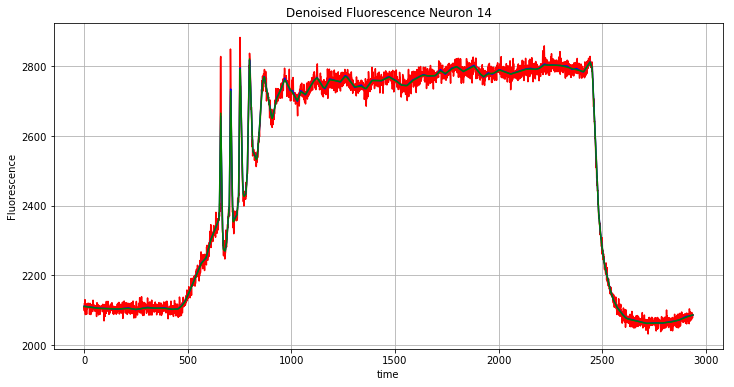

In [28]:
fig, ax = plt.subplots(figsize=(12, 6))
ax.plot(np.arange(T), signal, 'r')
ax.plot(np.arange(T), x, 'b')
ax.plot(np.arange(T), xws, 'g')


ax.set(xlabel='time', ylabel='Fluorescence',
       title='Denoised Fluorescence Neuron {}'.format(idx))
ax.grid()

plt.show()

In [347]:
def init_partition(theta):
    P = np.argwhere(pd.second_order_diff(theta) > 1e-3)
    N = np.argwhere(pd.second_order_diff(theta) < -1e-3)
    A = np.argwhere(np.logical_and(pd.second_order_diff(theta) <= 1e-3, 
                                   pd.second_order_diff(theta) >= -1e-3))
    return (P.flatten(),N.flatten(),A.flatten())

init = init_partition(warm_start[0])

In [378]:
init[2].shape

(2770,)

In [395]:
import timeit

In [422]:
z_init = np.zeros(T-2)
z_init[init[0]] = 1
z_init[init[1]] = -1
I = np.sort(np.append(init[0], init[1]))
A = init[2]
DDT = active_set.second_order_diff_subset_gram(A)
y = signal
lam=500

In [423]:
def testfunc():  
    scipy.linalg.solve_banded((2,2), DDT.data, active_set.second_order_diff_subset(
        y - lam * active_set.second_order_div_subset(z_init[I], I, len(y)), A) / lam)
timeit.timeit(testfunc, number=1000)

0.5718838270404376

In [424]:
def testfunc():
    scipy.sparse.linalg.spsolve(DDT.tocsr(), active_set.second_order_diff_subset(
        y - lam * active_set.second_order_div_subset(z_init[I], I, len(y)), A) / lam)
timeit.timeit(testfunc, number=1000)

2.633899902983103

In [425]:
def testfunc():
    scipy.sparse.linalg.cg(DDT, active_set.second_order_diff_subset(
        y - lam * active_set.second_order_div_subset(z_init[I], I, len(y)), A) / lam,
             x0=warm_start[1][A])
timeit.timeit(testfunc, number=1000)

17.78503956302302

In [ ]:
def testfunc():
    scipy.sparse.linalg.cg(DDT, active_set.second_order_diff_subset(
        y - lam * active_set.second_order_div_subset(z_init[I], I, len(y)), A) / lam)
timeit.timeit(testfunc, number=100)

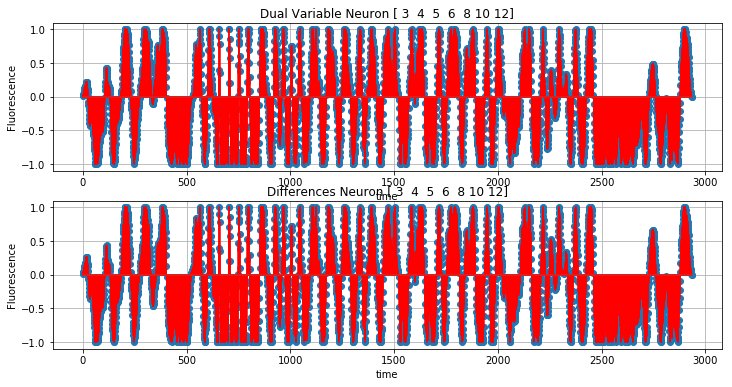

In [394]:
fig, ax = plt.subplots(2,1, figsize=(12, 6))
ax[0].stem(np.arange(T-2), warm_start[1], 'r')
ax[1].stem(np.arange(T-2), z_init, 'r')

ax[0].set(xlabel='time', ylabel='Fluorescence',
       title='Dual Variable Neuron {}'.format(idx))
ax[0].grid()

ax[1].set(xlabel='time', ylabel='Fluorescence',
       title='Differences Neuron {}'.format(idx))
ax[1].grid()

plt.show()

In [385]:
DDT.data

array([[ 1.,  1.,  1., ...,  1.,  0.,  0.],
       [-4., -4., -4., ..., -4., -4.,  0.],
       [ 6.,  6.,  6., ...,  6.,  6.,  6.],
       [ 0., -4., -4., ..., -4., -4., -4.],
       [ 0.,  0.,  1., ...,  1.,  1.,  1.]])

In [351]:
z_init = np.zeros(T-2)
z_init[init[0]] = 1
z_init[init[1]] = -1
theta_init, z_init = active_set.subspace_minimization(signal, 500, z_init,
                                                      init[2],
                                                      np.sort(np.append(init[0],
                                                                        init[1])))

/Users/ikinsella/miniconda3/envs/caiman/lib/python3.5/site-packages/scipy/sparse/linalg/dsolve/linsolve.py:102: SparseEfficiencyWarning: spsolve requires A be CSC or CSR matrix format
  SparseEfficiencyWarning)


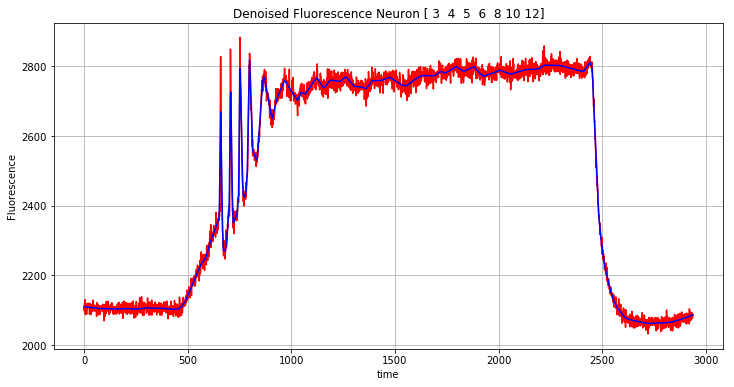

In [352]:
fig, ax = plt.subplots(figsize=(12, 6))
ax.plot(np.arange(T), signal, 'r')
ax.plot(np.arange(T), theta_init , 'b')
#ax.plot(np.arange(T), xws, 'g')


ax.set(xlabel='time', ylabel='Fluorescence',
       title='Denoised Fluorescence Neuron {}'.format(idx))
ax.grid()

plt.show()

In [360]:
ws1 = pd.init_dual(warm_start[0], signal, 500)

/Users/ikinsella/miniconda3/envs/caiman/lib/python3.5/site-packages/scipy/sparse/linalg/dsolve/linsolve.py:102: SparseEfficiencyWarning: spsolve requires A be CSC or CSR matrix format
  SparseEfficiencyWarning)


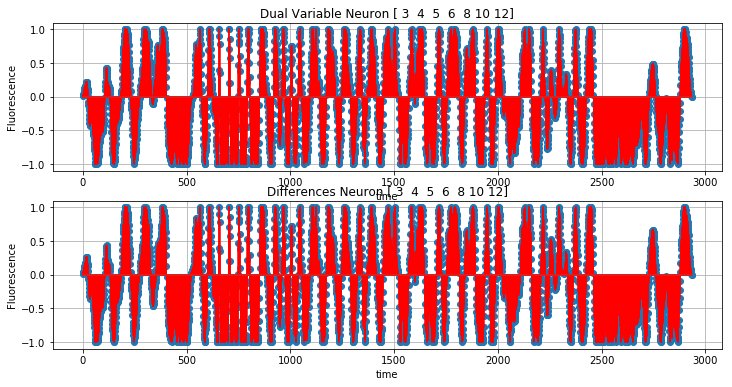

In [361]:
fig, ax = plt.subplots(2,1, figsize=(12, 6))
ax[0].stem(np.arange(T-2), warm_start[1], 'r')
ax[1].stem(np.arange(T-2), ws1, 'r')

ax[0].set(xlabel='time', ylabel='Fluorescence',
       title='Dual Variable Neuron {}'.format(idx))
ax[0].grid()

ax[1].set(xlabel='time', ylabel='Fluorescence',
       title='Differences Neuron {}'.format(idx))
ax[1].grid()

plt.show()

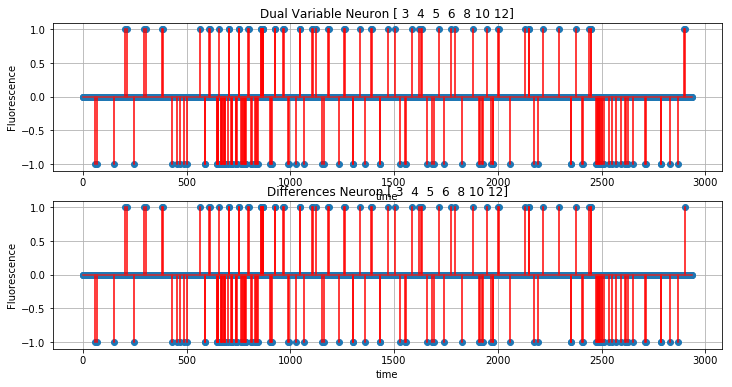

In [276]:
fig, ax = plt.subplots(2,1, figsize=(12, 6))
ax[0].stem(np.arange(T-2), warm_start[1] * (np.abs(warm_start[1]) >= 1), 'r')
ax[1].stem(np.arange(T-2), z_init * (np.abs(z_init) == 1), 'r')

ax[0].set(xlabel='time', ylabel='Fluorescence',
       title='Dual Variable Neuron {}'.format(idx))
ax[0].grid()

ax[1].set(xlabel='time', ylabel='Fluorescence',
       title='Differences Neuron {}'.format(idx))
ax[1].grid()

plt.show()

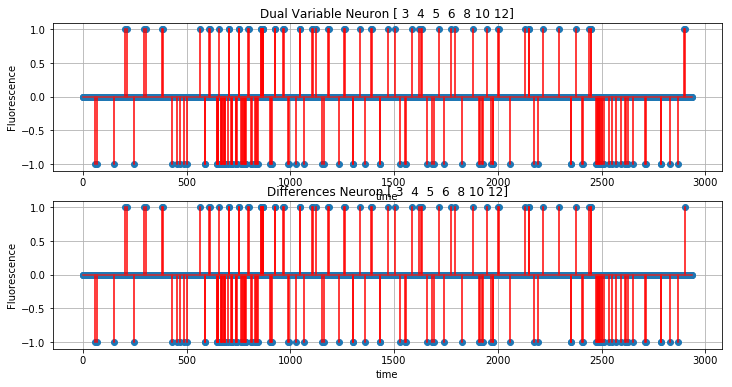

In [247]:
fig, ax = plt.subplots(2,1, figsize=(12, 6))
ax[0].stem(np.arange(T-2), warm_start[1] * (np.abs(warm_start[1]) >= 1), 'r')
ax[1].stem(np.arange(T-2), (np.abs(diff) > 1e-3) * np.sign(diff), 'r')

ax[0].set(xlabel='time', ylabel='Fluorescence',
       title='Dual Variable Neuron {}'.format(idx))
ax[0].grid()

ax[1].set(xlabel='time', ylabel='Fluorescence',
       title='Differences Neuron {}'.format(idx))
ax[1].grid()

plt.show()

In [ ]:
(np.abs(diff) > 1e-3) * np.sign(diff)
warm_start[1] * (np.abs(warm_start[1]) >= 1)

In [249]:
np.corrcoef((np.abs(diff) > 1e-3) * np.sign(diff), warm_start[1] * (np.abs(warm_start[1]) >= 1))

array([[ 1.        ,  0.99699116],
       [ 0.99699116,  1.        ]])

In [251]:
np.corrcoef((diff > 1e-3) * np.sign(diff),
            warm_start[1] * (warm_start[1] >= 1))

array([[ 1.        ,  0.99173018],
       [ 0.99173018,  1.        ]])

In [260]:
np.corrcoef((diff < -1e-3) * np.sign(diff),
            warm_start[1] * (warm_start[1] <= -1))

array([[ 1.,  1.],
       [ 1.,  1.]])

In [441]:
theta, z, results, conv = pd.active_set(init, signal, 100, verbose=True, report=True)

TypeError: active_set() got an unexpected keyword argument 'report'

In [427]:
theta, z, part, conv = active_set.primal_dual(signal, 500, init_partition=pd.init_partition(theta), maxiter=2e3)

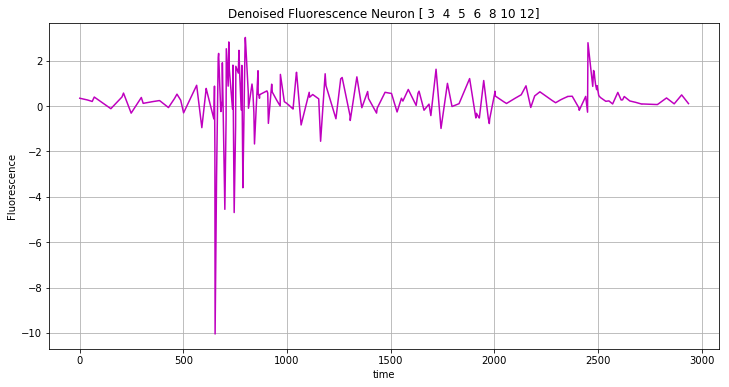

In [318]:
fig, ax = plt.subplots(figsize=(12, 6))
ax.plot(np.arange(T), signal, 'r')
ax.plot(np.arange(T), warm_start[0], 'b')
ax.plot(np.arange(T), theta, 'g')



ax.set(xlabel='time', ylabel='Fluorescence',
       title='Denoised Fluorescence Neuron {}'.format(idx))
ax.grid()

plt.show()

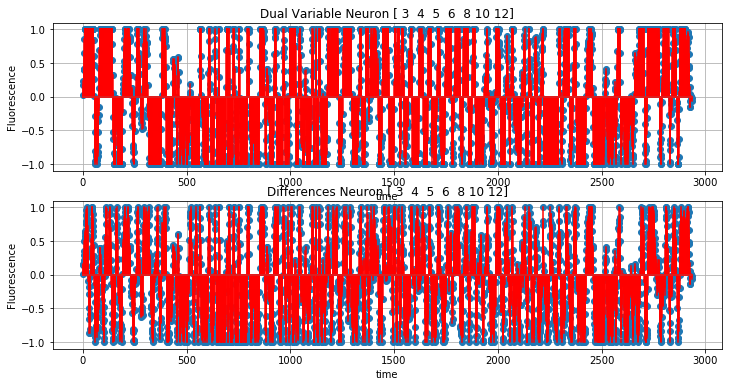

In [333]:
fig, ax = plt.subplots(2,1, figsize=(12, 6))
ax[0].stem(np.arange(T-2), pd.linf_projection(z_init), 'r')
ax[1].stem(np.arange(T-2), z, 'r')

ax[0].set(xlabel='time', ylabel='Fluorescence',
       title='Dual Variable Neuron {}'.format(idx))
ax[0].grid()

ax[1].set(xlabel='time', ylabel='Fluorescence',
       title='Differences Neuron {}'.format(idx))
ax[1].grid()

plt.show()

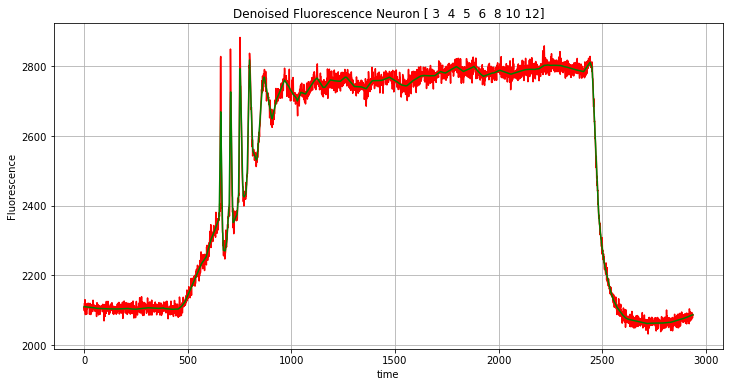

In [178]:
fig, ax = plt.subplots(figsize=(12, 6))
ax.plot(np.arange(T), signal, 'r')
ax.plot(np.arange(T), signal - 500 * pd.second_order_div(warm_start[1]), 'g')


ax.set(xlabel='time', ylabel='Fluorescence',
       title='Denoised Fluorescence Neuron {}'.format(idx))
ax.grid()

plt.show()

In [185]:
DTD = active_set.second_order_diff_subset_gram(np.arange(T-2))
z1 = scipy.sparse.linalg.inv(DTD) * pd.second_order_diff((signal - warm_start[0])/500)

/Users/ikinsella/miniconda3/envs/caiman/lib/python3.5/site-packages/scipy/sparse/linalg/dsolve/linsolve.py:102: SparseEfficiencyWarning: spsolve requires A be CSC or CSR matrix format
  SparseEfficiencyWarning)
/Users/ikinsella/miniconda3/envs/caiman/lib/python3.5/site-packages/scipy/sparse/linalg/dsolve/linsolve.py:171: SparseEfficiencyWarning: spsolve is more efficient when sparse b is in the CSC matrix format
  'is in the CSC matrix format', SparseEfficiencyWarning)


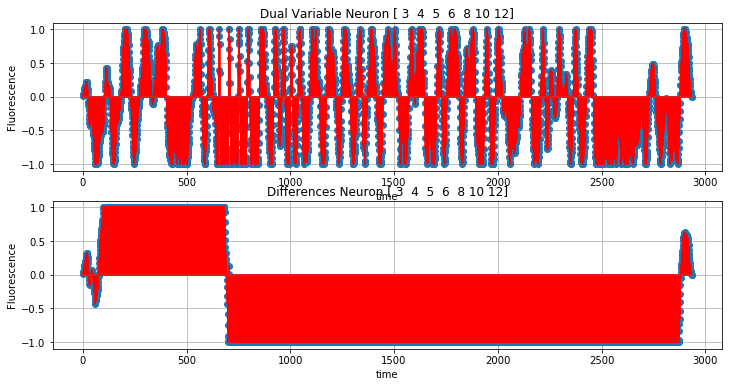

In [187]:
fig, ax = plt.subplots(2,1, figsize=(12, 6))
ax[0].stem(np.arange(T-2), warm_start[1], 'r')
ax[1].stem(np.arange(T-2), pd.linf_projection(z1), 'r')

ax[0].set(xlabel='time', ylabel='Fluorescence',
       title='Dual Variable Neuron {}'.format(idx))
ax[0].grid()

ax[1].set(xlabel='time', ylabel='Fluorescence',
       title='Differences Neuron {}'.format(idx))
ax[1].grid()

plt.show()

In [112]:
y_init = scipy.sparse.linalg.inv(DTD) * pd.second_order_diff(warm_start[0])

/Users/ikinsella/miniconda3/envs/caiman/lib/python3.5/site-packages/scipy/sparse/linalg/dsolve/linsolve.py:102: SparseEfficiencyWarning: spsolve requires A be CSC or CSR matrix format
  SparseEfficiencyWarning)
/Users/ikinsella/miniconda3/envs/caiman/lib/python3.5/site-packages/scipy/sparse/linalg/dsolve/linsolve.py:171: SparseEfficiencyWarning: spsolve is more efficient when sparse b is in the CSC matrix format
  'is in the CSC matrix format', SparseEfficiencyWarning)


In [115]:
y_init.max()

1251.7423635679813

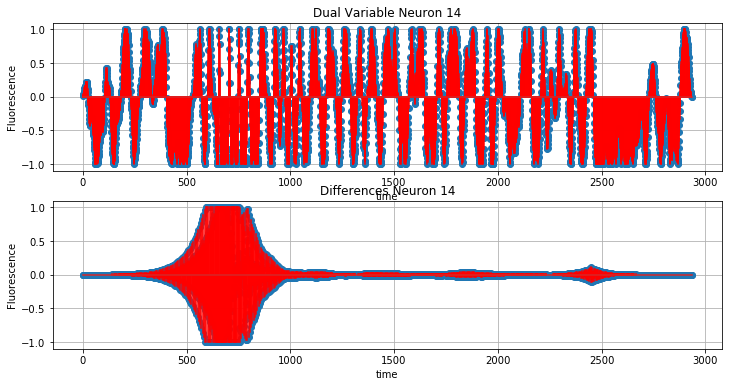

In [117]:
fig, ax = plt.subplots(2,1, figsize=(12, 6))
ax[0].stem(np.arange(T-2), warm_start[1], 'r')
ax[1].stem(np.arange(T-2), pd.linf_projection(y_init/500), 'r')

ax[0].set(xlabel='time', ylabel='Fluorescence',
       title='Dual Variable Neuron {}'.format(idx))
ax[0].grid()

ax[1].set(xlabel='time', ylabel='Fluorescence',
       title='Differences Neuron {}'.format(idx))
ax[1].grid()

plt.show()

In [ ]:
import scipy.sparse
import scipy.linalg

In [64]:
def init_y(signal, x_init, lam):
    n = len(signal)
    DT = scipy.sparse.diags([np.ones(n-1)*-1, np.ones(n)*2, np.ones(n-1)*-1], [-1,0,1])
    return scipy.linalg.solve_banded((1,1), DT.data, (signal - x_init)/lam)

In [65]:
y_init = init_y(signal, warm_start[0], 500)

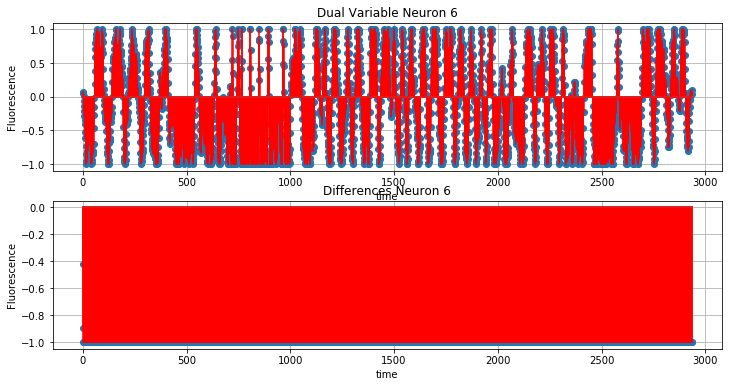

In [68]:
fig, ax = plt.subplots(2,1, figsize=(12, 6))
ax[0].stem(np.arange(T-2), warm_start[1], 'r')
ax[1].stem(np.arange(T-2), pd.linf_projection(y_init[1:-1],1), 'r')

ax[0].set(xlabel='time', ylabel='Fluorescence',
       title='Dual Variable Neuron {}'.format(idx))
ax[0].grid()

ax[1].set(xlabel='time', ylabel='Fluorescence',
       title='Differences Neuron {}'.format(idx))
ax[1].grid()

plt.show()

In [34]:
x, y, results = pd.lagrangian_l1tf(signal, 
                                   warm_start=warm_start,
                                   lam=10, theta=1, maxiter=1e5, tol=1e-3)

||Iter:1||Obj: 5.440e+01||Dual: 3.146e+00||Gap: 5.126e+01||Delta Obj:       inf||Delta x: 3.199e-04||Delta y: 9.769e-02||CPU: 1.486e-03||
||Iter:2||Obj: 5.433e+01||Dual: 1.398e+01||Gap: 4.035e+01||Delta Obj:       inf||Delta x: 3.199e-04||Delta y: 9.227e+02||CPU: 3.894e-03||
||Iter:3||Obj: 5.425e+01||Dual: 1.616e+01||Gap: 3.809e+01||Delta Obj:       inf||Delta x: 3.199e-04||Delta y: 6.342e+03||CPU: 5.694e-03||
||Iter:4||Obj: 5.418e+01||Dual: 1.753e+01||Gap: 3.665e+01||Delta Obj:       inf||Delta x: 3.199e-04||Delta y: 3.048e+04||CPU: 7.718e-03||
||Iter:5||Obj: 5.411e+01||Dual: 1.819e+01||Gap: 3.592e+01||Delta Obj: 5.324e-03||Delta x: 3.199e-04||Delta y: 3.048e+04||CPU: 9.486e-03||
||Iter:6||Obj: 5.404e+01||Dual: 1.846e+01||Gap: 3.558e+01||Delta Obj: 5.242e-03||Delta x: 2.824e-04||Delta y: 3.048e+04||CPU: 1.082e-02||
||Iter:7||Obj: 5.397e+01||Dual: 1.864e+01||Gap: 3.533e+01||Delta Obj: 5.219e-03||Delta x: 2.737e-04||Delta y: 3.123e+04||CPU: 1.302e-02||
||Iter:8||Obj: 5.390e+01||Dual: 1.

||Iter:61||Obj: 5.042e+01||Dual: 1.933e+01||Gap: 3.109e+01||Delta Obj: 4.926e-03||Delta x: 2.469e-04||Delta y: 5.158e+01||CPU: 1.182e-01||
||Iter:62||Obj: 5.036e+01||Dual: 1.933e+01||Gap: 3.103e+01||Delta Obj: 4.922e-03||Delta x: 2.467e-04||Delta y: 7.711e+02||CPU: 1.211e-01||
||Iter:63||Obj: 5.030e+01||Dual: 1.933e+01||Gap: 3.097e+01||Delta Obj: 4.919e-03||Delta x: 2.464e-04||Delta y: 7.711e+02||CPU: 1.246e-01||
||Iter:64||Obj: 5.023e+01||Dual: 1.933e+01||Gap: 3.091e+01||Delta Obj: 4.915e-03||Delta x: 2.462e-04||Delta y: 7.711e+02||CPU: 1.271e-01||
||Iter:65||Obj: 5.017e+01||Dual: 1.933e+01||Gap: 3.084e+01||Delta Obj: 4.912e-03||Delta x: 2.459e-04||Delta y: 7.711e+02||CPU: 1.302e-01||
||Iter:66||Obj: 5.011e+01||Dual: 1.933e+01||Gap: 3.078e+01||Delta Obj: 4.908e-03||Delta x: 2.457e-04||Delta y: 7.711e+02||CPU: 1.332e-01||
||Iter:67||Obj: 5.005e+01||Dual: 1.933e+01||Gap: 3.072e+01||Delta Obj: 4.904e-03||Delta x: 2.454e-04||Delta y: 6.447e+02||CPU: 1.357e-01||
||Iter:68||Obj: 4.999e+01||

/Users/ikinsella/devel/voltagedenoising/primal_dual.py:111: RuntimeWarning: divide by zero encountered in true_divide
  delta_obj = np.max(np.abs((obj[itr % buff] - obj) / obj))


||Iter:95||Obj: 4.838e+01||Dual: 1.934e+01||Gap: 2.904e+01||Delta Obj: 4.796e-03||Delta x: 2.385e-04||Delta y: 1.712e+02||CPU: 2.018e-01||
||Iter:96||Obj: 4.832e+01||Dual: 1.934e+01||Gap: 2.898e+01||Delta Obj: 4.792e-03||Delta x: 2.383e-04||Delta y: 1.851e+02||CPU: 2.043e-01||
||Iter:97||Obj: 4.826e+01||Dual: 1.934e+01||Gap: 2.892e+01||Delta Obj: 4.788e-03||Delta x: 2.381e-04||Delta y: 1.851e+02||CPU: 2.063e-01||
||Iter:98||Obj: 4.820e+01||Dual: 1.934e+01||Gap: 2.886e+01||Delta Obj: 4.784e-03||Delta x: 2.378e-04||Delta y: 1.851e+02||CPU: 2.088e-01||
||Iter:99||Obj: 4.815e+01||Dual: 1.934e+01||Gap: 2.881e+01||Delta Obj: 4.780e-03||Delta x: 2.376e-04||Delta y: 1.851e+02||CPU: 2.106e-01||
||Iter:100||Obj: 4.809e+01||Dual: 1.934e+01||Gap: 2.875e+01||Delta Obj: 4.776e-03||Delta x: 2.373e-04||Delta y: 1.851e+02||CPU: 2.125e-01||
||Iter:101||Obj: 4.803e+01||Dual: 1.934e+01||Gap: 2.869e+01||Delta Obj: 4.772e-03||Delta x: 2.371e-04||Delta y: 5.100e+01||CPU: 2.154e-01||
||Iter:102||Obj: 4.797e+0

||Iter:154||Obj: 4.515e+01||Dual: 1.937e+01||Gap: 2.578e+01||Delta Obj: 4.562e-03||Delta x: 2.246e-04||Delta y: 1.085e+02||CPU: 3.341e-01||
||Iter:155||Obj: 4.510e+01||Dual: 1.937e+01||Gap: 2.572e+01||Delta Obj: 4.558e-03||Delta x: 2.244e-04||Delta y: 1.085e+02||CPU: 3.357e-01||
||Iter:156||Obj: 4.505e+01||Dual: 1.937e+01||Gap: 2.567e+01||Delta Obj: 4.555e-03||Delta x: 2.242e-04||Delta y: 1.085e+02||CPU: 3.375e-01||
||Iter:157||Obj: 4.500e+01||Dual: 1.937e+01||Gap: 2.562e+01||Delta Obj: 4.551e-03||Delta x: 2.239e-04||Delta y: 1.085e+02||CPU: 3.390e-01||
||Iter:158||Obj: 4.494e+01||Dual: 1.937e+01||Gap: 2.557e+01||Delta Obj: 4.547e-03||Delta x: 2.237e-04||Delta y: 3.982e+01||CPU: 3.415e-01||
||Iter:159||Obj: 4.489e+01||Dual: 1.937e+01||Gap: 2.552e+01||Delta Obj: 4.543e-03||Delta x: 2.235e-04||Delta y: 3.982e+01||CPU: 3.431e-01||
||Iter:160||Obj: 4.484e+01||Dual: 1.937e+01||Gap: 2.547e+01||Delta Obj: 4.539e-03||Delta x: 2.233e-04||Delta y: 2.563e+01||CPU: 3.458e-01||
||Iter:161||Obj: 4.4

||Iter:213||Obj: 4.228e+01||Dual: 1.938e+01||Gap: 2.290e+01||Delta Obj: 4.330e-03||Delta x: 2.116e-04||Delta y: 6.199e+00||CPU: 4.664e-01||
||Iter:214||Obj: 4.224e+01||Dual: 1.938e+01||Gap: 2.286e+01||Delta Obj: 4.326e-03||Delta x: 2.114e-04||Delta y: 8.222e+00||CPU: 4.691e-01||
||Iter:215||Obj: 4.219e+01||Dual: 1.938e+01||Gap: 2.281e+01||Delta Obj: 4.322e-03||Delta x: 2.112e-04||Delta y: 8.222e+00||CPU: 4.705e-01||
||Iter:216||Obj: 4.215e+01||Dual: 1.938e+01||Gap: 2.277e+01||Delta Obj: 4.318e-03||Delta x: 2.110e-04||Delta y: 8.222e+00||CPU: 4.728e-01||
||Iter:217||Obj: 4.210e+01||Dual: 1.938e+01||Gap: 2.272e+01||Delta Obj: 4.314e-03||Delta x: 2.108e-04||Delta y: 9.984e+00||CPU: 4.744e-01||
||Iter:218||Obj: 4.205e+01||Dual: 1.938e+01||Gap: 2.267e+01||Delta Obj: 4.310e-03||Delta x: 2.105e-04||Delta y: 9.984e+00||CPU: 4.762e-01||
||Iter:219||Obj: 4.201e+01||Dual: 1.938e+01||Gap: 2.263e+01||Delta Obj: 4.306e-03||Delta x: 2.103e-04||Delta y: 9.984e+00||CPU: 4.779e-01||
||Iter:220||Obj: 4.1

||Iter:272||Obj: 3.973e+01||Dual: 1.939e+01||Gap: 2.035e+01||Delta Obj: 4.094e-03||Delta x: 1.994e-04||Delta y: 7.897e+00||CPU: 5.959e-01||
||Iter:273||Obj: 3.969e+01||Dual: 1.939e+01||Gap: 2.031e+01||Delta Obj: 4.090e-03||Delta x: 1.992e-04||Delta y: 7.897e+00||CPU: 5.979e-01||
||Iter:274||Obj: 3.965e+01||Dual: 1.939e+01||Gap: 2.027e+01||Delta Obj: 4.086e-03||Delta x: 1.990e-04||Delta y: 3.935e+00||CPU: 5.996e-01||
||Iter:275||Obj: 3.961e+01||Dual: 1.939e+01||Gap: 2.023e+01||Delta Obj: 4.082e-03||Delta x: 1.988e-04||Delta y: 3.935e+00||CPU: 6.013e-01||
||Iter:276||Obj: 3.957e+01||Dual: 1.939e+01||Gap: 2.019e+01||Delta Obj: 4.078e-03||Delta x: 1.986e-04||Delta y: 3.850e+00||CPU: 6.039e-01||
||Iter:277||Obj: 3.953e+01||Dual: 1.939e+01||Gap: 2.015e+01||Delta Obj: 4.075e-03||Delta x: 1.984e-04||Delta y: 3.850e+00||CPU: 6.061e-01||
||Iter:278||Obj: 3.949e+01||Dual: 1.939e+01||Gap: 2.011e+01||Delta Obj: 4.071e-03||Delta x: 1.982e-04||Delta y: 1.633e+01||CPU: 6.086e-01||
||Iter:279||Obj: 3.9

||Iter:331||Obj: 3.747e+01||Dual: 1.939e+01||Gap: 1.808e+01||Delta Obj: 3.859e-03||Delta x: 1.879e-04||Delta y: 1.277e+01||CPU: 7.302e-01||
||Iter:332||Obj: 3.743e+01||Dual: 1.939e+01||Gap: 1.805e+01||Delta Obj: 3.855e-03||Delta x: 1.877e-04||Delta y: 1.277e+01||CPU: 7.321e-01||
||Iter:333||Obj: 3.740e+01||Dual: 1.939e+01||Gap: 1.801e+01||Delta Obj: 3.851e-03||Delta x: 1.875e-04||Delta y: 1.277e+01||CPU: 7.353e-01||
||Iter:334||Obj: 3.736e+01||Dual: 1.939e+01||Gap: 1.797e+01||Delta Obj: 3.847e-03||Delta x: 1.873e-04||Delta y: 1.277e+01||CPU: 7.387e-01||
||Iter:335||Obj: 3.733e+01||Dual: 1.939e+01||Gap: 1.794e+01||Delta Obj: 3.843e-03||Delta x: 1.871e-04||Delta y: 6.659e+00||CPU: 7.414e-01||
||Iter:336||Obj: 3.729e+01||Dual: 1.939e+01||Gap: 1.790e+01||Delta Obj: 3.839e-03||Delta x: 1.869e-04||Delta y: 6.659e+00||CPU: 7.438e-01||
||Iter:337||Obj: 3.726e+01||Dual: 1.939e+01||Gap: 1.787e+01||Delta Obj: 3.835e-03||Delta x: 1.867e-04||Delta y: 6.659e+00||CPU: 7.463e-01||
||Iter:338||Obj: 3.7

||Iter:390||Obj: 3.546e+01||Dual: 1.939e+01||Gap: 1.607e+01||Delta Obj: 3.625e-03||Delta x: 1.770e-04||Delta y: 8.543e-01||CPU: 8.676e-01||
||Iter:391||Obj: 3.543e+01||Dual: 1.939e+01||Gap: 1.604e+01||Delta Obj: 3.621e-03||Delta x: 1.768e-04||Delta y: 7.057e-01||CPU: 8.693e-01||
||Iter:392||Obj: 3.540e+01||Dual: 1.939e+01||Gap: 1.601e+01||Delta Obj: 3.617e-03||Delta x: 1.767e-04||Delta y: 7.771e-01||CPU: 8.721e-01||
||Iter:393||Obj: 3.536e+01||Dual: 1.939e+01||Gap: 1.597e+01||Delta Obj: 3.613e-03||Delta x: 1.765e-04||Delta y: 1.144e+00||CPU: 8.743e-01||
||Iter:394||Obj: 3.533e+01||Dual: 1.939e+01||Gap: 1.594e+01||Delta Obj: 3.609e-03||Delta x: 1.763e-04||Delta y: 3.418e+00||CPU: 8.765e-01||
||Iter:395||Obj: 3.530e+01||Dual: 1.939e+01||Gap: 1.591e+01||Delta Obj: 3.605e-03||Delta x: 1.761e-04||Delta y: 3.418e+00||CPU: 8.795e-01||
||Iter:396||Obj: 3.527e+01||Dual: 1.939e+01||Gap: 1.588e+01||Delta Obj: 3.601e-03||Delta x: 1.760e-04||Delta y: 3.418e+00||CPU: 8.815e-01||
||Iter:397||Obj: 3.5

||Iter:449||Obj: 3.367e+01||Dual: 1.939e+01||Gap: 1.428e+01||Delta Obj: 3.394e-03||Delta x: 1.668e-04||Delta y: 8.865e+00||CPU: 9.999e-01||
||Iter:450||Obj: 3.364e+01||Dual: 1.939e+01||Gap: 1.425e+01||Delta Obj: 3.390e-03||Delta x: 1.667e-04||Delta y: 8.865e+00||CPU: 1.002e+00||
||Iter:451||Obj: 3.361e+01||Dual: 1.939e+01||Gap: 1.422e+01||Delta Obj: 3.386e-03||Delta x: 1.665e-04||Delta y: 6.368e+00||CPU: 1.005e+00||
||Iter:452||Obj: 3.359e+01||Dual: 1.939e+01||Gap: 1.420e+01||Delta Obj: 3.382e-03||Delta x: 1.663e-04||Delta y: 5.911e+00||CPU: 1.008e+00||
||Iter:453||Obj: 3.356e+01||Dual: 1.939e+01||Gap: 1.417e+01||Delta Obj: 3.378e-03||Delta x: 1.662e-04||Delta y: 5.911e+00||CPU: 1.010e+00||
||Iter:454||Obj: 3.353e+01||Dual: 1.939e+01||Gap: 1.414e+01||Delta Obj: 3.374e-03||Delta x: 1.660e-04||Delta y: 6.269e+01||CPU: 1.013e+00||
||Iter:455||Obj: 3.350e+01||Dual: 1.939e+01||Gap: 1.411e+01||Delta Obj: 3.370e-03||Delta x: 1.658e-04||Delta y: 6.269e+01||CPU: 1.015e+00||
||Iter:456||Obj: 3.3

||Iter:508||Obj: 3.208e+01||Dual: 1.939e+01||Gap: 1.269e+01||Delta Obj: 3.166e-03||Delta x: 1.572e-04||Delta y: 9.261e+00||CPU: 1.131e+00||
||Iter:509||Obj: 3.206e+01||Dual: 1.939e+01||Gap: 1.267e+01||Delta Obj: 3.162e-03||Delta x: 1.571e-04||Delta y: 9.261e+00||CPU: 1.133e+00||
||Iter:510||Obj: 3.203e+01||Dual: 1.939e+01||Gap: 1.264e+01||Delta Obj: 3.158e-03||Delta x: 1.569e-04||Delta y: 1.540e+00||CPU: 1.134e+00||
||Iter:511||Obj: 3.201e+01||Dual: 1.939e+01||Gap: 1.262e+01||Delta Obj: 3.155e-03||Delta x: 1.567e-04||Delta y: 8.706e-01||CPU: 1.137e+00||
||Iter:512||Obj: 3.198e+01||Dual: 1.939e+01||Gap: 1.259e+01||Delta Obj: 3.151e-03||Delta x: 1.566e-04||Delta y: 6.523e-01||CPU: 1.138e+00||
||Iter:513||Obj: 3.196e+01||Dual: 1.939e+01||Gap: 1.257e+01||Delta Obj: 3.147e-03||Delta x: 1.564e-04||Delta y: 5.359e-01||CPU: 1.140e+00||
||Iter:514||Obj: 3.193e+01||Dual: 1.939e+01||Gap: 1.254e+01||Delta Obj: 3.143e-03||Delta x: 1.563e-04||Delta y: 4.620e-01||CPU: 1.142e+00||
||Iter:515||Obj: 3.1

||Iter:567||Obj: 3.067e+01||Dual: 1.939e+01||Gap: 1.128e+01||Delta Obj: 2.944e-03||Delta x: 1.482e-04||Delta y: 1.759e+00||CPU: 1.262e+00||
||Iter:568||Obj: 3.065e+01||Dual: 1.939e+01||Gap: 1.126e+01||Delta Obj: 2.940e-03||Delta x: 1.480e-04||Delta y: 2.332e+00||CPU: 1.265e+00||
||Iter:569||Obj: 3.063e+01||Dual: 1.939e+01||Gap: 1.124e+01||Delta Obj: 2.937e-03||Delta x: 1.479e-04||Delta y: 2.332e+00||CPU: 1.267e+00||
||Iter:570||Obj: 3.060e+01||Dual: 1.939e+01||Gap: 1.121e+01||Delta Obj: 2.933e-03||Delta x: 1.477e-04||Delta y: 2.332e+00||CPU: 1.269e+00||
||Iter:571||Obj: 3.058e+01||Dual: 1.939e+01||Gap: 1.119e+01||Delta Obj: 2.929e-03||Delta x: 1.476e-04||Delta y: 2.332e+00||CPU: 1.271e+00||
||Iter:572||Obj: 3.056e+01||Dual: 1.939e+01||Gap: 1.117e+01||Delta Obj: 2.925e-03||Delta x: 1.474e-04||Delta y: 2.332e+00||CPU: 1.273e+00||
||Iter:573||Obj: 3.054e+01||Dual: 1.939e+01||Gap: 1.115e+01||Delta Obj: 2.922e-03||Delta x: 1.473e-04||Delta y: 7.230e-01||CPU: 1.275e+00||
||Iter:574||Obj: 3.0

||Iter:626||Obj: 2.942e+01||Dual: 1.939e+01||Gap: 1.003e+01||Delta Obj: 2.729e-03||Delta x: 1.396e-04||Delta y: 3.181e-01||CPU: 1.393e+00||
||Iter:627||Obj: 2.940e+01||Dual: 1.939e+01||Gap: 1.001e+01||Delta Obj: 2.725e-03||Delta x: 1.395e-04||Delta y: 2.755e-01||CPU: 1.395e+00||
||Iter:628||Obj: 2.938e+01||Dual: 1.939e+01||Gap: 9.986e+00||Delta Obj: 2.722e-03||Delta x: 1.394e-04||Delta y: 2.538e-01||CPU: 1.397e+00||
||Iter:629||Obj: 2.936e+01||Dual: 1.939e+01||Gap: 9.966e+00||Delta Obj: 2.718e-03||Delta x: 1.392e-04||Delta y: 2.407e-01||CPU: 1.399e+00||
||Iter:630||Obj: 2.934e+01||Dual: 1.939e+01||Gap: 9.946e+00||Delta Obj: 2.714e-03||Delta x: 1.391e-04||Delta y: 2.305e-01||CPU: 1.401e+00||
||Iter:631||Obj: 2.932e+01||Dual: 1.939e+01||Gap: 9.926e+00||Delta Obj: 2.711e-03||Delta x: 1.389e-04||Delta y: 2.214e-01||CPU: 1.404e+00||
||Iter:632||Obj: 2.930e+01||Dual: 1.939e+01||Gap: 9.906e+00||Delta Obj: 2.707e-03||Delta x: 1.388e-04||Delta y: 2.130e-01||CPU: 1.406e+00||
||Iter:633||Obj: 2.9

||Iter:685||Obj: 2.830e+01||Dual: 1.939e+01||Gap: 8.910e+00||Delta Obj: 2.521e-03||Delta x: 1.316e-04||Delta y: 8.537e-01||CPU: 1.532e+00||
||Iter:686||Obj: 2.828e+01||Dual: 1.939e+01||Gap: 8.892e+00||Delta Obj: 2.518e-03||Delta x: 1.315e-04||Delta y: 5.259e-01||CPU: 1.534e+00||
||Iter:687||Obj: 2.826e+01||Dual: 1.939e+01||Gap: 8.875e+00||Delta Obj: 2.514e-03||Delta x: 1.313e-04||Delta y: 4.034e-01||CPU: 1.536e+00||
||Iter:688||Obj: 2.825e+01||Dual: 1.939e+01||Gap: 8.857e+00||Delta Obj: 2.511e-03||Delta x: 1.312e-04||Delta y: 3.378e-01||CPU: 1.538e+00||
||Iter:689||Obj: 2.823e+01||Dual: 1.939e+01||Gap: 8.839e+00||Delta Obj: 2.507e-03||Delta x: 1.311e-04||Delta y: 2.952e-01||CPU: 1.540e+00||
||Iter:690||Obj: 2.821e+01||Dual: 1.939e+01||Gap: 8.822e+00||Delta Obj: 2.504e-03||Delta x: 1.309e-04||Delta y: 2.649e-01||CPU: 1.542e+00||
||Iter:691||Obj: 2.819e+01||Dual: 1.939e+01||Gap: 8.804e+00||Delta Obj: 2.501e-03||Delta x: 1.308e-04||Delta y: 2.427e-01||CPU: 1.544e+00||
||Iter:692||Obj: 2.8

||Iter:744||Obj: 2.731e+01||Dual: 1.939e+01||Gap: 7.919e+00||Delta Obj: 2.322e-03||Delta x: 1.240e-04||Delta y: 2.632e+00||CPU: 1.657e+00||
||Iter:745||Obj: 2.729e+01||Dual: 1.939e+01||Gap: 7.903e+00||Delta Obj: 2.319e-03||Delta x: 1.239e-04||Delta y: 6.360e+00||CPU: 1.660e+00||
||Iter:746||Obj: 2.728e+01||Dual: 1.939e+01||Gap: 7.887e+00||Delta Obj: 2.316e-03||Delta x: 1.238e-04||Delta y: 6.360e+00||CPU: 1.663e+00||
||Iter:747||Obj: 2.726e+01||Dual: 1.939e+01||Gap: 7.871e+00||Delta Obj: 2.313e-03||Delta x: 1.237e-04||Delta y: 6.360e+00||CPU: 1.665e+00||
||Iter:748||Obj: 2.725e+01||Dual: 1.939e+01||Gap: 7.856e+00||Delta Obj: 2.309e-03||Delta x: 1.235e-04||Delta y: 6.360e+00||CPU: 1.668e+00||
||Iter:749||Obj: 2.723e+01||Dual: 1.939e+01||Gap: 7.840e+00||Delta Obj: 2.306e-03||Delta x: 1.234e-04||Delta y: 6.360e+00||CPU: 1.671e+00||
||Iter:750||Obj: 2.721e+01||Dual: 1.939e+01||Gap: 7.824e+00||Delta Obj: 2.303e-03||Delta x: 1.233e-04||Delta y: 2.521e+00||CPU: 1.673e+00||
||Iter:751||Obj: 2.7

||Iter:803||Obj: 2.643e+01||Dual: 1.939e+01||Gap: 7.038e+00||Delta Obj: 2.133e-03||Delta x: 1.169e-04||Delta y: 4.614e+00||CPU: 1.791e+00||
||Iter:804||Obj: 2.641e+01||Dual: 1.939e+01||Gap: 7.024e+00||Delta Obj: 2.130e-03||Delta x: 1.168e-04||Delta y: 4.614e+00||CPU: 1.793e+00||
||Iter:805||Obj: 2.640e+01||Dual: 1.939e+01||Gap: 7.010e+00||Delta Obj: 2.127e-03||Delta x: 1.167e-04||Delta y: 4.614e+00||CPU: 1.795e+00||
||Iter:806||Obj: 2.639e+01||Dual: 1.939e+01||Gap: 6.996e+00||Delta Obj: 2.124e-03||Delta x: 1.166e-04||Delta y: 3.508e+00||CPU: 1.797e+00||
||Iter:807||Obj: 2.637e+01||Dual: 1.939e+01||Gap: 6.982e+00||Delta Obj: 2.121e-03||Delta x: 1.164e-04||Delta y: 1.361e+00||CPU: 1.800e+00||
||Iter:808||Obj: 2.636e+01||Dual: 1.939e+01||Gap: 6.968e+00||Delta Obj: 2.118e-03||Delta x: 1.163e-04||Delta y: 5.832e-01||CPU: 1.803e+00||
||Iter:809||Obj: 2.634e+01||Dual: 1.939e+01||Gap: 6.954e+00||Delta Obj: 2.115e-03||Delta x: 1.162e-04||Delta y: 3.629e-01||CPU: 1.804e+00||
||Iter:810||Obj: 2.6

||Iter:920||Obj: 2.496e+01||Dual: 1.939e+01||Gap: 5.570e+00||Delta Obj: 1.788e-03||Delta x: 1.040e-04||Delta y: 1.253e-01||CPU: 2.073e+00||
||Iter:921||Obj: 2.495e+01||Dual: 1.939e+01||Gap: 5.559e+00||Delta Obj: 1.786e-03||Delta x: 1.039e-04||Delta y: 1.147e-01||CPU: 2.075e+00||
||Iter:922||Obj: 2.494e+01||Dual: 1.939e+01||Gap: 5.548e+00||Delta Obj: 1.783e-03||Delta x: 1.037e-04||Delta y: 1.041e-01||CPU: 2.078e+00||
||Iter:923||Obj: 2.493e+01||Dual: 1.939e+01||Gap: 5.537e+00||Delta Obj: 1.780e-03||Delta x: 1.036e-04||Delta y: 9.396e-02||CPU: 2.081e+00||
||Iter:924||Obj: 2.492e+01||Dual: 1.939e+01||Gap: 5.526e+00||Delta Obj: 1.777e-03||Delta x: 1.035e-04||Delta y: 8.494e-02||CPU: 2.084e+00||
||Iter:925||Obj: 2.491e+01||Dual: 1.939e+01||Gap: 5.515e+00||Delta Obj: 1.774e-03||Delta x: 1.034e-04||Delta y: 7.778e-02||CPU: 2.086e+00||
||Iter:926||Obj: 2.489e+01||Dual: 1.939e+01||Gap: 5.504e+00||Delta Obj: 1.772e-03||Delta x: 1.033e-04||Delta y: 7.275e-02||CPU: 2.089e+00||
||Iter:927||Obj: 2.4

||Iter:979||Obj: 2.434e+01||Dual: 1.941e+01||Gap: 4.928e+00||Delta Obj: 1.623e-03||Delta x: 9.774e-05||Delta y: 4.398e+00||CPU: 2.224e+00||
||Iter:980||Obj: 2.433e+01||Dual: 1.941e+01||Gap: 4.918e+00||Delta Obj: 1.620e-03||Delta x: 9.764e-05||Delta y: 4.398e+00||CPU: 2.226e+00||
||Iter:981||Obj: 2.432e+01||Dual: 1.941e+01||Gap: 4.909e+00||Delta Obj: 1.617e-03||Delta x: 9.754e-05||Delta y: 4.398e+00||CPU: 2.228e+00||
||Iter:982||Obj: 2.431e+01||Dual: 1.941e+01||Gap: 4.899e+00||Delta Obj: 1.615e-03||Delta x: 9.745e-05||Delta y: 2.725e+00||CPU: 2.230e+00||
||Iter:983||Obj: 2.430e+01||Dual: 1.941e+01||Gap: 4.889e+00||Delta Obj: 1.612e-03||Delta x: 9.735e-05||Delta y: 2.725e+00||CPU: 2.231e+00||
||Iter:984||Obj: 2.429e+01||Dual: 1.941e+01||Gap: 4.879e+00||Delta Obj: 1.610e-03||Delta x: 9.725e-05||Delta y: 2.725e+00||CPU: 2.234e+00||
||Iter:985||Obj: 2.428e+01||Dual: 1.941e+01||Gap: 4.870e+00||Delta Obj: 1.607e-03||Delta x: 9.715e-05||Delta y: 7.932e-01||CPU: 2.236e+00||
||Iter:986||Obj: 2.4

||Iter:1038||Obj: 2.379e+01||Dual: 1.942e+01||Gap: 4.378e+00||Delta Obj: 1.475e-03||Delta x: 9.210e-05||Delta y: 3.220e+00||CPU: 2.347e+00||
||Iter:1039||Obj: 2.379e+01||Dual: 1.942e+01||Gap: 4.369e+00||Delta Obj: 1.472e-03||Delta x: 9.200e-05||Delta y: 6.133e-01||CPU: 2.349e+00||
||Iter:1040||Obj: 2.378e+01||Dual: 1.942e+01||Gap: 4.360e+00||Delta Obj: 1.470e-03||Delta x: 9.191e-05||Delta y: 8.331e-01||CPU: 2.351e+00||
||Iter:1041||Obj: 2.377e+01||Dual: 1.942e+01||Gap: 4.351e+00||Delta Obj: 1.468e-03||Delta x: 9.182e-05||Delta y: 3.157e+00||CPU: 2.352e+00||
||Iter:1042||Obj: 2.376e+01||Dual: 1.942e+01||Gap: 4.343e+00||Delta Obj: 1.465e-03||Delta x: 9.173e-05||Delta y: 3.157e+00||CPU: 2.355e+00||
||Iter:1043||Obj: 2.375e+01||Dual: 1.942e+01||Gap: 4.334e+00||Delta Obj: 1.463e-03||Delta x: 9.164e-05||Delta y: 4.629e+00||CPU: 2.356e+00||
||Iter:1044||Obj: 2.374e+01||Dual: 1.942e+01||Gap: 4.325e+00||Delta Obj: 1.460e-03||Delta x: 9.154e-05||Delta y: 4.629e+00||CPU: 2.359e+00||
||Iter:1045||

||Iter:1097||Obj: 2.331e+01||Dual: 1.942e+01||Gap: 3.891e+00||Delta Obj: 1.338e-03||Delta x: 8.681e-05||Delta y: 9.123e-02||CPU: 2.482e+00||
||Iter:1098||Obj: 2.330e+01||Dual: 1.942e+01||Gap: 3.883e+00||Delta Obj: 1.336e-03||Delta x: 8.672e-05||Delta y: 8.161e-02||CPU: 2.484e+00||
||Iter:1099||Obj: 2.329e+01||Dual: 1.942e+01||Gap: 3.875e+00||Delta Obj: 1.334e-03||Delta x: 8.663e-05||Delta y: 7.344e-02||CPU: 2.485e+00||
||Iter:1100||Obj: 2.328e+01||Dual: 1.942e+01||Gap: 3.867e+00||Delta Obj: 1.332e-03||Delta x: 8.655e-05||Delta y: 6.690e-02||CPU: 2.488e+00||
||Iter:1101||Obj: 2.328e+01||Dual: 1.942e+01||Gap: 3.860e+00||Delta Obj: 1.329e-03||Delta x: 8.646e-05||Delta y: 6.319e-02||CPU: 2.490e+00||
||Iter:1102||Obj: 2.327e+01||Dual: 1.942e+01||Gap: 3.852e+00||Delta Obj: 1.327e-03||Delta x: 8.637e-05||Delta y: 6.762e-02||CPU: 2.491e+00||
||Iter:1103||Obj: 2.326e+01||Dual: 1.942e+01||Gap: 3.844e+00||Delta Obj: 1.325e-03||Delta x: 8.629e-05||Delta y: 7.310e-02||CPU: 2.493e+00||
||Iter:1104||

||Iter:1156||Obj: 2.288e+01||Dual: 1.942e+01||Gap: 3.458e+00||Delta Obj: 1.212e-03||Delta x: 8.182e-05||Delta y: 5.866e-02||CPU: 2.613e+00||
||Iter:1157||Obj: 2.287e+01||Dual: 1.942e+01||Gap: 3.451e+00||Delta Obj: 1.210e-03||Delta x: 8.174e-05||Delta y: 5.866e-02||CPU: 2.615e+00||
||Iter:1158||Obj: 2.286e+01||Dual: 1.942e+01||Gap: 3.444e+00||Delta Obj: 1.208e-03||Delta x: 8.166e-05||Delta y: 5.866e-02||CPU: 2.617e+00||
||Iter:1159||Obj: 2.285e+01||Dual: 1.942e+01||Gap: 3.437e+00||Delta Obj: 1.206e-03||Delta x: 8.157e-05||Delta y: 5.816e-02||CPU: 2.619e+00||
||Iter:1160||Obj: 2.285e+01||Dual: 1.942e+01||Gap: 3.430e+00||Delta Obj: 1.204e-03||Delta x: 8.149e-05||Delta y: 5.685e-02||CPU: 2.621e+00||
||Iter:1161||Obj: 2.284e+01||Dual: 1.942e+01||Gap: 3.423e+00||Delta Obj: 1.202e-03||Delta x: 8.141e-05||Delta y: 5.458e-02||CPU: 2.622e+00||
||Iter:1162||Obj: 2.283e+01||Dual: 1.942e+01||Gap: 3.416e+00||Delta Obj: 1.200e-03||Delta x: 8.133e-05||Delta y: 5.123e-02||CPU: 2.624e+00||
||Iter:1163||

||Iter:1215||Obj: 2.249e+01||Dual: 1.942e+01||Gap: 3.073e+00||Delta Obj: 1.096e-03||Delta x: 7.712e-05||Delta y: 6.936e-02||CPU: 2.751e+00||
||Iter:1216||Obj: 2.248e+01||Dual: 1.942e+01||Gap: 3.067e+00||Delta Obj: 1.094e-03||Delta x: 7.705e-05||Delta y: 6.936e-02||CPU: 2.754e+00||
||Iter:1217||Obj: 2.248e+01||Dual: 1.942e+01||Gap: 3.061e+00||Delta Obj: 1.092e-03||Delta x: 7.697e-05||Delta y: 6.900e-02||CPU: 2.756e+00||
||Iter:1218||Obj: 2.247e+01||Dual: 1.942e+01||Gap: 3.055e+00||Delta Obj: 1.090e-03||Delta x: 7.689e-05||Delta y: 6.801e-02||CPU: 2.758e+00||
||Iter:1219||Obj: 2.247e+01||Dual: 1.942e+01||Gap: 3.049e+00||Delta Obj: 1.088e-03||Delta x: 7.681e-05||Delta y: 6.644e-02||CPU: 2.760e+00||
||Iter:1220||Obj: 2.246e+01||Dual: 1.942e+01||Gap: 3.042e+00||Delta Obj: 1.086e-03||Delta x: 7.674e-05||Delta y: 6.438e-02||CPU: 2.762e+00||
||Iter:1221||Obj: 2.245e+01||Dual: 1.942e+01||Gap: 3.036e+00||Delta Obj: 1.084e-03||Delta x: 7.666e-05||Delta y: 6.189e-02||CPU: 2.764e+00||
||Iter:1222||

||Iter:1274||Obj: 2.215e+01||Dual: 1.942e+01||Gap: 2.731e+00||Delta Obj: 9.890e-04||Delta x: 7.269e-05||Delta y: 3.455e-02||CPU: 2.889e+00||
||Iter:1275||Obj: 2.214e+01||Dual: 1.942e+01||Gap: 2.726e+00||Delta Obj: 9.872e-04||Delta x: 7.262e-05||Delta y: 3.134e-02||CPU: 2.891e+00||
||Iter:1276||Obj: 2.214e+01||Dual: 1.942e+01||Gap: 2.720e+00||Delta Obj: 9.855e-04||Delta x: 7.255e-05||Delta y: 2.784e-02||CPU: 2.893e+00||
||Iter:1277||Obj: 2.213e+01||Dual: 1.942e+01||Gap: 2.715e+00||Delta Obj: 9.838e-04||Delta x: 7.248e-05||Delta y: 2.418e-02||CPU: 2.896e+00||
||Iter:1278||Obj: 2.213e+01||Dual: 1.942e+01||Gap: 2.709e+00||Delta Obj: 9.821e-04||Delta x: 7.240e-05||Delta y: 2.059e-02||CPU: 2.898e+00||
||Iter:1279||Obj: 2.212e+01||Dual: 1.942e+01||Gap: 2.704e+00||Delta Obj: 9.803e-04||Delta x: 7.233e-05||Delta y: 1.911e-02||CPU: 2.901e+00||
||Iter:1280||Obj: 2.212e+01||Dual: 1.942e+01||Gap: 2.699e+00||Delta Obj: 9.786e-04||Delta x: 7.226e-05||Delta y: 2.244e-02||CPU: 2.903e+00||
||Iter:1281||

||Iter:1333||Obj: 2.184e+01||Dual: 1.942e+01||Gap: 2.427e+00||Delta Obj: 8.913e-04||Delta x: 6.852e-05||Delta y: 2.783e-02||CPU: 3.023e+00||
||Iter:1334||Obj: 2.184e+01||Dual: 1.942e+01||Gap: 2.422e+00||Delta Obj: 8.897e-04||Delta x: 6.845e-05||Delta y: 2.873e-02||CPU: 3.025e+00||
||Iter:1335||Obj: 2.183e+01||Dual: 1.942e+01||Gap: 2.418e+00||Delta Obj: 8.881e-04||Delta x: 6.838e-05||Delta y: 2.954e-02||CPU: 3.026e+00||
||Iter:1336||Obj: 2.183e+01||Dual: 1.942e+01||Gap: 2.413e+00||Delta Obj: 8.865e-04||Delta x: 6.832e-05||Delta y: 3.025e-02||CPU: 3.029e+00||
||Iter:1337||Obj: 2.183e+01||Dual: 1.942e+01||Gap: 2.408e+00||Delta Obj: 8.849e-04||Delta x: 6.825e-05||Delta y: 3.082e-02||CPU: 3.031e+00||
||Iter:1338||Obj: 2.182e+01||Dual: 1.942e+01||Gap: 2.403e+00||Delta Obj: 8.834e-04||Delta x: 6.818e-05||Delta y: 3.122e-02||CPU: 3.034e+00||
||Iter:1339||Obj: 2.182e+01||Dual: 1.942e+01||Gap: 2.398e+00||Delta Obj: 8.818e-04||Delta x: 6.811e-05||Delta y: 3.144e-02||CPU: 3.035e+00||
||Iter:1340||

||Iter:1392||Obj: 2.157e+01||Dual: 1.942e+01||Gap: 2.157e+00||Delta Obj: 8.021e-04||Delta x: 6.459e-05||Delta y: 1.138e-02||CPU: 3.146e+00||
||Iter:1393||Obj: 2.157e+01||Dual: 1.942e+01||Gap: 2.153e+00||Delta Obj: 8.006e-04||Delta x: 6.452e-05||Delta y: 1.089e-02||CPU: 3.148e+00||
||Iter:1394||Obj: 2.157e+01||Dual: 1.942e+01||Gap: 2.149e+00||Delta Obj: 7.992e-04||Delta x: 6.446e-05||Delta y: 1.123e-02||CPU: 3.150e+00||
||Iter:1395||Obj: 2.156e+01||Dual: 1.942e+01||Gap: 2.144e+00||Delta Obj: 7.978e-04||Delta x: 6.440e-05||Delta y: 1.181e-02||CPU: 3.151e+00||
||Iter:1396||Obj: 2.156e+01||Dual: 1.942e+01||Gap: 2.140e+00||Delta Obj: 7.963e-04||Delta x: 6.433e-05||Delta y: 1.250e-02||CPU: 3.154e+00||
||Iter:1397||Obj: 2.155e+01||Dual: 1.942e+01||Gap: 2.136e+00||Delta Obj: 7.949e-04||Delta x: 6.427e-05||Delta y: 1.327e-02||CPU: 3.156e+00||
||Iter:1398||Obj: 2.155e+01||Dual: 1.942e+01||Gap: 2.132e+00||Delta Obj: 7.935e-04||Delta x: 6.420e-05||Delta y: 1.411e-02||CPU: 3.158e+00||
||Iter:1399||

||Iter:1451||Obj: 2.133e+01||Dual: 1.942e+01||Gap: 1.917e+00||Delta Obj: 7.209e-04||Delta x: 6.088e-05||Delta y: 2.234e-02||CPU: 3.277e+00||
||Iter:1452||Obj: 2.133e+01||Dual: 1.942e+01||Gap: 1.913e+00||Delta Obj: 7.196e-04||Delta x: 6.082e-05||Delta y: 2.228e-02||CPU: 3.279e+00||
||Iter:1453||Obj: 2.133e+01||Dual: 1.942e+01||Gap: 1.910e+00||Delta Obj: 7.183e-04||Delta x: 6.076e-05||Delta y: 2.208e-02||CPU: 3.282e+00||
||Iter:1454||Obj: 2.132e+01||Dual: 1.942e+01||Gap: 1.906e+00||Delta Obj: 7.170e-04||Delta x: 6.070e-05||Delta y: 2.176e-02||CPU: 3.284e+00||
||Iter:1455||Obj: 2.132e+01||Dual: 1.942e+01||Gap: 1.902e+00||Delta Obj: 7.157e-04||Delta x: 6.064e-05||Delta y: 2.134e-02||CPU: 3.286e+00||
||Iter:1456||Obj: 2.132e+01||Dual: 1.942e+01||Gap: 1.898e+00||Delta Obj: 7.144e-04||Delta x: 6.058e-05||Delta y: 2.080e-02||CPU: 3.288e+00||
||Iter:1457||Obj: 2.131e+01||Dual: 1.942e+01||Gap: 1.894e+00||Delta Obj: 7.131e-04||Delta x: 6.052e-05||Delta y: 2.018e-02||CPU: 3.290e+00||
||Iter:1458||

||Iter:1568||Obj: 2.093e+01||Dual: 1.942e+01||Gap: 1.517e+00||Delta Obj: 5.816e-04||Delta x: 5.415e-05||Delta y: 5.084e-02||CPU: 3.529e+00||
||Iter:1569||Obj: 2.093e+01||Dual: 1.942e+01||Gap: 1.514e+00||Delta Obj: 5.805e-04||Delta x: 5.410e-05||Delta y: 5.084e-02||CPU: 3.531e+00||
||Iter:1570||Obj: 2.093e+01||Dual: 1.942e+01||Gap: 1.511e+00||Delta Obj: 5.794e-04||Delta x: 5.404e-05||Delta y: 5.084e-02||CPU: 3.533e+00||
||Iter:1571||Obj: 2.093e+01||Dual: 1.942e+01||Gap: 1.508e+00||Delta Obj: 5.783e-04||Delta x: 5.399e-05||Delta y: 5.084e-02||CPU: 3.536e+00||
||Iter:1572||Obj: 2.092e+01||Dual: 1.942e+01||Gap: 1.505e+00||Delta Obj: 5.773e-04||Delta x: 5.393e-05||Delta y: 5.084e-02||CPU: 3.538e+00||
||Iter:1573||Obj: 2.092e+01||Dual: 1.942e+01||Gap: 1.502e+00||Delta Obj: 5.762e-04||Delta x: 5.388e-05||Delta y: 5.068e-02||CPU: 3.540e+00||
||Iter:1574||Obj: 2.092e+01||Dual: 1.942e+01||Gap: 1.499e+00||Delta Obj: 5.751e-04||Delta x: 5.383e-05||Delta y: 4.917e-02||CPU: 3.543e+00||
||Iter:1575||

||Iter:1685||Obj: 2.062e+01||Dual: 1.942e+01||Gap: 1.201e+00||Delta Obj: 4.673e-04||Delta x: 4.816e-05||Delta y: 2.339e-02||CPU: 3.787e+00||
||Iter:1686||Obj: 2.062e+01||Dual: 1.942e+01||Gap: 1.199e+00||Delta Obj: 4.664e-04||Delta x: 4.812e-05||Delta y: 2.652e-02||CPU: 3.789e+00||
||Iter:1687||Obj: 2.061e+01||Dual: 1.942e+01||Gap: 1.196e+00||Delta Obj: 4.656e-04||Delta x: 4.807e-05||Delta y: 2.861e-02||CPU: 3.792e+00||
||Iter:1688||Obj: 2.061e+01||Dual: 1.942e+01||Gap: 1.194e+00||Delta Obj: 4.647e-04||Delta x: 4.802e-05||Delta y: 3.019e-02||CPU: 3.794e+00||
||Iter:1689||Obj: 2.061e+01||Dual: 1.942e+01||Gap: 1.191e+00||Delta Obj: 4.639e-04||Delta x: 4.797e-05||Delta y: 3.139e-02||CPU: 3.796e+00||
||Iter:1690||Obj: 2.061e+01||Dual: 1.942e+01||Gap: 1.189e+00||Delta Obj: 4.630e-04||Delta x: 4.792e-05||Delta y: 3.330e-02||CPU: 3.799e+00||
||Iter:1691||Obj: 2.060e+01||Dual: 1.942e+01||Gap: 1.187e+00||Delta Obj: 4.621e-04||Delta x: 4.788e-05||Delta y: 3.953e-02||CPU: 3.801e+00||
||Iter:1692||

||Iter:1744||Obj: 2.048e+01||Dual: 1.942e+01||Gap: 1.067e+00||Delta Obj: 4.181e-04||Delta x: 4.540e-05||Delta y: 1.344e-02||CPU: 3.925e+00||
||Iter:1745||Obj: 2.048e+01||Dual: 1.942e+01||Gap: 1.065e+00||Delta Obj: 4.173e-04||Delta x: 4.536e-05||Delta y: 1.002e-02||CPU: 3.927e+00||
||Iter:1746||Obj: 2.048e+01||Dual: 1.942e+01||Gap: 1.063e+00||Delta Obj: 4.165e-04||Delta x: 4.531e-05||Delta y: 1.274e-02||CPU: 3.930e+00||
||Iter:1747||Obj: 2.048e+01||Dual: 1.942e+01||Gap: 1.061e+00||Delta Obj: 4.157e-04||Delta x: 4.527e-05||Delta y: 1.523e-02||CPU: 3.933e+00||
||Iter:1748||Obj: 2.048e+01||Dual: 1.942e+01||Gap: 1.059e+00||Delta Obj: 4.149e-04||Delta x: 4.522e-05||Delta y: 1.699e-02||CPU: 3.935e+00||
||Iter:1749||Obj: 2.047e+01||Dual: 1.942e+01||Gap: 1.057e+00||Delta Obj: 4.142e-04||Delta x: 4.517e-05||Delta y: 1.798e-02||CPU: 3.937e+00||
||Iter:1750||Obj: 2.047e+01||Dual: 1.942e+01||Gap: 1.055e+00||Delta Obj: 4.134e-04||Delta x: 4.513e-05||Delta y: 1.822e-02||CPU: 3.939e+00||
||Iter:1751||

||Iter:1803||Obj: 2.037e+01||Dual: 1.942e+01||Gap: 9.486e-01||Delta Obj: 3.738e-04||Delta x: 4.280e-05||Delta y: 1.115e-02||CPU: 4.056e+00||
||Iter:1804||Obj: 2.036e+01||Dual: 1.942e+01||Gap: 9.467e-01||Delta Obj: 3.731e-04||Delta x: 4.276e-05||Delta y: 1.083e-02||CPU: 4.058e+00||
||Iter:1805||Obj: 2.036e+01||Dual: 1.942e+01||Gap: 9.448e-01||Delta Obj: 3.724e-04||Delta x: 4.271e-05||Delta y: 1.050e-02||CPU: 4.060e+00||
||Iter:1806||Obj: 2.036e+01||Dual: 1.942e+01||Gap: 9.429e-01||Delta Obj: 3.716e-04||Delta x: 4.267e-05||Delta y: 1.017e-02||CPU: 4.062e+00||
||Iter:1807||Obj: 2.036e+01||Dual: 1.942e+01||Gap: 9.410e-01||Delta Obj: 3.709e-04||Delta x: 4.263e-05||Delta y: 9.856e-03||CPU: 4.066e+00||
||Iter:1808||Obj: 2.036e+01||Dual: 1.942e+01||Gap: 9.391e-01||Delta Obj: 3.702e-04||Delta x: 4.258e-05||Delta y: 9.541e-03||CPU: 4.067e+00||
||Iter:1809||Obj: 2.035e+01||Dual: 1.942e+01||Gap: 9.373e-01||Delta Obj: 3.695e-04||Delta x: 4.254e-05||Delta y: 9.208e-03||CPU: 4.069e+00||
||Iter:1810||

||Iter:1862||Obj: 2.026e+01||Dual: 1.942e+01||Gap: 8.430e-01||Delta Obj: 3.339e-04||Delta x: 4.034e-05||Delta y: 4.883e-03||CPU: 4.183e+00||
||Iter:1863||Obj: 2.026e+01||Dual: 1.942e+01||Gap: 8.414e-01||Delta Obj: 3.333e-04||Delta x: 4.030e-05||Delta y: 5.356e-03||CPU: 4.185e+00||
||Iter:1864||Obj: 2.026e+01||Dual: 1.942e+01||Gap: 8.397e-01||Delta Obj: 3.327e-04||Delta x: 4.026e-05||Delta y: 5.806e-03||CPU: 4.187e+00||
||Iter:1865||Obj: 2.026e+01||Dual: 1.942e+01||Gap: 8.380e-01||Delta Obj: 3.320e-04||Delta x: 4.022e-05||Delta y: 6.221e-03||CPU: 4.189e+00||
||Iter:1866||Obj: 2.025e+01||Dual: 1.942e+01||Gap: 8.363e-01||Delta Obj: 3.314e-04||Delta x: 4.018e-05||Delta y: 6.590e-03||CPU: 4.191e+00||
||Iter:1867||Obj: 2.025e+01||Dual: 1.942e+01||Gap: 8.347e-01||Delta Obj: 3.308e-04||Delta x: 4.014e-05||Delta y: 6.908e-03||CPU: 4.193e+00||
||Iter:1868||Obj: 2.025e+01||Dual: 1.942e+01||Gap: 8.330e-01||Delta Obj: 3.301e-04||Delta x: 4.010e-05||Delta y: 7.169e-03||CPU: 4.195e+00||
||Iter:1869||

||Iter:1921||Obj: 2.017e+01||Dual: 1.942e+01||Gap: 7.465e-01||Delta Obj: 2.967e-04||Delta x: 3.797e-05||Delta y: 7.783e-01||CPU: 4.306e+00||
||Iter:1922||Obj: 2.017e+01||Dual: 1.942e+01||Gap: 7.451e-01||Delta Obj: 2.963e-04||Delta x: 3.792e-05||Delta y: 1.461e+00||CPU: 4.308e+00||
||Iter:1923||Obj: 2.016e+01||Dual: 1.942e+01||Gap: 7.437e-01||Delta Obj: 2.960e-04||Delta x: 3.788e-05||Delta y: 5.772e+00||CPU: 4.311e+00||
||Iter:1924||Obj: 2.016e+01||Dual: 1.942e+01||Gap: 7.422e-01||Delta Obj: 2.957e-04||Delta x: 3.783e-05||Delta y: 5.772e+00||CPU: 4.312e+00||
||Iter:1925||Obj: 2.016e+01||Dual: 1.942e+01||Gap: 7.408e-01||Delta Obj: 2.953e-04||Delta x: 3.780e-05||Delta y: 5.772e+00||CPU: 4.314e+00||
||Iter:1926||Obj: 2.016e+01||Dual: 1.942e+01||Gap: 7.392e-01||Delta Obj: 2.947e-04||Delta x: 3.776e-05||Delta y: 5.772e+00||CPU: 4.317e+00||
||Iter:1927||Obj: 2.016e+01||Dual: 1.942e+01||Gap: 7.377e-01||Delta Obj: 2.939e-04||Delta x: 3.773e-05||Delta y: 5.772e+00||CPU: 4.319e+00||
||Iter:1928||

||Iter:1980||Obj: 2.008e+01||Dual: 1.943e+01||Gap: 6.585e-01||Delta Obj: 2.633e-04||Delta x: 3.562e-05||Delta y: 1.182e+01||CPU: 4.431e+00||
||Iter:1981||Obj: 2.008e+01||Dual: 1.943e+01||Gap: 6.572e-01||Delta Obj: 2.628e-04||Delta x: 3.558e-05||Delta y: 1.182e+01||CPU: 4.433e+00||
||Iter:1982||Obj: 2.008e+01||Dual: 1.943e+01||Gap: 6.559e-01||Delta Obj: 2.622e-04||Delta x: 3.554e-05||Delta y: 1.182e+01||CPU: 4.435e+00||
||Iter:1983||Obj: 2.008e+01||Dual: 1.943e+01||Gap: 6.546e-01||Delta Obj: 2.616e-04||Delta x: 3.551e-05||Delta y: 3.983e+00||CPU: 4.437e+00||
||Iter:1984||Obj: 2.008e+01||Dual: 1.943e+01||Gap: 6.533e-01||Delta Obj: 2.611e-04||Delta x: 3.547e-05||Delta y: 3.983e+00||CPU: 4.439e+00||
||Iter:1985||Obj: 2.008e+01||Dual: 1.943e+01||Gap: 6.520e-01||Delta Obj: 2.607e-04||Delta x: 3.544e-05||Delta y: 3.983e+00||CPU: 4.441e+00||
||Iter:1986||Obj: 2.008e+01||Dual: 1.943e+01||Gap: 6.507e-01||Delta Obj: 2.602e-04||Delta x: 3.540e-05||Delta y: 3.983e+00||CPU: 4.443e+00||
||Iter:1987||

||Iter:2039||Obj: 2.001e+01||Dual: 1.943e+01||Gap: 5.853e-01||Delta Obj: 2.348e-04||Delta x: 3.357e-05||Delta y: 1.786e-02||CPU: 4.554e+00||
||Iter:2040||Obj: 2.001e+01||Dual: 1.943e+01||Gap: 5.841e-01||Delta Obj: 2.343e-04||Delta x: 3.354e-05||Delta y: 1.423e-02||CPU: 4.556e+00||
||Iter:2041||Obj: 2.001e+01||Dual: 1.943e+01||Gap: 5.829e-01||Delta Obj: 2.338e-04||Delta x: 3.351e-05||Delta y: 1.029e-02||CPU: 4.558e+00||
||Iter:2042||Obj: 2.001e+01||Dual: 1.943e+01||Gap: 5.818e-01||Delta Obj: 2.334e-04||Delta x: 3.347e-05||Delta y: 1.012e-02||CPU: 4.560e+00||
||Iter:2043||Obj: 2.001e+01||Dual: 1.943e+01||Gap: 5.806e-01||Delta Obj: 2.329e-04||Delta x: 3.344e-05||Delta y: 1.289e-02||CPU: 4.563e+00||
||Iter:2044||Obj: 2.000e+01||Dual: 1.943e+01||Gap: 5.794e-01||Delta Obj: 2.325e-04||Delta x: 3.340e-05||Delta y: 1.501e-02||CPU: 4.566e+00||
||Iter:2045||Obj: 2.000e+01||Dual: 1.943e+01||Gap: 5.783e-01||Delta Obj: 2.320e-04||Delta x: 3.337e-05||Delta y: 1.638e-02||CPU: 4.569e+00||
||Iter:2046||

||Iter:2098||Obj: 1.995e+01||Dual: 1.943e+01||Gap: 5.202e-01||Delta Obj: 2.093e-04||Delta x: 3.165e-05||Delta y: 3.593e-03||CPU: 4.689e+00||
||Iter:2099||Obj: 1.994e+01||Dual: 1.943e+01||Gap: 5.191e-01||Delta Obj: 2.089e-04||Delta x: 3.162e-05||Delta y: 3.708e-03||CPU: 4.690e+00||
||Iter:2100||Obj: 1.994e+01||Dual: 1.943e+01||Gap: 5.181e-01||Delta Obj: 2.085e-04||Delta x: 3.158e-05||Delta y: 4.125e-03||CPU: 4.693e+00||
||Iter:2101||Obj: 1.994e+01||Dual: 1.943e+01||Gap: 5.170e-01||Delta Obj: 2.081e-04||Delta x: 3.155e-05||Delta y: 4.428e-03||CPU: 4.694e+00||
||Iter:2102||Obj: 1.994e+01||Dual: 1.943e+01||Gap: 5.160e-01||Delta Obj: 2.077e-04||Delta x: 3.152e-05||Delta y: 4.574e-03||CPU: 4.696e+00||
||Iter:2103||Obj: 1.994e+01||Dual: 1.943e+01||Gap: 5.150e-01||Delta Obj: 2.073e-04||Delta x: 3.149e-05||Delta y: 4.574e-03||CPU: 4.698e+00||
||Iter:2104||Obj: 1.994e+01||Dual: 1.943e+01||Gap: 5.140e-01||Delta Obj: 2.069e-04||Delta x: 3.146e-05||Delta y: 4.574e-03||CPU: 4.701e+00||
||Iter:2105||

||Iter:2157||Obj: 1.989e+01||Dual: 1.943e+01||Gap: 4.623e-01||Delta Obj: 1.866e-04||Delta x: 2.983e-05||Delta y: 1.832e-03||CPU: 4.811e+00||
||Iter:2158||Obj: 1.989e+01||Dual: 1.943e+01||Gap: 4.614e-01||Delta Obj: 1.862e-04||Delta x: 2.980e-05||Delta y: 1.922e-03||CPU: 4.814e+00||
||Iter:2159||Obj: 1.989e+01||Dual: 1.943e+01||Gap: 4.604e-01||Delta Obj: 1.859e-04||Delta x: 2.977e-05||Delta y: 1.988e-03||CPU: 4.817e+00||
||Iter:2160||Obj: 1.988e+01||Dual: 1.943e+01||Gap: 4.594e-01||Delta Obj: 1.854e-04||Delta x: 2.974e-05||Delta y: 3.244e-02||CPU: 4.819e+00||
||Iter:2161||Obj: 1.988e+01||Dual: 1.943e+01||Gap: 4.584e-01||Delta Obj: 1.848e-04||Delta x: 2.971e-05||Delta y: 7.955e-02||CPU: 4.820e+00||
||Iter:2162||Obj: 1.988e+01||Dual: 1.943e+01||Gap: 4.574e-01||Delta Obj: 1.844e-04||Delta x: 2.968e-05||Delta y: 1.112e-01||CPU: 4.822e+00||
||Iter:2163||Obj: 1.988e+01||Dual: 1.943e+01||Gap: 4.565e-01||Delta Obj: 1.841e-04||Delta x: 2.965e-05||Delta y: 1.153e-01||CPU: 4.824e+00||
||Iter:2164||

||Iter:2216||Obj: 1.984e+01||Dual: 1.943e+01||Gap: 4.106e-01||Delta Obj: 1.661e-04||Delta x: 2.811e-05||Delta y: 2.806e-03||CPU: 4.941e+00||
||Iter:2217||Obj: 1.984e+01||Dual: 1.943e+01||Gap: 4.098e-01||Delta Obj: 1.658e-04||Delta x: 2.809e-05||Delta y: 2.372e-03||CPU: 4.943e+00||
||Iter:2218||Obj: 1.983e+01||Dual: 1.943e+01||Gap: 4.089e-01||Delta Obj: 1.655e-04||Delta x: 2.806e-05||Delta y: 1.929e-03||CPU: 4.946e+00||
||Iter:2219||Obj: 1.983e+01||Dual: 1.943e+01||Gap: 4.081e-01||Delta Obj: 1.652e-04||Delta x: 2.803e-05||Delta y: 2.058e-03||CPU: 4.948e+00||
||Iter:2220||Obj: 1.983e+01||Dual: 1.943e+01||Gap: 4.073e-01||Delta Obj: 1.648e-04||Delta x: 2.800e-05||Delta y: 2.351e-03||CPU: 4.949e+00||
||Iter:2221||Obj: 1.983e+01||Dual: 1.943e+01||Gap: 4.065e-01||Delta Obj: 1.645e-04||Delta x: 2.797e-05||Delta y: 2.576e-03||CPU: 4.952e+00||
||Iter:2222||Obj: 1.983e+01||Dual: 1.943e+01||Gap: 4.057e-01||Delta Obj: 1.642e-04||Delta x: 2.795e-05||Delta y: 2.714e-03||CPU: 4.954e+00||
||Iter:2223||

||Iter:2275||Obj: 1.979e+01||Dual: 1.943e+01||Gap: 3.649e-01||Delta Obj: 1.480e-04||Delta x: 2.650e-05||Delta y: 1.555e-03||CPU: 5.069e+00||
||Iter:2276||Obj: 1.979e+01||Dual: 1.943e+01||Gap: 3.642e-01||Delta Obj: 1.477e-04||Delta x: 2.648e-05||Delta y: 1.567e-03||CPU: 5.072e+00||
||Iter:2277||Obj: 1.979e+01||Dual: 1.943e+01||Gap: 3.634e-01||Delta Obj: 1.474e-04||Delta x: 2.645e-05||Delta y: 1.573e-03||CPU: 5.074e+00||
||Iter:2278||Obj: 1.979e+01||Dual: 1.943e+01||Gap: 3.627e-01||Delta Obj: 1.471e-04||Delta x: 2.642e-05||Delta y: 1.573e-03||CPU: 5.076e+00||
||Iter:2279||Obj: 1.979e+01||Dual: 1.943e+01||Gap: 3.620e-01||Delta Obj: 1.468e-04||Delta x: 2.640e-05||Delta y: 1.573e-03||CPU: 5.079e+00||
||Iter:2280||Obj: 1.979e+01||Dual: 1.943e+01||Gap: 3.613e-01||Delta Obj: 1.466e-04||Delta x: 2.637e-05||Delta y: 1.573e-03||CPU: 5.081e+00||
||Iter:2281||Obj: 1.979e+01||Dual: 1.943e+01||Gap: 3.606e-01||Delta Obj: 1.463e-04||Delta x: 2.634e-05||Delta y: 1.573e-03||CPU: 5.083e+00||
||Iter:2282||

||Iter:2334||Obj: 1.975e+01||Dual: 1.943e+01||Gap: 3.243e-01||Delta Obj: 1.318e-04||Delta x: 2.498e-05||Delta y: 1.097e-03||CPU: 5.197e+00||
||Iter:2335||Obj: 1.975e+01||Dual: 1.943e+01||Gap: 3.237e-01||Delta Obj: 1.315e-04||Delta x: 2.496e-05||Delta y: 1.104e-03||CPU: 5.199e+00||
||Iter:2336||Obj: 1.975e+01||Dual: 1.943e+01||Gap: 3.230e-01||Delta Obj: 1.313e-04||Delta x: 2.493e-05||Delta y: 1.108e-03||CPU: 5.202e+00||
||Iter:2337||Obj: 1.975e+01||Dual: 1.943e+01||Gap: 3.224e-01||Delta Obj: 1.310e-04||Delta x: 2.491e-05||Delta y: 1.110e-03||CPU: 5.204e+00||
||Iter:2338||Obj: 1.975e+01||Dual: 1.943e+01||Gap: 3.217e-01||Delta Obj: 1.308e-04||Delta x: 2.488e-05||Delta y: 1.110e-03||CPU: 5.206e+00||
||Iter:2339||Obj: 1.975e+01||Dual: 1.943e+01||Gap: 3.211e-01||Delta Obj: 1.305e-04||Delta x: 2.486e-05||Delta y: 1.110e-03||CPU: 5.208e+00||
||Iter:2340||Obj: 1.975e+01||Dual: 1.943e+01||Gap: 3.204e-01||Delta Obj: 1.303e-04||Delta x: 2.483e-05||Delta y: 1.110e-03||CPU: 5.211e+00||
||Iter:2341||

||Iter:2393||Obj: 1.971e+01||Dual: 1.943e+01||Gap: 2.882e-01||Delta Obj: 1.174e-04||Delta x: 2.355e-05||Delta y: 8.616e-04||CPU: 5.336e+00||
||Iter:2394||Obj: 1.971e+01||Dual: 1.943e+01||Gap: 2.877e-01||Delta Obj: 1.171e-04||Delta x: 2.353e-05||Delta y: 8.125e-04||CPU: 5.338e+00||
||Iter:2395||Obj: 1.971e+01||Dual: 1.943e+01||Gap: 2.871e-01||Delta Obj: 1.169e-04||Delta x: 2.350e-05||Delta y: 7.614e-04||CPU: 5.340e+00||
||Iter:2396||Obj: 1.971e+01||Dual: 1.943e+01||Gap: 2.865e-01||Delta Obj: 1.167e-04||Delta x: 2.348e-05||Delta y: 7.088e-04||CPU: 5.342e+00||
||Iter:2397||Obj: 1.971e+01||Dual: 1.943e+01||Gap: 2.859e-01||Delta Obj: 1.164e-04||Delta x: 2.346e-05||Delta y: 6.558e-04||CPU: 5.344e+00||
||Iter:2398||Obj: 1.971e+01||Dual: 1.943e+01||Gap: 2.854e-01||Delta Obj: 1.162e-04||Delta x: 2.343e-05||Delta y: 6.035e-04||CPU: 5.346e+00||
||Iter:2399||Obj: 1.971e+01||Dual: 1.943e+01||Gap: 2.848e-01||Delta Obj: 1.160e-04||Delta x: 2.341e-05||Delta y: 5.534e-04||CPU: 5.348e+00||
||Iter:2400||

||Iter:2452||Obj: 1.968e+01||Dual: 1.943e+01||Gap: 2.562e-01||Delta Obj: 1.045e-04||Delta x: 2.220e-05||Delta y: 6.830e-04||CPU: 5.469e+00||
||Iter:2453||Obj: 1.968e+01||Dual: 1.943e+01||Gap: 2.557e-01||Delta Obj: 1.043e-04||Delta x: 2.218e-05||Delta y: 6.974e-04||CPU: 5.471e+00||
||Iter:2454||Obj: 1.968e+01||Dual: 1.943e+01||Gap: 2.551e-01||Delta Obj: 1.041e-04||Delta x: 2.216e-05||Delta y: 7.096e-04||CPU: 5.473e+00||
||Iter:2455||Obj: 1.968e+01||Dual: 1.943e+01||Gap: 2.546e-01||Delta Obj: 1.039e-04||Delta x: 2.213e-05||Delta y: 7.194e-04||CPU: 5.475e+00||
||Iter:2456||Obj: 1.968e+01||Dual: 1.943e+01||Gap: 2.541e-01||Delta Obj: 1.037e-04||Delta x: 2.211e-05||Delta y: 7.268e-04||CPU: 5.477e+00||
||Iter:2457||Obj: 1.968e+01||Dual: 1.943e+01||Gap: 2.536e-01||Delta Obj: 1.034e-04||Delta x: 2.209e-05||Delta y: 7.318e-04||CPU: 5.479e+00||
||Iter:2458||Obj: 1.968e+01||Dual: 1.943e+01||Gap: 2.531e-01||Delta Obj: 1.032e-04||Delta x: 2.207e-05||Delta y: 7.343e-04||CPU: 5.481e+00||
||Iter:2459||

||Iter:2568||Obj: 1.963e+01||Dual: 1.943e+01||Gap: 2.031e-01||Delta Obj: 8.308e-05||Delta x: 1.977e-05||Delta y: 6.331e-04||CPU: 5.718e+00||
||Iter:2569||Obj: 1.963e+01||Dual: 1.943e+01||Gap: 2.027e-01||Delta Obj: 8.291e-05||Delta x: 1.975e-05||Delta y: 6.331e-04||CPU: 5.720e+00||
||Iter:2570||Obj: 1.963e+01||Dual: 1.943e+01||Gap: 2.023e-01||Delta Obj: 8.275e-05||Delta x: 1.973e-05||Delta y: 6.331e-04||CPU: 5.723e+00||
||Iter:2571||Obj: 1.963e+01||Dual: 1.943e+01||Gap: 2.019e-01||Delta Obj: 8.259e-05||Delta x: 1.971e-05||Delta y: 6.331e-04||CPU: 5.725e+00||
||Iter:2572||Obj: 1.963e+01||Dual: 1.943e+01||Gap: 2.015e-01||Delta Obj: 8.242e-05||Delta x: 1.969e-05||Delta y: 6.331e-04||CPU: 5.727e+00||
||Iter:2573||Obj: 1.963e+01||Dual: 1.943e+01||Gap: 2.011e-01||Delta Obj: 8.226e-05||Delta x: 1.967e-05||Delta y: 6.318e-04||CPU: 5.730e+00||
||Iter:2574||Obj: 1.963e+01||Dual: 1.943e+01||Gap: 2.007e-01||Delta Obj: 8.210e-05||Delta x: 1.965e-05||Delta y: 6.274e-04||CPU: 5.732e+00||
||Iter:2575||

||Iter:2627||Obj: 1.961e+01||Dual: 1.943e+01||Gap: 1.805e-01||Delta Obj: 7.392e-05||Delta x: 1.864e-05||Delta y: 4.394e-03||CPU: 5.849e+00||
||Iter:2628||Obj: 1.961e+01||Dual: 1.943e+01||Gap: 1.802e-01||Delta Obj: 7.377e-05||Delta x: 1.862e-05||Delta y: 5.237e-03||CPU: 5.852e+00||
||Iter:2629||Obj: 1.961e+01||Dual: 1.943e+01||Gap: 1.798e-01||Delta Obj: 7.362e-05||Delta x: 1.860e-05||Delta y: 6.000e-03||CPU: 5.854e+00||
||Iter:2630||Obj: 1.961e+01||Dual: 1.943e+01||Gap: 1.795e-01||Delta Obj: 7.348e-05||Delta x: 1.858e-05||Delta y: 6.665e-03||CPU: 5.856e+00||
||Iter:2631||Obj: 1.960e+01||Dual: 1.943e+01||Gap: 1.791e-01||Delta Obj: 7.333e-05||Delta x: 1.856e-05||Delta y: 7.212e-03||CPU: 5.858e+00||
||Iter:2632||Obj: 1.960e+01||Dual: 1.943e+01||Gap: 1.787e-01||Delta Obj: 7.319e-05||Delta x: 1.854e-05||Delta y: 7.619e-03||CPU: 5.860e+00||
||Iter:2633||Obj: 1.960e+01||Dual: 1.943e+01||Gap: 1.784e-01||Delta Obj: 7.304e-05||Delta x: 1.852e-05||Delta y: 7.863e-03||CPU: 5.862e+00||
||Iter:2634||

||Iter:2686||Obj: 1.959e+01||Dual: 1.943e+01||Gap: 1.605e-01||Delta Obj: 6.577e-05||Delta x: 1.757e-05||Delta y: 1.830e-03||CPU: 5.976e+00||
||Iter:2687||Obj: 1.959e+01||Dual: 1.943e+01||Gap: 1.601e-01||Delta Obj: 6.563e-05||Delta x: 1.755e-05||Delta y: 1.425e-03||CPU: 5.979e+00||
||Iter:2688||Obj: 1.959e+01||Dual: 1.943e+01||Gap: 1.598e-01||Delta Obj: 6.550e-05||Delta x: 1.753e-05||Delta y: 1.968e-03||CPU: 5.981e+00||
||Iter:2689||Obj: 1.959e+01||Dual: 1.943e+01||Gap: 1.595e-01||Delta Obj: 6.537e-05||Delta x: 1.752e-05||Delta y: 2.456e-03||CPU: 5.983e+00||
||Iter:2690||Obj: 1.958e+01||Dual: 1.943e+01||Gap: 1.592e-01||Delta Obj: 6.524e-05||Delta x: 1.750e-05||Delta y: 2.876e-03||CPU: 5.986e+00||
||Iter:2691||Obj: 1.958e+01||Dual: 1.943e+01||Gap: 1.589e-01||Delta Obj: 6.511e-05||Delta x: 1.748e-05||Delta y: 3.219e-03||CPU: 5.988e+00||
||Iter:2692||Obj: 1.958e+01||Dual: 1.943e+01||Gap: 1.585e-01||Delta Obj: 6.498e-05||Delta x: 1.746e-05||Delta y: 3.478e-03||CPU: 5.991e+00||
||Iter:2693||

||Iter:2745||Obj: 1.957e+01||Dual: 1.943e+01||Gap: 1.426e-01||Delta Obj: 5.851e-05||Delta x: 1.656e-05||Delta y: 1.514e-03||CPU: 6.112e+00||
||Iter:2746||Obj: 1.957e+01||Dual: 1.943e+01||Gap: 1.423e-01||Delta Obj: 5.839e-05||Delta x: 1.654e-05||Delta y: 1.258e-03||CPU: 6.114e+00||
||Iter:2747||Obj: 1.957e+01||Dual: 1.943e+01||Gap: 1.420e-01||Delta Obj: 5.827e-05||Delta x: 1.653e-05||Delta y: 9.805e-04||CPU: 6.116e+00||
||Iter:2748||Obj: 1.957e+01||Dual: 1.943e+01||Gap: 1.418e-01||Delta Obj: 5.816e-05||Delta x: 1.651e-05||Delta y: 6.920e-04||CPU: 6.118e+00||
||Iter:2749||Obj: 1.957e+01||Dual: 1.943e+01||Gap: 1.415e-01||Delta Obj: 5.804e-05||Delta x: 1.650e-05||Delta y: 8.328e-04||CPU: 6.120e+00||
||Iter:2750||Obj: 1.957e+01||Dual: 1.943e+01||Gap: 1.412e-01||Delta Obj: 5.792e-05||Delta x: 1.648e-05||Delta y: 1.070e-03||CPU: 6.122e+00||
||Iter:2751||Obj: 1.957e+01||Dual: 1.943e+01||Gap: 1.409e-01||Delta Obj: 5.781e-05||Delta x: 1.646e-05||Delta y: 1.281e-03||CPU: 6.124e+00||
||Iter:2752||

||Iter:2804||Obj: 1.955e+01||Dual: 1.943e+01||Gap: 1.267e-01||Delta Obj: 5.204e-05||Delta x: 1.561e-05||Delta y: 9.608e-04||CPU: 6.239e+00||
||Iter:2805||Obj: 1.955e+01||Dual: 1.943e+01||Gap: 1.265e-01||Delta Obj: 5.193e-05||Delta x: 1.560e-05||Delta y: 8.819e-04||CPU: 6.242e+00||
||Iter:2806||Obj: 1.955e+01||Dual: 1.943e+01||Gap: 1.262e-01||Delta Obj: 5.183e-05||Delta x: 1.558e-05||Delta y: 7.864e-04||CPU: 6.245e+00||
||Iter:2807||Obj: 1.955e+01||Dual: 1.943e+01||Gap: 1.260e-01||Delta Obj: 5.173e-05||Delta x: 1.557e-05||Delta y: 6.779e-04||CPU: 6.246e+00||
||Iter:2808||Obj: 1.955e+01||Dual: 1.943e+01||Gap: 1.257e-01||Delta Obj: 5.163e-05||Delta x: 1.555e-05||Delta y: 5.611e-04||CPU: 6.249e+00||
||Iter:2809||Obj: 1.955e+01||Dual: 1.943e+01||Gap: 1.255e-01||Delta Obj: 5.152e-05||Delta x: 1.553e-05||Delta y: 4.428e-04||CPU: 6.250e+00||
||Iter:2810||Obj: 1.955e+01||Dual: 1.943e+01||Gap: 1.252e-01||Delta Obj: 5.142e-05||Delta x: 1.552e-05||Delta y: 4.141e-04||CPU: 6.253e+00||
||Iter:2811||

||Iter:2863||Obj: 1.954e+01||Dual: 1.943e+01||Gap: 1.126e-01||Delta Obj: 4.628e-05||Delta x: 1.472e-05||Delta y: 5.505e-04||CPU: 6.366e+00||
||Iter:2864||Obj: 1.954e+01||Dual: 1.943e+01||Gap: 1.124e-01||Delta Obj: 4.619e-05||Delta x: 1.470e-05||Delta y: 5.401e-04||CPU: 6.368e+00||
||Iter:2865||Obj: 1.954e+01||Dual: 1.943e+01||Gap: 1.122e-01||Delta Obj: 4.610e-05||Delta x: 1.469e-05||Delta y: 5.199e-04||CPU: 6.370e+00||
||Iter:2866||Obj: 1.954e+01||Dual: 1.943e+01||Gap: 1.120e-01||Delta Obj: 4.601e-05||Delta x: 1.467e-05||Delta y: 4.911e-04||CPU: 6.372e+00||
||Iter:2867||Obj: 1.954e+01||Dual: 1.943e+01||Gap: 1.117e-01||Delta Obj: 4.592e-05||Delta x: 1.466e-05||Delta y: 4.550e-04||CPU: 6.374e+00||
||Iter:2868||Obj: 1.954e+01||Dual: 1.943e+01||Gap: 1.115e-01||Delta Obj: 4.582e-05||Delta x: 1.464e-05||Delta y: 4.136e-04||CPU: 6.376e+00||
||Iter:2869||Obj: 1.954e+01||Dual: 1.943e+01||Gap: 1.113e-01||Delta Obj: 4.573e-05||Delta x: 1.463e-05||Delta y: 3.694e-04||CPU: 6.378e+00||
||Iter:2870||

||Iter:2980||Obj: 1.951e+01||Dual: 1.943e+01||Gap: 8.915e-02||Delta Obj: 3.667e-05||Delta x: 1.309e-05||Delta y: 1.439e-04||CPU: 6.609e+00||
||Iter:2981||Obj: 1.951e+01||Dual: 1.943e+01||Gap: 8.897e-02||Delta Obj: 3.660e-05||Delta x: 1.308e-05||Delta y: 1.437e-04||CPU: 6.611e+00||
||Iter:2982||Obj: 1.951e+01||Dual: 1.943e+01||Gap: 8.879e-02||Delta Obj: 3.653e-05||Delta x: 1.307e-05||Delta y: 1.433e-04||CPU: 6.614e+00||
||Iter:2983||Obj: 1.951e+01||Dual: 1.943e+01||Gap: 8.862e-02||Delta Obj: 3.646e-05||Delta x: 1.305e-05||Delta y: 1.422e-04||CPU: 6.616e+00||
||Iter:2984||Obj: 1.951e+01||Dual: 1.943e+01||Gap: 8.844e-02||Delta Obj: 3.638e-05||Delta x: 1.304e-05||Delta y: 1.402e-04||CPU: 6.618e+00||
||Iter:2985||Obj: 1.951e+01||Dual: 1.943e+01||Gap: 8.826e-02||Delta Obj: 3.631e-05||Delta x: 1.303e-05||Delta y: 1.370e-04||CPU: 6.620e+00||
||Iter:2986||Obj: 1.951e+01||Dual: 1.943e+01||Gap: 8.809e-02||Delta Obj: 3.624e-05||Delta x: 1.301e-05||Delta y: 1.323e-04||CPU: 6.621e+00||
||Iter:2987||

||Iter:3039||Obj: 1.950e+01||Dual: 1.943e+01||Gap: 7.923e-02||Delta Obj: 3.261e-05||Delta x: 1.234e-05||Delta y: 8.360e-05||CPU: 6.741e+00||
||Iter:3040||Obj: 1.950e+01||Dual: 1.943e+01||Gap: 7.907e-02||Delta Obj: 3.255e-05||Delta x: 1.233e-05||Delta y: 8.978e-05||CPU: 6.743e+00||
||Iter:3041||Obj: 1.950e+01||Dual: 1.943e+01||Gap: 7.892e-02||Delta Obj: 3.248e-05||Delta x: 1.232e-05||Delta y: 9.568e-05||CPU: 6.745e+00||
||Iter:3042||Obj: 1.950e+01||Dual: 1.943e+01||Gap: 7.876e-02||Delta Obj: 3.242e-05||Delta x: 1.231e-05||Delta y: 1.012e-04||CPU: 6.747e+00||
||Iter:3043||Obj: 1.950e+01||Dual: 1.943e+01||Gap: 7.860e-02||Delta Obj: 3.235e-05||Delta x: 1.229e-05||Delta y: 1.062e-04||CPU: 6.749e+00||
||Iter:3044||Obj: 1.950e+01||Dual: 1.943e+01||Gap: 7.844e-02||Delta Obj: 3.229e-05||Delta x: 1.228e-05||Delta y: 1.107e-04||CPU: 6.752e+00||
||Iter:3045||Obj: 1.950e+01||Dual: 1.943e+01||Gap: 7.829e-02||Delta Obj: 3.222e-05||Delta x: 1.227e-05||Delta y: 1.148e-04||CPU: 6.753e+00||
||Iter:3046||

||Iter:3098||Obj: 1.950e+01||Dual: 1.943e+01||Gap: 7.042e-02||Delta Obj: 2.900e-05||Delta x: 1.164e-05||Delta y: 1.112e-04||CPU: 6.866e+00||
||Iter:3099||Obj: 1.950e+01||Dual: 1.943e+01||Gap: 7.028e-02||Delta Obj: 2.894e-05||Delta x: 1.162e-05||Delta y: 1.161e-04||CPU: 6.868e+00||
||Iter:3100||Obj: 1.950e+01||Dual: 1.943e+01||Gap: 7.014e-02||Delta Obj: 2.888e-05||Delta x: 1.161e-05||Delta y: 1.205e-04||CPU: 6.869e+00||
||Iter:3101||Obj: 1.950e+01||Dual: 1.943e+01||Gap: 7.000e-02||Delta Obj: 2.882e-05||Delta x: 1.160e-05||Delta y: 1.244e-04||CPU: 6.871e+00||
||Iter:3102||Obj: 1.950e+01||Dual: 1.943e+01||Gap: 6.986e-02||Delta Obj: 2.877e-05||Delta x: 1.159e-05||Delta y: 1.277e-04||CPU: 6.873e+00||
||Iter:3103||Obj: 1.950e+01||Dual: 1.943e+01||Gap: 6.972e-02||Delta Obj: 2.871e-05||Delta x: 1.158e-05||Delta y: 1.305e-04||CPU: 6.876e+00||
||Iter:3104||Obj: 1.950e+01||Dual: 1.943e+01||Gap: 6.958e-02||Delta Obj: 2.865e-05||Delta x: 1.157e-05||Delta y: 1.326e-04||CPU: 6.878e+00||
||Iter:3105||

||Iter:3157||Obj: 1.949e+01||Dual: 1.943e+01||Gap: 6.258e-02||Delta Obj: 2.578e-05||Delta x: 1.097e-05||Delta y: 1.166e-04||CPU: 6.991e+00||
||Iter:3158||Obj: 1.949e+01||Dual: 1.943e+01||Gap: 6.246e-02||Delta Obj: 2.573e-05||Delta x: 1.096e-05||Delta y: 1.166e-04||CPU: 6.992e+00||
||Iter:3159||Obj: 1.949e+01||Dual: 1.943e+01||Gap: 6.233e-02||Delta Obj: 2.568e-05||Delta x: 1.095e-05||Delta y: 1.166e-04||CPU: 6.995e+00||
||Iter:3160||Obj: 1.949e+01||Dual: 1.943e+01||Gap: 6.221e-02||Delta Obj: 2.563e-05||Delta x: 1.094e-05||Delta y: 1.162e-04||CPU: 6.997e+00||
||Iter:3161||Obj: 1.949e+01||Dual: 1.943e+01||Gap: 6.209e-02||Delta Obj: 2.558e-05||Delta x: 1.093e-05||Delta y: 1.153e-04||CPU: 7.000e+00||
||Iter:3162||Obj: 1.949e+01||Dual: 1.943e+01||Gap: 6.196e-02||Delta Obj: 2.552e-05||Delta x: 1.091e-05||Delta y: 1.140e-04||CPU: 7.002e+00||
||Iter:3163||Obj: 1.949e+01||Dual: 1.943e+01||Gap: 6.184e-02||Delta Obj: 2.547e-05||Delta x: 1.090e-05||Delta y: 1.123e-04||CPU: 7.004e+00||
||Iter:3164||

||Iter:3216||Obj: 1.948e+01||Dual: 1.943e+01||Gap: 5.562e-02||Delta Obj: 2.292e-05||Delta x: 1.034e-05||Delta y: 8.907e-05||CPU: 7.119e+00||
||Iter:3217||Obj: 1.948e+01||Dual: 1.943e+01||Gap: 5.551e-02||Delta Obj: 2.287e-05||Delta x: 1.033e-05||Delta y: 8.630e-05||CPU: 7.121e+00||
||Iter:3218||Obj: 1.948e+01||Dual: 1.943e+01||Gap: 5.540e-02||Delta Obj: 2.283e-05||Delta x: 1.032e-05||Delta y: 8.326e-05||CPU: 7.123e+00||
||Iter:3219||Obj: 1.948e+01||Dual: 1.943e+01||Gap: 5.529e-02||Delta Obj: 2.278e-05||Delta x: 1.031e-05||Delta y: 7.995e-05||CPU: 7.125e+00||
||Iter:3220||Obj: 1.948e+01||Dual: 1.943e+01||Gap: 5.518e-02||Delta Obj: 2.274e-05||Delta x: 1.030e-05||Delta y: 7.640e-05||CPU: 7.126e+00||
||Iter:3221||Obj: 1.948e+01||Dual: 1.943e+01||Gap: 5.507e-02||Delta Obj: 2.269e-05||Delta x: 1.029e-05||Delta y: 7.264e-05||CPU: 7.129e+00||
||Iter:3222||Obj: 1.948e+01||Dual: 1.943e+01||Gap: 5.496e-02||Delta Obj: 2.265e-05||Delta x: 1.028e-05||Delta y: 6.869e-05||CPU: 7.130e+00||
||Iter:3223||

||Iter:3275||Obj: 1.948e+01||Dual: 1.943e+01||Gap: 4.943e-02||Delta Obj: 2.038e-05||Delta x: 9.748e-06||Delta y: 3.846e-05||CPU: 7.243e+00||
||Iter:3276||Obj: 1.947e+01||Dual: 1.943e+01||Gap: 4.933e-02||Delta Obj: 2.034e-05||Delta x: 9.739e-06||Delta y: 3.323e-05||CPU: 7.245e+00||
||Iter:3277||Obj: 1.947e+01||Dual: 1.943e+01||Gap: 4.924e-02||Delta Obj: 2.030e-05||Delta x: 9.729e-06||Delta y: 2.790e-05||CPU: 7.247e+00||
||Iter:3278||Obj: 1.947e+01||Dual: 1.943e+01||Gap: 4.914e-02||Delta Obj: 2.026e-05||Delta x: 9.719e-06||Delta y: 2.254e-05||CPU: 7.249e+00||
||Iter:3279||Obj: 1.947e+01||Dual: 1.943e+01||Gap: 4.904e-02||Delta Obj: 2.022e-05||Delta x: 9.709e-06||Delta y: 1.723e-05||CPU: 7.251e+00||
||Iter:3280||Obj: 1.947e+01||Dual: 1.943e+01||Gap: 4.894e-02||Delta Obj: 2.017e-05||Delta x: 9.700e-06||Delta y: 1.390e-05||CPU: 7.253e+00||
||Iter:3281||Obj: 1.947e+01||Dual: 1.943e+01||Gap: 4.884e-02||Delta Obj: 2.013e-05||Delta x: 9.690e-06||Delta y: 1.896e-05||CPU: 7.255e+00||
||Iter:3282||

||Iter:3334||Obj: 1.947e+01||Dual: 1.943e+01||Gap: 4.393e-02||Delta Obj: 1.812e-05||Delta x: 9.190e-06||Delta y: 3.947e-05||CPU: 7.370e+00||
||Iter:3335||Obj: 1.947e+01||Dual: 1.943e+01||Gap: 4.385e-02||Delta Obj: 1.808e-05||Delta x: 9.181e-06||Delta y: 4.291e-05||CPU: 7.372e+00||
||Iter:3336||Obj: 1.947e+01||Dual: 1.943e+01||Gap: 4.376e-02||Delta Obj: 1.804e-05||Delta x: 9.172e-06||Delta y: 4.620e-05||CPU: 7.375e+00||
||Iter:3337||Obj: 1.947e+01||Dual: 1.943e+01||Gap: 4.367e-02||Delta Obj: 1.801e-05||Delta x: 9.162e-06||Delta y: 4.931e-05||CPU: 7.377e+00||
||Iter:3338||Obj: 1.947e+01||Dual: 1.943e+01||Gap: 4.358e-02||Delta Obj: 1.797e-05||Delta x: 9.153e-06||Delta y: 5.223e-05||CPU: 7.378e+00||
||Iter:3339||Obj: 1.947e+01||Dual: 1.943e+01||Gap: 4.350e-02||Delta Obj: 1.794e-05||Delta x: 9.144e-06||Delta y: 5.494e-05||CPU: 7.381e+00||
||Iter:3340||Obj: 1.947e+01||Dual: 1.943e+01||Gap: 4.341e-02||Delta Obj: 1.790e-05||Delta x: 9.135e-06||Delta y: 5.743e-05||CPU: 7.383e+00||
||Iter:3341||

||Iter:3393||Obj: 1.946e+01||Dual: 1.943e+01||Gap: 3.905e-02||Delta Obj: 1.610e-05||Delta x: 8.663e-06||Delta y: 5.669e-05||CPU: 7.502e+00||
||Iter:3394||Obj: 1.946e+01||Dual: 1.943e+01||Gap: 3.897e-02||Delta Obj: 1.607e-05||Delta x: 8.655e-06||Delta y: 5.796e-05||CPU: 7.504e+00||
||Iter:3395||Obj: 1.946e+01||Dual: 1.943e+01||Gap: 3.889e-02||Delta Obj: 1.604e-05||Delta x: 8.646e-06||Delta y: 5.900e-05||CPU: 7.506e+00||
||Iter:3396||Obj: 1.946e+01||Dual: 1.943e+01||Gap: 3.881e-02||Delta Obj: 1.601e-05||Delta x: 8.638e-06||Delta y: 5.980e-05||CPU: 7.508e+00||
||Iter:3397||Obj: 1.946e+01||Dual: 1.943e+01||Gap: 3.873e-02||Delta Obj: 1.598e-05||Delta x: 8.629e-06||Delta y: 6.037e-05||CPU: 7.510e+00||
||Iter:3398||Obj: 1.946e+01||Dual: 1.943e+01||Gap: 3.866e-02||Delta Obj: 1.594e-05||Delta x: 8.620e-06||Delta y: 6.070e-05||CPU: 7.513e+00||
||Iter:3399||Obj: 1.946e+01||Dual: 1.943e+01||Gap: 3.858e-02||Delta Obj: 1.591e-05||Delta x: 8.612e-06||Delta y: 6.079e-05||CPU: 7.515e+00||
||Iter:3400||

||Iter:3452||Obj: 1.946e+01||Dual: 1.943e+01||Gap: 3.470e-02||Delta Obj: 1.432e-05||Delta x: 8.167e-06||Delta y: 5.423e-05||CPU: 7.625e+00||
||Iter:3453||Obj: 1.946e+01||Dual: 1.943e+01||Gap: 3.463e-02||Delta Obj: 1.429e-05||Delta x: 8.159e-06||Delta y: 5.388e-05||CPU: 7.627e+00||
||Iter:3454||Obj: 1.946e+01||Dual: 1.943e+01||Gap: 3.456e-02||Delta Obj: 1.426e-05||Delta x: 8.151e-06||Delta y: 5.331e-05||CPU: 7.630e+00||
||Iter:3455||Obj: 1.946e+01||Dual: 1.943e+01||Gap: 3.449e-02||Delta Obj: 1.423e-05||Delta x: 8.143e-06||Delta y: 5.251e-05||CPU: 7.632e+00||
||Iter:3456||Obj: 1.946e+01||Dual: 1.943e+01||Gap: 3.443e-02||Delta Obj: 1.420e-05||Delta x: 8.135e-06||Delta y: 5.149e-05||CPU: 7.634e+00||
||Iter:3457||Obj: 1.946e+01||Dual: 1.943e+01||Gap: 3.436e-02||Delta Obj: 1.417e-05||Delta x: 8.126e-06||Delta y: 5.026e-05||CPU: 7.636e+00||
||Iter:3458||Obj: 1.946e+01||Dual: 1.943e+01||Gap: 3.429e-02||Delta Obj: 1.415e-05||Delta x: 8.118e-06||Delta y: 4.882e-05||CPU: 7.638e+00||
||Iter:3459||

||Iter:3511||Obj: 1.946e+01||Dual: 1.943e+01||Gap: 3.082e-02||Delta Obj: 1.277e-05||Delta x: 7.693e-06||Delta y: 1.135e-01||CPU: 7.751e+00||
||Iter:3512||Obj: 1.946e+01||Dual: 1.943e+01||Gap: 3.076e-02||Delta Obj: 1.276e-05||Delta x: 7.686e-06||Delta y: 9.962e-02||CPU: 7.753e+00||
||Iter:3513||Obj: 1.946e+01||Dual: 1.943e+01||Gap: 3.070e-02||Delta Obj: 1.275e-05||Delta x: 7.679e-06||Delta y: 8.526e-02||CPU: 7.755e+00||
||Iter:3514||Obj: 1.946e+01||Dual: 1.943e+01||Gap: 3.064e-02||Delta Obj: 1.274e-05||Delta x: 7.672e-06||Delta y: 7.113e-02||CPU: 7.757e+00||
||Iter:3515||Obj: 1.946e+01||Dual: 1.943e+01||Gap: 3.058e-02||Delta Obj: 1.273e-05||Delta x: 7.665e-06||Delta y: 5.761e-02||CPU: 7.760e+00||
||Iter:3516||Obj: 1.946e+01||Dual: 1.943e+01||Gap: 3.052e-02||Delta Obj: 1.270e-05||Delta x: 7.657e-06||Delta y: 4.478e-02||CPU: 7.762e+00||
||Iter:3517||Obj: 1.946e+01||Dual: 1.943e+01||Gap: 3.045e-02||Delta Obj: 1.264e-05||Delta x: 7.650e-06||Delta y: 3.259e-02||CPU: 7.764e+00||
||Iter:3518||

||Iter:3570||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.737e-02||Delta Obj: 1.130e-05||Delta x: 7.252e-06||Delta y: 4.983e-02||CPU: 7.873e+00||
||Iter:3571||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.732e-02||Delta Obj: 1.129e-05||Delta x: 7.245e-06||Delta y: 4.983e-02||CPU: 7.875e+00||
||Iter:3572||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.727e-02||Delta Obj: 1.127e-05||Delta x: 7.238e-06||Delta y: 4.983e-02||CPU: 7.878e+00||
||Iter:3573||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.721e-02||Delta Obj: 1.125e-05||Delta x: 7.231e-06||Delta y: 4.912e-02||CPU: 7.880e+00||
||Iter:3574||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.716e-02||Delta Obj: 1.123e-05||Delta x: 7.224e-06||Delta y: 4.721e-02||CPU: 7.882e+00||
||Iter:3575||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.711e-02||Delta Obj: 1.121e-05||Delta x: 7.217e-06||Delta y: 4.406e-02||CPU: 7.884e+00||
||Iter:3576||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.705e-02||Delta Obj: 1.119e-05||Delta x: 7.209e-06||Delta y: 3.968e-02||CPU: 7.887e+00||
||Iter:3577||

||Iter:3629||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.433e-02||Delta Obj: 1.004e-05||Delta x: 6.837e-06||Delta y: 2.461e-02||CPU: 8.002e+00||
||Iter:3630||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.428e-02||Delta Obj: 1.002e-05||Delta x: 6.830e-06||Delta y: 2.461e-02||CPU: 8.004e+00||
||Iter:3631||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.423e-02||Delta Obj: 1.001e-05||Delta x: 6.823e-06||Delta y: 2.461e-02||CPU: 8.006e+00||
||Iter:3632||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.418e-02||Delta Obj: 9.990e-06||Delta x: 6.817e-06||Delta y: 2.460e-02||CPU: 8.008e+00||
||Iter:3633||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.413e-02||Delta Obj: 9.974e-06||Delta x: 6.810e-06||Delta y: 2.403e-02||CPU: 8.010e+00||
||Iter:3634||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.409e-02||Delta Obj: 9.958e-06||Delta x: 6.803e-06||Delta y: 2.292e-02||CPU: 8.012e+00||
||Iter:3635||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.404e-02||Delta Obj: 9.942e-06||Delta x: 6.796e-06||Delta y: 2.135e-02||CPU: 8.014e+00||
||Iter:3636||

||Iter:3688||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.162e-02||Delta Obj: 8.921e-06||Delta x: 6.445e-06||Delta y: 1.074e-02||CPU: 8.128e+00||
||Iter:3689||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.158e-02||Delta Obj: 8.904e-06||Delta x: 6.439e-06||Delta y: 1.108e-02||CPU: 8.130e+00||
||Iter:3690||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.153e-02||Delta Obj: 8.888e-06||Delta x: 6.433e-06||Delta y: 1.117e-02||CPU: 8.133e+00||
||Iter:3691||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.149e-02||Delta Obj: 8.871e-06||Delta x: 6.426e-06||Delta y: 1.117e-02||CPU: 8.136e+00||
||Iter:3692||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.145e-02||Delta Obj: 8.855e-06||Delta x: 6.420e-06||Delta y: 1.117e-02||CPU: 8.139e+00||
||Iter:3693||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.141e-02||Delta Obj: 8.838e-06||Delta x: 6.413e-06||Delta y: 1.117e-02||CPU: 8.141e+00||
||Iter:3694||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.136e-02||Delta Obj: 8.822e-06||Delta x: 6.407e-06||Delta y: 1.117e-02||CPU: 8.144e+00||
||Iter:3695||

||Iter:3747||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.922e-02||Delta Obj: 7.927e-06||Delta x: 6.076e-06||Delta y: 4.359e-03||CPU: 8.262e+00||
||Iter:3748||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.918e-02||Delta Obj: 7.912e-06||Delta x: 6.070e-06||Delta y: 4.788e-03||CPU: 8.264e+00||
||Iter:3749||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.914e-02||Delta Obj: 7.897e-06||Delta x: 6.064e-06||Delta y: 5.092e-03||CPU: 8.265e+00||
||Iter:3750||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.910e-02||Delta Obj: 7.883e-06||Delta x: 6.058e-06||Delta y: 5.267e-03||CPU: 8.267e+00||
||Iter:3751||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.906e-02||Delta Obj: 7.868e-06||Delta x: 6.052e-06||Delta y: 5.313e-03||CPU: 8.270e+00||
||Iter:3752||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.902e-02||Delta Obj: 7.853e-06||Delta x: 6.046e-06||Delta y: 5.313e-03||CPU: 8.271e+00||
||Iter:3753||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.899e-02||Delta Obj: 7.839e-06||Delta x: 6.040e-06||Delta y: 5.313e-03||CPU: 8.274e+00||
||Iter:3754||

||Iter:3806||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.708e-02||Delta Obj: 7.051e-06||Delta x: 5.728e-06||Delta y: 1.287e-03||CPU: 8.388e+00||
||Iter:3807||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.704e-02||Delta Obj: 7.036e-06||Delta x: 5.722e-06||Delta y: 1.610e-03||CPU: 8.390e+00||
||Iter:3808||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.701e-02||Delta Obj: 7.022e-06||Delta x: 5.717e-06||Delta y: 1.888e-03||CPU: 8.392e+00||
||Iter:3809||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.698e-02||Delta Obj: 7.008e-06||Delta x: 5.711e-06||Delta y: 2.117e-03||CPU: 8.394e+00||
||Iter:3810||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.694e-02||Delta Obj: 6.994e-06||Delta x: 5.705e-06||Delta y: 2.291e-03||CPU: 8.397e+00||
||Iter:3811||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.691e-02||Delta Obj: 6.980e-06||Delta x: 5.700e-06||Delta y: 2.409e-03||CPU: 8.399e+00||
||Iter:3812||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.687e-02||Delta Obj: 6.967e-06||Delta x: 5.694e-06||Delta y: 2.467e-03||CPU: 8.401e+00||
||Iter:3813||

||Iter:3923||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.352e-02||Delta Obj: 5.583e-06||Delta x: 5.096e-06||Delta y: 5.677e-04||CPU: 8.651e+00||
||Iter:3924||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.349e-02||Delta Obj: 5.572e-06||Delta x: 5.091e-06||Delta y: 5.007e-04||CPU: 8.653e+00||
||Iter:3925||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.346e-02||Delta Obj: 5.560e-06||Delta x: 5.086e-06||Delta y: 4.237e-04||CPU: 8.655e+00||
||Iter:3926||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.344e-02||Delta Obj: 5.549e-06||Delta x: 5.081e-06||Delta y: 3.388e-04||CPU: 8.657e+00||
||Iter:3927||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.341e-02||Delta Obj: 5.538e-06||Delta x: 5.076e-06||Delta y: 2.481e-04||CPU: 8.659e+00||
||Iter:3928||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.338e-02||Delta Obj: 5.527e-06||Delta x: 5.070e-06||Delta y: 2.147e-04||CPU: 8.661e+00||
||Iter:3929||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.335e-02||Delta Obj: 5.515e-06||Delta x: 5.065e-06||Delta y: 2.937e-04||CPU: 8.663e+00||
||Iter:3930||

||Iter:3982||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.201e-02||Delta Obj: 4.961e-06||Delta x: 4.804e-06||Delta y: 3.184e-04||CPU: 8.787e+00||
||Iter:3983||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.199e-02||Delta Obj: 4.952e-06||Delta x: 4.799e-06||Delta y: 3.021e-04||CPU: 8.789e+00||
||Iter:3984||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.196e-02||Delta Obj: 4.942e-06||Delta x: 4.794e-06||Delta y: 2.791e-04||CPU: 8.791e+00||
||Iter:3985||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.194e-02||Delta Obj: 4.932e-06||Delta x: 4.790e-06||Delta y: 2.502e-04||CPU: 8.793e+00||
||Iter:3986||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.192e-02||Delta Obj: 4.922e-06||Delta x: 4.785e-06||Delta y: 2.161e-04||CPU: 8.797e+00||
||Iter:3987||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.189e-02||Delta Obj: 4.912e-06||Delta x: 4.780e-06||Delta y: 1.779e-04||CPU: 8.800e+00||
||Iter:3988||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.187e-02||Delta Obj: 4.902e-06||Delta x: 4.775e-06||Delta y: 1.365e-04||CPU: 8.803e+00||
||Iter:3989||

||Iter:4041||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.068e-02||Delta Obj: 4.410e-06||Delta x: 4.529e-06||Delta y: 1.547e-04||CPU: 8.935e+00||
||Iter:4042||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.065e-02||Delta Obj: 4.401e-06||Delta x: 4.524e-06||Delta y: 1.547e-04||CPU: 8.936e+00||
||Iter:4043||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.063e-02||Delta Obj: 4.392e-06||Delta x: 4.520e-06||Delta y: 1.519e-04||CPU: 8.938e+00||
||Iter:4044||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.061e-02||Delta Obj: 4.383e-06||Delta x: 4.515e-06||Delta y: 1.457e-04||CPU: 8.941e+00||
||Iter:4045||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.059e-02||Delta Obj: 4.375e-06||Delta x: 4.511e-06||Delta y: 1.362e-04||CPU: 8.942e+00||
||Iter:4046||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.057e-02||Delta Obj: 4.366e-06||Delta x: 4.506e-06||Delta y: 1.238e-04||CPU: 8.944e+00||
||Iter:4047||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.055e-02||Delta Obj: 4.357e-06||Delta x: 4.502e-06||Delta y: 1.088e-04||CPU: 8.947e+00||
||Iter:4048||

||Iter:4157||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 8.466e-03||Delta Obj: 3.497e-06||Delta x: 4.033e-06||Delta y: 2.882e-05||CPU: 9.193e+00||
||Iter:4158||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 8.450e-03||Delta Obj: 3.490e-06||Delta x: 4.029e-06||Delta y: 3.135e-05||CPU: 9.197e+00||
||Iter:4159||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 8.433e-03||Delta Obj: 3.483e-06||Delta x: 4.025e-06||Delta y: 3.311e-05||CPU: 9.200e+00||
||Iter:4160||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 8.416e-03||Delta Obj: 3.476e-06||Delta x: 4.021e-06||Delta y: 3.405e-05||CPU: 9.203e+00||
||Iter:4161||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 8.399e-03||Delta Obj: 3.470e-06||Delta x: 4.017e-06||Delta y: 3.420e-05||CPU: 9.204e+00||
||Iter:4162||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 8.382e-03||Delta Obj: 3.463e-06||Delta x: 4.013e-06||Delta y: 3.420e-05||CPU: 9.206e+00||
||Iter:4163||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 8.366e-03||Delta Obj: 3.456e-06||Delta x: 4.009e-06||Delta y: 3.420e-05||CPU: 9.209e+00||
||Iter:4164||

||Iter:4216||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 7.525e-03||Delta Obj: 3.108e-06||Delta x: 3.802e-06||Delta y: 1.069e-05||CPU: 9.342e+00||
||Iter:4217||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 7.510e-03||Delta Obj: 3.102e-06||Delta x: 3.798e-06||Delta y: 1.253e-05||CPU: 9.344e+00||
||Iter:4218||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 7.495e-03||Delta Obj: 3.096e-06||Delta x: 3.794e-06||Delta y: 1.413e-05||CPU: 9.348e+00||
||Iter:4219||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 7.480e-03||Delta Obj: 3.090e-06||Delta x: 3.791e-06||Delta y: 1.542e-05||CPU: 9.350e+00||
||Iter:4220||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 7.465e-03||Delta Obj: 3.084e-06||Delta x: 3.787e-06||Delta y: 1.638e-05||CPU: 9.353e+00||
||Iter:4221||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 7.450e-03||Delta Obj: 3.078e-06||Delta x: 3.783e-06||Delta y: 1.699e-05||CPU: 9.356e+00||
||Iter:4222||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 7.435e-03||Delta Obj: 3.071e-06||Delta x: 3.779e-06||Delta y: 1.723e-05||CPU: 9.359e+00||
||Iter:4223||

||Iter:4275||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 6.674e-03||Delta Obj: 2.739e-06||Delta x: 3.580e-06||Delta y: 4.854e-02||CPU: 9.489e+00||
||Iter:4276||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 6.661e-03||Delta Obj: 2.742e-06||Delta x: 3.577e-06||Delta y: 4.585e-02||CPU: 9.492e+00||
||Iter:4277||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 6.648e-03||Delta Obj: 2.746e-06||Delta x: 3.573e-06||Delta y: 4.229e-02||CPU: 9.494e+00||
||Iter:4278||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 6.635e-03||Delta Obj: 2.750e-06||Delta x: 3.569e-06||Delta y: 3.825e-02||CPU: 9.497e+00||
||Iter:4279||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 6.622e-03||Delta Obj: 2.754e-06||Delta x: 3.566e-06||Delta y: 3.401e-02||CPU: 9.500e+00||
||Iter:4280||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 6.609e-03||Delta Obj: 2.751e-06||Delta x: 3.562e-06||Delta y: 2.973e-02||CPU: 9.503e+00||
||Iter:4281||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 6.596e-03||Delta Obj: 2.744e-06||Delta x: 3.559e-06||Delta y: 2.551e-02||CPU: 9.506e+00||
||Iter:4282||

||Iter:4334||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 5.930e-03||Delta Obj: 2.462e-06||Delta x: 3.375e-06||Delta y: 8.815e-03||CPU: 9.633e+00||
||Iter:4335||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 5.919e-03||Delta Obj: 2.447e-06||Delta x: 3.372e-06||Delta y: 6.471e-03||CPU: 9.634e+00||
||Iter:4336||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 5.907e-03||Delta Obj: 2.435e-06||Delta x: 3.368e-06||Delta y: 8.895e-03||CPU: 9.637e+00||
||Iter:4337||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 5.895e-03||Delta Obj: 2.425e-06||Delta x: 3.365e-06||Delta y: 1.087e-02||CPU: 9.638e+00||
||Iter:4338||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 5.883e-03||Delta Obj: 2.422e-06||Delta x: 3.362e-06||Delta y: 1.231e-02||CPU: 9.641e+00||
||Iter:4339||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 5.871e-03||Delta Obj: 2.419e-06||Delta x: 3.358e-06||Delta y: 1.320e-02||CPU: 9.643e+00||
||Iter:4340||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 5.859e-03||Delta Obj: 2.416e-06||Delta x: 3.355e-06||Delta y: 1.353e-02||CPU: 9.645e+00||
||Iter:4341||

||Iter:4393||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 5.270e-03||Delta Obj: 2.178e-06||Delta x: 3.182e-06||Delta y: 4.618e-03||CPU: 9.771e+00||
||Iter:4394||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 5.260e-03||Delta Obj: 2.175e-06||Delta x: 3.178e-06||Delta y: 4.618e-03||CPU: 9.773e+00||
||Iter:4395||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 5.249e-03||Delta Obj: 2.172e-06||Delta x: 3.175e-06||Delta y: 4.618e-03||CPU: 9.775e+00||
||Iter:4396||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 5.239e-03||Delta Obj: 2.169e-06||Delta x: 3.172e-06||Delta y: 4.492e-03||CPU: 9.777e+00||
||Iter:4397||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 5.228e-03||Delta Obj: 2.166e-06||Delta x: 3.169e-06||Delta y: 4.219e-03||CPU: 9.779e+00||
||Iter:4398||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 5.218e-03||Delta Obj: 2.162e-06||Delta x: 3.166e-06||Delta y: 3.810e-03||CPU: 9.781e+00||
||Iter:4399||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 5.207e-03||Delta Obj: 2.158e-06||Delta x: 3.163e-06||Delta y: 3.283e-03||CPU: 9.783e+00||
||Iter:4400||

||Iter:4452||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 4.684e-03||Delta Obj: 1.934e-06||Delta x: 2.999e-06||Delta y: 6.937e-04||CPU: 9.895e+00||
||Iter:4453||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 4.675e-03||Delta Obj: 1.929e-06||Delta x: 2.996e-06||Delta y: 9.312e-04||CPU: 9.897e+00||
||Iter:4454||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 4.665e-03||Delta Obj: 1.925e-06||Delta x: 2.993e-06||Delta y: 1.128e-03||CPU: 9.899e+00||
||Iter:4455||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 4.656e-03||Delta Obj: 1.922e-06||Delta x: 2.990e-06||Delta y: 1.278e-03||CPU: 9.902e+00||
||Iter:4456||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 4.647e-03||Delta Obj: 1.918e-06||Delta x: 2.987e-06||Delta y: 1.378e-03||CPU: 9.904e+00||
||Iter:4457||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 4.637e-03||Delta Obj: 1.915e-06||Delta x: 2.984e-06||Delta y: 1.427e-03||CPU: 9.906e+00||
||Iter:4458||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 4.628e-03||Delta Obj: 1.911e-06||Delta x: 2.981e-06||Delta y: 1.427e-03||CPU: 9.908e+00||
||Iter:4459||

||Iter:4511||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 4.163e-03||Delta Obj: 1.720e-06||Delta x: 2.828e-06||Delta y: 5.729e-04||CPU: 1.002e+01||
||Iter:4512||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 4.154e-03||Delta Obj: 1.717e-06||Delta x: 2.825e-06||Delta y: 5.729e-04||CPU: 1.002e+01||
||Iter:4513||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 4.146e-03||Delta Obj: 1.713e-06||Delta x: 2.822e-06||Delta y: 5.591e-04||CPU: 1.003e+01||
||Iter:4514||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 4.138e-03||Delta Obj: 1.710e-06||Delta x: 2.819e-06||Delta y: 5.262e-04||CPU: 1.003e+01||
||Iter:4515||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 4.130e-03||Delta Obj: 1.707e-06||Delta x: 2.816e-06||Delta y: 4.762e-04||CPU: 1.003e+01||
||Iter:4516||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 4.121e-03||Delta Obj: 1.703e-06||Delta x: 2.813e-06||Delta y: 4.114e-04||CPU: 1.003e+01||
||Iter:4517||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 4.113e-03||Delta Obj: 1.700e-06||Delta x: 2.811e-06||Delta y: 3.345e-04||CPU: 1.003e+01||
||Iter:4518||

||Iter:4628||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 3.295e-03||Delta Obj: 1.361e-06||Delta x: 2.515e-06||Delta y: 6.774e-05||CPU: 1.027e+01||
||Iter:4629||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 3.288e-03||Delta Obj: 1.359e-06||Delta x: 2.513e-06||Delta y: 6.774e-05||CPU: 1.027e+01||
||Iter:4630||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 3.281e-03||Delta Obj: 1.356e-06||Delta x: 2.510e-06||Delta y: 6.650e-05||CPU: 1.028e+01||
||Iter:4631||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 3.275e-03||Delta Obj: 1.353e-06||Delta x: 2.508e-06||Delta y: 6.299e-05||CPU: 1.028e+01||
||Iter:4632||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 3.268e-03||Delta Obj: 1.351e-06||Delta x: 2.505e-06||Delta y: 5.741e-05||CPU: 1.028e+01||
||Iter:4633||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 3.262e-03||Delta Obj: 1.348e-06||Delta x: 2.503e-06||Delta y: 5.004e-05||CPU: 1.028e+01||
||Iter:4634||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 3.255e-03||Delta Obj: 1.345e-06||Delta x: 2.500e-06||Delta y: 4.119e-05||CPU: 1.029e+01||
||Iter:4635||

||Iter:4687||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 2.928e-03||Delta Obj: 1.210e-06||Delta x: 2.371e-06||Delta y: 1.137e-05||CPU: 1.040e+01||
||Iter:4688||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 2.922e-03||Delta Obj: 1.207e-06||Delta x: 2.369e-06||Delta y: 1.441e-05||CPU: 1.040e+01||
||Iter:4689||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 2.916e-03||Delta Obj: 1.205e-06||Delta x: 2.367e-06||Delta y: 1.683e-05||CPU: 1.040e+01||
||Iter:4690||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 2.911e-03||Delta Obj: 1.203e-06||Delta x: 2.364e-06||Delta y: 1.859e-05||CPU: 1.040e+01||
||Iter:4691||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 2.905e-03||Delta Obj: 1.200e-06||Delta x: 2.362e-06||Delta y: 1.963e-05||CPU: 1.041e+01||
||Iter:4692||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 2.899e-03||Delta Obj: 1.198e-06||Delta x: 2.360e-06||Delta y: 1.996e-05||CPU: 1.041e+01||
||Iter:4693||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 2.893e-03||Delta Obj: 1.195e-06||Delta x: 2.357e-06||Delta y: 1.996e-05||CPU: 1.041e+01||
||Iter:4694||

||Iter:4746||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 2.602e-03||Delta Obj: 1.075e-06||Delta x: 2.236e-06||Delta y: 8.002e-06||CPU: 1.052e+01||
||Iter:4747||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 2.597e-03||Delta Obj: 1.073e-06||Delta x: 2.233e-06||Delta y: 7.919e-06||CPU: 1.053e+01||
||Iter:4748||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 2.592e-03||Delta Obj: 1.071e-06||Delta x: 2.231e-06||Delta y: 7.567e-06||CPU: 1.053e+01||
||Iter:4749||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 2.587e-03||Delta Obj: 1.069e-06||Delta x: 2.229e-06||Delta y: 6.970e-06||CPU: 1.053e+01||
||Iter:4750||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 2.582e-03||Delta Obj: 1.067e-06||Delta x: 2.227e-06||Delta y: 6.159e-06||CPU: 1.053e+01||
||Iter:4751||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 2.576e-03||Delta Obj: 1.065e-06||Delta x: 2.224e-06||Delta y: 5.175e-06||CPU: 1.053e+01||
||Iter:4752||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 2.571e-03||Delta Obj: 1.063e-06||Delta x: 2.222e-06||Delta y: 4.070e-06||CPU: 1.054e+01||
||Iter:4753||

||Iter:4805||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 2.313e-03||Delta Obj: 9.557e-07||Delta x: 2.108e-06||Delta y: 2.147e-06||CPU: 1.065e+01||
||Iter:4806||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 2.308e-03||Delta Obj: 9.538e-07||Delta x: 2.105e-06||Delta y: 2.406e-06||CPU: 1.065e+01||
||Iter:4807||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 2.304e-03||Delta Obj: 9.519e-07||Delta x: 2.103e-06||Delta y: 2.605e-06||CPU: 1.065e+01||
||Iter:4808||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 2.299e-03||Delta Obj: 9.500e-07||Delta x: 2.101e-06||Delta y: 2.736e-06||CPU: 1.065e+01||
||Iter:4809||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 2.294e-03||Delta Obj: 9.481e-07||Delta x: 2.099e-06||Delta y: 2.792e-06||CPU: 1.065e+01||
||Iter:4810||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 2.290e-03||Delta Obj: 9.462e-07||Delta x: 2.097e-06||Delta y: 2.792e-06||CPU: 1.066e+01||
||Iter:4811||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 2.285e-03||Delta Obj: 9.443e-07||Delta x: 2.095e-06||Delta y: 2.792e-06||CPU: 1.066e+01||
||Iter:4812||

||Iter:4864||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 2.056e-03||Delta Obj: 8.494e-07||Delta x: 1.987e-06||Delta y: 1.635e-06||CPU: 1.078e+01||
||Iter:4865||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 2.051e-03||Delta Obj: 8.477e-07||Delta x: 1.985e-06||Delta y: 1.613e-06||CPU: 1.079e+01||
||Iter:4866||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 2.047e-03||Delta Obj: 8.460e-07||Delta x: 1.983e-06||Delta y: 1.570e-06||CPU: 1.079e+01||
||Iter:4867||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 2.043e-03||Delta Obj: 8.443e-07||Delta x: 1.981e-06||Delta y: 1.511e-06||CPU: 1.079e+01||
||Iter:4868||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 2.039e-03||Delta Obj: 8.426e-07||Delta x: 1.979e-06||Delta y: 1.441e-06||CPU: 1.079e+01||
||Iter:4869||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 2.035e-03||Delta Obj: 8.409e-07||Delta x: 1.977e-06||Delta y: 1.366e-06||CPU: 1.080e+01||
||Iter:4870||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 2.031e-03||Delta Obj: 8.393e-07||Delta x: 1.975e-06||Delta y: 1.293e-06||CPU: 1.080e+01||
||Iter:4871||

||Iter:4923||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 1.827e-03||Delta Obj: 7.549e-07||Delta x: 1.873e-06||Delta y: 9.421e-07||CPU: 1.093e+01||
||Iter:4924||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 1.823e-03||Delta Obj: 7.534e-07||Delta x: 1.871e-06||Delta y: 8.996e-07||CPU: 1.094e+01||
||Iter:4925||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 1.820e-03||Delta Obj: 7.519e-07||Delta x: 1.869e-06||Delta y: 8.587e-07||CPU: 1.094e+01||
||Iter:4926||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 1.816e-03||Delta Obj: 7.504e-07||Delta x: 1.867e-06||Delta y: 8.142e-07||CPU: 1.094e+01||
||Iter:4927||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 1.812e-03||Delta Obj: 7.489e-07||Delta x: 1.866e-06||Delta y: 7.701e-07||CPU: 1.094e+01||
||Iter:4928||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 1.809e-03||Delta Obj: 7.474e-07||Delta x: 1.864e-06||Delta y: 7.253e-07||CPU: 1.095e+01||
||Iter:4929||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 1.805e-03||Delta Obj: 7.459e-07||Delta x: 1.862e-06||Delta y: 6.755e-07||CPU: 1.095e+01||
||Iter:4930||

||Iter:5040||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 1.446e-03||Delta Obj: 5.975e-07||Delta x: 1.666e-06||Delta y: 4.787e-07||CPU: 1.121e+01||
||Iter:5041||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 1.443e-03||Delta Obj: 5.963e-07||Delta x: 1.665e-06||Delta y: 5.208e-07||CPU: 1.121e+01||
||Iter:5042||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 1.440e-03||Delta Obj: 5.951e-07||Delta x: 1.663e-06||Delta y: 5.617e-07||CPU: 1.121e+01||
||Iter:5043||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 1.437e-03||Delta Obj: 5.939e-07||Delta x: 1.661e-06||Delta y: 5.989e-07||CPU: 1.122e+01||
||Iter:5044||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 1.434e-03||Delta Obj: 5.927e-07||Delta x: 1.660e-06||Delta y: 6.339e-07||CPU: 1.122e+01||
||Iter:5045||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 1.431e-03||Delta Obj: 5.915e-07||Delta x: 1.658e-06||Delta y: 6.674e-07||CPU: 1.122e+01||
||Iter:5046||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 1.429e-03||Delta Obj: 5.904e-07||Delta x: 1.656e-06||Delta y: 6.964e-07||CPU: 1.122e+01||
||Iter:5047||

||Iter:5099||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 1.285e-03||Delta Obj: 5.310e-07||Delta x: 1.571e-06||Delta y: 6.963e-07||CPU: 1.135e+01||
||Iter:5100||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 1.282e-03||Delta Obj: 5.300e-07||Delta x: 1.569e-06||Delta y: 7.070e-07||CPU: 1.136e+01||
||Iter:5101||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 1.280e-03||Delta Obj: 5.289e-07||Delta x: 1.568e-06||Delta y: 7.149e-07||CPU: 1.136e+01||
||Iter:5102||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 1.277e-03||Delta Obj: 5.278e-07||Delta x: 1.566e-06||Delta y: 7.229e-07||CPU: 1.137e+01||
||Iter:5103||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 1.275e-03||Delta Obj: 5.268e-07||Delta x: 1.565e-06||Delta y: 7.229e-07||CPU: 1.137e+01||
||Iter:5104||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 1.272e-03||Delta Obj: 5.257e-07||Delta x: 1.563e-06||Delta y: 7.229e-07||CPU: 1.137e+01||
||Iter:5105||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 1.270e-03||Delta Obj: 5.247e-07||Delta x: 1.562e-06||Delta y: 7.229e-07||CPU: 1.137e+01||
||Iter:5106||

||Iter:5158||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 1.142e-03||Delta Obj: 4.719e-07||Delta x: 1.481e-06||Delta y: 6.348e-07||CPU: 1.149e+01||
||Iter:5159||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 1.140e-03||Delta Obj: 4.710e-07||Delta x: 1.479e-06||Delta y: 6.250e-07||CPU: 1.149e+01||
||Iter:5160||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 1.137e-03||Delta Obj: 4.701e-07||Delta x: 1.478e-06||Delta y: 6.174e-07||CPU: 1.149e+01||
||Iter:5161||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 1.135e-03||Delta Obj: 4.691e-07||Delta x: 1.477e-06||Delta y: 6.036e-07||CPU: 1.150e+01||
||Iter:5162||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 1.133e-03||Delta Obj: 4.682e-07||Delta x: 1.475e-06||Delta y: 5.901e-07||CPU: 1.150e+01||
||Iter:5163||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 1.131e-03||Delta Obj: 4.673e-07||Delta x: 1.474e-06||Delta y: 5.721e-07||CPU: 1.150e+01||
||Iter:5164||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 1.128e-03||Delta Obj: 4.663e-07||Delta x: 1.472e-06||Delta y: 5.525e-07||CPU: 1.150e+01||
||Iter:5165||

||Iter:5217||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 1.015e-03||Delta Obj: 4.194e-07||Delta x: 1.396e-06||Delta y: 3.936e-07||CPU: 1.161e+01||
||Iter:5218||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 1.013e-03||Delta Obj: 4.186e-07||Delta x: 1.395e-06||Delta y: 3.656e-07||CPU: 1.161e+01||
||Iter:5219||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 1.011e-03||Delta Obj: 4.178e-07||Delta x: 1.393e-06||Delta y: 3.390e-07||CPU: 1.161e+01||
||Iter:5220||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 1.009e-03||Delta Obj: 4.169e-07||Delta x: 1.392e-06||Delta y: 3.104e-07||CPU: 1.162e+01||
||Iter:5221||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 1.007e-03||Delta Obj: 4.161e-07||Delta x: 1.391e-06||Delta y: 2.799e-07||CPU: 1.162e+01||
||Iter:5222||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 1.005e-03||Delta Obj: 4.153e-07||Delta x: 1.389e-06||Delta y: 2.483e-07||CPU: 1.162e+01||
||Iter:5223||Obj: 1.943e+01||Dual: 1.943e+01||Gap: 1.003e-03||Delta Obj: 4.144e-07||Delta x: 1.388e-06||Delta y: 2.165e-07||CPU: 1.162e+01||
||Iter:5224||

In [35]:
np.sum(np.power(x - warm_start[0],2)) / np.sum(np.power(warm_start[0],2))

2.4330307039572365e-05

In [36]:
np.sum(np.power(y - warm_start[1],2)) / np.sum(np.power(warm_start[1],2))

1.9091982508155745

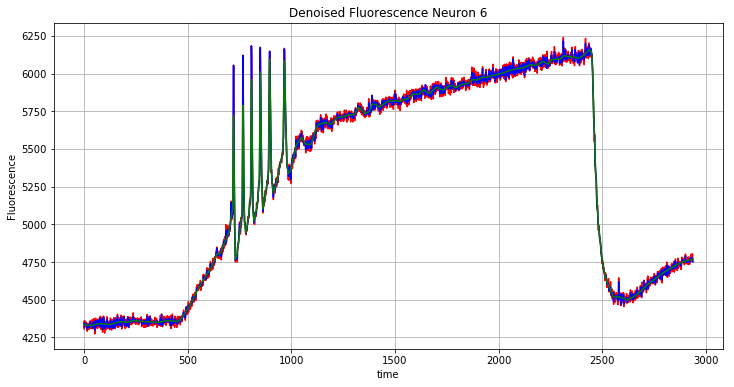

In [37]:
fig, ax = plt.subplots(figsize=(12, 6))
ax.plot(np.arange(T), signal, 'r')
ax.plot(np.arange(T), x, 'b')
ax.plot(np.arange(T), warm_start[0], 'g')

ax.set(xlabel='time', ylabel='Fluorescence',
       title='Denoised Fluorescence Neuron {}'.format(idx))
ax.grid()

plt.show()

In [43]:
x1, y1, results = pd.lagrangian_l1tf(signal, 
                                   warm_start=warm_start,
                                   lam=10, theta=1, maxiter=1e5, tol=1e-2)

||Iter:1||Obj: 5.440e+01||Dual: 3.146e+00||Gap: 5.126e+01||Delta Obj:       inf||Delta x: 3.199e-04||Delta y: 9.769e-02||CPU: 2.058e-03||
||Iter:2||Obj: 5.433e+01||Dual: 1.398e+01||Gap: 4.035e+01||Delta Obj:       inf||Delta x: 3.199e-04||Delta y: 9.227e+02||CPU: 3.823e-03||
||Iter:3||Obj: 5.425e+01||Dual: 1.616e+01||Gap: 3.809e+01||Delta Obj:       inf||Delta x: 3.199e-04||Delta y: 6.342e+03||CPU: 5.588e-03||
||Iter:4||Obj: 5.418e+01||Dual: 1.753e+01||Gap: 3.665e+01||Delta Obj:       inf||Delta x: 3.199e-04||Delta y: 3.048e+04||CPU: 7.508e-03||
||Iter:5||Obj: 5.411e+01||Dual: 1.819e+01||Gap: 3.592e+01||Delta Obj: 5.324e-03||Delta x: 3.199e-04||Delta y: 3.048e+04||CPU: 9.364e-03||
||Iter:6||Obj: 5.404e+01||Dual: 1.846e+01||Gap: 3.558e+01||Delta Obj: 5.242e-03||Delta x: 2.824e-04||Delta y: 3.048e+04||CPU: 1.082e-02||
||Iter:7||Obj: 5.397e+01||Dual: 1.864e+01||Gap: 3.533e+01||Delta Obj: 5.219e-03||Delta x: 2.737e-04||Delta y: 3.123e+04||CPU: 1.307e-02||
||Iter:8||Obj: 5.390e+01||Dual: 1.

||Iter:61||Obj: 5.042e+01||Dual: 1.933e+01||Gap: 3.109e+01||Delta Obj: 4.926e-03||Delta x: 2.469e-04||Delta y: 5.158e+01||CPU: 1.154e-01||
||Iter:62||Obj: 5.036e+01||Dual: 1.933e+01||Gap: 3.103e+01||Delta Obj: 4.922e-03||Delta x: 2.467e-04||Delta y: 7.711e+02||CPU: 1.181e-01||
||Iter:63||Obj: 5.030e+01||Dual: 1.933e+01||Gap: 3.097e+01||Delta Obj: 4.919e-03||Delta x: 2.464e-04||Delta y: 7.711e+02||CPU: 1.204e-01||
||Iter:64||Obj: 5.023e+01||Dual: 1.933e+01||Gap: 3.091e+01||Delta Obj: 4.915e-03||Delta x: 2.462e-04||Delta y: 7.711e+02||CPU: 1.229e-01||
||Iter:65||Obj: 5.017e+01||Dual: 1.933e+01||Gap: 3.084e+01||Delta Obj: 4.912e-03||Delta x: 2.459e-04||Delta y: 7.711e+02||CPU: 1.256e-01||
||Iter:66||Obj: 5.011e+01||Dual: 1.933e+01||Gap: 3.078e+01||Delta Obj: 4.908e-03||Delta x: 2.457e-04||Delta y: 7.711e+02||CPU: 1.285e-01||
||Iter:67||Obj: 5.005e+01||Dual: 1.933e+01||Gap: 3.072e+01||Delta Obj: 4.904e-03||Delta x: 2.454e-04||Delta y: 6.447e+02||CPU: 1.309e-01||
||Iter:68||Obj: 4.999e+01||

/Users/ikinsella/devel/voltagedenoising/primal_dual.py:111: RuntimeWarning: divide by zero encountered in true_divide
  delta_obj = np.max(np.abs((obj[itr % buff] - obj) / obj))


||Iter:81||Obj: 4.920e+01||Dual: 1.934e+01||Gap: 2.987e+01||Delta Obj: 4.850e-03||Delta x: 2.420e-04||Delta y: 4.602e+02||CPU: 1.678e-01||
||Iter:82||Obj: 4.914e+01||Dual: 1.934e+01||Gap: 2.981e+01||Delta Obj: 4.846e-03||Delta x: 2.417e-04||Delta y: 1.547e+02||CPU: 2.274e-01||
||Iter:83||Obj: 4.908e+01||Dual: 1.934e+01||Gap: 2.975e+01||Delta Obj: 4.842e-03||Delta x: 2.415e-04||Delta y: 1.547e+02||CPU: 2.289e-01||
||Iter:84||Obj: 4.902e+01||Dual: 1.934e+01||Gap: 2.969e+01||Delta Obj: 4.838e-03||Delta x: 2.412e-04||Delta y: 1.547e+02||CPU: 2.313e-01||
||Iter:85||Obj: 4.896e+01||Dual: 1.934e+01||Gap: 2.963e+01||Delta Obj: 4.834e-03||Delta x: 2.410e-04||Delta y: 1.547e+02||CPU: 2.339e-01||
||Iter:86||Obj: 4.890e+01||Dual: 1.934e+01||Gap: 2.957e+01||Delta Obj: 4.830e-03||Delta x: 2.407e-04||Delta y: 1.547e+02||CPU: 2.356e-01||
||Iter:87||Obj: 4.885e+01||Dual: 1.934e+01||Gap: 2.951e+01||Delta Obj: 4.826e-03||Delta x: 2.405e-04||Delta y: 8.443e+01||CPU: 2.373e-01||
||Iter:88||Obj: 4.879e+01||

||Iter:140||Obj: 4.588e+01||Dual: 1.937e+01||Gap: 2.651e+01||Delta Obj: 4.617e-03||Delta x: 2.278e-04||Delta y: 7.725e+01||CPU: 3.657e-01||
||Iter:141||Obj: 4.583e+01||Dual: 1.937e+01||Gap: 2.646e+01||Delta Obj: 4.613e-03||Delta x: 2.276e-04||Delta y: 7.725e+01||CPU: 3.674e-01||
||Iter:142||Obj: 4.578e+01||Dual: 1.937e+01||Gap: 2.640e+01||Delta Obj: 4.609e-03||Delta x: 2.273e-04||Delta y: 7.725e+01||CPU: 3.694e-01||
||Iter:143||Obj: 4.572e+01||Dual: 1.937e+01||Gap: 2.635e+01||Delta Obj: 4.605e-03||Delta x: 2.271e-04||Delta y: 7.725e+01||CPU: 3.711e-01||
||Iter:144||Obj: 4.567e+01||Dual: 1.937e+01||Gap: 2.630e+01||Delta Obj: 4.601e-03||Delta x: 2.269e-04||Delta y: 7.725e+01||CPU: 3.728e-01||
||Iter:145||Obj: 4.562e+01||Dual: 1.937e+01||Gap: 2.624e+01||Delta Obj: 4.597e-03||Delta x: 2.267e-04||Delta y: 3.940e+01||CPU: 3.747e-01||
||Iter:146||Obj: 4.556e+01||Dual: 1.937e+01||Gap: 2.619e+01||Delta Obj: 4.593e-03||Delta x: 2.264e-04||Delta y: 3.940e+01||CPU: 3.763e-01||
||Iter:147||Obj: 4.5

||Iter:199||Obj: 4.293e+01||Dual: 1.938e+01||Gap: 2.355e+01||Delta Obj: 4.385e-03||Delta x: 2.146e-04||Delta y: 1.333e+01||CPU: 5.005e-01||
||Iter:200||Obj: 4.289e+01||Dual: 1.938e+01||Gap: 2.351e+01||Delta Obj: 4.381e-03||Delta x: 2.144e-04||Delta y: 1.333e+01||CPU: 5.022e-01||
||Iter:201||Obj: 4.284e+01||Dual: 1.938e+01||Gap: 2.346e+01||Delta Obj: 4.377e-03||Delta x: 2.142e-04||Delta y: 1.333e+01||CPU: 5.040e-01||
||Iter:202||Obj: 4.279e+01||Dual: 1.938e+01||Gap: 2.341e+01||Delta Obj: 4.373e-03||Delta x: 2.140e-04||Delta y: 9.760e+00||CPU: 5.067e-01||
||Iter:203||Obj: 4.274e+01||Dual: 1.938e+01||Gap: 2.336e+01||Delta Obj: 4.369e-03||Delta x: 2.138e-04||Delta y: 3.529e+02||CPU: 5.082e-01||
||Iter:204||Obj: 4.270e+01||Dual: 1.938e+01||Gap: 2.332e+01||Delta Obj: 4.365e-03||Delta x: 2.135e-04||Delta y: 3.529e+02||CPU: 5.103e-01||
||Iter:205||Obj: 4.265e+01||Dual: 1.938e+01||Gap: 2.327e+01||Delta Obj: 4.361e-03||Delta x: 2.133e-04||Delta y: 3.529e+02||CPU: 5.140e-01||
||Iter:206||Obj: 4.2

||Iter:316||Obj: 3.802e+01||Dual: 1.939e+01||Gap: 1.863e+01||Delta Obj: 3.919e-03||Delta x: 1.907e-04||Delta y: 4.868e+00||CPU: 7.621e-01||
||Iter:317||Obj: 3.798e+01||Dual: 1.939e+01||Gap: 1.860e+01||Delta Obj: 3.915e-03||Delta x: 1.905e-04||Delta y: 4.868e+00||CPU: 7.644e-01||
||Iter:318||Obj: 3.795e+01||Dual: 1.939e+01||Gap: 1.856e+01||Delta Obj: 3.911e-03||Delta x: 1.903e-04||Delta y: 8.323e+00||CPU: 7.664e-01||
||Iter:319||Obj: 3.791e+01||Dual: 1.939e+01||Gap: 1.852e+01||Delta Obj: 3.907e-03||Delta x: 1.901e-04||Delta y: 8.323e+00||CPU: 7.703e-01||
||Iter:320||Obj: 3.787e+01||Dual: 1.939e+01||Gap: 1.848e+01||Delta Obj: 3.903e-03||Delta x: 1.900e-04||Delta y: 8.323e+00||CPU: 7.743e-01||
||Iter:321||Obj: 3.784e+01||Dual: 1.939e+01||Gap: 1.845e+01||Delta Obj: 3.899e-03||Delta x: 1.898e-04||Delta y: 8.323e+00||CPU: 7.768e-01||
||Iter:322||Obj: 3.780e+01||Dual: 1.939e+01||Gap: 1.841e+01||Delta Obj: 3.895e-03||Delta x: 1.896e-04||Delta y: 8.323e+00||CPU: 7.790e-01||
||Iter:323||Obj: 3.7

||Iter:375||Obj: 3.595e+01||Dual: 1.939e+01||Gap: 1.656e+01||Delta Obj: 3.684e-03||Delta x: 1.797e-04||Delta y: 8.345e+00||CPU: 8.990e-01||
||Iter:376||Obj: 3.592e+01||Dual: 1.939e+01||Gap: 1.653e+01||Delta Obj: 3.680e-03||Delta x: 1.795e-04||Delta y: 8.345e+00||CPU: 9.011e-01||
||Iter:377||Obj: 3.588e+01||Dual: 1.939e+01||Gap: 1.649e+01||Delta Obj: 3.676e-03||Delta x: 1.794e-04||Delta y: 1.176e+01||CPU: 9.031e-01||
||Iter:378||Obj: 3.585e+01||Dual: 1.939e+01||Gap: 1.646e+01||Delta Obj: 3.672e-03||Delta x: 1.792e-04||Delta y: 1.176e+01||CPU: 9.050e-01||
||Iter:379||Obj: 3.582e+01||Dual: 1.939e+01||Gap: 1.643e+01||Delta Obj: 3.669e-03||Delta x: 1.790e-04||Delta y: 1.176e+01||CPU: 9.080e-01||
||Iter:380||Obj: 3.578e+01||Dual: 1.939e+01||Gap: 1.639e+01||Delta Obj: 3.665e-03||Delta x: 1.788e-04||Delta y: 1.176e+01||CPU: 9.105e-01||
||Iter:381||Obj: 3.575e+01||Dual: 1.939e+01||Gap: 1.636e+01||Delta Obj: 3.661e-03||Delta x: 1.786e-04||Delta y: 1.176e+01||CPU: 9.126e-01||
||Iter:382||Obj: 3.5

||Iter:434||Obj: 3.411e+01||Dual: 1.939e+01||Gap: 1.472e+01||Delta Obj: 3.452e-03||Delta x: 1.694e-04||Delta y: 3.489e+00||CPU: 1.024e+00||
||Iter:435||Obj: 3.408e+01||Dual: 1.939e+01||Gap: 1.469e+01||Delta Obj: 3.448e-03||Delta x: 1.692e-04||Delta y: 3.489e+00||CPU: 1.027e+00||
||Iter:436||Obj: 3.405e+01||Dual: 1.939e+01||Gap: 1.466e+01||Delta Obj: 3.444e-03||Delta x: 1.690e-04||Delta y: 3.489e+00||CPU: 1.029e+00||
||Iter:437||Obj: 3.402e+01||Dual: 1.939e+01||Gap: 1.463e+01||Delta Obj: 3.440e-03||Delta x: 1.689e-04||Delta y: 3.489e+00||CPU: 1.031e+00||
||Iter:438||Obj: 3.399e+01||Dual: 1.939e+01||Gap: 1.460e+01||Delta Obj: 3.436e-03||Delta x: 1.687e-04||Delta y: 2.736e+00||CPU: 1.033e+00||
||Iter:439||Obj: 3.396e+01||Dual: 1.939e+01||Gap: 1.457e+01||Delta Obj: 3.433e-03||Delta x: 1.685e-04||Delta y: 2.736e+00||CPU: 1.035e+00||
||Iter:440||Obj: 3.393e+01||Dual: 1.939e+01||Gap: 1.454e+01||Delta Obj: 3.429e-03||Delta x: 1.683e-04||Delta y: 2.736e+00||CPU: 1.037e+00||
||Iter:441||Obj: 3.3

||Iter:493||Obj: 3.247e+01||Dual: 1.939e+01||Gap: 1.308e+01||Delta Obj: 3.223e-03||Delta x: 1.596e-04||Delta y: 9.415e+00||CPU: 1.151e+00||
||Iter:494||Obj: 3.244e+01||Dual: 1.939e+01||Gap: 1.305e+01||Delta Obj: 3.220e-03||Delta x: 1.594e-04||Delta y: 9.415e+00||CPU: 1.153e+00||
||Iter:495||Obj: 3.242e+01||Dual: 1.939e+01||Gap: 1.303e+01||Delta Obj: 3.216e-03||Delta x: 1.593e-04||Delta y: 1.388e+00||CPU: 1.156e+00||
||Iter:496||Obj: 3.239e+01||Dual: 1.939e+01||Gap: 1.300e+01||Delta Obj: 3.212e-03||Delta x: 1.591e-04||Delta y: 8.834e-01||CPU: 1.157e+00||
||Iter:497||Obj: 3.236e+01||Dual: 1.939e+01||Gap: 1.297e+01||Delta Obj: 3.208e-03||Delta x: 1.590e-04||Delta y: 2.015e+00||CPU: 1.159e+00||
||Iter:498||Obj: 3.234e+01||Dual: 1.939e+01||Gap: 1.295e+01||Delta Obj: 3.204e-03||Delta x: 1.588e-04||Delta y: 2.345e+00||CPU: 1.162e+00||
||Iter:499||Obj: 3.231e+01||Dual: 1.939e+01||Gap: 1.292e+01||Delta Obj: 3.200e-03||Delta x: 1.586e-04||Delta y: 1.723e+01||CPU: 1.164e+00||
||Iter:500||Obj: 3.2

||Iter:552||Obj: 3.101e+01||Dual: 1.939e+01||Gap: 1.162e+01||Delta Obj: 3.000e-03||Delta x: 1.504e-04||Delta y: 9.438e+00||CPU: 1.277e+00||
||Iter:553||Obj: 3.099e+01||Dual: 1.939e+01||Gap: 1.160e+01||Delta Obj: 2.996e-03||Delta x: 1.503e-04||Delta y: 9.438e+00||CPU: 1.279e+00||
||Iter:554||Obj: 3.097e+01||Dual: 1.939e+01||Gap: 1.158e+01||Delta Obj: 2.992e-03||Delta x: 1.501e-04||Delta y: 9.438e+00||CPU: 1.281e+00||
||Iter:555||Obj: 3.094e+01||Dual: 1.939e+01||Gap: 1.155e+01||Delta Obj: 2.989e-03||Delta x: 1.500e-04||Delta y: 9.438e+00||CPU: 1.282e+00||
||Iter:556||Obj: 3.092e+01||Dual: 1.939e+01||Gap: 1.153e+01||Delta Obj: 2.985e-03||Delta x: 1.498e-04||Delta y: 9.438e+00||CPU: 1.284e+00||
||Iter:557||Obj: 3.090e+01||Dual: 1.939e+01||Gap: 1.151e+01||Delta Obj: 2.981e-03||Delta x: 1.497e-04||Delta y: 1.347e+00||CPU: 1.287e+00||
||Iter:558||Obj: 3.088e+01||Dual: 1.939e+01||Gap: 1.149e+01||Delta Obj: 2.977e-03||Delta x: 1.495e-04||Delta y: 3.994e+00||CPU: 1.289e+00||
||Iter:559||Obj: 3.0

||Iter:611||Obj: 2.972e+01||Dual: 1.939e+01||Gap: 1.033e+01||Delta Obj: 2.783e-03||Delta x: 1.418e-04||Delta y: 6.502e-01||CPU: 1.406e+00||
||Iter:612||Obj: 2.970e+01||Dual: 1.939e+01||Gap: 1.031e+01||Delta Obj: 2.779e-03||Delta x: 1.416e-04||Delta y: 1.130e+00||CPU: 1.408e+00||
||Iter:613||Obj: 2.968e+01||Dual: 1.939e+01||Gap: 1.029e+01||Delta Obj: 2.775e-03||Delta x: 1.415e-04||Delta y: 2.022e+01||CPU: 1.410e+00||
||Iter:614||Obj: 2.966e+01||Dual: 1.939e+01||Gap: 1.027e+01||Delta Obj: 2.772e-03||Delta x: 1.413e-04||Delta y: 2.022e+01||CPU: 1.412e+00||
||Iter:615||Obj: 2.964e+01||Dual: 1.939e+01||Gap: 1.025e+01||Delta Obj: 2.768e-03||Delta x: 1.412e-04||Delta y: 2.022e+01||CPU: 1.414e+00||
||Iter:616||Obj: 2.962e+01||Dual: 1.939e+01||Gap: 1.023e+01||Delta Obj: 2.765e-03||Delta x: 1.411e-04||Delta y: 2.022e+01||CPU: 1.415e+00||
||Iter:617||Obj: 2.960e+01||Dual: 1.939e+01||Gap: 1.021e+01||Delta Obj: 2.761e-03||Delta x: 1.409e-04||Delta y: 2.022e+01||CPU: 1.418e+00||
||Iter:618||Obj: 2.9

||Iter:670||Obj: 2.857e+01||Dual: 1.939e+01||Gap: 9.181e+00||Delta Obj: 2.573e-03||Delta x: 1.336e-04||Delta y: 2.683e-01||CPU: 1.539e+00||
||Iter:671||Obj: 2.855e+01||Dual: 1.939e+01||Gap: 9.163e+00||Delta Obj: 2.570e-03||Delta x: 1.335e-04||Delta y: 2.861e-01||CPU: 1.541e+00||
||Iter:672||Obj: 2.853e+01||Dual: 1.939e+01||Gap: 9.145e+00||Delta Obj: 2.566e-03||Delta x: 1.333e-04||Delta y: 3.070e-01||CPU: 1.544e+00||
||Iter:673||Obj: 2.852e+01||Dual: 1.939e+01||Gap: 9.126e+00||Delta Obj: 2.563e-03||Delta x: 1.332e-04||Delta y: 3.326e-01||CPU: 1.546e+00||
||Iter:674||Obj: 2.850e+01||Dual: 1.939e+01||Gap: 9.108e+00||Delta Obj: 2.559e-03||Delta x: 1.331e-04||Delta y: 3.665e-01||CPU: 1.548e+00||
||Iter:675||Obj: 2.848e+01||Dual: 1.939e+01||Gap: 9.090e+00||Delta Obj: 2.556e-03||Delta x: 1.329e-04||Delta y: 4.186e-01||CPU: 1.551e+00||
||Iter:676||Obj: 2.846e+01||Dual: 1.939e+01||Gap: 9.072e+00||Delta Obj: 2.552e-03||Delta x: 1.328e-04||Delta y: 5.186e-01||CPU: 1.553e+00||
||Iter:677||Obj: 2.8

||Iter:729||Obj: 2.755e+01||Dual: 1.939e+01||Gap: 8.160e+00||Delta Obj: 2.372e-03||Delta x: 1.259e-04||Delta y: 5.345e+00||CPU: 1.664e+00||
||Iter:730||Obj: 2.753e+01||Dual: 1.939e+01||Gap: 8.143e+00||Delta Obj: 2.369e-03||Delta x: 1.258e-04||Delta y: 5.345e+00||CPU: 1.666e+00||
||Iter:731||Obj: 2.752e+01||Dual: 1.939e+01||Gap: 8.127e+00||Delta Obj: 2.365e-03||Delta x: 1.257e-04||Delta y: 5.345e+00||CPU: 1.668e+00||
||Iter:732||Obj: 2.750e+01||Dual: 1.939e+01||Gap: 8.111e+00||Delta Obj: 2.362e-03||Delta x: 1.255e-04||Delta y: 5.345e+00||CPU: 1.670e+00||
||Iter:733||Obj: 2.749e+01||Dual: 1.939e+01||Gap: 8.095e+00||Delta Obj: 2.359e-03||Delta x: 1.254e-04||Delta y: 5.345e+00||CPU: 1.672e+00||
||Iter:734||Obj: 2.747e+01||Dual: 1.939e+01||Gap: 8.079e+00||Delta Obj: 2.356e-03||Delta x: 1.253e-04||Delta y: 3.751e+00||CPU: 1.674e+00||
||Iter:735||Obj: 2.745e+01||Dual: 1.939e+01||Gap: 8.062e+00||Delta Obj: 2.352e-03||Delta x: 1.252e-04||Delta y: 1.400e+00||CPU: 1.676e+00||
||Iter:736||Obj: 2.7

||Iter:788||Obj: 2.664e+01||Dual: 1.939e+01||Gap: 7.252e+00||Delta Obj: 2.180e-03||Delta x: 1.187e-04||Delta y: 2.921e+00||CPU: 1.787e+00||
||Iter:789||Obj: 2.663e+01||Dual: 1.939e+01||Gap: 7.237e+00||Delta Obj: 2.177e-03||Delta x: 1.186e-04||Delta y: 2.921e+00||CPU: 1.789e+00||
||Iter:790||Obj: 2.661e+01||Dual: 1.939e+01||Gap: 7.223e+00||Delta Obj: 2.174e-03||Delta x: 1.184e-04||Delta y: 2.921e+00||CPU: 1.791e+00||
||Iter:791||Obj: 2.660e+01||Dual: 1.939e+01||Gap: 7.209e+00||Delta Obj: 2.171e-03||Delta x: 1.183e-04||Delta y: 1.533e+00||CPU: 1.794e+00||
||Iter:792||Obj: 2.658e+01||Dual: 1.939e+01||Gap: 7.194e+00||Delta Obj: 2.168e-03||Delta x: 1.182e-04||Delta y: 6.715e-01||CPU: 1.796e+00||
||Iter:793||Obj: 2.657e+01||Dual: 1.939e+01||Gap: 7.180e+00||Delta Obj: 2.165e-03||Delta x: 1.181e-04||Delta y: 4.507e-01||CPU: 1.797e+00||
||Iter:794||Obj: 2.656e+01||Dual: 1.939e+01||Gap: 7.165e+00||Delta Obj: 2.161e-03||Delta x: 1.180e-04||Delta y: 3.375e-01||CPU: 1.800e+00||
||Iter:795||Obj: 2.6

||Iter:847||Obj: 2.584e+01||Dual: 1.939e+01||Gap: 6.445e+00||Delta Obj: 1.999e-03||Delta x: 1.119e-04||Delta y: 4.374e-01||CPU: 1.915e+00||
||Iter:848||Obj: 2.582e+01||Dual: 1.939e+01||Gap: 6.432e+00||Delta Obj: 1.996e-03||Delta x: 1.117e-04||Delta y: 2.962e-01||CPU: 1.916e+00||
||Iter:849||Obj: 2.581e+01||Dual: 1.939e+01||Gap: 6.419e+00||Delta Obj: 1.993e-03||Delta x: 1.116e-04||Delta y: 2.157e-01||CPU: 1.918e+00||
||Iter:850||Obj: 2.580e+01||Dual: 1.939e+01||Gap: 6.407e+00||Delta Obj: 1.990e-03||Delta x: 1.115e-04||Delta y: 1.631e-01||CPU: 1.920e+00||
||Iter:851||Obj: 2.578e+01||Dual: 1.939e+01||Gap: 6.394e+00||Delta Obj: 1.987e-03||Delta x: 1.114e-04||Delta y: 1.266e-01||CPU: 1.922e+00||
||Iter:852||Obj: 2.577e+01||Dual: 1.939e+01||Gap: 6.381e+00||Delta Obj: 1.984e-03||Delta x: 1.113e-04||Delta y: 1.031e-01||CPU: 1.924e+00||
||Iter:853||Obj: 2.576e+01||Dual: 1.939e+01||Gap: 6.368e+00||Delta Obj: 1.981e-03||Delta x: 1.112e-04||Delta y: 1.207e-01||CPU: 1.926e+00||
||Iter:854||Obj: 2.5

||Iter:906||Obj: 2.512e+01||Dual: 1.939e+01||Gap: 5.728e+00||Delta Obj: 1.827e-03||Delta x: 1.054e-04||Delta y: 2.709e+00||CPU: 2.044e+00||
||Iter:907||Obj: 2.511e+01||Dual: 1.939e+01||Gap: 5.717e+00||Delta Obj: 1.825e-03||Delta x: 1.053e-04||Delta y: 2.709e+00||CPU: 2.046e+00||
||Iter:908||Obj: 2.510e+01||Dual: 1.939e+01||Gap: 5.705e+00||Delta Obj: 1.822e-03||Delta x: 1.052e-04||Delta y: 2.709e+00||CPU: 2.049e+00||
||Iter:909||Obj: 2.508e+01||Dual: 1.939e+01||Gap: 5.694e+00||Delta Obj: 1.819e-03||Delta x: 1.051e-04||Delta y: 2.709e+00||CPU: 2.053e+00||
||Iter:910||Obj: 2.507e+01||Dual: 1.939e+01||Gap: 5.682e+00||Delta Obj: 1.816e-03||Delta x: 1.050e-04||Delta y: 1.646e+00||CPU: 2.055e+00||
||Iter:911||Obj: 2.506e+01||Dual: 1.939e+01||Gap: 5.671e+00||Delta Obj: 1.813e-03||Delta x: 1.049e-04||Delta y: 6.433e-01||CPU: 2.057e+00||
||Iter:912||Obj: 2.505e+01||Dual: 1.939e+01||Gap: 5.660e+00||Delta Obj: 1.811e-03||Delta x: 1.048e-04||Delta y: 4.046e-01||CPU: 2.060e+00||
||Iter:913||Obj: 2.5

||Iter:965||Obj: 2.448e+01||Dual: 1.941e+01||Gap: 5.068e+00||Delta Obj: 1.659e-03||Delta x: 9.912e-05||Delta y: 3.677e+00||CPU: 2.196e+00||
||Iter:966||Obj: 2.447e+01||Dual: 1.941e+01||Gap: 5.058e+00||Delta Obj: 1.656e-03||Delta x: 9.902e-05||Delta y: 1.022e+00||CPU: 2.199e+00||
||Iter:967||Obj: 2.446e+01||Dual: 1.941e+01||Gap: 5.048e+00||Delta Obj: 1.654e-03||Delta x: 9.893e-05||Delta y: 5.280e-01||CPU: 2.202e+00||
||Iter:968||Obj: 2.445e+01||Dual: 1.941e+01||Gap: 5.038e+00||Delta Obj: 1.651e-03||Delta x: 9.883e-05||Delta y: 7.691e-01||CPU: 2.204e+00||
||Iter:969||Obj: 2.444e+01||Dual: 1.941e+01||Gap: 5.028e+00||Delta Obj: 1.649e-03||Delta x: 9.873e-05||Delta y: 1.473e+00||CPU: 2.207e+00||
||Iter:970||Obj: 2.443e+01||Dual: 1.941e+01||Gap: 5.018e+00||Delta Obj: 1.646e-03||Delta x: 9.863e-05||Delta y: 7.122e+00||CPU: 2.209e+00||
||Iter:971||Obj: 2.442e+01||Dual: 1.941e+01||Gap: 5.008e+00||Delta Obj: 1.644e-03||Delta x: 9.853e-05||Delta y: 7.122e+00||CPU: 2.211e+00||
||Iter:972||Obj: 2.4

||Iter:1082||Obj: 2.343e+01||Dual: 1.942e+01||Gap: 4.009e+00||Delta Obj: 1.372e-03||Delta x: 8.812e-05||Delta y: 1.594e-01||CPU: 2.483e+00||
||Iter:1083||Obj: 2.342e+01||Dual: 1.942e+01||Gap: 4.001e+00||Delta Obj: 1.370e-03||Delta x: 8.803e-05||Delta y: 1.912e-01||CPU: 2.485e+00||
||Iter:1084||Obj: 2.341e+01||Dual: 1.942e+01||Gap: 3.993e+00||Delta Obj: 1.367e-03||Delta x: 8.794e-05||Delta y: 2.017e-01||CPU: 2.487e+00||
||Iter:1085||Obj: 2.340e+01||Dual: 1.942e+01||Gap: 3.985e+00||Delta Obj: 1.365e-03||Delta x: 8.786e-05||Delta y: 2.017e-01||CPU: 2.490e+00||
||Iter:1086||Obj: 2.339e+01||Dual: 1.942e+01||Gap: 3.977e+00||Delta Obj: 1.363e-03||Delta x: 8.777e-05||Delta y: 2.017e-01||CPU: 2.492e+00||
||Iter:1087||Obj: 2.339e+01||Dual: 1.942e+01||Gap: 3.969e+00||Delta Obj: 1.361e-03||Delta x: 8.768e-05||Delta y: 2.017e-01||CPU: 2.495e+00||
||Iter:1088||Obj: 2.338e+01||Dual: 1.942e+01||Gap: 3.961e+00||Delta Obj: 1.358e-03||Delta x: 8.759e-05||Delta y: 2.017e-01||CPU: 2.497e+00||
||Iter:1089||

||Iter:1141||Obj: 2.298e+01||Dual: 1.942e+01||Gap: 3.563e+00||Delta Obj: 1.243e-03||Delta x: 8.306e-05||Delta y: 1.026e-01||CPU: 2.615e+00||
||Iter:1142||Obj: 2.297e+01||Dual: 1.942e+01||Gap: 3.556e+00||Delta Obj: 1.241e-03||Delta x: 8.298e-05||Delta y: 9.512e-02||CPU: 2.618e+00||
||Iter:1143||Obj: 2.297e+01||Dual: 1.942e+01||Gap: 3.549e+00||Delta Obj: 1.239e-03||Delta x: 8.289e-05||Delta y: 8.802e-02||CPU: 2.620e+00||
||Iter:1144||Obj: 2.296e+01||Dual: 1.942e+01||Gap: 3.542e+00||Delta Obj: 1.237e-03||Delta x: 8.281e-05||Delta y: 8.140e-02||CPU: 2.623e+00||
||Iter:1145||Obj: 2.295e+01||Dual: 1.942e+01||Gap: 3.535e+00||Delta Obj: 1.235e-03||Delta x: 8.273e-05||Delta y: 7.538e-02||CPU: 2.625e+00||
||Iter:1146||Obj: 2.294e+01||Dual: 1.942e+01||Gap: 3.528e+00||Delta Obj: 1.233e-03||Delta x: 8.264e-05||Delta y: 7.004e-02||CPU: 2.628e+00||
||Iter:1147||Obj: 2.294e+01||Dual: 1.942e+01||Gap: 3.520e+00||Delta Obj: 1.231e-03||Delta x: 8.256e-05||Delta y: 6.549e-02||CPU: 2.630e+00||
||Iter:1148||

||Iter:1200||Obj: 2.258e+01||Dual: 1.942e+01||Gap: 3.167e+00||Delta Obj: 1.124e-03||Delta x: 7.829e-05||Delta y: 4.978e-02||CPU: 2.759e+00||
||Iter:1201||Obj: 2.258e+01||Dual: 1.942e+01||Gap: 3.160e+00||Delta Obj: 1.122e-03||Delta x: 7.821e-05||Delta y: 4.453e-02||CPU: 2.762e+00||
||Iter:1202||Obj: 2.257e+01||Dual: 1.942e+01||Gap: 3.154e+00||Delta Obj: 1.121e-03||Delta x: 7.813e-05||Delta y: 3.933e-02||CPU: 2.765e+00||
||Iter:1203||Obj: 2.256e+01||Dual: 1.942e+01||Gap: 3.148e+00||Delta Obj: 1.119e-03||Delta x: 7.806e-05||Delta y: 4.042e-02||CPU: 2.767e+00||
||Iter:1204||Obj: 2.256e+01||Dual: 1.942e+01||Gap: 3.141e+00||Delta Obj: 1.117e-03||Delta x: 7.798e-05||Delta y: 4.571e-02||CPU: 2.769e+00||
||Iter:1205||Obj: 2.255e+01||Dual: 1.942e+01||Gap: 3.135e+00||Delta Obj: 1.115e-03||Delta x: 7.790e-05||Delta y: 5.100e-02||CPU: 2.771e+00||
||Iter:1206||Obj: 2.255e+01||Dual: 1.942e+01||Gap: 3.129e+00||Delta Obj: 1.113e-03||Delta x: 7.782e-05||Delta y: 5.586e-02||CPU: 2.774e+00||
||Iter:1207||

||Iter:1259||Obj: 2.223e+01||Dual: 1.942e+01||Gap: 2.814e+00||Delta Obj: 1.015e-03||Delta x: 7.380e-05||Delta y: 4.558e-02||CPU: 2.885e+00||
||Iter:1260||Obj: 2.223e+01||Dual: 1.942e+01||Gap: 2.809e+00||Delta Obj: 1.013e-03||Delta x: 7.372e-05||Delta y: 4.615e-02||CPU: 2.887e+00||
||Iter:1261||Obj: 2.222e+01||Dual: 1.942e+01||Gap: 2.803e+00||Delta Obj: 1.012e-03||Delta x: 7.365e-05||Delta y: 4.646e-02||CPU: 2.889e+00||
||Iter:1262||Obj: 2.221e+01||Dual: 1.942e+01||Gap: 2.797e+00||Delta Obj: 1.010e-03||Delta x: 7.357e-05||Delta y: 4.649e-02||CPU: 2.892e+00||
||Iter:1263||Obj: 2.221e+01||Dual: 1.942e+01||Gap: 2.792e+00||Delta Obj: 1.008e-03||Delta x: 7.350e-05||Delta y: 4.649e-02||CPU: 2.894e+00||
||Iter:1264||Obj: 2.220e+01||Dual: 1.942e+01||Gap: 2.786e+00||Delta Obj: 1.006e-03||Delta x: 7.343e-05||Delta y: 4.649e-02||CPU: 2.896e+00||
||Iter:1265||Obj: 2.220e+01||Dual: 1.942e+01||Gap: 2.781e+00||Delta Obj: 1.005e-03||Delta x: 7.335e-05||Delta y: 4.649e-02||CPU: 2.898e+00||
||Iter:1266||

||Iter:1318||Obj: 2.192e+01||Dual: 1.942e+01||Gap: 2.501e+00||Delta Obj: 9.153e-04||Delta x: 6.956e-05||Delta y: 1.448e-02||CPU: 3.013e+00||
||Iter:1319||Obj: 2.191e+01||Dual: 1.942e+01||Gap: 2.496e+00||Delta Obj: 9.137e-04||Delta x: 6.949e-05||Delta y: 1.505e-02||CPU: 3.017e+00||
||Iter:1320||Obj: 2.191e+01||Dual: 1.942e+01||Gap: 2.491e+00||Delta Obj: 9.120e-04||Delta x: 6.942e-05||Delta y: 1.573e-02||CPU: 3.019e+00||
||Iter:1321||Obj: 2.190e+01||Dual: 1.942e+01||Gap: 2.486e+00||Delta Obj: 9.104e-04||Delta x: 6.935e-05||Delta y: 1.649e-02||CPU: 3.021e+00||
||Iter:1322||Obj: 2.190e+01||Dual: 1.942e+01||Gap: 2.481e+00||Delta Obj: 9.088e-04||Delta x: 6.928e-05||Delta y: 1.731e-02||CPU: 3.023e+00||
||Iter:1323||Obj: 2.189e+01||Dual: 1.942e+01||Gap: 2.476e+00||Delta Obj: 9.072e-04||Delta x: 6.921e-05||Delta y: 1.818e-02||CPU: 3.025e+00||
||Iter:1324||Obj: 2.189e+01||Dual: 1.942e+01||Gap: 2.471e+00||Delta Obj: 9.056e-04||Delta x: 6.914e-05||Delta y: 1.907e-02||CPU: 3.027e+00||
||Iter:1325||

||Iter:1377||Obj: 2.164e+01||Dual: 1.942e+01||Gap: 2.223e+00||Delta Obj: 8.240e-04||Delta x: 6.557e-05||Delta y: 2.671e-02||CPU: 3.140e+00||
||Iter:1378||Obj: 2.164e+01||Dual: 1.942e+01||Gap: 2.218e+00||Delta Obj: 8.225e-04||Delta x: 6.550e-05||Delta y: 2.577e-02||CPU: 3.142e+00||
||Iter:1379||Obj: 2.163e+01||Dual: 1.942e+01||Gap: 2.214e+00||Delta Obj: 8.210e-04||Delta x: 6.544e-05||Delta y: 2.474e-02||CPU: 3.144e+00||
||Iter:1380||Obj: 2.163e+01||Dual: 1.942e+01||Gap: 2.210e+00||Delta Obj: 8.196e-04||Delta x: 6.537e-05||Delta y: 2.366e-02||CPU: 3.147e+00||
||Iter:1381||Obj: 2.162e+01||Dual: 1.942e+01||Gap: 2.205e+00||Delta Obj: 8.181e-04||Delta x: 6.530e-05||Delta y: 2.253e-02||CPU: 3.149e+00||
||Iter:1382||Obj: 2.162e+01||Dual: 1.942e+01||Gap: 2.201e+00||Delta Obj: 8.166e-04||Delta x: 6.524e-05||Delta y: 2.138e-02||CPU: 3.150e+00||
||Iter:1383||Obj: 2.161e+01||Dual: 1.942e+01||Gap: 2.196e+00||Delta Obj: 8.152e-04||Delta x: 6.517e-05||Delta y: 2.021e-02||CPU: 3.153e+00||
||Iter:1384||

||Iter:1436||Obj: 2.139e+01||Dual: 1.942e+01||Gap: 1.976e+00||Delta Obj: 7.408e-04||Delta x: 6.180e-05||Delta y: 1.259e-02||CPU: 3.269e+00||
||Iter:1437||Obj: 2.139e+01||Dual: 1.942e+01||Gap: 1.972e+00||Delta Obj: 7.395e-04||Delta x: 6.174e-05||Delta y: 1.422e-02||CPU: 3.271e+00||
||Iter:1438||Obj: 2.139e+01||Dual: 1.942e+01||Gap: 1.968e+00||Delta Obj: 7.381e-04||Delta x: 6.168e-05||Delta y: 1.575e-02||CPU: 3.272e+00||
||Iter:1439||Obj: 2.138e+01||Dual: 1.942e+01||Gap: 1.964e+00||Delta Obj: 7.368e-04||Delta x: 6.162e-05||Delta y: 1.713e-02||CPU: 3.274e+00||
||Iter:1440||Obj: 2.138e+01||Dual: 1.942e+01||Gap: 1.960e+00||Delta Obj: 7.355e-04||Delta x: 6.156e-05||Delta y: 1.837e-02||CPU: 3.277e+00||
||Iter:1441||Obj: 2.137e+01||Dual: 1.942e+01||Gap: 1.956e+00||Delta Obj: 7.341e-04||Delta x: 6.150e-05||Delta y: 1.944e-02||CPU: 3.279e+00||
||Iter:1442||Obj: 2.137e+01||Dual: 1.942e+01||Gap: 1.952e+00||Delta Obj: 7.328e-04||Delta x: 6.143e-05||Delta y: 2.034e-02||CPU: 3.281e+00||
||Iter:1443||

||Iter:1552||Obj: 2.098e+01||Dual: 1.942e+01||Gap: 1.567e+00||Delta Obj: 5.991e-04||Delta x: 5.503e-05||Delta y: 4.667e-02||CPU: 3.517e+00||
||Iter:1553||Obj: 2.098e+01||Dual: 1.942e+01||Gap: 1.564e+00||Delta Obj: 5.980e-04||Delta x: 5.497e-05||Delta y: 4.591e-02||CPU: 3.520e+00||
||Iter:1554||Obj: 2.098e+01||Dual: 1.942e+01||Gap: 1.560e+00||Delta Obj: 5.969e-04||Delta x: 5.492e-05||Delta y: 4.376e-02||CPU: 3.523e+00||
||Iter:1555||Obj: 2.097e+01||Dual: 1.942e+01||Gap: 1.557e+00||Delta Obj: 5.958e-04||Delta x: 5.486e-05||Delta y: 4.043e-02||CPU: 3.527e+00||
||Iter:1556||Obj: 2.097e+01||Dual: 1.942e+01||Gap: 1.554e+00||Delta Obj: 5.946e-04||Delta x: 5.481e-05||Delta y: 3.618e-02||CPU: 3.529e+00||
||Iter:1557||Obj: 2.097e+01||Dual: 1.942e+01||Gap: 1.551e+00||Delta Obj: 5.935e-04||Delta x: 5.475e-05||Delta y: 3.127e-02||CPU: 3.531e+00||
||Iter:1558||Obj: 2.097e+01||Dual: 1.942e+01||Gap: 1.548e+00||Delta Obj: 5.924e-04||Delta x: 5.470e-05||Delta y: 2.599e-02||CPU: 3.534e+00||
||Iter:1559||

||Iter:1611||Obj: 2.081e+01||Dual: 1.942e+01||Gap: 1.392e+00||Delta Obj: 5.369e-04||Delta x: 5.187e-05||Delta y: 1.853e-02||CPU: 3.669e+00||
||Iter:1612||Obj: 2.081e+01||Dual: 1.942e+01||Gap: 1.390e+00||Delta Obj: 5.359e-04||Delta x: 5.182e-05||Delta y: 1.940e-02||CPU: 3.671e+00||
||Iter:1613||Obj: 2.080e+01||Dual: 1.942e+01||Gap: 1.387e+00||Delta Obj: 5.349e-04||Delta x: 5.176e-05||Delta y: 2.017e-02||CPU: 3.672e+00||
||Iter:1614||Obj: 2.080e+01||Dual: 1.942e+01||Gap: 1.384e+00||Delta Obj: 5.339e-04||Delta x: 5.171e-05||Delta y: 2.079e-02||CPU: 3.675e+00||
||Iter:1615||Obj: 2.080e+01||Dual: 1.942e+01||Gap: 1.381e+00||Delta Obj: 5.329e-04||Delta x: 5.166e-05||Delta y: 2.123e-02||CPU: 3.677e+00||
||Iter:1616||Obj: 2.080e+01||Dual: 1.942e+01||Gap: 1.379e+00||Delta Obj: 5.319e-04||Delta x: 5.161e-05||Delta y: 2.142e-02||CPU: 3.680e+00||
||Iter:1617||Obj: 2.079e+01||Dual: 1.942e+01||Gap: 1.376e+00||Delta Obj: 5.309e-04||Delta x: 5.156e-05||Delta y: 2.142e-02||CPU: 3.683e+00||
||Iter:1618||

||Iter:1670||Obj: 2.065e+01||Dual: 1.942e+01||Gap: 1.237e+00||Delta Obj: 4.808e-04||Delta x: 4.889e-05||Delta y: 1.160e-02||CPU: 3.807e+00||
||Iter:1671||Obj: 2.065e+01||Dual: 1.942e+01||Gap: 1.235e+00||Delta Obj: 4.799e-04||Delta x: 4.884e-05||Delta y: 1.029e-02||CPU: 3.810e+00||
||Iter:1672||Obj: 2.065e+01||Dual: 1.942e+01||Gap: 1.233e+00||Delta Obj: 4.790e-04||Delta x: 4.880e-05||Delta y: 9.082e-03||CPU: 3.812e+00||
||Iter:1673||Obj: 2.065e+01||Dual: 1.942e+01||Gap: 1.230e+00||Delta Obj: 4.781e-04||Delta x: 4.875e-05||Delta y: 8.044e-03||CPU: 3.814e+00||
||Iter:1674||Obj: 2.064e+01||Dual: 1.942e+01||Gap: 1.228e+00||Delta Obj: 4.772e-04||Delta x: 4.870e-05||Delta y: 8.360e-03||CPU: 3.816e+00||
||Iter:1675||Obj: 2.064e+01||Dual: 1.942e+01||Gap: 1.225e+00||Delta Obj: 4.763e-04||Delta x: 4.865e-05||Delta y: 9.408e-03||CPU: 3.819e+00||
||Iter:1676||Obj: 2.064e+01||Dual: 1.942e+01||Gap: 1.223e+00||Delta Obj: 4.754e-04||Delta x: 4.860e-05||Delta y: 1.055e-02||CPU: 3.821e+00||
||Iter:1677||

||Iter:1729||Obj: 2.052e+01||Dual: 1.942e+01||Gap: 1.100e+00||Delta Obj: 4.301e-04||Delta x: 4.609e-05||Delta y: 1.711e-02||CPU: 3.937e+00||
||Iter:1730||Obj: 2.051e+01||Dual: 1.942e+01||Gap: 1.098e+00||Delta Obj: 4.293e-04||Delta x: 4.604e-05||Delta y: 1.596e-02||CPU: 3.940e+00||
||Iter:1731||Obj: 2.051e+01||Dual: 1.942e+01||Gap: 1.095e+00||Delta Obj: 4.285e-04||Delta x: 4.600e-05||Delta y: 1.736e-02||CPU: 3.942e+00||
||Iter:1732||Obj: 2.051e+01||Dual: 1.942e+01||Gap: 1.093e+00||Delta Obj: 4.277e-04||Delta x: 4.595e-05||Delta y: 1.881e-02||CPU: 3.944e+00||
||Iter:1733||Obj: 2.051e+01||Dual: 1.942e+01||Gap: 1.091e+00||Delta Obj: 4.269e-04||Delta x: 4.590e-05||Delta y: 2.010e-02||CPU: 3.946e+00||
||Iter:1734||Obj: 2.051e+01||Dual: 1.942e+01||Gap: 1.089e+00||Delta Obj: 4.261e-04||Delta x: 4.586e-05||Delta y: 2.105e-02||CPU: 3.949e+00||
||Iter:1735||Obj: 2.050e+01||Dual: 1.942e+01||Gap: 1.087e+00||Delta Obj: 4.253e-04||Delta x: 4.581e-05||Delta y: 2.151e-02||CPU: 3.950e+00||
||Iter:1736||

||Iter:1846||Obj: 2.029e+01||Dual: 1.942e+01||Gap: 8.704e-01||Delta Obj: 3.443e-04||Delta x: 4.099e-05||Delta y: 8.003e-03||CPU: 4.188e+00||
||Iter:1847||Obj: 2.029e+01||Dual: 1.942e+01||Gap: 8.687e-01||Delta Obj: 3.437e-04||Delta x: 4.095e-05||Delta y: 7.650e-03||CPU: 4.190e+00||
||Iter:1848||Obj: 2.028e+01||Dual: 1.942e+01||Gap: 8.670e-01||Delta Obj: 3.430e-04||Delta x: 4.091e-05||Delta y: 7.263e-03||CPU: 4.192e+00||
||Iter:1849||Obj: 2.028e+01||Dual: 1.942e+01||Gap: 8.652e-01||Delta Obj: 3.424e-04||Delta x: 4.087e-05||Delta y: 6.849e-03||CPU: 4.194e+00||
||Iter:1850||Obj: 2.028e+01||Dual: 1.942e+01||Gap: 8.635e-01||Delta Obj: 3.417e-04||Delta x: 4.083e-05||Delta y: 6.416e-03||CPU: 4.197e+00||
||Iter:1851||Obj: 2.028e+01||Dual: 1.942e+01||Gap: 8.618e-01||Delta Obj: 3.410e-04||Delta x: 4.079e-05||Delta y: 5.970e-03||CPU: 4.199e+00||
||Iter:1852||Obj: 2.028e+01||Dual: 1.942e+01||Gap: 8.601e-01||Delta Obj: 3.404e-04||Delta x: 4.075e-05||Delta y: 5.518e-03||CPU: 4.201e+00||
||Iter:1853||

||Iter:1905||Obj: 2.019e+01||Dual: 1.942e+01||Gap: 7.734e-01||Delta Obj: 3.073e-04||Delta x: 3.864e-05||Delta y: 4.002e-02||CPU: 4.320e+00||
||Iter:1906||Obj: 2.019e+01||Dual: 1.942e+01||Gap: 7.715e-01||Delta Obj: 3.062e-04||Delta x: 3.861e-05||Delta y: 1.270e-01||CPU: 4.323e+00||
||Iter:1907||Obj: 2.019e+01||Dual: 1.942e+01||Gap: 7.694e-01||Delta Obj: 3.052e-04||Delta x: 3.857e-05||Delta y: 2.544e-01||CPU: 4.325e+00||
||Iter:1908||Obj: 2.019e+01||Dual: 1.942e+01||Gap: 7.673e-01||Delta Obj: 3.042e-04||Delta x: 3.853e-05||Delta y: 3.700e-01||CPU: 4.328e+00||
||Iter:1909||Obj: 2.018e+01||Dual: 1.942e+01||Gap: 7.653e-01||Delta Obj: 3.034e-04||Delta x: 3.848e-05||Delta y: 5.007e-01||CPU: 4.330e+00||
||Iter:1910||Obj: 2.018e+01||Dual: 1.942e+01||Gap: 7.633e-01||Delta Obj: 3.030e-04||Delta x: 3.843e-05||Delta y: 7.625e-01||CPU: 4.334e+00||
||Iter:1911||Obj: 2.018e+01||Dual: 1.942e+01||Gap: 7.616e-01||Delta Obj: 3.025e-04||Delta x: 3.838e-05||Delta y: 1.673e+00||CPU: 4.336e+00||
||Iter:1912||

||Iter:1964||Obj: 2.011e+01||Dual: 1.942e+01||Gap: 6.826e-01||Delta Obj: 2.720e-04||Delta x: 3.635e-05||Delta y: 1.523e+01||CPU: 4.453e+00||
||Iter:1965||Obj: 2.010e+01||Dual: 1.942e+01||Gap: 6.805e-01||Delta Obj: 2.709e-04||Delta x: 3.631e-05||Delta y: 1.523e+01||CPU: 4.455e+00||
||Iter:1966||Obj: 2.010e+01||Dual: 1.942e+01||Gap: 6.787e-01||Delta Obj: 2.702e-04||Delta x: 3.626e-05||Delta y: 1.523e+01||CPU: 4.457e+00||
||Iter:1967||Obj: 2.010e+01||Dual: 1.942e+01||Gap: 6.770e-01||Delta Obj: 2.700e-04||Delta x: 3.619e-05||Delta y: 1.523e+01||CPU: 4.459e+00||
||Iter:1968||Obj: 2.010e+01||Dual: 1.942e+01||Gap: 6.753e-01||Delta Obj: 2.696e-04||Delta x: 3.613e-05||Delta y: 1.523e+01||CPU: 4.461e+00||
||Iter:1969||Obj: 2.010e+01||Dual: 1.942e+01||Gap: 6.737e-01||Delta Obj: 2.691e-04||Delta x: 3.607e-05||Delta y: 3.818e+00||CPU: 4.464e+00||
||Iter:1970||Obj: 2.010e+01||Dual: 1.942e+01||Gap: 6.722e-01||Delta Obj: 2.686e-04||Delta x: 3.602e-05||Delta y: 3.818e+00||CPU: 4.466e+00||
||Iter:1971||

||Iter:2023||Obj: 2.003e+01||Dual: 1.943e+01||Gap: 6.043e-01||Delta Obj: 2.421e-04||Delta x: 3.411e-05||Delta y: 3.206e-02||CPU: 4.589e+00||
||Iter:2024||Obj: 2.003e+01||Dual: 1.943e+01||Gap: 6.031e-01||Delta Obj: 2.417e-04||Delta x: 3.408e-05||Delta y: 3.185e-02||CPU: 4.592e+00||
||Iter:2025||Obj: 2.003e+01||Dual: 1.943e+01||Gap: 6.019e-01||Delta Obj: 2.412e-04||Delta x: 3.405e-05||Delta y: 2.955e-02||CPU: 4.594e+00||
||Iter:2026||Obj: 2.003e+01||Dual: 1.943e+01||Gap: 6.007e-01||Delta Obj: 2.407e-04||Delta x: 3.401e-05||Delta y: 2.491e-02||CPU: 4.596e+00||
||Iter:2027||Obj: 2.002e+01||Dual: 1.943e+01||Gap: 5.995e-01||Delta Obj: 2.403e-04||Delta x: 3.398e-05||Delta y: 1.831e-02||CPU: 4.598e+00||
||Iter:2028||Obj: 2.002e+01||Dual: 1.943e+01||Gap: 5.983e-01||Delta Obj: 2.398e-04||Delta x: 3.394e-05||Delta y: 1.914e-02||CPU: 4.600e+00||
||Iter:2029||Obj: 2.002e+01||Dual: 1.943e+01||Gap: 5.971e-01||Delta Obj: 2.393e-04||Delta x: 3.391e-05||Delta y: 2.284e-02||CPU: 4.602e+00||
||Iter:2030||

||Iter:2082||Obj: 1.996e+01||Dual: 1.943e+01||Gap: 5.371e-01||Delta Obj: 2.159e-04||Delta x: 3.216e-05||Delta y: 6.224e-03||CPU: 4.722e+00||
||Iter:2083||Obj: 1.996e+01||Dual: 1.943e+01||Gap: 5.360e-01||Delta Obj: 2.155e-04||Delta x: 3.213e-05||Delta y: 5.011e-03||CPU: 4.725e+00||
||Iter:2084||Obj: 1.996e+01||Dual: 1.943e+01||Gap: 5.349e-01||Delta Obj: 2.151e-04||Delta x: 3.209e-05||Delta y: 4.110e-03||CPU: 4.728e+00||
||Iter:2085||Obj: 1.996e+01||Dual: 1.943e+01||Gap: 5.339e-01||Delta Obj: 2.147e-04||Delta x: 3.206e-05||Delta y: 5.046e-03||CPU: 4.730e+00||
||Iter:2086||Obj: 1.996e+01||Dual: 1.943e+01||Gap: 5.328e-01||Delta Obj: 2.143e-04||Delta x: 3.203e-05||Delta y: 5.802e-03||CPU: 4.732e+00||
||Iter:2087||Obj: 1.996e+01||Dual: 1.943e+01||Gap: 5.317e-01||Delta Obj: 2.138e-04||Delta x: 3.200e-05||Delta y: 6.309e-03||CPU: 4.735e+00||
||Iter:2088||Obj: 1.996e+01||Dual: 1.943e+01||Gap: 5.307e-01||Delta Obj: 2.134e-04||Delta x: 3.197e-05||Delta y: 6.542e-03||CPU: 4.737e+00||
||Iter:2089||

||Iter:2141||Obj: 1.990e+01||Dual: 1.943e+01||Gap: 4.773e-01||Delta Obj: 1.925e-04||Delta x: 3.031e-05||Delta y: 2.457e-03||CPU: 4.861e+00||
||Iter:2142||Obj: 1.990e+01||Dual: 1.943e+01||Gap: 4.764e-01||Delta Obj: 1.921e-04||Delta x: 3.028e-05||Delta y: 2.322e-03||CPU: 4.864e+00||
||Iter:2143||Obj: 1.990e+01||Dual: 1.943e+01||Gap: 4.754e-01||Delta Obj: 1.917e-04||Delta x: 3.025e-05||Delta y: 2.237e-03||CPU: 4.866e+00||
||Iter:2144||Obj: 1.990e+01||Dual: 1.943e+01||Gap: 4.745e-01||Delta Obj: 1.914e-04||Delta x: 3.022e-05||Delta y: 2.235e-03||CPU: 4.869e+00||
||Iter:2145||Obj: 1.990e+01||Dual: 1.943e+01||Gap: 4.735e-01||Delta Obj: 1.910e-04||Delta x: 3.019e-05||Delta y: 2.235e-03||CPU: 4.871e+00||
||Iter:2146||Obj: 1.990e+01||Dual: 1.943e+01||Gap: 4.726e-01||Delta Obj: 1.906e-04||Delta x: 3.016e-05||Delta y: 2.235e-03||CPU: 4.874e+00||
||Iter:2147||Obj: 1.990e+01||Dual: 1.943e+01||Gap: 4.716e-01||Delta Obj: 1.903e-04||Delta x: 3.013e-05||Delta y: 2.235e-03||CPU: 4.876e+00||
||Iter:2148||

||Iter:2200||Obj: 1.985e+01||Dual: 1.943e+01||Gap: 4.239e-01||Delta Obj: 1.714e-04||Delta x: 2.857e-05||Delta y: 4.872e-03||CPU: 5.001e+00||
||Iter:2201||Obj: 1.985e+01||Dual: 1.943e+01||Gap: 4.231e-01||Delta Obj: 1.711e-04||Delta x: 2.854e-05||Delta y: 4.432e-03||CPU: 5.003e+00||
||Iter:2202||Obj: 1.985e+01||Dual: 1.943e+01||Gap: 4.222e-01||Delta Obj: 1.708e-04||Delta x: 2.851e-05||Delta y: 3.822e-03||CPU: 5.005e+00||
||Iter:2203||Obj: 1.985e+01||Dual: 1.943e+01||Gap: 4.214e-01||Delta Obj: 1.704e-04||Delta x: 2.848e-05||Delta y: 3.118e-03||CPU: 5.008e+00||
||Iter:2204||Obj: 1.985e+01||Dual: 1.943e+01||Gap: 4.205e-01||Delta Obj: 1.701e-04||Delta x: 2.845e-05||Delta y: 2.416e-03||CPU: 5.011e+00||
||Iter:2205||Obj: 1.985e+01||Dual: 1.943e+01||Gap: 4.197e-01||Delta Obj: 1.698e-04||Delta x: 2.842e-05||Delta y: 2.738e-03||CPU: 5.013e+00||
||Iter:2206||Obj: 1.984e+01||Dual: 1.943e+01||Gap: 4.189e-01||Delta Obj: 1.694e-04||Delta x: 2.840e-05||Delta y: 3.141e-03||CPU: 5.016e+00||
||Iter:2207||

||Iter:2259||Obj: 1.980e+01||Dual: 1.943e+01||Gap: 3.768e-01||Delta Obj: 1.527e-04||Delta x: 2.693e-05||Delta y: 1.197e-03||CPU: 5.147e+00||
||Iter:2260||Obj: 1.980e+01||Dual: 1.943e+01||Gap: 3.760e-01||Delta Obj: 1.524e-04||Delta x: 2.690e-05||Delta y: 1.116e-03||CPU: 5.149e+00||
||Iter:2261||Obj: 1.980e+01||Dual: 1.943e+01||Gap: 3.753e-01||Delta Obj: 1.521e-04||Delta x: 2.688e-05||Delta y: 1.212e-03||CPU: 5.152e+00||
||Iter:2262||Obj: 1.980e+01||Dual: 1.943e+01||Gap: 3.745e-01||Delta Obj: 1.518e-04||Delta x: 2.685e-05||Delta y: 1.313e-03||CPU: 5.154e+00||
||Iter:2263||Obj: 1.980e+01||Dual: 1.943e+01||Gap: 3.738e-01||Delta Obj: 1.515e-04||Delta x: 2.682e-05||Delta y: 1.407e-03||CPU: 5.156e+00||
||Iter:2264||Obj: 1.980e+01||Dual: 1.943e+01||Gap: 3.730e-01||Delta Obj: 1.512e-04||Delta x: 2.680e-05||Delta y: 1.483e-03||CPU: 5.158e+00||
||Iter:2265||Obj: 1.980e+01||Dual: 1.943e+01||Gap: 3.723e-01||Delta Obj: 1.509e-04||Delta x: 2.677e-05||Delta y: 1.537e-03||CPU: 5.161e+00||
||Iter:2266||

||Iter:2318||Obj: 1.976e+01||Dual: 1.943e+01||Gap: 3.348e-01||Delta Obj: 1.360e-04||Delta x: 2.539e-05||Delta y: 1.152e-03||CPU: 5.282e+00||
||Iter:2319||Obj: 1.976e+01||Dual: 1.943e+01||Gap: 3.342e-01||Delta Obj: 1.358e-04||Delta x: 2.536e-05||Delta y: 1.144e-03||CPU: 5.284e+00||
||Iter:2320||Obj: 1.976e+01||Dual: 1.943e+01||Gap: 3.335e-01||Delta Obj: 1.355e-04||Delta x: 2.534e-05||Delta y: 1.136e-03||CPU: 5.288e+00||
||Iter:2321||Obj: 1.976e+01||Dual: 1.943e+01||Gap: 3.328e-01||Delta Obj: 1.352e-04||Delta x: 2.531e-05||Delta y: 1.129e-03||CPU: 5.291e+00||
||Iter:2322||Obj: 1.976e+01||Dual: 1.943e+01||Gap: 3.322e-01||Delta Obj: 1.350e-04||Delta x: 2.528e-05||Delta y: 1.123e-03||CPU: 5.294e+00||
||Iter:2323||Obj: 1.976e+01||Dual: 1.943e+01||Gap: 3.315e-01||Delta Obj: 1.347e-04||Delta x: 2.526e-05||Delta y: 1.116e-03||CPU: 5.296e+00||
||Iter:2324||Obj: 1.976e+01||Dual: 1.943e+01||Gap: 3.309e-01||Delta Obj: 1.344e-04||Delta x: 2.523e-05||Delta y: 1.110e-03||CPU: 5.299e+00||
||Iter:2325||

||Iter:2377||Obj: 1.972e+01||Dual: 1.943e+01||Gap: 2.976e-01||Delta Obj: 1.211e-04||Delta x: 2.393e-05||Delta y: 1.128e-03||CPU: 5.430e+00||
||Iter:2378||Obj: 1.972e+01||Dual: 1.943e+01||Gap: 2.970e-01||Delta Obj: 1.209e-04||Delta x: 2.391e-05||Delta y: 1.133e-03||CPU: 5.432e+00||
||Iter:2379||Obj: 1.972e+01||Dual: 1.943e+01||Gap: 2.964e-01||Delta Obj: 1.206e-04||Delta x: 2.388e-05||Delta y: 1.133e-03||CPU: 5.435e+00||
||Iter:2380||Obj: 1.972e+01||Dual: 1.943e+01||Gap: 2.958e-01||Delta Obj: 1.204e-04||Delta x: 2.386e-05||Delta y: 1.133e-03||CPU: 5.438e+00||
||Iter:2381||Obj: 1.972e+01||Dual: 1.943e+01||Gap: 2.952e-01||Delta Obj: 1.202e-04||Delta x: 2.384e-05||Delta y: 1.133e-03||CPU: 5.440e+00||
||Iter:2382||Obj: 1.972e+01||Dual: 1.943e+01||Gap: 2.946e-01||Delta Obj: 1.199e-04||Delta x: 2.381e-05||Delta y: 1.133e-03||CPU: 5.442e+00||
||Iter:2383||Obj: 1.972e+01||Dual: 1.943e+01||Gap: 2.940e-01||Delta Obj: 1.197e-04||Delta x: 2.379e-05||Delta y: 1.133e-03||CPU: 5.444e+00||
||Iter:2384||

||Iter:2436||Obj: 1.969e+01||Dual: 1.943e+01||Gap: 2.645e-01||Delta Obj: 1.078e-04||Delta x: 2.256e-05||Delta y: 7.121e-04||CPU: 5.562e+00||
||Iter:2437||Obj: 1.969e+01||Dual: 1.943e+01||Gap: 2.640e-01||Delta Obj: 1.076e-04||Delta x: 2.254e-05||Delta y: 6.773e-04||CPU: 5.564e+00||
||Iter:2438||Obj: 1.969e+01||Dual: 1.943e+01||Gap: 2.634e-01||Delta Obj: 1.074e-04||Delta x: 2.251e-05||Delta y: 6.436e-04||CPU: 5.566e+00||
||Iter:2439||Obj: 1.969e+01||Dual: 1.943e+01||Gap: 2.629e-01||Delta Obj: 1.072e-04||Delta x: 2.249e-05||Delta y: 6.120e-04||CPU: 5.567e+00||
||Iter:2440||Obj: 1.969e+01||Dual: 1.943e+01||Gap: 2.624e-01||Delta Obj: 1.070e-04||Delta x: 2.247e-05||Delta y: 5.834e-04||CPU: 5.569e+00||
||Iter:2441||Obj: 1.969e+01||Dual: 1.943e+01||Gap: 2.619e-01||Delta Obj: 1.068e-04||Delta x: 2.245e-05||Delta y: 5.586e-04||CPU: 5.571e+00||
||Iter:2442||Obj: 1.969e+01||Dual: 1.943e+01||Gap: 2.613e-01||Delta Obj: 1.066e-04||Delta x: 2.242e-05||Delta y: 5.386e-04||CPU: 5.573e+00||
||Iter:2443||

||Iter:2495||Obj: 1.966e+01||Dual: 1.943e+01||Gap: 2.351e-01||Delta Obj: 9.597e-05||Delta x: 2.127e-05||Delta y: 6.490e-04||CPU: 5.691e+00||
||Iter:2496||Obj: 1.966e+01||Dual: 1.943e+01||Gap: 2.346e-01||Delta Obj: 9.579e-05||Delta x: 2.125e-05||Delta y: 6.380e-04||CPU: 5.694e+00||
||Iter:2497||Obj: 1.966e+01||Dual: 1.943e+01||Gap: 2.341e-01||Delta Obj: 9.560e-05||Delta x: 2.122e-05||Delta y: 6.249e-04||CPU: 5.696e+00||
||Iter:2498||Obj: 1.966e+01||Dual: 1.943e+01||Gap: 2.337e-01||Delta Obj: 9.541e-05||Delta x: 2.120e-05||Delta y: 6.099e-04||CPU: 5.697e+00||
||Iter:2499||Obj: 1.966e+01||Dual: 1.943e+01||Gap: 2.332e-01||Delta Obj: 9.522e-05||Delta x: 2.118e-05||Delta y: 5.930e-04||CPU: 5.700e+00||
||Iter:2500||Obj: 1.966e+01||Dual: 1.943e+01||Gap: 2.327e-01||Delta Obj: 9.503e-05||Delta x: 2.116e-05||Delta y: 5.745e-04||CPU: 5.701e+00||
||Iter:2501||Obj: 1.966e+01||Dual: 1.943e+01||Gap: 2.323e-01||Delta Obj: 9.484e-05||Delta x: 2.114e-05||Delta y: 5.547e-04||CPU: 5.703e+00||
||Iter:2502||

||Iter:2554||Obj: 1.963e+01||Dual: 1.943e+01||Gap: 2.089e-01||Delta Obj: 8.541e-05||Delta x: 2.005e-05||Delta y: 3.472e-04||CPU: 5.820e+00||
||Iter:2555||Obj: 1.963e+01||Dual: 1.943e+01||Gap: 2.085e-01||Delta Obj: 8.524e-05||Delta x: 2.003e-05||Delta y: 3.814e-04||CPU: 5.822e+00||
||Iter:2556||Obj: 1.963e+01||Dual: 1.943e+01||Gap: 2.081e-01||Delta Obj: 8.507e-05||Delta x: 2.001e-05||Delta y: 4.148e-04||CPU: 5.824e+00||
||Iter:2557||Obj: 1.963e+01||Dual: 1.943e+01||Gap: 2.077e-01||Delta Obj: 8.491e-05||Delta x: 1.999e-05||Delta y: 4.469e-04||CPU: 5.826e+00||
||Iter:2558||Obj: 1.963e+01||Dual: 1.943e+01||Gap: 2.072e-01||Delta Obj: 8.474e-05||Delta x: 1.997e-05||Delta y: 4.773e-04||CPU: 5.829e+00||
||Iter:2559||Obj: 1.963e+01||Dual: 1.943e+01||Gap: 2.068e-01||Delta Obj: 8.457e-05||Delta x: 1.995e-05||Delta y: 5.055e-04||CPU: 5.831e+00||
||Iter:2560||Obj: 1.963e+01||Dual: 1.943e+01||Gap: 2.064e-01||Delta Obj: 8.440e-05||Delta x: 1.993e-05||Delta y: 5.313e-04||CPU: 5.833e+00||
||Iter:2561||

||Iter:2670||Obj: 1.959e+01||Dual: 1.943e+01||Gap: 1.657e-01||Delta Obj: 6.788e-05||Delta x: 1.785e-05||Delta y: 3.927e-03||CPU: 6.075e+00||
||Iter:2671||Obj: 1.959e+01||Dual: 1.943e+01||Gap: 1.653e-01||Delta Obj: 6.775e-05||Delta x: 1.783e-05||Delta y: 4.315e-03||CPU: 6.079e+00||
||Iter:2672||Obj: 1.959e+01||Dual: 1.943e+01||Gap: 1.650e-01||Delta Obj: 6.761e-05||Delta x: 1.782e-05||Delta y: 4.593e-03||CPU: 6.081e+00||
||Iter:2673||Obj: 1.959e+01||Dual: 1.943e+01||Gap: 1.647e-01||Delta Obj: 6.748e-05||Delta x: 1.780e-05||Delta y: 4.760e-03||CPU: 6.084e+00||
||Iter:2674||Obj: 1.959e+01||Dual: 1.943e+01||Gap: 1.644e-01||Delta Obj: 6.735e-05||Delta x: 1.778e-05||Delta y: 4.814e-03||CPU: 6.086e+00||
||Iter:2675||Obj: 1.959e+01||Dual: 1.943e+01||Gap: 1.640e-01||Delta Obj: 6.721e-05||Delta x: 1.776e-05||Delta y: 4.814e-03||CPU: 6.087e+00||
||Iter:2676||Obj: 1.959e+01||Dual: 1.943e+01||Gap: 1.637e-01||Delta Obj: 6.708e-05||Delta x: 1.774e-05||Delta y: 4.814e-03||CPU: 6.089e+00||
||Iter:2677||

||Iter:2729||Obj: 1.957e+01||Dual: 1.943e+01||Gap: 1.472e-01||Delta Obj: 6.038e-05||Delta x: 1.683e-05||Delta y: 1.220e-03||CPU: 6.210e+00||
||Iter:2730||Obj: 1.957e+01||Dual: 1.943e+01||Gap: 1.469e-01||Delta Obj: 6.026e-05||Delta x: 1.681e-05||Delta y: 1.506e-03||CPU: 6.212e+00||
||Iter:2731||Obj: 1.957e+01||Dual: 1.943e+01||Gap: 1.467e-01||Delta Obj: 6.014e-05||Delta x: 1.679e-05||Delta y: 1.754e-03||CPU: 6.214e+00||
||Iter:2732||Obj: 1.957e+01||Dual: 1.943e+01||Gap: 1.464e-01||Delta Obj: 6.003e-05||Delta x: 1.678e-05||Delta y: 1.957e-03||CPU: 6.217e+00||
||Iter:2733||Obj: 1.957e+01||Dual: 1.943e+01||Gap: 1.461e-01||Delta Obj: 5.991e-05||Delta x: 1.676e-05||Delta y: 2.110e-03||CPU: 6.219e+00||
||Iter:2734||Obj: 1.957e+01||Dual: 1.943e+01||Gap: 1.458e-01||Delta Obj: 5.979e-05||Delta x: 1.674e-05||Delta y: 2.211e-03||CPU: 6.222e+00||
||Iter:2735||Obj: 1.957e+01||Dual: 1.943e+01||Gap: 1.455e-01||Delta Obj: 5.967e-05||Delta x: 1.673e-05||Delta y: 2.258e-03||CPU: 6.224e+00||
||Iter:2736||

||Iter:2788||Obj: 1.956e+01||Dual: 1.943e+01||Gap: 1.309e-01||Delta Obj: 5.372e-05||Delta x: 1.586e-05||Delta y: 6.120e-04||CPU: 6.335e+00||
||Iter:2789||Obj: 1.956e+01||Dual: 1.943e+01||Gap: 1.306e-01||Delta Obj: 5.361e-05||Delta x: 1.585e-05||Delta y: 4.437e-04||CPU: 6.337e+00||
||Iter:2790||Obj: 1.956e+01||Dual: 1.943e+01||Gap: 1.303e-01||Delta Obj: 5.350e-05||Delta x: 1.583e-05||Delta y: 5.188e-04||CPU: 6.339e+00||
||Iter:2791||Obj: 1.956e+01||Dual: 1.943e+01||Gap: 1.301e-01||Delta Obj: 5.340e-05||Delta x: 1.582e-05||Delta y: 6.575e-04||CPU: 6.342e+00||
||Iter:2792||Obj: 1.956e+01||Dual: 1.943e+01||Gap: 1.298e-01||Delta Obj: 5.329e-05||Delta x: 1.580e-05||Delta y: 7.813e-04||CPU: 6.344e+00||
||Iter:2793||Obj: 1.956e+01||Dual: 1.943e+01||Gap: 1.296e-01||Delta Obj: 5.318e-05||Delta x: 1.579e-05||Delta y: 8.858e-04||CPU: 6.347e+00||
||Iter:2794||Obj: 1.955e+01||Dual: 1.943e+01||Gap: 1.293e-01||Delta Obj: 5.308e-05||Delta x: 1.577e-05||Delta y: 9.686e-04||CPU: 6.349e+00||
||Iter:2795||

||Iter:2847||Obj: 1.954e+01||Dual: 1.943e+01||Gap: 1.163e-01||Delta Obj: 4.778e-05||Delta x: 1.496e-05||Delta y: 4.687e-04||CPU: 6.465e+00||
||Iter:2848||Obj: 1.954e+01||Dual: 1.943e+01||Gap: 1.161e-01||Delta Obj: 4.768e-05||Delta x: 1.494e-05||Delta y: 4.025e-04||CPU: 6.467e+00||
||Iter:2849||Obj: 1.954e+01||Dual: 1.943e+01||Gap: 1.158e-01||Delta Obj: 4.759e-05||Delta x: 1.493e-05||Delta y: 3.319e-04||CPU: 6.468e+00||
||Iter:2850||Obj: 1.954e+01||Dual: 1.943e+01||Gap: 1.156e-01||Delta Obj: 4.749e-05||Delta x: 1.491e-05||Delta y: 2.614e-04||CPU: 6.471e+00||
||Iter:2851||Obj: 1.954e+01||Dual: 1.943e+01||Gap: 1.154e-01||Delta Obj: 4.740e-05||Delta x: 1.490e-05||Delta y: 2.686e-04||CPU: 6.473e+00||
||Iter:2852||Obj: 1.954e+01||Dual: 1.943e+01||Gap: 1.151e-01||Delta Obj: 4.730e-05||Delta x: 1.488e-05||Delta y: 3.306e-04||CPU: 6.475e+00||
||Iter:2853||Obj: 1.954e+01||Dual: 1.943e+01||Gap: 1.149e-01||Delta Obj: 4.721e-05||Delta x: 1.487e-05||Delta y: 3.891e-04||CPU: 6.477e+00||
||Iter:2854||

||Iter:2906||Obj: 1.953e+01||Dual: 1.943e+01||Gap: 1.034e-01||Delta Obj: 4.249e-05||Delta x: 1.410e-05||Delta y: 3.305e-04||CPU: 6.590e+00||
||Iter:2907||Obj: 1.953e+01||Dual: 1.943e+01||Gap: 1.032e-01||Delta Obj: 4.241e-05||Delta x: 1.408e-05||Delta y: 3.170e-04||CPU: 6.593e+00||
||Iter:2908||Obj: 1.953e+01||Dual: 1.943e+01||Gap: 1.030e-01||Delta Obj: 4.232e-05||Delta x: 1.407e-05||Delta y: 3.001e-04||CPU: 6.595e+00||
||Iter:2909||Obj: 1.953e+01||Dual: 1.943e+01||Gap: 1.027e-01||Delta Obj: 4.224e-05||Delta x: 1.406e-05||Delta y: 2.810e-04||CPU: 6.596e+00||
||Iter:2910||Obj: 1.953e+01||Dual: 1.943e+01||Gap: 1.025e-01||Delta Obj: 4.215e-05||Delta x: 1.404e-05||Delta y: 2.615e-04||CPU: 6.599e+00||
||Iter:2911||Obj: 1.953e+01||Dual: 1.943e+01||Gap: 1.023e-01||Delta Obj: 4.207e-05||Delta x: 1.403e-05||Delta y: 2.434e-04||CPU: 6.601e+00||
||Iter:2912||Obj: 1.953e+01||Dual: 1.943e+01||Gap: 1.021e-01||Delta Obj: 4.199e-05||Delta x: 1.401e-05||Delta y: 2.312e-04||CPU: 6.603e+00||
||Iter:2913||

||Iter:2965||Obj: 1.952e+01||Dual: 1.943e+01||Gap: 9.186e-02||Delta Obj: 3.778e-05||Delta x: 1.329e-05||Delta y: 2.389e-04||CPU: 6.719e+00||
||Iter:2966||Obj: 1.952e+01||Dual: 1.943e+01||Gap: 9.168e-02||Delta Obj: 3.771e-05||Delta x: 1.328e-05||Delta y: 2.372e-04||CPU: 6.721e+00||
||Iter:2967||Obj: 1.952e+01||Dual: 1.943e+01||Gap: 9.150e-02||Delta Obj: 3.763e-05||Delta x: 1.326e-05||Delta y: 2.332e-04||CPU: 6.722e+00||
||Iter:2968||Obj: 1.952e+01||Dual: 1.943e+01||Gap: 9.131e-02||Delta Obj: 3.756e-05||Delta x: 1.325e-05||Delta y: 2.270e-04||CPU: 6.725e+00||
||Iter:2969||Obj: 1.952e+01||Dual: 1.943e+01||Gap: 9.113e-02||Delta Obj: 3.749e-05||Delta x: 1.324e-05||Delta y: 2.190e-04||CPU: 6.727e+00||
||Iter:2970||Obj: 1.952e+01||Dual: 1.943e+01||Gap: 9.095e-02||Delta Obj: 3.741e-05||Delta x: 1.322e-05||Delta y: 2.096e-04||CPU: 6.730e+00||
||Iter:2971||Obj: 1.952e+01||Dual: 1.943e+01||Gap: 9.077e-02||Delta Obj: 3.734e-05||Delta x: 1.321e-05||Delta y: 1.994e-04||CPU: 6.732e+00||
||Iter:2972||

||Iter:3024||Obj: 1.951e+01||Dual: 1.943e+01||Gap: 8.164e-02||Delta Obj: 3.360e-05||Delta x: 1.253e-05||Delta y: 1.489e-04||CPU: 6.853e+00||
||Iter:3025||Obj: 1.951e+01||Dual: 1.943e+01||Gap: 8.148e-02||Delta Obj: 3.353e-05||Delta x: 1.252e-05||Delta y: 1.447e-04||CPU: 6.855e+00||
||Iter:3026||Obj: 1.951e+01||Dual: 1.943e+01||Gap: 8.132e-02||Delta Obj: 3.347e-05||Delta x: 1.250e-05||Delta y: 1.398e-04||CPU: 6.858e+00||
||Iter:3027||Obj: 1.951e+01||Dual: 1.943e+01||Gap: 8.116e-02||Delta Obj: 3.340e-05||Delta x: 1.249e-05||Delta y: 1.340e-04||CPU: 6.861e+00||
||Iter:3028||Obj: 1.951e+01||Dual: 1.943e+01||Gap: 8.099e-02||Delta Obj: 3.333e-05||Delta x: 1.248e-05||Delta y: 1.273e-04||CPU: 6.863e+00||
||Iter:3029||Obj: 1.951e+01||Dual: 1.943e+01||Gap: 8.083e-02||Delta Obj: 3.327e-05||Delta x: 1.247e-05||Delta y: 1.199e-04||CPU: 6.865e+00||
||Iter:3030||Obj: 1.951e+01||Dual: 1.943e+01||Gap: 8.067e-02||Delta Obj: 3.320e-05||Delta x: 1.245e-05||Delta y: 1.117e-04||CPU: 6.868e+00||
||Iter:3031||

||Iter:3083||Obj: 1.950e+01||Dual: 1.943e+01||Gap: 7.256e-02||Delta Obj: 2.988e-05||Delta x: 1.181e-05||Delta y: 6.510e-05||CPU: 6.980e+00||
||Iter:3084||Obj: 1.950e+01||Dual: 1.943e+01||Gap: 7.242e-02||Delta Obj: 2.982e-05||Delta x: 1.180e-05||Delta y: 6.089e-05||CPU: 6.982e+00||
||Iter:3085||Obj: 1.950e+01||Dual: 1.943e+01||Gap: 7.227e-02||Delta Obj: 2.976e-05||Delta x: 1.179e-05||Delta y: 5.735e-05||CPU: 6.984e+00||
||Iter:3086||Obj: 1.950e+01||Dual: 1.943e+01||Gap: 7.213e-02||Delta Obj: 2.970e-05||Delta x: 1.178e-05||Delta y: 5.456e-05||CPU: 6.987e+00||
||Iter:3087||Obj: 1.950e+01||Dual: 1.943e+01||Gap: 7.198e-02||Delta Obj: 2.964e-05||Delta x: 1.176e-05||Delta y: 5.491e-05||CPU: 6.989e+00||
||Iter:3088||Obj: 1.950e+01||Dual: 1.943e+01||Gap: 7.184e-02||Delta Obj: 2.958e-05||Delta x: 1.175e-05||Delta y: 5.796e-05||CPU: 6.991e+00||
||Iter:3089||Obj: 1.950e+01||Dual: 1.943e+01||Gap: 7.170e-02||Delta Obj: 2.952e-05||Delta x: 1.174e-05||Delta y: 6.184e-05||CPU: 6.994e+00||
||Iter:3090||

||Iter:3142||Obj: 1.949e+01||Dual: 1.943e+01||Gap: 6.449e-02||Delta Obj: 2.656e-05||Delta x: 1.113e-05||Delta y: 8.083e-05||CPU: 7.117e+00||
||Iter:3143||Obj: 1.949e+01||Dual: 1.943e+01||Gap: 6.436e-02||Delta Obj: 2.651e-05||Delta x: 1.112e-05||Delta y: 8.628e-05||CPU: 7.119e+00||
||Iter:3144||Obj: 1.949e+01||Dual: 1.943e+01||Gap: 6.423e-02||Delta Obj: 2.646e-05||Delta x: 1.111e-05||Delta y: 9.132e-05||CPU: 7.123e+00||
||Iter:3145||Obj: 1.949e+01||Dual: 1.943e+01||Gap: 6.410e-02||Delta Obj: 2.640e-05||Delta x: 1.110e-05||Delta y: 9.594e-05||CPU: 7.125e+00||
||Iter:3146||Obj: 1.949e+01||Dual: 1.943e+01||Gap: 6.397e-02||Delta Obj: 2.635e-05||Delta x: 1.109e-05||Delta y: 1.001e-04||CPU: 7.127e+00||
||Iter:3147||Obj: 1.949e+01||Dual: 1.943e+01||Gap: 6.385e-02||Delta Obj: 2.630e-05||Delta x: 1.108e-05||Delta y: 1.038e-04||CPU: 7.130e+00||
||Iter:3148||Obj: 1.949e+01||Dual: 1.943e+01||Gap: 6.372e-02||Delta Obj: 2.625e-05||Delta x: 1.107e-05||Delta y: 1.070e-04||CPU: 7.133e+00||
||Iter:3149||

||Iter:3201||Obj: 1.948e+01||Dual: 1.943e+01||Gap: 5.731e-02||Delta Obj: 2.362e-05||Delta x: 1.050e-05||Delta y: 9.801e-05||CPU: 7.255e+00||
||Iter:3202||Obj: 1.948e+01||Dual: 1.943e+01||Gap: 5.720e-02||Delta Obj: 2.357e-05||Delta x: 1.049e-05||Delta y: 9.893e-05||CPU: 7.258e+00||
||Iter:3203||Obj: 1.948e+01||Dual: 1.943e+01||Gap: 5.709e-02||Delta Obj: 2.352e-05||Delta x: 1.048e-05||Delta y: 9.950e-05||CPU: 7.260e+00||
||Iter:3204||Obj: 1.948e+01||Dual: 1.943e+01||Gap: 5.697e-02||Delta Obj: 2.348e-05||Delta x: 1.047e-05||Delta y: 9.972e-05||CPU: 7.262e+00||
||Iter:3205||Obj: 1.948e+01||Dual: 1.943e+01||Gap: 5.686e-02||Delta Obj: 2.343e-05||Delta x: 1.046e-05||Delta y: 9.972e-05||CPU: 7.265e+00||
||Iter:3206||Obj: 1.948e+01||Dual: 1.943e+01||Gap: 5.674e-02||Delta Obj: 2.338e-05||Delta x: 1.044e-05||Delta y: 9.972e-05||CPU: 7.267e+00||
||Iter:3207||Obj: 1.948e+01||Dual: 1.943e+01||Gap: 5.663e-02||Delta Obj: 2.334e-05||Delta x: 1.043e-05||Delta y: 9.972e-05||CPU: 7.269e+00||
||Iter:3208||

||Iter:3260||Obj: 1.948e+01||Dual: 1.943e+01||Gap: 5.094e-02||Delta Obj: 2.100e-05||Delta x: 9.896e-06||Delta y: 8.903e-05||CPU: 7.393e+00||
||Iter:3261||Obj: 1.948e+01||Dual: 1.943e+01||Gap: 5.084e-02||Delta Obj: 2.095e-05||Delta x: 9.886e-06||Delta y: 8.788e-05||CPU: 7.395e+00||
||Iter:3262||Obj: 1.948e+01||Dual: 1.943e+01||Gap: 5.073e-02||Delta Obj: 2.091e-05||Delta x: 9.876e-06||Delta y: 8.636e-05||CPU: 7.397e+00||
||Iter:3263||Obj: 1.948e+01||Dual: 1.943e+01||Gap: 5.063e-02||Delta Obj: 2.087e-05||Delta x: 9.866e-06||Delta y: 8.449e-05||CPU: 7.399e+00||
||Iter:3264||Obj: 1.948e+01||Dual: 1.943e+01||Gap: 5.053e-02||Delta Obj: 2.083e-05||Delta x: 9.856e-06||Delta y: 8.226e-05||CPU: 7.402e+00||
||Iter:3265||Obj: 1.948e+01||Dual: 1.943e+01||Gap: 5.043e-02||Delta Obj: 2.079e-05||Delta x: 9.846e-06||Delta y: 7.970e-05||CPU: 7.404e+00||
||Iter:3266||Obj: 1.948e+01||Dual: 1.943e+01||Gap: 5.033e-02||Delta Obj: 2.075e-05||Delta x: 9.836e-06||Delta y: 7.680e-05||CPU: 7.406e+00||
||Iter:3267||

||Iter:3319||Obj: 1.947e+01||Dual: 1.943e+01||Gap: 4.527e-02||Delta Obj: 1.867e-05||Delta x: 9.329e-06||Delta y: 4.960e-05||CPU: 7.529e+00||
||Iter:3320||Obj: 1.947e+01||Dual: 1.943e+01||Gap: 4.518e-02||Delta Obj: 1.863e-05||Delta x: 9.319e-06||Delta y: 4.568e-05||CPU: 7.532e+00||
||Iter:3321||Obj: 1.947e+01||Dual: 1.943e+01||Gap: 4.509e-02||Delta Obj: 1.859e-05||Delta x: 9.310e-06||Delta y: 4.165e-05||CPU: 7.534e+00||
||Iter:3322||Obj: 1.947e+01||Dual: 1.943e+01||Gap: 4.500e-02||Delta Obj: 1.855e-05||Delta x: 9.301e-06||Delta y: 3.754e-05||CPU: 7.537e+00||
||Iter:3323||Obj: 1.947e+01||Dual: 1.943e+01||Gap: 4.491e-02||Delta Obj: 1.852e-05||Delta x: 9.292e-06||Delta y: 3.340e-05||CPU: 7.539e+00||
||Iter:3324||Obj: 1.947e+01||Dual: 1.943e+01||Gap: 4.482e-02||Delta Obj: 1.848e-05||Delta x: 9.282e-06||Delta y: 2.927e-05||CPU: 7.541e+00||
||Iter:3325||Obj: 1.947e+01||Dual: 1.943e+01||Gap: 4.473e-02||Delta Obj: 1.844e-05||Delta x: 9.273e-06||Delta y: 2.525e-05||CPU: 7.543e+00||
||Iter:3326||

||Iter:3378||Obj: 1.947e+01||Dual: 1.943e+01||Gap: 4.023e-02||Delta Obj: 1.659e-05||Delta x: 8.794e-06||Delta y: 1.977e-05||CPU: 7.660e+00||
||Iter:3379||Obj: 1.947e+01||Dual: 1.943e+01||Gap: 4.015e-02||Delta Obj: 1.656e-05||Delta x: 8.786e-06||Delta y: 2.224e-05||CPU: 7.662e+00||
||Iter:3380||Obj: 1.947e+01||Dual: 1.943e+01||Gap: 4.007e-02||Delta Obj: 1.653e-05||Delta x: 8.777e-06||Delta y: 2.498e-05||CPU: 7.664e+00||
||Iter:3381||Obj: 1.947e+01||Dual: 1.943e+01||Gap: 3.999e-02||Delta Obj: 1.649e-05||Delta x: 8.768e-06||Delta y: 2.787e-05||CPU: 7.666e+00||
||Iter:3382||Obj: 1.947e+01||Dual: 1.943e+01||Gap: 3.991e-02||Delta Obj: 1.646e-05||Delta x: 8.759e-06||Delta y: 3.082e-05||CPU: 7.668e+00||
||Iter:3383||Obj: 1.947e+01||Dual: 1.943e+01||Gap: 3.983e-02||Delta Obj: 1.643e-05||Delta x: 8.751e-06||Delta y: 3.377e-05||CPU: 7.670e+00||
||Iter:3384||Obj: 1.947e+01||Dual: 1.943e+01||Gap: 3.975e-02||Delta Obj: 1.640e-05||Delta x: 8.742e-06||Delta y: 3.668e-05||CPU: 7.672e+00||
||Iter:3385||

||Iter:3437||Obj: 1.946e+01||Dual: 1.943e+01||Gap: 3.576e-02||Delta Obj: 1.475e-05||Delta x: 8.291e-06||Delta y: 4.295e-05||CPU: 7.790e+00||
||Iter:3438||Obj: 1.946e+01||Dual: 1.943e+01||Gap: 3.569e-02||Delta Obj: 1.472e-05||Delta x: 8.282e-06||Delta y: 4.506e-05||CPU: 7.792e+00||
||Iter:3439||Obj: 1.946e+01||Dual: 1.943e+01||Gap: 3.562e-02||Delta Obj: 1.469e-05||Delta x: 8.274e-06||Delta y: 4.697e-05||CPU: 7.794e+00||
||Iter:3440||Obj: 1.946e+01||Dual: 1.943e+01||Gap: 3.554e-02||Delta Obj: 1.466e-05||Delta x: 8.266e-06||Delta y: 4.867e-05||CPU: 7.797e+00||
||Iter:3441||Obj: 1.946e+01||Dual: 1.943e+01||Gap: 3.547e-02||Delta Obj: 1.463e-05||Delta x: 8.258e-06||Delta y: 5.016e-05||CPU: 7.799e+00||
||Iter:3442||Obj: 1.946e+01||Dual: 1.943e+01||Gap: 3.540e-02||Delta Obj: 1.460e-05||Delta x: 8.249e-06||Delta y: 5.143e-05||CPU: 7.801e+00||
||Iter:3443||Obj: 1.946e+01||Dual: 1.943e+01||Gap: 3.533e-02||Delta Obj: 1.457e-05||Delta x: 8.241e-06||Delta y: 5.247e-05||CPU: 7.804e+00||
||Iter:3444||

||Iter:3496||Obj: 1.946e+01||Dual: 1.943e+01||Gap: 3.178e-02||Delta Obj: 1.308e-05||Delta x: 7.816e-06||Delta y: 4.813e-03||CPU: 7.931e+00||
||Iter:3497||Obj: 1.946e+01||Dual: 1.943e+01||Gap: 3.171e-02||Delta Obj: 1.301e-05||Delta x: 7.808e-06||Delta y: 2.304e-02||CPU: 7.933e+00||
||Iter:3498||Obj: 1.946e+01||Dual: 1.943e+01||Gap: 3.164e-02||Delta Obj: 1.294e-05||Delta x: 7.800e-06||Delta y: 5.374e-02||CPU: 7.936e+00||
||Iter:3499||Obj: 1.946e+01||Dual: 1.943e+01||Gap: 3.158e-02||Delta Obj: 1.287e-05||Delta x: 7.792e-06||Delta y: 7.546e-02||CPU: 7.939e+00||
||Iter:3500||Obj: 1.946e+01||Dual: 1.943e+01||Gap: 3.151e-02||Delta Obj: 1.283e-05||Delta x: 7.784e-06||Delta y: 9.760e-02||CPU: 7.941e+00||
||Iter:3501||Obj: 1.946e+01||Dual: 1.943e+01||Gap: 3.144e-02||Delta Obj: 1.283e-05||Delta x: 7.776e-06||Delta y: 1.193e-01||CPU: 7.943e+00||
||Iter:3502||Obj: 1.946e+01||Dual: 1.943e+01||Gap: 3.137e-02||Delta Obj: 1.283e-05||Delta x: 7.767e-06||Delta y: 1.348e-01||CPU: 7.946e+00||
||Iter:3503||

||Iter:3555||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.821e-02||Delta Obj: 1.171e-05||Delta x: 7.363e-06||Delta y: 4.449e-02||CPU: 8.066e+00||
||Iter:3556||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.816e-02||Delta Obj: 1.169e-05||Delta x: 7.355e-06||Delta y: 3.738e-02||CPU: 8.068e+00||
||Iter:3557||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.810e-02||Delta Obj: 1.167e-05||Delta x: 7.348e-06||Delta y: 2.998e-02||CPU: 8.070e+00||
||Iter:3558||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.805e-02||Delta Obj: 1.162e-05||Delta x: 7.341e-06||Delta y: 2.238e-02||CPU: 8.071e+00||
||Iter:3559||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.799e-02||Delta Obj: 1.156e-05||Delta x: 7.334e-06||Delta y: 1.476e-02||CPU: 8.073e+00||
||Iter:3560||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.793e-02||Delta Obj: 1.151e-05||Delta x: 7.327e-06||Delta y: 2.135e-02||CPU: 8.076e+00||
||Iter:3561||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.788e-02||Delta Obj: 1.146e-05||Delta x: 7.319e-06||Delta y: 2.746e-02||CPU: 8.078e+00||
||Iter:3562||

||Iter:3614||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.507e-02||Delta Obj: 1.036e-05||Delta x: 6.940e-06||Delta y: 2.936e-02||CPU: 8.203e+00||
||Iter:3615||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.502e-02||Delta Obj: 1.034e-05||Delta x: 6.933e-06||Delta y: 2.784e-02||CPU: 8.205e+00||
||Iter:3616||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.497e-02||Delta Obj: 1.032e-05||Delta x: 6.927e-06||Delta y: 2.563e-02||CPU: 8.208e+00||
||Iter:3617||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.492e-02||Delta Obj: 1.030e-05||Delta x: 6.920e-06||Delta y: 2.277e-02||CPU: 8.210e+00||
||Iter:3618||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.487e-02||Delta Obj: 1.028e-05||Delta x: 6.913e-06||Delta y: 1.932e-02||CPU: 8.212e+00||
||Iter:3619||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.482e-02||Delta Obj: 1.025e-05||Delta x: 6.906e-06||Delta y: 1.538e-02||CPU: 8.215e+00||
||Iter:3620||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.477e-02||Delta Obj: 1.022e-05||Delta x: 6.899e-06||Delta y: 1.105e-02||CPU: 8.217e+00||
||Iter:3621||

||Iter:3673||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.228e-02||Delta Obj: 9.202e-06||Delta x: 6.543e-06||Delta y: 1.471e-02||CPU: 8.334e+00||
||Iter:3674||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.223e-02||Delta Obj: 9.186e-06||Delta x: 6.536e-06||Delta y: 1.444e-02||CPU: 8.336e+00||
||Iter:3675||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.219e-02||Delta Obj: 9.170e-06||Delta x: 6.530e-06||Delta y: 1.384e-02||CPU: 8.338e+00||
||Iter:3676||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.215e-02||Delta Obj: 9.154e-06||Delta x: 6.523e-06||Delta y: 1.294e-02||CPU: 8.340e+00||
||Iter:3677||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.210e-02||Delta Obj: 9.138e-06||Delta x: 6.517e-06||Delta y: 1.179e-02||CPU: 8.342e+00||
||Iter:3678||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.206e-02||Delta Obj: 9.121e-06||Delta x: 6.510e-06||Delta y: 1.041e-02||CPU: 8.345e+00||
||Iter:3679||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 2.201e-02||Delta Obj: 9.104e-06||Delta x: 6.504e-06||Delta y: 8.847e-03||CPU: 8.347e+00||
||Iter:3680||

||Iter:3732||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 1.980e-02||Delta Obj: 8.174e-06||Delta x: 6.168e-06||Delta y: 6.758e-03||CPU: 8.464e+00||
||Iter:3733||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 1.976e-02||Delta Obj: 8.158e-06||Delta x: 6.162e-06||Delta y: 6.758e-03||CPU: 8.467e+00||
||Iter:3734||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 1.972e-02||Delta Obj: 8.143e-06||Delta x: 6.156e-06||Delta y: 6.758e-03||CPU: 8.469e+00||
||Iter:3735||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 1.968e-02||Delta Obj: 8.127e-06||Delta x: 6.150e-06||Delta y: 6.758e-03||CPU: 8.471e+00||
||Iter:3736||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 1.964e-02||Delta Obj: 8.112e-06||Delta x: 6.143e-06||Delta y: 6.628e-03||CPU: 8.473e+00||
||Iter:3737||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 1.960e-02||Delta Obj: 8.096e-06||Delta x: 6.137e-06||Delta y: 6.345e-03||CPU: 8.475e+00||
||Iter:3738||Obj: 1.945e+01||Dual: 1.943e+01||Gap: 1.956e-02||Delta Obj: 8.080e-06||Delta x: 6.131e-06||Delta y: 5.918e-03||CPU: 8.477e+00||
||Iter:3739||

||Iter:3791||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.760e-02||Delta Obj: 7.264e-06||Delta x: 5.815e-06||Delta y: 3.172e-03||CPU: 8.593e+00||
||Iter:3792||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.756e-02||Delta Obj: 7.250e-06||Delta x: 5.809e-06||Delta y: 3.201e-03||CPU: 8.595e+00||
||Iter:3793||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.753e-02||Delta Obj: 7.236e-06||Delta x: 5.803e-06||Delta y: 3.201e-03||CPU: 8.598e+00||
||Iter:3794||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.749e-02||Delta Obj: 7.222e-06||Delta x: 5.797e-06||Delta y: 3.201e-03||CPU: 8.600e+00||
||Iter:3795||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.746e-02||Delta Obj: 7.209e-06||Delta x: 5.791e-06||Delta y: 3.201e-03||CPU: 8.602e+00||
||Iter:3796||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.742e-02||Delta Obj: 7.195e-06||Delta x: 5.786e-06||Delta y: 3.201e-03||CPU: 8.605e+00||
||Iter:3797||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.739e-02||Delta Obj: 7.181e-06||Delta x: 5.780e-06||Delta y: 3.154e-03||CPU: 8.607e+00||
||Iter:3798||

||Iter:3850||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.564e-02||Delta Obj: 6.457e-06||Delta x: 5.482e-06||Delta y: 1.286e-03||CPU: 8.728e+00||
||Iter:3851||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.561e-02||Delta Obj: 6.445e-06||Delta x: 5.476e-06||Delta y: 1.390e-03||CPU: 8.731e+00||
||Iter:3852||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.558e-02||Delta Obj: 6.432e-06||Delta x: 5.471e-06||Delta y: 1.458e-03||CPU: 8.733e+00||
||Iter:3853||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.555e-02||Delta Obj: 6.419e-06||Delta x: 5.465e-06||Delta y: 1.492e-03||CPU: 8.734e+00||
||Iter:3854||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.552e-02||Delta Obj: 6.407e-06||Delta x: 5.460e-06||Delta y: 1.492e-03||CPU: 8.736e+00||
||Iter:3855||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.548e-02||Delta Obj: 6.394e-06||Delta x: 5.454e-06||Delta y: 1.492e-03||CPU: 8.739e+00||
||Iter:3856||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.545e-02||Delta Obj: 6.381e-06||Delta x: 5.449e-06||Delta y: 1.492e-03||CPU: 8.741e+00||
||Iter:3857||

||Iter:3909||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.390e-02||Delta Obj: 5.739e-06||Delta x: 5.168e-06||Delta y: 4.248e-04||CPU: 8.862e+00||
||Iter:3910||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.387e-02||Delta Obj: 5.728e-06||Delta x: 5.163e-06||Delta y: 5.094e-04||CPU: 8.864e+00||
||Iter:3911||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.384e-02||Delta Obj: 5.717e-06||Delta x: 5.157e-06||Delta y: 5.801e-04||CPU: 8.866e+00||
||Iter:3912||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.382e-02||Delta Obj: 5.705e-06||Delta x: 5.152e-06||Delta y: 6.354e-04||CPU: 8.869e+00||
||Iter:3913||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.379e-02||Delta Obj: 5.694e-06||Delta x: 5.147e-06||Delta y: 6.745e-04||CPU: 8.871e+00||
||Iter:3914||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.376e-02||Delta Obj: 5.683e-06||Delta x: 5.142e-06||Delta y: 6.969e-04||CPU: 8.872e+00||
||Iter:3915||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.373e-02||Delta Obj: 5.672e-06||Delta x: 5.137e-06||Delta y: 7.024e-04||CPU: 8.875e+00||
||Iter:3916||

||Iter:4026||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.100e-02||Delta Obj: 4.544e-06||Delta x: 4.597e-06||Delta y: 1.504e-04||CPU: 9.130e+00||
||Iter:4027||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.098e-02||Delta Obj: 4.535e-06||Delta x: 4.593e-06||Delta y: 1.298e-04||CPU: 9.132e+00||
||Iter:4028||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.096e-02||Delta Obj: 4.526e-06||Delta x: 4.588e-06||Delta y: 1.067e-04||CPU: 9.134e+00||
||Iter:4029||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.094e-02||Delta Obj: 4.517e-06||Delta x: 4.584e-06||Delta y: 8.174e-05||CPU: 9.137e+00||
||Iter:4030||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.091e-02||Delta Obj: 4.508e-06||Delta x: 4.579e-06||Delta y: 5.569e-05||CPU: 9.139e+00||
||Iter:4031||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.089e-02||Delta Obj: 4.498e-06||Delta x: 4.574e-06||Delta y: 7.523e-05||CPU: 9.141e+00||
||Iter:4032||Obj: 1.944e+01||Dual: 1.943e+01||Gap: 1.087e-02||Delta Obj: 4.489e-06||Delta x: 4.570e-06||Delta y: 9.607e-05||CPU: 9.143e+00||
||Iter:4033||

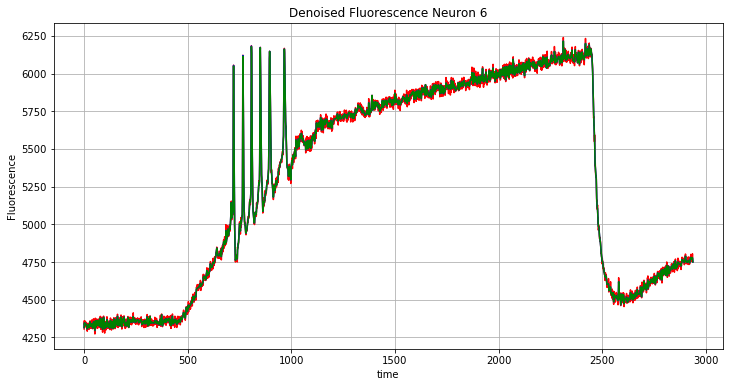

In [44]:
fig, ax = plt.subplots(figsize=(12, 6))
ax.plot(np.arange(T), signal, 'r')
ax.plot(np.arange(T), x, 'b')
ax.plot(np.arange(T), x1, 'g')

ax.set(xlabel='time', ylabel='Fluorescence',
       title='Denoised Fluorescence Neuron {}'.format(idx))
ax.grid()

plt.show()

In [197]:
x, y, results = pd.lagrangian_l1tf(signal,
                                   lam=500,
                                   warm_start=warm_start[0], theta=1)

||Iter:1||Obj: 3.230e+03||Dual:-6.844e+06||Gap: 6.847e+06||Delta Obj:       inf||Delta x: 7.076e-04||Delta y: 4.784e+01||CPU: 1.634e-03||
||Iter:2||Obj: 3.073e+03||Dual:-3.325e+06||Gap: 3.329e+06||Delta Obj:       inf||Delta x: 7.076e-04||Delta y: 3.647e+02||CPU: 3.411e-03||
||Iter:3||Obj: 3.028e+03||Dual:-7.498e+05||Gap: 7.528e+05||Delta Obj:       inf||Delta x: 7.076e-04||Delta y: 2.909e+04||CPU: 5.502e-03||
||Iter:4||Obj: 3.012e+03||Dual:-2.937e+05||Gap: 2.967e+05||Delta Obj:       inf||Delta x: 7.076e-04||Delta y: 2.909e+04||CPU: 7.027e-03||
||Iter:5||Obj: 3.005e+03||Dual:-1.585e+05||Gap: 1.615e+05||Delta Obj: 6.988e-02||Delta x: 7.076e-04||Delta y: 2.909e+04||CPU: 8.955e-03||
||Iter:6||Obj: 3.001e+03||Dual:-1.021e+05||Gap: 1.051e+05||Delta Obj: 2.320e-02||Delta x: 4.994e-04||Delta y: 2.909e+04||CPU: 1.065e-02||
||Iter:7||Obj: 2.999e+03||Dual:-6.896e+04||Gap: 7.196e+04||Delta Obj: 9.716e-03||Delta x: 2.318e-04||Delta y: 2.909e+04||CPU: 1.252e-02||
||Iter:8||Obj: 2.997e+03||Dual:-5.

||Iter:61||Obj: 2.983e+03||Dual: 1.111e+03||Gap: 1.872e+03||Delta Obj: 7.380e-05||Delta x: 1.431e-05||Delta y: 1.876e+02||CPU: 1.333e-01||
||Iter:62||Obj: 2.983e+03||Dual: 1.167e+03||Gap: 1.815e+03||Delta Obj: 7.396e-05||Delta x: 1.407e-05||Delta y: 1.400e+02||CPU: 1.358e-01||
||Iter:63||Obj: 2.983e+03||Dual: 1.217e+03||Gap: 1.766e+03||Delta Obj: 7.345e-05||Delta x: 1.384e-05||Delta y: 3.598e+02||CPU: 1.377e-01||
||Iter:64||Obj: 2.983e+03||Dual: 1.261e+03||Gap: 1.721e+03||Delta Obj: 7.489e-05||Delta x: 1.364e-05||Delta y: 3.598e+02||CPU: 1.396e-01||
||Iter:65||Obj: 2.983e+03||Dual: 1.312e+03||Gap: 1.671e+03||Delta Obj: 7.585e-05||Delta x: 1.346e-05||Delta y: 3.598e+02||CPU: 1.414e-01||
||Iter:66||Obj: 2.983e+03||Dual: 1.376e+03||Gap: 1.607e+03||Delta Obj: 7.428e-05||Delta x: 1.331e-05||Delta y: 3.598e+02||CPU: 1.431e-01||
||Iter:67||Obj: 2.982e+03||Dual: 1.445e+03||Gap: 1.538e+03||Delta Obj: 7.470e-05||Delta x: 1.318e-05||Delta y: 3.598e+02||CPU: 1.445e-01||
||Iter:68||Obj: 2.982e+03||

/Users/ikinsella/devel/voltagedenoising/primal_dual.py:111: RuntimeWarning: divide by zero encountered in true_divide
  delta_obj = np.max(np.abs((obj[itr % buff] - obj) / obj))


||Iter:94||Obj: 2.981e+03||Dual: 2.153e+03||Gap: 8.279e+02||Delta Obj: 6.970e-05||Delta x: 1.051e-05||Delta y: 8.535e+01||CPU: 2.025e-01||
||Iter:95||Obj: 2.981e+03||Dual: 2.170e+03||Gap: 8.112e+02||Delta Obj: 6.631e-05||Delta x: 1.044e-05||Delta y: 3.697e+01||CPU: 2.047e-01||
||Iter:96||Obj: 2.981e+03||Dual: 2.189e+03||Gap: 7.920e+02||Delta Obj: 6.064e-05||Delta x: 1.037e-05||Delta y: 3.181e+01||CPU: 2.074e-01||
||Iter:97||Obj: 2.981e+03||Dual: 2.210e+03||Gap: 7.708e+02||Delta Obj: 4.882e-05||Delta x: 1.029e-05||Delta y: 3.181e+01||CPU: 2.098e-01||
||Iter:98||Obj: 2.981e+03||Dual: 2.230e+03||Gap: 7.505e+02||Delta Obj: 4.318e-05||Delta x: 1.019e-05||Delta y: 3.204e+01||CPU: 2.119e-01||
||Iter:99||Obj: 2.981e+03||Dual: 2.247e+03||Gap: 7.335e+02||Delta Obj: 4.292e-05||Delta x: 1.009e-05||Delta y: 3.204e+01||CPU: 2.141e-01||
||Iter:100||Obj: 2.981e+03||Dual: 2.261e+03||Gap: 7.194e+02||Delta Obj: 4.546e-05||Delta x: 9.969e-06||Delta y: 3.374e+01||CPU: 2.172e-01||
||Iter:101||Obj: 2.981e+03

||Iter:153||Obj: 2.979e+03||Dual: 2.728e+03||Gap: 2.511e+02||Delta Obj: 3.968e-05||Delta x: 7.596e-06||Delta y: 2.208e+01||CPU: 3.361e-01||
||Iter:154||Obj: 2.979e+03||Dual: 2.730e+03||Gap: 2.490e+02||Delta Obj: 4.207e-05||Delta x: 7.570e-06||Delta y: 1.160e+02||CPU: 3.377e-01||
||Iter:155||Obj: 2.979e+03||Dual: 2.732e+03||Gap: 2.470e+02||Delta Obj: 4.631e-05||Delta x: 7.538e-06||Delta y: 2.335e+02||CPU: 3.398e-01||
||Iter:156||Obj: 2.979e+03||Dual: 2.734e+03||Gap: 2.449e+02||Delta Obj: 4.964e-05||Delta x: 7.508e-06||Delta y: 2.335e+02||CPU: 3.418e-01||
||Iter:157||Obj: 2.979e+03||Dual: 2.735e+03||Gap: 2.433e+02||Delta Obj: 5.138e-05||Delta x: 7.485e-06||Delta y: 2.335e+02||CPU: 3.437e-01||
||Iter:158||Obj: 2.979e+03||Dual: 2.737e+03||Gap: 2.415e+02||Delta Obj: 5.244e-05||Delta x: 7.465e-06||Delta y: 2.335e+02||CPU: 3.454e-01||
||Iter:159||Obj: 2.979e+03||Dual: 2.738e+03||Gap: 2.403e+02||Delta Obj: 5.417e-05||Delta x: 7.449e-06||Delta y: 2.335e+02||CPU: 3.482e-01||
||Iter:160||Obj: 2.9

||Iter:212||Obj: 2.977e+03||Dual: 2.884e+03||Gap: 9.345e+01||Delta Obj: 3.292e-05||Delta x: 6.674e-06||Delta y: 1.122e+02||CPU: 4.730e-01||
||Iter:213||Obj: 2.977e+03||Dual: 2.886e+03||Gap: 9.130e+01||Delta Obj: 3.358e-05||Delta x: 6.657e-06||Delta y: 1.122e+02||CPU: 4.763e-01||
||Iter:214||Obj: 2.977e+03||Dual: 2.888e+03||Gap: 8.933e+01||Delta Obj: 3.454e-05||Delta x: 6.637e-06||Delta y: 2.370e+01||CPU: 4.792e-01||
||Iter:215||Obj: 2.977e+03||Dual: 2.890e+03||Gap: 8.728e+01||Delta Obj: 3.418e-05||Delta x: 6.617e-06||Delta y: 2.370e+01||CPU: 4.813e-01||
||Iter:216||Obj: 2.977e+03||Dual: 2.892e+03||Gap: 8.517e+01||Delta Obj: 3.264e-05||Delta x: 6.602e-06||Delta y: 2.370e+01||CPU: 4.837e-01||
||Iter:217||Obj: 2.977e+03||Dual: 2.894e+03||Gap: 8.331e+01||Delta Obj: 3.216e-05||Delta x: 6.589e-06||Delta y: 1.047e+02||CPU: 4.856e-01||
||Iter:218||Obj: 2.977e+03||Dual: 2.896e+03||Gap: 8.148e+01||Delta Obj: 3.259e-05||Delta x: 6.576e-06||Delta y: 1.047e+02||CPU: 4.878e-01||
||Iter:219||Obj: 2.9

||Iter:271||Obj: 2.976e+03||Dual: 2.953e+03||Gap: 2.317e+01||Delta Obj: 3.431e-05||Delta x: 6.251e-06||Delta y: 2.341e+03||CPU: 6.024e-01||
||Iter:272||Obj: 2.976e+03||Dual: 2.952e+03||Gap: 2.330e+01||Delta Obj: 3.463e-05||Delta x: 6.246e-06||Delta y: 2.341e+03||CPU: 6.047e-01||
||Iter:273||Obj: 2.976e+03||Dual: 2.952e+03||Gap: 2.372e+01||Delta Obj: 3.443e-05||Delta x: 6.242e-06||Delta y: 2.289e+01||CPU: 6.067e-01||
||Iter:274||Obj: 2.976e+03||Dual: 2.951e+03||Gap: 2.440e+01||Delta Obj: 3.492e-05||Delta x: 6.238e-06||Delta y: 2.289e+01||CPU: 6.084e-01||
||Iter:275||Obj: 2.976e+03||Dual: 2.950e+03||Gap: 2.539e+01||Delta Obj: 3.530e-05||Delta x: 6.235e-06||Delta y: 2.289e+01||CPU: 6.100e-01||
||Iter:276||Obj: 2.976e+03||Dual: 2.949e+03||Gap: 2.620e+01||Delta Obj: 3.525e-05||Delta x: 6.230e-06||Delta y: 2.289e+01||CPU: 6.127e-01||
||Iter:277||Obj: 2.976e+03||Dual: 2.949e+03||Gap: 2.691e+01||Delta Obj: 3.551e-05||Delta x: 6.227e-06||Delta y: 2.345e+01||CPU: 6.150e-01||
||Iter:278||Obj: 2.9

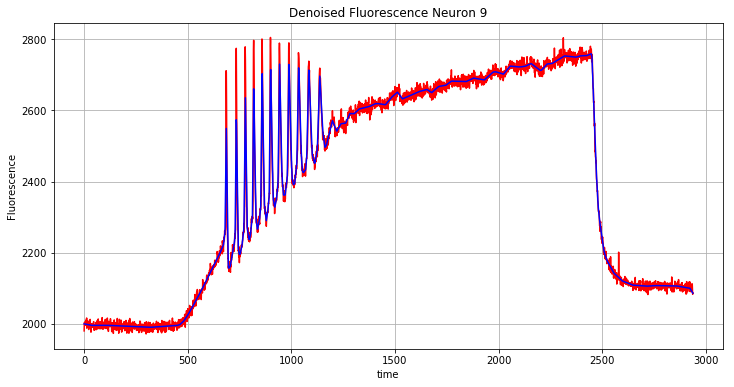

In [159]:
fig, ax = plt.subplots(figsize=(12, 6))
ax.plot(np.arange(T), signal, 'r')
ax.plot(np.arange(T), x, 'b')

ax.set(xlabel='time', ylabel='Fluorescence',
       title='Denoised Fluorescence Neuron {}'.format(idx))
ax.grid()

plt.show()

In [193]:
x, y, results = pd.lagrangian_l1tf(signal, 
                                   lam=500, 
                                   warm_start=warm_start, theta=1)

||Iter:1||Obj: 2.835e+03||Dual: 2.641e+03||Gap: 1.943e+02||Delta Obj:       inf||Delta x: 6.805e-06||Delta y: 6.416e+00||CPU: 1.567e-03||
||Iter:2||Obj: 2.834e+03||Dual: 2.887e+03||Gap:-5.247e+01||Delta Obj:       inf||Delta x: 6.805e-06||Delta y: 3.023e+01||CPU: 3.932e-03||
||Iter:3||Obj: 2.834e+03||Dual: 3.154e+03||Gap:-3.198e+02||Delta Obj:       inf||Delta x: 6.805e-06||Delta y: 3.023e+01||CPU: 6.094e-03||
||Iter:4||Obj: 2.834e+03||Dual: 3.193e+03||Gap:-3.587e+02||Delta Obj:       inf||Delta x: 6.805e-06||Delta y: 3.023e+01||CPU: 8.206e-03||
||Iter:5||Obj: 2.834e+03||Dual: 3.194e+03||Gap:-3.600e+02||Delta Obj: 3.385e-04||Delta x: 6.805e-06||Delta y: 3.023e+01||CPU: 1.062e-02||
||Iter:6||Obj: 2.834e+03||Dual: 3.198e+03||Gap:-3.635e+02||Delta Obj: 3.984e-05||Delta x: 5.530e-06||Delta y: 3.023e+01||CPU: 1.335e-02||
||Iter:7||Obj: 2.834e+03||Dual: 3.201e+03||Gap:-3.671e+02||Delta Obj: 2.558e-05||Delta x: 3.663e-06||Delta y: 2.147e+01||CPU: 1.744e-02||
||Iter:8||Obj: 2.834e+03||Dual: 3.

/Users/ikinsella/devel/voltagedenoising/primal_dual.py:111: RuntimeWarning: divide by zero encountered in true_divide
  delta_obj = np.max(np.abs((obj[itr % buff] - obj) / obj))


In [132]:
x, y, results = pd.lagrangian_l1tf(signal, lam=750, warm_start=warm_start, maxiter=1e5)

||Iter:1||Obj: 2.687e+03||Dual: 1.690e+03||Gap: 9.965e+02||Delta Obj:       inf||Delta x: 8.085e-06||Delta y: 1.364e+01||CPU: 1.289e-03||
||Iter:2||Obj: 2.687e+03||Dual: 1.467e+03||Gap: 1.219e+03||Delta Obj:       inf||Delta x: 8.640e-06||Delta y: 4.390e+01||CPU: 3.637e-03||
||Iter:3||Obj: 2.687e+03||Dual: 2.043e+03||Gap: 6.440e+02||Delta Obj:       inf||Delta x: 8.640e-06||Delta y: 4.390e+01||CPU: 5.086e-03||
||Iter:4||Obj: 2.687e+03||Dual: 1.982e+03||Gap: 7.047e+02||Delta Obj:       inf||Delta x: 8.640e-06||Delta y: 4.390e+01||CPU: 7.385e-03||
||Iter:5||Obj: 2.687e+03||Dual: 1.467e+03||Gap: 1.220e+03||Delta Obj: 4.838e-05||Delta x: 8.640e-06||Delta y: 4.390e+01||CPU: 9.137e-03||
||Iter:6||Obj: 2.687e+03||Dual: 1.780e+03||Gap: 9.073e+02||Delta Obj: 3.527e-05||Delta x: 8.640e-06||Delta y: 4.390e+01||CPU: 1.115e-02||
||Iter:7||Obj: 2.687e+03||Dual: 2.092e+03||Gap: 5.943e+02||Delta Obj: 3.058e-05||Delta x: 8.611e-06||Delta y: 1.208e+01||CPU: 1.303e-02||
||Iter:8||Obj: 2.687e+03||Dual: 1.

||Iter:61||Obj: 2.686e+03||Dual: 1.543e+03||Gap: 1.143e+03||Delta Obj: 3.067e-05||Delta x: 8.278e-06||Delta y: 4.944e+01||CPU: 1.185e-01||
||Iter:62||Obj: 2.686e+03||Dual: 1.716e+03||Gap: 9.696e+02||Delta Obj: 2.277e-05||Delta x: 8.278e-06||Delta y: 4.944e+01||CPU: 1.215e-01||
||Iter:63||Obj: 2.686e+03||Dual: 1.919e+03||Gap: 7.668e+02||Delta Obj: 1.693e-05||Delta x: 8.278e-06||Delta y: 4.944e+01||CPU: 1.241e-01||
||Iter:64||Obj: 2.686e+03||Dual: 1.637e+03||Gap: 1.049e+03||Delta Obj: 2.194e-05||Delta x: 8.278e-06||Delta y: 3.709e+01||CPU: 1.267e-01||
||Iter:65||Obj: 2.686e+03||Dual: 1.626e+03||Gap: 1.060e+03||Delta Obj: 1.364e-05||Delta x: 8.278e-06||Delta y: 3.709e+01||CPU: 1.297e-01||
||Iter:66||Obj: 2.686e+03||Dual: 1.994e+03||Gap: 6.921e+02||Delta Obj: 1.922e-05||Delta x: 8.094e-06||Delta y: 5.871e+00||CPU: 1.324e-01||
||Iter:67||Obj: 2.686e+03||Dual: 1.819e+03||Gap: 8.672e+02||Delta Obj: 3.706e-05||Delta x: 8.094e-06||Delta y: 2.176e+01||CPU: 1.347e-01||
||Iter:68||Obj: 2.686e+03||

/Users/ikinsella/devel/voltagedenoising/primal_dual.py:111: RuntimeWarning: divide by zero encountered in true_divide
  # Evaluate Progress


||Iter:98||Obj: 2.685e+03||Dual: 1.795e+03||Gap: 8.904e+02||Delta Obj: 4.028e-05||Delta x: 8.165e-06||Delta y: 3.660e+02||CPU: 2.027e-01||
||Iter:99||Obj: 2.685e+03||Dual: 1.756e+03||Gap: 9.289e+02||Delta Obj: 3.002e-05||Delta x: 8.165e-06||Delta y: 3.660e+02||CPU: 2.050e-01||
||Iter:100||Obj: 2.685e+03||Dual: 1.913e+03||Gap: 7.727e+02||Delta Obj: 4.734e-05||Delta x: 7.924e-06||Delta y: 3.660e+02||CPU: 2.081e-01||
||Iter:101||Obj: 2.685e+03||Dual: 1.819e+03||Gap: 8.666e+02||Delta Obj: 5.568e-05||Delta x: 7.924e-06||Delta y: 3.660e+02||CPU: 2.102e-01||
||Iter:102||Obj: 2.685e+03||Dual: 1.717e+03||Gap: 9.679e+02||Delta Obj: 4.416e-05||Delta x: 7.995e-06||Delta y: 6.638e+01||CPU: 2.119e-01||
||Iter:103||Obj: 2.685e+03||Dual: 1.803e+03||Gap: 8.824e+02||Delta Obj: 4.888e-05||Delta x: 7.995e-06||Delta y: 6.638e+01||CPU: 2.139e-01||
||Iter:104||Obj: 2.685e+03||Dual: 1.869e+03||Gap: 8.163e+02||Delta Obj: 4.754e-05||Delta x: 7.995e-06||Delta y: 6.638e+01||CPU: 2.158e-01||
||Iter:105||Obj: 2.685

||Iter:215||Obj: 2.684e+03||Dual: 2.056e+03||Gap: 6.280e+02||Delta Obj: 3.337e-05||Delta x: 8.502e-06||Delta y: 7.761e+02||CPU: 4.835e-01||
||Iter:216||Obj: 2.683e+03||Dual: 2.024e+03||Gap: 6.590e+02||Delta Obj: 5.077e-05||Delta x: 8.502e-06||Delta y: 7.761e+02||CPU: 4.849e-01||
||Iter:217||Obj: 2.683e+03||Dual: 1.553e+03||Gap: 1.131e+03||Delta Obj: 4.465e-05||Delta x: 8.502e-06||Delta y: 1.332e+02||CPU: 4.877e-01||
||Iter:218||Obj: 2.683e+03||Dual: 1.787e+03||Gap: 8.965e+02||Delta Obj: 3.982e-05||Delta x: 8.502e-06||Delta y: 1.332e+02||CPU: 4.900e-01||
||Iter:219||Obj: 2.683e+03||Dual: 2.086e+03||Gap: 5.976e+02||Delta Obj: 2.561e-05||Delta x: 8.449e-06||Delta y: 1.332e+02||CPU: 4.932e-01||
||Iter:220||Obj: 2.683e+03||Dual: 1.771e+03||Gap: 9.120e+02||Delta Obj: 3.997e-05||Delta x: 8.449e-06||Delta y: 1.332e+02||CPU: 4.953e-01||
||Iter:221||Obj: 2.683e+03||Dual: 1.700e+03||Gap: 9.832e+02||Delta Obj: 2.394e-05||Delta x: 8.449e-06||Delta y: 1.332e+02||CPU: 4.975e-01||
||Iter:222||Obj: 2.6

||Iter:274||Obj: 2.683e+03||Dual: 1.817e+03||Gap: 8.654e+02||Delta Obj: 5.837e-05||Delta x: 8.253e-06||Delta y: 2.007e+02||CPU: 6.203e-01||
||Iter:275||Obj: 2.683e+03||Dual: 2.037e+03||Gap: 6.455e+02||Delta Obj: 2.992e-05||Delta x: 8.253e-06||Delta y: 2.007e+02||CPU: 6.234e-01||
||Iter:276||Obj: 2.683e+03||Dual: 1.747e+03||Gap: 9.360e+02||Delta Obj: 2.082e-05||Delta x: 8.253e-06||Delta y: 2.007e+02||CPU: 6.265e-01||
||Iter:277||Obj: 2.682e+03||Dual: 1.649e+03||Gap: 1.034e+03||Delta Obj: 2.736e-05||Delta x: 8.253e-06||Delta y: 1.077e+02||CPU: 6.287e-01||
||Iter:278||Obj: 2.682e+03||Dual: 1.974e+03||Gap: 7.089e+02||Delta Obj: 1.872e-05||Delta x: 8.016e-06||Delta y: 2.245e+02||CPU: 6.307e-01||
||Iter:279||Obj: 2.682e+03||Dual: 1.926e+03||Gap: 7.560e+02||Delta Obj: 1.826e-05||Delta x: 8.016e-06||Delta y: 2.245e+02||CPU: 6.327e-01||
||Iter:280||Obj: 2.682e+03||Dual: 1.597e+03||Gap: 1.085e+03||Delta Obj: 3.847e-05||Delta x: 8.190e-06||Delta y: 2.245e+02||CPU: 6.346e-01||
||Iter:281||Obj: 2.6

||Iter:333||Obj: 2.682e+03||Dual: 1.678e+03||Gap: 1.004e+03||Delta Obj: 4.055e-05||Delta x: 8.606e-06||Delta y: 9.455e+01||CPU: 7.495e-01||
||Iter:334||Obj: 2.682e+03||Dual: 2.156e+03||Gap: 5.261e+02||Delta Obj: 5.761e-05||Delta x: 8.208e-06||Delta y: 1.921e+01||CPU: 7.517e-01||
||Iter:335||Obj: 2.682e+03||Dual: 1.770e+03||Gap: 9.115e+02||Delta Obj: 8.019e-05||Delta x: 8.208e-06||Delta y: 1.921e+01||CPU: 7.537e-01||
||Iter:336||Obj: 2.682e+03||Dual: 1.527e+03||Gap: 1.155e+03||Delta Obj: 4.145e-05||Delta x: 8.386e-06||Delta y: 1.921e+01||CPU: 7.557e-01||
||Iter:337||Obj: 2.682e+03||Dual: 2.082e+03||Gap: 6.000e+02||Delta Obj: 3.735e-05||Delta x: 8.386e-06||Delta y: 1.921e+01||CPU: 7.580e-01||
||Iter:338||Obj: 2.682e+03||Dual: 2.011e+03||Gap: 6.706e+02||Delta Obj: 5.876e-05||Delta x: 8.386e-06||Delta y: 1.628e+01||CPU: 7.599e-01||
||Iter:339||Obj: 2.681e+03||Dual: 1.441e+03||Gap: 1.240e+03||Delta Obj: 5.516e-05||Delta x: 8.563e-06||Delta y: 7.813e+01||CPU: 7.616e-01||
||Iter:340||Obj: 2.6

||Iter:450||Obj: 2.680e+03||Dual: 1.820e+03||Gap: 8.595e+02||Delta Obj: 1.812e-05||Delta x: 7.910e-06||Delta y: 2.013e+01||CPU: 1.003e+00||
||Iter:451||Obj: 2.680e+03||Dual: 1.509e+03||Gap: 1.171e+03||Delta Obj: 2.654e-05||Delta x: 8.320e-06||Delta y: 2.013e+01||CPU: 1.006e+00||
||Iter:452||Obj: 2.680e+03||Dual: 1.861e+03||Gap: 8.184e+02||Delta Obj: 2.667e-05||Delta x: 8.320e-06||Delta y: 2.013e+01||CPU: 1.008e+00||
||Iter:453||Obj: 2.680e+03||Dual: 2.075e+03||Gap: 6.047e+02||Delta Obj: 4.259e-05||Delta x: 8.320e-06||Delta y: 2.013e+01||CPU: 1.010e+00||
||Iter:454||Obj: 2.680e+03||Dual: 1.611e+03||Gap: 1.069e+03||Delta Obj: 5.483e-05||Delta x: 8.320e-06||Delta y: 2.013e+01||CPU: 1.012e+00||
||Iter:455||Obj: 2.680e+03||Dual: 1.630e+03||Gap: 1.049e+03||Delta Obj: 5.593e-05||Delta x: 8.320e-06||Delta y: 1.552e+01||CPU: 1.014e+00||
||Iter:456||Obj: 2.680e+03||Dual: 2.083e+03||Gap: 5.969e+02||Delta Obj: 3.385e-05||Delta x: 8.064e-06||Delta y: 1.552e+01||CPU: 1.016e+00||
||Iter:457||Obj: 2.6

||Iter:509||Obj: 2.679e+03||Dual: 1.807e+03||Gap: 8.722e+02||Delta Obj: 3.638e-05||Delta x: 8.129e-06||Delta y: 3.579e+01||CPU: 1.132e+00||
||Iter:510||Obj: 2.679e+03||Dual: 1.721e+03||Gap: 9.581e+02||Delta Obj: 2.142e-05||Delta x: 8.129e-06||Delta y: 3.579e+01||CPU: 1.135e+00||
||Iter:511||Obj: 2.679e+03||Dual: 1.971e+03||Gap: 7.080e+02||Delta Obj: 2.775e-05||Delta x: 7.975e-06||Delta y: 3.579e+01||CPU: 1.136e+00||
||Iter:512||Obj: 2.679e+03||Dual: 1.907e+03||Gap: 7.718e+02||Delta Obj: 4.982e-05||Delta x: 7.975e-06||Delta y: 7.600e+01||CPU: 1.139e+00||
||Iter:513||Obj: 2.679e+03||Dual: 1.710e+03||Gap: 9.687e+02||Delta Obj: 3.619e-05||Delta x: 7.997e-06||Delta y: 7.600e+01||CPU: 1.141e+00||
||Iter:514||Obj: 2.679e+03||Dual: 1.896e+03||Gap: 7.829e+02||Delta Obj: 3.348e-05||Delta x: 7.997e-06||Delta y: 7.600e+01||CPU: 1.143e+00||
||Iter:515||Obj: 2.679e+03||Dual: 2.040e+03||Gap: 6.385e+02||Delta Obj: 3.937e-05||Delta x: 7.997e-06||Delta y: 7.600e+01||CPU: 1.145e+00||
||Iter:516||Obj: 2.6

||Iter:568||Obj: 2.678e+03||Dual: 1.859e+03||Gap: 8.195e+02||Delta Obj: 1.663e-05||Delta x: 7.784e-06||Delta y: 1.392e+01||CPU: 1.266e+00||
||Iter:569||Obj: 2.678e+03||Dual: 1.776e+03||Gap: 9.021e+02||Delta Obj: 3.434e-05||Delta x: 7.784e-06||Delta y: 1.392e+01||CPU: 1.268e+00||
||Iter:570||Obj: 2.678e+03||Dual: 1.827e+03||Gap: 8.512e+02||Delta Obj: 3.249e-05||Delta x: 7.773e-06||Delta y: 9.253e+00||CPU: 1.270e+00||
||Iter:571||Obj: 2.678e+03||Dual: 1.916e+03||Gap: 7.624e+02||Delta Obj: 2.153e-05||Delta x: 7.688e-06||Delta y: 2.980e+01||CPU: 1.272e+00||
||Iter:572||Obj: 2.678e+03||Dual: 1.761e+03||Gap: 9.168e+02||Delta Obj: 4.005e-05||Delta x: 7.757e-06||Delta y: 2.980e+01||CPU: 1.274e+00||
||Iter:573||Obj: 2.678e+03||Dual: 1.679e+03||Gap: 9.994e+02||Delta Obj: 2.520e-05||Delta x: 8.000e-06||Delta y: 4.460e+01||CPU: 1.276e+00||
||Iter:574||Obj: 2.678e+03||Dual: 1.909e+03||Gap: 7.692e+02||Delta Obj: 3.744e-05||Delta x: 8.000e-06||Delta y: 4.460e+01||CPU: 1.278e+00||
||Iter:575||Obj: 2.6

||Iter:627||Obj: 2.677e+03||Dual: 1.881e+03||Gap: 7.962e+02||Delta Obj: 8.418e-05||Delta x: 8.111e-06||Delta y: 4.920e+01||CPU: 1.403e+00||
||Iter:628||Obj: 2.677e+03||Dual: 1.517e+03||Gap: 1.160e+03||Delta Obj: 4.772e-05||Delta x: 8.443e-06||Delta y: 4.920e+01||CPU: 1.406e+00||
||Iter:629||Obj: 2.677e+03||Dual: 1.901e+03||Gap: 7.758e+02||Delta Obj: 4.060e-05||Delta x: 8.443e-06||Delta y: 4.920e+01||CPU: 1.409e+00||
||Iter:630||Obj: 2.677e+03||Dual: 2.032e+03||Gap: 6.446e+02||Delta Obj: 7.445e-05||Delta x: 8.443e-06||Delta y: 3.075e+01||CPU: 1.412e+00||
||Iter:631||Obj: 2.677e+03||Dual: 1.662e+03||Gap: 1.015e+03||Delta Obj: 4.882e-05||Delta x: 8.443e-06||Delta y: 3.075e+01||CPU: 1.414e+00||
||Iter:632||Obj: 2.677e+03||Dual: 1.787e+03||Gap: 8.904e+02||Delta Obj: 3.364e-05||Delta x: 8.443e-06||Delta y: 8.447e+01||CPU: 1.416e+00||
||Iter:633||Obj: 2.677e+03||Dual: 2.016e+03||Gap: 6.609e+02||Delta Obj: 6.078e-05||Delta x: 8.015e-06||Delta y: 8.447e+01||CPU: 1.418e+00||
||Iter:634||Obj: 2.6

||Iter:686||Obj: 2.676e+03||Dual: 1.866e+03||Gap: 8.104e+02||Delta Obj: 3.409e-05||Delta x: 8.037e-06||Delta y: 4.404e+01||CPU: 1.532e+00||
||Iter:687||Obj: 2.676e+03||Dual: 1.661e+03||Gap: 1.015e+03||Delta Obj: 4.105e-05||Delta x: 8.105e-06||Delta y: 4.404e+01||CPU: 1.534e+00||
||Iter:688||Obj: 2.676e+03||Dual: 1.905e+03||Gap: 7.717e+02||Delta Obj: 3.627e-05||Delta x: 8.105e-06||Delta y: 2.239e+01||CPU: 1.537e+00||
||Iter:689||Obj: 2.676e+03||Dual: 1.969e+03||Gap: 7.068e+02||Delta Obj: 6.569e-05||Delta x: 8.105e-06||Delta y: 2.144e+01||CPU: 1.539e+00||
||Iter:690||Obj: 2.676e+03||Dual: 1.777e+03||Gap: 8.996e+02||Delta Obj: 5.047e-05||Delta x: 8.105e-06||Delta y: 2.144e+01||CPU: 1.542e+00||
||Iter:691||Obj: 2.676e+03||Dual: 1.855e+03||Gap: 8.210e+02||Delta Obj: 2.895e-05||Delta x: 8.105e-06||Delta y: 1.945e+01||CPU: 1.545e+00||
||Iter:692||Obj: 2.676e+03||Dual: 2.035e+03||Gap: 6.414e+02||Delta Obj: 5.307e-05||Delta x: 7.833e-06||Delta y: 7.970e+01||CPU: 1.547e+00||
||Iter:693||Obj: 2.6

||Iter:745||Obj: 2.675e+03||Dual: 2.042e+03||Gap: 6.334e+02||Delta Obj: 3.280e-05||Delta x: 8.319e-06||Delta y: 1.466e+02||CPU: 1.659e+00||
||Iter:746||Obj: 2.675e+03||Dual: 1.622e+03||Gap: 1.054e+03||Delta Obj: 4.387e-05||Delta x: 8.319e-06||Delta y: 1.466e+02||CPU: 1.661e+00||
||Iter:747||Obj: 2.675e+03||Dual: 1.727e+03||Gap: 9.485e+02||Delta Obj: 2.717e-05||Delta x: 8.319e-06||Delta y: 1.466e+02||CPU: 1.664e+00||
||Iter:748||Obj: 2.675e+03||Dual: 2.146e+03||Gap: 5.289e+02||Delta Obj: 3.459e-05||Delta x: 8.083e-06||Delta y: 1.466e+02||CPU: 1.665e+00||
||Iter:749||Obj: 2.675e+03||Dual: 1.786e+03||Gap: 8.888e+02||Delta Obj: 4.836e-05||Delta x: 8.083e-06||Delta y: 1.099e+01||CPU: 1.668e+00||
||Iter:750||Obj: 2.675e+03||Dual: 1.502e+03||Gap: 1.173e+03||Delta Obj: 4.123e-05||Delta x: 8.391e-06||Delta y: 1.321e+01||CPU: 1.670e+00||
||Iter:751||Obj: 2.675e+03||Dual: 1.995e+03||Gap: 6.802e+02||Delta Obj: 2.393e-05||Delta x: 8.391e-06||Delta y: 1.321e+01||CPU: 1.671e+00||
||Iter:752||Obj: 2.6

||Iter:804||Obj: 2.674e+03||Dual: 2.152e+03||Gap: 5.227e+02||Delta Obj: 4.597e-05||Delta x: 8.369e-06||Delta y: 6.886e+01||CPU: 1.787e+00||
||Iter:805||Obj: 2.674e+03||Dual: 1.663e+03||Gap: 1.012e+03||Delta Obj: 4.873e-05||Delta x: 8.369e-06||Delta y: 6.886e+01||CPU: 1.790e+00||
||Iter:806||Obj: 2.675e+03||Dual: 1.750e+03||Gap: 9.245e+02||Delta Obj: 5.356e-05||Delta x: 8.369e-06||Delta y: 6.886e+01||CPU: 1.793e+00||
||Iter:807||Obj: 2.675e+03||Dual: 2.158e+03||Gap: 5.169e+02||Delta Obj: 3.540e-05||Delta x: 8.098e-06||Delta y: 6.886e+01||CPU: 1.795e+00||
||Iter:808||Obj: 2.674e+03||Dual: 1.871e+03||Gap: 8.035e+02||Delta Obj: 5.326e-05||Delta x: 8.098e-06||Delta y: 2.627e+01||CPU: 1.797e+00||
||Iter:809||Obj: 2.674e+03||Dual: 1.663e+03||Gap: 1.012e+03||Delta Obj: 3.930e-05||Delta x: 8.099e-06||Delta y: 2.627e+01||CPU: 1.800e+00||
||Iter:810||Obj: 2.674e+03||Dual: 2.011e+03||Gap: 6.633e+02||Delta Obj: 4.365e-05||Delta x: 8.099e-06||Delta y: 2.749e+01||CPU: 1.802e+00||
||Iter:811||Obj: 2.6

||Iter:863||Obj: 2.674e+03||Dual: 2.023e+03||Gap: 6.506e+02||Delta Obj: 5.021e-05||Delta x: 7.968e-06||Delta y: 1.992e+01||CPU: 1.931e+00||
||Iter:864||Obj: 2.674e+03||Dual: 1.910e+03||Gap: 7.636e+02||Delta Obj: 3.015e-05||Delta x: 7.968e-06||Delta y: 1.992e+01||CPU: 1.935e+00||
||Iter:865||Obj: 2.673e+03||Dual: 1.521e+03||Gap: 1.152e+03||Delta Obj: 6.557e-05||Delta x: 8.306e-06||Delta y: 1.992e+01||CPU: 1.936e+00||
||Iter:866||Obj: 2.674e+03||Dual: 1.835e+03||Gap: 8.387e+02||Delta Obj: 5.535e-05||Delta x: 8.306e-06||Delta y: 1.992e+01||CPU: 1.939e+00||
||Iter:867||Obj: 2.674e+03||Dual: 2.070e+03||Gap: 6.037e+02||Delta Obj: 4.274e-05||Delta x: 8.306e-06||Delta y: 1.992e+01||CPU: 1.941e+00||
||Iter:868||Obj: 2.673e+03||Dual: 1.623e+03||Gap: 1.051e+03||Delta Obj: 6.870e-05||Delta x: 8.306e-06||Delta y: 1.920e+01||CPU: 1.943e+00||
||Iter:869||Obj: 2.674e+03||Dual: 1.706e+03||Gap: 9.678e+02||Delta Obj: 4.569e-05||Delta x: 8.306e-06||Delta y: 1.920e+01||CPU: 1.946e+00||
||Iter:870||Obj: 2.6

||Iter:922||Obj: 2.673e+03||Dual: 2.076e+03||Gap: 5.965e+02||Delta Obj: 5.249e-05||Delta x: 8.003e-06||Delta y: 1.491e+02||CPU: 2.077e+00||
||Iter:923||Obj: 2.673e+03||Dual: 1.872e+03||Gap: 8.007e+02||Delta Obj: 6.593e-05||Delta x: 8.003e-06||Delta y: 3.723e+01||CPU: 2.080e+00||
||Iter:924||Obj: 2.673e+03||Dual: 1.582e+03||Gap: 1.091e+03||Delta Obj: 3.473e-05||Delta x: 8.252e-06||Delta y: 3.723e+01||CPU: 2.082e+00||
||Iter:925||Obj: 2.673e+03||Dual: 1.985e+03||Gap: 6.878e+02||Delta Obj: 2.211e-05||Delta x: 8.252e-06||Delta y: 3.723e+01||CPU: 2.084e+00||
||Iter:926||Obj: 2.673e+03||Dual: 2.073e+03||Gap: 6.000e+02||Delta Obj: 1.862e-05||Delta x: 8.252e-06||Delta y: 2.837e+01||CPU: 2.086e+00||
||Iter:927||Obj: 2.673e+03||Dual: 1.600e+03||Gap: 1.073e+03||Delta Obj: 3.324e-05||Delta x: 8.252e-06||Delta y: 2.837e+01||CPU: 2.088e+00||
||Iter:928||Obj: 2.673e+03||Dual: 1.716e+03||Gap: 9.565e+02||Delta Obj: 1.867e-05||Delta x: 8.252e-06||Delta y: 2.035e+01||CPU: 2.092e+00||
||Iter:929||Obj: 2.6

||Iter:981||Obj: 2.672e+03||Dual: 1.921e+03||Gap: 7.506e+02||Delta Obj: 4.398e-05||Delta x: 7.572e-06||Delta y: 1.159e+02||CPU: 2.209e+00||
||Iter:982||Obj: 2.672e+03||Dual: 1.956e+03||Gap: 7.160e+02||Delta Obj: 1.768e-05||Delta x: 7.572e-06||Delta y: 1.159e+02||CPU: 2.211e+00||
||Iter:983||Obj: 2.672e+03||Dual: 1.806e+03||Gap: 8.658e+02||Delta Obj: 3.481e-05||Delta x: 7.685e-06||Delta y: 1.159e+02||CPU: 2.213e+00||
||Iter:984||Obj: 2.672e+03||Dual: 1.825e+03||Gap: 8.463e+02||Delta Obj: 3.230e-05||Delta x: 7.685e-06||Delta y: 4.975e+01||CPU: 2.215e+00||
||Iter:985||Obj: 2.672e+03||Dual: 2.048e+03||Gap: 6.236e+02||Delta Obj: 1.868e-05||Delta x: 7.685e-06||Delta y: 4.975e+01||CPU: 2.217e+00||
||Iter:986||Obj: 2.672e+03||Dual: 1.920e+03||Gap: 7.518e+02||Delta Obj: 4.498e-05||Delta x: 7.685e-06||Delta y: 4.975e+01||CPU: 2.219e+00||
||Iter:987||Obj: 2.672e+03||Dual: 1.697e+03||Gap: 9.750e+02||Delta Obj: 4.495e-05||Delta x: 7.988e-06||Delta y: 4.975e+01||CPU: 2.221e+00||
||Iter:988||Obj: 2.6

||Iter:1040||Obj: 2.671e+03||Dual: 1.887e+03||Gap: 7.844e+02||Delta Obj: 3.442e-05||Delta x: 8.033e-06||Delta y: 1.051e+02||CPU: 2.338e+00||
||Iter:1041||Obj: 2.671e+03||Dual: 2.069e+03||Gap: 6.015e+02||Delta Obj: 2.648e-05||Delta x: 8.033e-06||Delta y: 1.051e+02||CPU: 2.341e+00||
||Iter:1042||Obj: 2.671e+03||Dual: 1.686e+03||Gap: 9.845e+02||Delta Obj: 6.640e-05||Delta x: 8.033e-06||Delta y: 1.051e+02||CPU: 2.343e+00||
||Iter:1043||Obj: 2.671e+03||Dual: 1.682e+03||Gap: 9.890e+02||Delta Obj: 4.192e-05||Delta x: 8.033e-06||Delta y: 1.051e+02||CPU: 2.345e+00||
||Iter:1044||Obj: 2.671e+03||Dual: 2.037e+03||Gap: 6.334e+02||Delta Obj: 3.683e-05||Delta x: 7.892e-06||Delta y: 1.051e+02||CPU: 2.347e+00||
||Iter:1045||Obj: 2.671e+03||Dual: 1.802e+03||Gap: 8.691e+02||Delta Obj: 7.242e-05||Delta x: 7.892e-06||Delta y: 3.367e+01||CPU: 2.350e+00||
||Iter:1046||Obj: 2.671e+03||Dual: 1.608e+03||Gap: 1.062e+03||Delta Obj: 3.906e-05||Delta x: 8.099e-06||Delta y: 3.367e+01||CPU: 2.352e+00||
||Iter:1047||

||Iter:1099||Obj: 2.670e+03||Dual: 2.017e+03||Gap: 6.525e+02||Delta Obj: 3.521e-05||Delta x: 7.750e-06||Delta y: 9.327e+01||CPU: 2.469e+00||
||Iter:1100||Obj: 2.670e+03||Dual: 1.913e+03||Gap: 7.573e+02||Delta Obj: 2.528e-05||Delta x: 7.750e-06||Delta y: 9.327e+01||CPU: 2.472e+00||
||Iter:1101||Obj: 2.670e+03||Dual: 1.772e+03||Gap: 8.980e+02||Delta Obj: 2.363e-05||Delta x: 7.847e-06||Delta y: 6.436e+02||CPU: 2.474e+00||
||Iter:1102||Obj: 2.670e+03||Dual: 1.916e+03||Gap: 7.537e+02||Delta Obj: 2.778e-05||Delta x: 7.847e-06||Delta y: 6.436e+02||CPU: 2.477e+00||
||Iter:1103||Obj: 2.670e+03||Dual: 1.993e+03||Gap: 6.773e+02||Delta Obj: 3.283e-05||Delta x: 7.847e-06||Delta y: 6.436e+02||CPU: 2.479e+00||
||Iter:1104||Obj: 2.670e+03||Dual: 1.856e+03||Gap: 8.139e+02||Delta Obj: 2.834e-05||Delta x: 7.847e-06||Delta y: 6.436e+02||CPU: 2.482e+00||
||Iter:1105||Obj: 2.670e+03||Dual: 1.809e+03||Gap: 8.614e+02||Delta Obj: 3.068e-05||Delta x: 7.847e-06||Delta y: 6.436e+02||CPU: 2.484e+00||
||Iter:1106||

||Iter:1158||Obj: 2.669e+03||Dual: 1.902e+03||Gap: 7.670e+02||Delta Obj: 8.822e-06||Delta x: 7.791e-06||Delta y: 3.178e+01||CPU: 2.600e+00||
||Iter:1159||Obj: 2.669e+03||Dual: 1.977e+03||Gap: 6.924e+02||Delta Obj: 8.621e-06||Delta x: 7.791e-06||Delta y: 1.628e+01||CPU: 2.602e+00||
||Iter:1160||Obj: 2.669e+03||Dual: 1.734e+03||Gap: 9.351e+02||Delta Obj: 2.404e-05||Delta x: 7.791e-06||Delta y: 1.741e+01||CPU: 2.603e+00||
||Iter:1161||Obj: 2.669e+03||Dual: 1.726e+03||Gap: 9.434e+02||Delta Obj: 1.912e-05||Delta x: 7.791e-06||Delta y: 8.880e+01||CPU: 2.606e+00||
||Iter:1162||Obj: 2.669e+03||Dual: 2.018e+03||Gap: 6.509e+02||Delta Obj: 1.379e-05||Delta x: 7.783e-06||Delta y: 8.880e+01||CPU: 2.608e+00||
||Iter:1163||Obj: 2.669e+03||Dual: 1.955e+03||Gap: 7.140e+02||Delta Obj: 1.665e-05||Delta x: 7.783e-06||Delta y: 8.880e+01||CPU: 2.610e+00||
||Iter:1164||Obj: 2.669e+03||Dual: 1.683e+03||Gap: 9.858e+02||Delta Obj: 3.809e-05||Delta x: 7.916e-06||Delta y: 8.880e+01||CPU: 2.614e+00||
||Iter:1165||

||Iter:1275||Obj: 2.667e+03||Dual: 1.751e+03||Gap: 9.166e+02||Delta Obj: 2.477e-05||Delta x: 7.879e-06||Delta y: 1.996e+01||CPU: 2.869e+00||
||Iter:1276||Obj: 2.667e+03||Dual: 1.825e+03||Gap: 8.424e+02||Delta Obj: 4.270e-05||Delta x: 7.879e-06||Delta y: 1.528e+02||CPU: 2.872e+00||
||Iter:1277||Obj: 2.667e+03||Dual: 2.024e+03||Gap: 6.430e+02||Delta Obj: 2.193e-05||Delta x: 7.783e-06||Delta y: 1.528e+02||CPU: 2.874e+00||
||Iter:1278||Obj: 2.667e+03||Dual: 1.895e+03||Gap: 7.722e+02||Delta Obj: 2.230e-05||Delta x: 7.783e-06||Delta y: 1.528e+02||CPU: 2.876e+00||
||Iter:1279||Obj: 2.667e+03||Dual: 1.759e+03||Gap: 9.082e+02||Delta Obj: 4.172e-05||Delta x: 7.783e-06||Delta y: 1.528e+02||CPU: 2.878e+00||
||Iter:1280||Obj: 2.667e+03||Dual: 1.956e+03||Gap: 7.112e+02||Delta Obj: 1.762e-05||Delta x: 7.783e-06||Delta y: 1.528e+02||CPU: 2.880e+00||
||Iter:1281||Obj: 2.667e+03||Dual: 2.011e+03||Gap: 6.566e+02||Delta Obj: 2.989e-05||Delta x: 7.783e-06||Delta y: 8.740e+00||CPU: 2.882e+00||
||Iter:1282||

||Iter:1392||Obj: 2.666e+03||Dual: 2.091e+03||Gap: 5.747e+02||Delta Obj: 2.159e-05||Delta x: 7.955e-06||Delta y: 1.998e+01||CPU: 3.151e+00||
||Iter:1393||Obj: 2.666e+03||Dual: 1.795e+03||Gap: 8.701e+02||Delta Obj: 2.934e-05||Delta x: 7.955e-06||Delta y: 1.998e+01||CPU: 3.154e+00||
||Iter:1394||Obj: 2.666e+03||Dual: 1.768e+03||Gap: 8.980e+02||Delta Obj: 1.862e-05||Delta x: 7.955e-06||Delta y: 1.998e+01||CPU: 3.157e+00||
||Iter:1395||Obj: 2.666e+03||Dual: 2.108e+03||Gap: 5.573e+02||Delta Obj: 2.466e-05||Delta x: 7.814e-06||Delta y: 1.998e+01||CPU: 3.160e+00||
||Iter:1396||Obj: 2.666e+03||Dual: 2.015e+03||Gap: 6.501e+02||Delta Obj: 2.800e-05||Delta x: 7.814e-06||Delta y: 3.818e+02||CPU: 3.162e+00||
||Iter:1397||Obj: 2.666e+03||Dual: 1.736e+03||Gap: 9.298e+02||Delta Obj: 4.174e-05||Delta x: 7.864e-06||Delta y: 7.190e+02||CPU: 3.165e+00||
||Iter:1398||Obj: 2.666e+03||Dual: 1.916e+03||Gap: 7.491e+02||Delta Obj: 3.058e-05||Delta x: 7.864e-06||Delta y: 7.190e+02||CPU: 3.168e+00||
||Iter:1399||

||Iter:1509||Obj: 2.664e+03||Dual: 1.796e+03||Gap: 8.680e+02||Delta Obj: 2.894e-05||Delta x: 8.098e-06||Delta y: 5.618e+02||CPU: 3.431e+00||
||Iter:1510||Obj: 2.664e+03||Dual: 2.120e+03||Gap: 5.437e+02||Delta Obj: 5.274e-05||Delta x: 7.773e-06||Delta y: 5.618e+02||CPU: 3.434e+00||
||Iter:1511||Obj: 2.664e+03||Dual: 1.946e+03||Gap: 7.179e+02||Delta Obj: 5.124e-05||Delta x: 7.773e-06||Delta y: 5.618e+02||CPU: 3.435e+00||
||Iter:1512||Obj: 2.664e+03||Dual: 1.726e+03||Gap: 9.379e+02||Delta Obj: 3.730e-05||Delta x: 7.887e-06||Delta y: 5.199e+01||CPU: 3.437e+00||
||Iter:1513||Obj: 2.664e+03||Dual: 1.965e+03||Gap: 6.989e+02||Delta Obj: 4.006e-05||Delta x: 7.887e-06||Delta y: 5.199e+01||CPU: 3.439e+00||
||Iter:1514||Obj: 2.664e+03||Dual: 2.020e+03||Gap: 6.434e+02||Delta Obj: 3.524e-05||Delta x: 7.887e-06||Delta y: 5.121e+01||CPU: 3.442e+00||
||Iter:1515||Obj: 2.664e+03||Dual: 1.750e+03||Gap: 9.138e+02||Delta Obj: 2.091e-05||Delta x: 7.887e-06||Delta y: 1.720e+02||CPU: 3.443e+00||
||Iter:1516||

||Iter:1568||Obj: 2.663e+03||Dual: 1.887e+03||Gap: 7.763e+02||Delta Obj: 2.452e-05||Delta x: 7.729e-06||Delta y: 2.229e+01||CPU: 3.580e+00||
||Iter:1569||Obj: 2.663e+03||Dual: 1.963e+03||Gap: 7.004e+02||Delta Obj: 3.680e-05||Delta x: 7.615e-06||Delta y: 2.229e+01||CPU: 3.582e+00||
||Iter:1570||Obj: 2.663e+03||Dual: 1.885e+03||Gap: 7.777e+02||Delta Obj: 2.278e-05||Delta x: 7.615e-06||Delta y: 5.777e+01||CPU: 3.584e+00||
||Iter:1571||Obj: 2.663e+03||Dual: 1.804e+03||Gap: 8.587e+02||Delta Obj: 3.436e-05||Delta x: 7.674e-06||Delta y: 5.777e+01||CPU: 3.586e+00||
||Iter:1572||Obj: 2.663e+03||Dual: 1.880e+03||Gap: 7.834e+02||Delta Obj: 3.775e-05||Delta x: 7.674e-06||Delta y: 5.777e+01||CPU: 3.588e+00||
||Iter:1573||Obj: 2.663e+03||Dual: 2.016e+03||Gap: 6.467e+02||Delta Obj: 1.140e-05||Delta x: 7.674e-06||Delta y: 5.777e+01||CPU: 3.590e+00||
||Iter:1574||Obj: 2.663e+03||Dual: 1.932e+03||Gap: 7.312e+02||Delta Obj: 1.621e-05||Delta x: 7.674e-06||Delta y: 5.777e+01||CPU: 3.592e+00||
||Iter:1575||

||Iter:1627||Obj: 2.662e+03||Dual: 1.643e+03||Gap: 1.019e+03||Delta Obj: 2.708e-05||Delta x: 8.014e-06||Delta y: 8.754e+01||CPU: 3.707e+00||
||Iter:1628||Obj: 2.662e+03||Dual: 1.966e+03||Gap: 6.958e+02||Delta Obj: 1.690e-05||Delta x: 8.014e-06||Delta y: 2.646e+01||CPU: 3.709e+00||
||Iter:1629||Obj: 2.662e+03||Dual: 1.990e+03||Gap: 6.724e+02||Delta Obj: 3.210e-05||Delta x: 8.014e-06||Delta y: 2.646e+01||CPU: 3.711e+00||
||Iter:1630||Obj: 2.662e+03||Dual: 1.679e+03||Gap: 9.828e+02||Delta Obj: 4.807e-05||Delta x: 8.014e-06||Delta y: 6.162e+01||CPU: 3.714e+00||
||Iter:1631||Obj: 2.662e+03||Dual: 1.838e+03||Gap: 8.239e+02||Delta Obj: 2.741e-05||Delta x: 8.014e-06||Delta y: 6.162e+01||CPU: 3.716e+00||
||Iter:1632||Obj: 2.662e+03||Dual: 2.066e+03||Gap: 5.962e+02||Delta Obj: 3.507e-05||Delta x: 7.930e-06||Delta y: 1.672e+02||CPU: 3.718e+00||
||Iter:1633||Obj: 2.662e+03||Dual: 1.795e+03||Gap: 8.672e+02||Delta Obj: 4.596e-05||Delta x: 7.930e-06||Delta y: 1.672e+02||CPU: 3.720e+00||
||Iter:1634||

||Iter:1686||Obj: 2.661e+03||Dual: 1.699e+03||Gap: 9.625e+02||Delta Obj: 1.983e-05||Delta x: 8.128e-06||Delta y: 1.476e+01||CPU: 3.835e+00||
||Iter:1687||Obj: 2.661e+03||Dual: 2.038e+03||Gap: 6.236e+02||Delta Obj: 1.606e-05||Delta x: 8.004e-06||Delta y: 1.476e+01||CPU: 3.837e+00||
||Iter:1688||Obj: 2.661e+03||Dual: 2.031e+03||Gap: 6.302e+02||Delta Obj: 3.995e-05||Delta x: 8.004e-06||Delta y: 1.476e+01||CPU: 3.840e+00||
||Iter:1689||Obj: 2.661e+03||Dual: 1.746e+03||Gap: 9.157e+02||Delta Obj: 3.682e-05||Delta x: 8.004e-06||Delta y: 1.749e+01||CPU: 3.842e+00||
||Iter:1690||Obj: 2.661e+03||Dual: 1.926e+03||Gap: 7.352e+02||Delta Obj: 2.106e-05||Delta x: 8.004e-06||Delta y: 5.077e+01||CPU: 3.844e+00||
||Iter:1691||Obj: 2.661e+03||Dual: 2.092e+03||Gap: 5.690e+02||Delta Obj: 3.604e-05||Delta x: 7.833e-06||Delta y: 2.472e+02||CPU: 3.846e+00||
||Iter:1692||Obj: 2.661e+03||Dual: 1.828e+03||Gap: 8.335e+02||Delta Obj: 3.035e-05||Delta x: 7.833e-06||Delta y: 2.472e+02||CPU: 3.848e+00||
||Iter:1693||

||Iter:1802||Obj: 2.660e+03||Dual: 2.096e+03||Gap: 5.637e+02||Delta Obj: 3.184e-05||Delta x: 8.072e-06||Delta y: 3.212e+01||CPU: 4.084e+00||
||Iter:1803||Obj: 2.660e+03||Dual: 2.071e+03||Gap: 5.886e+02||Delta Obj: 8.227e-05||Delta x: 8.072e-06||Delta y: 3.212e+01||CPU: 4.085e+00||
||Iter:1804||Obj: 2.659e+03||Dual: 1.588e+03||Gap: 1.072e+03||Delta Obj: 7.442e-05||Delta x: 8.208e-06||Delta y: 3.212e+01||CPU: 4.088e+00||
||Iter:1805||Obj: 2.660e+03||Dual: 1.878e+03||Gap: 7.812e+02||Delta Obj: 6.455e-05||Delta x: 8.208e-06||Delta y: 3.212e+01||CPU: 4.090e+00||
||Iter:1806||Obj: 2.660e+03||Dual: 2.212e+03||Gap: 4.477e+02||Delta Obj: 4.404e-05||Delta x: 8.208e-06||Delta y: 2.900e+01||CPU: 4.092e+00||
||Iter:1807||Obj: 2.659e+03||Dual: 1.761e+03||Gap: 8.987e+02||Delta Obj: 7.852e-05||Delta x: 8.208e-06||Delta y: 2.900e+01||CPU: 4.094e+00||
||Iter:1808||Obj: 2.660e+03||Dual: 1.673e+03||Gap: 9.866e+02||Delta Obj: 4.605e-05||Delta x: 8.208e-06||Delta y: 2.460e+01||CPU: 4.096e+00||
||Iter:1809||

||Iter:1861||Obj: 2.659e+03||Dual: 1.880e+03||Gap: 7.783e+02||Delta Obj: 1.876e-05||Delta x: 7.974e-06||Delta y: 4.378e+01||CPU: 4.222e+00||
||Iter:1862||Obj: 2.659e+03||Dual: 2.098e+03||Gap: 5.607e+02||Delta Obj: 1.555e-05||Delta x: 7.974e-06||Delta y: 4.378e+01||CPU: 4.225e+00||
||Iter:1863||Obj: 2.659e+03||Dual: 1.777e+03||Gap: 8.815e+02||Delta Obj: 4.931e-05||Delta x: 7.974e-06||Delta y: 4.378e+01||CPU: 4.227e+00||
||Iter:1864||Obj: 2.659e+03||Dual: 1.703e+03||Gap: 9.555e+02||Delta Obj: 4.056e-05||Delta x: 7.974e-06||Delta y: 4.378e+01||CPU: 4.230e+00||
||Iter:1865||Obj: 2.659e+03||Dual: 2.050e+03||Gap: 6.085e+02||Delta Obj: 2.963e-05||Delta x: 7.890e-06||Delta y: 1.339e+01||CPU: 4.232e+00||
||Iter:1866||Obj: 2.659e+03||Dual: 1.950e+03||Gap: 7.089e+02||Delta Obj: 4.727e-05||Delta x: 7.890e-06||Delta y: 3.595e+02||CPU: 4.235e+00||
||Iter:1867||Obj: 2.659e+03||Dual: 1.683e+03||Gap: 9.751e+02||Delta Obj: 4.152e-05||Delta x: 7.952e-06||Delta y: 3.595e+02||CPU: 4.237e+00||
||Iter:1868||

||Iter:1920||Obj: 2.658e+03||Dual: 1.761e+03||Gap: 8.969e+02||Delta Obj: 3.600e-05||Delta x: 7.859e-06||Delta y: 2.230e+01||CPU: 4.352e+00||
||Iter:1921||Obj: 2.658e+03||Dual: 2.118e+03||Gap: 5.399e+02||Delta Obj: 3.260e-05||Delta x: 7.859e-06||Delta y: 2.230e+01||CPU: 4.354e+00||
||Iter:1922||Obj: 2.658e+03||Dual: 1.876e+03||Gap: 7.818e+02||Delta Obj: 6.324e-05||Delta x: 7.859e-06||Delta y: 1.728e+01||CPU: 4.357e+00||
||Iter:1923||Obj: 2.658e+03||Dual: 1.636e+03||Gap: 1.022e+03||Delta Obj: 3.747e-05||Delta x: 8.008e-06||Delta y: 2.536e+01||CPU: 4.359e+00||
||Iter:1924||Obj: 2.658e+03||Dual: 2.037e+03||Gap: 6.212e+02||Delta Obj: 2.669e-05||Delta x: 8.008e-06||Delta y: 2.536e+01||CPU: 4.361e+00||
||Iter:1925||Obj: 2.658e+03||Dual: 2.056e+03||Gap: 6.018e+02||Delta Obj: 5.237e-05||Delta x: 8.008e-06||Delta y: 3.370e+01||CPU: 4.363e+00||
||Iter:1926||Obj: 2.658e+03||Dual: 1.597e+03||Gap: 1.061e+03||Delta Obj: 5.719e-05||Delta x: 8.107e-06||Delta y: 3.370e+01||CPU: 4.365e+00||
||Iter:1927||

||Iter:2037||Obj: 2.656e+03||Dual: 1.795e+03||Gap: 8.615e+02||Delta Obj: 1.373e-05||Delta x: 7.532e-06||Delta y: 8.821e+01||CPU: 4.627e+00||
||Iter:2038||Obj: 2.656e+03||Dual: 1.789e+03||Gap: 8.667e+02||Delta Obj: 9.945e-06||Delta x: 7.532e-06||Delta y: 8.229e+00||CPU: 4.630e+00||
||Iter:2039||Obj: 2.656e+03||Dual: 1.967e+03||Gap: 6.894e+02||Delta Obj: 1.785e-05||Delta x: 7.532e-06||Delta y: 2.131e+01||CPU: 4.632e+00||
||Iter:2040||Obj: 2.656e+03||Dual: 1.901e+03||Gap: 7.553e+02||Delta Obj: 7.235e-06||Delta x: 7.532e-06||Delta y: 2.131e+01||CPU: 4.634e+00||
||Iter:2041||Obj: 2.656e+03||Dual: 1.708e+03||Gap: 9.484e+02||Delta Obj: 1.343e-05||Delta x: 7.812e-06||Delta y: 2.131e+01||CPU: 4.636e+00||
||Iter:2042||Obj: 2.656e+03||Dual: 1.827e+03||Gap: 8.288e+02||Delta Obj: 3.025e-05||Delta x: 7.812e-06||Delta y: 2.604e+02||CPU: 4.638e+00||
||Iter:2043||Obj: 2.656e+03||Dual: 1.970e+03||Gap: 6.861e+02||Delta Obj: 2.363e-05||Delta x: 7.812e-06||Delta y: 2.604e+02||CPU: 4.641e+00||
||Iter:2044||

||Iter:2096||Obj: 2.655e+03||Dual: 1.789e+03||Gap: 8.668e+02||Delta Obj: 5.296e-05||Delta x: 7.966e-06||Delta y: 7.144e+01||CPU: 4.757e+00||
||Iter:2097||Obj: 2.655e+03||Dual: 1.897e+03||Gap: 7.587e+02||Delta Obj: 3.426e-05||Delta x: 7.966e-06||Delta y: 7.144e+01||CPU: 4.759e+00||
||Iter:2098||Obj: 2.655e+03||Dual: 2.054e+03||Gap: 6.017e+02||Delta Obj: 5.386e-05||Delta x: 7.782e-06||Delta y: 7.144e+01||CPU: 4.761e+00||
||Iter:2099||Obj: 2.655e+03||Dual: 1.910e+03||Gap: 7.451e+02||Delta Obj: 3.573e-05||Delta x: 7.782e-06||Delta y: 3.329e+01||CPU: 4.763e+00||
||Iter:2100||Obj: 2.655e+03||Dual: 1.863e+03||Gap: 7.928e+02||Delta Obj: 1.820e-05||Delta x: 7.782e-06||Delta y: 3.329e+01||CPU: 4.765e+00||
||Iter:2101||Obj: 2.655e+03||Dual: 1.972e+03||Gap: 6.833e+02||Delta Obj: 2.558e-05||Delta x: 7.511e-06||Delta y: 3.755e+01||CPU: 4.768e+00||
||Iter:2102||Obj: 2.655e+03||Dual: 1.953e+03||Gap: 7.019e+02||Delta Obj: 2.699e-05||Delta x: 7.511e-06||Delta y: 3.755e+01||CPU: 4.771e+00||
||Iter:2103||

||Iter:2155||Obj: 2.655e+03||Dual: 1.810e+03||Gap: 8.448e+02||Delta Obj: 3.364e-05||Delta x: 7.924e-06||Delta y: 1.689e+01||CPU: 4.897e+00||
||Iter:2156||Obj: 2.654e+03||Dual: 1.753e+03||Gap: 9.015e+02||Delta Obj: 4.134e-05||Delta x: 7.924e-06||Delta y: 9.546e+00||CPU: 4.899e+00||
||Iter:2157||Obj: 2.654e+03||Dual: 2.103e+03||Gap: 5.512e+02||Delta Obj: 3.171e-05||Delta x: 7.724e-06||Delta y: 2.235e+01||CPU: 4.900e+00||
||Iter:2158||Obj: 2.654e+03||Dual: 2.002e+03||Gap: 6.523e+02||Delta Obj: 2.269e-05||Delta x: 7.724e-06||Delta y: 2.966e+01||CPU: 4.903e+00||
||Iter:2159||Obj: 2.654e+03||Dual: 1.690e+03||Gap: 9.648e+02||Delta Obj: 3.773e-05||Delta x: 7.910e-06||Delta y: 2.966e+01||CPU: 4.905e+00||
||Iter:2160||Obj: 2.654e+03||Dual: 1.928e+03||Gap: 7.266e+02||Delta Obj: 2.334e-05||Delta x: 7.910e-06||Delta y: 2.966e+01||CPU: 4.908e+00||
||Iter:2161||Obj: 2.654e+03||Dual: 2.139e+03||Gap: 5.151e+02||Delta Obj: 2.474e-05||Delta x: 7.910e-06||Delta y: 1.660e+02||CPU: 4.911e+00||
||Iter:2162||

||Iter:2214||Obj: 2.654e+03||Dual: 1.856e+03||Gap: 7.974e+02||Delta Obj: 4.679e-05||Delta x: 7.715e-06||Delta y: 2.221e+02||CPU: 5.031e+00||
||Iter:2215||Obj: 2.654e+03||Dual: 1.735e+03||Gap: 9.188e+02||Delta Obj: 2.780e-05||Delta x: 7.794e-06||Delta y: 1.569e+01||CPU: 5.033e+00||
||Iter:2216||Obj: 2.654e+03||Dual: 2.045e+03||Gap: 6.083e+02||Delta Obj: 4.950e-05||Delta x: 7.794e-06||Delta y: 1.569e+01||CPU: 5.035e+00||
||Iter:2217||Obj: 2.654e+03||Dual: 2.034e+03||Gap: 6.196e+02||Delta Obj: 4.402e-05||Delta x: 7.794e-06||Delta y: 1.569e+01||CPU: 5.037e+00||
||Iter:2218||Obj: 2.654e+03||Dual: 1.710e+03||Gap: 9.435e+02||Delta Obj: 4.111e-05||Delta x: 7.812e-06||Delta y: 1.889e+01||CPU: 5.040e+00||
||Iter:2219||Obj: 2.654e+03||Dual: 1.830e+03||Gap: 8.238e+02||Delta Obj: 4.987e-05||Delta x: 7.812e-06||Delta y: 1.889e+01||CPU: 5.042e+00||
||Iter:2220||Obj: 2.654e+03||Dual: 2.090e+03||Gap: 5.631e+02||Delta Obj: 3.101e-05||Delta x: 7.812e-06||Delta y: 1.889e+01||CPU: 5.044e+00||
||Iter:2221||

||Iter:2273||Obj: 2.653e+03||Dual: 2.059e+03||Gap: 5.935e+02||Delta Obj: 2.477e-05||Delta x: 7.705e-06||Delta y: 3.712e+01||CPU: 5.157e+00||
||Iter:2274||Obj: 2.653e+03||Dual: 1.744e+03||Gap: 9.090e+02||Delta Obj: 5.741e-05||Delta x: 7.820e-06||Delta y: 3.712e+01||CPU: 5.161e+00||
||Iter:2275||Obj: 2.653e+03||Dual: 1.949e+03||Gap: 7.043e+02||Delta Obj: 3.315e-05||Delta x: 7.820e-06||Delta y: 1.010e+01||CPU: 5.163e+00||
||Iter:2276||Obj: 2.653e+03||Dual: 2.109e+03||Gap: 5.441e+02||Delta Obj: 3.881e-05||Delta x: 7.820e-06||Delta y: 1.010e+01||CPU: 5.165e+00||
||Iter:2277||Obj: 2.653e+03||Dual: 1.812e+03||Gap: 8.403e+02||Delta Obj: 6.608e-05||Delta x: 7.820e-06||Delta y: 1.010e+01||CPU: 5.166e+00||
||Iter:2278||Obj: 2.653e+03||Dual: 1.819e+03||Gap: 8.342e+02||Delta Obj: 3.415e-05||Delta x: 7.820e-06||Delta y: 1.420e+01||CPU: 5.169e+00||
||Iter:2279||Obj: 2.653e+03||Dual: 2.124e+03||Gap: 5.287e+02||Delta Obj: 4.318e-05||Delta x: 7.647e-06||Delta y: 2.499e+01||CPU: 5.171e+00||
||Iter:2280||

||Iter:2390||Obj: 2.651e+03||Dual: 1.971e+03||Gap: 6.803e+02||Delta Obj: 4.058e-05||Delta x: 7.818e-06||Delta y: 1.498e+02||CPU: 5.413e+00||
||Iter:2391||Obj: 2.651e+03||Dual: 2.130e+03||Gap: 5.209e+02||Delta Obj: 5.010e-05||Delta x: 7.783e-06||Delta y: 1.105e+01||CPU: 5.415e+00||
||Iter:2392||Obj: 2.651e+03||Dual: 1.773e+03||Gap: 8.784e+02||Delta Obj: 4.944e-05||Delta x: 7.783e-06||Delta y: 1.105e+01||CPU: 5.417e+00||
||Iter:2393||Obj: 2.651e+03||Dual: 1.807e+03||Gap: 8.446e+02||Delta Obj: 4.067e-05||Delta x: 7.783e-06||Delta y: 1.547e+01||CPU: 5.419e+00||
||Iter:2394||Obj: 2.651e+03||Dual: 2.228e+03||Gap: 4.236e+02||Delta Obj: 3.196e-05||Delta x: 7.715e-06||Delta y: 1.547e+01||CPU: 5.421e+00||
||Iter:2395||Obj: 2.651e+03||Dual: 2.022e+03||Gap: 6.292e+02||Delta Obj: 3.415e-05||Delta x: 7.715e-06||Delta y: 1.547e+01||CPU: 5.424e+00||
||Iter:2396||Obj: 2.651e+03||Dual: 1.686e+03||Gap: 9.648e+02||Delta Obj: 2.578e-05||Delta x: 7.967e-06||Delta y: 2.401e+01||CPU: 5.426e+00||
||Iter:2397||

||Iter:2449||Obj: 2.650e+03||Dual: 1.888e+03||Gap: 7.623e+02||Delta Obj: 3.767e-05||Delta x: 7.669e-06||Delta y: 4.593e+01||CPU: 5.542e+00||
||Iter:2450||Obj: 2.650e+03||Dual: 2.122e+03||Gap: 5.287e+02||Delta Obj: 2.341e-05||Delta x: 7.639e-06||Delta y: 7.302e+00||CPU: 5.544e+00||
||Iter:2451||Obj: 2.650e+03||Dual: 1.913e+03||Gap: 7.370e+02||Delta Obj: 5.772e-05||Delta x: 7.639e-06||Delta y: 7.302e+00||CPU: 5.548e+00||
||Iter:2452||Obj: 2.650e+03||Dual: 1.762e+03||Gap: 8.883e+02||Delta Obj: 4.552e-05||Delta x: 7.696e-06||Delta y: 1.840e+01||CPU: 5.550e+00||
||Iter:2453||Obj: 2.650e+03||Dual: 2.043e+03||Gap: 6.070e+02||Delta Obj: 2.855e-05||Delta x: 7.696e-06||Delta y: 1.840e+01||CPU: 5.552e+00||
||Iter:2454||Obj: 2.650e+03||Dual: 2.029e+03||Gap: 6.209e+02||Delta Obj: 5.156e-05||Delta x: 7.696e-06||Delta y: 1.840e+01||CPU: 5.555e+00||
||Iter:2455||Obj: 2.650e+03||Dual: 1.714e+03||Gap: 9.365e+02||Delta Obj: 5.647e-05||Delta x: 7.850e-06||Delta y: 1.840e+01||CPU: 5.557e+00||
||Iter:2456||

||Iter:2508||Obj: 2.649e+03||Dual: 1.902e+03||Gap: 7.478e+02||Delta Obj: 5.118e-05||Delta x: 7.704e-06||Delta y: 4.279e+01||CPU: 5.677e+00||
||Iter:2509||Obj: 2.649e+03||Dual: 2.036e+03||Gap: 6.136e+02||Delta Obj: 5.315e-05||Delta x: 7.704e-06||Delta y: 4.279e+01||CPU: 5.679e+00||
||Iter:2510||Obj: 2.649e+03||Dual: 1.909e+03||Gap: 7.405e+02||Delta Obj: 2.798e-05||Delta x: 7.704e-06||Delta y: 4.279e+01||CPU: 5.681e+00||
||Iter:2511||Obj: 2.649e+03||Dual: 1.858e+03||Gap: 7.910e+02||Delta Obj: 4.580e-05||Delta x: 7.704e-06||Delta y: 3.296e+01||CPU: 5.683e+00||
||Iter:2512||Obj: 2.649e+03||Dual: 1.981e+03||Gap: 6.682e+02||Delta Obj: 4.239e-05||Delta x: 7.404e-06||Delta y: 3.296e+01||CPU: 5.685e+00||
||Iter:2513||Obj: 2.649e+03||Dual: 1.973e+03||Gap: 6.765e+02||Delta Obj: 1.944e-05||Delta x: 7.404e-06||Delta y: 3.296e+01||CPU: 5.688e+00||
||Iter:2514||Obj: 2.649e+03||Dual: 1.832e+03||Gap: 8.177e+02||Delta Obj: 2.301e-05||Delta x: 7.479e-06||Delta y: 3.296e+01||CPU: 5.690e+00||
||Iter:2515||

||Iter:2567||Obj: 2.649e+03||Dual: 1.854e+03||Gap: 7.943e+02||Delta Obj: 2.467e-05||Delta x: 7.770e-06||Delta y: 5.306e+01||CPU: 5.806e+00||
||Iter:2568||Obj: 2.649e+03||Dual: 2.129e+03||Gap: 5.193e+02||Delta Obj: 2.548e-05||Delta x: 7.665e-06||Delta y: 5.306e+01||CPU: 5.809e+00||
||Iter:2569||Obj: 2.649e+03||Dual: 1.902e+03||Gap: 7.461e+02||Delta Obj: 6.101e-05||Delta x: 7.665e-06||Delta y: 5.306e+01||CPU: 5.811e+00||
||Iter:2570||Obj: 2.649e+03||Dual: 1.734e+03||Gap: 9.150e+02||Delta Obj: 3.007e-05||Delta x: 7.846e-06||Delta y: 2.951e+01||CPU: 5.813e+00||
||Iter:2571||Obj: 2.649e+03||Dual: 2.075e+03||Gap: 5.734e+02||Delta Obj: 2.742e-05||Delta x: 7.846e-06||Delta y: 4.099e+01||CPU: 5.815e+00||
||Iter:2572||Obj: 2.649e+03||Dual: 2.118e+03||Gap: 5.303e+02||Delta Obj: 4.815e-05||Delta x: 7.846e-06||Delta y: 4.099e+01||CPU: 5.817e+00||
||Iter:2573||Obj: 2.649e+03||Dual: 1.807e+03||Gap: 8.416e+02||Delta Obj: 4.089e-05||Delta x: 7.846e-06||Delta y: 4.099e+01||CPU: 5.818e+00||
||Iter:2574||

||Iter:2626||Obj: 2.648e+03||Dual: 1.837e+03||Gap: 8.107e+02||Delta Obj: 1.429e-05||Delta x: 7.730e-06||Delta y: 2.403e+01||CPU: 5.936e+00||
||Iter:2627||Obj: 2.648e+03||Dual: 2.095e+03||Gap: 5.530e+02||Delta Obj: 1.468e-05||Delta x: 7.727e-06||Delta y: 6.373e+01||CPU: 5.939e+00||
||Iter:2628||Obj: 2.648e+03||Dual: 1.885e+03||Gap: 7.627e+02||Delta Obj: 2.878e-05||Delta x: 7.727e-06||Delta y: 6.373e+01||CPU: 5.942e+00||
||Iter:2629||Obj: 2.648e+03||Dual: 1.717e+03||Gap: 9.303e+02||Delta Obj: 3.324e-05||Delta x: 7.729e-06||Delta y: 6.373e+01||CPU: 5.943e+00||
||Iter:2630||Obj: 2.648e+03||Dual: 1.981e+03||Gap: 6.667e+02||Delta Obj: 2.404e-05||Delta x: 7.729e-06||Delta y: 6.373e+01||CPU: 5.945e+00||
||Iter:2631||Obj: 2.648e+03||Dual: 2.026e+03||Gap: 6.220e+02||Delta Obj: 5.359e-05||Delta x: 7.729e-06||Delta y: 6.373e+01||CPU: 5.948e+00||
||Iter:2632||Obj: 2.648e+03||Dual: 1.776e+03||Gap: 8.721e+02||Delta Obj: 4.599e-05||Delta x: 7.729e-06||Delta y: 2.328e+02||CPU: 5.949e+00||
||Iter:2633||

||Iter:2685||Obj: 2.647e+03||Dual: 1.846e+03||Gap: 8.011e+02||Delta Obj: 2.513e-05||Delta x: 7.938e-06||Delta y: 1.262e+02||CPU: 6.067e+00||
||Iter:2686||Obj: 2.647e+03||Dual: 2.083e+03||Gap: 5.638e+02||Delta Obj: 4.874e-05||Delta x: 7.558e-06||Delta y: 1.262e+02||CPU: 6.069e+00||
||Iter:2687||Obj: 2.647e+03||Dual: 1.986e+03||Gap: 6.607e+02||Delta Obj: 3.473e-05||Delta x: 7.558e-06||Delta y: 1.262e+02||CPU: 6.071e+00||
||Iter:2688||Obj: 2.647e+03||Dual: 1.836e+03||Gap: 8.105e+02||Delta Obj: 2.186e-05||Delta x: 7.566e-06||Delta y: 1.262e+02||CPU: 6.073e+00||
||Iter:2689||Obj: 2.647e+03||Dual: 2.004e+03||Gap: 6.430e+02||Delta Obj: 3.623e-05||Delta x: 7.566e-06||Delta y: 1.262e+02||CPU: 6.075e+00||
||Iter:2690||Obj: 2.647e+03||Dual: 2.072e+03||Gap: 5.749e+02||Delta Obj: 2.193e-05||Delta x: 7.566e-06||Delta y: 4.382e+01||CPU: 6.077e+00||
||Iter:2691||Obj: 2.647e+03||Dual: 1.842e+03||Gap: 8.047e+02||Delta Obj: 2.072e-05||Delta x: 7.566e-06||Delta y: 1.648e+01||CPU: 6.079e+00||
||Iter:2692||

||Iter:2744||Obj: 2.646e+03||Dual: 1.653e+03||Gap: 9.933e+02||Delta Obj: 3.138e-05||Delta x: 8.019e-06||Delta y: 3.207e+01||CPU: 6.195e+00||
||Iter:2745||Obj: 2.646e+03||Dual: 2.117e+03||Gap: 5.289e+02||Delta Obj: 4.478e-05||Delta x: 7.937e-06||Delta y: 3.207e+01||CPU: 6.197e+00||
||Iter:2746||Obj: 2.646e+03||Dual: 2.014e+03||Gap: 6.316e+02||Delta Obj: 5.546e-05||Delta x: 7.937e-06||Delta y: 6.041e+01||CPU: 6.199e+00||
||Iter:2747||Obj: 2.646e+03||Dual: 1.615e+03||Gap: 1.031e+03||Delta Obj: 4.542e-05||Delta x: 8.036e-06||Delta y: 6.041e+01||CPU: 6.201e+00||
||Iter:2748||Obj: 2.646e+03||Dual: 1.932e+03||Gap: 7.137e+02||Delta Obj: 3.536e-05||Delta x: 8.036e-06||Delta y: 6.041e+01||CPU: 6.203e+00||
||Iter:2749||Obj: 2.646e+03||Dual: 2.158e+03||Gap: 4.883e+02||Delta Obj: 3.479e-05||Delta x: 8.036e-06||Delta y: 6.041e+01||CPU: 6.205e+00||
||Iter:2750||Obj: 2.646e+03||Dual: 1.783e+03||Gap: 8.630e+02||Delta Obj: 3.492e-05||Delta x: 8.036e-06||Delta y: 6.041e+01||CPU: 6.208e+00||
||Iter:2751||

||Iter:2861||Obj: 2.645e+03||Dual: 2.209e+03||Gap: 4.361e+02||Delta Obj: 4.528e-05||Delta x: 7.815e-06||Delta y: 7.583e+01||CPU: 6.461e+00||
||Iter:2862||Obj: 2.645e+03||Dual: 1.772e+03||Gap: 8.730e+02||Delta Obj: 3.826e-05||Delta x: 7.815e-06||Delta y: 9.703e+00||CPU: 6.463e+00||
||Iter:2863||Obj: 2.645e+03||Dual: 1.891e+03||Gap: 7.532e+02||Delta Obj: 2.569e-05||Delta x: 7.815e-06||Delta y: 9.703e+00||CPU: 6.465e+00||
||Iter:2864||Obj: 2.645e+03||Dual: 2.313e+03||Gap: 3.314e+02||Delta Obj: 2.148e-05||Delta x: 7.707e-06||Delta y: 3.172e+01||CPU: 6.468e+00||
||Iter:2865||Obj: 2.644e+03||Dual: 1.935e+03||Gap: 7.091e+02||Delta Obj: 3.998e-05||Delta x: 7.707e-06||Delta y: 3.172e+01||CPU: 6.470e+00||
||Iter:2866||Obj: 2.644e+03||Dual: 1.687e+03||Gap: 9.573e+02||Delta Obj: 3.686e-05||Delta x: 7.964e-06||Delta y: 3.172e+01||CPU: 6.473e+00||
||Iter:2867||Obj: 2.645e+03||Dual: 2.250e+03||Gap: 3.941e+02||Delta Obj: 3.160e-05||Delta x: 7.964e-06||Delta y: 3.172e+01||CPU: 6.475e+00||
||Iter:2868||

||Iter:2920||Obj: 2.644e+03||Dual: 2.156e+03||Gap: 4.874e+02||Delta Obj: 3.640e-05||Delta x: 7.713e-06||Delta y: 2.972e+01||CPU: 6.589e+00||
||Iter:2921||Obj: 2.644e+03||Dual: 1.852e+03||Gap: 7.919e+02||Delta Obj: 4.538e-05||Delta x: 7.713e-06||Delta y: 2.972e+01||CPU: 6.592e+00||
||Iter:2922||Obj: 2.644e+03||Dual: 1.840e+03||Gap: 8.036e+02||Delta Obj: 2.424e-05||Delta x: 7.713e-06||Delta y: 2.343e+01||CPU: 6.594e+00||
||Iter:2923||Obj: 2.644e+03||Dual: 2.148e+03||Gap: 4.960e+02||Delta Obj: 2.433e-05||Delta x: 7.391e-06||Delta y: 2.343e+01||CPU: 6.597e+00||
||Iter:2924||Obj: 2.644e+03||Dual: 2.010e+03||Gap: 6.338e+02||Delta Obj: 3.840e-05||Delta x: 7.391e-06||Delta y: 2.343e+01||CPU: 6.598e+00||
||Iter:2925||Obj: 2.644e+03||Dual: 1.751e+03||Gap: 8.923e+02||Delta Obj: 2.832e-05||Delta x: 7.638e-06||Delta y: 2.343e+01||CPU: 6.600e+00||
||Iter:2926||Obj: 2.644e+03||Dual: 1.996e+03||Gap: 6.474e+02||Delta Obj: 2.724e-05||Delta x: 7.638e-06||Delta y: 1.944e+01||CPU: 6.602e+00||
||Iter:2927||

||Iter:2979||Obj: 2.643e+03||Dual: 2.248e+03||Gap: 3.950e+02||Delta Obj: 2.146e-05||Delta x: 7.505e-06||Delta y: 3.205e+01||CPU: 6.717e+00||
||Iter:2980||Obj: 2.643e+03||Dual: 1.943e+03||Gap: 7.005e+02||Delta Obj: 4.685e-05||Delta x: 7.505e-06||Delta y: 3.205e+01||CPU: 6.719e+00||
||Iter:2981||Obj: 2.643e+03||Dual: 1.755e+03||Gap: 8.883e+02||Delta Obj: 4.671e-05||Delta x: 7.795e-06||Delta y: 3.205e+01||CPU: 6.721e+00||
||Iter:2982||Obj: 2.643e+03||Dual: 2.158e+03||Gap: 4.850e+02||Delta Obj: 4.597e-05||Delta x: 7.795e-06||Delta y: 3.205e+01||CPU: 6.723e+00||
||Iter:2983||Obj: 2.643e+03||Dual: 2.175e+03||Gap: 4.680e+02||Delta Obj: 2.590e-05||Delta x: 7.795e-06||Delta y: 3.205e+01||CPU: 6.726e+00||
||Iter:2984||Obj: 2.643e+03||Dual: 1.771e+03||Gap: 8.716e+02||Delta Obj: 6.807e-05||Delta x: 7.795e-06||Delta y: 1.224e+01||CPU: 6.727e+00||
||Iter:2985||Obj: 2.643e+03||Dual: 1.974e+03||Gap: 6.692e+02||Delta Obj: 3.934e-05||Delta x: 7.795e-06||Delta y: 1.616e+01||CPU: 6.729e+00||
||Iter:2986||

||Iter:3038||Obj: 2.642e+03||Dual: 2.087e+03||Gap: 5.549e+02||Delta Obj: 2.881e-05||Delta x: 7.410e-06||Delta y: 2.401e+01||CPU: 6.842e+00||
||Iter:3039||Obj: 2.642e+03||Dual: 1.906e+03||Gap: 7.366e+02||Delta Obj: 2.696e-05||Delta x: 7.410e-06||Delta y: 2.401e+01||CPU: 6.844e+00||
||Iter:3040||Obj: 2.642e+03||Dual: 1.803e+03||Gap: 8.391e+02||Delta Obj: 3.072e-05||Delta x: 7.539e-06||Delta y: 2.200e+01||CPU: 6.845e+00||
||Iter:3041||Obj: 2.642e+03||Dual: 2.056e+03||Gap: 5.866e+02||Delta Obj: 2.629e-05||Delta x: 7.539e-06||Delta y: 2.200e+01||CPU: 6.847e+00||
||Iter:3042||Obj: 2.642e+03||Dual: 2.084e+03||Gap: 5.580e+02||Delta Obj: 2.042e-05||Delta x: 7.539e-06||Delta y: 3.323e+02||CPU: 6.849e+00||
||Iter:3043||Obj: 2.642e+03||Dual: 1.776e+03||Gap: 8.662e+02||Delta Obj: 3.993e-05||Delta x: 7.651e-06||Delta y: 3.323e+02||CPU: 6.852e+00||
||Iter:3044||Obj: 2.642e+03||Dual: 1.859e+03||Gap: 7.834e+02||Delta Obj: 4.997e-05||Delta x: 7.651e-06||Delta y: 3.323e+02||CPU: 6.854e+00||
||Iter:3045||

||Iter:3097||Obj: 2.642e+03||Dual: 2.046e+03||Gap: 5.959e+02||Delta Obj: 2.231e-05||Delta x: 7.369e-06||Delta y: 4.420e+01||CPU: 6.972e+00||
||Iter:3098||Obj: 2.641e+03||Dual: 2.014e+03||Gap: 6.274e+02||Delta Obj: 2.919e-05||Delta x: 7.369e-06||Delta y: 7.860e+00||CPU: 6.973e+00||
||Iter:3099||Obj: 2.641e+03||Dual: 1.935e+03||Gap: 7.065e+02||Delta Obj: 2.757e-05||Delta x: 7.369e-06||Delta y: 8.904e+00||CPU: 6.977e+00||
||Iter:3100||Obj: 2.641e+03||Dual: 2.037e+03||Gap: 6.045e+02||Delta Obj: 1.551e-05||Delta x: 7.268e-06||Delta y: 8.904e+00||CPU: 6.979e+00||
||Iter:3101||Obj: 2.641e+03||Dual: 2.106e+03||Gap: 5.353e+02||Delta Obj: 2.424e-05||Delta x: 7.268e-06||Delta y: 8.904e+00||CPU: 6.982e+00||
||Iter:3102||Obj: 2.641e+03||Dual: 1.901e+03||Gap: 7.407e+02||Delta Obj: 3.624e-05||Delta x: 7.292e-06||Delta y: 1.015e+02||CPU: 6.984e+00||
||Iter:3103||Obj: 2.641e+03||Dual: 1.876e+03||Gap: 7.655e+02||Delta Obj: 2.063e-05||Delta x: 7.355e-06||Delta y: 1.015e+02||CPU: 6.987e+00||
||Iter:3104||

||Iter:3156||Obj: 2.641e+03||Dual: 2.245e+03||Gap: 3.953e+02||Delta Obj: 3.069e-05||Delta x: 7.733e-06||Delta y: 1.603e+02||CPU: 7.125e+00||
||Iter:3157||Obj: 2.641e+03||Dual: 1.944e+03||Gap: 6.970e+02||Delta Obj: 4.270e-05||Delta x: 7.733e-06||Delta y: 1.603e+02||CPU: 7.127e+00||
||Iter:3158||Obj: 2.641e+03||Dual: 1.818e+03||Gap: 8.231e+02||Delta Obj: 2.979e-05||Delta x: 7.733e-06||Delta y: 1.603e+02||CPU: 7.129e+00||
||Iter:3159||Obj: 2.641e+03||Dual: 2.113e+03||Gap: 5.275e+02||Delta Obj: 3.722e-05||Delta x: 7.536e-06||Delta y: 1.603e+02||CPU: 7.132e+00||
||Iter:3160||Obj: 2.641e+03||Dual: 2.062e+03||Gap: 5.786e+02||Delta Obj: 2.815e-05||Delta x: 7.536e-06||Delta y: 3.014e+02||CPU: 7.134e+00||
||Iter:3161||Obj: 2.641e+03||Dual: 1.857e+03||Gap: 7.840e+02||Delta Obj: 1.328e-05||Delta x: 7.536e-06||Delta y: 3.014e+02||CPU: 7.136e+00||
||Iter:3162||Obj: 2.641e+03||Dual: 2.030e+03||Gap: 6.111e+02||Delta Obj: 1.176e-05||Delta x: 7.536e-06||Delta y: 3.014e+02||CPU: 7.139e+00||
||Iter:3163||

||Iter:3215||Obj: 2.640e+03||Dual: 2.257e+03||Gap: 3.830e+02||Delta Obj: 4.083e-05||Delta x: 7.575e-06||Delta y: 1.577e+01||CPU: 7.265e+00||
||Iter:3216||Obj: 2.640e+03||Dual: 1.991e+03||Gap: 6.490e+02||Delta Obj: 6.223e-05||Delta x: 7.575e-06||Delta y: 1.344e+01||CPU: 7.267e+00||
||Iter:3217||Obj: 2.640e+03||Dual: 1.686e+03||Gap: 9.537e+02||Delta Obj: 3.569e-05||Delta x: 7.831e-06||Delta y: 1.344e+01||CPU: 7.269e+00||
||Iter:3218||Obj: 2.640e+03||Dual: 2.015e+03||Gap: 6.254e+02||Delta Obj: 3.460e-05||Delta x: 7.831e-06||Delta y: 1.344e+01||CPU: 7.271e+00||
||Iter:3219||Obj: 2.640e+03||Dual: 2.110e+03||Gap: 5.300e+02||Delta Obj: 3.969e-05||Delta x: 7.831e-06||Delta y: 1.344e+01||CPU: 7.273e+00||
||Iter:3220||Obj: 2.640e+03||Dual: 1.791e+03||Gap: 8.493e+02||Delta Obj: 2.031e-05||Delta x: 7.831e-06||Delta y: 1.856e+01||CPU: 7.276e+00||
||Iter:3221||Obj: 2.640e+03||Dual: 1.849e+03||Gap: 7.904e+02||Delta Obj: 1.529e-05||Delta x: 7.831e-06||Delta y: 1.856e+01||CPU: 7.278e+00||
||Iter:3222||

||Iter:3274||Obj: 2.639e+03||Dual: 2.184e+03||Gap: 4.551e+02||Delta Obj: 3.295e-05||Delta x: 7.778e-06||Delta y: 3.870e+01||CPU: 7.395e+00||
||Iter:3275||Obj: 2.639e+03||Dual: 2.202e+03||Gap: 4.373e+02||Delta Obj: 2.486e-05||Delta x: 7.778e-06||Delta y: 1.348e+01||CPU: 7.398e+00||
||Iter:3276||Obj: 2.639e+03||Dual: 1.756e+03||Gap: 8.827e+02||Delta Obj: 5.968e-05||Delta x: 7.800e-06||Delta y: 2.630e+01||CPU: 7.400e+00||
||Iter:3277||Obj: 2.639e+03||Dual: 1.988e+03||Gap: 6.507e+02||Delta Obj: 3.741e-05||Delta x: 7.800e-06||Delta y: 6.209e+01||CPU: 7.403e+00||
||Iter:3278||Obj: 2.639e+03||Dual: 2.355e+03||Gap: 2.844e+02||Delta Obj: 3.415e-05||Delta x: 7.800e-06||Delta y: 6.209e+01||CPU: 7.405e+00||
||Iter:3279||Obj: 2.639e+03||Dual: 1.933e+03||Gap: 7.058e+02||Delta Obj: 5.763e-05||Delta x: 7.800e-06||Delta y: 6.209e+01||CPU: 7.409e+00||
||Iter:3280||Obj: 2.639e+03||Dual: 1.745e+03||Gap: 8.941e+02||Delta Obj: 2.899e-05||Delta x: 7.837e-06||Delta y: 6.209e+01||CPU: 7.413e+00||
||Iter:3281||

||Iter:3333||Obj: 2.638e+03||Dual: 2.058e+03||Gap: 5.802e+02||Delta Obj: 3.839e-05||Delta x: 7.667e-06||Delta y: 1.625e+01||CPU: 7.544e+00||
||Iter:3334||Obj: 2.638e+03||Dual: 2.130e+03||Gap: 5.085e+02||Delta Obj: 2.590e-05||Delta x: 7.667e-06||Delta y: 1.625e+01||CPU: 7.546e+00||
||Iter:3335||Obj: 2.638e+03||Dual: 1.812e+03||Gap: 8.267e+02||Delta Obj: 2.539e-05||Delta x: 7.667e-06||Delta y: 7.883e+00||CPU: 7.548e+00||
||Iter:3336||Obj: 2.638e+03||Dual: 1.899e+03||Gap: 7.395e+02||Delta Obj: 3.077e-05||Delta x: 7.667e-06||Delta y: 7.883e+00||CPU: 7.550e+00||
||Iter:3337||Obj: 2.638e+03||Dual: 2.184e+03||Gap: 4.548e+02||Delta Obj: 1.429e-05||Delta x: 7.466e-06||Delta y: 1.312e+01||CPU: 7.553e+00||
||Iter:3338||Obj: 2.638e+03||Dual: 1.977e+03||Gap: 6.615e+02||Delta Obj: 1.583e-05||Delta x: 7.466e-06||Delta y: 1.312e+01||CPU: 7.555e+00||
||Iter:3339||Obj: 2.638e+03||Dual: 1.770e+03||Gap: 8.682e+02||Delta Obj: 2.521e-05||Delta x: 7.604e-06||Delta y: 1.312e+01||CPU: 7.558e+00||
||Iter:3340||

||Iter:3392||Obj: 2.638e+03||Dual: 1.942e+03||Gap: 6.953e+02||Delta Obj: 3.004e-05||Delta x: 7.738e-06||Delta y: 5.183e+01||CPU: 7.686e+00||
||Iter:3393||Obj: 2.638e+03||Dual: 2.321e+03||Gap: 3.165e+02||Delta Obj: 3.392e-05||Delta x: 7.723e-06||Delta y: 5.183e+01||CPU: 7.688e+00||
||Iter:3394||Obj: 2.638e+03||Dual: 1.938e+03||Gap: 6.994e+02||Delta Obj: 4.034e-05||Delta x: 7.723e-06||Delta y: 5.183e+01||CPU: 7.691e+00||
||Iter:3395||Obj: 2.638e+03||Dual: 1.753e+03||Gap: 8.848e+02||Delta Obj: 2.927e-05||Delta x: 7.723e-06||Delta y: 5.183e+01||CPU: 7.694e+00||
||Iter:3396||Obj: 2.638e+03||Dual: 2.189e+03||Gap: 4.489e+02||Delta Obj: 2.026e-05||Delta x: 7.705e-06||Delta y: 2.195e+01||CPU: 7.696e+00||
||Iter:3397||Obj: 2.638e+03||Dual: 2.113e+03||Gap: 5.248e+02||Delta Obj: 3.853e-05||Delta x: 7.705e-06||Delta y: 2.195e+01||CPU: 7.699e+00||
||Iter:3398||Obj: 2.638e+03||Dual: 1.714e+03||Gap: 9.240e+02||Delta Obj: 3.432e-05||Delta x: 7.833e-06||Delta y: 2.195e+01||CPU: 7.701e+00||
||Iter:3399||

||Iter:3509||Obj: 2.636e+03||Dual: 1.959e+03||Gap: 6.768e+02||Delta Obj: 1.945e-05||Delta x: 7.269e-06||Delta y: 3.512e+01||CPU: 7.951e+00||
||Iter:3510||Obj: 2.636e+03||Dual: 1.869e+03||Gap: 7.672e+02||Delta Obj: 2.480e-05||Delta x: 7.342e-06||Delta y: 1.623e+01||CPU: 7.953e+00||
||Iter:3511||Obj: 2.636e+03||Dual: 2.047e+03||Gap: 5.895e+02||Delta Obj: 1.270e-05||Delta x: 7.342e-06||Delta y: 1.623e+01||CPU: 7.955e+00||
||Iter:3512||Obj: 2.636e+03||Dual: 2.068e+03||Gap: 5.678e+02||Delta Obj: 2.019e-05||Delta x: 7.342e-06||Delta y: 1.623e+01||CPU: 7.957e+00||
||Iter:3513||Obj: 2.636e+03||Dual: 1.808e+03||Gap: 8.282e+02||Delta Obj: 4.244e-05||Delta x: 7.428e-06||Delta y: 1.623e+01||CPU: 7.960e+00||
||Iter:3514||Obj: 2.636e+03||Dual: 1.938e+03||Gap: 6.976e+02||Delta Obj: 4.186e-05||Delta x: 7.428e-06||Delta y: 5.132e+01||CPU: 7.962e+00||
||Iter:3515||Obj: 2.636e+03||Dual: 2.213e+03||Gap: 4.231e+02||Delta Obj: 2.517e-05||Delta x: 7.428e-06||Delta y: 5.132e+01||CPU: 7.964e+00||
||Iter:3516||

||Iter:3568||Obj: 2.635e+03||Dual: 1.927e+03||Gap: 7.088e+02||Delta Obj: 5.313e-05||Delta x: 7.673e-06||Delta y: 1.172e+02||CPU: 8.096e+00||
||Iter:3569||Obj: 2.635e+03||Dual: 1.935e+03||Gap: 7.007e+02||Delta Obj: 3.378e-05||Delta x: 7.673e-06||Delta y: 1.172e+02||CPU: 8.098e+00||
||Iter:3570||Obj: 2.635e+03||Dual: 2.170e+03||Gap: 4.649e+02||Delta Obj: 3.973e-05||Delta x: 7.304e-06||Delta y: 1.172e+02||CPU: 8.100e+00||
||Iter:3571||Obj: 2.635e+03||Dual: 2.072e+03||Gap: 5.629e+02||Delta Obj: 3.676e-05||Delta x: 7.304e-06||Delta y: 1.172e+02||CPU: 8.102e+00||
||Iter:3572||Obj: 2.635e+03||Dual: 1.928e+03||Gap: 7.078e+02||Delta Obj: 2.855e-05||Delta x: 7.309e-06||Delta y: 9.127e+01||CPU: 8.105e+00||
||Iter:3573||Obj: 2.635e+03||Dual: 2.082e+03||Gap: 5.536e+02||Delta Obj: 3.289e-05||Delta x: 7.309e-06||Delta y: 9.127e+01||CPU: 8.107e+00||
||Iter:3574||Obj: 2.635e+03||Dual: 2.146e+03||Gap: 4.892e+02||Delta Obj: 4.600e-05||Delta x: 7.309e-06||Delta y: 9.127e+01||CPU: 8.109e+00||
||Iter:3575||

||Iter:3627||Obj: 2.635e+03||Dual: 1.881e+03||Gap: 7.536e+02||Delta Obj: 3.666e-05||Delta x: 7.629e-06||Delta y: 3.128e+01||CPU: 8.228e+00||
||Iter:3628||Obj: 2.635e+03||Dual: 1.834e+03||Gap: 8.008e+02||Delta Obj: 2.114e-05||Delta x: 7.629e-06||Delta y: 3.128e+01||CPU: 8.229e+00||
||Iter:3629||Obj: 2.635e+03||Dual: 2.132e+03||Gap: 5.028e+02||Delta Obj: 2.983e-05||Delta x: 7.381e-06||Delta y: 4.805e+01||CPU: 8.232e+00||
||Iter:3630||Obj: 2.635e+03||Dual: 2.043e+03||Gap: 5.916e+02||Delta Obj: 2.387e-05||Delta x: 7.381e-06||Delta y: 4.805e+01||CPU: 8.234e+00||
||Iter:3631||Obj: 2.635e+03||Dual: 1.816e+03||Gap: 8.188e+02||Delta Obj: 4.318e-05||Delta x: 7.426e-06||Delta y: 4.805e+01||CPU: 8.236e+00||
||Iter:3632||Obj: 2.635e+03||Dual: 1.977e+03||Gap: 6.572e+02||Delta Obj: 2.364e-05||Delta x: 7.426e-06||Delta y: 4.805e+01||CPU: 8.238e+00||
||Iter:3633||Obj: 2.635e+03||Dual: 2.088e+03||Gap: 5.467e+02||Delta Obj: 3.701e-05||Delta x: 7.426e-06||Delta y: 4.805e+01||CPU: 8.240e+00||
||Iter:3634||

||Iter:3744||Obj: 2.633e+03||Dual: 2.234e+03||Gap: 3.987e+02||Delta Obj: 4.293e-05||Delta x: 7.475e-06||Delta y: 5.943e+02||CPU: 8.482e+00||
||Iter:3745||Obj: 2.633e+03||Dual: 1.978e+03||Gap: 6.554e+02||Delta Obj: 8.368e-05||Delta x: 7.475e-06||Delta y: 5.943e+02||CPU: 8.485e+00||
||Iter:3746||Obj: 2.633e+03||Dual: 1.739e+03||Gap: 8.943e+02||Delta Obj: 5.010e-05||Delta x: 7.710e-06||Delta y: 5.943e+02||CPU: 8.486e+00||
||Iter:3747||Obj: 2.633e+03||Dual: 2.127e+03||Gap: 5.059e+02||Delta Obj: 3.747e-05||Delta x: 7.710e-06||Delta y: 5.943e+02||CPU: 8.488e+00||
||Iter:3748||Obj: 2.633e+03||Dual: 2.175e+03||Gap: 4.583e+02||Delta Obj: 5.664e-05||Delta x: 7.710e-06||Delta y: 2.458e+01||CPU: 8.490e+00||
||Iter:3749||Obj: 2.633e+03||Dual: 1.806e+03||Gap: 8.266e+02||Delta Obj: 3.773e-05||Delta x: 7.710e-06||Delta y: 2.458e+01||CPU: 8.493e+00||
||Iter:3750||Obj: 2.633e+03||Dual: 1.967e+03||Gap: 6.665e+02||Delta Obj: 3.446e-05||Delta x: 7.710e-06||Delta y: 2.458e+01||CPU: 8.495e+00||
||Iter:3751||

||Iter:3803||Obj: 2.632e+03||Dual: 2.175e+03||Gap: 4.576e+02||Delta Obj: 4.717e-05||Delta x: 7.771e-06||Delta y: 2.814e+01||CPU: 8.605e+00||
||Iter:3804||Obj: 2.632e+03||Dual: 2.169e+03||Gap: 4.638e+02||Delta Obj: 3.403e-05||Delta x: 7.771e-06||Delta y: 2.814e+01||CPU: 8.607e+00||
||Iter:3805||Obj: 2.632e+03||Dual: 1.716e+03||Gap: 9.162e+02||Delta Obj: 6.844e-05||Delta x: 7.771e-06||Delta y: 2.814e+01||CPU: 8.609e+00||
||Iter:3806||Obj: 2.632e+03||Dual: 1.936e+03||Gap: 6.967e+02||Delta Obj: 3.513e-05||Delta x: 7.771e-06||Delta y: 1.808e+01||CPU: 8.611e+00||
||Iter:3807||Obj: 2.632e+03||Dual: 2.241e+03||Gap: 3.909e+02||Delta Obj: 4.992e-05||Delta x: 7.743e-06||Delta y: 1.808e+01||CPU: 8.613e+00||
||Iter:3808||Obj: 2.632e+03||Dual: 1.881e+03||Gap: 7.508e+02||Delta Obj: 6.016e-05||Delta x: 7.743e-06||Delta y: 1.808e+01||CPU: 8.615e+00||
||Iter:3809||Obj: 2.632e+03||Dual: 1.804e+03||Gap: 8.287e+02||Delta Obj: 2.947e-05||Delta x: 7.743e-06||Delta y: 1.407e+02||CPU: 8.617e+00||
||Iter:3810||

||Iter:3920||Obj: 2.631e+03||Dual: 1.851e+03||Gap: 7.801e+02||Delta Obj: 3.086e-05||Delta x: 7.337e-06||Delta y: 8.350e+02||CPU: 8.869e+00||
||Iter:3921||Obj: 2.631e+03||Dual: 1.887e+03||Gap: 7.441e+02||Delta Obj: 2.195e-05||Delta x: 7.337e-06||Delta y: 5.995e+02||CPU: 8.871e+00||
||Iter:3922||Obj: 2.631e+03||Dual: 2.169e+03||Gap: 4.619e+02||Delta Obj: 2.682e-05||Delta x: 7.337e-06||Delta y: 5.995e+02||CPU: 8.873e+00||
||Iter:3923||Obj: 2.631e+03||Dual: 1.936e+03||Gap: 6.948e+02||Delta Obj: 3.689e-05||Delta x: 7.337e-06||Delta y: 5.995e+02||CPU: 8.876e+00||
||Iter:3924||Obj: 2.631e+03||Dual: 1.732e+03||Gap: 8.984e+02||Delta Obj: 4.502e-05||Delta x: 7.650e-06||Delta y: 5.995e+02||CPU: 8.878e+00||
||Iter:3925||Obj: 2.631e+03||Dual: 2.150e+03||Gap: 4.805e+02||Delta Obj: 3.837e-05||Delta x: 7.650e-06||Delta y: 5.995e+02||CPU: 8.881e+00||
||Iter:3926||Obj: 2.631e+03||Dual: 2.181e+03||Gap: 4.500e+02||Delta Obj: 2.573e-05||Delta x: 7.650e-06||Delta y: 5.109e+01||CPU: 8.883e+00||
||Iter:3927||

||Iter:3979||Obj: 2.630e+03||Dual: 1.916e+03||Gap: 7.141e+02||Delta Obj: 5.423e-05||Delta x: 7.476e-06||Delta y: 1.149e+01||CPU: 9.002e+00||
||Iter:3980||Obj: 2.630e+03||Dual: 1.895e+03||Gap: 7.350e+02||Delta Obj: 4.174e-05||Delta x: 7.476e-06||Delta y: 6.980e+01||CPU: 9.005e+00||
||Iter:3981||Obj: 2.630e+03||Dual: 2.196e+03||Gap: 4.342e+02||Delta Obj: 3.927e-05||Delta x: 7.319e-06||Delta y: 6.980e+01||CPU: 9.007e+00||
||Iter:3982||Obj: 2.630e+03||Dual: 2.057e+03||Gap: 5.733e+02||Delta Obj: 3.695e-05||Delta x: 7.319e-06||Delta y: 6.980e+01||CPU: 9.009e+00||
||Iter:3983||Obj: 2.630e+03||Dual: 1.812e+03||Gap: 8.184e+02||Delta Obj: 5.267e-05||Delta x: 7.582e-06||Delta y: 6.980e+01||CPU: 9.011e+00||
||Iter:3984||Obj: 2.630e+03||Dual: 2.110e+03||Gap: 5.204e+02||Delta Obj: 3.817e-05||Delta x: 7.582e-06||Delta y: 6.980e+01||CPU: 9.013e+00||
||Iter:3985||Obj: 2.630e+03||Dual: 2.219e+03||Gap: 4.115e+02||Delta Obj: 2.870e-05||Delta x: 7.582e-06||Delta y: 3.382e+01||CPU: 9.015e+00||
||Iter:3986||

||Iter:4038||Obj: 2.629e+03||Dual: 1.845e+03||Gap: 7.843e+02||Delta Obj: 2.704e-05||Delta x: 7.477e-06||Delta y: 2.037e+02||CPU: 9.138e+00||
||Iter:4039||Obj: 2.629e+03||Dual: 1.938e+03||Gap: 6.909e+02||Delta Obj: 1.852e-05||Delta x: 7.477e-06||Delta y: 7.068e+01||CPU: 9.139e+00||
||Iter:4040||Obj: 2.629e+03||Dual: 2.173e+03||Gap: 4.559e+02||Delta Obj: 2.705e-05||Delta x: 7.404e-06||Delta y: 7.068e+01||CPU: 9.142e+00||
||Iter:4041||Obj: 2.629e+03||Dual: 2.046e+03||Gap: 5.829e+02||Delta Obj: 1.080e-05||Delta x: 7.404e-06||Delta y: 1.043e+03||CPU: 9.144e+00||
||Iter:4042||Obj: 2.629e+03||Dual: 1.887e+03||Gap: 7.425e+02||Delta Obj: 1.873e-05||Delta x: 7.404e-06||Delta y: 1.043e+03||CPU: 9.145e+00||
||Iter:4043||Obj: 2.629e+03||Dual: 2.039e+03||Gap: 5.906e+02||Delta Obj: 4.074e-05||Delta x: 7.263e-06||Delta y: 1.043e+03||CPU: 9.147e+00||
||Iter:4044||Obj: 2.629e+03||Dual: 2.117e+03||Gap: 5.126e+02||Delta Obj: 1.846e-05||Delta x: 7.263e-06||Delta y: 1.043e+03||CPU: 9.149e+00||
||Iter:4045||

||Iter:4097||Obj: 2.629e+03||Dual: 1.935e+03||Gap: 6.934e+02||Delta Obj: 3.512e-05||Delta x: 7.269e-06||Delta y: 2.375e+01||CPU: 9.271e+00||
||Iter:4098||Obj: 2.629e+03||Dual: 1.871e+03||Gap: 7.579e+02||Delta Obj: 3.094e-05||Delta x: 7.270e-06||Delta y: 2.375e+01||CPU: 9.274e+00||
||Iter:4099||Obj: 2.629e+03||Dual: 2.122e+03||Gap: 5.064e+02||Delta Obj: 2.467e-05||Delta x: 7.270e-06||Delta y: 2.375e+01||CPU: 9.277e+00||
||Iter:4100||Obj: 2.629e+03||Dual: 2.075e+03||Gap: 5.531e+02||Delta Obj: 3.911e-05||Delta x: 7.270e-06||Delta y: 2.375e+01||CPU: 9.279e+00||
||Iter:4101||Obj: 2.628e+03||Dual: 1.798e+03||Gap: 8.302e+02||Delta Obj: 3.540e-05||Delta x: 7.468e-06||Delta y: 2.375e+01||CPU: 9.280e+00||
||Iter:4102||Obj: 2.629e+03||Dual: 1.957e+03||Gap: 6.712e+02||Delta Obj: 2.061e-05||Delta x: 7.468e-06||Delta y: 9.557e+00||CPU: 9.283e+00||
||Iter:4103||Obj: 2.629e+03||Dual: 2.175e+03||Gap: 4.538e+02||Delta Obj: 2.233e-05||Delta x: 7.468e-06||Delta y: 2.953e+01||CPU: 9.284e+00||
||Iter:4104||

||Iter:4156||Obj: 2.628e+03||Dual: 1.887e+03||Gap: 7.406e+02||Delta Obj: 3.128e-05||Delta x: 7.453e-06||Delta y: 6.274e+01||CPU: 9.408e+00||
||Iter:4157||Obj: 2.628e+03||Dual: 1.931e+03||Gap: 6.969e+02||Delta Obj: 3.500e-05||Delta x: 7.453e-06||Delta y: 6.274e+01||CPU: 9.411e+00||
||Iter:4158||Obj: 2.628e+03||Dual: 2.114e+03||Gap: 5.133e+02||Delta Obj: 3.492e-05||Delta x: 7.185e-06||Delta y: 1.675e+02||CPU: 9.413e+00||
||Iter:4159||Obj: 2.628e+03||Dual: 1.984e+03||Gap: 6.439e+02||Delta Obj: 1.428e-05||Delta x: 7.185e-06||Delta y: 1.675e+02||CPU: 9.415e+00||
||Iter:4160||Obj: 2.628e+03||Dual: 1.829e+03||Gap: 7.985e+02||Delta Obj: 2.615e-05||Delta x: 7.398e-06||Delta y: 1.675e+02||CPU: 9.417e+00||
||Iter:4161||Obj: 2.628e+03||Dual: 2.000e+03||Gap: 6.273e+02||Delta Obj: 3.368e-05||Delta x: 7.398e-06||Delta y: 1.675e+02||CPU: 9.419e+00||
||Iter:4162||Obj: 2.628e+03||Dual: 2.126e+03||Gap: 5.019e+02||Delta Obj: 2.263e-05||Delta x: 7.398e-06||Delta y: 1.675e+02||CPU: 9.420e+00||
||Iter:4163||

||Iter:4215||Obj: 2.627e+03||Dual: 1.913e+03||Gap: 7.137e+02||Delta Obj: 2.873e-05||Delta x: 7.609e-06||Delta y: 3.890e+01||CPU: 9.557e+00||
||Iter:4216||Obj: 2.627e+03||Dual: 1.845e+03||Gap: 7.825e+02||Delta Obj: 1.591e-05||Delta x: 7.609e-06||Delta y: 3.890e+01||CPU: 9.560e+00||
||Iter:4217||Obj: 2.627e+03||Dual: 2.116e+03||Gap: 5.110e+02||Delta Obj: 3.198e-05||Delta x: 7.386e-06||Delta y: 3.890e+01||CPU: 9.563e+00||
||Iter:4218||Obj: 2.627e+03||Dual: 2.053e+03||Gap: 5.742e+02||Delta Obj: 2.369e-05||Delta x: 7.386e-06||Delta y: 3.890e+01||CPU: 9.565e+00||
||Iter:4219||Obj: 2.627e+03||Dual: 1.851e+03||Gap: 7.755e+02||Delta Obj: 2.363e-05||Delta x: 7.386e-06||Delta y: 1.447e+01||CPU: 9.568e+00||
||Iter:4220||Obj: 2.627e+03||Dual: 2.000e+03||Gap: 6.271e+02||Delta Obj: 3.432e-05||Delta x: 7.386e-06||Delta y: 1.447e+01||CPU: 9.569e+00||
||Iter:4221||Obj: 2.627e+03||Dual: 2.131e+03||Gap: 4.963e+02||Delta Obj: 2.793e-05||Delta x: 7.368e-06||Delta y: 1.447e+01||CPU: 9.571e+00||
||Iter:4222||

||Iter:4274||Obj: 2.626e+03||Dual: 2.038e+03||Gap: 5.882e+02||Delta Obj: 6.772e-05||Delta x: 7.562e-06||Delta y: 4.378e+01||CPU: 9.700e+00||
||Iter:4275||Obj: 2.626e+03||Dual: 1.633e+03||Gap: 9.930e+02||Delta Obj: 6.897e-05||Delta x: 7.901e-06||Delta y: 4.378e+01||CPU: 9.702e+00||
||Iter:4276||Obj: 2.626e+03||Dual: 2.121e+03||Gap: 5.052e+02||Delta Obj: 5.206e-05||Delta x: 7.901e-06||Delta y: 4.378e+01||CPU: 9.705e+00||
||Iter:4277||Obj: 2.626e+03||Dual: 2.246e+03||Gap: 3.800e+02||Delta Obj: 5.009e-05||Delta x: 7.901e-06||Delta y: 4.378e+01||CPU: 9.708e+00||
||Iter:4278||Obj: 2.626e+03||Dual: 1.729e+03||Gap: 8.975e+02||Delta Obj: 7.411e-05||Delta x: 7.901e-06||Delta y: 4.378e+01||CPU: 9.711e+00||
||Iter:4279||Obj: 2.626e+03||Dual: 1.905e+03||Gap: 7.211e+02||Delta Obj: 6.474e-05||Delta x: 7.901e-06||Delta y: 2.148e+01||CPU: 9.714e+00||
||Iter:4280||Obj: 2.626e+03||Dual: 2.291e+03||Gap: 3.350e+02||Delta Obj: 4.619e-05||Delta x: 7.602e-06||Delta y: 2.148e+01||CPU: 9.718e+00||
||Iter:4281||

||Iter:4333||Obj: 2.626e+03||Dual: 2.174e+03||Gap: 4.517e+02||Delta Obj: 3.920e-05||Delta x: 7.498e-06||Delta y: 7.827e+00||CPU: 9.838e+00||
||Iter:4334||Obj: 2.626e+03||Dual: 1.780e+03||Gap: 8.459e+02||Delta Obj: 3.331e-05||Delta x: 7.586e-06||Delta y: 7.827e+00||CPU: 9.840e+00||
||Iter:4335||Obj: 2.626e+03||Dual: 2.022e+03||Gap: 6.031e+02||Delta Obj: 1.768e-05||Delta x: 7.586e-06||Delta y: 1.312e+01||CPU: 9.844e+00||
||Iter:4336||Obj: 2.626e+03||Dual: 2.297e+03||Gap: 3.284e+02||Delta Obj: 1.799e-05||Delta x: 7.586e-06||Delta y: 3.014e+01||CPU: 9.846e+00||
||Iter:4337||Obj: 2.626e+03||Dual: 1.893e+03||Gap: 7.323e+02||Delta Obj: 1.862e-05||Delta x: 7.586e-06||Delta y: 3.014e+01||CPU: 9.848e+00||
||Iter:4338||Obj: 2.626e+03||Dual: 1.780e+03||Gap: 8.459e+02||Delta Obj: 1.122e-05||Delta x: 7.603e-06||Delta y: 3.014e+01||CPU: 9.851e+00||
||Iter:4339||Obj: 2.626e+03||Dual: 2.224e+03||Gap: 4.016e+02||Delta Obj: 2.382e-05||Delta x: 7.603e-06||Delta y: 3.014e+01||CPU: 9.852e+00||
||Iter:4340||

||Iter:4392||Obj: 2.625e+03||Dual: 2.184e+03||Gap: 4.409e+02||Delta Obj: 4.897e-05||Delta x: 7.493e-06||Delta y: 5.536e+00||CPU: 9.964e+00||
||Iter:4393||Obj: 2.625e+03||Dual: 1.799e+03||Gap: 8.256e+02||Delta Obj: 4.674e-05||Delta x: 7.493e-06||Delta y: 5.536e+00||CPU: 9.967e+00||
||Iter:4394||Obj: 2.625e+03||Dual: 1.859e+03||Gap: 7.660e+02||Delta Obj: 2.530e-05||Delta x: 7.493e-06||Delta y: 5.536e+00||CPU: 9.969e+00||
||Iter:4395||Obj: 2.625e+03||Dual: 2.206e+03||Gap: 4.190e+02||Delta Obj: 3.612e-05||Delta x: 7.433e-06||Delta y: 5.536e+00||CPU: 9.972e+00||
||Iter:4396||Obj: 2.625e+03||Dual: 1.956e+03||Gap: 6.691e+02||Delta Obj: 3.103e-05||Delta x: 7.433e-06||Delta y: 4.868e+01||CPU: 9.975e+00||
||Iter:4397||Obj: 2.625e+03||Dual: 1.711e+03||Gap: 9.133e+02||Delta Obj: 2.127e-05||Delta x: 7.657e-06||Delta y: 4.868e+01||CPU: 9.977e+00||
||Iter:4398||Obj: 2.625e+03||Dual: 2.102e+03||Gap: 5.223e+02||Delta Obj: 1.798e-05||Delta x: 7.657e-06||Delta y: 4.868e+01||CPU: 9.979e+00||
||Iter:4399||

||Iter:4451||Obj: 2.624e+03||Dual: 2.240e+03||Gap: 3.845e+02||Delta Obj: 1.344e-05||Delta x: 7.654e-06||Delta y: 1.794e+01||CPU: 1.009e+01||
||Iter:4452||Obj: 2.624e+03||Dual: 1.906e+03||Gap: 7.177e+02||Delta Obj: 2.713e-05||Delta x: 7.654e-06||Delta y: 1.794e+01||CPU: 1.009e+01||
||Iter:4453||Obj: 2.624e+03||Dual: 1.895e+03||Gap: 7.288e+02||Delta Obj: 3.561e-05||Delta x: 7.654e-06||Delta y: 1.794e+01||CPU: 1.009e+01||
||Iter:4454||Obj: 2.624e+03||Dual: 2.194e+03||Gap: 4.300e+02||Delta Obj: 3.679e-05||Delta x: 7.275e-06||Delta y: 2.777e+01||CPU: 1.010e+01||
||Iter:4455||Obj: 2.624e+03||Dual: 2.073e+03||Gap: 5.510e+02||Delta Obj: 4.757e-05||Delta x: 7.275e-06||Delta y: 2.777e+01||CPU: 1.010e+01||
||Iter:4456||Obj: 2.624e+03||Dual: 1.856e+03||Gap: 7.680e+02||Delta Obj: 2.831e-05||Delta x: 7.392e-06||Delta y: 2.777e+01||CPU: 1.010e+01||
||Iter:4457||Obj: 2.624e+03||Dual: 2.078e+03||Gap: 5.456e+02||Delta Obj: 1.138e-05||Delta x: 7.392e-06||Delta y: 2.777e+01||CPU: 1.010e+01||
||Iter:4458||

||Iter:4568||Obj: 2.623e+03||Dual: 2.005e+03||Gap: 6.177e+02||Delta Obj: 2.339e-05||Delta x: 7.308e-06||Delta y: 2.871e+01||CPU: 1.034e+01||
||Iter:4569||Obj: 2.623e+03||Dual: 2.182e+03||Gap: 4.404e+02||Delta Obj: 1.345e-05||Delta x: 7.210e-06||Delta y: 2.871e+01||CPU: 1.034e+01||
||Iter:4570||Obj: 2.623e+03||Dual: 2.003e+03||Gap: 6.195e+02||Delta Obj: 2.348e-05||Delta x: 7.210e-06||Delta y: 1.462e+01||CPU: 1.035e+01||
||Iter:4571||Obj: 2.623e+03||Dual: 1.867e+03||Gap: 7.557e+02||Delta Obj: 1.603e-05||Delta x: 7.378e-06||Delta y: 1.454e+01||CPU: 1.035e+01||
||Iter:4572||Obj: 2.623e+03||Dual: 2.110e+03||Gap: 5.130e+02||Delta Obj: 1.212e-05||Delta x: 7.378e-06||Delta y: 2.705e+02||CPU: 1.035e+01||
||Iter:4573||Obj: 2.623e+03||Dual: 2.147e+03||Gap: 4.753e+02||Delta Obj: 2.570e-05||Delta x: 7.378e-06||Delta y: 2.705e+02||CPU: 1.035e+01||
||Iter:4574||Obj: 2.622e+03||Dual: 1.859e+03||Gap: 7.632e+02||Delta Obj: 3.474e-05||Delta x: 7.378e-06||Delta y: 2.705e+02||CPU: 1.035e+01||
||Iter:4575||

||Iter:4627||Obj: 2.622e+03||Dual: 1.980e+03||Gap: 6.416e+02||Delta Obj: 2.948e-05||Delta x: 7.504e-06||Delta y: 2.328e+01||CPU: 1.048e+01||
||Iter:4628||Obj: 2.622e+03||Dual: 2.131e+03||Gap: 4.907e+02||Delta Obj: 2.636e-05||Delta x: 7.319e-06||Delta y: 2.328e+01||CPU: 1.048e+01||
||Iter:4629||Obj: 2.622e+03||Dual: 1.947e+03||Gap: 6.746e+02||Delta Obj: 3.611e-05||Delta x: 7.319e-06||Delta y: 2.328e+01||CPU: 1.048e+01||
||Iter:4630||Obj: 2.622e+03||Dual: 1.894e+03||Gap: 7.279e+02||Delta Obj: 1.863e-05||Delta x: 7.319e-06||Delta y: 7.317e+00||CPU: 1.048e+01||
||Iter:4631||Obj: 2.622e+03||Dual: 2.041e+03||Gap: 5.804e+02||Delta Obj: 4.089e-05||Delta x: 7.138e-06||Delta y: 1.871e+01||CPU: 1.048e+01||
||Iter:4632||Obj: 2.622e+03||Dual: 2.015e+03||Gap: 6.064e+02||Delta Obj: 3.036e-05||Delta x: 7.138e-06||Delta y: 1.871e+01||CPU: 1.049e+01||
||Iter:4633||Obj: 2.622e+03||Dual: 1.885e+03||Gap: 7.368e+02||Delta Obj: 1.757e-05||Delta x: 7.138e-06||Delta y: 2.478e+01||CPU: 1.049e+01||
||Iter:4634||

||Iter:4686||Obj: 2.621e+03||Dual: 1.813e+03||Gap: 8.084e+02||Delta Obj: 3.820e-05||Delta x: 7.706e-06||Delta y: 1.332e+01||CPU: 1.061e+01||
||Iter:4687||Obj: 2.621e+03||Dual: 2.269e+03||Gap: 3.523e+02||Delta Obj: 3.121e-05||Delta x: 7.498e-06||Delta y: 1.332e+01||CPU: 1.061e+01||
||Iter:4688||Obj: 2.621e+03||Dual: 2.075e+03||Gap: 5.463e+02||Delta Obj: 4.492e-05||Delta x: 7.498e-06||Delta y: 2.660e+01||CPU: 1.061e+01||
||Iter:4689||Obj: 2.621e+03||Dual: 1.795e+03||Gap: 8.261e+02||Delta Obj: 3.177e-05||Delta x: 7.568e-06||Delta y: 2.660e+01||CPU: 1.062e+01||
||Iter:4690||Obj: 2.621e+03||Dual: 2.139e+03||Gap: 4.820e+02||Delta Obj: 2.002e-05||Delta x: 7.568e-06||Delta y: 2.660e+01||CPU: 1.062e+01||
||Iter:4691||Obj: 2.621e+03||Dual: 2.209e+03||Gap: 4.119e+02||Delta Obj: 3.592e-05||Delta x: 7.568e-06||Delta y: 2.660e+01||CPU: 1.062e+01||
||Iter:4692||Obj: 2.621e+03||Dual: 1.864e+03||Gap: 7.566e+02||Delta Obj: 5.234e-05||Delta x: 7.568e-06||Delta y: 2.781e+01||CPU: 1.062e+01||
||Iter:4693||

||Iter:4803||Obj: 2.620e+03||Dual: 2.113e+03||Gap: 5.071e+02||Delta Obj: 2.756e-05||Delta x: 7.404e-06||Delta y: 5.814e+02||CPU: 1.087e+01||
||Iter:4804||Obj: 2.620e+03||Dual: 1.785e+03||Gap: 8.342e+02||Delta Obj: 5.393e-05||Delta x: 7.556e-06||Delta y: 5.814e+02||CPU: 1.088e+01||
||Iter:4805||Obj: 2.620e+03||Dual: 2.123e+03||Gap: 4.971e+02||Delta Obj: 4.019e-05||Delta x: 7.556e-06||Delta y: 5.814e+02||CPU: 1.088e+01||
||Iter:4806||Obj: 2.620e+03||Dual: 2.274e+03||Gap: 3.459e+02||Delta Obj: 3.052e-05||Delta x: 7.556e-06||Delta y: 5.814e+02||CPU: 1.088e+01||
||Iter:4807||Obj: 2.620e+03||Dual: 1.805e+03||Gap: 8.147e+02||Delta Obj: 7.227e-05||Delta x: 7.556e-06||Delta y: 5.814e+02||CPU: 1.088e+01||
||Iter:4808||Obj: 2.620e+03||Dual: 1.879e+03||Gap: 7.411e+02||Delta Obj: 4.557e-05||Delta x: 7.556e-06||Delta y: 3.574e+01||CPU: 1.089e+01||
||Iter:4809||Obj: 2.620e+03||Dual: 2.309e+03||Gap: 3.110e+02||Delta Obj: 5.682e-05||Delta x: 7.525e-06||Delta y: 9.311e+01||CPU: 1.089e+01||
||Iter:4810||

||Iter:4920||Obj: 2.618e+03||Dual: 2.102e+03||Gap: 5.165e+02||Delta Obj: 4.756e-05||Delta x: 7.617e-06||Delta y: 3.845e+01||CPU: 1.114e+01||
||Iter:4921||Obj: 2.618e+03||Dual: 2.262e+03||Gap: 3.564e+02||Delta Obj: 5.729e-05||Delta x: 7.617e-06||Delta y: 3.845e+01||CPU: 1.114e+01||
||Iter:4922||Obj: 2.618e+03||Dual: 1.788e+03||Gap: 8.302e+02||Delta Obj: 7.084e-05||Delta x: 7.617e-06||Delta y: 3.845e+01||CPU: 1.114e+01||
||Iter:4923||Obj: 2.618e+03||Dual: 1.845e+03||Gap: 7.732e+02||Delta Obj: 3.659e-05||Delta x: 7.617e-06||Delta y: 3.377e+01||CPU: 1.115e+01||
||Iter:4924||Obj: 2.618e+03||Dual: 2.298e+03||Gap: 3.201e+02||Delta Obj: 4.520e-05||Delta x: 7.503e-06||Delta y: 3.377e+01||CPU: 1.115e+01||
||Iter:4925||Obj: 2.618e+03||Dual: 2.016e+03||Gap: 6.022e+02||Delta Obj: 4.849e-05||Delta x: 7.503e-06||Delta y: 2.204e+01||CPU: 1.115e+01||
||Iter:4926||Obj: 2.618e+03||Dual: 1.731e+03||Gap: 8.871e+02||Delta Obj: 2.538e-05||Delta x: 7.680e-06||Delta y: 2.363e+01||CPU: 1.115e+01||
||Iter:4927||

||Iter:4979||Obj: 2.617e+03||Dual: 1.962e+03||Gap: 6.550e+02||Delta Obj: 2.222e-05||Delta x: 7.375e-06||Delta y: 1.092e+02||CPU: 1.127e+01||
||Iter:4980||Obj: 2.618e+03||Dual: 2.178e+03||Gap: 4.393e+02||Delta Obj: 2.564e-05||Delta x: 7.375e-06||Delta y: 2.307e+01||CPU: 1.127e+01||
||Iter:4981||Obj: 2.617e+03||Dual: 1.907e+03||Gap: 7.106e+02||Delta Obj: 4.487e-05||Delta x: 7.375e-06||Delta y: 1.004e+01||CPU: 1.127e+01||
||Iter:4982||Obj: 2.617e+03||Dual: 1.826e+03||Gap: 7.915e+02||Delta Obj: 5.936e-05||Delta x: 7.375e-06||Delta y: 1.050e+02||CPU: 1.127e+01||
||Iter:4983||Obj: 2.617e+03||Dual: 2.203e+03||Gap: 4.145e+02||Delta Obj: 3.291e-05||Delta x: 7.343e-06||Delta y: 1.050e+02||CPU: 1.128e+01||
||Iter:4984||Obj: 2.617e+03||Dual: 2.093e+03||Gap: 5.244e+02||Delta Obj: 6.298e-05||Delta x: 7.343e-06||Delta y: 1.050e+02||CPU: 1.128e+01||
||Iter:4985||Obj: 2.617e+03||Dual: 1.717e+03||Gap: 8.998e+02||Delta Obj: 6.379e-05||Delta x: 7.653e-06||Delta y: 1.050e+02||CPU: 1.128e+01||
||Iter:4986||

||Iter:5038||Obj: 2.617e+03||Dual: 2.023e+03||Gap: 5.938e+02||Delta Obj: 2.975e-05||Delta x: 7.056e-06||Delta y: 4.259e+01||CPU: 1.140e+01||
||Iter:5039||Obj: 2.617e+03||Dual: 2.097e+03||Gap: 5.193e+02||Delta Obj: 2.584e-05||Delta x: 7.020e-06||Delta y: 4.259e+01||CPU: 1.140e+01||
||Iter:5040||Obj: 2.617e+03||Dual: 2.028e+03||Gap: 5.883e+02||Delta Obj: 1.628e-05||Delta x: 7.020e-06||Delta y: 1.240e+01||CPU: 1.140e+01||
||Iter:5041||Obj: 2.617e+03||Dual: 1.932e+03||Gap: 6.851e+02||Delta Obj: 4.350e-05||Delta x: 7.084e-06||Delta y: 1.240e+01||CPU: 1.140e+01||
||Iter:5042||Obj: 2.617e+03||Dual: 2.050e+03||Gap: 5.663e+02||Delta Obj: 3.100e-05||Delta x: 7.084e-06||Delta y: 1.240e+01||CPU: 1.140e+01||
||Iter:5043||Obj: 2.617e+03||Dual: 2.121e+03||Gap: 4.954e+02||Delta Obj: 2.512e-05||Delta x: 7.084e-06||Delta y: 1.240e+01||CPU: 1.141e+01||
||Iter:5044||Obj: 2.617e+03||Dual: 1.913e+03||Gap: 7.036e+02||Delta Obj: 4.393e-05||Delta x: 7.135e-06||Delta y: 9.057e+00||CPU: 1.141e+01||
||Iter:5045||

||Iter:5097||Obj: 2.616e+03||Dual: 1.982e+03||Gap: 6.337e+02||Delta Obj: 2.397e-05||Delta x: 7.381e-06||Delta y: 3.173e+01||CPU: 1.153e+01||
||Iter:5098||Obj: 2.616e+03||Dual: 2.184e+03||Gap: 4.317e+02||Delta Obj: 3.024e-05||Delta x: 7.381e-06||Delta y: 3.173e+01||CPU: 1.153e+01||
||Iter:5099||Obj: 2.616e+03||Dual: 1.963e+03||Gap: 6.529e+02||Delta Obj: 2.789e-05||Delta x: 7.381e-06||Delta y: 3.173e+01||CPU: 1.153e+01||
||Iter:5100||Obj: 2.616e+03||Dual: 1.860e+03||Gap: 7.561e+02||Delta Obj: 2.804e-05||Delta x: 7.381e-06||Delta y: 8.666e+00||CPU: 1.154e+01||
||Iter:5101||Obj: 2.616e+03||Dual: 2.083e+03||Gap: 5.332e+02||Delta Obj: 1.899e-05||Delta x: 7.253e-06||Delta y: 1.653e+01||CPU: 1.154e+01||
||Iter:5102||Obj: 2.616e+03||Dual: 2.051e+03||Gap: 5.648e+02||Delta Obj: 4.057e-05||Delta x: 7.253e-06||Delta y: 1.653e+01||CPU: 1.154e+01||
||Iter:5103||Obj: 2.616e+03||Dual: 1.846e+03||Gap: 7.703e+02||Delta Obj: 3.430e-05||Delta x: 7.293e-06||Delta y: 5.302e+01||CPU: 1.154e+01||
||Iter:5104||

||Iter:5156||Obj: 2.615e+03||Dual: 2.011e+03||Gap: 6.046e+02||Delta Obj: 2.094e-05||Delta x: 7.370e-06||Delta y: 1.487e+01||CPU: 1.166e+01||
||Iter:5157||Obj: 2.615e+03||Dual: 2.207e+03||Gap: 4.081e+02||Delta Obj: 3.432e-05||Delta x: 7.370e-06||Delta y: 1.487e+01||CPU: 1.167e+01||
||Iter:5158||Obj: 2.615e+03||Dual: 1.951e+03||Gap: 6.642e+02||Delta Obj: 2.173e-05||Delta x: 7.370e-06||Delta y: 2.282e+01||CPU: 1.167e+01||
||Iter:5159||Obj: 2.615e+03||Dual: 1.857e+03||Gap: 7.582e+02||Delta Obj: 1.475e-05||Delta x: 7.370e-06||Delta y: 2.282e+01||CPU: 1.167e+01||
||Iter:5160||Obj: 2.615e+03||Dual: 2.125e+03||Gap: 4.901e+02||Delta Obj: 2.824e-05||Delta x: 7.305e-06||Delta y: 2.282e+01||CPU: 1.167e+01||
||Iter:5161||Obj: 2.615e+03||Dual: 2.117e+03||Gap: 4.981e+02||Delta Obj: 1.444e-05||Delta x: 7.305e-06||Delta y: 2.785e+01||CPU: 1.168e+01||
||Iter:5162||Obj: 2.615e+03||Dual: 1.885e+03||Gap: 7.304e+02||Delta Obj: 2.053e-05||Delta x: 7.305e-06||Delta y: 2.785e+01||CPU: 1.168e+01||
||Iter:5163||

||Iter:5215||Obj: 2.615e+03||Dual: 1.954e+03||Gap: 6.607e+02||Delta Obj: 2.916e-05||Delta x: 7.502e-06||Delta y: 2.053e+01||CPU: 1.180e+01||
||Iter:5216||Obj: 2.615e+03||Dual: 2.223e+03||Gap: 3.919e+02||Delta Obj: 2.310e-05||Delta x: 7.238e-06||Delta y: 2.304e+01||CPU: 1.180e+01||
||Iter:5217||Obj: 2.614e+03||Dual: 2.028e+03||Gap: 5.866e+02||Delta Obj: 3.506e-05||Delta x: 7.238e-06||Delta y: 2.304e+01||CPU: 1.180e+01||
||Iter:5218||Obj: 2.615e+03||Dual: 1.825e+03||Gap: 7.899e+02||Delta Obj: 1.841e-05||Delta x: 7.402e-06||Delta y: 2.304e+01||CPU: 1.180e+01||
||Iter:5219||Obj: 2.615e+03||Dual: 2.090e+03||Gap: 5.245e+02||Delta Obj: 2.151e-05||Delta x: 7.402e-06||Delta y: 2.304e+01||CPU: 1.180e+01||
||Iter:5220||Obj: 2.614e+03||Dual: 2.169e+03||Gap: 4.459e+02||Delta Obj: 3.112e-05||Delta x: 7.402e-06||Delta y: 2.304e+01||CPU: 1.181e+01||
||Iter:5221||Obj: 2.614e+03||Dual: 1.844e+03||Gap: 7.706e+02||Delta Obj: 2.864e-05||Delta x: 7.402e-06||Delta y: 2.078e+01||CPU: 1.181e+01||
||Iter:5222||

||Iter:5332||Obj: 2.613e+03||Dual: 2.049e+03||Gap: 5.645e+02||Delta Obj: 5.240e-05||Delta x: 7.350e-06||Delta y: 1.550e+01||CPU: 1.205e+01||
||Iter:5333||Obj: 2.613e+03||Dual: 1.721e+03||Gap: 8.922e+02||Delta Obj: 4.304e-05||Delta x: 7.708e-06||Delta y: 1.550e+01||CPU: 1.205e+01||
||Iter:5334||Obj: 2.613e+03||Dual: 2.133e+03||Gap: 4.800e+02||Delta Obj: 2.678e-05||Delta x: 7.708e-06||Delta y: 9.636e+00||CPU: 1.206e+01||
||Iter:5335||Obj: 2.613e+03||Dual: 2.223e+03||Gap: 3.901e+02||Delta Obj: 5.074e-05||Delta x: 7.708e-06||Delta y: 9.636e+00||CPU: 1.206e+01||
||Iter:5336||Obj: 2.613e+03||Dual: 1.769e+03||Gap: 8.444e+02||Delta Obj: 4.414e-05||Delta x: 7.708e-06||Delta y: 3.462e+02||CPU: 1.206e+01||
||Iter:5337||Obj: 2.613e+03||Dual: 1.906e+03||Gap: 7.069e+02||Delta Obj: 2.318e-05||Delta x: 7.708e-06||Delta y: 3.462e+02||CPU: 1.206e+01||
||Iter:5338||Obj: 2.613e+03||Dual: 2.276e+03||Gap: 3.372e+02||Delta Obj: 2.401e-05||Delta x: 7.569e-06||Delta y: 3.462e+02||CPU: 1.207e+01||
||Iter:5339||

||Iter:5391||Obj: 2.612e+03||Dual: 2.130e+03||Gap: 4.824e+02||Delta Obj: 2.861e-05||Delta x: 7.521e-06||Delta y: 1.470e+02||CPU: 1.218e+01||
||Iter:5392||Obj: 2.612e+03||Dual: 1.716e+03||Gap: 8.959e+02||Delta Obj: 6.989e-05||Delta x: 7.664e-06||Delta y: 1.470e+02||CPU: 1.219e+01||
||Iter:5393||Obj: 2.612e+03||Dual: 2.017e+03||Gap: 5.955e+02||Delta Obj: 4.021e-05||Delta x: 7.664e-06||Delta y: 3.621e+02||CPU: 1.219e+01||
||Iter:5394||Obj: 2.612e+03||Dual: 2.321e+03||Gap: 2.918e+02||Delta Obj: 3.514e-05||Delta x: 7.664e-06||Delta y: 3.621e+02||CPU: 1.219e+01||
||Iter:5395||Obj: 2.612e+03||Dual: 1.826e+03||Gap: 7.857e+02||Delta Obj: 7.951e-05||Delta x: 7.664e-06||Delta y: 3.621e+02||CPU: 1.219e+01||
||Iter:5396||Obj: 2.612e+03||Dual: 1.755e+03||Gap: 8.569e+02||Delta Obj: 4.580e-05||Delta x: 7.664e-06||Delta y: 3.621e+02||CPU: 1.219e+01||
||Iter:5397||Obj: 2.612e+03||Dual: 2.297e+03||Gap: 3.150e+02||Delta Obj: 6.540e-05||Delta x: 7.579e-06||Delta y: 3.621e+02||CPU: 1.220e+01||
||Iter:5398||

||Iter:5450||Obj: 2.612e+03||Dual: 2.149e+03||Gap: 4.628e+02||Delta Obj: 5.234e-06||Delta x: 7.311e-06||Delta y: 1.572e+02||CPU: 1.234e+01||
||Iter:5451||Obj: 2.612e+03||Dual: 1.910e+03||Gap: 7.016e+02||Delta Obj: 1.518e-05||Delta x: 7.311e-06||Delta y: 1.572e+02||CPU: 1.234e+01||
||Iter:5452||Obj: 2.612e+03||Dual: 1.989e+03||Gap: 6.229e+02||Delta Obj: 2.115e-05||Delta x: 7.311e-06||Delta y: 1.572e+02||CPU: 1.234e+01||
||Iter:5453||Obj: 2.612e+03||Dual: 2.240e+03||Gap: 3.714e+02||Delta Obj: 1.735e-05||Delta x: 7.208e-06||Delta y: 1.572e+02||CPU: 1.235e+01||
||Iter:5454||Obj: 2.612e+03||Dual: 2.063e+03||Gap: 5.484e+02||Delta Obj: 1.832e-05||Delta x: 7.208e-06||Delta y: 1.030e+01||CPU: 1.235e+01||
||Iter:5455||Obj: 2.612e+03||Dual: 1.874e+03||Gap: 7.374e+02||Delta Obj: 3.119e-05||Delta x: 7.280e-06||Delta y: 1.369e+01||CPU: 1.235e+01||
||Iter:5456||Obj: 2.612e+03||Dual: 2.153e+03||Gap: 4.588e+02||Delta Obj: 1.564e-05||Delta x: 7.280e-06||Delta y: 1.369e+01||CPU: 1.235e+01||
||Iter:5457||

||Iter:5509||Obj: 2.611e+03||Dual: 2.204e+03||Gap: 4.070e+02||Delta Obj: 4.890e-05||Delta x: 7.387e-06||Delta y: 3.519e+01||CPU: 1.248e+01||
||Iter:5510||Obj: 2.611e+03||Dual: 1.853e+03||Gap: 7.578e+02||Delta Obj: 4.635e-05||Delta x: 7.387e-06||Delta y: 8.669e+00||CPU: 1.249e+01||
||Iter:5511||Obj: 2.611e+03||Dual: 1.888e+03||Gap: 7.231e+02||Delta Obj: 2.633e-05||Delta x: 7.387e-06||Delta y: 8.792e+00||CPU: 1.249e+01||
||Iter:5512||Obj: 2.611e+03||Dual: 2.185e+03||Gap: 4.254e+02||Delta Obj: 3.372e-05||Delta x: 7.173e-06||Delta y: 2.463e+01||CPU: 1.249e+01||
||Iter:5513||Obj: 2.611e+03||Dual: 2.010e+03||Gap: 6.013e+02||Delta Obj: 2.424e-05||Delta x: 7.173e-06||Delta y: 2.463e+01||CPU: 1.249e+01||
||Iter:5514||Obj: 2.611e+03||Dual: 1.827e+03||Gap: 7.835e+02||Delta Obj: 1.816e-05||Delta x: 7.297e-06||Delta y: 2.463e+01||CPU: 1.249e+01||
||Iter:5515||Obj: 2.611e+03||Dual: 2.088e+03||Gap: 5.226e+02||Delta Obj: 1.367e-05||Delta x: 7.297e-06||Delta y: 2.463e+01||CPU: 1.250e+01||
||Iter:5516||

||Iter:5626||Obj: 2.609e+03||Dual: 1.961e+03||Gap: 6.485e+02||Delta Obj: 4.072e-05||Delta x: 7.174e-06||Delta y: 1.770e+02||CPU: 1.274e+01||
||Iter:5627||Obj: 2.610e+03||Dual: 2.093e+03||Gap: 5.165e+02||Delta Obj: 1.484e-05||Delta x: 7.174e-06||Delta y: 1.770e+02||CPU: 1.274e+01||
||Iter:5628||Obj: 2.609e+03||Dual: 1.919e+03||Gap: 6.906e+02||Delta Obj: 2.893e-05||Delta x: 7.174e-06||Delta y: 1.770e+02||CPU: 1.274e+01||
||Iter:5629||Obj: 2.609e+03||Dual: 1.863e+03||Gap: 7.466e+02||Delta Obj: 3.118e-05||Delta x: 7.174e-06||Delta y: 1.770e+02||CPU: 1.275e+01||
||Iter:5630||Obj: 2.609e+03||Dual: 2.135e+03||Gap: 4.743e+02||Delta Obj: 2.521e-05||Delta x: 7.138e-06||Delta y: 1.515e+01||CPU: 1.275e+01||
||Iter:5631||Obj: 2.609e+03||Dual: 2.127e+03||Gap: 4.825e+02||Delta Obj: 3.228e-05||Delta x: 7.138e-06||Delta y: 1.515e+01||CPU: 1.275e+01||
||Iter:5632||Obj: 2.609e+03||Dual: 1.840e+03||Gap: 7.692e+02||Delta Obj: 4.364e-05||Delta x: 7.248e-06||Delta y: 1.891e+01||CPU: 1.275e+01||
||Iter:5633||

||Iter:5685||Obj: 2.609e+03||Dual: 2.068e+03||Gap: 5.404e+02||Delta Obj: 4.042e-05||Delta x: 7.580e-06||Delta y: 1.922e+01||CPU: 1.286e+01||
||Iter:5686||Obj: 2.609e+03||Dual: 2.278e+03||Gap: 3.304e+02||Delta Obj: 6.748e-05||Delta x: 7.535e-06||Delta y: 1.922e+01||CPU: 1.286e+01||
||Iter:5687||Obj: 2.609e+03||Dual: 1.941e+03||Gap: 6.677e+02||Delta Obj: 6.862e-05||Delta x: 7.535e-06||Delta y: 1.922e+01||CPU: 1.286e+01||
||Iter:5688||Obj: 2.609e+03||Dual: 1.938e+03||Gap: 6.703e+02||Delta Obj: 4.592e-05||Delta x: 7.535e-06||Delta y: 1.667e+01||CPU: 1.286e+01||
||Iter:5689||Obj: 2.609e+03||Dual: 2.236e+03||Gap: 3.732e+02||Delta Obj: 6.324e-05||Delta x: 7.156e-06||Delta y: 1.667e+01||CPU: 1.287e+01||
||Iter:5690||Obj: 2.609e+03||Dual: 2.077e+03||Gap: 5.318e+02||Delta Obj: 6.766e-05||Delta x: 7.156e-06||Delta y: 1.667e+01||CPU: 1.287e+01||
||Iter:5691||Obj: 2.609e+03||Dual: 1.894e+03||Gap: 7.148e+02||Delta Obj: 3.888e-05||Delta x: 7.287e-06||Delta y: 1.667e+01||CPU: 1.287e+01||
||Iter:5692||

||Iter:5744||Obj: 2.608e+03||Dual: 1.844e+03||Gap: 7.637e+02||Delta Obj: 4.100e-05||Delta x: 7.632e-06||Delta y: 1.818e+01||CPU: 1.298e+01||
||Iter:5745||Obj: 2.608e+03||Dual: 2.263e+03||Gap: 3.454e+02||Delta Obj: 7.335e-05||Delta x: 7.431e-06||Delta y: 1.818e+01||CPU: 1.298e+01||
||Iter:5746||Obj: 2.608e+03||Dual: 1.989e+03||Gap: 6.186e+02||Delta Obj: 6.448e-05||Delta x: 7.431e-06||Delta y: 2.280e+01||CPU: 1.298e+01||
||Iter:5747||Obj: 2.608e+03||Dual: 1.743e+03||Gap: 8.650e+02||Delta Obj: 5.253e-05||Delta x: 7.476e-06||Delta y: 2.280e+01||CPU: 1.299e+01||
||Iter:5748||Obj: 2.608e+03||Dual: 2.116e+03||Gap: 4.916e+02||Delta Obj: 4.195e-05||Delta x: 7.476e-06||Delta y: 1.002e+02||CPU: 1.299e+01||
||Iter:5749||Obj: 2.608e+03||Dual: 2.131e+03||Gap: 4.770e+02||Delta Obj: 7.053e-05||Delta x: 7.476e-06||Delta y: 1.002e+02||CPU: 1.299e+01||
||Iter:5750||Obj: 2.608e+03||Dual: 1.772e+03||Gap: 8.356e+02||Delta Obj: 7.178e-05||Delta x: 7.476e-06||Delta y: 1.002e+02||CPU: 1.299e+01||
||Iter:5751||

||Iter:5803||Obj: 2.607e+03||Dual: 1.793e+03||Gap: 8.139e+02||Delta Obj: 2.686e-05||Delta x: 7.579e-06||Delta y: 1.626e+01||CPU: 1.312e+01||
||Iter:5804||Obj: 2.607e+03||Dual: 2.312e+03||Gap: 2.958e+02||Delta Obj: 2.514e-05||Delta x: 7.579e-06||Delta y: 8.670e+01||CPU: 1.312e+01||
||Iter:5805||Obj: 2.607e+03||Dual: 2.176e+03||Gap: 4.318e+02||Delta Obj: 1.914e-05||Delta x: 7.579e-06||Delta y: 8.670e+01||CPU: 1.312e+01||
||Iter:5806||Obj: 2.607e+03||Dual: 1.696e+03||Gap: 9.116e+02||Delta Obj: 4.394e-05||Delta x: 7.863e-06||Delta y: 8.670e+01||CPU: 1.312e+01||
||Iter:5807||Obj: 2.607e+03||Dual: 2.079e+03||Gap: 5.288e+02||Delta Obj: 3.596e-05||Delta x: 7.863e-06||Delta y: 8.670e+01||CPU: 1.312e+01||
||Iter:5808||Obj: 2.607e+03||Dual: 2.371e+03||Gap: 2.360e+02||Delta Obj: 3.839e-05||Delta x: 7.863e-06||Delta y: 8.670e+01||CPU: 1.313e+01||
||Iter:5809||Obj: 2.607e+03||Dual: 1.873e+03||Gap: 7.341e+02||Delta Obj: 6.520e-05||Delta x: 7.863e-06||Delta y: 1.895e+01||CPU: 1.313e+01||
||Iter:5810||

||Iter:5862||Obj: 2.607e+03||Dual: 1.787e+03||Gap: 8.200e+02||Delta Obj: 3.660e-05||Delta x: 7.435e-06||Delta y: 9.919e+00||CPU: 1.325e+01||
||Iter:5863||Obj: 2.607e+03||Dual: 2.083e+03||Gap: 5.232e+02||Delta Obj: 2.743e-05||Delta x: 7.435e-06||Delta y: 9.919e+00||CPU: 1.325e+01||
||Iter:5864||Obj: 2.607e+03||Dual: 2.138e+03||Gap: 4.685e+02||Delta Obj: 3.115e-05||Delta x: 7.435e-06||Delta y: 1.527e+01||CPU: 1.325e+01||
||Iter:5865||Obj: 2.607e+03||Dual: 1.789e+03||Gap: 8.173e+02||Delta Obj: 7.663e-06||Delta x: 7.435e-06||Delta y: 1.527e+01||CPU: 1.325e+01||
||Iter:5866||Obj: 2.607e+03||Dual: 1.903e+03||Gap: 7.032e+02||Delta Obj: 9.264e-06||Delta x: 7.435e-06||Delta y: 3.431e+02||CPU: 1.326e+01||
||Iter:5867||Obj: 2.607e+03||Dual: 2.244e+03||Gap: 3.622e+02||Delta Obj: 5.693e-06||Delta x: 7.331e-06||Delta y: 3.431e+02||CPU: 1.326e+01||
||Iter:5868||Obj: 2.607e+03||Dual: 1.979e+03||Gap: 6.276e+02||Delta Obj: 2.162e-05||Delta x: 7.331e-06||Delta y: 3.431e+02||CPU: 1.326e+01||
||Iter:5869||

||Iter:5921||Obj: 2.606e+03||Dual: 1.802e+03||Gap: 8.042e+02||Delta Obj: 6.134e-05||Delta x: 7.470e-06||Delta y: 6.565e+02||CPU: 1.339e+01||
||Iter:5922||Obj: 2.606e+03||Dual: 2.017e+03||Gap: 5.884e+02||Delta Obj: 3.316e-05||Delta x: 7.470e-06||Delta y: 6.565e+02||CPU: 1.339e+01||
||Iter:5923||Obj: 2.606e+03||Dual: 2.312e+03||Gap: 2.941e+02||Delta Obj: 3.822e-05||Delta x: 7.470e-06||Delta y: 6.565e+02||CPU: 1.339e+01||
||Iter:5924||Obj: 2.606e+03||Dual: 1.941e+03||Gap: 6.652e+02||Delta Obj: 7.604e-05||Delta x: 7.470e-06||Delta y: 6.565e+02||CPU: 1.339e+01||
||Iter:5925||Obj: 2.606e+03||Dual: 1.862e+03||Gap: 7.437e+02||Delta Obj: 3.815e-05||Delta x: 7.470e-06||Delta y: 6.565e+02||CPU: 1.339e+01||
||Iter:5926||Obj: 2.606e+03||Dual: 2.301e+03||Gap: 3.049e+02||Delta Obj: 6.295e-05||Delta x: 7.324e-06||Delta y: 5.145e+01||CPU: 1.340e+01||
||Iter:5927||Obj: 2.606e+03||Dual: 2.114e+03||Gap: 4.916e+02||Delta Obj: 5.736e-05||Delta x: 7.324e-06||Delta y: 5.145e+01||CPU: 1.340e+01||
||Iter:5928||

||Iter:5980||Obj: 2.605e+03||Dual: 1.818e+03||Gap: 7.870e+02||Delta Obj: 3.659e-05||Delta x: 7.386e-06||Delta y: 1.848e+02||CPU: 1.352e+01||
||Iter:5981||Obj: 2.605e+03||Dual: 1.961e+03||Gap: 6.438e+02||Delta Obj: 4.388e-05||Delta x: 7.386e-06||Delta y: 1.848e+02||CPU: 1.353e+01||
||Iter:5982||Obj: 2.605e+03||Dual: 2.242e+03||Gap: 3.627e+02||Delta Obj: 2.010e-05||Delta x: 7.386e-06||Delta y: 1.848e+02||CPU: 1.353e+01||
||Iter:5983||Obj: 2.605e+03||Dual: 1.939e+03||Gap: 6.658e+02||Delta Obj: 4.670e-05||Delta x: 7.386e-06||Delta y: 2.146e+01||CPU: 1.353e+01||
||Iter:5984||Obj: 2.605e+03||Dual: 1.777e+03||Gap: 8.283e+02||Delta Obj: 4.508e-05||Delta x: 7.409e-06||Delta y: 8.183e+00||CPU: 1.353e+01||
||Iter:5985||Obj: 2.605e+03||Dual: 2.144e+03||Gap: 4.612e+02||Delta Obj: 4.093e-05||Delta x: 7.409e-06||Delta y: 6.579e+01||CPU: 1.353e+01||
||Iter:5986||Obj: 2.605e+03||Dual: 2.117e+03||Gap: 4.885e+02||Delta Obj: 2.333e-05||Delta x: 7.409e-06||Delta y: 6.579e+01||CPU: 1.354e+01||
||Iter:5987||

||Iter:6039||Obj: 2.604e+03||Dual: 1.934e+03||Gap: 6.705e+02||Delta Obj: 3.099e-05||Delta x: 7.012e-06||Delta y: 1.170e+02||CPU: 1.366e+01||
||Iter:6040||Obj: 2.604e+03||Dual: 1.899e+03||Gap: 7.059e+02||Delta Obj: 2.024e-05||Delta x: 7.136e-06||Delta y: 5.073e+02||CPU: 1.366e+01||
||Iter:6041||Obj: 2.604e+03||Dual: 2.197e+03||Gap: 4.076e+02||Delta Obj: 1.346e-05||Delta x: 7.136e-06||Delta y: 5.073e+02||CPU: 1.367e+01||
||Iter:6042||Obj: 2.604e+03||Dual: 2.092e+03||Gap: 5.120e+02||Delta Obj: 3.992e-05||Delta x: 7.136e-06||Delta y: 5.073e+02||CPU: 1.367e+01||
||Iter:6043||Obj: 2.604e+03||Dual: 1.789e+03||Gap: 8.154e+02||Delta Obj: 3.728e-05||Delta x: 7.482e-06||Delta y: 5.073e+02||CPU: 1.367e+01||
||Iter:6044||Obj: 2.604e+03||Dual: 2.064e+03||Gap: 5.403e+02||Delta Obj: 2.252e-05||Delta x: 7.482e-06||Delta y: 5.073e+02||CPU: 1.368e+01||
||Iter:6045||Obj: 2.604e+03||Dual: 2.262e+03||Gap: 3.422e+02||Delta Obj: 2.373e-05||Delta x: 7.482e-06||Delta y: 6.235e+01||CPU: 1.368e+01||
||Iter:6046||

||Iter:6098||Obj: 2.604e+03||Dual: 1.914e+03||Gap: 6.893e+02||Delta Obj: 1.781e-05||Delta x: 7.160e-06||Delta y: 1.155e+01||CPU: 1.381e+01||
||Iter:6099||Obj: 2.604e+03||Dual: 1.984e+03||Gap: 6.193e+02||Delta Obj: 2.347e-05||Delta x: 7.160e-06||Delta y: 1.155e+01||CPU: 1.381e+01||
||Iter:6100||Obj: 2.604e+03||Dual: 2.128e+03||Gap: 4.754e+02||Delta Obj: 1.609e-05||Delta x: 7.160e-06||Delta y: 1.155e+01||CPU: 1.381e+01||
||Iter:6101||Obj: 2.604e+03||Dual: 2.009e+03||Gap: 5.943e+02||Delta Obj: 2.910e-05||Delta x: 7.160e-06||Delta y: 1.155e+01||CPU: 1.382e+01||
||Iter:6102||Obj: 2.604e+03||Dual: 1.907e+03||Gap: 6.970e+02||Delta Obj: 2.799e-05||Delta x: 7.160e-06||Delta y: 1.326e+01||CPU: 1.382e+01||
||Iter:6103||Obj: 2.604e+03||Dual: 2.082e+03||Gap: 5.217e+02||Delta Obj: 1.267e-05||Delta x: 7.114e-06||Delta y: 1.326e+01||CPU: 1.382e+01||
||Iter:6104||Obj: 2.604e+03||Dual: 2.142e+03||Gap: 4.622e+02||Delta Obj: 1.572e-05||Delta x: 7.114e-06||Delta y: 1.326e+01||CPU: 1.382e+01||
||Iter:6105||

||Iter:6157||Obj: 2.603e+03||Dual: 1.886e+03||Gap: 7.174e+02||Delta Obj: 2.268e-05||Delta x: 7.411e-06||Delta y: 2.717e+01||CPU: 1.394e+01||
||Iter:6158||Obj: 2.603e+03||Dual: 1.986e+03||Gap: 6.167e+02||Delta Obj: 2.286e-05||Delta x: 7.411e-06||Delta y: 2.717e+01||CPU: 1.394e+01||
||Iter:6159||Obj: 2.603e+03||Dual: 2.135e+03||Gap: 4.677e+02||Delta Obj: 3.981e-05||Delta x: 7.111e-06||Delta y: 2.597e+01||CPU: 1.395e+01||
||Iter:6160||Obj: 2.603e+03||Dual: 2.009e+03||Gap: 5.939e+02||Delta Obj: 1.880e-05||Delta x: 7.111e-06||Delta y: 2.597e+01||CPU: 1.395e+01||
||Iter:6161||Obj: 2.603e+03||Dual: 1.930e+03||Gap: 6.727e+02||Delta Obj: 1.778e-05||Delta x: 7.111e-06||Delta y: 4.062e+01||CPU: 1.395e+01||
||Iter:6162||Obj: 2.603e+03||Dual: 2.053e+03||Gap: 5.505e+02||Delta Obj: 4.414e-05||Delta x: 7.075e-06||Delta y: 6.605e+01||CPU: 1.395e+01||
||Iter:6163||Obj: 2.603e+03||Dual: 2.101e+03||Gap: 5.017e+02||Delta Obj: 1.701e-05||Delta x: 7.075e-06||Delta y: 6.605e+01||CPU: 1.396e+01||
||Iter:6164||

||Iter:6216||Obj: 2.602e+03||Dual: 1.946e+03||Gap: 6.560e+02||Delta Obj: 4.484e-05||Delta x: 7.531e-06||Delta y: 3.295e+01||CPU: 1.407e+01||
||Iter:6217||Obj: 2.602e+03||Dual: 1.837e+03||Gap: 7.656e+02||Delta Obj: 2.453e-05||Delta x: 7.531e-06||Delta y: 1.139e+02||CPU: 1.408e+01||
||Iter:6218||Obj: 2.602e+03||Dual: 2.284e+03||Gap: 3.183e+02||Delta Obj: 4.408e-05||Delta x: 7.427e-06||Delta y: 1.139e+02||CPU: 1.408e+01||
||Iter:6219||Obj: 2.602e+03||Dual: 2.170e+03||Gap: 4.327e+02||Delta Obj: 4.760e-05||Delta x: 7.427e-06||Delta y: 1.139e+02||CPU: 1.408e+01||
||Iter:6220||Obj: 2.602e+03||Dual: 1.773e+03||Gap: 8.288e+02||Delta Obj: 5.988e-05||Delta x: 7.573e-06||Delta y: 1.139e+02||CPU: 1.408e+01||
||Iter:6221||Obj: 2.602e+03||Dual: 2.032e+03||Gap: 5.700e+02||Delta Obj: 3.163e-05||Delta x: 7.573e-06||Delta y: 1.139e+02||CPU: 1.409e+01||
||Iter:6222||Obj: 2.602e+03||Dual: 2.222e+03||Gap: 3.804e+02||Delta Obj: 4.673e-05||Delta x: 7.573e-06||Delta y: 1.060e+02||CPU: 1.409e+01||
||Iter:6223||

||Iter:6275||Obj: 2.602e+03||Dual: 1.915e+03||Gap: 6.865e+02||Delta Obj: 3.025e-05||Delta x: 7.254e-06||Delta y: 7.401e+01||CPU: 1.420e+01||
||Iter:6276||Obj: 2.602e+03||Dual: 1.772e+03||Gap: 8.297e+02||Delta Obj: 2.281e-05||Delta x: 7.421e-06||Delta y: 7.401e+01||CPU: 1.420e+01||
||Iter:6277||Obj: 2.602e+03||Dual: 2.134e+03||Gap: 4.676e+02||Delta Obj: 1.632e-05||Delta x: 7.421e-06||Delta y: 1.294e+02||CPU: 1.420e+01||
||Iter:6278||Obj: 2.602e+03||Dual: 2.135e+03||Gap: 4.671e+02||Delta Obj: 2.423e-05||Delta x: 7.421e-06||Delta y: 1.294e+02||CPU: 1.421e+01||
||Iter:6279||Obj: 2.602e+03||Dual: 1.793e+03||Gap: 8.090e+02||Delta Obj: 4.272e-05||Delta x: 7.421e-06||Delta y: 1.294e+02||CPU: 1.421e+01||
||Iter:6280||Obj: 2.602e+03||Dual: 1.953e+03||Gap: 6.486e+02||Delta Obj: 3.095e-05||Delta x: 7.421e-06||Delta y: 1.294e+02||CPU: 1.421e+01||
||Iter:6281||Obj: 2.602e+03||Dual: 2.244e+03||Gap: 3.575e+02||Delta Obj: 3.577e-05||Delta x: 7.375e-06||Delta y: 1.294e+02||CPU: 1.421e+01||
||Iter:6282||

||Iter:6334||Obj: 2.601e+03||Dual: 2.088e+03||Gap: 5.131e+02||Delta Obj: 2.757e-05||Delta x: 7.344e-06||Delta y: 1.327e+02||CPU: 1.432e+01||
||Iter:6335||Obj: 2.601e+03||Dual: 1.768e+03||Gap: 8.331e+02||Delta Obj: 3.049e-05||Delta x: 7.469e-06||Delta y: 1.327e+02||CPU: 1.432e+01||
||Iter:6336||Obj: 2.601e+03||Dual: 2.046e+03||Gap: 5.548e+02||Delta Obj: 2.060e-05||Delta x: 7.469e-06||Delta y: 1.327e+02||CPU: 1.433e+01||
||Iter:6337||Obj: 2.601e+03||Dual: 2.197e+03||Gap: 4.041e+02||Delta Obj: 3.199e-05||Delta x: 7.469e-06||Delta y: 1.327e+02||CPU: 1.433e+01||
||Iter:6338||Obj: 2.601e+03||Dual: 1.828e+03||Gap: 7.724e+02||Delta Obj: 3.874e-05||Delta x: 7.469e-06||Delta y: 1.327e+02||CPU: 1.433e+01||
||Iter:6339||Obj: 2.601e+03||Dual: 1.862e+03||Gap: 7.388e+02||Delta Obj: 2.376e-05||Delta x: 7.469e-06||Delta y: 1.935e+01||CPU: 1.433e+01||
||Iter:6340||Obj: 2.601e+03||Dual: 2.260e+03||Gap: 3.409e+02||Delta Obj: 2.180e-05||Delta x: 7.277e-06||Delta y: 1.935e+01||CPU: 1.434e+01||
||Iter:6341||

||Iter:6393||Obj: 2.600e+03||Dual: 2.178e+03||Gap: 4.218e+02||Delta Obj: 5.111e-05||Delta x: 7.607e-06||Delta y: 6.290e+01||CPU: 1.445e+01||
||Iter:6394||Obj: 2.600e+03||Dual: 1.742e+03||Gap: 8.585e+02||Delta Obj: 3.494e-05||Delta x: 7.607e-06||Delta y: 6.290e+01||CPU: 1.445e+01||
||Iter:6395||Obj: 2.600e+03||Dual: 2.021e+03||Gap: 5.793e+02||Delta Obj: 3.322e-05||Delta x: 7.607e-06||Delta y: 2.298e+01||CPU: 1.445e+01||
||Iter:6396||Obj: 2.600e+03||Dual: 2.298e+03||Gap: 3.026e+02||Delta Obj: 3.951e-05||Delta x: 7.498e-06||Delta y: 1.805e+01||CPU: 1.445e+01||
||Iter:6397||Obj: 2.600e+03||Dual: 1.917e+03||Gap: 6.831e+02||Delta Obj: 3.933e-05||Delta x: 7.498e-06||Delta y: 1.805e+01||CPU: 1.445e+01||
||Iter:6398||Obj: 2.600e+03||Dual: 1.837e+03||Gap: 7.627e+02||Delta Obj: 3.605e-05||Delta x: 7.498e-06||Delta y: 1.805e+01||CPU: 1.446e+01||
||Iter:6399||Obj: 2.600e+03||Dual: 2.175e+03||Gap: 4.254e+02||Delta Obj: 4.672e-05||Delta x: 7.270e-06||Delta y: 1.805e+01||CPU: 1.446e+01||
||Iter:6400||

||Iter:6452||Obj: 2.600e+03||Dual: 2.287e+03||Gap: 3.123e+02||Delta Obj: 2.956e-05||Delta x: 7.236e-06||Delta y: 4.387e+02||CPU: 1.458e+01||
||Iter:6453||Obj: 2.599e+03||Dual: 1.925e+03||Gap: 6.743e+02||Delta Obj: 4.969e-05||Delta x: 7.236e-06||Delta y: 4.387e+02||CPU: 1.458e+01||
||Iter:6454||Obj: 2.599e+03||Dual: 1.830e+03||Gap: 7.699e+02||Delta Obj: 4.367e-05||Delta x: 7.379e-06||Delta y: 4.387e+02||CPU: 1.458e+01||
||Iter:6455||Obj: 2.600e+03||Dual: 2.277e+03||Gap: 3.230e+02||Delta Obj: 4.721e-05||Delta x: 7.379e-06||Delta y: 4.387e+02||CPU: 1.458e+01||
||Iter:6456||Obj: 2.599e+03||Dual: 2.163e+03||Gap: 4.366e+02||Delta Obj: 3.428e-05||Delta x: 7.379e-06||Delta y: 1.511e+01||CPU: 1.459e+01||
||Iter:6457||Obj: 2.599e+03||Dual: 1.754e+03||Gap: 8.450e+02||Delta Obj: 6.219e-05||Delta x: 7.565e-06||Delta y: 8.182e+01||CPU: 1.459e+01||
||Iter:6458||Obj: 2.600e+03||Dual: 2.082e+03||Gap: 5.175e+02||Delta Obj: 3.907e-05||Delta x: 7.565e-06||Delta y: 2.104e+02||CPU: 1.459e+01||
||Iter:6459||

||Iter:6511||Obj: 2.599e+03||Dual: 2.157e+03||Gap: 4.419e+02||Delta Obj: 3.324e-05||Delta x: 7.147e-06||Delta y: 8.843e+00||CPU: 1.471e+01||
||Iter:6512||Obj: 2.599e+03||Dual: 1.921e+03||Gap: 6.777e+02||Delta Obj: 3.854e-05||Delta x: 7.147e-06||Delta y: 1.574e+01||CPU: 1.472e+01||
||Iter:6513||Obj: 2.599e+03||Dual: 1.818e+03||Gap: 7.804e+02||Delta Obj: 2.745e-05||Delta x: 7.198e-06||Delta y: 1.574e+01||CPU: 1.472e+01||
||Iter:6514||Obj: 2.599e+03||Dual: 2.122e+03||Gap: 4.773e+02||Delta Obj: 1.507e-05||Delta x: 7.198e-06||Delta y: 1.574e+01||CPU: 1.472e+01||
||Iter:6515||Obj: 2.599e+03||Dual: 2.070e+03||Gap: 5.284e+02||Delta Obj: 9.451e-06||Delta x: 7.198e-06||Delta y: 2.623e+01||CPU: 1.472e+01||
||Iter:6516||Obj: 2.599e+03||Dual: 1.732e+03||Gap: 8.666e+02||Delta Obj: 3.622e-05||Delta x: 7.428e-06||Delta y: 2.623e+01||CPU: 1.473e+01||
||Iter:6517||Obj: 2.599e+03||Dual: 1.943e+03||Gap: 6.556e+02||Delta Obj: 2.621e-05||Delta x: 7.428e-06||Delta y: 2.623e+01||CPU: 1.473e+01||
||Iter:6518||

||Iter:6570||Obj: 2.598e+03||Dual: 2.092e+03||Gap: 5.057e+02||Delta Obj: 3.807e-05||Delta x: 7.189e-06||Delta y: 1.015e+02||CPU: 1.485e+01||
||Iter:6571||Obj: 2.598e+03||Dual: 1.953e+03||Gap: 6.448e+02||Delta Obj: 3.837e-05||Delta x: 7.189e-06||Delta y: 1.015e+02||CPU: 1.486e+01||
||Iter:6572||Obj: 2.598e+03||Dual: 1.918e+03||Gap: 6.797e+02||Delta Obj: 1.598e-05||Delta x: 7.189e-06||Delta y: 1.015e+02||CPU: 1.486e+01||
||Iter:6573||Obj: 2.598e+03||Dual: 2.070e+03||Gap: 5.276e+02||Delta Obj: 2.654e-05||Delta x: 6.930e-06||Delta y: 1.015e+02||CPU: 1.486e+01||
||Iter:6574||Obj: 2.598e+03||Dual: 2.059e+03||Gap: 5.393e+02||Delta Obj: 2.609e-05||Delta x: 6.930e-06||Delta y: 1.015e+02||CPU: 1.486e+01||
||Iter:6575||Obj: 2.598e+03||Dual: 1.904e+03||Gap: 6.936e+02||Delta Obj: 2.260e-05||Delta x: 6.965e-06||Delta y: 3.808e+01||CPU: 1.486e+01||
||Iter:6576||Obj: 2.598e+03||Dual: 1.947e+03||Gap: 6.508e+02||Delta Obj: 3.634e-05||Delta x: 6.965e-06||Delta y: 3.808e+01||CPU: 1.487e+01||
||Iter:6577||

||Iter:6629||Obj: 2.597e+03||Dual: 2.252e+03||Gap: 3.450e+02||Delta Obj: 2.782e-05||Delta x: 7.258e-06||Delta y: 1.021e+01||CPU: 1.499e+01||
||Iter:6630||Obj: 2.597e+03||Dual: 2.028e+03||Gap: 5.698e+02||Delta Obj: 4.351e-05||Delta x: 7.258e-06||Delta y: 2.238e+01||CPU: 1.500e+01||
||Iter:6631||Obj: 2.597e+03||Dual: 1.839e+03||Gap: 7.580e+02||Delta Obj: 3.717e-05||Delta x: 7.258e-06||Delta y: 2.238e+01||CPU: 1.500e+01||
||Iter:6632||Obj: 2.597e+03||Dual: 2.138e+03||Gap: 4.593e+02||Delta Obj: 1.925e-05||Delta x: 7.250e-06||Delta y: 5.782e+01||CPU: 1.500e+01||
||Iter:6633||Obj: 2.597e+03||Dual: 2.166e+03||Gap: 4.309e+02||Delta Obj: 3.568e-05||Delta x: 7.250e-06||Delta y: 5.782e+01||CPU: 1.500e+01||
||Iter:6634||Obj: 2.597e+03||Dual: 1.892e+03||Gap: 7.051e+02||Delta Obj: 3.064e-05||Delta x: 7.250e-06||Delta y: 5.782e+01||CPU: 1.501e+01||
||Iter:6635||Obj: 2.597e+03||Dual: 2.007e+03||Gap: 5.906e+02||Delta Obj: 1.926e-05||Delta x: 7.250e-06||Delta y: 5.782e+01||CPU: 1.501e+01||
||Iter:6636||

||Iter:6688||Obj: 2.597e+03||Dual: 2.215e+03||Gap: 3.815e+02||Delta Obj: 1.779e-05||Delta x: 7.224e-06||Delta y: 8.863e+00||CPU: 1.513e+01||
||Iter:6689||Obj: 2.597e+03||Dual: 1.978e+03||Gap: 6.189e+02||Delta Obj: 2.641e-05||Delta x: 7.224e-06||Delta y: 8.863e+00||CPU: 1.513e+01||
||Iter:6690||Obj: 2.597e+03||Dual: 1.826e+03||Gap: 7.707e+02||Delta Obj: 1.954e-05||Delta x: 7.279e-06||Delta y: 8.863e+00||CPU: 1.513e+01||
||Iter:6691||Obj: 2.597e+03||Dual: 2.081e+03||Gap: 5.156e+02||Delta Obj: 2.213e-05||Delta x: 7.279e-06||Delta y: 9.261e+00||CPU: 1.513e+01||
||Iter:6692||Obj: 2.597e+03||Dual: 2.101e+03||Gap: 4.955e+02||Delta Obj: 1.888e-05||Delta x: 7.279e-06||Delta y: 9.261e+00||CPU: 1.513e+01||
||Iter:6693||Obj: 2.597e+03||Dual: 1.855e+03||Gap: 7.420e+02||Delta Obj: 1.931e-05||Delta x: 7.279e-06||Delta y: 1.377e+01||CPU: 1.514e+01||
||Iter:6694||Obj: 2.597e+03||Dual: 1.926e+03||Gap: 6.709e+02||Delta Obj: 2.178e-05||Delta x: 7.279e-06||Delta y: 1.377e+01||CPU: 1.514e+01||
||Iter:6695||

||Iter:6747||Obj: 2.596e+03||Dual: 2.182e+03||Gap: 4.136e+02||Delta Obj: 1.267e-05||Delta x: 7.241e-06||Delta y: 3.997e+01||CPU: 1.528e+01||
||Iter:6748||Obj: 2.596e+03||Dual: 2.123e+03||Gap: 4.730e+02||Delta Obj: 1.912e-05||Delta x: 7.241e-06||Delta y: 3.997e+01||CPU: 1.528e+01||
||Iter:6749||Obj: 2.596e+03||Dual: 1.832e+03||Gap: 7.642e+02||Delta Obj: 2.641e-05||Delta x: 7.386e-06||Delta y: 2.778e+01||CPU: 1.528e+01||
||Iter:6750||Obj: 2.596e+03||Dual: 2.044e+03||Gap: 5.518e+02||Delta Obj: 1.582e-05||Delta x: 7.386e-06||Delta y: 2.551e+01||CPU: 1.528e+01||
||Iter:6751||Obj: 2.596e+03||Dual: 2.290e+03||Gap: 3.058e+02||Delta Obj: 1.819e-05||Delta x: 7.386e-06||Delta y: 1.178e+01||CPU: 1.528e+01||
||Iter:6752||Obj: 2.596e+03||Dual: 1.988e+03||Gap: 6.081e+02||Delta Obj: 3.867e-05||Delta x: 7.386e-06||Delta y: 1.497e+01||CPU: 1.529e+01||
||Iter:6753||Obj: 2.596e+03||Dual: 1.883e+03||Gap: 7.132e+02||Delta Obj: 1.995e-05||Delta x: 7.386e-06||Delta y: 1.497e+01||CPU: 1.529e+01||
||Iter:6754||

||Iter:6806||Obj: 2.595e+03||Dual: 2.245e+03||Gap: 3.502e+02||Delta Obj: 5.296e-05||Delta x: 7.717e-06||Delta y: 4.258e+01||CPU: 1.541e+01||
||Iter:6807||Obj: 2.595e+03||Dual: 2.233e+03||Gap: 3.618e+02||Delta Obj: 6.749e-05||Delta x: 7.717e-06||Delta y: 4.258e+01||CPU: 1.541e+01||
||Iter:6808||Obj: 2.595e+03||Dual: 1.700e+03||Gap: 8.952e+02||Delta Obj: 8.451e-05||Delta x: 7.717e-06||Delta y: 4.258e+01||CPU: 1.542e+01||
||Iter:6809||Obj: 2.595e+03||Dual: 2.027e+03||Gap: 5.685e+02||Delta Obj: 6.446e-05||Delta x: 7.717e-06||Delta y: 4.258e+01||CPU: 1.542e+01||
||Iter:6810||Obj: 2.595e+03||Dual: 2.360e+03||Gap: 2.351e+02||Delta Obj: 4.379e-05||Delta x: 7.648e-06||Delta y: 2.502e+01||CPU: 1.542e+01||
||Iter:6811||Obj: 2.595e+03||Dual: 1.862e+03||Gap: 7.333e+02||Delta Obj: 7.246e-05||Delta x: 7.648e-06||Delta y: 2.712e+01||CPU: 1.542e+01||
||Iter:6812||Obj: 2.595e+03||Dual: 1.814e+03||Gap: 7.812e+02||Delta Obj: 5.097e-05||Delta x: 7.648e-06||Delta y: 2.712e+01||CPU: 1.543e+01||
||Iter:6813||

||Iter:6865||Obj: 2.595e+03||Dual: 2.025e+03||Gap: 5.698e+02||Delta Obj: 2.599e-05||Delta x: 7.489e-06||Delta y: 1.422e+01||CPU: 1.557e+01||
||Iter:6866||Obj: 2.595e+03||Dual: 2.263e+03||Gap: 3.321e+02||Delta Obj: 3.650e-05||Delta x: 7.489e-06||Delta y: 1.422e+01||CPU: 1.557e+01||
||Iter:6867||Obj: 2.595e+03||Dual: 1.855e+03||Gap: 7.394e+02||Delta Obj: 4.768e-05||Delta x: 7.489e-06||Delta y: 1.422e+01||CPU: 1.557e+01||
||Iter:6868||Obj: 2.595e+03||Dual: 1.831e+03||Gap: 7.639e+02||Delta Obj: 2.522e-05||Delta x: 7.489e-06||Delta y: 6.493e+00||CPU: 1.557e+01||
||Iter:6869||Obj: 2.595e+03||Dual: 2.234e+03||Gap: 3.611e+02||Delta Obj: 3.132e-05||Delta x: 7.135e-06||Delta y: 6.493e+00||CPU: 1.558e+01||
||Iter:6870||Obj: 2.595e+03||Dual: 2.034e+03||Gap: 5.602e+02||Delta Obj: 3.975e-05||Delta x: 7.135e-06||Delta y: 6.493e+00||CPU: 1.558e+01||
||Iter:6871||Obj: 2.595e+03||Dual: 1.734e+03||Gap: 8.606e+02||Delta Obj: 3.535e-05||Delta x: 7.427e-06||Delta y: 1.059e+01||CPU: 1.558e+01||
||Iter:6872||

||Iter:6924||Obj: 2.594e+03||Dual: 1.873e+03||Gap: 7.208e+02||Delta Obj: 3.961e-05||Delta x: 7.335e-06||Delta y: 2.217e+01||CPU: 1.571e+01||
||Iter:6925||Obj: 2.594e+03||Dual: 2.303e+03||Gap: 2.906e+02||Delta Obj: 4.016e-05||Delta x: 7.293e-06||Delta y: 2.217e+01||CPU: 1.571e+01||
||Iter:6926||Obj: 2.594e+03||Dual: 1.998e+03||Gap: 5.963e+02||Delta Obj: 6.889e-05||Delta x: 7.293e-06||Delta y: 2.217e+01||CPU: 1.571e+01||
||Iter:6927||Obj: 2.594e+03||Dual: 1.735e+03||Gap: 8.591e+02||Delta Obj: 3.996e-05||Delta x: 7.565e-06||Delta y: 2.217e+01||CPU: 1.571e+01||
||Iter:6928||Obj: 2.594e+03||Dual: 2.230e+03||Gap: 3.642e+02||Delta Obj: 4.570e-05||Delta x: 7.565e-06||Delta y: 5.252e+01||CPU: 1.572e+01||
||Iter:6929||Obj: 2.594e+03||Dual: 2.247e+03||Gap: 3.467e+02||Delta Obj: 4.860e-05||Delta x: 7.565e-06||Delta y: 5.252e+01||CPU: 1.572e+01||
||Iter:6930||Obj: 2.594e+03||Dual: 1.737e+03||Gap: 8.571e+02||Delta Obj: 4.832e-05||Delta x: 7.565e-06||Delta y: 5.252e+01||CPU: 1.572e+01||
||Iter:6931||

||Iter:7041||Obj: 2.593e+03||Dual: 1.980e+03||Gap: 6.124e+02||Delta Obj: 1.273e-05||Delta x: 7.072e-06||Delta y: 2.056e+01||CPU: 1.596e+01||
||Iter:7042||Obj: 2.593e+03||Dual: 1.939e+03||Gap: 6.539e+02||Delta Obj: 1.002e-05||Delta x: 7.072e-06||Delta y: 2.056e+01||CPU: 1.597e+01||
||Iter:7043||Obj: 2.593e+03||Dual: 2.174e+03||Gap: 4.184e+02||Delta Obj: 1.395e-05||Delta x: 7.000e-06||Delta y: 2.056e+01||CPU: 1.597e+01||
||Iter:7044||Obj: 2.593e+03||Dual: 2.161e+03||Gap: 4.319e+02||Delta Obj: 1.014e-05||Delta x: 7.000e-06||Delta y: 2.056e+01||CPU: 1.597e+01||
||Iter:7045||Obj: 2.593e+03||Dual: 1.937e+03||Gap: 6.558e+02||Delta Obj: 1.386e-05||Delta x: 7.057e-06||Delta y: 8.780e+00||CPU: 1.597e+01||
||Iter:7046||Obj: 2.593e+03||Dual: 2.069e+03||Gap: 5.237e+02||Delta Obj: 2.510e-05||Delta x: 7.057e-06||Delta y: 1.386e+01||CPU: 1.597e+01||
||Iter:7047||Obj: 2.593e+03||Dual: 2.245e+03||Gap: 3.480e+02||Delta Obj: 1.369e-05||Delta x: 7.057e-06||Delta y: 1.386e+01||CPU: 1.598e+01||
||Iter:7048||

||Iter:7100||Obj: 2.592e+03||Dual: 1.988e+03||Gap: 6.035e+02||Delta Obj: 5.176e-05||Delta x: 7.136e-06||Delta y: 1.118e+01||CPU: 1.610e+01||
||Iter:7101||Obj: 2.592e+03||Dual: 1.917e+03||Gap: 6.752e+02||Delta Obj: 3.048e-05||Delta x: 7.136e-06||Delta y: 1.118e+01||CPU: 1.610e+01||
||Iter:7102||Obj: 2.592e+03||Dual: 2.214e+03||Gap: 3.777e+02||Delta Obj: 3.742e-05||Delta x: 7.076e-06||Delta y: 1.118e+01||CPU: 1.610e+01||
||Iter:7103||Obj: 2.592e+03||Dual: 2.124e+03||Gap: 4.678e+02||Delta Obj: 3.879e-05||Delta x: 7.076e-06||Delta y: 1.118e+01||CPU: 1.611e+01||
||Iter:7104||Obj: 2.592e+03||Dual: 1.858e+03||Gap: 7.337e+02||Delta Obj: 4.000e-05||Delta x: 7.221e-06||Delta y: 8.648e+00||CPU: 1.611e+01||
||Iter:7105||Obj: 2.592e+03||Dual: 2.071e+03||Gap: 5.210e+02||Delta Obj: 3.094e-05||Delta x: 7.221e-06||Delta y: 8.648e+00||CPU: 1.611e+01||
||Iter:7106||Obj: 2.592e+03||Dual: 2.222e+03||Gap: 3.702e+02||Delta Obj: 3.432e-05||Delta x: 7.221e-06||Delta y: 8.648e+00||CPU: 1.611e+01||
||Iter:7107||

||Iter:7159||Obj: 2.591e+03||Dual: 1.964e+03||Gap: 6.273e+02||Delta Obj: 2.369e-05||Delta x: 7.084e-06||Delta y: 1.050e+01||CPU: 1.623e+01||
||Iter:7160||Obj: 2.591e+03||Dual: 1.909e+03||Gap: 6.822e+02||Delta Obj: 3.531e-05||Delta x: 7.084e-06||Delta y: 9.529e+00||CPU: 1.623e+01||
||Iter:7161||Obj: 2.591e+03||Dual: 2.084e+03||Gap: 5.076e+02||Delta Obj: 1.987e-05||Delta x: 6.912e-06||Delta y: 6.635e+01||CPU: 1.623e+01||
||Iter:7162||Obj: 2.591e+03||Dual: 2.068e+03||Gap: 5.233e+02||Delta Obj: 1.013e-05||Delta x: 6.912e-06||Delta y: 6.635e+01||CPU: 1.624e+01||
||Iter:7163||Obj: 2.591e+03||Dual: 1.855e+03||Gap: 7.358e+02||Delta Obj: 2.949e-05||Delta x: 7.076e-06||Delta y: 6.635e+01||CPU: 1.624e+01||
||Iter:7164||Obj: 2.591e+03||Dual: 1.923e+03||Gap: 6.685e+02||Delta Obj: 2.181e-05||Delta x: 7.076e-06||Delta y: 6.635e+01||CPU: 1.624e+01||
||Iter:7165||Obj: 2.591e+03||Dual: 2.145e+03||Gap: 4.468e+02||Delta Obj: 3.174e-05||Delta x: 7.076e-06||Delta y: 6.635e+01||CPU: 1.624e+01||
||Iter:7166||

||Iter:7218||Obj: 2.591e+03||Dual: 1.953e+03||Gap: 6.380e+02||Delta Obj: 6.171e-05||Delta x: 7.334e-06||Delta y: 1.438e+04||CPU: 1.637e+01||
||Iter:7219||Obj: 2.591e+03||Dual: 1.834e+03||Gap: 7.566e+02||Delta Obj: 3.576e-05||Delta x: 7.334e-06||Delta y: 1.438e+04||CPU: 1.637e+01||
||Iter:7220||Obj: 2.591e+03||Dual: 2.193e+03||Gap: 3.976e+02||Delta Obj: 4.027e-05||Delta x: 7.238e-06||Delta y: 3.136e+01||CPU: 1.637e+01||
||Iter:7221||Obj: 2.591e+03||Dual: 2.160e+03||Gap: 4.305e+02||Delta Obj: 3.698e-05||Delta x: 7.238e-06||Delta y: 3.475e+01||CPU: 1.638e+01||
||Iter:7222||Obj: 2.591e+03||Dual: 1.879e+03||Gap: 7.112e+02||Delta Obj: 1.907e-05||Delta x: 7.238e-06||Delta y: 3.475e+01||CPU: 1.638e+01||
||Iter:7223||Obj: 2.591e+03||Dual: 2.045e+03||Gap: 5.458e+02||Delta Obj: 2.261e-05||Delta x: 7.238e-06||Delta y: 3.475e+01||CPU: 1.638e+01||
||Iter:7224||Obj: 2.591e+03||Dual: 2.237e+03||Gap: 3.535e+02||Delta Obj: 1.885e-05||Delta x: 7.116e-06||Delta y: 3.475e+01||CPU: 1.638e+01||
||Iter:7225||

||Iter:7277||Obj: 2.590e+03||Dual: 2.085e+03||Gap: 5.046e+02||Delta Obj: 4.375e-05||Delta x: 7.157e-06||Delta y: 1.516e+01||CPU: 1.650e+01||
||Iter:7278||Obj: 2.590e+03||Dual: 1.753e+03||Gap: 8.371e+02||Delta Obj: 4.141e-05||Delta x: 7.409e-06||Delta y: 4.429e+01||CPU: 1.650e+01||
||Iter:7279||Obj: 2.590e+03||Dual: 2.102e+03||Gap: 4.878e+02||Delta Obj: 3.047e-05||Delta x: 7.409e-06||Delta y: 4.429e+01||CPU: 1.650e+01||
||Iter:7280||Obj: 2.590e+03||Dual: 2.239e+03||Gap: 3.511e+02||Delta Obj: 4.428e-05||Delta x: 7.409e-06||Delta y: 4.429e+01||CPU: 1.651e+01||
||Iter:7281||Obj: 2.590e+03||Dual: 1.850e+03||Gap: 7.397e+02||Delta Obj: 4.161e-05||Delta x: 7.409e-06||Delta y: 4.429e+01||CPU: 1.651e+01||
||Iter:7282||Obj: 2.590e+03||Dual: 1.939e+03||Gap: 6.510e+02||Delta Obj: 2.306e-05||Delta x: 7.409e-06||Delta y: 4.429e+01||CPU: 1.651e+01||
||Iter:7283||Obj: 2.590e+03||Dual: 2.280e+03||Gap: 3.096e+02||Delta Obj: 2.184e-05||Delta x: 7.131e-06||Delta y: 1.761e+01||CPU: 1.651e+01||
||Iter:7284||

||Iter:7336||Obj: 2.589e+03||Dual: 2.266e+03||Gap: 3.237e+02||Delta Obj: 2.692e-05||Delta x: 7.326e-06||Delta y: 1.555e+01||CPU: 1.664e+01||
||Iter:7337||Obj: 2.589e+03||Dual: 1.817e+03||Gap: 7.720e+02||Delta Obj: 5.878e-05||Delta x: 7.326e-06||Delta y: 1.555e+01||CPU: 1.664e+01||
||Iter:7338||Obj: 2.589e+03||Dual: 1.956e+03||Gap: 6.337e+02||Delta Obj: 3.985e-05||Delta x: 7.326e-06||Delta y: 1.555e+01||CPU: 1.664e+01||
||Iter:7339||Obj: 2.589e+03||Dual: 2.344e+03||Gap: 2.455e+02||Delta Obj: 3.501e-05||Delta x: 7.292e-06||Delta y: 1.555e+01||CPU: 1.665e+01||
||Iter:7340||Obj: 2.589e+03||Dual: 1.990e+03||Gap: 5.993e+02||Delta Obj: 6.656e-05||Delta x: 7.292e-06||Delta y: 1.551e+01||CPU: 1.665e+01||
||Iter:7341||Obj: 2.589e+03||Dual: 1.772e+03||Gap: 8.171e+02||Delta Obj: 4.346e-05||Delta x: 7.471e-06||Delta y: 3.128e+01||CPU: 1.665e+01||
||Iter:7342||Obj: 2.589e+03||Dual: 2.239e+03||Gap: 3.499e+02||Delta Obj: 3.489e-05||Delta x: 7.471e-06||Delta y: 3.128e+01||CPU: 1.665e+01||
||Iter:7343||

||Iter:7395||Obj: 2.589e+03||Dual: 2.307e+03||Gap: 2.814e+02||Delta Obj: 1.968e-05||Delta x: 7.232e-06||Delta y: 5.960e+02||CPU: 1.677e+01||
||Iter:7396||Obj: 2.589e+03||Dual: 1.935e+03||Gap: 6.540e+02||Delta Obj: 4.396e-05||Delta x: 7.232e-06||Delta y: 5.960e+02||CPU: 1.677e+01||
||Iter:7397||Obj: 2.589e+03||Dual: 1.945e+03||Gap: 6.437e+02||Delta Obj: 3.109e-05||Delta x: 7.232e-06||Delta y: 5.960e+02||CPU: 1.678e+01||
||Iter:7398||Obj: 2.589e+03||Dual: 2.317e+03||Gap: 2.718e+02||Delta Obj: 4.088e-05||Delta x: 7.052e-06||Delta y: 1.774e+02||CPU: 1.678e+01||
||Iter:7399||Obj: 2.589e+03||Dual: 2.127e+03||Gap: 4.614e+02||Delta Obj: 3.374e-05||Delta x: 7.052e-06||Delta y: 1.774e+02||CPU: 1.678e+01||
||Iter:7400||Obj: 2.589e+03||Dual: 1.828e+03||Gap: 7.606e+02||Delta Obj: 3.307e-05||Delta x: 7.386e-06||Delta y: 1.774e+02||CPU: 1.678e+01||
||Iter:7401||Obj: 2.589e+03||Dual: 2.145e+03||Gap: 4.433e+02||Delta Obj: 2.444e-05||Delta x: 7.386e-06||Delta y: 2.975e+01||CPU: 1.678e+01||
||Iter:7402||

||Iter:7454||Obj: 2.588e+03||Dual: 2.234e+03||Gap: 3.541e+02||Delta Obj: 3.150e-05||Delta x: 7.230e-06||Delta y: 4.348e+01||CPU: 1.690e+01||
||Iter:7455||Obj: 2.588e+03||Dual: 1.930e+03||Gap: 6.584e+02||Delta Obj: 2.574e-05||Delta x: 7.230e-06||Delta y: 6.331e+00||CPU: 1.690e+01||
||Iter:7456||Obj: 2.588e+03||Dual: 1.859e+03||Gap: 7.288e+02||Delta Obj: 1.309e-05||Delta x: 7.230e-06||Delta y: 6.331e+00||CPU: 1.691e+01||
||Iter:7457||Obj: 2.588e+03||Dual: 2.181e+03||Gap: 4.072e+02||Delta Obj: 1.407e-05||Delta x: 7.118e-06||Delta y: 1.177e+01||CPU: 1.691e+01||
||Iter:7458||Obj: 2.588e+03||Dual: 2.105e+03||Gap: 4.830e+02||Delta Obj: 1.213e-05||Delta x: 7.118e-06||Delta y: 1.177e+01||CPU: 1.691e+01||
||Iter:7459||Obj: 2.588e+03||Dual: 1.826e+03||Gap: 7.615e+02||Delta Obj: 2.546e-05||Delta x: 7.179e-06||Delta y: 1.177e+01||CPU: 1.691e+01||
||Iter:7460||Obj: 2.588e+03||Dual: 2.032e+03||Gap: 5.564e+02||Delta Obj: 1.896e-05||Delta x: 7.179e-06||Delta y: 1.177e+01||CPU: 1.691e+01||
||Iter:7461||

||Iter:7513||Obj: 2.587e+03||Dual: 2.133e+03||Gap: 4.543e+02||Delta Obj: 3.286e-05||Delta x: 6.952e-06||Delta y: 3.950e+01||CPU: 1.703e+01||
||Iter:7514||Obj: 2.587e+03||Dual: 1.939e+03||Gap: 6.479e+02||Delta Obj: 3.952e-05||Delta x: 6.952e-06||Delta y: 3.950e+01||CPU: 1.704e+01||
||Iter:7515||Obj: 2.587e+03||Dual: 2.081e+03||Gap: 5.060e+02||Delta Obj: 2.340e-05||Delta x: 6.952e-06||Delta y: 3.950e+01||CPU: 1.704e+01||
||Iter:7516||Obj: 2.587e+03||Dual: 2.168e+03||Gap: 4.191e+02||Delta Obj: 2.202e-05||Delta x: 6.951e-06||Delta y: 4.215e+01||CPU: 1.704e+01||
||Iter:7517||Obj: 2.587e+03||Dual: 1.943e+03||Gap: 6.447e+02||Delta Obj: 2.522e-05||Delta x: 6.951e-06||Delta y: 4.215e+01||CPU: 1.704e+01||
||Iter:7518||Obj: 2.587e+03||Dual: 1.984e+03||Gap: 6.035e+02||Delta Obj: 4.041e-05||Delta x: 6.951e-06||Delta y: 4.215e+01||CPU: 1.705e+01||
||Iter:7519||Obj: 2.587e+03||Dual: 2.142e+03||Gap: 4.457e+02||Delta Obj: 3.083e-05||Delta x: 6.945e-06||Delta y: 4.215e+01||CPU: 1.705e+01||
||Iter:7520||

||Iter:7572||Obj: 2.587e+03||Dual: 2.191e+03||Gap: 3.954e+02||Delta Obj: 2.265e-05||Delta x: 6.540e-06||Delta y: 2.714e+01||CPU: 1.716e+01||
||Iter:7573||Obj: 2.587e+03||Dual: 2.178e+03||Gap: 4.090e+02||Delta Obj: 2.898e-05||Delta x: 6.540e-06||Delta y: 2.714e+01||CPU: 1.716e+01||
||Iter:7574||Obj: 2.587e+03||Dual: 2.026e+03||Gap: 5.611e+02||Delta Obj: 4.582e-05||Delta x: 6.598e-06||Delta y: 2.714e+01||CPU: 1.717e+01||
||Iter:7575||Obj: 2.587e+03||Dual: 2.107e+03||Gap: 4.792e+02||Delta Obj: 3.414e-05||Delta x: 6.598e-06||Delta y: 1.262e+01||CPU: 1.717e+01||
||Iter:7576||Obj: 2.587e+03||Dual: 2.201e+03||Gap: 3.856e+02||Delta Obj: 2.828e-05||Delta x: 6.598e-06||Delta y: 4.302e+01||CPU: 1.717e+01||
||Iter:7577||Obj: 2.587e+03||Dual: 2.094e+03||Gap: 4.924e+02||Delta Obj: 5.074e-05||Delta x: 6.598e-06||Delta y: 4.302e+01||CPU: 1.717e+01||
||Iter:7578||Obj: 2.587e+03||Dual: 2.060e+03||Gap: 5.267e+02||Delta Obj: 3.368e-05||Delta x: 6.598e-06||Delta y: 4.302e+01||CPU: 1.717e+01||
||Iter:7579||

||Iter:7631||Obj: 2.586e+03||Dual: 2.143e+03||Gap: 4.433e+02||Delta Obj: 2.154e-05||Delta x: 6.463e-06||Delta y: 1.618e+01||CPU: 1.730e+01||
||Iter:7632||Obj: 2.586e+03||Dual: 2.202e+03||Gap: 3.837e+02||Delta Obj: 1.587e-05||Delta x: 6.421e-06||Delta y: 1.391e+02||CPU: 1.730e+01||
||Iter:7633||Obj: 2.586e+03||Dual: 2.113e+03||Gap: 4.728e+02||Delta Obj: 1.834e-05||Delta x: 6.421e-06||Delta y: 1.391e+02||CPU: 1.730e+01||
||Iter:7634||Obj: 2.586e+03||Dual: 2.093e+03||Gap: 4.932e+02||Delta Obj: 4.394e-05||Delta x: 6.421e-06||Delta y: 1.391e+02||CPU: 1.730e+01||
||Iter:7635||Obj: 2.586e+03||Dual: 2.175e+03||Gap: 4.112e+02||Delta Obj: 2.923e-05||Delta x: 6.408e-06||Delta y: 1.391e+02||CPU: 1.731e+01||
||Iter:7636||Obj: 2.586e+03||Dual: 2.143e+03||Gap: 4.430e+02||Delta Obj: 2.347e-05||Delta x: 6.408e-06||Delta y: 1.391e+02||CPU: 1.731e+01||
||Iter:7637||Obj: 2.586e+03||Dual: 2.076e+03||Gap: 5.105e+02||Delta Obj: 3.187e-05||Delta x: 6.482e-06||Delta y: 1.157e+01||CPU: 1.731e+01||
||Iter:7638||

||Iter:7690||Obj: 2.586e+03||Dual: 2.147e+03||Gap: 4.383e+02||Delta Obj: 2.998e-05||Delta x: 6.645e-06||Delta y: 4.786e+01||CPU: 1.742e+01||
||Iter:7691||Obj: 2.586e+03||Dual: 2.282e+03||Gap: 3.031e+02||Delta Obj: 3.119e-05||Delta x: 6.509e-06||Delta y: 4.786e+01||CPU: 1.743e+01||
||Iter:7692||Obj: 2.586e+03||Dual: 2.196e+03||Gap: 3.892e+02||Delta Obj: 4.113e-05||Delta x: 6.509e-06||Delta y: 4.786e+01||CPU: 1.743e+01||
||Iter:7693||Obj: 2.586e+03||Dual: 2.131e+03||Gap: 4.544e+02||Delta Obj: 2.615e-05||Delta x: 6.509e-06||Delta y: 2.645e+01||CPU: 1.743e+01||
||Iter:7694||Obj: 2.585e+03||Dual: 2.238e+03||Gap: 3.472e+02||Delta Obj: 5.415e-05||Delta x: 6.497e-06||Delta y: 2.645e+01||CPU: 1.743e+01||
||Iter:7695||Obj: 2.585e+03||Dual: 2.235e+03||Gap: 3.504e+02||Delta Obj: 2.876e-05||Delta x: 6.497e-06||Delta y: 2.645e+01||CPU: 1.743e+01||
||Iter:7696||Obj: 2.586e+03||Dual: 2.141e+03||Gap: 4.445e+02||Delta Obj: 1.988e-05||Delta x: 6.497e-06||Delta y: 2.645e+01||CPU: 1.743e+01||
||Iter:7697||

||Iter:7807||Obj: 2.584e+03||Dual: 2.257e+03||Gap: 3.277e+02||Delta Obj: 1.679e-05||Delta x: 6.501e-06||Delta y: 3.085e+01||CPU: 1.768e+01||
||Iter:7808||Obj: 2.584e+03||Dual: 2.098e+03||Gap: 4.866e+02||Delta Obj: 2.679e-05||Delta x: 6.501e-06||Delta y: 3.085e+01||CPU: 1.769e+01||
||Iter:7809||Obj: 2.584e+03||Dual: 2.113e+03||Gap: 4.717e+02||Delta Obj: 9.585e-06||Delta x: 6.501e-06||Delta y: 3.085e+01||CPU: 1.769e+01||
||Iter:7810||Obj: 2.584e+03||Dual: 2.239e+03||Gap: 3.449e+02||Delta Obj: 2.068e-05||Delta x: 6.375e-06||Delta y: 3.085e+01||CPU: 1.769e+01||
||Iter:7811||Obj: 2.584e+03||Dual: 2.102e+03||Gap: 4.828e+02||Delta Obj: 2.365e-05||Delta x: 6.375e-06||Delta y: 5.828e+01||CPU: 1.769e+01||
||Iter:7812||Obj: 2.584e+03||Dual: 2.030e+03||Gap: 5.542e+02||Delta Obj: 2.758e-05||Delta x: 6.549e-06||Delta y: 5.828e+01||CPU: 1.769e+01||
||Iter:7813||Obj: 2.584e+03||Dual: 2.201e+03||Gap: 3.833e+02||Delta Obj: 2.303e-05||Delta x: 6.549e-06||Delta y: 5.828e+01||CPU: 1.770e+01||
||Iter:7814||

||Iter:7866||Obj: 2.584e+03||Dual: 2.162e+03||Gap: 4.214e+02||Delta Obj: 3.109e-05||Delta x: 6.236e-06||Delta y: 1.456e+04||CPU: 1.781e+01||
||Iter:7867||Obj: 2.584e+03||Dual: 2.135e+03||Gap: 4.490e+02||Delta Obj: 1.520e-05||Delta x: 6.236e-06||Delta y: 1.456e+04||CPU: 1.781e+01||
||Iter:7868||Obj: 2.584e+03||Dual: 2.125e+03||Gap: 4.587e+02||Delta Obj: 2.260e-05||Delta x: 6.287e-06||Delta y: 1.456e+04||CPU: 1.782e+01||
||Iter:7869||Obj: 2.584e+03||Dual: 2.187e+03||Gap: 3.964e+02||Delta Obj: 1.942e-05||Delta x: 6.287e-06||Delta y: 1.456e+04||CPU: 1.782e+01||
||Iter:7870||Obj: 2.584e+03||Dual: 2.211e+03||Gap: 3.730e+02||Delta Obj: 1.146e-05||Delta x: 6.287e-06||Delta y: 5.603e+01||CPU: 1.782e+01||
||Iter:7871||Obj: 2.584e+03||Dual: 2.169e+03||Gap: 4.145e+02||Delta Obj: 9.272e-06||Delta x: 6.287e-06||Delta y: 4.973e+01||CPU: 1.782e+01||
||Iter:7872||Obj: 2.584e+03||Dual: 2.177e+03||Gap: 4.064e+02||Delta Obj: 2.504e-05||Delta x: 6.287e-06||Delta y: 2.643e+01||CPU: 1.782e+01||
||Iter:7873||

||Iter:7925||Obj: 2.583e+03||Dual: 2.092e+03||Gap: 4.915e+02||Delta Obj: 3.814e-05||Delta x: 6.310e-06||Delta y: 3.003e+01||CPU: 1.794e+01||
||Iter:7926||Obj: 2.583e+03||Dual: 2.135e+03||Gap: 4.483e+02||Delta Obj: 3.236e-05||Delta x: 6.310e-06||Delta y: 3.003e+01||CPU: 1.794e+01||
||Iter:7927||Obj: 2.583e+03||Dual: 2.149e+03||Gap: 4.341e+02||Delta Obj: 1.904e-05||Delta x: 6.281e-06||Delta y: 1.138e+01||CPU: 1.794e+01||
||Iter:7928||Obj: 2.583e+03||Dual: 2.112e+03||Gap: 4.710e+02||Delta Obj: 2.666e-05||Delta x: 6.281e-06||Delta y: 1.332e+02||CPU: 1.794e+01||
||Iter:7929||Obj: 2.583e+03||Dual: 2.169e+03||Gap: 4.142e+02||Delta Obj: 1.742e-05||Delta x: 6.281e-06||Delta y: 1.332e+02||CPU: 1.795e+01||
||Iter:7930||Obj: 2.583e+03||Dual: 2.201e+03||Gap: 3.818e+02||Delta Obj: 1.869e-05||Delta x: 6.225e-06||Delta y: 1.332e+02||CPU: 1.795e+01||
||Iter:7931||Obj: 2.583e+03||Dual: 2.142e+03||Gap: 4.415e+02||Delta Obj: 2.243e-05||Delta x: 6.225e-06||Delta y: 1.332e+02||CPU: 1.795e+01||
||Iter:7932||

||Iter:7984||Obj: 2.583e+03||Dual: 2.220e+03||Gap: 3.622e+02||Delta Obj: 1.930e-05||Delta x: 6.335e-06||Delta y: 2.347e+03||CPU: 1.807e+01||
||Iter:7985||Obj: 2.583e+03||Dual: 2.148e+03||Gap: 4.347e+02||Delta Obj: 2.022e-05||Delta x: 6.335e-06||Delta y: 2.347e+03||CPU: 1.807e+01||
||Iter:7986||Obj: 2.583e+03||Dual: 2.283e+03||Gap: 2.993e+02||Delta Obj: 1.279e-05||Delta x: 6.335e-06||Delta y: 2.347e+03||CPU: 1.807e+01||
||Iter:7987||Obj: 2.583e+03||Dual: 2.295e+03||Gap: 2.878e+02||Delta Obj: 2.500e-05||Delta x: 6.267e-06||Delta y: 2.347e+03||CPU: 1.807e+01||
||Iter:7988||Obj: 2.583e+03||Dual: 2.158e+03||Gap: 4.247e+02||Delta Obj: 2.673e-05||Delta x: 6.284e-06||Delta y: 2.347e+03||CPU: 1.807e+01||
||Iter:7989||Obj: 2.583e+03||Dual: 2.215e+03||Gap: 3.672e+02||Delta Obj: 2.287e-05||Delta x: 6.284e-06||Delta y: 7.868e+01||CPU: 1.808e+01||
||Iter:7990||Obj: 2.583e+03||Dual: 2.281e+03||Gap: 3.017e+02||Delta Obj: 2.553e-05||Delta x: 6.284e-06||Delta y: 7.741e+01||CPU: 1.808e+01||
||Iter:7991||

||Iter:8043||Obj: 2.582e+03||Dual: 2.189e+03||Gap: 3.930e+02||Delta Obj: 4.159e-05||Delta x: 6.303e-06||Delta y: 1.407e+01||CPU: 1.820e+01||
||Iter:8044||Obj: 2.582e+03||Dual: 2.166e+03||Gap: 4.163e+02||Delta Obj: 2.272e-05||Delta x: 6.303e-06||Delta y: 3.115e+01||CPU: 1.820e+01||
||Iter:8045||Obj: 2.582e+03||Dual: 2.243e+03||Gap: 3.390e+02||Delta Obj: 2.080e-05||Delta x: 6.302e-06||Delta y: 3.115e+01||CPU: 1.821e+01||
||Iter:8046||Obj: 2.582e+03||Dual: 2.230e+03||Gap: 3.521e+02||Delta Obj: 4.782e-05||Delta x: 6.302e-06||Delta y: 3.115e+01||CPU: 1.821e+01||
||Iter:8047||Obj: 2.582e+03||Dual: 2.174e+03||Gap: 4.077e+02||Delta Obj: 1.621e-05||Delta x: 6.302e-06||Delta y: 3.115e+01||CPU: 1.821e+01||
||Iter:8048||Obj: 2.582e+03||Dual: 2.214e+03||Gap: 3.679e+02||Delta Obj: 1.915e-05||Delta x: 6.302e-06||Delta y: 7.080e+01||CPU: 1.821e+01||
||Iter:8049||Obj: 2.582e+03||Dual: 2.232e+03||Gap: 3.495e+02||Delta Obj: 3.404e-05||Delta x: 6.294e-06||Delta y: 7.080e+01||CPU: 1.822e+01||
||Iter:8050||

||Iter:8102||Obj: 2.581e+03||Dual: 2.207e+03||Gap: 3.747e+02||Delta Obj: 3.318e-05||Delta x: 6.287e-06||Delta y: 2.001e+03||CPU: 1.834e+01||
||Iter:8103||Obj: 2.581e+03||Dual: 2.134e+03||Gap: 4.469e+02||Delta Obj: 4.642e-05||Delta x: 6.287e-06||Delta y: 2.001e+03||CPU: 1.834e+01||
||Iter:8104||Obj: 2.581e+03||Dual: 2.094e+03||Gap: 4.877e+02||Delta Obj: 4.529e-05||Delta x: 6.361e-06||Delta y: 2.001e+03||CPU: 1.834e+01||
||Iter:8105||Obj: 2.581e+03||Dual: 2.178e+03||Gap: 4.037e+02||Delta Obj: 3.245e-05||Delta x: 6.361e-06||Delta y: 2.001e+03||CPU: 1.834e+01||
||Iter:8106||Obj: 2.581e+03||Dual: 2.155e+03||Gap: 4.265e+02||Delta Obj: 5.020e-05||Delta x: 6.361e-06||Delta y: 2.036e+01||CPU: 1.835e+01||
||Iter:8107||Obj: 2.581e+03||Dual: 2.087e+03||Gap: 4.945e+02||Delta Obj: 3.299e-05||Delta x: 6.361e-06||Delta y: 1.851e+01||CPU: 1.835e+01||
||Iter:8108||Obj: 2.581e+03||Dual: 2.199e+03||Gap: 3.824e+02||Delta Obj: 3.519e-05||Delta x: 6.361e-06||Delta y: 1.851e+01||CPU: 1.835e+01||
||Iter:8109||

||Iter:8161||Obj: 2.581e+03||Dual: 2.270e+03||Gap: 3.111e+02||Delta Obj: 7.381e-06||Delta x: 6.639e-06||Delta y: 1.872e+03||CPU: 1.847e+01||
||Iter:8162||Obj: 2.581e+03||Dual: 2.100e+03||Gap: 4.805e+02||Delta Obj: 1.579e-05||Delta x: 6.639e-06||Delta y: 1.872e+03||CPU: 1.847e+01||
||Iter:8163||Obj: 2.581e+03||Dual: 2.131e+03||Gap: 4.496e+02||Delta Obj: 3.079e-05||Delta x: 6.639e-06||Delta y: 1.872e+03||CPU: 1.847e+01||
||Iter:8164||Obj: 2.581e+03||Dual: 2.271e+03||Gap: 3.102e+02||Delta Obj: 1.987e-05||Delta x: 6.445e-06||Delta y: 3.150e+01||CPU: 1.847e+01||
||Iter:8165||Obj: 2.581e+03||Dual: 2.163e+03||Gap: 4.177e+02||Delta Obj: 1.555e-05||Delta x: 6.445e-06||Delta y: 3.150e+01||CPU: 1.848e+01||
||Iter:8166||Obj: 2.581e+03||Dual: 2.105e+03||Gap: 4.754e+02||Delta Obj: 2.274e-05||Delta x: 6.445e-06||Delta y: 3.150e+01||CPU: 1.848e+01||
||Iter:8167||Obj: 2.581e+03||Dual: 2.245e+03||Gap: 3.361e+02||Delta Obj: 1.425e-05||Delta x: 6.402e-06||Delta y: 3.150e+01||CPU: 1.848e+01||
||Iter:8168||

||Iter:8220||Obj: 2.580e+03||Dual: 2.203e+03||Gap: 3.771e+02||Delta Obj: 2.061e-05||Delta x: 6.386e-06||Delta y: 3.699e+02||CPU: 1.860e+01||
||Iter:8221||Obj: 2.580e+03||Dual: 2.202e+03||Gap: 3.778e+02||Delta Obj: 3.308e-05||Delta x: 6.386e-06||Delta y: 3.699e+02||CPU: 1.860e+01||
||Iter:8222||Obj: 2.580e+03||Dual: 2.053e+03||Gap: 5.272e+02||Delta Obj: 2.194e-05||Delta x: 6.445e-06||Delta y: 5.452e+01||CPU: 1.860e+01||
||Iter:8223||Obj: 2.580e+03||Dual: 2.164e+03||Gap: 4.166e+02||Delta Obj: 3.707e-05||Delta x: 6.445e-06||Delta y: 5.452e+01||CPU: 1.860e+01||
||Iter:8224||Obj: 2.580e+03||Dual: 2.265e+03||Gap: 3.147e+02||Delta Obj: 3.421e-05||Delta x: 6.445e-06||Delta y: 5.452e+01||CPU: 1.860e+01||
||Iter:8225||Obj: 2.580e+03||Dual: 2.100e+03||Gap: 4.804e+02||Delta Obj: 2.710e-05||Delta x: 6.445e-06||Delta y: 1.365e+01||CPU: 1.861e+01||
||Iter:8226||Obj: 2.580e+03||Dual: 2.101e+03||Gap: 4.794e+02||Delta Obj: 3.390e-05||Delta x: 6.445e-06||Delta y: 9.342e+00||CPU: 1.861e+01||
||Iter:8227||

||Iter:8279||Obj: 2.580e+03||Dual: 2.188e+03||Gap: 3.912e+02||Delta Obj: 3.026e-05||Delta x: 6.338e-06||Delta y: 2.669e+01||CPU: 1.873e+01||
||Iter:8280||Obj: 2.580e+03||Dual: 2.225e+03||Gap: 3.546e+02||Delta Obj: 3.614e-05||Delta x: 6.338e-06||Delta y: 2.669e+01||CPU: 1.873e+01||
||Iter:8281||Obj: 2.579e+03||Dual: 2.091e+03||Gap: 4.887e+02||Delta Obj: 6.126e-05||Delta x: 6.398e-06||Delta y: 2.369e+01||CPU: 1.873e+01||
||Iter:8282||Obj: 2.580e+03||Dual: 2.140e+03||Gap: 4.395e+02||Delta Obj: 3.434e-05||Delta x: 6.398e-06||Delta y: 2.369e+01||CPU: 1.873e+01||
||Iter:8283||Obj: 2.580e+03||Dual: 2.264e+03||Gap: 3.152e+02||Delta Obj: 5.245e-05||Delta x: 6.398e-06||Delta y: 2.369e+01||CPU: 1.874e+01||
||Iter:8284||Obj: 2.579e+03||Dual: 2.152e+03||Gap: 4.272e+02||Delta Obj: 5.605e-05||Delta x: 6.398e-06||Delta y: 3.247e+01||CPU: 1.874e+01||
||Iter:8285||Obj: 2.580e+03||Dual: 2.134e+03||Gap: 4.456e+02||Delta Obj: 3.914e-05||Delta x: 6.398e-06||Delta y: 3.247e+01||CPU: 1.874e+01||
||Iter:8286||

||Iter:8338||Obj: 2.579e+03||Dual: 2.172e+03||Gap: 4.074e+02||Delta Obj: 4.304e-05||Delta x: 6.259e-06||Delta y: 7.473e+01||CPU: 1.886e+01||
||Iter:8339||Obj: 2.579e+03||Dual: 2.203e+03||Gap: 3.762e+02||Delta Obj: 4.558e-05||Delta x: 6.259e-06||Delta y: 7.473e+01||CPU: 1.886e+01||
||Iter:8340||Obj: 2.579e+03||Dual: 2.293e+03||Gap: 2.861e+02||Delta Obj: 3.757e-05||Delta x: 6.259e-06||Delta y: 1.463e+01||CPU: 1.886e+01||
||Iter:8341||Obj: 2.579e+03||Dual: 2.191e+03||Gap: 3.874e+02||Delta Obj: 4.677e-05||Delta x: 6.259e-06||Delta y: 8.888e+00||CPU: 1.886e+01||
||Iter:8342||Obj: 2.579e+03||Dual: 2.195e+03||Gap: 3.838e+02||Delta Obj: 3.219e-05||Delta x: 6.259e-06||Delta y: 5.138e+01||CPU: 1.887e+01||
||Iter:8343||Obj: 2.579e+03||Dual: 2.312e+03||Gap: 2.669e+02||Delta Obj: 2.621e-05||Delta x: 6.178e-06||Delta y: 5.138e+01||CPU: 1.887e+01||
||Iter:8344||Obj: 2.579e+03||Dual: 2.215e+03||Gap: 3.636e+02||Delta Obj: 5.910e-05||Delta x: 6.178e-06||Delta y: 5.138e+01||CPU: 1.887e+01||
||Iter:8345||

||Iter:8397||Obj: 2.578e+03||Dual: 2.202e+03||Gap: 3.763e+02||Delta Obj: 4.518e-05||Delta x: 6.230e-06||Delta y: 1.581e+01||CPU: 1.900e+01||
||Iter:8398||Obj: 2.578e+03||Dual: 2.239e+03||Gap: 3.391e+02||Delta Obj: 3.409e-05||Delta x: 6.230e-06||Delta y: 1.581e+01||CPU: 1.900e+01||
||Iter:8399||Obj: 2.578e+03||Dual: 2.139e+03||Gap: 4.389e+02||Delta Obj: 2.370e-05||Delta x: 6.230e-06||Delta y: 1.709e+01||CPU: 1.900e+01||
||Iter:8400||Obj: 2.578e+03||Dual: 2.158e+03||Gap: 4.209e+02||Delta Obj: 1.725e-05||Delta x: 6.230e-06||Delta y: 1.709e+01||CPU: 1.900e+01||
||Iter:8401||Obj: 2.578e+03||Dual: 2.240e+03||Gap: 3.382e+02||Delta Obj: 3.986e-05||Delta x: 6.190e-06||Delta y: 1.709e+01||CPU: 1.901e+01||
||Iter:8402||Obj: 2.578e+03||Dual: 2.172e+03||Gap: 4.062e+02||Delta Obj: 2.734e-05||Delta x: 6.190e-06||Delta y: 1.709e+01||CPU: 1.901e+01||
||Iter:8403||Obj: 2.578e+03||Dual: 2.126e+03||Gap: 4.525e+02||Delta Obj: 1.747e-05||Delta x: 6.239e-06||Delta y: 1.709e+01||CPU: 1.901e+01||
||Iter:8404||

||Iter:8456||Obj: 2.578e+03||Dual: 2.236e+03||Gap: 3.416e+02||Delta Obj: 3.302e-05||Delta x: 6.132e-06||Delta y: 5.270e+01||CPU: 1.912e+01||
||Iter:8457||Obj: 2.578e+03||Dual: 2.224e+03||Gap: 3.538e+02||Delta Obj: 3.011e-05||Delta x: 6.132e-06||Delta y: 5.270e+01||CPU: 1.913e+01||
||Iter:8458||Obj: 2.578e+03||Dual: 2.160e+03||Gap: 4.180e+02||Delta Obj: 4.029e-05||Delta x: 6.181e-06||Delta y: 5.270e+01||CPU: 1.913e+01||
||Iter:8459||Obj: 2.578e+03||Dual: 2.196e+03||Gap: 3.813e+02||Delta Obj: 3.260e-05||Delta x: 6.181e-06||Delta y: 5.270e+01||CPU: 1.913e+01||
||Iter:8460||Obj: 2.578e+03||Dual: 2.222e+03||Gap: 3.554e+02||Delta Obj: 2.548e-05||Delta x: 6.181e-06||Delta y: 5.270e+01||CPU: 1.913e+01||
||Iter:8461||Obj: 2.578e+03||Dual: 2.151e+03||Gap: 4.262e+02||Delta Obj: 5.414e-05||Delta x: 6.197e-06||Delta y: 2.896e+01||CPU: 1.913e+01||
||Iter:8462||Obj: 2.578e+03||Dual: 2.160e+03||Gap: 4.182e+02||Delta Obj: 3.030e-05||Delta x: 6.197e-06||Delta y: 2.896e+01||CPU: 1.914e+01||
||Iter:8463||

||Iter:8515||Obj: 2.577e+03||Dual: 2.160e+03||Gap: 4.171e+02||Delta Obj: 5.843e-05||Delta x: 6.117e-06||Delta y: 9.122e+01||CPU: 1.925e+01||
||Iter:8516||Obj: 2.577e+03||Dual: 2.164e+03||Gap: 4.130e+02||Delta Obj: 2.372e-05||Delta x: 6.117e-06||Delta y: 2.566e+01||CPU: 1.925e+01||
||Iter:8517||Obj: 2.577e+03||Dual: 2.186e+03||Gap: 3.916e+02||Delta Obj: 2.277e-05||Delta x: 6.117e-06||Delta y: 2.566e+01||CPU: 1.925e+01||
||Iter:8518||Obj: 2.577e+03||Dual: 2.132e+03||Gap: 4.455e+02||Delta Obj: 5.055e-05||Delta x: 6.196e-06||Delta y: 2.566e+01||CPU: 1.926e+01||
||Iter:8519||Obj: 2.577e+03||Dual: 2.142e+03||Gap: 4.350e+02||Delta Obj: 2.001e-05||Delta x: 6.196e-06||Delta y: 2.119e+01||CPU: 1.926e+01||
||Iter:8520||Obj: 2.577e+03||Dual: 2.188e+03||Gap: 3.892e+02||Delta Obj: 2.674e-05||Delta x: 6.196e-06||Delta y: 2.119e+01||CPU: 1.926e+01||
||Iter:8521||Obj: 2.577e+03||Dual: 2.119e+03||Gap: 4.576e+02||Delta Obj: 5.630e-05||Delta x: 6.229e-06||Delta y: 1.957e+01||CPU: 1.926e+01||
||Iter:8522||

||Iter:8574||Obj: 2.577e+03||Dual: 2.168e+03||Gap: 4.086e+02||Delta Obj: 5.299e-05||Delta x: 6.458e-06||Delta y: 1.730e+02||CPU: 1.938e+01||
||Iter:8575||Obj: 2.577e+03||Dual: 2.178e+03||Gap: 3.982e+02||Delta Obj: 9.360e-05||Delta x: 6.458e-06||Delta y: 1.730e+02||CPU: 1.939e+01||
||Iter:8576||Obj: 2.577e+03||Dual: 1.979e+03||Gap: 5.972e+02||Delta Obj: 6.473e-05||Delta x: 6.474e-06||Delta y: 1.730e+02||CPU: 1.939e+01||
||Iter:8577||Obj: 2.577e+03||Dual: 2.092e+03||Gap: 4.846e+02||Delta Obj: 4.119e-05||Delta x: 6.474e-06||Delta y: 2.708e+01||CPU: 1.939e+01||
||Iter:8578||Obj: 2.577e+03||Dual: 2.181e+03||Gap: 3.958e+02||Delta Obj: 7.856e-05||Delta x: 6.474e-06||Delta y: 2.708e+01||CPU: 1.939e+01||
||Iter:8579||Obj: 2.576e+03||Dual: 2.025e+03||Gap: 5.515e+02||Delta Obj: 5.964e-05||Delta x: 6.474e-06||Delta y: 2.592e+01||CPU: 1.940e+01||
||Iter:8580||Obj: 2.577e+03||Dual: 2.087e+03||Gap: 4.900e+02||Delta Obj: 3.656e-05||Delta x: 6.474e-06||Delta y: 2.592e+01||CPU: 1.940e+01||
||Iter:8581||

||Iter:8691||Obj: 2.575e+03||Dual: 2.232e+03||Gap: 3.434e+02||Delta Obj: 1.314e-05||Delta x: 6.184e-06||Delta y: 9.395e+00||CPU: 1.967e+01||
||Iter:8692||Obj: 2.575e+03||Dual: 2.119e+03||Gap: 4.565e+02||Delta Obj: 2.674e-05||Delta x: 6.280e-06||Delta y: 9.395e+00||CPU: 1.967e+01||
||Iter:8693||Obj: 2.575e+03||Dual: 2.247e+03||Gap: 3.282e+02||Delta Obj: 3.332e-05||Delta x: 6.280e-06||Delta y: 9.395e+00||CPU: 1.967e+01||
||Iter:8694||Obj: 2.575e+03||Dual: 2.254e+03||Gap: 3.218e+02||Delta Obj: 2.689e-05||Delta x: 6.280e-06||Delta y: 9.395e+00||CPU: 1.968e+01||
||Iter:8695||Obj: 2.575e+03||Dual: 2.093e+03||Gap: 4.826e+02||Delta Obj: 1.811e-05||Delta x: 6.313e-06||Delta y: 5.384e+00||CPU: 1.968e+01||
||Iter:8696||Obj: 2.575e+03||Dual: 2.190e+03||Gap: 3.856e+02||Delta Obj: 2.114e-05||Delta x: 6.313e-06||Delta y: 5.384e+00||CPU: 1.968e+01||
||Iter:8697||Obj: 2.575e+03||Dual: 2.299e+03||Gap: 2.770e+02||Delta Obj: 3.669e-05||Delta x: 6.313e-06||Delta y: 5.384e+00||CPU: 1.968e+01||
||Iter:8698||

||Iter:8750||Obj: 2.575e+03||Dual: 2.143e+03||Gap: 4.323e+02||Delta Obj: 4.202e-05||Delta x: 6.008e-06||Delta y: 9.217e+01||CPU: 1.980e+01||
||Iter:8751||Obj: 2.575e+03||Dual: 2.166e+03||Gap: 4.086e+02||Delta Obj: 3.513e-05||Delta x: 6.008e-06||Delta y: 9.217e+01||CPU: 1.981e+01||
||Iter:8752||Obj: 2.575e+03||Dual: 2.147e+03||Gap: 4.276e+02||Delta Obj: 2.370e-05||Delta x: 5.985e-06||Delta y: 9.217e+01||CPU: 1.981e+01||
||Iter:8753||Obj: 2.575e+03||Dual: 2.095e+03||Gap: 4.800e+02||Delta Obj: 4.527e-05||Delta x: 6.086e-06||Delta y: 9.217e+01||CPU: 1.981e+01||
||Iter:8754||Obj: 2.575e+03||Dual: 2.130e+03||Gap: 4.451e+02||Delta Obj: 3.499e-05||Delta x: 6.086e-06||Delta y: 9.217e+01||CPU: 1.981e+01||
||Iter:8755||Obj: 2.575e+03||Dual: 2.140e+03||Gap: 4.349e+02||Delta Obj: 3.535e-05||Delta x: 6.086e-06||Delta y: 3.541e+01||CPU: 1.982e+01||
||Iter:8756||Obj: 2.575e+03||Dual: 2.108e+03||Gap: 4.666e+02||Delta Obj: 3.585e-05||Delta x: 6.086e-06||Delta y: 3.541e+01||CPU: 1.982e+01||
||Iter:8757||

||Iter:8809||Obj: 2.574e+03||Dual: 2.189e+03||Gap: 3.854e+02||Delta Obj: 1.241e-05||Delta x: 6.126e-06||Delta y: 1.236e+02||CPU: 1.994e+01||
||Iter:8810||Obj: 2.574e+03||Dual: 2.118e+03||Gap: 4.560e+02||Delta Obj: 2.999e-05||Delta x: 6.126e-06||Delta y: 1.236e+02||CPU: 1.994e+01||
||Iter:8811||Obj: 2.574e+03||Dual: 2.138e+03||Gap: 4.366e+02||Delta Obj: 1.757e-05||Delta x: 6.126e-06||Delta y: 5.750e+00||CPU: 1.994e+01||
||Iter:8812||Obj: 2.574e+03||Dual: 2.204e+03||Gap: 3.704e+02||Delta Obj: 1.511e-05||Delta x: 6.056e-06||Delta y: 2.797e+01||CPU: 1.994e+01||
||Iter:8813||Obj: 2.574e+03||Dual: 2.144e+03||Gap: 4.298e+02||Delta Obj: 4.048e-05||Delta x: 6.056e-06||Delta y: 2.797e+01||CPU: 1.994e+01||
||Iter:8814||Obj: 2.574e+03||Dual: 2.102e+03||Gap: 4.726e+02||Delta Obj: 1.440e-05||Delta x: 6.135e-06||Delta y: 2.797e+01||CPU: 1.995e+01||
||Iter:8815||Obj: 2.574e+03||Dual: 2.169e+03||Gap: 4.054e+02||Delta Obj: 1.685e-05||Delta x: 6.135e-06||Delta y: 2.797e+01||CPU: 1.995e+01||
||Iter:8816||

||Iter:8868||Obj: 2.574e+03||Dual: 2.184e+03||Gap: 3.899e+02||Delta Obj: 5.996e-05||Delta x: 6.062e-06||Delta y: 1.387e+02||CPU: 2.007e+01||
||Iter:8869||Obj: 2.574e+03||Dual: 2.164e+03||Gap: 4.095e+02||Delta Obj: 3.192e-05||Delta x: 6.147e-06||Delta y: 1.387e+02||CPU: 2.007e+01||
||Iter:8870||Obj: 2.574e+03||Dual: 2.274e+03||Gap: 3.001e+02||Delta Obj: 4.225e-05||Delta x: 6.147e-06||Delta y: 1.387e+02||CPU: 2.007e+01||
||Iter:8871||Obj: 2.574e+03||Dual: 2.240e+03||Gap: 3.332e+02||Delta Obj: 4.837e-05||Delta x: 6.147e-06||Delta y: 1.387e+02||CPU: 2.007e+01||
||Iter:8872||Obj: 2.574e+03||Dual: 2.176e+03||Gap: 3.977e+02||Delta Obj: 2.649e-05||Delta x: 6.147e-06||Delta y: 1.387e+02||CPU: 2.008e+01||
||Iter:8873||Obj: 2.574e+03||Dual: 2.243e+03||Gap: 3.310e+02||Delta Obj: 3.559e-05||Delta x: 6.147e-06||Delta y: 1.732e+01||CPU: 2.008e+01||
||Iter:8874||Obj: 2.574e+03||Dual: 2.245e+03||Gap: 3.284e+02||Delta Obj: 3.148e-05||Delta x: 6.070e-06||Delta y: 1.732e+01||CPU: 2.008e+01||
||Iter:8875||

||Iter:8927||Obj: 2.573e+03||Dual: 2.192e+03||Gap: 3.811e+02||Delta Obj: 2.214e-05||Delta x: 6.234e-06||Delta y: 7.131e+01||CPU: 2.019e+01||
||Iter:8928||Obj: 2.573e+03||Dual: 2.261e+03||Gap: 3.117e+02||Delta Obj: 2.117e-05||Delta x: 6.090e-06||Delta y: 7.131e+01||CPU: 2.020e+01||
||Iter:8929||Obj: 2.573e+03||Dual: 2.160e+03||Gap: 4.130e+02||Delta Obj: 2.871e-05||Delta x: 6.090e-06||Delta y: 7.376e+01||CPU: 2.020e+01||
||Iter:8930||Obj: 2.573e+03||Dual: 2.157e+03||Gap: 4.165e+02||Delta Obj: 2.295e-05||Delta x: 6.090e-06||Delta y: 7.376e+01||CPU: 2.020e+01||
||Iter:8931||Obj: 2.573e+03||Dual: 2.219e+03||Gap: 3.540e+02||Delta Obj: 4.907e-05||Delta x: 6.055e-06||Delta y: 7.376e+01||CPU: 2.020e+01||
||Iter:8932||Obj: 2.573e+03||Dual: 2.124e+03||Gap: 4.490e+02||Delta Obj: 3.204e-05||Delta x: 6.117e-06||Delta y: 7.376e+01||CPU: 2.020e+01||
||Iter:8933||Obj: 2.573e+03||Dual: 2.121e+03||Gap: 4.519e+02||Delta Obj: 1.691e-05||Delta x: 6.118e-06||Delta y: 7.376e+01||CPU: 2.021e+01||
||Iter:8934||

||Iter:8986||Obj: 2.573e+03||Dual: 2.193e+03||Gap: 3.800e+02||Delta Obj: 1.995e-05||Delta x: 6.127e-06||Delta y: 2.755e+01||CPU: 2.034e+01||
||Iter:8987||Obj: 2.573e+03||Dual: 2.114e+03||Gap: 4.587e+02||Delta Obj: 2.172e-05||Delta x: 6.127e-06||Delta y: 3.844e+01||CPU: 2.034e+01||
||Iter:8988||Obj: 2.573e+03||Dual: 2.185e+03||Gap: 3.873e+02||Delta Obj: 1.487e-05||Delta x: 6.127e-06||Delta y: 3.844e+01||CPU: 2.034e+01||
||Iter:8989||Obj: 2.573e+03||Dual: 2.216e+03||Gap: 3.569e+02||Delta Obj: 1.605e-05||Delta x: 6.123e-06||Delta y: 3.844e+01||CPU: 2.034e+01||
||Iter:8990||Obj: 2.572e+03||Dual: 2.108e+03||Gap: 4.645e+02||Delta Obj: 4.833e-05||Delta x: 6.123e-06||Delta y: 3.844e+01||CPU: 2.035e+01||
||Iter:8991||Obj: 2.572e+03||Dual: 2.118e+03||Gap: 4.544e+02||Delta Obj: 3.435e-05||Delta x: 6.123e-06||Delta y: 5.415e+01||CPU: 2.035e+01||
||Iter:8992||Obj: 2.573e+03||Dual: 2.202e+03||Gap: 3.702e+02||Delta Obj: 2.302e-05||Delta x: 6.121e-06||Delta y: 5.415e+01||CPU: 2.035e+01||
||Iter:8993||

||Iter:9045||Obj: 2.572e+03||Dual: 2.243e+03||Gap: 3.291e+02||Delta Obj: 2.765e-05||Delta x: 6.282e-06||Delta y: 1.045e+02||CPU: 2.048e+01||
||Iter:9046||Obj: 2.572e+03||Dual: 2.148e+03||Gap: 4.235e+02||Delta Obj: 1.860e-05||Delta x: 6.282e-06||Delta y: 1.045e+02||CPU: 2.048e+01||
||Iter:9047||Obj: 2.572e+03||Dual: 2.248e+03||Gap: 3.238e+02||Delta Obj: 2.250e-05||Delta x: 6.282e-06||Delta y: 6.688e+01||CPU: 2.049e+01||
||Iter:9048||Obj: 2.572e+03||Dual: 2.292e+03||Gap: 2.803e+02||Delta Obj: 1.326e-05||Delta x: 6.246e-06||Delta y: 6.688e+01||CPU: 2.049e+01||
||Iter:9049||Obj: 2.572e+03||Dual: 2.199e+03||Gap: 3.730e+02||Delta Obj: 2.865e-05||Delta x: 6.246e-06||Delta y: 6.688e+01||CPU: 2.049e+01||
||Iter:9050||Obj: 2.572e+03||Dual: 2.231e+03||Gap: 3.407e+02||Delta Obj: 2.193e-05||Delta x: 6.246e-06||Delta y: 1.172e+01||CPU: 2.049e+01||
||Iter:9051||Obj: 2.572e+03||Dual: 2.288e+03||Gap: 2.836e+02||Delta Obj: 2.777e-05||Delta x: 6.033e-06||Delta y: 1.172e+01||CPU: 2.049e+01||
||Iter:9052||

||Iter:9104||Obj: 2.571e+03||Dual: 2.344e+03||Gap: 2.272e+02||Delta Obj: 3.887e-05||Delta x: 6.174e-06||Delta y: 5.867e+01||CPU: 2.061e+01||
||Iter:9105||Obj: 2.571e+03||Dual: 2.243e+03||Gap: 3.286e+02||Delta Obj: 4.315e-05||Delta x: 6.155e-06||Delta y: 5.867e+01||CPU: 2.062e+01||
||Iter:9106||Obj: 2.571e+03||Dual: 2.109e+03||Gap: 4.624e+02||Delta Obj: 2.574e-05||Delta x: 6.245e-06||Delta y: 5.867e+01||CPU: 2.062e+01||
||Iter:9107||Obj: 2.571e+03||Dual: 2.301e+03||Gap: 2.706e+02||Delta Obj: 3.817e-05||Delta x: 6.245e-06||Delta y: 2.874e+01||CPU: 2.062e+01||
||Iter:9108||Obj: 2.571e+03||Dual: 2.298e+03||Gap: 2.731e+02||Delta Obj: 4.744e-05||Delta x: 6.245e-06||Delta y: 9.798e+01||CPU: 2.062e+01||
||Iter:9109||Obj: 2.571e+03||Dual: 2.086e+03||Gap: 4.850e+02||Delta Obj: 4.409e-05||Delta x: 6.254e-06||Delta y: 1.467e+02||CPU: 2.062e+01||
||Iter:9110||Obj: 2.571e+03||Dual: 2.205e+03||Gap: 3.666e+02||Delta Obj: 2.932e-05||Delta x: 6.254e-06||Delta y: 1.467e+02||CPU: 2.063e+01||
||Iter:9111||

||Iter:9163||Obj: 2.571e+03||Dual: 2.210e+03||Gap: 3.609e+02||Delta Obj: 3.065e-05||Delta x: 6.084e-06||Delta y: 7.104e+01||CPU: 2.074e+01||
||Iter:9164||Obj: 2.571e+03||Dual: 2.160e+03||Gap: 4.104e+02||Delta Obj: 2.837e-05||Delta x: 6.084e-06||Delta y: 7.104e+01||CPU: 2.075e+01||
||Iter:9165||Obj: 2.571e+03||Dual: 2.143e+03||Gap: 4.274e+02||Delta Obj: 4.569e-05||Delta x: 6.084e-06||Delta y: 7.104e+01||CPU: 2.075e+01||
||Iter:9166||Obj: 2.571e+03||Dual: 2.186e+03||Gap: 3.847e+02||Delta Obj: 1.587e-05||Delta x: 5.988e-06||Delta y: 1.892e+01||CPU: 2.075e+01||
||Iter:9167||Obj: 2.571e+03||Dual: 2.177e+03||Gap: 3.934e+02||Delta Obj: 9.281e-06||Delta x: 5.988e-06||Delta y: 1.262e+01||CPU: 2.075e+01||
||Iter:9168||Obj: 2.571e+03||Dual: 2.120e+03||Gap: 4.508e+02||Delta Obj: 2.525e-05||Delta x: 6.034e-06||Delta y: 2.562e+01||CPU: 2.075e+01||
||Iter:9169||Obj: 2.571e+03||Dual: 2.136e+03||Gap: 4.349e+02||Delta Obj: 1.086e-05||Delta x: 6.034e-06||Delta y: 2.562e+01||CPU: 2.076e+01||
||Iter:9170||

||Iter:9222||Obj: 2.570e+03||Dual: 2.217e+03||Gap: 3.533e+02||Delta Obj: 4.909e-05||Delta x: 6.011e-06||Delta y: 3.432e+01||CPU: 2.087e+01||
||Iter:9223||Obj: 2.570e+03||Dual: 2.253e+03||Gap: 3.169e+02||Delta Obj: 1.511e-05||Delta x: 6.011e-06||Delta y: 3.432e+01||CPU: 2.088e+01||
||Iter:9224||Obj: 2.570e+03||Dual: 2.198e+03||Gap: 3.718e+02||Delta Obj: 2.444e-05||Delta x: 6.011e-06||Delta y: 3.432e+01||CPU: 2.088e+01||
||Iter:9225||Obj: 2.570e+03||Dual: 2.175e+03||Gap: 3.953e+02||Delta Obj: 3.393e-05||Delta x: 6.048e-06||Delta y: 2.323e+01||CPU: 2.088e+01||
||Iter:9226||Obj: 2.570e+03||Dual: 2.262e+03||Gap: 3.084e+02||Delta Obj: 1.915e-05||Delta x: 6.048e-06||Delta y: 1.746e+01||CPU: 2.088e+01||
||Iter:9227||Obj: 2.570e+03||Dual: 2.248e+03||Gap: 3.219e+02||Delta Obj: 1.237e-05||Delta x: 6.048e-06||Delta y: 1.746e+01||CPU: 2.089e+01||
||Iter:9228||Obj: 2.570e+03||Dual: 2.169e+03||Gap: 4.016e+02||Delta Obj: 3.437e-05||Delta x: 6.070e-06||Delta y: 1.746e+01||CPU: 2.089e+01||
||Iter:9229||

||Iter:9281||Obj: 2.570e+03||Dual: 2.283e+03||Gap: 2.869e+02||Delta Obj: 2.467e-05||Delta x: 6.318e-06||Delta y: 1.909e+02||CPU: 2.102e+01||
||Iter:9282||Obj: 2.570e+03||Dual: 2.260e+03||Gap: 3.101e+02||Delta Obj: 5.711e-05||Delta x: 6.318e-06||Delta y: 1.909e+02||CPU: 2.102e+01||
||Iter:9283||Obj: 2.570e+03||Dual: 2.109e+03||Gap: 4.602e+02||Delta Obj: 4.241e-05||Delta x: 6.326e-06||Delta y: 1.909e+02||CPU: 2.102e+01||
||Iter:9284||Obj: 2.570e+03||Dual: 2.234e+03||Gap: 3.361e+02||Delta Obj: 3.983e-05||Delta x: 6.326e-06||Delta y: 1.909e+02||CPU: 2.103e+01||
||Iter:9285||Obj: 2.570e+03||Dual: 2.304e+03||Gap: 2.655e+02||Delta Obj: 4.092e-05||Delta x: 6.326e-06||Delta y: 1.909e+02||CPU: 2.103e+01||
||Iter:9286||Obj: 2.570e+03||Dual: 2.170e+03||Gap: 3.997e+02||Delta Obj: 4.211e-05||Delta x: 6.326e-06||Delta y: 2.683e+01||CPU: 2.103e+01||
||Iter:9287||Obj: 2.570e+03||Dual: 2.218e+03||Gap: 3.520e+02||Delta Obj: 2.615e-05||Delta x: 6.326e-06||Delta y: 3.301e+01||CPU: 2.103e+01||
||Iter:9288||

||Iter:9340||Obj: 2.569e+03||Dual: 2.122e+03||Gap: 4.467e+02||Delta Obj: 2.207e-05||Delta x: 6.068e-06||Delta y: 1.459e+02||CPU: 2.116e+01||
||Iter:9341||Obj: 2.569e+03||Dual: 2.176e+03||Gap: 3.933e+02||Delta Obj: 1.777e-05||Delta x: 6.068e-06||Delta y: 1.459e+02||CPU: 2.116e+01||
||Iter:9342||Obj: 2.569e+03||Dual: 2.207e+03||Gap: 3.622e+02||Delta Obj: 1.725e-05||Delta x: 6.068e-06||Delta y: 1.459e+02||CPU: 2.116e+01||
||Iter:9343||Obj: 2.569e+03||Dual: 2.140e+03||Gap: 4.288e+02||Delta Obj: 1.965e-05||Delta x: 6.068e-06||Delta y: 1.459e+02||CPU: 2.117e+01||
||Iter:9344||Obj: 2.569e+03||Dual: 2.190e+03||Gap: 3.793e+02||Delta Obj: 1.872e-05||Delta x: 6.068e-06||Delta y: 3.357e+01||CPU: 2.117e+01||
||Iter:9345||Obj: 2.569e+03||Dual: 2.237e+03||Gap: 3.321e+02||Delta Obj: 1.968e-05||Delta x: 6.022e-06||Delta y: 3.625e+01||CPU: 2.117e+01||
||Iter:9346||Obj: 2.569e+03||Dual: 2.130e+03||Gap: 4.393e+02||Delta Obj: 3.776e-05||Delta x: 6.035e-06||Delta y: 3.625e+01||CPU: 2.117e+01||
||Iter:9347||

||Iter:9399||Obj: 2.569e+03||Dual: 2.228e+03||Gap: 3.406e+02||Delta Obj: 3.395e-05||Delta x: 5.923e-06||Delta y: 1.223e+02||CPU: 2.129e+01||
||Iter:9400||Obj: 2.569e+03||Dual: 2.207e+03||Gap: 3.620e+02||Delta Obj: 4.114e-05||Delta x: 5.958e-06||Delta y: 1.223e+02||CPU: 2.129e+01||
||Iter:9401||Obj: 2.569e+03||Dual: 2.207e+03||Gap: 3.615e+02||Delta Obj: 2.002e-05||Delta x: 5.958e-06||Delta y: 1.223e+02||CPU: 2.129e+01||
||Iter:9402||Obj: 2.569e+03||Dual: 2.203e+03||Gap: 3.659e+02||Delta Obj: 2.831e-05||Delta x: 5.975e-06||Delta y: 4.667e+01||CPU: 2.130e+01||
||Iter:9403||Obj: 2.569e+03||Dual: 2.199e+03||Gap: 3.694e+02||Delta Obj: 1.923e-05||Delta x: 5.977e-06||Delta y: 4.667e+01||CPU: 2.130e+01||
||Iter:9404||Obj: 2.569e+03||Dual: 2.219e+03||Gap: 3.498e+02||Delta Obj: 1.256e-05||Delta x: 5.977e-06||Delta y: 4.667e+01||CPU: 2.130e+01||
||Iter:9405||Obj: 2.569e+03||Dual: 2.197e+03||Gap: 3.715e+02||Delta Obj: 1.668e-05||Delta x: 6.020e-06||Delta y: 1.043e+03||CPU: 2.130e+01||
||Iter:9406||

||Iter:9458||Obj: 2.568e+03||Dual: 2.308e+03||Gap: 2.605e+02||Delta Obj: 1.855e-05||Delta x: 6.132e-06||Delta y: 9.910e+01||CPU: 2.142e+01||
||Iter:9459||Obj: 2.568e+03||Dual: 2.232e+03||Gap: 3.355e+02||Delta Obj: 2.250e-05||Delta x: 6.132e-06||Delta y: 1.108e+01||CPU: 2.142e+01||
||Iter:9460||Obj: 2.568e+03||Dual: 2.194e+03||Gap: 3.739e+02||Delta Obj: 2.922e-05||Delta x: 6.132e-06||Delta y: 1.959e+01||CPU: 2.142e+01||
||Iter:9461||Obj: 2.568e+03||Dual: 2.292e+03||Gap: 2.757e+02||Delta Obj: 2.323e-05||Delta x: 6.125e-06||Delta y: 1.959e+01||CPU: 2.143e+01||
||Iter:9462||Obj: 2.568e+03||Dual: 2.240e+03||Gap: 3.278e+02||Delta Obj: 2.567e-05||Delta x: 6.083e-06||Delta y: 2.558e+01||CPU: 2.143e+01||
||Iter:9463||Obj: 2.568e+03||Dual: 2.178e+03||Gap: 3.899e+02||Delta Obj: 2.424e-05||Delta x: 6.107e-06||Delta y: 3.110e+01||CPU: 2.143e+01||
||Iter:9464||Obj: 2.568e+03||Dual: 2.274e+03||Gap: 2.942e+02||Delta Obj: 1.702e-05||Delta x: 6.107e-06||Delta y: 3.110e+01||CPU: 2.143e+01||
||Iter:9465||

||Iter:9517||Obj: 2.567e+03||Dual: 2.126e+03||Gap: 4.410e+02||Delta Obj: 3.044e-05||Delta x: 6.142e-06||Delta y: 9.939e+00||CPU: 2.155e+01||
||Iter:9518||Obj: 2.567e+03||Dual: 2.223e+03||Gap: 3.442e+02||Delta Obj: 1.841e-05||Delta x: 6.142e-06||Delta y: 7.385e+01||CPU: 2.155e+01||
||Iter:9519||Obj: 2.567e+03||Dual: 2.195e+03||Gap: 3.725e+02||Delta Obj: 2.501e-05||Delta x: 6.142e-06||Delta y: 7.385e+01||CPU: 2.155e+01||
||Iter:9520||Obj: 2.567e+03||Dual: 2.112e+03||Gap: 4.552e+02||Delta Obj: 4.601e-05||Delta x: 6.152e-06||Delta y: 7.385e+01||CPU: 2.155e+01||
||Iter:9521||Obj: 2.567e+03||Dual: 2.212e+03||Gap: 3.557e+02||Delta Obj: 2.813e-05||Delta x: 6.152e-06||Delta y: 7.385e+01||CPU: 2.155e+01||
||Iter:9522||Obj: 2.567e+03||Dual: 2.247e+03||Gap: 3.203e+02||Delta Obj: 3.347e-05||Delta x: 6.152e-06||Delta y: 7.385e+01||CPU: 2.156e+01||
||Iter:9523||Obj: 2.567e+03||Dual: 2.125e+03||Gap: 4.424e+02||Delta Obj: 3.583e-05||Delta x: 6.152e-06||Delta y: 1.104e+02||CPU: 2.156e+01||
||Iter:9524||

||Iter:9634||Obj: 2.566e+03||Dual: 2.242e+03||Gap: 3.247e+02||Delta Obj: 1.067e-05||Delta x: 6.014e-06||Delta y: 1.613e+01||CPU: 2.180e+01||
||Iter:9635||Obj: 2.566e+03||Dual: 2.255e+03||Gap: 3.114e+02||Delta Obj: 1.467e-05||Delta x: 6.014e-06||Delta y: 1.613e+01||CPU: 2.181e+01||
||Iter:9636||Obj: 2.566e+03||Dual: 2.277e+03||Gap: 2.897e+02||Delta Obj: 8.935e-06||Delta x: 5.977e-06||Delta y: 1.613e+01||CPU: 2.181e+01||
||Iter:9637||Obj: 2.566e+03||Dual: 2.260e+03||Gap: 3.064e+02||Delta Obj: 1.593e-05||Delta x: 5.977e-06||Delta y: 3.755e+01||CPU: 2.181e+01||
||Iter:9638||Obj: 2.566e+03||Dual: 2.228e+03||Gap: 3.386e+02||Delta Obj: 1.746e-05||Delta x: 6.015e-06||Delta y: 3.755e+01||CPU: 2.181e+01||
||Iter:9639||Obj: 2.566e+03||Dual: 2.228e+03||Gap: 3.387e+02||Delta Obj: 3.136e-05||Delta x: 6.015e-06||Delta y: 3.755e+01||CPU: 2.182e+01||
||Iter:9640||Obj: 2.566e+03||Dual: 2.250e+03||Gap: 3.162e+02||Delta Obj: 1.571e-05||Delta x: 6.015e-06||Delta y: 3.755e+01||CPU: 2.182e+01||
||Iter:9641||

||Iter:9693||Obj: 2.566e+03||Dual: 2.198e+03||Gap: 3.673e+02||Delta Obj: 5.918e-05||Delta x: 6.056e-06||Delta y: 2.246e+01||CPU: 2.194e+01||
||Iter:9694||Obj: 2.566e+03||Dual: 2.098e+03||Gap: 4.682e+02||Delta Obj: 2.797e-05||Delta x: 6.309e-06||Delta y: 2.246e+01||CPU: 2.194e+01||
||Iter:9695||Obj: 2.566e+03||Dual: 2.256e+03||Gap: 3.096e+02||Delta Obj: 3.434e-05||Delta x: 6.309e-06||Delta y: 4.715e+00||CPU: 2.194e+01||
||Iter:9696||Obj: 2.566e+03||Dual: 2.227e+03||Gap: 3.383e+02||Delta Obj: 4.705e-05||Delta x: 6.309e-06||Delta y: 3.740e+00||CPU: 2.194e+01||
||Iter:9697||Obj: 2.566e+03||Dual: 2.089e+03||Gap: 4.765e+02||Delta Obj: 3.013e-05||Delta x: 6.309e-06||Delta y: 3.901e+00||CPU: 2.194e+01||
||Iter:9698||Obj: 2.566e+03||Dual: 2.206e+03||Gap: 3.596e+02||Delta Obj: 1.768e-05||Delta x: 6.309e-06||Delta y: 7.610e+00||CPU: 2.195e+01||
||Iter:9699||Obj: 2.566e+03||Dual: 2.273e+03||Gap: 2.928e+02||Delta Obj: 3.944e-05||Delta x: 6.281e-06||Delta y: 7.610e+00||CPU: 2.195e+01||
||Iter:9700||

||Iter:9810||Obj: 2.565e+03||Dual: 2.271e+03||Gap: 2.932e+02||Delta Obj: 2.752e-05||Delta x: 5.935e-06||Delta y: 1.666e+02||CPU: 2.219e+01||
||Iter:9811||Obj: 2.565e+03||Dual: 2.328e+03||Gap: 2.364e+02||Delta Obj: 3.630e-05||Delta x: 5.908e-06||Delta y: 2.267e+01||CPU: 2.219e+01||
||Iter:9812||Obj: 2.565e+03||Dual: 2.291e+03||Gap: 2.737e+02||Delta Obj: 2.799e-05||Delta x: 5.908e-06||Delta y: 2.267e+01||CPU: 2.220e+01||
||Iter:9813||Obj: 2.565e+03||Dual: 2.256e+03||Gap: 3.087e+02||Delta Obj: 1.600e-05||Delta x: 5.921e-06||Delta y: 3.173e+01||CPU: 2.220e+01||
||Iter:9814||Obj: 2.565e+03||Dual: 2.324e+03||Gap: 2.406e+02||Delta Obj: 1.209e-05||Delta x: 5.921e-06||Delta y: 7.063e+01||CPU: 2.220e+01||
||Iter:9815||Obj: 2.565e+03||Dual: 2.299e+03||Gap: 2.659e+02||Delta Obj: 3.858e-06||Delta x: 5.921e-06||Delta y: 7.063e+01||CPU: 2.220e+01||
||Iter:9816||Obj: 2.565e+03||Dual: 2.208e+03||Gap: 3.566e+02||Delta Obj: 1.179e-05||Delta x: 6.091e-06||Delta y: 7.063e+01||CPU: 2.221e+01||
||Iter:9817||

||Iter:9869||Obj: 2.564e+03||Dual: 2.320e+03||Gap: 2.445e+02||Delta Obj: 9.911e-06||Delta x: 5.916e-06||Delta y: 1.209e+01||CPU: 2.234e+01||
||Iter:9870||Obj: 2.564e+03||Dual: 2.242e+03||Gap: 3.217e+02||Delta Obj: 1.868e-05||Delta x: 5.916e-06||Delta y: 7.878e+02||CPU: 2.234e+01||
||Iter:9871||Obj: 2.564e+03||Dual: 2.209e+03||Gap: 3.546e+02||Delta Obj: 1.589e-05||Delta x: 5.981e-06||Delta y: 7.878e+02||CPU: 2.234e+01||
||Iter:9872||Obj: 2.564e+03||Dual: 2.270e+03||Gap: 2.940e+02||Delta Obj: 1.615e-05||Delta x: 5.981e-06||Delta y: 7.878e+02||CPU: 2.235e+01||
||Iter:9873||Obj: 2.564e+03||Dual: 2.231e+03||Gap: 3.329e+02||Delta Obj: 1.380e-05||Delta x: 5.981e-06||Delta y: 7.878e+02||CPU: 2.235e+01||
||Iter:9874||Obj: 2.564e+03||Dual: 2.189e+03||Gap: 3.747e+02||Delta Obj: 1.739e-05||Delta x: 6.002e-06||Delta y: 7.878e+02||CPU: 2.235e+01||
||Iter:9875||Obj: 2.564e+03||Dual: 2.238e+03||Gap: 3.262e+02||Delta Obj: 1.109e-05||Delta x: 6.002e-06||Delta y: 3.265e+01||CPU: 2.235e+01||
||Iter:9876||

||Iter:9928||Obj: 2.564e+03||Dual: 2.258e+03||Gap: 3.052e+02||Delta Obj: 2.068e-05||Delta x: 6.005e-06||Delta y: 8.762e+00||CPU: 2.249e+01||
||Iter:9929||Obj: 2.564e+03||Dual: 2.252e+03||Gap: 3.116e+02||Delta Obj: 2.564e-05||Delta x: 6.005e-06||Delta y: 1.150e+02||CPU: 2.249e+01||
||Iter:9930||Obj: 2.564e+03||Dual: 2.171e+03||Gap: 3.924e+02||Delta Obj: 2.437e-05||Delta x: 6.005e-06||Delta y: 1.150e+02||CPU: 2.249e+01||
||Iter:9931||Obj: 2.564e+03||Dual: 2.203e+03||Gap: 3.602e+02||Delta Obj: 2.155e-05||Delta x: 6.005e-06||Delta y: 1.150e+02||CPU: 2.250e+01||
||Iter:9932||Obj: 2.563e+03||Dual: 2.240e+03||Gap: 3.235e+02||Delta Obj: 2.333e-05||Delta x: 5.973e-06||Delta y: 1.150e+02||CPU: 2.250e+01||
||Iter:9933||Obj: 2.563e+03||Dual: 2.183e+03||Gap: 3.810e+02||Delta Obj: 9.620e-06||Delta x: 5.973e-06||Delta y: 1.150e+02||CPU: 2.250e+01||
||Iter:9934||Obj: 2.563e+03||Dual: 2.169e+03||Gap: 3.941e+02||Delta Obj: 1.220e-05||Delta x: 5.973e-06||Delta y: 4.359e+01||CPU: 2.250e+01||
||Iter:9935||

||Iter:9987||Obj: 2.563e+03||Dual: 2.295e+03||Gap: 2.677e+02||Delta Obj: 2.295e-05||Delta x: 6.028e-06||Delta y: 8.968e+01||CPU: 2.263e+01||
||Iter:9988||Obj: 2.563e+03||Dual: 2.304e+03||Gap: 2.586e+02||Delta Obj: 4.122e-05||Delta x: 6.028e-06||Delta y: 8.968e+01||CPU: 2.264e+01||
||Iter:9989||Obj: 2.563e+03||Dual: 2.229e+03||Gap: 3.340e+02||Delta Obj: 3.923e-05||Delta x: 6.028e-06||Delta y: 8.968e+01||CPU: 2.264e+01||
||Iter:9990||Obj: 2.563e+03||Dual: 2.266e+03||Gap: 2.974e+02||Delta Obj: 2.463e-05||Delta x: 6.028e-06||Delta y: 8.968e+01||CPU: 2.264e+01||
||Iter:9991||Obj: 2.563e+03||Dual: 2.330e+03||Gap: 2.333e+02||Delta Obj: 2.914e-05||Delta x: 6.015e-06||Delta y: 8.968e+01||CPU: 2.264e+01||
||Iter:9992||Obj: 2.563e+03||Dual: 2.270e+03||Gap: 2.933e+02||Delta Obj: 2.604e-05||Delta x: 6.015e-06||Delta y: 8.792e+00||CPU: 2.265e+01||
||Iter:9993||Obj: 2.563e+03||Dual: 2.231e+03||Gap: 3.321e+02||Delta Obj: 1.916e-05||Delta x: 6.015e-06||Delta y: 8.792e+00||CPU: 2.265e+01||
||Iter:9994||

||Iter:10045||Obj: 2.562e+03||Dual: 2.245e+03||Gap: 3.171e+02||Delta Obj: 2.120e-05||Delta x: 6.199e-06||Delta y: 8.274e+01||CPU: 2.277e+01||
||Iter:10046||Obj: 2.562e+03||Dual: 2.302e+03||Gap: 2.601e+02||Delta Obj: 2.519e-05||Delta x: 6.018e-06||Delta y: 8.274e+01||CPU: 2.278e+01||
||Iter:10047||Obj: 2.562e+03||Dual: 2.273e+03||Gap: 2.892e+02||Delta Obj: 9.486e-06||Delta x: 6.018e-06||Delta y: 7.576e+01||CPU: 2.278e+01||
||Iter:10048||Obj: 2.562e+03||Dual: 2.253e+03||Gap: 3.095e+02||Delta Obj: 1.327e-05||Delta x: 6.018e-06||Delta y: 7.576e+01||CPU: 2.278e+01||
||Iter:10049||Obj: 2.562e+03||Dual: 2.265e+03||Gap: 2.970e+02||Delta Obj: 3.340e-05||Delta x: 5.964e-06||Delta y: 7.576e+01||CPU: 2.278e+01||
||Iter:10050||Obj: 2.562e+03||Dual: 2.266e+03||Gap: 2.960e+02||Delta Obj: 1.616e-05||Delta x: 5.863e-06||Delta y: 4.531e+01||CPU: 2.279e+01||
||Iter:10051||Obj: 2.562e+03||Dual: 2.267e+03||Gap: 2.951e+02||Delta Obj: 1.863e-05||Delta x: 5.863e-06||Delta y: 5.638e+00||CPU: 2.279e+01||
||Iter

||Iter:10103||Obj: 2.562e+03||Dual: 2.277e+03||Gap: 2.844e+02||Delta Obj: 3.435e-05||Delta x: 6.162e-06||Delta y: 1.037e+02||CPU: 2.293e+01||
||Iter:10104||Obj: 2.562e+03||Dual: 2.129e+03||Gap: 4.331e+02||Delta Obj: 2.514e-05||Delta x: 6.162e-06||Delta y: 2.670e+01||CPU: 2.293e+01||
||Iter:10105||Obj: 2.562e+03||Dual: 2.191e+03||Gap: 3.704e+02||Delta Obj: 2.323e-05||Delta x: 6.162e-06||Delta y: 2.670e+01||CPU: 2.293e+01||
||Iter:10106||Obj: 2.562e+03||Dual: 2.303e+03||Gap: 2.589e+02||Delta Obj: 2.564e-05||Delta x: 6.089e-06||Delta y: 2.670e+01||CPU: 2.294e+01||
||Iter:10107||Obj: 2.562e+03||Dual: 2.189e+03||Gap: 3.731e+02||Delta Obj: 3.014e-05||Delta x: 6.089e-06||Delta y: 8.035e+00||CPU: 2.294e+01||
||Iter:10108||Obj: 2.562e+03||Dual: 2.147e+03||Gap: 4.148e+02||Delta Obj: 1.701e-05||Delta x: 6.089e-06||Delta y: 8.361e+00||CPU: 2.294e+01||
||Iter:10109||Obj: 2.562e+03||Dual: 2.254e+03||Gap: 3.077e+02||Delta Obj: 1.338e-05||Delta x: 6.006e-06||Delta y: 8.361e+00||CPU: 2.294e+01||
||Iter

||Iter:10161||Obj: 2.561e+03||Dual: 2.219e+03||Gap: 3.427e+02||Delta Obj: 2.054e-05||Delta x: 6.026e-06||Delta y: 1.210e+01||CPU: 2.306e+01||
||Iter:10162||Obj: 2.561e+03||Dual: 2.338e+03||Gap: 2.234e+02||Delta Obj: 2.041e-05||Delta x: 6.016e-06||Delta y: 7.459e+00||CPU: 2.306e+01||
||Iter:10163||Obj: 2.561e+03||Dual: 2.253e+03||Gap: 3.086e+02||Delta Obj: 3.999e-05||Delta x: 6.016e-06||Delta y: 7.459e+00||CPU: 2.306e+01||
||Iter:10164||Obj: 2.561e+03||Dual: 2.174e+03||Gap: 3.874e+02||Delta Obj: 1.818e-05||Delta x: 6.117e-06||Delta y: 6.449e+00||CPU: 2.307e+01||
||Iter:10165||Obj: 2.561e+03||Dual: 2.310e+03||Gap: 2.510e+02||Delta Obj: 2.955e-05||Delta x: 6.117e-06||Delta y: 6.449e+00||CPU: 2.307e+01||
||Iter:10166||Obj: 2.561e+03||Dual: 2.302e+03||Gap: 2.590e+02||Delta Obj: 3.071e-05||Delta x: 6.117e-06||Delta y: 1.552e+01||CPU: 2.307e+01||
||Iter:10167||Obj: 2.561e+03||Dual: 2.174e+03||Gap: 3.875e+02||Delta Obj: 4.194e-05||Delta x: 6.117e-06||Delta y: 2.536e+01||CPU: 2.307e+01||
||Iter

||Iter:10219||Obj: 2.561e+03||Dual: 2.242e+03||Gap: 3.193e+02||Delta Obj: 1.776e-05||Delta x: 5.914e-06||Delta y: 1.420e+01||CPU: 2.318e+01||
||Iter:10220||Obj: 2.561e+03||Dual: 2.190e+03||Gap: 3.704e+02||Delta Obj: 2.292e-05||Delta x: 6.089e-06||Delta y: 6.904e+00||CPU: 2.318e+01||
||Iter:10221||Obj: 2.561e+03||Dual: 2.257e+03||Gap: 3.037e+02||Delta Obj: 2.343e-05||Delta x: 6.089e-06||Delta y: 1.104e+01||CPU: 2.318e+01||
||Iter:10222||Obj: 2.561e+03||Dual: 2.290e+03||Gap: 2.712e+02||Delta Obj: 1.567e-05||Delta x: 6.089e-06||Delta y: 1.104e+01||CPU: 2.318e+01||
||Iter:10223||Obj: 2.561e+03||Dual: 2.222e+03||Gap: 3.390e+02||Delta Obj: 1.815e-05||Delta x: 6.089e-06||Delta y: 1.547e+01||CPU: 2.319e+01||
||Iter:10224||Obj: 2.561e+03||Dual: 2.271e+03||Gap: 2.895e+02||Delta Obj: 2.101e-05||Delta x: 6.089e-06||Delta y: 1.547e+01||CPU: 2.319e+01||
||Iter:10225||Obj: 2.561e+03||Dual: 2.345e+03||Gap: 2.158e+02||Delta Obj: 1.398e-05||Delta x: 5.991e-06||Delta y: 1.547e+01||CPU: 2.319e+01||
||Iter

||Iter:10277||Obj: 2.560e+03||Dual: 2.197e+03||Gap: 3.635e+02||Delta Obj: 2.347e-05||Delta x: 6.037e-06||Delta y: 2.642e+01||CPU: 2.330e+01||
||Iter:10278||Obj: 2.560e+03||Dual: 2.168e+03||Gap: 3.922e+02||Delta Obj: 2.322e-05||Delta x: 6.037e-06||Delta y: 2.642e+01||CPU: 2.330e+01||
||Iter:10279||Obj: 2.560e+03||Dual: 2.213e+03||Gap: 3.475e+02||Delta Obj: 1.379e-05||Delta x: 6.037e-06||Delta y: 2.642e+01||CPU: 2.330e+01||
||Iter:10280||Obj: 2.560e+03||Dual: 2.215e+03||Gap: 3.448e+02||Delta Obj: 3.128e-05||Delta x: 5.942e-06||Delta y: 2.215e+01||CPU: 2.330e+01||
||Iter:10281||Obj: 2.560e+03||Dual: 2.190e+03||Gap: 3.703e+02||Delta Obj: 1.902e-05||Delta x: 5.942e-06||Delta y: 2.215e+01||CPU: 2.331e+01||
||Iter:10282||Obj: 2.560e+03||Dual: 2.198e+03||Gap: 3.626e+02||Delta Obj: 2.568e-05||Delta x: 5.942e-06||Delta y: 1.263e+01||CPU: 2.331e+01||
||Iter:10283||Obj: 2.560e+03||Dual: 2.199e+03||Gap: 3.609e+02||Delta Obj: 1.869e-05||Delta x: 5.883e-06||Delta y: 1.263e+01||CPU: 2.331e+01||
||Iter

||Iter:10335||Obj: 2.560e+03||Dual: 2.176e+03||Gap: 3.835e+02||Delta Obj: 2.516e-05||Delta x: 5.947e-06||Delta y: 3.819e+01||CPU: 2.342e+01||
||Iter:10336||Obj: 2.560e+03||Dual: 2.236e+03||Gap: 3.239e+02||Delta Obj: 3.446e-05||Delta x: 5.947e-06||Delta y: 6.982e+01||CPU: 2.342e+01||
||Iter:10337||Obj: 2.560e+03||Dual: 2.214e+03||Gap: 3.460e+02||Delta Obj: 1.823e-05||Delta x: 5.947e-06||Delta y: 6.982e+01||CPU: 2.343e+01||
||Iter:10338||Obj: 2.560e+03||Dual: 2.188e+03||Gap: 3.717e+02||Delta Obj: 1.440e-05||Delta x: 5.953e-06||Delta y: 6.982e+01||CPU: 2.343e+01||
||Iter:10339||Obj: 2.560e+03||Dual: 2.264e+03||Gap: 2.958e+02||Delta Obj: 1.923e-05||Delta x: 5.953e-06||Delta y: 6.982e+01||CPU: 2.343e+01||
||Iter:10340||Obj: 2.560e+03||Dual: 2.266e+03||Gap: 2.937e+02||Delta Obj: 2.630e-05||Delta x: 5.953e-06||Delta y: 9.492e+01||CPU: 2.343e+01||
||Iter:10341||Obj: 2.560e+03||Dual: 2.181e+03||Gap: 3.782e+02||Delta Obj: 1.166e-05||Delta x: 6.020e-06||Delta y: 9.492e+01||CPU: 2.344e+01||
||Iter

||Iter:10393||Obj: 2.559e+03||Dual: 2.276e+03||Gap: 2.828e+02||Delta Obj: 2.369e-05||Delta x: 5.873e-06||Delta y: 1.015e+01||CPU: 2.354e+01||
||Iter:10394||Obj: 2.559e+03||Dual: 2.259e+03||Gap: 2.998e+02||Delta Obj: 4.879e-05||Delta x: 5.849e-06||Delta y: 1.015e+01||CPU: 2.354e+01||
||Iter:10395||Obj: 2.559e+03||Dual: 2.256e+03||Gap: 3.031e+02||Delta Obj: 2.684e-05||Delta x: 5.874e-06||Delta y: 1.015e+01||CPU: 2.355e+01||
||Iter:10396||Obj: 2.559e+03||Dual: 2.265e+03||Gap: 2.938e+02||Delta Obj: 3.595e-05||Delta x: 5.874e-06||Delta y: 2.330e+01||CPU: 2.355e+01||
||Iter:10397||Obj: 2.559e+03||Dual: 2.221e+03||Gap: 3.376e+02||Delta Obj: 4.900e-05||Delta x: 6.023e-06||Delta y: 2.330e+01||CPU: 2.355e+01||
||Iter:10398||Obj: 2.559e+03||Dual: 2.228e+03||Gap: 3.313e+02||Delta Obj: 3.395e-05||Delta x: 6.023e-06||Delta y: 2.330e+01||CPU: 2.355e+01||
||Iter:10399||Obj: 2.559e+03||Dual: 2.270e+03||Gap: 2.893e+02||Delta Obj: 4.656e-05||Delta x: 6.023e-06||Delta y: 2.726e+01||CPU: 2.355e+01||
||Iter

||Iter:10451||Obj: 2.559e+03||Dual: 2.192e+03||Gap: 3.664e+02||Delta Obj: 2.819e-05||Delta x: 5.960e-06||Delta y: 1.374e+02||CPU: 2.366e+01||
||Iter:10452||Obj: 2.559e+03||Dual: 2.167e+03||Gap: 3.915e+02||Delta Obj: 1.567e-05||Delta x: 5.960e-06||Delta y: 1.374e+02||CPU: 2.366e+01||
||Iter:10453||Obj: 2.559e+03||Dual: 2.232e+03||Gap: 3.264e+02||Delta Obj: 2.158e-05||Delta x: 5.950e-06||Delta y: 1.374e+02||CPU: 2.367e+01||
||Iter:10454||Obj: 2.559e+03||Dual: 2.201e+03||Gap: 3.574e+02||Delta Obj: 3.564e-05||Delta x: 5.950e-06||Delta y: 4.280e+01||CPU: 2.367e+01||
||Iter:10455||Obj: 2.559e+03||Dual: 2.164e+03||Gap: 3.943e+02||Delta Obj: 1.680e-05||Delta x: 5.950e-06||Delta y: 4.280e+01||CPU: 2.367e+01||
||Iter:10456||Obj: 2.559e+03||Dual: 2.192e+03||Gap: 3.661e+02||Delta Obj: 1.684e-05||Delta x: 5.950e-06||Delta y: 4.280e+01||CPU: 2.367e+01||
||Iter:10457||Obj: 2.559e+03||Dual: 2.161e+03||Gap: 3.975e+02||Delta Obj: 4.445e-05||Delta x: 5.961e-06||Delta y: 1.863e+01||CPU: 2.368e+01||
||Iter

||Iter:10566||Obj: 2.557e+03||Dual: 2.268e+03||Gap: 2.896e+02||Delta Obj: 5.421e-05||Delta x: 6.022e-06||Delta y: 1.079e+01||CPU: 2.392e+01||
||Iter:10567||Obj: 2.558e+03||Dual: 2.192e+03||Gap: 3.659e+02||Delta Obj: 2.012e-05||Delta x: 6.022e-06||Delta y: 1.079e+01||CPU: 2.392e+01||
||Iter:10568||Obj: 2.558e+03||Dual: 2.229e+03||Gap: 3.287e+02||Delta Obj: 2.100e-05||Delta x: 6.022e-06||Delta y: 1.079e+01||CPU: 2.392e+01||
||Iter:10569||Obj: 2.557e+03||Dual: 2.289e+03||Gap: 2.689e+02||Delta Obj: 1.806e-05||Delta x: 6.020e-06||Delta y: 9.360e+00||CPU: 2.392e+01||
||Iter:10570||Obj: 2.557e+03||Dual: 2.234e+03||Gap: 3.239e+02||Delta Obj: 1.090e-05||Delta x: 6.020e-06||Delta y: 9.360e+00||CPU: 2.392e+01||
||Iter:10571||Obj: 2.557e+03||Dual: 2.226e+03||Gap: 3.318e+02||Delta Obj: 1.883e-05||Delta x: 6.020e-06||Delta y: 1.288e+01||CPU: 2.393e+01||
||Iter:10572||Obj: 2.557e+03||Dual: 2.306e+03||Gap: 2.511e+02||Delta Obj: 2.251e-05||Delta x: 5.877e-06||Delta y: 1.288e+01||CPU: 2.393e+01||
||Iter

||Iter:10624||Obj: 2.557e+03||Dual: 2.190e+03||Gap: 3.670e+02||Delta Obj: 1.177e-05||Delta x: 6.039e-06||Delta y: 1.058e+01||CPU: 2.404e+01||
||Iter:10625||Obj: 2.557e+03||Dual: 2.243e+03||Gap: 3.143e+02||Delta Obj: 1.254e-05||Delta x: 6.039e-06||Delta y: 2.347e+01||CPU: 2.405e+01||
||Iter:10626||Obj: 2.557e+03||Dual: 2.192e+03||Gap: 3.646e+02||Delta Obj: 1.329e-05||Delta x: 6.039e-06||Delta y: 2.347e+01||CPU: 2.405e+01||
||Iter:10627||Obj: 2.557e+03||Dual: 2.175e+03||Gap: 3.817e+02||Delta Obj: 7.197e-06||Delta x: 6.039e-06||Delta y: 2.347e+01||CPU: 2.405e+01||
||Iter:10628||Obj: 2.557e+03||Dual: 2.247e+03||Gap: 3.100e+02||Delta Obj: 2.122e-05||Delta x: 5.891e-06||Delta y: 2.347e+01||CPU: 2.405e+01||
||Iter:10629||Obj: 2.557e+03||Dual: 2.243e+03||Gap: 3.140e+02||Delta Obj: 2.574e-05||Delta x: 5.891e-06||Delta y: 2.347e+01||CPU: 2.405e+01||
||Iter:10630||Obj: 2.557e+03||Dual: 2.178e+03||Gap: 3.792e+02||Delta Obj: 2.451e-05||Delta x: 5.904e-06||Delta y: 1.246e+01||CPU: 2.406e+01||
||Iter

||Iter:10682||Obj: 2.556e+03||Dual: 2.078e+03||Gap: 4.789e+02||Delta Obj: 1.275e-05||Delta x: 6.128e-06||Delta y: 5.172e+01||CPU: 2.417e+01||
||Iter:10683||Obj: 2.556e+03||Dual: 2.182e+03||Gap: 3.749e+02||Delta Obj: 1.409e-05||Delta x: 6.128e-06||Delta y: 2.349e+01||CPU: 2.417e+01||
||Iter:10684||Obj: 2.556e+03||Dual: 2.220e+03||Gap: 3.362e+02||Delta Obj: 3.001e-05||Delta x: 6.111e-06||Delta y: 2.349e+01||CPU: 2.418e+01||
||Iter:10685||Obj: 2.556e+03||Dual: 2.117e+03||Gap: 4.391e+02||Delta Obj: 2.216e-05||Delta x: 6.111e-06||Delta y: 2.453e+01||CPU: 2.418e+01||
||Iter:10686||Obj: 2.556e+03||Dual: 2.165e+03||Gap: 3.914e+02||Delta Obj: 1.130e-05||Delta x: 6.111e-06||Delta y: 2.453e+01||CPU: 2.418e+01||
||Iter:10687||Obj: 2.556e+03||Dual: 2.248e+03||Gap: 3.081e+02||Delta Obj: 1.829e-05||Delta x: 6.017e-06||Delta y: 2.453e+01||CPU: 2.418e+01||
||Iter:10688||Obj: 2.556e+03||Dual: 2.165e+03||Gap: 3.918e+02||Delta Obj: 2.766e-05||Delta x: 6.017e-06||Delta y: 2.453e+01||CPU: 2.418e+01||
||Iter

||Iter:10740||Obj: 2.556e+03||Dual: 2.254e+03||Gap: 3.023e+02||Delta Obj: 1.818e-05||Delta x: 5.902e-06||Delta y: 1.668e+01||CPU: 2.431e+01||
||Iter:10741||Obj: 2.556e+03||Dual: 2.252e+03||Gap: 3.038e+02||Delta Obj: 2.283e-05||Delta x: 5.897e-06||Delta y: 1.668e+01||CPU: 2.431e+01||
||Iter:10742||Obj: 2.556e+03||Dual: 2.191e+03||Gap: 3.649e+02||Delta Obj: 1.678e-05||Delta x: 5.897e-06||Delta y: 1.668e+01||CPU: 2.431e+01||
||Iter:10743||Obj: 2.556e+03||Dual: 2.235e+03||Gap: 3.209e+02||Delta Obj: 1.455e-05||Delta x: 5.897e-06||Delta y: 1.668e+01||CPU: 2.432e+01||
||Iter:10744||Obj: 2.556e+03||Dual: 2.260e+03||Gap: 2.956e+02||Delta Obj: 1.781e-05||Delta x: 5.876e-06||Delta y: 1.932e+02||CPU: 2.432e+01||
||Iter:10745||Obj: 2.556e+03||Dual: 2.191e+03||Gap: 3.650e+02||Delta Obj: 2.126e-05||Delta x: 5.921e-06||Delta y: 1.932e+02||CPU: 2.432e+01||
||Iter:10746||Obj: 2.556e+03||Dual: 2.223e+03||Gap: 3.332e+02||Delta Obj: 8.779e-06||Delta x: 5.921e-06||Delta y: 1.932e+02||CPU: 2.432e+01||
||Iter

||Iter:10798||Obj: 2.555e+03||Dual: 2.192e+03||Gap: 3.632e+02||Delta Obj: 3.001e-05||Delta x: 5.910e-06||Delta y: 3.195e+01||CPU: 2.443e+01||
||Iter:10799||Obj: 2.555e+03||Dual: 2.221e+03||Gap: 3.346e+02||Delta Obj: 8.792e-06||Delta x: 5.910e-06||Delta y: 3.195e+01||CPU: 2.443e+01||
||Iter:10800||Obj: 2.555e+03||Dual: 2.207e+03||Gap: 3.480e+02||Delta Obj: 1.877e-05||Delta x: 5.910e-06||Delta y: 4.304e+01||CPU: 2.444e+01||
||Iter:10801||Obj: 2.555e+03||Dual: 2.178e+03||Gap: 3.771e+02||Delta Obj: 2.238e-05||Delta x: 5.961e-06||Delta y: 4.304e+01||CPU: 2.444e+01||
||Iter:10802||Obj: 2.555e+03||Dual: 2.226e+03||Gap: 3.298e+02||Delta Obj: 1.370e-05||Delta x: 5.961e-06||Delta y: 4.304e+01||CPU: 2.444e+01||
||Iter:10803||Obj: 2.555e+03||Dual: 2.234e+03||Gap: 3.211e+02||Delta Obj: 2.950e-05||Delta x: 5.961e-06||Delta y: 4.304e+01||CPU: 2.444e+01||
||Iter:10804||Obj: 2.555e+03||Dual: 2.175e+03||Gap: 3.801e+02||Delta Obj: 3.132e-05||Delta x: 5.961e-06||Delta y: 4.304e+01||CPU: 2.445e+01||
||Iter

||Iter:10856||Obj: 2.555e+03||Dual: 2.113e+03||Gap: 4.419e+02||Delta Obj: 2.488e-05||Delta x: 6.094e-06||Delta y: 7.585e+01||CPU: 2.456e+01||
||Iter:10857||Obj: 2.555e+03||Dual: 2.244e+03||Gap: 3.111e+02||Delta Obj: 2.625e-05||Delta x: 6.005e-06||Delta y: 7.585e+01||CPU: 2.456e+01||
||Iter:10858||Obj: 2.555e+03||Dual: 2.124e+03||Gap: 4.309e+02||Delta Obj: 3.930e-05||Delta x: 6.005e-06||Delta y: 3.719e+01||CPU: 2.456e+01||
||Iter:10859||Obj: 2.555e+03||Dual: 2.054e+03||Gap: 5.007e+02||Delta Obj: 2.307e-05||Delta x: 6.127e-06||Delta y: 6.680e+01||CPU: 2.457e+01||
||Iter:10860||Obj: 2.555e+03||Dual: 2.187e+03||Gap: 3.681e+02||Delta Obj: 2.859e-05||Delta x: 6.127e-06||Delta y: 6.680e+01||CPU: 2.457e+01||
||Iter:10861||Obj: 2.555e+03||Dual: 2.150e+03||Gap: 4.043e+02||Delta Obj: 4.390e-05||Delta x: 6.127e-06||Delta y: 6.680e+01||CPU: 2.457e+01||
||Iter:10862||Obj: 2.555e+03||Dual: 2.068e+03||Gap: 4.865e+02||Delta Obj: 4.315e-05||Delta x: 6.127e-06||Delta y: 6.680e+01||CPU: 2.457e+01||
||Iter

||Iter:10914||Obj: 2.554e+03||Dual: 2.215e+03||Gap: 3.398e+02||Delta Obj: 1.515e-05||Delta x: 5.959e-06||Delta y: 7.736e+00||CPU: 2.469e+01||
||Iter:10915||Obj: 2.554e+03||Dual: 2.131e+03||Gap: 4.231e+02||Delta Obj: 3.472e-05||Delta x: 5.995e-06||Delta y: 2.365e+01||CPU: 2.469e+01||
||Iter:10916||Obj: 2.554e+03||Dual: 2.167e+03||Gap: 3.872e+02||Delta Obj: 2.918e-05||Delta x: 5.995e-06||Delta y: 2.365e+01||CPU: 2.469e+01||
||Iter:10917||Obj: 2.554e+03||Dual: 2.257e+03||Gap: 2.973e+02||Delta Obj: 3.338e-05||Delta x: 5.995e-06||Delta y: 2.365e+01||CPU: 2.470e+01||
||Iter:10918||Obj: 2.554e+03||Dual: 2.187e+03||Gap: 3.678e+02||Delta Obj: 1.830e-05||Delta x: 5.995e-06||Delta y: 2.365e+01||CPU: 2.470e+01||
||Iter:10919||Obj: 2.554e+03||Dual: 2.167e+03||Gap: 3.872e+02||Delta Obj: 2.416e-05||Delta x: 5.995e-06||Delta y: 2.365e+01||CPU: 2.470e+01||
||Iter:10920||Obj: 2.554e+03||Dual: 2.274e+03||Gap: 2.802e+02||Delta Obj: 1.104e-05||Delta x: 5.941e-06||Delta y: 1.905e+01||CPU: 2.470e+01||
||Iter

||Iter:10972||Obj: 2.554e+03||Dual: 2.293e+03||Gap: 2.606e+02||Delta Obj: 2.992e-05||Delta x: 5.924e-06||Delta y: 4.343e+01||CPU: 2.481e+01||
||Iter:10973||Obj: 2.554e+03||Dual: 2.272e+03||Gap: 2.821e+02||Delta Obj: 3.171e-05||Delta x: 5.924e-06||Delta y: 1.425e+01||CPU: 2.482e+01||
||Iter:10974||Obj: 2.554e+03||Dual: 2.176e+03||Gap: 3.783e+02||Delta Obj: 1.852e-05||Delta x: 5.970e-06||Delta y: 1.551e+01||CPU: 2.482e+01||
||Iter:10975||Obj: 2.554e+03||Dual: 2.214e+03||Gap: 3.394e+02||Delta Obj: 2.964e-05||Delta x: 5.970e-06||Delta y: 1.551e+01||CPU: 2.482e+01||
||Iter:10976||Obj: 2.554e+03||Dual: 2.267e+03||Gap: 2.868e+02||Delta Obj: 2.866e-05||Delta x: 5.970e-06||Delta y: 1.691e+02||CPU: 2.482e+01||
||Iter:10977||Obj: 2.554e+03||Dual: 2.192e+03||Gap: 3.617e+02||Delta Obj: 1.355e-05||Delta x: 5.970e-06||Delta y: 1.691e+02||CPU: 2.482e+01||
||Iter:10978||Obj: 2.554e+03||Dual: 2.172e+03||Gap: 3.816e+02||Delta Obj: 2.773e-05||Delta x: 5.981e-06||Delta y: 1.691e+02||CPU: 2.483e+01||
||Iter

||Iter:11030||Obj: 2.553e+03||Dual: 2.170e+03||Gap: 3.834e+02||Delta Obj: 1.405e-05||Delta x: 5.937e-06||Delta y: 2.463e+01||CPU: 2.494e+01||
||Iter:11031||Obj: 2.553e+03||Dual: 2.224e+03||Gap: 3.297e+02||Delta Obj: 2.507e-05||Delta x: 5.893e-06||Delta y: 2.463e+01||CPU: 2.495e+01||
||Iter:11032||Obj: 2.553e+03||Dual: 2.171e+03||Gap: 3.825e+02||Delta Obj: 2.112e-05||Delta x: 5.893e-06||Delta y: 6.388e+01||CPU: 2.495e+01||
||Iter:11033||Obj: 2.553e+03||Dual: 2.164e+03||Gap: 3.893e+02||Delta Obj: 1.950e-05||Delta x: 5.893e-06||Delta y: 6.388e+01||CPU: 2.495e+01||
||Iter:11034||Obj: 2.553e+03||Dual: 2.182e+03||Gap: 3.707e+02||Delta Obj: 3.863e-05||Delta x: 5.822e-06||Delta y: 6.388e+01||CPU: 2.495e+01||
||Iter:11035||Obj: 2.553e+03||Dual: 2.155e+03||Gap: 3.985e+02||Delta Obj: 3.083e-05||Delta x: 5.839e-06||Delta y: 6.388e+01||CPU: 2.495e+01||
||Iter:11036||Obj: 2.553e+03||Dual: 2.155e+03||Gap: 3.984e+02||Delta Obj: 2.032e-05||Delta x: 5.852e-06||Delta y: 6.388e+01||CPU: 2.496e+01||
||Iter

||Iter:11088||Obj: 2.553e+03||Dual: 2.296e+03||Gap: 2.565e+02||Delta Obj: 1.606e-05||Delta x: 6.036e-06||Delta y: 1.134e+01||CPU: 2.507e+01||
||Iter:11089||Obj: 2.553e+03||Dual: 2.146e+03||Gap: 4.068e+02||Delta Obj: 2.707e-05||Delta x: 6.036e-06||Delta y: 1.134e+01||CPU: 2.508e+01||
||Iter:11090||Obj: 2.553e+03||Dual: 2.135e+03||Gap: 4.175e+02||Delta Obj: 1.385e-05||Delta x: 6.036e-06||Delta y: 1.134e+01||CPU: 2.508e+01||
||Iter:11091||Obj: 2.553e+03||Dual: 2.291e+03||Gap: 2.620e+02||Delta Obj: 2.765e-05||Delta x: 5.996e-06||Delta y: 1.134e+01||CPU: 2.508e+01||
||Iter:11092||Obj: 2.553e+03||Dual: 2.187e+03||Gap: 3.657e+02||Delta Obj: 3.282e-05||Delta x: 5.996e-06||Delta y: 8.863e+00||CPU: 2.509e+01||
||Iter:11093||Obj: 2.553e+03||Dual: 2.101e+03||Gap: 4.518e+02||Delta Obj: 3.852e-05||Delta x: 6.114e-06||Delta y: 8.863e+00||CPU: 2.509e+01||
||Iter:11094||Obj: 2.553e+03||Dual: 2.278e+03||Gap: 2.749e+02||Delta Obj: 2.404e-05||Delta x: 6.114e-06||Delta y: 1.022e+02||CPU: 2.509e+01||
||Iter

||Iter:11146||Obj: 2.552e+03||Dual: 2.259e+03||Gap: 2.931e+02||Delta Obj: 1.192e-05||Delta x: 5.787e-06||Delta y: 1.592e+01||CPU: 2.520e+01||
||Iter:11147||Obj: 2.552e+03||Dual: 2.268e+03||Gap: 2.839e+02||Delta Obj: 2.229e-05||Delta x: 5.787e-06||Delta y: 1.750e+01||CPU: 2.520e+01||
||Iter:11148||Obj: 2.552e+03||Dual: 2.253e+03||Gap: 2.990e+02||Delta Obj: 7.853e-06||Delta x: 5.787e-06||Delta y: 1.750e+01||CPU: 2.520e+01||
||Iter:11149||Obj: 2.552e+03||Dual: 2.239e+03||Gap: 3.129e+02||Delta Obj: 1.449e-05||Delta x: 5.787e-06||Delta y: 1.750e+01||CPU: 2.521e+01||
||Iter:11150||Obj: 2.552e+03||Dual: 2.271e+03||Gap: 2.815e+02||Delta Obj: 7.971e-06||Delta x: 5.787e-06||Delta y: 1.750e+01||CPU: 2.521e+01||
||Iter:11151||Obj: 2.552e+03||Dual: 2.270e+03||Gap: 2.819e+02||Delta Obj: 1.005e-05||Delta x: 5.787e-06||Delta y: 1.750e+01||CPU: 2.521e+01||
||Iter:11152||Obj: 2.552e+03||Dual: 2.220e+03||Gap: 3.323e+02||Delta Obj: 1.965e-05||Delta x: 5.911e-06||Delta y: 1.323e+01||CPU: 2.521e+01||
||Iter

||Iter:11204||Obj: 2.552e+03||Dual: 2.250e+03||Gap: 3.012e+02||Delta Obj: 2.639e-05||Delta x: 5.926e-06||Delta y: 9.126e+01||CPU: 2.532e+01||
||Iter:11205||Obj: 2.552e+03||Dual: 2.201e+03||Gap: 3.511e+02||Delta Obj: 2.269e-05||Delta x: 5.926e-06||Delta y: 9.126e+01||CPU: 2.532e+01||
||Iter:11206||Obj: 2.552e+03||Dual: 2.199e+03||Gap: 3.525e+02||Delta Obj: 1.835e-05||Delta x: 5.926e-06||Delta y: 9.126e+01||CPU: 2.533e+01||
||Iter:11207||Obj: 2.552e+03||Dual: 2.243e+03||Gap: 3.089e+02||Delta Obj: 2.494e-05||Delta x: 5.842e-06||Delta y: 9.126e+01||CPU: 2.533e+01||
||Iter:11208||Obj: 2.552e+03||Dual: 2.188e+03||Gap: 3.638e+02||Delta Obj: 1.059e-05||Delta x: 5.832e-06||Delta y: 6.777e+01||CPU: 2.533e+01||
||Iter:11209||Obj: 2.552e+03||Dual: 2.189e+03||Gap: 3.625e+02||Delta Obj: 1.268e-05||Delta x: 5.832e-06||Delta y: 6.777e+01||CPU: 2.533e+01||
||Iter:11210||Obj: 2.552e+03||Dual: 2.260e+03||Gap: 2.920e+02||Delta Obj: 1.364e-05||Delta x: 5.828e-06||Delta y: 1.326e+01||CPU: 2.534e+01||
||Iter

||Iter:11262||Obj: 2.551e+03||Dual: 2.194e+03||Gap: 3.571e+02||Delta Obj: 5.369e-05||Delta x: 6.062e-06||Delta y: 2.599e+02||CPU: 2.545e+01||
||Iter:11263||Obj: 2.551e+03||Dual: 2.101e+03||Gap: 4.504e+02||Delta Obj: 2.036e-05||Delta x: 6.105e-06||Delta y: 2.599e+02||CPU: 2.545e+01||
||Iter:11264||Obj: 2.551e+03||Dual: 2.248e+03||Gap: 3.033e+02||Delta Obj: 2.074e-05||Delta x: 6.105e-06||Delta y: 2.599e+02||CPU: 2.545e+01||
||Iter:11265||Obj: 2.551e+03||Dual: 2.261e+03||Gap: 2.903e+02||Delta Obj: 4.483e-05||Delta x: 6.105e-06||Delta y: 2.599e+02||CPU: 2.545e+01||
||Iter:11266||Obj: 2.551e+03||Dual: 2.125e+03||Gap: 4.265e+02||Delta Obj: 3.609e-05||Delta x: 6.105e-06||Delta y: 2.226e+02||CPU: 2.545e+01||
||Iter:11267||Obj: 2.551e+03||Dual: 2.209e+03||Gap: 3.421e+02||Delta Obj: 2.036e-05||Delta x: 6.105e-06||Delta y: 2.226e+02||CPU: 2.545e+01||
||Iter:11268||Obj: 2.551e+03||Dual: 2.277e+03||Gap: 2.742e+02||Delta Obj: 3.370e-05||Delta x: 5.993e-06||Delta y: 2.226e+02||CPU: 2.546e+01||
||Iter

||Iter:11320||Obj: 2.551e+03||Dual: 2.310e+03||Gap: 2.404e+02||Delta Obj: 1.105e-05||Delta x: 5.966e-06||Delta y: 9.869e+00||CPU: 2.557e+01||
||Iter:11321||Obj: 2.551e+03||Dual: 2.268e+03||Gap: 2.828e+02||Delta Obj: 8.583e-06||Delta x: 5.966e-06||Delta y: 9.869e+00||CPU: 2.557e+01||
||Iter:11322||Obj: 2.551e+03||Dual: 2.253e+03||Gap: 2.973e+02||Delta Obj: 1.882e-05||Delta x: 5.966e-06||Delta y: 9.869e+00||CPU: 2.557e+01||
||Iter:11323||Obj: 2.551e+03||Dual: 2.270e+03||Gap: 2.810e+02||Delta Obj: 9.711e-06||Delta x: 5.815e-06||Delta y: 8.513e+00||CPU: 2.557e+01||
||Iter:11324||Obj: 2.551e+03||Dual: 2.267e+03||Gap: 2.839e+02||Delta Obj: 2.734e-05||Delta x: 5.815e-06||Delta y: 8.513e+00||CPU: 2.558e+01||
||Iter:11325||Obj: 2.551e+03||Dual: 2.261e+03||Gap: 2.898e+02||Delta Obj: 2.805e-05||Delta x: 5.815e-06||Delta y: 1.244e+01||CPU: 2.558e+01||
||Iter:11326||Obj: 2.551e+03||Dual: 2.259e+03||Gap: 2.916e+02||Delta Obj: 2.079e-05||Delta x: 5.815e-06||Delta y: 1.583e+02||CPU: 2.558e+01||
||Iter

||Iter:11378||Obj: 2.550e+03||Dual: 2.202e+03||Gap: 3.485e+02||Delta Obj: 2.985e-05||Delta x: 5.903e-06||Delta y: 4.574e+01||CPU: 2.570e+01||
||Iter:11379||Obj: 2.550e+03||Dual: 2.223e+03||Gap: 3.272e+02||Delta Obj: 1.284e-05||Delta x: 5.903e-06||Delta y: 4.574e+01||CPU: 2.570e+01||
||Iter:11380||Obj: 2.550e+03||Dual: 2.281e+03||Gap: 2.691e+02||Delta Obj: 1.928e-05||Delta x: 5.903e-06||Delta y: 4.574e+01||CPU: 2.571e+01||
||Iter:11381||Obj: 2.550e+03||Dual: 2.221e+03||Gap: 3.293e+02||Delta Obj: 1.222e-05||Delta x: 5.903e-06||Delta y: 4.574e+01||CPU: 2.571e+01||
||Iter:11382||Obj: 2.550e+03||Dual: 2.180e+03||Gap: 3.697e+02||Delta Obj: 2.487e-05||Delta x: 5.904e-06||Delta y: 4.574e+01||CPU: 2.571e+01||
||Iter:11383||Obj: 2.550e+03||Dual: 2.270e+03||Gap: 2.801e+02||Delta Obj: 1.667e-05||Delta x: 5.904e-06||Delta y: 2.531e+01||CPU: 2.571e+01||
||Iter:11384||Obj: 2.550e+03||Dual: 2.248e+03||Gap: 3.023e+02||Delta Obj: 2.995e-05||Delta x: 5.904e-06||Delta y: 2.531e+01||CPU: 2.571e+01||
||Iter

||Iter:11436||Obj: 2.549e+03||Dual: 2.193e+03||Gap: 3.569e+02||Delta Obj: 5.242e-05||Delta x: 6.003e-06||Delta y: 1.613e+01||CPU: 2.583e+01||
||Iter:11437||Obj: 2.550e+03||Dual: 2.089e+03||Gap: 4.610e+02||Delta Obj: 3.324e-05||Delta x: 6.177e-06||Delta y: 3.279e+01||CPU: 2.583e+01||
||Iter:11438||Obj: 2.550e+03||Dual: 2.243e+03||Gap: 3.064e+02||Delta Obj: 2.302e-05||Delta x: 6.177e-06||Delta y: 3.279e+01||CPU: 2.583e+01||
||Iter:11439||Obj: 2.549e+03||Dual: 2.223e+03||Gap: 3.265e+02||Delta Obj: 4.498e-05||Delta x: 6.177e-06||Delta y: 3.279e+01||CPU: 2.584e+01||
||Iter:11440||Obj: 2.549e+03||Dual: 2.086e+03||Gap: 4.639e+02||Delta Obj: 2.448e-05||Delta x: 6.195e-06||Delta y: 3.279e+01||CPU: 2.584e+01||
||Iter:11441||Obj: 2.550e+03||Dual: 2.211e+03||Gap: 3.383e+02||Delta Obj: 2.352e-05||Delta x: 6.195e-06||Delta y: 8.766e+01||CPU: 2.584e+01||
||Iter:11442||Obj: 2.549e+03||Dual: 2.286e+03||Gap: 2.633e+02||Delta Obj: 1.531e-05||Delta x: 6.195e-06||Delta y: 8.766e+01||CPU: 2.584e+01||
||Iter

||Iter:11494||Obj: 2.549e+03||Dual: 2.213e+03||Gap: 3.360e+02||Delta Obj: 1.799e-05||Delta x: 6.006e-06||Delta y: 1.061e+01||CPU: 2.595e+01||
||Iter:11495||Obj: 2.549e+03||Dual: 2.338e+03||Gap: 2.107e+02||Delta Obj: 2.743e-05||Delta x: 6.006e-06||Delta y: 1.061e+01||CPU: 2.596e+01||
||Iter:11496||Obj: 2.549e+03||Dual: 2.250e+03||Gap: 2.987e+02||Delta Obj: 4.337e-05||Delta x: 6.006e-06||Delta y: 9.486e+00||CPU: 2.596e+01||
||Iter:11497||Obj: 2.549e+03||Dual: 2.196e+03||Gap: 3.532e+02||Delta Obj: 3.367e-05||Delta x: 6.018e-06||Delta y: 1.360e+01||CPU: 2.596e+01||
||Iter:11498||Obj: 2.549e+03||Dual: 2.344e+03||Gap: 2.053e+02||Delta Obj: 3.393e-05||Delta x: 6.018e-06||Delta y: 1.360e+01||CPU: 2.596e+01||
||Iter:11499||Obj: 2.549e+03||Dual: 2.297e+03||Gap: 2.522e+02||Delta Obj: 4.280e-05||Delta x: 6.018e-06||Delta y: 1.360e+01||CPU: 2.597e+01||
||Iter:11500||Obj: 2.549e+03||Dual: 2.159e+03||Gap: 3.904e+02||Delta Obj: 3.113e-05||Delta x: 6.126e-06||Delta y: 1.360e+01||CPU: 2.597e+01||
||Iter

||Iter:11552||Obj: 2.548e+03||Dual: 2.203e+03||Gap: 3.456e+02||Delta Obj: 3.471e-05||Delta x: 5.995e-06||Delta y: 2.997e+01||CPU: 2.608e+01||
||Iter:11553||Obj: 2.549e+03||Dual: 2.249e+03||Gap: 2.995e+02||Delta Obj: 2.551e-05||Delta x: 5.995e-06||Delta y: 2.997e+01||CPU: 2.609e+01||
||Iter:11554||Obj: 2.548e+03||Dual: 2.347e+03||Gap: 2.012e+02||Delta Obj: 1.924e-05||Delta x: 5.995e-06||Delta y: 2.646e+01||CPU: 2.609e+01||
||Iter:11555||Obj: 2.548e+03||Dual: 2.225e+03||Gap: 3.234e+02||Delta Obj: 3.711e-05||Delta x: 5.995e-06||Delta y: 2.646e+01||CPU: 2.609e+01||
||Iter:11556||Obj: 2.548e+03||Dual: 2.195e+03||Gap: 3.537e+02||Delta Obj: 2.426e-05||Delta x: 6.013e-06||Delta y: 2.646e+01||CPU: 2.609e+01||
||Iter:11557||Obj: 2.548e+03||Dual: 2.347e+03||Gap: 2.014e+02||Delta Obj: 2.700e-05||Delta x: 6.013e-06||Delta y: 1.437e+01||CPU: 2.609e+01||
||Iter:11558||Obj: 2.548e+03||Dual: 2.301e+03||Gap: 2.476e+02||Delta Obj: 3.876e-05||Delta x: 6.013e-06||Delta y: 1.437e+01||CPU: 2.610e+01||
||Iter

||Iter:11610||Obj: 2.548e+03||Dual: 2.188e+03||Gap: 3.594e+02||Delta Obj: 2.918e-05||Delta x: 5.929e-06||Delta y: 1.262e+01||CPU: 2.620e+01||
||Iter:11611||Obj: 2.548e+03||Dual: 2.247e+03||Gap: 3.013e+02||Delta Obj: 2.730e-05||Delta x: 5.929e-06||Delta y: 5.867e+01||CPU: 2.621e+01||
||Iter:11612||Obj: 2.548e+03||Dual: 2.279e+03||Gap: 2.690e+02||Delta Obj: 1.702e-05||Delta x: 5.830e-06||Delta y: 5.867e+01||CPU: 2.621e+01||
||Iter:11613||Obj: 2.548e+03||Dual: 2.201e+03||Gap: 3.468e+02||Delta Obj: 3.762e-05||Delta x: 5.830e-06||Delta y: 5.867e+01||CPU: 2.621e+01||
||Iter:11614||Obj: 2.548e+03||Dual: 2.227e+03||Gap: 3.211e+02||Delta Obj: 2.617e-05||Delta x: 5.830e-06||Delta y: 5.867e+01||CPU: 2.621e+01||
||Iter:11615||Obj: 2.548e+03||Dual: 2.239e+03||Gap: 3.090e+02||Delta Obj: 3.577e-05||Delta x: 5.777e-06||Delta y: 5.867e+01||CPU: 2.622e+01||
||Iter:11616||Obj: 2.548e+03||Dual: 2.148e+03||Gap: 3.994e+02||Delta Obj: 5.249e-05||Delta x: 5.953e-06||Delta y: 1.538e+01||CPU: 2.622e+01||
||Iter

||Iter:11668||Obj: 2.548e+03||Dual: 2.260e+03||Gap: 2.871e+02||Delta Obj: 1.900e-05||Delta x: 5.864e-06||Delta y: 3.904e+01||CPU: 2.634e+01||
||Iter:11669||Obj: 2.547e+03||Dual: 2.334e+03||Gap: 2.139e+02||Delta Obj: 2.445e-05||Delta x: 5.818e-06||Delta y: 3.904e+01||CPU: 2.634e+01||
||Iter:11670||Obj: 2.547e+03||Dual: 2.247e+03||Gap: 3.009e+02||Delta Obj: 2.953e-05||Delta x: 5.818e-06||Delta y: 4.094e+01||CPU: 2.634e+01||
||Iter:11671||Obj: 2.547e+03||Dual: 2.212e+03||Gap: 3.353e+02||Delta Obj: 1.852e-05||Delta x: 5.932e-06||Delta y: 4.094e+01||CPU: 2.634e+01||
||Iter:11672||Obj: 2.547e+03||Dual: 2.309e+03||Gap: 2.381e+02||Delta Obj: 2.283e-05||Delta x: 5.932e-06||Delta y: 4.094e+01||CPU: 2.635e+01||
||Iter:11673||Obj: 2.547e+03||Dual: 2.285e+03||Gap: 2.627e+02||Delta Obj: 1.809e-05||Delta x: 5.932e-06||Delta y: 4.094e+01||CPU: 2.635e+01||
||Iter:11674||Obj: 2.547e+03||Dual: 2.211e+03||Gap: 3.362e+02||Delta Obj: 2.313e-05||Delta x: 6.007e-06||Delta y: 4.094e+01||CPU: 2.635e+01||
||Iter

||Iter:11726||Obj: 2.547e+03||Dual: 2.278e+03||Gap: 2.688e+02||Delta Obj: 1.190e-05||Delta x: 5.866e-06||Delta y: 1.896e+01||CPU: 2.647e+01||
||Iter:11727||Obj: 2.547e+03||Dual: 2.327e+03||Gap: 2.198e+02||Delta Obj: 2.501e-05||Delta x: 5.825e-06||Delta y: 1.896e+01||CPU: 2.647e+01||
||Iter:11728||Obj: 2.547e+03||Dual: 2.297e+03||Gap: 2.501e+02||Delta Obj: 2.693e-05||Delta x: 5.825e-06||Delta y: 1.896e+01||CPU: 2.647e+01||
||Iter:11729||Obj: 2.547e+03||Dual: 2.265e+03||Gap: 2.819e+02||Delta Obj: 2.695e-05||Delta x: 5.857e-06||Delta y: 6.367e+00||CPU: 2.648e+01||
||Iter:11730||Obj: 2.547e+03||Dual: 2.293e+03||Gap: 2.543e+02||Delta Obj: 2.877e-05||Delta x: 5.857e-06||Delta y: 6.057e+02||CPU: 2.648e+01||
||Iter:11731||Obj: 2.547e+03||Dual: 2.301e+03||Gap: 2.460e+02||Delta Obj: 7.486e-06||Delta x: 5.857e-06||Delta y: 6.057e+02||CPU: 2.648e+01||
||Iter:11732||Obj: 2.547e+03||Dual: 2.269e+03||Gap: 2.774e+02||Delta Obj: 6.377e-06||Delta x: 5.857e-06||Delta y: 6.057e+02||CPU: 2.648e+01||
||Iter

||Iter:11784||Obj: 2.546e+03||Dual: 2.165e+03||Gap: 3.819e+02||Delta Obj: 1.151e-05||Delta x: 5.933e-06||Delta y: 1.570e+02||CPU: 2.660e+01||
||Iter:11785||Obj: 2.546e+03||Dual: 2.247e+03||Gap: 2.992e+02||Delta Obj: 1.238e-05||Delta x: 5.933e-06||Delta y: 3.103e+01||CPU: 2.660e+01||
||Iter:11786||Obj: 2.546e+03||Dual: 2.249e+03||Gap: 2.969e+02||Delta Obj: 2.988e-05||Delta x: 5.921e-06||Delta y: 3.103e+01||CPU: 2.660e+01||
||Iter:11787||Obj: 2.546e+03||Dual: 2.195e+03||Gap: 3.515e+02||Delta Obj: 1.933e-05||Delta x: 5.921e-06||Delta y: 3.103e+01||CPU: 2.660e+01||
||Iter:11788||Obj: 2.546e+03||Dual: 2.258e+03||Gap: 2.886e+02||Delta Obj: 2.007e-05||Delta x: 5.921e-06||Delta y: 1.488e+01||CPU: 2.660e+01||
||Iter:11789||Obj: 2.546e+03||Dual: 2.261e+03||Gap: 2.850e+02||Delta Obj: 3.118e-05||Delta x: 5.835e-06||Delta y: 1.488e+01||CPU: 2.660e+01||
||Iter:11790||Obj: 2.546e+03||Dual: 2.208e+03||Gap: 3.387e+02||Delta Obj: 1.047e-05||Delta x: 5.835e-06||Delta y: 1.427e+01||CPU: 2.661e+01||
||Iter

||Iter:11842||Obj: 2.546e+03||Dual: 2.291e+03||Gap: 2.545e+02||Delta Obj: 3.001e-05||Delta x: 6.241e-06||Delta y: 3.582e+01||CPU: 2.671e+01||
||Iter:11843||Obj: 2.546e+03||Dual: 2.307e+03||Gap: 2.388e+02||Delta Obj: 4.975e-05||Delta x: 6.241e-06||Delta y: 3.582e+01||CPU: 2.672e+01||
||Iter:11844||Obj: 2.546e+03||Dual: 2.134e+03||Gap: 4.119e+02||Delta Obj: 4.798e-05||Delta x: 6.241e-06||Delta y: 2.136e+01||CPU: 2.672e+01||
||Iter:11845||Obj: 2.546e+03||Dual: 2.265e+03||Gap: 2.810e+02||Delta Obj: 3.377e-05||Delta x: 6.241e-06||Delta y: 2.136e+01||CPU: 2.672e+01||
||Iter:11846||Obj: 2.546e+03||Dual: 2.366e+03||Gap: 1.801e+02||Delta Obj: 3.018e-05||Delta x: 6.116e-06||Delta y: 2.136e+01||CPU: 2.672e+01||
||Iter:11847||Obj: 2.546e+03||Dual: 2.188e+03||Gap: 3.583e+02||Delta Obj: 4.773e-05||Delta x: 6.116e-06||Delta y: 2.136e+01||CPU: 2.672e+01||
||Iter:11848||Obj: 2.546e+03||Dual: 2.213e+03||Gap: 3.329e+02||Delta Obj: 2.736e-05||Delta x: 6.116e-06||Delta y: 1.247e+01||CPU: 2.673e+01||
||Iter

||Iter:11900||Obj: 2.545e+03||Dual: 2.232e+03||Gap: 3.129e+02||Delta Obj: 1.522e-05||Delta x: 5.957e-06||Delta y: 2.166e+01||CPU: 2.684e+01||
||Iter:11901||Obj: 2.545e+03||Dual: 2.301e+03||Gap: 2.444e+02||Delta Obj: 1.338e-05||Delta x: 5.924e-06||Delta y: 2.166e+01||CPU: 2.684e+01||
||Iter:11902||Obj: 2.545e+03||Dual: 2.306e+03||Gap: 2.392e+02||Delta Obj: 1.895e-05||Delta x: 5.924e-06||Delta y: 2.166e+01||CPU: 2.684e+01||
||Iter:11903||Obj: 2.545e+03||Dual: 2.237e+03||Gap: 3.088e+02||Delta Obj: 5.765e-06||Delta x: 5.924e-06||Delta y: 2.166e+01||CPU: 2.685e+01||
||Iter:11904||Obj: 2.545e+03||Dual: 2.267e+03||Gap: 2.782e+02||Delta Obj: 5.776e-06||Delta x: 5.924e-06||Delta y: 1.368e+01||CPU: 2.685e+01||
||Iter:11905||Obj: 2.545e+03||Dual: 2.332e+03||Gap: 2.136e+02||Delta Obj: 8.209e-06||Delta x: 5.876e-06||Delta y: 3.133e+02||CPU: 2.685e+01||
||Iter:11906||Obj: 2.545e+03||Dual: 2.294e+03||Gap: 2.511e+02||Delta Obj: 1.283e-05||Delta x: 5.876e-06||Delta y: 3.133e+02||CPU: 2.685e+01||
||Iter

||Iter:11958||Obj: 2.545e+03||Dual: 2.260e+03||Gap: 2.853e+02||Delta Obj: 1.563e-05||Delta x: 5.929e-06||Delta y: 1.557e+01||CPU: 2.697e+01||
||Iter:11959||Obj: 2.545e+03||Dual: 2.234e+03||Gap: 3.111e+02||Delta Obj: 9.982e-06||Delta x: 5.929e-06||Delta y: 1.557e+01||CPU: 2.697e+01||
||Iter:11960||Obj: 2.545e+03||Dual: 2.199e+03||Gap: 3.461e+02||Delta Obj: 2.179e-05||Delta x: 5.929e-06||Delta y: 2.330e+01||CPU: 2.697e+01||
||Iter:11961||Obj: 2.545e+03||Dual: 2.278e+03||Gap: 2.670e+02||Delta Obj: 1.318e-05||Delta x: 5.867e-06||Delta y: 2.330e+01||CPU: 2.697e+01||
||Iter:11962||Obj: 2.545e+03||Dual: 2.270e+03||Gap: 2.751e+02||Delta Obj: 2.547e-05||Delta x: 5.858e-06||Delta y: 2.330e+01||CPU: 2.697e+01||
||Iter:11963||Obj: 2.545e+03||Dual: 2.170e+03||Gap: 3.748e+02||Delta Obj: 1.988e-05||Delta x: 5.926e-06||Delta y: 2.330e+01||CPU: 2.698e+01||
||Iter:11964||Obj: 2.545e+03||Dual: 2.238e+03||Gap: 3.070e+02||Delta Obj: 1.006e-05||Delta x: 5.926e-06||Delta y: 2.330e+01||CPU: 2.698e+01||
||Iter

||Iter:12016||Obj: 2.544e+03||Dual: 2.250e+03||Gap: 2.945e+02||Delta Obj: 1.694e-05||Delta x: 5.947e-06||Delta y: 3.277e+01||CPU: 2.710e+01||
||Iter:12017||Obj: 2.544e+03||Dual: 2.214e+03||Gap: 3.302e+02||Delta Obj: 2.054e-05||Delta x: 5.947e-06||Delta y: 3.277e+01||CPU: 2.710e+01||
||Iter:12018||Obj: 2.544e+03||Dual: 2.129e+03||Gap: 4.155e+02||Delta Obj: 2.396e-05||Delta x: 5.991e-06||Delta y: 3.277e+01||CPU: 2.710e+01||
||Iter:12019||Obj: 2.544e+03||Dual: 2.213e+03||Gap: 3.315e+02||Delta Obj: 2.161e-05||Delta x: 5.991e-06||Delta y: 3.277e+01||CPU: 2.711e+01||
||Iter:12020||Obj: 2.544e+03||Dual: 2.245e+03||Gap: 2.992e+02||Delta Obj: 3.564e-05||Delta x: 5.991e-06||Delta y: 3.277e+01||CPU: 2.711e+01||
||Iter:12021||Obj: 2.544e+03||Dual: 2.177e+03||Gap: 3.671e+02||Delta Obj: 1.662e-05||Delta x: 5.991e-06||Delta y: 8.540e+00||CPU: 2.711e+01||
||Iter:12022||Obj: 2.544e+03||Dual: 2.217e+03||Gap: 3.270e+02||Delta Obj: 1.058e-05||Delta x: 5.991e-06||Delta y: 8.540e+00||CPU: 2.711e+01||
||Iter

||Iter:12074||Obj: 2.544e+03||Dual: 2.265e+03||Gap: 2.791e+02||Delta Obj: 3.640e-05||Delta x: 5.838e-06||Delta y: 3.849e+02||CPU: 2.723e+01||
||Iter:12075||Obj: 2.544e+03||Dual: 2.217e+03||Gap: 3.265e+02||Delta Obj: 1.399e-05||Delta x: 5.894e-06||Delta y: 3.849e+02||CPU: 2.723e+01||
||Iter:12076||Obj: 2.544e+03||Dual: 2.285e+03||Gap: 2.586e+02||Delta Obj: 1.210e-05||Delta x: 5.894e-06||Delta y: 3.849e+02||CPU: 2.723e+01||
||Iter:12077||Obj: 2.544e+03||Dual: 2.284e+03||Gap: 2.596e+02||Delta Obj: 2.061e-05||Delta x: 5.894e-06||Delta y: 3.849e+02||CPU: 2.723e+01||
||Iter:12078||Obj: 2.544e+03||Dual: 2.204e+03||Gap: 3.397e+02||Delta Obj: 2.664e-05||Delta x: 6.009e-06||Delta y: 8.049e+01||CPU: 2.724e+01||
||Iter:12079||Obj: 2.544e+03||Dual: 2.275e+03||Gap: 2.691e+02||Delta Obj: 2.122e-05||Delta x: 6.009e-06||Delta y: 8.049e+01||CPU: 2.724e+01||
||Iter:12080||Obj: 2.544e+03||Dual: 2.332e+03||Gap: 2.118e+02||Delta Obj: 2.925e-05||Delta x: 6.009e-06||Delta y: 4.614e+01||CPU: 2.724e+01||
||Iter

||Iter:12132||Obj: 2.543e+03||Dual: 2.263e+03||Gap: 2.808e+02||Delta Obj: 1.794e-05||Delta x: 5.818e-06||Delta y: 2.575e+01||CPU: 2.735e+01||
||Iter:12133||Obj: 2.543e+03||Dual: 2.227e+03||Gap: 3.158e+02||Delta Obj: 3.472e-05||Delta x: 5.818e-06||Delta y: 2.575e+01||CPU: 2.735e+01||
||Iter:12134||Obj: 2.543e+03||Dual: 2.198e+03||Gap: 3.449e+02||Delta Obj: 2.253e-05||Delta x: 5.864e-06||Delta y: 1.163e+01||CPU: 2.735e+01||
||Iter:12135||Obj: 2.543e+03||Dual: 2.278e+03||Gap: 2.655e+02||Delta Obj: 2.280e-05||Delta x: 5.864e-06||Delta y: 1.163e+01||CPU: 2.735e+01||
||Iter:12136||Obj: 2.543e+03||Dual: 2.264e+03||Gap: 2.790e+02||Delta Obj: 2.409e-05||Delta x: 5.864e-06||Delta y: 1.163e+01||CPU: 2.736e+01||
||Iter:12137||Obj: 2.543e+03||Dual: 2.205e+03||Gap: 3.383e+02||Delta Obj: 3.548e-05||Delta x: 5.864e-06||Delta y: 1.163e+01||CPU: 2.736e+01||
||Iter:12138||Obj: 2.543e+03||Dual: 2.281e+03||Gap: 2.623e+02||Delta Obj: 2.137e-05||Delta x: 5.864e-06||Delta y: 8.385e+00||CPU: 2.736e+01||
||Iter

||Iter:12190||Obj: 2.543e+03||Dual: 2.265e+03||Gap: 2.776e+02||Delta Obj: 2.311e-05||Delta x: 5.916e-06||Delta y: 6.371e+01||CPU: 2.747e+01||
||Iter:12191||Obj: 2.543e+03||Dual: 2.174e+03||Gap: 3.689e+02||Delta Obj: 4.121e-05||Delta x: 5.916e-06||Delta y: 6.371e+01||CPU: 2.747e+01||
||Iter:12192||Obj: 2.543e+03||Dual: 2.185e+03||Gap: 3.575e+02||Delta Obj: 2.351e-05||Delta x: 5.916e-06||Delta y: 6.371e+01||CPU: 2.747e+01||
||Iter:12193||Obj: 2.543e+03||Dual: 2.265e+03||Gap: 2.777e+02||Delta Obj: 2.171e-05||Delta x: 5.739e-06||Delta y: 1.954e+01||CPU: 2.748e+01||
||Iter:12194||Obj: 2.543e+03||Dual: 2.179e+03||Gap: 3.639e+02||Delta Obj: 3.573e-05||Delta x: 5.803e-06||Delta y: 1.954e+01||CPU: 2.748e+01||
||Iter:12195||Obj: 2.543e+03||Dual: 2.141e+03||Gap: 4.022e+02||Delta Obj: 1.653e-05||Delta x: 5.936e-06||Delta y: 8.416e+01||CPU: 2.748e+01||
||Iter:12196||Obj: 2.543e+03||Dual: 2.230e+03||Gap: 3.123e+02||Delta Obj: 2.892e-05||Delta x: 5.936e-06||Delta y: 8.416e+01||CPU: 2.748e+01||
||Iter

||Iter:12248||Obj: 2.542e+03||Dual: 2.203e+03||Gap: 3.396e+02||Delta Obj: 2.564e-05||Delta x: 5.835e-06||Delta y: 1.803e+01||CPU: 2.759e+01||
||Iter:12249||Obj: 2.542e+03||Dual: 2.266e+03||Gap: 2.762e+02||Delta Obj: 2.287e-05||Delta x: 5.835e-06||Delta y: 1.958e+01||CPU: 2.760e+01||
||Iter:12250||Obj: 2.542e+03||Dual: 2.311e+03||Gap: 2.314e+02||Delta Obj: 1.482e-05||Delta x: 5.835e-06||Delta y: 1.958e+01||CPU: 2.760e+01||
||Iter:12251||Obj: 2.542e+03||Dual: 2.206e+03||Gap: 3.358e+02||Delta Obj: 4.512e-05||Delta x: 5.853e-06||Delta y: 1.958e+01||CPU: 2.760e+01||
||Iter:12252||Obj: 2.542e+03||Dual: 2.227e+03||Gap: 3.157e+02||Delta Obj: 2.625e-05||Delta x: 5.853e-06||Delta y: 1.992e+01||CPU: 2.760e+01||
||Iter:12253||Obj: 2.542e+03||Dual: 2.320e+03||Gap: 2.218e+02||Delta Obj: 2.886e-05||Delta x: 5.853e-06||Delta y: 1.992e+01||CPU: 2.760e+01||
||Iter:12254||Obj: 2.542e+03||Dual: 2.227e+03||Gap: 3.155e+02||Delta Obj: 4.176e-05||Delta x: 5.853e-06||Delta y: 1.992e+01||CPU: 2.761e+01||
||Iter

||Iter:12306||Obj: 2.542e+03||Dual: 2.269e+03||Gap: 2.730e+02||Delta Obj: 2.231e-05||Delta x: 5.838e-06||Delta y: 2.609e+01||CPU: 2.772e+01||
||Iter:12307||Obj: 2.542e+03||Dual: 2.186e+03||Gap: 3.557e+02||Delta Obj: 1.578e-05||Delta x: 5.897e-06||Delta y: 2.609e+01||CPU: 2.772e+01||
||Iter:12308||Obj: 2.542e+03||Dual: 2.255e+03||Gap: 2.865e+02||Delta Obj: 1.265e-05||Delta x: 5.897e-06||Delta y: 1.660e+02||CPU: 2.772e+01||
||Iter:12309||Obj: 2.542e+03||Dual: 2.286e+03||Gap: 2.555e+02||Delta Obj: 2.755e-05||Delta x: 5.897e-06||Delta y: 1.660e+02||CPU: 2.772e+01||
||Iter:12310||Obj: 2.542e+03||Dual: 2.181e+03||Gap: 3.607e+02||Delta Obj: 2.432e-05||Delta x: 5.961e-06||Delta y: 1.660e+02||CPU: 2.773e+01||
||Iter:12311||Obj: 2.542e+03||Dual: 2.207e+03||Gap: 3.345e+02||Delta Obj: 2.507e-05||Delta x: 5.961e-06||Delta y: 1.660e+02||CPU: 2.773e+01||
||Iter:12312||Obj: 2.542e+03||Dual: 2.311e+03||Gap: 2.311e+02||Delta Obj: 2.671e-05||Delta x: 5.961e-06||Delta y: 1.660e+02||CPU: 2.773e+01||
||Iter

||Iter:12421||Obj: 2.541e+03||Dual: 2.224e+03||Gap: 3.165e+02||Delta Obj: 2.537e-05||Delta x: 6.055e-06||Delta y: 2.261e+01||CPU: 2.798e+01||
||Iter:12422||Obj: 2.541e+03||Dual: 2.113e+03||Gap: 4.281e+02||Delta Obj: 2.781e-05||Delta x: 6.055e-06||Delta y: 2.261e+01||CPU: 2.798e+01||
||Iter:12423||Obj: 2.541e+03||Dual: 2.210e+03||Gap: 3.308e+02||Delta Obj: 3.049e-05||Delta x: 6.055e-06||Delta y: 2.261e+01||CPU: 2.799e+01||
||Iter:12424||Obj: 2.541e+03||Dual: 2.283e+03||Gap: 2.572e+02||Delta Obj: 2.321e-05||Delta x: 6.048e-06||Delta y: 2.261e+01||CPU: 2.799e+01||
||Iter:12425||Obj: 2.541e+03||Dual: 2.166e+03||Gap: 3.744e+02||Delta Obj: 2.509e-05||Delta x: 6.048e-06||Delta y: 2.261e+01||CPU: 2.799e+01||
||Iter:12426||Obj: 2.541e+03||Dual: 2.191e+03||Gap: 3.501e+02||Delta Obj: 8.655e-06||Delta x: 6.048e-06||Delta y: 1.988e+01||CPU: 2.799e+01||
||Iter:12427||Obj: 2.541e+03||Dual: 2.312e+03||Gap: 2.288e+02||Delta Obj: 8.966e-06||Delta x: 5.882e-06||Delta y: 3.044e+01||CPU: 2.800e+01||
||Iter

||Iter:12479||Obj: 2.540e+03||Dual: 2.217e+03||Gap: 3.232e+02||Delta Obj: 1.095e-05||Delta x: 5.895e-06||Delta y: 1.528e+01||CPU: 2.812e+01||
||Iter:12480||Obj: 2.540e+03||Dual: 2.262e+03||Gap: 2.784e+02||Delta Obj: 1.861e-05||Delta x: 5.889e-06||Delta y: 3.704e+01||CPU: 2.812e+01||
||Iter:12481||Obj: 2.540e+03||Dual: 2.206e+03||Gap: 3.339e+02||Delta Obj: 2.852e-05||Delta x: 5.889e-06||Delta y: 3.704e+01||CPU: 2.812e+01||
||Iter:12482||Obj: 2.540e+03||Dual: 2.218e+03||Gap: 3.225e+02||Delta Obj: 2.431e-05||Delta x: 5.889e-06||Delta y: 3.704e+01||CPU: 2.812e+01||
||Iter:12483||Obj: 2.540e+03||Dual: 2.297e+03||Gap: 2.435e+02||Delta Obj: 3.711e-05||Delta x: 5.885e-06||Delta y: 1.617e+03||CPU: 2.812e+01||
||Iter:12484||Obj: 2.540e+03||Dual: 2.256e+03||Gap: 2.837e+02||Delta Obj: 3.882e-05||Delta x: 5.885e-06||Delta y: 1.617e+03||CPU: 2.813e+01||
||Iter:12485||Obj: 2.540e+03||Dual: 2.230e+03||Gap: 3.104e+02||Delta Obj: 1.241e-05||Delta x: 5.885e-06||Delta y: 1.617e+03||CPU: 2.813e+01||
||Iter

||Iter:12537||Obj: 2.540e+03||Dual: 2.205e+03||Gap: 3.351e+02||Delta Obj: 6.794e-06||Delta x: 5.803e-06||Delta y: 1.238e+01||CPU: 2.826e+01||
||Iter:12538||Obj: 2.540e+03||Dual: 2.177e+03||Gap: 3.628e+02||Delta Obj: 4.919e-06||Delta x: 5.803e-06||Delta y: 1.238e+01||CPU: 2.827e+01||
||Iter:12539||Obj: 2.540e+03||Dual: 2.203e+03||Gap: 3.370e+02||Delta Obj: 9.268e-06||Delta x: 5.803e-06||Delta y: 1.238e+01||CPU: 2.827e+01||
||Iter:12540||Obj: 2.540e+03||Dual: 2.224e+03||Gap: 3.157e+02||Delta Obj: 1.184e-05||Delta x: 5.742e-06||Delta y: 1.238e+01||CPU: 2.827e+01||
||Iter:12541||Obj: 2.540e+03||Dual: 2.159e+03||Gap: 3.802e+02||Delta Obj: 2.716e-05||Delta x: 5.753e-06||Delta y: 5.429e+01||CPU: 2.828e+01||
||Iter:12542||Obj: 2.540e+03||Dual: 2.162e+03||Gap: 3.778e+02||Delta Obj: 2.596e-05||Delta x: 5.753e-06||Delta y: 5.429e+01||CPU: 2.828e+01||
||Iter:12543||Obj: 2.540e+03||Dual: 2.206e+03||Gap: 3.334e+02||Delta Obj: 2.192e-05||Delta x: 5.753e-06||Delta y: 5.429e+01||CPU: 2.828e+01||
||Iter

||Iter:12595||Obj: 2.539e+03||Dual: 2.143e+03||Gap: 3.959e+02||Delta Obj: 6.447e-05||Delta x: 5.883e-06||Delta y: 1.254e+01||CPU: 2.842e+01||
||Iter:12596||Obj: 2.539e+03||Dual: 2.127e+03||Gap: 4.118e+02||Delta Obj: 4.106e-05||Delta x: 5.907e-06||Delta y: 1.254e+01||CPU: 2.843e+01||
||Iter:12597||Obj: 2.539e+03||Dual: 2.248e+03||Gap: 2.908e+02||Delta Obj: 4.355e-05||Delta x: 5.907e-06||Delta y: 1.235e+01||CPU: 2.843e+01||
||Iter:12598||Obj: 2.539e+03||Dual: 2.175e+03||Gap: 3.638e+02||Delta Obj: 3.694e-05||Delta x: 5.907e-06||Delta y: 1.235e+01||CPU: 2.843e+01||
||Iter:12599||Obj: 2.539e+03||Dual: 2.130e+03||Gap: 4.089e+02||Delta Obj: 4.398e-05||Delta x: 5.922e-06||Delta y: 7.837e+00||CPU: 2.843e+01||
||Iter:12600||Obj: 2.539e+03||Dual: 2.246e+03||Gap: 2.930e+02||Delta Obj: 4.226e-05||Delta x: 5.922e-06||Delta y: 3.973e+01||CPU: 2.843e+01||
||Iter:12601||Obj: 2.539e+03||Dual: 2.220e+03||Gap: 3.195e+02||Delta Obj: 3.466e-05||Delta x: 5.922e-06||Delta y: 1.483e+02||CPU: 2.843e+01||
||Iter

||Iter:12653||Obj: 2.539e+03||Dual: 2.293e+03||Gap: 2.455e+02||Delta Obj: 1.511e-05||Delta x: 5.693e-06||Delta y: 1.491e+02||CPU: 2.856e+01||
||Iter:12654||Obj: 2.539e+03||Dual: 2.263e+03||Gap: 2.759e+02||Delta Obj: 1.298e-05||Delta x: 5.693e-06||Delta y: 1.491e+02||CPU: 2.856e+01||
||Iter:12655||Obj: 2.539e+03||Dual: 2.223e+03||Gap: 3.154e+02||Delta Obj: 1.924e-05||Delta x: 5.753e-06||Delta y: 1.491e+02||CPU: 2.856e+01||
||Iter:12656||Obj: 2.539e+03||Dual: 2.252e+03||Gap: 2.862e+02||Delta Obj: 1.260e-05||Delta x: 5.753e-06||Delta y: 6.496e+00||CPU: 2.856e+01||
||Iter:12657||Obj: 2.539e+03||Dual: 2.242e+03||Gap: 2.965e+02||Delta Obj: 7.871e-06||Delta x: 5.753e-06||Delta y: 7.484e+00||CPU: 2.857e+01||
||Iter:12658||Obj: 2.539e+03||Dual: 2.183e+03||Gap: 3.555e+02||Delta Obj: 1.788e-05||Delta x: 5.834e-06||Delta y: 7.484e+00||CPU: 2.857e+01||
||Iter:12659||Obj: 2.539e+03||Dual: 2.211e+03||Gap: 3.276e+02||Delta Obj: 1.404e-05||Delta x: 5.834e-06||Delta y: 7.484e+00||CPU: 2.857e+01||
||Iter

||Iter:12711||Obj: 2.538e+03||Dual: 2.187e+03||Gap: 3.515e+02||Delta Obj: 1.315e-05||Delta x: 5.750e-06||Delta y: 3.520e+01||CPU: 2.869e+01||
||Iter:12712||Obj: 2.538e+03||Dual: 2.209e+03||Gap: 3.292e+02||Delta Obj: 3.270e-05||Delta x: 5.750e-06||Delta y: 3.520e+01||CPU: 2.870e+01||
||Iter:12713||Obj: 2.538e+03||Dual: 2.192e+03||Gap: 3.462e+02||Delta Obj: 2.216e-05||Delta x: 5.750e-06||Delta y: 1.999e+01||CPU: 2.870e+01||
||Iter:12714||Obj: 2.538e+03||Dual: 2.170e+03||Gap: 3.683e+02||Delta Obj: 3.043e-05||Delta x: 5.782e-06||Delta y: 1.999e+01||CPU: 2.870e+01||
||Iter:12715||Obj: 2.538e+03||Dual: 2.187e+03||Gap: 3.513e+02||Delta Obj: 4.525e-05||Delta x: 5.782e-06||Delta y: 1.999e+01||CPU: 2.870e+01||
||Iter:12716||Obj: 2.538e+03||Dual: 2.217e+03||Gap: 3.212e+02||Delta Obj: 1.728e-05||Delta x: 5.782e-06||Delta y: 7.923e+00||CPU: 2.870e+01||
||Iter:12717||Obj: 2.538e+03||Dual: 2.195e+03||Gap: 3.428e+02||Delta Obj: 1.400e-05||Delta x: 5.782e-06||Delta y: 8.923e+00||CPU: 2.871e+01||
||Iter

||Iter:12769||Obj: 2.538e+03||Dual: 2.161e+03||Gap: 3.768e+02||Delta Obj: 1.899e-05||Delta x: 5.929e-06||Delta y: 4.506e+01||CPU: 2.883e+01||
||Iter:12770||Obj: 2.538e+03||Dual: 2.146e+03||Gap: 3.917e+02||Delta Obj: 1.621e-05||Delta x: 5.929e-06||Delta y: 2.264e+01||CPU: 2.883e+01||
||Iter:12771||Obj: 2.538e+03||Dual: 2.250e+03||Gap: 2.879e+02||Delta Obj: 1.396e-05||Delta x: 5.820e-06||Delta y: 2.264e+01||CPU: 2.883e+01||
||Iter:12772||Obj: 2.538e+03||Dual: 2.201e+03||Gap: 3.369e+02||Delta Obj: 3.009e-05||Delta x: 5.820e-06||Delta y: 2.264e+01||CPU: 2.884e+01||
||Iter:12773||Obj: 2.538e+03||Dual: 2.125e+03||Gap: 4.125e+02||Delta Obj: 2.191e-05||Delta x: 5.887e-06||Delta y: 8.626e+00||CPU: 2.884e+01||
||Iter:12774||Obj: 2.538e+03||Dual: 2.191e+03||Gap: 3.467e+02||Delta Obj: 1.948e-05||Delta x: 5.887e-06||Delta y: 2.884e+01||CPU: 2.884e+01||
||Iter:12775||Obj: 2.538e+03||Dual: 2.210e+03||Gap: 3.272e+02||Delta Obj: 3.199e-05||Delta x: 5.887e-06||Delta y: 2.884e+01||CPU: 2.884e+01||
||Iter

||Iter:12827||Obj: 2.537e+03||Dual: 2.299e+03||Gap: 2.379e+02||Delta Obj: 1.345e-05||Delta x: 5.911e-06||Delta y: 2.115e+01||CPU: 2.896e+01||
||Iter:12828||Obj: 2.537e+03||Dual: 2.329e+03||Gap: 2.085e+02||Delta Obj: 1.564e-05||Delta x: 5.911e-06||Delta y: 2.115e+01||CPU: 2.896e+01||
||Iter:12829||Obj: 2.537e+03||Dual: 2.191e+03||Gap: 3.462e+02||Delta Obj: 1.740e-05||Delta x: 5.911e-06||Delta y: 2.115e+01||CPU: 2.896e+01||
||Iter:12830||Obj: 2.537e+03||Dual: 2.255e+03||Gap: 2.825e+02||Delta Obj: 1.183e-05||Delta x: 5.911e-06||Delta y: 2.115e+01||CPU: 2.896e+01||
||Iter:12831||Obj: 2.537e+03||Dual: 2.361e+03||Gap: 1.763e+02||Delta Obj: 1.334e-05||Delta x: 5.881e-06||Delta y: 1.291e+01||CPU: 2.897e+01||
||Iter:12832||Obj: 2.537e+03||Dual: 2.220e+03||Gap: 3.175e+02||Delta Obj: 2.906e-05||Delta x: 5.881e-06||Delta y: 1.242e+01||CPU: 2.897e+01||
||Iter:12833||Obj: 2.537e+03||Dual: 2.192e+03||Gap: 3.447e+02||Delta Obj: 2.887e-05||Delta x: 5.918e-06||Delta y: 1.242e+01||CPU: 2.897e+01||
||Iter

||Iter:12885||Obj: 2.537e+03||Dual: 2.223e+03||Gap: 3.135e+02||Delta Obj: 2.272e-05||Delta x: 5.759e-06||Delta y: 2.754e+01||CPU: 2.909e+01||
||Iter:12886||Obj: 2.537e+03||Dual: 2.252e+03||Gap: 2.846e+02||Delta Obj: 1.662e-05||Delta x: 5.759e-06||Delta y: 2.754e+01||CPU: 2.909e+01||
||Iter:12887||Obj: 2.537e+03||Dual: 2.315e+03||Gap: 2.217e+02||Delta Obj: 2.703e-05||Delta x: 5.745e-06||Delta y: 1.262e+01||CPU: 2.909e+01||
||Iter:12888||Obj: 2.537e+03||Dual: 2.237e+03||Gap: 2.991e+02||Delta Obj: 1.858e-05||Delta x: 5.745e-06||Delta y: 6.020e+01||CPU: 2.909e+01||
||Iter:12889||Obj: 2.537e+03||Dual: 2.191e+03||Gap: 3.456e+02||Delta Obj: 1.091e-05||Delta x: 5.834e-06||Delta y: 6.020e+01||CPU: 2.910e+01||
||Iter:12890||Obj: 2.537e+03||Dual: 2.273e+03||Gap: 2.632e+02||Delta Obj: 8.885e-06||Delta x: 5.834e-06||Delta y: 6.020e+01||CPU: 2.910e+01||
||Iter:12891||Obj: 2.537e+03||Dual: 2.241e+03||Gap: 2.952e+02||Delta Obj: 1.200e-05||Delta x: 5.834e-06||Delta y: 6.020e+01||CPU: 2.910e+01||
||Iter

||Iter:12943||Obj: 2.536e+03||Dual: 2.201e+03||Gap: 3.354e+02||Delta Obj: 1.463e-05||Delta x: 5.643e-06||Delta y: 1.252e+01||CPU: 2.922e+01||
||Iter:12944||Obj: 2.536e+03||Dual: 2.190e+03||Gap: 3.465e+02||Delta Obj: 3.047e-05||Delta x: 5.696e-06||Delta y: 5.435e+00||CPU: 2.922e+01||
||Iter:12945||Obj: 2.536e+03||Dual: 2.180e+03||Gap: 3.565e+02||Delta Obj: 1.446e-05||Delta x: 5.726e-06||Delta y: 1.595e+02||CPU: 2.922e+01||
||Iter:12946||Obj: 2.536e+03||Dual: 2.208e+03||Gap: 3.282e+02||Delta Obj: 1.125e-05||Delta x: 5.726e-06||Delta y: 1.595e+02||CPU: 2.922e+01||
||Iter:12947||Obj: 2.536e+03||Dual: 2.210e+03||Gap: 3.264e+02||Delta Obj: 3.520e-05||Delta x: 5.726e-06||Delta y: 1.595e+02||CPU: 2.923e+01||
||Iter:12948||Obj: 2.536e+03||Dual: 2.167e+03||Gap: 3.690e+02||Delta Obj: 1.636e-05||Delta x: 5.791e-06||Delta y: 1.595e+02||CPU: 2.923e+01||
||Iter:12949||Obj: 2.536e+03||Dual: 2.202e+03||Gap: 3.346e+02||Delta Obj: 2.044e-05||Delta x: 5.791e-06||Delta y: 1.595e+02||CPU: 2.923e+01||
||Iter

||Iter:13001||Obj: 2.536e+03||Dual: 2.285e+03||Gap: 2.504e+02||Delta Obj: 2.775e-05||Delta x: 5.811e-06||Delta y: 5.211e+01||CPU: 2.935e+01||
||Iter:13002||Obj: 2.536e+03||Dual: 2.254e+03||Gap: 2.817e+02||Delta Obj: 1.791e-05||Delta x: 5.811e-06||Delta y: 5.211e+01||CPU: 2.936e+01||
||Iter:13003||Obj: 2.536e+03||Dual: 2.234e+03||Gap: 3.017e+02||Delta Obj: 1.648e-05||Delta x: 5.811e-06||Delta y: 8.244e+01||CPU: 2.936e+01||
||Iter:13004||Obj: 2.536e+03||Dual: 2.286e+03||Gap: 2.498e+02||Delta Obj: 3.182e-05||Delta x: 5.800e-06||Delta y: 8.244e+01||CPU: 2.936e+01||
||Iter:13005||Obj: 2.536e+03||Dual: 2.292e+03||Gap: 2.438e+02||Delta Obj: 3.642e-05||Delta x: 5.798e-06||Delta y: 8.244e+01||CPU: 2.936e+01||
||Iter:13006||Obj: 2.536e+03||Dual: 2.254e+03||Gap: 2.818e+02||Delta Obj: 2.880e-05||Delta x: 5.798e-06||Delta y: 3.029e+02||CPU: 2.936e+01||
||Iter:13007||Obj: 2.536e+03||Dual: 2.267e+03||Gap: 2.680e+02||Delta Obj: 4.647e-05||Delta x: 5.798e-06||Delta y: 5.158e+02||CPU: 2.937e+01||
||Iter

||Iter:13059||Obj: 2.535e+03||Dual: 2.262e+03||Gap: 2.726e+02||Delta Obj: 2.815e-05||Delta x: 5.754e-06||Delta y: 1.990e+01||CPU: 2.948e+01||
||Iter:13060||Obj: 2.535e+03||Dual: 2.252e+03||Gap: 2.829e+02||Delta Obj: 1.703e-05||Delta x: 5.767e-06||Delta y: 7.699e+00||CPU: 2.949e+01||
||Iter:13061||Obj: 2.535e+03||Dual: 2.288e+03||Gap: 2.470e+02||Delta Obj: 2.853e-05||Delta x: 5.767e-06||Delta y: 4.961e+01||CPU: 2.949e+01||
||Iter:13062||Obj: 2.535e+03||Dual: 2.273e+03||Gap: 2.617e+02||Delta Obj: 1.833e-05||Delta x: 5.767e-06||Delta y: 1.500e+02||CPU: 2.949e+01||
||Iter:13063||Obj: 2.535e+03||Dual: 2.246e+03||Gap: 2.892e+02||Delta Obj: 1.159e-05||Delta x: 5.767e-06||Delta y: 1.500e+02||CPU: 2.949e+01||
||Iter:13064||Obj: 2.535e+03||Dual: 2.292e+03||Gap: 2.427e+02||Delta Obj: 2.229e-05||Delta x: 5.767e-06||Delta y: 1.500e+02||CPU: 2.949e+01||
||Iter:13065||Obj: 2.535e+03||Dual: 2.297e+03||Gap: 2.378e+02||Delta Obj: 2.143e-05||Delta x: 5.689e-06||Delta y: 1.500e+02||CPU: 2.950e+01||
||Iter

||Iter:13117||Obj: 2.535e+03||Dual: 2.202e+03||Gap: 3.329e+02||Delta Obj: 1.821e-05||Delta x: 5.887e-06||Delta y: 9.247e+01||CPU: 2.961e+01||
||Iter:13118||Obj: 2.535e+03||Dual: 2.203e+03||Gap: 3.317e+02||Delta Obj: 4.240e-05||Delta x: 5.887e-06||Delta y: 9.247e+01||CPU: 2.961e+01||
||Iter:13119||Obj: 2.535e+03||Dual: 2.224e+03||Gap: 3.102e+02||Delta Obj: 3.761e-05||Delta x: 5.709e-06||Delta y: 6.245e+01||CPU: 2.961e+01||
||Iter:13120||Obj: 2.535e+03||Dual: 2.231e+03||Gap: 3.036e+02||Delta Obj: 2.179e-05||Delta x: 5.709e-06||Delta y: 1.081e+01||CPU: 2.962e+01||
||Iter:13121||Obj: 2.535e+03||Dual: 2.202e+03||Gap: 3.327e+02||Delta Obj: 3.200e-05||Delta x: 5.709e-06||Delta y: 1.081e+01||CPU: 2.962e+01||
||Iter:13122||Obj: 2.535e+03||Dual: 2.192e+03||Gap: 3.430e+02||Delta Obj: 2.921e-05||Delta x: 5.741e-06||Delta y: 1.081e+01||CPU: 2.962e+01||
||Iter:13123||Obj: 2.535e+03||Dual: 2.231e+03||Gap: 3.031e+02||Delta Obj: 1.622e-05||Delta x: 5.741e-06||Delta y: 2.443e+02||CPU: 2.962e+01||
||Iter

||Iter:13175||Obj: 2.534e+03||Dual: 2.334e+03||Gap: 2.005e+02||Delta Obj: 3.457e-05||Delta x: 5.914e-06||Delta y: 1.673e+01||CPU: 2.975e+01||
||Iter:13176||Obj: 2.534e+03||Dual: 2.211e+03||Gap: 3.226e+02||Delta Obj: 4.804e-05||Delta x: 5.914e-06||Delta y: 1.673e+01||CPU: 2.975e+01||
||Iter:13177||Obj: 2.534e+03||Dual: 2.179e+03||Gap: 3.548e+02||Delta Obj: 2.372e-05||Delta x: 5.914e-06||Delta y: 1.673e+01||CPU: 2.975e+01||
||Iter:13178||Obj: 2.534e+03||Dual: 2.328e+03||Gap: 2.062e+02||Delta Obj: 4.216e-05||Delta x: 5.911e-06||Delta y: 1.593e+01||CPU: 2.975e+01||
||Iter:13179||Obj: 2.534e+03||Dual: 2.270e+03||Gap: 2.640e+02||Delta Obj: 5.638e-05||Delta x: 5.911e-06||Delta y: 1.593e+01||CPU: 2.975e+01||
||Iter:13180||Obj: 2.534e+03||Dual: 2.172e+03||Gap: 3.622e+02||Delta Obj: 3.338e-05||Delta x: 5.914e-06||Delta y: 1.593e+01||CPU: 2.976e+01||
||Iter:13181||Obj: 2.534e+03||Dual: 2.275e+03||Gap: 2.587e+02||Delta Obj: 3.422e-05||Delta x: 5.914e-06||Delta y: 1.593e+01||CPU: 2.976e+01||
||Iter

||Iter:13233||Obj: 2.534e+03||Dual: 2.220e+03||Gap: 3.134e+02||Delta Obj: 3.552e-05||Delta x: 5.935e-06||Delta y: 3.179e+01||CPU: 2.987e+01||
||Iter:13234||Obj: 2.534e+03||Dual: 2.312e+03||Gap: 2.216e+02||Delta Obj: 4.003e-05||Delta x: 5.935e-06||Delta y: 2.131e+01||CPU: 2.987e+01||
||Iter:13235||Obj: 2.534e+03||Dual: 2.359e+03||Gap: 1.745e+02||Delta Obj: 1.952e-05||Delta x: 5.935e-06||Delta y: 3.693e+01||CPU: 2.987e+01||
||Iter:13236||Obj: 2.534e+03||Dual: 2.184e+03||Gap: 3.492e+02||Delta Obj: 5.964e-05||Delta x: 6.021e-06||Delta y: 7.843e+01||CPU: 2.988e+01||
||Iter:13237||Obj: 2.534e+03||Dual: 2.219e+03||Gap: 3.149e+02||Delta Obj: 3.010e-05||Delta x: 6.021e-06||Delta y: 7.843e+01||CPU: 2.988e+01||
||Iter:13238||Obj: 2.534e+03||Dual: 2.358e+03||Gap: 1.761e+02||Delta Obj: 3.370e-05||Delta x: 6.021e-06||Delta y: 1.362e+03||CPU: 2.988e+01||
||Iter:13239||Obj: 2.533e+03||Dual: 2.241e+03||Gap: 2.924e+02||Delta Obj: 4.905e-05||Delta x: 6.021e-06||Delta y: 1.362e+03||CPU: 2.988e+01||
||Iter

||Iter:13291||Obj: 2.533e+03||Dual: 2.235e+03||Gap: 2.982e+02||Delta Obj: 3.093e-05||Delta x: 5.719e-06||Delta y: 2.993e+01||CPU: 3.001e+01||
||Iter:13292||Obj: 2.533e+03||Dual: 2.175e+03||Gap: 3.582e+02||Delta Obj: 1.757e-05||Delta x: 5.899e-06||Delta y: 6.737e+01||CPU: 3.001e+01||
||Iter:13293||Obj: 2.533e+03||Dual: 2.250e+03||Gap: 2.829e+02||Delta Obj: 2.244e-05||Delta x: 5.899e-06||Delta y: 6.737e+01||CPU: 3.001e+01||
||Iter:13294||Obj: 2.533e+03||Dual: 2.281e+03||Gap: 2.516e+02||Delta Obj: 1.668e-05||Delta x: 5.899e-06||Delta y: 6.737e+01||CPU: 3.002e+01||
||Iter:13295||Obj: 2.533e+03||Dual: 2.201e+03||Gap: 3.324e+02||Delta Obj: 1.797e-05||Delta x: 5.899e-06||Delta y: 6.737e+01||CPU: 3.002e+01||
||Iter:13296||Obj: 2.533e+03||Dual: 2.193e+03||Gap: 3.404e+02||Delta Obj: 2.691e-05||Delta x: 5.899e-06||Delta y: 1.844e+02||CPU: 3.002e+01||
||Iter:13297||Obj: 2.533e+03||Dual: 2.251e+03||Gap: 2.821e+02||Delta Obj: 2.335e-05||Delta x: 5.767e-06||Delta y: 1.844e+02||CPU: 3.002e+01||
||Iter

||Iter:13349||Obj: 2.533e+03||Dual: 2.269e+03||Gap: 2.641e+02||Delta Obj: 2.065e-05||Delta x: 5.698e-06||Delta y: 2.624e+01||CPU: 3.013e+01||
||Iter:13350||Obj: 2.533e+03||Dual: 2.241e+03||Gap: 2.917e+02||Delta Obj: 2.766e-05||Delta x: 5.698e-06||Delta y: 2.624e+01||CPU: 3.014e+01||
||Iter:13351||Obj: 2.533e+03||Dual: 2.224e+03||Gap: 3.089e+02||Delta Obj: 1.528e-05||Delta x: 5.707e-06||Delta y: 2.624e+01||CPU: 3.014e+01||
||Iter:13352||Obj: 2.533e+03||Dual: 2.238e+03||Gap: 2.951e+02||Delta Obj: 7.921e-06||Delta x: 5.707e-06||Delta y: 1.522e+01||CPU: 3.014e+01||
||Iter:13353||Obj: 2.533e+03||Dual: 2.247e+03||Gap: 2.855e+02||Delta Obj: 1.138e-05||Delta x: 5.707e-06||Delta y: 1.522e+01||CPU: 3.014e+01||
||Iter:13354||Obj: 2.533e+03||Dual: 2.256e+03||Gap: 2.765e+02||Delta Obj: 7.675e-06||Delta x: 5.707e-06||Delta y: 2.451e+01||CPU: 3.014e+01||
||Iter:13355||Obj: 2.533e+03||Dual: 2.252e+03||Gap: 2.804e+02||Delta Obj: 4.222e-06||Delta x: 5.707e-06||Delta y: 2.451e+01||CPU: 3.015e+01||
||Iter

||Iter:13407||Obj: 2.532e+03||Dual: 2.259e+03||Gap: 2.732e+02||Delta Obj: 1.586e-05||Delta x: 5.837e-06||Delta y: 1.706e+01||CPU: 3.027e+01||
||Iter:13408||Obj: 2.532e+03||Dual: 2.349e+03||Gap: 1.834e+02||Delta Obj: 1.705e-05||Delta x: 5.837e-06||Delta y: 1.706e+01||CPU: 3.027e+01||
||Iter:13409||Obj: 2.532e+03||Dual: 2.369e+03||Gap: 1.631e+02||Delta Obj: 3.121e-05||Delta x: 5.837e-06||Delta y: 1.706e+01||CPU: 3.028e+01||
||Iter:13410||Obj: 2.532e+03||Dual: 2.290e+03||Gap: 2.417e+02||Delta Obj: 1.686e-05||Delta x: 5.837e-06||Delta y: 4.101e+01||CPU: 3.028e+01||
||Iter:13411||Obj: 2.532e+03||Dual: 2.327e+03||Gap: 2.052e+02||Delta Obj: 1.423e-05||Delta x: 5.837e-06||Delta y: 4.101e+01||CPU: 3.028e+01||
||Iter:13412||Obj: 2.532e+03||Dual: 2.358e+03||Gap: 1.741e+02||Delta Obj: 2.949e-05||Delta x: 5.721e-06||Delta y: 4.101e+01||CPU: 3.028e+01||
||Iter:13413||Obj: 2.532e+03||Dual: 2.277e+03||Gap: 2.550e+02||Delta Obj: 1.252e-05||Delta x: 5.750e-06||Delta y: 4.101e+01||CPU: 3.028e+01||
||Iter

||Iter:13465||Obj: 2.532e+03||Dual: 2.278e+03||Gap: 2.540e+02||Delta Obj: 1.684e-05||Delta x: 5.738e-06||Delta y: 1.249e+02||CPU: 3.041e+01||
||Iter:13466||Obj: 2.532e+03||Dual: 2.265e+03||Gap: 2.662e+02||Delta Obj: 1.413e-05||Delta x: 5.738e-06||Delta y: 1.249e+02||CPU: 3.042e+01||
||Iter:13467||Obj: 2.532e+03||Dual: 2.324e+03||Gap: 2.080e+02||Delta Obj: 1.039e-05||Delta x: 5.622e-06||Delta y: 1.249e+02||CPU: 3.042e+01||
||Iter:13468||Obj: 2.532e+03||Dual: 2.285e+03||Gap: 2.462e+02||Delta Obj: 3.839e-05||Delta x: 5.622e-06||Delta y: 1.249e+02||CPU: 3.042e+01||
||Iter:13469||Obj: 2.532e+03||Dual: 2.241e+03||Gap: 2.908e+02||Delta Obj: 2.822e-05||Delta x: 5.707e-06||Delta y: 1.249e+02||CPU: 3.042e+01||
||Iter:13470||Obj: 2.532e+03||Dual: 2.288e+03||Gap: 2.431e+02||Delta Obj: 2.123e-05||Delta x: 5.707e-06||Delta y: 3.653e+01||CPU: 3.042e+01||
||Iter:13471||Obj: 2.532e+03||Dual: 2.290e+03||Gap: 2.420e+02||Delta Obj: 3.544e-05||Delta x: 5.707e-06||Delta y: 2.985e+01||CPU: 3.043e+01||
||Iter

||Iter:13523||Obj: 2.531e+03||Dual: 2.242e+03||Gap: 2.889e+02||Delta Obj: 9.986e-06||Delta x: 5.684e-06||Delta y: 2.482e+01||CPU: 3.055e+01||
||Iter:13524||Obj: 2.531e+03||Dual: 2.266e+03||Gap: 2.653e+02||Delta Obj: 1.275e-05||Delta x: 5.684e-06||Delta y: 2.482e+01||CPU: 3.056e+01||
||Iter:13525||Obj: 2.531e+03||Dual: 2.217e+03||Gap: 3.137e+02||Delta Obj: 9.608e-06||Delta x: 5.700e-06||Delta y: 1.748e+01||CPU: 3.056e+01||
||Iter:13526||Obj: 2.531e+03||Dual: 2.256e+03||Gap: 2.752e+02||Delta Obj: 5.933e-06||Delta x: 5.700e-06||Delta y: 1.208e+01||CPU: 3.056e+01||
||Iter:13527||Obj: 2.531e+03||Dual: 2.309e+03||Gap: 2.225e+02||Delta Obj: 1.604e-05||Delta x: 5.700e-06||Delta y: 1.208e+01||CPU: 3.056e+01||
||Iter:13528||Obj: 2.531e+03||Dual: 2.243e+03||Gap: 2.878e+02||Delta Obj: 2.738e-05||Delta x: 5.700e-06||Delta y: 1.130e+01||CPU: 3.057e+01||
||Iter:13529||Obj: 2.531e+03||Dual: 2.218e+03||Gap: 3.129e+02||Delta Obj: 1.702e-05||Delta x: 5.718e-06||Delta y: 1.007e+01||CPU: 3.057e+01||
||Iter

||Iter:13581||Obj: 2.531e+03||Dual: 2.239e+03||Gap: 2.917e+02||Delta Obj: 3.227e-05||Delta x: 5.856e-06||Delta y: 3.785e+01||CPU: 3.069e+01||
||Iter:13582||Obj: 2.531e+03||Dual: 2.360e+03||Gap: 1.702e+02||Delta Obj: 1.729e-05||Delta x: 5.811e-06||Delta y: 3.785e+01||CPU: 3.070e+01||
||Iter:13583||Obj: 2.531e+03||Dual: 2.314e+03||Gap: 2.164e+02||Delta Obj: 3.361e-05||Delta x: 5.811e-06||Delta y: 3.785e+01||CPU: 3.070e+01||
||Iter:13584||Obj: 2.531e+03||Dual: 2.224e+03||Gap: 3.069e+02||Delta Obj: 2.269e-05||Delta x: 5.876e-06||Delta y: 3.785e+01||CPU: 3.070e+01||
||Iter:13585||Obj: 2.531e+03||Dual: 2.328e+03||Gap: 2.030e+02||Delta Obj: 2.533e-05||Delta x: 5.876e-06||Delta y: 3.785e+01||CPU: 3.070e+01||
||Iter:13586||Obj: 2.531e+03||Dual: 2.349e+03||Gap: 1.813e+02||Delta Obj: 2.762e-05||Delta x: 5.876e-06||Delta y: 1.458e+01||CPU: 3.071e+01||
||Iter:13587||Obj: 2.531e+03||Dual: 2.256e+03||Gap: 2.748e+02||Delta Obj: 3.904e-05||Delta x: 5.876e-06||Delta y: 1.165e+01||CPU: 3.071e+01||
||Iter

||Iter:13639||Obj: 2.530e+03||Dual: 2.238e+03||Gap: 2.920e+02||Delta Obj: 1.640e-05||Delta x: 5.772e-06||Delta y: 3.262e+01||CPU: 3.083e+01||
||Iter:13640||Obj: 2.530e+03||Dual: 2.246e+03||Gap: 2.846e+02||Delta Obj: 2.530e-05||Delta x: 5.772e-06||Delta y: 3.262e+01||CPU: 3.084e+01||
||Iter:13641||Obj: 2.530e+03||Dual: 2.275e+03||Gap: 2.549e+02||Delta Obj: 2.945e-05||Delta x: 5.767e-06||Delta y: 1.821e+01||CPU: 3.084e+01||
||Iter:13642||Obj: 2.530e+03||Dual: 2.300e+03||Gap: 2.297e+02||Delta Obj: 1.089e-05||Delta x: 5.767e-06||Delta y: 1.821e+01||CPU: 3.084e+01||
||Iter:13643||Obj: 2.530e+03||Dual: 2.300e+03||Gap: 2.302e+02||Delta Obj: 1.309e-05||Delta x: 5.767e-06||Delta y: 1.821e+01||CPU: 3.084e+01||
||Iter:13644||Obj: 2.530e+03||Dual: 2.290e+03||Gap: 2.402e+02||Delta Obj: 1.654e-05||Delta x: 5.745e-06||Delta y: 8.202e+01||CPU: 3.085e+01||
||Iter:13645||Obj: 2.530e+03||Dual: 2.317e+03||Gap: 2.130e+02||Delta Obj: 1.256e-05||Delta x: 5.631e-06||Delta y: 8.202e+01||CPU: 3.085e+01||
||Iter

||Iter:13697||Obj: 2.530e+03||Dual: 2.234e+03||Gap: 2.958e+02||Delta Obj: 1.672e-05||Delta x: 5.836e-06||Delta y: 8.920e+01||CPU: 3.098e+01||
||Iter:13698||Obj: 2.530e+03||Dual: 2.283e+03||Gap: 2.468e+02||Delta Obj: 2.412e-05||Delta x: 5.836e-06||Delta y: 8.920e+01||CPU: 3.098e+01||
||Iter:13699||Obj: 2.530e+03||Dual: 2.164e+03||Gap: 3.657e+02||Delta Obj: 3.129e-05||Delta x: 5.836e-06||Delta y: 5.622e+01||CPU: 3.098e+01||
||Iter:13700||Obj: 2.530e+03||Dual: 2.200e+03||Gap: 3.292e+02||Delta Obj: 2.683e-05||Delta x: 5.836e-06||Delta y: 5.622e+01||CPU: 3.098e+01||
||Iter:13701||Obj: 2.530e+03||Dual: 2.308e+03||Gap: 2.219e+02||Delta Obj: 3.271e-05||Delta x: 5.805e-06||Delta y: 5.622e+01||CPU: 3.099e+01||
||Iter:13702||Obj: 2.530e+03||Dual: 2.194e+03||Gap: 3.357e+02||Delta Obj: 3.159e-05||Delta x: 5.805e-06||Delta y: 5.622e+01||CPU: 3.099e+01||
||Iter:13703||Obj: 2.530e+03||Dual: 2.164e+03||Gap: 3.655e+02||Delta Obj: 1.999e-05||Delta x: 5.805e-06||Delta y: 5.622e+01||CPU: 3.099e+01||
||Iter

||Iter:13755||Obj: 2.529e+03||Dual: 2.242e+03||Gap: 2.874e+02||Delta Obj: 1.898e-05||Delta x: 5.807e-06||Delta y: 1.312e+02||CPU: 3.113e+01||
||Iter:13756||Obj: 2.529e+03||Dual: 2.265e+03||Gap: 2.645e+02||Delta Obj: 1.648e-05||Delta x: 5.721e-06||Delta y: 1.312e+02||CPU: 3.113e+01||
||Iter:13757||Obj: 2.529e+03||Dual: 2.276e+03||Gap: 2.533e+02||Delta Obj: 2.736e-05||Delta x: 5.721e-06||Delta y: 1.312e+02||CPU: 3.113e+01||
||Iter:13758||Obj: 2.529e+03||Dual: 2.281e+03||Gap: 2.482e+02||Delta Obj: 1.976e-05||Delta x: 5.721e-06||Delta y: 1.312e+02||CPU: 3.113e+01||
||Iter:13759||Obj: 2.529e+03||Dual: 2.278e+03||Gap: 2.507e+02||Delta Obj: 3.681e-05||Delta x: 5.679e-06||Delta y: 1.045e+01||CPU: 3.113e+01||
||Iter:13760||Obj: 2.529e+03||Dual: 2.301e+03||Gap: 2.282e+02||Delta Obj: 2.590e-05||Delta x: 5.579e-06||Delta y: 4.125e+01||CPU: 3.114e+01||
||Iter:13761||Obj: 2.529e+03||Dual: 2.295e+03||Gap: 2.339e+02||Delta Obj: 3.951e-05||Delta x: 5.579e-06||Delta y: 4.125e+01||CPU: 3.114e+01||
||Iter

||Iter:13813||Obj: 2.529e+03||Dual: 2.320e+03||Gap: 2.083e+02||Delta Obj: 1.403e-05||Delta x: 5.584e-06||Delta y: 5.145e+01||CPU: 3.125e+01||
||Iter:13814||Obj: 2.529e+03||Dual: 2.278e+03||Gap: 2.511e+02||Delta Obj: 1.524e-05||Delta x: 5.582e-06||Delta y: 5.145e+01||CPU: 3.126e+01||
||Iter:13815||Obj: 2.529e+03||Dual: 2.214e+03||Gap: 3.142e+02||Delta Obj: 3.003e-05||Delta x: 5.820e-06||Delta y: 5.145e+01||CPU: 3.126e+01||
||Iter:13816||Obj: 2.529e+03||Dual: 2.294e+03||Gap: 2.352e+02||Delta Obj: 1.844e-05||Delta x: 5.820e-06||Delta y: 2.439e+01||CPU: 3.126e+01||
||Iter:13817||Obj: 2.529e+03||Dual: 2.297e+03||Gap: 2.319e+02||Delta Obj: 1.699e-05||Delta x: 5.820e-06||Delta y: 2.439e+01||CPU: 3.126e+01||
||Iter:13818||Obj: 2.529e+03||Dual: 2.198e+03||Gap: 3.309e+02||Delta Obj: 2.298e-05||Delta x: 5.886e-06||Delta y: 1.282e+01||CPU: 3.127e+01||
||Iter:13819||Obj: 2.529e+03||Dual: 2.287e+03||Gap: 2.421e+02||Delta Obj: 1.644e-05||Delta x: 5.886e-06||Delta y: 1.282e+01||CPU: 3.127e+01||
||Iter

||Iter:13871||Obj: 2.528e+03||Dual: 2.245e+03||Gap: 2.835e+02||Delta Obj: 2.210e-05||Delta x: 5.624e-06||Delta y: 2.918e+01||CPU: 3.138e+01||
||Iter:13872||Obj: 2.528e+03||Dual: 2.220e+03||Gap: 3.077e+02||Delta Obj: 4.066e-05||Delta x: 5.624e-06||Delta y: 2.918e+01||CPU: 3.138e+01||
||Iter:13873||Obj: 2.528e+03||Dual: 2.183e+03||Gap: 3.449e+02||Delta Obj: 3.117e-05||Delta x: 5.679e-06||Delta y: 2.918e+01||CPU: 3.138e+01||
||Iter:13874||Obj: 2.528e+03||Dual: 2.229e+03||Gap: 2.994e+02||Delta Obj: 1.914e-05||Delta x: 5.679e-06||Delta y: 2.918e+01||CPU: 3.139e+01||
||Iter:13875||Obj: 2.528e+03||Dual: 2.242e+03||Gap: 2.862e+02||Delta Obj: 1.369e-05||Delta x: 5.679e-06||Delta y: 2.918e+01||CPU: 3.139e+01||
||Iter:13876||Obj: 2.528e+03||Dual: 2.192e+03||Gap: 3.358e+02||Delta Obj: 1.435e-05||Delta x: 5.685e-06||Delta y: 1.938e+01||CPU: 3.139e+01||
||Iter:13877||Obj: 2.528e+03||Dual: 2.206e+03||Gap: 3.224e+02||Delta Obj: 1.793e-05||Delta x: 5.685e-06||Delta y: 8.815e+00||CPU: 3.139e+01||
||Iter

||Iter:13986||Obj: 2.527e+03||Dual: 2.334e+03||Gap: 1.933e+02||Delta Obj: 3.257e-05||Delta x: 5.618e-06||Delta y: 7.282e+00||CPU: 3.163e+01||
||Iter:13987||Obj: 2.527e+03||Dual: 2.289e+03||Gap: 2.380e+02||Delta Obj: 2.466e-05||Delta x: 5.618e-06||Delta y: 2.739e+02||CPU: 3.163e+01||
||Iter:13988||Obj: 2.527e+03||Dual: 2.246e+03||Gap: 2.812e+02||Delta Obj: 1.933e-05||Delta x: 5.646e-06||Delta y: 2.739e+02||CPU: 3.163e+01||
||Iter:13989||Obj: 2.527e+03||Dual: 2.323e+03||Gap: 2.045e+02||Delta Obj: 2.203e-05||Delta x: 5.646e-06||Delta y: 2.739e+02||CPU: 3.163e+01||
||Iter:13990||Obj: 2.527e+03||Dual: 2.326e+03||Gap: 2.013e+02||Delta Obj: 3.711e-05||Delta x: 5.646e-06||Delta y: 2.739e+02||CPU: 3.164e+01||
||Iter:13991||Obj: 2.527e+03||Dual: 2.249e+03||Gap: 2.777e+02||Delta Obj: 3.969e-05||Delta x: 5.672e-06||Delta y: 2.739e+02||CPU: 3.164e+01||
||Iter:13992||Obj: 2.527e+03||Dual: 2.285e+03||Gap: 2.422e+02||Delta Obj: 2.562e-05||Delta x: 5.672e-06||Delta y: 1.310e+01||CPU: 3.164e+01||
||Iter

||Iter:14044||Obj: 2.527e+03||Dual: 2.230e+03||Gap: 2.965e+02||Delta Obj: 1.146e-05||Delta x: 5.979e-06||Delta y: 1.543e+01||CPU: 3.177e+01||
||Iter:14045||Obj: 2.527e+03||Dual: 2.335e+03||Gap: 1.920e+02||Delta Obj: 1.250e-05||Delta x: 5.808e-06||Delta y: 1.543e+01||CPU: 3.178e+01||
||Iter:14046||Obj: 2.527e+03||Dual: 2.201e+03||Gap: 3.262e+02||Delta Obj: 1.485e-05||Delta x: 5.808e-06||Delta y: 2.353e+01||CPU: 3.178e+01||
||Iter:14047||Obj: 2.527e+03||Dual: 2.185e+03||Gap: 3.413e+02||Delta Obj: 1.838e-05||Delta x: 5.808e-06||Delta y: 2.353e+01||CPU: 3.178e+01||
||Iter:14048||Obj: 2.527e+03||Dual: 2.326e+03||Gap: 2.012e+02||Delta Obj: 2.154e-05||Delta x: 5.711e-06||Delta y: 2.353e+01||CPU: 3.179e+01||
||Iter:14049||Obj: 2.527e+03||Dual: 2.255e+03||Gap: 2.722e+02||Delta Obj: 2.024e-05||Delta x: 5.711e-06||Delta y: 2.353e+01||CPU: 3.179e+01||
||Iter:14050||Obj: 2.527e+03||Dual: 2.166e+03||Gap: 3.611e+02||Delta Obj: 2.970e-05||Delta x: 5.806e-06||Delta y: 2.353e+01||CPU: 3.179e+01||
||Iter

||Iter:14102||Obj: 2.526e+03||Dual: 2.240e+03||Gap: 2.861e+02||Delta Obj: 1.888e-05||Delta x: 5.586e-06||Delta y: 3.383e+01||CPU: 3.191e+01||
||Iter:14103||Obj: 2.526e+03||Dual: 2.179e+03||Gap: 3.476e+02||Delta Obj: 3.850e-05||Delta x: 5.672e-06||Delta y: 3.383e+01||CPU: 3.191e+01||
||Iter:14104||Obj: 2.526e+03||Dual: 2.242e+03||Gap: 2.842e+02||Delta Obj: 2.153e-05||Delta x: 5.672e-06||Delta y: 3.383e+01||CPU: 3.191e+01||
||Iter:14105||Obj: 2.526e+03||Dual: 2.287e+03||Gap: 2.396e+02||Delta Obj: 2.128e-05||Delta x: 5.672e-06||Delta y: 2.469e+01||CPU: 3.192e+01||
||Iter:14106||Obj: 2.526e+03||Dual: 2.198e+03||Gap: 3.277e+02||Delta Obj: 1.823e-05||Delta x: 5.672e-06||Delta y: 2.469e+01||CPU: 3.192e+01||
||Iter:14107||Obj: 2.526e+03||Dual: 2.210e+03||Gap: 3.166e+02||Delta Obj: 1.450e-05||Delta x: 5.672e-06||Delta y: 1.538e+01||CPU: 3.192e+01||
||Iter:14108||Obj: 2.526e+03||Dual: 2.286e+03||Gap: 2.406e+02||Delta Obj: 2.250e-05||Delta x: 5.647e-06||Delta y: 1.034e+01||CPU: 3.192e+01||
||Iter

||Iter:14160||Obj: 2.526e+03||Dual: 2.388e+03||Gap: 1.382e+02||Delta Obj: 4.437e-05||Delta x: 5.840e-06||Delta y: 1.769e+01||CPU: 3.205e+01||
||Iter:14161||Obj: 2.526e+03||Dual: 2.300e+03||Gap: 2.259e+02||Delta Obj: 5.163e-05||Delta x: 5.840e-06||Delta y: 1.769e+01||CPU: 3.205e+01||
||Iter:14162||Obj: 2.526e+03||Dual: 2.143e+03||Gap: 3.831e+02||Delta Obj: 4.419e-05||Delta x: 6.031e-06||Delta y: 3.106e+02||CPU: 3.205e+01||
||Iter:14163||Obj: 2.526e+03||Dual: 2.324e+03||Gap: 2.014e+02||Delta Obj: 2.794e-05||Delta x: 6.031e-06||Delta y: 3.106e+02||CPU: 3.206e+01||
||Iter:14164||Obj: 2.526e+03||Dual: 2.360e+03||Gap: 1.660e+02||Delta Obj: 5.806e-05||Delta x: 6.031e-06||Delta y: 3.106e+02||CPU: 3.206e+01||
||Iter:14165||Obj: 2.526e+03||Dual: 2.172e+03||Gap: 3.538e+02||Delta Obj: 4.529e-05||Delta x: 6.031e-06||Delta y: 3.106e+02||CPU: 3.206e+01||
||Iter:14166||Obj: 2.526e+03||Dual: 2.284e+03||Gap: 2.419e+02||Delta Obj: 3.641e-05||Delta x: 6.031e-06||Delta y: 3.106e+02||CPU: 3.206e+01||
||Iter

||Iter:14275||Obj: 2.525e+03||Dual: 2.208e+03||Gap: 3.167e+02||Delta Obj: 1.851e-05||Delta x: 5.816e-06||Delta y: 1.018e+02||CPU: 3.230e+01||
||Iter:14276||Obj: 2.525e+03||Dual: 2.256e+03||Gap: 2.684e+02||Delta Obj: 1.773e-05||Delta x: 5.816e-06||Delta y: 1.018e+02||CPU: 3.230e+01||
||Iter:14277||Obj: 2.525e+03||Dual: 2.129e+03||Gap: 3.962e+02||Delta Obj: 3.526e-05||Delta x: 5.845e-06||Delta y: 1.018e+02||CPU: 3.230e+01||
||Iter:14278||Obj: 2.525e+03||Dual: 2.156e+03||Gap: 3.687e+02||Delta Obj: 2.542e-05||Delta x: 5.845e-06||Delta y: 1.018e+02||CPU: 3.230e+01||
||Iter:14279||Obj: 2.525e+03||Dual: 2.272e+03||Gap: 2.531e+02||Delta Obj: 1.169e-05||Delta x: 5.845e-06||Delta y: 1.984e+01||CPU: 3.231e+01||
||Iter:14280||Obj: 2.525e+03||Dual: 2.171e+03||Gap: 3.536e+02||Delta Obj: 2.434e-05||Delta x: 5.845e-06||Delta y: 1.673e+01||CPU: 3.231e+01||
||Iter:14281||Obj: 2.525e+03||Dual: 2.150e+03||Gap: 3.745e+02||Delta Obj: 2.009e-05||Delta x: 5.845e-06||Delta y: 1.552e+01||CPU: 3.231e+01||
||Iter

||Iter:14333||Obj: 2.524e+03||Dual: 2.251e+03||Gap: 2.731e+02||Delta Obj: 1.879e-05||Delta x: 5.764e-06||Delta y: 1.717e+01||CPU: 3.242e+01||
||Iter:14334||Obj: 2.524e+03||Dual: 2.292e+03||Gap: 2.320e+02||Delta Obj: 1.660e-05||Delta x: 5.764e-06||Delta y: 1.358e+02||CPU: 3.243e+01||
||Iter:14335||Obj: 2.524e+03||Dual: 2.242e+03||Gap: 2.822e+02||Delta Obj: 3.273e-05||Delta x: 5.764e-06||Delta y: 1.358e+02||CPU: 3.243e+01||
||Iter:14336||Obj: 2.524e+03||Dual: 2.249e+03||Gap: 2.752e+02||Delta Obj: 1.608e-05||Delta x: 5.764e-06||Delta y: 1.358e+02||CPU: 3.243e+01||
||Iter:14337||Obj: 2.524e+03||Dual: 2.318e+03||Gap: 2.065e+02||Delta Obj: 2.251e-05||Delta x: 5.609e-06||Delta y: 1.358e+02||CPU: 3.243e+01||
||Iter:14338||Obj: 2.524e+03||Dual: 2.296e+03||Gap: 2.280e+02||Delta Obj: 2.734e-05||Delta x: 5.609e-06||Delta y: 1.358e+02||CPU: 3.244e+01||
||Iter:14339||Obj: 2.524e+03||Dual: 2.249e+03||Gap: 2.752e+02||Delta Obj: 1.923e-05||Delta x: 5.609e-06||Delta y: 2.915e+01||CPU: 3.244e+01||
||Iter

||Iter:14391||Obj: 2.524e+03||Dual: 2.293e+03||Gap: 2.312e+02||Delta Obj: 3.281e-05||Delta x: 5.790e-06||Delta y: 2.035e+02||CPU: 3.258e+01||
||Iter:14392||Obj: 2.524e+03||Dual: 2.315e+03||Gap: 2.085e+02||Delta Obj: 2.799e-05||Delta x: 5.688e-06||Delta y: 2.035e+02||CPU: 3.258e+01||
||Iter:14393||Obj: 2.524e+03||Dual: 2.224e+03||Gap: 2.998e+02||Delta Obj: 4.923e-05||Delta x: 5.688e-06||Delta y: 4.500e+01||CPU: 3.259e+01||
||Iter:14394||Obj: 2.524e+03||Dual: 2.248e+03||Gap: 2.759e+02||Delta Obj: 2.607e-05||Delta x: 5.688e-06||Delta y: 4.500e+01||CPU: 3.259e+01||
||Iter:14395||Obj: 2.524e+03||Dual: 2.269e+03||Gap: 2.547e+02||Delta Obj: 4.072e-05||Delta x: 5.682e-06||Delta y: 4.500e+01||CPU: 3.259e+01||
||Iter:14396||Obj: 2.524e+03||Dual: 2.201e+03||Gap: 3.225e+02||Delta Obj: 4.101e-05||Delta x: 5.723e-06||Delta y: 4.500e+01||CPU: 3.259e+01||
||Iter:14397||Obj: 2.524e+03||Dual: 2.251e+03||Gap: 2.732e+02||Delta Obj: 3.891e-05||Delta x: 5.723e-06||Delta y: 4.500e+01||CPU: 3.259e+01||
||Iter

||Iter:14505||Obj: 2.523e+03||Dual: 2.296e+03||Gap: 2.272e+02||Delta Obj: 1.707e-05||Delta x: 5.666e-06||Delta y: 1.614e+01||CPU: 3.286e+01||
||Iter:14506||Obj: 2.523e+03||Dual: 2.217e+03||Gap: 3.061e+02||Delta Obj: 2.668e-05||Delta x: 5.714e-06||Delta y: 8.118e+01||CPU: 3.286e+01||
||Iter:14507||Obj: 2.523e+03||Dual: 2.348e+03||Gap: 1.750e+02||Delta Obj: 3.039e-05||Delta x: 5.714e-06||Delta y: 8.118e+01||CPU: 3.286e+01||
||Iter:14508||Obj: 2.523e+03||Dual: 2.327e+03||Gap: 1.962e+02||Delta Obj: 1.614e-05||Delta x: 5.714e-06||Delta y: 8.118e+01||CPU: 3.287e+01||
||Iter:14509||Obj: 2.523e+03||Dual: 2.197e+03||Gap: 3.259e+02||Delta Obj: 2.150e-05||Delta x: 5.732e-06||Delta y: 8.118e+01||CPU: 3.287e+01||
||Iter:14510||Obj: 2.523e+03||Dual: 2.251e+03||Gap: 2.720e+02||Delta Obj: 1.754e-05||Delta x: 5.732e-06||Delta y: 8.118e+01||CPU: 3.287e+01||
||Iter:14511||Obj: 2.523e+03||Dual: 2.295e+03||Gap: 2.283e+02||Delta Obj: 1.725e-05||Delta x: 5.732e-06||Delta y: 8.939e+00||CPU: 3.287e+01||
||Iter

||Iter:14563||Obj: 2.523e+03||Dual: 2.324e+03||Gap: 1.981e+02||Delta Obj: 2.502e-05||Delta x: 5.681e-06||Delta y: 2.389e+01||CPU: 3.300e+01||
||Iter:14564||Obj: 2.522e+03||Dual: 2.355e+03||Gap: 1.671e+02||Delta Obj: 3.772e-05||Delta x: 5.650e-06||Delta y: 1.054e+01||CPU: 3.300e+01||
||Iter:14565||Obj: 2.522e+03||Dual: 2.274e+03||Gap: 2.480e+02||Delta Obj: 2.360e-05||Delta x: 5.650e-06||Delta y: 1.054e+01||CPU: 3.300e+01||
||Iter:14566||Obj: 2.523e+03||Dual: 2.278e+03||Gap: 2.448e+02||Delta Obj: 2.285e-05||Delta x: 5.650e-06||Delta y: 1.054e+01||CPU: 3.301e+01||
||Iter:14567||Obj: 2.522e+03||Dual: 2.342e+03||Gap: 1.802e+02||Delta Obj: 4.459e-05||Delta x: 5.577e-06||Delta y: 1.633e+01||CPU: 3.301e+01||
||Iter:14568||Obj: 2.522e+03||Dual: 2.306e+03||Gap: 2.164e+02||Delta Obj: 2.003e-05||Delta x: 5.577e-06||Delta y: 1.633e+01||CPU: 3.301e+01||
||Iter:14569||Obj: 2.522e+03||Dual: 2.255e+03||Gap: 2.670e+02||Delta Obj: 2.060e-05||Delta x: 5.613e-06||Delta y: 1.633e+01||CPU: 3.302e+01||
||Iter

||Iter:14621||Obj: 2.522e+03||Dual: 2.142e+03||Gap: 3.804e+02||Delta Obj: 2.831e-05||Delta x: 5.873e-06||Delta y: 1.570e+01||CPU: 3.314e+01||
||Iter:14622||Obj: 2.522e+03||Dual: 2.243e+03||Gap: 2.794e+02||Delta Obj: 3.566e-05||Delta x: 5.873e-06||Delta y: 1.570e+01||CPU: 3.314e+01||
||Iter:14623||Obj: 2.522e+03||Dual: 2.353e+03||Gap: 1.687e+02||Delta Obj: 2.922e-05||Delta x: 5.866e-06||Delta y: 1.570e+01||CPU: 3.315e+01||
||Iter:14624||Obj: 2.522e+03||Dual: 2.209e+03||Gap: 3.126e+02||Delta Obj: 4.364e-05||Delta x: 5.866e-06||Delta y: 1.570e+01||CPU: 3.315e+01||
||Iter:14625||Obj: 2.522e+03||Dual: 2.200e+03||Gap: 3.221e+02||Delta Obj: 2.744e-05||Delta x: 5.866e-06||Delta y: 1.743e+01||CPU: 3.315e+01||
||Iter:14626||Obj: 2.522e+03||Dual: 2.321e+03||Gap: 2.007e+02||Delta Obj: 3.308e-05||Delta x: 5.618e-06||Delta y: 1.743e+01||CPU: 3.315e+01||
||Iter:14627||Obj: 2.522e+03||Dual: 2.237e+03||Gap: 2.854e+02||Delta Obj: 5.943e-05||Delta x: 5.618e-06||Delta y: 1.743e+01||CPU: 3.316e+01||
||Iter

||Iter:14679||Obj: 2.522e+03||Dual: 2.269e+03||Gap: 2.522e+02||Delta Obj: 1.792e-05||Delta x: 5.570e-06||Delta y: 6.076e+01||CPU: 3.328e+01||
||Iter:14680||Obj: 2.522e+03||Dual: 2.249e+03||Gap: 2.729e+02||Delta Obj: 1.426e-05||Delta x: 5.570e-06||Delta y: 5.183e+01||CPU: 3.328e+01||
||Iter:14681||Obj: 2.522e+03||Dual: 2.252e+03||Gap: 2.692e+02||Delta Obj: 1.194e-05||Delta x: 5.570e-06||Delta y: 5.183e+01||CPU: 3.329e+01||
||Iter:14682||Obj: 2.522e+03||Dual: 2.279e+03||Gap: 2.428e+02||Delta Obj: 9.325e-06||Delta x: 5.565e-06||Delta y: 3.865e+01||CPU: 3.329e+01||
||Iter:14683||Obj: 2.522e+03||Dual: 2.291e+03||Gap: 2.305e+02||Delta Obj: 2.006e-05||Delta x: 5.565e-06||Delta y: 2.353e+01||CPU: 3.329e+01||
||Iter:14684||Obj: 2.522e+03||Dual: 2.268e+03||Gap: 2.539e+02||Delta Obj: 1.395e-05||Delta x: 5.565e-06||Delta y: 2.353e+01||CPU: 3.329e+01||
||Iter:14685||Obj: 2.522e+03||Dual: 2.276e+03||Gap: 2.451e+02||Delta Obj: 1.800e-05||Delta x: 5.563e-06||Delta y: 8.287e+00||CPU: 3.329e+01||
||Iter

||Iter:14737||Obj: 2.521e+03||Dual: 2.316e+03||Gap: 2.053e+02||Delta Obj: 2.411e-05||Delta x: 5.581e-06||Delta y: 2.641e+01||CPU: 3.340e+01||
||Iter:14738||Obj: 2.521e+03||Dual: 2.342e+03||Gap: 1.786e+02||Delta Obj: 3.305e-05||Delta x: 5.581e-06||Delta y: 2.641e+01||CPU: 3.341e+01||
||Iter:14739||Obj: 2.521e+03||Dual: 2.338e+03||Gap: 1.833e+02||Delta Obj: 1.001e-05||Delta x: 5.581e-06||Delta y: 2.641e+01||CPU: 3.341e+01||
||Iter:14740||Obj: 2.521e+03||Dual: 2.332e+03||Gap: 1.889e+02||Delta Obj: 1.194e-05||Delta x: 5.581e-06||Delta y: 2.641e+01||CPU: 3.341e+01||
||Iter:14741||Obj: 2.521e+03||Dual: 2.341e+03||Gap: 1.802e+02||Delta Obj: 8.335e-06||Delta x: 5.481e-06||Delta y: 2.097e+01||CPU: 3.341e+01||
||Iter:14742||Obj: 2.521e+03||Dual: 2.332e+03||Gap: 1.888e+02||Delta Obj: 6.719e-06||Delta x: 5.441e-06||Delta y: 1.536e+01||CPU: 3.341e+01||
||Iter:14743||Obj: 2.521e+03||Dual: 2.292e+03||Gap: 2.292e+02||Delta Obj: 9.810e-06||Delta x: 5.561e-06||Delta y: 5.209e+01||CPU: 3.342e+01||
||Iter

||Iter:14795||Obj: 2.521e+03||Dual: 2.225e+03||Gap: 2.958e+02||Delta Obj: 2.609e-05||Delta x: 5.709e-06||Delta y: 2.000e+01||CPU: 3.354e+01||
||Iter:14796||Obj: 2.521e+03||Dual: 2.265e+03||Gap: 2.553e+02||Delta Obj: 1.325e-05||Delta x: 5.709e-06||Delta y: 2.000e+01||CPU: 3.354e+01||
||Iter:14797||Obj: 2.521e+03||Dual: 2.331e+03||Gap: 1.896e+02||Delta Obj: 1.595e-05||Delta x: 5.709e-06||Delta y: 1.059e+01||CPU: 3.354e+01||
||Iter:14798||Obj: 2.521e+03||Dual: 2.237e+03||Gap: 2.839e+02||Delta Obj: 4.069e-05||Delta x: 5.709e-06||Delta y: 1.059e+01||CPU: 3.354e+01||
||Iter:14799||Obj: 2.521e+03||Dual: 2.221e+03||Gap: 2.993e+02||Delta Obj: 2.174e-05||Delta x: 5.709e-06||Delta y: 1.218e+01||CPU: 3.354e+01||
||Iter:14800||Obj: 2.521e+03||Dual: 2.313e+03||Gap: 2.076e+02||Delta Obj: 2.504e-05||Delta x: 5.691e-06||Delta y: 1.218e+01||CPU: 3.355e+01||
||Iter:14801||Obj: 2.521e+03||Dual: 2.264e+03||Gap: 2.570e+02||Delta Obj: 4.665e-05||Delta x: 5.691e-06||Delta y: 3.611e+01||CPU: 3.355e+01||
||Iter

||Iter:14853||Obj: 2.520e+03||Dual: 2.281e+03||Gap: 2.396e+02||Delta Obj: 1.838e-05||Delta x: 5.500e-06||Delta y: 2.739e+01||CPU: 3.367e+01||
||Iter:14854||Obj: 2.520e+03||Dual: 2.264e+03||Gap: 2.559e+02||Delta Obj: 1.043e-05||Delta x: 5.500e-06||Delta y: 2.739e+01||CPU: 3.367e+01||
||Iter:14855||Obj: 2.520e+03||Dual: 2.239e+03||Gap: 2.813e+02||Delta Obj: 2.284e-05||Delta x: 5.611e-06||Delta y: 2.739e+01||CPU: 3.367e+01||
||Iter:14856||Obj: 2.520e+03||Dual: 2.276e+03||Gap: 2.442e+02||Delta Obj: 1.231e-05||Delta x: 5.611e-06||Delta y: 2.739e+01||CPU: 3.367e+01||
||Iter:14857||Obj: 2.520e+03||Dual: 2.273e+03||Gap: 2.470e+02||Delta Obj: 3.338e-05||Delta x: 5.611e-06||Delta y: 2.739e+01||CPU: 3.368e+01||
||Iter:14858||Obj: 2.520e+03||Dual: 2.209e+03||Gap: 3.115e+02||Delta Obj: 4.190e-05||Delta x: 5.714e-06||Delta y: 8.348e+00||CPU: 3.368e+01||
||Iter:14859||Obj: 2.520e+03||Dual: 2.253e+03||Gap: 2.669e+02||Delta Obj: 2.336e-05||Delta x: 5.714e-06||Delta y: 8.348e+00||CPU: 3.368e+01||
||Iter

||Iter:14911||Obj: 2.520e+03||Dual: 2.328e+03||Gap: 1.913e+02||Delta Obj: 2.263e-05||Delta x: 5.623e-06||Delta y: 5.210e+01||CPU: 3.379e+01||
||Iter:14912||Obj: 2.520e+03||Dual: 2.362e+03||Gap: 1.574e+02||Delta Obj: 4.056e-05||Delta x: 5.623e-06||Delta y: 5.210e+01||CPU: 3.379e+01||
||Iter:14913||Obj: 2.520e+03||Dual: 2.304e+03||Gap: 2.158e+02||Delta Obj: 3.314e-05||Delta x: 5.623e-06||Delta y: 5.210e+01||CPU: 3.380e+01||
||Iter:14914||Obj: 2.520e+03||Dual: 2.306e+03||Gap: 2.142e+02||Delta Obj: 2.691e-05||Delta x: 5.623e-06||Delta y: 3.083e+01||CPU: 3.380e+01||
||Iter:14915||Obj: 2.520e+03||Dual: 2.374e+03||Gap: 1.459e+02||Delta Obj: 2.535e-05||Delta x: 5.578e-06||Delta y: 3.083e+01||CPU: 3.380e+01||
||Iter:14916||Obj: 2.520e+03||Dual: 2.342e+03||Gap: 1.781e+02||Delta Obj: 2.725e-05||Delta x: 5.578e-06||Delta y: 3.083e+01||CPU: 3.380e+01||
||Iter:14917||Obj: 2.520e+03||Dual: 2.290e+03||Gap: 2.302e+02||Delta Obj: 1.705e-05||Delta x: 5.584e-06||Delta y: 3.083e+01||CPU: 3.380e+01||
||Iter

||Iter:14969||Obj: 2.519e+03||Dual: 2.256e+03||Gap: 2.628e+02||Delta Obj: 2.675e-05||Delta x: 5.659e-06||Delta y: 3.948e+01||CPU: 3.393e+01||
||Iter:14970||Obj: 2.519e+03||Dual: 2.308e+03||Gap: 2.115e+02||Delta Obj: 2.136e-05||Delta x: 5.659e-06||Delta y: 3.948e+01||CPU: 3.393e+01||
||Iter:14971||Obj: 2.519e+03||Dual: 2.369e+03||Gap: 1.498e+02||Delta Obj: 1.909e-05||Delta x: 5.659e-06||Delta y: 3.948e+01||CPU: 3.393e+01||
||Iter:14972||Obj: 2.519e+03||Dual: 2.285e+03||Gap: 2.338e+02||Delta Obj: 1.737e-05||Delta x: 5.659e-06||Delta y: 3.948e+01||CPU: 3.393e+01||
||Iter:14973||Obj: 2.519e+03||Dual: 2.257e+03||Gap: 2.621e+02||Delta Obj: 3.018e-05||Delta x: 5.659e-06||Delta y: 1.031e+01||CPU: 3.394e+01||
||Iter:14974||Obj: 2.519e+03||Dual: 2.342e+03||Gap: 1.773e+02||Delta Obj: 3.113e-05||Delta x: 5.624e-06||Delta y: 3.868e+01||CPU: 3.394e+01||
||Iter:14975||Obj: 2.519e+03||Dual: 2.310e+03||Gap: 2.095e+02||Delta Obj: 2.824e-05||Delta x: 5.624e-06||Delta y: 3.868e+01||CPU: 3.394e+01||
||Iter

||Iter:15027||Obj: 2.519e+03||Dual: 2.313e+03||Gap: 2.060e+02||Delta Obj: 1.204e-05||Delta x: 5.496e-06||Delta y: 4.088e+01||CPU: 3.407e+01||
||Iter:15028||Obj: 2.519e+03||Dual: 2.287e+03||Gap: 2.313e+02||Delta Obj: 9.414e-06||Delta x: 5.496e-06||Delta y: 4.088e+01||CPU: 3.407e+01||
||Iter:15029||Obj: 2.519e+03||Dual: 2.228e+03||Gap: 2.912e+02||Delta Obj: 3.590e-05||Delta x: 5.601e-06||Delta y: 9.641e+00||CPU: 3.407e+01||
||Iter:15030||Obj: 2.519e+03||Dual: 2.311e+03||Gap: 2.081e+02||Delta Obj: 1.928e-05||Delta x: 5.601e-06||Delta y: 2.661e+01||CPU: 3.408e+01||
||Iter:15031||Obj: 2.519e+03||Dual: 2.324e+03||Gap: 1.946e+02||Delta Obj: 2.242e-05||Delta x: 5.601e-06||Delta y: 2.661e+01||CPU: 3.408e+01||
||Iter:15032||Obj: 2.519e+03||Dual: 2.186e+03||Gap: 3.331e+02||Delta Obj: 3.791e-05||Delta x: 5.740e-06||Delta y: 2.661e+01||CPU: 3.408e+01||
||Iter:15033||Obj: 2.519e+03||Dual: 2.230e+03||Gap: 2.888e+02||Delta Obj: 1.963e-05||Delta x: 5.740e-06||Delta y: 2.661e+01||CPU: 3.408e+01||
||Iter

||Iter:15085||Obj: 2.518e+03||Dual: 2.310e+03||Gap: 2.084e+02||Delta Obj: 2.467e-05||Delta x: 5.485e-06||Delta y: 4.131e+01||CPU: 3.421e+01||
||Iter:15086||Obj: 2.518e+03||Dual: 2.381e+03||Gap: 1.374e+02||Delta Obj: 1.994e-05||Delta x: 5.485e-06||Delta y: 4.131e+01||CPU: 3.421e+01||
||Iter:15087||Obj: 2.518e+03||Dual: 2.363e+03||Gap: 1.558e+02||Delta Obj: 3.781e-05||Delta x: 5.485e-06||Delta y: 4.270e+01||CPU: 3.421e+01||
||Iter:15088||Obj: 2.518e+03||Dual: 2.278e+03||Gap: 2.401e+02||Delta Obj: 3.153e-05||Delta x: 5.586e-06||Delta y: 4.270e+01||CPU: 3.422e+01||
||Iter:15089||Obj: 2.518e+03||Dual: 2.336e+03||Gap: 1.823e+02||Delta Obj: 1.968e-05||Delta x: 5.586e-06||Delta y: 4.270e+01||CPU: 3.422e+01||
||Iter:15090||Obj: 2.518e+03||Dual: 2.374e+03||Gap: 1.441e+02||Delta Obj: 4.007e-05||Delta x: 5.586e-06||Delta y: 8.411e+01||CPU: 3.422e+01||
||Iter:15091||Obj: 2.518e+03||Dual: 2.277e+03||Gap: 2.410e+02||Delta Obj: 2.246e-05||Delta x: 5.634e-06||Delta y: 8.411e+01||CPU: 3.422e+01||
||Iter

||Iter:15143||Obj: 2.518e+03||Dual: 2.322e+03||Gap: 1.962e+02||Delta Obj: 1.585e-05||Delta x: 5.583e-06||Delta y: 4.010e+01||CPU: 3.435e+01||
||Iter:15144||Obj: 2.518e+03||Dual: 2.339e+03||Gap: 1.785e+02||Delta Obj: 3.380e-05||Delta x: 5.466e-06||Delta y: 5.154e+01||CPU: 3.435e+01||
||Iter:15145||Obj: 2.518e+03||Dual: 2.316e+03||Gap: 2.023e+02||Delta Obj: 2.069e-05||Delta x: 5.466e-06||Delta y: 5.154e+01||CPU: 3.435e+01||
||Iter:15146||Obj: 2.518e+03||Dual: 2.344e+03||Gap: 1.735e+02||Delta Obj: 1.835e-05||Delta x: 5.466e-06||Delta y: 5.154e+01||CPU: 3.435e+01||
||Iter:15147||Obj: 2.518e+03||Dual: 2.336e+03||Gap: 1.815e+02||Delta Obj: 2.829e-05||Delta x: 5.462e-06||Delta y: 5.154e+01||CPU: 3.436e+01||
||Iter:15148||Obj: 2.518e+03||Dual: 2.285e+03||Gap: 2.326e+02||Delta Obj: 3.587e-05||Delta x: 5.547e-06||Delta y: 5.154e+01||CPU: 3.436e+01||
||Iter:15149||Obj: 2.518e+03||Dual: 2.320e+03||Gap: 1.977e+02||Delta Obj: 1.831e-05||Delta x: 5.547e-06||Delta y: 1.128e+01||CPU: 3.436e+01||
||Iter

||Iter:15201||Obj: 2.517e+03||Dual: 2.279e+03||Gap: 2.384e+02||Delta Obj: 5.648e-05||Delta x: 5.567e-06||Delta y: 1.526e+02||CPU: 3.447e+01||
||Iter:15202||Obj: 2.517e+03||Dual: 2.237e+03||Gap: 2.800e+02||Delta Obj: 4.020e-05||Delta x: 5.567e-06||Delta y: 1.526e+02||CPU: 3.447e+01||
||Iter:15203||Obj: 2.517e+03||Dual: 2.270e+03||Gap: 2.474e+02||Delta Obj: 2.480e-05||Delta x: 5.567e-06||Delta y: 2.164e+01||CPU: 3.447e+01||
||Iter:15204||Obj: 2.517e+03||Dual: 2.291e+03||Gap: 2.261e+02||Delta Obj: 4.114e-05||Delta x: 5.539e-06||Delta y: 4.457e+01||CPU: 3.448e+01||
||Iter:15205||Obj: 2.517e+03||Dual: 2.247e+03||Gap: 2.703e+02||Delta Obj: 3.005e-05||Delta x: 5.539e-06||Delta y: 4.457e+01||CPU: 3.448e+01||
||Iter:15206||Obj: 2.517e+03||Dual: 2.255e+03||Gap: 2.621e+02||Delta Obj: 2.368e-05||Delta x: 5.539e-06||Delta y: 4.457e+01||CPU: 3.448e+01||
||Iter:15207||Obj: 2.517e+03||Dual: 2.295e+03||Gap: 2.227e+02||Delta Obj: 2.904e-05||Delta x: 5.500e-06||Delta y: 4.457e+01||CPU: 3.448e+01||
||Iter

||Iter:15259||Obj: 2.517e+03||Dual: 2.320e+03||Gap: 1.974e+02||Delta Obj: 1.556e-05||Delta x: 5.651e-06||Delta y: 1.205e+01||CPU: 3.460e+01||
||Iter:15260||Obj: 2.517e+03||Dual: 2.294e+03||Gap: 2.229e+02||Delta Obj: 1.642e-05||Delta x: 5.651e-06||Delta y: 1.185e+01||CPU: 3.460e+01||
||Iter:15261||Obj: 2.517e+03||Dual: 2.246e+03||Gap: 2.714e+02||Delta Obj: 2.539e-05||Delta x: 5.651e-06||Delta y: 2.072e+01||CPU: 3.460e+01||
||Iter:15262||Obj: 2.517e+03||Dual: 2.337e+03||Gap: 1.804e+02||Delta Obj: 2.017e-05||Delta x: 5.651e-06||Delta y: 2.072e+01||CPU: 3.460e+01||
||Iter:15263||Obj: 2.517e+03||Dual: 2.366e+03||Gap: 1.509e+02||Delta Obj: 1.665e-05||Delta x: 5.610e-06||Delta y: 3.061e+02||CPU: 3.460e+01||
||Iter:15264||Obj: 2.517e+03||Dual: 2.288e+03||Gap: 2.289e+02||Delta Obj: 2.604e-05||Delta x: 5.610e-06||Delta y: 3.061e+02||CPU: 3.461e+01||
||Iter:15265||Obj: 2.517e+03||Dual: 2.324e+03||Gap: 1.930e+02||Delta Obj: 1.678e-05||Delta x: 5.610e-06||Delta y: 3.061e+02||CPU: 3.461e+01||
||Iter

||Iter:15317||Obj: 2.517e+03||Dual: 2.262e+03||Gap: 2.548e+02||Delta Obj: 2.209e-05||Delta x: 5.747e-06||Delta y: 2.640e+01||CPU: 3.473e+01||
||Iter:15318||Obj: 2.517e+03||Dual: 2.407e+03||Gap: 1.099e+02||Delta Obj: 3.989e-05||Delta x: 5.665e-06||Delta y: 2.640e+01||CPU: 3.474e+01||
||Iter:15319||Obj: 2.517e+03||Dual: 2.358e+03||Gap: 1.584e+02||Delta Obj: 4.067e-05||Delta x: 5.665e-06||Delta y: 8.887e+00||CPU: 3.474e+01||
||Iter:15320||Obj: 2.517e+03||Dual: 2.274e+03||Gap: 2.422e+02||Delta Obj: 3.405e-05||Delta x: 5.665e-06||Delta y: 1.037e+01||CPU: 3.474e+01||
||Iter:15321||Obj: 2.517e+03||Dual: 2.365e+03||Gap: 1.515e+02||Delta Obj: 2.558e-05||Delta x: 5.665e-06||Delta y: 1.037e+01||CPU: 3.474e+01||
||Iter:15322||Obj: 2.516e+03||Dual: 2.365e+03||Gap: 1.520e+02||Delta Obj: 4.869e-05||Delta x: 5.639e-06||Delta y: 1.037e+01||CPU: 3.475e+01||
||Iter:15323||Obj: 2.517e+03||Dual: 2.296e+03||Gap: 2.203e+02||Delta Obj: 2.655e-05||Delta x: 5.639e-06||Delta y: 1.037e+01||CPU: 3.475e+01||
||Iter

||Iter:15375||Obj: 2.516e+03||Dual: 2.335e+03||Gap: 1.815e+02||Delta Obj: 3.387e-05||Delta x: 5.758e-06||Delta y: 1.632e+03||CPU: 3.486e+01||
||Iter:15376||Obj: 2.516e+03||Dual: 2.152e+03||Gap: 3.643e+02||Delta Obj: 4.833e-05||Delta x: 5.820e-06||Delta y: 1.632e+03||CPU: 3.486e+01||
||Iter:15377||Obj: 2.516e+03||Dual: 2.262e+03||Gap: 2.538e+02||Delta Obj: 3.315e-05||Delta x: 5.820e-06||Delta y: 1.632e+03||CPU: 3.487e+01||
||Iter:15378||Obj: 2.516e+03||Dual: 2.398e+03||Gap: 1.178e+02||Delta Obj: 2.863e-05||Delta x: 5.820e-06||Delta y: 3.722e+01||CPU: 3.487e+01||
||Iter:15379||Obj: 2.516e+03||Dual: 2.228e+03||Gap: 2.882e+02||Delta Obj: 5.007e-05||Delta x: 5.820e-06||Delta y: 3.722e+01||CPU: 3.487e+01||
||Iter:15380||Obj: 2.516e+03||Dual: 2.219e+03||Gap: 2.967e+02||Delta Obj: 3.011e-05||Delta x: 5.820e-06||Delta y: 1.337e+01||CPU: 3.487e+01||
||Iter:15381||Obj: 2.516e+03||Dual: 2.377e+03||Gap: 1.390e+02||Delta Obj: 4.213e-05||Delta x: 5.620e-06||Delta y: 1.337e+01||CPU: 3.487e+01||
||Iter

||Iter:15433||Obj: 2.516e+03||Dual: 2.268e+03||Gap: 2.473e+02||Delta Obj: 2.266e-05||Delta x: 5.704e-06||Delta y: 1.685e+01||CPU: 3.499e+01||
||Iter:15434||Obj: 2.516e+03||Dual: 2.351e+03||Gap: 1.649e+02||Delta Obj: 1.928e-05||Delta x: 5.704e-06||Delta y: 1.685e+01||CPU: 3.499e+01||
||Iter:15435||Obj: 2.516e+03||Dual: 2.221e+03||Gap: 2.942e+02||Delta Obj: 2.706e-05||Delta x: 5.704e-06||Delta y: 1.685e+01||CPU: 3.499e+01||
||Iter:15436||Obj: 2.516e+03||Dual: 2.220e+03||Gap: 2.955e+02||Delta Obj: 1.380e-05||Delta x: 5.704e-06||Delta y: 1.578e+01||CPU: 3.500e+01||
||Iter:15437||Obj: 2.516e+03||Dual: 2.347e+03||Gap: 1.688e+02||Delta Obj: 1.845e-05||Delta x: 5.630e-06||Delta y: 1.578e+01||CPU: 3.500e+01||
||Iter:15438||Obj: 2.516e+03||Dual: 2.256e+03||Gap: 2.592e+02||Delta Obj: 3.063e-05||Delta x: 5.630e-06||Delta y: 1.578e+01||CPU: 3.500e+01||
||Iter:15439||Obj: 2.516e+03||Dual: 2.192e+03||Gap: 3.235e+02||Delta Obj: 3.571e-05||Delta x: 5.778e-06||Delta y: 1.578e+01||CPU: 3.500e+01||
||Iter

||Iter:15491||Obj: 2.515e+03||Dual: 2.297e+03||Gap: 2.181e+02||Delta Obj: 3.885e-05||Delta x: 5.467e-06||Delta y: 1.103e+02||CPU: 3.511e+01||
||Iter:15492||Obj: 2.515e+03||Dual: 2.247e+03||Gap: 2.686e+02||Delta Obj: 2.729e-05||Delta x: 5.653e-06||Delta y: 3.740e+01||CPU: 3.512e+01||
||Iter:15493||Obj: 2.515e+03||Dual: 2.359e+03||Gap: 1.559e+02||Delta Obj: 2.342e-05||Delta x: 5.653e-06||Delta y: 3.740e+01||CPU: 3.512e+01||
||Iter:15494||Obj: 2.515e+03||Dual: 2.339e+03||Gap: 1.766e+02||Delta Obj: 3.231e-05||Delta x: 5.653e-06||Delta y: 3.740e+01||CPU: 3.512e+01||
||Iter:15495||Obj: 2.515e+03||Dual: 2.241e+03||Gap: 2.744e+02||Delta Obj: 2.772e-05||Delta x: 5.713e-06||Delta y: 3.740e+01||CPU: 3.512e+01||
||Iter:15496||Obj: 2.515e+03||Dual: 2.336e+03||Gap: 1.795e+02||Delta Obj: 2.341e-05||Delta x: 5.713e-06||Delta y: 1.602e+01||CPU: 3.512e+01||
||Iter:15497||Obj: 2.515e+03||Dual: 2.382e+03||Gap: 1.327e+02||Delta Obj: 2.431e-05||Delta x: 5.713e-06||Delta y: 1.201e+01||CPU: 3.513e+01||
||Iter

||Iter:15549||Obj: 2.515e+03||Dual: 2.319e+03||Gap: 1.960e+02||Delta Obj: 7.271e-06||Delta x: 5.474e-06||Delta y: 2.415e+01||CPU: 3.524e+01||
||Iter:15550||Obj: 2.515e+03||Dual: 2.252e+03||Gap: 2.625e+02||Delta Obj: 1.908e-05||Delta x: 5.474e-06||Delta y: 2.415e+01||CPU: 3.524e+01||
||Iter:15551||Obj: 2.515e+03||Dual: 2.230e+03||Gap: 2.850e+02||Delta Obj: 1.378e-05||Delta x: 5.570e-06||Delta y: 2.415e+01||CPU: 3.525e+01||
||Iter:15552||Obj: 2.515e+03||Dual: 2.325e+03||Gap: 1.901e+02||Delta Obj: 2.277e-05||Delta x: 5.570e-06||Delta y: 1.569e+01||CPU: 3.525e+01||
||Iter:15553||Obj: 2.515e+03||Dual: 2.287e+03||Gap: 2.281e+02||Delta Obj: 2.610e-05||Delta x: 5.570e-06||Delta y: 1.838e+04||CPU: 3.525e+01||
||Iter:15554||Obj: 2.515e+03||Dual: 2.204e+03||Gap: 3.107e+02||Delta Obj: 1.968e-05||Delta x: 5.644e-06||Delta y: 1.838e+04||CPU: 3.525e+01||
||Iter:15555||Obj: 2.515e+03||Dual: 2.292e+03||Gap: 2.226e+02||Delta Obj: 2.089e-05||Delta x: 5.644e-06||Delta y: 1.838e+04||CPU: 3.525e+01||
||Iter

||Iter:15607||Obj: 2.514e+03||Dual: 2.216e+03||Gap: 2.984e+02||Delta Obj: 2.019e-05||Delta x: 5.487e-06||Delta y: 1.669e+01||CPU: 3.538e+01||
||Iter:15608||Obj: 2.514e+03||Dual: 2.224e+03||Gap: 2.899e+02||Delta Obj: 9.174e-06||Delta x: 5.487e-06||Delta y: 1.669e+01||CPU: 3.538e+01||
||Iter:15609||Obj: 2.514e+03||Dual: 2.290e+03||Gap: 2.242e+02||Delta Obj: 7.136e-06||Delta x: 5.487e-06||Delta y: 1.104e+01||CPU: 3.539e+01||
||Iter:15610||Obj: 2.514e+03||Dual: 2.250e+03||Gap: 2.640e+02||Delta Obj: 2.022e-05||Delta x: 5.487e-06||Delta y: 1.897e+01||CPU: 3.539e+01||
||Iter:15611||Obj: 2.514e+03||Dual: 2.241e+03||Gap: 2.734e+02||Delta Obj: 2.644e-05||Delta x: 5.487e-06||Delta y: 1.897e+01||CPU: 3.539e+01||
||Iter:15612||Obj: 2.514e+03||Dual: 2.306e+03||Gap: 2.079e+02||Delta Obj: 1.345e-05||Delta x: 5.417e-06||Delta y: 1.897e+01||CPU: 3.540e+01||
||Iter:15613||Obj: 2.514e+03||Dual: 2.260e+03||Gap: 2.546e+02||Delta Obj: 3.193e-05||Delta x: 5.376e-06||Delta y: 1.897e+01||CPU: 3.540e+01||
||Iter

||Iter:15665||Obj: 2.514e+03||Dual: 2.382e+03||Gap: 1.320e+02||Delta Obj: 1.833e-05||Delta x: 5.506e-06||Delta y: 2.086e+01||CPU: 3.552e+01||
||Iter:15666||Obj: 2.514e+03||Dual: 2.344e+03||Gap: 1.694e+02||Delta Obj: 5.283e-05||Delta x: 5.413e-06||Delta y: 2.086e+01||CPU: 3.552e+01||
||Iter:15667||Obj: 2.514e+03||Dual: 2.313e+03||Gap: 2.013e+02||Delta Obj: 3.100e-05||Delta x: 5.413e-06||Delta y: 1.020e+01||CPU: 3.552e+01||
||Iter:15668||Obj: 2.514e+03||Dual: 2.383e+03||Gap: 1.306e+02||Delta Obj: 2.907e-05||Delta x: 5.413e-06||Delta y: 1.020e+01||CPU: 3.553e+01||
||Iter:15669||Obj: 2.514e+03||Dual: 2.338e+03||Gap: 1.761e+02||Delta Obj: 3.608e-05||Delta x: 5.370e-06||Delta y: 1.020e+01||CPU: 3.553e+01||
||Iter:15670||Obj: 2.514e+03||Dual: 2.273e+03||Gap: 2.413e+02||Delta Obj: 2.923e-05||Delta x: 5.536e-06||Delta y: 1.020e+01||CPU: 3.553e+01||
||Iter:15671||Obj: 2.514e+03||Dual: 2.350e+03||Gap: 1.635e+02||Delta Obj: 2.473e-05||Delta x: 5.536e-06||Delta y: 1.419e+01||CPU: 3.553e+01||
||Iter

||Iter:15723||Obj: 2.513e+03||Dual: 2.238e+03||Gap: 2.753e+02||Delta Obj: 3.265e-05||Delta x: 5.632e-06||Delta y: 3.198e+01||CPU: 3.565e+01||
||Iter:15724||Obj: 2.513e+03||Dual: 2.267e+03||Gap: 2.463e+02||Delta Obj: 1.746e-05||Delta x: 5.632e-06||Delta y: 3.198e+01||CPU: 3.565e+01||
||Iter:15725||Obj: 2.513e+03||Dual: 2.353e+03||Gap: 1.609e+02||Delta Obj: 2.091e-05||Delta x: 5.498e-06||Delta y: 3.198e+01||CPU: 3.565e+01||
||Iter:15726||Obj: 2.513e+03||Dual: 2.272e+03||Gap: 2.410e+02||Delta Obj: 1.661e-05||Delta x: 5.498e-06||Delta y: 3.013e+01||CPU: 3.565e+01||
||Iter:15727||Obj: 2.513e+03||Dual: 2.240e+03||Gap: 2.735e+02||Delta Obj: 1.513e-05||Delta x: 5.498e-06||Delta y: 2.364e+01||CPU: 3.565e+01||
||Iter:15728||Obj: 2.513e+03||Dual: 2.312e+03||Gap: 2.020e+02||Delta Obj: 9.411e-06||Delta x: 5.438e-06||Delta y: 2.364e+01||CPU: 3.566e+01||
||Iter:15729||Obj: 2.513e+03||Dual: 2.288e+03||Gap: 2.257e+02||Delta Obj: 1.950e-05||Delta x: 5.438e-06||Delta y: 2.364e+01||CPU: 3.566e+01||
||Iter

||Iter:15781||Obj: 2.513e+03||Dual: 2.311e+03||Gap: 2.023e+02||Delta Obj: 2.201e-05||Delta x: 5.468e-06||Delta y: 3.071e+01||CPU: 3.578e+01||
||Iter:15782||Obj: 2.513e+03||Dual: 2.240e+03||Gap: 2.727e+02||Delta Obj: 1.574e-05||Delta x: 5.468e-06||Delta y: 3.071e+01||CPU: 3.578e+01||
||Iter:15783||Obj: 2.513e+03||Dual: 2.212e+03||Gap: 3.009e+02||Delta Obj: 1.532e-05||Delta x: 5.468e-06||Delta y: 3.071e+01||CPU: 3.578e+01||
||Iter:15784||Obj: 2.513e+03||Dual: 2.275e+03||Gap: 2.383e+02||Delta Obj: 1.945e-05||Delta x: 5.444e-06||Delta y: 2.526e+01||CPU: 3.579e+01||
||Iter:15785||Obj: 2.513e+03||Dual: 2.257e+03||Gap: 2.557e+02||Delta Obj: 1.656e-05||Delta x: 5.444e-06||Delta y: 2.526e+01||CPU: 3.579e+01||
||Iter:15786||Obj: 2.513e+03||Dual: 2.211e+03||Gap: 3.022e+02||Delta Obj: 9.443e-06||Delta x: 5.444e-06||Delta y: 2.526e+01||CPU: 3.579e+01||
||Iter:15787||Obj: 2.513e+03||Dual: 2.243e+03||Gap: 2.704e+02||Delta Obj: 1.645e-05||Delta x: 5.444e-06||Delta y: 2.526e+01||CPU: 3.579e+01||
||Iter

||Iter:15839||Obj: 2.513e+03||Dual: 2.199e+03||Gap: 3.139e+02||Delta Obj: 3.487e-05||Delta x: 5.674e-06||Delta y: 6.149e+00||CPU: 3.591e+01||
||Iter:15840||Obj: 2.513e+03||Dual: 2.301e+03||Gap: 2.112e+02||Delta Obj: 3.033e-05||Delta x: 5.674e-06||Delta y: 5.263e+00||CPU: 3.591e+01||
||Iter:15841||Obj: 2.513e+03||Dual: 2.379e+03||Gap: 1.332e+02||Delta Obj: 2.046e-05||Delta x: 5.674e-06||Delta y: 2.491e+01||CPU: 3.591e+01||
||Iter:15842||Obj: 2.513e+03||Dual: 2.260e+03||Gap: 2.523e+02||Delta Obj: 3.923e-05||Delta x: 5.674e-06||Delta y: 2.491e+01||CPU: 3.592e+01||
||Iter:15843||Obj: 2.513e+03||Dual: 2.276e+03||Gap: 2.362e+02||Delta Obj: 2.414e-05||Delta x: 5.674e-06||Delta y: 2.491e+01||CPU: 3.592e+01||
||Iter:15844||Obj: 2.513e+03||Dual: 2.400e+03||Gap: 1.131e+02||Delta Obj: 3.243e-05||Delta x: 5.466e-06||Delta y: 2.491e+01||CPU: 3.592e+01||
||Iter:15845||Obj: 2.513e+03||Dual: 2.322e+03||Gap: 1.908e+02||Delta Obj: 3.526e-05||Delta x: 5.466e-06||Delta y: 4.271e+01||CPU: 3.593e+01||
||Iter

||Iter:15897||Obj: 2.512e+03||Dual: 2.345e+03||Gap: 1.671e+02||Delta Obj: 1.951e-05||Delta x: 5.646e-06||Delta y: 8.300e+02||CPU: 3.605e+01||
||Iter:15898||Obj: 2.512e+03||Dual: 2.244e+03||Gap: 2.677e+02||Delta Obj: 1.139e-05||Delta x: 5.646e-06||Delta y: 8.300e+02||CPU: 3.605e+01||
||Iter:15899||Obj: 2.512e+03||Dual: 2.316e+03||Gap: 1.961e+02||Delta Obj: 7.138e-06||Delta x: 5.646e-06||Delta y: 8.300e+02||CPU: 3.605e+01||
||Iter:15900||Obj: 2.512e+03||Dual: 2.392e+03||Gap: 1.198e+02||Delta Obj: 1.071e-05||Delta x: 5.602e-06||Delta y: 8.300e+02||CPU: 3.605e+01||
||Iter:15901||Obj: 2.512e+03||Dual: 2.302e+03||Gap: 2.101e+02||Delta Obj: 1.701e-05||Delta x: 5.602e-06||Delta y: 8.300e+02||CPU: 3.606e+01||
||Iter:15902||Obj: 2.512e+03||Dual: 2.279e+03||Gap: 2.327e+02||Delta Obj: 1.651e-05||Delta x: 5.602e-06||Delta y: 5.797e+01||CPU: 3.606e+01||
||Iter:15903||Obj: 2.512e+03||Dual: 2.372e+03||Gap: 1.401e+02||Delta Obj: 9.290e-06||Delta x: 5.440e-06||Delta y: 1.592e+01||CPU: 3.606e+01||
||Iter

||Iter:15955||Obj: 2.512e+03||Dual: 2.259e+03||Gap: 2.532e+02||Delta Obj: 2.346e-05||Delta x: 5.573e-06||Delta y: 2.584e+01||CPU: 3.619e+01||
||Iter:15956||Obj: 2.512e+03||Dual: 2.365e+03||Gap: 1.467e+02||Delta Obj: 2.974e-05||Delta x: 5.573e-06||Delta y: 2.584e+01||CPU: 3.619e+01||
||Iter:15957||Obj: 2.512e+03||Dual: 2.286e+03||Gap: 2.259e+02||Delta Obj: 7.092e-06||Delta x: 5.573e-06||Delta y: 1.428e+01||CPU: 3.619e+01||
||Iter:15958||Obj: 2.512e+03||Dual: 2.241e+03||Gap: 2.705e+02||Delta Obj: 8.413e-06||Delta x: 5.573e-06||Delta y: 1.428e+01||CPU: 3.619e+01||
||Iter:15959||Obj: 2.512e+03||Dual: 2.341e+03||Gap: 1.705e+02||Delta Obj: 9.961e-06||Delta x: 5.511e-06||Delta y: 1.428e+01||CPU: 3.619e+01||
||Iter:15960||Obj: 2.512e+03||Dual: 2.314e+03||Gap: 1.978e+02||Delta Obj: 2.285e-06||Delta x: 5.511e-06||Delta y: 7.547e+00||CPU: 3.620e+01||
||Iter:15961||Obj: 2.512e+03||Dual: 2.210e+03||Gap: 3.017e+02||Delta Obj: 8.788e-06||Delta x: 5.622e-06||Delta y: 8.324e+00||CPU: 3.620e+01||
||Iter

||Iter:16013||Obj: 2.511e+03||Dual: 2.215e+03||Gap: 2.963e+02||Delta Obj: 3.916e-05||Delta x: 5.500e-06||Delta y: 4.200e+01||CPU: 3.632e+01||
||Iter:16014||Obj: 2.511e+03||Dual: 2.174e+03||Gap: 3.370e+02||Delta Obj: 2.273e-05||Delta x: 5.557e-06||Delta y: 4.240e+01||CPU: 3.632e+01||
||Iter:16015||Obj: 2.511e+03||Dual: 2.285e+03||Gap: 2.263e+02||Delta Obj: 2.481e-05||Delta x: 5.557e-06||Delta y: 4.240e+01||CPU: 3.632e+01||
||Iter:16016||Obj: 2.511e+03||Dual: 2.234e+03||Gap: 2.775e+02||Delta Obj: 5.189e-05||Delta x: 5.557e-06||Delta y: 4.240e+01||CPU: 3.632e+01||
||Iter:16017||Obj: 2.511e+03||Dual: 2.150e+03||Gap: 3.612e+02||Delta Obj: 3.025e-05||Delta x: 5.685e-06||Delta y: 4.240e+01||CPU: 3.632e+01||
||Iter:16018||Obj: 2.511e+03||Dual: 2.251e+03||Gap: 2.599e+02||Delta Obj: 2.094e-05||Delta x: 5.685e-06||Delta y: 4.240e+01||CPU: 3.633e+01||
||Iter:16019||Obj: 2.511e+03||Dual: 2.270e+03||Gap: 2.417e+02||Delta Obj: 4.733e-05||Delta x: 5.685e-06||Delta y: 3.827e+01||CPU: 3.633e+01||
||Iter

||Iter:16071||Obj: 2.511e+03||Dual: 2.255e+03||Gap: 2.560e+02||Delta Obj: 1.250e-05||Delta x: 5.429e-06||Delta y: 2.927e+01||CPU: 3.644e+01||
||Iter:16072||Obj: 2.511e+03||Dual: 2.287e+03||Gap: 2.235e+02||Delta Obj: 1.728e-05||Delta x: 5.429e-06||Delta y: 1.334e+01||CPU: 3.645e+01||
||Iter:16073||Obj: 2.511e+03||Dual: 2.249e+03||Gap: 2.622e+02||Delta Obj: 1.550e-05||Delta x: 5.457e-06||Delta y: 5.324e+01||CPU: 3.645e+01||
||Iter:16074||Obj: 2.511e+03||Dual: 2.251e+03||Gap: 2.597e+02||Delta Obj: 2.488e-05||Delta x: 5.457e-06||Delta y: 1.267e+02||CPU: 3.645e+01||
||Iter:16075||Obj: 2.511e+03||Dual: 2.304e+03||Gap: 2.071e+02||Delta Obj: 1.603e-05||Delta x: 5.457e-06||Delta y: 1.267e+02||CPU: 3.645e+01||
||Iter:16076||Obj: 2.511e+03||Dual: 2.258e+03||Gap: 2.533e+02||Delta Obj: 3.973e-05||Delta x: 5.457e-06||Delta y: 1.267e+02||CPU: 3.645e+01||
||Iter:16077||Obj: 2.511e+03||Dual: 2.228e+03||Gap: 2.828e+02||Delta Obj: 2.996e-05||Delta x: 5.547e-06||Delta y: 1.267e+02||CPU: 3.646e+01||
||Iter

||Iter:16129||Obj: 2.510e+03||Dual: 2.347e+03||Gap: 1.632e+02||Delta Obj: 1.988e-05||Delta x: 5.334e-06||Delta y: 1.946e+01||CPU: 3.658e+01||
||Iter:16130||Obj: 2.510e+03||Dual: 2.351e+03||Gap: 1.590e+02||Delta Obj: 1.914e-05||Delta x: 5.334e-06||Delta y: 7.675e+01||CPU: 3.658e+01||
||Iter:16131||Obj: 2.510e+03||Dual: 2.325e+03||Gap: 1.851e+02||Delta Obj: 2.280e-05||Delta x: 5.368e-06||Delta y: 7.675e+01||CPU: 3.658e+01||
||Iter:16132||Obj: 2.510e+03||Dual: 2.331e+03||Gap: 1.795e+02||Delta Obj: 1.508e-05||Delta x: 5.368e-06||Delta y: 7.675e+01||CPU: 3.658e+01||
||Iter:16133||Obj: 2.510e+03||Dual: 2.357e+03||Gap: 1.533e+02||Delta Obj: 1.238e-05||Delta x: 5.368e-06||Delta y: 7.675e+01||CPU: 3.659e+01||
||Iter:16134||Obj: 2.510e+03||Dual: 2.334e+03||Gap: 1.761e+02||Delta Obj: 3.446e-05||Delta x: 5.368e-06||Delta y: 7.675e+01||CPU: 3.659e+01||
||Iter:16135||Obj: 2.510e+03||Dual: 2.331e+03||Gap: 1.794e+02||Delta Obj: 2.067e-05||Delta x: 5.368e-06||Delta y: 4.361e+01||CPU: 3.659e+01||
||Iter

||Iter:16187||Obj: 2.510e+03||Dual: 2.232e+03||Gap: 2.778e+02||Delta Obj: 2.536e-05||Delta x: 5.500e-06||Delta y: 1.489e+01||CPU: 3.671e+01||
||Iter:16188||Obj: 2.510e+03||Dual: 2.339e+03||Gap: 1.709e+02||Delta Obj: 2.554e-05||Delta x: 5.500e-06||Delta y: 1.300e+01||CPU: 3.671e+01||
||Iter:16189||Obj: 2.510e+03||Dual: 2.322e+03||Gap: 1.878e+02||Delta Obj: 1.747e-05||Delta x: 5.500e-06||Delta y: 1.300e+01||CPU: 3.671e+01||
||Iter:16190||Obj: 2.510e+03||Dual: 2.234e+03||Gap: 2.763e+02||Delta Obj: 2.147e-05||Delta x: 5.500e-06||Delta y: 1.300e+01||CPU: 3.672e+01||
||Iter:16191||Obj: 2.510e+03||Dual: 2.301e+03||Gap: 2.088e+02||Delta Obj: 1.547e-05||Delta x: 5.500e-06||Delta y: 8.905e+00||CPU: 3.672e+01||
||Iter:16192||Obj: 2.510e+03||Dual: 2.330e+03||Gap: 1.798e+02||Delta Obj: 1.407e-05||Delta x: 5.486e-06||Delta y: 3.877e+02||CPU: 3.672e+01||
||Iter:16193||Obj: 2.510e+03||Dual: 2.229e+03||Gap: 2.811e+02||Delta Obj: 3.276e-05||Delta x: 5.528e-06||Delta y: 3.877e+02||CPU: 3.672e+01||
||Iter

||Iter:16245||Obj: 2.510e+03||Dual: 2.277e+03||Gap: 2.324e+02||Delta Obj: 3.303e-05||Delta x: 5.459e-06||Delta y: 2.784e+01||CPU: 3.686e+01||
||Iter:16246||Obj: 2.510e+03||Dual: 2.197e+03||Gap: 3.126e+02||Delta Obj: 3.056e-05||Delta x: 5.487e-06||Delta y: 1.993e+01||CPU: 3.686e+01||
||Iter:16247||Obj: 2.510e+03||Dual: 2.275e+03||Gap: 2.345e+02||Delta Obj: 2.479e-05||Delta x: 5.487e-06||Delta y: 1.993e+01||CPU: 3.686e+01||
||Iter:16248||Obj: 2.510e+03||Dual: 2.296e+03||Gap: 2.140e+02||Delta Obj: 2.775e-05||Delta x: 5.487e-06||Delta y: 2.496e+01||CPU: 3.686e+01||
||Iter:16249||Obj: 2.510e+03||Dual: 2.199e+03||Gap: 3.107e+02||Delta Obj: 3.122e-05||Delta x: 5.487e-06||Delta y: 2.496e+01||CPU: 3.687e+01||
||Iter:16250||Obj: 2.510e+03||Dual: 2.223e+03||Gap: 2.864e+02||Delta Obj: 1.865e-05||Delta x: 5.487e-06||Delta y: 2.496e+01||CPU: 3.687e+01||
||Iter:16251||Obj: 2.510e+03||Dual: 2.296e+03||Gap: 2.135e+02||Delta Obj: 3.225e-05||Delta x: 5.413e-06||Delta y: 2.496e+01||CPU: 3.687e+01||
||Iter

||Iter:16303||Obj: 2.509e+03||Dual: 2.341e+03||Gap: 1.685e+02||Delta Obj: 1.134e-05||Delta x: 5.555e-06||Delta y: 2.414e+01||CPU: 3.699e+01||
||Iter:16304||Obj: 2.509e+03||Dual: 2.387e+03||Gap: 1.220e+02||Delta Obj: 7.298e-06||Delta x: 5.555e-06||Delta y: 2.414e+01||CPU: 3.699e+01||
||Iter:16305||Obj: 2.509e+03||Dual: 2.249e+03||Gap: 2.603e+02||Delta Obj: 2.095e-05||Delta x: 5.555e-06||Delta y: 2.414e+01||CPU: 3.700e+01||
||Iter:16306||Obj: 2.509e+03||Dual: 2.297e+03||Gap: 2.117e+02||Delta Obj: 2.279e-05||Delta x: 5.555e-06||Delta y: 2.414e+01||CPU: 3.700e+01||
||Iter:16307||Obj: 2.509e+03||Dual: 2.404e+03||Gap: 1.052e+02||Delta Obj: 1.370e-05||Delta x: 5.429e-06||Delta y: 7.584e+00||CPU: 3.700e+01||
||Iter:16308||Obj: 2.509e+03||Dual: 2.266e+03||Gap: 2.434e+02||Delta Obj: 3.400e-05||Delta x: 5.429e-06||Delta y: 1.553e+03||CPU: 3.701e+01||
||Iter:16309||Obj: 2.509e+03||Dual: 2.208e+03||Gap: 3.011e+02||Delta Obj: 2.840e-05||Delta x: 5.595e-06||Delta y: 1.553e+03||CPU: 3.701e+01||
||Iter

||Iter:16361||Obj: 2.509e+03||Dual: 2.275e+03||Gap: 2.335e+02||Delta Obj: 1.356e-05||Delta x: 5.539e-06||Delta y: 7.715e+01||CPU: 3.713e+01||
||Iter:16362||Obj: 2.509e+03||Dual: 2.335e+03||Gap: 1.736e+02||Delta Obj: 1.553e-05||Delta x: 5.539e-06||Delta y: 5.185e+01||CPU: 3.713e+01||
||Iter:16363||Obj: 2.509e+03||Dual: 2.395e+03||Gap: 1.139e+02||Delta Obj: 2.533e-05||Delta x: 5.515e-06||Delta y: 5.185e+01||CPU: 3.713e+01||
||Iter:16364||Obj: 2.509e+03||Dual: 2.297e+03||Gap: 2.114e+02||Delta Obj: 1.311e-05||Delta x: 5.515e-06||Delta y: 5.185e+01||CPU: 3.714e+01||
||Iter:16365||Obj: 2.509e+03||Dual: 2.271e+03||Gap: 2.375e+02||Delta Obj: 1.370e-05||Delta x: 5.515e-06||Delta y: 5.185e+01||CPU: 3.714e+01||
||Iter:16366||Obj: 2.509e+03||Dual: 2.372e+03||Gap: 1.362e+02||Delta Obj: 2.036e-05||Delta x: 5.460e-06||Delta y: 1.346e+01||CPU: 3.714e+01||
||Iter:16367||Obj: 2.509e+03||Dual: 2.351e+03||Gap: 1.580e+02||Delta Obj: 8.725e-06||Delta x: 5.460e-06||Delta y: 1.453e+01||CPU: 3.714e+01||
||Iter

||Iter:16419||Obj: 2.508e+03||Dual: 2.360e+03||Gap: 1.479e+02||Delta Obj: 1.873e-05||Delta x: 5.439e-06||Delta y: 2.312e+01||CPU: 3.726e+01||
||Iter:16420||Obj: 2.508e+03||Dual: 2.302e+03||Gap: 2.061e+02||Delta Obj: 4.738e-05||Delta x: 5.439e-06||Delta y: 2.312e+01||CPU: 3.726e+01||
||Iter:16421||Obj: 2.508e+03||Dual: 2.233e+03||Gap: 2.756e+02||Delta Obj: 2.654e-05||Delta x: 5.563e-06||Delta y: 2.312e+01||CPU: 3.726e+01||
||Iter:16422||Obj: 2.508e+03||Dual: 2.361e+03||Gap: 1.478e+02||Delta Obj: 2.925e-05||Delta x: 5.563e-06||Delta y: 2.312e+01||CPU: 3.726e+01||
||Iter:16423||Obj: 2.508e+03||Dual: 2.361e+03||Gap: 1.470e+02||Delta Obj: 2.838e-05||Delta x: 5.563e-06||Delta y: 2.550e+01||CPU: 3.727e+01||
||Iter:16424||Obj: 2.508e+03||Dual: 2.203e+03||Gap: 3.056e+02||Delta Obj: 3.935e-05||Delta x: 5.642e-06||Delta y: 2.550e+01||CPU: 3.727e+01||
||Iter:16425||Obj: 2.508e+03||Dual: 2.283e+03||Gap: 2.251e+02||Delta Obj: 2.405e-05||Delta x: 5.642e-06||Delta y: 2.550e+01||CPU: 3.727e+01||
||Iter

||Iter:16477||Obj: 2.508e+03||Dual: 2.195e+03||Gap: 3.129e+02||Delta Obj: 2.488e-05||Delta x: 5.460e-06||Delta y: 4.515e+01||CPU: 3.740e+01||
||Iter:16478||Obj: 2.508e+03||Dual: 2.244e+03||Gap: 2.643e+02||Delta Obj: 1.531e-05||Delta x: 5.460e-06||Delta y: 4.515e+01||CPU: 3.740e+01||
||Iter:16479||Obj: 2.508e+03||Dual: 2.258e+03||Gap: 2.495e+02||Delta Obj: 1.071e-05||Delta x: 5.460e-06||Delta y: 7.928e+00||CPU: 3.741e+01||
||Iter:16480||Obj: 2.508e+03||Dual: 2.203e+03||Gap: 3.048e+02||Delta Obj: 3.243e-05||Delta x: 5.462e-06||Delta y: 2.722e+01||CPU: 3.741e+01||
||Iter:16481||Obj: 2.508e+03||Dual: 2.258e+03||Gap: 2.502e+02||Delta Obj: 1.371e-05||Delta x: 5.462e-06||Delta y: 2.722e+01||CPU: 3.741e+01||
||Iter:16482||Obj: 2.508e+03||Dual: 2.326e+03||Gap: 1.814e+02||Delta Obj: 1.726e-05||Delta x: 5.462e-06||Delta y: 2.722e+01||CPU: 3.741e+01||
||Iter:16483||Obj: 2.508e+03||Dual: 2.243e+03||Gap: 2.648e+02||Delta Obj: 4.016e-05||Delta x: 5.462e-06||Delta y: 2.722e+01||CPU: 3.741e+01||
||Iter

||Iter:16535||Obj: 2.507e+03||Dual: 2.305e+03||Gap: 2.028e+02||Delta Obj: 1.816e-05||Delta x: 5.444e-06||Delta y: 3.350e+01||CPU: 3.757e+01||
||Iter:16536||Obj: 2.507e+03||Dual: 2.287e+03||Gap: 2.206e+02||Delta Obj: 1.089e-05||Delta x: 5.444e-06||Delta y: 1.838e+01||CPU: 3.757e+01||
||Iter:16537||Obj: 2.507e+03||Dual: 2.247e+03||Gap: 2.609e+02||Delta Obj: 2.235e-05||Delta x: 5.444e-06||Delta y: 1.838e+01||CPU: 3.757e+01||
||Iter:16538||Obj: 2.507e+03||Dual: 2.332e+03||Gap: 1.758e+02||Delta Obj: 1.704e-05||Delta x: 5.444e-06||Delta y: 1.838e+01||CPU: 3.757e+01||
||Iter:16539||Obj: 2.507e+03||Dual: 2.318e+03||Gap: 1.892e+02||Delta Obj: 1.395e-05||Delta x: 5.389e-06||Delta y: 1.838e+01||CPU: 3.758e+01||
||Iter:16540||Obj: 2.507e+03||Dual: 2.224e+03||Gap: 2.838e+02||Delta Obj: 2.958e-05||Delta x: 5.505e-06||Delta y: 1.838e+01||CPU: 3.758e+01||
||Iter:16541||Obj: 2.507e+03||Dual: 2.299e+03||Gap: 2.081e+02||Delta Obj: 1.962e-05||Delta x: 5.505e-06||Delta y: 8.604e+00||CPU: 3.758e+01||
||Iter

||Iter:16593||Obj: 2.507e+03||Dual: 2.302e+03||Gap: 2.052e+02||Delta Obj: 1.837e-05||Delta x: 5.360e-06||Delta y: 7.056e+00||CPU: 3.770e+01||
||Iter:16594||Obj: 2.507e+03||Dual: 2.322e+03||Gap: 1.847e+02||Delta Obj: 1.122e-05||Delta x: 5.360e-06||Delta y: 6.771e+00||CPU: 3.770e+01||
||Iter:16595||Obj: 2.507e+03||Dual: 2.352e+03||Gap: 1.550e+02||Delta Obj: 2.281e-05||Delta x: 5.340e-06||Delta y: 6.771e+00||CPU: 3.770e+01||
||Iter:16596||Obj: 2.507e+03||Dual: 2.309e+03||Gap: 1.976e+02||Delta Obj: 1.930e-05||Delta x: 5.348e-06||Delta y: 6.771e+00||CPU: 3.770e+01||
||Iter:16597||Obj: 2.507e+03||Dual: 2.322e+03||Gap: 1.850e+02||Delta Obj: 1.186e-05||Delta x: 5.348e-06||Delta y: 6.771e+00||CPU: 3.771e+01||
||Iter:16598||Obj: 2.507e+03||Dual: 2.357e+03||Gap: 1.502e+02||Delta Obj: 2.006e-05||Delta x: 5.348e-06||Delta y: 6.620e+00||CPU: 3.771e+01||
||Iter:16599||Obj: 2.507e+03||Dual: 2.315e+03||Gap: 1.922e+02||Delta Obj: 1.540e-05||Delta x: 5.371e-06||Delta y: 1.031e+01||CPU: 3.771e+01||
||Iter

||Iter:16708||Obj: 2.506e+03||Dual: 2.255e+03||Gap: 2.509e+02||Delta Obj: 1.743e-05||Delta x: 5.451e-06||Delta y: 3.828e+01||CPU: 3.800e+01||
||Iter:16709||Obj: 2.506e+03||Dual: 2.208e+03||Gap: 2.977e+02||Delta Obj: 2.302e-05||Delta x: 5.511e-06||Delta y: 3.828e+01||CPU: 3.801e+01||
||Iter:16710||Obj: 2.506e+03||Dual: 2.311e+03||Gap: 1.948e+02||Delta Obj: 1.879e-05||Delta x: 5.511e-06||Delta y: 3.828e+01||CPU: 3.801e+01||
||Iter:16711||Obj: 2.506e+03||Dual: 2.273e+03||Gap: 2.333e+02||Delta Obj: 1.638e-05||Delta x: 5.511e-06||Delta y: 4.167e+01||CPU: 3.801e+01||
||Iter:16712||Obj: 2.506e+03||Dual: 2.184e+03||Gap: 3.218e+02||Delta Obj: 8.836e-06||Delta x: 5.575e-06||Delta y: 2.312e+02||CPU: 3.802e+01||
||Iter:16713||Obj: 2.506e+03||Dual: 2.267e+03||Gap: 2.394e+02||Delta Obj: 6.878e-06||Delta x: 5.575e-06||Delta y: 2.312e+02||CPU: 3.802e+01||
||Iter:16714||Obj: 2.506e+03||Dual: 2.306e+03||Gap: 1.997e+02||Delta Obj: 4.812e-06||Delta x: 5.575e-06||Delta y: 2.312e+02||CPU: 3.802e+01||
||Iter

||Iter:16766||Obj: 2.506e+03||Dual: 2.363e+03||Gap: 1.430e+02||Delta Obj: 2.124e-05||Delta x: 5.702e-06||Delta y: 5.771e+01||CPU: 3.815e+01||
||Iter:16767||Obj: 2.506e+03||Dual: 2.381e+03||Gap: 1.250e+02||Delta Obj: 3.040e-05||Delta x: 5.702e-06||Delta y: 5.771e+01||CPU: 3.816e+01||
||Iter:16768||Obj: 2.506e+03||Dual: 2.188e+03||Gap: 3.174e+02||Delta Obj: 3.242e-05||Delta x: 5.710e-06||Delta y: 5.771e+01||CPU: 3.816e+01||
||Iter:16769||Obj: 2.506e+03||Dual: 2.303e+03||Gap: 2.030e+02||Delta Obj: 2.295e-05||Delta x: 5.710e-06||Delta y: 8.684e+00||CPU: 3.816e+01||
||Iter:16770||Obj: 2.506e+03||Dual: 2.437e+03||Gap: 6.904e+01||Delta Obj: 1.802e-05||Delta x: 5.710e-06||Delta y: 1.088e+01||CPU: 3.816e+01||
||Iter:16771||Obj: 2.506e+03||Dual: 2.246e+03||Gap: 2.596e+02||Delta Obj: 2.938e-05||Delta x: 5.710e-06||Delta y: 1.255e+01||CPU: 3.816e+01||
||Iter:16772||Obj: 2.506e+03||Dual: 2.237e+03||Gap: 2.685e+02||Delta Obj: 2.080e-05||Delta x: 5.710e-06||Delta y: 1.255e+01||CPU: 3.817e+01||
||Iter

||Iter:16824||Obj: 2.505e+03||Dual: 2.243e+03||Gap: 2.627e+02||Delta Obj: 3.121e-05||Delta x: 5.572e-06||Delta y: 4.534e+01||CPU: 3.829e+01||
||Iter:16825||Obj: 2.505e+03||Dual: 2.319e+03||Gap: 1.867e+02||Delta Obj: 3.023e-05||Delta x: 5.572e-06||Delta y: 4.534e+01||CPU: 3.830e+01||
||Iter:16826||Obj: 2.505e+03||Dual: 2.439e+03||Gap: 6.663e+01||Delta Obj: 4.207e-05||Delta x: 5.572e-06||Delta y: 4.534e+01||CPU: 3.830e+01||
||Iter:16827||Obj: 2.505e+03||Dual: 2.285e+03||Gap: 2.203e+02||Delta Obj: 4.554e-05||Delta x: 5.572e-06||Delta y: 4.534e+01||CPU: 3.830e+01||
||Iter:16828||Obj: 2.505e+03||Dual: 2.265e+03||Gap: 2.402e+02||Delta Obj: 2.654e-05||Delta x: 5.572e-06||Delta y: 4.534e+01||CPU: 3.830e+01||
||Iter:16829||Obj: 2.505e+03||Dual: 2.436e+03||Gap: 6.884e+01||Delta Obj: 3.639e-05||Delta x: 5.461e-06||Delta y: 2.363e+01||CPU: 3.830e+01||
||Iter:16830||Obj: 2.505e+03||Dual: 2.330e+03||Gap: 1.756e+02||Delta Obj: 6.000e-05||Delta x: 5.461e-06||Delta y: 2.363e+01||CPU: 3.831e+01||
||Iter

||Iter:16882||Obj: 2.505e+03||Dual: 2.412e+03||Gap: 9.277e+01||Delta Obj: 1.682e-05||Delta x: 5.559e-06||Delta y: 1.058e+01||CPU: 3.844e+01||
||Iter:16883||Obj: 2.505e+03||Dual: 2.287e+03||Gap: 2.180e+02||Delta Obj: 3.621e-05||Delta x: 5.559e-06||Delta y: 1.333e+01||CPU: 3.844e+01||
||Iter:16884||Obj: 2.505e+03||Dual: 2.220e+03||Gap: 2.851e+02||Delta Obj: 2.455e-05||Delta x: 5.559e-06||Delta y: 4.580e+01||CPU: 3.844e+01||
||Iter:16885||Obj: 2.505e+03||Dual: 2.392e+03||Gap: 1.125e+02||Delta Obj: 1.633e-05||Delta x: 5.526e-06||Delta y: 4.657e+01||CPU: 3.844e+01||
||Iter:16886||Obj: 2.505e+03||Dual: 2.334e+03||Gap: 1.712e+02||Delta Obj: 3.106e-05||Delta x: 5.526e-06||Delta y: 4.657e+01||CPU: 3.845e+01||
||Iter:16887||Obj: 2.505e+03||Dual: 2.173e+03||Gap: 3.320e+02||Delta Obj: 3.474e-05||Delta x: 5.682e-06||Delta y: 1.527e+02||CPU: 3.845e+01||
||Iter:16888||Obj: 2.505e+03||Dual: 2.311e+03||Gap: 1.934e+02||Delta Obj: 2.140e-05||Delta x: 5.682e-06||Delta y: 1.527e+02||CPU: 3.845e+01||
||Iter

||Iter:16940||Obj: 2.504e+03||Dual: 2.216e+03||Gap: 2.882e+02||Delta Obj: 2.637e-05||Delta x: 5.455e-06||Delta y: 1.663e+01||CPU: 3.860e+01||
||Iter:16941||Obj: 2.504e+03||Dual: 2.320e+03||Gap: 1.848e+02||Delta Obj: 2.366e-05||Delta x: 5.374e-06||Delta y: 1.663e+01||CPU: 3.860e+01||
||Iter:16942||Obj: 2.504e+03||Dual: 2.258e+03||Gap: 2.466e+02||Delta Obj: 5.185e-05||Delta x: 5.374e-06||Delta y: 1.663e+01||CPU: 3.860e+01||
||Iter:16943||Obj: 2.504e+03||Dual: 2.193e+03||Gap: 3.110e+02||Delta Obj: 2.691e-05||Delta x: 5.486e-06||Delta y: 1.174e+01||CPU: 3.861e+01||
||Iter:16944||Obj: 2.504e+03||Dual: 2.312e+03||Gap: 1.926e+02||Delta Obj: 3.391e-05||Delta x: 5.486e-06||Delta y: 1.174e+01||CPU: 3.861e+01||
||Iter:16945||Obj: 2.504e+03||Dual: 2.308e+03||Gap: 1.959e+02||Delta Obj: 2.939e-05||Delta x: 5.486e-06||Delta y: 2.891e+01||CPU: 3.861e+01||
||Iter:16946||Obj: 2.504e+03||Dual: 2.191e+03||Gap: 3.134e+02||Delta Obj: 1.720e-05||Delta x: 5.486e-06||Delta y: 2.891e+01||CPU: 3.862e+01||
||Iter

||Iter:16998||Obj: 2.504e+03||Dual: 2.357e+03||Gap: 1.469e+02||Delta Obj: 2.469e-05||Delta x: 5.504e-06||Delta y: 2.367e+01||CPU: 3.874e+01||
||Iter:16999||Obj: 2.504e+03||Dual: 2.254e+03||Gap: 2.499e+02||Delta Obj: 3.748e-05||Delta x: 5.504e-06||Delta y: 2.367e+01||CPU: 3.874e+01||
||Iter:17000||Obj: 2.504e+03||Dual: 2.269e+03||Gap: 2.349e+02||Delta Obj: 2.867e-05||Delta x: 5.504e-06||Delta y: 2.367e+01||CPU: 3.875e+01||
||Iter:17001||Obj: 2.504e+03||Dual: 2.366e+03||Gap: 1.383e+02||Delta Obj: 3.401e-05||Delta x: 5.452e-06||Delta y: 2.367e+01||CPU: 3.875e+01||
||Iter:17002||Obj: 2.504e+03||Dual: 2.284e+03||Gap: 2.199e+02||Delta Obj: 3.051e-05||Delta x: 5.452e-06||Delta y: 7.220e+00||CPU: 3.875e+01||
||Iter:17003||Obj: 2.504e+03||Dual: 2.268e+03||Gap: 2.358e+02||Delta Obj: 2.134e-05||Delta x: 5.452e-06||Delta y: 7.220e+00||CPU: 3.875e+01||
||Iter:17004||Obj: 2.504e+03||Dual: 2.379e+03||Gap: 1.255e+02||Delta Obj: 3.056e-05||Delta x: 5.396e-06||Delta y: 7.220e+00||CPU: 3.876e+01||
||Iter

||Iter:17056||Obj: 2.504e+03||Dual: 2.309e+03||Gap: 1.951e+02||Delta Obj: 1.295e-05||Delta x: 5.587e-06||Delta y: 4.002e+01||CPU: 3.887e+01||
||Iter:17057||Obj: 2.504e+03||Dual: 2.434e+03||Gap: 6.968e+01||Delta Obj: 1.740e-05||Delta x: 5.387e-06||Delta y: 4.002e+01||CPU: 3.887e+01||
||Iter:17058||Obj: 2.504e+03||Dual: 2.339e+03||Gap: 1.651e+02||Delta Obj: 2.528e-05||Delta x: 5.387e-06||Delta y: 1.924e+01||CPU: 3.887e+01||
||Iter:17059||Obj: 2.504e+03||Dual: 2.272e+03||Gap: 2.312e+02||Delta Obj: 1.832e-05||Delta x: 5.494e-06||Delta y: 1.924e+01||CPU: 3.888e+01||
||Iter:17060||Obj: 2.504e+03||Dual: 2.419e+03||Gap: 8.442e+01||Delta Obj: 1.154e-05||Delta x: 5.494e-06||Delta y: 1.924e+01||CPU: 3.888e+01||
||Iter:17061||Obj: 2.504e+03||Dual: 2.402e+03||Gap: 1.016e+02||Delta Obj: 3.186e-05||Delta x: 5.494e-06||Delta y: 1.924e+01||CPU: 3.888e+01||
||Iter:17062||Obj: 2.504e+03||Dual: 2.272e+03||Gap: 2.314e+02||Delta Obj: 2.965e-05||Delta x: 5.515e-06||Delta y: 1.924e+01||CPU: 3.888e+01||
||Iter

||Iter:17114||Obj: 2.503e+03||Dual: 2.372e+03||Gap: 1.307e+02||Delta Obj: 4.528e-05||Delta x: 5.598e-06||Delta y: 1.149e+01||CPU: 3.900e+01||
||Iter:17115||Obj: 2.503e+03||Dual: 2.220e+03||Gap: 2.836e+02||Delta Obj: 2.165e-05||Delta x: 5.598e-06||Delta y: 9.409e+00||CPU: 3.901e+01||
||Iter:17116||Obj: 2.503e+03||Dual: 2.320e+03||Gap: 1.835e+02||Delta Obj: 1.694e-05||Delta x: 5.598e-06||Delta y: 9.409e+00||CPU: 3.901e+01||
||Iter:17117||Obj: 2.503e+03||Dual: 2.405e+03||Gap: 9.798e+01||Delta Obj: 2.839e-05||Delta x: 5.512e-06||Delta y: 5.579e+00||CPU: 3.901e+01||
||Iter:17118||Obj: 2.503e+03||Dual: 2.258e+03||Gap: 2.456e+02||Delta Obj: 1.975e-05||Delta x: 5.512e-06||Delta y: 7.468e+00||CPU: 3.901e+01||
||Iter:17119||Obj: 2.503e+03||Dual: 2.282e+03||Gap: 2.209e+02||Delta Obj: 1.154e-05||Delta x: 5.512e-06||Delta y: 7.468e+00||CPU: 3.901e+01||
||Iter:17120||Obj: 2.503e+03||Dual: 2.420e+03||Gap: 8.272e+01||Delta Obj: 1.779e-05||Delta x: 5.349e-06||Delta y: 7.468e+00||CPU: 3.901e+01||
||Iter

||Iter:17172||Obj: 2.503e+03||Dual: 2.267e+03||Gap: 2.356e+02||Delta Obj: 1.994e-05||Delta x: 5.482e-06||Delta y: 2.841e+01||CPU: 3.912e+01||
||Iter:17173||Obj: 2.503e+03||Dual: 2.365e+03||Gap: 1.381e+02||Delta Obj: 2.233e-05||Delta x: 5.415e-06||Delta y: 2.841e+01||CPU: 3.912e+01||
||Iter:17174||Obj: 2.503e+03||Dual: 2.241e+03||Gap: 2.617e+02||Delta Obj: 3.811e-05||Delta x: 5.415e-06||Delta y: 9.166e+01||CPU: 3.913e+01||
||Iter:17175||Obj: 2.503e+03||Dual: 2.230e+03||Gap: 2.728e+02||Delta Obj: 2.454e-05||Delta x: 5.415e-06||Delta y: 9.166e+01||CPU: 3.913e+01||
||Iter:17176||Obj: 2.503e+03||Dual: 2.376e+03||Gap: 1.269e+02||Delta Obj: 3.739e-05||Delta x: 5.314e-06||Delta y: 9.166e+01||CPU: 3.913e+01||
||Iter:17177||Obj: 2.503e+03||Dual: 2.314e+03||Gap: 1.889e+02||Delta Obj: 3.572e-05||Delta x: 5.314e-06||Delta y: 9.166e+01||CPU: 3.913e+01||
||Iter:17178||Obj: 2.503e+03||Dual: 2.232e+03||Gap: 2.712e+02||Delta Obj: 2.467e-05||Delta x: 5.325e-06||Delta y: 9.166e+01||CPU: 3.913e+01||
||Iter

||Iter:17230||Obj: 2.502e+03||Dual: 2.355e+03||Gap: 1.475e+02||Delta Obj: 4.006e-05||Delta x: 5.355e-06||Delta y: 1.659e+02||CPU: 3.924e+01||
||Iter:17231||Obj: 2.502e+03||Dual: 2.243e+03||Gap: 2.595e+02||Delta Obj: 3.150e-05||Delta x: 5.451e-06||Delta y: 1.659e+02||CPU: 3.924e+01||
||Iter:17232||Obj: 2.502e+03||Dual: 2.392e+03||Gap: 1.108e+02||Delta Obj: 2.397e-05||Delta x: 5.451e-06||Delta y: 1.659e+02||CPU: 3.925e+01||
||Iter:17233||Obj: 2.502e+03||Dual: 2.390e+03||Gap: 1.120e+02||Delta Obj: 5.108e-05||Delta x: 5.451e-06||Delta y: 1.823e+01||CPU: 3.925e+01||
||Iter:17234||Obj: 2.502e+03||Dual: 2.239e+03||Gap: 2.633e+02||Delta Obj: 4.283e-05||Delta x: 5.466e-06||Delta y: 1.823e+01||CPU: 3.925e+01||
||Iter:17235||Obj: 2.502e+03||Dual: 2.347e+03||Gap: 1.557e+02||Delta Obj: 2.474e-05||Delta x: 5.466e-06||Delta y: 1.032e+02||CPU: 3.925e+01||
||Iter:17236||Obj: 2.502e+03||Dual: 2.428e+03||Gap: 7.477e+01||Delta Obj: 3.253e-05||Delta x: 5.466e-06||Delta y: 1.032e+02||CPU: 3.925e+01||
||Iter

||Iter:17288||Obj: 2.502e+03||Dual: 2.409e+03||Gap: 9.305e+01||Delta Obj: 2.809e-05||Delta x: 5.402e-06||Delta y: 7.517e+01||CPU: 3.938e+01||
||Iter:17289||Obj: 2.502e+03||Dual: 2.393e+03||Gap: 1.088e+02||Delta Obj: 3.446e-05||Delta x: 5.402e-06||Delta y: 4.398e+01||CPU: 3.938e+01||
||Iter:17290||Obj: 2.502e+03||Dual: 2.298e+03||Gap: 2.041e+02||Delta Obj: 1.648e-05||Delta x: 5.402e-06||Delta y: 4.398e+01||CPU: 3.939e+01||
||Iter:17291||Obj: 2.502e+03||Dual: 2.363e+03||Gap: 1.388e+02||Delta Obj: 2.090e-05||Delta x: 5.402e-06||Delta y: 1.032e+01||CPU: 3.939e+01||
||Iter:17292||Obj: 2.502e+03||Dual: 2.409e+03||Gap: 9.307e+01||Delta Obj: 2.160e-05||Delta x: 5.401e-06||Delta y: 1.032e+01||CPU: 3.939e+01||
||Iter:17293||Obj: 2.502e+03||Dual: 2.333e+03||Gap: 1.688e+02||Delta Obj: 2.153e-05||Delta x: 5.401e-06||Delta y: 1.032e+01||CPU: 3.939e+01||
||Iter:17294||Obj: 2.502e+03||Dual: 2.338e+03||Gap: 1.644e+02||Delta Obj: 1.363e-05||Delta x: 5.401e-06||Delta y: 9.367e+00||CPU: 3.939e+01||
||Iter

||Iter:17346||Obj: 2.502e+03||Dual: 2.317e+03||Gap: 1.844e+02||Delta Obj: 2.709e-05||Delta x: 5.307e-06||Delta y: 1.237e+02||CPU: 3.951e+01||
||Iter:17347||Obj: 2.502e+03||Dual: 2.305e+03||Gap: 1.968e+02||Delta Obj: 1.553e-05||Delta x: 5.307e-06||Delta y: 1.112e+01||CPU: 3.951e+01||
||Iter:17348||Obj: 2.502e+03||Dual: 2.410e+03||Gap: 9.193e+01||Delta Obj: 1.451e-05||Delta x: 5.193e-06||Delta y: 1.212e+01||CPU: 3.951e+01||
||Iter:17349||Obj: 2.502e+03||Dual: 2.344e+03||Gap: 1.579e+02||Delta Obj: 1.605e-05||Delta x: 5.193e-06||Delta y: 1.212e+01||CPU: 3.952e+01||
||Iter:17350||Obj: 2.502e+03||Dual: 2.263e+03||Gap: 2.389e+02||Delta Obj: 1.697e-05||Delta x: 5.346e-06||Delta y: 1.212e+01||CPU: 3.952e+01||
||Iter:17351||Obj: 2.502e+03||Dual: 2.358e+03||Gap: 1.440e+02||Delta Obj: 1.302e-05||Delta x: 5.346e-06||Delta y: 1.212e+01||CPU: 3.952e+01||
||Iter:17352||Obj: 2.502e+03||Dual: 2.366e+03||Gap: 1.358e+02||Delta Obj: 1.730e-05||Delta x: 5.346e-06||Delta y: 1.272e+01||CPU: 3.952e+01||
||Iter

||Iter:17404||Obj: 2.501e+03||Dual: 2.346e+03||Gap: 1.553e+02||Delta Obj: 2.445e-05||Delta x: 5.202e-06||Delta y: 1.609e+02||CPU: 3.964e+01||
||Iter:17405||Obj: 2.501e+03||Dual: 2.314e+03||Gap: 1.876e+02||Delta Obj: 1.685e-05||Delta x: 5.202e-06||Delta y: 1.609e+02||CPU: 3.965e+01||
||Iter:17406||Obj: 2.501e+03||Dual: 2.243e+03||Gap: 2.580e+02||Delta Obj: 1.710e-05||Delta x: 5.302e-06||Delta y: 1.609e+02||CPU: 3.965e+01||
||Iter:17407||Obj: 2.501e+03||Dual: 2.303e+03||Gap: 1.986e+02||Delta Obj: 2.366e-05||Delta x: 5.302e-06||Delta y: 1.609e+02||CPU: 3.965e+01||
||Iter:17408||Obj: 2.501e+03||Dual: 2.339e+03||Gap: 1.621e+02||Delta Obj: 1.095e-05||Delta x: 5.302e-06||Delta y: 6.739e+00||CPU: 3.965e+01||
||Iter:17409||Obj: 2.501e+03||Dual: 2.276e+03||Gap: 2.255e+02||Delta Obj: 1.155e-05||Delta x: 5.302e-06||Delta y: 1.911e+01||CPU: 3.966e+01||
||Iter:17410||Obj: 2.501e+03||Dual: 2.282e+03||Gap: 2.190e+02||Delta Obj: 2.275e-05||Delta x: 5.302e-06||Delta y: 1.911e+01||CPU: 3.966e+01||
||Iter

||Iter:17462||Obj: 2.501e+03||Dual: 2.274e+03||Gap: 2.270e+02||Delta Obj: 3.517e-05||Delta x: 5.395e-06||Delta y: 7.339e+00||CPU: 3.977e+01||
||Iter:17463||Obj: 2.501e+03||Dual: 2.327e+03||Gap: 1.742e+02||Delta Obj: 2.581e-05||Delta x: 5.395e-06||Delta y: 5.745e+00||CPU: 3.977e+01||
||Iter:17464||Obj: 2.501e+03||Dual: 2.421e+03||Gap: 8.025e+01||Delta Obj: 4.143e-05||Delta x: 5.301e-06||Delta y: 8.181e+00||CPU: 3.977e+01||
||Iter:17465||Obj: 2.501e+03||Dual: 2.298e+03||Gap: 2.027e+02||Delta Obj: 4.365e-05||Delta x: 5.301e-06||Delta y: 8.181e+00||CPU: 3.977e+01||
||Iter:17466||Obj: 2.501e+03||Dual: 2.280e+03||Gap: 2.205e+02||Delta Obj: 2.740e-05||Delta x: 5.301e-06||Delta y: 9.819e+00||CPU: 3.978e+01||
||Iter:17467||Obj: 2.501e+03||Dual: 2.402e+03||Gap: 9.914e+01||Delta Obj: 3.548e-05||Delta x: 5.257e-06||Delta y: 2.019e+02||CPU: 3.978e+01||
||Iter:17468||Obj: 2.501e+03||Dual: 2.336e+03||Gap: 1.650e+02||Delta Obj: 2.561e-05||Delta x: 5.257e-06||Delta y: 2.019e+02||CPU: 3.978e+01||
||Iter

||Iter:17520||Obj: 2.501e+03||Dual: 2.433e+03||Gap: 6.755e+01||Delta Obj: 2.692e-05||Delta x: 5.217e-06||Delta y: 4.311e+02||CPU: 3.990e+01||
||Iter:17521||Obj: 2.500e+03||Dual: 2.371e+03||Gap: 1.293e+02||Delta Obj: 3.743e-05||Delta x: 5.217e-06||Delta y: 6.534e+01||CPU: 3.990e+01||
||Iter:17522||Obj: 2.500e+03||Dual: 2.327e+03||Gap: 1.732e+02||Delta Obj: 2.069e-05||Delta x: 5.252e-06||Delta y: 6.534e+01||CPU: 3.990e+01||
||Iter:17523||Obj: 2.501e+03||Dual: 2.418e+03||Gap: 8.236e+01||Delta Obj: 2.971e-05||Delta x: 5.252e-06||Delta y: 2.542e+02||CPU: 3.990e+01||
||Iter:17524||Obj: 2.500e+03||Dual: 2.418e+03||Gap: 8.224e+01||Delta Obj: 3.434e-05||Delta x: 5.252e-06||Delta y: 2.542e+02||CPU: 3.991e+01||
||Iter:17525||Obj: 2.500e+03||Dual: 2.343e+03||Gap: 1.573e+02||Delta Obj: 3.282e-05||Delta x: 5.252e-06||Delta y: 2.542e+02||CPU: 3.991e+01||
||Iter:17526||Obj: 2.500e+03||Dual: 2.379e+03||Gap: 1.219e+02||Delta Obj: 1.948e-05||Delta x: 5.252e-06||Delta y: 2.542e+02||CPU: 3.991e+01||
||Iter

||Iter:17578||Obj: 2.500e+03||Dual: 2.291e+03||Gap: 2.096e+02||Delta Obj: 2.306e-05||Delta x: 5.333e-06||Delta y: 8.472e+02||CPU: 4.003e+01||
||Iter:17579||Obj: 2.500e+03||Dual: 2.355e+03||Gap: 1.454e+02||Delta Obj: 2.223e-05||Delta x: 5.333e-06||Delta y: 9.731e+00||CPU: 4.003e+01||
||Iter:17580||Obj: 2.500e+03||Dual: 2.409e+03||Gap: 9.117e+01||Delta Obj: 2.555e-05||Delta x: 5.214e-06||Delta y: 9.731e+00||CPU: 4.004e+01||
||Iter:17581||Obj: 2.500e+03||Dual: 2.306e+03||Gap: 1.936e+02||Delta Obj: 3.133e-05||Delta x: 5.214e-06||Delta y: 7.262e+00||CPU: 4.004e+01||
||Iter:17582||Obj: 2.500e+03||Dual: 2.310e+03||Gap: 1.897e+02||Delta Obj: 3.197e-05||Delta x: 5.214e-06||Delta y: 7.262e+00||CPU: 4.004e+01||
||Iter:17583||Obj: 2.500e+03||Dual: 2.413e+03||Gap: 8.740e+01||Delta Obj: 3.047e-05||Delta x: 5.122e-06||Delta y: 7.262e+00||CPU: 4.005e+01||
||Iter:17584||Obj: 2.500e+03||Dual: 2.336e+03||Gap: 1.641e+02||Delta Obj: 4.255e-05||Delta x: 5.122e-06||Delta y: 2.503e+01||CPU: 4.005e+01||
||Iter

||Iter:17636||Obj: 2.500e+03||Dual: 2.336e+03||Gap: 1.639e+02||Delta Obj: 4.789e-05||Delta x: 5.210e-06||Delta y: 3.787e+01||CPU: 4.019e+01||
||Iter:17637||Obj: 2.500e+03||Dual: 2.290e+03||Gap: 2.093e+02||Delta Obj: 2.602e-05||Delta x: 5.210e-06||Delta y: 3.787e+01||CPU: 4.019e+01||
||Iter:17638||Obj: 2.500e+03||Dual: 2.299e+03||Gap: 2.011e+02||Delta Obj: 3.112e-05||Delta x: 5.210e-06||Delta y: 1.559e+01||CPU: 4.019e+01||
||Iter:17639||Obj: 2.500e+03||Dual: 2.339e+03||Gap: 1.606e+02||Delta Obj: 2.733e-05||Delta x: 5.150e-06||Delta y: 2.731e+01||CPU: 4.020e+01||
||Iter:17640||Obj: 2.500e+03||Dual: 2.344e+03||Gap: 1.556e+02||Delta Obj: 3.141e-05||Delta x: 5.150e-06||Delta y: 2.731e+01||CPU: 4.020e+01||
||Iter:17641||Obj: 2.500e+03||Dual: 2.322e+03||Gap: 1.774e+02||Delta Obj: 1.571e-05||Delta x: 5.150e-06||Delta y: 2.731e+01||CPU: 4.020e+01||
||Iter:17642||Obj: 2.500e+03||Dual: 2.332e+03||Gap: 1.673e+02||Delta Obj: 4.482e-05||Delta x: 5.110e-06||Delta y: 2.731e+01||CPU: 4.021e+01||
||Iter

||Iter:17751||Obj: 2.499e+03||Dual: 2.359e+03||Gap: 1.403e+02||Delta Obj: 1.806e-05||Delta x: 5.161e-06||Delta y: 6.957e+01||CPU: 4.046e+01||
||Iter:17752||Obj: 2.499e+03||Dual: 2.395e+03||Gap: 1.045e+02||Delta Obj: 3.631e-05||Delta x: 5.161e-06||Delta y: 6.957e+01||CPU: 4.047e+01||
||Iter:17753||Obj: 2.499e+03||Dual: 2.333e+03||Gap: 1.656e+02||Delta Obj: 3.649e-05||Delta x: 5.167e-06||Delta y: 2.674e+01||CPU: 4.047e+01||
||Iter:17754||Obj: 2.499e+03||Dual: 2.326e+03||Gap: 1.725e+02||Delta Obj: 1.986e-05||Delta x: 5.167e-06||Delta y: 2.674e+01||CPU: 4.047e+01||
||Iter:17755||Obj: 2.499e+03||Dual: 2.406e+03||Gap: 9.332e+01||Delta Obj: 3.720e-05||Delta x: 5.167e-06||Delta y: 2.674e+01||CPU: 4.048e+01||
||Iter:17756||Obj: 2.499e+03||Dual: 2.369e+03||Gap: 1.295e+02||Delta Obj: 4.839e-05||Delta x: 5.167e-06||Delta y: 1.106e+01||CPU: 4.048e+01||
||Iter:17757||Obj: 2.499e+03||Dual: 2.318e+03||Gap: 1.807e+02||Delta Obj: 3.324e-05||Delta x: 5.192e-06||Delta y: 1.106e+01||CPU: 4.048e+01||
||Iter

||Iter:17809||Obj: 2.499e+03||Dual: 2.318e+03||Gap: 1.809e+02||Delta Obj: 2.039e-05||Delta x: 5.228e-06||Delta y: 3.788e+01||CPU: 4.061e+01||
||Iter:17810||Obj: 2.499e+03||Dual: 2.294e+03||Gap: 2.047e+02||Delta Obj: 3.012e-05||Delta x: 5.228e-06||Delta y: 2.258e+01||CPU: 4.061e+01||
||Iter:17811||Obj: 2.499e+03||Dual: 2.405e+03||Gap: 9.409e+01||Delta Obj: 2.182e-05||Delta x: 5.212e-06||Delta y: 2.258e+01||CPU: 4.061e+01||
||Iter:17812||Obj: 2.499e+03||Dual: 2.347e+03||Gap: 1.515e+02||Delta Obj: 2.237e-05||Delta x: 5.212e-06||Delta y: 6.449e+01||CPU: 4.062e+01||
||Iter:17813||Obj: 2.499e+03||Dual: 2.250e+03||Gap: 2.483e+02||Delta Obj: 3.156e-05||Delta x: 5.366e-06||Delta y: 6.449e+01||CPU: 4.062e+01||
||Iter:17814||Obj: 2.499e+03||Dual: 2.362e+03||Gap: 1.366e+02||Delta Obj: 2.865e-05||Delta x: 5.366e-06||Delta y: 6.449e+01||CPU: 4.062e+01||
||Iter:17815||Obj: 2.499e+03||Dual: 2.385e+03||Gap: 1.136e+02||Delta Obj: 2.244e-05||Delta x: 5.366e-06||Delta y: 6.449e+01||CPU: 4.062e+01||
||Iter

||Iter:17867||Obj: 2.498e+03||Dual: 2.342e+03||Gap: 1.557e+02||Delta Obj: 3.911e-05||Delta x: 5.121e-06||Delta y: 4.211e+01||CPU: 4.076e+01||
||Iter:17868||Obj: 2.498e+03||Dual: 2.319e+03||Gap: 1.787e+02||Delta Obj: 3.918e-05||Delta x: 5.121e-06||Delta y: 4.211e+01||CPU: 4.076e+01||
||Iter:17869||Obj: 2.498e+03||Dual: 2.266e+03||Gap: 2.325e+02||Delta Obj: 2.001e-05||Delta x: 5.215e-06||Delta y: 4.211e+01||CPU: 4.076e+01||
||Iter:17870||Obj: 2.498e+03||Dual: 2.311e+03||Gap: 1.872e+02||Delta Obj: 4.670e-05||Delta x: 5.215e-06||Delta y: 4.211e+01||CPU: 4.076e+01||
||Iter:17871||Obj: 2.498e+03||Dual: 2.336e+03||Gap: 1.625e+02||Delta Obj: 1.521e-05||Delta x: 5.215e-06||Delta y: 9.015e+00||CPU: 4.077e+01||
||Iter:17872||Obj: 2.498e+03||Dual: 2.283e+03||Gap: 2.150e+02||Delta Obj: 2.528e-05||Delta x: 5.215e-06||Delta y: 9.015e+00||CPU: 4.077e+01||
||Iter:17873||Obj: 2.498e+03||Dual: 2.294e+03||Gap: 2.043e+02||Delta Obj: 3.313e-05||Delta x: 5.215e-06||Delta y: 1.931e+01||CPU: 4.077e+01||
||Iter

||Iter:17982||Obj: 2.497e+03||Dual: 2.339e+03||Gap: 1.586e+02||Delta Obj: 4.331e-05||Delta x: 5.117e-06||Delta y: 6.183e+01||CPU: 4.103e+01||
||Iter:17983||Obj: 2.497e+03||Dual: 2.391e+03||Gap: 1.066e+02||Delta Obj: 3.533e-05||Delta x: 5.117e-06||Delta y: 6.183e+01||CPU: 4.103e+01||
||Iter:17984||Obj: 2.497e+03||Dual: 2.404e+03||Gap: 9.338e+01||Delta Obj: 2.373e-05||Delta x: 5.117e-06||Delta y: 6.183e+01||CPU: 4.103e+01||
||Iter:17985||Obj: 2.497e+03||Dual: 2.330e+03||Gap: 1.672e+02||Delta Obj: 3.697e-05||Delta x: 5.176e-06||Delta y: 4.194e+01||CPU: 4.103e+01||
||Iter:17986||Obj: 2.497e+03||Dual: 2.374e+03||Gap: 1.234e+02||Delta Obj: 3.057e-05||Delta x: 5.176e-06||Delta y: 1.325e+01||CPU: 4.104e+01||
||Iter:17987||Obj: 2.497e+03||Dual: 2.428e+03||Gap: 6.907e+01||Delta Obj: 2.372e-05||Delta x: 5.176e-06||Delta y: 1.228e+01||CPU: 4.104e+01||
||Iter:17988||Obj: 2.497e+03||Dual: 2.344e+03||Gap: 1.537e+02||Delta Obj: 3.268e-05||Delta x: 5.176e-06||Delta y: 6.590e+01||CPU: 4.104e+01||
||Iter

||Iter:18040||Obj: 2.497e+03||Dual: 2.386e+03||Gap: 1.106e+02||Delta Obj: 1.302e-05||Delta x: 5.264e-06||Delta y: 9.575e+02||CPU: 4.116e+01||
||Iter:18041||Obj: 2.497e+03||Dual: 2.287e+03||Gap: 2.099e+02||Delta Obj: 2.346e-05||Delta x: 5.264e-06||Delta y: 3.374e+01||CPU: 4.116e+01||
||Iter:18042||Obj: 2.497e+03||Dual: 2.357e+03||Gap: 1.404e+02||Delta Obj: 1.000e-05||Delta x: 5.264e-06||Delta y: 3.374e+01||CPU: 4.116e+01||
||Iter:18043||Obj: 2.497e+03||Dual: 2.418e+03||Gap: 7.924e+01||Delta Obj: 2.025e-05||Delta x: 5.222e-06||Delta y: 2.542e+01||CPU: 4.116e+01||
||Iter:18044||Obj: 2.497e+03||Dual: 2.288e+03||Gap: 2.091e+02||Delta Obj: 2.763e-05||Delta x: 5.222e-06||Delta y: 2.542e+01||CPU: 4.117e+01||
||Iter:18045||Obj: 2.497e+03||Dual: 2.287e+03||Gap: 2.099e+02||Delta Obj: 2.294e-05||Delta x: 5.222e-06||Delta y: 2.542e+01||CPU: 4.117e+01||
||Iter:18046||Obj: 2.497e+03||Dual: 2.404e+03||Gap: 9.325e+01||Delta Obj: 2.858e-05||Delta x: 5.182e-06||Delta y: 1.317e+01||CPU: 4.117e+01||
||Iter

||Iter:18098||Obj: 2.497e+03||Dual: 2.302e+03||Gap: 1.943e+02||Delta Obj: 2.198e-05||Delta x: 5.227e-06||Delta y: 3.195e+01||CPU: 4.128e+01||
||Iter:18099||Obj: 2.497e+03||Dual: 2.368e+03||Gap: 1.291e+02||Delta Obj: 2.626e-05||Delta x: 5.114e-06||Delta y: 1.881e+01||CPU: 4.129e+01||
||Iter:18100||Obj: 2.497e+03||Dual: 2.314e+03||Gap: 1.829e+02||Delta Obj: 1.511e-05||Delta x: 5.114e-06||Delta y: 1.881e+01||CPU: 4.129e+01||
||Iter:18101||Obj: 2.497e+03||Dual: 2.289e+03||Gap: 2.075e+02||Delta Obj: 2.566e-05||Delta x: 5.114e-06||Delta y: 1.881e+01||CPU: 4.129e+01||
||Iter:18102||Obj: 2.497e+03||Dual: 2.361e+03||Gap: 1.353e+02||Delta Obj: 1.021e-05||Delta x: 5.092e-06||Delta y: 4.271e+01||CPU: 4.129e+01||
||Iter:18103||Obj: 2.497e+03||Dual: 2.337e+03||Gap: 1.600e+02||Delta Obj: 7.701e-06||Delta x: 5.092e-06||Delta y: 4.271e+01||CPU: 4.129e+01||
||Iter:18104||Obj: 2.497e+03||Dual: 2.280e+03||Gap: 2.163e+02||Delta Obj: 1.617e-05||Delta x: 5.153e-06||Delta y: 4.271e+01||CPU: 4.130e+01||
||Iter

||Iter:18156||Obj: 2.496e+03||Dual: 2.353e+03||Gap: 1.432e+02||Delta Obj: 3.768e-05||Delta x: 5.236e-06||Delta y: 2.069e+01||CPU: 4.142e+01||
||Iter:18157||Obj: 2.496e+03||Dual: 2.275e+03||Gap: 2.215e+02||Delta Obj: 2.077e-05||Delta x: 5.326e-06||Delta y: 2.069e+01||CPU: 4.142e+01||
||Iter:18158||Obj: 2.496e+03||Dual: 2.420e+03||Gap: 7.609e+01||Delta Obj: 2.653e-05||Delta x: 5.326e-06||Delta y: 3.051e+01||CPU: 4.142e+01||
||Iter:18159||Obj: 2.496e+03||Dual: 2.400e+03||Gap: 9.585e+01||Delta Obj: 4.850e-05||Delta x: 5.326e-06||Delta y: 8.413e+01||CPU: 4.142e+01||
||Iter:18160||Obj: 2.496e+03||Dual: 2.266e+03||Gap: 2.301e+02||Delta Obj: 3.226e-05||Delta x: 5.362e-06||Delta y: 8.413e+01||CPU: 4.142e+01||
||Iter:18161||Obj: 2.496e+03||Dual: 2.379e+03||Gap: 1.178e+02||Delta Obj: 2.014e-05||Delta x: 5.362e-06||Delta y: 8.413e+01||CPU: 4.143e+01||
||Iter:18162||Obj: 2.496e+03||Dual: 2.440e+03||Gap: 5.617e+01||Delta Obj: 3.609e-05||Delta x: 5.362e-06||Delta y: 8.413e+01||CPU: 4.143e+01||
||Iter

||Iter:18214||Obj: 2.496e+03||Dual: 2.384e+03||Gap: 1.119e+02||Delta Obj: 3.042e-05||Delta x: 5.256e-06||Delta y: 1.390e+01||CPU: 4.156e+01||
||Iter:18215||Obj: 2.496e+03||Dual: 2.426e+03||Gap: 6.996e+01||Delta Obj: 1.919e-05||Delta x: 5.247e-06||Delta y: 1.390e+01||CPU: 4.156e+01||
||Iter:18216||Obj: 2.496e+03||Dual: 2.344e+03||Gap: 1.522e+02||Delta Obj: 2.962e-05||Delta x: 5.247e-06||Delta y: 1.390e+01||CPU: 4.156e+01||
||Iter:18217||Obj: 2.496e+03||Dual: 2.376e+03||Gap: 1.197e+02||Delta Obj: 2.324e-05||Delta x: 5.247e-06||Delta y: 1.390e+01||CPU: 4.156e+01||
||Iter:18218||Obj: 2.496e+03||Dual: 2.453e+03||Gap: 4.263e+01||Delta Obj: 1.544e-05||Delta x: 5.174e-06||Delta y: 1.997e+01||CPU: 4.157e+01||
||Iter:18219||Obj: 2.496e+03||Dual: 2.377e+03||Gap: 1.192e+02||Delta Obj: 3.515e-05||Delta x: 5.174e-06||Delta y: 1.997e+01||CPU: 4.157e+01||
||Iter:18220||Obj: 2.496e+03||Dual: 2.360e+03||Gap: 1.357e+02||Delta Obj: 2.350e-05||Delta x: 5.174e-06||Delta y: 1.997e+01||CPU: 4.157e+01||
||Iter

||Iter:18272||Obj: 2.496e+03||Dual: 2.307e+03||Gap: 1.881e+02||Delta Obj: 3.286e-05||Delta x: 5.199e-06||Delta y: 1.119e+02||CPU: 4.171e+01||
||Iter:18273||Obj: 2.495e+03||Dual: 2.291e+03||Gap: 2.049e+02||Delta Obj: 3.133e-05||Delta x: 5.199e-06||Delta y: 1.119e+02||CPU: 4.171e+01||
||Iter:18274||Obj: 2.496e+03||Dual: 2.407e+03||Gap: 8.862e+01||Delta Obj: 2.287e-05||Delta x: 5.169e-06||Delta y: 1.119e+02||CPU: 4.172e+01||
||Iter:18275||Obj: 2.495e+03||Dual: 2.343e+03||Gap: 1.524e+02||Delta Obj: 3.075e-05||Delta x: 5.169e-06||Delta y: 1.119e+02||CPU: 4.172e+01||
||Iter:18276||Obj: 2.495e+03||Dual: 2.253e+03||Gap: 2.421e+02||Delta Obj: 3.292e-05||Delta x: 5.323e-06||Delta y: 8.082e+01||CPU: 4.172e+01||
||Iter:18277||Obj: 2.496e+03||Dual: 2.368e+03||Gap: 1.273e+02||Delta Obj: 2.762e-05||Delta x: 5.323e-06||Delta y: 8.082e+01||CPU: 4.172e+01||
||Iter:18278||Obj: 2.496e+03||Dual: 2.381e+03||Gap: 1.145e+02||Delta Obj: 1.868e-05||Delta x: 5.323e-06||Delta y: 8.082e+01||CPU: 4.173e+01||
||Iter

||Iter:18330||Obj: 2.495e+03||Dual: 2.322e+03||Gap: 1.730e+02||Delta Obj: 1.676e-05||Delta x: 5.178e-06||Delta y: 1.165e+02||CPU: 4.186e+01||
||Iter:18331||Obj: 2.495e+03||Dual: 2.328e+03||Gap: 1.670e+02||Delta Obj: 1.902e-05||Delta x: 5.178e-06||Delta y: 1.165e+02||CPU: 4.186e+01||
||Iter:18332||Obj: 2.495e+03||Dual: 2.260e+03||Gap: 2.350e+02||Delta Obj: 2.848e-05||Delta x: 5.223e-06||Delta y: 1.165e+02||CPU: 4.186e+01||
||Iter:18333||Obj: 2.495e+03||Dual: 2.306e+03||Gap: 1.889e+02||Delta Obj: 2.212e-05||Delta x: 5.223e-06||Delta y: 1.766e+01||CPU: 4.187e+01||
||Iter:18334||Obj: 2.495e+03||Dual: 2.355e+03||Gap: 1.405e+02||Delta Obj: 1.247e-05||Delta x: 5.223e-06||Delta y: 1.766e+01||CPU: 4.187e+01||
||Iter:18335||Obj: 2.495e+03||Dual: 2.277e+03||Gap: 2.184e+02||Delta Obj: 1.684e-05||Delta x: 5.223e-06||Delta y: 9.374e+00||CPU: 4.187e+01||
||Iter:18336||Obj: 2.495e+03||Dual: 2.284e+03||Gap: 2.107e+02||Delta Obj: 3.161e-05||Delta x: 5.223e-06||Delta y: 9.374e+00||CPU: 4.187e+01||
||Iter

||Iter:18388||Obj: 2.495e+03||Dual: 2.265e+03||Gap: 2.301e+02||Delta Obj: 4.708e-05||Delta x: 5.321e-06||Delta y: 1.116e+01||CPU: 4.200e+01||
||Iter:18389||Obj: 2.495e+03||Dual: 2.334e+03||Gap: 1.606e+02||Delta Obj: 4.037e-05||Delta x: 5.321e-06||Delta y: 1.116e+01||CPU: 4.200e+01||
||Iter:18390||Obj: 2.495e+03||Dual: 2.424e+03||Gap: 7.103e+01||Delta Obj: 3.165e-05||Delta x: 5.318e-06||Delta y: 1.116e+01||CPU: 4.201e+01||
||Iter:18391||Obj: 2.495e+03||Dual: 2.283e+03||Gap: 2.119e+02||Delta Obj: 5.202e-05||Delta x: 5.318e-06||Delta y: 1.065e+01||CPU: 4.201e+01||
||Iter:18392||Obj: 2.495e+03||Dual: 2.293e+03||Gap: 2.020e+02||Delta Obj: 3.596e-05||Delta x: 5.318e-06||Delta y: 1.065e+01||CPU: 4.201e+01||
||Iter:18393||Obj: 2.495e+03||Dual: 2.426e+03||Gap: 6.888e+01||Delta Obj: 2.865e-05||Delta x: 5.269e-06||Delta y: 9.672e+00||CPU: 4.201e+01||
||Iter:18394||Obj: 2.495e+03||Dual: 2.333e+03||Gap: 1.619e+02||Delta Obj: 3.831e-05||Delta x: 5.269e-06||Delta y: 9.672e+00||CPU: 4.201e+01||
||Iter

||Iter:18446||Obj: 2.494e+03||Dual: 2.421e+03||Gap: 7.361e+01||Delta Obj: 2.715e-05||Delta x: 5.098e-06||Delta y: 9.958e+00||CPU: 4.214e+01||
||Iter:18447||Obj: 2.494e+03||Dual: 2.349e+03||Gap: 1.455e+02||Delta Obj: 3.153e-05||Delta x: 5.127e-06||Delta y: 9.958e+00||CPU: 4.214e+01||
||Iter:18448||Obj: 2.494e+03||Dual: 2.330e+03||Gap: 1.647e+02||Delta Obj: 1.504e-05||Delta x: 5.179e-06||Delta y: 9.958e+00||CPU: 4.214e+01||
||Iter:18449||Obj: 2.494e+03||Dual: 2.411e+03||Gap: 8.345e+01||Delta Obj: 2.576e-05||Delta x: 5.179e-06||Delta y: 5.744e+00||CPU: 4.214e+01||
||Iter:18450||Obj: 2.494e+03||Dual: 2.375e+03||Gap: 1.192e+02||Delta Obj: 3.805e-05||Delta x: 5.179e-06||Delta y: 5.744e+00||CPU: 4.215e+01||
||Iter:18451||Obj: 2.494e+03||Dual: 2.324e+03||Gap: 1.708e+02||Delta Obj: 2.180e-05||Delta x: 5.194e-06||Delta y: 5.744e+00||CPU: 4.215e+01||
||Iter:18452||Obj: 2.494e+03||Dual: 2.394e+03||Gap: 1.000e+02||Delta Obj: 2.982e-05||Delta x: 5.194e-06||Delta y: 3.633e+00||CPU: 4.215e+01||
||Iter

||Iter:18504||Obj: 2.494e+03||Dual: 2.288e+03||Gap: 2.061e+02||Delta Obj: 1.170e-05||Delta x: 5.211e-06||Delta y: 1.989e+03||CPU: 4.229e+01||
||Iter:18505||Obj: 2.494e+03||Dual: 2.398e+03||Gap: 9.635e+01||Delta Obj: 1.581e-05||Delta x: 5.211e-06||Delta y: 1.989e+03||CPU: 4.229e+01||
||Iter:18506||Obj: 2.494e+03||Dual: 2.387e+03||Gap: 1.067e+02||Delta Obj: 8.975e-06||Delta x: 5.211e-06||Delta y: 1.989e+03||CPU: 4.229e+01||
||Iter:18507||Obj: 2.494e+03||Dual: 2.284e+03||Gap: 2.096e+02||Delta Obj: 1.456e-05||Delta x: 5.224e-06||Delta y: 1.989e+03||CPU: 4.230e+01||
||Iter:18508||Obj: 2.494e+03||Dual: 2.345e+03||Gap: 1.486e+02||Delta Obj: 1.237e-05||Delta x: 5.224e-06||Delta y: 1.989e+03||CPU: 4.230e+01||
||Iter:18509||Obj: 2.494e+03||Dual: 2.382e+03||Gap: 1.120e+02||Delta Obj: 1.327e-05||Delta x: 5.224e-06||Delta y: 4.411e+01||CPU: 4.230e+01||
||Iter:18510||Obj: 2.494e+03||Dual: 2.288e+03||Gap: 2.060e+02||Delta Obj: 2.699e-05||Delta x: 5.224e-06||Delta y: 1.787e+01||CPU: 4.230e+01||
||Iter

||Iter:18562||Obj: 2.494e+03||Dual: 2.363e+03||Gap: 1.309e+02||Delta Obj: 2.181e-05||Delta x: 5.141e-06||Delta y: 4.281e+01||CPU: 4.243e+01||
||Iter:18563||Obj: 2.494e+03||Dual: 2.293e+03||Gap: 2.010e+02||Delta Obj: 1.781e-05||Delta x: 5.141e-06||Delta y: 4.281e+01||CPU: 4.243e+01||
||Iter:18564||Obj: 2.494e+03||Dual: 2.311e+03||Gap: 1.828e+02||Delta Obj: 1.869e-05||Delta x: 5.141e-06||Delta y: 4.281e+01||CPU: 4.243e+01||
||Iter:18565||Obj: 2.494e+03||Dual: 2.365e+03||Gap: 1.290e+02||Delta Obj: 1.988e-05||Delta x: 5.121e-06||Delta y: 4.281e+01||CPU: 4.243e+01||
||Iter:18566||Obj: 2.494e+03||Dual: 2.315e+03||Gap: 1.787e+02||Delta Obj: 7.251e-06||Delta x: 5.121e-06||Delta y: 2.068e+02||CPU: 4.244e+01||
||Iter:18567||Obj: 2.494e+03||Dual: 2.299e+03||Gap: 1.948e+02||Delta Obj: 1.136e-05||Delta x: 5.121e-06||Delta y: 2.068e+02||CPU: 4.244e+01||
||Iter:18568||Obj: 2.494e+03||Dual: 2.354e+03||Gap: 1.395e+02||Delta Obj: 1.158e-05||Delta x: 5.116e-06||Delta y: 2.068e+02||CPU: 4.244e+01||
||Iter

||Iter:18620||Obj: 2.493e+03||Dual: 2.320e+03||Gap: 1.731e+02||Delta Obj: 2.460e-05||Delta x: 5.179e-06||Delta y: 2.950e+01||CPU: 4.255e+01||
||Iter:18621||Obj: 2.493e+03||Dual: 2.436e+03||Gap: 5.705e+01||Delta Obj: 1.638e-05||Delta x: 5.079e-06||Delta y: 2.950e+01||CPU: 4.255e+01||
||Iter:18622||Obj: 2.493e+03||Dual: 2.393e+03||Gap: 1.005e+02||Delta Obj: 4.712e-05||Delta x: 5.079e-06||Delta y: 2.950e+01||CPU: 4.256e+01||
||Iter:18623||Obj: 2.493e+03||Dual: 2.305e+03||Gap: 1.887e+02||Delta Obj: 3.270e-05||Delta x: 5.148e-06||Delta y: 2.950e+01||CPU: 4.256e+01||
||Iter:18624||Obj: 2.493e+03||Dual: 2.391e+03||Gap: 1.025e+02||Delta Obj: 2.065e-05||Delta x: 5.148e-06||Delta y: 2.950e+01||CPU: 4.256e+01||
||Iter:18625||Obj: 2.493e+03||Dual: 2.394e+03||Gap: 9.881e+01||Delta Obj: 3.294e-05||Delta x: 5.148e-06||Delta y: 4.895e+00||CPU: 4.256e+01||
||Iter:18626||Obj: 2.493e+03||Dual: 2.306e+03||Gap: 1.868e+02||Delta Obj: 2.566e-05||Delta x: 5.150e-06||Delta y: 1.556e+02||CPU: 4.257e+01||
||Iter

||Iter:18678||Obj: 2.493e+03||Dual: 2.397e+03||Gap: 9.571e+01||Delta Obj: 7.787e-06||Delta x: 5.028e-06||Delta y: 1.045e+01||CPU: 4.268e+01||
||Iter:18679||Obj: 2.493e+03||Dual: 2.359e+03||Gap: 1.341e+02||Delta Obj: 9.697e-06||Delta x: 5.062e-06||Delta y: 2.620e+01||CPU: 4.268e+01||
||Iter:18680||Obj: 2.493e+03||Dual: 2.374e+03||Gap: 1.192e+02||Delta Obj: 7.997e-06||Delta x: 5.062e-06||Delta y: 2.620e+01||CPU: 4.268e+01||
||Iter:18681||Obj: 2.493e+03||Dual: 2.417e+03||Gap: 7.559e+01||Delta Obj: 7.984e-06||Delta x: 5.062e-06||Delta y: 2.620e+01||CPU: 4.268e+01||
||Iter:18682||Obj: 2.493e+03||Dual: 2.387e+03||Gap: 1.056e+02||Delta Obj: 9.337e-06||Delta x: 5.062e-06||Delta y: 2.620e+01||CPU: 4.269e+01||
||Iter:18683||Obj: 2.493e+03||Dual: 2.365e+03||Gap: 1.280e+02||Delta Obj: 1.928e-05||Delta x: 5.062e-06||Delta y: 2.620e+01||CPU: 4.269e+01||
||Iter:18684||Obj: 2.493e+03||Dual: 2.405e+03||Gap: 8.808e+01||Delta Obj: 1.253e-05||Delta x: 4.997e-06||Delta y: 1.723e+01||CPU: 4.269e+01||
||Iter

||Iter:18736||Obj: 2.493e+03||Dual: 2.340e+03||Gap: 1.521e+02||Delta Obj: 1.485e-05||Delta x: 5.265e-06||Delta y: 5.799e+00||CPU: 4.281e+01||
||Iter:18737||Obj: 2.493e+03||Dual: 2.403e+03||Gap: 8.939e+01||Delta Obj: 1.198e-05||Delta x: 5.135e-06||Delta y: 5.799e+00||CPU: 4.281e+01||
||Iter:18738||Obj: 2.492e+03||Dual: 2.336e+03||Gap: 1.570e+02||Delta Obj: 1.071e-05||Delta x: 5.135e-06||Delta y: 5.799e+00||CPU: 4.282e+01||
||Iter:18739||Obj: 2.493e+03||Dual: 2.328e+03||Gap: 1.648e+02||Delta Obj: 8.951e-06||Delta x: 5.135e-06||Delta y: 8.769e+00||CPU: 4.282e+01||
||Iter:18740||Obj: 2.493e+03||Dual: 2.384e+03||Gap: 1.082e+02||Delta Obj: 8.989e-06||Delta x: 5.015e-06||Delta y: 8.769e+00||CPU: 4.282e+01||
||Iter:18741||Obj: 2.492e+03||Dual: 2.336e+03||Gap: 1.565e+02||Delta Obj: 1.836e-05||Delta x: 5.015e-06||Delta y: 8.769e+00||CPU: 4.282e+01||
||Iter:18742||Obj: 2.492e+03||Dual: 2.307e+03||Gap: 1.854e+02||Delta Obj: 8.521e-06||Delta x: 5.084e-06||Delta y: 2.033e+01||CPU: 4.282e+01||
||Iter

||Iter:18794||Obj: 2.492e+03||Dual: 2.301e+03||Gap: 1.914e+02||Delta Obj: 3.455e-05||Delta x: 5.125e-06||Delta y: 5.020e+01||CPU: 4.294e+01||
||Iter:18795||Obj: 2.492e+03||Dual: 2.306e+03||Gap: 1.858e+02||Delta Obj: 2.178e-05||Delta x: 5.125e-06||Delta y: 5.020e+01||CPU: 4.294e+01||
||Iter:18796||Obj: 2.492e+03||Dual: 2.349e+03||Gap: 1.433e+02||Delta Obj: 3.741e-05||Delta x: 5.076e-06||Delta y: 5.020e+01||CPU: 4.295e+01||
||Iter:18797||Obj: 2.492e+03||Dual: 2.327e+03||Gap: 1.650e+02||Delta Obj: 2.809e-05||Delta x: 5.076e-06||Delta y: 5.020e+01||CPU: 4.295e+01||
||Iter:18798||Obj: 2.492e+03||Dual: 2.324e+03||Gap: 1.681e+02||Delta Obj: 1.789e-05||Delta x: 5.076e-06||Delta y: 1.116e+02||CPU: 4.295e+01||
||Iter:18799||Obj: 2.492e+03||Dual: 2.345e+03||Gap: 1.469e+02||Delta Obj: 3.354e-05||Delta x: 5.058e-06||Delta y: 5.687e+02||CPU: 4.295e+01||
||Iter:18800||Obj: 2.492e+03||Dual: 2.335e+03||Gap: 1.574e+02||Delta Obj: 3.103e-05||Delta x: 4.987e-06||Delta y: 5.687e+02||CPU: 4.296e+01||
||Iter

||Iter:18852||Obj: 2.492e+03||Dual: 2.377e+03||Gap: 1.147e+02||Delta Obj: 1.112e-05||Delta x: 5.221e-06||Delta y: 1.543e+01||CPU: 4.310e+01||
||Iter:18853||Obj: 2.492e+03||Dual: 2.378e+03||Gap: 1.142e+02||Delta Obj: 2.175e-05||Delta x: 5.178e-06||Delta y: 1.543e+01||CPU: 4.310e+01||
||Iter:18854||Obj: 2.492e+03||Dual: 2.320e+03||Gap: 1.718e+02||Delta Obj: 1.712e-05||Delta x: 5.178e-06||Delta y: 1.543e+01||CPU: 4.310e+01||
||Iter:18855||Obj: 2.492e+03||Dual: 2.363e+03||Gap: 1.287e+02||Delta Obj: 1.448e-05||Delta x: 5.178e-06||Delta y: 1.543e+01||CPU: 4.310e+01||
||Iter:18856||Obj: 2.492e+03||Dual: 2.389e+03||Gap: 1.026e+02||Delta Obj: 1.371e-05||Delta x: 5.155e-06||Delta y: 1.543e+01||CPU: 4.311e+01||
||Iter:18857||Obj: 2.492e+03||Dual: 2.343e+03||Gap: 1.491e+02||Delta Obj: 9.172e-06||Delta x: 5.155e-06||Delta y: 2.225e+01||CPU: 4.311e+01||
||Iter:18858||Obj: 2.492e+03||Dual: 2.364e+03||Gap: 1.281e+02||Delta Obj: 1.655e-05||Delta x: 5.155e-06||Delta y: 2.426e+01||CPU: 4.311e+01||
||Iter

||Iter:18910||Obj: 2.491e+03||Dual: 2.363e+03||Gap: 1.282e+02||Delta Obj: 7.779e-06||Delta x: 5.007e-06||Delta y: 8.431e+00||CPU: 4.324e+01||
||Iter:18911||Obj: 2.491e+03||Dual: 2.336e+03||Gap: 1.554e+02||Delta Obj: 1.989e-05||Delta x: 5.089e-06||Delta y: 2.310e+01||CPU: 4.324e+01||
||Iter:18912||Obj: 2.491e+03||Dual: 2.360e+03||Gap: 1.318e+02||Delta Obj: 1.607e-05||Delta x: 5.089e-06||Delta y: 2.310e+01||CPU: 4.324e+01||
||Iter:18913||Obj: 2.491e+03||Dual: 2.395e+03||Gap: 9.646e+01||Delta Obj: 9.169e-06||Delta x: 5.089e-06||Delta y: 2.310e+01||CPU: 4.324e+01||
||Iter:18914||Obj: 2.491e+03||Dual: 2.362e+03||Gap: 1.296e+02||Delta Obj: 2.059e-05||Delta x: 5.089e-06||Delta y: 2.310e+01||CPU: 4.324e+01||
||Iter:18915||Obj: 2.491e+03||Dual: 2.358e+03||Gap: 1.332e+02||Delta Obj: 1.853e-05||Delta x: 5.089e-06||Delta y: 2.310e+01||CPU: 4.324e+01||
||Iter:18916||Obj: 2.491e+03||Dual: 2.406e+03||Gap: 8.510e+01||Delta Obj: 1.627e-05||Delta x: 5.026e-06||Delta y: 9.700e+00||CPU: 4.325e+01||
||Iter

||Iter:18968||Obj: 2.491e+03||Dual: 2.363e+03||Gap: 1.282e+02||Delta Obj: 1.930e-05||Delta x: 5.087e-06||Delta y: 6.070e+01||CPU: 4.337e+01||
||Iter:18969||Obj: 2.491e+03||Dual: 2.364e+03||Gap: 1.267e+02||Delta Obj: 7.135e-06||Delta x: 5.087e-06||Delta y: 1.310e+01||CPU: 4.337e+01||
||Iter:18970||Obj: 2.491e+03||Dual: 2.309e+03||Gap: 1.821e+02||Delta Obj: 5.888e-06||Delta x: 5.101e-06||Delta y: 1.091e+01||CPU: 4.337e+01||
||Iter:18971||Obj: 2.491e+03||Dual: 2.333e+03||Gap: 1.576e+02||Delta Obj: 1.537e-05||Delta x: 5.101e-06||Delta y: 2.213e+01||CPU: 4.338e+01||
||Iter:18972||Obj: 2.491e+03||Dual: 2.366e+03||Gap: 1.253e+02||Delta Obj: 9.072e-06||Delta x: 5.101e-06||Delta y: 2.213e+01||CPU: 4.338e+01||
||Iter:18973||Obj: 2.491e+03||Dual: 2.312e+03||Gap: 1.790e+02||Delta Obj: 1.762e-05||Delta x: 5.101e-06||Delta y: 2.213e+01||CPU: 4.338e+01||
||Iter:18974||Obj: 2.491e+03||Dual: 2.312e+03||Gap: 1.793e+02||Delta Obj: 1.723e-05||Delta x: 5.101e-06||Delta y: 2.213e+01||CPU: 4.338e+01||
||Iter

||Iter:19026||Obj: 2.491e+03||Dual: 2.331e+03||Gap: 1.600e+02||Delta Obj: 2.691e-05||Delta x: 4.899e-06||Delta y: 2.221e+01||CPU: 4.349e+01||
||Iter:19027||Obj: 2.491e+03||Dual: 2.316e+03||Gap: 1.743e+02||Delta Obj: 1.212e-05||Delta x: 4.965e-06||Delta y: 1.045e+01||CPU: 4.349e+01||
||Iter:19028||Obj: 2.491e+03||Dual: 2.331e+03||Gap: 1.601e+02||Delta Obj: 1.891e-05||Delta x: 4.965e-06||Delta y: 1.045e+01||CPU: 4.349e+01||
||Iter:19029||Obj: 2.491e+03||Dual: 2.348e+03||Gap: 1.431e+02||Delta Obj: 6.644e-06||Delta x: 4.965e-06||Delta y: 2.793e+01||CPU: 4.349e+01||
||Iter:19030||Obj: 2.491e+03||Dual: 2.320e+03||Gap: 1.703e+02||Delta Obj: 9.542e-06||Delta x: 4.965e-06||Delta y: 2.311e+02||CPU: 4.349e+01||
||Iter:19031||Obj: 2.491e+03||Dual: 2.316e+03||Gap: 1.750e+02||Delta Obj: 1.868e-05||Delta x: 4.988e-06||Delta y: 2.311e+02||CPU: 4.350e+01||
||Iter:19032||Obj: 2.491e+03||Dual: 2.355e+03||Gap: 1.360e+02||Delta Obj: 9.111e-06||Delta x: 4.988e-06||Delta y: 2.311e+02||CPU: 4.350e+01||
||Iter

||Iter:19084||Obj: 2.490e+03||Dual: 2.396e+03||Gap: 9.448e+01||Delta Obj: 1.567e-05||Delta x: 4.967e-06||Delta y: 1.680e+01||CPU: 4.363e+01||
||Iter:19085||Obj: 2.490e+03||Dual: 2.381e+03||Gap: 1.091e+02||Delta Obj: 2.159e-05||Delta x: 4.921e-06||Delta y: 1.680e+01||CPU: 4.363e+01||
||Iter:19086||Obj: 2.490e+03||Dual: 2.355e+03||Gap: 1.351e+02||Delta Obj: 2.438e-05||Delta x: 4.986e-06||Delta y: 2.104e+01||CPU: 4.363e+01||
||Iter:19087||Obj: 2.490e+03||Dual: 2.369e+03||Gap: 1.210e+02||Delta Obj: 7.958e-06||Delta x: 4.986e-06||Delta y: 2.104e+01||CPU: 4.363e+01||
||Iter:19088||Obj: 2.490e+03||Dual: 2.379e+03||Gap: 1.109e+02||Delta Obj: 7.631e-06||Delta x: 4.986e-06||Delta y: 2.104e+01||CPU: 4.364e+01||
||Iter:19089||Obj: 2.490e+03||Dual: 2.355e+03||Gap: 1.354e+02||Delta Obj: 1.409e-05||Delta x: 4.986e-06||Delta y: 2.104e+01||CPU: 4.364e+01||
||Iter:19090||Obj: 2.490e+03||Dual: 2.362e+03||Gap: 1.282e+02||Delta Obj: 1.441e-05||Delta x: 4.986e-06||Delta y: 2.104e+01||CPU: 4.364e+01||
||Iter

||Iter:19142||Obj: 2.490e+03||Dual: 2.410e+03||Gap: 7.979e+01||Delta Obj: 1.895e-05||Delta x: 4.905e-06||Delta y: 9.077e+00||CPU: 4.376e+01||
||Iter:19143||Obj: 2.490e+03||Dual: 2.367e+03||Gap: 1.228e+02||Delta Obj: 2.980e-05||Delta x: 4.981e-06||Delta y: 9.077e+00||CPU: 4.377e+01||
||Iter:19144||Obj: 2.490e+03||Dual: 2.394e+03||Gap: 9.562e+01||Delta Obj: 1.962e-05||Delta x: 4.981e-06||Delta y: 9.339e+00||CPU: 4.377e+01||
||Iter:19145||Obj: 2.490e+03||Dual: 2.426e+03||Gap: 6.426e+01||Delta Obj: 1.725e-05||Delta x: 4.981e-06||Delta y: 3.935e+01||CPU: 4.377e+01||
||Iter:19146||Obj: 2.490e+03||Dual: 2.364e+03||Gap: 1.262e+02||Delta Obj: 3.116e-05||Delta x: 4.982e-06||Delta y: 3.935e+01||CPU: 4.378e+01||
||Iter:19147||Obj: 2.490e+03||Dual: 2.366e+03||Gap: 1.241e+02||Delta Obj: 2.335e-05||Delta x: 4.982e-06||Delta y: 3.935e+01||CPU: 4.378e+01||
||Iter:19148||Obj: 2.490e+03||Dual: 2.418e+03||Gap: 7.171e+01||Delta Obj: 2.880e-05||Delta x: 4.982e-06||Delta y: 3.935e+01||CPU: 4.378e+01||
||Iter

||Iter:19200||Obj: 2.490e+03||Dual: 2.374e+03||Gap: 1.153e+02||Delta Obj: 1.734e-05||Delta x: 4.955e-06||Delta y: 1.174e+01||CPU: 4.393e+01||
||Iter:19201||Obj: 2.490e+03||Dual: 2.353e+03||Gap: 1.363e+02||Delta Obj: 1.276e-05||Delta x: 4.955e-06||Delta y: 1.174e+01||CPU: 4.393e+01||
||Iter:19202||Obj: 2.490e+03||Dual: 2.330e+03||Gap: 1.591e+02||Delta Obj: 1.363e-05||Delta x: 5.003e-06||Delta y: 1.174e+01||CPU: 4.393e+01||
||Iter:19203||Obj: 2.490e+03||Dual: 2.353e+03||Gap: 1.360e+02||Delta Obj: 2.293e-05||Delta x: 5.003e-06||Delta y: 1.174e+01||CPU: 4.394e+01||
||Iter:19204||Obj: 2.490e+03||Dual: 2.353e+03||Gap: 1.363e+02||Delta Obj: 1.499e-05||Delta x: 5.003e-06||Delta y: 1.163e+01||CPU: 4.394e+01||
||Iter:19205||Obj: 2.490e+03||Dual: 2.318e+03||Gap: 1.714e+02||Delta Obj: 7.401e-06||Delta x: 5.059e-06||Delta y: 4.561e+01||CPU: 4.394e+01||
||Iter:19206||Obj: 2.490e+03||Dual: 2.337e+03||Gap: 1.526e+02||Delta Obj: 7.752e-06||Delta x: 5.059e-06||Delta y: 4.561e+01||CPU: 4.394e+01||
||Iter

||Iter:19258||Obj: 2.489e+03||Dual: 2.330e+03||Gap: 1.590e+02||Delta Obj: 3.209e-05||Delta x: 5.011e-06||Delta y: 1.569e+01||CPU: 4.406e+01||
||Iter:19259||Obj: 2.489e+03||Dual: 2.305e+03||Gap: 1.837e+02||Delta Obj: 2.128e-05||Delta x: 5.011e-06||Delta y: 1.569e+01||CPU: 4.406e+01||
||Iter:19260||Obj: 2.489e+03||Dual: 2.388e+03||Gap: 1.009e+02||Delta Obj: 2.107e-05||Delta x: 4.991e-06||Delta y: 1.569e+01||CPU: 4.406e+01||
||Iter:19261||Obj: 2.489e+03||Dual: 2.355e+03||Gap: 1.341e+02||Delta Obj: 2.224e-05||Delta x: 4.991e-06||Delta y: 1.198e+01||CPU: 4.406e+01||
||Iter:19262||Obj: 2.489e+03||Dual: 2.288e+03||Gap: 2.016e+02||Delta Obj: 2.997e-05||Delta x: 5.032e-06||Delta y: 1.198e+01||CPU: 4.407e+01||
||Iter:19263||Obj: 2.489e+03||Dual: 2.357e+03||Gap: 1.323e+02||Delta Obj: 1.981e-05||Delta x: 5.032e-06||Delta y: 1.198e+01||CPU: 4.407e+01||
||Iter:19264||Obj: 2.489e+03||Dual: 2.355e+03||Gap: 1.339e+02||Delta Obj: 3.202e-05||Delta x: 5.032e-06||Delta y: 2.150e+01||CPU: 4.407e+01||
||Iter

||Iter:19316||Obj: 2.489e+03||Dual: 2.405e+03||Gap: 8.412e+01||Delta Obj: 1.409e-05||Delta x: 4.994e-06||Delta y: 1.378e+01||CPU: 4.426e+01||
||Iter:19317||Obj: 2.489e+03||Dual: 2.354e+03||Gap: 1.344e+02||Delta Obj: 2.940e-05||Delta x: 4.994e-06||Delta y: 1.378e+01||CPU: 4.426e+01||
||Iter:19318||Obj: 2.489e+03||Dual: 2.321e+03||Gap: 1.682e+02||Delta Obj: 1.225e-05||Delta x: 5.099e-06||Delta y: 1.242e+01||CPU: 4.427e+01||
||Iter:19319||Obj: 2.489e+03||Dual: 2.400e+03||Gap: 8.887e+01||Delta Obj: 1.699e-05||Delta x: 5.099e-06||Delta y: 1.242e+01||CPU: 4.427e+01||
||Iter:19320||Obj: 2.489e+03||Dual: 2.384e+03||Gap: 1.044e+02||Delta Obj: 1.006e-05||Delta x: 5.099e-06||Delta y: 1.242e+01||CPU: 4.427e+01||
||Iter:19321||Obj: 2.489e+03||Dual: 2.326e+03||Gap: 1.625e+02||Delta Obj: 1.879e-05||Delta x: 5.099e-06||Delta y: 3.117e+01||CPU: 4.428e+01||
||Iter:19322||Obj: 2.489e+03||Dual: 2.396e+03||Gap: 9.244e+01||Delta Obj: 1.101e-05||Delta x: 5.099e-06||Delta y: 3.117e+01||CPU: 4.428e+01||
||Iter

||Iter:19374||Obj: 2.488e+03||Dual: 2.335e+03||Gap: 1.533e+02||Delta Obj: 3.701e-05||Delta x: 5.151e-06||Delta y: 5.664e+00||CPU: 4.438e+01||
||Iter:19375||Obj: 2.488e+03||Dual: 2.361e+03||Gap: 1.270e+02||Delta Obj: 2.012e-05||Delta x: 5.151e-06||Delta y: 1.246e+01||CPU: 4.438e+01||
||Iter:19376||Obj: 2.488e+03||Dual: 2.440e+03||Gap: 4.818e+01||Delta Obj: 2.584e-05||Delta x: 5.111e-06||Delta y: 1.246e+01||CPU: 4.438e+01||
||Iter:19377||Obj: 2.488e+03||Dual: 2.381e+03||Gap: 1.077e+02||Delta Obj: 3.426e-05||Delta x: 5.111e-06||Delta y: 1.147e+02||CPU: 4.438e+01||
||Iter:19378||Obj: 2.488e+03||Dual: 2.361e+03||Gap: 1.278e+02||Delta Obj: 2.022e-05||Delta x: 5.111e-06||Delta y: 1.147e+02||CPU: 4.438e+01||
||Iter:19379||Obj: 2.488e+03||Dual: 2.433e+03||Gap: 5.551e+01||Delta Obj: 1.477e-05||Delta x: 4.990e-06||Delta y: 1.147e+02||CPU: 4.439e+01||
||Iter:19380||Obj: 2.488e+03||Dual: 2.393e+03||Gap: 9.547e+01||Delta Obj: 2.379e-05||Delta x: 4.971e-06||Delta y: 1.147e+02||CPU: 4.439e+01||
||Iter

||Iter:19432||Obj: 2.488e+03||Dual: 2.375e+03||Gap: 1.132e+02||Delta Obj: 2.833e-05||Delta x: 4.978e-06||Delta y: 2.917e+01||CPU: 4.449e+01||
||Iter:19433||Obj: 2.488e+03||Dual: 2.341e+03||Gap: 1.469e+02||Delta Obj: 1.521e-05||Delta x: 4.978e-06||Delta y: 2.488e+01||CPU: 4.449e+01||
||Iter:19434||Obj: 2.488e+03||Dual: 2.322e+03||Gap: 1.660e+02||Delta Obj: 3.113e-05||Delta x: 5.037e-06||Delta y: 5.781e+01||CPU: 4.450e+01||
||Iter:19435||Obj: 2.488e+03||Dual: 2.380e+03||Gap: 1.086e+02||Delta Obj: 2.281e-05||Delta x: 5.037e-06||Delta y: 5.781e+01||CPU: 4.450e+01||
||Iter:19436||Obj: 2.488e+03||Dual: 2.369e+03||Gap: 1.187e+02||Delta Obj: 2.653e-05||Delta x: 5.037e-06||Delta y: 1.855e+02||CPU: 4.450e+01||
||Iter:19437||Obj: 2.488e+03||Dual: 2.323e+03||Gap: 1.646e+02||Delta Obj: 2.889e-05||Delta x: 5.049e-06||Delta y: 1.855e+02||CPU: 4.450e+01||
||Iter:19438||Obj: 2.488e+03||Dual: 2.379e+03||Gap: 1.088e+02||Delta Obj: 2.708e-05||Delta x: 5.049e-06||Delta y: 1.855e+02||CPU: 4.450e+01||
||Iter

||Iter:19490||Obj: 2.488e+03||Dual: 2.281e+03||Gap: 2.068e+02||Delta Obj: 3.731e-05||Delta x: 5.108e-06||Delta y: 2.702e+01||CPU: 4.460e+01||
||Iter:19491||Obj: 2.488e+03||Dual: 2.323e+03||Gap: 1.650e+02||Delta Obj: 1.362e-05||Delta x: 5.108e-06||Delta y: 1.029e+01||CPU: 4.460e+01||
||Iter:19492||Obj: 2.488e+03||Dual: 2.379e+03||Gap: 1.085e+02||Delta Obj: 2.772e-05||Delta x: 5.108e-06||Delta y: 1.029e+01||CPU: 4.461e+01||
||Iter:19493||Obj: 2.488e+03||Dual: 2.299e+03||Gap: 1.884e+02||Delta Obj: 3.257e-05||Delta x: 5.108e-06||Delta y: 1.029e+01||CPU: 4.461e+01||
||Iter:19494||Obj: 2.488e+03||Dual: 2.307e+03||Gap: 1.811e+02||Delta Obj: 3.402e-05||Delta x: 5.108e-06||Delta y: 1.029e+01||CPU: 4.461e+01||
||Iter:19495||Obj: 2.488e+03||Dual: 2.385e+03||Gap: 1.023e+02||Delta Obj: 2.998e-05||Delta x: 5.031e-06||Delta y: 7.127e+00||CPU: 4.461e+01||
||Iter:19496||Obj: 2.488e+03||Dual: 2.316e+03||Gap: 1.717e+02||Delta Obj: 3.632e-05||Delta x: 5.031e-06||Delta y: 8.205e+00||CPU: 4.461e+01||
||Iter

||Iter:19548||Obj: 2.487e+03||Dual: 2.385e+03||Gap: 1.024e+02||Delta Obj: 4.651e-05||Delta x: 5.024e-06||Delta y: 1.615e+01||CPU: 4.474e+01||
||Iter:19549||Obj: 2.487e+03||Dual: 2.302e+03||Gap: 1.855e+02||Delta Obj: 2.831e-05||Delta x: 5.147e-06||Delta y: 8.811e+00||CPU: 4.474e+01||
||Iter:19550||Obj: 2.487e+03||Dual: 2.366e+03||Gap: 1.216e+02||Delta Obj: 2.035e-05||Delta x: 5.147e-06||Delta y: 2.238e+02||CPU: 4.474e+01||
||Iter:19551||Obj: 2.487e+03||Dual: 2.395e+03||Gap: 9.206e+01||Delta Obj: 3.585e-05||Delta x: 5.147e-06||Delta y: 2.238e+02||CPU: 4.475e+01||
||Iter:19552||Obj: 2.487e+03||Dual: 2.319e+03||Gap: 1.679e+02||Delta Obj: 1.236e-05||Delta x: 5.147e-06||Delta y: 2.238e+02||CPU: 4.475e+01||
||Iter:19553||Obj: 2.487e+03||Dual: 2.355e+03||Gap: 1.322e+02||Delta Obj: 9.871e-06||Delta x: 5.147e-06||Delta y: 2.238e+02||CPU: 4.475e+01||
||Iter:19554||Obj: 2.487e+03||Dual: 2.414e+03||Gap: 7.334e+01||Delta Obj: 2.569e-05||Delta x: 5.105e-06||Delta y: 2.238e+02||CPU: 4.476e+01||
||Iter

||Iter:19606||Obj: 2.487e+03||Dual: 2.334e+03||Gap: 1.529e+02||Delta Obj: 1.979e-05||Delta x: 5.107e-06||Delta y: 1.236e+01||CPU: 4.488e+01||
||Iter:19607||Obj: 2.487e+03||Dual: 2.437e+03||Gap: 4.993e+01||Delta Obj: 2.515e-05||Delta x: 5.107e-06||Delta y: 1.236e+01||CPU: 4.488e+01||
||Iter:19608||Obj: 2.487e+03||Dual: 2.390e+03||Gap: 9.678e+01||Delta Obj: 4.567e-05||Delta x: 5.107e-06||Delta y: 1.236e+01||CPU: 4.488e+01||
||Iter:19609||Obj: 2.487e+03||Dual: 2.329e+03||Gap: 1.580e+02||Delta Obj: 2.060e-05||Delta x: 5.130e-06||Delta y: 1.236e+01||CPU: 4.488e+01||
||Iter:19610||Obj: 2.487e+03||Dual: 2.414e+03||Gap: 7.254e+01||Delta Obj: 2.983e-05||Delta x: 5.130e-06||Delta y: 6.278e+03||CPU: 4.488e+01||
||Iter:19611||Obj: 2.487e+03||Dual: 2.396e+03||Gap: 9.056e+01||Delta Obj: 3.561e-05||Delta x: 5.130e-06||Delta y: 6.278e+03||CPU: 4.489e+01||
||Iter:19612||Obj: 2.487e+03||Dual: 2.318e+03||Gap: 1.690e+02||Delta Obj: 2.227e-05||Delta x: 5.186e-06||Delta y: 6.278e+03||CPU: 4.489e+01||
||Iter

||Iter:19664||Obj: 2.487e+03||Dual: 2.376e+03||Gap: 1.106e+02||Delta Obj: 2.346e-05||Delta x: 4.974e-06||Delta y: 3.690e+01||CPU: 4.499e+01||
||Iter:19665||Obj: 2.487e+03||Dual: 2.301e+03||Gap: 1.851e+02||Delta Obj: 3.653e-05||Delta x: 5.116e-06||Delta y: 3.690e+01||CPU: 4.499e+01||
||Iter:19666||Obj: 2.487e+03||Dual: 2.366e+03||Gap: 1.203e+02||Delta Obj: 2.168e-05||Delta x: 5.116e-06||Delta y: 3.690e+01||CPU: 4.500e+01||
||Iter:19667||Obj: 2.487e+03||Dual: 2.372e+03||Gap: 1.145e+02||Delta Obj: 2.258e-05||Delta x: 5.116e-06||Delta y: 3.690e+01||CPU: 4.500e+01||
||Iter:19668||Obj: 2.487e+03||Dual: 2.288e+03||Gap: 1.988e+02||Delta Obj: 2.852e-05||Delta x: 5.135e-06||Delta y: 2.129e+01||CPU: 4.500e+01||
||Iter:19669||Obj: 2.487e+03||Dual: 2.334e+03||Gap: 1.524e+02||Delta Obj: 1.859e-05||Delta x: 5.135e-06||Delta y: 4.982e+00||CPU: 4.500e+01||
||Iter:19670||Obj: 2.487e+03||Dual: 2.381e+03||Gap: 1.054e+02||Delta Obj: 2.627e-05||Delta x: 5.135e-06||Delta y: 5.124e+00||CPU: 4.500e+01||
||Iter

||Iter:19722||Obj: 2.486e+03||Dual: 2.316e+03||Gap: 1.706e+02||Delta Obj: 5.856e-06||Delta x: 5.116e-06||Delta y: 1.283e+01||CPU: 4.511e+01||
||Iter:19723||Obj: 2.486e+03||Dual: 2.394e+03||Gap: 9.266e+01||Delta Obj: 1.248e-05||Delta x: 5.020e-06||Delta y: 2.273e+02||CPU: 4.511e+01||
||Iter:19724||Obj: 2.486e+03||Dual: 2.340e+03||Gap: 1.467e+02||Delta Obj: 1.860e-05||Delta x: 5.020e-06||Delta y: 2.273e+02||CPU: 4.511e+01||
||Iter:19725||Obj: 2.486e+03||Dual: 2.296e+03||Gap: 1.897e+02||Delta Obj: 3.074e-05||Delta x: 5.079e-06||Delta y: 2.273e+02||CPU: 4.511e+01||
||Iter:19726||Obj: 2.486e+03||Dual: 2.367e+03||Gap: 1.189e+02||Delta Obj: 1.668e-05||Delta x: 5.079e-06||Delta y: 2.273e+02||CPU: 4.511e+01||
||Iter:19727||Obj: 2.486e+03||Dual: 2.343e+03||Gap: 1.429e+02||Delta Obj: 3.150e-05||Delta x: 5.079e-06||Delta y: 2.273e+02||CPU: 4.512e+01||
||Iter:19728||Obj: 2.486e+03||Dual: 2.277e+03||Gap: 2.090e+02||Delta Obj: 2.052e-05||Delta x: 5.165e-06||Delta y: 2.150e+01||CPU: 4.512e+01||
||Iter

||Iter:19780||Obj: 2.486e+03||Dual: 2.362e+03||Gap: 1.237e+02||Delta Obj: 2.881e-05||Delta x: 4.977e-06||Delta y: 8.817e+00||CPU: 4.523e+01||
||Iter:19781||Obj: 2.486e+03||Dual: 2.345e+03||Gap: 1.409e+02||Delta Obj: 1.821e-05||Delta x: 4.977e-06||Delta y: 6.642e+01||CPU: 4.523e+01||
||Iter:19782||Obj: 2.486e+03||Dual: 2.384e+03||Gap: 1.017e+02||Delta Obj: 3.285e-05||Delta x: 4.961e-06||Delta y: 6.642e+01||CPU: 4.524e+01||
||Iter:19783||Obj: 2.486e+03||Dual: 2.364e+03||Gap: 1.219e+02||Delta Obj: 1.638e-05||Delta x: 4.961e-06||Delta y: 6.642e+01||CPU: 4.524e+01||
||Iter:19784||Obj: 2.486e+03||Dual: 2.341e+03||Gap: 1.451e+02||Delta Obj: 1.102e-05||Delta x: 4.994e-06||Delta y: 1.664e+03||CPU: 4.524e+01||
||Iter:19785||Obj: 2.486e+03||Dual: 2.372e+03||Gap: 1.136e+02||Delta Obj: 2.743e-05||Delta x: 4.994e-06||Delta y: 1.664e+03||CPU: 4.524e+01||
||Iter:19786||Obj: 2.486e+03||Dual: 2.379e+03||Gap: 1.068e+02||Delta Obj: 2.306e-05||Delta x: 4.994e-06||Delta y: 1.664e+03||CPU: 4.525e+01||
||Iter

||Iter:19838||Obj: 2.486e+03||Dual: 2.378e+03||Gap: 1.079e+02||Delta Obj: 1.805e-05||Delta x: 5.110e-06||Delta y: 3.026e+01||CPU: 4.542e+01||
||Iter:19839||Obj: 2.486e+03||Dual: 2.435e+03||Gap: 5.021e+01||Delta Obj: 3.309e-05||Delta x: 5.071e-06||Delta y: 1.336e+01||CPU: 4.542e+01||
||Iter:19840||Obj: 2.486e+03||Dual: 2.371e+03||Gap: 1.141e+02||Delta Obj: 3.081e-05||Delta x: 5.071e-06||Delta y: 1.336e+01||CPU: 4.542e+01||
||Iter:19841||Obj: 2.486e+03||Dual: 2.373e+03||Gap: 1.128e+02||Delta Obj: 1.753e-05||Delta x: 5.071e-06||Delta y: 1.336e+01||CPU: 4.542e+01||
||Iter:19842||Obj: 2.486e+03||Dual: 2.435e+03||Gap: 5.077e+01||Delta Obj: 2.309e-05||Delta x: 4.969e-06||Delta y: 1.953e+01||CPU: 4.543e+01||
||Iter:19843||Obj: 2.485e+03||Dual: 2.378e+03||Gap: 1.073e+02||Delta Obj: 2.766e-05||Delta x: 4.969e-06||Delta y: 3.901e+01||CPU: 4.543e+01||
||Iter:19844||Obj: 2.485e+03||Dual: 2.341e+03||Gap: 1.449e+02||Delta Obj: 1.971e-05||Delta x: 5.050e-06||Delta y: 3.901e+01||CPU: 4.543e+01||
||Iter

||Iter:19896||Obj: 2.485e+03||Dual: 2.321e+03||Gap: 1.638e+02||Delta Obj: 2.041e-05||Delta x: 5.158e-06||Delta y: 3.436e+01||CPU: 4.553e+01||
||Iter:19897||Obj: 2.485e+03||Dual: 2.348e+03||Gap: 1.372e+02||Delta Obj: 1.484e-05||Delta x: 5.158e-06||Delta y: 3.902e+01||CPU: 4.554e+01||
||Iter:19898||Obj: 2.485e+03||Dual: 2.393e+03||Gap: 9.175e+01||Delta Obj: 1.353e-05||Delta x: 5.032e-06||Delta y: 3.902e+01||CPU: 4.554e+01||
||Iter:19899||Obj: 2.485e+03||Dual: 2.341e+03||Gap: 1.441e+02||Delta Obj: 3.117e-05||Delta x: 5.032e-06||Delta y: 3.902e+01||CPU: 4.554e+01||
||Iter:19900||Obj: 2.485e+03||Dual: 2.352e+03||Gap: 1.336e+02||Delta Obj: 1.579e-05||Delta x: 5.032e-06||Delta y: 3.902e+01||CPU: 4.554e+01||
||Iter:19901||Obj: 2.485e+03||Dual: 2.396e+03||Gap: 8.893e+01||Delta Obj: 1.963e-05||Delta x: 4.912e-06||Delta y: 3.902e+01||CPU: 4.554e+01||
||Iter:19902||Obj: 2.485e+03||Dual: 2.352e+03||Gap: 1.333e+02||Delta Obj: 2.599e-05||Delta x: 4.912e-06||Delta y: 3.337e+01||CPU: 4.555e+01||
||Iter

||Iter:19954||Obj: 2.485e+03||Dual: 2.364e+03||Gap: 1.207e+02||Delta Obj: 1.287e-05||Delta x: 5.072e-06||Delta y: 6.646e+01||CPU: 4.564e+01||
||Iter:19955||Obj: 2.485e+03||Dual: 2.348e+03||Gap: 1.367e+02||Delta Obj: 1.411e-05||Delta x: 5.071e-06||Delta y: 6.646e+01||CPU: 4.565e+01||
||Iter:19956||Obj: 2.485e+03||Dual: 2.301e+03||Gap: 1.841e+02||Delta Obj: 9.456e-06||Delta x: 5.071e-06||Delta y: 6.646e+01||CPU: 4.565e+01||
||Iter:19957||Obj: 2.485e+03||Dual: 2.353e+03||Gap: 1.316e+02||Delta Obj: 1.628e-05||Delta x: 5.071e-06||Delta y: 6.646e+01||CPU: 4.565e+01||
||Iter:19958||Obj: 2.485e+03||Dual: 2.367e+03||Gap: 1.180e+02||Delta Obj: 2.163e-05||Delta x: 5.027e-06||Delta y: 6.646e+01||CPU: 4.565e+01||
||Iter:19959||Obj: 2.485e+03||Dual: 2.309e+03||Gap: 1.760e+02||Delta Obj: 1.666e-05||Delta x: 5.027e-06||Delta y: 1.026e+01||CPU: 4.565e+01||
||Iter:19960||Obj: 2.485e+03||Dual: 2.325e+03||Gap: 1.599e+02||Delta Obj: 1.399e-05||Delta x: 5.027e-06||Delta y: 4.125e+01||CPU: 4.565e+01||
||Iter

||Iter:20012||Obj: 2.484e+03||Dual: 2.343e+03||Gap: 1.415e+02||Delta Obj: 2.201e-05||Delta x: 5.040e-06||Delta y: 1.238e+02||CPU: 4.575e+01||
||Iter:20013||Obj: 2.484e+03||Dual: 2.369e+03||Gap: 1.151e+02||Delta Obj: 3.584e-05||Delta x: 5.040e-06||Delta y: 1.238e+02||CPU: 4.576e+01||
||Iter:20014||Obj: 2.484e+03||Dual: 2.378e+03||Gap: 1.063e+02||Delta Obj: 2.341e-05||Delta x: 5.018e-06||Delta y: 1.238e+02||CPU: 4.576e+01||
||Iter:20015||Obj: 2.484e+03||Dual: 2.363e+03||Gap: 1.212e+02||Delta Obj: 1.225e-05||Delta x: 5.018e-06||Delta y: 6.630e+01||CPU: 4.576e+01||
||Iter:20016||Obj: 2.484e+03||Dual: 2.377e+03||Gap: 1.074e+02||Delta Obj: 3.794e-05||Delta x: 5.018e-06||Delta y: 6.630e+01||CPU: 4.576e+01||
||Iter:20017||Obj: 2.484e+03||Dual: 2.396e+03||Gap: 8.857e+01||Delta Obj: 3.106e-05||Delta x: 4.920e-06||Delta y: 5.484e+00||CPU: 4.576e+01||
||Iter:20018||Obj: 2.484e+03||Dual: 2.397e+03||Gap: 8.726e+01||Delta Obj: 2.009e-05||Delta x: 4.920e-06||Delta y: 5.484e+00||CPU: 4.576e+01||
||Iter

||Iter:20070||Obj: 2.484e+03||Dual: 2.410e+03||Gap: 7.436e+01||Delta Obj: 1.628e-05||Delta x: 5.074e-06||Delta y: 7.042e+02||CPU: 4.586e+01||
||Iter:20071||Obj: 2.484e+03||Dual: 2.395e+03||Gap: 8.910e+01||Delta Obj: 2.413e-05||Delta x: 5.074e-06||Delta y: 7.042e+02||CPU: 4.586e+01||
||Iter:20072||Obj: 2.484e+03||Dual: 2.330e+03||Gap: 1.537e+02||Delta Obj: 1.346e-05||Delta x: 5.102e-06||Delta y: 7.042e+02||CPU: 4.587e+01||
||Iter:20073||Obj: 2.484e+03||Dual: 2.396e+03||Gap: 8.769e+01||Delta Obj: 1.657e-05||Delta x: 5.102e-06||Delta y: 2.293e+01||CPU: 4.587e+01||
||Iter:20074||Obj: 2.484e+03||Dual: 2.427e+03||Gap: 5.692e+01||Delta Obj: 1.939e-05||Delta x: 5.102e-06||Delta y: 2.293e+01||CPU: 4.587e+01||
||Iter:20075||Obj: 2.484e+03||Dual: 2.339e+03||Gap: 1.447e+02||Delta Obj: 1.891e-05||Delta x: 5.102e-06||Delta y: 2.293e+01||CPU: 4.587e+01||
||Iter:20076||Obj: 2.484e+03||Dual: 2.359e+03||Gap: 1.248e+02||Delta Obj: 2.881e-05||Delta x: 5.102e-06||Delta y: 2.293e+01||CPU: 4.587e+01||
||Iter

||Iter:20128||Obj: 2.484e+03||Dual: 2.323e+03||Gap: 1.607e+02||Delta Obj: 3.070e-05||Delta x: 5.012e-06||Delta y: 5.741e+00||CPU: 4.598e+01||
||Iter:20129||Obj: 2.484e+03||Dual: 2.339e+03||Gap: 1.450e+02||Delta Obj: 1.635e-05||Delta x: 5.012e-06||Delta y: 1.788e+01||CPU: 4.598e+01||
||Iter:20130||Obj: 2.484e+03||Dual: 2.357e+03||Gap: 1.265e+02||Delta Obj: 2.311e-05||Delta x: 5.012e-06||Delta y: 1.788e+01||CPU: 4.598e+01||
||Iter:20131||Obj: 2.484e+03||Dual: 2.323e+03||Gap: 1.609e+02||Delta Obj: 1.688e-05||Delta x: 5.012e-06||Delta y: 1.788e+01||CPU: 4.598e+01||
||Iter:20132||Obj: 2.484e+03||Dual: 2.320e+03||Gap: 1.640e+02||Delta Obj: 1.549e-05||Delta x: 5.012e-06||Delta y: 1.788e+01||CPU: 4.599e+01||
||Iter:20133||Obj: 2.484e+03||Dual: 2.354e+03||Gap: 1.295e+02||Delta Obj: 1.605e-05||Delta x: 4.967e-06||Delta y: 1.788e+01||CPU: 4.599e+01||
||Iter:20134||Obj: 2.484e+03||Dual: 2.341e+03||Gap: 1.426e+02||Delta Obj: 1.443e-05||Delta x: 4.967e-06||Delta y: 1.401e+01||CPU: 4.599e+01||
||Iter

||Iter:20186||Obj: 2.483e+03||Dual: 2.367e+03||Gap: 1.166e+02||Delta Obj: 2.910e-05||Delta x: 4.941e-06||Delta y: 2.453e+02||CPU: 4.611e+01||
||Iter:20187||Obj: 2.483e+03||Dual: 2.342e+03||Gap: 1.411e+02||Delta Obj: 1.697e-05||Delta x: 4.941e-06||Delta y: 2.453e+02||CPU: 4.612e+01||
||Iter:20188||Obj: 2.483e+03||Dual: 2.290e+03||Gap: 1.933e+02||Delta Obj: 4.439e-05||Delta x: 5.038e-06||Delta y: 2.453e+02||CPU: 4.612e+01||
||Iter:20189||Obj: 2.483e+03||Dual: 2.344e+03||Gap: 1.398e+02||Delta Obj: 2.761e-05||Delta x: 5.038e-06||Delta y: 2.453e+02||CPU: 4.612e+01||
||Iter:20190||Obj: 2.483e+03||Dual: 2.354e+03||Gap: 1.297e+02||Delta Obj: 2.460e-05||Delta x: 5.038e-06||Delta y: 1.950e+01||CPU: 4.612e+01||
||Iter:20191||Obj: 2.483e+03||Dual: 2.271e+03||Gap: 2.125e+02||Delta Obj: 4.236e-05||Delta x: 5.134e-06||Delta y: 1.950e+01||CPU: 4.612e+01||
||Iter:20192||Obj: 2.483e+03||Dual: 2.314e+03||Gap: 1.697e+02||Delta Obj: 3.130e-05||Delta x: 5.134e-06||Delta y: 1.950e+01||CPU: 4.613e+01||
||Iter

||Iter:20244||Obj: 2.483e+03||Dual: 2.365e+03||Gap: 1.183e+02||Delta Obj: 1.964e-05||Delta x: 4.971e-06||Delta y: 1.526e+01||CPU: 4.627e+01||
||Iter:20245||Obj: 2.483e+03||Dual: 2.374e+03||Gap: 1.087e+02||Delta Obj: 3.046e-05||Delta x: 4.901e-06||Delta y: 1.526e+01||CPU: 4.627e+01||
||Iter:20246||Obj: 2.483e+03||Dual: 2.363e+03||Gap: 1.200e+02||Delta Obj: 1.145e-05||Delta x: 4.909e-06||Delta y: 1.526e+01||CPU: 4.627e+01||
||Iter:20247||Obj: 2.483e+03||Dual: 2.362e+03||Gap: 1.212e+02||Delta Obj: 1.520e-05||Delta x: 4.927e-06||Delta y: 1.526e+01||CPU: 4.628e+01||
||Iter:20248||Obj: 2.483e+03||Dual: 2.364e+03||Gap: 1.191e+02||Delta Obj: 3.897e-05||Delta x: 4.927e-06||Delta y: 5.922e+01||CPU: 4.628e+01||
||Iter:20249||Obj: 2.483e+03||Dual: 2.379e+03||Gap: 1.044e+02||Delta Obj: 2.167e-05||Delta x: 4.927e-06||Delta y: 5.922e+01||CPU: 4.628e+01||
||Iter:20250||Obj: 2.483e+03||Dual: 2.386e+03||Gap: 9.669e+01||Delta Obj: 2.568e-05||Delta x: 4.927e-06||Delta y: 5.922e+01||CPU: 4.628e+01||
||Iter

||Iter:20302||Obj: 2.483e+03||Dual: 2.451e+03||Gap: 3.129e+01||Delta Obj: 4.154e-05||Delta x: 5.006e-06||Delta y: 2.874e+01||CPU: 4.641e+01||
||Iter:20303||Obj: 2.483e+03||Dual: 2.369e+03||Gap: 1.141e+02||Delta Obj: 2.828e-05||Delta x: 5.006e-06||Delta y: 2.874e+01||CPU: 4.641e+01||
||Iter:20304||Obj: 2.483e+03||Dual: 2.371e+03||Gap: 1.114e+02||Delta Obj: 2.351e-05||Delta x: 5.006e-06||Delta y: 3.121e+01||CPU: 4.642e+01||
||Iter:20305||Obj: 2.483e+03||Dual: 2.440e+03||Gap: 4.306e+01||Delta Obj: 1.927e-05||Delta x: 4.922e-06||Delta y: 3.121e+01||CPU: 4.642e+01||
||Iter:20306||Obj: 2.483e+03||Dual: 2.382e+03||Gap: 1.004e+02||Delta Obj: 2.880e-05||Delta x: 4.922e-06||Delta y: 3.121e+01||CPU: 4.642e+01||
||Iter:20307||Obj: 2.483e+03||Dual: 2.334e+03||Gap: 1.490e+02||Delta Obj: 1.834e-05||Delta x: 5.053e-06||Delta y: 3.121e+01||CPU: 4.642e+01||
||Iter:20308||Obj: 2.483e+03||Dual: 2.406e+03||Gap: 7.638e+01||Delta Obj: 3.309e-05||Delta x: 5.053e-06||Delta y: 3.121e+01||CPU: 4.643e+01||
||Iter

||Iter:20360||Obj: 2.482e+03||Dual: 2.326e+03||Gap: 1.567e+02||Delta Obj: 3.690e-05||Delta x: 5.010e-06||Delta y: 3.476e+01||CPU: 4.655e+01||
||Iter:20361||Obj: 2.482e+03||Dual: 2.365e+03||Gap: 1.169e+02||Delta Obj: 2.747e-05||Delta x: 5.010e-06||Delta y: 7.562e+00||CPU: 4.655e+01||
||Iter:20362||Obj: 2.482e+03||Dual: 2.388e+03||Gap: 9.381e+01||Delta Obj: 1.925e-05||Delta x: 5.010e-06||Delta y: 7.562e+00||CPU: 4.656e+01||
||Iter:20363||Obj: 2.482e+03||Dual: 2.333e+03||Gap: 1.495e+02||Delta Obj: 3.083e-05||Delta x: 5.010e-06||Delta y: 6.438e+00||CPU: 4.656e+01||
||Iter:20364||Obj: 2.482e+03||Dual: 2.355e+03||Gap: 1.271e+02||Delta Obj: 2.927e-05||Delta x: 5.010e-06||Delta y: 5.546e+00||CPU: 4.656e+01||
||Iter:20365||Obj: 2.482e+03||Dual: 2.402e+03||Gap: 8.009e+01||Delta Obj: 2.283e-05||Delta x: 4.983e-06||Delta y: 1.199e+01||CPU: 4.656e+01||
||Iter:20366||Obj: 2.482e+03||Dual: 2.339e+03||Gap: 1.434e+02||Delta Obj: 3.412e-05||Delta x: 4.983e-06||Delta y: 1.199e+01||CPU: 4.657e+01||
||Iter

||Iter:20475||Obj: 2.482e+03||Dual: 2.372e+03||Gap: 1.092e+02||Delta Obj: 1.561e-05||Delta x: 4.990e-06||Delta y: 3.893e+01||CPU: 4.682e+01||
||Iter:20476||Obj: 2.482e+03||Dual: 2.353e+03||Gap: 1.287e+02||Delta Obj: 1.247e-05||Delta x: 4.990e-06||Delta y: 3.893e+01||CPU: 4.682e+01||
||Iter:20477||Obj: 2.482e+03||Dual: 2.417e+03||Gap: 6.482e+01||Delta Obj: 9.220e-06||Delta x: 4.930e-06||Delta y: 1.446e+01||CPU: 4.682e+01||
||Iter:20478||Obj: 2.482e+03||Dual: 2.393e+03||Gap: 8.851e+01||Delta Obj: 1.521e-05||Delta x: 4.930e-06||Delta y: 1.446e+01||CPU: 4.682e+01||
||Iter:20479||Obj: 2.482e+03||Dual: 2.353e+03||Gap: 1.286e+02||Delta Obj: 2.267e-05||Delta x: 4.967e-06||Delta y: 1.446e+01||CPU: 4.683e+01||
||Iter:20480||Obj: 2.482e+03||Dual: 2.418e+03||Gap: 6.313e+01||Delta Obj: 1.876e-05||Delta x: 4.967e-06||Delta y: 1.446e+01||CPU: 4.683e+01||
||Iter:20481||Obj: 2.482e+03||Dual: 2.422e+03||Gap: 5.917e+01||Delta Obj: 2.480e-05||Delta x: 4.967e-06||Delta y: 1.446e+01||CPU: 4.683e+01||
||Iter

||Iter:20533||Obj: 2.481e+03||Dual: 2.435e+03||Gap: 4.652e+01||Delta Obj: 1.213e-05||Delta x: 5.115e-06||Delta y: 5.585e+01||CPU: 4.696e+01||
||Iter:20534||Obj: 2.481e+03||Dual: 2.426e+03||Gap: 5.484e+01||Delta Obj: 2.178e-05||Delta x: 5.115e-06||Delta y: 5.585e+01||CPU: 4.696e+01||
||Iter:20535||Obj: 2.481e+03||Dual: 2.326e+03||Gap: 1.550e+02||Delta Obj: 1.377e-05||Delta x: 5.115e-06||Delta y: 5.585e+01||CPU: 4.697e+01||
||Iter:20536||Obj: 2.481e+03||Dual: 2.399e+03||Gap: 8.179e+01||Delta Obj: 1.919e-05||Delta x: 5.115e-06||Delta y: 5.585e+01||CPU: 4.697e+01||
||Iter:20537||Obj: 2.481e+03||Dual: 2.454e+03||Gap: 2.694e+01||Delta Obj: 1.633e-05||Delta x: 5.106e-06||Delta y: 5.317e+01||CPU: 4.697e+01||
||Iter:20538||Obj: 2.481e+03||Dual: 2.350e+03||Gap: 1.313e+02||Delta Obj: 1.903e-05||Delta x: 5.106e-06||Delta y: 5.317e+01||CPU: 4.697e+01||
||Iter:20539||Obj: 2.481e+03||Dual: 2.370e+03||Gap: 1.110e+02||Delta Obj: 1.531e-05||Delta x: 5.106e-06||Delta y: 6.515e+00||CPU: 4.698e+01||
||Iter

||Iter:20591||Obj: 2.481e+03||Dual: 2.332e+03||Gap: 1.493e+02||Delta Obj: 1.800e-05||Delta x: 4.982e-06||Delta y: 2.691e+01||CPU: 4.709e+01||
||Iter:20592||Obj: 2.481e+03||Dual: 2.333e+03||Gap: 1.480e+02||Delta Obj: 1.429e-05||Delta x: 4.982e-06||Delta y: 2.691e+01||CPU: 4.710e+01||
||Iter:20593||Obj: 2.481e+03||Dual: 2.388e+03||Gap: 9.242e+01||Delta Obj: 1.459e-05||Delta x: 4.982e-06||Delta y: 2.691e+01||CPU: 4.710e+01||
||Iter:20594||Obj: 2.481e+03||Dual: 2.347e+03||Gap: 1.336e+02||Delta Obj: 1.470e-05||Delta x: 4.982e-06||Delta y: 2.691e+01||CPU: 4.710e+01||
||Iter:20595||Obj: 2.481e+03||Dual: 2.323e+03||Gap: 1.577e+02||Delta Obj: 1.823e-05||Delta x: 4.982e-06||Delta y: 1.923e+01||CPU: 4.710e+01||
||Iter:20596||Obj: 2.481e+03||Dual: 2.399e+03||Gap: 8.226e+01||Delta Obj: 1.757e-05||Delta x: 4.979e-06||Delta y: 2.850e+01||CPU: 4.710e+01||
||Iter:20597||Obj: 2.481e+03||Dual: 2.373e+03||Gap: 1.074e+02||Delta Obj: 1.580e-05||Delta x: 4.979e-06||Delta y: 2.850e+01||CPU: 4.711e+01||
||Iter

||Iter:20649||Obj: 2.481e+03||Dual: 2.423e+03||Gap: 5.708e+01||Delta Obj: 3.170e-05||Delta x: 5.112e-06||Delta y: 1.788e+01||CPU: 4.722e+01||
||Iter:20650||Obj: 2.480e+03||Dual: 2.339e+03||Gap: 1.417e+02||Delta Obj: 3.158e-05||Delta x: 5.112e-06||Delta y: 1.788e+01||CPU: 4.722e+01||
||Iter:20651||Obj: 2.480e+03||Dual: 2.268e+03||Gap: 2.125e+02||Delta Obj: 3.213e-05||Delta x: 5.160e-06||Delta y: 1.788e+01||CPU: 4.722e+01||
||Iter:20652||Obj: 2.481e+03||Dual: 2.395e+03||Gap: 8.545e+01||Delta Obj: 1.839e-05||Delta x: 5.160e-06||Delta y: 1.788e+01||CPU: 4.723e+01||
||Iter:20653||Obj: 2.480e+03||Dual: 2.371e+03||Gap: 1.096e+02||Delta Obj: 4.667e-05||Delta x: 5.160e-06||Delta y: 6.560e+01||CPU: 4.723e+01||
||Iter:20654||Obj: 2.480e+03||Dual: 2.256e+03||Gap: 2.249e+02||Delta Obj: 2.652e-05||Delta x: 5.221e-06||Delta y: 6.560e+01||CPU: 4.723e+01||
||Iter:20655||Obj: 2.481e+03||Dual: 2.363e+03||Gap: 1.173e+02||Delta Obj: 2.726e-05||Delta x: 5.221e-06||Delta y: 6.560e+01||CPU: 4.723e+01||
||Iter

||Iter:20707||Obj: 2.480e+03||Dual: 2.308e+03||Gap: 1.722e+02||Delta Obj: 2.248e-05||Delta x: 5.095e-06||Delta y: 1.539e+01||CPU: 4.734e+01||
||Iter:20708||Obj: 2.480e+03||Dual: 2.375e+03||Gap: 1.047e+02||Delta Obj: 2.191e-05||Delta x: 5.095e-06||Delta y: 3.063e+01||CPU: 4.735e+01||
||Iter:20709||Obj: 2.480e+03||Dual: 2.396e+03||Gap: 8.459e+01||Delta Obj: 1.730e-05||Delta x: 5.095e-06||Delta y: 3.063e+01||CPU: 4.735e+01||
||Iter:20710||Obj: 2.480e+03||Dual: 2.298e+03||Gap: 1.821e+02||Delta Obj: 3.129e-05||Delta x: 5.158e-06||Delta y: 3.063e+01||CPU: 4.735e+01||
||Iter:20711||Obj: 2.480e+03||Dual: 2.348e+03||Gap: 1.318e+02||Delta Obj: 1.698e-05||Delta x: 5.158e-06||Delta y: 3.063e+01||CPU: 4.735e+01||
||Iter:20712||Obj: 2.480e+03||Dual: 2.431e+03||Gap: 4.960e+01||Delta Obj: 2.086e-05||Delta x: 5.158e-06||Delta y: 3.063e+01||CPU: 4.735e+01||
||Iter:20713||Obj: 2.480e+03||Dual: 2.336e+03||Gap: 1.437e+02||Delta Obj: 1.695e-05||Delta x: 5.158e-06||Delta y: 2.201e+01||CPU: 4.736e+01||
||Iter

||Iter:20765||Obj: 2.480e+03||Dual: 2.499e+03||Gap:-1.930e+01||Delta Obj: 3.053e-05||Delta x: 5.232e-06||Delta y: 4.012e+02||CPU: 4.747e+01||

Finished the main algorithm!  Results:
Number of iterations = 20765
Primal Objective: G(x) + F(K(x, E)) =  2.480e+03
Dual Objective: -(Gc(-Kc(y, E)) + Fc(y)) =  2.499e+03
Loss: G(x) =  5.909e+02
Regularization: F(K(x, E)) =  1.889e+03
CPU time =  4.747e+01


In [167]:
x, y, results = pd.lagrangian_l1tf(signal, lam=50, warm_start=warm_start)

||Iter:1||Obj: 1.165e+04||Dual: 4.315e+03||Gap: 7.335e+03||Delta Obj:       inf||Delta x: 7.108e-05||Delta y: 6.416e+00||CPU: 1.781e-03||
||Iter:2||Obj: 1.165e+04||Dual: 5.499e+03||Gap: 6.152e+03||Delta Obj:       inf||Delta x: 7.108e-05||Delta y: 5.323e+01||CPU: 3.597e-03||
||Iter:3||Obj: 1.165e+04||Dual: 5.873e+03||Gap: 5.774e+03||Delta Obj:       inf||Delta x: 7.108e-05||Delta y: 1.098e+02||CPU: 5.409e-03||
||Iter:4||Obj: 1.165e+04||Dual: 5.826e+03||Gap: 5.820e+03||Delta Obj:       inf||Delta x: 7.108e-05||Delta y: 1.098e+02||CPU: 7.069e-03||
||Iter:5||Obj: 1.164e+04||Dual: 6.163e+03||Gap: 5.482e+03||Delta Obj: 5.444e-04||Delta x: 7.108e-05||Delta y: 1.098e+02||CPU: 9.148e-03||
||Iter:6||Obj: 1.164e+04||Dual: 6.281e+03||Gap: 5.361e+03||Delta Obj: 7.755e-04||Delta x: 6.535e-05||Delta y: 1.098e+02||CPU: 1.053e-02||
||Iter:7||Obj: 1.164e+04||Dual: 6.269e+03||Gap: 5.371e+03||Delta Obj: 6.402e-04||Delta x: 6.472e-05||Delta y: 1.098e+02||CPU: 1.234e-02||
||Iter:8||Obj: 1.164e+04||Dual: 6.

||Iter:61||Obj: 1.153e+04||Dual: 6.828e+03||Gap: 4.702e+03||Delta Obj: 6.831e-04||Delta x: 5.995e-05||Delta y: 2.732e+02||CPU: 1.186e-01||
||Iter:62||Obj: 1.153e+04||Dual: 6.922e+03||Gap: 4.606e+03||Delta Obj: 6.687e-04||Delta x: 5.995e-05||Delta y: 7.268e+02||CPU: 1.217e-01||
||Iter:63||Obj: 1.153e+04||Dual: 6.931e+03||Gap: 4.595e+03||Delta Obj: 6.756e-04||Delta x: 5.995e-05||Delta y: 7.268e+02||CPU: 1.240e-01||
||Iter:64||Obj: 1.152e+04||Dual: 6.905e+03||Gap: 4.619e+03||Delta Obj: 6.795e-04||Delta x: 5.993e-05||Delta y: 7.268e+02||CPU: 1.261e-01||
||Iter:65||Obj: 1.152e+04||Dual: 6.907e+03||Gap: 4.615e+03||Delta Obj: 6.871e-04||Delta x: 5.979e-05||Delta y: 7.268e+02||CPU: 1.289e-01||
||Iter:66||Obj: 1.152e+04||Dual: 6.911e+03||Gap: 4.609e+03||Delta Obj: 6.972e-04||Delta x: 5.963e-05||Delta y: 7.268e+02||CPU: 1.312e-01||
||Iter:67||Obj: 1.152e+04||Dual: 6.952e+03||Gap: 4.566e+03||Delta Obj: 6.940e-04||Delta x: 5.963e-05||Delta y: 1.283e+03||CPU: 1.332e-01||
||Iter:68||Obj: 1.152e+04||

/Users/ikinsella/devel/voltagedenoising/primal_dual.py:111: RuntimeWarning: divide by zero encountered in true_divide
  delta_obj = np.max(np.abs((obj[itr % buff] - obj) / obj))


||Iter:100||Obj: 1.145e+04||Dual: 7.325e+03||Gap: 4.129e+03||Delta Obj: 6.765e-04||Delta x: 5.872e-05||Delta y: 6.192e+02||CPU: 2.009e-01||
||Iter:101||Obj: 1.145e+04||Dual: 7.290e+03||Gap: 4.162e+03||Delta Obj: 6.710e-04||Delta x: 5.872e-05||Delta y: 6.192e+02||CPU: 2.026e-01||
||Iter:102||Obj: 1.145e+04||Dual: 7.234e+03||Gap: 4.216e+03||Delta Obj: 7.012e-04||Delta x: 5.866e-05||Delta y: 6.192e+02||CPU: 2.043e-01||
||Iter:103||Obj: 1.145e+04||Dual: 7.160e+03||Gap: 4.287e+03||Delta Obj: 7.257e-04||Delta x: 5.865e-05||Delta y: 6.192e+02||CPU: 2.064e-01||
||Iter:104||Obj: 1.145e+04||Dual: 7.136e+03||Gap: 4.309e+03||Delta Obj: 7.174e-04||Delta x: 5.865e-05||Delta y: 1.164e+02||CPU: 2.081e-01||
||Iter:105||Obj: 1.144e+04||Dual: 7.169e+03||Gap: 4.274e+03||Delta Obj: 7.064e-04||Delta x: 5.865e-05||Delta y: 1.164e+02||CPU: 2.101e-01||
||Iter:106||Obj: 1.144e+04||Dual: 7.181e+03||Gap: 4.260e+03||Delta Obj: 6.975e-04||Delta x: 5.862e-05||Delta y: 1.164e+02||CPU: 2.128e-01||
||Iter:107||Obj: 1.1

||Iter:159||Obj: 1.134e+04||Dual: 7.275e+03||Gap: 4.064e+03||Delta Obj: 6.827e-04||Delta x: 5.739e-05||Delta y: 6.968e+02||CPU: 3.359e-01||
||Iter:160||Obj: 1.134e+04||Dual: 7.244e+03||Gap: 4.093e+03||Delta Obj: 6.644e-04||Delta x: 5.739e-05||Delta y: 1.899e+02||CPU: 3.379e-01||
||Iter:161||Obj: 1.134e+04||Dual: 7.169e+03||Gap: 4.167e+03||Delta Obj: 6.669e-04||Delta x: 5.733e-05||Delta y: 4.957e+02||CPU: 3.399e-01||
||Iter:162||Obj: 1.133e+04||Dual: 7.060e+03||Gap: 4.274e+03||Delta Obj: 6.569e-04||Delta x: 5.713e-05||Delta y: 4.957e+02||CPU: 3.421e-01||
||Iter:163||Obj: 1.133e+04||Dual: 6.947e+03||Gap: 4.384e+03||Delta Obj: 6.584e-04||Delta x: 5.707e-05||Delta y: 4.957e+02||CPU: 3.438e-01||
||Iter:164||Obj: 1.133e+04||Dual: 6.907e+03||Gap: 4.423e+03||Delta Obj: 6.620e-04||Delta x: 5.707e-05||Delta y: 4.957e+02||CPU: 3.456e-01||
||Iter:165||Obj: 1.133e+04||Dual: 6.976e+03||Gap: 4.352e+03||Delta Obj: 6.617e-04||Delta x: 5.707e-05||Delta y: 4.957e+02||CPU: 3.478e-01||
||Iter:166||Obj: 1.1

||Iter:218||Obj: 1.123e+04||Dual: 7.064e+03||Gap: 4.164e+03||Delta Obj: 6.520e-04||Delta x: 5.606e-05||Delta y: 2.989e+02||CPU: 4.666e-01||
||Iter:219||Obj: 1.123e+04||Dual: 7.168e+03||Gap: 4.059e+03||Delta Obj: 6.623e-04||Delta x: 5.609e-05||Delta y: 2.989e+02||CPU: 4.682e-01||
||Iter:220||Obj: 1.122e+04||Dual: 7.302e+03||Gap: 3.923e+03||Delta Obj: 6.715e-04||Delta x: 5.609e-05||Delta y: 2.989e+02||CPU: 4.700e-01||
||Iter:221||Obj: 1.122e+04||Dual: 7.382e+03||Gap: 3.840e+03||Delta Obj: 6.591e-04||Delta x: 5.609e-05||Delta y: 2.989e+02||CPU: 4.720e-01||
||Iter:222||Obj: 1.122e+04||Dual: 7.340e+03||Gap: 3.881e+03||Delta Obj: 6.613e-04||Delta x: 5.609e-05||Delta y: 2.989e+02||CPU: 4.745e-01||
||Iter:223||Obj: 1.122e+04||Dual: 7.266e+03||Gap: 3.953e+03||Delta Obj: 6.494e-04||Delta x: 5.609e-05||Delta y: 1.512e+02||CPU: 4.775e-01||
||Iter:224||Obj: 1.122e+04||Dual: 7.262e+03||Gap: 3.956e+03||Delta Obj: 6.340e-04||Delta x: 5.602e-05||Delta y: 1.512e+02||CPU: 4.800e-01||
||Iter:225||Obj: 1.1

||Iter:277||Obj: 1.112e+04||Dual: 7.302e+03||Gap: 3.818e+03||Delta Obj: 6.305e-04||Delta x: 5.516e-05||Delta y: 1.020e+03||CPU: 5.946e-01||
||Iter:278||Obj: 1.112e+04||Dual: 7.299e+03||Gap: 3.820e+03||Delta Obj: 6.407e-04||Delta x: 5.508e-05||Delta y: 1.020e+03||CPU: 5.966e-01||
||Iter:279||Obj: 1.112e+04||Dual: 7.367e+03||Gap: 3.750e+03||Delta Obj: 6.283e-04||Delta x: 5.511e-05||Delta y: 1.244e+02||CPU: 5.987e-01||
||Iter:280||Obj: 1.112e+04||Dual: 7.481e+03||Gap: 3.634e+03||Delta Obj: 6.436e-04||Delta x: 5.511e-05||Delta y: 4.597e+02||CPU: 6.012e-01||
||Iter:281||Obj: 1.111e+04||Dual: 7.551e+03||Gap: 3.562e+03||Delta Obj: 6.751e-04||Delta x: 5.511e-05||Delta y: 4.597e+02||CPU: 6.038e-01||
||Iter:282||Obj: 1.111e+04||Dual: 7.562e+03||Gap: 3.549e+03||Delta Obj: 6.574e-04||Delta x: 5.511e-05||Delta y: 4.597e+02||CPU: 6.079e-01||
||Iter:283||Obj: 1.111e+04||Dual: 7.540e+03||Gap: 3.570e+03||Delta Obj: 6.618e-04||Delta x: 5.511e-05||Delta y: 4.597e+02||CPU: 6.107e-01||
||Iter:284||Obj: 1.1

||Iter:336||Obj: 1.101e+04||Dual: 7.598e+03||Gap: 3.417e+03||Delta Obj: 6.674e-04||Delta x: 5.430e-05||Delta y: 1.706e+02||CPU: 7.347e-01||
||Iter:337||Obj: 1.101e+04||Dual: 7.538e+03||Gap: 3.475e+03||Delta Obj: 6.418e-04||Delta x: 5.430e-05||Delta y: 1.096e+02||CPU: 7.363e-01||
||Iter:338||Obj: 1.101e+04||Dual: 7.488e+03||Gap: 3.523e+03||Delta Obj: 6.413e-04||Delta x: 5.430e-05||Delta y: 8.740e+01||CPU: 7.386e-01||
||Iter:339||Obj: 1.101e+04||Dual: 7.488e+03||Gap: 3.522e+03||Delta Obj: 6.487e-04||Delta x: 5.418e-05||Delta y: 8.740e+01||CPU: 7.410e-01||
||Iter:340||Obj: 1.101e+04||Dual: 7.515e+03||Gap: 3.493e+03||Delta Obj: 6.255e-04||Delta x: 5.418e-05||Delta y: 1.147e+03||CPU: 7.440e-01||
||Iter:341||Obj: 1.101e+04||Dual: 7.514e+03||Gap: 3.492e+03||Delta Obj: 6.326e-04||Delta x: 5.418e-05||Delta y: 1.147e+03||CPU: 7.459e-01||
||Iter:342||Obj: 1.100e+04||Dual: 7.460e+03||Gap: 3.545e+03||Delta Obj: 6.376e-04||Delta x: 5.418e-05||Delta y: 1.147e+03||CPU: 7.478e-01||
||Iter:343||Obj: 1.1

||Iter:395||Obj: 1.091e+04||Dual: 7.425e+03||Gap: 3.487e+03||Delta Obj: 6.276e-04||Delta x: 5.350e-05||Delta y: 1.206e+02||CPU: 8.589e-01||
||Iter:396||Obj: 1.091e+04||Dual: 7.311e+03||Gap: 3.600e+03||Delta Obj: 6.219e-04||Delta x: 5.350e-05||Delta y: 1.206e+02||CPU: 8.606e-01||
||Iter:397||Obj: 1.091e+04||Dual: 7.211e+03||Gap: 3.698e+03||Delta Obj: 6.313e-04||Delta x: 5.350e-05||Delta y: 1.206e+02||CPU: 8.624e-01||
||Iter:398||Obj: 1.091e+04||Dual: 7.155e+03||Gap: 3.752e+03||Delta Obj: 6.343e-04||Delta x: 5.342e-05||Delta y: 1.206e+02||CPU: 8.640e-01||
||Iter:399||Obj: 1.091e+04||Dual: 7.153e+03||Gap: 3.752e+03||Delta Obj: 6.331e-04||Delta x: 5.341e-05||Delta y: 3.543e+01||CPU: 8.663e-01||
||Iter:400||Obj: 1.090e+04||Dual: 7.213e+03||Gap: 3.691e+03||Delta Obj: 6.320e-04||Delta x: 5.341e-05||Delta y: 2.012e+03||CPU: 8.684e-01||
||Iter:401||Obj: 1.090e+04||Dual: 7.316e+03||Gap: 3.586e+03||Delta Obj: 6.275e-04||Delta x: 5.341e-05||Delta y: 2.012e+03||CPU: 8.702e-01||
||Iter:402||Obj: 1.0

||Iter:454||Obj: 1.081e+04||Dual: 7.389e+03||Gap: 3.423e+03||Delta Obj: 6.215e-04||Delta x: 5.274e-05||Delta y: 5.589e+01||CPU: 9.846e-01||
||Iter:455||Obj: 1.081e+04||Dual: 7.432e+03||Gap: 3.379e+03||Delta Obj: 6.237e-04||Delta x: 5.272e-05||Delta y: 5.589e+01||CPU: 9.873e-01||
||Iter:456||Obj: 1.081e+04||Dual: 7.448e+03||Gap: 3.361e+03||Delta Obj: 6.063e-04||Delta x: 5.272e-05||Delta y: 6.025e+01||CPU: 9.906e-01||
||Iter:457||Obj: 1.081e+04||Dual: 7.417e+03||Gap: 3.390e+03||Delta Obj: 6.359e-04||Delta x: 5.272e-05||Delta y: 6.025e+01||CPU: 9.923e-01||
||Iter:458||Obj: 1.081e+04||Dual: 7.352e+03||Gap: 3.453e+03||Delta Obj: 6.363e-04||Delta x: 5.272e-05||Delta y: 6.025e+01||CPU: 9.945e-01||
||Iter:459||Obj: 1.080e+04||Dual: 7.353e+03||Gap: 3.451e+03||Delta Obj: 6.205e-04||Delta x: 5.272e-05||Delta y: 6.025e+01||CPU: 9.963e-01||
||Iter:460||Obj: 1.080e+04||Dual: 7.421e+03||Gap: 3.381e+03||Delta Obj: 6.453e-04||Delta x: 5.263e-05||Delta y: 6.025e+01||CPU: 9.980e-01||
||Iter:461||Obj: 1.0

||Iter:513||Obj: 1.071e+04||Dual: 7.426e+03||Gap: 3.288e+03||Delta Obj: 6.270e-04||Delta x: 5.203e-05||Delta y: 2.401e+04||CPU: 1.112e+00||
||Iter:514||Obj: 1.071e+04||Dual: 7.538e+03||Gap: 3.175e+03||Delta Obj: 5.843e-04||Delta x: 5.203e-05||Delta y: 1.431e+02||CPU: 1.113e+00||
||Iter:515||Obj: 1.071e+04||Dual: 7.634e+03||Gap: 3.077e+03||Delta Obj: 6.134e-04||Delta x: 5.199e-05||Delta y: 1.431e+02||CPU: 1.115e+00||
||Iter:516||Obj: 1.071e+04||Dual: 7.634e+03||Gap: 3.075e+03||Delta Obj: 6.346e-04||Delta x: 5.195e-05||Delta y: 1.431e+02||CPU: 1.117e+00||
||Iter:517||Obj: 1.071e+04||Dual: 7.617e+03||Gap: 3.091e+03||Delta Obj: 5.878e-04||Delta x: 5.195e-05||Delta y: 1.431e+02||CPU: 1.120e+00||
||Iter:518||Obj: 1.071e+04||Dual: 7.605e+03||Gap: 3.101e+03||Delta Obj: 6.121e-04||Delta x: 5.191e-05||Delta y: 1.431e+02||CPU: 1.121e+00||
||Iter:519||Obj: 1.070e+04||Dual: 7.568e+03||Gap: 3.137e+03||Delta Obj: 6.222e-04||Delta x: 5.191e-05||Delta y: 9.505e+01||CPU: 1.124e+00||
||Iter:520||Obj: 1.0

||Iter:630||Obj: 1.053e+04||Dual: 7.658e+03||Gap: 2.869e+03||Delta Obj: 6.137e-04||Delta x: 5.056e-05||Delta y: 1.250e+02||CPU: 1.382e+00||
||Iter:631||Obj: 1.053e+04||Dual: 7.555e+03||Gap: 2.971e+03||Delta Obj: 6.058e-04||Delta x: 5.056e-05||Delta y: 1.250e+02||CPU: 1.384e+00||
||Iter:632||Obj: 1.052e+04||Dual: 7.437e+03||Gap: 3.087e+03||Delta Obj: 6.000e-04||Delta x: 5.058e-05||Delta y: 1.250e+02||CPU: 1.386e+00||
||Iter:633||Obj: 1.052e+04||Dual: 7.375e+03||Gap: 3.148e+03||Delta Obj: 5.981e-04||Delta x: 5.064e-05||Delta y: 1.250e+02||CPU: 1.388e+00||
||Iter:634||Obj: 1.052e+04||Dual: 7.416e+03||Gap: 3.105e+03||Delta Obj: 5.900e-04||Delta x: 5.064e-05||Delta y: 1.250e+02||CPU: 1.390e+00||
||Iter:635||Obj: 1.052e+04||Dual: 7.495e+03||Gap: 3.024e+03||Delta Obj: 5.867e-04||Delta x: 5.064e-05||Delta y: 7.913e+01||CPU: 1.393e+00||
||Iter:636||Obj: 1.052e+04||Dual: 7.526e+03||Gap: 2.992e+03||Delta Obj: 5.987e-04||Delta x: 5.064e-05||Delta y: 7.913e+01||CPU: 1.395e+00||
||Iter:637||Obj: 1.0

||Iter:689||Obj: 1.044e+04||Dual: 7.545e+03||Gap: 2.892e+03||Delta Obj: 5.583e-04||Delta x: 4.999e-05||Delta y: 1.948e+02||CPU: 1.510e+00||
||Iter:690||Obj: 1.043e+04||Dual: 7.546e+03||Gap: 2.888e+03||Delta Obj: 5.885e-04||Delta x: 4.999e-05||Delta y: 1.948e+02||CPU: 1.513e+00||
||Iter:691||Obj: 1.043e+04||Dual: 7.501e+03||Gap: 2.932e+03||Delta Obj: 6.050e-04||Delta x: 4.986e-05||Delta y: 1.948e+02||CPU: 1.515e+00||
||Iter:692||Obj: 1.043e+04||Dual: 7.432e+03||Gap: 2.999e+03||Delta Obj: 5.978e-04||Delta x: 4.983e-05||Delta y: 5.716e+01||CPU: 1.517e+00||
||Iter:693||Obj: 1.043e+04||Dual: 7.380e+03||Gap: 3.050e+03||Delta Obj: 5.939e-04||Delta x: 4.983e-05||Delta y: 5.716e+01||CPU: 1.518e+00||
||Iter:694||Obj: 1.043e+04||Dual: 7.368e+03||Gap: 3.061e+03||Delta Obj: 5.825e-04||Delta x: 4.988e-05||Delta y: 5.716e+01||CPU: 1.520e+00||
||Iter:695||Obj: 1.043e+04||Dual: 7.420e+03||Gap: 3.007e+03||Delta Obj: 5.595e-04||Delta x: 4.988e-05||Delta y: 5.778e+01||CPU: 1.523e+00||
||Iter:696||Obj: 1.0

||Iter:748||Obj: 1.035e+04||Dual: 7.456e+03||Gap: 2.892e+03||Delta Obj: 5.811e-04||Delta x: 4.933e-05||Delta y: 5.792e+01||CPU: 1.638e+00||
||Iter:749||Obj: 1.035e+04||Dual: 7.469e+03||Gap: 2.877e+03||Delta Obj: 5.612e-04||Delta x: 4.933e-05||Delta y: 9.220e+01||CPU: 1.639e+00||
||Iter:750||Obj: 1.034e+04||Dual: 7.485e+03||Gap: 2.859e+03||Delta Obj: 5.680e-04||Delta x: 4.933e-05||Delta y: 1.330e+02||CPU: 1.642e+00||
||Iter:751||Obj: 1.034e+04||Dual: 7.453e+03||Gap: 2.890e+03||Delta Obj: 5.615e-04||Delta x: 4.933e-05||Delta y: 1.330e+02||CPU: 1.644e+00||
||Iter:752||Obj: 1.034e+04||Dual: 7.418e+03||Gap: 2.923e+03||Delta Obj: 5.463e-04||Delta x: 4.933e-05||Delta y: 3.120e+02||CPU: 1.646e+00||
||Iter:753||Obj: 1.034e+04||Dual: 7.408e+03||Gap: 2.932e+03||Delta Obj: 5.711e-04||Delta x: 4.922e-05||Delta y: 3.120e+02||CPU: 1.649e+00||
||Iter:754||Obj: 1.034e+04||Dual: 7.399e+03||Gap: 2.940e+03||Delta Obj: 5.835e-04||Delta x: 4.919e-05||Delta y: 3.120e+02||CPU: 1.651e+00||
||Iter:755||Obj: 1.0

||Iter:807||Obj: 1.026e+04||Dual: 7.510e+03||Gap: 2.750e+03||Delta Obj: 5.462e-04||Delta x: 4.875e-05||Delta y: 1.882e+02||CPU: 1.771e+00||
||Iter:808||Obj: 1.026e+04||Dual: 7.519e+03||Gap: 2.740e+03||Delta Obj: 5.920e-04||Delta x: 4.871e-05||Delta y: 1.882e+02||CPU: 1.773e+00||
||Iter:809||Obj: 1.026e+04||Dual: 7.493e+03||Gap: 2.765e+03||Delta Obj: 5.769e-04||Delta x: 4.871e-05||Delta y: 4.664e+01||CPU: 1.775e+00||
||Iter:810||Obj: 1.026e+04||Dual: 7.486e+03||Gap: 2.770e+03||Delta Obj: 5.593e-04||Delta x: 4.871e-05||Delta y: 4.664e+01||CPU: 1.777e+00||
||Iter:811||Obj: 1.025e+04||Dual: 7.506e+03||Gap: 2.749e+03||Delta Obj: 5.841e-04||Delta x: 4.862e-05||Delta y: 5.557e+01||CPU: 1.779e+00||
||Iter:812||Obj: 1.025e+04||Dual: 7.529e+03||Gap: 2.724e+03||Delta Obj: 5.685e-04||Delta x: 4.862e-05||Delta y: 1.684e+02||CPU: 1.781e+00||
||Iter:813||Obj: 1.025e+04||Dual: 7.555e+03||Gap: 2.697e+03||Delta Obj: 5.509e-04||Delta x: 4.862e-05||Delta y: 1.684e+02||CPU: 1.783e+00||
||Iter:814||Obj: 1.0

||Iter:866||Obj: 1.018e+04||Dual: 7.562e+03||Gap: 2.614e+03||Delta Obj: 5.572e-04||Delta x: 4.813e-05||Delta y: 2.676e+02||CPU: 1.902e+00||
||Iter:867||Obj: 1.017e+04||Dual: 7.566e+03||Gap: 2.609e+03||Delta Obj: 5.500e-04||Delta x: 4.813e-05||Delta y: 2.676e+02||CPU: 1.905e+00||
||Iter:868||Obj: 1.017e+04||Dual: 7.558e+03||Gap: 2.615e+03||Delta Obj: 5.471e-04||Delta x: 4.813e-05||Delta y: 2.676e+02||CPU: 1.907e+00||
||Iter:869||Obj: 1.017e+04||Dual: 7.517e+03||Gap: 2.655e+03||Delta Obj: 5.805e-04||Delta x: 4.800e-05||Delta y: 2.676e+02||CPU: 1.910e+00||
||Iter:870||Obj: 1.017e+04||Dual: 7.463e+03||Gap: 2.707e+03||Delta Obj: 5.733e-04||Delta x: 4.800e-05||Delta y: 5.520e+01||CPU: 1.912e+00||
||Iter:871||Obj: 1.017e+04||Dual: 7.433e+03||Gap: 2.736e+03||Delta Obj: 5.595e-04||Delta x: 4.800e-05||Delta y: 5.520e+01||CPU: 1.914e+00||
||Iter:872||Obj: 1.017e+04||Dual: 7.431e+03||Gap: 2.736e+03||Delta Obj: 5.601e-04||Delta x: 4.793e-05||Delta y: 5.520e+01||CPU: 1.916e+00||
||Iter:873||Obj: 1.0

||Iter:925||Obj: 1.009e+04||Dual: 7.575e+03||Gap: 2.518e+03||Delta Obj: 5.609e-04||Delta x: 4.753e-05||Delta y: 5.633e+01||CPU: 2.037e+00||
||Iter:926||Obj: 1.009e+04||Dual: 7.660e+03||Gap: 2.432e+03||Delta Obj: 5.347e-04||Delta x: 4.753e-05||Delta y: 7.639e+01||CPU: 2.039e+00||
||Iter:927||Obj: 1.009e+04||Dual: 7.744e+03||Gap: 2.347e+03||Delta Obj: 5.466e-04||Delta x: 4.753e-05||Delta y: 7.639e+01||CPU: 2.043e+00||
||Iter:928||Obj: 1.009e+04||Dual: 7.761e+03||Gap: 2.328e+03||Delta Obj: 5.182e-04||Delta x: 4.753e-05||Delta y: 7.639e+01||CPU: 2.046e+00||
||Iter:929||Obj: 1.009e+04||Dual: 7.720e+03||Gap: 2.368e+03||Delta Obj: 5.169e-04||Delta x: 4.753e-05||Delta y: 7.639e+01||CPU: 2.048e+00||
||Iter:930||Obj: 1.009e+04||Dual: 7.652e+03||Gap: 2.434e+03||Delta Obj: 5.535e-04||Delta x: 4.742e-05||Delta y: 5.532e+02||CPU: 2.050e+00||
||Iter:931||Obj: 1.008e+04||Dual: 7.589e+03||Gap: 2.496e+03||Delta Obj: 5.425e-04||Delta x: 4.732e-05||Delta y: 5.532e+02||CPU: 2.052e+00||
||Iter:932||Obj: 1.0

||Iter:984||Obj: 1.001e+04||Dual: 7.516e+03||Gap: 2.496e+03||Delta Obj: 5.584e-04||Delta x: 4.686e-05||Delta y: 2.164e+02||CPU: 2.168e+00||
||Iter:985||Obj: 1.001e+04||Dual: 7.523e+03||Gap: 2.488e+03||Delta Obj: 5.502e-04||Delta x: 4.686e-05||Delta y: 2.164e+02||CPU: 2.171e+00||
||Iter:986||Obj: 1.001e+04||Dual: 7.583e+03||Gap: 2.426e+03||Delta Obj: 5.478e-04||Delta x: 4.686e-05||Delta y: 2.164e+02||CPU: 2.172e+00||
||Iter:987||Obj: 1.001e+04||Dual: 7.634e+03||Gap: 2.375e+03||Delta Obj: 5.509e-04||Delta x: 4.686e-05||Delta y: 2.164e+02||CPU: 2.174e+00||
||Iter:988||Obj: 1.001e+04||Dual: 7.671e+03||Gap: 2.336e+03||Delta Obj: 5.293e-04||Delta x: 4.687e-05||Delta y: 2.164e+02||CPU: 2.177e+00||
||Iter:989||Obj: 1.001e+04||Dual: 7.703e+03||Gap: 2.302e+03||Delta Obj: 5.186e-04||Delta x: 4.687e-05||Delta y: 7.833e+01||CPU: 2.178e+00||
||Iter:990||Obj: 1.000e+04||Dual: 7.694e+03||Gap: 2.310e+03||Delta Obj: 5.347e-04||Delta x: 4.687e-05||Delta y: 7.833e+01||CPU: 2.180e+00||
||Iter:991||Obj: 1.0

||Iter:1043||Obj: 9.934e+03||Dual: 7.643e+03||Gap: 2.291e+03||Delta Obj: 5.255e-04||Delta x: 4.629e-05||Delta y: 3.724e+01||CPU: 2.295e+00||
||Iter:1044||Obj: 9.932e+03||Dual: 7.604e+03||Gap: 2.328e+03||Delta Obj: 5.260e-04||Delta x: 4.629e-05||Delta y: 1.037e+02||CPU: 2.298e+00||
||Iter:1045||Obj: 9.931e+03||Dual: 7.563e+03||Gap: 2.368e+03||Delta Obj: 5.425e-04||Delta x: 4.623e-05||Delta y: 1.037e+02||CPU: 2.299e+00||
||Iter:1046||Obj: 9.930e+03||Dual: 7.546e+03||Gap: 2.384e+03||Delta Obj: 5.429e-04||Delta x: 4.622e-05||Delta y: 1.037e+02||CPU: 2.301e+00||
||Iter:1047||Obj: 9.928e+03||Dual: 7.565e+03||Gap: 2.363e+03||Delta Obj: 5.496e-04||Delta x: 4.622e-05||Delta y: 1.037e+02||CPU: 2.304e+00||
||Iter:1048||Obj: 9.927e+03||Dual: 7.583e+03||Gap: 2.344e+03||Delta Obj: 5.518e-04||Delta x: 4.622e-05||Delta y: 1.037e+02||CPU: 2.306e+00||
||Iter:1049||Obj: 9.926e+03||Dual: 7.575e+03||Gap: 2.351e+03||Delta Obj: 5.313e-04||Delta x: 4.622e-05||Delta y: 5.639e+01||CPU: 2.308e+00||
||Iter:1050||

||Iter:1102||Obj: 9.856e+03||Dual: 7.587e+03||Gap: 2.270e+03||Delta Obj: 5.313e-04||Delta x: 4.570e-05||Delta y: 3.588e+01||CPU: 2.425e+00||
||Iter:1103||Obj: 9.855e+03||Dual: 7.568e+03||Gap: 2.287e+03||Delta Obj: 5.387e-04||Delta x: 4.570e-05||Delta y: 9.081e+01||CPU: 2.427e+00||
||Iter:1104||Obj: 9.854e+03||Dual: 7.539e+03||Gap: 2.315e+03||Delta Obj: 5.461e-04||Delta x: 4.570e-05||Delta y: 9.081e+01||CPU: 2.429e+00||
||Iter:1105||Obj: 9.853e+03||Dual: 7.536e+03||Gap: 2.316e+03||Delta Obj: 5.103e-04||Delta x: 4.566e-05||Delta y: 2.094e+02||CPU: 2.432e+00||
||Iter:1106||Obj: 9.851e+03||Dual: 7.571e+03||Gap: 2.280e+03||Delta Obj: 5.067e-04||Delta x: 4.562e-05||Delta y: 5.609e+02||CPU: 2.434e+00||
||Iter:1107||Obj: 9.850e+03||Dual: 7.617e+03||Gap: 2.233e+03||Delta Obj: 5.168e-04||Delta x: 4.562e-05||Delta y: 5.609e+02||CPU: 2.437e+00||
||Iter:1108||Obj: 9.849e+03||Dual: 7.661e+03||Gap: 2.187e+03||Delta Obj: 5.189e-04||Delta x: 4.564e-05||Delta y: 5.609e+02||CPU: 2.439e+00||
||Iter:1109||

||Iter:1161||Obj: 9.781e+03||Dual: 7.622e+03||Gap: 2.159e+03||Delta Obj: 5.047e-04||Delta x: 4.512e-05||Delta y: 9.634e+01||CPU: 2.552e+00||
||Iter:1162||Obj: 9.780e+03||Dual: 7.597e+03||Gap: 2.183e+03||Delta Obj: 5.319e-04||Delta x: 4.516e-05||Delta y: 8.673e+01||CPU: 2.554e+00||
||Iter:1163||Obj: 9.779e+03||Dual: 7.584e+03||Gap: 2.195e+03||Delta Obj: 5.041e-04||Delta x: 4.516e-05||Delta y: 8.673e+01||CPU: 2.555e+00||
||Iter:1164||Obj: 9.778e+03||Dual: 7.579e+03||Gap: 2.198e+03||Delta Obj: 5.211e-04||Delta x: 4.516e-05||Delta y: 8.673e+01||CPU: 2.558e+00||
||Iter:1165||Obj: 9.776e+03||Dual: 7.537e+03||Gap: 2.239e+03||Delta Obj: 5.459e-04||Delta x: 4.516e-05||Delta y: 3.782e+01||CPU: 2.560e+00||
||Iter:1166||Obj: 9.775e+03||Dual: 7.522e+03||Gap: 2.253e+03||Delta Obj: 5.065e-04||Delta x: 4.517e-05||Delta y: 3.782e+01||CPU: 2.563e+00||
||Iter:1167||Obj: 9.774e+03||Dual: 7.582e+03||Gap: 2.192e+03||Delta Obj: 4.967e-04||Delta x: 4.517e-05||Delta y: 3.166e+01||CPU: 2.564e+00||
||Iter:1168||

||Iter:1220||Obj: 9.708e+03||Dual: 7.576e+03||Gap: 2.132e+03||Delta Obj: 4.994e-04||Delta x: 4.465e-05||Delta y: 3.523e+02||CPU: 2.686e+00||
||Iter:1221||Obj: 9.707e+03||Dual: 7.625e+03||Gap: 2.081e+03||Delta Obj: 4.824e-04||Delta x: 4.465e-05||Delta y: 3.523e+02||CPU: 2.688e+00||
||Iter:1222||Obj: 9.705e+03||Dual: 7.687e+03||Gap: 2.018e+03||Delta Obj: 4.867e-04||Delta x: 4.460e-05||Delta y: 1.096e+03||CPU: 2.691e+00||
||Iter:1223||Obj: 9.704e+03||Dual: 7.700e+03||Gap: 2.004e+03||Delta Obj: 5.166e-04||Delta x: 4.454e-05||Delta y: 1.096e+03||CPU: 2.694e+00||
||Iter:1224||Obj: 9.703e+03||Dual: 7.667e+03||Gap: 2.036e+03||Delta Obj: 5.214e-04||Delta x: 4.459e-05||Delta y: 1.096e+03||CPU: 2.696e+00||
||Iter:1225||Obj: 9.702e+03||Dual: 7.634e+03||Gap: 2.067e+03||Delta Obj: 5.218e-04||Delta x: 4.459e-05||Delta y: 1.096e+03||CPU: 2.699e+00||
||Iter:1226||Obj: 9.700e+03||Dual: 7.580e+03||Gap: 2.120e+03||Delta Obj: 5.386e-04||Delta x: 4.459e-05||Delta y: 1.096e+03||CPU: 2.701e+00||
||Iter:1227||

||Iter:1279||Obj: 9.636e+03||Dual: 7.566e+03||Gap: 2.071e+03||Delta Obj: 5.196e-04||Delta x: 4.413e-05||Delta y: 7.951e+02||CPU: 2.816e+00||
||Iter:1280||Obj: 9.635e+03||Dual: 7.556e+03||Gap: 2.078e+03||Delta Obj: 5.059e-04||Delta x: 4.413e-05||Delta y: 7.951e+02||CPU: 2.819e+00||
||Iter:1281||Obj: 9.634e+03||Dual: 7.583e+03||Gap: 2.050e+03||Delta Obj: 4.849e-04||Delta x: 4.413e-05||Delta y: 7.951e+02||CPU: 2.821e+00||
||Iter:1282||Obj: 9.633e+03||Dual: 7.636e+03||Gap: 1.997e+03||Delta Obj: 4.882e-04||Delta x: 4.413e-05||Delta y: 3.891e+02||CPU: 2.824e+00||
||Iter:1283||Obj: 9.631e+03||Dual: 7.679e+03||Gap: 1.952e+03||Delta Obj: 4.796e-04||Delta x: 4.399e-05||Delta y: 3.891e+02||CPU: 2.825e+00||
||Iter:1284||Obj: 9.630e+03||Dual: 7.686e+03||Gap: 1.945e+03||Delta Obj: 4.714e-04||Delta x: 4.399e-05||Delta y: 3.891e+02||CPU: 2.828e+00||
||Iter:1285||Obj: 9.629e+03||Dual: 7.653e+03||Gap: 1.976e+03||Delta Obj: 4.987e-04||Delta x: 4.399e-05||Delta y: 2.758e+01||CPU: 2.830e+00||
||Iter:1286||

||Iter:1396||Obj: 9.499e+03||Dual: 7.571e+03||Gap: 1.928e+03||Delta Obj: 4.821e-04||Delta x: 4.306e-05||Delta y: 1.248e+02||CPU: 3.070e+00||
||Iter:1397||Obj: 9.498e+03||Dual: 7.580e+03||Gap: 1.918e+03||Delta Obj: 4.913e-04||Delta x: 4.306e-05||Delta y: 3.604e+02||CPU: 3.073e+00||
||Iter:1398||Obj: 9.496e+03||Dual: 7.552e+03||Gap: 1.944e+03||Delta Obj: 4.949e-04||Delta x: 4.301e-05||Delta y: 3.604e+02||CPU: 3.075e+00||
||Iter:1399||Obj: 9.495e+03||Dual: 7.536e+03||Gap: 1.959e+03||Delta Obj: 4.630e-04||Delta x: 4.297e-05||Delta y: 3.604e+02||CPU: 3.077e+00||
||Iter:1400||Obj: 9.494e+03||Dual: 7.545e+03||Gap: 1.949e+03||Delta Obj: 4.766e-04||Delta x: 4.295e-05||Delta y: 3.604e+02||CPU: 3.079e+00||
||Iter:1401||Obj: 9.493e+03||Dual: 7.563e+03||Gap: 1.930e+03||Delta Obj: 4.914e-04||Delta x: 4.295e-05||Delta y: 3.604e+02||CPU: 3.081e+00||
||Iter:1402||Obj: 9.492e+03||Dual: 7.613e+03||Gap: 1.879e+03||Delta Obj: 4.706e-04||Delta x: 4.297e-05||Delta y: 4.763e+01||CPU: 3.083e+00||
||Iter:1403||

||Iter:1455||Obj: 9.432e+03||Dual: 7.677e+03||Gap: 1.755e+03||Delta Obj: 4.812e-04||Delta x: 4.252e-05||Delta y: 4.067e+02||CPU: 3.197e+00||
||Iter:1456||Obj: 9.431e+03||Dual: 7.719e+03||Gap: 1.712e+03||Delta Obj: 4.809e-04||Delta x: 4.252e-05||Delta y: 4.067e+02||CPU: 3.199e+00||
||Iter:1457||Obj: 9.430e+03||Dual: 7.739e+03||Gap: 1.691e+03||Delta Obj: 4.835e-04||Delta x: 4.252e-05||Delta y: 4.067e+02||CPU: 3.201e+00||
||Iter:1458||Obj: 9.429e+03||Dual: 7.695e+03||Gap: 1.733e+03||Delta Obj: 4.969e-04||Delta x: 4.252e-05||Delta y: 8.903e+01||CPU: 3.204e+00||
||Iter:1459||Obj: 9.427e+03||Dual: 7.626e+03||Gap: 1.802e+03||Delta Obj: 4.858e-04||Delta x: 4.252e-05||Delta y: 8.903e+01||CPU: 3.206e+00||
||Iter:1460||Obj: 9.427e+03||Dual: 7.583e+03||Gap: 1.843e+03||Delta Obj: 4.634e-04||Delta x: 4.246e-05||Delta y: 8.903e+01||CPU: 3.208e+00||
||Iter:1461||Obj: 9.425e+03||Dual: 7.574e+03||Gap: 1.852e+03||Delta Obj: 4.672e-04||Delta x: 4.246e-05||Delta y: 7.359e+01||CPU: 3.211e+00||
||Iter:1462||

||Iter:1571||Obj: 9.305e+03||Dual: 7.677e+03||Gap: 1.628e+03||Delta Obj: 4.501e-04||Delta x: 4.152e-05||Delta y: 1.170e+02||CPU: 3.484e+00||
||Iter:1572||Obj: 9.304e+03||Dual: 7.647e+03||Gap: 1.657e+03||Delta Obj: 4.584e-04||Delta x: 4.152e-05||Delta y: 1.170e+02||CPU: 3.487e+00||
||Iter:1573||Obj: 9.303e+03||Dual: 7.607e+03||Gap: 1.697e+03||Delta Obj: 4.455e-04||Delta x: 4.152e-05||Delta y: 1.170e+02||CPU: 3.491e+00||
||Iter:1574||Obj: 9.302e+03||Dual: 7.570e+03||Gap: 1.733e+03||Delta Obj: 4.450e-04||Delta x: 4.152e-05||Delta y: 1.170e+02||CPU: 3.493e+00||
||Iter:1575||Obj: 9.301e+03||Dual: 7.540e+03||Gap: 1.761e+03||Delta Obj: 4.565e-04||Delta x: 4.152e-05||Delta y: 4.676e+01||CPU: 3.496e+00||
||Iter:1576||Obj: 9.300e+03||Dual: 7.547e+03||Gap: 1.753e+03||Delta Obj: 4.492e-04||Delta x: 4.148e-05||Delta y: 4.676e+01||CPU: 3.497e+00||
||Iter:1577||Obj: 9.299e+03||Dual: 7.599e+03||Gap: 1.700e+03||Delta Obj: 4.506e-04||Delta x: 4.142e-05||Delta y: 2.194e+02||CPU: 3.499e+00||
||Iter:1578||

||Iter:1630||Obj: 9.243e+03||Dual: 7.614e+03||Gap: 1.629e+03||Delta Obj: 4.602e-04||Delta x: 4.099e-05||Delta y: 1.558e+02||CPU: 3.614e+00||
||Iter:1631||Obj: 9.242e+03||Dual: 7.643e+03||Gap: 1.599e+03||Delta Obj: 4.409e-04||Delta x: 4.104e-05||Delta y: 1.558e+02||CPU: 3.616e+00||
||Iter:1632||Obj: 9.241e+03||Dual: 7.647e+03||Gap: 1.594e+03||Delta Obj: 4.302e-04||Delta x: 4.104e-05||Delta y: 5.088e+01||CPU: 3.619e+00||
||Iter:1633||Obj: 9.240e+03||Dual: 7.621e+03||Gap: 1.619e+03||Delta Obj: 4.635e-04||Delta x: 4.104e-05||Delta y: 5.088e+01||CPU: 3.620e+00||
||Iter:1634||Obj: 9.239e+03||Dual: 7.594e+03||Gap: 1.645e+03||Delta Obj: 4.553e-04||Delta x: 4.104e-05||Delta y: 5.592e+01||CPU: 3.623e+00||
||Iter:1635||Obj: 9.238e+03||Dual: 7.597e+03||Gap: 1.641e+03||Delta Obj: 4.534e-04||Delta x: 4.104e-05||Delta y: 6.878e+01||CPU: 3.625e+00||
||Iter:1636||Obj: 9.237e+03||Dual: 7.615e+03||Gap: 1.621e+03||Delta Obj: 4.758e-04||Delta x: 4.100e-05||Delta y: 6.878e+01||CPU: 3.627e+00||
||Iter:1637||

||Iter:1747||Obj: 9.124e+03||Dual: 7.637e+03||Gap: 1.487e+03||Delta Obj: 4.265e-04||Delta x: 4.008e-05||Delta y: 1.142e+02||CPU: 3.877e+00||
||Iter:1748||Obj: 9.123e+03||Dual: 7.635e+03||Gap: 1.488e+03||Delta Obj: 4.166e-04||Delta x: 4.008e-05||Delta y: 1.142e+02||CPU: 3.879e+00||
||Iter:1749||Obj: 9.122e+03||Dual: 7.638e+03||Gap: 1.483e+03||Delta Obj: 4.420e-04||Delta x: 4.008e-05||Delta y: 1.142e+02||CPU: 3.882e+00||
||Iter:1750||Obj: 9.121e+03||Dual: 7.661e+03||Gap: 1.460e+03||Delta Obj: 4.439e-04||Delta x: 4.008e-05||Delta y: 7.518e+01||CPU: 3.884e+00||
||Iter:1751||Obj: 9.120e+03||Dual: 7.700e+03||Gap: 1.420e+03||Delta Obj: 4.343e-04||Delta x: 4.004e-05||Delta y: 7.518e+01||CPU: 3.887e+00||
||Iter:1752||Obj: 9.119e+03||Dual: 7.690e+03||Gap: 1.428e+03||Delta Obj: 4.611e-04||Delta x: 3.996e-05||Delta y: 7.518e+01||CPU: 3.889e+00||
||Iter:1753||Obj: 9.118e+03||Dual: 7.625e+03||Gap: 1.493e+03||Delta Obj: 4.473e-04||Delta x: 4.004e-05||Delta y: 4.815e+02||CPU: 3.891e+00||
||Iter:1754||

||Iter:1806||Obj: 9.066e+03||Dual: 7.645e+03||Gap: 1.421e+03||Delta Obj: 4.196e-04||Delta x: 3.958e-05||Delta y: 5.321e+01||CPU: 4.009e+00||
||Iter:1807||Obj: 9.065e+03||Dual: 7.587e+03||Gap: 1.477e+03||Delta Obj: 4.311e-04||Delta x: 3.958e-05||Delta y: 5.321e+01||CPU: 4.011e+00||
||Iter:1808||Obj: 9.064e+03||Dual: 7.558e+03||Gap: 1.506e+03||Delta Obj: 4.184e-04||Delta x: 3.953e-05||Delta y: 5.321e+01||CPU: 4.013e+00||
||Iter:1809||Obj: 9.063e+03||Dual: 7.574e+03||Gap: 1.489e+03||Delta Obj: 4.173e-04||Delta x: 3.953e-05||Delta y: 6.575e+01||CPU: 4.015e+00||
||Iter:1810||Obj: 9.062e+03||Dual: 7.616e+03||Gap: 1.446e+03||Delta Obj: 4.416e-04||Delta x: 3.953e-05||Delta y: 6.575e+01||CPU: 4.017e+00||
||Iter:1811||Obj: 9.061e+03||Dual: 7.676e+03||Gap: 1.385e+03||Delta Obj: 4.317e-04||Delta x: 3.953e-05||Delta y: 6.575e+01||CPU: 4.019e+00||
||Iter:1812||Obj: 9.060e+03||Dual: 7.726e+03||Gap: 1.334e+03||Delta Obj: 4.340e-04||Delta x: 3.952e-05||Delta y: 6.575e+01||CPU: 4.021e+00||
||Iter:1813||

||Iter:1865||Obj: 9.009e+03||Dual: 7.705e+03||Gap: 1.304e+03||Delta Obj: 4.276e-04||Delta x: 3.915e-05||Delta y: 1.653e+02||CPU: 4.142e+00||
||Iter:1866||Obj: 9.008e+03||Dual: 7.717e+03||Gap: 1.291e+03||Delta Obj: 4.114e-04||Delta x: 3.915e-05||Delta y: 1.653e+02||CPU: 4.145e+00||
||Iter:1867||Obj: 9.007e+03||Dual: 7.710e+03||Gap: 1.297e+03||Delta Obj: 4.309e-04||Delta x: 3.915e-05||Delta y: 1.653e+02||CPU: 4.148e+00||
||Iter:1868||Obj: 9.006e+03||Dual: 7.652e+03||Gap: 1.354e+03||Delta Obj: 4.433e-04||Delta x: 3.915e-05||Delta y: 4.698e+01||CPU: 4.149e+00||
||Iter:1869||Obj: 9.005e+03||Dual: 7.605e+03||Gap: 1.400e+03||Delta Obj: 4.055e-04||Delta x: 3.915e-05||Delta y: 3.874e+01||CPU: 4.151e+00||
||Iter:1870||Obj: 9.004e+03||Dual: 7.612e+03||Gap: 1.393e+03||Delta Obj: 4.175e-04||Delta x: 3.910e-05||Delta y: 3.874e+01||CPU: 4.153e+00||
||Iter:1871||Obj: 9.003e+03||Dual: 7.627e+03||Gap: 1.376e+03||Delta Obj: 4.367e-04||Delta x: 3.910e-05||Delta y: 4.116e+01||CPU: 4.155e+00||
||Iter:1872||

||Iter:1924||Obj: 8.954e+03||Dual: 7.574e+03||Gap: 1.380e+03||Delta Obj: 4.137e-04||Delta x: 3.864e-05||Delta y: 3.189e+01||CPU: 4.279e+00||
||Iter:1925||Obj: 8.953e+03||Dual: 7.628e+03||Gap: 1.325e+03||Delta Obj: 4.138e-04||Delta x: 3.864e-05||Delta y: 2.504e+01||CPU: 4.282e+00||
||Iter:1926||Obj: 8.952e+03||Dual: 7.669e+03||Gap: 1.283e+03||Delta Obj: 4.082e-04||Delta x: 3.864e-05||Delta y: 2.231e+01||CPU: 4.284e+00||
||Iter:1927||Obj: 8.951e+03||Dual: 7.681e+03||Gap: 1.270e+03||Delta Obj: 3.961e-04||Delta x: 3.864e-05||Delta y: 2.231e+01||CPU: 4.286e+00||
||Iter:1928||Obj: 8.950e+03||Dual: 7.668e+03||Gap: 1.282e+03||Delta Obj: 4.076e-04||Delta x: 3.864e-05||Delta y: 3.419e+01||CPU: 4.288e+00||
||Iter:1929||Obj: 8.949e+03||Dual: 7.646e+03||Gap: 1.303e+03||Delta Obj: 4.105e-04||Delta x: 3.862e-05||Delta y: 3.419e+01||CPU: 4.290e+00||
||Iter:1930||Obj: 8.948e+03||Dual: 7.630e+03||Gap: 1.319e+03||Delta Obj: 4.005e-04||Delta x: 3.856e-05||Delta y: 3.419e+01||CPU: 4.293e+00||
||Iter:1931||

||Iter:1983||Obj: 8.900e+03||Dual: 7.628e+03||Gap: 1.272e+03||Delta Obj: 4.278e-04||Delta x: 3.811e-05||Delta y: 4.179e+02||CPU: 4.408e+00||
||Iter:1984||Obj: 8.899e+03||Dual: 7.626e+03||Gap: 1.272e+03||Delta Obj: 4.212e-04||Delta x: 3.811e-05||Delta y: 1.091e+03||CPU: 4.410e+00||
||Iter:1985||Obj: 8.898e+03||Dual: 7.641e+03||Gap: 1.257e+03||Delta Obj: 4.022e-04||Delta x: 3.818e-05||Delta y: 1.091e+03||CPU: 4.413e+00||
||Iter:1986||Obj: 8.897e+03||Dual: 7.655e+03||Gap: 1.242e+03||Delta Obj: 4.014e-04||Delta x: 3.818e-05||Delta y: 1.091e+03||CPU: 4.415e+00||
||Iter:1987||Obj: 8.896e+03||Dual: 7.645e+03||Gap: 1.251e+03||Delta Obj: 4.043e-04||Delta x: 3.818e-05||Delta y: 1.091e+03||CPU: 4.417e+00||
||Iter:1988||Obj: 8.895e+03||Dual: 7.612e+03||Gap: 1.283e+03||Delta Obj: 3.961e-04||Delta x: 3.818e-05||Delta y: 1.091e+03||CPU: 4.419e+00||
||Iter:1989||Obj: 8.894e+03||Dual: 7.582e+03||Gap: 1.312e+03||Delta Obj: 4.066e-04||Delta x: 3.818e-05||Delta y: 5.155e+01||CPU: 4.421e+00||
||Iter:1990||

||Iter:2042||Obj: 8.847e+03||Dual: 7.643e+03||Gap: 1.204e+03||Delta Obj: 4.121e-04||Delta x: 3.776e-05||Delta y: 1.345e+03||CPU: 4.541e+00||
||Iter:2043||Obj: 8.846e+03||Dual: 7.641e+03||Gap: 1.205e+03||Delta Obj: 3.972e-04||Delta x: 3.776e-05||Delta y: 7.990e+01||CPU: 4.543e+00||
||Iter:2044||Obj: 8.845e+03||Dual: 7.687e+03||Gap: 1.159e+03||Delta Obj: 4.181e-04||Delta x: 3.771e-05||Delta y: 7.990e+01||CPU: 4.545e+00||
||Iter:2045||Obj: 8.844e+03||Dual: 7.723e+03||Gap: 1.121e+03||Delta Obj: 4.368e-04||Delta x: 3.768e-05||Delta y: 7.990e+01||CPU: 4.547e+00||
||Iter:2046||Obj: 8.843e+03||Dual: 7.737e+03||Gap: 1.107e+03||Delta Obj: 3.948e-04||Delta x: 3.775e-05||Delta y: 9.122e+01||CPU: 4.549e+00||
||Iter:2047||Obj: 8.843e+03||Dual: 7.736e+03||Gap: 1.107e+03||Delta Obj: 3.888e-04||Delta x: 3.775e-05||Delta y: 9.122e+01||CPU: 4.552e+00||
||Iter:2048||Obj: 8.842e+03||Dual: 7.695e+03||Gap: 1.147e+03||Delta Obj: 3.986e-04||Delta x: 3.775e-05||Delta y: 2.233e+02||CPU: 4.554e+00||
||Iter:2049||

||Iter:2101||Obj: 8.796e+03||Dual: 7.681e+03||Gap: 1.115e+03||Delta Obj: 3.895e-04||Delta x: 3.731e-05||Delta y: 1.167e+02||CPU: 4.675e+00||
||Iter:2102||Obj: 8.795e+03||Dual: 7.642e+03||Gap: 1.153e+03||Delta Obj: 3.799e-04||Delta x: 3.731e-05||Delta y: 5.296e+01||CPU: 4.677e+00||
||Iter:2103||Obj: 8.794e+03||Dual: 7.607e+03||Gap: 1.187e+03||Delta Obj: 3.885e-04||Delta x: 3.727e-05||Delta y: 5.296e+01||CPU: 4.679e+00||
||Iter:2104||Obj: 8.793e+03||Dual: 7.582e+03||Gap: 1.211e+03||Delta Obj: 3.750e-04||Delta x: 3.727e-05||Delta y: 5.296e+01||CPU: 4.681e+00||
||Iter:2105||Obj: 8.792e+03||Dual: 7.584e+03||Gap: 1.208e+03||Delta Obj: 3.913e-04||Delta x: 3.727e-05||Delta y: 5.296e+01||CPU: 4.683e+00||
||Iter:2106||Obj: 8.791e+03||Dual: 7.614e+03||Gap: 1.177e+03||Delta Obj: 4.042e-04||Delta x: 3.720e-05||Delta y: 5.296e+01||CPU: 4.686e+00||
||Iter:2107||Obj: 8.790e+03||Dual: 7.650e+03||Gap: 1.141e+03||Delta Obj: 3.835e-04||Delta x: 3.716e-05||Delta y: 2.489e+01||CPU: 4.688e+00||
||Iter:2108||

||Iter:2160||Obj: 8.745e+03||Dual: 7.712e+03||Gap: 1.033e+03||Delta Obj: 3.827e-04||Delta x: 3.679e-05||Delta y: 9.538e+01||CPU: 4.809e+00||
||Iter:2161||Obj: 8.744e+03||Dual: 7.721e+03||Gap: 1.023e+03||Delta Obj: 3.928e-04||Delta x: 3.677e-05||Delta y: 9.538e+01||CPU: 4.811e+00||
||Iter:2162||Obj: 8.743e+03||Dual: 7.721e+03||Gap: 1.022e+03||Delta Obj: 3.894e-04||Delta x: 3.677e-05||Delta y: 9.538e+01||CPU: 4.813e+00||
||Iter:2163||Obj: 8.743e+03||Dual: 7.717e+03||Gap: 1.025e+03||Delta Obj: 3.809e-04||Delta x: 3.677e-05||Delta y: 9.538e+01||CPU: 4.815e+00||
||Iter:2164||Obj: 8.742e+03||Dual: 7.721e+03||Gap: 1.021e+03||Delta Obj: 3.856e-04||Delta x: 3.677e-05||Delta y: 4.421e+01||CPU: 4.818e+00||
||Iter:2165||Obj: 8.741e+03||Dual: 7.729e+03||Gap: 1.012e+03||Delta Obj: 3.785e-04||Delta x: 3.676e-05||Delta y: 4.421e+01||CPU: 4.820e+00||
||Iter:2166||Obj: 8.740e+03||Dual: 7.724e+03||Gap: 1.016e+03||Delta Obj: 3.760e-04||Delta x: 3.676e-05||Delta y: 4.421e+01||CPU: 4.822e+00||
||Iter:2167||

||Iter:2277||Obj: 8.649e+03||Dual: 7.641e+03||Gap: 1.008e+03||Delta Obj: 3.931e-04||Delta x: 3.595e-05||Delta y: 1.520e+02||CPU: 5.080e+00||
||Iter:2278||Obj: 8.648e+03||Dual: 7.680e+03||Gap: 9.677e+02||Delta Obj: 3.844e-04||Delta x: 3.595e-05||Delta y: 1.520e+02||CPU: 5.083e+00||
||Iter:2279||Obj: 8.647e+03||Dual: 7.724e+03||Gap: 9.230e+02||Delta Obj: 3.639e-04||Delta x: 3.597e-05||Delta y: 5.513e+02||CPU: 5.085e+00||
||Iter:2280||Obj: 8.647e+03||Dual: 7.770e+03||Gap: 8.761e+02||Delta Obj: 3.585e-04||Delta x: 3.597e-05||Delta y: 5.513e+02||CPU: 5.087e+00||
||Iter:2281||Obj: 8.646e+03||Dual: 7.782e+03||Gap: 8.637e+02||Delta Obj: 3.557e-04||Delta x: 3.597e-05||Delta y: 5.513e+02||CPU: 5.088e+00||
||Iter:2282||Obj: 8.645e+03||Dual: 7.745e+03||Gap: 8.999e+02||Delta Obj: 3.642e-04||Delta x: 3.597e-05||Delta y: 5.513e+02||CPU: 5.091e+00||
||Iter:2283||Obj: 8.644e+03||Dual: 7.703e+03||Gap: 9.412e+02||Delta Obj: 3.673e-04||Delta x: 3.597e-05||Delta y: 5.513e+02||CPU: 5.093e+00||
||Iter:2284||

||Iter:2336||Obj: 8.602e+03||Dual: 7.621e+03||Gap: 9.806e+02||Delta Obj: 3.655e-04||Delta x: 3.548e-05||Delta y: 2.894e+02||CPU: 5.219e+00||
||Iter:2337||Obj: 8.601e+03||Dual: 7.594e+03||Gap: 1.007e+03||Delta Obj: 3.707e-04||Delta x: 3.551e-05||Delta y: 5.616e+02||CPU: 5.222e+00||
||Iter:2338||Obj: 8.600e+03||Dual: 7.590e+03||Gap: 1.010e+03||Delta Obj: 3.841e-04||Delta x: 3.551e-05||Delta y: 5.616e+02||CPU: 5.223e+00||
||Iter:2339||Obj: 8.600e+03||Dual: 7.604e+03||Gap: 9.955e+02||Delta Obj: 3.691e-04||Delta x: 3.551e-05||Delta y: 5.616e+02||CPU: 5.227e+00||
||Iter:2340||Obj: 8.599e+03||Dual: 7.619e+03||Gap: 9.798e+02||Delta Obj: 3.644e-04||Delta x: 3.551e-05||Delta y: 5.616e+02||CPU: 5.228e+00||
||Iter:2341||Obj: 8.598e+03||Dual: 7.621e+03||Gap: 9.773e+02||Delta Obj: 3.665e-04||Delta x: 3.551e-05||Delta y: 5.616e+02||CPU: 5.230e+00||
||Iter:2342||Obj: 8.597e+03||Dual: 7.625e+03||Gap: 9.728e+02||Delta Obj: 3.491e-04||Delta x: 3.551e-05||Delta y: 2.470e+02||CPU: 5.233e+00||
||Iter:2343||

||Iter:2395||Obj: 8.556e+03||Dual: 7.607e+03||Gap: 9.497e+02||Delta Obj: 3.405e-04||Delta x: 3.523e-05||Delta y: 1.100e+02||CPU: 5.355e+00||
||Iter:2396||Obj: 8.556e+03||Dual: 7.636e+03||Gap: 9.194e+02||Delta Obj: 3.553e-04||Delta x: 3.511e-05||Delta y: 1.100e+02||CPU: 5.357e+00||
||Iter:2397||Obj: 8.555e+03||Dual: 7.666e+03||Gap: 8.888e+02||Delta Obj: 3.593e-04||Delta x: 3.511e-05||Delta y: 1.100e+02||CPU: 5.359e+00||
||Iter:2398||Obj: 8.554e+03||Dual: 7.706e+03||Gap: 8.480e+02||Delta Obj: 3.498e-04||Delta x: 3.511e-05||Delta y: 1.100e+02||CPU: 5.361e+00||
||Iter:2399||Obj: 8.553e+03||Dual: 7.748e+03||Gap: 8.054e+02||Delta Obj: 3.670e-04||Delta x: 3.508e-05||Delta y: 1.100e+02||CPU: 5.363e+00||
||Iter:2400||Obj: 8.552e+03||Dual: 7.758e+03||Gap: 7.942e+02||Delta Obj: 3.816e-04||Delta x: 3.508e-05||Delta y: 2.915e+01||CPU: 5.366e+00||
||Iter:2401||Obj: 8.552e+03||Dual: 7.734e+03||Gap: 8.174e+02||Delta Obj: 3.646e-04||Delta x: 3.508e-05||Delta y: 2.915e+01||CPU: 5.369e+00||
||Iter:2402||

||Iter:2454||Obj: 8.512e+03||Dual: 7.684e+03||Gap: 8.275e+02||Delta Obj: 3.582e-04||Delta x: 3.481e-05||Delta y: 5.994e+03||CPU: 5.485e+00||
||Iter:2455||Obj: 8.511e+03||Dual: 7.648e+03||Gap: 8.634e+02||Delta Obj: 3.758e-04||Delta x: 3.481e-05||Delta y: 5.994e+03||CPU: 5.487e+00||
||Iter:2456||Obj: 8.510e+03||Dual: 7.595e+03||Gap: 9.146e+02||Delta Obj: 3.592e-04||Delta x: 3.481e-05||Delta y: 5.994e+03||CPU: 5.490e+00||
||Iter:2457||Obj: 8.510e+03||Dual: 7.585e+03||Gap: 9.241e+02||Delta Obj: 3.317e-04||Delta x: 3.481e-05||Delta y: 5.055e+01||CPU: 5.492e+00||
||Iter:2458||Obj: 8.509e+03||Dual: 7.622e+03||Gap: 8.865e+02||Delta Obj: 3.420e-04||Delta x: 3.464e-05||Delta y: 5.180e+01||CPU: 5.496e+00||
||Iter:2459||Obj: 8.508e+03||Dual: 7.665e+03||Gap: 8.432e+02||Delta Obj: 3.434e-04||Delta x: 3.459e-05||Delta y: 5.180e+01||CPU: 5.498e+00||
||Iter:2460||Obj: 8.507e+03||Dual: 7.704e+03||Gap: 8.035e+02||Delta Obj: 3.254e-04||Delta x: 3.462e-05||Delta y: 5.180e+01||CPU: 5.499e+00||
||Iter:2461||

||Iter:2571||Obj: 8.426e+03||Dual: 7.738e+03||Gap: 6.882e+02||Delta Obj: 3.623e-04||Delta x: 3.397e-05||Delta y: 1.475e+03||CPU: 5.767e+00||
||Iter:2572||Obj: 8.426e+03||Dual: 7.736e+03||Gap: 6.892e+02||Delta Obj: 3.179e-04||Delta x: 3.397e-05||Delta y: 1.475e+03||CPU: 5.770e+00||
||Iter:2573||Obj: 8.425e+03||Dual: 7.739e+03||Gap: 6.861e+02||Delta Obj: 3.100e-04||Delta x: 3.397e-05||Delta y: 1.475e+03||CPU: 5.772e+00||
||Iter:2574||Obj: 8.424e+03||Dual: 7.711e+03||Gap: 7.130e+02||Delta Obj: 3.430e-04||Delta x: 3.388e-05||Delta y: 8.304e+01||CPU: 5.775e+00||
||Iter:2575||Obj: 8.423e+03||Dual: 7.674e+03||Gap: 7.497e+02||Delta Obj: 3.183e-04||Delta x: 3.388e-05||Delta y: 2.737e+02||CPU: 5.778e+00||
||Iter:2576||Obj: 8.423e+03||Dual: 7.671e+03||Gap: 7.514e+02||Delta Obj: 3.246e-04||Delta x: 3.388e-05||Delta y: 2.737e+02||CPU: 5.780e+00||
||Iter:2577||Obj: 8.422e+03||Dual: 7.686e+03||Gap: 7.355e+02||Delta Obj: 3.772e-04||Delta x: 3.387e-05||Delta y: 2.737e+02||CPU: 5.783e+00||
||Iter:2578||

||Iter:2630||Obj: 8.385e+03||Dual: 7.659e+03||Gap: 7.252e+02||Delta Obj: 3.232e-04||Delta x: 3.355e-05||Delta y: 1.916e+02||CPU: 5.913e+00||
||Iter:2631||Obj: 8.384e+03||Dual: 7.704e+03||Gap: 6.794e+02||Delta Obj: 3.380e-04||Delta x: 3.355e-05||Delta y: 3.617e+01||CPU: 5.916e+00||
||Iter:2632||Obj: 8.383e+03||Dual: 7.766e+03||Gap: 6.176e+02||Delta Obj: 3.584e-04||Delta x: 3.355e-05||Delta y: 1.042e+02||CPU: 5.919e+00||
||Iter:2633||Obj: 8.382e+03||Dual: 7.804e+03||Gap: 5.787e+02||Delta Obj: 3.331e-04||Delta x: 3.355e-05||Delta y: 1.142e+02||CPU: 5.922e+00||
||Iter:2634||Obj: 8.382e+03||Dual: 7.799e+03||Gap: 5.831e+02||Delta Obj: 3.268e-04||Delta x: 3.355e-05||Delta y: 1.142e+02||CPU: 5.925e+00||
||Iter:2635||Obj: 8.381e+03||Dual: 7.763e+03||Gap: 6.185e+02||Delta Obj: 3.383e-04||Delta x: 3.354e-05||Delta y: 1.142e+02||CPU: 5.928e+00||
||Iter:2636||Obj: 8.380e+03||Dual: 7.730e+03||Gap: 6.509e+02||Delta Obj: 3.180e-04||Delta x: 3.344e-05||Delta y: 1.142e+02||CPU: 5.930e+00||
||Iter:2637||

||Iter:2689||Obj: 8.344e+03||Dual: 7.715e+03||Gap: 6.289e+02||Delta Obj: 3.328e-04||Delta x: 3.308e-05||Delta y: 4.868e+01||CPU: 6.053e+00||
||Iter:2690||Obj: 8.343e+03||Dual: 7.673e+03||Gap: 6.703e+02||Delta Obj: 3.087e-04||Delta x: 3.308e-05||Delta y: 4.868e+01||CPU: 6.056e+00||
||Iter:2691||Obj: 8.343e+03||Dual: 7.661e+03||Gap: 6.814e+02||Delta Obj: 3.145e-04||Delta x: 3.304e-05||Delta y: 4.868e+01||CPU: 6.059e+00||
||Iter:2692||Obj: 8.342e+03||Dual: 7.664e+03||Gap: 6.783e+02||Delta Obj: 3.381e-04||Delta x: 3.307e-05||Delta y: 4.373e+01||CPU: 6.061e+00||
||Iter:2693||Obj: 8.341e+03||Dual: 7.681e+03||Gap: 6.597e+02||Delta Obj: 3.313e-04||Delta x: 3.312e-05||Delta y: 3.263e+01||CPU: 6.064e+00||
||Iter:2694||Obj: 8.341e+03||Dual: 7.712e+03||Gap: 6.284e+02||Delta Obj: 3.312e-04||Delta x: 3.312e-05||Delta y: 2.029e+02||CPU: 6.065e+00||
||Iter:2695||Obj: 8.340e+03||Dual: 7.715e+03||Gap: 6.248e+02||Delta Obj: 3.389e-04||Delta x: 3.312e-05||Delta y: 2.029e+02||CPU: 6.067e+00||
||Iter:2696||

||Iter:2748||Obj: 8.304e+03||Dual: 7.715e+03||Gap: 5.890e+02||Delta Obj: 3.302e-04||Delta x: 3.274e-05||Delta y: 2.121e+01||CPU: 6.195e+00||
||Iter:2749||Obj: 8.304e+03||Dual: 7.724e+03||Gap: 5.798e+02||Delta Obj: 3.344e-04||Delta x: 3.274e-05||Delta y: 2.121e+01||CPU: 6.197e+00||
||Iter:2750||Obj: 8.303e+03||Dual: 7.726e+03||Gap: 5.770e+02||Delta Obj: 3.228e-04||Delta x: 3.274e-05||Delta y: 1.842e+01||CPU: 6.200e+00||
||Iter:2751||Obj: 8.302e+03||Dual: 7.733e+03||Gap: 5.695e+02||Delta Obj: 3.188e-04||Delta x: 3.274e-05||Delta y: 1.667e+01||CPU: 6.202e+00||
||Iter:2752||Obj: 8.302e+03||Dual: 7.743e+03||Gap: 5.590e+02||Delta Obj: 3.208e-04||Delta x: 3.269e-05||Delta y: 1.667e+01||CPU: 6.203e+00||
||Iter:2753||Obj: 8.301e+03||Dual: 7.747e+03||Gap: 5.540e+02||Delta Obj: 3.135e-04||Delta x: 3.269e-05||Delta y: 4.105e+01||CPU: 6.205e+00||
||Iter:2754||Obj: 8.300e+03||Dual: 7.735e+03||Gap: 5.653e+02||Delta Obj: 3.283e-04||Delta x: 3.269e-05||Delta y: 4.837e+01||CPU: 6.208e+00||
||Iter:2755||

||Iter:2807||Obj: 8.266e+03||Dual: 7.754e+03||Gap: 5.114e+02||Delta Obj: 3.040e-04||Delta x: 3.234e-05||Delta y: 7.498e+01||CPU: 6.334e+00||
||Iter:2808||Obj: 8.265e+03||Dual: 7.712e+03||Gap: 5.525e+02||Delta Obj: 3.127e-04||Delta x: 3.234e-05||Delta y: 7.498e+01||CPU: 6.336e+00||
||Iter:2809||Obj: 8.264e+03||Dual: 7.674e+03||Gap: 5.902e+02||Delta Obj: 3.372e-04||Delta x: 3.234e-05||Delta y: 6.306e+01||CPU: 6.338e+00||
||Iter:2810||Obj: 8.263e+03||Dual: 7.659e+03||Gap: 6.044e+02||Delta Obj: 3.222e-04||Delta x: 3.234e-05||Delta y: 6.306e+01||CPU: 6.340e+00||
||Iter:2811||Obj: 8.263e+03||Dual: 7.665e+03||Gap: 5.983e+02||Delta Obj: 3.201e-04||Delta x: 3.234e-05||Delta y: 6.306e+01||CPU: 6.343e+00||
||Iter:2812||Obj: 8.262e+03||Dual: 7.674e+03||Gap: 5.884e+02||Delta Obj: 3.336e-04||Delta x: 3.231e-05||Delta y: 8.220e+01||CPU: 6.346e+00||
||Iter:2813||Obj: 8.262e+03||Dual: 7.698e+03||Gap: 5.631e+02||Delta Obj: 3.064e-04||Delta x: 3.229e-05||Delta y: 1.542e+02||CPU: 6.349e+00||
||Iter:2814||

||Iter:2866||Obj: 8.228e+03||Dual: 7.752e+03||Gap: 4.758e+02||Delta Obj: 3.031e-04||Delta x: 3.200e-05||Delta y: 1.773e+02||CPU: 6.464e+00||
||Iter:2867||Obj: 8.227e+03||Dual: 7.758e+03||Gap: 4.690e+02||Delta Obj: 3.192e-04||Delta x: 3.198e-05||Delta y: 1.773e+02||CPU: 6.466e+00||
||Iter:2868||Obj: 8.226e+03||Dual: 7.750e+03||Gap: 4.759e+02||Delta Obj: 2.848e-04||Delta x: 3.192e-05||Delta y: 1.773e+02||CPU: 6.468e+00||
||Iter:2869||Obj: 8.226e+03||Dual: 7.735e+03||Gap: 4.905e+02||Delta Obj: 2.882e-04||Delta x: 3.191e-05||Delta y: 1.773e+02||CPU: 6.469e+00||
||Iter:2870||Obj: 8.225e+03||Dual: 7.708e+03||Gap: 5.173e+02||Delta Obj: 3.205e-04||Delta x: 3.191e-05||Delta y: 1.773e+02||CPU: 6.471e+00||
||Iter:2871||Obj: 8.224e+03||Dual: 7.703e+03||Gap: 5.219e+02||Delta Obj: 2.999e-04||Delta x: 3.191e-05||Delta y: 7.044e+01||CPU: 6.473e+00||
||Iter:2872||Obj: 8.224e+03||Dual: 7.726e+03||Gap: 4.979e+02||Delta Obj: 3.072e-04||Delta x: 3.190e-05||Delta y: 2.790e+01||CPU: 6.475e+00||
||Iter:2873||

||Iter:2983||Obj: 8.155e+03||Dual: 7.651e+03||Gap: 5.043e+02||Delta Obj: 2.993e-04||Delta x: 3.126e-05||Delta y: 1.265e+02||CPU: 6.727e+00||
||Iter:2984||Obj: 8.155e+03||Dual: 7.685e+03||Gap: 4.694e+02||Delta Obj: 2.870e-04||Delta x: 3.126e-05||Delta y: 1.265e+02||CPU: 6.729e+00||
||Iter:2985||Obj: 8.154e+03||Dual: 7.720e+03||Gap: 4.344e+02||Delta Obj: 2.946e-04||Delta x: 3.126e-05||Delta y: 1.265e+02||CPU: 6.732e+00||
||Iter:2986||Obj: 8.153e+03||Dual: 7.743e+03||Gap: 4.099e+02||Delta Obj: 3.007e-04||Delta x: 3.126e-05||Delta y: 1.265e+02||CPU: 6.734e+00||
||Iter:2987||Obj: 8.153e+03||Dual: 7.756e+03||Gap: 3.963e+02||Delta Obj: 2.929e-04||Delta x: 3.126e-05||Delta y: 1.265e+02||CPU: 6.736e+00||
||Iter:2988||Obj: 8.152e+03||Dual: 7.740e+03||Gap: 4.124e+02||Delta Obj: 3.008e-04||Delta x: 3.125e-05||Delta y: 6.685e+01||CPU: 6.738e+00||
||Iter:2989||Obj: 8.151e+03||Dual: 7.694e+03||Gap: 4.579e+02||Delta Obj: 3.079e-04||Delta x: 3.125e-05||Delta y: 7.125e+01||CPU: 6.740e+00||
||Iter:2990||

||Iter:3042||Obj: 8.120e+03||Dual: 7.702e+03||Gap: 4.173e+02||Delta Obj: 3.051e-04||Delta x: 3.081e-05||Delta y: 4.249e+01||CPU: 6.866e+00||
||Iter:3043||Obj: 8.119e+03||Dual: 7.679e+03||Gap: 4.399e+02||Delta Obj: 3.143e-04||Delta x: 3.079e-05||Delta y: 1.601e+02||CPU: 6.867e+00||
||Iter:3044||Obj: 8.119e+03||Dual: 7.663e+03||Gap: 4.556e+02||Delta Obj: 3.038e-04||Delta x: 3.080e-05||Delta y: 1.601e+02||CPU: 6.870e+00||
||Iter:3045||Obj: 8.118e+03||Dual: 7.676e+03||Gap: 4.418e+02||Delta Obj: 2.744e-04||Delta x: 3.085e-05||Delta y: 1.941e+02||CPU: 6.871e+00||
||Iter:3046||Obj: 8.118e+03||Dual: 7.709e+03||Gap: 4.084e+02||Delta Obj: 2.750e-04||Delta x: 3.085e-05||Delta y: 1.941e+02||CPU: 6.873e+00||
||Iter:3047||Obj: 8.117e+03||Dual: 7.722e+03||Gap: 3.946e+02||Delta Obj: 2.754e-04||Delta x: 3.085e-05||Delta y: 1.941e+02||CPU: 6.875e+00||
||Iter:3048||Obj: 8.116e+03||Dual: 7.712e+03||Gap: 4.041e+02||Delta Obj: 2.707e-04||Delta x: 3.085e-05||Delta y: 1.941e+02||CPU: 6.877e+00||
||Iter:3049||

||Iter:3101||Obj: 8.086e+03||Dual: 7.689e+03||Gap: 3.962e+02||Delta Obj: 2.690e-04||Delta x: 3.044e-05||Delta y: 1.293e+02||CPU: 7.003e+00||
||Iter:3102||Obj: 8.085e+03||Dual: 7.683e+03||Gap: 4.020e+02||Delta Obj: 2.776e-04||Delta x: 3.044e-05||Delta y: 2.314e+02||CPU: 7.006e+00||
||Iter:3103||Obj: 8.084e+03||Dual: 7.685e+03||Gap: 3.990e+02||Delta Obj: 2.803e-04||Delta x: 3.044e-05||Delta y: 2.314e+02||CPU: 7.008e+00||
||Iter:3104||Obj: 8.084e+03||Dual: 7.699e+03||Gap: 3.845e+02||Delta Obj: 2.931e-04||Delta x: 3.043e-05||Delta y: 6.854e+02||CPU: 7.010e+00||
||Iter:3105||Obj: 8.083e+03||Dual: 7.710e+03||Gap: 3.735e+02||Delta Obj: 3.018e-04||Delta x: 3.041e-05||Delta y: 6.854e+02||CPU: 7.012e+00||
||Iter:3106||Obj: 8.083e+03||Dual: 7.719e+03||Gap: 3.641e+02||Delta Obj: 2.864e-04||Delta x: 3.051e-05||Delta y: 6.854e+02||CPU: 7.014e+00||
||Iter:3107||Obj: 8.082e+03||Dual: 7.726e+03||Gap: 3.559e+02||Delta Obj: 2.825e-04||Delta x: 3.051e-05||Delta y: 6.854e+02||CPU: 7.018e+00||
||Iter:3108||

||Iter:3160||Obj: 8.052e+03||Dual: 7.719e+03||Gap: 3.331e+02||Delta Obj: 2.720e-04||Delta x: 3.016e-05||Delta y: 4.738e+01||CPU: 7.139e+00||
||Iter:3161||Obj: 8.051e+03||Dual: 7.707e+03||Gap: 3.443e+02||Delta Obj: 2.711e-04||Delta x: 3.009e-05||Delta y: 4.738e+01||CPU: 7.141e+00||
||Iter:3162||Obj: 8.051e+03||Dual: 7.695e+03||Gap: 3.557e+02||Delta Obj: 2.726e-04||Delta x: 3.009e-05||Delta y: 2.734e+01||CPU: 7.144e+00||
||Iter:3163||Obj: 8.050e+03||Dual: 7.683e+03||Gap: 3.669e+02||Delta Obj: 2.842e-04||Delta x: 3.009e-05||Delta y: 2.734e+01||CPU: 7.146e+00||
||Iter:3164||Obj: 8.050e+03||Dual: 7.688e+03||Gap: 3.615e+02||Delta Obj: 2.902e-04||Delta x: 3.009e-05||Delta y: 2.343e+01||CPU: 7.148e+00||
||Iter:3165||Obj: 8.049e+03||Dual: 7.712e+03||Gap: 3.371e+02||Delta Obj: 2.939e-04||Delta x: 3.008e-05||Delta y: 2.343e+01||CPU: 7.152e+00||
||Iter:3166||Obj: 8.048e+03||Dual: 7.733e+03||Gap: 3.153e+02||Delta Obj: 2.938e-04||Delta x: 3.004e-05||Delta y: 2.229e+01||CPU: 7.155e+00||
||Iter:3167||

||Iter:3219||Obj: 8.019e+03||Dual: 7.743e+03||Gap: 2.759e+02||Delta Obj: 2.741e-04||Delta x: 2.977e-05||Delta y: 2.626e+01||CPU: 7.281e+00||
||Iter:3220||Obj: 8.018e+03||Dual: 7.761e+03||Gap: 2.571e+02||Delta Obj: 2.745e-04||Delta x: 2.976e-05||Delta y: 2.626e+01||CPU: 7.283e+00||
||Iter:3221||Obj: 8.018e+03||Dual: 7.744e+03||Gap: 2.733e+02||Delta Obj: 3.082e-04||Delta x: 2.974e-05||Delta y: 4.218e+01||CPU: 7.284e+00||
||Iter:3222||Obj: 8.017e+03||Dual: 7.710e+03||Gap: 3.074e+02||Delta Obj: 2.824e-04||Delta x: 2.982e-05||Delta y: 7.441e+01||CPU: 7.286e+00||
||Iter:3223||Obj: 8.017e+03||Dual: 7.708e+03||Gap: 3.091e+02||Delta Obj: 2.609e-04||Delta x: 2.982e-05||Delta y: 2.734e+02||CPU: 7.288e+00||
||Iter:3224||Obj: 8.016e+03||Dual: 7.719e+03||Gap: 2.976e+02||Delta Obj: 2.815e-04||Delta x: 2.982e-05||Delta y: 2.734e+02||CPU: 7.291e+00||
||Iter:3225||Obj: 8.016e+03||Dual: 7.717e+03||Gap: 2.989e+02||Delta Obj: 2.626e-04||Delta x: 2.982e-05||Delta y: 2.734e+02||CPU: 7.294e+00||
||Iter:3226||

||Iter:3278||Obj: 7.987e+03||Dual: 7.729e+03||Gap: 2.580e+02||Delta Obj: 2.405e-04||Delta x: 2.946e-05||Delta y: 6.048e+01||CPU: 7.443e+00||
||Iter:3279||Obj: 7.986e+03||Dual: 7.742e+03||Gap: 2.446e+02||Delta Obj: 2.748e-04||Delta x: 2.946e-05||Delta y: 6.048e+01||CPU: 7.445e+00||
||Iter:3280||Obj: 7.986e+03||Dual: 7.739e+03||Gap: 2.472e+02||Delta Obj: 2.568e-04||Delta x: 2.946e-05||Delta y: 6.048e+01||CPU: 7.447e+00||
||Iter:3281||Obj: 7.985e+03||Dual: 7.730e+03||Gap: 2.549e+02||Delta Obj: 2.577e-04||Delta x: 2.946e-05||Delta y: 2.174e+01||CPU: 7.450e+00||
||Iter:3282||Obj: 7.985e+03||Dual: 7.711e+03||Gap: 2.738e+02||Delta Obj: 2.872e-04||Delta x: 2.935e-05||Delta y: 2.174e+01||CPU: 7.452e+00||
||Iter:3283||Obj: 7.984e+03||Dual: 7.686e+03||Gap: 2.978e+02||Delta Obj: 2.678e-04||Delta x: 2.933e-05||Delta y: 1.694e+01||CPU: 7.454e+00||
||Iter:3284||Obj: 7.984e+03||Dual: 7.682e+03||Gap: 3.017e+02||Delta Obj: 2.606e-04||Delta x: 2.933e-05||Delta y: 2.811e+01||CPU: 7.456e+00||
||Iter:3285||

||Iter:3395||Obj: 7.925e+03||Dual: 7.749e+03||Gap: 1.761e+02||Delta Obj: 2.580e-04||Delta x: 2.876e-05||Delta y: 2.101e+01||CPU: 7.715e+00||
||Iter:3396||Obj: 7.925e+03||Dual: 7.713e+03||Gap: 2.117e+02||Delta Obj: 2.745e-04||Delta x: 2.876e-05||Delta y: 2.226e+01||CPU: 7.717e+00||
||Iter:3397||Obj: 7.924e+03||Dual: 7.701e+03||Gap: 2.237e+02||Delta Obj: 2.693e-04||Delta x: 2.875e-05||Delta y: 7.082e+01||CPU: 7.720e+00||
||Iter:3398||Obj: 7.924e+03||Dual: 7.706e+03||Gap: 2.182e+02||Delta Obj: 2.720e-04||Delta x: 2.870e-05||Delta y: 7.082e+01||CPU: 7.721e+00||
||Iter:3399||Obj: 7.923e+03||Dual: 7.700e+03||Gap: 2.236e+02||Delta Obj: 2.734e-04||Delta x: 2.872e-05||Delta y: 7.082e+01||CPU: 7.723e+00||
||Iter:3400||Obj: 7.923e+03||Dual: 7.697e+03||Gap: 2.254e+02||Delta Obj: 2.475e-04||Delta x: 2.882e-05||Delta y: 8.442e+01||CPU: 7.726e+00||
||Iter:3401||Obj: 7.922e+03||Dual: 7.710e+03||Gap: 2.127e+02||Delta Obj: 2.407e-04||Delta x: 2.882e-05||Delta y: 8.442e+01||CPU: 7.729e+00||
||Iter:3402||

||Iter:3454||Obj: 7.896e+03||Dual: 7.701e+03||Gap: 1.947e+02||Delta Obj: 2.427e-04||Delta x: 2.842e-05||Delta y: 1.154e+02||CPU: 7.856e+00||
||Iter:3455||Obj: 7.895e+03||Dual: 7.688e+03||Gap: 2.067e+02||Delta Obj: 2.349e-04||Delta x: 2.842e-05||Delta y: 1.154e+02||CPU: 7.859e+00||
||Iter:3456||Obj: 7.895e+03||Dual: 7.683e+03||Gap: 2.116e+02||Delta Obj: 2.397e-04||Delta x: 2.840e-05||Delta y: 1.154e+02||CPU: 7.860e+00||
||Iter:3457||Obj: 7.894e+03||Dual: 7.684e+03||Gap: 2.099e+02||Delta Obj: 2.351e-04||Delta x: 2.840e-05||Delta y: 1.154e+02||CPU: 7.862e+00||
||Iter:3458||Obj: 7.894e+03||Dual: 7.697e+03||Gap: 1.963e+02||Delta Obj: 2.510e-04||Delta x: 2.840e-05||Delta y: 1.838e+02||CPU: 7.864e+00||
||Iter:3459||Obj: 7.893e+03||Dual: 7.720e+03||Gap: 1.731e+02||Delta Obj: 2.655e-04||Delta x: 2.836e-05||Delta y: 1.838e+02||CPU: 7.866e+00||
||Iter:3460||Obj: 7.892e+03||Dual: 7.738e+03||Gap: 1.547e+02||Delta Obj: 2.649e-04||Delta x: 2.836e-05||Delta y: 1.838e+02||CPU: 7.868e+00||
||Iter:3461||

||Iter:3513||Obj: 7.866e+03||Dual: 7.750e+03||Gap: 1.165e+02||Delta Obj: 2.573e-04||Delta x: 2.809e-05||Delta y: 2.004e+02||CPU: 7.988e+00||
||Iter:3514||Obj: 7.866e+03||Dual: 7.739e+03||Gap: 1.267e+02||Delta Obj: 2.614e-04||Delta x: 2.809e-05||Delta y: 2.004e+02||CPU: 7.991e+00||
||Iter:3515||Obj: 7.865e+03||Dual: 7.714e+03||Gap: 1.512e+02||Delta Obj: 2.401e-04||Delta x: 2.809e-05||Delta y: 3.440e+01||CPU: 7.994e+00||
||Iter:3516||Obj: 7.865e+03||Dual: 7.690e+03||Gap: 1.743e+02||Delta Obj: 2.514e-04||Delta x: 2.809e-05||Delta y: 9.736e+01||CPU: 7.996e+00||
||Iter:3517||Obj: 7.864e+03||Dual: 7.678e+03||Gap: 1.866e+02||Delta Obj: 2.526e-04||Delta x: 2.804e-05||Delta y: 9.736e+01||CPU: 7.998e+00||
||Iter:3518||Obj: 7.864e+03||Dual: 7.683e+03||Gap: 1.806e+02||Delta Obj: 2.356e-04||Delta x: 2.804e-05||Delta y: 1.948e+02||CPU: 8.000e+00||
||Iter:3519||Obj: 7.863e+03||Dual: 7.701e+03||Gap: 1.618e+02||Delta Obj: 2.587e-04||Delta x: 2.804e-05||Delta y: 1.948e+02||CPU: 8.002e+00||
||Iter:3520||

||Iter:3572||Obj: 7.838e+03||Dual: 7.747e+03||Gap: 9.046e+01||Delta Obj: 2.351e-04||Delta x: 2.782e-05||Delta y: 4.853e+02||CPU: 8.125e+00||
||Iter:3573||Obj: 7.837e+03||Dual: 7.744e+03||Gap: 9.288e+01||Delta Obj: 2.318e-04||Delta x: 2.782e-05||Delta y: 4.853e+02||CPU: 8.127e+00||
||Iter:3574||Obj: 7.837e+03||Dual: 7.734e+03||Gap: 1.024e+02||Delta Obj: 2.442e-04||Delta x: 2.782e-05||Delta y: 4.853e+02||CPU: 8.129e+00||
||Iter:3575||Obj: 7.836e+03||Dual: 7.730e+03||Gap: 1.065e+02||Delta Obj: 2.646e-04||Delta x: 2.772e-05||Delta y: 4.996e+01||CPU: 8.132e+00||
||Iter:3576||Obj: 7.836e+03||Dual: 7.718e+03||Gap: 1.180e+02||Delta Obj: 2.634e-04||Delta x: 2.772e-05||Delta y: 4.996e+01||CPU: 8.134e+00||
||Iter:3577||Obj: 7.835e+03||Dual: 7.706e+03||Gap: 1.292e+02||Delta Obj: 2.606e-04||Delta x: 2.772e-05||Delta y: 3.371e+01||CPU: 8.135e+00||
||Iter:3578||Obj: 7.835e+03||Dual: 7.712e+03||Gap: 1.225e+02||Delta Obj: 2.491e-04||Delta x: 2.772e-05||Delta y: 3.371e+01||CPU: 8.137e+00||
||Iter:3579||

||Iter:3631||Obj: 7.810e+03||Dual: 7.722e+03||Gap: 8.797e+01||Delta Obj: 2.514e-04||Delta x: 2.744e-05||Delta y: 1.131e+02||CPU: 8.256e+00||
||Iter:3632||Obj: 7.809e+03||Dual: 7.737e+03||Gap: 7.211e+01||Delta Obj: 2.381e-04||Delta x: 2.744e-05||Delta y: 1.131e+02||CPU: 8.259e+00||
||Iter:3633||Obj: 7.809e+03||Dual: 7.750e+03||Gap: 5.897e+01||Delta Obj: 2.198e-04||Delta x: 2.744e-05||Delta y: 1.131e+02||CPU: 8.261e+00||
||Iter:3634||Obj: 7.809e+03||Dual: 7.747e+03||Gap: 6.177e+01||Delta Obj: 2.366e-04||Delta x: 2.741e-05||Delta y: 1.131e+02||CPU: 8.263e+00||
||Iter:3635||Obj: 7.808e+03||Dual: 7.718e+03||Gap: 9.023e+01||Delta Obj: 2.336e-04||Delta x: 2.741e-05||Delta y: 1.496e+02||CPU: 8.266e+00||
||Iter:3636||Obj: 7.808e+03||Dual: 7.690e+03||Gap: 1.175e+02||Delta Obj: 2.316e-04||Delta x: 2.741e-05||Delta y: 1.496e+02||CPU: 8.267e+00||
||Iter:3637||Obj: 7.807e+03||Dual: 7.688e+03||Gap: 1.195e+02||Delta Obj: 2.455e-04||Delta x: 2.734e-05||Delta y: 1.496e+02||CPU: 8.270e+00||
||Iter:3638||

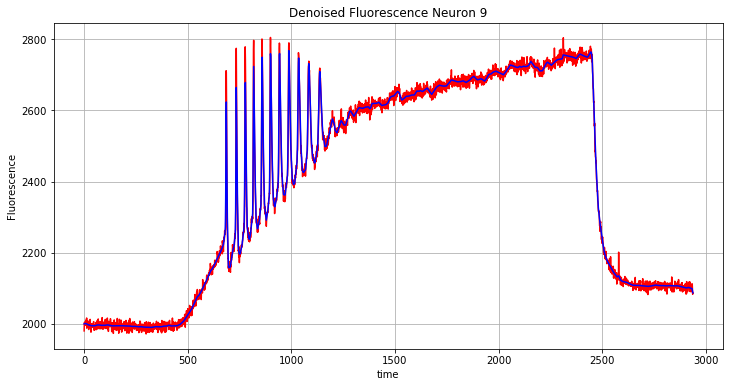

In [183]:
fig, ax = plt.subplots(figsize=(12, 6))
ax.plot(np.arange(T), signal, 'r')
ax.plot(np.arange(T), x, 'b')

ax.set(xlabel='time', ylabel='Fluorescence',
       title='Denoised Fluorescence Neuron {}'.format(idx))
ax.grid()

plt.show()

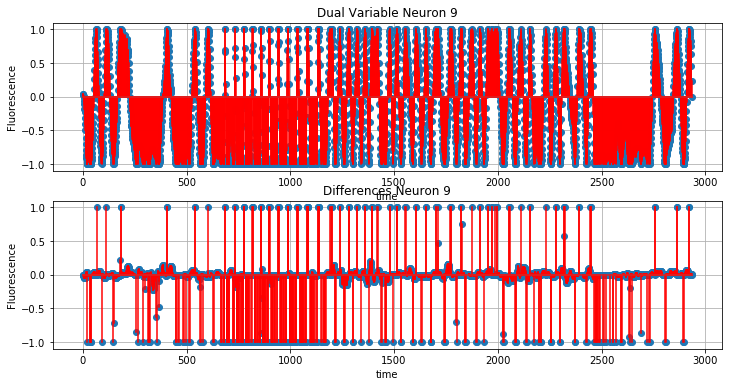

In [198]:
fig, ax = plt.subplots(2,1, figsize=(12, 6))
ax[0].stem(np.arange(T-2), warm_start[1], 'r')
ax[1].stem(np.arange(T-2), pd.linf_projection(500*pd.second_order_diff(warm_start[0]),1), 'r')

ax[0].set(xlabel='time', ylabel='Fluorescence',
       title='Dual Variable Neuron {}'.format(idx))
ax[0].grid()

ax[1].set(xlabel='time', ylabel='Fluorescence',
       title='Differences Neuron {}'.format(idx))
ax[1].grid()

plt.show()

# Estimation Of Noise From Different Regions

In [5]:
# Assign New Neuron At Random
idx = np.random.randint(0, N)
signal = data['C'][idx,:]
truth = signal.copy()


# Estimate Noise From Quiet Region
sigma = tfd.estimate_noise(np.array([signal[1500:2200]]),
                           estimator=estimator,
                           summarize=summarize)

# Add Artificial Noise and Re-estimate Noise
signal = signal + np.random.randn(T) * np.sqrt(noise_factor**2 - 1)*sigma
highpass_signal = tfd.butter_highpass_filter(signal, cutoff, fs, order)
sigma = tfd.estimate_noise(np.array([signal[1500:2200]]),
                           estimator=estimator,
                           summarize=summarize)
sigma_full = tfd.estimate_noise(np.array([signal]),
                           estimator=estimator,
                           summarize=summarize)


region_idx, is_active = tfd.detect_regions(signal)
colors = ['k', 'm', 'c', 'g', 'y']


# Generate Comparison Plots
fig, ax = plt.subplots(5, figsize=(14, 12))
ax[0].plot(np.arange(T),signal, 'r')
ax[0].plot(np.arange(T), truth, 'g')
ax[0].plot(np.arange(T),signal - highpass_signal, 'b')

ax[0].set(xlabel='time', ylabel='Fluorescence',
       title='Raw Fluorescence And Slow Trend Neuron {}'.format(idx))
ax[0].grid()


ax[1].plot(np.arange(T), highpass_signal, 'r')
ax[1].plot(np.arange(T), np.random.randn(T)*sigma, 'b')

ax[1].set(xlabel='time', ylabel='Fluorescence',
       title='Quiet Noise Estimate {}'.format(sigma))
ax[1].grid()

ax[2].plot(np.arange(T), highpass_signal, 'r')
ax[2].plot(np.arange(T), np.random.randn(T)*sigma_full, 'b')

ax[2].set(xlabel='time', ylabel='Fluorescence',
       title='Full Noise Estimate {}'.format(sigma_full))
ax[2].grid()

ax[3].plot(np.arange(T), highpass_signal/sigma, 'r')
ax[3].plot(np.arange(T), np.ones(T)*min_pnr, 'b')
ax[3].plot(np.arange(T), np.ones(T)*-min_pnr, 'b')

ax[3].set(xlabel='time', ylabel='Fluorescence',
       title='PNR Neuron {}'.format(idx))
ax[3].grid()

for idx, rdx in enumerate(region_idx):
    ax[4].plot(np.arange(len(rdx)) + min(rdx), (highpass_signal/sigma)[rdx], colors[idx])
ax[4].plot(np.arange(T), np.ones(T)*min_pnr, 'b')
ax[4].plot(np.arange(T), np.ones(T)*-min_pnr, 'b')

ax[4].set(xlabel='time', ylabel='Fluorescence',
       title='PNR Neuron {}'.format(idx))
ax[4].grid()
plt.show()

AttributeError: module 'trefide' has no attribute 'butter_highpass_filter'

ValueError: x and y must have same first dimension, but have shapes (2938,) and (3,)

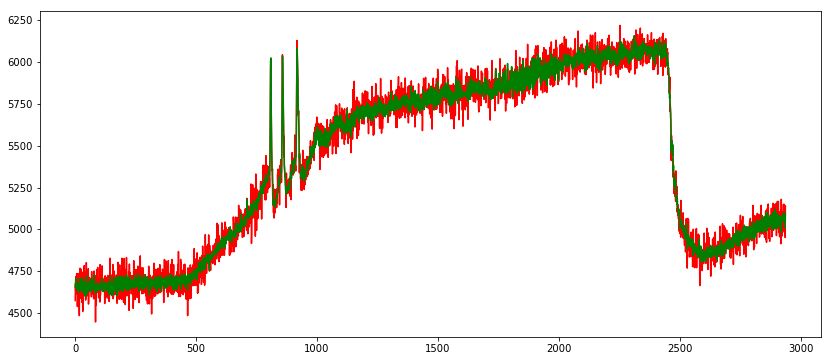

In [9]:
trend_filtered = tfd.constrained_l1tf(signal)

fig, ax = plt.subplots(1, figsize=(14, 6))
ax.plot(np.arange(T), signal, 'r')
ax.plot(np.arange(T), truth, 'g')
ax.plot(np.arange(T), trend_filtered, 'b')

ax.set(xlabel='time', ylabel='Fluorescence',
       title='Raw Fluorescence And Slow Trend Neuron {}'.format(idx))
ax.grid()
plt.show()

In [7]:
# Add noise to traces
data['noisey'] = np.zeros(data['C'].shape)
for idx, stdv in enumerate(tfd.estimate_noise(data['C'])):
    data['noisey'][idx,:] = data['C'][idx,:] + np.random.randn(T) * np.sqrt(noise_factor**2 - 1)*stdv

In [8]:
denoised = tfd.denoise(data['noisey'], region_active_discount=.05)

NameError: name 'denoised' is not defined

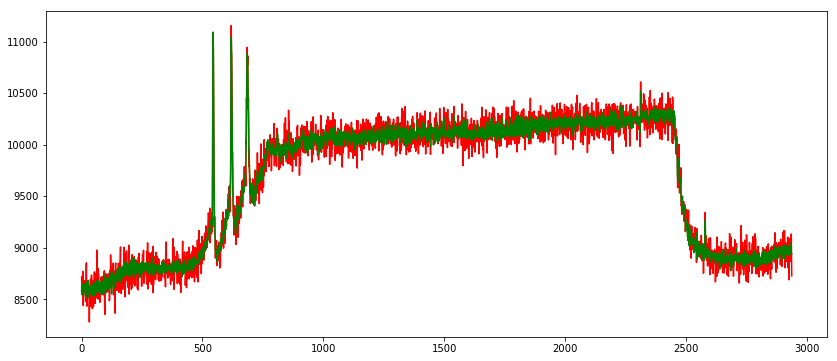

In [10]:
for idx in np.arange(N):
    
    fig, ax = plt.subplots(1, figsize=(14, 6))
    ax.plot(np.arange(T), data['noisey'][idx,:], 'r')
    ax.plot(np.arange(T), data['C'][idx,:], 'g')
    ax.plot(np.arange(T), denoised[idx,:], 'b')

    ax.set(xlabel='time', ylabel='Fluorescence',
           title='Raw Fluorescence And Slow Trend Neuron {}'.format(idx))
    ax.grid()
    plt.show()

In [121]:
DDT = active_set.second_order_diff_subset_gram(np.arange(T))

In [127]:
np.linalg.inv(DDT.todense()).dot(pd.second_order_diff(y[:7] - 500 * pd.second_order_div(warm_start[1])[:7]))

matrix([[  7.97343142,   5.1576318 ,   1.94328542, -17.14521283,
         -11.36424483]])

In [143]:
active_set.second_order_div_subset(warm_start[1][np.array([5,6,8,10,20])], np.array([5,6,8,10,20]), T)[3:10]

array([ 0.        ,  0.        , -0.05319107,  0.01346298,  0.13264726,
       -0.23903581,  0.29223329])

In [144]:
test = np.zeros(len(warm_start[1]))
test[np.array([5,6,8,10,20])] = warm_start[1][np.array([5,6,8,10,20])]

In [150]:
pd.second_order_div(test)[3:10]

array([ 0.        ,  0.        , -0.05319107,  0.01346298,  0.13264726,
       -0.23903581,  0.29223329])

In [151]:
active_set.second_order_diff_subset_gram(np.array([5,6,8,10,20])) * warm_start[1][np.array([5,6,8,10,20])]

array([-0.05253023,  0.63698399,  1.38519998,  1.26021864,  0.99890531])

In [153]:
active_set.second_order_diff_subset(
    active_set.second_order_div_subset(warm_start[1][np.array([5,6,8,10,20])],
                                       np.array([5,6,8,10,20]),
                                       T),
    np.array([5,6,8,10,20]))

array([-0.05253023,  0.49086735,  1.13094993,  1.11410199,  0.99890531])

In [154]:
active_set.second_order_diff_subset_gram(np.array([5,6,8,10,20])).todense()

matrix([[ 6., -4.,  0.,  0.,  0.],
        [-4.,  6.,  2.,  0.,  0.],
        [ 0.,  2.,  6.,  2.,  0.],
        [ 0.,  0.,  2.,  6.,  0.],
        [ 0.,  0.,  0.,  0.,  6.]])

In [163]:
test = np.zeros(len(warm_start[1]))
test[np.array([5,6,8,10,20])] = warm_start[1][np.array([5,6,8,10,20])]

In [164]:
pd.second_order_diff(pd.second_order_div(test))[np.array([5,6,8,10,20])]

array([-0.05253023,  0.49086735,  1.13094993,  1.11410199,  0.99890531])

In [166]:
idx = np.array([3,4,5,6,8,10,12])

In [167]:
active_set.second_order_diff_subset_gram(idx) * warm_start[1][idx]

array([ 0.23410359, -0.04769546, -0.21513615,  0.54869475,  1.13094993,
        1.28609104,  1.19326519])

In [168]:
active_set.second_order_diff_subset(
    active_set.second_order_div_subset(warm_start[1][idx],
                                       idx,
                                       T),
    idx)

array([ 0.23410359, -0.04769546, -0.21513615,  0.54869475,  1.13094993,
        1.28609104,  1.19326519])

In [162]:
active_set.second_order_diff_subset_gram(idx).todense()

matrix([[ 6.,  0.,  0.,  0.,  0.],
        [ 0.,  6., -4.,  0.,  0.],
        [ 0., -4.,  6.,  0.,  0.],
        [ 0.,  0.,  0.,  6.,  2.],
        [ 0.,  0.,  0.,  2.,  6.]])